# Ely's test notebook for visualizing in 3D, Neurohackweek 2017

- Cloned from the demo introductory_3d.ipynb notebook
- Initial functionality based on [IPyvolume](https://ipyvolume.readthedocs.io/en/latest/index.html)

load packages

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

import nibabel as nb
import ipyvolume
import ipyvolume.pylab as p3
import numpy as np
import os
import sys

# be sure to set the global variable NHW to your NHW_visualization git directory
# e.g. add 'export NHW=$HOME/Desktop/nhw2017/NHW_visualization' to your ~/.bashrc file
nhw = os.environ['NHW'] # set the global variable NHW to your NHW_visualization git directory


<b>3D Volume Rendering:</b>

In [5]:
V = nb.load(nhw + '/data/100610/MNINonLinear/T1w_restore_brain.nii.gz').get_data()
ipyvolume.quickvolshow(V, level=[0.25, 0.5, 0.75], opacity=0.03, level_width=0.1, 
                       width=600, height=600)

/Users/ely/Dropbox/SCIENCE/Software/anaconda3/anaconda/lib/python3.6/site-packages/ipyvolume/serialize.py:66: RuntimeWarning: invalid value encountered in true_divide
  gradient = gradient / np.sqrt(gradient[0]**2 + gradient[1]**2 + gradient[2]**2)


A Jupyter Widget

In [469]:
img = nb.load(nhw + '/data/T1.nii.gz')
#img = nb.load(nhw + '/data/100610/MNINonLinear/T1w_restore_brain.nii.gz')
print("Dimensions", img.shape)
print("Pixel dimensions", img.header.get_zooms())
V = img.get_data()
#print("Largest dimension", np.max(img.shape))
#print(np.max(img.shape)-img.shape[0])

Dimensions (176, 256, 256)
Pixel dimensions (0.99999803, 1.0, 1.0)


In [467]:
fig = p3.figure(width=600, height=600)
fig.style = {'axes': {'color': 'black',
  'label': {'color': 'black'},
  'ticklabel': {'color': 'black'},
  'visible': False},
 'background-color': 'white',
 'box': {'visible': False}}
fig.camera_fov = 1
fig.xlim = (-100, 100)
fig.ylim = (-100, 100)
fig.zlim = (-100, 100)

fig.anglex = 0
fig.angley = 0
fig.anglez = -np.pi/2
vol = p3.volshow(V)
p3.show()

A Jupyter Widget

In [468]:
fig = p3.figure(width=600, height=600)
fig.style = {'axes': {'color': 'black',
  'label': {'color': 'black'},
  'ticklabel': {'color': 'black'},
  'visible': False},
 'background-color': 'white',
 'box': {'visible': False}}
fig.camera_fov = 1

# Set viewing angle
fig.anglex = -2.5287287502882
fig.angley = 0.432399229463336
fig.anglez = -1.7057381623311114

# Turn volume into cube
Vnew = np.concatenate((np.zeros((256-176, 256, 256)), V), axis=0)
#Vnew = np.concatenate((np.zeros((img.shape[0]-176, img.shape[1], img.shape[2])), V), axis=0) #modded to adapt to image size
#print(np.max(img.shape)-img.shape[0])
#print(np.max(img.shape)-img.shape[1])
#print(np.max(img.shape)-img.shape[2])
#print(np.zeros((np.max(img.shape)-img.shape[0], np.max(img.shape), np.max(img.shape))))
#print(np.zeros((51,1,51)))
#Vnew = np.concatenate((np.zeros((np.max(img.shape)-img.shape[0], np.max(img.shape), np.max(img.shape)-img.shape[2])), V), axis=0) #modded to adapt to image size

vol = p3.volshow(Vnew, level=[0.21, 0.30], opacity=[0.2, 1.0], max_opacity=1, lighting=True, downscale=2,
                 diffuse_coefficient=0.5, controls=False)
p3.show()

ValueError: all the input array dimensions except for the concatenation axis must match exactly

In [471]:
fig = p3.figure(width=600, height=600)
fig.style = {'axes': {'color': 'black',
  'label': {'color': 'black'},
  'ticklabel': {'color': 'black'},
  'visible': False},
 'background-color': 'white',
 'box': {'visible': False}}
fig.camera_fov = 1

# Set viewing angle
fig.anglex = -2.5287287502882
fig.angley = 0.432399229463336
fig.anglez = -1.7057381623311114

# Turn volume into cube
Vnew = np.concatenate((np.zeros((256-176, 256, 256)), V), axis=0)

vol = p3.volshow(Vnew, level=[0.21, 0.30], opacity=[0.2, 1.0], max_opacity=1, lighting=True, downscale=2,
                 diffuse_coefficient=0.5, controls=False)
p3.show()

A Jupyter Widget

In [472]:
fig = p3.figure(width=600, height=600)
fig.style = {'axes': {'color': 'black',
  'label': {'color': 'black'},
  'ticklabel': {'color': 'black'},
  'visible': False},
 'background-color': 'white',
 'box': {'visible': False}}
fig.camera_fov = 1
Vnew = np.concatenate((np.zeros((256-176, 256, 256)), V), axis=0)
# Set viewing angle
fig.anglex = -1.4971217646597959
fig.angley = 0.45647865940768106
fig.anglez = 3.0730970695793047
vol = p3.plot_isosurface(Vnew, 200)
p3.show()

A Jupyter Widget



<b> Surface Rendering: </b>

In [26]:
data_lh = nb.load(nhw+'/data/100610/MNINonLinear/fsaverage_LR32k/100610.L.midthickness_MSMAll.32k_fs_LR.surf.gii')
data_rh = nb.load(nhw+'/data/100610/MNINonLinear/fsaverage_LR32k/100610.R.midthickness_MSMAll.32k_fs_LR.surf.gii')
data_lh_nat = nb.load(nhw+'/data/100610/T1w/Native/100610.L.pial.native.surf.gii')
data_rh_nat = nb.load(nhw+'/data/100610/T1w/Native/100610.R.pial.native.surf.gii')
data_lh_myelin = nb.load(nhw+'/data/100610/MNINonLinear/fsaverage_LR32k/100610.L.MyelinMap.32k_fs_LR.func.gii')
data_rh_myelin = nb.load(nhw+'/data/100610/MNINonLinear/fsaverage_LR32k/100610.R.MyelinMap.32k_fs_LR.func.gii')
subcort = nb.load('/Users/ely/Desktop/HCP/100610/MNINonLinear/ROIs/ROIs.2.nii.gz')

xyz_lh=data_lh.darrays[0]
xyz_rh=data_rh.darrays[0]
mesh_lh=data_lh.darrays[1]
mesh_rh=data_rh.darrays[1]
cort_lh=(data_lh_myelin.darrays[0].data>0)
cort_rh=(data_rh_myelin.darrays[0].data>0)
sub_lh=(data_lh_myelin.darrays[0].data==0)
sub_rh=(data_rh_myelin.darrays[0].data==0)
olay_lh=data_lh_myelin.darrays[0].data
olay_rh=data_rh_myelin.darrays[0].data

cort_olay_lh=data_lh_myelin.darrays[0].data[cort_lh]
cort_olay_rh=data_rh_myelin.darrays[0].data[cort_rh]
sub_olay_lh=data_lh_myelin.darrays[0].data[sub_lh]
sub_olay_rh=data_rh_myelin.darrays[0].data[sub_rh]

In [567]:
# compute MNI coordinates from voxel coordinates
sub_data=subcort.get_data()
subcort_disp=sub_data!=0
from nibabel.affines import apply_affine

real_coords=np.zeros([subcort_disp.shape[0],subcort_disp.shape[1],subcort_disp.shape[2]], dtype = object)
xyz_sub=[]#np.zeros([33259,33259,33259],dtype=object)
c=0
for xx in range (0, subcort_disp.shape[0]):
    for yy in range (0, subcort_disp.shape[1]):
        for zz in range (0, subcort_disp.shape[2]):
            real_coords[xx,yy,zz]=apply_affine(subcort.affine,[xx,yy,zz])
#            print(real_coords[xx,yy,zz])
#            xyz_sub[i]

[  90. -126.  -72.]
[  90. -126.  -70.]
[  90. -126.  -68.]
[  90. -126.  -66.]
[  90. -126.  -64.]
[  90. -126.  -62.]
[  90. -126.  -60.]
[  90. -126.  -58.]
[  90. -126.  -56.]
[  90. -126.  -54.]
[  90. -126.  -52.]
[  90. -126.  -50.]
[  90. -126.  -48.]
[  90. -126.  -46.]
[  90. -126.  -44.]
[  90. -126.  -42.]
[  90. -126.  -40.]
[  90. -126.  -38.]
[  90. -126.  -36.]
[  90. -126.  -34.]
[  90. -126.  -32.]
[  90. -126.  -30.]
[  90. -126.  -28.]
[  90. -126.  -26.]
[  90. -126.  -24.]
[  90. -126.  -22.]
[  90. -126.  -20.]
[  90. -126.  -18.]
[  90. -126.  -16.]
[  90. -126.  -14.]
[  90. -126.  -12.]
[  90. -126.  -10.]
[  90. -126.   -8.]
[  90. -126.   -6.]
[  90. -126.   -4.]
[  90. -126.   -2.]
[  90. -126.    0.]
[  90. -126.    2.]
[  90. -126.    4.]
[  90. -126.    6.]
[  90. -126.    8.]
[  90. -126.   10.]
[  90. -126.   12.]
[  90. -126.   14.]
[  90. -126.   16.]
[  90. -126.   18.]
[  90. -126.   20.]
[  90. -126.   22.]
[  90. -126.   24.]
[  90. -126.   26.]


[  90. -118.   68.]
[  90. -118.   70.]
[  90. -118.   72.]
[  90. -118.   74.]
[  90. -118.   76.]
[  90. -118.   78.]
[  90. -118.   80.]
[  90. -118.   82.]
[  90. -118.   84.]
[  90. -118.   86.]
[  90. -118.   88.]
[  90. -118.   90.]
[  90. -118.   92.]
[  90. -118.   94.]
[  90. -118.   96.]
[  90. -118.   98.]
[  90. -118.  100.]
[  90. -118.  102.]
[  90. -118.  104.]
[  90. -118.  106.]
[  90. -118.  108.]
[  90. -116.  -72.]
[  90. -116.  -70.]
[  90. -116.  -68.]
[  90. -116.  -66.]
[  90. -116.  -64.]
[  90. -116.  -62.]
[  90. -116.  -60.]
[  90. -116.  -58.]
[  90. -116.  -56.]
[  90. -116.  -54.]
[  90. -116.  -52.]
[  90. -116.  -50.]
[  90. -116.  -48.]
[  90. -116.  -46.]
[  90. -116.  -44.]
[  90. -116.  -42.]
[  90. -116.  -40.]
[  90. -116.  -38.]
[  90. -116.  -36.]
[  90. -116.  -34.]
[  90. -116.  -32.]
[  90. -116.  -30.]
[  90. -116.  -28.]
[  90. -116.  -26.]
[  90. -116.  -24.]
[  90. -116.  -22.]
[  90. -116.  -20.]
[  90. -116.  -18.]
[  90. -116.  -16.]


[  90. -106.  -68.]
[  90. -106.  -66.]
[  90. -106.  -64.]
[  90. -106.  -62.]
[  90. -106.  -60.]
[  90. -106.  -58.]
[  90. -106.  -56.]
[  90. -106.  -54.]
[  90. -106.  -52.]
[  90. -106.  -50.]
[  90. -106.  -48.]
[  90. -106.  -46.]
[  90. -106.  -44.]
[  90. -106.  -42.]
[  90. -106.  -40.]
[  90. -106.  -38.]
[  90. -106.  -36.]
[  90. -106.  -34.]
[  90. -106.  -32.]
[  90. -106.  -30.]
[  90. -106.  -28.]
[  90. -106.  -26.]
[  90. -106.  -24.]
[  90. -106.  -22.]
[  90. -106.  -20.]
[  90. -106.  -18.]
[  90. -106.  -16.]
[  90. -106.  -14.]
[  90. -106.  -12.]
[  90. -106.  -10.]
[  90. -106.   -8.]
[  90. -106.   -6.]
[  90. -106.   -4.]
[  90. -106.   -2.]
[  90. -106.    0.]
[  90. -106.    2.]
[  90. -106.    4.]
[  90. -106.    6.]
[  90. -106.    8.]
[  90. -106.   10.]
[  90. -106.   12.]
[  90. -106.   14.]
[  90. -106.   16.]
[  90. -106.   18.]
[  90. -106.   20.]
[  90. -106.   22.]
[  90. -106.   24.]
[  90. -106.   26.]
[  90. -106.   28.]
[  90. -106.   30.]


[  90.  -96.  106.]
[  90.  -96.  108.]
[ 90. -94. -72.]
[ 90. -94. -70.]
[ 90. -94. -68.]
[ 90. -94. -66.]
[ 90. -94. -64.]
[ 90. -94. -62.]
[ 90. -94. -60.]
[ 90. -94. -58.]
[ 90. -94. -56.]
[ 90. -94. -54.]
[ 90. -94. -52.]
[ 90. -94. -50.]
[ 90. -94. -48.]
[ 90. -94. -46.]
[ 90. -94. -44.]
[ 90. -94. -42.]
[ 90. -94. -40.]
[ 90. -94. -38.]
[ 90. -94. -36.]
[ 90. -94. -34.]
[ 90. -94. -32.]
[ 90. -94. -30.]
[ 90. -94. -28.]
[ 90. -94. -26.]
[ 90. -94. -24.]
[ 90. -94. -22.]
[ 90. -94. -20.]
[ 90. -94. -18.]
[ 90. -94. -16.]
[ 90. -94. -14.]
[ 90. -94. -12.]
[ 90. -94. -10.]
[ 90. -94.  -8.]
[ 90. -94.  -6.]
[ 90. -94.  -4.]
[ 90. -94.  -2.]
[ 90. -94.   0.]
[ 90. -94.   2.]
[ 90. -94.   4.]
[ 90. -94.   6.]
[ 90. -94.   8.]
[ 90. -94.  10.]
[ 90. -94.  12.]
[ 90. -94.  14.]
[ 90. -94.  16.]
[ 90. -94.  18.]
[ 90. -94.  20.]
[ 90. -94.  22.]
[ 90. -94.  24.]
[ 90. -94.  26.]
[ 90. -94.  28.]
[ 90. -94.  30.]
[ 90. -94.  32.]
[ 90. -94.  34.]
[ 90. -94.  36.]
[ 90. -94.  38.]
[ 90. -9

[ 90. -82. -52.]
[ 90. -82. -50.]
[ 90. -82. -48.]
[ 90. -82. -46.]
[ 90. -82. -44.]
[ 90. -82. -42.]
[ 90. -82. -40.]
[ 90. -82. -38.]
[ 90. -82. -36.]
[ 90. -82. -34.]
[ 90. -82. -32.]
[ 90. -82. -30.]
[ 90. -82. -28.]
[ 90. -82. -26.]
[ 90. -82. -24.]
[ 90. -82. -22.]
[ 90. -82. -20.]
[ 90. -82. -18.]
[ 90. -82. -16.]
[ 90. -82. -14.]
[ 90. -82. -12.]
[ 90. -82. -10.]
[ 90. -82.  -8.]
[ 90. -82.  -6.]
[ 90. -82.  -4.]
[ 90. -82.  -2.]
[ 90. -82.   0.]
[ 90. -82.   2.]
[ 90. -82.   4.]
[ 90. -82.   6.]
[ 90. -82.   8.]
[ 90. -82.  10.]
[ 90. -82.  12.]
[ 90. -82.  14.]
[ 90. -82.  16.]
[ 90. -82.  18.]
[ 90. -82.  20.]
[ 90. -82.  22.]
[ 90. -82.  24.]
[ 90. -82.  26.]
[ 90. -82.  28.]
[ 90. -82.  30.]
[ 90. -82.  32.]
[ 90. -82.  34.]
[ 90. -82.  36.]
[ 90. -82.  38.]
[ 90. -82.  40.]
[ 90. -82.  42.]
[ 90. -82.  44.]
[ 90. -82.  46.]
[ 90. -82.  48.]
[ 90. -82.  50.]
[ 90. -82.  52.]
[ 90. -82.  54.]
[ 90. -82.  56.]
[ 90. -82.  58.]
[ 90. -82.  60.]
[ 90. -82.  62.]
[ 90. -82.  64

[ 90. -70.   2.]
[ 90. -70.   4.]
[ 90. -70.   6.]
[ 90. -70.   8.]
[ 90. -70.  10.]
[ 90. -70.  12.]
[ 90. -70.  14.]
[ 90. -70.  16.]
[ 90. -70.  18.]
[ 90. -70.  20.]
[ 90. -70.  22.]
[ 90. -70.  24.]
[ 90. -70.  26.]
[ 90. -70.  28.]
[ 90. -70.  30.]
[ 90. -70.  32.]
[ 90. -70.  34.]
[ 90. -70.  36.]
[ 90. -70.  38.]
[ 90. -70.  40.]
[ 90. -70.  42.]
[ 90. -70.  44.]
[ 90. -70.  46.]
[ 90. -70.  48.]
[ 90. -70.  50.]
[ 90. -70.  52.]
[ 90. -70.  54.]
[ 90. -70.  56.]
[ 90. -70.  58.]
[ 90. -70.  60.]
[ 90. -70.  62.]
[ 90. -70.  64.]
[ 90. -70.  66.]
[ 90. -70.  68.]
[ 90. -70.  70.]
[ 90. -70.  72.]
[ 90. -70.  74.]
[ 90. -70.  76.]
[ 90. -70.  78.]
[ 90. -70.  80.]
[ 90. -70.  82.]
[ 90. -70.  84.]
[ 90. -70.  86.]
[ 90. -70.  88.]
[ 90. -70.  90.]
[ 90. -70.  92.]
[ 90. -70.  94.]
[ 90. -70.  96.]
[ 90. -70.  98.]
[  90.  -70.  100.]
[  90.  -70.  102.]
[  90.  -70.  104.]
[  90.  -70.  106.]
[  90.  -70.  108.]
[ 90. -68. -72.]
[ 90. -68. -70.]
[ 90. -68. -68.]
[ 90. -68. -66.]

[ 90. -58.  50.]
[ 90. -58.  52.]
[ 90. -58.  54.]
[ 90. -58.  56.]
[ 90. -58.  58.]
[ 90. -58.  60.]
[ 90. -58.  62.]
[ 90. -58.  64.]
[ 90. -58.  66.]
[ 90. -58.  68.]
[ 90. -58.  70.]
[ 90. -58.  72.]
[ 90. -58.  74.]
[ 90. -58.  76.]
[ 90. -58.  78.]
[ 90. -58.  80.]
[ 90. -58.  82.]
[ 90. -58.  84.]
[ 90. -58.  86.]
[ 90. -58.  88.]
[ 90. -58.  90.]
[ 90. -58.  92.]
[ 90. -58.  94.]
[ 90. -58.  96.]
[ 90. -58.  98.]
[  90.  -58.  100.]
[  90.  -58.  102.]
[  90.  -58.  104.]
[  90.  -58.  106.]
[  90.  -58.  108.]
[ 90. -56. -72.]
[ 90. -56. -70.]
[ 90. -56. -68.]
[ 90. -56. -66.]
[ 90. -56. -64.]
[ 90. -56. -62.]
[ 90. -56. -60.]
[ 90. -56. -58.]
[ 90. -56. -56.]
[ 90. -56. -54.]
[ 90. -56. -52.]
[ 90. -56. -50.]
[ 90. -56. -48.]
[ 90. -56. -46.]
[ 90. -56. -44.]
[ 90. -56. -42.]
[ 90. -56. -40.]
[ 90. -56. -38.]
[ 90. -56. -36.]
[ 90. -56. -34.]
[ 90. -56. -32.]
[ 90. -56. -30.]
[ 90. -56. -28.]
[ 90. -56. -26.]
[ 90. -56. -24.]
[ 90. -56. -22.]
[ 90. -56. -20.]
[ 90. -56. -18.]

[ 90. -46.  82.]
[ 90. -46.  84.]
[ 90. -46.  86.]
[ 90. -46.  88.]
[ 90. -46.  90.]
[ 90. -46.  92.]
[ 90. -46.  94.]
[ 90. -46.  96.]
[ 90. -46.  98.]
[  90.  -46.  100.]
[  90.  -46.  102.]
[  90.  -46.  104.]
[  90.  -46.  106.]
[  90.  -46.  108.]
[ 90. -44. -72.]
[ 90. -44. -70.]
[ 90. -44. -68.]
[ 90. -44. -66.]
[ 90. -44. -64.]
[ 90. -44. -62.]
[ 90. -44. -60.]
[ 90. -44. -58.]
[ 90. -44. -56.]
[ 90. -44. -54.]
[ 90. -44. -52.]
[ 90. -44. -50.]
[ 90. -44. -48.]
[ 90. -44. -46.]
[ 90. -44. -44.]
[ 90. -44. -42.]
[ 90. -44. -40.]
[ 90. -44. -38.]
[ 90. -44. -36.]
[ 90. -44. -34.]
[ 90. -44. -32.]
[ 90. -44. -30.]
[ 90. -44. -28.]
[ 90. -44. -26.]
[ 90. -44. -24.]
[ 90. -44. -22.]
[ 90. -44. -20.]
[ 90. -44. -18.]
[ 90. -44. -16.]
[ 90. -44. -14.]
[ 90. -44. -12.]
[ 90. -44. -10.]
[ 90. -44.  -8.]
[ 90. -44.  -6.]
[ 90. -44.  -4.]
[ 90. -44.  -2.]
[ 90. -44.   0.]
[ 90. -44.   2.]
[ 90. -44.   4.]
[ 90. -44.   6.]
[ 90. -44.   8.]
[ 90. -44.  10.]
[ 90. -44.  12.]
[ 90. -44.  14.]

[ 90. -32. -64.]
[ 90. -32. -62.]
[ 90. -32. -60.]
[ 90. -32. -58.]
[ 90. -32. -56.]
[ 90. -32. -54.]
[ 90. -32. -52.]
[ 90. -32. -50.]
[ 90. -32. -48.]
[ 90. -32. -46.]
[ 90. -32. -44.]
[ 90. -32. -42.]
[ 90. -32. -40.]
[ 90. -32. -38.]
[ 90. -32. -36.]
[ 90. -32. -34.]
[ 90. -32. -32.]
[ 90. -32. -30.]
[ 90. -32. -28.]
[ 90. -32. -26.]
[ 90. -32. -24.]
[ 90. -32. -22.]
[ 90. -32. -20.]
[ 90. -32. -18.]
[ 90. -32. -16.]
[ 90. -32. -14.]
[ 90. -32. -12.]
[ 90. -32. -10.]
[ 90. -32.  -8.]
[ 90. -32.  -6.]
[ 90. -32.  -4.]
[ 90. -32.  -2.]
[ 90. -32.   0.]
[ 90. -32.   2.]
[ 90. -32.   4.]
[ 90. -32.   6.]
[ 90. -32.   8.]
[ 90. -32.  10.]
[ 90. -32.  12.]
[ 90. -32.  14.]
[ 90. -32.  16.]
[ 90. -32.  18.]
[ 90. -32.  20.]
[ 90. -32.  22.]
[ 90. -32.  24.]
[ 90. -32.  26.]
[ 90. -32.  28.]
[ 90. -32.  30.]
[ 90. -32.  32.]
[ 90. -32.  34.]
[ 90. -32.  36.]
[ 90. -32.  38.]
[ 90. -32.  40.]
[ 90. -32.  42.]
[ 90. -32.  44.]
[ 90. -32.  46.]
[ 90. -32.  48.]
[ 90. -32.  50.]
[ 90. -32.  52

[ 90. -20. -14.]
[ 90. -20. -12.]
[ 90. -20. -10.]
[ 90. -20.  -8.]
[ 90. -20.  -6.]
[ 90. -20.  -4.]
[ 90. -20.  -2.]
[ 90. -20.   0.]
[ 90. -20.   2.]
[ 90. -20.   4.]
[ 90. -20.   6.]
[ 90. -20.   8.]
[ 90. -20.  10.]
[ 90. -20.  12.]
[ 90. -20.  14.]
[ 90. -20.  16.]
[ 90. -20.  18.]
[ 90. -20.  20.]
[ 90. -20.  22.]
[ 90. -20.  24.]
[ 90. -20.  26.]
[ 90. -20.  28.]
[ 90. -20.  30.]
[ 90. -20.  32.]
[ 90. -20.  34.]
[ 90. -20.  36.]
[ 90. -20.  38.]
[ 90. -20.  40.]
[ 90. -20.  42.]
[ 90. -20.  44.]
[ 90. -20.  46.]
[ 90. -20.  48.]
[ 90. -20.  50.]
[ 90. -20.  52.]
[ 90. -20.  54.]
[ 90. -20.  56.]
[ 90. -20.  58.]
[ 90. -20.  60.]
[ 90. -20.  62.]
[ 90. -20.  64.]
[ 90. -20.  66.]
[ 90. -20.  68.]
[ 90. -20.  70.]
[ 90. -20.  72.]
[ 90. -20.  74.]
[ 90. -20.  76.]
[ 90. -20.  78.]
[ 90. -20.  80.]
[ 90. -20.  82.]
[ 90. -20.  84.]
[ 90. -20.  86.]
[ 90. -20.  88.]
[ 90. -20.  90.]
[ 90. -20.  92.]
[ 90. -20.  94.]
[ 90. -20.  96.]
[ 90. -20.  98.]
[  90.  -20.  100.]
[  90.  -20

[ 90.  -8.  28.]
[ 90.  -8.  30.]
[ 90.  -8.  32.]
[ 90.  -8.  34.]
[ 90.  -8.  36.]
[ 90.  -8.  38.]
[ 90.  -8.  40.]
[ 90.  -8.  42.]
[ 90.  -8.  44.]
[ 90.  -8.  46.]
[ 90.  -8.  48.]
[ 90.  -8.  50.]
[ 90.  -8.  52.]
[ 90.  -8.  54.]
[ 90.  -8.  56.]
[ 90.  -8.  58.]
[ 90.  -8.  60.]
[ 90.  -8.  62.]
[ 90.  -8.  64.]
[ 90.  -8.  66.]
[ 90.  -8.  68.]
[ 90.  -8.  70.]
[ 90.  -8.  72.]
[ 90.  -8.  74.]
[ 90.  -8.  76.]
[ 90.  -8.  78.]
[ 90.  -8.  80.]
[ 90.  -8.  82.]
[ 90.  -8.  84.]
[ 90.  -8.  86.]
[ 90.  -8.  88.]
[ 90.  -8.  90.]
[ 90.  -8.  92.]
[ 90.  -8.  94.]
[ 90.  -8.  96.]
[ 90.  -8.  98.]
[  90.   -8.  100.]
[  90.   -8.  102.]
[  90.   -8.  104.]
[  90.   -8.  106.]
[  90.   -8.  108.]
[ 90.  -6. -72.]
[ 90.  -6. -70.]
[ 90.  -6. -68.]
[ 90.  -6. -66.]
[ 90.  -6. -64.]
[ 90.  -6. -62.]
[ 90.  -6. -60.]
[ 90.  -6. -58.]
[ 90.  -6. -56.]
[ 90.  -6. -54.]
[ 90.  -6. -52.]
[ 90.  -6. -50.]
[ 90.  -6. -48.]
[ 90.  -6. -46.]
[ 90.  -6. -44.]
[ 90.  -6. -42.]
[ 90.  -6. -40.]

[ 90.   4.  76.]
[ 90.   4.  78.]
[ 90.   4.  80.]
[ 90.   4.  82.]
[ 90.   4.  84.]
[ 90.   4.  86.]
[ 90.   4.  88.]
[ 90.   4.  90.]
[ 90.   4.  92.]
[ 90.   4.  94.]
[ 90.   4.  96.]
[ 90.   4.  98.]
[  90.    4.  100.]
[  90.    4.  102.]
[  90.    4.  104.]
[  90.    4.  106.]
[  90.    4.  108.]
[ 90.   6. -72.]
[ 90.   6. -70.]
[ 90.   6. -68.]
[ 90.   6. -66.]
[ 90.   6. -64.]
[ 90.   6. -62.]
[ 90.   6. -60.]
[ 90.   6. -58.]
[ 90.   6. -56.]
[ 90.   6. -54.]
[ 90.   6. -52.]
[ 90.   6. -50.]
[ 90.   6. -48.]
[ 90.   6. -46.]
[ 90.   6. -44.]
[ 90.   6. -42.]
[ 90.   6. -40.]
[ 90.   6. -38.]
[ 90.   6. -36.]
[ 90.   6. -34.]
[ 90.   6. -32.]
[ 90.   6. -30.]
[ 90.   6. -28.]
[ 90.   6. -26.]
[ 90.   6. -24.]
[ 90.   6. -22.]
[ 90.   6. -20.]
[ 90.   6. -18.]
[ 90.   6. -16.]
[ 90.   6. -14.]
[ 90.   6. -12.]
[ 90.   6. -10.]
[ 90.   6.  -8.]
[ 90.   6.  -6.]
[ 90.   6.  -4.]
[ 90.   6.  -2.]
[ 90.   6.   0.]
[ 90.   6.   2.]
[ 90.   6.   4.]
[ 90.   6.   6.]
[ 90.   6.   8.]

[  90.   16.  108.]
[ 90.  18. -72.]
[ 90.  18. -70.]
[ 90.  18. -68.]
[ 90.  18. -66.]
[ 90.  18. -64.]
[ 90.  18. -62.]
[ 90.  18. -60.]
[ 90.  18. -58.]
[ 90.  18. -56.]
[ 90.  18. -54.]
[ 90.  18. -52.]
[ 90.  18. -50.]
[ 90.  18. -48.]
[ 90.  18. -46.]
[ 90.  18. -44.]
[ 90.  18. -42.]
[ 90.  18. -40.]
[ 90.  18. -38.]
[ 90.  18. -36.]
[ 90.  18. -34.]
[ 90.  18. -32.]
[ 90.  18. -30.]
[ 90.  18. -28.]
[ 90.  18. -26.]
[ 90.  18. -24.]
[ 90.  18. -22.]
[ 90.  18. -20.]
[ 90.  18. -18.]
[ 90.  18. -16.]
[ 90.  18. -14.]
[ 90.  18. -12.]
[ 90.  18. -10.]
[ 90.  18.  -8.]
[ 90.  18.  -6.]
[ 90.  18.  -4.]
[ 90.  18.  -2.]
[ 90.  18.   0.]
[ 90.  18.   2.]
[ 90.  18.   4.]
[ 90.  18.   6.]
[ 90.  18.   8.]
[ 90.  18.  10.]
[ 90.  18.  12.]
[ 90.  18.  14.]
[ 90.  18.  16.]
[ 90.  18.  18.]
[ 90.  18.  20.]
[ 90.  18.  22.]
[ 90.  18.  24.]
[ 90.  18.  26.]
[ 90.  18.  28.]
[ 90.  18.  30.]
[ 90.  18.  32.]
[ 90.  18.  34.]
[ 90.  18.  36.]
[ 90.  18.  38.]
[ 90.  18.  40.]
[ 90.  18. 

[ 90.  28.  68.]
[ 90.  28.  70.]
[ 90.  28.  72.]
[ 90.  28.  74.]
[ 90.  28.  76.]
[ 90.  28.  78.]
[ 90.  28.  80.]
[ 90.  28.  82.]
[ 90.  28.  84.]
[ 90.  28.  86.]
[ 90.  28.  88.]
[ 90.  28.  90.]
[ 90.  28.  92.]
[ 90.  28.  94.]
[ 90.  28.  96.]
[ 90.  28.  98.]
[  90.   28.  100.]
[  90.   28.  102.]
[  90.   28.  104.]
[  90.   28.  106.]
[  90.   28.  108.]
[ 90.  30. -72.]
[ 90.  30. -70.]
[ 90.  30. -68.]
[ 90.  30. -66.]
[ 90.  30. -64.]
[ 90.  30. -62.]
[ 90.  30. -60.]
[ 90.  30. -58.]
[ 90.  30. -56.]
[ 90.  30. -54.]
[ 90.  30. -52.]
[ 90.  30. -50.]
[ 90.  30. -48.]
[ 90.  30. -46.]
[ 90.  30. -44.]
[ 90.  30. -42.]
[ 90.  30. -40.]
[ 90.  30. -38.]
[ 90.  30. -36.]
[ 90.  30. -34.]
[ 90.  30. -32.]
[ 90.  30. -30.]
[ 90.  30. -28.]
[ 90.  30. -26.]
[ 90.  30. -24.]
[ 90.  30. -22.]
[ 90.  30. -20.]
[ 90.  30. -18.]
[ 90.  30. -16.]
[ 90.  30. -14.]
[ 90.  30. -12.]
[ 90.  30. -10.]
[ 90.  30.  -8.]
[ 90.  30.  -6.]
[ 90.  30.  -4.]
[ 90.  30.  -2.]
[ 90.  30.   0.]

[ 90.  40. -68.]
[ 90.  40. -66.]
[ 90.  40. -64.]
[ 90.  40. -62.]
[ 90.  40. -60.]
[ 90.  40. -58.]
[ 90.  40. -56.]
[ 90.  40. -54.]
[ 90.  40. -52.]
[ 90.  40. -50.]
[ 90.  40. -48.]
[ 90.  40. -46.]
[ 90.  40. -44.]
[ 90.  40. -42.]
[ 90.  40. -40.]
[ 90.  40. -38.]
[ 90.  40. -36.]
[ 90.  40. -34.]
[ 90.  40. -32.]
[ 90.  40. -30.]
[ 90.  40. -28.]
[ 90.  40. -26.]
[ 90.  40. -24.]
[ 90.  40. -22.]
[ 90.  40. -20.]
[ 90.  40. -18.]
[ 90.  40. -16.]
[ 90.  40. -14.]
[ 90.  40. -12.]
[ 90.  40. -10.]
[ 90.  40.  -8.]
[ 90.  40.  -6.]
[ 90.  40.  -4.]
[ 90.  40.  -2.]
[ 90.  40.   0.]
[ 90.  40.   2.]
[ 90.  40.   4.]
[ 90.  40.   6.]
[ 90.  40.   8.]
[ 90.  40.  10.]
[ 90.  40.  12.]
[ 90.  40.  14.]
[ 90.  40.  16.]
[ 90.  40.  18.]
[ 90.  40.  20.]
[ 90.  40.  22.]
[ 90.  40.  24.]
[ 90.  40.  26.]
[ 90.  40.  28.]
[ 90.  40.  30.]
[ 90.  40.  32.]
[ 90.  40.  34.]
[ 90.  40.  36.]
[ 90.  40.  38.]
[ 90.  40.  40.]
[ 90.  40.  42.]
[ 90.  40.  44.]
[ 90.  40.  46.]
[ 90.  40.  48

[ 90.  52. -26.]
[ 90.  52. -24.]
[ 90.  52. -22.]
[ 90.  52. -20.]
[ 90.  52. -18.]
[ 90.  52. -16.]
[ 90.  52. -14.]
[ 90.  52. -12.]
[ 90.  52. -10.]
[ 90.  52.  -8.]
[ 90.  52.  -6.]
[ 90.  52.  -4.]
[ 90.  52.  -2.]
[ 90.  52.   0.]
[ 90.  52.   2.]
[ 90.  52.   4.]
[ 90.  52.   6.]
[ 90.  52.   8.]
[ 90.  52.  10.]
[ 90.  52.  12.]
[ 90.  52.  14.]
[ 90.  52.  16.]
[ 90.  52.  18.]
[ 90.  52.  20.]
[ 90.  52.  22.]
[ 90.  52.  24.]
[ 90.  52.  26.]
[ 90.  52.  28.]
[ 90.  52.  30.]
[ 90.  52.  32.]
[ 90.  52.  34.]
[ 90.  52.  36.]
[ 90.  52.  38.]
[ 90.  52.  40.]
[ 90.  52.  42.]
[ 90.  52.  44.]
[ 90.  52.  46.]
[ 90.  52.  48.]
[ 90.  52.  50.]
[ 90.  52.  52.]
[ 90.  52.  54.]
[ 90.  52.  56.]
[ 90.  52.  58.]
[ 90.  52.  60.]
[ 90.  52.  62.]
[ 90.  52.  64.]
[ 90.  52.  66.]
[ 90.  52.  68.]
[ 90.  52.  70.]
[ 90.  52.  72.]
[ 90.  52.  74.]
[ 90.  52.  76.]
[ 90.  52.  78.]
[ 90.  52.  80.]
[ 90.  52.  82.]
[ 90.  52.  84.]
[ 90.  52.  86.]
[ 90.  52.  88.]
[ 90.  52.  90

[ 90.  64.  16.]
[ 90.  64.  18.]
[ 90.  64.  20.]
[ 90.  64.  22.]
[ 90.  64.  24.]
[ 90.  64.  26.]
[ 90.  64.  28.]
[ 90.  64.  30.]
[ 90.  64.  32.]
[ 90.  64.  34.]
[ 90.  64.  36.]
[ 90.  64.  38.]
[ 90.  64.  40.]
[ 90.  64.  42.]
[ 90.  64.  44.]
[ 90.  64.  46.]
[ 90.  64.  48.]
[ 90.  64.  50.]
[ 90.  64.  52.]
[ 90.  64.  54.]
[ 90.  64.  56.]
[ 90.  64.  58.]
[ 90.  64.  60.]
[ 90.  64.  62.]
[ 90.  64.  64.]
[ 90.  64.  66.]
[ 90.  64.  68.]
[ 90.  64.  70.]
[ 90.  64.  72.]
[ 90.  64.  74.]
[ 90.  64.  76.]
[ 90.  64.  78.]
[ 90.  64.  80.]
[ 90.  64.  82.]
[ 90.  64.  84.]
[ 90.  64.  86.]
[ 90.  64.  88.]
[ 90.  64.  90.]
[ 90.  64.  92.]
[ 90.  64.  94.]
[ 90.  64.  96.]
[ 90.  64.  98.]
[  90.   64.  100.]
[  90.   64.  102.]
[  90.   64.  104.]
[  90.   64.  106.]
[  90.   64.  108.]
[ 90.  66. -72.]
[ 90.  66. -70.]
[ 90.  66. -68.]
[ 90.  66. -66.]
[ 90.  66. -64.]
[ 90.  66. -62.]
[ 90.  66. -60.]
[ 90.  66. -58.]
[ 90.  66. -56.]
[ 90.  66. -54.]
[ 90.  66. -52.]

[ 90.  76.  50.]
[ 90.  76.  52.]
[ 90.  76.  54.]
[ 90.  76.  56.]
[ 90.  76.  58.]
[ 90.  76.  60.]
[ 90.  76.  62.]
[ 90.  76.  64.]
[ 90.  76.  66.]
[ 90.  76.  68.]
[ 90.  76.  70.]
[ 90.  76.  72.]
[ 90.  76.  74.]
[ 90.  76.  76.]
[ 90.  76.  78.]
[ 90.  76.  80.]
[ 90.  76.  82.]
[ 90.  76.  84.]
[ 90.  76.  86.]
[ 90.  76.  88.]
[ 90.  76.  90.]
[ 90.  76.  92.]
[ 90.  76.  94.]
[ 90.  76.  96.]
[ 90.  76.  98.]
[  90.   76.  100.]
[  90.   76.  102.]
[  90.   76.  104.]
[  90.   76.  106.]
[  90.   76.  108.]
[ 90.  78. -72.]
[ 90.  78. -70.]
[ 90.  78. -68.]
[ 90.  78. -66.]
[ 90.  78. -64.]
[ 90.  78. -62.]
[ 90.  78. -60.]
[ 90.  78. -58.]
[ 90.  78. -56.]
[ 90.  78. -54.]
[ 90.  78. -52.]
[ 90.  78. -50.]
[ 90.  78. -48.]
[ 90.  78. -46.]
[ 90.  78. -44.]
[ 90.  78. -42.]
[ 90.  78. -40.]
[ 90.  78. -38.]
[ 90.  78. -36.]
[ 90.  78. -34.]
[ 90.  78. -32.]
[ 90.  78. -30.]
[ 90.  78. -28.]
[ 90.  78. -26.]
[ 90.  78. -24.]
[ 90.  78. -22.]
[ 90.  78. -20.]
[ 90.  78. -18.]

[ 90.  90. -66.]
[ 90.  90. -64.]
[ 90.  90. -62.]
[ 90.  90. -60.]
[ 90.  90. -58.]
[ 90.  90. -56.]
[ 90.  90. -54.]
[ 90.  90. -52.]
[ 90.  90. -50.]
[ 90.  90. -48.]
[ 90.  90. -46.]
[ 90.  90. -44.]
[ 90.  90. -42.]
[ 90.  90. -40.]
[ 90.  90. -38.]
[ 90.  90. -36.]
[ 90.  90. -34.]
[ 90.  90. -32.]
[ 90.  90. -30.]
[ 90.  90. -28.]
[ 90.  90. -26.]
[ 90.  90. -24.]
[ 90.  90. -22.]
[ 90.  90. -20.]
[ 90.  90. -18.]
[ 90.  90. -16.]
[ 90.  90. -14.]
[ 90.  90. -12.]
[ 90.  90. -10.]
[ 90.  90.  -8.]
[ 90.  90.  -6.]
[ 90.  90.  -4.]
[ 90.  90.  -2.]
[ 90.  90.   0.]
[ 90.  90.   2.]
[ 90.  90.   4.]
[ 90.  90.   6.]
[ 90.  90.   8.]
[ 90.  90.  10.]
[ 90.  90.  12.]
[ 90.  90.  14.]
[ 90.  90.  16.]
[ 90.  90.  18.]
[ 90.  90.  20.]
[ 90.  90.  22.]
[ 90.  90.  24.]
[ 90.  90.  26.]
[ 90.  90.  28.]
[ 90.  90.  30.]
[ 90.  90.  32.]
[ 90.  90.  34.]
[ 90.  90.  36.]
[ 90.  90.  38.]
[ 90.  90.  40.]
[ 90.  90.  42.]
[ 90.  90.  44.]
[ 90.  90.  46.]
[ 90.  90.  48.]
[ 90.  90.  50

[  88. -116.   -8.]
[  88. -116.   -6.]
[  88. -116.   -4.]
[  88. -116.   -2.]
[  88. -116.    0.]
[  88. -116.    2.]
[  88. -116.    4.]
[  88. -116.    6.]
[  88. -116.    8.]
[  88. -116.   10.]
[  88. -116.   12.]
[  88. -116.   14.]
[  88. -116.   16.]
[  88. -116.   18.]
[  88. -116.   20.]
[  88. -116.   22.]
[  88. -116.   24.]
[  88. -116.   26.]
[  88. -116.   28.]
[  88. -116.   30.]
[  88. -116.   32.]
[  88. -116.   34.]
[  88. -116.   36.]
[  88. -116.   38.]
[  88. -116.   40.]
[  88. -116.   42.]
[  88. -116.   44.]
[  88. -116.   46.]
[  88. -116.   48.]
[  88. -116.   50.]
[  88. -116.   52.]
[  88. -116.   54.]
[  88. -116.   56.]
[  88. -116.   58.]
[  88. -116.   60.]
[  88. -116.   62.]
[  88. -116.   64.]
[  88. -116.   66.]
[  88. -116.   68.]
[  88. -116.   70.]
[  88. -116.   72.]
[  88. -116.   74.]
[  88. -116.   76.]
[  88. -116.   78.]
[  88. -116.   80.]
[  88. -116.   82.]
[  88. -116.   84.]
[  88. -116.   86.]
[  88. -116.   88.]
[  88. -116.   90.]


[  88. -104.   32.]
[  88. -104.   34.]
[  88. -104.   36.]
[  88. -104.   38.]
[  88. -104.   40.]
[  88. -104.   42.]
[  88. -104.   44.]
[  88. -104.   46.]
[  88. -104.   48.]
[  88. -104.   50.]
[  88. -104.   52.]
[  88. -104.   54.]
[  88. -104.   56.]
[  88. -104.   58.]
[  88. -104.   60.]
[  88. -104.   62.]
[  88. -104.   64.]
[  88. -104.   66.]
[  88. -104.   68.]
[  88. -104.   70.]
[  88. -104.   72.]
[  88. -104.   74.]
[  88. -104.   76.]
[  88. -104.   78.]
[  88. -104.   80.]
[  88. -104.   82.]
[  88. -104.   84.]
[  88. -104.   86.]
[  88. -104.   88.]
[  88. -104.   90.]
[  88. -104.   92.]
[  88. -104.   94.]
[  88. -104.   96.]
[  88. -104.   98.]
[  88. -104.  100.]
[  88. -104.  102.]
[  88. -104.  104.]
[  88. -104.  106.]
[  88. -104.  108.]
[  88. -102.  -72.]
[  88. -102.  -70.]
[  88. -102.  -68.]
[  88. -102.  -66.]
[  88. -102.  -64.]
[  88. -102.  -62.]
[  88. -102.  -60.]
[  88. -102.  -58.]
[  88. -102.  -56.]
[  88. -102.  -54.]
[  88. -102.  -52.]


[ 88. -92.  98.]
[  88.  -92.  100.]
[  88.  -92.  102.]
[  88.  -92.  104.]
[  88.  -92.  106.]
[  88.  -92.  108.]
[ 88. -90. -72.]
[ 88. -90. -70.]
[ 88. -90. -68.]
[ 88. -90. -66.]
[ 88. -90. -64.]
[ 88. -90. -62.]
[ 88. -90. -60.]
[ 88. -90. -58.]
[ 88. -90. -56.]
[ 88. -90. -54.]
[ 88. -90. -52.]
[ 88. -90. -50.]
[ 88. -90. -48.]
[ 88. -90. -46.]
[ 88. -90. -44.]
[ 88. -90. -42.]
[ 88. -90. -40.]
[ 88. -90. -38.]
[ 88. -90. -36.]
[ 88. -90. -34.]
[ 88. -90. -32.]
[ 88. -90. -30.]
[ 88. -90. -28.]
[ 88. -90. -26.]
[ 88. -90. -24.]
[ 88. -90. -22.]
[ 88. -90. -20.]
[ 88. -90. -18.]
[ 88. -90. -16.]
[ 88. -90. -14.]
[ 88. -90. -12.]
[ 88. -90. -10.]
[ 88. -90.  -8.]
[ 88. -90.  -6.]
[ 88. -90.  -4.]
[ 88. -90.  -2.]
[ 88. -90.   0.]
[ 88. -90.   2.]
[ 88. -90.   4.]
[ 88. -90.   6.]
[ 88. -90.   8.]
[ 88. -90.  10.]
[ 88. -90.  12.]
[ 88. -90.  14.]
[ 88. -90.  16.]
[ 88. -90.  18.]
[ 88. -90.  20.]
[ 88. -90.  22.]
[ 88. -90.  24.]
[ 88. -90.  26.]
[ 88. -90.  28.]
[ 88. -90.  30.]

[ 88. -78. -58.]
[ 88. -78. -56.]
[ 88. -78. -54.]
[ 88. -78. -52.]
[ 88. -78. -50.]
[ 88. -78. -48.]
[ 88. -78. -46.]
[ 88. -78. -44.]
[ 88. -78. -42.]
[ 88. -78. -40.]
[ 88. -78. -38.]
[ 88. -78. -36.]
[ 88. -78. -34.]
[ 88. -78. -32.]
[ 88. -78. -30.]
[ 88. -78. -28.]
[ 88. -78. -26.]
[ 88. -78. -24.]
[ 88. -78. -22.]
[ 88. -78. -20.]
[ 88. -78. -18.]
[ 88. -78. -16.]
[ 88. -78. -14.]
[ 88. -78. -12.]
[ 88. -78. -10.]
[ 88. -78.  -8.]
[ 88. -78.  -6.]
[ 88. -78.  -4.]
[ 88. -78.  -2.]
[ 88. -78.   0.]
[ 88. -78.   2.]
[ 88. -78.   4.]
[ 88. -78.   6.]
[ 88. -78.   8.]
[ 88. -78.  10.]
[ 88. -78.  12.]
[ 88. -78.  14.]
[ 88. -78.  16.]
[ 88. -78.  18.]
[ 88. -78.  20.]
[ 88. -78.  22.]
[ 88. -78.  24.]
[ 88. -78.  26.]
[ 88. -78.  28.]
[ 88. -78.  30.]
[ 88. -78.  32.]
[ 88. -78.  34.]
[ 88. -78.  36.]
[ 88. -78.  38.]
[ 88. -78.  40.]
[ 88. -78.  42.]
[ 88. -78.  44.]
[ 88. -78.  46.]
[ 88. -78.  48.]
[ 88. -78.  50.]
[ 88. -78.  52.]
[ 88. -78.  54.]
[ 88. -78.  56.]
[ 88. -78.  58

[ 88. -66. -10.]
[ 88. -66.  -8.]
[ 88. -66.  -6.]
[ 88. -66.  -4.]
[ 88. -66.  -2.]
[ 88. -66.   0.]
[ 88. -66.   2.]
[ 88. -66.   4.]
[ 88. -66.   6.]
[ 88. -66.   8.]
[ 88. -66.  10.]
[ 88. -66.  12.]
[ 88. -66.  14.]
[ 88. -66.  16.]
[ 88. -66.  18.]
[ 88. -66.  20.]
[ 88. -66.  22.]
[ 88. -66.  24.]
[ 88. -66.  26.]
[ 88. -66.  28.]
[ 88. -66.  30.]
[ 88. -66.  32.]
[ 88. -66.  34.]
[ 88. -66.  36.]
[ 88. -66.  38.]
[ 88. -66.  40.]
[ 88. -66.  42.]
[ 88. -66.  44.]
[ 88. -66.  46.]
[ 88. -66.  48.]
[ 88. -66.  50.]
[ 88. -66.  52.]
[ 88. -66.  54.]
[ 88. -66.  56.]
[ 88. -66.  58.]
[ 88. -66.  60.]
[ 88. -66.  62.]
[ 88. -66.  64.]
[ 88. -66.  66.]
[ 88. -66.  68.]
[ 88. -66.  70.]
[ 88. -66.  72.]
[ 88. -66.  74.]
[ 88. -66.  76.]
[ 88. -66.  78.]
[ 88. -66.  80.]
[ 88. -66.  82.]
[ 88. -66.  84.]
[ 88. -66.  86.]
[ 88. -66.  88.]
[ 88. -66.  90.]
[ 88. -66.  92.]
[ 88. -66.  94.]
[ 88. -66.  96.]
[ 88. -66.  98.]
[  88.  -66.  100.]
[  88.  -66.  102.]
[  88.  -66.  104.]
[  88

[ 88. -54.  46.]
[ 88. -54.  48.]
[ 88. -54.  50.]
[ 88. -54.  52.]
[ 88. -54.  54.]
[ 88. -54.  56.]
[ 88. -54.  58.]
[ 88. -54.  60.]
[ 88. -54.  62.]
[ 88. -54.  64.]
[ 88. -54.  66.]
[ 88. -54.  68.]
[ 88. -54.  70.]
[ 88. -54.  72.]
[ 88. -54.  74.]
[ 88. -54.  76.]
[ 88. -54.  78.]
[ 88. -54.  80.]
[ 88. -54.  82.]
[ 88. -54.  84.]
[ 88. -54.  86.]
[ 88. -54.  88.]
[ 88. -54.  90.]
[ 88. -54.  92.]
[ 88. -54.  94.]
[ 88. -54.  96.]
[ 88. -54.  98.]
[  88.  -54.  100.]
[  88.  -54.  102.]
[  88.  -54.  104.]
[  88.  -54.  106.]
[  88.  -54.  108.]
[ 88. -52. -72.]
[ 88. -52. -70.]
[ 88. -52. -68.]
[ 88. -52. -66.]
[ 88. -52. -64.]
[ 88. -52. -62.]
[ 88. -52. -60.]
[ 88. -52. -58.]
[ 88. -52. -56.]
[ 88. -52. -54.]
[ 88. -52. -52.]
[ 88. -52. -50.]
[ 88. -52. -48.]
[ 88. -52. -46.]
[ 88. -52. -44.]
[ 88. -52. -42.]
[ 88. -52. -40.]
[ 88. -52. -38.]
[ 88. -52. -36.]
[ 88. -52. -34.]
[ 88. -52. -32.]
[ 88. -52. -30.]
[ 88. -52. -28.]
[ 88. -52. -26.]
[ 88. -52. -24.]
[ 88. -52. -22.]

[ 88. -42.  86.]
[ 88. -42.  88.]
[ 88. -42.  90.]
[ 88. -42.  92.]
[ 88. -42.  94.]
[ 88. -42.  96.]
[ 88. -42.  98.]
[  88.  -42.  100.]
[  88.  -42.  102.]
[  88.  -42.  104.]
[  88.  -42.  106.]
[  88.  -42.  108.]
[ 88. -40. -72.]
[ 88. -40. -70.]
[ 88. -40. -68.]
[ 88. -40. -66.]
[ 88. -40. -64.]
[ 88. -40. -62.]
[ 88. -40. -60.]
[ 88. -40. -58.]
[ 88. -40. -56.]
[ 88. -40. -54.]
[ 88. -40. -52.]
[ 88. -40. -50.]
[ 88. -40. -48.]
[ 88. -40. -46.]
[ 88. -40. -44.]
[ 88. -40. -42.]
[ 88. -40. -40.]
[ 88. -40. -38.]
[ 88. -40. -36.]
[ 88. -40. -34.]
[ 88. -40. -32.]
[ 88. -40. -30.]
[ 88. -40. -28.]
[ 88. -40. -26.]
[ 88. -40. -24.]
[ 88. -40. -22.]
[ 88. -40. -20.]
[ 88. -40. -18.]
[ 88. -40. -16.]
[ 88. -40. -14.]
[ 88. -40. -12.]
[ 88. -40. -10.]
[ 88. -40.  -8.]
[ 88. -40.  -6.]
[ 88. -40.  -4.]
[ 88. -40.  -2.]
[ 88. -40.   0.]
[ 88. -40.   2.]
[ 88. -40.   4.]
[ 88. -40.   6.]
[ 88. -40.   8.]
[ 88. -40.  10.]
[ 88. -40.  12.]
[ 88. -40.  14.]
[ 88. -40.  16.]
[ 88. -40.  18.]

[ 88. -28. -46.]
[ 88. -28. -44.]
[ 88. -28. -42.]
[ 88. -28. -40.]
[ 88. -28. -38.]
[ 88. -28. -36.]
[ 88. -28. -34.]
[ 88. -28. -32.]
[ 88. -28. -30.]
[ 88. -28. -28.]
[ 88. -28. -26.]
[ 88. -28. -24.]
[ 88. -28. -22.]
[ 88. -28. -20.]
[ 88. -28. -18.]
[ 88. -28. -16.]
[ 88. -28. -14.]
[ 88. -28. -12.]
[ 88. -28. -10.]
[ 88. -28.  -8.]
[ 88. -28.  -6.]
[ 88. -28.  -4.]
[ 88. -28.  -2.]
[ 88. -28.   0.]
[ 88. -28.   2.]
[ 88. -28.   4.]
[ 88. -28.   6.]
[ 88. -28.   8.]
[ 88. -28.  10.]
[ 88. -28.  12.]
[ 88. -28.  14.]
[ 88. -28.  16.]
[ 88. -28.  18.]
[ 88. -28.  20.]
[ 88. -28.  22.]
[ 88. -28.  24.]
[ 88. -28.  26.]
[ 88. -28.  28.]
[ 88. -28.  30.]
[ 88. -28.  32.]
[ 88. -28.  34.]
[ 88. -28.  36.]
[ 88. -28.  38.]
[ 88. -28.  40.]
[ 88. -28.  42.]
[ 88. -28.  44.]
[ 88. -28.  46.]
[ 88. -28.  48.]
[ 88. -28.  50.]
[ 88. -28.  52.]
[ 88. -28.  54.]
[ 88. -28.  56.]
[ 88. -28.  58.]
[ 88. -28.  60.]
[ 88. -28.  62.]
[ 88. -28.  64.]
[ 88. -28.  66.]
[ 88. -28.  68.]
[ 88. -28.  70

[ 88. -16. -32.]
[ 88. -16. -30.]
[ 88. -16. -28.]
[ 88. -16. -26.]
[ 88. -16. -24.]
[ 88. -16. -22.]
[ 88. -16. -20.]
[ 88. -16. -18.]
[ 88. -16. -16.]
[ 88. -16. -14.]
[ 88. -16. -12.]
[ 88. -16. -10.]
[ 88. -16.  -8.]
[ 88. -16.  -6.]
[ 88. -16.  -4.]
[ 88. -16.  -2.]
[ 88. -16.   0.]
[ 88. -16.   2.]
[ 88. -16.   4.]
[ 88. -16.   6.]
[ 88. -16.   8.]
[ 88. -16.  10.]
[ 88. -16.  12.]
[ 88. -16.  14.]
[ 88. -16.  16.]
[ 88. -16.  18.]
[ 88. -16.  20.]
[ 88. -16.  22.]
[ 88. -16.  24.]
[ 88. -16.  26.]
[ 88. -16.  28.]
[ 88. -16.  30.]
[ 88. -16.  32.]
[ 88. -16.  34.]
[ 88. -16.  36.]
[ 88. -16.  38.]
[ 88. -16.  40.]
[ 88. -16.  42.]
[ 88. -16.  44.]
[ 88. -16.  46.]
[ 88. -16.  48.]
[ 88. -16.  50.]
[ 88. -16.  52.]
[ 88. -16.  54.]
[ 88. -16.  56.]
[ 88. -16.  58.]
[ 88. -16.  60.]
[ 88. -16.  62.]
[ 88. -16.  64.]
[ 88. -16.  66.]
[ 88. -16.  68.]
[ 88. -16.  70.]
[ 88. -16.  72.]
[ 88. -16.  74.]
[ 88. -16.  76.]
[ 88. -16.  78.]
[ 88. -16.  80.]
[ 88. -16.  82.]
[ 88. -16.  84

[ 88.  -4.   8.]
[ 88.  -4.  10.]
[ 88.  -4.  12.]
[ 88.  -4.  14.]
[ 88.  -4.  16.]
[ 88.  -4.  18.]
[ 88.  -4.  20.]
[ 88.  -4.  22.]
[ 88.  -4.  24.]
[ 88.  -4.  26.]
[ 88.  -4.  28.]
[ 88.  -4.  30.]
[ 88.  -4.  32.]
[ 88.  -4.  34.]
[ 88.  -4.  36.]
[ 88.  -4.  38.]
[ 88.  -4.  40.]
[ 88.  -4.  42.]
[ 88.  -4.  44.]
[ 88.  -4.  46.]
[ 88.  -4.  48.]
[ 88.  -4.  50.]
[ 88.  -4.  52.]
[ 88.  -4.  54.]
[ 88.  -4.  56.]
[ 88.  -4.  58.]
[ 88.  -4.  60.]
[ 88.  -4.  62.]
[ 88.  -4.  64.]
[ 88.  -4.  66.]
[ 88.  -4.  68.]
[ 88.  -4.  70.]
[ 88.  -4.  72.]
[ 88.  -4.  74.]
[ 88.  -4.  76.]
[ 88.  -4.  78.]
[ 88.  -4.  80.]
[ 88.  -4.  82.]
[ 88.  -4.  84.]
[ 88.  -4.  86.]
[ 88.  -4.  88.]
[ 88.  -4.  90.]
[ 88.  -4.  92.]
[ 88.  -4.  94.]
[ 88.  -4.  96.]
[ 88.  -4.  98.]
[  88.   -4.  100.]
[  88.   -4.  102.]
[  88.   -4.  104.]
[  88.   -4.  106.]
[  88.   -4.  108.]
[ 88.  -2. -72.]
[ 88.  -2. -70.]
[ 88.  -2. -68.]
[ 88.  -2. -66.]
[ 88.  -2. -64.]
[ 88.  -2. -62.]
[ 88.  -2. -60.]

[ 88.   8.  48.]
[ 88.   8.  50.]
[ 88.   8.  52.]
[ 88.   8.  54.]
[ 88.   8.  56.]
[ 88.   8.  58.]
[ 88.   8.  60.]
[ 88.   8.  62.]
[ 88.   8.  64.]
[ 88.   8.  66.]
[ 88.   8.  68.]
[ 88.   8.  70.]
[ 88.   8.  72.]
[ 88.   8.  74.]
[ 88.   8.  76.]
[ 88.   8.  78.]
[ 88.   8.  80.]
[ 88.   8.  82.]
[ 88.   8.  84.]
[ 88.   8.  86.]
[ 88.   8.  88.]
[ 88.   8.  90.]
[ 88.   8.  92.]
[ 88.   8.  94.]
[ 88.   8.  96.]
[ 88.   8.  98.]
[  88.    8.  100.]
[  88.    8.  102.]
[  88.    8.  104.]
[  88.    8.  106.]
[  88.    8.  108.]
[ 88.  10. -72.]
[ 88.  10. -70.]
[ 88.  10. -68.]
[ 88.  10. -66.]
[ 88.  10. -64.]
[ 88.  10. -62.]
[ 88.  10. -60.]
[ 88.  10. -58.]
[ 88.  10. -56.]
[ 88.  10. -54.]
[ 88.  10. -52.]
[ 88.  10. -50.]
[ 88.  10. -48.]
[ 88.  10. -46.]
[ 88.  10. -44.]
[ 88.  10. -42.]
[ 88.  10. -40.]
[ 88.  10. -38.]
[ 88.  10. -36.]
[ 88.  10. -34.]
[ 88.  10. -32.]
[ 88.  10. -30.]
[ 88.  10. -28.]
[ 88.  10. -26.]
[ 88.  10. -24.]
[ 88.  10. -22.]
[ 88.  10. -20.]

[ 88.  20.  94.]
[ 88.  20.  96.]
[ 88.  20.  98.]
[  88.   20.  100.]
[  88.   20.  102.]
[  88.   20.  104.]
[  88.   20.  106.]
[  88.   20.  108.]
[ 88.  22. -72.]
[ 88.  22. -70.]
[ 88.  22. -68.]
[ 88.  22. -66.]
[ 88.  22. -64.]
[ 88.  22. -62.]
[ 88.  22. -60.]
[ 88.  22. -58.]
[ 88.  22. -56.]
[ 88.  22. -54.]
[ 88.  22. -52.]
[ 88.  22. -50.]
[ 88.  22. -48.]
[ 88.  22. -46.]
[ 88.  22. -44.]
[ 88.  22. -42.]
[ 88.  22. -40.]
[ 88.  22. -38.]
[ 88.  22. -36.]
[ 88.  22. -34.]
[ 88.  22. -32.]
[ 88.  22. -30.]
[ 88.  22. -28.]
[ 88.  22. -26.]
[ 88.  22. -24.]
[ 88.  22. -22.]
[ 88.  22. -20.]
[ 88.  22. -18.]
[ 88.  22. -16.]
[ 88.  22. -14.]
[ 88.  22. -12.]
[ 88.  22. -10.]
[ 88.  22.  -8.]
[ 88.  22.  -6.]
[ 88.  22.  -4.]
[ 88.  22.  -2.]
[ 88.  22.   0.]
[ 88.  22.   2.]
[ 88.  22.   4.]
[ 88.  22.   6.]
[ 88.  22.   8.]
[ 88.  22.  10.]
[ 88.  22.  12.]
[ 88.  22.  14.]
[ 88.  22.  16.]
[ 88.  22.  18.]
[ 88.  22.  20.]
[ 88.  22.  22.]
[ 88.  22.  24.]
[ 88.  22.  26.]

[ 88.  34. -38.]
[ 88.  34. -36.]
[ 88.  34. -34.]
[ 88.  34. -32.]
[ 88.  34. -30.]
[ 88.  34. -28.]
[ 88.  34. -26.]
[ 88.  34. -24.]
[ 88.  34. -22.]
[ 88.  34. -20.]
[ 88.  34. -18.]
[ 88.  34. -16.]
[ 88.  34. -14.]
[ 88.  34. -12.]
[ 88.  34. -10.]
[ 88.  34.  -8.]
[ 88.  34.  -6.]
[ 88.  34.  -4.]
[ 88.  34.  -2.]
[ 88.  34.   0.]
[ 88.  34.   2.]
[ 88.  34.   4.]
[ 88.  34.   6.]
[ 88.  34.   8.]
[ 88.  34.  10.]
[ 88.  34.  12.]
[ 88.  34.  14.]
[ 88.  34.  16.]
[ 88.  34.  18.]
[ 88.  34.  20.]
[ 88.  34.  22.]
[ 88.  34.  24.]
[ 88.  34.  26.]
[ 88.  34.  28.]
[ 88.  34.  30.]
[ 88.  34.  32.]
[ 88.  34.  34.]
[ 88.  34.  36.]
[ 88.  34.  38.]
[ 88.  34.  40.]
[ 88.  34.  42.]
[ 88.  34.  44.]
[ 88.  34.  46.]
[ 88.  34.  48.]
[ 88.  34.  50.]
[ 88.  34.  52.]
[ 88.  34.  54.]
[ 88.  34.  56.]
[ 88.  34.  58.]
[ 88.  34.  60.]
[ 88.  34.  62.]
[ 88.  34.  64.]
[ 88.  34.  66.]
[ 88.  34.  68.]
[ 88.  34.  70.]
[ 88.  34.  72.]
[ 88.  34.  74.]
[ 88.  34.  76.]
[ 88.  34.  78

[ 88.  46.  12.]
[ 88.  46.  14.]
[ 88.  46.  16.]
[ 88.  46.  18.]
[ 88.  46.  20.]
[ 88.  46.  22.]
[ 88.  46.  24.]
[ 88.  46.  26.]
[ 88.  46.  28.]
[ 88.  46.  30.]
[ 88.  46.  32.]
[ 88.  46.  34.]
[ 88.  46.  36.]
[ 88.  46.  38.]
[ 88.  46.  40.]
[ 88.  46.  42.]
[ 88.  46.  44.]
[ 88.  46.  46.]
[ 88.  46.  48.]
[ 88.  46.  50.]
[ 88.  46.  52.]
[ 88.  46.  54.]
[ 88.  46.  56.]
[ 88.  46.  58.]
[ 88.  46.  60.]
[ 88.  46.  62.]
[ 88.  46.  64.]
[ 88.  46.  66.]
[ 88.  46.  68.]
[ 88.  46.  70.]
[ 88.  46.  72.]
[ 88.  46.  74.]
[ 88.  46.  76.]
[ 88.  46.  78.]
[ 88.  46.  80.]
[ 88.  46.  82.]
[ 88.  46.  84.]
[ 88.  46.  86.]
[ 88.  46.  88.]
[ 88.  46.  90.]
[ 88.  46.  92.]
[ 88.  46.  94.]
[ 88.  46.  96.]
[ 88.  46.  98.]
[  88.   46.  100.]
[  88.   46.  102.]
[  88.   46.  104.]
[  88.   46.  106.]
[  88.   46.  108.]
[ 88.  48. -72.]
[ 88.  48. -70.]
[ 88.  48. -68.]
[ 88.  48. -66.]
[ 88.  48. -64.]
[ 88.  48. -62.]
[ 88.  48. -60.]
[ 88.  48. -58.]
[ 88.  48. -56.]

[ 88.  58.  64.]
[ 88.  58.  66.]
[ 88.  58.  68.]
[ 88.  58.  70.]
[ 88.  58.  72.]
[ 88.  58.  74.]
[ 88.  58.  76.]
[ 88.  58.  78.]
[ 88.  58.  80.]
[ 88.  58.  82.]
[ 88.  58.  84.]
[ 88.  58.  86.]
[ 88.  58.  88.]
[ 88.  58.  90.]
[ 88.  58.  92.]
[ 88.  58.  94.]
[ 88.  58.  96.]
[ 88.  58.  98.]
[  88.   58.  100.]
[  88.   58.  102.]
[  88.   58.  104.]
[  88.   58.  106.]
[  88.   58.  108.]
[ 88.  60. -72.]
[ 88.  60. -70.]
[ 88.  60. -68.]
[ 88.  60. -66.]
[ 88.  60. -64.]
[ 88.  60. -62.]
[ 88.  60. -60.]
[ 88.  60. -58.]
[ 88.  60. -56.]
[ 88.  60. -54.]
[ 88.  60. -52.]
[ 88.  60. -50.]
[ 88.  60. -48.]
[ 88.  60. -46.]
[ 88.  60. -44.]
[ 88.  60. -42.]
[ 88.  60. -40.]
[ 88.  60. -38.]
[ 88.  60. -36.]
[ 88.  60. -34.]
[ 88.  60. -32.]
[ 88.  60. -30.]
[ 88.  60. -28.]
[ 88.  60. -26.]
[ 88.  60. -24.]
[ 88.  60. -22.]
[ 88.  60. -20.]
[ 88.  60. -18.]
[ 88.  60. -16.]
[ 88.  60. -14.]
[ 88.  60. -12.]
[ 88.  60. -10.]
[ 88.  60.  -8.]
[ 88.  60.  -6.]
[ 88.  60.  -4.]

[ 88.  72. -66.]
[ 88.  72. -64.]
[ 88.  72. -62.]
[ 88.  72. -60.]
[ 88.  72. -58.]
[ 88.  72. -56.]
[ 88.  72. -54.]
[ 88.  72. -52.]
[ 88.  72. -50.]
[ 88.  72. -48.]
[ 88.  72. -46.]
[ 88.  72. -44.]
[ 88.  72. -42.]
[ 88.  72. -40.]
[ 88.  72. -38.]
[ 88.  72. -36.]
[ 88.  72. -34.]
[ 88.  72. -32.]
[ 88.  72. -30.]
[ 88.  72. -28.]
[ 88.  72. -26.]
[ 88.  72. -24.]
[ 88.  72. -22.]
[ 88.  72. -20.]
[ 88.  72. -18.]
[ 88.  72. -16.]
[ 88.  72. -14.]
[ 88.  72. -12.]
[ 88.  72. -10.]
[ 88.  72.  -8.]
[ 88.  72.  -6.]
[ 88.  72.  -4.]
[ 88.  72.  -2.]
[ 88.  72.   0.]
[ 88.  72.   2.]
[ 88.  72.   4.]
[ 88.  72.   6.]
[ 88.  72.   8.]
[ 88.  72.  10.]
[ 88.  72.  12.]
[ 88.  72.  14.]
[ 88.  72.  16.]
[ 88.  72.  18.]
[ 88.  72.  20.]
[ 88.  72.  22.]
[ 88.  72.  24.]
[ 88.  72.  26.]
[ 88.  72.  28.]
[ 88.  72.  30.]
[ 88.  72.  32.]
[ 88.  72.  34.]
[ 88.  72.  36.]
[ 88.  72.  38.]
[ 88.  72.  40.]
[ 88.  72.  42.]
[ 88.  72.  44.]
[ 88.  72.  46.]
[ 88.  72.  48.]
[ 88.  72.  50

[ 88.  84. -14.]
[ 88.  84. -12.]
[ 88.  84. -10.]
[ 88.  84.  -8.]
[ 88.  84.  -6.]
[ 88.  84.  -4.]
[ 88.  84.  -2.]
[ 88.  84.   0.]
[ 88.  84.   2.]
[ 88.  84.   4.]
[ 88.  84.   6.]
[ 88.  84.   8.]
[ 88.  84.  10.]
[ 88.  84.  12.]
[ 88.  84.  14.]
[ 88.  84.  16.]
[ 88.  84.  18.]
[ 88.  84.  20.]
[ 88.  84.  22.]
[ 88.  84.  24.]
[ 88.  84.  26.]
[ 88.  84.  28.]
[ 88.  84.  30.]
[ 88.  84.  32.]
[ 88.  84.  34.]
[ 88.  84.  36.]
[ 88.  84.  38.]
[ 88.  84.  40.]
[ 88.  84.  42.]
[ 88.  84.  44.]
[ 88.  84.  46.]
[ 88.  84.  48.]
[ 88.  84.  50.]
[ 88.  84.  52.]
[ 88.  84.  54.]
[ 88.  84.  56.]
[ 88.  84.  58.]
[ 88.  84.  60.]
[ 88.  84.  62.]
[ 88.  84.  64.]
[ 88.  84.  66.]
[ 88.  84.  68.]
[ 88.  84.  70.]
[ 88.  84.  72.]
[ 88.  84.  74.]
[ 88.  84.  76.]
[ 88.  84.  78.]
[ 88.  84.  80.]
[ 88.  84.  82.]
[ 88.  84.  84.]
[ 88.  84.  86.]
[ 88.  84.  88.]
[ 88.  84.  90.]
[ 88.  84.  92.]
[ 88.  84.  94.]
[ 88.  84.  96.]
[ 88.  84.  98.]
[  88.   84.  100.]
[  88.   84

[  86. -122.   28.]
[  86. -122.   30.]
[  86. -122.   32.]
[  86. -122.   34.]
[  86. -122.   36.]
[  86. -122.   38.]
[  86. -122.   40.]
[  86. -122.   42.]
[  86. -122.   44.]
[  86. -122.   46.]
[  86. -122.   48.]
[  86. -122.   50.]
[  86. -122.   52.]
[  86. -122.   54.]
[  86. -122.   56.]
[  86. -122.   58.]
[  86. -122.   60.]
[  86. -122.   62.]
[  86. -122.   64.]
[  86. -122.   66.]
[  86. -122.   68.]
[  86. -122.   70.]
[  86. -122.   72.]
[  86. -122.   74.]
[  86. -122.   76.]
[  86. -122.   78.]
[  86. -122.   80.]
[  86. -122.   82.]
[  86. -122.   84.]
[  86. -122.   86.]
[  86. -122.   88.]
[  86. -122.   90.]
[  86. -122.   92.]
[  86. -122.   94.]
[  86. -122.   96.]
[  86. -122.   98.]
[  86. -122.  100.]
[  86. -122.  102.]
[  86. -122.  104.]
[  86. -122.  106.]
[  86. -122.  108.]
[  86. -120.  -72.]
[  86. -120.  -70.]
[  86. -120.  -68.]
[  86. -120.  -66.]
[  86. -120.  -64.]
[  86. -120.  -62.]
[  86. -120.  -60.]
[  86. -120.  -58.]
[  86. -120.  -56.]


[  86. -110.   70.]
[  86. -110.   72.]
[  86. -110.   74.]
[  86. -110.   76.]
[  86. -110.   78.]
[  86. -110.   80.]
[  86. -110.   82.]
[  86. -110.   84.]
[  86. -110.   86.]
[  86. -110.   88.]
[  86. -110.   90.]
[  86. -110.   92.]
[  86. -110.   94.]
[  86. -110.   96.]
[  86. -110.   98.]
[  86. -110.  100.]
[  86. -110.  102.]
[  86. -110.  104.]
[  86. -110.  106.]
[  86. -110.  108.]
[  86. -108.  -72.]
[  86. -108.  -70.]
[  86. -108.  -68.]
[  86. -108.  -66.]
[  86. -108.  -64.]
[  86. -108.  -62.]
[  86. -108.  -60.]
[  86. -108.  -58.]
[  86. -108.  -56.]
[  86. -108.  -54.]
[  86. -108.  -52.]
[  86. -108.  -50.]
[  86. -108.  -48.]
[  86. -108.  -46.]
[  86. -108.  -44.]
[  86. -108.  -42.]
[  86. -108.  -40.]
[  86. -108.  -38.]
[  86. -108.  -36.]
[  86. -108.  -34.]
[  86. -108.  -32.]
[  86. -108.  -30.]
[  86. -108.  -28.]
[  86. -108.  -26.]
[  86. -108.  -24.]
[  86. -108.  -22.]
[  86. -108.  -20.]
[  86. -108.  -18.]
[  86. -108.  -16.]
[  86. -108.  -14.]


[ 86. -96. -68.]
[ 86. -96. -66.]
[ 86. -96. -64.]
[ 86. -96. -62.]
[ 86. -96. -60.]
[ 86. -96. -58.]
[ 86. -96. -56.]
[ 86. -96. -54.]
[ 86. -96. -52.]
[ 86. -96. -50.]
[ 86. -96. -48.]
[ 86. -96. -46.]
[ 86. -96. -44.]
[ 86. -96. -42.]
[ 86. -96. -40.]
[ 86. -96. -38.]
[ 86. -96. -36.]
[ 86. -96. -34.]
[ 86. -96. -32.]
[ 86. -96. -30.]
[ 86. -96. -28.]
[ 86. -96. -26.]
[ 86. -96. -24.]
[ 86. -96. -22.]
[ 86. -96. -20.]
[ 86. -96. -18.]
[ 86. -96. -16.]
[ 86. -96. -14.]
[ 86. -96. -12.]
[ 86. -96. -10.]
[ 86. -96.  -8.]
[ 86. -96.  -6.]
[ 86. -96.  -4.]
[ 86. -96.  -2.]
[ 86. -96.   0.]
[ 86. -96.   2.]
[ 86. -96.   4.]
[ 86. -96.   6.]
[ 86. -96.   8.]
[ 86. -96.  10.]
[ 86. -96.  12.]
[ 86. -96.  14.]
[ 86. -96.  16.]
[ 86. -96.  18.]
[ 86. -96.  20.]
[ 86. -96.  22.]
[ 86. -96.  24.]
[ 86. -96.  26.]
[ 86. -96.  28.]
[ 86. -96.  30.]
[ 86. -96.  32.]
[ 86. -96.  34.]
[ 86. -96.  36.]
[ 86. -96.  38.]
[ 86. -96.  40.]
[ 86. -96.  42.]
[ 86. -96.  44.]
[ 86. -96.  46.]
[ 86. -96.  48

[ 86. -84. -18.]
[ 86. -84. -16.]
[ 86. -84. -14.]
[ 86. -84. -12.]
[ 86. -84. -10.]
[ 86. -84.  -8.]
[ 86. -84.  -6.]
[ 86. -84.  -4.]
[ 86. -84.  -2.]
[ 86. -84.   0.]
[ 86. -84.   2.]
[ 86. -84.   4.]
[ 86. -84.   6.]
[ 86. -84.   8.]
[ 86. -84.  10.]
[ 86. -84.  12.]
[ 86. -84.  14.]
[ 86. -84.  16.]
[ 86. -84.  18.]
[ 86. -84.  20.]
[ 86. -84.  22.]
[ 86. -84.  24.]
[ 86. -84.  26.]
[ 86. -84.  28.]
[ 86. -84.  30.]
[ 86. -84.  32.]
[ 86. -84.  34.]
[ 86. -84.  36.]
[ 86. -84.  38.]
[ 86. -84.  40.]
[ 86. -84.  42.]
[ 86. -84.  44.]
[ 86. -84.  46.]
[ 86. -84.  48.]
[ 86. -84.  50.]
[ 86. -84.  52.]
[ 86. -84.  54.]
[ 86. -84.  56.]
[ 86. -84.  58.]
[ 86. -84.  60.]
[ 86. -84.  62.]
[ 86. -84.  64.]
[ 86. -84.  66.]
[ 86. -84.  68.]
[ 86. -84.  70.]
[ 86. -84.  72.]
[ 86. -84.  74.]
[ 86. -84.  76.]
[ 86. -84.  78.]
[ 86. -84.  80.]
[ 86. -84.  82.]
[ 86. -84.  84.]
[ 86. -84.  86.]
[ 86. -84.  88.]
[ 86. -84.  90.]
[ 86. -84.  92.]
[ 86. -84.  94.]
[ 86. -84.  96.]
[ 86. -84.  98

[ 86. -72.  30.]
[ 86. -72.  32.]
[ 86. -72.  34.]
[ 86. -72.  36.]
[ 86. -72.  38.]
[ 86. -72.  40.]
[ 86. -72.  42.]
[ 86. -72.  44.]
[ 86. -72.  46.]
[ 86. -72.  48.]
[ 86. -72.  50.]
[ 86. -72.  52.]
[ 86. -72.  54.]
[ 86. -72.  56.]
[ 86. -72.  58.]
[ 86. -72.  60.]
[ 86. -72.  62.]
[ 86. -72.  64.]
[ 86. -72.  66.]
[ 86. -72.  68.]
[ 86. -72.  70.]
[ 86. -72.  72.]
[ 86. -72.  74.]
[ 86. -72.  76.]
[ 86. -72.  78.]
[ 86. -72.  80.]
[ 86. -72.  82.]
[ 86. -72.  84.]
[ 86. -72.  86.]
[ 86. -72.  88.]
[ 86. -72.  90.]
[ 86. -72.  92.]
[ 86. -72.  94.]
[ 86. -72.  96.]
[ 86. -72.  98.]
[  86.  -72.  100.]
[  86.  -72.  102.]
[  86.  -72.  104.]
[  86.  -72.  106.]
[  86.  -72.  108.]
[ 86. -70. -72.]
[ 86. -70. -70.]
[ 86. -70. -68.]
[ 86. -70. -66.]
[ 86. -70. -64.]
[ 86. -70. -62.]
[ 86. -70. -60.]
[ 86. -70. -58.]
[ 86. -70. -56.]
[ 86. -70. -54.]
[ 86. -70. -52.]
[ 86. -70. -50.]
[ 86. -70. -48.]
[ 86. -70. -46.]
[ 86. -70. -44.]
[ 86. -70. -42.]
[ 86. -70. -40.]
[ 86. -70. -38.]

[ 86. -60.  62.]
[ 86. -60.  64.]
[ 86. -60.  66.]
[ 86. -60.  68.]
[ 86. -60.  70.]
[ 86. -60.  72.]
[ 86. -60.  74.]
[ 86. -60.  76.]
[ 86. -60.  78.]
[ 86. -60.  80.]
[ 86. -60.  82.]
[ 86. -60.  84.]
[ 86. -60.  86.]
[ 86. -60.  88.]
[ 86. -60.  90.]
[ 86. -60.  92.]
[ 86. -60.  94.]
[ 86. -60.  96.]
[ 86. -60.  98.]
[  86.  -60.  100.]
[  86.  -60.  102.]
[  86.  -60.  104.]
[  86.  -60.  106.]
[  86.  -60.  108.]
[ 86. -58. -72.]
[ 86. -58. -70.]
[ 86. -58. -68.]
[ 86. -58. -66.]
[ 86. -58. -64.]
[ 86. -58. -62.]
[ 86. -58. -60.]
[ 86. -58. -58.]
[ 86. -58. -56.]
[ 86. -58. -54.]
[ 86. -58. -52.]
[ 86. -58. -50.]
[ 86. -58. -48.]
[ 86. -58. -46.]
[ 86. -58. -44.]
[ 86. -58. -42.]
[ 86. -58. -40.]
[ 86. -58. -38.]
[ 86. -58. -36.]
[ 86. -58. -34.]
[ 86. -58. -32.]
[ 86. -58. -30.]
[ 86. -58. -28.]
[ 86. -58. -26.]
[ 86. -58. -24.]
[ 86. -58. -22.]
[ 86. -58. -20.]
[ 86. -58. -18.]
[ 86. -58. -16.]
[ 86. -58. -14.]
[ 86. -58. -12.]
[ 86. -58. -10.]
[ 86. -58.  -8.]
[ 86. -58.  -6.]

[ 86. -48. -70.]
[ 86. -48. -68.]
[ 86. -48. -66.]
[ 86. -48. -64.]
[ 86. -48. -62.]
[ 86. -48. -60.]
[ 86. -48. -58.]
[ 86. -48. -56.]
[ 86. -48. -54.]
[ 86. -48. -52.]
[ 86. -48. -50.]
[ 86. -48. -48.]
[ 86. -48. -46.]
[ 86. -48. -44.]
[ 86. -48. -42.]
[ 86. -48. -40.]
[ 86. -48. -38.]
[ 86. -48. -36.]
[ 86. -48. -34.]
[ 86. -48. -32.]
[ 86. -48. -30.]
[ 86. -48. -28.]
[ 86. -48. -26.]
[ 86. -48. -24.]
[ 86. -48. -22.]
[ 86. -48. -20.]
[ 86. -48. -18.]
[ 86. -48. -16.]
[ 86. -48. -14.]
[ 86. -48. -12.]
[ 86. -48. -10.]
[ 86. -48.  -8.]
[ 86. -48.  -6.]
[ 86. -48.  -4.]
[ 86. -48.  -2.]
[ 86. -48.   0.]
[ 86. -48.   2.]
[ 86. -48.   4.]
[ 86. -48.   6.]
[ 86. -48.   8.]
[ 86. -48.  10.]
[ 86. -48.  12.]
[ 86. -48.  14.]
[ 86. -48.  16.]
[ 86. -48.  18.]
[ 86. -48.  20.]
[ 86. -48.  22.]
[ 86. -48.  24.]
[ 86. -48.  26.]
[ 86. -48.  28.]
[ 86. -48.  30.]
[ 86. -48.  32.]
[ 86. -48.  34.]
[ 86. -48.  36.]
[ 86. -48.  38.]
[ 86. -48.  40.]
[ 86. -48.  42.]
[ 86. -48.  44.]
[ 86. -48.  46

[ 86. -38.  24.]
[ 86. -38.  26.]
[ 86. -38.  28.]
[ 86. -38.  30.]
[ 86. -38.  32.]
[ 86. -38.  34.]
[ 86. -38.  36.]
[ 86. -38.  38.]
[ 86. -38.  40.]
[ 86. -38.  42.]
[ 86. -38.  44.]
[ 86. -38.  46.]
[ 86. -38.  48.]
[ 86. -38.  50.]
[ 86. -38.  52.]
[ 86. -38.  54.]
[ 86. -38.  56.]
[ 86. -38.  58.]
[ 86. -38.  60.]
[ 86. -38.  62.]
[ 86. -38.  64.]
[ 86. -38.  66.]
[ 86. -38.  68.]
[ 86. -38.  70.]
[ 86. -38.  72.]
[ 86. -38.  74.]
[ 86. -38.  76.]
[ 86. -38.  78.]
[ 86. -38.  80.]
[ 86. -38.  82.]
[ 86. -38.  84.]
[ 86. -38.  86.]
[ 86. -38.  88.]
[ 86. -38.  90.]
[ 86. -38.  92.]
[ 86. -38.  94.]
[ 86. -38.  96.]
[ 86. -38.  98.]
[  86.  -38.  100.]
[  86.  -38.  102.]
[  86.  -38.  104.]
[  86.  -38.  106.]
[  86.  -38.  108.]
[ 86. -36. -72.]
[ 86. -36. -70.]
[ 86. -36. -68.]
[ 86. -36. -66.]
[ 86. -36. -64.]
[ 86. -36. -62.]
[ 86. -36. -60.]
[ 86. -36. -58.]
[ 86. -36. -56.]
[ 86. -36. -54.]
[ 86. -36. -52.]
[ 86. -36. -50.]
[ 86. -36. -48.]
[ 86. -36. -46.]
[ 86. -36. -44.]

[ 86. -26. -16.]
[ 86. -26. -14.]
[ 86. -26. -12.]
[ 86. -26. -10.]
[ 86. -26.  -8.]
[ 86. -26.  -6.]
[ 86. -26.  -4.]
[ 86. -26.  -2.]
[ 86. -26.   0.]
[ 86. -26.   2.]
[ 86. -26.   4.]
[ 86. -26.   6.]
[ 86. -26.   8.]
[ 86. -26.  10.]
[ 86. -26.  12.]
[ 86. -26.  14.]
[ 86. -26.  16.]
[ 86. -26.  18.]
[ 86. -26.  20.]
[ 86. -26.  22.]
[ 86. -26.  24.]
[ 86. -26.  26.]
[ 86. -26.  28.]
[ 86. -26.  30.]
[ 86. -26.  32.]
[ 86. -26.  34.]
[ 86. -26.  36.]
[ 86. -26.  38.]
[ 86. -26.  40.]
[ 86. -26.  42.]
[ 86. -26.  44.]
[ 86. -26.  46.]
[ 86. -26.  48.]
[ 86. -26.  50.]
[ 86. -26.  52.]
[ 86. -26.  54.]
[ 86. -26.  56.]
[ 86. -26.  58.]
[ 86. -26.  60.]
[ 86. -26.  62.]
[ 86. -26.  64.]
[ 86. -26.  66.]
[ 86. -26.  68.]
[ 86. -26.  70.]
[ 86. -26.  72.]
[ 86. -26.  74.]
[ 86. -26.  76.]
[ 86. -26.  78.]
[ 86. -26.  80.]
[ 86. -26.  82.]
[ 86. -26.  84.]
[ 86. -26.  86.]
[ 86. -26.  88.]
[ 86. -26.  90.]
[ 86. -26.  92.]
[ 86. -26.  94.]
[ 86. -26.  96.]
[ 86. -26.  98.]
[  86.  -26.  

[ 86. -16.  68.]
[ 86. -16.  70.]
[ 86. -16.  72.]
[ 86. -16.  74.]
[ 86. -16.  76.]
[ 86. -16.  78.]
[ 86. -16.  80.]
[ 86. -16.  82.]
[ 86. -16.  84.]
[ 86. -16.  86.]
[ 86. -16.  88.]
[ 86. -16.  90.]
[ 86. -16.  92.]
[ 86. -16.  94.]
[ 86. -16.  96.]
[ 86. -16.  98.]
[  86.  -16.  100.]
[  86.  -16.  102.]
[  86.  -16.  104.]
[  86.  -16.  106.]
[  86.  -16.  108.]
[ 86. -14. -72.]
[ 86. -14. -70.]
[ 86. -14. -68.]
[ 86. -14. -66.]
[ 86. -14. -64.]
[ 86. -14. -62.]
[ 86. -14. -60.]
[ 86. -14. -58.]
[ 86. -14. -56.]
[ 86. -14. -54.]
[ 86. -14. -52.]
[ 86. -14. -50.]
[ 86. -14. -48.]
[ 86. -14. -46.]
[ 86. -14. -44.]
[ 86. -14. -42.]
[ 86. -14. -40.]
[ 86. -14. -38.]
[ 86. -14. -36.]
[ 86. -14. -34.]
[ 86. -14. -32.]
[ 86. -14. -30.]
[ 86. -14. -28.]
[ 86. -14. -26.]
[ 86. -14. -24.]
[ 86. -14. -22.]
[ 86. -14. -20.]
[ 86. -14. -18.]
[ 86. -14. -16.]
[ 86. -14. -14.]
[ 86. -14. -12.]
[ 86. -14. -10.]
[ 86. -14.  -8.]
[ 86. -14.  -6.]
[ 86. -14.  -4.]
[ 86. -14.  -2.]
[ 86. -14.   0.]

[ 86.  -4.  78.]
[ 86.  -4.  80.]
[ 86.  -4.  82.]
[ 86.  -4.  84.]
[ 86.  -4.  86.]
[ 86.  -4.  88.]
[ 86.  -4.  90.]
[ 86.  -4.  92.]
[ 86.  -4.  94.]
[ 86.  -4.  96.]
[ 86.  -4.  98.]
[  86.   -4.  100.]
[  86.   -4.  102.]
[  86.   -4.  104.]
[  86.   -4.  106.]
[  86.   -4.  108.]
[ 86.  -2. -72.]
[ 86.  -2. -70.]
[ 86.  -2. -68.]
[ 86.  -2. -66.]
[ 86.  -2. -64.]
[ 86.  -2. -62.]
[ 86.  -2. -60.]
[ 86.  -2. -58.]
[ 86.  -2. -56.]
[ 86.  -2. -54.]
[ 86.  -2. -52.]
[ 86.  -2. -50.]
[ 86.  -2. -48.]
[ 86.  -2. -46.]
[ 86.  -2. -44.]
[ 86.  -2. -42.]
[ 86.  -2. -40.]
[ 86.  -2. -38.]
[ 86.  -2. -36.]
[ 86.  -2. -34.]
[ 86.  -2. -32.]
[ 86.  -2. -30.]
[ 86.  -2. -28.]
[ 86.  -2. -26.]
[ 86.  -2. -24.]
[ 86.  -2. -22.]
[ 86.  -2. -20.]
[ 86.  -2. -18.]
[ 86.  -2. -16.]
[ 86.  -2. -14.]
[ 86.  -2. -12.]
[ 86.  -2. -10.]
[ 86.  -2.  -8.]
[ 86.  -2.  -6.]
[ 86.  -2.  -4.]
[ 86.  -2.  -2.]
[ 86.  -2.   0.]
[ 86.  -2.   2.]
[ 86.  -2.   4.]
[ 86.  -2.   6.]
[ 86.  -2.   8.]
[ 86.  -2.  10.]

[ 86.  12.  50.]
[ 86.  12.  52.]
[ 86.  12.  54.]
[ 86.  12.  56.]
[ 86.  12.  58.]
[ 86.  12.  60.]
[ 86.  12.  62.]
[ 86.  12.  64.]
[ 86.  12.  66.]
[ 86.  12.  68.]
[ 86.  12.  70.]
[ 86.  12.  72.]
[ 86.  12.  74.]
[ 86.  12.  76.]
[ 86.  12.  78.]
[ 86.  12.  80.]
[ 86.  12.  82.]
[ 86.  12.  84.]
[ 86.  12.  86.]
[ 86.  12.  88.]
[ 86.  12.  90.]
[ 86.  12.  92.]
[ 86.  12.  94.]
[ 86.  12.  96.]
[ 86.  12.  98.]
[  86.   12.  100.]
[  86.   12.  102.]
[  86.   12.  104.]
[  86.   12.  106.]
[  86.   12.  108.]
[ 86.  14. -72.]
[ 86.  14. -70.]
[ 86.  14. -68.]
[ 86.  14. -66.]
[ 86.  14. -64.]
[ 86.  14. -62.]
[ 86.  14. -60.]
[ 86.  14. -58.]
[ 86.  14. -56.]
[ 86.  14. -54.]
[ 86.  14. -52.]
[ 86.  14. -50.]
[ 86.  14. -48.]
[ 86.  14. -46.]
[ 86.  14. -44.]
[ 86.  14. -42.]
[ 86.  14. -40.]
[ 86.  14. -38.]
[ 86.  14. -36.]
[ 86.  14. -34.]
[ 86.  14. -32.]
[ 86.  14. -30.]
[ 86.  14. -28.]
[ 86.  14. -26.]
[ 86.  14. -24.]
[ 86.  14. -22.]
[ 86.  14. -20.]
[ 86.  14. -18.]

[ 86.  24. -58.]
[ 86.  24. -56.]
[ 86.  24. -54.]
[ 86.  24. -52.]
[ 86.  24. -50.]
[ 86.  24. -48.]
[ 86.  24. -46.]
[ 86.  24. -44.]
[ 86.  24. -42.]
[ 86.  24. -40.]
[ 86.  24. -38.]
[ 86.  24. -36.]
[ 86.  24. -34.]
[ 86.  24. -32.]
[ 86.  24. -30.]
[ 86.  24. -28.]
[ 86.  24. -26.]
[ 86.  24. -24.]
[ 86.  24. -22.]
[ 86.  24. -20.]
[ 86.  24. -18.]
[ 86.  24. -16.]
[ 86.  24. -14.]
[ 86.  24. -12.]
[ 86.  24. -10.]
[ 86.  24.  -8.]
[ 86.  24.  -6.]
[ 86.  24.  -4.]
[ 86.  24.  -2.]
[ 86.  24.   0.]
[ 86.  24.   2.]
[ 86.  24.   4.]
[ 86.  24.   6.]
[ 86.  24.   8.]
[ 86.  24.  10.]
[ 86.  24.  12.]
[ 86.  24.  14.]
[ 86.  24.  16.]
[ 86.  24.  18.]
[ 86.  24.  20.]
[ 86.  24.  22.]
[ 86.  24.  24.]
[ 86.  24.  26.]
[ 86.  24.  28.]
[ 86.  24.  30.]
[ 86.  24.  32.]
[ 86.  24.  34.]
[ 86.  24.  36.]
[ 86.  24.  38.]
[ 86.  24.  40.]
[ 86.  24.  42.]
[ 86.  24.  44.]
[ 86.  24.  46.]
[ 86.  24.  48.]
[ 86.  24.  50.]
[ 86.  24.  52.]
[ 86.  24.  54.]
[ 86.  24.  56.]
[ 86.  24.  58

[ 86.  34.  16.]
[ 86.  34.  18.]
[ 86.  34.  20.]
[ 86.  34.  22.]
[ 86.  34.  24.]
[ 86.  34.  26.]
[ 86.  34.  28.]
[ 86.  34.  30.]
[ 86.  34.  32.]
[ 86.  34.  34.]
[ 86.  34.  36.]
[ 86.  34.  38.]
[ 86.  34.  40.]
[ 86.  34.  42.]
[ 86.  34.  44.]
[ 86.  34.  46.]
[ 86.  34.  48.]
[ 86.  34.  50.]
[ 86.  34.  52.]
[ 86.  34.  54.]
[ 86.  34.  56.]
[ 86.  34.  58.]
[ 86.  34.  60.]
[ 86.  34.  62.]
[ 86.  34.  64.]
[ 86.  34.  66.]
[ 86.  34.  68.]
[ 86.  34.  70.]
[ 86.  34.  72.]
[ 86.  34.  74.]
[ 86.  34.  76.]
[ 86.  34.  78.]
[ 86.  34.  80.]
[ 86.  34.  82.]
[ 86.  34.  84.]
[ 86.  34.  86.]
[ 86.  34.  88.]
[ 86.  34.  90.]
[ 86.  34.  92.]
[ 86.  34.  94.]
[ 86.  34.  96.]
[ 86.  34.  98.]
[  86.   34.  100.]
[  86.   34.  102.]
[  86.   34.  104.]
[  86.   34.  106.]
[  86.   34.  108.]
[ 86.  36. -72.]
[ 86.  36. -70.]
[ 86.  36. -68.]
[ 86.  36. -66.]
[ 86.  36. -64.]
[ 86.  36. -62.]
[ 86.  36. -60.]
[ 86.  36. -58.]
[ 86.  36. -56.]
[ 86.  36. -54.]
[ 86.  36. -52.]

[ 86.  50.  26.]
[ 86.  50.  28.]
[ 86.  50.  30.]
[ 86.  50.  32.]
[ 86.  50.  34.]
[ 86.  50.  36.]
[ 86.  50.  38.]
[ 86.  50.  40.]
[ 86.  50.  42.]
[ 86.  50.  44.]
[ 86.  50.  46.]
[ 86.  50.  48.]
[ 86.  50.  50.]
[ 86.  50.  52.]
[ 86.  50.  54.]
[ 86.  50.  56.]
[ 86.  50.  58.]
[ 86.  50.  60.]
[ 86.  50.  62.]
[ 86.  50.  64.]
[ 86.  50.  66.]
[ 86.  50.  68.]
[ 86.  50.  70.]
[ 86.  50.  72.]
[ 86.  50.  74.]
[ 86.  50.  76.]
[ 86.  50.  78.]
[ 86.  50.  80.]
[ 86.  50.  82.]
[ 86.  50.  84.]
[ 86.  50.  86.]
[ 86.  50.  88.]
[ 86.  50.  90.]
[ 86.  50.  92.]
[ 86.  50.  94.]
[ 86.  50.  96.]
[ 86.  50.  98.]
[  86.   50.  100.]
[  86.   50.  102.]
[  86.   50.  104.]
[  86.   50.  106.]
[  86.   50.  108.]
[ 86.  52. -72.]
[ 86.  52. -70.]
[ 86.  52. -68.]
[ 86.  52. -66.]
[ 86.  52. -64.]
[ 86.  52. -62.]
[ 86.  52. -60.]
[ 86.  52. -58.]
[ 86.  52. -56.]
[ 86.  52. -54.]
[ 86.  52. -52.]
[ 86.  52. -50.]
[ 86.  52. -48.]
[ 86.  52. -46.]
[ 86.  52. -44.]
[ 86.  52. -42.]

[ 86.  62. -62.]
[ 86.  62. -60.]
[ 86.  62. -58.]
[ 86.  62. -56.]
[ 86.  62. -54.]
[ 86.  62. -52.]
[ 86.  62. -50.]
[ 86.  62. -48.]
[ 86.  62. -46.]
[ 86.  62. -44.]
[ 86.  62. -42.]
[ 86.  62. -40.]
[ 86.  62. -38.]
[ 86.  62. -36.]
[ 86.  62. -34.]
[ 86.  62. -32.]
[ 86.  62. -30.]
[ 86.  62. -28.]
[ 86.  62. -26.]
[ 86.  62. -24.]
[ 86.  62. -22.]
[ 86.  62. -20.]
[ 86.  62. -18.]
[ 86.  62. -16.]
[ 86.  62. -14.]
[ 86.  62. -12.]
[ 86.  62. -10.]
[ 86.  62.  -8.]
[ 86.  62.  -6.]
[ 86.  62.  -4.]
[ 86.  62.  -2.]
[ 86.  62.   0.]
[ 86.  62.   2.]
[ 86.  62.   4.]
[ 86.  62.   6.]
[ 86.  62.   8.]
[ 86.  62.  10.]
[ 86.  62.  12.]
[ 86.  62.  14.]
[ 86.  62.  16.]
[ 86.  62.  18.]
[ 86.  62.  20.]
[ 86.  62.  22.]
[ 86.  62.  24.]
[ 86.  62.  26.]
[ 86.  62.  28.]
[ 86.  62.  30.]
[ 86.  62.  32.]
[ 86.  62.  34.]
[ 86.  62.  36.]
[ 86.  62.  38.]
[ 86.  62.  40.]
[ 86.  62.  42.]
[ 86.  62.  44.]
[ 86.  62.  46.]
[ 86.  62.  48.]
[ 86.  62.  50.]
[ 86.  62.  52.]
[ 86.  62.  54

[ 86.  78.  62.]
[ 86.  78.  64.]
[ 86.  78.  66.]
[ 86.  78.  68.]
[ 86.  78.  70.]
[ 86.  78.  72.]
[ 86.  78.  74.]
[ 86.  78.  76.]
[ 86.  78.  78.]
[ 86.  78.  80.]
[ 86.  78.  82.]
[ 86.  78.  84.]
[ 86.  78.  86.]
[ 86.  78.  88.]
[ 86.  78.  90.]
[ 86.  78.  92.]
[ 86.  78.  94.]
[ 86.  78.  96.]
[ 86.  78.  98.]
[  86.   78.  100.]
[  86.   78.  102.]
[  86.   78.  104.]
[  86.   78.  106.]
[  86.   78.  108.]
[ 86.  80. -72.]
[ 86.  80. -70.]
[ 86.  80. -68.]
[ 86.  80. -66.]
[ 86.  80. -64.]
[ 86.  80. -62.]
[ 86.  80. -60.]
[ 86.  80. -58.]
[ 86.  80. -56.]
[ 86.  80. -54.]
[ 86.  80. -52.]
[ 86.  80. -50.]
[ 86.  80. -48.]
[ 86.  80. -46.]
[ 86.  80. -44.]
[ 86.  80. -42.]
[ 86.  80. -40.]
[ 86.  80. -38.]
[ 86.  80. -36.]
[ 86.  80. -34.]
[ 86.  80. -32.]
[ 86.  80. -30.]
[ 86.  80. -28.]
[ 86.  80. -26.]
[ 86.  80. -24.]
[ 86.  80. -22.]
[ 86.  80. -20.]
[ 86.  80. -18.]
[ 86.  80. -16.]
[ 86.  80. -14.]
[ 86.  80. -12.]
[ 86.  80. -10.]
[ 86.  80.  -8.]
[ 86.  80.  -6.]

[ 86.  90.  78.]
[ 86.  90.  80.]
[ 86.  90.  82.]
[ 86.  90.  84.]
[ 86.  90.  86.]
[ 86.  90.  88.]
[ 86.  90.  90.]
[ 86.  90.  92.]
[ 86.  90.  94.]
[ 86.  90.  96.]
[ 86.  90.  98.]
[  86.   90.  100.]
[  86.   90.  102.]
[  86.   90.  104.]
[  86.   90.  106.]
[  86.   90.  108.]
[  84. -126.  -72.]
[  84. -126.  -70.]
[  84. -126.  -68.]
[  84. -126.  -66.]
[  84. -126.  -64.]
[  84. -126.  -62.]
[  84. -126.  -60.]
[  84. -126.  -58.]
[  84. -126.  -56.]
[  84. -126.  -54.]
[  84. -126.  -52.]
[  84. -126.  -50.]
[  84. -126.  -48.]
[  84. -126.  -46.]
[  84. -126.  -44.]
[  84. -126.  -42.]
[  84. -126.  -40.]
[  84. -126.  -38.]
[  84. -126.  -36.]
[  84. -126.  -34.]
[  84. -126.  -32.]
[  84. -126.  -30.]
[  84. -126.  -28.]
[  84. -126.  -26.]
[  84. -126.  -24.]
[  84. -126.  -22.]
[  84. -126.  -20.]
[  84. -126.  -18.]
[  84. -126.  -16.]
[  84. -126.  -14.]
[  84. -126.  -12.]
[  84. -126.  -10.]
[  84. -126.   -8.]
[  84. -126.   -6.]
[  84. -126.   -4.]
[  84. -126. 

[  84. -116.  -38.]
[  84. -116.  -36.]
[  84. -116.  -34.]
[  84. -116.  -32.]
[  84. -116.  -30.]
[  84. -116.  -28.]
[  84. -116.  -26.]
[  84. -116.  -24.]
[  84. -116.  -22.]
[  84. -116.  -20.]
[  84. -116.  -18.]
[  84. -116.  -16.]
[  84. -116.  -14.]
[  84. -116.  -12.]
[  84. -116.  -10.]
[  84. -116.   -8.]
[  84. -116.   -6.]
[  84. -116.   -4.]
[  84. -116.   -2.]
[  84. -116.    0.]
[  84. -116.    2.]
[  84. -116.    4.]
[  84. -116.    6.]
[  84. -116.    8.]
[  84. -116.   10.]
[  84. -116.   12.]
[  84. -116.   14.]
[  84. -116.   16.]
[  84. -116.   18.]
[  84. -116.   20.]
[  84. -116.   22.]
[  84. -116.   24.]
[  84. -116.   26.]
[  84. -116.   28.]
[  84. -116.   30.]
[  84. -116.   32.]
[  84. -116.   34.]
[  84. -116.   36.]
[  84. -116.   38.]
[  84. -116.   40.]
[  84. -116.   42.]
[  84. -116.   44.]
[  84. -116.   46.]
[  84. -116.   48.]
[  84. -116.   50.]
[  84. -116.   52.]
[  84. -116.   54.]
[  84. -116.   56.]
[  84. -116.   58.]
[  84. -116.   60.]


[  84. -108.   54.]
[  84. -108.   56.]
[  84. -108.   58.]
[  84. -108.   60.]
[  84. -108.   62.]
[  84. -108.   64.]
[  84. -108.   66.]
[  84. -108.   68.]
[  84. -108.   70.]
[  84. -108.   72.]
[  84. -108.   74.]
[  84. -108.   76.]
[  84. -108.   78.]
[  84. -108.   80.]
[  84. -108.   82.]
[  84. -108.   84.]
[  84. -108.   86.]
[  84. -108.   88.]
[  84. -108.   90.]
[  84. -108.   92.]
[  84. -108.   94.]
[  84. -108.   96.]
[  84. -108.   98.]
[  84. -108.  100.]
[  84. -108.  102.]
[  84. -108.  104.]
[  84. -108.  106.]
[  84. -108.  108.]
[  84. -106.  -72.]
[  84. -106.  -70.]
[  84. -106.  -68.]
[  84. -106.  -66.]
[  84. -106.  -64.]
[  84. -106.  -62.]
[  84. -106.  -60.]
[  84. -106.  -58.]
[  84. -106.  -56.]
[  84. -106.  -54.]
[  84. -106.  -52.]
[  84. -106.  -50.]
[  84. -106.  -48.]
[  84. -106.  -46.]
[  84. -106.  -44.]
[  84. -106.  -42.]
[  84. -106.  -40.]
[  84. -106.  -38.]
[  84. -106.  -36.]
[  84. -106.  -34.]
[  84. -106.  -32.]
[  84. -106.  -30.]


[ 84. -98.   2.]
[ 84. -98.   4.]
[ 84. -98.   6.]
[ 84. -98.   8.]
[ 84. -98.  10.]
[ 84. -98.  12.]
[ 84. -98.  14.]
[ 84. -98.  16.]
[ 84. -98.  18.]
[ 84. -98.  20.]
[ 84. -98.  22.]
[ 84. -98.  24.]
[ 84. -98.  26.]
[ 84. -98.  28.]
[ 84. -98.  30.]
[ 84. -98.  32.]
[ 84. -98.  34.]
[ 84. -98.  36.]
[ 84. -98.  38.]
[ 84. -98.  40.]
[ 84. -98.  42.]
[ 84. -98.  44.]
[ 84. -98.  46.]
[ 84. -98.  48.]
[ 84. -98.  50.]
[ 84. -98.  52.]
[ 84. -98.  54.]
[ 84. -98.  56.]
[ 84. -98.  58.]
[ 84. -98.  60.]
[ 84. -98.  62.]
[ 84. -98.  64.]
[ 84. -98.  66.]
[ 84. -98.  68.]
[ 84. -98.  70.]
[ 84. -98.  72.]
[ 84. -98.  74.]
[ 84. -98.  76.]
[ 84. -98.  78.]
[ 84. -98.  80.]
[ 84. -98.  82.]
[ 84. -98.  84.]
[ 84. -98.  86.]
[ 84. -98.  88.]
[ 84. -98.  90.]
[ 84. -98.  92.]
[ 84. -98.  94.]
[ 84. -98.  96.]
[ 84. -98.  98.]
[  84.  -98.  100.]
[  84.  -98.  102.]
[  84.  -98.  104.]
[  84.  -98.  106.]
[  84.  -98.  108.]
[ 84. -96. -72.]
[ 84. -96. -70.]
[ 84. -96. -68.]
[ 84. -96. -66.]

[ 84. -82.  12.]
[ 84. -82.  14.]
[ 84. -82.  16.]
[ 84. -82.  18.]
[ 84. -82.  20.]
[ 84. -82.  22.]
[ 84. -82.  24.]
[ 84. -82.  26.]
[ 84. -82.  28.]
[ 84. -82.  30.]
[ 84. -82.  32.]
[ 84. -82.  34.]
[ 84. -82.  36.]
[ 84. -82.  38.]
[ 84. -82.  40.]
[ 84. -82.  42.]
[ 84. -82.  44.]
[ 84. -82.  46.]
[ 84. -82.  48.]
[ 84. -82.  50.]
[ 84. -82.  52.]
[ 84. -82.  54.]
[ 84. -82.  56.]
[ 84. -82.  58.]
[ 84. -82.  60.]
[ 84. -82.  62.]
[ 84. -82.  64.]
[ 84. -82.  66.]
[ 84. -82.  68.]
[ 84. -82.  70.]
[ 84. -82.  72.]
[ 84. -82.  74.]
[ 84. -82.  76.]
[ 84. -82.  78.]
[ 84. -82.  80.]
[ 84. -82.  82.]
[ 84. -82.  84.]
[ 84. -82.  86.]
[ 84. -82.  88.]
[ 84. -82.  90.]
[ 84. -82.  92.]
[ 84. -82.  94.]
[ 84. -82.  96.]
[ 84. -82.  98.]
[  84.  -82.  100.]
[  84.  -82.  102.]
[  84.  -82.  104.]
[  84.  -82.  106.]
[  84.  -82.  108.]
[ 84. -80. -72.]
[ 84. -80. -70.]
[ 84. -80. -68.]
[ 84. -80. -66.]
[ 84. -80. -64.]
[ 84. -80. -62.]
[ 84. -80. -60.]
[ 84. -80. -58.]
[ 84. -80. -56.]

[ 84. -70.   0.]
[ 84. -70.   2.]
[ 84. -70.   4.]
[ 84. -70.   6.]
[ 84. -70.   8.]
[ 84. -70.  10.]
[ 84. -70.  12.]
[ 84. -70.  14.]
[ 84. -70.  16.]
[ 84. -70.  18.]
[ 84. -70.  20.]
[ 84. -70.  22.]
[ 84. -70.  24.]
[ 84. -70.  26.]
[ 84. -70.  28.]
[ 84. -70.  30.]
[ 84. -70.  32.]
[ 84. -70.  34.]
[ 84. -70.  36.]
[ 84. -70.  38.]
[ 84. -70.  40.]
[ 84. -70.  42.]
[ 84. -70.  44.]
[ 84. -70.  46.]
[ 84. -70.  48.]
[ 84. -70.  50.]
[ 84. -70.  52.]
[ 84. -70.  54.]
[ 84. -70.  56.]
[ 84. -70.  58.]
[ 84. -70.  60.]
[ 84. -70.  62.]
[ 84. -70.  64.]
[ 84. -70.  66.]
[ 84. -70.  68.]
[ 84. -70.  70.]
[ 84. -70.  72.]
[ 84. -70.  74.]
[ 84. -70.  76.]
[ 84. -70.  78.]
[ 84. -70.  80.]
[ 84. -70.  82.]
[ 84. -70.  84.]
[ 84. -70.  86.]
[ 84. -70.  88.]
[ 84. -70.  90.]
[ 84. -70.  92.]
[ 84. -70.  94.]
[ 84. -70.  96.]
[ 84. -70.  98.]
[  84.  -70.  100.]
[  84.  -70.  102.]
[  84.  -70.  104.]
[  84.  -70.  106.]
[  84.  -70.  108.]
[ 84. -68. -72.]
[ 84. -68. -70.]
[ 84. -68. -68.]

[ 84. -60.  52.]
[ 84. -60.  54.]
[ 84. -60.  56.]
[ 84. -60.  58.]
[ 84. -60.  60.]
[ 84. -60.  62.]
[ 84. -60.  64.]
[ 84. -60.  66.]
[ 84. -60.  68.]
[ 84. -60.  70.]
[ 84. -60.  72.]
[ 84. -60.  74.]
[ 84. -60.  76.]
[ 84. -60.  78.]
[ 84. -60.  80.]
[ 84. -60.  82.]
[ 84. -60.  84.]
[ 84. -60.  86.]
[ 84. -60.  88.]
[ 84. -60.  90.]
[ 84. -60.  92.]
[ 84. -60.  94.]
[ 84. -60.  96.]
[ 84. -60.  98.]
[  84.  -60.  100.]
[  84.  -60.  102.]
[  84.  -60.  104.]
[  84.  -60.  106.]
[  84.  -60.  108.]
[ 84. -58. -72.]
[ 84. -58. -70.]
[ 84. -58. -68.]
[ 84. -58. -66.]
[ 84. -58. -64.]
[ 84. -58. -62.]
[ 84. -58. -60.]
[ 84. -58. -58.]
[ 84. -58. -56.]
[ 84. -58. -54.]
[ 84. -58. -52.]
[ 84. -58. -50.]
[ 84. -58. -48.]
[ 84. -58. -46.]
[ 84. -58. -44.]
[ 84. -58. -42.]
[ 84. -58. -40.]
[ 84. -58. -38.]
[ 84. -58. -36.]
[ 84. -58. -34.]
[ 84. -58. -32.]
[ 84. -58. -30.]
[ 84. -58. -28.]
[ 84. -58. -26.]
[ 84. -58. -24.]
[ 84. -58. -22.]
[ 84. -58. -20.]
[ 84. -58. -18.]
[ 84. -58. -16.]

[ 84. -42. -32.]
[ 84. -42. -30.]
[ 84. -42. -28.]
[ 84. -42. -26.]
[ 84. -42. -24.]
[ 84. -42. -22.]
[ 84. -42. -20.]
[ 84. -42. -18.]
[ 84. -42. -16.]
[ 84. -42. -14.]
[ 84. -42. -12.]
[ 84. -42. -10.]
[ 84. -42.  -8.]
[ 84. -42.  -6.]
[ 84. -42.  -4.]
[ 84. -42.  -2.]
[ 84. -42.   0.]
[ 84. -42.   2.]
[ 84. -42.   4.]
[ 84. -42.   6.]
[ 84. -42.   8.]
[ 84. -42.  10.]
[ 84. -42.  12.]
[ 84. -42.  14.]
[ 84. -42.  16.]
[ 84. -42.  18.]
[ 84. -42.  20.]
[ 84. -42.  22.]
[ 84. -42.  24.]
[ 84. -42.  26.]
[ 84. -42.  28.]
[ 84. -42.  30.]
[ 84. -42.  32.]
[ 84. -42.  34.]
[ 84. -42.  36.]
[ 84. -42.  38.]
[ 84. -42.  40.]
[ 84. -42.  42.]
[ 84. -42.  44.]
[ 84. -42.  46.]
[ 84. -42.  48.]
[ 84. -42.  50.]
[ 84. -42.  52.]
[ 84. -42.  54.]
[ 84. -42.  56.]
[ 84. -42.  58.]
[ 84. -42.  60.]
[ 84. -42.  62.]
[ 84. -42.  64.]
[ 84. -42.  66.]
[ 84. -42.  68.]
[ 84. -42.  70.]
[ 84. -42.  72.]
[ 84. -42.  74.]
[ 84. -42.  76.]
[ 84. -42.  78.]
[ 84. -42.  80.]
[ 84. -42.  82.]
[ 84. -42.  84

[ 84. -32.  36.]
[ 84. -32.  38.]
[ 84. -32.  40.]
[ 84. -32.  42.]
[ 84. -32.  44.]
[ 84. -32.  46.]
[ 84. -32.  48.]
[ 84. -32.  50.]
[ 84. -32.  52.]
[ 84. -32.  54.]
[ 84. -32.  56.]
[ 84. -32.  58.]
[ 84. -32.  60.]
[ 84. -32.  62.]
[ 84. -32.  64.]
[ 84. -32.  66.]
[ 84. -32.  68.]
[ 84. -32.  70.]
[ 84. -32.  72.]
[ 84. -32.  74.]
[ 84. -32.  76.]
[ 84. -32.  78.]
[ 84. -32.  80.]
[ 84. -32.  82.]
[ 84. -32.  84.]
[ 84. -32.  86.]
[ 84. -32.  88.]
[ 84. -32.  90.]
[ 84. -32.  92.]
[ 84. -32.  94.]
[ 84. -32.  96.]
[ 84. -32.  98.]
[  84.  -32.  100.]
[  84.  -32.  102.]
[  84.  -32.  104.]
[  84.  -32.  106.]
[  84.  -32.  108.]
[ 84. -30. -72.]
[ 84. -30. -70.]
[ 84. -30. -68.]
[ 84. -30. -66.]
[ 84. -30. -64.]
[ 84. -30. -62.]
[ 84. -30. -60.]
[ 84. -30. -58.]
[ 84. -30. -56.]
[ 84. -30. -54.]
[ 84. -30. -52.]
[ 84. -30. -50.]
[ 84. -30. -48.]
[ 84. -30. -46.]
[ 84. -30. -44.]
[ 84. -30. -42.]
[ 84. -30. -40.]
[ 84. -30. -38.]
[ 84. -30. -36.]
[ 84. -30. -34.]
[ 84. -30. -32.]

[ 84. -14.  92.]
[ 84. -14.  94.]
[ 84. -14.  96.]
[ 84. -14.  98.]
[  84.  -14.  100.]
[  84.  -14.  102.]
[  84.  -14.  104.]
[  84.  -14.  106.]
[  84.  -14.  108.]
[ 84. -12. -72.]
[ 84. -12. -70.]
[ 84. -12. -68.]
[ 84. -12. -66.]
[ 84. -12. -64.]
[ 84. -12. -62.]
[ 84. -12. -60.]
[ 84. -12. -58.]
[ 84. -12. -56.]
[ 84. -12. -54.]
[ 84. -12. -52.]
[ 84. -12. -50.]
[ 84. -12. -48.]
[ 84. -12. -46.]
[ 84. -12. -44.]
[ 84. -12. -42.]
[ 84. -12. -40.]
[ 84. -12. -38.]
[ 84. -12. -36.]
[ 84. -12. -34.]
[ 84. -12. -32.]
[ 84. -12. -30.]
[ 84. -12. -28.]
[ 84. -12. -26.]
[ 84. -12. -24.]
[ 84. -12. -22.]
[ 84. -12. -20.]
[ 84. -12. -18.]
[ 84. -12. -16.]
[ 84. -12. -14.]
[ 84. -12. -12.]
[ 84. -12. -10.]
[ 84. -12.  -8.]
[ 84. -12.  -6.]
[ 84. -12.  -4.]
[ 84. -12.  -2.]
[ 84. -12.   0.]
[ 84. -12.   2.]
[ 84. -12.   4.]
[ 84. -12.   6.]
[ 84. -12.   8.]
[ 84. -12.  10.]
[ 84. -12.  12.]
[ 84. -12.  14.]
[ 84. -12.  16.]
[ 84. -12.  18.]
[ 84. -12.  20.]
[ 84. -12.  22.]
[ 84. -12.  24.]

[ 84.  -2.  60.]
[ 84.  -2.  62.]
[ 84.  -2.  64.]
[ 84.  -2.  66.]
[ 84.  -2.  68.]
[ 84.  -2.  70.]
[ 84.  -2.  72.]
[ 84.  -2.  74.]
[ 84.  -2.  76.]
[ 84.  -2.  78.]
[ 84.  -2.  80.]
[ 84.  -2.  82.]
[ 84.  -2.  84.]
[ 84.  -2.  86.]
[ 84.  -2.  88.]
[ 84.  -2.  90.]
[ 84.  -2.  92.]
[ 84.  -2.  94.]
[ 84.  -2.  96.]
[ 84.  -2.  98.]
[  84.   -2.  100.]
[  84.   -2.  102.]
[  84.   -2.  104.]
[  84.   -2.  106.]
[  84.   -2.  108.]
[ 84.   0. -72.]
[ 84.   0. -70.]
[ 84.   0. -68.]
[ 84.   0. -66.]
[ 84.   0. -64.]
[ 84.   0. -62.]
[ 84.   0. -60.]
[ 84.   0. -58.]
[ 84.   0. -56.]
[ 84.   0. -54.]
[ 84.   0. -52.]
[ 84.   0. -50.]
[ 84.   0. -48.]
[ 84.   0. -46.]
[ 84.   0. -44.]
[ 84.   0. -42.]
[ 84.   0. -40.]
[ 84.   0. -38.]
[ 84.   0. -36.]
[ 84.   0. -34.]
[ 84.   0. -32.]
[ 84.   0. -30.]
[ 84.   0. -28.]
[ 84.   0. -26.]
[ 84.   0. -24.]
[ 84.   0. -22.]
[ 84.   0. -20.]
[ 84.   0. -18.]
[ 84.   0. -16.]
[ 84.   0. -14.]
[ 84.   0. -12.]
[ 84.   0. -10.]
[ 84.   0.  -8.]

[ 84.  10. -48.]
[ 84.  10. -46.]
[ 84.  10. -44.]
[ 84.  10. -42.]
[ 84.  10. -40.]
[ 84.  10. -38.]
[ 84.  10. -36.]
[ 84.  10. -34.]
[ 84.  10. -32.]
[ 84.  10. -30.]
[ 84.  10. -28.]
[ 84.  10. -26.]
[ 84.  10. -24.]
[ 84.  10. -22.]
[ 84.  10. -20.]
[ 84.  10. -18.]
[ 84.  10. -16.]
[ 84.  10. -14.]
[ 84.  10. -12.]
[ 84.  10. -10.]
[ 84.  10.  -8.]
[ 84.  10.  -6.]
[ 84.  10.  -4.]
[ 84.  10.  -2.]
[ 84.  10.   0.]
[ 84.  10.   2.]
[ 84.  10.   4.]
[ 84.  10.   6.]
[ 84.  10.   8.]
[ 84.  10.  10.]
[ 84.  10.  12.]
[ 84.  10.  14.]
[ 84.  10.  16.]
[ 84.  10.  18.]
[ 84.  10.  20.]
[ 84.  10.  22.]
[ 84.  10.  24.]
[ 84.  10.  26.]
[ 84.  10.  28.]
[ 84.  10.  30.]
[ 84.  10.  32.]
[ 84.  10.  34.]
[ 84.  10.  36.]
[ 84.  10.  38.]
[ 84.  10.  40.]
[ 84.  10.  42.]
[ 84.  10.  44.]
[ 84.  10.  46.]
[ 84.  10.  48.]
[ 84.  10.  50.]
[ 84.  10.  52.]
[ 84.  10.  54.]
[ 84.  10.  56.]
[ 84.  10.  58.]
[ 84.  10.  60.]
[ 84.  10.  62.]
[ 84.  10.  64.]
[ 84.  10.  66.]
[ 84.  10.  68

[ 84.  20.  90.]
[ 84.  20.  92.]
[ 84.  20.  94.]
[ 84.  20.  96.]
[ 84.  20.  98.]
[  84.   20.  100.]
[  84.   20.  102.]
[  84.   20.  104.]
[  84.   20.  106.]
[  84.   20.  108.]
[ 84.  22. -72.]
[ 84.  22. -70.]
[ 84.  22. -68.]
[ 84.  22. -66.]
[ 84.  22. -64.]
[ 84.  22. -62.]
[ 84.  22. -60.]
[ 84.  22. -58.]
[ 84.  22. -56.]
[ 84.  22. -54.]
[ 84.  22. -52.]
[ 84.  22. -50.]
[ 84.  22. -48.]
[ 84.  22. -46.]
[ 84.  22. -44.]
[ 84.  22. -42.]
[ 84.  22. -40.]
[ 84.  22. -38.]
[ 84.  22. -36.]
[ 84.  22. -34.]
[ 84.  22. -32.]
[ 84.  22. -30.]
[ 84.  22. -28.]
[ 84.  22. -26.]
[ 84.  22. -24.]
[ 84.  22. -22.]
[ 84.  22. -20.]
[ 84.  22. -18.]
[ 84.  22. -16.]
[ 84.  22. -14.]
[ 84.  22. -12.]
[ 84.  22. -10.]
[ 84.  22.  -8.]
[ 84.  22.  -6.]
[ 84.  22.  -4.]
[ 84.  22.  -2.]
[ 84.  22.   0.]
[ 84.  22.   2.]
[ 84.  22.   4.]
[ 84.  22.   6.]
[ 84.  22.   8.]
[ 84.  22.  10.]
[ 84.  22.  12.]
[ 84.  22.  14.]
[ 84.  22.  16.]
[ 84.  22.  18.]
[ 84.  22.  20.]
[ 84.  22.  22.]

[ 84.  38.  -4.]
[ 84.  38.  -2.]
[ 84.  38.   0.]
[ 84.  38.   2.]
[ 84.  38.   4.]
[ 84.  38.   6.]
[ 84.  38.   8.]
[ 84.  38.  10.]
[ 84.  38.  12.]
[ 84.  38.  14.]
[ 84.  38.  16.]
[ 84.  38.  18.]
[ 84.  38.  20.]
[ 84.  38.  22.]
[ 84.  38.  24.]
[ 84.  38.  26.]
[ 84.  38.  28.]
[ 84.  38.  30.]
[ 84.  38.  32.]
[ 84.  38.  34.]
[ 84.  38.  36.]
[ 84.  38.  38.]
[ 84.  38.  40.]
[ 84.  38.  42.]
[ 84.  38.  44.]
[ 84.  38.  46.]
[ 84.  38.  48.]
[ 84.  38.  50.]
[ 84.  38.  52.]
[ 84.  38.  54.]
[ 84.  38.  56.]
[ 84.  38.  58.]
[ 84.  38.  60.]
[ 84.  38.  62.]
[ 84.  38.  64.]
[ 84.  38.  66.]
[ 84.  38.  68.]
[ 84.  38.  70.]
[ 84.  38.  72.]
[ 84.  38.  74.]
[ 84.  38.  76.]
[ 84.  38.  78.]
[ 84.  38.  80.]
[ 84.  38.  82.]
[ 84.  38.  84.]
[ 84.  38.  86.]
[ 84.  38.  88.]
[ 84.  38.  90.]
[ 84.  38.  92.]
[ 84.  38.  94.]
[ 84.  38.  96.]
[ 84.  38.  98.]
[  84.   38.  100.]
[  84.   38.  102.]
[  84.   38.  104.]
[  84.   38.  106.]
[  84.   38.  108.]
[ 84.  40. -72.]

[ 84.  48.  46.]
[ 84.  48.  48.]
[ 84.  48.  50.]
[ 84.  48.  52.]
[ 84.  48.  54.]
[ 84.  48.  56.]
[ 84.  48.  58.]
[ 84.  48.  60.]
[ 84.  48.  62.]
[ 84.  48.  64.]
[ 84.  48.  66.]
[ 84.  48.  68.]
[ 84.  48.  70.]
[ 84.  48.  72.]
[ 84.  48.  74.]
[ 84.  48.  76.]
[ 84.  48.  78.]
[ 84.  48.  80.]
[ 84.  48.  82.]
[ 84.  48.  84.]
[ 84.  48.  86.]
[ 84.  48.  88.]
[ 84.  48.  90.]
[ 84.  48.  92.]
[ 84.  48.  94.]
[ 84.  48.  96.]
[ 84.  48.  98.]
[  84.   48.  100.]
[  84.   48.  102.]
[  84.   48.  104.]
[  84.   48.  106.]
[  84.   48.  108.]
[ 84.  50. -72.]
[ 84.  50. -70.]
[ 84.  50. -68.]
[ 84.  50. -66.]
[ 84.  50. -64.]
[ 84.  50. -62.]
[ 84.  50. -60.]
[ 84.  50. -58.]
[ 84.  50. -56.]
[ 84.  50. -54.]
[ 84.  50. -52.]
[ 84.  50. -50.]
[ 84.  50. -48.]
[ 84.  50. -46.]
[ 84.  50. -44.]
[ 84.  50. -42.]
[ 84.  50. -40.]
[ 84.  50. -38.]
[ 84.  50. -36.]
[ 84.  50. -34.]
[ 84.  50. -32.]
[ 84.  50. -30.]
[ 84.  50. -28.]
[ 84.  50. -26.]
[ 84.  50. -24.]
[ 84.  50. -22.]

[ 84.  66. -44.]
[ 84.  66. -42.]
[ 84.  66. -40.]
[ 84.  66. -38.]
[ 84.  66. -36.]
[ 84.  66. -34.]
[ 84.  66. -32.]
[ 84.  66. -30.]
[ 84.  66. -28.]
[ 84.  66. -26.]
[ 84.  66. -24.]
[ 84.  66. -22.]
[ 84.  66. -20.]
[ 84.  66. -18.]
[ 84.  66. -16.]
[ 84.  66. -14.]
[ 84.  66. -12.]
[ 84.  66. -10.]
[ 84.  66.  -8.]
[ 84.  66.  -6.]
[ 84.  66.  -4.]
[ 84.  66.  -2.]
[ 84.  66.   0.]
[ 84.  66.   2.]
[ 84.  66.   4.]
[ 84.  66.   6.]
[ 84.  66.   8.]
[ 84.  66.  10.]
[ 84.  66.  12.]
[ 84.  66.  14.]
[ 84.  66.  16.]
[ 84.  66.  18.]
[ 84.  66.  20.]
[ 84.  66.  22.]
[ 84.  66.  24.]
[ 84.  66.  26.]
[ 84.  66.  28.]
[ 84.  66.  30.]
[ 84.  66.  32.]
[ 84.  66.  34.]
[ 84.  66.  36.]
[ 84.  66.  38.]
[ 84.  66.  40.]
[ 84.  66.  42.]
[ 84.  66.  44.]
[ 84.  66.  46.]
[ 84.  66.  48.]
[ 84.  66.  50.]
[ 84.  66.  52.]
[ 84.  66.  54.]
[ 84.  66.  56.]
[ 84.  66.  58.]
[ 84.  66.  60.]
[ 84.  66.  62.]
[ 84.  66.  64.]
[ 84.  66.  66.]
[ 84.  66.  68.]
[ 84.  66.  70.]
[ 84.  66.  72

[ 84.  76.  76.]
[ 84.  76.  78.]
[ 84.  76.  80.]
[ 84.  76.  82.]
[ 84.  76.  84.]
[ 84.  76.  86.]
[ 84.  76.  88.]
[ 84.  76.  90.]
[ 84.  76.  92.]
[ 84.  76.  94.]
[ 84.  76.  96.]
[ 84.  76.  98.]
[  84.   76.  100.]
[  84.   76.  102.]
[  84.   76.  104.]
[  84.   76.  106.]
[  84.   76.  108.]
[ 84.  78. -72.]
[ 84.  78. -70.]
[ 84.  78. -68.]
[ 84.  78. -66.]
[ 84.  78. -64.]
[ 84.  78. -62.]
[ 84.  78. -60.]
[ 84.  78. -58.]
[ 84.  78. -56.]
[ 84.  78. -54.]
[ 84.  78. -52.]
[ 84.  78. -50.]
[ 84.  78. -48.]
[ 84.  78. -46.]
[ 84.  78. -44.]
[ 84.  78. -42.]
[ 84.  78. -40.]
[ 84.  78. -38.]
[ 84.  78. -36.]
[ 84.  78. -34.]
[ 84.  78. -32.]
[ 84.  78. -30.]
[ 84.  78. -28.]
[ 84.  78. -26.]
[ 84.  78. -24.]
[ 84.  78. -22.]
[ 84.  78. -20.]
[ 84.  78. -18.]
[ 84.  78. -16.]
[ 84.  78. -14.]
[ 84.  78. -12.]
[ 84.  78. -10.]
[ 84.  78.  -8.]
[ 84.  78.  -6.]
[ 84.  78.  -4.]
[ 84.  78.  -2.]
[ 84.  78.   0.]
[ 84.  78.   2.]
[ 84.  78.   4.]
[ 84.  78.   6.]
[ 84.  78.   8.]

[ 84.  88. -58.]
[ 84.  88. -56.]
[ 84.  88. -54.]
[ 84.  88. -52.]
[ 84.  88. -50.]
[ 84.  88. -48.]
[ 84.  88. -46.]
[ 84.  88. -44.]
[ 84.  88. -42.]
[ 84.  88. -40.]
[ 84.  88. -38.]
[ 84.  88. -36.]
[ 84.  88. -34.]
[ 84.  88. -32.]
[ 84.  88. -30.]
[ 84.  88. -28.]
[ 84.  88. -26.]
[ 84.  88. -24.]
[ 84.  88. -22.]
[ 84.  88. -20.]
[ 84.  88. -18.]
[ 84.  88. -16.]
[ 84.  88. -14.]
[ 84.  88. -12.]
[ 84.  88. -10.]
[ 84.  88.  -8.]
[ 84.  88.  -6.]
[ 84.  88.  -4.]
[ 84.  88.  -2.]
[ 84.  88.   0.]
[ 84.  88.   2.]
[ 84.  88.   4.]
[ 84.  88.   6.]
[ 84.  88.   8.]
[ 84.  88.  10.]
[ 84.  88.  12.]
[ 84.  88.  14.]
[ 84.  88.  16.]
[ 84.  88.  18.]
[ 84.  88.  20.]
[ 84.  88.  22.]
[ 84.  88.  24.]
[ 84.  88.  26.]
[ 84.  88.  28.]
[ 84.  88.  30.]
[ 84.  88.  32.]
[ 84.  88.  34.]
[ 84.  88.  36.]
[ 84.  88.  38.]
[ 84.  88.  40.]
[ 84.  88.  42.]
[ 84.  88.  44.]
[ 84.  88.  46.]
[ 84.  88.  48.]
[ 84.  88.  50.]
[ 84.  88.  52.]
[ 84.  88.  54.]
[ 84.  88.  56.]
[ 84.  88.  58

[  82. -120.    8.]
[  82. -120.   10.]
[  82. -120.   12.]
[  82. -120.   14.]
[  82. -120.   16.]
[  82. -120.   18.]
[  82. -120.   20.]
[  82. -120.   22.]
[  82. -120.   24.]
[  82. -120.   26.]
[  82. -120.   28.]
[  82. -120.   30.]
[  82. -120.   32.]
[  82. -120.   34.]
[  82. -120.   36.]
[  82. -120.   38.]
[  82. -120.   40.]
[  82. -120.   42.]
[  82. -120.   44.]
[  82. -120.   46.]
[  82. -120.   48.]
[  82. -120.   50.]
[  82. -120.   52.]
[  82. -120.   54.]
[  82. -120.   56.]
[  82. -120.   58.]
[  82. -120.   60.]
[  82. -120.   62.]
[  82. -120.   64.]
[  82. -120.   66.]
[  82. -120.   68.]
[  82. -120.   70.]
[  82. -120.   72.]
[  82. -120.   74.]
[  82. -120.   76.]
[  82. -120.   78.]
[  82. -120.   80.]
[  82. -120.   82.]
[  82. -120.   84.]
[  82. -120.   86.]
[  82. -120.   88.]
[  82. -120.   90.]
[  82. -120.   92.]
[  82. -120.   94.]
[  82. -120.   96.]
[  82. -120.   98.]
[  82. -120.  100.]
[  82. -120.  102.]
[  82. -120.  104.]
[  82. -120.  106.]


[  82. -110.   34.]
[  82. -110.   36.]
[  82. -110.   38.]
[  82. -110.   40.]
[  82. -110.   42.]
[  82. -110.   44.]
[  82. -110.   46.]
[  82. -110.   48.]
[  82. -110.   50.]
[  82. -110.   52.]
[  82. -110.   54.]
[  82. -110.   56.]
[  82. -110.   58.]
[  82. -110.   60.]
[  82. -110.   62.]
[  82. -110.   64.]
[  82. -110.   66.]
[  82. -110.   68.]
[  82. -110.   70.]
[  82. -110.   72.]
[  82. -110.   74.]
[  82. -110.   76.]
[  82. -110.   78.]
[  82. -110.   80.]
[  82. -110.   82.]
[  82. -110.   84.]
[  82. -110.   86.]
[  82. -110.   88.]
[  82. -110.   90.]
[  82. -110.   92.]
[  82. -110.   94.]
[  82. -110.   96.]
[  82. -110.   98.]
[  82. -110.  100.]
[  82. -110.  102.]
[  82. -110.  104.]
[  82. -110.  106.]
[  82. -110.  108.]
[  82. -108.  -72.]
[  82. -108.  -70.]
[  82. -108.  -68.]
[  82. -108.  -66.]
[  82. -108.  -64.]
[  82. -108.  -62.]
[  82. -108.  -60.]
[  82. -108.  -58.]
[  82. -108.  -56.]
[  82. -108.  -54.]
[  82. -108.  -52.]
[  82. -108.  -50.]


[ 82. -98.  50.]
[ 82. -98.  52.]
[ 82. -98.  54.]
[ 82. -98.  56.]
[ 82. -98.  58.]
[ 82. -98.  60.]
[ 82. -98.  62.]
[ 82. -98.  64.]
[ 82. -98.  66.]
[ 82. -98.  68.]
[ 82. -98.  70.]
[ 82. -98.  72.]
[ 82. -98.  74.]
[ 82. -98.  76.]
[ 82. -98.  78.]
[ 82. -98.  80.]
[ 82. -98.  82.]
[ 82. -98.  84.]
[ 82. -98.  86.]
[ 82. -98.  88.]
[ 82. -98.  90.]
[ 82. -98.  92.]
[ 82. -98.  94.]
[ 82. -98.  96.]
[ 82. -98.  98.]
[  82.  -98.  100.]
[  82.  -98.  102.]
[  82.  -98.  104.]
[  82.  -98.  106.]
[  82.  -98.  108.]
[ 82. -96. -72.]
[ 82. -96. -70.]
[ 82. -96. -68.]
[ 82. -96. -66.]
[ 82. -96. -64.]
[ 82. -96. -62.]
[ 82. -96. -60.]
[ 82. -96. -58.]
[ 82. -96. -56.]
[ 82. -96. -54.]
[ 82. -96. -52.]
[ 82. -96. -50.]
[ 82. -96. -48.]
[ 82. -96. -46.]
[ 82. -96. -44.]
[ 82. -96. -42.]
[ 82. -96. -40.]
[ 82. -96. -38.]
[ 82. -96. -36.]
[ 82. -96. -34.]
[ 82. -96. -32.]
[ 82. -96. -30.]
[ 82. -96. -28.]
[ 82. -96. -26.]
[ 82. -96. -24.]
[ 82. -96. -22.]
[ 82. -96. -20.]
[ 82. -96. -18.]

[ 82. -86.  10.]
[ 82. -86.  12.]
[ 82. -86.  14.]
[ 82. -86.  16.]
[ 82. -86.  18.]
[ 82. -86.  20.]
[ 82. -86.  22.]
[ 82. -86.  24.]
[ 82. -86.  26.]
[ 82. -86.  28.]
[ 82. -86.  30.]
[ 82. -86.  32.]
[ 82. -86.  34.]
[ 82. -86.  36.]
[ 82. -86.  38.]
[ 82. -86.  40.]
[ 82. -86.  42.]
[ 82. -86.  44.]
[ 82. -86.  46.]
[ 82. -86.  48.]
[ 82. -86.  50.]
[ 82. -86.  52.]
[ 82. -86.  54.]
[ 82. -86.  56.]
[ 82. -86.  58.]
[ 82. -86.  60.]
[ 82. -86.  62.]
[ 82. -86.  64.]
[ 82. -86.  66.]
[ 82. -86.  68.]
[ 82. -86.  70.]
[ 82. -86.  72.]
[ 82. -86.  74.]
[ 82. -86.  76.]
[ 82. -86.  78.]
[ 82. -86.  80.]
[ 82. -86.  82.]
[ 82. -86.  84.]
[ 82. -86.  86.]
[ 82. -86.  88.]
[ 82. -86.  90.]
[ 82. -86.  92.]
[ 82. -86.  94.]
[ 82. -86.  96.]
[ 82. -86.  98.]
[  82.  -86.  100.]
[  82.  -86.  102.]
[  82.  -86.  104.]
[  82.  -86.  106.]
[  82.  -86.  108.]
[ 82. -84. -72.]
[ 82. -84. -70.]
[ 82. -84. -68.]
[ 82. -84. -66.]
[ 82. -84. -64.]
[ 82. -84. -62.]
[ 82. -84. -60.]
[ 82. -84. -58.]

[ 82. -74. -54.]
[ 82. -74. -52.]
[ 82. -74. -50.]
[ 82. -74. -48.]
[ 82. -74. -46.]
[ 82. -74. -44.]
[ 82. -74. -42.]
[ 82. -74. -40.]
[ 82. -74. -38.]
[ 82. -74. -36.]
[ 82. -74. -34.]
[ 82. -74. -32.]
[ 82. -74. -30.]
[ 82. -74. -28.]
[ 82. -74. -26.]
[ 82. -74. -24.]
[ 82. -74. -22.]
[ 82. -74. -20.]
[ 82. -74. -18.]
[ 82. -74. -16.]
[ 82. -74. -14.]
[ 82. -74. -12.]
[ 82. -74. -10.]
[ 82. -74.  -8.]
[ 82. -74.  -6.]
[ 82. -74.  -4.]
[ 82. -74.  -2.]
[ 82. -74.   0.]
[ 82. -74.   2.]
[ 82. -74.   4.]
[ 82. -74.   6.]
[ 82. -74.   8.]
[ 82. -74.  10.]
[ 82. -74.  12.]
[ 82. -74.  14.]
[ 82. -74.  16.]
[ 82. -74.  18.]
[ 82. -74.  20.]
[ 82. -74.  22.]
[ 82. -74.  24.]
[ 82. -74.  26.]
[ 82. -74.  28.]
[ 82. -74.  30.]
[ 82. -74.  32.]
[ 82. -74.  34.]
[ 82. -74.  36.]
[ 82. -74.  38.]
[ 82. -74.  40.]
[ 82. -74.  42.]
[ 82. -74.  44.]
[ 82. -74.  46.]
[ 82. -74.  48.]
[ 82. -74.  50.]
[ 82. -74.  52.]
[ 82. -74.  54.]
[ 82. -74.  56.]
[ 82. -74.  58.]
[ 82. -74.  60.]
[ 82. -74.  62

[ 82. -62. -10.]
[ 82. -62.  -8.]
[ 82. -62.  -6.]
[ 82. -62.  -4.]
[ 82. -62.  -2.]
[ 82. -62.   0.]
[ 82. -62.   2.]
[ 82. -62.   4.]
[ 82. -62.   6.]
[ 82. -62.   8.]
[ 82. -62.  10.]
[ 82. -62.  12.]
[ 82. -62.  14.]
[ 82. -62.  16.]
[ 82. -62.  18.]
[ 82. -62.  20.]
[ 82. -62.  22.]
[ 82. -62.  24.]
[ 82. -62.  26.]
[ 82. -62.  28.]
[ 82. -62.  30.]
[ 82. -62.  32.]
[ 82. -62.  34.]
[ 82. -62.  36.]
[ 82. -62.  38.]
[ 82. -62.  40.]
[ 82. -62.  42.]
[ 82. -62.  44.]
[ 82. -62.  46.]
[ 82. -62.  48.]
[ 82. -62.  50.]
[ 82. -62.  52.]
[ 82. -62.  54.]
[ 82. -62.  56.]
[ 82. -62.  58.]
[ 82. -62.  60.]
[ 82. -62.  62.]
[ 82. -62.  64.]
[ 82. -62.  66.]
[ 82. -62.  68.]
[ 82. -62.  70.]
[ 82. -62.  72.]
[ 82. -62.  74.]
[ 82. -62.  76.]
[ 82. -62.  78.]
[ 82. -62.  80.]
[ 82. -62.  82.]
[ 82. -62.  84.]
[ 82. -62.  86.]
[ 82. -62.  88.]
[ 82. -62.  90.]
[ 82. -62.  92.]
[ 82. -62.  94.]
[ 82. -62.  96.]
[ 82. -62.  98.]
[  82.  -62.  100.]
[  82.  -62.  102.]
[  82.  -62.  104.]
[  82

[ 82. -50.   0.]
[ 82. -50.   2.]
[ 82. -50.   4.]
[ 82. -50.   6.]
[ 82. -50.   8.]
[ 82. -50.  10.]
[ 82. -50.  12.]
[ 82. -50.  14.]
[ 82. -50.  16.]
[ 82. -50.  18.]
[ 82. -50.  20.]
[ 82. -50.  22.]
[ 82. -50.  24.]
[ 82. -50.  26.]
[ 82. -50.  28.]
[ 82. -50.  30.]
[ 82. -50.  32.]
[ 82. -50.  34.]
[ 82. -50.  36.]
[ 82. -50.  38.]
[ 82. -50.  40.]
[ 82. -50.  42.]
[ 82. -50.  44.]
[ 82. -50.  46.]
[ 82. -50.  48.]
[ 82. -50.  50.]
[ 82. -50.  52.]
[ 82. -50.  54.]
[ 82. -50.  56.]
[ 82. -50.  58.]
[ 82. -50.  60.]
[ 82. -50.  62.]
[ 82. -50.  64.]
[ 82. -50.  66.]
[ 82. -50.  68.]
[ 82. -50.  70.]
[ 82. -50.  72.]
[ 82. -50.  74.]
[ 82. -50.  76.]
[ 82. -50.  78.]
[ 82. -50.  80.]
[ 82. -50.  82.]
[ 82. -50.  84.]
[ 82. -50.  86.]
[ 82. -50.  88.]
[ 82. -50.  90.]
[ 82. -50.  92.]
[ 82. -50.  94.]
[ 82. -50.  96.]
[ 82. -50.  98.]
[  82.  -50.  100.]
[  82.  -50.  102.]
[  82.  -50.  104.]
[  82.  -50.  106.]
[  82.  -50.  108.]
[ 82. -48. -72.]
[ 82. -48. -70.]
[ 82. -48. -68.]

[ 82. -38.  58.]
[ 82. -38.  60.]
[ 82. -38.  62.]
[ 82. -38.  64.]
[ 82. -38.  66.]
[ 82. -38.  68.]
[ 82. -38.  70.]
[ 82. -38.  72.]
[ 82. -38.  74.]
[ 82. -38.  76.]
[ 82. -38.  78.]
[ 82. -38.  80.]
[ 82. -38.  82.]
[ 82. -38.  84.]
[ 82. -38.  86.]
[ 82. -38.  88.]
[ 82. -38.  90.]
[ 82. -38.  92.]
[ 82. -38.  94.]
[ 82. -38.  96.]
[ 82. -38.  98.]
[  82.  -38.  100.]
[  82.  -38.  102.]
[  82.  -38.  104.]
[  82.  -38.  106.]
[  82.  -38.  108.]
[ 82. -36. -72.]
[ 82. -36. -70.]
[ 82. -36. -68.]
[ 82. -36. -66.]
[ 82. -36. -64.]
[ 82. -36. -62.]
[ 82. -36. -60.]
[ 82. -36. -58.]
[ 82. -36. -56.]
[ 82. -36. -54.]
[ 82. -36. -52.]
[ 82. -36. -50.]
[ 82. -36. -48.]
[ 82. -36. -46.]
[ 82. -36. -44.]
[ 82. -36. -42.]
[ 82. -36. -40.]
[ 82. -36. -38.]
[ 82. -36. -36.]
[ 82. -36. -34.]
[ 82. -36. -32.]
[ 82. -36. -30.]
[ 82. -36. -28.]
[ 82. -36. -26.]
[ 82. -36. -24.]
[ 82. -36. -22.]
[ 82. -36. -20.]
[ 82. -36. -18.]
[ 82. -36. -16.]
[ 82. -36. -14.]
[ 82. -36. -12.]
[ 82. -36. -10.]

[ 82. -26.  84.]
[ 82. -26.  86.]
[ 82. -26.  88.]
[ 82. -26.  90.]
[ 82. -26.  92.]
[ 82. -26.  94.]
[ 82. -26.  96.]
[ 82. -26.  98.]
[  82.  -26.  100.]
[  82.  -26.  102.]
[  82.  -26.  104.]
[  82.  -26.  106.]
[  82.  -26.  108.]
[ 82. -24. -72.]
[ 82. -24. -70.]
[ 82. -24. -68.]
[ 82. -24. -66.]
[ 82. -24. -64.]
[ 82. -24. -62.]
[ 82. -24. -60.]
[ 82. -24. -58.]
[ 82. -24. -56.]
[ 82. -24. -54.]
[ 82. -24. -52.]
[ 82. -24. -50.]
[ 82. -24. -48.]
[ 82. -24. -46.]
[ 82. -24. -44.]
[ 82. -24. -42.]
[ 82. -24. -40.]
[ 82. -24. -38.]
[ 82. -24. -36.]
[ 82. -24. -34.]
[ 82. -24. -32.]
[ 82. -24. -30.]
[ 82. -24. -28.]
[ 82. -24. -26.]
[ 82. -24. -24.]
[ 82. -24. -22.]
[ 82. -24. -20.]
[ 82. -24. -18.]
[ 82. -24. -16.]
[ 82. -24. -14.]
[ 82. -24. -12.]
[ 82. -24. -10.]
[ 82. -24.  -8.]
[ 82. -24.  -6.]
[ 82. -24.  -4.]
[ 82. -24.  -2.]
[ 82. -24.   0.]
[ 82. -24.   2.]
[ 82. -24.   4.]
[ 82. -24.   6.]
[ 82. -24.   8.]
[ 82. -24.  10.]
[ 82. -24.  12.]
[ 82. -24.  14.]
[ 82. -24.  16.]

[ 82. -12. -68.]
[ 82. -12. -66.]
[ 82. -12. -64.]
[ 82. -12. -62.]
[ 82. -12. -60.]
[ 82. -12. -58.]
[ 82. -12. -56.]
[ 82. -12. -54.]
[ 82. -12. -52.]
[ 82. -12. -50.]
[ 82. -12. -48.]
[ 82. -12. -46.]
[ 82. -12. -44.]
[ 82. -12. -42.]
[ 82. -12. -40.]
[ 82. -12. -38.]
[ 82. -12. -36.]
[ 82. -12. -34.]
[ 82. -12. -32.]
[ 82. -12. -30.]
[ 82. -12. -28.]
[ 82. -12. -26.]
[ 82. -12. -24.]
[ 82. -12. -22.]
[ 82. -12. -20.]
[ 82. -12. -18.]
[ 82. -12. -16.]
[ 82. -12. -14.]
[ 82. -12. -12.]
[ 82. -12. -10.]
[ 82. -12.  -8.]
[ 82. -12.  -6.]
[ 82. -12.  -4.]
[ 82. -12.  -2.]
[ 82. -12.   0.]
[ 82. -12.   2.]
[ 82. -12.   4.]
[ 82. -12.   6.]
[ 82. -12.   8.]
[ 82. -12.  10.]
[ 82. -12.  12.]
[ 82. -12.  14.]
[ 82. -12.  16.]
[ 82. -12.  18.]
[ 82. -12.  20.]
[ 82. -12.  22.]
[ 82. -12.  24.]
[ 82. -12.  26.]
[ 82. -12.  28.]
[ 82. -12.  30.]
[ 82. -12.  32.]
[ 82. -12.  34.]
[ 82. -12.  36.]
[ 82. -12.  38.]
[ 82. -12.  40.]
[ 82. -12.  42.]
[ 82. -12.  44.]
[ 82. -12.  46.]
[ 82. -12.  48

[ 82.   0. -30.]
[ 82.   0. -28.]
[ 82.   0. -26.]
[ 82.   0. -24.]
[ 82.   0. -22.]
[ 82.   0. -20.]
[ 82.   0. -18.]
[ 82.   0. -16.]
[ 82.   0. -14.]
[ 82.   0. -12.]
[ 82.   0. -10.]
[ 82.   0.  -8.]
[ 82.   0.  -6.]
[ 82.   0.  -4.]
[ 82.   0.  -2.]
[ 82.   0.   0.]
[ 82.   0.   2.]
[ 82.   0.   4.]
[ 82.   0.   6.]
[ 82.   0.   8.]
[ 82.   0.  10.]
[ 82.   0.  12.]
[ 82.   0.  14.]
[ 82.   0.  16.]
[ 82.   0.  18.]
[ 82.   0.  20.]
[ 82.   0.  22.]
[ 82.   0.  24.]
[ 82.   0.  26.]
[ 82.   0.  28.]
[ 82.   0.  30.]
[ 82.   0.  32.]
[ 82.   0.  34.]
[ 82.   0.  36.]
[ 82.   0.  38.]
[ 82.   0.  40.]
[ 82.   0.  42.]
[ 82.   0.  44.]
[ 82.   0.  46.]
[ 82.   0.  48.]
[ 82.   0.  50.]
[ 82.   0.  52.]
[ 82.   0.  54.]
[ 82.   0.  56.]
[ 82.   0.  58.]
[ 82.   0.  60.]
[ 82.   0.  62.]
[ 82.   0.  64.]
[ 82.   0.  66.]
[ 82.   0.  68.]
[ 82.   0.  70.]
[ 82.   0.  72.]
[ 82.   0.  74.]
[ 82.   0.  76.]
[ 82.   0.  78.]
[ 82.   0.  80.]
[ 82.   0.  82.]
[ 82.   0.  84.]
[ 82.   0.  86

[ 82.  12.  -6.]
[ 82.  12.  -4.]
[ 82.  12.  -2.]
[ 82.  12.   0.]
[ 82.  12.   2.]
[ 82.  12.   4.]
[ 82.  12.   6.]
[ 82.  12.   8.]
[ 82.  12.  10.]
[ 82.  12.  12.]
[ 82.  12.  14.]
[ 82.  12.  16.]
[ 82.  12.  18.]
[ 82.  12.  20.]
[ 82.  12.  22.]
[ 82.  12.  24.]
[ 82.  12.  26.]
[ 82.  12.  28.]
[ 82.  12.  30.]
[ 82.  12.  32.]
[ 82.  12.  34.]
[ 82.  12.  36.]
[ 82.  12.  38.]
[ 82.  12.  40.]
[ 82.  12.  42.]
[ 82.  12.  44.]
[ 82.  12.  46.]
[ 82.  12.  48.]
[ 82.  12.  50.]
[ 82.  12.  52.]
[ 82.  12.  54.]
[ 82.  12.  56.]
[ 82.  12.  58.]
[ 82.  12.  60.]
[ 82.  12.  62.]
[ 82.  12.  64.]
[ 82.  12.  66.]
[ 82.  12.  68.]
[ 82.  12.  70.]
[ 82.  12.  72.]
[ 82.  12.  74.]
[ 82.  12.  76.]
[ 82.  12.  78.]
[ 82.  12.  80.]
[ 82.  12.  82.]
[ 82.  12.  84.]
[ 82.  12.  86.]
[ 82.  12.  88.]
[ 82.  12.  90.]
[ 82.  12.  92.]
[ 82.  12.  94.]
[ 82.  12.  96.]
[ 82.  12.  98.]
[  82.   12.  100.]
[  82.   12.  102.]
[  82.   12.  104.]
[  82.   12.  106.]
[  82.   12.  108.]

[ 82.  24.  38.]
[ 82.  24.  40.]
[ 82.  24.  42.]
[ 82.  24.  44.]
[ 82.  24.  46.]
[ 82.  24.  48.]
[ 82.  24.  50.]
[ 82.  24.  52.]
[ 82.  24.  54.]
[ 82.  24.  56.]
[ 82.  24.  58.]
[ 82.  24.  60.]
[ 82.  24.  62.]
[ 82.  24.  64.]
[ 82.  24.  66.]
[ 82.  24.  68.]
[ 82.  24.  70.]
[ 82.  24.  72.]
[ 82.  24.  74.]
[ 82.  24.  76.]
[ 82.  24.  78.]
[ 82.  24.  80.]
[ 82.  24.  82.]
[ 82.  24.  84.]
[ 82.  24.  86.]
[ 82.  24.  88.]
[ 82.  24.  90.]
[ 82.  24.  92.]
[ 82.  24.  94.]
[ 82.  24.  96.]
[ 82.  24.  98.]
[  82.   24.  100.]
[  82.   24.  102.]
[  82.   24.  104.]
[  82.   24.  106.]
[  82.   24.  108.]
[ 82.  26. -72.]
[ 82.  26. -70.]
[ 82.  26. -68.]
[ 82.  26. -66.]
[ 82.  26. -64.]
[ 82.  26. -62.]
[ 82.  26. -60.]
[ 82.  26. -58.]
[ 82.  26. -56.]
[ 82.  26. -54.]
[ 82.  26. -52.]
[ 82.  26. -50.]
[ 82.  26. -48.]
[ 82.  26. -46.]
[ 82.  26. -44.]
[ 82.  26. -42.]
[ 82.  26. -40.]
[ 82.  26. -38.]
[ 82.  26. -36.]
[ 82.  26. -34.]
[ 82.  26. -32.]
[ 82.  26. -30.]

[ 82.  36.  56.]
[ 82.  36.  58.]
[ 82.  36.  60.]
[ 82.  36.  62.]
[ 82.  36.  64.]
[ 82.  36.  66.]
[ 82.  36.  68.]
[ 82.  36.  70.]
[ 82.  36.  72.]
[ 82.  36.  74.]
[ 82.  36.  76.]
[ 82.  36.  78.]
[ 82.  36.  80.]
[ 82.  36.  82.]
[ 82.  36.  84.]
[ 82.  36.  86.]
[ 82.  36.  88.]
[ 82.  36.  90.]
[ 82.  36.  92.]
[ 82.  36.  94.]
[ 82.  36.  96.]
[ 82.  36.  98.]
[  82.   36.  100.]
[  82.   36.  102.]
[  82.   36.  104.]
[  82.   36.  106.]
[  82.   36.  108.]
[ 82.  38. -72.]
[ 82.  38. -70.]
[ 82.  38. -68.]
[ 82.  38. -66.]
[ 82.  38. -64.]
[ 82.  38. -62.]
[ 82.  38. -60.]
[ 82.  38. -58.]
[ 82.  38. -56.]
[ 82.  38. -54.]
[ 82.  38. -52.]
[ 82.  38. -50.]
[ 82.  38. -48.]
[ 82.  38. -46.]
[ 82.  38. -44.]
[ 82.  38. -42.]
[ 82.  38. -40.]
[ 82.  38. -38.]
[ 82.  38. -36.]
[ 82.  38. -34.]
[ 82.  38. -32.]
[ 82.  38. -30.]
[ 82.  38. -28.]
[ 82.  38. -26.]
[ 82.  38. -24.]
[ 82.  38. -22.]
[ 82.  38. -20.]
[ 82.  38. -18.]
[ 82.  38. -16.]
[ 82.  38. -14.]
[ 82.  38. -12.]

[ 82.  48.  64.]
[ 82.  48.  66.]
[ 82.  48.  68.]
[ 82.  48.  70.]
[ 82.  48.  72.]
[ 82.  48.  74.]
[ 82.  48.  76.]
[ 82.  48.  78.]
[ 82.  48.  80.]
[ 82.  48.  82.]
[ 82.  48.  84.]
[ 82.  48.  86.]
[ 82.  48.  88.]
[ 82.  48.  90.]
[ 82.  48.  92.]
[ 82.  48.  94.]
[ 82.  48.  96.]
[ 82.  48.  98.]
[  82.   48.  100.]
[  82.   48.  102.]
[  82.   48.  104.]
[  82.   48.  106.]
[  82.   48.  108.]
[ 82.  50. -72.]
[ 82.  50. -70.]
[ 82.  50. -68.]
[ 82.  50. -66.]
[ 82.  50. -64.]
[ 82.  50. -62.]
[ 82.  50. -60.]
[ 82.  50. -58.]
[ 82.  50. -56.]
[ 82.  50. -54.]
[ 82.  50. -52.]
[ 82.  50. -50.]
[ 82.  50. -48.]
[ 82.  50. -46.]
[ 82.  50. -44.]
[ 82.  50. -42.]
[ 82.  50. -40.]
[ 82.  50. -38.]
[ 82.  50. -36.]
[ 82.  50. -34.]
[ 82.  50. -32.]
[ 82.  50. -30.]
[ 82.  50. -28.]
[ 82.  50. -26.]
[ 82.  50. -24.]
[ 82.  50. -22.]
[ 82.  50. -20.]
[ 82.  50. -18.]
[ 82.  50. -16.]
[ 82.  50. -14.]
[ 82.  50. -12.]
[ 82.  50. -10.]
[ 82.  50.  -8.]
[ 82.  50.  -6.]
[ 82.  50.  -4.]

[ 82.  60.  94.]
[ 82.  60.  96.]
[ 82.  60.  98.]
[  82.   60.  100.]
[  82.   60.  102.]
[  82.   60.  104.]
[  82.   60.  106.]
[  82.   60.  108.]
[ 82.  62. -72.]
[ 82.  62. -70.]
[ 82.  62. -68.]
[ 82.  62. -66.]
[ 82.  62. -64.]
[ 82.  62. -62.]
[ 82.  62. -60.]
[ 82.  62. -58.]
[ 82.  62. -56.]
[ 82.  62. -54.]
[ 82.  62. -52.]
[ 82.  62. -50.]
[ 82.  62. -48.]
[ 82.  62. -46.]
[ 82.  62. -44.]
[ 82.  62. -42.]
[ 82.  62. -40.]
[ 82.  62. -38.]
[ 82.  62. -36.]
[ 82.  62. -34.]
[ 82.  62. -32.]
[ 82.  62. -30.]
[ 82.  62. -28.]
[ 82.  62. -26.]
[ 82.  62. -24.]
[ 82.  62. -22.]
[ 82.  62. -20.]
[ 82.  62. -18.]
[ 82.  62. -16.]
[ 82.  62. -14.]
[ 82.  62. -12.]
[ 82.  62. -10.]
[ 82.  62.  -8.]
[ 82.  62.  -6.]
[ 82.  62.  -4.]
[ 82.  62.  -2.]
[ 82.  62.   0.]
[ 82.  62.   2.]
[ 82.  62.   4.]
[ 82.  62.   6.]
[ 82.  62.   8.]
[ 82.  62.  10.]
[ 82.  62.  12.]
[ 82.  62.  14.]
[ 82.  62.  16.]
[ 82.  62.  18.]
[ 82.  62.  20.]
[ 82.  62.  22.]
[ 82.  62.  24.]
[ 82.  62.  26.]

[ 82.  74. -60.]
[ 82.  74. -58.]
[ 82.  74. -56.]
[ 82.  74. -54.]
[ 82.  74. -52.]
[ 82.  74. -50.]
[ 82.  74. -48.]
[ 82.  74. -46.]
[ 82.  74. -44.]
[ 82.  74. -42.]
[ 82.  74. -40.]
[ 82.  74. -38.]
[ 82.  74. -36.]
[ 82.  74. -34.]
[ 82.  74. -32.]
[ 82.  74. -30.]
[ 82.  74. -28.]
[ 82.  74. -26.]
[ 82.  74. -24.]
[ 82.  74. -22.]
[ 82.  74. -20.]
[ 82.  74. -18.]
[ 82.  74. -16.]
[ 82.  74. -14.]
[ 82.  74. -12.]
[ 82.  74. -10.]
[ 82.  74.  -8.]
[ 82.  74.  -6.]
[ 82.  74.  -4.]
[ 82.  74.  -2.]
[ 82.  74.   0.]
[ 82.  74.   2.]
[ 82.  74.   4.]
[ 82.  74.   6.]
[ 82.  74.   8.]
[ 82.  74.  10.]
[ 82.  74.  12.]
[ 82.  74.  14.]
[ 82.  74.  16.]
[ 82.  74.  18.]
[ 82.  74.  20.]
[ 82.  74.  22.]
[ 82.  74.  24.]
[ 82.  74.  26.]
[ 82.  74.  28.]
[ 82.  74.  30.]
[ 82.  74.  32.]
[ 82.  74.  34.]
[ 82.  74.  36.]
[ 82.  74.  38.]
[ 82.  74.  40.]
[ 82.  74.  42.]
[ 82.  74.  44.]
[ 82.  74.  46.]
[ 82.  74.  48.]
[ 82.  74.  50.]
[ 82.  74.  52.]
[ 82.  74.  54.]
[ 82.  74.  56

[ 82.  86. -28.]
[ 82.  86. -26.]
[ 82.  86. -24.]
[ 82.  86. -22.]
[ 82.  86. -20.]
[ 82.  86. -18.]
[ 82.  86. -16.]
[ 82.  86. -14.]
[ 82.  86. -12.]
[ 82.  86. -10.]
[ 82.  86.  -8.]
[ 82.  86.  -6.]
[ 82.  86.  -4.]
[ 82.  86.  -2.]
[ 82.  86.   0.]
[ 82.  86.   2.]
[ 82.  86.   4.]
[ 82.  86.   6.]
[ 82.  86.   8.]
[ 82.  86.  10.]
[ 82.  86.  12.]
[ 82.  86.  14.]
[ 82.  86.  16.]
[ 82.  86.  18.]
[ 82.  86.  20.]
[ 82.  86.  22.]
[ 82.  86.  24.]
[ 82.  86.  26.]
[ 82.  86.  28.]
[ 82.  86.  30.]
[ 82.  86.  32.]
[ 82.  86.  34.]
[ 82.  86.  36.]
[ 82.  86.  38.]
[ 82.  86.  40.]
[ 82.  86.  42.]
[ 82.  86.  44.]
[ 82.  86.  46.]
[ 82.  86.  48.]
[ 82.  86.  50.]
[ 82.  86.  52.]
[ 82.  86.  54.]
[ 82.  86.  56.]
[ 82.  86.  58.]
[ 82.  86.  60.]
[ 82.  86.  62.]
[ 82.  86.  64.]
[ 82.  86.  66.]
[ 82.  86.  68.]
[ 82.  86.  70.]
[ 82.  86.  72.]
[ 82.  86.  74.]
[ 82.  86.  76.]
[ 82.  86.  78.]
[ 82.  86.  80.]
[ 82.  86.  82.]
[ 82.  86.  84.]
[ 82.  86.  86.]
[ 82.  86.  88

[  80. -120.  -12.]
[  80. -120.  -10.]
[  80. -120.   -8.]
[  80. -120.   -6.]
[  80. -120.   -4.]
[  80. -120.   -2.]
[  80. -120.    0.]
[  80. -120.    2.]
[  80. -120.    4.]
[  80. -120.    6.]
[  80. -120.    8.]
[  80. -120.   10.]
[  80. -120.   12.]
[  80. -120.   14.]
[  80. -120.   16.]
[  80. -120.   18.]
[  80. -120.   20.]
[  80. -120.   22.]
[  80. -120.   24.]
[  80. -120.   26.]
[  80. -120.   28.]
[  80. -120.   30.]
[  80. -120.   32.]
[  80. -120.   34.]
[  80. -120.   36.]
[  80. -120.   38.]
[  80. -120.   40.]
[  80. -120.   42.]
[  80. -120.   44.]
[  80. -120.   46.]
[  80. -120.   48.]
[  80. -120.   50.]
[  80. -120.   52.]
[  80. -120.   54.]
[  80. -120.   56.]
[  80. -120.   58.]
[  80. -120.   60.]
[  80. -120.   62.]
[  80. -120.   64.]
[  80. -120.   66.]
[  80. -120.   68.]
[  80. -120.   70.]
[  80. -120.   72.]
[  80. -120.   74.]
[  80. -120.   76.]
[  80. -120.   78.]
[  80. -120.   80.]
[  80. -120.   82.]
[  80. -120.   84.]
[  80. -120.   86.]


[  80. -108.   26.]
[  80. -108.   28.]
[  80. -108.   30.]
[  80. -108.   32.]
[  80. -108.   34.]
[  80. -108.   36.]
[  80. -108.   38.]
[  80. -108.   40.]
[  80. -108.   42.]
[  80. -108.   44.]
[  80. -108.   46.]
[  80. -108.   48.]
[  80. -108.   50.]
[  80. -108.   52.]
[  80. -108.   54.]
[  80. -108.   56.]
[  80. -108.   58.]
[  80. -108.   60.]
[  80. -108.   62.]
[  80. -108.   64.]
[  80. -108.   66.]
[  80. -108.   68.]
[  80. -108.   70.]
[  80. -108.   72.]
[  80. -108.   74.]
[  80. -108.   76.]
[  80. -108.   78.]
[  80. -108.   80.]
[  80. -108.   82.]
[  80. -108.   84.]
[  80. -108.   86.]
[  80. -108.   88.]
[  80. -108.   90.]
[  80. -108.   92.]
[  80. -108.   94.]
[  80. -108.   96.]
[  80. -108.   98.]
[  80. -108.  100.]
[  80. -108.  102.]
[  80. -108.  104.]
[  80. -108.  106.]
[  80. -108.  108.]
[  80. -106.  -72.]
[  80. -106.  -70.]
[  80. -106.  -68.]
[  80. -106.  -66.]
[  80. -106.  -64.]
[  80. -106.  -62.]
[  80. -106.  -60.]
[  80. -106.  -58.]


[ 80. -96.  72.]
[ 80. -96.  74.]
[ 80. -96.  76.]
[ 80. -96.  78.]
[ 80. -96.  80.]
[ 80. -96.  82.]
[ 80. -96.  84.]
[ 80. -96.  86.]
[ 80. -96.  88.]
[ 80. -96.  90.]
[ 80. -96.  92.]
[ 80. -96.  94.]
[ 80. -96.  96.]
[ 80. -96.  98.]
[  80.  -96.  100.]
[  80.  -96.  102.]
[  80.  -96.  104.]
[  80.  -96.  106.]
[  80.  -96.  108.]
[ 80. -94. -72.]
[ 80. -94. -70.]
[ 80. -94. -68.]
[ 80. -94. -66.]
[ 80. -94. -64.]
[ 80. -94. -62.]
[ 80. -94. -60.]
[ 80. -94. -58.]
[ 80. -94. -56.]
[ 80. -94. -54.]
[ 80. -94. -52.]
[ 80. -94. -50.]
[ 80. -94. -48.]
[ 80. -94. -46.]
[ 80. -94. -44.]
[ 80. -94. -42.]
[ 80. -94. -40.]
[ 80. -94. -38.]
[ 80. -94. -36.]
[ 80. -94. -34.]
[ 80. -94. -32.]
[ 80. -94. -30.]
[ 80. -94. -28.]
[ 80. -94. -26.]
[ 80. -94. -24.]
[ 80. -94. -22.]
[ 80. -94. -20.]
[ 80. -94. -18.]
[ 80. -94. -16.]
[ 80. -94. -14.]
[ 80. -94. -12.]
[ 80. -94. -10.]
[ 80. -94.  -8.]
[ 80. -94.  -6.]
[ 80. -94.  -4.]
[ 80. -94.  -2.]
[ 80. -94.   0.]
[ 80. -94.   2.]
[ 80. -94.   4.]

[  80.  -84.  100.]
[  80.  -84.  102.]
[  80.  -84.  104.]
[  80.  -84.  106.]
[  80.  -84.  108.]
[ 80. -82. -72.]
[ 80. -82. -70.]
[ 80. -82. -68.]
[ 80. -82. -66.]
[ 80. -82. -64.]
[ 80. -82. -62.]
[ 80. -82. -60.]
[ 80. -82. -58.]
[ 80. -82. -56.]
[ 80. -82. -54.]
[ 80. -82. -52.]
[ 80. -82. -50.]
[ 80. -82. -48.]
[ 80. -82. -46.]
[ 80. -82. -44.]
[ 80. -82. -42.]
[ 80. -82. -40.]
[ 80. -82. -38.]
[ 80. -82. -36.]
[ 80. -82. -34.]
[ 80. -82. -32.]
[ 80. -82. -30.]
[ 80. -82. -28.]
[ 80. -82. -26.]
[ 80. -82. -24.]
[ 80. -82. -22.]
[ 80. -82. -20.]
[ 80. -82. -18.]
[ 80. -82. -16.]
[ 80. -82. -14.]
[ 80. -82. -12.]
[ 80. -82. -10.]
[ 80. -82.  -8.]
[ 80. -82.  -6.]
[ 80. -82.  -4.]
[ 80. -82.  -2.]
[ 80. -82.   0.]
[ 80. -82.   2.]
[ 80. -82.   4.]
[ 80. -82.   6.]
[ 80. -82.   8.]
[ 80. -82.  10.]
[ 80. -82.  12.]
[ 80. -82.  14.]
[ 80. -82.  16.]
[ 80. -82.  18.]
[ 80. -82.  20.]
[ 80. -82.  22.]
[ 80. -82.  24.]
[ 80. -82.  26.]
[ 80. -82.  28.]
[ 80. -82.  30.]
[ 80. -82.  32.]

[ 80. -70. -34.]
[ 80. -70. -32.]
[ 80. -70. -30.]
[ 80. -70. -28.]
[ 80. -70. -26.]
[ 80. -70. -24.]
[ 80. -70. -22.]
[ 80. -70. -20.]
[ 80. -70. -18.]
[ 80. -70. -16.]
[ 80. -70. -14.]
[ 80. -70. -12.]
[ 80. -70. -10.]
[ 80. -70.  -8.]
[ 80. -70.  -6.]
[ 80. -70.  -4.]
[ 80. -70.  -2.]
[ 80. -70.   0.]
[ 80. -70.   2.]
[ 80. -70.   4.]
[ 80. -70.   6.]
[ 80. -70.   8.]
[ 80. -70.  10.]
[ 80. -70.  12.]
[ 80. -70.  14.]
[ 80. -70.  16.]
[ 80. -70.  18.]
[ 80. -70.  20.]
[ 80. -70.  22.]
[ 80. -70.  24.]
[ 80. -70.  26.]
[ 80. -70.  28.]
[ 80. -70.  30.]
[ 80. -70.  32.]
[ 80. -70.  34.]
[ 80. -70.  36.]
[ 80. -70.  38.]
[ 80. -70.  40.]
[ 80. -70.  42.]
[ 80. -70.  44.]
[ 80. -70.  46.]
[ 80. -70.  48.]
[ 80. -70.  50.]
[ 80. -70.  52.]
[ 80. -70.  54.]
[ 80. -70.  56.]
[ 80. -70.  58.]
[ 80. -70.  60.]
[ 80. -70.  62.]
[ 80. -70.  64.]
[ 80. -70.  66.]
[ 80. -70.  68.]
[ 80. -70.  70.]
[ 80. -70.  72.]
[ 80. -70.  74.]
[ 80. -70.  76.]
[ 80. -70.  78.]
[ 80. -70.  80.]
[ 80. -70.  82

[ 80. -58.   0.]
[ 80. -58.   2.]
[ 80. -58.   4.]
[ 80. -58.   6.]
[ 80. -58.   8.]
[ 80. -58.  10.]
[ 80. -58.  12.]
[ 80. -58.  14.]
[ 80. -58.  16.]
[ 80. -58.  18.]
[ 80. -58.  20.]
[ 80. -58.  22.]
[ 80. -58.  24.]
[ 80. -58.  26.]
[ 80. -58.  28.]
[ 80. -58.  30.]
[ 80. -58.  32.]
[ 80. -58.  34.]
[ 80. -58.  36.]
[ 80. -58.  38.]
[ 80. -58.  40.]
[ 80. -58.  42.]
[ 80. -58.  44.]
[ 80. -58.  46.]
[ 80. -58.  48.]
[ 80. -58.  50.]
[ 80. -58.  52.]
[ 80. -58.  54.]
[ 80. -58.  56.]
[ 80. -58.  58.]
[ 80. -58.  60.]
[ 80. -58.  62.]
[ 80. -58.  64.]
[ 80. -58.  66.]
[ 80. -58.  68.]
[ 80. -58.  70.]
[ 80. -58.  72.]
[ 80. -58.  74.]
[ 80. -58.  76.]
[ 80. -58.  78.]
[ 80. -58.  80.]
[ 80. -58.  82.]
[ 80. -58.  84.]
[ 80. -58.  86.]
[ 80. -58.  88.]
[ 80. -58.  90.]
[ 80. -58.  92.]
[ 80. -58.  94.]
[ 80. -58.  96.]
[ 80. -58.  98.]
[  80.  -58.  100.]
[  80.  -58.  102.]
[  80.  -58.  104.]
[  80.  -58.  106.]
[  80.  -58.  108.]
[ 80. -56. -72.]
[ 80. -56. -70.]
[ 80. -56. -68.]

[ 80. -46.  52.]
[ 80. -46.  54.]
[ 80. -46.  56.]
[ 80. -46.  58.]
[ 80. -46.  60.]
[ 80. -46.  62.]
[ 80. -46.  64.]
[ 80. -46.  66.]
[ 80. -46.  68.]
[ 80. -46.  70.]
[ 80. -46.  72.]
[ 80. -46.  74.]
[ 80. -46.  76.]
[ 80. -46.  78.]
[ 80. -46.  80.]
[ 80. -46.  82.]
[ 80. -46.  84.]
[ 80. -46.  86.]
[ 80. -46.  88.]
[ 80. -46.  90.]
[ 80. -46.  92.]
[ 80. -46.  94.]
[ 80. -46.  96.]
[ 80. -46.  98.]
[  80.  -46.  100.]
[  80.  -46.  102.]
[  80.  -46.  104.]
[  80.  -46.  106.]
[  80.  -46.  108.]
[ 80. -44. -72.]
[ 80. -44. -70.]
[ 80. -44. -68.]
[ 80. -44. -66.]
[ 80. -44. -64.]
[ 80. -44. -62.]
[ 80. -44. -60.]
[ 80. -44. -58.]
[ 80. -44. -56.]
[ 80. -44. -54.]
[ 80. -44. -52.]
[ 80. -44. -50.]
[ 80. -44. -48.]
[ 80. -44. -46.]
[ 80. -44. -44.]
[ 80. -44. -42.]
[ 80. -44. -40.]
[ 80. -44. -38.]
[ 80. -44. -36.]
[ 80. -44. -34.]
[ 80. -44. -32.]
[ 80. -44. -30.]
[ 80. -44. -28.]
[ 80. -44. -26.]
[ 80. -44. -24.]
[ 80. -44. -22.]
[ 80. -44. -20.]
[ 80. -44. -18.]
[ 80. -44. -16.]

[ 80. -34.  62.]
[ 80. -34.  64.]
[ 80. -34.  66.]
[ 80. -34.  68.]
[ 80. -34.  70.]
[ 80. -34.  72.]
[ 80. -34.  74.]
[ 80. -34.  76.]
[ 80. -34.  78.]
[ 80. -34.  80.]
[ 80. -34.  82.]
[ 80. -34.  84.]
[ 80. -34.  86.]
[ 80. -34.  88.]
[ 80. -34.  90.]
[ 80. -34.  92.]
[ 80. -34.  94.]
[ 80. -34.  96.]
[ 80. -34.  98.]
[  80.  -34.  100.]
[  80.  -34.  102.]
[  80.  -34.  104.]
[  80.  -34.  106.]
[  80.  -34.  108.]
[ 80. -32. -72.]
[ 80. -32. -70.]
[ 80. -32. -68.]
[ 80. -32. -66.]
[ 80. -32. -64.]
[ 80. -32. -62.]
[ 80. -32. -60.]
[ 80. -32. -58.]
[ 80. -32. -56.]
[ 80. -32. -54.]
[ 80. -32. -52.]
[ 80. -32. -50.]
[ 80. -32. -48.]
[ 80. -32. -46.]
[ 80. -32. -44.]
[ 80. -32. -42.]
[ 80. -32. -40.]
[ 80. -32. -38.]
[ 80. -32. -36.]
[ 80. -32. -34.]
[ 80. -32. -32.]
[ 80. -32. -30.]
[ 80. -32. -28.]
[ 80. -32. -26.]
[ 80. -32. -24.]
[ 80. -32. -22.]
[ 80. -32. -20.]
[ 80. -32. -18.]
[ 80. -32. -16.]
[ 80. -32. -14.]
[ 80. -32. -12.]
[ 80. -32. -10.]
[ 80. -32.  -8.]
[ 80. -32.  -6.]

[ 80. -20. -70.]
[ 80. -20. -68.]
[ 80. -20. -66.]
[ 80. -20. -64.]
[ 80. -20. -62.]
[ 80. -20. -60.]
[ 80. -20. -58.]
[ 80. -20. -56.]
[ 80. -20. -54.]
[ 80. -20. -52.]
[ 80. -20. -50.]
[ 80. -20. -48.]
[ 80. -20. -46.]
[ 80. -20. -44.]
[ 80. -20. -42.]
[ 80. -20. -40.]
[ 80. -20. -38.]
[ 80. -20. -36.]
[ 80. -20. -34.]
[ 80. -20. -32.]
[ 80. -20. -30.]
[ 80. -20. -28.]
[ 80. -20. -26.]
[ 80. -20. -24.]
[ 80. -20. -22.]
[ 80. -20. -20.]
[ 80. -20. -18.]
[ 80. -20. -16.]
[ 80. -20. -14.]
[ 80. -20. -12.]
[ 80. -20. -10.]
[ 80. -20.  -8.]
[ 80. -20.  -6.]
[ 80. -20.  -4.]
[ 80. -20.  -2.]
[ 80. -20.   0.]
[ 80. -20.   2.]
[ 80. -20.   4.]
[ 80. -20.   6.]
[ 80. -20.   8.]
[ 80. -20.  10.]
[ 80. -20.  12.]
[ 80. -20.  14.]
[ 80. -20.  16.]
[ 80. -20.  18.]
[ 80. -20.  20.]
[ 80. -20.  22.]
[ 80. -20.  24.]
[ 80. -20.  26.]
[ 80. -20.  28.]
[ 80. -20.  30.]
[ 80. -20.  32.]
[ 80. -20.  34.]
[ 80. -20.  36.]
[ 80. -20.  38.]
[ 80. -20.  40.]
[ 80. -20.  42.]
[ 80. -20.  44.]
[ 80. -20.  46

[ 80.  -8. -44.]
[ 80.  -8. -42.]
[ 80.  -8. -40.]
[ 80.  -8. -38.]
[ 80.  -8. -36.]
[ 80.  -8. -34.]
[ 80.  -8. -32.]
[ 80.  -8. -30.]
[ 80.  -8. -28.]
[ 80.  -8. -26.]
[ 80.  -8. -24.]
[ 80.  -8. -22.]
[ 80.  -8. -20.]
[ 80.  -8. -18.]
[ 80.  -8. -16.]
[ 80.  -8. -14.]
[ 80.  -8. -12.]
[ 80.  -8. -10.]
[ 80.  -8.  -8.]
[ 80.  -8.  -6.]
[ 80.  -8.  -4.]
[ 80.  -8.  -2.]
[ 80.  -8.   0.]
[ 80.  -8.   2.]
[ 80.  -8.   4.]
[ 80.  -8.   6.]
[ 80.  -8.   8.]
[ 80.  -8.  10.]
[ 80.  -8.  12.]
[ 80.  -8.  14.]
[ 80.  -8.  16.]
[ 80.  -8.  18.]
[ 80.  -8.  20.]
[ 80.  -8.  22.]
[ 80.  -8.  24.]
[ 80.  -8.  26.]
[ 80.  -8.  28.]
[ 80.  -8.  30.]
[ 80.  -8.  32.]
[ 80.  -8.  34.]
[ 80.  -8.  36.]
[ 80.  -8.  38.]
[ 80.  -8.  40.]
[ 80.  -8.  42.]
[ 80.  -8.  44.]
[ 80.  -8.  46.]
[ 80.  -8.  48.]
[ 80.  -8.  50.]
[ 80.  -8.  52.]
[ 80.  -8.  54.]
[ 80.  -8.  56.]
[ 80.  -8.  58.]
[ 80.  -8.  60.]
[ 80.  -8.  62.]
[ 80.  -8.  64.]
[ 80.  -8.  66.]
[ 80.  -8.  68.]
[ 80.  -8.  70.]
[ 80.  -8.  72

[ 80.   4. -14.]
[ 80.   4. -12.]
[ 80.   4. -10.]
[ 80.   4.  -8.]
[ 80.   4.  -6.]
[ 80.   4.  -4.]
[ 80.   4.  -2.]
[ 80.   4.   0.]
[ 80.   4.   2.]
[ 80.   4.   4.]
[ 80.   4.   6.]
[ 80.   4.   8.]
[ 80.   4.  10.]
[ 80.   4.  12.]
[ 80.   4.  14.]
[ 80.   4.  16.]
[ 80.   4.  18.]
[ 80.   4.  20.]
[ 80.   4.  22.]
[ 80.   4.  24.]
[ 80.   4.  26.]
[ 80.   4.  28.]
[ 80.   4.  30.]
[ 80.   4.  32.]
[ 80.   4.  34.]
[ 80.   4.  36.]
[ 80.   4.  38.]
[ 80.   4.  40.]
[ 80.   4.  42.]
[ 80.   4.  44.]
[ 80.   4.  46.]
[ 80.   4.  48.]
[ 80.   4.  50.]
[ 80.   4.  52.]
[ 80.   4.  54.]
[ 80.   4.  56.]
[ 80.   4.  58.]
[ 80.   4.  60.]
[ 80.   4.  62.]
[ 80.   4.  64.]
[ 80.   4.  66.]
[ 80.   4.  68.]
[ 80.   4.  70.]
[ 80.   4.  72.]
[ 80.   4.  74.]
[ 80.   4.  76.]
[ 80.   4.  78.]
[ 80.   4.  80.]
[ 80.   4.  82.]
[ 80.   4.  84.]
[ 80.   4.  86.]
[ 80.   4.  88.]
[ 80.   4.  90.]
[ 80.   4.  92.]
[ 80.   4.  94.]
[ 80.   4.  96.]
[ 80.   4.  98.]
[  80.    4.  100.]
[  80.    4

[ 80.  16.  26.]
[ 80.  16.  28.]
[ 80.  16.  30.]
[ 80.  16.  32.]
[ 80.  16.  34.]
[ 80.  16.  36.]
[ 80.  16.  38.]
[ 80.  16.  40.]
[ 80.  16.  42.]
[ 80.  16.  44.]
[ 80.  16.  46.]
[ 80.  16.  48.]
[ 80.  16.  50.]
[ 80.  16.  52.]
[ 80.  16.  54.]
[ 80.  16.  56.]
[ 80.  16.  58.]
[ 80.  16.  60.]
[ 80.  16.  62.]
[ 80.  16.  64.]
[ 80.  16.  66.]
[ 80.  16.  68.]
[ 80.  16.  70.]
[ 80.  16.  72.]
[ 80.  16.  74.]
[ 80.  16.  76.]
[ 80.  16.  78.]
[ 80.  16.  80.]
[ 80.  16.  82.]
[ 80.  16.  84.]
[ 80.  16.  86.]
[ 80.  16.  88.]
[ 80.  16.  90.]
[ 80.  16.  92.]
[ 80.  16.  94.]
[ 80.  16.  96.]
[ 80.  16.  98.]
[  80.   16.  100.]
[  80.   16.  102.]
[  80.   16.  104.]
[  80.   16.  106.]
[  80.   16.  108.]
[ 80.  18. -72.]
[ 80.  18. -70.]
[ 80.  18. -68.]
[ 80.  18. -66.]
[ 80.  18. -64.]
[ 80.  18. -62.]
[ 80.  18. -60.]
[ 80.  18. -58.]
[ 80.  18. -56.]
[ 80.  18. -54.]
[ 80.  18. -52.]
[ 80.  18. -50.]
[ 80.  18. -48.]
[ 80.  18. -46.]
[ 80.  18. -44.]
[ 80.  18. -42.]

[ 80.  28.  70.]
[ 80.  28.  72.]
[ 80.  28.  74.]
[ 80.  28.  76.]
[ 80.  28.  78.]
[ 80.  28.  80.]
[ 80.  28.  82.]
[ 80.  28.  84.]
[ 80.  28.  86.]
[ 80.  28.  88.]
[ 80.  28.  90.]
[ 80.  28.  92.]
[ 80.  28.  94.]
[ 80.  28.  96.]
[ 80.  28.  98.]
[  80.   28.  100.]
[  80.   28.  102.]
[  80.   28.  104.]
[  80.   28.  106.]
[  80.   28.  108.]
[ 80.  30. -72.]
[ 80.  30. -70.]
[ 80.  30. -68.]
[ 80.  30. -66.]
[ 80.  30. -64.]
[ 80.  30. -62.]
[ 80.  30. -60.]
[ 80.  30. -58.]
[ 80.  30. -56.]
[ 80.  30. -54.]
[ 80.  30. -52.]
[ 80.  30. -50.]
[ 80.  30. -48.]
[ 80.  30. -46.]
[ 80.  30. -44.]
[ 80.  30. -42.]
[ 80.  30. -40.]
[ 80.  30. -38.]
[ 80.  30. -36.]
[ 80.  30. -34.]
[ 80.  30. -32.]
[ 80.  30. -30.]
[ 80.  30. -28.]
[ 80.  30. -26.]
[ 80.  30. -24.]
[ 80.  30. -22.]
[ 80.  30. -20.]
[ 80.  30. -18.]
[ 80.  30. -16.]
[ 80.  30. -14.]
[ 80.  30. -12.]
[ 80.  30. -10.]
[ 80.  30.  -8.]
[ 80.  30.  -6.]
[ 80.  30.  -4.]
[ 80.  30.  -2.]
[ 80.  30.   0.]
[ 80.  30.   2.]

[  80.   40.  108.]
[ 80.  42. -72.]
[ 80.  42. -70.]
[ 80.  42. -68.]
[ 80.  42. -66.]
[ 80.  42. -64.]
[ 80.  42. -62.]
[ 80.  42. -60.]
[ 80.  42. -58.]
[ 80.  42. -56.]
[ 80.  42. -54.]
[ 80.  42. -52.]
[ 80.  42. -50.]
[ 80.  42. -48.]
[ 80.  42. -46.]
[ 80.  42. -44.]
[ 80.  42. -42.]
[ 80.  42. -40.]
[ 80.  42. -38.]
[ 80.  42. -36.]
[ 80.  42. -34.]
[ 80.  42. -32.]
[ 80.  42. -30.]
[ 80.  42. -28.]
[ 80.  42. -26.]
[ 80.  42. -24.]
[ 80.  42. -22.]
[ 80.  42. -20.]
[ 80.  42. -18.]
[ 80.  42. -16.]
[ 80.  42. -14.]
[ 80.  42. -12.]
[ 80.  42. -10.]
[ 80.  42.  -8.]
[ 80.  42.  -6.]
[ 80.  42.  -4.]
[ 80.  42.  -2.]
[ 80.  42.   0.]
[ 80.  42.   2.]
[ 80.  42.   4.]
[ 80.  42.   6.]
[ 80.  42.   8.]
[ 80.  42.  10.]
[ 80.  42.  12.]
[ 80.  42.  14.]
[ 80.  42.  16.]
[ 80.  42.  18.]
[ 80.  42.  20.]
[ 80.  42.  22.]
[ 80.  42.  24.]
[ 80.  42.  26.]
[ 80.  42.  28.]
[ 80.  42.  30.]
[ 80.  42.  32.]
[ 80.  42.  34.]
[ 80.  42.  36.]
[ 80.  42.  38.]
[ 80.  42.  40.]
[ 80.  42. 

[ 80.  54. -42.]
[ 80.  54. -40.]
[ 80.  54. -38.]
[ 80.  54. -36.]
[ 80.  54. -34.]
[ 80.  54. -32.]
[ 80.  54. -30.]
[ 80.  54. -28.]
[ 80.  54. -26.]
[ 80.  54. -24.]
[ 80.  54. -22.]
[ 80.  54. -20.]
[ 80.  54. -18.]
[ 80.  54. -16.]
[ 80.  54. -14.]
[ 80.  54. -12.]
[ 80.  54. -10.]
[ 80.  54.  -8.]
[ 80.  54.  -6.]
[ 80.  54.  -4.]
[ 80.  54.  -2.]
[ 80.  54.   0.]
[ 80.  54.   2.]
[ 80.  54.   4.]
[ 80.  54.   6.]
[ 80.  54.   8.]
[ 80.  54.  10.]
[ 80.  54.  12.]
[ 80.  54.  14.]
[ 80.  54.  16.]
[ 80.  54.  18.]
[ 80.  54.  20.]
[ 80.  54.  22.]
[ 80.  54.  24.]
[ 80.  54.  26.]
[ 80.  54.  28.]
[ 80.  54.  30.]
[ 80.  54.  32.]
[ 80.  54.  34.]
[ 80.  54.  36.]
[ 80.  54.  38.]
[ 80.  54.  40.]
[ 80.  54.  42.]
[ 80.  54.  44.]
[ 80.  54.  46.]
[ 80.  54.  48.]
[ 80.  54.  50.]
[ 80.  54.  52.]
[ 80.  54.  54.]
[ 80.  54.  56.]
[ 80.  54.  58.]
[ 80.  54.  60.]
[ 80.  54.  62.]
[ 80.  54.  64.]
[ 80.  54.  66.]
[ 80.  54.  68.]
[ 80.  54.  70.]
[ 80.  54.  72.]
[ 80.  54.  74

[ 80.  66.  -6.]
[ 80.  66.  -4.]
[ 80.  66.  -2.]
[ 80.  66.   0.]
[ 80.  66.   2.]
[ 80.  66.   4.]
[ 80.  66.   6.]
[ 80.  66.   8.]
[ 80.  66.  10.]
[ 80.  66.  12.]
[ 80.  66.  14.]
[ 80.  66.  16.]
[ 80.  66.  18.]
[ 80.  66.  20.]
[ 80.  66.  22.]
[ 80.  66.  24.]
[ 80.  66.  26.]
[ 80.  66.  28.]
[ 80.  66.  30.]
[ 80.  66.  32.]
[ 80.  66.  34.]
[ 80.  66.  36.]
[ 80.  66.  38.]
[ 80.  66.  40.]
[ 80.  66.  42.]
[ 80.  66.  44.]
[ 80.  66.  46.]
[ 80.  66.  48.]
[ 80.  66.  50.]
[ 80.  66.  52.]
[ 80.  66.  54.]
[ 80.  66.  56.]
[ 80.  66.  58.]
[ 80.  66.  60.]
[ 80.  66.  62.]
[ 80.  66.  64.]
[ 80.  66.  66.]
[ 80.  66.  68.]
[ 80.  66.  70.]
[ 80.  66.  72.]
[ 80.  66.  74.]
[ 80.  66.  76.]
[ 80.  66.  78.]
[ 80.  66.  80.]
[ 80.  66.  82.]
[ 80.  66.  84.]
[ 80.  66.  86.]
[ 80.  66.  88.]
[ 80.  66.  90.]
[ 80.  66.  92.]
[ 80.  66.  94.]
[ 80.  66.  96.]
[ 80.  66.  98.]
[  80.   66.  100.]
[  80.   66.  102.]
[  80.   66.  104.]
[  80.   66.  106.]
[  80.   66.  108.]

[ 80.  78.  14.]
[ 80.  78.  16.]
[ 80.  78.  18.]
[ 80.  78.  20.]
[ 80.  78.  22.]
[ 80.  78.  24.]
[ 80.  78.  26.]
[ 80.  78.  28.]
[ 80.  78.  30.]
[ 80.  78.  32.]
[ 80.  78.  34.]
[ 80.  78.  36.]
[ 80.  78.  38.]
[ 80.  78.  40.]
[ 80.  78.  42.]
[ 80.  78.  44.]
[ 80.  78.  46.]
[ 80.  78.  48.]
[ 80.  78.  50.]
[ 80.  78.  52.]
[ 80.  78.  54.]
[ 80.  78.  56.]
[ 80.  78.  58.]
[ 80.  78.  60.]
[ 80.  78.  62.]
[ 80.  78.  64.]
[ 80.  78.  66.]
[ 80.  78.  68.]
[ 80.  78.  70.]
[ 80.  78.  72.]
[ 80.  78.  74.]
[ 80.  78.  76.]
[ 80.  78.  78.]
[ 80.  78.  80.]
[ 80.  78.  82.]
[ 80.  78.  84.]
[ 80.  78.  86.]
[ 80.  78.  88.]
[ 80.  78.  90.]
[ 80.  78.  92.]
[ 80.  78.  94.]
[ 80.  78.  96.]
[ 80.  78.  98.]
[  80.   78.  100.]
[  80.   78.  102.]
[  80.   78.  104.]
[  80.   78.  106.]
[  80.   78.  108.]
[ 80.  80. -72.]
[ 80.  80. -70.]
[ 80.  80. -68.]
[ 80.  80. -66.]
[ 80.  80. -64.]
[ 80.  80. -62.]
[ 80.  80. -60.]
[ 80.  80. -58.]
[ 80.  80. -56.]
[ 80.  80. -54.]

[ 80.  90.  34.]
[ 80.  90.  36.]
[ 80.  90.  38.]
[ 80.  90.  40.]
[ 80.  90.  42.]
[ 80.  90.  44.]
[ 80.  90.  46.]
[ 80.  90.  48.]
[ 80.  90.  50.]
[ 80.  90.  52.]
[ 80.  90.  54.]
[ 80.  90.  56.]
[ 80.  90.  58.]
[ 80.  90.  60.]
[ 80.  90.  62.]
[ 80.  90.  64.]
[ 80.  90.  66.]
[ 80.  90.  68.]
[ 80.  90.  70.]
[ 80.  90.  72.]
[ 80.  90.  74.]
[ 80.  90.  76.]
[ 80.  90.  78.]
[ 80.  90.  80.]
[ 80.  90.  82.]
[ 80.  90.  84.]
[ 80.  90.  86.]
[ 80.  90.  88.]
[ 80.  90.  90.]
[ 80.  90.  92.]
[ 80.  90.  94.]
[ 80.  90.  96.]
[ 80.  90.  98.]
[  80.   90.  100.]
[  80.   90.  102.]
[  80.   90.  104.]
[  80.   90.  106.]
[  80.   90.  108.]
[  78. -126.  -72.]
[  78. -126.  -70.]
[  78. -126.  -68.]
[  78. -126.  -66.]
[  78. -126.  -64.]
[  78. -126.  -62.]
[  78. -126.  -60.]
[  78. -126.  -58.]
[  78. -126.  -56.]
[  78. -126.  -54.]
[  78. -126.  -52.]
[  78. -126.  -50.]
[  78. -126.  -48.]
[  78. -126.  -46.]
[  78. -126.  -44.]
[  78. -126.  -42.]
[  78. -126.  -40.]

[  78. -116.   76.]
[  78. -116.   78.]
[  78. -116.   80.]
[  78. -116.   82.]
[  78. -116.   84.]
[  78. -116.   86.]
[  78. -116.   88.]
[  78. -116.   90.]
[  78. -116.   92.]
[  78. -116.   94.]
[  78. -116.   96.]
[  78. -116.   98.]
[  78. -116.  100.]
[  78. -116.  102.]
[  78. -116.  104.]
[  78. -116.  106.]
[  78. -116.  108.]
[  78. -114.  -72.]
[  78. -114.  -70.]
[  78. -114.  -68.]
[  78. -114.  -66.]
[  78. -114.  -64.]
[  78. -114.  -62.]
[  78. -114.  -60.]
[  78. -114.  -58.]
[  78. -114.  -56.]
[  78. -114.  -54.]
[  78. -114.  -52.]
[  78. -114.  -50.]
[  78. -114.  -48.]
[  78. -114.  -46.]
[  78. -114.  -44.]
[  78. -114.  -42.]
[  78. -114.  -40.]
[  78. -114.  -38.]
[  78. -114.  -36.]
[  78. -114.  -34.]
[  78. -114.  -32.]
[  78. -114.  -30.]
[  78. -114.  -28.]
[  78. -114.  -26.]
[  78. -114.  -24.]
[  78. -114.  -22.]
[  78. -114.  -20.]
[  78. -114.  -18.]
[  78. -114.  -16.]
[  78. -114.  -14.]
[  78. -114.  -12.]
[  78. -114.  -10.]
[  78. -114.   -8.]


[  78. -102.  -72.]
[  78. -102.  -70.]
[  78. -102.  -68.]
[  78. -102.  -66.]
[  78. -102.  -64.]
[  78. -102.  -62.]
[  78. -102.  -60.]
[  78. -102.  -58.]
[  78. -102.  -56.]
[  78. -102.  -54.]
[  78. -102.  -52.]
[  78. -102.  -50.]
[  78. -102.  -48.]
[  78. -102.  -46.]
[  78. -102.  -44.]
[  78. -102.  -42.]
[  78. -102.  -40.]
[  78. -102.  -38.]
[  78. -102.  -36.]
[  78. -102.  -34.]
[  78. -102.  -32.]
[  78. -102.  -30.]
[  78. -102.  -28.]
[  78. -102.  -26.]
[  78. -102.  -24.]
[  78. -102.  -22.]
[  78. -102.  -20.]
[  78. -102.  -18.]
[  78. -102.  -16.]
[  78. -102.  -14.]
[  78. -102.  -12.]
[  78. -102.  -10.]
[  78. -102.   -8.]
[  78. -102.   -6.]
[  78. -102.   -4.]
[  78. -102.   -2.]
[  78. -102.    0.]
[  78. -102.    2.]
[  78. -102.    4.]
[  78. -102.    6.]
[  78. -102.    8.]
[  78. -102.   10.]
[  78. -102.   12.]
[  78. -102.   14.]
[  78. -102.   16.]
[  78. -102.   18.]
[  78. -102.   20.]
[  78. -102.   22.]
[  78. -102.   24.]
[  78. -102.   26.]


[ 78. -90. -38.]
[ 78. -90. -36.]
[ 78. -90. -34.]
[ 78. -90. -32.]
[ 78. -90. -30.]
[ 78. -90. -28.]
[ 78. -90. -26.]
[ 78. -90. -24.]
[ 78. -90. -22.]
[ 78. -90. -20.]
[ 78. -90. -18.]
[ 78. -90. -16.]
[ 78. -90. -14.]
[ 78. -90. -12.]
[ 78. -90. -10.]
[ 78. -90.  -8.]
[ 78. -90.  -6.]
[ 78. -90.  -4.]
[ 78. -90.  -2.]
[ 78. -90.   0.]
[ 78. -90.   2.]
[ 78. -90.   4.]
[ 78. -90.   6.]
[ 78. -90.   8.]
[ 78. -90.  10.]
[ 78. -90.  12.]
[ 78. -90.  14.]
[ 78. -90.  16.]
[ 78. -90.  18.]
[ 78. -90.  20.]
[ 78. -90.  22.]
[ 78. -90.  24.]
[ 78. -90.  26.]
[ 78. -90.  28.]
[ 78. -90.  30.]
[ 78. -90.  32.]
[ 78. -90.  34.]
[ 78. -90.  36.]
[ 78. -90.  38.]
[ 78. -90.  40.]
[ 78. -90.  42.]
[ 78. -90.  44.]
[ 78. -90.  46.]
[ 78. -90.  48.]
[ 78. -90.  50.]
[ 78. -90.  52.]
[ 78. -90.  54.]
[ 78. -90.  56.]
[ 78. -90.  58.]
[ 78. -90.  60.]
[ 78. -90.  62.]
[ 78. -90.  64.]
[ 78. -90.  66.]
[ 78. -90.  68.]
[ 78. -90.  70.]
[ 78. -90.  72.]
[ 78. -90.  74.]
[ 78. -90.  76.]
[ 78. -90.  78

[ 78. -78.   2.]
[ 78. -78.   4.]
[ 78. -78.   6.]
[ 78. -78.   8.]
[ 78. -78.  10.]
[ 78. -78.  12.]
[ 78. -78.  14.]
[ 78. -78.  16.]
[ 78. -78.  18.]
[ 78. -78.  20.]
[ 78. -78.  22.]
[ 78. -78.  24.]
[ 78. -78.  26.]
[ 78. -78.  28.]
[ 78. -78.  30.]
[ 78. -78.  32.]
[ 78. -78.  34.]
[ 78. -78.  36.]
[ 78. -78.  38.]
[ 78. -78.  40.]
[ 78. -78.  42.]
[ 78. -78.  44.]
[ 78. -78.  46.]
[ 78. -78.  48.]
[ 78. -78.  50.]
[ 78. -78.  52.]
[ 78. -78.  54.]
[ 78. -78.  56.]
[ 78. -78.  58.]
[ 78. -78.  60.]
[ 78. -78.  62.]
[ 78. -78.  64.]
[ 78. -78.  66.]
[ 78. -78.  68.]
[ 78. -78.  70.]
[ 78. -78.  72.]
[ 78. -78.  74.]
[ 78. -78.  76.]
[ 78. -78.  78.]
[ 78. -78.  80.]
[ 78. -78.  82.]
[ 78. -78.  84.]
[ 78. -78.  86.]
[ 78. -78.  88.]
[ 78. -78.  90.]
[ 78. -78.  92.]
[ 78. -78.  94.]
[ 78. -78.  96.]
[ 78. -78.  98.]
[  78.  -78.  100.]
[  78.  -78.  102.]
[  78.  -78.  104.]
[  78.  -78.  106.]
[  78.  -78.  108.]
[ 78. -76. -72.]
[ 78. -76. -70.]
[ 78. -76. -68.]
[ 78. -76. -66.]

[ 78. -66.  24.]
[ 78. -66.  26.]
[ 78. -66.  28.]
[ 78. -66.  30.]
[ 78. -66.  32.]
[ 78. -66.  34.]
[ 78. -66.  36.]
[ 78. -66.  38.]
[ 78. -66.  40.]
[ 78. -66.  42.]
[ 78. -66.  44.]
[ 78. -66.  46.]
[ 78. -66.  48.]
[ 78. -66.  50.]
[ 78. -66.  52.]
[ 78. -66.  54.]
[ 78. -66.  56.]
[ 78. -66.  58.]
[ 78. -66.  60.]
[ 78. -66.  62.]
[ 78. -66.  64.]
[ 78. -66.  66.]
[ 78. -66.  68.]
[ 78. -66.  70.]
[ 78. -66.  72.]
[ 78. -66.  74.]
[ 78. -66.  76.]
[ 78. -66.  78.]
[ 78. -66.  80.]
[ 78. -66.  82.]
[ 78. -66.  84.]
[ 78. -66.  86.]
[ 78. -66.  88.]
[ 78. -66.  90.]
[ 78. -66.  92.]
[ 78. -66.  94.]
[ 78. -66.  96.]
[ 78. -66.  98.]
[  78.  -66.  100.]
[  78.  -66.  102.]
[  78.  -66.  104.]
[  78.  -66.  106.]
[  78.  -66.  108.]
[ 78. -64. -72.]
[ 78. -64. -70.]
[ 78. -64. -68.]
[ 78. -64. -66.]
[ 78. -64. -64.]
[ 78. -64. -62.]
[ 78. -64. -60.]
[ 78. -64. -58.]
[ 78. -64. -56.]
[ 78. -64. -54.]
[ 78. -64. -52.]
[ 78. -64. -50.]
[ 78. -64. -48.]
[ 78. -64. -46.]
[ 78. -64. -44.]

[ 78. -54.  82.]
[ 78. -54.  84.]
[ 78. -54.  86.]
[ 78. -54.  88.]
[ 78. -54.  90.]
[ 78. -54.  92.]
[ 78. -54.  94.]
[ 78. -54.  96.]
[ 78. -54.  98.]
[  78.  -54.  100.]
[  78.  -54.  102.]
[  78.  -54.  104.]
[  78.  -54.  106.]
[  78.  -54.  108.]
[ 78. -52. -72.]
[ 78. -52. -70.]
[ 78. -52. -68.]
[ 78. -52. -66.]
[ 78. -52. -64.]
[ 78. -52. -62.]
[ 78. -52. -60.]
[ 78. -52. -58.]
[ 78. -52. -56.]
[ 78. -52. -54.]
[ 78. -52. -52.]
[ 78. -52. -50.]
[ 78. -52. -48.]
[ 78. -52. -46.]
[ 78. -52. -44.]
[ 78. -52. -42.]
[ 78. -52. -40.]
[ 78. -52. -38.]
[ 78. -52. -36.]
[ 78. -52. -34.]
[ 78. -52. -32.]
[ 78. -52. -30.]
[ 78. -52. -28.]
[ 78. -52. -26.]
[ 78. -52. -24.]
[ 78. -52. -22.]
[ 78. -52. -20.]
[ 78. -52. -18.]
[ 78. -52. -16.]
[ 78. -52. -14.]
[ 78. -52. -12.]
[ 78. -52. -10.]
[ 78. -52.  -8.]
[ 78. -52.  -6.]
[ 78. -52.  -4.]
[ 78. -52.  -2.]
[ 78. -52.   0.]
[ 78. -52.   2.]
[ 78. -52.   4.]
[ 78. -52.   6.]
[ 78. -52.   8.]
[ 78. -52.  10.]
[ 78. -52.  12.]
[ 78. -52.  14.]

[  78.  -42.  104.]
[  78.  -42.  106.]
[  78.  -42.  108.]
[ 78. -40. -72.]
[ 78. -40. -70.]
[ 78. -40. -68.]
[ 78. -40. -66.]
[ 78. -40. -64.]
[ 78. -40. -62.]
[ 78. -40. -60.]
[ 78. -40. -58.]
[ 78. -40. -56.]
[ 78. -40. -54.]
[ 78. -40. -52.]
[ 78. -40. -50.]
[ 78. -40. -48.]
[ 78. -40. -46.]
[ 78. -40. -44.]
[ 78. -40. -42.]
[ 78. -40. -40.]
[ 78. -40. -38.]
[ 78. -40. -36.]
[ 78. -40. -34.]
[ 78. -40. -32.]
[ 78. -40. -30.]
[ 78. -40. -28.]
[ 78. -40. -26.]
[ 78. -40. -24.]
[ 78. -40. -22.]
[ 78. -40. -20.]
[ 78. -40. -18.]
[ 78. -40. -16.]
[ 78. -40. -14.]
[ 78. -40. -12.]
[ 78. -40. -10.]
[ 78. -40.  -8.]
[ 78. -40.  -6.]
[ 78. -40.  -4.]
[ 78. -40.  -2.]
[ 78. -40.   0.]
[ 78. -40.   2.]
[ 78. -40.   4.]
[ 78. -40.   6.]
[ 78. -40.   8.]
[ 78. -40.  10.]
[ 78. -40.  12.]
[ 78. -40.  14.]
[ 78. -40.  16.]
[ 78. -40.  18.]
[ 78. -40.  20.]
[ 78. -40.  22.]
[ 78. -40.  24.]
[ 78. -40.  26.]
[ 78. -40.  28.]
[ 78. -40.  30.]
[ 78. -40.  32.]
[ 78. -40.  34.]
[ 78. -40.  36.]
[ 78.

[  78.  -30.  104.]
[  78.  -30.  106.]
[  78.  -30.  108.]
[ 78. -28. -72.]
[ 78. -28. -70.]
[ 78. -28. -68.]
[ 78. -28. -66.]
[ 78. -28. -64.]
[ 78. -28. -62.]
[ 78. -28. -60.]
[ 78. -28. -58.]
[ 78. -28. -56.]
[ 78. -28. -54.]
[ 78. -28. -52.]
[ 78. -28. -50.]
[ 78. -28. -48.]
[ 78. -28. -46.]
[ 78. -28. -44.]
[ 78. -28. -42.]
[ 78. -28. -40.]
[ 78. -28. -38.]
[ 78. -28. -36.]
[ 78. -28. -34.]
[ 78. -28. -32.]
[ 78. -28. -30.]
[ 78. -28. -28.]
[ 78. -28. -26.]
[ 78. -28. -24.]
[ 78. -28. -22.]
[ 78. -28. -20.]
[ 78. -28. -18.]
[ 78. -28. -16.]
[ 78. -28. -14.]
[ 78. -28. -12.]
[ 78. -28. -10.]
[ 78. -28.  -8.]
[ 78. -28.  -6.]
[ 78. -28.  -4.]
[ 78. -28.  -2.]
[ 78. -28.   0.]
[ 78. -28.   2.]
[ 78. -28.   4.]
[ 78. -28.   6.]
[ 78. -28.   8.]
[ 78. -28.  10.]
[ 78. -28.  12.]
[ 78. -28.  14.]
[ 78. -28.  16.]
[ 78. -28.  18.]
[ 78. -28.  20.]
[ 78. -28.  22.]
[ 78. -28.  24.]
[ 78. -28.  26.]
[ 78. -28.  28.]
[ 78. -28.  30.]
[ 78. -28.  32.]
[ 78. -28.  34.]
[ 78. -28.  36.]
[ 78.

[ 78. -16. -44.]
[ 78. -16. -42.]
[ 78. -16. -40.]
[ 78. -16. -38.]
[ 78. -16. -36.]
[ 78. -16. -34.]
[ 78. -16. -32.]
[ 78. -16. -30.]
[ 78. -16. -28.]
[ 78. -16. -26.]
[ 78. -16. -24.]
[ 78. -16. -22.]
[ 78. -16. -20.]
[ 78. -16. -18.]
[ 78. -16. -16.]
[ 78. -16. -14.]
[ 78. -16. -12.]
[ 78. -16. -10.]
[ 78. -16.  -8.]
[ 78. -16.  -6.]
[ 78. -16.  -4.]
[ 78. -16.  -2.]
[ 78. -16.   0.]
[ 78. -16.   2.]
[ 78. -16.   4.]
[ 78. -16.   6.]
[ 78. -16.   8.]
[ 78. -16.  10.]
[ 78. -16.  12.]
[ 78. -16.  14.]
[ 78. -16.  16.]
[ 78. -16.  18.]
[ 78. -16.  20.]
[ 78. -16.  22.]
[ 78. -16.  24.]
[ 78. -16.  26.]
[ 78. -16.  28.]
[ 78. -16.  30.]
[ 78. -16.  32.]
[ 78. -16.  34.]
[ 78. -16.  36.]
[ 78. -16.  38.]
[ 78. -16.  40.]
[ 78. -16.  42.]
[ 78. -16.  44.]
[ 78. -16.  46.]
[ 78. -16.  48.]
[ 78. -16.  50.]
[ 78. -16.  52.]
[ 78. -16.  54.]
[ 78. -16.  56.]
[ 78. -16.  58.]
[ 78. -16.  60.]
[ 78. -16.  62.]
[ 78. -16.  64.]
[ 78. -16.  66.]
[ 78. -16.  68.]
[ 78. -16.  70.]
[ 78. -16.  72

[ 78.  -4. -28.]
[ 78.  -4. -26.]
[ 78.  -4. -24.]
[ 78.  -4. -22.]
[ 78.  -4. -20.]
[ 78.  -4. -18.]
[ 78.  -4. -16.]
[ 78.  -4. -14.]
[ 78.  -4. -12.]
[ 78.  -4. -10.]
[ 78.  -4.  -8.]
[ 78.  -4.  -6.]
[ 78.  -4.  -4.]
[ 78.  -4.  -2.]
[ 78.  -4.   0.]
[ 78.  -4.   2.]
[ 78.  -4.   4.]
[ 78.  -4.   6.]
[ 78.  -4.   8.]
[ 78.  -4.  10.]
[ 78.  -4.  12.]
[ 78.  -4.  14.]
[ 78.  -4.  16.]
[ 78.  -4.  18.]
[ 78.  -4.  20.]
[ 78.  -4.  22.]
[ 78.  -4.  24.]
[ 78.  -4.  26.]
[ 78.  -4.  28.]
[ 78.  -4.  30.]
[ 78.  -4.  32.]
[ 78.  -4.  34.]
[ 78.  -4.  36.]
[ 78.  -4.  38.]
[ 78.  -4.  40.]
[ 78.  -4.  42.]
[ 78.  -4.  44.]
[ 78.  -4.  46.]
[ 78.  -4.  48.]
[ 78.  -4.  50.]
[ 78.  -4.  52.]
[ 78.  -4.  54.]
[ 78.  -4.  56.]
[ 78.  -4.  58.]
[ 78.  -4.  60.]
[ 78.  -4.  62.]
[ 78.  -4.  64.]
[ 78.  -4.  66.]
[ 78.  -4.  68.]
[ 78.  -4.  70.]
[ 78.  -4.  72.]
[ 78.  -4.  74.]
[ 78.  -4.  76.]
[ 78.  -4.  78.]
[ 78.  -4.  80.]
[ 78.  -4.  82.]
[ 78.  -4.  84.]
[ 78.  -4.  86.]
[ 78.  -4.  88

[ 78.   8.   0.]
[ 78.   8.   2.]
[ 78.   8.   4.]
[ 78.   8.   6.]
[ 78.   8.   8.]
[ 78.   8.  10.]
[ 78.   8.  12.]
[ 78.   8.  14.]
[ 78.   8.  16.]
[ 78.   8.  18.]
[ 78.   8.  20.]
[ 78.   8.  22.]
[ 78.   8.  24.]
[ 78.   8.  26.]
[ 78.   8.  28.]
[ 78.   8.  30.]
[ 78.   8.  32.]
[ 78.   8.  34.]
[ 78.   8.  36.]
[ 78.   8.  38.]
[ 78.   8.  40.]
[ 78.   8.  42.]
[ 78.   8.  44.]
[ 78.   8.  46.]
[ 78.   8.  48.]
[ 78.   8.  50.]
[ 78.   8.  52.]
[ 78.   8.  54.]
[ 78.   8.  56.]
[ 78.   8.  58.]
[ 78.   8.  60.]
[ 78.   8.  62.]
[ 78.   8.  64.]
[ 78.   8.  66.]
[ 78.   8.  68.]
[ 78.   8.  70.]
[ 78.   8.  72.]
[ 78.   8.  74.]
[ 78.   8.  76.]
[ 78.   8.  78.]
[ 78.   8.  80.]
[ 78.   8.  82.]
[ 78.   8.  84.]
[ 78.   8.  86.]
[ 78.   8.  88.]
[ 78.   8.  90.]
[ 78.   8.  92.]
[ 78.   8.  94.]
[ 78.   8.  96.]
[ 78.   8.  98.]
[  78.    8.  100.]
[  78.    8.  102.]
[  78.    8.  104.]
[  78.    8.  106.]
[  78.    8.  108.]
[ 78.  10. -72.]
[ 78.  10. -70.]
[ 78.  10. -68.]

[ 78.  20.  24.]
[ 78.  20.  26.]
[ 78.  20.  28.]
[ 78.  20.  30.]
[ 78.  20.  32.]
[ 78.  20.  34.]
[ 78.  20.  36.]
[ 78.  20.  38.]
[ 78.  20.  40.]
[ 78.  20.  42.]
[ 78.  20.  44.]
[ 78.  20.  46.]
[ 78.  20.  48.]
[ 78.  20.  50.]
[ 78.  20.  52.]
[ 78.  20.  54.]
[ 78.  20.  56.]
[ 78.  20.  58.]
[ 78.  20.  60.]
[ 78.  20.  62.]
[ 78.  20.  64.]
[ 78.  20.  66.]
[ 78.  20.  68.]
[ 78.  20.  70.]
[ 78.  20.  72.]
[ 78.  20.  74.]
[ 78.  20.  76.]
[ 78.  20.  78.]
[ 78.  20.  80.]
[ 78.  20.  82.]
[ 78.  20.  84.]
[ 78.  20.  86.]
[ 78.  20.  88.]
[ 78.  20.  90.]
[ 78.  20.  92.]
[ 78.  20.  94.]
[ 78.  20.  96.]
[ 78.  20.  98.]
[  78.   20.  100.]
[  78.   20.  102.]
[  78.   20.  104.]
[  78.   20.  106.]
[  78.   20.  108.]
[ 78.  22. -72.]
[ 78.  22. -70.]
[ 78.  22. -68.]
[ 78.  22. -66.]
[ 78.  22. -64.]
[ 78.  22. -62.]
[ 78.  22. -60.]
[ 78.  22. -58.]
[ 78.  22. -56.]
[ 78.  22. -54.]
[ 78.  22. -52.]
[ 78.  22. -50.]
[ 78.  22. -48.]
[ 78.  22. -46.]
[ 78.  22. -44.]

[ 78.  32.  80.]
[ 78.  32.  82.]
[ 78.  32.  84.]
[ 78.  32.  86.]
[ 78.  32.  88.]
[ 78.  32.  90.]
[ 78.  32.  92.]
[ 78.  32.  94.]
[ 78.  32.  96.]
[ 78.  32.  98.]
[  78.   32.  100.]
[  78.   32.  102.]
[  78.   32.  104.]
[  78.   32.  106.]
[  78.   32.  108.]
[ 78.  34. -72.]
[ 78.  34. -70.]
[ 78.  34. -68.]
[ 78.  34. -66.]
[ 78.  34. -64.]
[ 78.  34. -62.]
[ 78.  34. -60.]
[ 78.  34. -58.]
[ 78.  34. -56.]
[ 78.  34. -54.]
[ 78.  34. -52.]
[ 78.  34. -50.]
[ 78.  34. -48.]
[ 78.  34. -46.]
[ 78.  34. -44.]
[ 78.  34. -42.]
[ 78.  34. -40.]
[ 78.  34. -38.]
[ 78.  34. -36.]
[ 78.  34. -34.]
[ 78.  34. -32.]
[ 78.  34. -30.]
[ 78.  34. -28.]
[ 78.  34. -26.]
[ 78.  34. -24.]
[ 78.  34. -22.]
[ 78.  34. -20.]
[ 78.  34. -18.]
[ 78.  34. -16.]
[ 78.  34. -14.]
[ 78.  34. -12.]
[ 78.  34. -10.]
[ 78.  34.  -8.]
[ 78.  34.  -6.]
[ 78.  34.  -4.]
[ 78.  34.  -2.]
[ 78.  34.   0.]
[ 78.  34.   2.]
[ 78.  34.   4.]
[ 78.  34.   6.]
[ 78.  34.   8.]
[ 78.  34.  10.]
[ 78.  34.  12.]

[ 78.  46. -40.]
[ 78.  46. -38.]
[ 78.  46. -36.]
[ 78.  46. -34.]
[ 78.  46. -32.]
[ 78.  46. -30.]
[ 78.  46. -28.]
[ 78.  46. -26.]
[ 78.  46. -24.]
[ 78.  46. -22.]
[ 78.  46. -20.]
[ 78.  46. -18.]
[ 78.  46. -16.]
[ 78.  46. -14.]
[ 78.  46. -12.]
[ 78.  46. -10.]
[ 78.  46.  -8.]
[ 78.  46.  -6.]
[ 78.  46.  -4.]
[ 78.  46.  -2.]
[ 78.  46.   0.]
[ 78.  46.   2.]
[ 78.  46.   4.]
[ 78.  46.   6.]
[ 78.  46.   8.]
[ 78.  46.  10.]
[ 78.  46.  12.]
[ 78.  46.  14.]
[ 78.  46.  16.]
[ 78.  46.  18.]
[ 78.  46.  20.]
[ 78.  46.  22.]
[ 78.  46.  24.]
[ 78.  46.  26.]
[ 78.  46.  28.]
[ 78.  46.  30.]
[ 78.  46.  32.]
[ 78.  46.  34.]
[ 78.  46.  36.]
[ 78.  46.  38.]
[ 78.  46.  40.]
[ 78.  46.  42.]
[ 78.  46.  44.]
[ 78.  46.  46.]
[ 78.  46.  48.]
[ 78.  46.  50.]
[ 78.  46.  52.]
[ 78.  46.  54.]
[ 78.  46.  56.]
[ 78.  46.  58.]
[ 78.  46.  60.]
[ 78.  46.  62.]
[ 78.  46.  64.]
[ 78.  46.  66.]
[ 78.  46.  68.]
[ 78.  46.  70.]
[ 78.  46.  72.]
[ 78.  46.  74.]
[ 78.  46.  76

[ 78.  58. -18.]
[ 78.  58. -16.]
[ 78.  58. -14.]
[ 78.  58. -12.]
[ 78.  58. -10.]
[ 78.  58.  -8.]
[ 78.  58.  -6.]
[ 78.  58.  -4.]
[ 78.  58.  -2.]
[ 78.  58.   0.]
[ 78.  58.   2.]
[ 78.  58.   4.]
[ 78.  58.   6.]
[ 78.  58.   8.]
[ 78.  58.  10.]
[ 78.  58.  12.]
[ 78.  58.  14.]
[ 78.  58.  16.]
[ 78.  58.  18.]
[ 78.  58.  20.]
[ 78.  58.  22.]
[ 78.  58.  24.]
[ 78.  58.  26.]
[ 78.  58.  28.]
[ 78.  58.  30.]
[ 78.  58.  32.]
[ 78.  58.  34.]
[ 78.  58.  36.]
[ 78.  58.  38.]
[ 78.  58.  40.]
[ 78.  58.  42.]
[ 78.  58.  44.]
[ 78.  58.  46.]
[ 78.  58.  48.]
[ 78.  58.  50.]
[ 78.  58.  52.]
[ 78.  58.  54.]
[ 78.  58.  56.]
[ 78.  58.  58.]
[ 78.  58.  60.]
[ 78.  58.  62.]
[ 78.  58.  64.]
[ 78.  58.  66.]
[ 78.  58.  68.]
[ 78.  58.  70.]
[ 78.  58.  72.]
[ 78.  58.  74.]
[ 78.  58.  76.]
[ 78.  58.  78.]
[ 78.  58.  80.]
[ 78.  58.  82.]
[ 78.  58.  84.]
[ 78.  58.  86.]
[ 78.  58.  88.]
[ 78.  58.  90.]
[ 78.  58.  92.]
[ 78.  58.  94.]
[ 78.  58.  96.]
[ 78.  58.  98

[ 78.  70.  34.]
[ 78.  70.  36.]
[ 78.  70.  38.]
[ 78.  70.  40.]
[ 78.  70.  42.]
[ 78.  70.  44.]
[ 78.  70.  46.]
[ 78.  70.  48.]
[ 78.  70.  50.]
[ 78.  70.  52.]
[ 78.  70.  54.]
[ 78.  70.  56.]
[ 78.  70.  58.]
[ 78.  70.  60.]
[ 78.  70.  62.]
[ 78.  70.  64.]
[ 78.  70.  66.]
[ 78.  70.  68.]
[ 78.  70.  70.]
[ 78.  70.  72.]
[ 78.  70.  74.]
[ 78.  70.  76.]
[ 78.  70.  78.]
[ 78.  70.  80.]
[ 78.  70.  82.]
[ 78.  70.  84.]
[ 78.  70.  86.]
[ 78.  70.  88.]
[ 78.  70.  90.]
[ 78.  70.  92.]
[ 78.  70.  94.]
[ 78.  70.  96.]
[ 78.  70.  98.]
[  78.   70.  100.]
[  78.   70.  102.]
[  78.   70.  104.]
[  78.   70.  106.]
[  78.   70.  108.]
[ 78.  72. -72.]
[ 78.  72. -70.]
[ 78.  72. -68.]
[ 78.  72. -66.]
[ 78.  72. -64.]
[ 78.  72. -62.]
[ 78.  72. -60.]
[ 78.  72. -58.]
[ 78.  72. -56.]
[ 78.  72. -54.]
[ 78.  72. -52.]
[ 78.  72. -50.]
[ 78.  72. -48.]
[ 78.  72. -46.]
[ 78.  72. -44.]
[ 78.  72. -42.]
[ 78.  72. -40.]
[ 78.  72. -38.]
[ 78.  72. -36.]
[ 78.  72. -34.]

[ 78.  82.  70.]
[ 78.  82.  72.]
[ 78.  82.  74.]
[ 78.  82.  76.]
[ 78.  82.  78.]
[ 78.  82.  80.]
[ 78.  82.  82.]
[ 78.  82.  84.]
[ 78.  82.  86.]
[ 78.  82.  88.]
[ 78.  82.  90.]
[ 78.  82.  92.]
[ 78.  82.  94.]
[ 78.  82.  96.]
[ 78.  82.  98.]
[  78.   82.  100.]
[  78.   82.  102.]
[  78.   82.  104.]
[  78.   82.  106.]
[  78.   82.  108.]
[ 78.  84. -72.]
[ 78.  84. -70.]
[ 78.  84. -68.]
[ 78.  84. -66.]
[ 78.  84. -64.]
[ 78.  84. -62.]
[ 78.  84. -60.]
[ 78.  84. -58.]
[ 78.  84. -56.]
[ 78.  84. -54.]
[ 78.  84. -52.]
[ 78.  84. -50.]
[ 78.  84. -48.]
[ 78.  84. -46.]
[ 78.  84. -44.]
[ 78.  84. -42.]
[ 78.  84. -40.]
[ 78.  84. -38.]
[ 78.  84. -36.]
[ 78.  84. -34.]
[ 78.  84. -32.]
[ 78.  84. -30.]
[ 78.  84. -28.]
[ 78.  84. -26.]
[ 78.  84. -24.]
[ 78.  84. -22.]
[ 78.  84. -20.]
[ 78.  84. -18.]
[ 78.  84. -16.]
[ 78.  84. -14.]
[ 78.  84. -12.]
[ 78.  84. -10.]
[ 78.  84.  -8.]
[ 78.  84.  -6.]
[ 78.  84.  -4.]
[ 78.  84.  -2.]
[ 78.  84.   0.]
[ 78.  84.   2.]

[  76. -124.   86.]
[  76. -124.   88.]
[  76. -124.   90.]
[  76. -124.   92.]
[  76. -124.   94.]
[  76. -124.   96.]
[  76. -124.   98.]
[  76. -124.  100.]
[  76. -124.  102.]
[  76. -124.  104.]
[  76. -124.  106.]
[  76. -124.  108.]
[  76. -122.  -72.]
[  76. -122.  -70.]
[  76. -122.  -68.]
[  76. -122.  -66.]
[  76. -122.  -64.]
[  76. -122.  -62.]
[  76. -122.  -60.]
[  76. -122.  -58.]
[  76. -122.  -56.]
[  76. -122.  -54.]
[  76. -122.  -52.]
[  76. -122.  -50.]
[  76. -122.  -48.]
[  76. -122.  -46.]
[  76. -122.  -44.]
[  76. -122.  -42.]
[  76. -122.  -40.]
[  76. -122.  -38.]
[  76. -122.  -36.]
[  76. -122.  -34.]
[  76. -122.  -32.]
[  76. -122.  -30.]
[  76. -122.  -28.]
[  76. -122.  -26.]
[  76. -122.  -24.]
[  76. -122.  -22.]
[  76. -122.  -20.]
[  76. -122.  -18.]
[  76. -122.  -16.]
[  76. -122.  -14.]
[  76. -122.  -12.]
[  76. -122.  -10.]
[  76. -122.   -8.]
[  76. -122.   -6.]
[  76. -122.   -4.]
[  76. -122.   -2.]
[  76. -122.    0.]
[  76. -122.    2.]


[  76. -110.  -64.]
[  76. -110.  -62.]
[  76. -110.  -60.]
[  76. -110.  -58.]
[  76. -110.  -56.]
[  76. -110.  -54.]
[  76. -110.  -52.]
[  76. -110.  -50.]
[  76. -110.  -48.]
[  76. -110.  -46.]
[  76. -110.  -44.]
[  76. -110.  -42.]
[  76. -110.  -40.]
[  76. -110.  -38.]
[  76. -110.  -36.]
[  76. -110.  -34.]
[  76. -110.  -32.]
[  76. -110.  -30.]
[  76. -110.  -28.]
[  76. -110.  -26.]
[  76. -110.  -24.]
[  76. -110.  -22.]
[  76. -110.  -20.]
[  76. -110.  -18.]
[  76. -110.  -16.]
[  76. -110.  -14.]
[  76. -110.  -12.]
[  76. -110.  -10.]
[  76. -110.   -8.]
[  76. -110.   -6.]
[  76. -110.   -4.]
[  76. -110.   -2.]
[  76. -110.    0.]
[  76. -110.    2.]
[  76. -110.    4.]
[  76. -110.    6.]
[  76. -110.    8.]
[  76. -110.   10.]
[  76. -110.   12.]
[  76. -110.   14.]
[  76. -110.   16.]
[  76. -110.   18.]
[  76. -110.   20.]
[  76. -110.   22.]
[  76. -110.   24.]
[  76. -110.   26.]
[  76. -110.   28.]
[  76. -110.   30.]
[  76. -110.   32.]
[  76. -110.   34.]


[  76. -100.   54.]
[  76. -100.   56.]
[  76. -100.   58.]
[  76. -100.   60.]
[  76. -100.   62.]
[  76. -100.   64.]
[  76. -100.   66.]
[  76. -100.   68.]
[  76. -100.   70.]
[  76. -100.   72.]
[  76. -100.   74.]
[  76. -100.   76.]
[  76. -100.   78.]
[  76. -100.   80.]
[  76. -100.   82.]
[  76. -100.   84.]
[  76. -100.   86.]
[  76. -100.   88.]
[  76. -100.   90.]
[  76. -100.   92.]
[  76. -100.   94.]
[  76. -100.   96.]
[  76. -100.   98.]
[  76. -100.  100.]
[  76. -100.  102.]
[  76. -100.  104.]
[  76. -100.  106.]
[  76. -100.  108.]
[ 76. -98. -72.]
[ 76. -98. -70.]
[ 76. -98. -68.]
[ 76. -98. -66.]
[ 76. -98. -64.]
[ 76. -98. -62.]
[ 76. -98. -60.]
[ 76. -98. -58.]
[ 76. -98. -56.]
[ 76. -98. -54.]
[ 76. -98. -52.]
[ 76. -98. -50.]
[ 76. -98. -48.]
[ 76. -98. -46.]
[ 76. -98. -44.]
[ 76. -98. -42.]
[ 76. -98. -40.]
[ 76. -98. -38.]
[ 76. -98. -36.]
[ 76. -98. -34.]
[ 76. -98. -32.]
[ 76. -98. -30.]
[ 76. -98. -28.]
[ 76. -98. -26.]
[ 76. -98. -24.]
[ 76. -98. -22.

[ 76. -88.  84.]
[ 76. -88.  86.]
[ 76. -88.  88.]
[ 76. -88.  90.]
[ 76. -88.  92.]
[ 76. -88.  94.]
[ 76. -88.  96.]
[ 76. -88.  98.]
[  76.  -88.  100.]
[  76.  -88.  102.]
[  76.  -88.  104.]
[  76.  -88.  106.]
[  76.  -88.  108.]
[ 76. -86. -72.]
[ 76. -86. -70.]
[ 76. -86. -68.]
[ 76. -86. -66.]
[ 76. -86. -64.]
[ 76. -86. -62.]
[ 76. -86. -60.]
[ 76. -86. -58.]
[ 76. -86. -56.]
[ 76. -86. -54.]
[ 76. -86. -52.]
[ 76. -86. -50.]
[ 76. -86. -48.]
[ 76. -86. -46.]
[ 76. -86. -44.]
[ 76. -86. -42.]
[ 76. -86. -40.]
[ 76. -86. -38.]
[ 76. -86. -36.]
[ 76. -86. -34.]
[ 76. -86. -32.]
[ 76. -86. -30.]
[ 76. -86. -28.]
[ 76. -86. -26.]
[ 76. -86. -24.]
[ 76. -86. -22.]
[ 76. -86. -20.]
[ 76. -86. -18.]
[ 76. -86. -16.]
[ 76. -86. -14.]
[ 76. -86. -12.]
[ 76. -86. -10.]
[ 76. -86.  -8.]
[ 76. -86.  -6.]
[ 76. -86.  -4.]
[ 76. -86.  -2.]
[ 76. -86.   0.]
[ 76. -86.   2.]
[ 76. -86.   4.]
[ 76. -86.   6.]
[ 76. -86.   8.]
[ 76. -86.  10.]
[ 76. -86.  12.]
[ 76. -86.  14.]
[ 76. -86.  16.]

[  76.  -76.  104.]
[  76.  -76.  106.]
[  76.  -76.  108.]
[ 76. -74. -72.]
[ 76. -74. -70.]
[ 76. -74. -68.]
[ 76. -74. -66.]
[ 76. -74. -64.]
[ 76. -74. -62.]
[ 76. -74. -60.]
[ 76. -74. -58.]
[ 76. -74. -56.]
[ 76. -74. -54.]
[ 76. -74. -52.]
[ 76. -74. -50.]
[ 76. -74. -48.]
[ 76. -74. -46.]
[ 76. -74. -44.]
[ 76. -74. -42.]
[ 76. -74. -40.]
[ 76. -74. -38.]
[ 76. -74. -36.]
[ 76. -74. -34.]
[ 76. -74. -32.]
[ 76. -74. -30.]
[ 76. -74. -28.]
[ 76. -74. -26.]
[ 76. -74. -24.]
[ 76. -74. -22.]
[ 76. -74. -20.]
[ 76. -74. -18.]
[ 76. -74. -16.]
[ 76. -74. -14.]
[ 76. -74. -12.]
[ 76. -74. -10.]
[ 76. -74.  -8.]
[ 76. -74.  -6.]
[ 76. -74.  -4.]
[ 76. -74.  -2.]
[ 76. -74.   0.]
[ 76. -74.   2.]
[ 76. -74.   4.]
[ 76. -74.   6.]
[ 76. -74.   8.]
[ 76. -74.  10.]
[ 76. -74.  12.]
[ 76. -74.  14.]
[ 76. -74.  16.]
[ 76. -74.  18.]
[ 76. -74.  20.]
[ 76. -74.  22.]
[ 76. -74.  24.]
[ 76. -74.  26.]
[ 76. -74.  28.]
[ 76. -74.  30.]
[ 76. -74.  32.]
[ 76. -74.  34.]
[ 76. -74.  36.]
[ 76.

[ 76. -62. -42.]
[ 76. -62. -40.]
[ 76. -62. -38.]
[ 76. -62. -36.]
[ 76. -62. -34.]
[ 76. -62. -32.]
[ 76. -62. -30.]
[ 76. -62. -28.]
[ 76. -62. -26.]
[ 76. -62. -24.]
[ 76. -62. -22.]
[ 76. -62. -20.]
[ 76. -62. -18.]
[ 76. -62. -16.]
[ 76. -62. -14.]
[ 76. -62. -12.]
[ 76. -62. -10.]
[ 76. -62.  -8.]
[ 76. -62.  -6.]
[ 76. -62.  -4.]
[ 76. -62.  -2.]
[ 76. -62.   0.]
[ 76. -62.   2.]
[ 76. -62.   4.]
[ 76. -62.   6.]
[ 76. -62.   8.]
[ 76. -62.  10.]
[ 76. -62.  12.]
[ 76. -62.  14.]
[ 76. -62.  16.]
[ 76. -62.  18.]
[ 76. -62.  20.]
[ 76. -62.  22.]
[ 76. -62.  24.]
[ 76. -62.  26.]
[ 76. -62.  28.]
[ 76. -62.  30.]
[ 76. -62.  32.]
[ 76. -62.  34.]
[ 76. -62.  36.]
[ 76. -62.  38.]
[ 76. -62.  40.]
[ 76. -62.  42.]
[ 76. -62.  44.]
[ 76. -62.  46.]
[ 76. -62.  48.]
[ 76. -62.  50.]
[ 76. -62.  52.]
[ 76. -62.  54.]
[ 76. -62.  56.]
[ 76. -62.  58.]
[ 76. -62.  60.]
[ 76. -62.  62.]
[ 76. -62.  64.]
[ 76. -62.  66.]
[ 76. -62.  68.]
[ 76. -62.  70.]
[ 76. -62.  72.]
[ 76. -62.  74

[ 76. -50.  -4.]
[ 76. -50.  -2.]
[ 76. -50.   0.]
[ 76. -50.   2.]
[ 76. -50.   4.]
[ 76. -50.   6.]
[ 76. -50.   8.]
[ 76. -50.  10.]
[ 76. -50.  12.]
[ 76. -50.  14.]
[ 76. -50.  16.]
[ 76. -50.  18.]
[ 76. -50.  20.]
[ 76. -50.  22.]
[ 76. -50.  24.]
[ 76. -50.  26.]
[ 76. -50.  28.]
[ 76. -50.  30.]
[ 76. -50.  32.]
[ 76. -50.  34.]
[ 76. -50.  36.]
[ 76. -50.  38.]
[ 76. -50.  40.]
[ 76. -50.  42.]
[ 76. -50.  44.]
[ 76. -50.  46.]
[ 76. -50.  48.]
[ 76. -50.  50.]
[ 76. -50.  52.]
[ 76. -50.  54.]
[ 76. -50.  56.]
[ 76. -50.  58.]
[ 76. -50.  60.]
[ 76. -50.  62.]
[ 76. -50.  64.]
[ 76. -50.  66.]
[ 76. -50.  68.]
[ 76. -50.  70.]
[ 76. -50.  72.]
[ 76. -50.  74.]
[ 76. -50.  76.]
[ 76. -50.  78.]
[ 76. -50.  80.]
[ 76. -50.  82.]
[ 76. -50.  84.]
[ 76. -50.  86.]
[ 76. -50.  88.]
[ 76. -50.  90.]
[ 76. -50.  92.]
[ 76. -50.  94.]
[ 76. -50.  96.]
[ 76. -50.  98.]
[  76.  -50.  100.]
[  76.  -50.  102.]
[  76.  -50.  104.]
[  76.  -50.  106.]
[  76.  -50.  108.]
[ 76. -48. -72.]

[ 76. -38.  16.]
[ 76. -38.  18.]
[ 76. -38.  20.]
[ 76. -38.  22.]
[ 76. -38.  24.]
[ 76. -38.  26.]
[ 76. -38.  28.]
[ 76. -38.  30.]
[ 76. -38.  32.]
[ 76. -38.  34.]
[ 76. -38.  36.]
[ 76. -38.  38.]
[ 76. -38.  40.]
[ 76. -38.  42.]
[ 76. -38.  44.]
[ 76. -38.  46.]
[ 76. -38.  48.]
[ 76. -38.  50.]
[ 76. -38.  52.]
[ 76. -38.  54.]
[ 76. -38.  56.]
[ 76. -38.  58.]
[ 76. -38.  60.]
[ 76. -38.  62.]
[ 76. -38.  64.]
[ 76. -38.  66.]
[ 76. -38.  68.]
[ 76. -38.  70.]
[ 76. -38.  72.]
[ 76. -38.  74.]
[ 76. -38.  76.]
[ 76. -38.  78.]
[ 76. -38.  80.]
[ 76. -38.  82.]
[ 76. -38.  84.]
[ 76. -38.  86.]
[ 76. -38.  88.]
[ 76. -38.  90.]
[ 76. -38.  92.]
[ 76. -38.  94.]
[ 76. -38.  96.]
[ 76. -38.  98.]
[  76.  -38.  100.]
[  76.  -38.  102.]
[  76.  -38.  104.]
[  76.  -38.  106.]
[  76.  -38.  108.]
[ 76. -36. -72.]
[ 76. -36. -70.]
[ 76. -36. -68.]
[ 76. -36. -66.]
[ 76. -36. -64.]
[ 76. -36. -62.]
[ 76. -36. -60.]
[ 76. -36. -58.]
[ 76. -36. -56.]
[ 76. -36. -54.]
[ 76. -36. -52.]

[ 76. -26.  50.]
[ 76. -26.  52.]
[ 76. -26.  54.]
[ 76. -26.  56.]
[ 76. -26.  58.]
[ 76. -26.  60.]
[ 76. -26.  62.]
[ 76. -26.  64.]
[ 76. -26.  66.]
[ 76. -26.  68.]
[ 76. -26.  70.]
[ 76. -26.  72.]
[ 76. -26.  74.]
[ 76. -26.  76.]
[ 76. -26.  78.]
[ 76. -26.  80.]
[ 76. -26.  82.]
[ 76. -26.  84.]
[ 76. -26.  86.]
[ 76. -26.  88.]
[ 76. -26.  90.]
[ 76. -26.  92.]
[ 76. -26.  94.]
[ 76. -26.  96.]
[ 76. -26.  98.]
[  76.  -26.  100.]
[  76.  -26.  102.]
[  76.  -26.  104.]
[  76.  -26.  106.]
[  76.  -26.  108.]
[ 76. -24. -72.]
[ 76. -24. -70.]
[ 76. -24. -68.]
[ 76. -24. -66.]
[ 76. -24. -64.]
[ 76. -24. -62.]
[ 76. -24. -60.]
[ 76. -24. -58.]
[ 76. -24. -56.]
[ 76. -24. -54.]
[ 76. -24. -52.]
[ 76. -24. -50.]
[ 76. -24. -48.]
[ 76. -24. -46.]
[ 76. -24. -44.]
[ 76. -24. -42.]
[ 76. -24. -40.]
[ 76. -24. -38.]
[ 76. -24. -36.]
[ 76. -24. -34.]
[ 76. -24. -32.]
[ 76. -24. -30.]
[ 76. -24. -28.]
[ 76. -24. -26.]
[ 76. -24. -24.]
[ 76. -24. -22.]
[ 76. -24. -20.]
[ 76. -24. -18.]

[ 76. -14.  90.]
[ 76. -14.  92.]
[ 76. -14.  94.]
[ 76. -14.  96.]
[ 76. -14.  98.]
[  76.  -14.  100.]
[  76.  -14.  102.]
[  76.  -14.  104.]
[  76.  -14.  106.]
[  76.  -14.  108.]
[ 76. -12. -72.]
[ 76. -12. -70.]
[ 76. -12. -68.]
[ 76. -12. -66.]
[ 76. -12. -64.]
[ 76. -12. -62.]
[ 76. -12. -60.]
[ 76. -12. -58.]
[ 76. -12. -56.]
[ 76. -12. -54.]
[ 76. -12. -52.]
[ 76. -12. -50.]
[ 76. -12. -48.]
[ 76. -12. -46.]
[ 76. -12. -44.]
[ 76. -12. -42.]
[ 76. -12. -40.]
[ 76. -12. -38.]
[ 76. -12. -36.]
[ 76. -12. -34.]
[ 76. -12. -32.]
[ 76. -12. -30.]
[ 76. -12. -28.]
[ 76. -12. -26.]
[ 76. -12. -24.]
[ 76. -12. -22.]
[ 76. -12. -20.]
[ 76. -12. -18.]
[ 76. -12. -16.]
[ 76. -12. -14.]
[ 76. -12. -12.]
[ 76. -12. -10.]
[ 76. -12.  -8.]
[ 76. -12.  -6.]
[ 76. -12.  -4.]
[ 76. -12.  -2.]
[ 76. -12.   0.]
[ 76. -12.   2.]
[ 76. -12.   4.]
[ 76. -12.   6.]
[ 76. -12.   8.]
[ 76. -12.  10.]
[ 76. -12.  12.]
[ 76. -12.  14.]
[ 76. -12.  16.]
[ 76. -12.  18.]
[ 76. -12.  20.]
[ 76. -12.  22.]

[ 76.   0. -50.]
[ 76.   0. -48.]
[ 76.   0. -46.]
[ 76.   0. -44.]
[ 76.   0. -42.]
[ 76.   0. -40.]
[ 76.   0. -38.]
[ 76.   0. -36.]
[ 76.   0. -34.]
[ 76.   0. -32.]
[ 76.   0. -30.]
[ 76.   0. -28.]
[ 76.   0. -26.]
[ 76.   0. -24.]
[ 76.   0. -22.]
[ 76.   0. -20.]
[ 76.   0. -18.]
[ 76.   0. -16.]
[ 76.   0. -14.]
[ 76.   0. -12.]
[ 76.   0. -10.]
[ 76.   0.  -8.]
[ 76.   0.  -6.]
[ 76.   0.  -4.]
[ 76.   0.  -2.]
[ 76.   0.   0.]
[ 76.   0.   2.]
[ 76.   0.   4.]
[ 76.   0.   6.]
[ 76.   0.   8.]
[ 76.   0.  10.]
[ 76.   0.  12.]
[ 76.   0.  14.]
[ 76.   0.  16.]
[ 76.   0.  18.]
[ 76.   0.  20.]
[ 76.   0.  22.]
[ 76.   0.  24.]
[ 76.   0.  26.]
[ 76.   0.  28.]
[ 76.   0.  30.]
[ 76.   0.  32.]
[ 76.   0.  34.]
[ 76.   0.  36.]
[ 76.   0.  38.]
[ 76.   0.  40.]
[ 76.   0.  42.]
[ 76.   0.  44.]
[ 76.   0.  46.]
[ 76.   0.  48.]
[ 76.   0.  50.]
[ 76.   0.  52.]
[ 76.   0.  54.]
[ 76.   0.  56.]
[ 76.   0.  58.]
[ 76.   0.  60.]
[ 76.   0.  62.]
[ 76.   0.  64.]
[ 76.   0.  66

[ 76.  12. -10.]
[ 76.  12.  -8.]
[ 76.  12.  -6.]
[ 76.  12.  -4.]
[ 76.  12.  -2.]
[ 76.  12.   0.]
[ 76.  12.   2.]
[ 76.  12.   4.]
[ 76.  12.   6.]
[ 76.  12.   8.]
[ 76.  12.  10.]
[ 76.  12.  12.]
[ 76.  12.  14.]
[ 76.  12.  16.]
[ 76.  12.  18.]
[ 76.  12.  20.]
[ 76.  12.  22.]
[ 76.  12.  24.]
[ 76.  12.  26.]
[ 76.  12.  28.]
[ 76.  12.  30.]
[ 76.  12.  32.]
[ 76.  12.  34.]
[ 76.  12.  36.]
[ 76.  12.  38.]
[ 76.  12.  40.]
[ 76.  12.  42.]
[ 76.  12.  44.]
[ 76.  12.  46.]
[ 76.  12.  48.]
[ 76.  12.  50.]
[ 76.  12.  52.]
[ 76.  12.  54.]
[ 76.  12.  56.]
[ 76.  12.  58.]
[ 76.  12.  60.]
[ 76.  12.  62.]
[ 76.  12.  64.]
[ 76.  12.  66.]
[ 76.  12.  68.]
[ 76.  12.  70.]
[ 76.  12.  72.]
[ 76.  12.  74.]
[ 76.  12.  76.]
[ 76.  12.  78.]
[ 76.  12.  80.]
[ 76.  12.  82.]
[ 76.  12.  84.]
[ 76.  12.  86.]
[ 76.  12.  88.]
[ 76.  12.  90.]
[ 76.  12.  92.]
[ 76.  12.  94.]
[ 76.  12.  96.]
[ 76.  12.  98.]
[  76.   12.  100.]
[  76.   12.  102.]
[  76.   12.  104.]
[  76

[ 76.  24.   6.]
[ 76.  24.   8.]
[ 76.  24.  10.]
[ 76.  24.  12.]
[ 76.  24.  14.]
[ 76.  24.  16.]
[ 76.  24.  18.]
[ 76.  24.  20.]
[ 76.  24.  22.]
[ 76.  24.  24.]
[ 76.  24.  26.]
[ 76.  24.  28.]
[ 76.  24.  30.]
[ 76.  24.  32.]
[ 76.  24.  34.]
[ 76.  24.  36.]
[ 76.  24.  38.]
[ 76.  24.  40.]
[ 76.  24.  42.]
[ 76.  24.  44.]
[ 76.  24.  46.]
[ 76.  24.  48.]
[ 76.  24.  50.]
[ 76.  24.  52.]
[ 76.  24.  54.]
[ 76.  24.  56.]
[ 76.  24.  58.]
[ 76.  24.  60.]
[ 76.  24.  62.]
[ 76.  24.  64.]
[ 76.  24.  66.]
[ 76.  24.  68.]
[ 76.  24.  70.]
[ 76.  24.  72.]
[ 76.  24.  74.]
[ 76.  24.  76.]
[ 76.  24.  78.]
[ 76.  24.  80.]
[ 76.  24.  82.]
[ 76.  24.  84.]
[ 76.  24.  86.]
[ 76.  24.  88.]
[ 76.  24.  90.]
[ 76.  24.  92.]
[ 76.  24.  94.]
[ 76.  24.  96.]
[ 76.  24.  98.]
[  76.   24.  100.]
[  76.   24.  102.]
[  76.   24.  104.]
[  76.   24.  106.]
[  76.   24.  108.]
[ 76.  26. -72.]
[ 76.  26. -70.]
[ 76.  26. -68.]
[ 76.  26. -66.]
[ 76.  26. -64.]
[ 76.  26. -62.]

[ 76.  36.  60.]
[ 76.  36.  62.]
[ 76.  36.  64.]
[ 76.  36.  66.]
[ 76.  36.  68.]
[ 76.  36.  70.]
[ 76.  36.  72.]
[ 76.  36.  74.]
[ 76.  36.  76.]
[ 76.  36.  78.]
[ 76.  36.  80.]
[ 76.  36.  82.]
[ 76.  36.  84.]
[ 76.  36.  86.]
[ 76.  36.  88.]
[ 76.  36.  90.]
[ 76.  36.  92.]
[ 76.  36.  94.]
[ 76.  36.  96.]
[ 76.  36.  98.]
[  76.   36.  100.]
[  76.   36.  102.]
[  76.   36.  104.]
[  76.   36.  106.]
[  76.   36.  108.]
[ 76.  38. -72.]
[ 76.  38. -70.]
[ 76.  38. -68.]
[ 76.  38. -66.]
[ 76.  38. -64.]
[ 76.  38. -62.]
[ 76.  38. -60.]
[ 76.  38. -58.]
[ 76.  38. -56.]
[ 76.  38. -54.]
[ 76.  38. -52.]
[ 76.  38. -50.]
[ 76.  38. -48.]
[ 76.  38. -46.]
[ 76.  38. -44.]
[ 76.  38. -42.]
[ 76.  38. -40.]
[ 76.  38. -38.]
[ 76.  38. -36.]
[ 76.  38. -34.]
[ 76.  38. -32.]
[ 76.  38. -30.]
[ 76.  38. -28.]
[ 76.  38. -26.]
[ 76.  38. -24.]
[ 76.  38. -22.]
[ 76.  38. -20.]
[ 76.  38. -18.]
[ 76.  38. -16.]
[ 76.  38. -14.]
[ 76.  38. -12.]
[ 76.  38. -10.]
[ 76.  38.  -8.]

[ 76.  48.  98.]
[  76.   48.  100.]
[  76.   48.  102.]
[  76.   48.  104.]
[  76.   48.  106.]
[  76.   48.  108.]
[ 76.  50. -72.]
[ 76.  50. -70.]
[ 76.  50. -68.]
[ 76.  50. -66.]
[ 76.  50. -64.]
[ 76.  50. -62.]
[ 76.  50. -60.]
[ 76.  50. -58.]
[ 76.  50. -56.]
[ 76.  50. -54.]
[ 76.  50. -52.]
[ 76.  50. -50.]
[ 76.  50. -48.]
[ 76.  50. -46.]
[ 76.  50. -44.]
[ 76.  50. -42.]
[ 76.  50. -40.]
[ 76.  50. -38.]
[ 76.  50. -36.]
[ 76.  50. -34.]
[ 76.  50. -32.]
[ 76.  50. -30.]
[ 76.  50. -28.]
[ 76.  50. -26.]
[ 76.  50. -24.]
[ 76.  50. -22.]
[ 76.  50. -20.]
[ 76.  50. -18.]
[ 76.  50. -16.]
[ 76.  50. -14.]
[ 76.  50. -12.]
[ 76.  50. -10.]
[ 76.  50.  -8.]
[ 76.  50.  -6.]
[ 76.  50.  -4.]
[ 76.  50.  -2.]
[ 76.  50.   0.]
[ 76.  50.   2.]
[ 76.  50.   4.]
[ 76.  50.   6.]
[ 76.  50.   8.]
[ 76.  50.  10.]
[ 76.  50.  12.]
[ 76.  50.  14.]
[ 76.  50.  16.]
[ 76.  50.  18.]
[ 76.  50.  20.]
[ 76.  50.  22.]
[ 76.  50.  24.]
[ 76.  50.  26.]
[ 76.  50.  28.]
[ 76.  50.  30.]

[ 76.  62. -44.]
[ 76.  62. -42.]
[ 76.  62. -40.]
[ 76.  62. -38.]
[ 76.  62. -36.]
[ 76.  62. -34.]
[ 76.  62. -32.]
[ 76.  62. -30.]
[ 76.  62. -28.]
[ 76.  62. -26.]
[ 76.  62. -24.]
[ 76.  62. -22.]
[ 76.  62. -20.]
[ 76.  62. -18.]
[ 76.  62. -16.]
[ 76.  62. -14.]
[ 76.  62. -12.]
[ 76.  62. -10.]
[ 76.  62.  -8.]
[ 76.  62.  -6.]
[ 76.  62.  -4.]
[ 76.  62.  -2.]
[ 76.  62.   0.]
[ 76.  62.   2.]
[ 76.  62.   4.]
[ 76.  62.   6.]
[ 76.  62.   8.]
[ 76.  62.  10.]
[ 76.  62.  12.]
[ 76.  62.  14.]
[ 76.  62.  16.]
[ 76.  62.  18.]
[ 76.  62.  20.]
[ 76.  62.  22.]
[ 76.  62.  24.]
[ 76.  62.  26.]
[ 76.  62.  28.]
[ 76.  62.  30.]
[ 76.  62.  32.]
[ 76.  62.  34.]
[ 76.  62.  36.]
[ 76.  62.  38.]
[ 76.  62.  40.]
[ 76.  62.  42.]
[ 76.  62.  44.]
[ 76.  62.  46.]
[ 76.  62.  48.]
[ 76.  62.  50.]
[ 76.  62.  52.]
[ 76.  62.  54.]
[ 76.  62.  56.]
[ 76.  62.  58.]
[ 76.  62.  60.]
[ 76.  62.  62.]
[ 76.  62.  64.]
[ 76.  62.  66.]
[ 76.  62.  68.]
[ 76.  62.  70.]
[ 76.  62.  72

[ 76.  74.   0.]
[ 76.  74.   2.]
[ 76.  74.   4.]
[ 76.  74.   6.]
[ 76.  74.   8.]
[ 76.  74.  10.]
[ 76.  74.  12.]
[ 76.  74.  14.]
[ 76.  74.  16.]
[ 76.  74.  18.]
[ 76.  74.  20.]
[ 76.  74.  22.]
[ 76.  74.  24.]
[ 76.  74.  26.]
[ 76.  74.  28.]
[ 76.  74.  30.]
[ 76.  74.  32.]
[ 76.  74.  34.]
[ 76.  74.  36.]
[ 76.  74.  38.]
[ 76.  74.  40.]
[ 76.  74.  42.]
[ 76.  74.  44.]
[ 76.  74.  46.]
[ 76.  74.  48.]
[ 76.  74.  50.]
[ 76.  74.  52.]
[ 76.  74.  54.]
[ 76.  74.  56.]
[ 76.  74.  58.]
[ 76.  74.  60.]
[ 76.  74.  62.]
[ 76.  74.  64.]
[ 76.  74.  66.]
[ 76.  74.  68.]
[ 76.  74.  70.]
[ 76.  74.  72.]
[ 76.  74.  74.]
[ 76.  74.  76.]
[ 76.  74.  78.]
[ 76.  74.  80.]
[ 76.  74.  82.]
[ 76.  74.  84.]
[ 76.  74.  86.]
[ 76.  74.  88.]
[ 76.  74.  90.]
[ 76.  74.  92.]
[ 76.  74.  94.]
[ 76.  74.  96.]
[ 76.  74.  98.]
[  76.   74.  100.]
[  76.   74.  102.]
[  76.   74.  104.]
[  76.   74.  106.]
[  76.   74.  108.]
[ 76.  76. -72.]
[ 76.  76. -70.]
[ 76.  76. -68.]

[ 76.  86.  28.]
[ 76.  86.  30.]
[ 76.  86.  32.]
[ 76.  86.  34.]
[ 76.  86.  36.]
[ 76.  86.  38.]
[ 76.  86.  40.]
[ 76.  86.  42.]
[ 76.  86.  44.]
[ 76.  86.  46.]
[ 76.  86.  48.]
[ 76.  86.  50.]
[ 76.  86.  52.]
[ 76.  86.  54.]
[ 76.  86.  56.]
[ 76.  86.  58.]
[ 76.  86.  60.]
[ 76.  86.  62.]
[ 76.  86.  64.]
[ 76.  86.  66.]
[ 76.  86.  68.]
[ 76.  86.  70.]
[ 76.  86.  72.]
[ 76.  86.  74.]
[ 76.  86.  76.]
[ 76.  86.  78.]
[ 76.  86.  80.]
[ 76.  86.  82.]
[ 76.  86.  84.]
[ 76.  86.  86.]
[ 76.  86.  88.]
[ 76.  86.  90.]
[ 76.  86.  92.]
[ 76.  86.  94.]
[ 76.  86.  96.]
[ 76.  86.  98.]
[  76.   86.  100.]
[  76.   86.  102.]
[  76.   86.  104.]
[  76.   86.  106.]
[  76.   86.  108.]
[ 76.  88. -72.]
[ 76.  88. -70.]
[ 76.  88. -68.]
[ 76.  88. -66.]
[ 76.  88. -64.]
[ 76.  88. -62.]
[ 76.  88. -60.]
[ 76.  88. -58.]
[ 76.  88. -56.]
[ 76.  88. -54.]
[ 76.  88. -52.]
[ 76.  88. -50.]
[ 76.  88. -48.]
[ 76.  88. -46.]
[ 76.  88. -44.]
[ 76.  88. -42.]
[ 76.  88. -40.]

[  74. -120.   54.]
[  74. -120.   56.]
[  74. -120.   58.]
[  74. -120.   60.]
[  74. -120.   62.]
[  74. -120.   64.]
[  74. -120.   66.]
[  74. -120.   68.]
[  74. -120.   70.]
[  74. -120.   72.]
[  74. -120.   74.]
[  74. -120.   76.]
[  74. -120.   78.]
[  74. -120.   80.]
[  74. -120.   82.]
[  74. -120.   84.]
[  74. -120.   86.]
[  74. -120.   88.]
[  74. -120.   90.]
[  74. -120.   92.]
[  74. -120.   94.]
[  74. -120.   96.]
[  74. -120.   98.]
[  74. -120.  100.]
[  74. -120.  102.]
[  74. -120.  104.]
[  74. -120.  106.]
[  74. -120.  108.]
[  74. -118.  -72.]
[  74. -118.  -70.]
[  74. -118.  -68.]
[  74. -118.  -66.]
[  74. -118.  -64.]
[  74. -118.  -62.]
[  74. -118.  -60.]
[  74. -118.  -58.]
[  74. -118.  -56.]
[  74. -118.  -54.]
[  74. -118.  -52.]
[  74. -118.  -50.]
[  74. -118.  -48.]
[  74. -118.  -46.]
[  74. -118.  -44.]
[  74. -118.  -42.]
[  74. -118.  -40.]
[  74. -118.  -38.]
[  74. -118.  -36.]
[  74. -118.  -34.]
[  74. -118.  -32.]
[  74. -118.  -30.]


[  74. -108.   66.]
[  74. -108.   68.]
[  74. -108.   70.]
[  74. -108.   72.]
[  74. -108.   74.]
[  74. -108.   76.]
[  74. -108.   78.]
[  74. -108.   80.]
[  74. -108.   82.]
[  74. -108.   84.]
[  74. -108.   86.]
[  74. -108.   88.]
[  74. -108.   90.]
[  74. -108.   92.]
[  74. -108.   94.]
[  74. -108.   96.]
[  74. -108.   98.]
[  74. -108.  100.]
[  74. -108.  102.]
[  74. -108.  104.]
[  74. -108.  106.]
[  74. -108.  108.]
[  74. -106.  -72.]
[  74. -106.  -70.]
[  74. -106.  -68.]
[  74. -106.  -66.]
[  74. -106.  -64.]
[  74. -106.  -62.]
[  74. -106.  -60.]
[  74. -106.  -58.]
[  74. -106.  -56.]
[  74. -106.  -54.]
[  74. -106.  -52.]
[  74. -106.  -50.]
[  74. -106.  -48.]
[  74. -106.  -46.]
[  74. -106.  -44.]
[  74. -106.  -42.]
[  74. -106.  -40.]
[  74. -106.  -38.]
[  74. -106.  -36.]
[  74. -106.  -34.]
[  74. -106.  -32.]
[  74. -106.  -30.]
[  74. -106.  -28.]
[  74. -106.  -26.]
[  74. -106.  -24.]
[  74. -106.  -22.]
[  74. -106.  -20.]
[  74. -106.  -18.]


[ 74. -96.  66.]
[ 74. -96.  68.]
[ 74. -96.  70.]
[ 74. -96.  72.]
[ 74. -96.  74.]
[ 74. -96.  76.]
[ 74. -96.  78.]
[ 74. -96.  80.]
[ 74. -96.  82.]
[ 74. -96.  84.]
[ 74. -96.  86.]
[ 74. -96.  88.]
[ 74. -96.  90.]
[ 74. -96.  92.]
[ 74. -96.  94.]
[ 74. -96.  96.]
[ 74. -96.  98.]
[  74.  -96.  100.]
[  74.  -96.  102.]
[  74.  -96.  104.]
[  74.  -96.  106.]
[  74.  -96.  108.]
[ 74. -94. -72.]
[ 74. -94. -70.]
[ 74. -94. -68.]
[ 74. -94. -66.]
[ 74. -94. -64.]
[ 74. -94. -62.]
[ 74. -94. -60.]
[ 74. -94. -58.]
[ 74. -94. -56.]
[ 74. -94. -54.]
[ 74. -94. -52.]
[ 74. -94. -50.]
[ 74. -94. -48.]
[ 74. -94. -46.]
[ 74. -94. -44.]
[ 74. -94. -42.]
[ 74. -94. -40.]
[ 74. -94. -38.]
[ 74. -94. -36.]
[ 74. -94. -34.]
[ 74. -94. -32.]
[ 74. -94. -30.]
[ 74. -94. -28.]
[ 74. -94. -26.]
[ 74. -94. -24.]
[ 74. -94. -22.]
[ 74. -94. -20.]
[ 74. -94. -18.]
[ 74. -94. -16.]
[ 74. -94. -14.]
[ 74. -94. -12.]
[ 74. -94. -10.]
[ 74. -94.  -8.]
[ 74. -94.  -6.]
[ 74. -94.  -4.]
[ 74. -94.  -2.]

[ 74. -82. -70.]
[ 74. -82. -68.]
[ 74. -82. -66.]
[ 74. -82. -64.]
[ 74. -82. -62.]
[ 74. -82. -60.]
[ 74. -82. -58.]
[ 74. -82. -56.]
[ 74. -82. -54.]
[ 74. -82. -52.]
[ 74. -82. -50.]
[ 74. -82. -48.]
[ 74. -82. -46.]
[ 74. -82. -44.]
[ 74. -82. -42.]
[ 74. -82. -40.]
[ 74. -82. -38.]
[ 74. -82. -36.]
[ 74. -82. -34.]
[ 74. -82. -32.]
[ 74. -82. -30.]
[ 74. -82. -28.]
[ 74. -82. -26.]
[ 74. -82. -24.]
[ 74. -82. -22.]
[ 74. -82. -20.]
[ 74. -82. -18.]
[ 74. -82. -16.]
[ 74. -82. -14.]
[ 74. -82. -12.]
[ 74. -82. -10.]
[ 74. -82.  -8.]
[ 74. -82.  -6.]
[ 74. -82.  -4.]
[ 74. -82.  -2.]
[ 74. -82.   0.]
[ 74. -82.   2.]
[ 74. -82.   4.]
[ 74. -82.   6.]
[ 74. -82.   8.]
[ 74. -82.  10.]
[ 74. -82.  12.]
[ 74. -82.  14.]
[ 74. -82.  16.]
[ 74. -82.  18.]
[ 74. -82.  20.]
[ 74. -82.  22.]
[ 74. -82.  24.]
[ 74. -82.  26.]
[ 74. -82.  28.]
[ 74. -82.  30.]
[ 74. -82.  32.]
[ 74. -82.  34.]
[ 74. -82.  36.]
[ 74. -82.  38.]
[ 74. -82.  40.]
[ 74. -82.  42.]
[ 74. -82.  44.]
[ 74. -82.  46

[  74.  -72.  108.]
[ 74. -70. -72.]
[ 74. -70. -70.]
[ 74. -70. -68.]
[ 74. -70. -66.]
[ 74. -70. -64.]
[ 74. -70. -62.]
[ 74. -70. -60.]
[ 74. -70. -58.]
[ 74. -70. -56.]
[ 74. -70. -54.]
[ 74. -70. -52.]
[ 74. -70. -50.]
[ 74. -70. -48.]
[ 74. -70. -46.]
[ 74. -70. -44.]
[ 74. -70. -42.]
[ 74. -70. -40.]
[ 74. -70. -38.]
[ 74. -70. -36.]
[ 74. -70. -34.]
[ 74. -70. -32.]
[ 74. -70. -30.]
[ 74. -70. -28.]
[ 74. -70. -26.]
[ 74. -70. -24.]
[ 74. -70. -22.]
[ 74. -70. -20.]
[ 74. -70. -18.]
[ 74. -70. -16.]
[ 74. -70. -14.]
[ 74. -70. -12.]
[ 74. -70. -10.]
[ 74. -70.  -8.]
[ 74. -70.  -6.]
[ 74. -70.  -4.]
[ 74. -70.  -2.]
[ 74. -70.   0.]
[ 74. -70.   2.]
[ 74. -70.   4.]
[ 74. -70.   6.]
[ 74. -70.   8.]
[ 74. -70.  10.]
[ 74. -70.  12.]
[ 74. -70.  14.]
[ 74. -70.  16.]
[ 74. -70.  18.]
[ 74. -70.  20.]
[ 74. -70.  22.]
[ 74. -70.  24.]
[ 74. -70.  26.]
[ 74. -70.  28.]
[ 74. -70.  30.]
[ 74. -70.  32.]
[ 74. -70.  34.]
[ 74. -70.  36.]
[ 74. -70.  38.]
[ 74. -70.  40.]
[ 74. -70. 

[ 74. -58. -10.]
[ 74. -58.  -8.]
[ 74. -58.  -6.]
[ 74. -58.  -4.]
[ 74. -58.  -2.]
[ 74. -58.   0.]
[ 74. -58.   2.]
[ 74. -58.   4.]
[ 74. -58.   6.]
[ 74. -58.   8.]
[ 74. -58.  10.]
[ 74. -58.  12.]
[ 74. -58.  14.]
[ 74. -58.  16.]
[ 74. -58.  18.]
[ 74. -58.  20.]
[ 74. -58.  22.]
[ 74. -58.  24.]
[ 74. -58.  26.]
[ 74. -58.  28.]
[ 74. -58.  30.]
[ 74. -58.  32.]
[ 74. -58.  34.]
[ 74. -58.  36.]
[ 74. -58.  38.]
[ 74. -58.  40.]
[ 74. -58.  42.]
[ 74. -58.  44.]
[ 74. -58.  46.]
[ 74. -58.  48.]
[ 74. -58.  50.]
[ 74. -58.  52.]
[ 74. -58.  54.]
[ 74. -58.  56.]
[ 74. -58.  58.]
[ 74. -58.  60.]
[ 74. -58.  62.]
[ 74. -58.  64.]
[ 74. -58.  66.]
[ 74. -58.  68.]
[ 74. -58.  70.]
[ 74. -58.  72.]
[ 74. -58.  74.]
[ 74. -58.  76.]
[ 74. -58.  78.]
[ 74. -58.  80.]
[ 74. -58.  82.]
[ 74. -58.  84.]
[ 74. -58.  86.]
[ 74. -58.  88.]
[ 74. -58.  90.]
[ 74. -58.  92.]
[ 74. -58.  94.]
[ 74. -58.  96.]
[ 74. -58.  98.]
[  74.  -58.  100.]
[  74.  -58.  102.]
[  74.  -58.  104.]
[  74

[ 74. -46.   2.]
[ 74. -46.   4.]
[ 74. -46.   6.]
[ 74. -46.   8.]
[ 74. -46.  10.]
[ 74. -46.  12.]
[ 74. -46.  14.]
[ 74. -46.  16.]
[ 74. -46.  18.]
[ 74. -46.  20.]
[ 74. -46.  22.]
[ 74. -46.  24.]
[ 74. -46.  26.]
[ 74. -46.  28.]
[ 74. -46.  30.]
[ 74. -46.  32.]
[ 74. -46.  34.]
[ 74. -46.  36.]
[ 74. -46.  38.]
[ 74. -46.  40.]
[ 74. -46.  42.]
[ 74. -46.  44.]
[ 74. -46.  46.]
[ 74. -46.  48.]
[ 74. -46.  50.]
[ 74. -46.  52.]
[ 74. -46.  54.]
[ 74. -46.  56.]
[ 74. -46.  58.]
[ 74. -46.  60.]
[ 74. -46.  62.]
[ 74. -46.  64.]
[ 74. -46.  66.]
[ 74. -46.  68.]
[ 74. -46.  70.]
[ 74. -46.  72.]
[ 74. -46.  74.]
[ 74. -46.  76.]
[ 74. -46.  78.]
[ 74. -46.  80.]
[ 74. -46.  82.]
[ 74. -46.  84.]
[ 74. -46.  86.]
[ 74. -46.  88.]
[ 74. -46.  90.]
[ 74. -46.  92.]
[ 74. -46.  94.]
[ 74. -46.  96.]
[ 74. -46.  98.]
[  74.  -46.  100.]
[  74.  -46.  102.]
[  74.  -46.  104.]
[  74.  -46.  106.]
[  74.  -46.  108.]
[ 74. -44. -72.]
[ 74. -44. -70.]
[ 74. -44. -68.]
[ 74. -44. -66.]

[ 74. -34.  10.]
[ 74. -34.  12.]
[ 74. -34.  14.]
[ 74. -34.  16.]
[ 74. -34.  18.]
[ 74. -34.  20.]
[ 74. -34.  22.]
[ 74. -34.  24.]
[ 74. -34.  26.]
[ 74. -34.  28.]
[ 74. -34.  30.]
[ 74. -34.  32.]
[ 74. -34.  34.]
[ 74. -34.  36.]
[ 74. -34.  38.]
[ 74. -34.  40.]
[ 74. -34.  42.]
[ 74. -34.  44.]
[ 74. -34.  46.]
[ 74. -34.  48.]
[ 74. -34.  50.]
[ 74. -34.  52.]
[ 74. -34.  54.]
[ 74. -34.  56.]
[ 74. -34.  58.]
[ 74. -34.  60.]
[ 74. -34.  62.]
[ 74. -34.  64.]
[ 74. -34.  66.]
[ 74. -34.  68.]
[ 74. -34.  70.]
[ 74. -34.  72.]
[ 74. -34.  74.]
[ 74. -34.  76.]
[ 74. -34.  78.]
[ 74. -34.  80.]
[ 74. -34.  82.]
[ 74. -34.  84.]
[ 74. -34.  86.]
[ 74. -34.  88.]
[ 74. -34.  90.]
[ 74. -34.  92.]
[ 74. -34.  94.]
[ 74. -34.  96.]
[ 74. -34.  98.]
[  74.  -34.  100.]
[  74.  -34.  102.]
[  74.  -34.  104.]
[  74.  -34.  106.]
[  74.  -34.  108.]
[ 74. -32. -72.]
[ 74. -32. -70.]
[ 74. -32. -68.]
[ 74. -32. -66.]
[ 74. -32. -64.]
[ 74. -32. -62.]
[ 74. -32. -60.]
[ 74. -32. -58.]

[ 74. -22.  48.]
[ 74. -22.  50.]
[ 74. -22.  52.]
[ 74. -22.  54.]
[ 74. -22.  56.]
[ 74. -22.  58.]
[ 74. -22.  60.]
[ 74. -22.  62.]
[ 74. -22.  64.]
[ 74. -22.  66.]
[ 74. -22.  68.]
[ 74. -22.  70.]
[ 74. -22.  72.]
[ 74. -22.  74.]
[ 74. -22.  76.]
[ 74. -22.  78.]
[ 74. -22.  80.]
[ 74. -22.  82.]
[ 74. -22.  84.]
[ 74. -22.  86.]
[ 74. -22.  88.]
[ 74. -22.  90.]
[ 74. -22.  92.]
[ 74. -22.  94.]
[ 74. -22.  96.]
[ 74. -22.  98.]
[  74.  -22.  100.]
[  74.  -22.  102.]
[  74.  -22.  104.]
[  74.  -22.  106.]
[  74.  -22.  108.]
[ 74. -20. -72.]
[ 74. -20. -70.]
[ 74. -20. -68.]
[ 74. -20. -66.]
[ 74. -20. -64.]
[ 74. -20. -62.]
[ 74. -20. -60.]
[ 74. -20. -58.]
[ 74. -20. -56.]
[ 74. -20. -54.]
[ 74. -20. -52.]
[ 74. -20. -50.]
[ 74. -20. -48.]
[ 74. -20. -46.]
[ 74. -20. -44.]
[ 74. -20. -42.]
[ 74. -20. -40.]
[ 74. -20. -38.]
[ 74. -20. -36.]
[ 74. -20. -34.]
[ 74. -20. -32.]
[ 74. -20. -30.]
[ 74. -20. -28.]
[ 74. -20. -26.]
[ 74. -20. -24.]
[ 74. -20. -22.]
[ 74. -20. -20.]

[ 74. -10.  74.]
[ 74. -10.  76.]
[ 74. -10.  78.]
[ 74. -10.  80.]
[ 74. -10.  82.]
[ 74. -10.  84.]
[ 74. -10.  86.]
[ 74. -10.  88.]
[ 74. -10.  90.]
[ 74. -10.  92.]
[ 74. -10.  94.]
[ 74. -10.  96.]
[ 74. -10.  98.]
[  74.  -10.  100.]
[  74.  -10.  102.]
[  74.  -10.  104.]
[  74.  -10.  106.]
[  74.  -10.  108.]
[ 74.  -8. -72.]
[ 74.  -8. -70.]
[ 74.  -8. -68.]
[ 74.  -8. -66.]
[ 74.  -8. -64.]
[ 74.  -8. -62.]
[ 74.  -8. -60.]
[ 74.  -8. -58.]
[ 74.  -8. -56.]
[ 74.  -8. -54.]
[ 74.  -8. -52.]
[ 74.  -8. -50.]
[ 74.  -8. -48.]
[ 74.  -8. -46.]
[ 74.  -8. -44.]
[ 74.  -8. -42.]
[ 74.  -8. -40.]
[ 74.  -8. -38.]
[ 74.  -8. -36.]
[ 74.  -8. -34.]
[ 74.  -8. -32.]
[ 74.  -8. -30.]
[ 74.  -8. -28.]
[ 74.  -8. -26.]
[ 74.  -8. -24.]
[ 74.  -8. -22.]
[ 74.  -8. -20.]
[ 74.  -8. -18.]
[ 74.  -8. -16.]
[ 74.  -8. -14.]
[ 74.  -8. -12.]
[ 74.  -8. -10.]
[ 74.  -8.  -8.]
[ 74.  -8.  -6.]
[ 74.  -8.  -4.]
[ 74.  -8.  -2.]
[ 74.  -8.   0.]
[ 74.  -8.   2.]
[ 74.  -8.   4.]
[ 74.  -8.   6.]

[ 74.   4. -70.]
[ 74.   4. -68.]
[ 74.   4. -66.]
[ 74.   4. -64.]
[ 74.   4. -62.]
[ 74.   4. -60.]
[ 74.   4. -58.]
[ 74.   4. -56.]
[ 74.   4. -54.]
[ 74.   4. -52.]
[ 74.   4. -50.]
[ 74.   4. -48.]
[ 74.   4. -46.]
[ 74.   4. -44.]
[ 74.   4. -42.]
[ 74.   4. -40.]
[ 74.   4. -38.]
[ 74.   4. -36.]
[ 74.   4. -34.]
[ 74.   4. -32.]
[ 74.   4. -30.]
[ 74.   4. -28.]
[ 74.   4. -26.]
[ 74.   4. -24.]
[ 74.   4. -22.]
[ 74.   4. -20.]
[ 74.   4. -18.]
[ 74.   4. -16.]
[ 74.   4. -14.]
[ 74.   4. -12.]
[ 74.   4. -10.]
[ 74.   4.  -8.]
[ 74.   4.  -6.]
[ 74.   4.  -4.]
[ 74.   4.  -2.]
[ 74.   4.   0.]
[ 74.   4.   2.]
[ 74.   4.   4.]
[ 74.   4.   6.]
[ 74.   4.   8.]
[ 74.   4.  10.]
[ 74.   4.  12.]
[ 74.   4.  14.]
[ 74.   4.  16.]
[ 74.   4.  18.]
[ 74.   4.  20.]
[ 74.   4.  22.]
[ 74.   4.  24.]
[ 74.   4.  26.]
[ 74.   4.  28.]
[ 74.   4.  30.]
[ 74.   4.  32.]
[ 74.   4.  34.]
[ 74.   4.  36.]
[ 74.   4.  38.]
[ 74.   4.  40.]
[ 74.   4.  42.]
[ 74.   4.  44.]
[ 74.   4.  46

[ 74.  16. -48.]
[ 74.  16. -46.]
[ 74.  16. -44.]
[ 74.  16. -42.]
[ 74.  16. -40.]
[ 74.  16. -38.]
[ 74.  16. -36.]
[ 74.  16. -34.]
[ 74.  16. -32.]
[ 74.  16. -30.]
[ 74.  16. -28.]
[ 74.  16. -26.]
[ 74.  16. -24.]
[ 74.  16. -22.]
[ 74.  16. -20.]
[ 74.  16. -18.]
[ 74.  16. -16.]
[ 74.  16. -14.]
[ 74.  16. -12.]
[ 74.  16. -10.]
[ 74.  16.  -8.]
[ 74.  16.  -6.]
[ 74.  16.  -4.]
[ 74.  16.  -2.]
[ 74.  16.   0.]
[ 74.  16.   2.]
[ 74.  16.   4.]
[ 74.  16.   6.]
[ 74.  16.   8.]
[ 74.  16.  10.]
[ 74.  16.  12.]
[ 74.  16.  14.]
[ 74.  16.  16.]
[ 74.  16.  18.]
[ 74.  16.  20.]
[ 74.  16.  22.]
[ 74.  16.  24.]
[ 74.  16.  26.]
[ 74.  16.  28.]
[ 74.  16.  30.]
[ 74.  16.  32.]
[ 74.  16.  34.]
[ 74.  16.  36.]
[ 74.  16.  38.]
[ 74.  16.  40.]
[ 74.  16.  42.]
[ 74.  16.  44.]
[ 74.  16.  46.]
[ 74.  16.  48.]
[ 74.  16.  50.]
[ 74.  16.  52.]
[ 74.  16.  54.]
[ 74.  16.  56.]
[ 74.  16.  58.]
[ 74.  16.  60.]
[ 74.  16.  62.]
[ 74.  16.  64.]
[ 74.  16.  66.]
[ 74.  16.  68

[ 74.  26.   2.]
[ 74.  26.   4.]
[ 74.  26.   6.]
[ 74.  26.   8.]
[ 74.  26.  10.]
[ 74.  26.  12.]
[ 74.  26.  14.]
[ 74.  26.  16.]
[ 74.  26.  18.]
[ 74.  26.  20.]
[ 74.  26.  22.]
[ 74.  26.  24.]
[ 74.  26.  26.]
[ 74.  26.  28.]
[ 74.  26.  30.]
[ 74.  26.  32.]
[ 74.  26.  34.]
[ 74.  26.  36.]
[ 74.  26.  38.]
[ 74.  26.  40.]
[ 74.  26.  42.]
[ 74.  26.  44.]
[ 74.  26.  46.]
[ 74.  26.  48.]
[ 74.  26.  50.]
[ 74.  26.  52.]
[ 74.  26.  54.]
[ 74.  26.  56.]
[ 74.  26.  58.]
[ 74.  26.  60.]
[ 74.  26.  62.]
[ 74.  26.  64.]
[ 74.  26.  66.]
[ 74.  26.  68.]
[ 74.  26.  70.]
[ 74.  26.  72.]
[ 74.  26.  74.]
[ 74.  26.  76.]
[ 74.  26.  78.]
[ 74.  26.  80.]
[ 74.  26.  82.]
[ 74.  26.  84.]
[ 74.  26.  86.]
[ 74.  26.  88.]
[ 74.  26.  90.]
[ 74.  26.  92.]
[ 74.  26.  94.]
[ 74.  26.  96.]
[ 74.  26.  98.]
[  74.   26.  100.]
[  74.   26.  102.]
[  74.   26.  104.]
[  74.   26.  106.]
[  74.   26.  108.]
[ 74.  28. -72.]
[ 74.  28. -70.]
[ 74.  28. -68.]
[ 74.  28. -66.]

[ 74.  38.  12.]
[ 74.  38.  14.]
[ 74.  38.  16.]
[ 74.  38.  18.]
[ 74.  38.  20.]
[ 74.  38.  22.]
[ 74.  38.  24.]
[ 74.  38.  26.]
[ 74.  38.  28.]
[ 74.  38.  30.]
[ 74.  38.  32.]
[ 74.  38.  34.]
[ 74.  38.  36.]
[ 74.  38.  38.]
[ 74.  38.  40.]
[ 74.  38.  42.]
[ 74.  38.  44.]
[ 74.  38.  46.]
[ 74.  38.  48.]
[ 74.  38.  50.]
[ 74.  38.  52.]
[ 74.  38.  54.]
[ 74.  38.  56.]
[ 74.  38.  58.]
[ 74.  38.  60.]
[ 74.  38.  62.]
[ 74.  38.  64.]
[ 74.  38.  66.]
[ 74.  38.  68.]
[ 74.  38.  70.]
[ 74.  38.  72.]
[ 74.  38.  74.]
[ 74.  38.  76.]
[ 74.  38.  78.]
[ 74.  38.  80.]
[ 74.  38.  82.]
[ 74.  38.  84.]
[ 74.  38.  86.]
[ 74.  38.  88.]
[ 74.  38.  90.]
[ 74.  38.  92.]
[ 74.  38.  94.]
[ 74.  38.  96.]
[ 74.  38.  98.]
[  74.   38.  100.]
[  74.   38.  102.]
[  74.   38.  104.]
[  74.   38.  106.]
[  74.   38.  108.]
[ 74.  40. -72.]
[ 74.  40. -70.]
[ 74.  40. -68.]
[ 74.  40. -66.]
[ 74.  40. -64.]
[ 74.  40. -62.]
[ 74.  40. -60.]
[ 74.  40. -58.]
[ 74.  40. -56.]

[ 74.  50.  42.]
[ 74.  50.  44.]
[ 74.  50.  46.]
[ 74.  50.  48.]
[ 74.  50.  50.]
[ 74.  50.  52.]
[ 74.  50.  54.]
[ 74.  50.  56.]
[ 74.  50.  58.]
[ 74.  50.  60.]
[ 74.  50.  62.]
[ 74.  50.  64.]
[ 74.  50.  66.]
[ 74.  50.  68.]
[ 74.  50.  70.]
[ 74.  50.  72.]
[ 74.  50.  74.]
[ 74.  50.  76.]
[ 74.  50.  78.]
[ 74.  50.  80.]
[ 74.  50.  82.]
[ 74.  50.  84.]
[ 74.  50.  86.]
[ 74.  50.  88.]
[ 74.  50.  90.]
[ 74.  50.  92.]
[ 74.  50.  94.]
[ 74.  50.  96.]
[ 74.  50.  98.]
[  74.   50.  100.]
[  74.   50.  102.]
[  74.   50.  104.]
[  74.   50.  106.]
[  74.   50.  108.]
[ 74.  52. -72.]
[ 74.  52. -70.]
[ 74.  52. -68.]
[ 74.  52. -66.]
[ 74.  52. -64.]
[ 74.  52. -62.]
[ 74.  52. -60.]
[ 74.  52. -58.]
[ 74.  52. -56.]
[ 74.  52. -54.]
[ 74.  52. -52.]
[ 74.  52. -50.]
[ 74.  52. -48.]
[ 74.  52. -46.]
[ 74.  52. -44.]
[ 74.  52. -42.]
[ 74.  52. -40.]
[ 74.  52. -38.]
[ 74.  52. -36.]
[ 74.  52. -34.]
[ 74.  52. -32.]
[ 74.  52. -30.]
[ 74.  52. -28.]
[ 74.  52. -26.]

[ 74.  62.  76.]
[ 74.  62.  78.]
[ 74.  62.  80.]
[ 74.  62.  82.]
[ 74.  62.  84.]
[ 74.  62.  86.]
[ 74.  62.  88.]
[ 74.  62.  90.]
[ 74.  62.  92.]
[ 74.  62.  94.]
[ 74.  62.  96.]
[ 74.  62.  98.]
[  74.   62.  100.]
[  74.   62.  102.]
[  74.   62.  104.]
[  74.   62.  106.]
[  74.   62.  108.]
[ 74.  64. -72.]
[ 74.  64. -70.]
[ 74.  64. -68.]
[ 74.  64. -66.]
[ 74.  64. -64.]
[ 74.  64. -62.]
[ 74.  64. -60.]
[ 74.  64. -58.]
[ 74.  64. -56.]
[ 74.  64. -54.]
[ 74.  64. -52.]
[ 74.  64. -50.]
[ 74.  64. -48.]
[ 74.  64. -46.]
[ 74.  64. -44.]
[ 74.  64. -42.]
[ 74.  64. -40.]
[ 74.  64. -38.]
[ 74.  64. -36.]
[ 74.  64. -34.]
[ 74.  64. -32.]
[ 74.  64. -30.]
[ 74.  64. -28.]
[ 74.  64. -26.]
[ 74.  64. -24.]
[ 74.  64. -22.]
[ 74.  64. -20.]
[ 74.  64. -18.]
[ 74.  64. -16.]
[ 74.  64. -14.]
[ 74.  64. -12.]
[ 74.  64. -10.]
[ 74.  64.  -8.]
[ 74.  64.  -6.]
[ 74.  64.  -4.]
[ 74.  64.  -2.]
[ 74.  64.   0.]
[ 74.  64.   2.]
[ 74.  64.   4.]
[ 74.  64.   6.]
[ 74.  64.   8.]

[ 74.  76. -60.]
[ 74.  76. -58.]
[ 74.  76. -56.]
[ 74.  76. -54.]
[ 74.  76. -52.]
[ 74.  76. -50.]
[ 74.  76. -48.]
[ 74.  76. -46.]
[ 74.  76. -44.]
[ 74.  76. -42.]
[ 74.  76. -40.]
[ 74.  76. -38.]
[ 74.  76. -36.]
[ 74.  76. -34.]
[ 74.  76. -32.]
[ 74.  76. -30.]
[ 74.  76. -28.]
[ 74.  76. -26.]
[ 74.  76. -24.]
[ 74.  76. -22.]
[ 74.  76. -20.]
[ 74.  76. -18.]
[ 74.  76. -16.]
[ 74.  76. -14.]
[ 74.  76. -12.]
[ 74.  76. -10.]
[ 74.  76.  -8.]
[ 74.  76.  -6.]
[ 74.  76.  -4.]
[ 74.  76.  -2.]
[ 74.  76.   0.]
[ 74.  76.   2.]
[ 74.  76.   4.]
[ 74.  76.   6.]
[ 74.  76.   8.]
[ 74.  76.  10.]
[ 74.  76.  12.]
[ 74.  76.  14.]
[ 74.  76.  16.]
[ 74.  76.  18.]
[ 74.  76.  20.]
[ 74.  76.  22.]
[ 74.  76.  24.]
[ 74.  76.  26.]
[ 74.  76.  28.]
[ 74.  76.  30.]
[ 74.  76.  32.]
[ 74.  76.  34.]
[ 74.  76.  36.]
[ 74.  76.  38.]
[ 74.  76.  40.]
[ 74.  76.  42.]
[ 74.  76.  44.]
[ 74.  76.  46.]
[ 74.  76.  48.]
[ 74.  76.  50.]
[ 74.  76.  52.]
[ 74.  76.  54.]
[ 74.  76.  56

[ 74.  88. -28.]
[ 74.  88. -26.]
[ 74.  88. -24.]
[ 74.  88. -22.]
[ 74.  88. -20.]
[ 74.  88. -18.]
[ 74.  88. -16.]
[ 74.  88. -14.]
[ 74.  88. -12.]
[ 74.  88. -10.]
[ 74.  88.  -8.]
[ 74.  88.  -6.]
[ 74.  88.  -4.]
[ 74.  88.  -2.]
[ 74.  88.   0.]
[ 74.  88.   2.]
[ 74.  88.   4.]
[ 74.  88.   6.]
[ 74.  88.   8.]
[ 74.  88.  10.]
[ 74.  88.  12.]
[ 74.  88.  14.]
[ 74.  88.  16.]
[ 74.  88.  18.]
[ 74.  88.  20.]
[ 74.  88.  22.]
[ 74.  88.  24.]
[ 74.  88.  26.]
[ 74.  88.  28.]
[ 74.  88.  30.]
[ 74.  88.  32.]
[ 74.  88.  34.]
[ 74.  88.  36.]
[ 74.  88.  38.]
[ 74.  88.  40.]
[ 74.  88.  42.]
[ 74.  88.  44.]
[ 74.  88.  46.]
[ 74.  88.  48.]
[ 74.  88.  50.]
[ 74.  88.  52.]
[ 74.  88.  54.]
[ 74.  88.  56.]
[ 74.  88.  58.]
[ 74.  88.  60.]
[ 74.  88.  62.]
[ 74.  88.  64.]
[ 74.  88.  66.]
[ 74.  88.  68.]
[ 74.  88.  70.]
[ 74.  88.  72.]
[ 74.  88.  74.]
[ 74.  88.  76.]
[ 74.  88.  78.]
[ 74.  88.  80.]
[ 74.  88.  82.]
[ 74.  88.  84.]
[ 74.  88.  86.]
[ 74.  88.  88

[  72. -118.  -18.]
[  72. -118.  -16.]
[  72. -118.  -14.]
[  72. -118.  -12.]
[  72. -118.  -10.]
[  72. -118.   -8.]
[  72. -118.   -6.]
[  72. -118.   -4.]
[  72. -118.   -2.]
[  72. -118.    0.]
[  72. -118.    2.]
[  72. -118.    4.]
[  72. -118.    6.]
[  72. -118.    8.]
[  72. -118.   10.]
[  72. -118.   12.]
[  72. -118.   14.]
[  72. -118.   16.]
[  72. -118.   18.]
[  72. -118.   20.]
[  72. -118.   22.]
[  72. -118.   24.]
[  72. -118.   26.]
[  72. -118.   28.]
[  72. -118.   30.]
[  72. -118.   32.]
[  72. -118.   34.]
[  72. -118.   36.]
[  72. -118.   38.]
[  72. -118.   40.]
[  72. -118.   42.]
[  72. -118.   44.]
[  72. -118.   46.]
[  72. -118.   48.]
[  72. -118.   50.]
[  72. -118.   52.]
[  72. -118.   54.]
[  72. -118.   56.]
[  72. -118.   58.]
[  72. -118.   60.]
[  72. -118.   62.]
[  72. -118.   64.]
[  72. -118.   66.]
[  72. -118.   68.]
[  72. -118.   70.]
[  72. -118.   72.]
[  72. -118.   74.]
[  72. -118.   76.]
[  72. -118.   78.]
[  72. -118.   80.]


[  72. -106.   24.]
[  72. -106.   26.]
[  72. -106.   28.]
[  72. -106.   30.]
[  72. -106.   32.]
[  72. -106.   34.]
[  72. -106.   36.]
[  72. -106.   38.]
[  72. -106.   40.]
[  72. -106.   42.]
[  72. -106.   44.]
[  72. -106.   46.]
[  72. -106.   48.]
[  72. -106.   50.]
[  72. -106.   52.]
[  72. -106.   54.]
[  72. -106.   56.]
[  72. -106.   58.]
[  72. -106.   60.]
[  72. -106.   62.]
[  72. -106.   64.]
[  72. -106.   66.]
[  72. -106.   68.]
[  72. -106.   70.]
[  72. -106.   72.]
[  72. -106.   74.]
[  72. -106.   76.]
[  72. -106.   78.]
[  72. -106.   80.]
[  72. -106.   82.]
[  72. -106.   84.]
[  72. -106.   86.]
[  72. -106.   88.]
[  72. -106.   90.]
[  72. -106.   92.]
[  72. -106.   94.]
[  72. -106.   96.]
[  72. -106.   98.]
[  72. -106.  100.]
[  72. -106.  102.]
[  72. -106.  104.]
[  72. -106.  106.]
[  72. -106.  108.]
[  72. -104.  -72.]
[  72. -104.  -70.]
[  72. -104.  -68.]
[  72. -104.  -66.]
[  72. -104.  -64.]
[  72. -104.  -62.]
[  72. -104.  -60.]


[ 72. -94.  72.]
[ 72. -94.  74.]
[ 72. -94.  76.]
[ 72. -94.  78.]
[ 72. -94.  80.]
[ 72. -94.  82.]
[ 72. -94.  84.]
[ 72. -94.  86.]
[ 72. -94.  88.]
[ 72. -94.  90.]
[ 72. -94.  92.]
[ 72. -94.  94.]
[ 72. -94.  96.]
[ 72. -94.  98.]
[  72.  -94.  100.]
[  72.  -94.  102.]
[  72.  -94.  104.]
[  72.  -94.  106.]
[  72.  -94.  108.]
[ 72. -92. -72.]
[ 72. -92. -70.]
[ 72. -92. -68.]
[ 72. -92. -66.]
[ 72. -92. -64.]
[ 72. -92. -62.]
[ 72. -92. -60.]
[ 72. -92. -58.]
[ 72. -92. -56.]
[ 72. -92. -54.]
[ 72. -92. -52.]
[ 72. -92. -50.]
[ 72. -92. -48.]
[ 72. -92. -46.]
[ 72. -92. -44.]
[ 72. -92. -42.]
[ 72. -92. -40.]
[ 72. -92. -38.]
[ 72. -92. -36.]
[ 72. -92. -34.]
[ 72. -92. -32.]
[ 72. -92. -30.]
[ 72. -92. -28.]
[ 72. -92. -26.]
[ 72. -92. -24.]
[ 72. -92. -22.]
[ 72. -92. -20.]
[ 72. -92. -18.]
[ 72. -92. -16.]
[ 72. -92. -14.]
[ 72. -92. -12.]
[ 72. -92. -10.]
[ 72. -92.  -8.]
[ 72. -92.  -6.]
[ 72. -92.  -4.]
[ 72. -92.  -2.]
[ 72. -92.   0.]
[ 72. -92.   2.]
[ 72. -92.   4.]

[ 72. -82.  92.]
[ 72. -82.  94.]
[ 72. -82.  96.]
[ 72. -82.  98.]
[  72.  -82.  100.]
[  72.  -82.  102.]
[  72.  -82.  104.]
[  72.  -82.  106.]
[  72.  -82.  108.]
[ 72. -80. -72.]
[ 72. -80. -70.]
[ 72. -80. -68.]
[ 72. -80. -66.]
[ 72. -80. -64.]
[ 72. -80. -62.]
[ 72. -80. -60.]
[ 72. -80. -58.]
[ 72. -80. -56.]
[ 72. -80. -54.]
[ 72. -80. -52.]
[ 72. -80. -50.]
[ 72. -80. -48.]
[ 72. -80. -46.]
[ 72. -80. -44.]
[ 72. -80. -42.]
[ 72. -80. -40.]
[ 72. -80. -38.]
[ 72. -80. -36.]
[ 72. -80. -34.]
[ 72. -80. -32.]
[ 72. -80. -30.]
[ 72. -80. -28.]
[ 72. -80. -26.]
[ 72. -80. -24.]
[ 72. -80. -22.]
[ 72. -80. -20.]
[ 72. -80. -18.]
[ 72. -80. -16.]
[ 72. -80. -14.]
[ 72. -80. -12.]
[ 72. -80. -10.]
[ 72. -80.  -8.]
[ 72. -80.  -6.]
[ 72. -80.  -4.]
[ 72. -80.  -2.]
[ 72. -80.   0.]
[ 72. -80.   2.]
[ 72. -80.   4.]
[ 72. -80.   6.]
[ 72. -80.   8.]
[ 72. -80.  10.]
[ 72. -80.  12.]
[ 72. -80.  14.]
[ 72. -80.  16.]
[ 72. -80.  18.]
[ 72. -80.  20.]
[ 72. -80.  22.]
[ 72. -80.  24.]

[ 72. -68. -48.]
[ 72. -68. -46.]
[ 72. -68. -44.]
[ 72. -68. -42.]
[ 72. -68. -40.]
[ 72. -68. -38.]
[ 72. -68. -36.]
[ 72. -68. -34.]
[ 72. -68. -32.]
[ 72. -68. -30.]
[ 72. -68. -28.]
[ 72. -68. -26.]
[ 72. -68. -24.]
[ 72. -68. -22.]
[ 72. -68. -20.]
[ 72. -68. -18.]
[ 72. -68. -16.]
[ 72. -68. -14.]
[ 72. -68. -12.]
[ 72. -68. -10.]
[ 72. -68.  -8.]
[ 72. -68.  -6.]
[ 72. -68.  -4.]
[ 72. -68.  -2.]
[ 72. -68.   0.]
[ 72. -68.   2.]
[ 72. -68.   4.]
[ 72. -68.   6.]
[ 72. -68.   8.]
[ 72. -68.  10.]
[ 72. -68.  12.]
[ 72. -68.  14.]
[ 72. -68.  16.]
[ 72. -68.  18.]
[ 72. -68.  20.]
[ 72. -68.  22.]
[ 72. -68.  24.]
[ 72. -68.  26.]
[ 72. -68.  28.]
[ 72. -68.  30.]
[ 72. -68.  32.]
[ 72. -68.  34.]
[ 72. -68.  36.]
[ 72. -68.  38.]
[ 72. -68.  40.]
[ 72. -68.  42.]
[ 72. -68.  44.]
[ 72. -68.  46.]
[ 72. -68.  48.]
[ 72. -68.  50.]
[ 72. -68.  52.]
[ 72. -68.  54.]
[ 72. -68.  56.]
[ 72. -68.  58.]
[ 72. -68.  60.]
[ 72. -68.  62.]
[ 72. -68.  64.]
[ 72. -68.  66.]
[ 72. -68.  68

[ 72. -56. -28.]
[ 72. -56. -26.]
[ 72. -56. -24.]
[ 72. -56. -22.]
[ 72. -56. -20.]
[ 72. -56. -18.]
[ 72. -56. -16.]
[ 72. -56. -14.]
[ 72. -56. -12.]
[ 72. -56. -10.]
[ 72. -56.  -8.]
[ 72. -56.  -6.]
[ 72. -56.  -4.]
[ 72. -56.  -2.]
[ 72. -56.   0.]
[ 72. -56.   2.]
[ 72. -56.   4.]
[ 72. -56.   6.]
[ 72. -56.   8.]
[ 72. -56.  10.]
[ 72. -56.  12.]
[ 72. -56.  14.]
[ 72. -56.  16.]
[ 72. -56.  18.]
[ 72. -56.  20.]
[ 72. -56.  22.]
[ 72. -56.  24.]
[ 72. -56.  26.]
[ 72. -56.  28.]
[ 72. -56.  30.]
[ 72. -56.  32.]
[ 72. -56.  34.]
[ 72. -56.  36.]
[ 72. -56.  38.]
[ 72. -56.  40.]
[ 72. -56.  42.]
[ 72. -56.  44.]
[ 72. -56.  46.]
[ 72. -56.  48.]
[ 72. -56.  50.]
[ 72. -56.  52.]
[ 72. -56.  54.]
[ 72. -56.  56.]
[ 72. -56.  58.]
[ 72. -56.  60.]
[ 72. -56.  62.]
[ 72. -56.  64.]
[ 72. -56.  66.]
[ 72. -56.  68.]
[ 72. -56.  70.]
[ 72. -56.  72.]
[ 72. -56.  74.]
[ 72. -56.  76.]
[ 72. -56.  78.]
[ 72. -56.  80.]
[ 72. -56.  82.]
[ 72. -56.  84.]
[ 72. -56.  86.]
[ 72. -56.  88

[ 72. -44.  -8.]
[ 72. -44.  -6.]
[ 72. -44.  -4.]
[ 72. -44.  -2.]
[ 72. -44.   0.]
[ 72. -44.   2.]
[ 72. -44.   4.]
[ 72. -44.   6.]
[ 72. -44.   8.]
[ 72. -44.  10.]
[ 72. -44.  12.]
[ 72. -44.  14.]
[ 72. -44.  16.]
[ 72. -44.  18.]
[ 72. -44.  20.]
[ 72. -44.  22.]
[ 72. -44.  24.]
[ 72. -44.  26.]
[ 72. -44.  28.]
[ 72. -44.  30.]
[ 72. -44.  32.]
[ 72. -44.  34.]
[ 72. -44.  36.]
[ 72. -44.  38.]
[ 72. -44.  40.]
[ 72. -44.  42.]
[ 72. -44.  44.]
[ 72. -44.  46.]
[ 72. -44.  48.]
[ 72. -44.  50.]
[ 72. -44.  52.]
[ 72. -44.  54.]
[ 72. -44.  56.]
[ 72. -44.  58.]
[ 72. -44.  60.]
[ 72. -44.  62.]
[ 72. -44.  64.]
[ 72. -44.  66.]
[ 72. -44.  68.]
[ 72. -44.  70.]
[ 72. -44.  72.]
[ 72. -44.  74.]
[ 72. -44.  76.]
[ 72. -44.  78.]
[ 72. -44.  80.]
[ 72. -44.  82.]
[ 72. -44.  84.]
[ 72. -44.  86.]
[ 72. -44.  88.]
[ 72. -44.  90.]
[ 72. -44.  92.]
[ 72. -44.  94.]
[ 72. -44.  96.]
[ 72. -44.  98.]
[  72.  -44.  100.]
[  72.  -44.  102.]
[  72.  -44.  104.]
[  72.  -44.  106.]
[ 

[ 72. -32.  34.]
[ 72. -32.  36.]
[ 72. -32.  38.]
[ 72. -32.  40.]
[ 72. -32.  42.]
[ 72. -32.  44.]
[ 72. -32.  46.]
[ 72. -32.  48.]
[ 72. -32.  50.]
[ 72. -32.  52.]
[ 72. -32.  54.]
[ 72. -32.  56.]
[ 72. -32.  58.]
[ 72. -32.  60.]
[ 72. -32.  62.]
[ 72. -32.  64.]
[ 72. -32.  66.]
[ 72. -32.  68.]
[ 72. -32.  70.]
[ 72. -32.  72.]
[ 72. -32.  74.]
[ 72. -32.  76.]
[ 72. -32.  78.]
[ 72. -32.  80.]
[ 72. -32.  82.]
[ 72. -32.  84.]
[ 72. -32.  86.]
[ 72. -32.  88.]
[ 72. -32.  90.]
[ 72. -32.  92.]
[ 72. -32.  94.]
[ 72. -32.  96.]
[ 72. -32.  98.]
[  72.  -32.  100.]
[  72.  -32.  102.]
[  72.  -32.  104.]
[  72.  -32.  106.]
[  72.  -32.  108.]
[ 72. -30. -72.]
[ 72. -30. -70.]
[ 72. -30. -68.]
[ 72. -30. -66.]
[ 72. -30. -64.]
[ 72. -30. -62.]
[ 72. -30. -60.]
[ 72. -30. -58.]
[ 72. -30. -56.]
[ 72. -30. -54.]
[ 72. -30. -52.]
[ 72. -30. -50.]
[ 72. -30. -48.]
[ 72. -30. -46.]
[ 72. -30. -44.]
[ 72. -30. -42.]
[ 72. -30. -40.]
[ 72. -30. -38.]
[ 72. -30. -36.]
[ 72. -30. -34.]

[ 72. -20.  64.]
[ 72. -20.  66.]
[ 72. -20.  68.]
[ 72. -20.  70.]
[ 72. -20.  72.]
[ 72. -20.  74.]
[ 72. -20.  76.]
[ 72. -20.  78.]
[ 72. -20.  80.]
[ 72. -20.  82.]
[ 72. -20.  84.]
[ 72. -20.  86.]
[ 72. -20.  88.]
[ 72. -20.  90.]
[ 72. -20.  92.]
[ 72. -20.  94.]
[ 72. -20.  96.]
[ 72. -20.  98.]
[  72.  -20.  100.]
[  72.  -20.  102.]
[  72.  -20.  104.]
[  72.  -20.  106.]
[  72.  -20.  108.]
[ 72. -18. -72.]
[ 72. -18. -70.]
[ 72. -18. -68.]
[ 72. -18. -66.]
[ 72. -18. -64.]
[ 72. -18. -62.]
[ 72. -18. -60.]
[ 72. -18. -58.]
[ 72. -18. -56.]
[ 72. -18. -54.]
[ 72. -18. -52.]
[ 72. -18. -50.]
[ 72. -18. -48.]
[ 72. -18. -46.]
[ 72. -18. -44.]
[ 72. -18. -42.]
[ 72. -18. -40.]
[ 72. -18. -38.]
[ 72. -18. -36.]
[ 72. -18. -34.]
[ 72. -18. -32.]
[ 72. -18. -30.]
[ 72. -18. -28.]
[ 72. -18. -26.]
[ 72. -18. -24.]
[ 72. -18. -22.]
[ 72. -18. -20.]
[ 72. -18. -18.]
[ 72. -18. -16.]
[ 72. -18. -14.]
[ 72. -18. -12.]
[ 72. -18. -10.]
[ 72. -18.  -8.]
[ 72. -18.  -6.]
[ 72. -18.  -4.]

[ 72.  -8.  82.]
[ 72.  -8.  84.]
[ 72.  -8.  86.]
[ 72.  -8.  88.]
[ 72.  -8.  90.]
[ 72.  -8.  92.]
[ 72.  -8.  94.]
[ 72.  -8.  96.]
[ 72.  -8.  98.]
[  72.   -8.  100.]
[  72.   -8.  102.]
[  72.   -8.  104.]
[  72.   -8.  106.]
[  72.   -8.  108.]
[ 72.  -6. -72.]
[ 72.  -6. -70.]
[ 72.  -6. -68.]
[ 72.  -6. -66.]
[ 72.  -6. -64.]
[ 72.  -6. -62.]
[ 72.  -6. -60.]
[ 72.  -6. -58.]
[ 72.  -6. -56.]
[ 72.  -6. -54.]
[ 72.  -6. -52.]
[ 72.  -6. -50.]
[ 72.  -6. -48.]
[ 72.  -6. -46.]
[ 72.  -6. -44.]
[ 72.  -6. -42.]
[ 72.  -6. -40.]
[ 72.  -6. -38.]
[ 72.  -6. -36.]
[ 72.  -6. -34.]
[ 72.  -6. -32.]
[ 72.  -6. -30.]
[ 72.  -6. -28.]
[ 72.  -6. -26.]
[ 72.  -6. -24.]
[ 72.  -6. -22.]
[ 72.  -6. -20.]
[ 72.  -6. -18.]
[ 72.  -6. -16.]
[ 72.  -6. -14.]
[ 72.  -6. -12.]
[ 72.  -6. -10.]
[ 72.  -6.  -8.]
[ 72.  -6.  -6.]
[ 72.  -6.  -4.]
[ 72.  -6.  -2.]
[ 72.  -6.   0.]
[ 72.  -6.   2.]
[ 72.  -6.   4.]
[ 72.  -6.   6.]
[ 72.  -6.   8.]
[ 72.  -6.  10.]
[ 72.  -6.  12.]
[ 72.  -6.  14.]

[ 72.   6. -62.]
[ 72.   6. -60.]
[ 72.   6. -58.]
[ 72.   6. -56.]
[ 72.   6. -54.]
[ 72.   6. -52.]
[ 72.   6. -50.]
[ 72.   6. -48.]
[ 72.   6. -46.]
[ 72.   6. -44.]
[ 72.   6. -42.]
[ 72.   6. -40.]
[ 72.   6. -38.]
[ 72.   6. -36.]
[ 72.   6. -34.]
[ 72.   6. -32.]
[ 72.   6. -30.]
[ 72.   6. -28.]
[ 72.   6. -26.]
[ 72.   6. -24.]
[ 72.   6. -22.]
[ 72.   6. -20.]
[ 72.   6. -18.]
[ 72.   6. -16.]
[ 72.   6. -14.]
[ 72.   6. -12.]
[ 72.   6. -10.]
[ 72.   6.  -8.]
[ 72.   6.  -6.]
[ 72.   6.  -4.]
[ 72.   6.  -2.]
[ 72.   6.   0.]
[ 72.   6.   2.]
[ 72.   6.   4.]
[ 72.   6.   6.]
[ 72.   6.   8.]
[ 72.   6.  10.]
[ 72.   6.  12.]
[ 72.   6.  14.]
[ 72.   6.  16.]
[ 72.   6.  18.]
[ 72.   6.  20.]
[ 72.   6.  22.]
[ 72.   6.  24.]
[ 72.   6.  26.]
[ 72.   6.  28.]
[ 72.   6.  30.]
[ 72.   6.  32.]
[ 72.   6.  34.]
[ 72.   6.  36.]
[ 72.   6.  38.]
[ 72.   6.  40.]
[ 72.   6.  42.]
[ 72.   6.  44.]
[ 72.   6.  46.]
[ 72.   6.  48.]
[ 72.   6.  50.]
[ 72.   6.  52.]
[ 72.   6.  54

[ 72.  18. -24.]
[ 72.  18. -22.]
[ 72.  18. -20.]
[ 72.  18. -18.]
[ 72.  18. -16.]
[ 72.  18. -14.]
[ 72.  18. -12.]
[ 72.  18. -10.]
[ 72.  18.  -8.]
[ 72.  18.  -6.]
[ 72.  18.  -4.]
[ 72.  18.  -2.]
[ 72.  18.   0.]
[ 72.  18.   2.]
[ 72.  18.   4.]
[ 72.  18.   6.]
[ 72.  18.   8.]
[ 72.  18.  10.]
[ 72.  18.  12.]
[ 72.  18.  14.]
[ 72.  18.  16.]
[ 72.  18.  18.]
[ 72.  18.  20.]
[ 72.  18.  22.]
[ 72.  18.  24.]
[ 72.  18.  26.]
[ 72.  18.  28.]
[ 72.  18.  30.]
[ 72.  18.  32.]
[ 72.  18.  34.]
[ 72.  18.  36.]
[ 72.  18.  38.]
[ 72.  18.  40.]
[ 72.  18.  42.]
[ 72.  18.  44.]
[ 72.  18.  46.]
[ 72.  18.  48.]
[ 72.  18.  50.]
[ 72.  18.  52.]
[ 72.  18.  54.]
[ 72.  18.  56.]
[ 72.  18.  58.]
[ 72.  18.  60.]
[ 72.  18.  62.]
[ 72.  18.  64.]
[ 72.  18.  66.]
[ 72.  18.  68.]
[ 72.  18.  70.]
[ 72.  18.  72.]
[ 72.  18.  74.]
[ 72.  18.  76.]
[ 72.  18.  78.]
[ 72.  18.  80.]
[ 72.  18.  82.]
[ 72.  18.  84.]
[ 72.  18.  86.]
[ 72.  18.  88.]
[ 72.  18.  90.]
[ 72.  18.  92

[ 72.  30.   8.]
[ 72.  30.  10.]
[ 72.  30.  12.]
[ 72.  30.  14.]
[ 72.  30.  16.]
[ 72.  30.  18.]
[ 72.  30.  20.]
[ 72.  30.  22.]
[ 72.  30.  24.]
[ 72.  30.  26.]
[ 72.  30.  28.]
[ 72.  30.  30.]
[ 72.  30.  32.]
[ 72.  30.  34.]
[ 72.  30.  36.]
[ 72.  30.  38.]
[ 72.  30.  40.]
[ 72.  30.  42.]
[ 72.  30.  44.]
[ 72.  30.  46.]
[ 72.  30.  48.]
[ 72.  30.  50.]
[ 72.  30.  52.]
[ 72.  30.  54.]
[ 72.  30.  56.]
[ 72.  30.  58.]
[ 72.  30.  60.]
[ 72.  30.  62.]
[ 72.  30.  64.]
[ 72.  30.  66.]
[ 72.  30.  68.]
[ 72.  30.  70.]
[ 72.  30.  72.]
[ 72.  30.  74.]
[ 72.  30.  76.]
[ 72.  30.  78.]
[ 72.  30.  80.]
[ 72.  30.  82.]
[ 72.  30.  84.]
[ 72.  30.  86.]
[ 72.  30.  88.]
[ 72.  30.  90.]
[ 72.  30.  92.]
[ 72.  30.  94.]
[ 72.  30.  96.]
[ 72.  30.  98.]
[  72.   30.  100.]
[  72.   30.  102.]
[  72.   30.  104.]
[  72.   30.  106.]
[  72.   30.  108.]
[ 72.  32. -72.]
[ 72.  32. -70.]
[ 72.  32. -68.]
[ 72.  32. -66.]
[ 72.  32. -64.]
[ 72.  32. -62.]
[ 72.  32. -60.]

[ 72.  42.  50.]
[ 72.  42.  52.]
[ 72.  42.  54.]
[ 72.  42.  56.]
[ 72.  42.  58.]
[ 72.  42.  60.]
[ 72.  42.  62.]
[ 72.  42.  64.]
[ 72.  42.  66.]
[ 72.  42.  68.]
[ 72.  42.  70.]
[ 72.  42.  72.]
[ 72.  42.  74.]
[ 72.  42.  76.]
[ 72.  42.  78.]
[ 72.  42.  80.]
[ 72.  42.  82.]
[ 72.  42.  84.]
[ 72.  42.  86.]
[ 72.  42.  88.]
[ 72.  42.  90.]
[ 72.  42.  92.]
[ 72.  42.  94.]
[ 72.  42.  96.]
[ 72.  42.  98.]
[  72.   42.  100.]
[  72.   42.  102.]
[  72.   42.  104.]
[  72.   42.  106.]
[  72.   42.  108.]
[ 72.  44. -72.]
[ 72.  44. -70.]
[ 72.  44. -68.]
[ 72.  44. -66.]
[ 72.  44. -64.]
[ 72.  44. -62.]
[ 72.  44. -60.]
[ 72.  44. -58.]
[ 72.  44. -56.]
[ 72.  44. -54.]
[ 72.  44. -52.]
[ 72.  44. -50.]
[ 72.  44. -48.]
[ 72.  44. -46.]
[ 72.  44. -44.]
[ 72.  44. -42.]
[ 72.  44. -40.]
[ 72.  44. -38.]
[ 72.  44. -36.]
[ 72.  44. -34.]
[ 72.  44. -32.]
[ 72.  44. -30.]
[ 72.  44. -28.]
[ 72.  44. -26.]
[ 72.  44. -24.]
[ 72.  44. -22.]
[ 72.  44. -20.]
[ 72.  44. -18.]

[ 72.  54.  94.]
[ 72.  54.  96.]
[ 72.  54.  98.]
[  72.   54.  100.]
[  72.   54.  102.]
[  72.   54.  104.]
[  72.   54.  106.]
[  72.   54.  108.]
[ 72.  56. -72.]
[ 72.  56. -70.]
[ 72.  56. -68.]
[ 72.  56. -66.]
[ 72.  56. -64.]
[ 72.  56. -62.]
[ 72.  56. -60.]
[ 72.  56. -58.]
[ 72.  56. -56.]
[ 72.  56. -54.]
[ 72.  56. -52.]
[ 72.  56. -50.]
[ 72.  56. -48.]
[ 72.  56. -46.]
[ 72.  56. -44.]
[ 72.  56. -42.]
[ 72.  56. -40.]
[ 72.  56. -38.]
[ 72.  56. -36.]
[ 72.  56. -34.]
[ 72.  56. -32.]
[ 72.  56. -30.]
[ 72.  56. -28.]
[ 72.  56. -26.]
[ 72.  56. -24.]
[ 72.  56. -22.]
[ 72.  56. -20.]
[ 72.  56. -18.]
[ 72.  56. -16.]
[ 72.  56. -14.]
[ 72.  56. -12.]
[ 72.  56. -10.]
[ 72.  56.  -8.]
[ 72.  56.  -6.]
[ 72.  56.  -4.]
[ 72.  56.  -2.]
[ 72.  56.   0.]
[ 72.  56.   2.]
[ 72.  56.   4.]
[ 72.  56.   6.]
[ 72.  56.   8.]
[ 72.  56.  10.]
[ 72.  56.  12.]
[ 72.  56.  14.]
[ 72.  56.  16.]
[ 72.  56.  18.]
[ 72.  56.  20.]
[ 72.  56.  22.]
[ 72.  56.  24.]
[ 72.  56.  26.]

[ 72.  68. -64.]
[ 72.  68. -62.]
[ 72.  68. -60.]
[ 72.  68. -58.]
[ 72.  68. -56.]
[ 72.  68. -54.]
[ 72.  68. -52.]
[ 72.  68. -50.]
[ 72.  68. -48.]
[ 72.  68. -46.]
[ 72.  68. -44.]
[ 72.  68. -42.]
[ 72.  68. -40.]
[ 72.  68. -38.]
[ 72.  68. -36.]
[ 72.  68. -34.]
[ 72.  68. -32.]
[ 72.  68. -30.]
[ 72.  68. -28.]
[ 72.  68. -26.]
[ 72.  68. -24.]
[ 72.  68. -22.]
[ 72.  68. -20.]
[ 72.  68. -18.]
[ 72.  68. -16.]
[ 72.  68. -14.]
[ 72.  68. -12.]
[ 72.  68. -10.]
[ 72.  68.  -8.]
[ 72.  68.  -6.]
[ 72.  68.  -4.]
[ 72.  68.  -2.]
[ 72.  68.   0.]
[ 72.  68.   2.]
[ 72.  68.   4.]
[ 72.  68.   6.]
[ 72.  68.   8.]
[ 72.  68.  10.]
[ 72.  68.  12.]
[ 72.  68.  14.]
[ 72.  68.  16.]
[ 72.  68.  18.]
[ 72.  68.  20.]
[ 72.  68.  22.]
[ 72.  68.  24.]
[ 72.  68.  26.]
[ 72.  68.  28.]
[ 72.  68.  30.]
[ 72.  68.  32.]
[ 72.  68.  34.]
[ 72.  68.  36.]
[ 72.  68.  38.]
[ 72.  68.  40.]
[ 72.  68.  42.]
[ 72.  68.  44.]
[ 72.  68.  46.]
[ 72.  68.  48.]
[ 72.  68.  50.]
[ 72.  68.  52

[ 72.  80. -16.]
[ 72.  80. -14.]
[ 72.  80. -12.]
[ 72.  80. -10.]
[ 72.  80.  -8.]
[ 72.  80.  -6.]
[ 72.  80.  -4.]
[ 72.  80.  -2.]
[ 72.  80.   0.]
[ 72.  80.   2.]
[ 72.  80.   4.]
[ 72.  80.   6.]
[ 72.  80.   8.]
[ 72.  80.  10.]
[ 72.  80.  12.]
[ 72.  80.  14.]
[ 72.  80.  16.]
[ 72.  80.  18.]
[ 72.  80.  20.]
[ 72.  80.  22.]
[ 72.  80.  24.]
[ 72.  80.  26.]
[ 72.  80.  28.]
[ 72.  80.  30.]
[ 72.  80.  32.]
[ 72.  80.  34.]
[ 72.  80.  36.]
[ 72.  80.  38.]
[ 72.  80.  40.]
[ 72.  80.  42.]
[ 72.  80.  44.]
[ 72.  80.  46.]
[ 72.  80.  48.]
[ 72.  80.  50.]
[ 72.  80.  52.]
[ 72.  80.  54.]
[ 72.  80.  56.]
[ 72.  80.  58.]
[ 72.  80.  60.]
[ 72.  80.  62.]
[ 72.  80.  64.]
[ 72.  80.  66.]
[ 72.  80.  68.]
[ 72.  80.  70.]
[ 72.  80.  72.]
[ 72.  80.  74.]
[ 72.  80.  76.]
[ 72.  80.  78.]
[ 72.  80.  80.]
[ 72.  80.  82.]
[ 72.  80.  84.]
[ 72.  80.  86.]
[ 72.  80.  88.]
[ 72.  80.  90.]
[ 72.  80.  92.]
[ 72.  80.  94.]
[ 72.  80.  96.]
[ 72.  80.  98.]
[  72.   80.  

[  70. -126.   32.]
[  70. -126.   34.]
[  70. -126.   36.]
[  70. -126.   38.]
[  70. -126.   40.]
[  70. -126.   42.]
[  70. -126.   44.]
[  70. -126.   46.]
[  70. -126.   48.]
[  70. -126.   50.]
[  70. -126.   52.]
[  70. -126.   54.]
[  70. -126.   56.]
[  70. -126.   58.]
[  70. -126.   60.]
[  70. -126.   62.]
[  70. -126.   64.]
[  70. -126.   66.]
[  70. -126.   68.]
[  70. -126.   70.]
[  70. -126.   72.]
[  70. -126.   74.]
[  70. -126.   76.]
[  70. -126.   78.]
[  70. -126.   80.]
[  70. -126.   82.]
[  70. -126.   84.]
[  70. -126.   86.]
[  70. -126.   88.]
[  70. -126.   90.]
[  70. -126.   92.]
[  70. -126.   94.]
[  70. -126.   96.]
[  70. -126.   98.]
[  70. -126.  100.]
[  70. -126.  102.]
[  70. -126.  104.]
[  70. -126.  106.]
[  70. -126.  108.]
[  70. -124.  -72.]
[  70. -124.  -70.]
[  70. -124.  -68.]
[  70. -124.  -66.]
[  70. -124.  -64.]
[  70. -124.  -62.]
[  70. -124.  -60.]
[  70. -124.  -58.]
[  70. -124.  -56.]
[  70. -124.  -54.]
[  70. -124.  -52.]


[  70. -114.  -10.]
[  70. -114.   -8.]
[  70. -114.   -6.]
[  70. -114.   -4.]
[  70. -114.   -2.]
[  70. -114.    0.]
[  70. -114.    2.]
[  70. -114.    4.]
[  70. -114.    6.]
[  70. -114.    8.]
[  70. -114.   10.]
[  70. -114.   12.]
[  70. -114.   14.]
[  70. -114.   16.]
[  70. -114.   18.]
[  70. -114.   20.]
[  70. -114.   22.]
[  70. -114.   24.]
[  70. -114.   26.]
[  70. -114.   28.]
[  70. -114.   30.]
[  70. -114.   32.]
[  70. -114.   34.]
[  70. -114.   36.]
[  70. -114.   38.]
[  70. -114.   40.]
[  70. -114.   42.]
[  70. -114.   44.]
[  70. -114.   46.]
[  70. -114.   48.]
[  70. -114.   50.]
[  70. -114.   52.]
[  70. -114.   54.]
[  70. -114.   56.]
[  70. -114.   58.]
[  70. -114.   60.]
[  70. -114.   62.]
[  70. -114.   64.]
[  70. -114.   66.]
[  70. -114.   68.]
[  70. -114.   70.]
[  70. -114.   72.]
[  70. -114.   74.]
[  70. -114.   76.]
[  70. -114.   78.]
[  70. -114.   80.]
[  70. -114.   82.]
[  70. -114.   84.]
[  70. -114.   86.]
[  70. -114.   88.]


[  70. -102.   30.]
[  70. -102.   32.]
[  70. -102.   34.]
[  70. -102.   36.]
[  70. -102.   38.]
[  70. -102.   40.]
[  70. -102.   42.]
[  70. -102.   44.]
[  70. -102.   46.]
[  70. -102.   48.]
[  70. -102.   50.]
[  70. -102.   52.]
[  70. -102.   54.]
[  70. -102.   56.]
[  70. -102.   58.]
[  70. -102.   60.]
[  70. -102.   62.]
[  70. -102.   64.]
[  70. -102.   66.]
[  70. -102.   68.]
[  70. -102.   70.]
[  70. -102.   72.]
[  70. -102.   74.]
[  70. -102.   76.]
[  70. -102.   78.]
[  70. -102.   80.]
[  70. -102.   82.]
[  70. -102.   84.]
[  70. -102.   86.]
[  70. -102.   88.]
[  70. -102.   90.]
[  70. -102.   92.]
[  70. -102.   94.]
[  70. -102.   96.]
[  70. -102.   98.]
[  70. -102.  100.]
[  70. -102.  102.]
[  70. -102.  104.]
[  70. -102.  106.]
[  70. -102.  108.]
[  70. -100.  -72.]
[  70. -100.  -70.]
[  70. -100.  -68.]
[  70. -100.  -66.]
[  70. -100.  -64.]
[  70. -100.  -62.]
[  70. -100.  -60.]
[  70. -100.  -58.]
[  70. -100.  -56.]
[  70. -100.  -54.]


[ 70. -90.  54.]
[ 70. -90.  56.]
[ 70. -90.  58.]
[ 70. -90.  60.]
[ 70. -90.  62.]
[ 70. -90.  64.]
[ 70. -90.  66.]
[ 70. -90.  68.]
[ 70. -90.  70.]
[ 70. -90.  72.]
[ 70. -90.  74.]
[ 70. -90.  76.]
[ 70. -90.  78.]
[ 70. -90.  80.]
[ 70. -90.  82.]
[ 70. -90.  84.]
[ 70. -90.  86.]
[ 70. -90.  88.]
[ 70. -90.  90.]
[ 70. -90.  92.]
[ 70. -90.  94.]
[ 70. -90.  96.]
[ 70. -90.  98.]
[  70.  -90.  100.]
[  70.  -90.  102.]
[  70.  -90.  104.]
[  70.  -90.  106.]
[  70.  -90.  108.]
[ 70. -88. -72.]
[ 70. -88. -70.]
[ 70. -88. -68.]
[ 70. -88. -66.]
[ 70. -88. -64.]
[ 70. -88. -62.]
[ 70. -88. -60.]
[ 70. -88. -58.]
[ 70. -88. -56.]
[ 70. -88. -54.]
[ 70. -88. -52.]
[ 70. -88. -50.]
[ 70. -88. -48.]
[ 70. -88. -46.]
[ 70. -88. -44.]
[ 70. -88. -42.]
[ 70. -88. -40.]
[ 70. -88. -38.]
[ 70. -88. -36.]
[ 70. -88. -34.]
[ 70. -88. -32.]
[ 70. -88. -30.]
[ 70. -88. -28.]
[ 70. -88. -26.]
[ 70. -88. -24.]
[ 70. -88. -22.]
[ 70. -88. -20.]
[ 70. -88. -18.]
[ 70. -88. -16.]
[ 70. -88. -14.]

[ 70. -78.  74.]
[ 70. -78.  76.]
[ 70. -78.  78.]
[ 70. -78.  80.]
[ 70. -78.  82.]
[ 70. -78.  84.]
[ 70. -78.  86.]
[ 70. -78.  88.]
[ 70. -78.  90.]
[ 70. -78.  92.]
[ 70. -78.  94.]
[ 70. -78.  96.]
[ 70. -78.  98.]
[  70.  -78.  100.]
[  70.  -78.  102.]
[  70.  -78.  104.]
[  70.  -78.  106.]
[  70.  -78.  108.]
[ 70. -76. -72.]
[ 70. -76. -70.]
[ 70. -76. -68.]
[ 70. -76. -66.]
[ 70. -76. -64.]
[ 70. -76. -62.]
[ 70. -76. -60.]
[ 70. -76. -58.]
[ 70. -76. -56.]
[ 70. -76. -54.]
[ 70. -76. -52.]
[ 70. -76. -50.]
[ 70. -76. -48.]
[ 70. -76. -46.]
[ 70. -76. -44.]
[ 70. -76. -42.]
[ 70. -76. -40.]
[ 70. -76. -38.]
[ 70. -76. -36.]
[ 70. -76. -34.]
[ 70. -76. -32.]
[ 70. -76. -30.]
[ 70. -76. -28.]
[ 70. -76. -26.]
[ 70. -76. -24.]
[ 70. -76. -22.]
[ 70. -76. -20.]
[ 70. -76. -18.]
[ 70. -76. -16.]
[ 70. -76. -14.]
[ 70. -76. -12.]
[ 70. -76. -10.]
[ 70. -76.  -8.]
[ 70. -76.  -6.]
[ 70. -76.  -4.]
[ 70. -76.  -2.]
[ 70. -76.   0.]
[ 70. -76.   2.]
[ 70. -76.   4.]
[ 70. -76.   6.]

[ 70. -64. -62.]
[ 70. -64. -60.]
[ 70. -64. -58.]
[ 70. -64. -56.]
[ 70. -64. -54.]
[ 70. -64. -52.]
[ 70. -64. -50.]
[ 70. -64. -48.]
[ 70. -64. -46.]
[ 70. -64. -44.]
[ 70. -64. -42.]
[ 70. -64. -40.]
[ 70. -64. -38.]
[ 70. -64. -36.]
[ 70. -64. -34.]
[ 70. -64. -32.]
[ 70. -64. -30.]
[ 70. -64. -28.]
[ 70. -64. -26.]
[ 70. -64. -24.]
[ 70. -64. -22.]
[ 70. -64. -20.]
[ 70. -64. -18.]
[ 70. -64. -16.]
[ 70. -64. -14.]
[ 70. -64. -12.]
[ 70. -64. -10.]
[ 70. -64.  -8.]
[ 70. -64.  -6.]
[ 70. -64.  -4.]
[ 70. -64.  -2.]
[ 70. -64.   0.]
[ 70. -64.   2.]
[ 70. -64.   4.]
[ 70. -64.   6.]
[ 70. -64.   8.]
[ 70. -64.  10.]
[ 70. -64.  12.]
[ 70. -64.  14.]
[ 70. -64.  16.]
[ 70. -64.  18.]
[ 70. -64.  20.]
[ 70. -64.  22.]
[ 70. -64.  24.]
[ 70. -64.  26.]
[ 70. -64.  28.]
[ 70. -64.  30.]
[ 70. -64.  32.]
[ 70. -64.  34.]
[ 70. -64.  36.]
[ 70. -64.  38.]
[ 70. -64.  40.]
[ 70. -64.  42.]
[ 70. -64.  44.]
[ 70. -64.  46.]
[ 70. -64.  48.]
[ 70. -64.  50.]
[ 70. -64.  52.]
[ 70. -64.  54

[ 70. -52. -24.]
[ 70. -52. -22.]
[ 70. -52. -20.]
[ 70. -52. -18.]
[ 70. -52. -16.]
[ 70. -52. -14.]
[ 70. -52. -12.]
[ 70. -52. -10.]
[ 70. -52.  -8.]
[ 70. -52.  -6.]
[ 70. -52.  -4.]
[ 70. -52.  -2.]
[ 70. -52.   0.]
[ 70. -52.   2.]
[ 70. -52.   4.]
[ 70. -52.   6.]
[ 70. -52.   8.]
[ 70. -52.  10.]
[ 70. -52.  12.]
[ 70. -52.  14.]
[ 70. -52.  16.]
[ 70. -52.  18.]
[ 70. -52.  20.]
[ 70. -52.  22.]
[ 70. -52.  24.]
[ 70. -52.  26.]
[ 70. -52.  28.]
[ 70. -52.  30.]
[ 70. -52.  32.]
[ 70. -52.  34.]
[ 70. -52.  36.]
[ 70. -52.  38.]
[ 70. -52.  40.]
[ 70. -52.  42.]
[ 70. -52.  44.]
[ 70. -52.  46.]
[ 70. -52.  48.]
[ 70. -52.  50.]
[ 70. -52.  52.]
[ 70. -52.  54.]
[ 70. -52.  56.]
[ 70. -52.  58.]
[ 70. -52.  60.]
[ 70. -52.  62.]
[ 70. -52.  64.]
[ 70. -52.  66.]
[ 70. -52.  68.]
[ 70. -52.  70.]
[ 70. -52.  72.]
[ 70. -52.  74.]
[ 70. -52.  76.]
[ 70. -52.  78.]
[ 70. -52.  80.]
[ 70. -52.  82.]
[ 70. -52.  84.]
[ 70. -52.  86.]
[ 70. -52.  88.]
[ 70. -52.  90.]
[ 70. -52.  92

[ 70. -40.  18.]
[ 70. -40.  20.]
[ 70. -40.  22.]
[ 70. -40.  24.]
[ 70. -40.  26.]
[ 70. -40.  28.]
[ 70. -40.  30.]
[ 70. -40.  32.]
[ 70. -40.  34.]
[ 70. -40.  36.]
[ 70. -40.  38.]
[ 70. -40.  40.]
[ 70. -40.  42.]
[ 70. -40.  44.]
[ 70. -40.  46.]
[ 70. -40.  48.]
[ 70. -40.  50.]
[ 70. -40.  52.]
[ 70. -40.  54.]
[ 70. -40.  56.]
[ 70. -40.  58.]
[ 70. -40.  60.]
[ 70. -40.  62.]
[ 70. -40.  64.]
[ 70. -40.  66.]
[ 70. -40.  68.]
[ 70. -40.  70.]
[ 70. -40.  72.]
[ 70. -40.  74.]
[ 70. -40.  76.]
[ 70. -40.  78.]
[ 70. -40.  80.]
[ 70. -40.  82.]
[ 70. -40.  84.]
[ 70. -40.  86.]
[ 70. -40.  88.]
[ 70. -40.  90.]
[ 70. -40.  92.]
[ 70. -40.  94.]
[ 70. -40.  96.]
[ 70. -40.  98.]
[  70.  -40.  100.]
[  70.  -40.  102.]
[  70.  -40.  104.]
[  70.  -40.  106.]
[  70.  -40.  108.]
[ 70. -38. -72.]
[ 70. -38. -70.]
[ 70. -38. -68.]
[ 70. -38. -66.]
[ 70. -38. -64.]
[ 70. -38. -62.]
[ 70. -38. -60.]
[ 70. -38. -58.]
[ 70. -38. -56.]
[ 70. -38. -54.]
[ 70. -38. -52.]
[ 70. -38. -50.]

[ 70. -28.  32.]
[ 70. -28.  34.]
[ 70. -28.  36.]
[ 70. -28.  38.]
[ 70. -28.  40.]
[ 70. -28.  42.]
[ 70. -28.  44.]
[ 70. -28.  46.]
[ 70. -28.  48.]
[ 70. -28.  50.]
[ 70. -28.  52.]
[ 70. -28.  54.]
[ 70. -28.  56.]
[ 70. -28.  58.]
[ 70. -28.  60.]
[ 70. -28.  62.]
[ 70. -28.  64.]
[ 70. -28.  66.]
[ 70. -28.  68.]
[ 70. -28.  70.]
[ 70. -28.  72.]
[ 70. -28.  74.]
[ 70. -28.  76.]
[ 70. -28.  78.]
[ 70. -28.  80.]
[ 70. -28.  82.]
[ 70. -28.  84.]
[ 70. -28.  86.]
[ 70. -28.  88.]
[ 70. -28.  90.]
[ 70. -28.  92.]
[ 70. -28.  94.]
[ 70. -28.  96.]
[ 70. -28.  98.]
[  70.  -28.  100.]
[  70.  -28.  102.]
[  70.  -28.  104.]
[  70.  -28.  106.]
[  70.  -28.  108.]
[ 70. -26. -72.]
[ 70. -26. -70.]
[ 70. -26. -68.]
[ 70. -26. -66.]
[ 70. -26. -64.]
[ 70. -26. -62.]
[ 70. -26. -60.]
[ 70. -26. -58.]
[ 70. -26. -56.]
[ 70. -26. -54.]
[ 70. -26. -52.]
[ 70. -26. -50.]
[ 70. -26. -48.]
[ 70. -26. -46.]
[ 70. -26. -44.]
[ 70. -26. -42.]
[ 70. -26. -40.]
[ 70. -26. -38.]
[ 70. -26. -36.]

[ 70. -16.  86.]
[ 70. -16.  88.]
[ 70. -16.  90.]
[ 70. -16.  92.]
[ 70. -16.  94.]
[ 70. -16.  96.]
[ 70. -16.  98.]
[  70.  -16.  100.]
[  70.  -16.  102.]
[  70.  -16.  104.]
[  70.  -16.  106.]
[  70.  -16.  108.]
[ 70. -14. -72.]
[ 70. -14. -70.]
[ 70. -14. -68.]
[ 70. -14. -66.]
[ 70. -14. -64.]
[ 70. -14. -62.]
[ 70. -14. -60.]
[ 70. -14. -58.]
[ 70. -14. -56.]
[ 70. -14. -54.]
[ 70. -14. -52.]
[ 70. -14. -50.]
[ 70. -14. -48.]
[ 70. -14. -46.]
[ 70. -14. -44.]
[ 70. -14. -42.]
[ 70. -14. -40.]
[ 70. -14. -38.]
[ 70. -14. -36.]
[ 70. -14. -34.]
[ 70. -14. -32.]
[ 70. -14. -30.]
[ 70. -14. -28.]
[ 70. -14. -26.]
[ 70. -14. -24.]
[ 70. -14. -22.]
[ 70. -14. -20.]
[ 70. -14. -18.]
[ 70. -14. -16.]
[ 70. -14. -14.]
[ 70. -14. -12.]
[ 70. -14. -10.]
[ 70. -14.  -8.]
[ 70. -14.  -6.]
[ 70. -14.  -4.]
[ 70. -14.  -2.]
[ 70. -14.   0.]
[ 70. -14.   2.]
[ 70. -14.   4.]
[ 70. -14.   6.]
[ 70. -14.   8.]
[ 70. -14.  10.]
[ 70. -14.  12.]
[ 70. -14.  14.]
[ 70. -14.  16.]
[ 70. -14.  18.]

[ 70.  -2. -64.]
[ 70.  -2. -62.]
[ 70.  -2. -60.]
[ 70.  -2. -58.]
[ 70.  -2. -56.]
[ 70.  -2. -54.]
[ 70.  -2. -52.]
[ 70.  -2. -50.]
[ 70.  -2. -48.]
[ 70.  -2. -46.]
[ 70.  -2. -44.]
[ 70.  -2. -42.]
[ 70.  -2. -40.]
[ 70.  -2. -38.]
[ 70.  -2. -36.]
[ 70.  -2. -34.]
[ 70.  -2. -32.]
[ 70.  -2. -30.]
[ 70.  -2. -28.]
[ 70.  -2. -26.]
[ 70.  -2. -24.]
[ 70.  -2. -22.]
[ 70.  -2. -20.]
[ 70.  -2. -18.]
[ 70.  -2. -16.]
[ 70.  -2. -14.]
[ 70.  -2. -12.]
[ 70.  -2. -10.]
[ 70.  -2.  -8.]
[ 70.  -2.  -6.]
[ 70.  -2.  -4.]
[ 70.  -2.  -2.]
[ 70.  -2.   0.]
[ 70.  -2.   2.]
[ 70.  -2.   4.]
[ 70.  -2.   6.]
[ 70.  -2.   8.]
[ 70.  -2.  10.]
[ 70.  -2.  12.]
[ 70.  -2.  14.]
[ 70.  -2.  16.]
[ 70.  -2.  18.]
[ 70.  -2.  20.]
[ 70.  -2.  22.]
[ 70.  -2.  24.]
[ 70.  -2.  26.]
[ 70.  -2.  28.]
[ 70.  -2.  30.]
[ 70.  -2.  32.]
[ 70.  -2.  34.]
[ 70.  -2.  36.]
[ 70.  -2.  38.]
[ 70.  -2.  40.]
[ 70.  -2.  42.]
[ 70.  -2.  44.]
[ 70.  -2.  46.]
[ 70.  -2.  48.]
[ 70.  -2.  50.]
[ 70.  -2.  52

[ 70.  10. -22.]
[ 70.  10. -20.]
[ 70.  10. -18.]
[ 70.  10. -16.]
[ 70.  10. -14.]
[ 70.  10. -12.]
[ 70.  10. -10.]
[ 70.  10.  -8.]
[ 70.  10.  -6.]
[ 70.  10.  -4.]
[ 70.  10.  -2.]
[ 70.  10.   0.]
[ 70.  10.   2.]
[ 70.  10.   4.]
[ 70.  10.   6.]
[ 70.  10.   8.]
[ 70.  10.  10.]
[ 70.  10.  12.]
[ 70.  10.  14.]
[ 70.  10.  16.]
[ 70.  10.  18.]
[ 70.  10.  20.]
[ 70.  10.  22.]
[ 70.  10.  24.]
[ 70.  10.  26.]
[ 70.  10.  28.]
[ 70.  10.  30.]
[ 70.  10.  32.]
[ 70.  10.  34.]
[ 70.  10.  36.]
[ 70.  10.  38.]
[ 70.  10.  40.]
[ 70.  10.  42.]
[ 70.  10.  44.]
[ 70.  10.  46.]
[ 70.  10.  48.]
[ 70.  10.  50.]
[ 70.  10.  52.]
[ 70.  10.  54.]
[ 70.  10.  56.]
[ 70.  10.  58.]
[ 70.  10.  60.]
[ 70.  10.  62.]
[ 70.  10.  64.]
[ 70.  10.  66.]
[ 70.  10.  68.]
[ 70.  10.  70.]
[ 70.  10.  72.]
[ 70.  10.  74.]
[ 70.  10.  76.]
[ 70.  10.  78.]
[ 70.  10.  80.]
[ 70.  10.  82.]
[ 70.  10.  84.]
[ 70.  10.  86.]
[ 70.  10.  88.]
[ 70.  10.  90.]
[ 70.  10.  92.]
[ 70.  10.  94

[ 70.  22.  36.]
[ 70.  22.  38.]
[ 70.  22.  40.]
[ 70.  22.  42.]
[ 70.  22.  44.]
[ 70.  22.  46.]
[ 70.  22.  48.]
[ 70.  22.  50.]
[ 70.  22.  52.]
[ 70.  22.  54.]
[ 70.  22.  56.]
[ 70.  22.  58.]
[ 70.  22.  60.]
[ 70.  22.  62.]
[ 70.  22.  64.]
[ 70.  22.  66.]
[ 70.  22.  68.]
[ 70.  22.  70.]
[ 70.  22.  72.]
[ 70.  22.  74.]
[ 70.  22.  76.]
[ 70.  22.  78.]
[ 70.  22.  80.]
[ 70.  22.  82.]
[ 70.  22.  84.]
[ 70.  22.  86.]
[ 70.  22.  88.]
[ 70.  22.  90.]
[ 70.  22.  92.]
[ 70.  22.  94.]
[ 70.  22.  96.]
[ 70.  22.  98.]
[  70.   22.  100.]
[  70.   22.  102.]
[  70.   22.  104.]
[  70.   22.  106.]
[  70.   22.  108.]
[ 70.  24. -72.]
[ 70.  24. -70.]
[ 70.  24. -68.]
[ 70.  24. -66.]
[ 70.  24. -64.]
[ 70.  24. -62.]
[ 70.  24. -60.]
[ 70.  24. -58.]
[ 70.  24. -56.]
[ 70.  24. -54.]
[ 70.  24. -52.]
[ 70.  24. -50.]
[ 70.  24. -48.]
[ 70.  24. -46.]
[ 70.  24. -44.]
[ 70.  24. -42.]
[ 70.  24. -40.]
[ 70.  24. -38.]
[ 70.  24. -36.]
[ 70.  24. -34.]
[ 70.  24. -32.]

[ 70.  34.  58.]
[ 70.  34.  60.]
[ 70.  34.  62.]
[ 70.  34.  64.]
[ 70.  34.  66.]
[ 70.  34.  68.]
[ 70.  34.  70.]
[ 70.  34.  72.]
[ 70.  34.  74.]
[ 70.  34.  76.]
[ 70.  34.  78.]
[ 70.  34.  80.]
[ 70.  34.  82.]
[ 70.  34.  84.]
[ 70.  34.  86.]
[ 70.  34.  88.]
[ 70.  34.  90.]
[ 70.  34.  92.]
[ 70.  34.  94.]
[ 70.  34.  96.]
[ 70.  34.  98.]
[  70.   34.  100.]
[  70.   34.  102.]
[  70.   34.  104.]
[  70.   34.  106.]
[  70.   34.  108.]
[ 70.  36. -72.]
[ 70.  36. -70.]
[ 70.  36. -68.]
[ 70.  36. -66.]
[ 70.  36. -64.]
[ 70.  36. -62.]
[ 70.  36. -60.]
[ 70.  36. -58.]
[ 70.  36. -56.]
[ 70.  36. -54.]
[ 70.  36. -52.]
[ 70.  36. -50.]
[ 70.  36. -48.]
[ 70.  36. -46.]
[ 70.  36. -44.]
[ 70.  36. -42.]
[ 70.  36. -40.]
[ 70.  36. -38.]
[ 70.  36. -36.]
[ 70.  36. -34.]
[ 70.  36. -32.]
[ 70.  36. -30.]
[ 70.  36. -28.]
[ 70.  36. -26.]
[ 70.  36. -24.]
[ 70.  36. -22.]
[ 70.  36. -20.]
[ 70.  36. -18.]
[ 70.  36. -16.]
[ 70.  36. -14.]
[ 70.  36. -12.]
[ 70.  36. -10.]

[ 70.  46.  74.]
[ 70.  46.  76.]
[ 70.  46.  78.]
[ 70.  46.  80.]
[ 70.  46.  82.]
[ 70.  46.  84.]
[ 70.  46.  86.]
[ 70.  46.  88.]
[ 70.  46.  90.]
[ 70.  46.  92.]
[ 70.  46.  94.]
[ 70.  46.  96.]
[ 70.  46.  98.]
[  70.   46.  100.]
[  70.   46.  102.]
[  70.   46.  104.]
[  70.   46.  106.]
[  70.   46.  108.]
[ 70.  48. -72.]
[ 70.  48. -70.]
[ 70.  48. -68.]
[ 70.  48. -66.]
[ 70.  48. -64.]
[ 70.  48. -62.]
[ 70.  48. -60.]
[ 70.  48. -58.]
[ 70.  48. -56.]
[ 70.  48. -54.]
[ 70.  48. -52.]
[ 70.  48. -50.]
[ 70.  48. -48.]
[ 70.  48. -46.]
[ 70.  48. -44.]
[ 70.  48. -42.]
[ 70.  48. -40.]
[ 70.  48. -38.]
[ 70.  48. -36.]
[ 70.  48. -34.]
[ 70.  48. -32.]
[ 70.  48. -30.]
[ 70.  48. -28.]
[ 70.  48. -26.]
[ 70.  48. -24.]
[ 70.  48. -22.]
[ 70.  48. -20.]
[ 70.  48. -18.]
[ 70.  48. -16.]
[ 70.  48. -14.]
[ 70.  48. -12.]
[ 70.  48. -10.]
[ 70.  48.  -8.]
[ 70.  48.  -6.]
[ 70.  48.  -4.]
[ 70.  48.  -2.]
[ 70.  48.   0.]
[ 70.  48.   2.]
[ 70.  48.   4.]
[ 70.  48.   6.]

[ 70.  58.  86.]
[ 70.  58.  88.]
[ 70.  58.  90.]
[ 70.  58.  92.]
[ 70.  58.  94.]
[ 70.  58.  96.]
[ 70.  58.  98.]
[  70.   58.  100.]
[  70.   58.  102.]
[  70.   58.  104.]
[  70.   58.  106.]
[  70.   58.  108.]
[ 70.  60. -72.]
[ 70.  60. -70.]
[ 70.  60. -68.]
[ 70.  60. -66.]
[ 70.  60. -64.]
[ 70.  60. -62.]
[ 70.  60. -60.]
[ 70.  60. -58.]
[ 70.  60. -56.]
[ 70.  60. -54.]
[ 70.  60. -52.]
[ 70.  60. -50.]
[ 70.  60. -48.]
[ 70.  60. -46.]
[ 70.  60. -44.]
[ 70.  60. -42.]
[ 70.  60. -40.]
[ 70.  60. -38.]
[ 70.  60. -36.]
[ 70.  60. -34.]
[ 70.  60. -32.]
[ 70.  60. -30.]
[ 70.  60. -28.]
[ 70.  60. -26.]
[ 70.  60. -24.]
[ 70.  60. -22.]
[ 70.  60. -20.]
[ 70.  60. -18.]
[ 70.  60. -16.]
[ 70.  60. -14.]
[ 70.  60. -12.]
[ 70.  60. -10.]
[ 70.  60.  -8.]
[ 70.  60.  -6.]
[ 70.  60.  -4.]
[ 70.  60.  -2.]
[ 70.  60.   0.]
[ 70.  60.   2.]
[ 70.  60.   4.]
[ 70.  60.   6.]
[ 70.  60.   8.]
[ 70.  60.  10.]
[ 70.  60.  12.]
[ 70.  60.  14.]
[ 70.  60.  16.]
[ 70.  60.  18.]

[  70.   70.  104.]
[  70.   70.  106.]
[  70.   70.  108.]
[ 70.  72. -72.]
[ 70.  72. -70.]
[ 70.  72. -68.]
[ 70.  72. -66.]
[ 70.  72. -64.]
[ 70.  72. -62.]
[ 70.  72. -60.]
[ 70.  72. -58.]
[ 70.  72. -56.]
[ 70.  72. -54.]
[ 70.  72. -52.]
[ 70.  72. -50.]
[ 70.  72. -48.]
[ 70.  72. -46.]
[ 70.  72. -44.]
[ 70.  72. -42.]
[ 70.  72. -40.]
[ 70.  72. -38.]
[ 70.  72. -36.]
[ 70.  72. -34.]
[ 70.  72. -32.]
[ 70.  72. -30.]
[ 70.  72. -28.]
[ 70.  72. -26.]
[ 70.  72. -24.]
[ 70.  72. -22.]
[ 70.  72. -20.]
[ 70.  72. -18.]
[ 70.  72. -16.]
[ 70.  72. -14.]
[ 70.  72. -12.]
[ 70.  72. -10.]
[ 70.  72.  -8.]
[ 70.  72.  -6.]
[ 70.  72.  -4.]
[ 70.  72.  -2.]
[ 70.  72.   0.]
[ 70.  72.   2.]
[ 70.  72.   4.]
[ 70.  72.   6.]
[ 70.  72.   8.]
[ 70.  72.  10.]
[ 70.  72.  12.]
[ 70.  72.  14.]
[ 70.  72.  16.]
[ 70.  72.  18.]
[ 70.  72.  20.]
[ 70.  72.  22.]
[ 70.  72.  24.]
[ 70.  72.  26.]
[ 70.  72.  28.]
[ 70.  72.  30.]
[ 70.  72.  32.]
[ 70.  72.  34.]
[ 70.  72.  36.]
[ 70.

[ 70.  84. -44.]
[ 70.  84. -42.]
[ 70.  84. -40.]
[ 70.  84. -38.]
[ 70.  84. -36.]
[ 70.  84. -34.]
[ 70.  84. -32.]
[ 70.  84. -30.]
[ 70.  84. -28.]
[ 70.  84. -26.]
[ 70.  84. -24.]
[ 70.  84. -22.]
[ 70.  84. -20.]
[ 70.  84. -18.]
[ 70.  84. -16.]
[ 70.  84. -14.]
[ 70.  84. -12.]
[ 70.  84. -10.]
[ 70.  84.  -8.]
[ 70.  84.  -6.]
[ 70.  84.  -4.]
[ 70.  84.  -2.]
[ 70.  84.   0.]
[ 70.  84.   2.]
[ 70.  84.   4.]
[ 70.  84.   6.]
[ 70.  84.   8.]
[ 70.  84.  10.]
[ 70.  84.  12.]
[ 70.  84.  14.]
[ 70.  84.  16.]
[ 70.  84.  18.]
[ 70.  84.  20.]
[ 70.  84.  22.]
[ 70.  84.  24.]
[ 70.  84.  26.]
[ 70.  84.  28.]
[ 70.  84.  30.]
[ 70.  84.  32.]
[ 70.  84.  34.]
[ 70.  84.  36.]
[ 70.  84.  38.]
[ 70.  84.  40.]
[ 70.  84.  42.]
[ 70.  84.  44.]
[ 70.  84.  46.]
[ 70.  84.  48.]
[ 70.  84.  50.]
[ 70.  84.  52.]
[ 70.  84.  54.]
[ 70.  84.  56.]
[ 70.  84.  58.]
[ 70.  84.  60.]
[ 70.  84.  62.]
[ 70.  84.  64.]
[ 70.  84.  66.]
[ 70.  84.  68.]
[ 70.  84.  70.]
[ 70.  84.  72

[  68. -122.    0.]
[  68. -122.    2.]
[  68. -122.    4.]
[  68. -122.    6.]
[  68. -122.    8.]
[  68. -122.   10.]
[  68. -122.   12.]
[  68. -122.   14.]
[  68. -122.   16.]
[  68. -122.   18.]
[  68. -122.   20.]
[  68. -122.   22.]
[  68. -122.   24.]
[  68. -122.   26.]
[  68. -122.   28.]
[  68. -122.   30.]
[  68. -122.   32.]
[  68. -122.   34.]
[  68. -122.   36.]
[  68. -122.   38.]
[  68. -122.   40.]
[  68. -122.   42.]
[  68. -122.   44.]
[  68. -122.   46.]
[  68. -122.   48.]
[  68. -122.   50.]
[  68. -122.   52.]
[  68. -122.   54.]
[  68. -122.   56.]
[  68. -122.   58.]
[  68. -122.   60.]
[  68. -122.   62.]
[  68. -122.   64.]
[  68. -122.   66.]
[  68. -122.   68.]
[  68. -122.   70.]
[  68. -122.   72.]
[  68. -122.   74.]
[  68. -122.   76.]
[  68. -122.   78.]
[  68. -122.   80.]
[  68. -122.   82.]
[  68. -122.   84.]
[  68. -122.   86.]
[  68. -122.   88.]
[  68. -122.   90.]
[  68. -122.   92.]
[  68. -122.   94.]
[  68. -122.   96.]
[  68. -122.   98.]


[  68. -110.   16.]
[  68. -110.   18.]
[  68. -110.   20.]
[  68. -110.   22.]
[  68. -110.   24.]
[  68. -110.   26.]
[  68. -110.   28.]
[  68. -110.   30.]
[  68. -110.   32.]
[  68. -110.   34.]
[  68. -110.   36.]
[  68. -110.   38.]
[  68. -110.   40.]
[  68. -110.   42.]
[  68. -110.   44.]
[  68. -110.   46.]
[  68. -110.   48.]
[  68. -110.   50.]
[  68. -110.   52.]
[  68. -110.   54.]
[  68. -110.   56.]
[  68. -110.   58.]
[  68. -110.   60.]
[  68. -110.   62.]
[  68. -110.   64.]
[  68. -110.   66.]
[  68. -110.   68.]
[  68. -110.   70.]
[  68. -110.   72.]
[  68. -110.   74.]
[  68. -110.   76.]
[  68. -110.   78.]
[  68. -110.   80.]
[  68. -110.   82.]
[  68. -110.   84.]
[  68. -110.   86.]
[  68. -110.   88.]
[  68. -110.   90.]
[  68. -110.   92.]
[  68. -110.   94.]
[  68. -110.   96.]
[  68. -110.   98.]
[  68. -110.  100.]
[  68. -110.  102.]
[  68. -110.  104.]
[  68. -110.  106.]
[  68. -110.  108.]
[  68. -108.  -72.]
[  68. -108.  -70.]
[  68. -108.  -68.]


[ 68. -98.  54.]
[ 68. -98.  56.]
[ 68. -98.  58.]
[ 68. -98.  60.]
[ 68. -98.  62.]
[ 68. -98.  64.]
[ 68. -98.  66.]
[ 68. -98.  68.]
[ 68. -98.  70.]
[ 68. -98.  72.]
[ 68. -98.  74.]
[ 68. -98.  76.]
[ 68. -98.  78.]
[ 68. -98.  80.]
[ 68. -98.  82.]
[ 68. -98.  84.]
[ 68. -98.  86.]
[ 68. -98.  88.]
[ 68. -98.  90.]
[ 68. -98.  92.]
[ 68. -98.  94.]
[ 68. -98.  96.]
[ 68. -98.  98.]
[  68.  -98.  100.]
[  68.  -98.  102.]
[  68.  -98.  104.]
[  68.  -98.  106.]
[  68.  -98.  108.]
[ 68. -96. -72.]
[ 68. -96. -70.]
[ 68. -96. -68.]
[ 68. -96. -66.]
[ 68. -96. -64.]
[ 68. -96. -62.]
[ 68. -96. -60.]
[ 68. -96. -58.]
[ 68. -96. -56.]
[ 68. -96. -54.]
[ 68. -96. -52.]
[ 68. -96. -50.]
[ 68. -96. -48.]
[ 68. -96. -46.]
[ 68. -96. -44.]
[ 68. -96. -42.]
[ 68. -96. -40.]
[ 68. -96. -38.]
[ 68. -96. -36.]
[ 68. -96. -34.]
[ 68. -96. -32.]
[ 68. -96. -30.]
[ 68. -96. -28.]
[ 68. -96. -26.]
[ 68. -96. -24.]
[ 68. -96. -22.]
[ 68. -96. -20.]
[ 68. -96. -18.]
[ 68. -96. -16.]
[ 68. -96. -14.]

[  68.  -86.  106.]
[  68.  -86.  108.]
[ 68. -84. -72.]
[ 68. -84. -70.]
[ 68. -84. -68.]
[ 68. -84. -66.]
[ 68. -84. -64.]
[ 68. -84. -62.]
[ 68. -84. -60.]
[ 68. -84. -58.]
[ 68. -84. -56.]
[ 68. -84. -54.]
[ 68. -84. -52.]
[ 68. -84. -50.]
[ 68. -84. -48.]
[ 68. -84. -46.]
[ 68. -84. -44.]
[ 68. -84. -42.]
[ 68. -84. -40.]
[ 68. -84. -38.]
[ 68. -84. -36.]
[ 68. -84. -34.]
[ 68. -84. -32.]
[ 68. -84. -30.]
[ 68. -84. -28.]
[ 68. -84. -26.]
[ 68. -84. -24.]
[ 68. -84. -22.]
[ 68. -84. -20.]
[ 68. -84. -18.]
[ 68. -84. -16.]
[ 68. -84. -14.]
[ 68. -84. -12.]
[ 68. -84. -10.]
[ 68. -84.  -8.]
[ 68. -84.  -6.]
[ 68. -84.  -4.]
[ 68. -84.  -2.]
[ 68. -84.   0.]
[ 68. -84.   2.]
[ 68. -84.   4.]
[ 68. -84.   6.]
[ 68. -84.   8.]
[ 68. -84.  10.]
[ 68. -84.  12.]
[ 68. -84.  14.]
[ 68. -84.  16.]
[ 68. -84.  18.]
[ 68. -84.  20.]
[ 68. -84.  22.]
[ 68. -84.  24.]
[ 68. -84.  26.]
[ 68. -84.  28.]
[ 68. -84.  30.]
[ 68. -84.  32.]
[ 68. -84.  34.]
[ 68. -84.  36.]
[ 68. -84.  38.]
[ 68. -8

[ 68. -72. -48.]
[ 68. -72. -46.]
[ 68. -72. -44.]
[ 68. -72. -42.]
[ 68. -72. -40.]
[ 68. -72. -38.]
[ 68. -72. -36.]
[ 68. -72. -34.]
[ 68. -72. -32.]
[ 68. -72. -30.]
[ 68. -72. -28.]
[ 68. -72. -26.]
[ 68. -72. -24.]
[ 68. -72. -22.]
[ 68. -72. -20.]
[ 68. -72. -18.]
[ 68. -72. -16.]
[ 68. -72. -14.]
[ 68. -72. -12.]
[ 68. -72. -10.]
[ 68. -72.  -8.]
[ 68. -72.  -6.]
[ 68. -72.  -4.]
[ 68. -72.  -2.]
[ 68. -72.   0.]
[ 68. -72.   2.]
[ 68. -72.   4.]
[ 68. -72.   6.]
[ 68. -72.   8.]
[ 68. -72.  10.]
[ 68. -72.  12.]
[ 68. -72.  14.]
[ 68. -72.  16.]
[ 68. -72.  18.]
[ 68. -72.  20.]
[ 68. -72.  22.]
[ 68. -72.  24.]
[ 68. -72.  26.]
[ 68. -72.  28.]
[ 68. -72.  30.]
[ 68. -72.  32.]
[ 68. -72.  34.]
[ 68. -72.  36.]
[ 68. -72.  38.]
[ 68. -72.  40.]
[ 68. -72.  42.]
[ 68. -72.  44.]
[ 68. -72.  46.]
[ 68. -72.  48.]
[ 68. -72.  50.]
[ 68. -72.  52.]
[ 68. -72.  54.]
[ 68. -72.  56.]
[ 68. -72.  58.]
[ 68. -72.  60.]
[ 68. -72.  62.]
[ 68. -72.  64.]
[ 68. -72.  66.]
[ 68. -72.  68

[ 68. -60. -28.]
[ 68. -60. -26.]
[ 68. -60. -24.]
[ 68. -60. -22.]
[ 68. -60. -20.]
[ 68. -60. -18.]
[ 68. -60. -16.]
[ 68. -60. -14.]
[ 68. -60. -12.]
[ 68. -60. -10.]
[ 68. -60.  -8.]
[ 68. -60.  -6.]
[ 68. -60.  -4.]
[ 68. -60.  -2.]
[ 68. -60.   0.]
[ 68. -60.   2.]
[ 68. -60.   4.]
[ 68. -60.   6.]
[ 68. -60.   8.]
[ 68. -60.  10.]
[ 68. -60.  12.]
[ 68. -60.  14.]
[ 68. -60.  16.]
[ 68. -60.  18.]
[ 68. -60.  20.]
[ 68. -60.  22.]
[ 68. -60.  24.]
[ 68. -60.  26.]
[ 68. -60.  28.]
[ 68. -60.  30.]
[ 68. -60.  32.]
[ 68. -60.  34.]
[ 68. -60.  36.]
[ 68. -60.  38.]
[ 68. -60.  40.]
[ 68. -60.  42.]
[ 68. -60.  44.]
[ 68. -60.  46.]
[ 68. -60.  48.]
[ 68. -60.  50.]
[ 68. -60.  52.]
[ 68. -60.  54.]
[ 68. -60.  56.]
[ 68. -60.  58.]
[ 68. -60.  60.]
[ 68. -60.  62.]
[ 68. -60.  64.]
[ 68. -60.  66.]
[ 68. -60.  68.]
[ 68. -60.  70.]
[ 68. -60.  72.]
[ 68. -60.  74.]
[ 68. -60.  76.]
[ 68. -60.  78.]
[ 68. -60.  80.]
[ 68. -60.  82.]
[ 68. -60.  84.]
[ 68. -60.  86.]
[ 68. -60.  88

[ 68. -48.  34.]
[ 68. -48.  36.]
[ 68. -48.  38.]
[ 68. -48.  40.]
[ 68. -48.  42.]
[ 68. -48.  44.]
[ 68. -48.  46.]
[ 68. -48.  48.]
[ 68. -48.  50.]
[ 68. -48.  52.]
[ 68. -48.  54.]
[ 68. -48.  56.]
[ 68. -48.  58.]
[ 68. -48.  60.]
[ 68. -48.  62.]
[ 68. -48.  64.]
[ 68. -48.  66.]
[ 68. -48.  68.]
[ 68. -48.  70.]
[ 68. -48.  72.]
[ 68. -48.  74.]
[ 68. -48.  76.]
[ 68. -48.  78.]
[ 68. -48.  80.]
[ 68. -48.  82.]
[ 68. -48.  84.]
[ 68. -48.  86.]
[ 68. -48.  88.]
[ 68. -48.  90.]
[ 68. -48.  92.]
[ 68. -48.  94.]
[ 68. -48.  96.]
[ 68. -48.  98.]
[  68.  -48.  100.]
[  68.  -48.  102.]
[  68.  -48.  104.]
[  68.  -48.  106.]
[  68.  -48.  108.]
[ 68. -46. -72.]
[ 68. -46. -70.]
[ 68. -46. -68.]
[ 68. -46. -66.]
[ 68. -46. -64.]
[ 68. -46. -62.]
[ 68. -46. -60.]
[ 68. -46. -58.]
[ 68. -46. -56.]
[ 68. -46. -54.]
[ 68. -46. -52.]
[ 68. -46. -50.]
[ 68. -46. -48.]
[ 68. -46. -46.]
[ 68. -46. -44.]
[ 68. -46. -42.]
[ 68. -46. -40.]
[ 68. -46. -38.]
[ 68. -46. -36.]
[ 68. -46. -34.]

[ 68. -36.  80.]
[ 68. -36.  82.]
[ 68. -36.  84.]
[ 68. -36.  86.]
[ 68. -36.  88.]
[ 68. -36.  90.]
[ 68. -36.  92.]
[ 68. -36.  94.]
[ 68. -36.  96.]
[ 68. -36.  98.]
[  68.  -36.  100.]
[  68.  -36.  102.]
[  68.  -36.  104.]
[  68.  -36.  106.]
[  68.  -36.  108.]
[ 68. -34. -72.]
[ 68. -34. -70.]
[ 68. -34. -68.]
[ 68. -34. -66.]
[ 68. -34. -64.]
[ 68. -34. -62.]
[ 68. -34. -60.]
[ 68. -34. -58.]
[ 68. -34. -56.]
[ 68. -34. -54.]
[ 68. -34. -52.]
[ 68. -34. -50.]
[ 68. -34. -48.]
[ 68. -34. -46.]
[ 68. -34. -44.]
[ 68. -34. -42.]
[ 68. -34. -40.]
[ 68. -34. -38.]
[ 68. -34. -36.]
[ 68. -34. -34.]
[ 68. -34. -32.]
[ 68. -34. -30.]
[ 68. -34. -28.]
[ 68. -34. -26.]
[ 68. -34. -24.]
[ 68. -34. -22.]
[ 68. -34. -20.]
[ 68. -34. -18.]
[ 68. -34. -16.]
[ 68. -34. -14.]
[ 68. -34. -12.]
[ 68. -34. -10.]
[ 68. -34.  -8.]
[ 68. -34.  -6.]
[ 68. -34.  -4.]
[ 68. -34.  -2.]
[ 68. -34.   0.]
[ 68. -34.   2.]
[ 68. -34.   4.]
[ 68. -34.   6.]
[ 68. -34.   8.]
[ 68. -34.  10.]
[ 68. -34.  12.]

[  68.  -24.  108.]
[ 68. -22. -72.]
[ 68. -22. -70.]
[ 68. -22. -68.]
[ 68. -22. -66.]
[ 68. -22. -64.]
[ 68. -22. -62.]
[ 68. -22. -60.]
[ 68. -22. -58.]
[ 68. -22. -56.]
[ 68. -22. -54.]
[ 68. -22. -52.]
[ 68. -22. -50.]
[ 68. -22. -48.]
[ 68. -22. -46.]
[ 68. -22. -44.]
[ 68. -22. -42.]
[ 68. -22. -40.]
[ 68. -22. -38.]
[ 68. -22. -36.]
[ 68. -22. -34.]
[ 68. -22. -32.]
[ 68. -22. -30.]
[ 68. -22. -28.]
[ 68. -22. -26.]
[ 68. -22. -24.]
[ 68. -22. -22.]
[ 68. -22. -20.]
[ 68. -22. -18.]
[ 68. -22. -16.]
[ 68. -22. -14.]
[ 68. -22. -12.]
[ 68. -22. -10.]
[ 68. -22.  -8.]
[ 68. -22.  -6.]
[ 68. -22.  -4.]
[ 68. -22.  -2.]
[ 68. -22.   0.]
[ 68. -22.   2.]
[ 68. -22.   4.]
[ 68. -22.   6.]
[ 68. -22.   8.]
[ 68. -22.  10.]
[ 68. -22.  12.]
[ 68. -22.  14.]
[ 68. -22.  16.]
[ 68. -22.  18.]
[ 68. -22.  20.]
[ 68. -22.  22.]
[ 68. -22.  24.]
[ 68. -22.  26.]
[ 68. -22.  28.]
[ 68. -22.  30.]
[ 68. -22.  32.]
[ 68. -22.  34.]
[ 68. -22.  36.]
[ 68. -22.  38.]
[ 68. -22.  40.]
[ 68. -22. 

[ 68. -10. -54.]
[ 68. -10. -52.]
[ 68. -10. -50.]
[ 68. -10. -48.]
[ 68. -10. -46.]
[ 68. -10. -44.]
[ 68. -10. -42.]
[ 68. -10. -40.]
[ 68. -10. -38.]
[ 68. -10. -36.]
[ 68. -10. -34.]
[ 68. -10. -32.]
[ 68. -10. -30.]
[ 68. -10. -28.]
[ 68. -10. -26.]
[ 68. -10. -24.]
[ 68. -10. -22.]
[ 68. -10. -20.]
[ 68. -10. -18.]
[ 68. -10. -16.]
[ 68. -10. -14.]
[ 68. -10. -12.]
[ 68. -10. -10.]
[ 68. -10.  -8.]
[ 68. -10.  -6.]
[ 68. -10.  -4.]
[ 68. -10.  -2.]
[ 68. -10.   0.]
[ 68. -10.   2.]
[ 68. -10.   4.]
[ 68. -10.   6.]
[ 68. -10.   8.]
[ 68. -10.  10.]
[ 68. -10.  12.]
[ 68. -10.  14.]
[ 68. -10.  16.]
[ 68. -10.  18.]
[ 68. -10.  20.]
[ 68. -10.  22.]
[ 68. -10.  24.]
[ 68. -10.  26.]
[ 68. -10.  28.]
[ 68. -10.  30.]
[ 68. -10.  32.]
[ 68. -10.  34.]
[ 68. -10.  36.]
[ 68. -10.  38.]
[ 68. -10.  40.]
[ 68. -10.  42.]
[ 68. -10.  44.]
[ 68. -10.  46.]
[ 68. -10.  48.]
[ 68. -10.  50.]
[ 68. -10.  52.]
[ 68. -10.  54.]
[ 68. -10.  56.]
[ 68. -10.  58.]
[ 68. -10.  60.]
[ 68. -10.  62

[ 68.   2. -44.]
[ 68.   2. -42.]
[ 68.   2. -40.]
[ 68.   2. -38.]
[ 68.   2. -36.]
[ 68.   2. -34.]
[ 68.   2. -32.]
[ 68.   2. -30.]
[ 68.   2. -28.]
[ 68.   2. -26.]
[ 68.   2. -24.]
[ 68.   2. -22.]
[ 68.   2. -20.]
[ 68.   2. -18.]
[ 68.   2. -16.]
[ 68.   2. -14.]
[ 68.   2. -12.]
[ 68.   2. -10.]
[ 68.   2.  -8.]
[ 68.   2.  -6.]
[ 68.   2.  -4.]
[ 68.   2.  -2.]
[ 68.   2.   0.]
[ 68.   2.   2.]
[ 68.   2.   4.]
[ 68.   2.   6.]
[ 68.   2.   8.]
[ 68.   2.  10.]
[ 68.   2.  12.]
[ 68.   2.  14.]
[ 68.   2.  16.]
[ 68.   2.  18.]
[ 68.   2.  20.]
[ 68.   2.  22.]
[ 68.   2.  24.]
[ 68.   2.  26.]
[ 68.   2.  28.]
[ 68.   2.  30.]
[ 68.   2.  32.]
[ 68.   2.  34.]
[ 68.   2.  36.]
[ 68.   2.  38.]
[ 68.   2.  40.]
[ 68.   2.  42.]
[ 68.   2.  44.]
[ 68.   2.  46.]
[ 68.   2.  48.]
[ 68.   2.  50.]
[ 68.   2.  52.]
[ 68.   2.  54.]
[ 68.   2.  56.]
[ 68.   2.  58.]
[ 68.   2.  60.]
[ 68.   2.  62.]
[ 68.   2.  64.]
[ 68.   2.  66.]
[ 68.   2.  68.]
[ 68.   2.  70.]
[ 68.   2.  72

[ 68.  14. -20.]
[ 68.  14. -18.]
[ 68.  14. -16.]
[ 68.  14. -14.]
[ 68.  14. -12.]
[ 68.  14. -10.]
[ 68.  14.  -8.]
[ 68.  14.  -6.]
[ 68.  14.  -4.]
[ 68.  14.  -2.]
[ 68.  14.   0.]
[ 68.  14.   2.]
[ 68.  14.   4.]
[ 68.  14.   6.]
[ 68.  14.   8.]
[ 68.  14.  10.]
[ 68.  14.  12.]
[ 68.  14.  14.]
[ 68.  14.  16.]
[ 68.  14.  18.]
[ 68.  14.  20.]
[ 68.  14.  22.]
[ 68.  14.  24.]
[ 68.  14.  26.]
[ 68.  14.  28.]
[ 68.  14.  30.]
[ 68.  14.  32.]
[ 68.  14.  34.]
[ 68.  14.  36.]
[ 68.  14.  38.]
[ 68.  14.  40.]
[ 68.  14.  42.]
[ 68.  14.  44.]
[ 68.  14.  46.]
[ 68.  14.  48.]
[ 68.  14.  50.]
[ 68.  14.  52.]
[ 68.  14.  54.]
[ 68.  14.  56.]
[ 68.  14.  58.]
[ 68.  14.  60.]
[ 68.  14.  62.]
[ 68.  14.  64.]
[ 68.  14.  66.]
[ 68.  14.  68.]
[ 68.  14.  70.]
[ 68.  14.  72.]
[ 68.  14.  74.]
[ 68.  14.  76.]
[ 68.  14.  78.]
[ 68.  14.  80.]
[ 68.  14.  82.]
[ 68.  14.  84.]
[ 68.  14.  86.]
[ 68.  14.  88.]
[ 68.  14.  90.]
[ 68.  14.  92.]
[ 68.  14.  94.]
[ 68.  14.  96

[ 68.  26.  14.]
[ 68.  26.  16.]
[ 68.  26.  18.]
[ 68.  26.  20.]
[ 68.  26.  22.]
[ 68.  26.  24.]
[ 68.  26.  26.]
[ 68.  26.  28.]
[ 68.  26.  30.]
[ 68.  26.  32.]
[ 68.  26.  34.]
[ 68.  26.  36.]
[ 68.  26.  38.]
[ 68.  26.  40.]
[ 68.  26.  42.]
[ 68.  26.  44.]
[ 68.  26.  46.]
[ 68.  26.  48.]
[ 68.  26.  50.]
[ 68.  26.  52.]
[ 68.  26.  54.]
[ 68.  26.  56.]
[ 68.  26.  58.]
[ 68.  26.  60.]
[ 68.  26.  62.]
[ 68.  26.  64.]
[ 68.  26.  66.]
[ 68.  26.  68.]
[ 68.  26.  70.]
[ 68.  26.  72.]
[ 68.  26.  74.]
[ 68.  26.  76.]
[ 68.  26.  78.]
[ 68.  26.  80.]
[ 68.  26.  82.]
[ 68.  26.  84.]
[ 68.  26.  86.]
[ 68.  26.  88.]
[ 68.  26.  90.]
[ 68.  26.  92.]
[ 68.  26.  94.]
[ 68.  26.  96.]
[ 68.  26.  98.]
[  68.   26.  100.]
[  68.   26.  102.]
[  68.   26.  104.]
[  68.   26.  106.]
[  68.   26.  108.]
[ 68.  28. -72.]
[ 68.  28. -70.]
[ 68.  28. -68.]
[ 68.  28. -66.]
[ 68.  28. -64.]
[ 68.  28. -62.]
[ 68.  28. -60.]
[ 68.  28. -58.]
[ 68.  28. -56.]
[ 68.  28. -54.]

[ 68.  38.  48.]
[ 68.  38.  50.]
[ 68.  38.  52.]
[ 68.  38.  54.]
[ 68.  38.  56.]
[ 68.  38.  58.]
[ 68.  38.  60.]
[ 68.  38.  62.]
[ 68.  38.  64.]
[ 68.  38.  66.]
[ 68.  38.  68.]
[ 68.  38.  70.]
[ 68.  38.  72.]
[ 68.  38.  74.]
[ 68.  38.  76.]
[ 68.  38.  78.]
[ 68.  38.  80.]
[ 68.  38.  82.]
[ 68.  38.  84.]
[ 68.  38.  86.]
[ 68.  38.  88.]
[ 68.  38.  90.]
[ 68.  38.  92.]
[ 68.  38.  94.]
[ 68.  38.  96.]
[ 68.  38.  98.]
[  68.   38.  100.]
[  68.   38.  102.]
[  68.   38.  104.]
[  68.   38.  106.]
[  68.   38.  108.]
[ 68.  40. -72.]
[ 68.  40. -70.]
[ 68.  40. -68.]
[ 68.  40. -66.]
[ 68.  40. -64.]
[ 68.  40. -62.]
[ 68.  40. -60.]
[ 68.  40. -58.]
[ 68.  40. -56.]
[ 68.  40. -54.]
[ 68.  40. -52.]
[ 68.  40. -50.]
[ 68.  40. -48.]
[ 68.  40. -46.]
[ 68.  40. -44.]
[ 68.  40. -42.]
[ 68.  40. -40.]
[ 68.  40. -38.]
[ 68.  40. -36.]
[ 68.  40. -34.]
[ 68.  40. -32.]
[ 68.  40. -30.]
[ 68.  40. -28.]
[ 68.  40. -26.]
[ 68.  40. -24.]
[ 68.  40. -22.]
[ 68.  40. -20.]

[ 68.  50.  64.]
[ 68.  50.  66.]
[ 68.  50.  68.]
[ 68.  50.  70.]
[ 68.  50.  72.]
[ 68.  50.  74.]
[ 68.  50.  76.]
[ 68.  50.  78.]
[ 68.  50.  80.]
[ 68.  50.  82.]
[ 68.  50.  84.]
[ 68.  50.  86.]
[ 68.  50.  88.]
[ 68.  50.  90.]
[ 68.  50.  92.]
[ 68.  50.  94.]
[ 68.  50.  96.]
[ 68.  50.  98.]
[  68.   50.  100.]
[  68.   50.  102.]
[  68.   50.  104.]
[  68.   50.  106.]
[  68.   50.  108.]
[ 68.  52. -72.]
[ 68.  52. -70.]
[ 68.  52. -68.]
[ 68.  52. -66.]
[ 68.  52. -64.]
[ 68.  52. -62.]
[ 68.  52. -60.]
[ 68.  52. -58.]
[ 68.  52. -56.]
[ 68.  52. -54.]
[ 68.  52. -52.]
[ 68.  52. -50.]
[ 68.  52. -48.]
[ 68.  52. -46.]
[ 68.  52. -44.]
[ 68.  52. -42.]
[ 68.  52. -40.]
[ 68.  52. -38.]
[ 68.  52. -36.]
[ 68.  52. -34.]
[ 68.  52. -32.]
[ 68.  52. -30.]
[ 68.  52. -28.]
[ 68.  52. -26.]
[ 68.  52. -24.]
[ 68.  52. -22.]
[ 68.  52. -20.]
[ 68.  52. -18.]
[ 68.  52. -16.]
[ 68.  52. -14.]
[ 68.  52. -12.]
[ 68.  52. -10.]
[ 68.  52.  -8.]
[ 68.  52.  -6.]
[ 68.  52.  -4.]

[  68.   62.  106.]
[  68.   62.  108.]
[ 68.  64. -72.]
[ 68.  64. -70.]
[ 68.  64. -68.]
[ 68.  64. -66.]
[ 68.  64. -64.]
[ 68.  64. -62.]
[ 68.  64. -60.]
[ 68.  64. -58.]
[ 68.  64. -56.]
[ 68.  64. -54.]
[ 68.  64. -52.]
[ 68.  64. -50.]
[ 68.  64. -48.]
[ 68.  64. -46.]
[ 68.  64. -44.]
[ 68.  64. -42.]
[ 68.  64. -40.]
[ 68.  64. -38.]
[ 68.  64. -36.]
[ 68.  64. -34.]
[ 68.  64. -32.]
[ 68.  64. -30.]
[ 68.  64. -28.]
[ 68.  64. -26.]
[ 68.  64. -24.]
[ 68.  64. -22.]
[ 68.  64. -20.]
[ 68.  64. -18.]
[ 68.  64. -16.]
[ 68.  64. -14.]
[ 68.  64. -12.]
[ 68.  64. -10.]
[ 68.  64.  -8.]
[ 68.  64.  -6.]
[ 68.  64.  -4.]
[ 68.  64.  -2.]
[ 68.  64.   0.]
[ 68.  64.   2.]
[ 68.  64.   4.]
[ 68.  64.   6.]
[ 68.  64.   8.]
[ 68.  64.  10.]
[ 68.  64.  12.]
[ 68.  64.  14.]
[ 68.  64.  16.]
[ 68.  64.  18.]
[ 68.  64.  20.]
[ 68.  64.  22.]
[ 68.  64.  24.]
[ 68.  64.  26.]
[ 68.  64.  28.]
[ 68.  64.  30.]
[ 68.  64.  32.]
[ 68.  64.  34.]
[ 68.  64.  36.]
[ 68.  64.  38.]
[ 68.  6

[ 68.  76. -64.]
[ 68.  76. -62.]
[ 68.  76. -60.]
[ 68.  76. -58.]
[ 68.  76. -56.]
[ 68.  76. -54.]
[ 68.  76. -52.]
[ 68.  76. -50.]
[ 68.  76. -48.]
[ 68.  76. -46.]
[ 68.  76. -44.]
[ 68.  76. -42.]
[ 68.  76. -40.]
[ 68.  76. -38.]
[ 68.  76. -36.]
[ 68.  76. -34.]
[ 68.  76. -32.]
[ 68.  76. -30.]
[ 68.  76. -28.]
[ 68.  76. -26.]
[ 68.  76. -24.]
[ 68.  76. -22.]
[ 68.  76. -20.]
[ 68.  76. -18.]
[ 68.  76. -16.]
[ 68.  76. -14.]
[ 68.  76. -12.]
[ 68.  76. -10.]
[ 68.  76.  -8.]
[ 68.  76.  -6.]
[ 68.  76.  -4.]
[ 68.  76.  -2.]
[ 68.  76.   0.]
[ 68.  76.   2.]
[ 68.  76.   4.]
[ 68.  76.   6.]
[ 68.  76.   8.]
[ 68.  76.  10.]
[ 68.  76.  12.]
[ 68.  76.  14.]
[ 68.  76.  16.]
[ 68.  76.  18.]
[ 68.  76.  20.]
[ 68.  76.  22.]
[ 68.  76.  24.]
[ 68.  76.  26.]
[ 68.  76.  28.]
[ 68.  76.  30.]
[ 68.  76.  32.]
[ 68.  76.  34.]
[ 68.  76.  36.]
[ 68.  76.  38.]
[ 68.  76.  40.]
[ 68.  76.  42.]
[ 68.  76.  44.]
[ 68.  76.  46.]
[ 68.  76.  48.]
[ 68.  76.  50.]
[ 68.  76.  52

[ 68.  88. -28.]
[ 68.  88. -26.]
[ 68.  88. -24.]
[ 68.  88. -22.]
[ 68.  88. -20.]
[ 68.  88. -18.]
[ 68.  88. -16.]
[ 68.  88. -14.]
[ 68.  88. -12.]
[ 68.  88. -10.]
[ 68.  88.  -8.]
[ 68.  88.  -6.]
[ 68.  88.  -4.]
[ 68.  88.  -2.]
[ 68.  88.   0.]
[ 68.  88.   2.]
[ 68.  88.   4.]
[ 68.  88.   6.]
[ 68.  88.   8.]
[ 68.  88.  10.]
[ 68.  88.  12.]
[ 68.  88.  14.]
[ 68.  88.  16.]
[ 68.  88.  18.]
[ 68.  88.  20.]
[ 68.  88.  22.]
[ 68.  88.  24.]
[ 68.  88.  26.]
[ 68.  88.  28.]
[ 68.  88.  30.]
[ 68.  88.  32.]
[ 68.  88.  34.]
[ 68.  88.  36.]
[ 68.  88.  38.]
[ 68.  88.  40.]
[ 68.  88.  42.]
[ 68.  88.  44.]
[ 68.  88.  46.]
[ 68.  88.  48.]
[ 68.  88.  50.]
[ 68.  88.  52.]
[ 68.  88.  54.]
[ 68.  88.  56.]
[ 68.  88.  58.]
[ 68.  88.  60.]
[ 68.  88.  62.]
[ 68.  88.  64.]
[ 68.  88.  66.]
[ 68.  88.  68.]
[ 68.  88.  70.]
[ 68.  88.  72.]
[ 68.  88.  74.]
[ 68.  88.  76.]
[ 68.  88.  78.]
[ 68.  88.  80.]
[ 68.  88.  82.]
[ 68.  88.  84.]
[ 68.  88.  86.]
[ 68.  88.  88

[  66. -118.   -8.]
[  66. -118.   -6.]
[  66. -118.   -4.]
[  66. -118.   -2.]
[  66. -118.    0.]
[  66. -118.    2.]
[  66. -118.    4.]
[  66. -118.    6.]
[  66. -118.    8.]
[  66. -118.   10.]
[  66. -118.   12.]
[  66. -118.   14.]
[  66. -118.   16.]
[  66. -118.   18.]
[  66. -118.   20.]
[  66. -118.   22.]
[  66. -118.   24.]
[  66. -118.   26.]
[  66. -118.   28.]
[  66. -118.   30.]
[  66. -118.   32.]
[  66. -118.   34.]
[  66. -118.   36.]
[  66. -118.   38.]
[  66. -118.   40.]
[  66. -118.   42.]
[  66. -118.   44.]
[  66. -118.   46.]
[  66. -118.   48.]
[  66. -118.   50.]
[  66. -118.   52.]
[  66. -118.   54.]
[  66. -118.   56.]
[  66. -118.   58.]
[  66. -118.   60.]
[  66. -118.   62.]
[  66. -118.   64.]
[  66. -118.   66.]
[  66. -118.   68.]
[  66. -118.   70.]
[  66. -118.   72.]
[  66. -118.   74.]
[  66. -118.   76.]
[  66. -118.   78.]
[  66. -118.   80.]
[  66. -118.   82.]
[  66. -118.   84.]
[  66. -118.   86.]
[  66. -118.   88.]
[  66. -118.   90.]


[  66. -106.   36.]
[  66. -106.   38.]
[  66. -106.   40.]
[  66. -106.   42.]
[  66. -106.   44.]
[  66. -106.   46.]
[  66. -106.   48.]
[  66. -106.   50.]
[  66. -106.   52.]
[  66. -106.   54.]
[  66. -106.   56.]
[  66. -106.   58.]
[  66. -106.   60.]
[  66. -106.   62.]
[  66. -106.   64.]
[  66. -106.   66.]
[  66. -106.   68.]
[  66. -106.   70.]
[  66. -106.   72.]
[  66. -106.   74.]
[  66. -106.   76.]
[  66. -106.   78.]
[  66. -106.   80.]
[  66. -106.   82.]
[  66. -106.   84.]
[  66. -106.   86.]
[  66. -106.   88.]
[  66. -106.   90.]
[  66. -106.   92.]
[  66. -106.   94.]
[  66. -106.   96.]
[  66. -106.   98.]
[  66. -106.  100.]
[  66. -106.  102.]
[  66. -106.  104.]
[  66. -106.  106.]
[  66. -106.  108.]
[  66. -104.  -72.]
[  66. -104.  -70.]
[  66. -104.  -68.]
[  66. -104.  -66.]
[  66. -104.  -64.]
[  66. -104.  -62.]
[  66. -104.  -60.]
[  66. -104.  -58.]
[  66. -104.  -56.]
[  66. -104.  -54.]
[  66. -104.  -52.]
[  66. -104.  -50.]
[  66. -104.  -48.]


[ 66. -94.  74.]
[ 66. -94.  76.]
[ 66. -94.  78.]
[ 66. -94.  80.]
[ 66. -94.  82.]
[ 66. -94.  84.]
[ 66. -94.  86.]
[ 66. -94.  88.]
[ 66. -94.  90.]
[ 66. -94.  92.]
[ 66. -94.  94.]
[ 66. -94.  96.]
[ 66. -94.  98.]
[  66.  -94.  100.]
[  66.  -94.  102.]
[  66.  -94.  104.]
[  66.  -94.  106.]
[  66.  -94.  108.]
[ 66. -92. -72.]
[ 66. -92. -70.]
[ 66. -92. -68.]
[ 66. -92. -66.]
[ 66. -92. -64.]
[ 66. -92. -62.]
[ 66. -92. -60.]
[ 66. -92. -58.]
[ 66. -92. -56.]
[ 66. -92. -54.]
[ 66. -92. -52.]
[ 66. -92. -50.]
[ 66. -92. -48.]
[ 66. -92. -46.]
[ 66. -92. -44.]
[ 66. -92. -42.]
[ 66. -92. -40.]
[ 66. -92. -38.]
[ 66. -92. -36.]
[ 66. -92. -34.]
[ 66. -92. -32.]
[ 66. -92. -30.]
[ 66. -92. -28.]
[ 66. -92. -26.]
[ 66. -92. -24.]
[ 66. -92. -22.]
[ 66. -92. -20.]
[ 66. -92. -18.]
[ 66. -92. -16.]
[ 66. -92. -14.]
[ 66. -92. -12.]
[ 66. -92. -10.]
[ 66. -92.  -8.]
[ 66. -92.  -6.]
[ 66. -92.  -4.]
[ 66. -92.  -2.]
[ 66. -92.   0.]
[ 66. -92.   2.]
[ 66. -92.   4.]
[ 66. -92.   6.]

[ 66. -82.  94.]
[ 66. -82.  96.]
[ 66. -82.  98.]
[  66.  -82.  100.]
[  66.  -82.  102.]
[  66.  -82.  104.]
[  66.  -82.  106.]
[  66.  -82.  108.]
[ 66. -80. -72.]
[ 66. -80. -70.]
[ 66. -80. -68.]
[ 66. -80. -66.]
[ 66. -80. -64.]
[ 66. -80. -62.]
[ 66. -80. -60.]
[ 66. -80. -58.]
[ 66. -80. -56.]
[ 66. -80. -54.]
[ 66. -80. -52.]
[ 66. -80. -50.]
[ 66. -80. -48.]
[ 66. -80. -46.]
[ 66. -80. -44.]
[ 66. -80. -42.]
[ 66. -80. -40.]
[ 66. -80. -38.]
[ 66. -80. -36.]
[ 66. -80. -34.]
[ 66. -80. -32.]
[ 66. -80. -30.]
[ 66. -80. -28.]
[ 66. -80. -26.]
[ 66. -80. -24.]
[ 66. -80. -22.]
[ 66. -80. -20.]
[ 66. -80. -18.]
[ 66. -80. -16.]
[ 66. -80. -14.]
[ 66. -80. -12.]
[ 66. -80. -10.]
[ 66. -80.  -8.]
[ 66. -80.  -6.]
[ 66. -80.  -4.]
[ 66. -80.  -2.]
[ 66. -80.   0.]
[ 66. -80.   2.]
[ 66. -80.   4.]
[ 66. -80.   6.]
[ 66. -80.   8.]
[ 66. -80.  10.]
[ 66. -80.  12.]
[ 66. -80.  14.]
[ 66. -80.  16.]
[ 66. -80.  18.]
[ 66. -80.  20.]
[ 66. -80.  22.]
[ 66. -80.  24.]
[ 66. -80.  26.]

[ 66. -68. -50.]
[ 66. -68. -48.]
[ 66. -68. -46.]
[ 66. -68. -44.]
[ 66. -68. -42.]
[ 66. -68. -40.]
[ 66. -68. -38.]
[ 66. -68. -36.]
[ 66. -68. -34.]
[ 66. -68. -32.]
[ 66. -68. -30.]
[ 66. -68. -28.]
[ 66. -68. -26.]
[ 66. -68. -24.]
[ 66. -68. -22.]
[ 66. -68. -20.]
[ 66. -68. -18.]
[ 66. -68. -16.]
[ 66. -68. -14.]
[ 66. -68. -12.]
[ 66. -68. -10.]
[ 66. -68.  -8.]
[ 66. -68.  -6.]
[ 66. -68.  -4.]
[ 66. -68.  -2.]
[ 66. -68.   0.]
[ 66. -68.   2.]
[ 66. -68.   4.]
[ 66. -68.   6.]
[ 66. -68.   8.]
[ 66. -68.  10.]
[ 66. -68.  12.]
[ 66. -68.  14.]
[ 66. -68.  16.]
[ 66. -68.  18.]
[ 66. -68.  20.]
[ 66. -68.  22.]
[ 66. -68.  24.]
[ 66. -68.  26.]
[ 66. -68.  28.]
[ 66. -68.  30.]
[ 66. -68.  32.]
[ 66. -68.  34.]
[ 66. -68.  36.]
[ 66. -68.  38.]
[ 66. -68.  40.]
[ 66. -68.  42.]
[ 66. -68.  44.]
[ 66. -68.  46.]
[ 66. -68.  48.]
[ 66. -68.  50.]
[ 66. -68.  52.]
[ 66. -68.  54.]
[ 66. -68.  56.]
[ 66. -68.  58.]
[ 66. -68.  60.]
[ 66. -68.  62.]
[ 66. -68.  64.]
[ 66. -68.  66

[ 66. -56. -60.]
[ 66. -56. -58.]
[ 66. -56. -56.]
[ 66. -56. -54.]
[ 66. -56. -52.]
[ 66. -56. -50.]
[ 66. -56. -48.]
[ 66. -56. -46.]
[ 66. -56. -44.]
[ 66. -56. -42.]
[ 66. -56. -40.]
[ 66. -56. -38.]
[ 66. -56. -36.]
[ 66. -56. -34.]
[ 66. -56. -32.]
[ 66. -56. -30.]
[ 66. -56. -28.]
[ 66. -56. -26.]
[ 66. -56. -24.]
[ 66. -56. -22.]
[ 66. -56. -20.]
[ 66. -56. -18.]
[ 66. -56. -16.]
[ 66. -56. -14.]
[ 66. -56. -12.]
[ 66. -56. -10.]
[ 66. -56.  -8.]
[ 66. -56.  -6.]
[ 66. -56.  -4.]
[ 66. -56.  -2.]
[ 66. -56.   0.]
[ 66. -56.   2.]
[ 66. -56.   4.]
[ 66. -56.   6.]
[ 66. -56.   8.]
[ 66. -56.  10.]
[ 66. -56.  12.]
[ 66. -56.  14.]
[ 66. -56.  16.]
[ 66. -56.  18.]
[ 66. -56.  20.]
[ 66. -56.  22.]
[ 66. -56.  24.]
[ 66. -56.  26.]
[ 66. -56.  28.]
[ 66. -56.  30.]
[ 66. -56.  32.]
[ 66. -56.  34.]
[ 66. -56.  36.]
[ 66. -56.  38.]
[ 66. -56.  40.]
[ 66. -56.  42.]
[ 66. -56.  44.]
[ 66. -56.  46.]
[ 66. -56.  48.]
[ 66. -56.  50.]
[ 66. -56.  52.]
[ 66. -56.  54.]
[ 66. -56.  56

[ 66. -44. -24.]
[ 66. -44. -22.]
[ 66. -44. -20.]
[ 66. -44. -18.]
[ 66. -44. -16.]
[ 66. -44. -14.]
[ 66. -44. -12.]
[ 66. -44. -10.]
[ 66. -44.  -8.]
[ 66. -44.  -6.]
[ 66. -44.  -4.]
[ 66. -44.  -2.]
[ 66. -44.   0.]
[ 66. -44.   2.]
[ 66. -44.   4.]
[ 66. -44.   6.]
[ 66. -44.   8.]
[ 66. -44.  10.]
[ 66. -44.  12.]
[ 66. -44.  14.]
[ 66. -44.  16.]
[ 66. -44.  18.]
[ 66. -44.  20.]
[ 66. -44.  22.]
[ 66. -44.  24.]
[ 66. -44.  26.]
[ 66. -44.  28.]
[ 66. -44.  30.]
[ 66. -44.  32.]
[ 66. -44.  34.]
[ 66. -44.  36.]
[ 66. -44.  38.]
[ 66. -44.  40.]
[ 66. -44.  42.]
[ 66. -44.  44.]
[ 66. -44.  46.]
[ 66. -44.  48.]
[ 66. -44.  50.]
[ 66. -44.  52.]
[ 66. -44.  54.]
[ 66. -44.  56.]
[ 66. -44.  58.]
[ 66. -44.  60.]
[ 66. -44.  62.]
[ 66. -44.  64.]
[ 66. -44.  66.]
[ 66. -44.  68.]
[ 66. -44.  70.]
[ 66. -44.  72.]
[ 66. -44.  74.]
[ 66. -44.  76.]
[ 66. -44.  78.]
[ 66. -44.  80.]
[ 66. -44.  82.]
[ 66. -44.  84.]
[ 66. -44.  86.]
[ 66. -44.  88.]
[ 66. -44.  90.]
[ 66. -44.  92

[ 66. -32.   4.]
[ 66. -32.   6.]
[ 66. -32.   8.]
[ 66. -32.  10.]
[ 66. -32.  12.]
[ 66. -32.  14.]
[ 66. -32.  16.]
[ 66. -32.  18.]
[ 66. -32.  20.]
[ 66. -32.  22.]
[ 66. -32.  24.]
[ 66. -32.  26.]
[ 66. -32.  28.]
[ 66. -32.  30.]
[ 66. -32.  32.]
[ 66. -32.  34.]
[ 66. -32.  36.]
[ 66. -32.  38.]
[ 66. -32.  40.]
[ 66. -32.  42.]
[ 66. -32.  44.]
[ 66. -32.  46.]
[ 66. -32.  48.]
[ 66. -32.  50.]
[ 66. -32.  52.]
[ 66. -32.  54.]
[ 66. -32.  56.]
[ 66. -32.  58.]
[ 66. -32.  60.]
[ 66. -32.  62.]
[ 66. -32.  64.]
[ 66. -32.  66.]
[ 66. -32.  68.]
[ 66. -32.  70.]
[ 66. -32.  72.]
[ 66. -32.  74.]
[ 66. -32.  76.]
[ 66. -32.  78.]
[ 66. -32.  80.]
[ 66. -32.  82.]
[ 66. -32.  84.]
[ 66. -32.  86.]
[ 66. -32.  88.]
[ 66. -32.  90.]
[ 66. -32.  92.]
[ 66. -32.  94.]
[ 66. -32.  96.]
[ 66. -32.  98.]
[  66.  -32.  100.]
[  66.  -32.  102.]
[  66.  -32.  104.]
[  66.  -32.  106.]
[  66.  -32.  108.]
[ 66. -30. -72.]
[ 66. -30. -70.]
[ 66. -30. -68.]
[ 66. -30. -66.]
[ 66. -30. -64.]

[ 66. -20.  30.]
[ 66. -20.  32.]
[ 66. -20.  34.]
[ 66. -20.  36.]
[ 66. -20.  38.]
[ 66. -20.  40.]
[ 66. -20.  42.]
[ 66. -20.  44.]
[ 66. -20.  46.]
[ 66. -20.  48.]
[ 66. -20.  50.]
[ 66. -20.  52.]
[ 66. -20.  54.]
[ 66. -20.  56.]
[ 66. -20.  58.]
[ 66. -20.  60.]
[ 66. -20.  62.]
[ 66. -20.  64.]
[ 66. -20.  66.]
[ 66. -20.  68.]
[ 66. -20.  70.]
[ 66. -20.  72.]
[ 66. -20.  74.]
[ 66. -20.  76.]
[ 66. -20.  78.]
[ 66. -20.  80.]
[ 66. -20.  82.]
[ 66. -20.  84.]
[ 66. -20.  86.]
[ 66. -20.  88.]
[ 66. -20.  90.]
[ 66. -20.  92.]
[ 66. -20.  94.]
[ 66. -20.  96.]
[ 66. -20.  98.]
[  66.  -20.  100.]
[  66.  -20.  102.]
[  66.  -20.  104.]
[  66.  -20.  106.]
[  66.  -20.  108.]
[ 66. -18. -72.]
[ 66. -18. -70.]
[ 66. -18. -68.]
[ 66. -18. -66.]
[ 66. -18. -64.]
[ 66. -18. -62.]
[ 66. -18. -60.]
[ 66. -18. -58.]
[ 66. -18. -56.]
[ 66. -18. -54.]
[ 66. -18. -52.]
[ 66. -18. -50.]
[ 66. -18. -48.]
[ 66. -18. -46.]
[ 66. -18. -44.]
[ 66. -18. -42.]
[ 66. -18. -40.]
[ 66. -18. -38.]

[ 66.  -8.  68.]
[ 66.  -8.  70.]
[ 66.  -8.  72.]
[ 66.  -8.  74.]
[ 66.  -8.  76.]
[ 66.  -8.  78.]
[ 66.  -8.  80.]
[ 66.  -8.  82.]
[ 66.  -8.  84.]
[ 66.  -8.  86.]
[ 66.  -8.  88.]
[ 66.  -8.  90.]
[ 66.  -8.  92.]
[ 66.  -8.  94.]
[ 66.  -8.  96.]
[ 66.  -8.  98.]
[  66.   -8.  100.]
[  66.   -8.  102.]
[  66.   -8.  104.]
[  66.   -8.  106.]
[  66.   -8.  108.]
[ 66.  -6. -72.]
[ 66.  -6. -70.]
[ 66.  -6. -68.]
[ 66.  -6. -66.]
[ 66.  -6. -64.]
[ 66.  -6. -62.]
[ 66.  -6. -60.]
[ 66.  -6. -58.]
[ 66.  -6. -56.]
[ 66.  -6. -54.]
[ 66.  -6. -52.]
[ 66.  -6. -50.]
[ 66.  -6. -48.]
[ 66.  -6. -46.]
[ 66.  -6. -44.]
[ 66.  -6. -42.]
[ 66.  -6. -40.]
[ 66.  -6. -38.]
[ 66.  -6. -36.]
[ 66.  -6. -34.]
[ 66.  -6. -32.]
[ 66.  -6. -30.]
[ 66.  -6. -28.]
[ 66.  -6. -26.]
[ 66.  -6. -24.]
[ 66.  -6. -22.]
[ 66.  -6. -20.]
[ 66.  -6. -18.]
[ 66.  -6. -16.]
[ 66.  -6. -14.]
[ 66.  -6. -12.]
[ 66.  -6. -10.]
[ 66.  -6.  -8.]
[ 66.  -6.  -6.]
[ 66.  -6.  -4.]
[ 66.  -6.  -2.]
[ 66.  -6.   0.]

[  66.    4.  104.]
[  66.    4.  106.]
[  66.    4.  108.]
[ 66.   6. -72.]
[ 66.   6. -70.]
[ 66.   6. -68.]
[ 66.   6. -66.]
[ 66.   6. -64.]
[ 66.   6. -62.]
[ 66.   6. -60.]
[ 66.   6. -58.]
[ 66.   6. -56.]
[ 66.   6. -54.]
[ 66.   6. -52.]
[ 66.   6. -50.]
[ 66.   6. -48.]
[ 66.   6. -46.]
[ 66.   6. -44.]
[ 66.   6. -42.]
[ 66.   6. -40.]
[ 66.   6. -38.]
[ 66.   6. -36.]
[ 66.   6. -34.]
[ 66.   6. -32.]
[ 66.   6. -30.]
[ 66.   6. -28.]
[ 66.   6. -26.]
[ 66.   6. -24.]
[ 66.   6. -22.]
[ 66.   6. -20.]
[ 66.   6. -18.]
[ 66.   6. -16.]
[ 66.   6. -14.]
[ 66.   6. -12.]
[ 66.   6. -10.]
[ 66.   6.  -8.]
[ 66.   6.  -6.]
[ 66.   6.  -4.]
[ 66.   6.  -2.]
[ 66.   6.   0.]
[ 66.   6.   2.]
[ 66.   6.   4.]
[ 66.   6.   6.]
[ 66.   6.   8.]
[ 66.   6.  10.]
[ 66.   6.  12.]
[ 66.   6.  14.]
[ 66.   6.  16.]
[ 66.   6.  18.]
[ 66.   6.  20.]
[ 66.   6.  22.]
[ 66.   6.  24.]
[ 66.   6.  26.]
[ 66.   6.  28.]
[ 66.   6.  30.]
[ 66.   6.  32.]
[ 66.   6.  34.]
[ 66.   6.  36.]
[ 66.

[ 66.  18. -62.]
[ 66.  18. -60.]
[ 66.  18. -58.]
[ 66.  18. -56.]
[ 66.  18. -54.]
[ 66.  18. -52.]
[ 66.  18. -50.]
[ 66.  18. -48.]
[ 66.  18. -46.]
[ 66.  18. -44.]
[ 66.  18. -42.]
[ 66.  18. -40.]
[ 66.  18. -38.]
[ 66.  18. -36.]
[ 66.  18. -34.]
[ 66.  18. -32.]
[ 66.  18. -30.]
[ 66.  18. -28.]
[ 66.  18. -26.]
[ 66.  18. -24.]
[ 66.  18. -22.]
[ 66.  18. -20.]
[ 66.  18. -18.]
[ 66.  18. -16.]
[ 66.  18. -14.]
[ 66.  18. -12.]
[ 66.  18. -10.]
[ 66.  18.  -8.]
[ 66.  18.  -6.]
[ 66.  18.  -4.]
[ 66.  18.  -2.]
[ 66.  18.   0.]
[ 66.  18.   2.]
[ 66.  18.   4.]
[ 66.  18.   6.]
[ 66.  18.   8.]
[ 66.  18.  10.]
[ 66.  18.  12.]
[ 66.  18.  14.]
[ 66.  18.  16.]
[ 66.  18.  18.]
[ 66.  18.  20.]
[ 66.  18.  22.]
[ 66.  18.  24.]
[ 66.  18.  26.]
[ 66.  18.  28.]
[ 66.  18.  30.]
[ 66.  18.  32.]
[ 66.  18.  34.]
[ 66.  18.  36.]
[ 66.  18.  38.]
[ 66.  18.  40.]
[ 66.  18.  42.]
[ 66.  18.  44.]
[ 66.  18.  46.]
[ 66.  18.  48.]
[ 66.  18.  50.]
[ 66.  18.  52.]
[ 66.  18.  54

[ 66.  30.  -8.]
[ 66.  30.  -6.]
[ 66.  30.  -4.]
[ 66.  30.  -2.]
[ 66.  30.   0.]
[ 66.  30.   2.]
[ 66.  30.   4.]
[ 66.  30.   6.]
[ 66.  30.   8.]
[ 66.  30.  10.]
[ 66.  30.  12.]
[ 66.  30.  14.]
[ 66.  30.  16.]
[ 66.  30.  18.]
[ 66.  30.  20.]
[ 66.  30.  22.]
[ 66.  30.  24.]
[ 66.  30.  26.]
[ 66.  30.  28.]
[ 66.  30.  30.]
[ 66.  30.  32.]
[ 66.  30.  34.]
[ 66.  30.  36.]
[ 66.  30.  38.]
[ 66.  30.  40.]
[ 66.  30.  42.]
[ 66.  30.  44.]
[ 66.  30.  46.]
[ 66.  30.  48.]
[ 66.  30.  50.]
[ 66.  30.  52.]
[ 66.  30.  54.]
[ 66.  30.  56.]
[ 66.  30.  58.]
[ 66.  30.  60.]
[ 66.  30.  62.]
[ 66.  30.  64.]
[ 66.  30.  66.]
[ 66.  30.  68.]
[ 66.  30.  70.]
[ 66.  30.  72.]
[ 66.  30.  74.]
[ 66.  30.  76.]
[ 66.  30.  78.]
[ 66.  30.  80.]
[ 66.  30.  82.]
[ 66.  30.  84.]
[ 66.  30.  86.]
[ 66.  30.  88.]
[ 66.  30.  90.]
[ 66.  30.  92.]
[ 66.  30.  94.]
[ 66.  30.  96.]
[ 66.  30.  98.]
[  66.   30.  100.]
[  66.   30.  102.]
[  66.   30.  104.]
[  66.   30.  106.]
[ 

[ 66.  42.  46.]
[ 66.  42.  48.]
[ 66.  42.  50.]
[ 66.  42.  52.]
[ 66.  42.  54.]
[ 66.  42.  56.]
[ 66.  42.  58.]
[ 66.  42.  60.]
[ 66.  42.  62.]
[ 66.  42.  64.]
[ 66.  42.  66.]
[ 66.  42.  68.]
[ 66.  42.  70.]
[ 66.  42.  72.]
[ 66.  42.  74.]
[ 66.  42.  76.]
[ 66.  42.  78.]
[ 66.  42.  80.]
[ 66.  42.  82.]
[ 66.  42.  84.]
[ 66.  42.  86.]
[ 66.  42.  88.]
[ 66.  42.  90.]
[ 66.  42.  92.]
[ 66.  42.  94.]
[ 66.  42.  96.]
[ 66.  42.  98.]
[  66.   42.  100.]
[  66.   42.  102.]
[  66.   42.  104.]
[  66.   42.  106.]
[  66.   42.  108.]
[ 66.  44. -72.]
[ 66.  44. -70.]
[ 66.  44. -68.]
[ 66.  44. -66.]
[ 66.  44. -64.]
[ 66.  44. -62.]
[ 66.  44. -60.]
[ 66.  44. -58.]
[ 66.  44. -56.]
[ 66.  44. -54.]
[ 66.  44. -52.]
[ 66.  44. -50.]
[ 66.  44. -48.]
[ 66.  44. -46.]
[ 66.  44. -44.]
[ 66.  44. -42.]
[ 66.  44. -40.]
[ 66.  44. -38.]
[ 66.  44. -36.]
[ 66.  44. -34.]
[ 66.  44. -32.]
[ 66.  44. -30.]
[ 66.  44. -28.]
[ 66.  44. -26.]
[ 66.  44. -24.]
[ 66.  44. -22.]

[ 66.  54.  60.]
[ 66.  54.  62.]
[ 66.  54.  64.]
[ 66.  54.  66.]
[ 66.  54.  68.]
[ 66.  54.  70.]
[ 66.  54.  72.]
[ 66.  54.  74.]
[ 66.  54.  76.]
[ 66.  54.  78.]
[ 66.  54.  80.]
[ 66.  54.  82.]
[ 66.  54.  84.]
[ 66.  54.  86.]
[ 66.  54.  88.]
[ 66.  54.  90.]
[ 66.  54.  92.]
[ 66.  54.  94.]
[ 66.  54.  96.]
[ 66.  54.  98.]
[  66.   54.  100.]
[  66.   54.  102.]
[  66.   54.  104.]
[  66.   54.  106.]
[  66.   54.  108.]
[ 66.  56. -72.]
[ 66.  56. -70.]
[ 66.  56. -68.]
[ 66.  56. -66.]
[ 66.  56. -64.]
[ 66.  56. -62.]
[ 66.  56. -60.]
[ 66.  56. -58.]
[ 66.  56. -56.]
[ 66.  56. -54.]
[ 66.  56. -52.]
[ 66.  56. -50.]
[ 66.  56. -48.]
[ 66.  56. -46.]
[ 66.  56. -44.]
[ 66.  56. -42.]
[ 66.  56. -40.]
[ 66.  56. -38.]
[ 66.  56. -36.]
[ 66.  56. -34.]
[ 66.  56. -32.]
[ 66.  56. -30.]
[ 66.  56. -28.]
[ 66.  56. -26.]
[ 66.  56. -24.]
[ 66.  56. -22.]
[ 66.  56. -20.]
[ 66.  56. -18.]
[ 66.  56. -16.]
[ 66.  56. -14.]
[ 66.  56. -12.]
[ 66.  56. -10.]
[ 66.  56.  -8.]

[ 66.  66.  54.]
[ 66.  66.  56.]
[ 66.  66.  58.]
[ 66.  66.  60.]
[ 66.  66.  62.]
[ 66.  66.  64.]
[ 66.  66.  66.]
[ 66.  66.  68.]
[ 66.  66.  70.]
[ 66.  66.  72.]
[ 66.  66.  74.]
[ 66.  66.  76.]
[ 66.  66.  78.]
[ 66.  66.  80.]
[ 66.  66.  82.]
[ 66.  66.  84.]
[ 66.  66.  86.]
[ 66.  66.  88.]
[ 66.  66.  90.]
[ 66.  66.  92.]
[ 66.  66.  94.]
[ 66.  66.  96.]
[ 66.  66.  98.]
[  66.   66.  100.]
[  66.   66.  102.]
[  66.   66.  104.]
[  66.   66.  106.]
[  66.   66.  108.]
[ 66.  68. -72.]
[ 66.  68. -70.]
[ 66.  68. -68.]
[ 66.  68. -66.]
[ 66.  68. -64.]
[ 66.  68. -62.]
[ 66.  68. -60.]
[ 66.  68. -58.]
[ 66.  68. -56.]
[ 66.  68. -54.]
[ 66.  68. -52.]
[ 66.  68. -50.]
[ 66.  68. -48.]
[ 66.  68. -46.]
[ 66.  68. -44.]
[ 66.  68. -42.]
[ 66.  68. -40.]
[ 66.  68. -38.]
[ 66.  68. -36.]
[ 66.  68. -34.]
[ 66.  68. -32.]
[ 66.  68. -30.]
[ 66.  68. -28.]
[ 66.  68. -26.]
[ 66.  68. -24.]
[ 66.  68. -22.]
[ 66.  68. -20.]
[ 66.  68. -18.]
[ 66.  68. -16.]
[ 66.  68. -14.]

[ 66.  78.  98.]
[  66.   78.  100.]
[  66.   78.  102.]
[  66.   78.  104.]
[  66.   78.  106.]
[  66.   78.  108.]
[ 66.  80. -72.]
[ 66.  80. -70.]
[ 66.  80. -68.]
[ 66.  80. -66.]
[ 66.  80. -64.]
[ 66.  80. -62.]
[ 66.  80. -60.]
[ 66.  80. -58.]
[ 66.  80. -56.]
[ 66.  80. -54.]
[ 66.  80. -52.]
[ 66.  80. -50.]
[ 66.  80. -48.]
[ 66.  80. -46.]
[ 66.  80. -44.]
[ 66.  80. -42.]
[ 66.  80. -40.]
[ 66.  80. -38.]
[ 66.  80. -36.]
[ 66.  80. -34.]
[ 66.  80. -32.]
[ 66.  80. -30.]
[ 66.  80. -28.]
[ 66.  80. -26.]
[ 66.  80. -24.]
[ 66.  80. -22.]
[ 66.  80. -20.]
[ 66.  80. -18.]
[ 66.  80. -16.]
[ 66.  80. -14.]
[ 66.  80. -12.]
[ 66.  80. -10.]
[ 66.  80.  -8.]
[ 66.  80.  -6.]
[ 66.  80.  -4.]
[ 66.  80.  -2.]
[ 66.  80.   0.]
[ 66.  80.   2.]
[ 66.  80.   4.]
[ 66.  80.   6.]
[ 66.  80.   8.]
[ 66.  80.  10.]
[ 66.  80.  12.]
[ 66.  80.  14.]
[ 66.  80.  16.]
[ 66.  80.  18.]
[ 66.  80.  20.]
[ 66.  80.  22.]
[ 66.  80.  24.]
[ 66.  80.  26.]
[ 66.  80.  28.]
[ 66.  80.  30.]

[  64. -126.  -58.]
[  64. -126.  -56.]
[  64. -126.  -54.]
[  64. -126.  -52.]
[  64. -126.  -50.]
[  64. -126.  -48.]
[  64. -126.  -46.]
[  64. -126.  -44.]
[  64. -126.  -42.]
[  64. -126.  -40.]
[  64. -126.  -38.]
[  64. -126.  -36.]
[  64. -126.  -34.]
[  64. -126.  -32.]
[  64. -126.  -30.]
[  64. -126.  -28.]
[  64. -126.  -26.]
[  64. -126.  -24.]
[  64. -126.  -22.]
[  64. -126.  -20.]
[  64. -126.  -18.]
[  64. -126.  -16.]
[  64. -126.  -14.]
[  64. -126.  -12.]
[  64. -126.  -10.]
[  64. -126.   -8.]
[  64. -126.   -6.]
[  64. -126.   -4.]
[  64. -126.   -2.]
[  64. -126.    0.]
[  64. -126.    2.]
[  64. -126.    4.]
[  64. -126.    6.]
[  64. -126.    8.]
[  64. -126.   10.]
[  64. -126.   12.]
[  64. -126.   14.]
[  64. -126.   16.]
[  64. -126.   18.]
[  64. -126.   20.]
[  64. -126.   22.]
[  64. -126.   24.]
[  64. -126.   26.]
[  64. -126.   28.]
[  64. -126.   30.]
[  64. -126.   32.]
[  64. -126.   34.]
[  64. -126.   36.]
[  64. -126.   38.]
[  64. -126.   40.]


[  64. -114.  -42.]
[  64. -114.  -40.]
[  64. -114.  -38.]
[  64. -114.  -36.]
[  64. -114.  -34.]
[  64. -114.  -32.]
[  64. -114.  -30.]
[  64. -114.  -28.]
[  64. -114.  -26.]
[  64. -114.  -24.]
[  64. -114.  -22.]
[  64. -114.  -20.]
[  64. -114.  -18.]
[  64. -114.  -16.]
[  64. -114.  -14.]
[  64. -114.  -12.]
[  64. -114.  -10.]
[  64. -114.   -8.]
[  64. -114.   -6.]
[  64. -114.   -4.]
[  64. -114.   -2.]
[  64. -114.    0.]
[  64. -114.    2.]
[  64. -114.    4.]
[  64. -114.    6.]
[  64. -114.    8.]
[  64. -114.   10.]
[  64. -114.   12.]
[  64. -114.   14.]
[  64. -114.   16.]
[  64. -114.   18.]
[  64. -114.   20.]
[  64. -114.   22.]
[  64. -114.   24.]
[  64. -114.   26.]
[  64. -114.   28.]
[  64. -114.   30.]
[  64. -114.   32.]
[  64. -114.   34.]
[  64. -114.   36.]
[  64. -114.   38.]
[  64. -114.   40.]
[  64. -114.   42.]
[  64. -114.   44.]
[  64. -114.   46.]
[  64. -114.   48.]
[  64. -114.   50.]
[  64. -114.   52.]
[  64. -114.   54.]
[  64. -114.   56.]


[  64. -102.    0.]
[  64. -102.    2.]
[  64. -102.    4.]
[  64. -102.    6.]
[  64. -102.    8.]
[  64. -102.   10.]
[  64. -102.   12.]
[  64. -102.   14.]
[  64. -102.   16.]
[  64. -102.   18.]
[  64. -102.   20.]
[  64. -102.   22.]
[  64. -102.   24.]
[  64. -102.   26.]
[  64. -102.   28.]
[  64. -102.   30.]
[  64. -102.   32.]
[  64. -102.   34.]
[  64. -102.   36.]
[  64. -102.   38.]
[  64. -102.   40.]
[  64. -102.   42.]
[  64. -102.   44.]
[  64. -102.   46.]
[  64. -102.   48.]
[  64. -102.   50.]
[  64. -102.   52.]
[  64. -102.   54.]
[  64. -102.   56.]
[  64. -102.   58.]
[  64. -102.   60.]
[  64. -102.   62.]
[  64. -102.   64.]
[  64. -102.   66.]
[  64. -102.   68.]
[  64. -102.   70.]
[  64. -102.   72.]
[  64. -102.   74.]
[  64. -102.   76.]
[  64. -102.   78.]
[  64. -102.   80.]
[  64. -102.   82.]
[  64. -102.   84.]
[  64. -102.   86.]
[  64. -102.   88.]
[  64. -102.   90.]
[  64. -102.   92.]
[  64. -102.   94.]
[  64. -102.   96.]
[  64. -102.   98.]


[ 64. -90.  14.]
[ 64. -90.  16.]
[ 64. -90.  18.]
[ 64. -90.  20.]
[ 64. -90.  22.]
[ 64. -90.  24.]
[ 64. -90.  26.]
[ 64. -90.  28.]
[ 64. -90.  30.]
[ 64. -90.  32.]
[ 64. -90.  34.]
[ 64. -90.  36.]
[ 64. -90.  38.]
[ 64. -90.  40.]
[ 64. -90.  42.]
[ 64. -90.  44.]
[ 64. -90.  46.]
[ 64. -90.  48.]
[ 64. -90.  50.]
[ 64. -90.  52.]
[ 64. -90.  54.]
[ 64. -90.  56.]
[ 64. -90.  58.]
[ 64. -90.  60.]
[ 64. -90.  62.]
[ 64. -90.  64.]
[ 64. -90.  66.]
[ 64. -90.  68.]
[ 64. -90.  70.]
[ 64. -90.  72.]
[ 64. -90.  74.]
[ 64. -90.  76.]
[ 64. -90.  78.]
[ 64. -90.  80.]
[ 64. -90.  82.]
[ 64. -90.  84.]
[ 64. -90.  86.]
[ 64. -90.  88.]
[ 64. -90.  90.]
[ 64. -90.  92.]
[ 64. -90.  94.]
[ 64. -90.  96.]
[ 64. -90.  98.]
[  64.  -90.  100.]
[  64.  -90.  102.]
[  64.  -90.  104.]
[  64.  -90.  106.]
[  64.  -90.  108.]
[ 64. -88. -72.]
[ 64. -88. -70.]
[ 64. -88. -68.]
[ 64. -88. -66.]
[ 64. -88. -64.]
[ 64. -88. -62.]
[ 64. -88. -60.]
[ 64. -88. -58.]
[ 64. -88. -56.]
[ 64. -88. -54.]

[ 64. -78.  36.]
[ 64. -78.  38.]
[ 64. -78.  40.]
[ 64. -78.  42.]
[ 64. -78.  44.]
[ 64. -78.  46.]
[ 64. -78.  48.]
[ 64. -78.  50.]
[ 64. -78.  52.]
[ 64. -78.  54.]
[ 64. -78.  56.]
[ 64. -78.  58.]
[ 64. -78.  60.]
[ 64. -78.  62.]
[ 64. -78.  64.]
[ 64. -78.  66.]
[ 64. -78.  68.]
[ 64. -78.  70.]
[ 64. -78.  72.]
[ 64. -78.  74.]
[ 64. -78.  76.]
[ 64. -78.  78.]
[ 64. -78.  80.]
[ 64. -78.  82.]
[ 64. -78.  84.]
[ 64. -78.  86.]
[ 64. -78.  88.]
[ 64. -78.  90.]
[ 64. -78.  92.]
[ 64. -78.  94.]
[ 64. -78.  96.]
[ 64. -78.  98.]
[  64.  -78.  100.]
[  64.  -78.  102.]
[  64.  -78.  104.]
[  64.  -78.  106.]
[  64.  -78.  108.]
[ 64. -76. -72.]
[ 64. -76. -70.]
[ 64. -76. -68.]
[ 64. -76. -66.]
[ 64. -76. -64.]
[ 64. -76. -62.]
[ 64. -76. -60.]
[ 64. -76. -58.]
[ 64. -76. -56.]
[ 64. -76. -54.]
[ 64. -76. -52.]
[ 64. -76. -50.]
[ 64. -76. -48.]
[ 64. -76. -46.]
[ 64. -76. -44.]
[ 64. -76. -42.]
[ 64. -76. -40.]
[ 64. -76. -38.]
[ 64. -76. -36.]
[ 64. -76. -34.]
[ 64. -76. -32.]

[ 64. -66.  66.]
[ 64. -66.  68.]
[ 64. -66.  70.]
[ 64. -66.  72.]
[ 64. -66.  74.]
[ 64. -66.  76.]
[ 64. -66.  78.]
[ 64. -66.  80.]
[ 64. -66.  82.]
[ 64. -66.  84.]
[ 64. -66.  86.]
[ 64. -66.  88.]
[ 64. -66.  90.]
[ 64. -66.  92.]
[ 64. -66.  94.]
[ 64. -66.  96.]
[ 64. -66.  98.]
[  64.  -66.  100.]
[  64.  -66.  102.]
[  64.  -66.  104.]
[  64.  -66.  106.]
[  64.  -66.  108.]
[ 64. -64. -72.]
[ 64. -64. -70.]
[ 64. -64. -68.]
[ 64. -64. -66.]
[ 64. -64. -64.]
[ 64. -64. -62.]
[ 64. -64. -60.]
[ 64. -64. -58.]
[ 64. -64. -56.]
[ 64. -64. -54.]
[ 64. -64. -52.]
[ 64. -64. -50.]
[ 64. -64. -48.]
[ 64. -64. -46.]
[ 64. -64. -44.]
[ 64. -64. -42.]
[ 64. -64. -40.]
[ 64. -64. -38.]
[ 64. -64. -36.]
[ 64. -64. -34.]
[ 64. -64. -32.]
[ 64. -64. -30.]
[ 64. -64. -28.]
[ 64. -64. -26.]
[ 64. -64. -24.]
[ 64. -64. -22.]
[ 64. -64. -20.]
[ 64. -64. -18.]
[ 64. -64. -16.]
[ 64. -64. -14.]
[ 64. -64. -12.]
[ 64. -64. -10.]
[ 64. -64.  -8.]
[ 64. -64.  -6.]
[ 64. -64.  -4.]
[ 64. -64.  -2.]

[ 64. -52. -72.]
[ 64. -52. -70.]
[ 64. -52. -68.]
[ 64. -52. -66.]
[ 64. -52. -64.]
[ 64. -52. -62.]
[ 64. -52. -60.]
[ 64. -52. -58.]
[ 64. -52. -56.]
[ 64. -52. -54.]
[ 64. -52. -52.]
[ 64. -52. -50.]
[ 64. -52. -48.]
[ 64. -52. -46.]
[ 64. -52. -44.]
[ 64. -52. -42.]
[ 64. -52. -40.]
[ 64. -52. -38.]
[ 64. -52. -36.]
[ 64. -52. -34.]
[ 64. -52. -32.]
[ 64. -52. -30.]
[ 64. -52. -28.]
[ 64. -52. -26.]
[ 64. -52. -24.]
[ 64. -52. -22.]
[ 64. -52. -20.]
[ 64. -52. -18.]
[ 64. -52. -16.]
[ 64. -52. -14.]
[ 64. -52. -12.]
[ 64. -52. -10.]
[ 64. -52.  -8.]
[ 64. -52.  -6.]
[ 64. -52.  -4.]
[ 64. -52.  -2.]
[ 64. -52.   0.]
[ 64. -52.   2.]
[ 64. -52.   4.]
[ 64. -52.   6.]
[ 64. -52.   8.]
[ 64. -52.  10.]
[ 64. -52.  12.]
[ 64. -52.  14.]
[ 64. -52.  16.]
[ 64. -52.  18.]
[ 64. -52.  20.]
[ 64. -52.  22.]
[ 64. -52.  24.]
[ 64. -52.  26.]
[ 64. -52.  28.]
[ 64. -52.  30.]
[ 64. -52.  32.]
[ 64. -52.  34.]
[ 64. -52.  36.]
[ 64. -52.  38.]
[ 64. -52.  40.]
[ 64. -52.  42.]
[ 64. -52.  44

[ 64. -40. -70.]
[ 64. -40. -68.]
[ 64. -40. -66.]
[ 64. -40. -64.]
[ 64. -40. -62.]
[ 64. -40. -60.]
[ 64. -40. -58.]
[ 64. -40. -56.]
[ 64. -40. -54.]
[ 64. -40. -52.]
[ 64. -40. -50.]
[ 64. -40. -48.]
[ 64. -40. -46.]
[ 64. -40. -44.]
[ 64. -40. -42.]
[ 64. -40. -40.]
[ 64. -40. -38.]
[ 64. -40. -36.]
[ 64. -40. -34.]
[ 64. -40. -32.]
[ 64. -40. -30.]
[ 64. -40. -28.]
[ 64. -40. -26.]
[ 64. -40. -24.]
[ 64. -40. -22.]
[ 64. -40. -20.]
[ 64. -40. -18.]
[ 64. -40. -16.]
[ 64. -40. -14.]
[ 64. -40. -12.]
[ 64. -40. -10.]
[ 64. -40.  -8.]
[ 64. -40.  -6.]
[ 64. -40.  -4.]
[ 64. -40.  -2.]
[ 64. -40.   0.]
[ 64. -40.   2.]
[ 64. -40.   4.]
[ 64. -40.   6.]
[ 64. -40.   8.]
[ 64. -40.  10.]
[ 64. -40.  12.]
[ 64. -40.  14.]
[ 64. -40.  16.]
[ 64. -40.  18.]
[ 64. -40.  20.]
[ 64. -40.  22.]
[ 64. -40.  24.]
[ 64. -40.  26.]
[ 64. -40.  28.]
[ 64. -40.  30.]
[ 64. -40.  32.]
[ 64. -40.  34.]
[ 64. -40.  36.]
[ 64. -40.  38.]
[ 64. -40.  40.]
[ 64. -40.  42.]
[ 64. -40.  44.]
[ 64. -40.  46

[ 64. -28. -56.]
[ 64. -28. -54.]
[ 64. -28. -52.]
[ 64. -28. -50.]
[ 64. -28. -48.]
[ 64. -28. -46.]
[ 64. -28. -44.]
[ 64. -28. -42.]
[ 64. -28. -40.]
[ 64. -28. -38.]
[ 64. -28. -36.]
[ 64. -28. -34.]
[ 64. -28. -32.]
[ 64. -28. -30.]
[ 64. -28. -28.]
[ 64. -28. -26.]
[ 64. -28. -24.]
[ 64. -28. -22.]
[ 64. -28. -20.]
[ 64. -28. -18.]
[ 64. -28. -16.]
[ 64. -28. -14.]
[ 64. -28. -12.]
[ 64. -28. -10.]
[ 64. -28.  -8.]
[ 64. -28.  -6.]
[ 64. -28.  -4.]
[ 64. -28.  -2.]
[ 64. -28.   0.]
[ 64. -28.   2.]
[ 64. -28.   4.]
[ 64. -28.   6.]
[ 64. -28.   8.]
[ 64. -28.  10.]
[ 64. -28.  12.]
[ 64. -28.  14.]
[ 64. -28.  16.]
[ 64. -28.  18.]
[ 64. -28.  20.]
[ 64. -28.  22.]
[ 64. -28.  24.]
[ 64. -28.  26.]
[ 64. -28.  28.]
[ 64. -28.  30.]
[ 64. -28.  32.]
[ 64. -28.  34.]
[ 64. -28.  36.]
[ 64. -28.  38.]
[ 64. -28.  40.]
[ 64. -28.  42.]
[ 64. -28.  44.]
[ 64. -28.  46.]
[ 64. -28.  48.]
[ 64. -28.  50.]
[ 64. -28.  52.]
[ 64. -28.  54.]
[ 64. -28.  56.]
[ 64. -28.  58.]
[ 64. -28.  60

[ 64. -16. -28.]
[ 64. -16. -26.]
[ 64. -16. -24.]
[ 64. -16. -22.]
[ 64. -16. -20.]
[ 64. -16. -18.]
[ 64. -16. -16.]
[ 64. -16. -14.]
[ 64. -16. -12.]
[ 64. -16. -10.]
[ 64. -16.  -8.]
[ 64. -16.  -6.]
[ 64. -16.  -4.]
[ 64. -16.  -2.]
[ 64. -16.   0.]
[ 64. -16.   2.]
[ 64. -16.   4.]
[ 64. -16.   6.]
[ 64. -16.   8.]
[ 64. -16.  10.]
[ 64. -16.  12.]
[ 64. -16.  14.]
[ 64. -16.  16.]
[ 64. -16.  18.]
[ 64. -16.  20.]
[ 64. -16.  22.]
[ 64. -16.  24.]
[ 64. -16.  26.]
[ 64. -16.  28.]
[ 64. -16.  30.]
[ 64. -16.  32.]
[ 64. -16.  34.]
[ 64. -16.  36.]
[ 64. -16.  38.]
[ 64. -16.  40.]
[ 64. -16.  42.]
[ 64. -16.  44.]
[ 64. -16.  46.]
[ 64. -16.  48.]
[ 64. -16.  50.]
[ 64. -16.  52.]
[ 64. -16.  54.]
[ 64. -16.  56.]
[ 64. -16.  58.]
[ 64. -16.  60.]
[ 64. -16.  62.]
[ 64. -16.  64.]
[ 64. -16.  66.]
[ 64. -16.  68.]
[ 64. -16.  70.]
[ 64. -16.  72.]
[ 64. -16.  74.]
[ 64. -16.  76.]
[ 64. -16.  78.]
[ 64. -16.  80.]
[ 64. -16.  82.]
[ 64. -16.  84.]
[ 64. -16.  86.]
[ 64. -16.  88

[ 64.  -4.  18.]
[ 64.  -4.  20.]
[ 64.  -4.  22.]
[ 64.  -4.  24.]
[ 64.  -4.  26.]
[ 64.  -4.  28.]
[ 64.  -4.  30.]
[ 64.  -4.  32.]
[ 64.  -4.  34.]
[ 64.  -4.  36.]
[ 64.  -4.  38.]
[ 64.  -4.  40.]
[ 64.  -4.  42.]
[ 64.  -4.  44.]
[ 64.  -4.  46.]
[ 64.  -4.  48.]
[ 64.  -4.  50.]
[ 64.  -4.  52.]
[ 64.  -4.  54.]
[ 64.  -4.  56.]
[ 64.  -4.  58.]
[ 64.  -4.  60.]
[ 64.  -4.  62.]
[ 64.  -4.  64.]
[ 64.  -4.  66.]
[ 64.  -4.  68.]
[ 64.  -4.  70.]
[ 64.  -4.  72.]
[ 64.  -4.  74.]
[ 64.  -4.  76.]
[ 64.  -4.  78.]
[ 64.  -4.  80.]
[ 64.  -4.  82.]
[ 64.  -4.  84.]
[ 64.  -4.  86.]
[ 64.  -4.  88.]
[ 64.  -4.  90.]
[ 64.  -4.  92.]
[ 64.  -4.  94.]
[ 64.  -4.  96.]
[ 64.  -4.  98.]
[  64.   -4.  100.]
[  64.   -4.  102.]
[  64.   -4.  104.]
[  64.   -4.  106.]
[  64.   -4.  108.]
[ 64.  -2. -72.]
[ 64.  -2. -70.]
[ 64.  -2. -68.]
[ 64.  -2. -66.]
[ 64.  -2. -64.]
[ 64.  -2. -62.]
[ 64.  -2. -60.]
[ 64.  -2. -58.]
[ 64.  -2. -56.]
[ 64.  -2. -54.]
[ 64.  -2. -52.]
[ 64.  -2. -50.]

[ 64.   8.  56.]
[ 64.   8.  58.]
[ 64.   8.  60.]
[ 64.   8.  62.]
[ 64.   8.  64.]
[ 64.   8.  66.]
[ 64.   8.  68.]
[ 64.   8.  70.]
[ 64.   8.  72.]
[ 64.   8.  74.]
[ 64.   8.  76.]
[ 64.   8.  78.]
[ 64.   8.  80.]
[ 64.   8.  82.]
[ 64.   8.  84.]
[ 64.   8.  86.]
[ 64.   8.  88.]
[ 64.   8.  90.]
[ 64.   8.  92.]
[ 64.   8.  94.]
[ 64.   8.  96.]
[ 64.   8.  98.]
[  64.    8.  100.]
[  64.    8.  102.]
[  64.    8.  104.]
[  64.    8.  106.]
[  64.    8.  108.]
[ 64.  10. -72.]
[ 64.  10. -70.]
[ 64.  10. -68.]
[ 64.  10. -66.]
[ 64.  10. -64.]
[ 64.  10. -62.]
[ 64.  10. -60.]
[ 64.  10. -58.]
[ 64.  10. -56.]
[ 64.  10. -54.]
[ 64.  10. -52.]
[ 64.  10. -50.]
[ 64.  10. -48.]
[ 64.  10. -46.]
[ 64.  10. -44.]
[ 64.  10. -42.]
[ 64.  10. -40.]
[ 64.  10. -38.]
[ 64.  10. -36.]
[ 64.  10. -34.]
[ 64.  10. -32.]
[ 64.  10. -30.]
[ 64.  10. -28.]
[ 64.  10. -26.]
[ 64.  10. -24.]
[ 64.  10. -22.]
[ 64.  10. -20.]
[ 64.  10. -18.]
[ 64.  10. -16.]
[ 64.  10. -14.]
[ 64.  10. -12.]

[ 64.  20.  88.]
[ 64.  20.  90.]
[ 64.  20.  92.]
[ 64.  20.  94.]
[ 64.  20.  96.]
[ 64.  20.  98.]
[  64.   20.  100.]
[  64.   20.  102.]
[  64.   20.  104.]
[  64.   20.  106.]
[  64.   20.  108.]
[ 64.  22. -72.]
[ 64.  22. -70.]
[ 64.  22. -68.]
[ 64.  22. -66.]
[ 64.  22. -64.]
[ 64.  22. -62.]
[ 64.  22. -60.]
[ 64.  22. -58.]
[ 64.  22. -56.]
[ 64.  22. -54.]
[ 64.  22. -52.]
[ 64.  22. -50.]
[ 64.  22. -48.]
[ 64.  22. -46.]
[ 64.  22. -44.]
[ 64.  22. -42.]
[ 64.  22. -40.]
[ 64.  22. -38.]
[ 64.  22. -36.]
[ 64.  22. -34.]
[ 64.  22. -32.]
[ 64.  22. -30.]
[ 64.  22. -28.]
[ 64.  22. -26.]
[ 64.  22. -24.]
[ 64.  22. -22.]
[ 64.  22. -20.]
[ 64.  22. -18.]
[ 64.  22. -16.]
[ 64.  22. -14.]
[ 64.  22. -12.]
[ 64.  22. -10.]
[ 64.  22.  -8.]
[ 64.  22.  -6.]
[ 64.  22.  -4.]
[ 64.  22.  -2.]
[ 64.  22.   0.]
[ 64.  22.   2.]
[ 64.  22.   4.]
[ 64.  22.   6.]
[ 64.  22.   8.]
[ 64.  22.  10.]
[ 64.  22.  12.]
[ 64.  22.  14.]
[ 64.  22.  16.]
[ 64.  22.  18.]
[ 64.  22.  20.]

[ 64.  32.  94.]
[ 64.  32.  96.]
[ 64.  32.  98.]
[  64.   32.  100.]
[  64.   32.  102.]
[  64.   32.  104.]
[  64.   32.  106.]
[  64.   32.  108.]
[ 64.  34. -72.]
[ 64.  34. -70.]
[ 64.  34. -68.]
[ 64.  34. -66.]
[ 64.  34. -64.]
[ 64.  34. -62.]
[ 64.  34. -60.]
[ 64.  34. -58.]
[ 64.  34. -56.]
[ 64.  34. -54.]
[ 64.  34. -52.]
[ 64.  34. -50.]
[ 64.  34. -48.]
[ 64.  34. -46.]
[ 64.  34. -44.]
[ 64.  34. -42.]
[ 64.  34. -40.]
[ 64.  34. -38.]
[ 64.  34. -36.]
[ 64.  34. -34.]
[ 64.  34. -32.]
[ 64.  34. -30.]
[ 64.  34. -28.]
[ 64.  34. -26.]
[ 64.  34. -24.]
[ 64.  34. -22.]
[ 64.  34. -20.]
[ 64.  34. -18.]
[ 64.  34. -16.]
[ 64.  34. -14.]
[ 64.  34. -12.]
[ 64.  34. -10.]
[ 64.  34.  -8.]
[ 64.  34.  -6.]
[ 64.  34.  -4.]
[ 64.  34.  -2.]
[ 64.  34.   0.]
[ 64.  34.   2.]
[ 64.  34.   4.]
[ 64.  34.   6.]
[ 64.  34.   8.]
[ 64.  34.  10.]
[ 64.  34.  12.]
[ 64.  34.  14.]
[ 64.  34.  16.]
[ 64.  34.  18.]
[ 64.  34.  20.]
[ 64.  34.  22.]
[ 64.  34.  24.]
[ 64.  34.  26.]

[ 64.  46. -38.]
[ 64.  46. -36.]
[ 64.  46. -34.]
[ 64.  46. -32.]
[ 64.  46. -30.]
[ 64.  46. -28.]
[ 64.  46. -26.]
[ 64.  46. -24.]
[ 64.  46. -22.]
[ 64.  46. -20.]
[ 64.  46. -18.]
[ 64.  46. -16.]
[ 64.  46. -14.]
[ 64.  46. -12.]
[ 64.  46. -10.]
[ 64.  46.  -8.]
[ 64.  46.  -6.]
[ 64.  46.  -4.]
[ 64.  46.  -2.]
[ 64.  46.   0.]
[ 64.  46.   2.]
[ 64.  46.   4.]
[ 64.  46.   6.]
[ 64.  46.   8.]
[ 64.  46.  10.]
[ 64.  46.  12.]
[ 64.  46.  14.]
[ 64.  46.  16.]
[ 64.  46.  18.]
[ 64.  46.  20.]
[ 64.  46.  22.]
[ 64.  46.  24.]
[ 64.  46.  26.]
[ 64.  46.  28.]
[ 64.  46.  30.]
[ 64.  46.  32.]
[ 64.  46.  34.]
[ 64.  46.  36.]
[ 64.  46.  38.]
[ 64.  46.  40.]
[ 64.  46.  42.]
[ 64.  46.  44.]
[ 64.  46.  46.]
[ 64.  46.  48.]
[ 64.  46.  50.]
[ 64.  46.  52.]
[ 64.  46.  54.]
[ 64.  46.  56.]
[ 64.  46.  58.]
[ 64.  46.  60.]
[ 64.  46.  62.]
[ 64.  46.  64.]
[ 64.  46.  66.]
[ 64.  46.  68.]
[ 64.  46.  70.]
[ 64.  46.  72.]
[ 64.  46.  74.]
[ 64.  46.  76.]
[ 64.  46.  78

[ 64.  58. -24.]
[ 64.  58. -22.]
[ 64.  58. -20.]
[ 64.  58. -18.]
[ 64.  58. -16.]
[ 64.  58. -14.]
[ 64.  58. -12.]
[ 64.  58. -10.]
[ 64.  58.  -8.]
[ 64.  58.  -6.]
[ 64.  58.  -4.]
[ 64.  58.  -2.]
[ 64.  58.   0.]
[ 64.  58.   2.]
[ 64.  58.   4.]
[ 64.  58.   6.]
[ 64.  58.   8.]
[ 64.  58.  10.]
[ 64.  58.  12.]
[ 64.  58.  14.]
[ 64.  58.  16.]
[ 64.  58.  18.]
[ 64.  58.  20.]
[ 64.  58.  22.]
[ 64.  58.  24.]
[ 64.  58.  26.]
[ 64.  58.  28.]
[ 64.  58.  30.]
[ 64.  58.  32.]
[ 64.  58.  34.]
[ 64.  58.  36.]
[ 64.  58.  38.]
[ 64.  58.  40.]
[ 64.  58.  42.]
[ 64.  58.  44.]
[ 64.  58.  46.]
[ 64.  58.  48.]
[ 64.  58.  50.]
[ 64.  58.  52.]
[ 64.  58.  54.]
[ 64.  58.  56.]
[ 64.  58.  58.]
[ 64.  58.  60.]
[ 64.  58.  62.]
[ 64.  58.  64.]
[ 64.  58.  66.]
[ 64.  58.  68.]
[ 64.  58.  70.]
[ 64.  58.  72.]
[ 64.  58.  74.]
[ 64.  58.  76.]
[ 64.  58.  78.]
[ 64.  58.  80.]
[ 64.  58.  82.]
[ 64.  58.  84.]
[ 64.  58.  86.]
[ 64.  58.  88.]
[ 64.  58.  90.]
[ 64.  58.  92

[ 64.  70. -70.]
[ 64.  70. -68.]
[ 64.  70. -66.]
[ 64.  70. -64.]
[ 64.  70. -62.]
[ 64.  70. -60.]
[ 64.  70. -58.]
[ 64.  70. -56.]
[ 64.  70. -54.]
[ 64.  70. -52.]
[ 64.  70. -50.]
[ 64.  70. -48.]
[ 64.  70. -46.]
[ 64.  70. -44.]
[ 64.  70. -42.]
[ 64.  70. -40.]
[ 64.  70. -38.]
[ 64.  70. -36.]
[ 64.  70. -34.]
[ 64.  70. -32.]
[ 64.  70. -30.]
[ 64.  70. -28.]
[ 64.  70. -26.]
[ 64.  70. -24.]
[ 64.  70. -22.]
[ 64.  70. -20.]
[ 64.  70. -18.]
[ 64.  70. -16.]
[ 64.  70. -14.]
[ 64.  70. -12.]
[ 64.  70. -10.]
[ 64.  70.  -8.]
[ 64.  70.  -6.]
[ 64.  70.  -4.]
[ 64.  70.  -2.]
[ 64.  70.   0.]
[ 64.  70.   2.]
[ 64.  70.   4.]
[ 64.  70.   6.]
[ 64.  70.   8.]
[ 64.  70.  10.]
[ 64.  70.  12.]
[ 64.  70.  14.]
[ 64.  70.  16.]
[ 64.  70.  18.]
[ 64.  70.  20.]
[ 64.  70.  22.]
[ 64.  70.  24.]
[ 64.  70.  26.]
[ 64.  70.  28.]
[ 64.  70.  30.]
[ 64.  70.  32.]
[ 64.  70.  34.]
[ 64.  70.  36.]
[ 64.  70.  38.]
[ 64.  70.  40.]
[ 64.  70.  42.]
[ 64.  70.  44.]
[ 64.  70.  46

[ 64.  80.  32.]
[ 64.  80.  34.]
[ 64.  80.  36.]
[ 64.  80.  38.]
[ 64.  80.  40.]
[ 64.  80.  42.]
[ 64.  80.  44.]
[ 64.  80.  46.]
[ 64.  80.  48.]
[ 64.  80.  50.]
[ 64.  80.  52.]
[ 64.  80.  54.]
[ 64.  80.  56.]
[ 64.  80.  58.]
[ 64.  80.  60.]
[ 64.  80.  62.]
[ 64.  80.  64.]
[ 64.  80.  66.]
[ 64.  80.  68.]
[ 64.  80.  70.]
[ 64.  80.  72.]
[ 64.  80.  74.]
[ 64.  80.  76.]
[ 64.  80.  78.]
[ 64.  80.  80.]
[ 64.  80.  82.]
[ 64.  80.  84.]
[ 64.  80.  86.]
[ 64.  80.  88.]
[ 64.  80.  90.]
[ 64.  80.  92.]
[ 64.  80.  94.]
[ 64.  80.  96.]
[ 64.  80.  98.]
[  64.   80.  100.]
[  64.   80.  102.]
[  64.   80.  104.]
[  64.   80.  106.]
[  64.   80.  108.]
[ 64.  82. -72.]
[ 64.  82. -70.]
[ 64.  82. -68.]
[ 64.  82. -66.]
[ 64.  82. -64.]
[ 64.  82. -62.]
[ 64.  82. -60.]
[ 64.  82. -58.]
[ 64.  82. -56.]
[ 64.  82. -54.]
[ 64.  82. -52.]
[ 64.  82. -50.]
[ 64.  82. -48.]
[ 64.  82. -46.]
[ 64.  82. -44.]
[ 64.  82. -42.]
[ 64.  82. -40.]
[ 64.  82. -38.]
[ 64.  82. -36.]

[  62. -126.  -50.]
[  62. -126.  -48.]
[  62. -126.  -46.]
[  62. -126.  -44.]
[  62. -126.  -42.]
[  62. -126.  -40.]
[  62. -126.  -38.]
[  62. -126.  -36.]
[  62. -126.  -34.]
[  62. -126.  -32.]
[  62. -126.  -30.]
[  62. -126.  -28.]
[  62. -126.  -26.]
[  62. -126.  -24.]
[  62. -126.  -22.]
[  62. -126.  -20.]
[  62. -126.  -18.]
[  62. -126.  -16.]
[  62. -126.  -14.]
[  62. -126.  -12.]
[  62. -126.  -10.]
[  62. -126.   -8.]
[  62. -126.   -6.]
[  62. -126.   -4.]
[  62. -126.   -2.]
[  62. -126.    0.]
[  62. -126.    2.]
[  62. -126.    4.]
[  62. -126.    6.]
[  62. -126.    8.]
[  62. -126.   10.]
[  62. -126.   12.]
[  62. -126.   14.]
[  62. -126.   16.]
[  62. -126.   18.]
[  62. -126.   20.]
[  62. -126.   22.]
[  62. -126.   24.]
[  62. -126.   26.]
[  62. -126.   28.]
[  62. -126.   30.]
[  62. -126.   32.]
[  62. -126.   34.]
[  62. -126.   36.]
[  62. -126.   38.]
[  62. -126.   40.]
[  62. -126.   42.]
[  62. -126.   44.]
[  62. -126.   46.]
[  62. -126.   48.]


[  62. -114.  -46.]
[  62. -114.  -44.]
[  62. -114.  -42.]
[  62. -114.  -40.]
[  62. -114.  -38.]
[  62. -114.  -36.]
[  62. -114.  -34.]
[  62. -114.  -32.]
[  62. -114.  -30.]
[  62. -114.  -28.]
[  62. -114.  -26.]
[  62. -114.  -24.]
[  62. -114.  -22.]
[  62. -114.  -20.]
[  62. -114.  -18.]
[  62. -114.  -16.]
[  62. -114.  -14.]
[  62. -114.  -12.]
[  62. -114.  -10.]
[  62. -114.   -8.]
[  62. -114.   -6.]
[  62. -114.   -4.]
[  62. -114.   -2.]
[  62. -114.    0.]
[  62. -114.    2.]
[  62. -114.    4.]
[  62. -114.    6.]
[  62. -114.    8.]
[  62. -114.   10.]
[  62. -114.   12.]
[  62. -114.   14.]
[  62. -114.   16.]
[  62. -114.   18.]
[  62. -114.   20.]
[  62. -114.   22.]
[  62. -114.   24.]
[  62. -114.   26.]
[  62. -114.   28.]
[  62. -114.   30.]
[  62. -114.   32.]
[  62. -114.   34.]
[  62. -114.   36.]
[  62. -114.   38.]
[  62. -114.   40.]
[  62. -114.   42.]
[  62. -114.   44.]
[  62. -114.   46.]
[  62. -114.   48.]
[  62. -114.   50.]
[  62. -114.   52.]


[  62. -104.   76.]
[  62. -104.   78.]
[  62. -104.   80.]
[  62. -104.   82.]
[  62. -104.   84.]
[  62. -104.   86.]
[  62. -104.   88.]
[  62. -104.   90.]
[  62. -104.   92.]
[  62. -104.   94.]
[  62. -104.   96.]
[  62. -104.   98.]
[  62. -104.  100.]
[  62. -104.  102.]
[  62. -104.  104.]
[  62. -104.  106.]
[  62. -104.  108.]
[  62. -102.  -72.]
[  62. -102.  -70.]
[  62. -102.  -68.]
[  62. -102.  -66.]
[  62. -102.  -64.]
[  62. -102.  -62.]
[  62. -102.  -60.]
[  62. -102.  -58.]
[  62. -102.  -56.]
[  62. -102.  -54.]
[  62. -102.  -52.]
[  62. -102.  -50.]
[  62. -102.  -48.]
[  62. -102.  -46.]
[  62. -102.  -44.]
[  62. -102.  -42.]
[  62. -102.  -40.]
[  62. -102.  -38.]
[  62. -102.  -36.]
[  62. -102.  -34.]
[  62. -102.  -32.]
[  62. -102.  -30.]
[  62. -102.  -28.]
[  62. -102.  -26.]
[  62. -102.  -24.]
[  62. -102.  -22.]
[  62. -102.  -20.]
[  62. -102.  -18.]
[  62. -102.  -16.]
[  62. -102.  -14.]
[  62. -102.  -12.]
[  62. -102.  -10.]
[  62. -102.   -8.]


[ 62. -92. -48.]
[ 62. -92. -46.]
[ 62. -92. -44.]
[ 62. -92. -42.]
[ 62. -92. -40.]
[ 62. -92. -38.]
[ 62. -92. -36.]
[ 62. -92. -34.]
[ 62. -92. -32.]
[ 62. -92. -30.]
[ 62. -92. -28.]
[ 62. -92. -26.]
[ 62. -92. -24.]
[ 62. -92. -22.]
[ 62. -92. -20.]
[ 62. -92. -18.]
[ 62. -92. -16.]
[ 62. -92. -14.]
[ 62. -92. -12.]
[ 62. -92. -10.]
[ 62. -92.  -8.]
[ 62. -92.  -6.]
[ 62. -92.  -4.]
[ 62. -92.  -2.]
[ 62. -92.   0.]
[ 62. -92.   2.]
[ 62. -92.   4.]
[ 62. -92.   6.]
[ 62. -92.   8.]
[ 62. -92.  10.]
[ 62. -92.  12.]
[ 62. -92.  14.]
[ 62. -92.  16.]
[ 62. -92.  18.]
[ 62. -92.  20.]
[ 62. -92.  22.]
[ 62. -92.  24.]
[ 62. -92.  26.]
[ 62. -92.  28.]
[ 62. -92.  30.]
[ 62. -92.  32.]
[ 62. -92.  34.]
[ 62. -92.  36.]
[ 62. -92.  38.]
[ 62. -92.  40.]
[ 62. -92.  42.]
[ 62. -92.  44.]
[ 62. -92.  46.]
[ 62. -92.  48.]
[ 62. -92.  50.]
[ 62. -92.  52.]
[ 62. -92.  54.]
[ 62. -92.  56.]
[ 62. -92.  58.]
[ 62. -92.  60.]
[ 62. -92.  62.]
[ 62. -92.  64.]
[ 62. -92.  66.]
[ 62. -92.  68

[ 62. -74.  36.]
[ 62. -74.  38.]
[ 62. -74.  40.]
[ 62. -74.  42.]
[ 62. -74.  44.]
[ 62. -74.  46.]
[ 62. -74.  48.]
[ 62. -74.  50.]
[ 62. -74.  52.]
[ 62. -74.  54.]
[ 62. -74.  56.]
[ 62. -74.  58.]
[ 62. -74.  60.]
[ 62. -74.  62.]
[ 62. -74.  64.]
[ 62. -74.  66.]
[ 62. -74.  68.]
[ 62. -74.  70.]
[ 62. -74.  72.]
[ 62. -74.  74.]
[ 62. -74.  76.]
[ 62. -74.  78.]
[ 62. -74.  80.]
[ 62. -74.  82.]
[ 62. -74.  84.]
[ 62. -74.  86.]
[ 62. -74.  88.]
[ 62. -74.  90.]
[ 62. -74.  92.]
[ 62. -74.  94.]
[ 62. -74.  96.]
[ 62. -74.  98.]
[  62.  -74.  100.]
[  62.  -74.  102.]
[  62.  -74.  104.]
[  62.  -74.  106.]
[  62.  -74.  108.]
[ 62. -72. -72.]
[ 62. -72. -70.]
[ 62. -72. -68.]
[ 62. -72. -66.]
[ 62. -72. -64.]
[ 62. -72. -62.]
[ 62. -72. -60.]
[ 62. -72. -58.]
[ 62. -72. -56.]
[ 62. -72. -54.]
[ 62. -72. -52.]
[ 62. -72. -50.]
[ 62. -72. -48.]
[ 62. -72. -46.]
[ 62. -72. -44.]
[ 62. -72. -42.]
[ 62. -72. -40.]
[ 62. -72. -38.]
[ 62. -72. -36.]
[ 62. -72. -34.]
[ 62. -72. -32.]

[ 62. -62.  60.]
[ 62. -62.  62.]
[ 62. -62.  64.]
[ 62. -62.  66.]
[ 62. -62.  68.]
[ 62. -62.  70.]
[ 62. -62.  72.]
[ 62. -62.  74.]
[ 62. -62.  76.]
[ 62. -62.  78.]
[ 62. -62.  80.]
[ 62. -62.  82.]
[ 62. -62.  84.]
[ 62. -62.  86.]
[ 62. -62.  88.]
[ 62. -62.  90.]
[ 62. -62.  92.]
[ 62. -62.  94.]
[ 62. -62.  96.]
[ 62. -62.  98.]
[  62.  -62.  100.]
[  62.  -62.  102.]
[  62.  -62.  104.]
[  62.  -62.  106.]
[  62.  -62.  108.]
[ 62. -60. -72.]
[ 62. -60. -70.]
[ 62. -60. -68.]
[ 62. -60. -66.]
[ 62. -60. -64.]
[ 62. -60. -62.]
[ 62. -60. -60.]
[ 62. -60. -58.]
[ 62. -60. -56.]
[ 62. -60. -54.]
[ 62. -60. -52.]
[ 62. -60. -50.]
[ 62. -60. -48.]
[ 62. -60. -46.]
[ 62. -60. -44.]
[ 62. -60. -42.]
[ 62. -60. -40.]
[ 62. -60. -38.]
[ 62. -60. -36.]
[ 62. -60. -34.]
[ 62. -60. -32.]
[ 62. -60. -30.]
[ 62. -60. -28.]
[ 62. -60. -26.]
[ 62. -60. -24.]
[ 62. -60. -22.]
[ 62. -60. -20.]
[ 62. -60. -18.]
[ 62. -60. -16.]
[ 62. -60. -14.]
[ 62. -60. -12.]
[ 62. -60. -10.]
[ 62. -60.  -8.]

[ 62. -50.  54.]
[ 62. -50.  56.]
[ 62. -50.  58.]
[ 62. -50.  60.]
[ 62. -50.  62.]
[ 62. -50.  64.]
[ 62. -50.  66.]
[ 62. -50.  68.]
[ 62. -50.  70.]
[ 62. -50.  72.]
[ 62. -50.  74.]
[ 62. -50.  76.]
[ 62. -50.  78.]
[ 62. -50.  80.]
[ 62. -50.  82.]
[ 62. -50.  84.]
[ 62. -50.  86.]
[ 62. -50.  88.]
[ 62. -50.  90.]
[ 62. -50.  92.]
[ 62. -50.  94.]
[ 62. -50.  96.]
[ 62. -50.  98.]
[  62.  -50.  100.]
[  62.  -50.  102.]
[  62.  -50.  104.]
[  62.  -50.  106.]
[  62.  -50.  108.]
[ 62. -48. -72.]
[ 62. -48. -70.]
[ 62. -48. -68.]
[ 62. -48. -66.]
[ 62. -48. -64.]
[ 62. -48. -62.]
[ 62. -48. -60.]
[ 62. -48. -58.]
[ 62. -48. -56.]
[ 62. -48. -54.]
[ 62. -48. -52.]
[ 62. -48. -50.]
[ 62. -48. -48.]
[ 62. -48. -46.]
[ 62. -48. -44.]
[ 62. -48. -42.]
[ 62. -48. -40.]
[ 62. -48. -38.]
[ 62. -48. -36.]
[ 62. -48. -34.]
[ 62. -48. -32.]
[ 62. -48. -30.]
[ 62. -48. -28.]
[ 62. -48. -26.]
[ 62. -48. -24.]
[ 62. -48. -22.]
[ 62. -48. -20.]
[ 62. -48. -18.]
[ 62. -48. -16.]
[ 62. -48. -14.]

[ 62. -38.  12.]
[ 62. -38.  14.]
[ 62. -38.  16.]
[ 62. -38.  18.]
[ 62. -38.  20.]
[ 62. -38.  22.]
[ 62. -38.  24.]
[ 62. -38.  26.]
[ 62. -38.  28.]
[ 62. -38.  30.]
[ 62. -38.  32.]
[ 62. -38.  34.]
[ 62. -38.  36.]
[ 62. -38.  38.]
[ 62. -38.  40.]
[ 62. -38.  42.]
[ 62. -38.  44.]
[ 62. -38.  46.]
[ 62. -38.  48.]
[ 62. -38.  50.]
[ 62. -38.  52.]
[ 62. -38.  54.]
[ 62. -38.  56.]
[ 62. -38.  58.]
[ 62. -38.  60.]
[ 62. -38.  62.]
[ 62. -38.  64.]
[ 62. -38.  66.]
[ 62. -38.  68.]
[ 62. -38.  70.]
[ 62. -38.  72.]
[ 62. -38.  74.]
[ 62. -38.  76.]
[ 62. -38.  78.]
[ 62. -38.  80.]
[ 62. -38.  82.]
[ 62. -38.  84.]
[ 62. -38.  86.]
[ 62. -38.  88.]
[ 62. -38.  90.]
[ 62. -38.  92.]
[ 62. -38.  94.]
[ 62. -38.  96.]
[ 62. -38.  98.]
[  62.  -38.  100.]
[  62.  -38.  102.]
[  62.  -38.  104.]
[  62.  -38.  106.]
[  62.  -38.  108.]
[ 62. -36. -72.]
[ 62. -36. -70.]
[ 62. -36. -68.]
[ 62. -36. -66.]
[ 62. -36. -64.]
[ 62. -36. -62.]
[ 62. -36. -60.]
[ 62. -36. -58.]
[ 62. -36. -56.]

[ 62. -26.  38.]
[ 62. -26.  40.]
[ 62. -26.  42.]
[ 62. -26.  44.]
[ 62. -26.  46.]
[ 62. -26.  48.]
[ 62. -26.  50.]
[ 62. -26.  52.]
[ 62. -26.  54.]
[ 62. -26.  56.]
[ 62. -26.  58.]
[ 62. -26.  60.]
[ 62. -26.  62.]
[ 62. -26.  64.]
[ 62. -26.  66.]
[ 62. -26.  68.]
[ 62. -26.  70.]
[ 62. -26.  72.]
[ 62. -26.  74.]
[ 62. -26.  76.]
[ 62. -26.  78.]
[ 62. -26.  80.]
[ 62. -26.  82.]
[ 62. -26.  84.]
[ 62. -26.  86.]
[ 62. -26.  88.]
[ 62. -26.  90.]
[ 62. -26.  92.]
[ 62. -26.  94.]
[ 62. -26.  96.]
[ 62. -26.  98.]
[  62.  -26.  100.]
[  62.  -26.  102.]
[  62.  -26.  104.]
[  62.  -26.  106.]
[  62.  -26.  108.]
[ 62. -24. -72.]
[ 62. -24. -70.]
[ 62. -24. -68.]
[ 62. -24. -66.]
[ 62. -24. -64.]
[ 62. -24. -62.]
[ 62. -24. -60.]
[ 62. -24. -58.]
[ 62. -24. -56.]
[ 62. -24. -54.]
[ 62. -24. -52.]
[ 62. -24. -50.]
[ 62. -24. -48.]
[ 62. -24. -46.]
[ 62. -24. -44.]
[ 62. -24. -42.]
[ 62. -24. -40.]
[ 62. -24. -38.]
[ 62. -24. -36.]
[ 62. -24. -34.]
[ 62. -24. -32.]
[ 62. -24. -30.]

[ 62. -14.  68.]
[ 62. -14.  70.]
[ 62. -14.  72.]
[ 62. -14.  74.]
[ 62. -14.  76.]
[ 62. -14.  78.]
[ 62. -14.  80.]
[ 62. -14.  82.]
[ 62. -14.  84.]
[ 62. -14.  86.]
[ 62. -14.  88.]
[ 62. -14.  90.]
[ 62. -14.  92.]
[ 62. -14.  94.]
[ 62. -14.  96.]
[ 62. -14.  98.]
[  62.  -14.  100.]
[  62.  -14.  102.]
[  62.  -14.  104.]
[  62.  -14.  106.]
[  62.  -14.  108.]
[ 62. -12. -72.]
[ 62. -12. -70.]
[ 62. -12. -68.]
[ 62. -12. -66.]
[ 62. -12. -64.]
[ 62. -12. -62.]
[ 62. -12. -60.]
[ 62. -12. -58.]
[ 62. -12. -56.]
[ 62. -12. -54.]
[ 62. -12. -52.]
[ 62. -12. -50.]
[ 62. -12. -48.]
[ 62. -12. -46.]
[ 62. -12. -44.]
[ 62. -12. -42.]
[ 62. -12. -40.]
[ 62. -12. -38.]
[ 62. -12. -36.]
[ 62. -12. -34.]
[ 62. -12. -32.]
[ 62. -12. -30.]
[ 62. -12. -28.]
[ 62. -12. -26.]
[ 62. -12. -24.]
[ 62. -12. -22.]
[ 62. -12. -20.]
[ 62. -12. -18.]
[ 62. -12. -16.]
[ 62. -12. -14.]
[ 62. -12. -12.]
[ 62. -12. -10.]
[ 62. -12.  -8.]
[ 62. -12.  -6.]
[ 62. -12.  -4.]
[ 62. -12.  -2.]
[ 62. -12.   0.]

[ 62.  -2.  58.]
[ 62.  -2.  60.]
[ 62.  -2.  62.]
[ 62.  -2.  64.]
[ 62.  -2.  66.]
[ 62.  -2.  68.]
[ 62.  -2.  70.]
[ 62.  -2.  72.]
[ 62.  -2.  74.]
[ 62.  -2.  76.]
[ 62.  -2.  78.]
[ 62.  -2.  80.]
[ 62.  -2.  82.]
[ 62.  -2.  84.]
[ 62.  -2.  86.]
[ 62.  -2.  88.]
[ 62.  -2.  90.]
[ 62.  -2.  92.]
[ 62.  -2.  94.]
[ 62.  -2.  96.]
[ 62.  -2.  98.]
[  62.   -2.  100.]
[  62.   -2.  102.]
[  62.   -2.  104.]
[  62.   -2.  106.]
[  62.   -2.  108.]
[ 62.   0. -72.]
[ 62.   0. -70.]
[ 62.   0. -68.]
[ 62.   0. -66.]
[ 62.   0. -64.]
[ 62.   0. -62.]
[ 62.   0. -60.]
[ 62.   0. -58.]
[ 62.   0. -56.]
[ 62.   0. -54.]
[ 62.   0. -52.]
[ 62.   0. -50.]
[ 62.   0. -48.]
[ 62.   0. -46.]
[ 62.   0. -44.]
[ 62.   0. -42.]
[ 62.   0. -40.]
[ 62.   0. -38.]
[ 62.   0. -36.]
[ 62.   0. -34.]
[ 62.   0. -32.]
[ 62.   0. -30.]
[ 62.   0. -28.]
[ 62.   0. -26.]
[ 62.   0. -24.]
[ 62.   0. -22.]
[ 62.   0. -20.]
[ 62.   0. -18.]
[ 62.   0. -16.]
[ 62.   0. -14.]
[ 62.   0. -12.]
[ 62.   0. -10.]

[ 62.  10.  34.]
[ 62.  10.  36.]
[ 62.  10.  38.]
[ 62.  10.  40.]
[ 62.  10.  42.]
[ 62.  10.  44.]
[ 62.  10.  46.]
[ 62.  10.  48.]
[ 62.  10.  50.]
[ 62.  10.  52.]
[ 62.  10.  54.]
[ 62.  10.  56.]
[ 62.  10.  58.]
[ 62.  10.  60.]
[ 62.  10.  62.]
[ 62.  10.  64.]
[ 62.  10.  66.]
[ 62.  10.  68.]
[ 62.  10.  70.]
[ 62.  10.  72.]
[ 62.  10.  74.]
[ 62.  10.  76.]
[ 62.  10.  78.]
[ 62.  10.  80.]
[ 62.  10.  82.]
[ 62.  10.  84.]
[ 62.  10.  86.]
[ 62.  10.  88.]
[ 62.  10.  90.]
[ 62.  10.  92.]
[ 62.  10.  94.]
[ 62.  10.  96.]
[ 62.  10.  98.]
[  62.   10.  100.]
[  62.   10.  102.]
[  62.   10.  104.]
[  62.   10.  106.]
[  62.   10.  108.]
[ 62.  12. -72.]
[ 62.  12. -70.]
[ 62.  12. -68.]
[ 62.  12. -66.]
[ 62.  12. -64.]
[ 62.  12. -62.]
[ 62.  12. -60.]
[ 62.  12. -58.]
[ 62.  12. -56.]
[ 62.  12. -54.]
[ 62.  12. -52.]
[ 62.  12. -50.]
[ 62.  12. -48.]
[ 62.  12. -46.]
[ 62.  12. -44.]
[ 62.  12. -42.]
[ 62.  12. -40.]
[ 62.  12. -38.]
[ 62.  12. -36.]
[ 62.  12. -34.]

[ 62.  22.  -6.]
[ 62.  22.  -4.]
[ 62.  22.  -2.]
[ 62.  22.   0.]
[ 62.  22.   2.]
[ 62.  22.   4.]
[ 62.  22.   6.]
[ 62.  22.   8.]
[ 62.  22.  10.]
[ 62.  22.  12.]
[ 62.  22.  14.]
[ 62.  22.  16.]
[ 62.  22.  18.]
[ 62.  22.  20.]
[ 62.  22.  22.]
[ 62.  22.  24.]
[ 62.  22.  26.]
[ 62.  22.  28.]
[ 62.  22.  30.]
[ 62.  22.  32.]
[ 62.  22.  34.]
[ 62.  22.  36.]
[ 62.  22.  38.]
[ 62.  22.  40.]
[ 62.  22.  42.]
[ 62.  22.  44.]
[ 62.  22.  46.]
[ 62.  22.  48.]
[ 62.  22.  50.]
[ 62.  22.  52.]
[ 62.  22.  54.]
[ 62.  22.  56.]
[ 62.  22.  58.]
[ 62.  22.  60.]
[ 62.  22.  62.]
[ 62.  22.  64.]
[ 62.  22.  66.]
[ 62.  22.  68.]
[ 62.  22.  70.]
[ 62.  22.  72.]
[ 62.  22.  74.]
[ 62.  22.  76.]
[ 62.  22.  78.]
[ 62.  22.  80.]
[ 62.  22.  82.]
[ 62.  22.  84.]
[ 62.  22.  86.]
[ 62.  22.  88.]
[ 62.  22.  90.]
[ 62.  22.  92.]
[ 62.  22.  94.]
[ 62.  22.  96.]
[ 62.  22.  98.]
[  62.   22.  100.]
[  62.   22.  102.]
[  62.   22.  104.]
[  62.   22.  106.]
[  62.   22.  108.]

[ 62.  34.  -2.]
[ 62.  34.   0.]
[ 62.  34.   2.]
[ 62.  34.   4.]
[ 62.  34.   6.]
[ 62.  34.   8.]
[ 62.  34.  10.]
[ 62.  34.  12.]
[ 62.  34.  14.]
[ 62.  34.  16.]
[ 62.  34.  18.]
[ 62.  34.  20.]
[ 62.  34.  22.]
[ 62.  34.  24.]
[ 62.  34.  26.]
[ 62.  34.  28.]
[ 62.  34.  30.]
[ 62.  34.  32.]
[ 62.  34.  34.]
[ 62.  34.  36.]
[ 62.  34.  38.]
[ 62.  34.  40.]
[ 62.  34.  42.]
[ 62.  34.  44.]
[ 62.  34.  46.]
[ 62.  34.  48.]
[ 62.  34.  50.]
[ 62.  34.  52.]
[ 62.  34.  54.]
[ 62.  34.  56.]
[ 62.  34.  58.]
[ 62.  34.  60.]
[ 62.  34.  62.]
[ 62.  34.  64.]
[ 62.  34.  66.]
[ 62.  34.  68.]
[ 62.  34.  70.]
[ 62.  34.  72.]
[ 62.  34.  74.]
[ 62.  34.  76.]
[ 62.  34.  78.]
[ 62.  34.  80.]
[ 62.  34.  82.]
[ 62.  34.  84.]
[ 62.  34.  86.]
[ 62.  34.  88.]
[ 62.  34.  90.]
[ 62.  34.  92.]
[ 62.  34.  94.]
[ 62.  34.  96.]
[ 62.  34.  98.]
[  62.   34.  100.]
[  62.   34.  102.]
[  62.   34.  104.]
[  62.   34.  106.]
[  62.   34.  108.]
[ 62.  36. -72.]
[ 62.  36. -70.]

[ 62.  44.  84.]
[ 62.  44.  86.]
[ 62.  44.  88.]
[ 62.  44.  90.]
[ 62.  44.  92.]
[ 62.  44.  94.]
[ 62.  44.  96.]
[ 62.  44.  98.]
[  62.   44.  100.]
[  62.   44.  102.]
[  62.   44.  104.]
[  62.   44.  106.]
[  62.   44.  108.]
[ 62.  46. -72.]
[ 62.  46. -70.]
[ 62.  46. -68.]
[ 62.  46. -66.]
[ 62.  46. -64.]
[ 62.  46. -62.]
[ 62.  46. -60.]
[ 62.  46. -58.]
[ 62.  46. -56.]
[ 62.  46. -54.]
[ 62.  46. -52.]
[ 62.  46. -50.]
[ 62.  46. -48.]
[ 62.  46. -46.]
[ 62.  46. -44.]
[ 62.  46. -42.]
[ 62.  46. -40.]
[ 62.  46. -38.]
[ 62.  46. -36.]
[ 62.  46. -34.]
[ 62.  46. -32.]
[ 62.  46. -30.]
[ 62.  46. -28.]
[ 62.  46. -26.]
[ 62.  46. -24.]
[ 62.  46. -22.]
[ 62.  46. -20.]
[ 62.  46. -18.]
[ 62.  46. -16.]
[ 62.  46. -14.]
[ 62.  46. -12.]
[ 62.  46. -10.]
[ 62.  46.  -8.]
[ 62.  46.  -6.]
[ 62.  46.  -4.]
[ 62.  46.  -2.]
[ 62.  46.   0.]
[ 62.  46.   2.]
[ 62.  46.   4.]
[ 62.  46.   6.]
[ 62.  46.   8.]
[ 62.  46.  10.]
[ 62.  46.  12.]
[ 62.  46.  14.]
[ 62.  46.  16.]

[ 62.  56. -28.]
[ 62.  56. -26.]
[ 62.  56. -24.]
[ 62.  56. -22.]
[ 62.  56. -20.]
[ 62.  56. -18.]
[ 62.  56. -16.]
[ 62.  56. -14.]
[ 62.  56. -12.]
[ 62.  56. -10.]
[ 62.  56.  -8.]
[ 62.  56.  -6.]
[ 62.  56.  -4.]
[ 62.  56.  -2.]
[ 62.  56.   0.]
[ 62.  56.   2.]
[ 62.  56.   4.]
[ 62.  56.   6.]
[ 62.  56.   8.]
[ 62.  56.  10.]
[ 62.  56.  12.]
[ 62.  56.  14.]
[ 62.  56.  16.]
[ 62.  56.  18.]
[ 62.  56.  20.]
[ 62.  56.  22.]
[ 62.  56.  24.]
[ 62.  56.  26.]
[ 62.  56.  28.]
[ 62.  56.  30.]
[ 62.  56.  32.]
[ 62.  56.  34.]
[ 62.  56.  36.]
[ 62.  56.  38.]
[ 62.  56.  40.]
[ 62.  56.  42.]
[ 62.  56.  44.]
[ 62.  56.  46.]
[ 62.  56.  48.]
[ 62.  56.  50.]
[ 62.  56.  52.]
[ 62.  56.  54.]
[ 62.  56.  56.]
[ 62.  56.  58.]
[ 62.  56.  60.]
[ 62.  56.  62.]
[ 62.  56.  64.]
[ 62.  56.  66.]
[ 62.  56.  68.]
[ 62.  56.  70.]
[ 62.  56.  72.]
[ 62.  56.  74.]
[ 62.  56.  76.]
[ 62.  56.  78.]
[ 62.  56.  80.]
[ 62.  56.  82.]
[ 62.  56.  84.]
[ 62.  56.  86.]
[ 62.  56.  88

[ 62.  68.  22.]
[ 62.  68.  24.]
[ 62.  68.  26.]
[ 62.  68.  28.]
[ 62.  68.  30.]
[ 62.  68.  32.]
[ 62.  68.  34.]
[ 62.  68.  36.]
[ 62.  68.  38.]
[ 62.  68.  40.]
[ 62.  68.  42.]
[ 62.  68.  44.]
[ 62.  68.  46.]
[ 62.  68.  48.]
[ 62.  68.  50.]
[ 62.  68.  52.]
[ 62.  68.  54.]
[ 62.  68.  56.]
[ 62.  68.  58.]
[ 62.  68.  60.]
[ 62.  68.  62.]
[ 62.  68.  64.]
[ 62.  68.  66.]
[ 62.  68.  68.]
[ 62.  68.  70.]
[ 62.  68.  72.]
[ 62.  68.  74.]
[ 62.  68.  76.]
[ 62.  68.  78.]
[ 62.  68.  80.]
[ 62.  68.  82.]
[ 62.  68.  84.]
[ 62.  68.  86.]
[ 62.  68.  88.]
[ 62.  68.  90.]
[ 62.  68.  92.]
[ 62.  68.  94.]
[ 62.  68.  96.]
[ 62.  68.  98.]
[  62.   68.  100.]
[  62.   68.  102.]
[  62.   68.  104.]
[  62.   68.  106.]
[  62.   68.  108.]
[ 62.  70. -72.]
[ 62.  70. -70.]
[ 62.  70. -68.]
[ 62.  70. -66.]
[ 62.  70. -64.]
[ 62.  70. -62.]
[ 62.  70. -60.]
[ 62.  70. -58.]
[ 62.  70. -56.]
[ 62.  70. -54.]
[ 62.  70. -52.]
[ 62.  70. -50.]
[ 62.  70. -48.]
[ 62.  70. -46.]

[ 62.  80.  48.]
[ 62.  80.  50.]
[ 62.  80.  52.]
[ 62.  80.  54.]
[ 62.  80.  56.]
[ 62.  80.  58.]
[ 62.  80.  60.]
[ 62.  80.  62.]
[ 62.  80.  64.]
[ 62.  80.  66.]
[ 62.  80.  68.]
[ 62.  80.  70.]
[ 62.  80.  72.]
[ 62.  80.  74.]
[ 62.  80.  76.]
[ 62.  80.  78.]
[ 62.  80.  80.]
[ 62.  80.  82.]
[ 62.  80.  84.]
[ 62.  80.  86.]
[ 62.  80.  88.]
[ 62.  80.  90.]
[ 62.  80.  92.]
[ 62.  80.  94.]
[ 62.  80.  96.]
[ 62.  80.  98.]
[  62.   80.  100.]
[  62.   80.  102.]
[  62.   80.  104.]
[  62.   80.  106.]
[  62.   80.  108.]
[ 62.  82. -72.]
[ 62.  82. -70.]
[ 62.  82. -68.]
[ 62.  82. -66.]
[ 62.  82. -64.]
[ 62.  82. -62.]
[ 62.  82. -60.]
[ 62.  82. -58.]
[ 62.  82. -56.]
[ 62.  82. -54.]
[ 62.  82. -52.]
[ 62.  82. -50.]
[ 62.  82. -48.]
[ 62.  82. -46.]
[ 62.  82. -44.]
[ 62.  82. -42.]
[ 62.  82. -40.]
[ 62.  82. -38.]
[ 62.  82. -36.]
[ 62.  82. -34.]
[ 62.  82. -32.]
[ 62.  82. -30.]
[ 62.  82. -28.]
[ 62.  82. -26.]
[ 62.  82. -24.]
[ 62.  82. -22.]
[ 62.  82. -20.]

[  60. -126.   96.]
[  60. -126.   98.]
[  60. -126.  100.]
[  60. -126.  102.]
[  60. -126.  104.]
[  60. -126.  106.]
[  60. -126.  108.]
[  60. -124.  -72.]
[  60. -124.  -70.]
[  60. -124.  -68.]
[  60. -124.  -66.]
[  60. -124.  -64.]
[  60. -124.  -62.]
[  60. -124.  -60.]
[  60. -124.  -58.]
[  60. -124.  -56.]
[  60. -124.  -54.]
[  60. -124.  -52.]
[  60. -124.  -50.]
[  60. -124.  -48.]
[  60. -124.  -46.]
[  60. -124.  -44.]
[  60. -124.  -42.]
[  60. -124.  -40.]
[  60. -124.  -38.]
[  60. -124.  -36.]
[  60. -124.  -34.]
[  60. -124.  -32.]
[  60. -124.  -30.]
[  60. -124.  -28.]
[  60. -124.  -26.]
[  60. -124.  -24.]
[  60. -124.  -22.]
[  60. -124.  -20.]
[  60. -124.  -18.]
[  60. -124.  -16.]
[  60. -124.  -14.]
[  60. -124.  -12.]
[  60. -124.  -10.]
[  60. -124.   -8.]
[  60. -124.   -6.]
[  60. -124.   -4.]
[  60. -124.   -2.]
[  60. -124.    0.]
[  60. -124.    2.]
[  60. -124.    4.]
[  60. -124.    6.]
[  60. -124.    8.]
[  60. -124.   10.]
[  60. -124.   12.]


[  60. -112.  -30.]
[  60. -112.  -28.]
[  60. -112.  -26.]
[  60. -112.  -24.]
[  60. -112.  -22.]
[  60. -112.  -20.]
[  60. -112.  -18.]
[  60. -112.  -16.]
[  60. -112.  -14.]
[  60. -112.  -12.]
[  60. -112.  -10.]
[  60. -112.   -8.]
[  60. -112.   -6.]
[  60. -112.   -4.]
[  60. -112.   -2.]
[  60. -112.    0.]
[  60. -112.    2.]
[  60. -112.    4.]
[  60. -112.    6.]
[  60. -112.    8.]
[  60. -112.   10.]
[  60. -112.   12.]
[  60. -112.   14.]
[  60. -112.   16.]
[  60. -112.   18.]
[  60. -112.   20.]
[  60. -112.   22.]
[  60. -112.   24.]
[  60. -112.   26.]
[  60. -112.   28.]
[  60. -112.   30.]
[  60. -112.   32.]
[  60. -112.   34.]
[  60. -112.   36.]
[  60. -112.   38.]
[  60. -112.   40.]
[  60. -112.   42.]
[  60. -112.   44.]
[  60. -112.   46.]
[  60. -112.   48.]
[  60. -112.   50.]
[  60. -112.   52.]
[  60. -112.   54.]
[  60. -112.   56.]
[  60. -112.   58.]
[  60. -112.   60.]
[  60. -112.   62.]
[  60. -112.   64.]
[  60. -112.   66.]
[  60. -112.   68.]


[  60. -100.  -10.]
[  60. -100.   -8.]
[  60. -100.   -6.]
[  60. -100.   -4.]
[  60. -100.   -2.]
[  60. -100.    0.]
[  60. -100.    2.]
[  60. -100.    4.]
[  60. -100.    6.]
[  60. -100.    8.]
[  60. -100.   10.]
[  60. -100.   12.]
[  60. -100.   14.]
[  60. -100.   16.]
[  60. -100.   18.]
[  60. -100.   20.]
[  60. -100.   22.]
[  60. -100.   24.]
[  60. -100.   26.]
[  60. -100.   28.]
[  60. -100.   30.]
[  60. -100.   32.]
[  60. -100.   34.]
[  60. -100.   36.]
[  60. -100.   38.]
[  60. -100.   40.]
[  60. -100.   42.]
[  60. -100.   44.]
[  60. -100.   46.]
[  60. -100.   48.]
[  60. -100.   50.]
[  60. -100.   52.]
[  60. -100.   54.]
[  60. -100.   56.]
[  60. -100.   58.]
[  60. -100.   60.]
[  60. -100.   62.]
[  60. -100.   64.]
[  60. -100.   66.]
[  60. -100.   68.]
[  60. -100.   70.]
[  60. -100.   72.]
[  60. -100.   74.]
[  60. -100.   76.]
[  60. -100.   78.]
[  60. -100.   80.]
[  60. -100.   82.]
[  60. -100.   84.]
[  60. -100.   86.]
[  60. -100.   88.]


[ 60. -88.   8.]
[ 60. -88.  10.]
[ 60. -88.  12.]
[ 60. -88.  14.]
[ 60. -88.  16.]
[ 60. -88.  18.]
[ 60. -88.  20.]
[ 60. -88.  22.]
[ 60. -88.  24.]
[ 60. -88.  26.]
[ 60. -88.  28.]
[ 60. -88.  30.]
[ 60. -88.  32.]
[ 60. -88.  34.]
[ 60. -88.  36.]
[ 60. -88.  38.]
[ 60. -88.  40.]
[ 60. -88.  42.]
[ 60. -88.  44.]
[ 60. -88.  46.]
[ 60. -88.  48.]
[ 60. -88.  50.]
[ 60. -88.  52.]
[ 60. -88.  54.]
[ 60. -88.  56.]
[ 60. -88.  58.]
[ 60. -88.  60.]
[ 60. -88.  62.]
[ 60. -88.  64.]
[ 60. -88.  66.]
[ 60. -88.  68.]
[ 60. -88.  70.]
[ 60. -88.  72.]
[ 60. -88.  74.]
[ 60. -88.  76.]
[ 60. -88.  78.]
[ 60. -88.  80.]
[ 60. -88.  82.]
[ 60. -88.  84.]
[ 60. -88.  86.]
[ 60. -88.  88.]
[ 60. -88.  90.]
[ 60. -88.  92.]
[ 60. -88.  94.]
[ 60. -88.  96.]
[ 60. -88.  98.]
[  60.  -88.  100.]
[  60.  -88.  102.]
[  60.  -88.  104.]
[  60.  -88.  106.]
[  60.  -88.  108.]
[ 60. -86. -72.]
[ 60. -86. -70.]
[ 60. -86. -68.]
[ 60. -86. -66.]
[ 60. -86. -64.]
[ 60. -86. -62.]
[ 60. -86. -60.]

[ 60. -76. -16.]
[ 60. -76. -14.]
[ 60. -76. -12.]
[ 60. -76. -10.]
[ 60. -76.  -8.]
[ 60. -76.  -6.]
[ 60. -76.  -4.]
[ 60. -76.  -2.]
[ 60. -76.   0.]
[ 60. -76.   2.]
[ 60. -76.   4.]
[ 60. -76.   6.]
[ 60. -76.   8.]
[ 60. -76.  10.]
[ 60. -76.  12.]
[ 60. -76.  14.]
[ 60. -76.  16.]
[ 60. -76.  18.]
[ 60. -76.  20.]
[ 60. -76.  22.]
[ 60. -76.  24.]
[ 60. -76.  26.]
[ 60. -76.  28.]
[ 60. -76.  30.]
[ 60. -76.  32.]
[ 60. -76.  34.]
[ 60. -76.  36.]
[ 60. -76.  38.]
[ 60. -76.  40.]
[ 60. -76.  42.]
[ 60. -76.  44.]
[ 60. -76.  46.]
[ 60. -76.  48.]
[ 60. -76.  50.]
[ 60. -76.  52.]
[ 60. -76.  54.]
[ 60. -76.  56.]
[ 60. -76.  58.]
[ 60. -76.  60.]
[ 60. -76.  62.]
[ 60. -76.  64.]
[ 60. -76.  66.]
[ 60. -76.  68.]
[ 60. -76.  70.]
[ 60. -76.  72.]
[ 60. -76.  74.]
[ 60. -76.  76.]
[ 60. -76.  78.]
[ 60. -76.  80.]
[ 60. -76.  82.]
[ 60. -76.  84.]
[ 60. -76.  86.]
[ 60. -76.  88.]
[ 60. -76.  90.]
[ 60. -76.  92.]
[ 60. -76.  94.]
[ 60. -76.  96.]
[ 60. -76.  98.]
[  60.  -76.  

[ 60. -64.  18.]
[ 60. -64.  20.]
[ 60. -64.  22.]
[ 60. -64.  24.]
[ 60. -64.  26.]
[ 60. -64.  28.]
[ 60. -64.  30.]
[ 60. -64.  32.]
[ 60. -64.  34.]
[ 60. -64.  36.]
[ 60. -64.  38.]
[ 60. -64.  40.]
[ 60. -64.  42.]
[ 60. -64.  44.]
[ 60. -64.  46.]
[ 60. -64.  48.]
[ 60. -64.  50.]
[ 60. -64.  52.]
[ 60. -64.  54.]
[ 60. -64.  56.]
[ 60. -64.  58.]
[ 60. -64.  60.]
[ 60. -64.  62.]
[ 60. -64.  64.]
[ 60. -64.  66.]
[ 60. -64.  68.]
[ 60. -64.  70.]
[ 60. -64.  72.]
[ 60. -64.  74.]
[ 60. -64.  76.]
[ 60. -64.  78.]
[ 60. -64.  80.]
[ 60. -64.  82.]
[ 60. -64.  84.]
[ 60. -64.  86.]
[ 60. -64.  88.]
[ 60. -64.  90.]
[ 60. -64.  92.]
[ 60. -64.  94.]
[ 60. -64.  96.]
[ 60. -64.  98.]
[  60.  -64.  100.]
[  60.  -64.  102.]
[  60.  -64.  104.]
[  60.  -64.  106.]
[  60.  -64.  108.]
[ 60. -62. -72.]
[ 60. -62. -70.]
[ 60. -62. -68.]
[ 60. -62. -66.]
[ 60. -62. -64.]
[ 60. -62. -62.]
[ 60. -62. -60.]
[ 60. -62. -58.]
[ 60. -62. -56.]
[ 60. -62. -54.]
[ 60. -62. -52.]
[ 60. -62. -50.]

[ 60. -52.  48.]
[ 60. -52.  50.]
[ 60. -52.  52.]
[ 60. -52.  54.]
[ 60. -52.  56.]
[ 60. -52.  58.]
[ 60. -52.  60.]
[ 60. -52.  62.]
[ 60. -52.  64.]
[ 60. -52.  66.]
[ 60. -52.  68.]
[ 60. -52.  70.]
[ 60. -52.  72.]
[ 60. -52.  74.]
[ 60. -52.  76.]
[ 60. -52.  78.]
[ 60. -52.  80.]
[ 60. -52.  82.]
[ 60. -52.  84.]
[ 60. -52.  86.]
[ 60. -52.  88.]
[ 60. -52.  90.]
[ 60. -52.  92.]
[ 60. -52.  94.]
[ 60. -52.  96.]
[ 60. -52.  98.]
[  60.  -52.  100.]
[  60.  -52.  102.]
[  60.  -52.  104.]
[  60.  -52.  106.]
[  60.  -52.  108.]
[ 60. -50. -72.]
[ 60. -50. -70.]
[ 60. -50. -68.]
[ 60. -50. -66.]
[ 60. -50. -64.]
[ 60. -50. -62.]
[ 60. -50. -60.]
[ 60. -50. -58.]
[ 60. -50. -56.]
[ 60. -50. -54.]
[ 60. -50. -52.]
[ 60. -50. -50.]
[ 60. -50. -48.]
[ 60. -50. -46.]
[ 60. -50. -44.]
[ 60. -50. -42.]
[ 60. -50. -40.]
[ 60. -50. -38.]
[ 60. -50. -36.]
[ 60. -50. -34.]
[ 60. -50. -32.]
[ 60. -50. -30.]
[ 60. -50. -28.]
[ 60. -50. -26.]
[ 60. -50. -24.]
[ 60. -50. -22.]
[ 60. -50. -20.]

[ 60. -32. -48.]
[ 60. -32. -46.]
[ 60. -32. -44.]
[ 60. -32. -42.]
[ 60. -32. -40.]
[ 60. -32. -38.]
[ 60. -32. -36.]
[ 60. -32. -34.]
[ 60. -32. -32.]
[ 60. -32. -30.]
[ 60. -32. -28.]
[ 60. -32. -26.]
[ 60. -32. -24.]
[ 60. -32. -22.]
[ 60. -32. -20.]
[ 60. -32. -18.]
[ 60. -32. -16.]
[ 60. -32. -14.]
[ 60. -32. -12.]
[ 60. -32. -10.]
[ 60. -32.  -8.]
[ 60. -32.  -6.]
[ 60. -32.  -4.]
[ 60. -32.  -2.]
[ 60. -32.   0.]
[ 60. -32.   2.]
[ 60. -32.   4.]
[ 60. -32.   6.]
[ 60. -32.   8.]
[ 60. -32.  10.]
[ 60. -32.  12.]
[ 60. -32.  14.]
[ 60. -32.  16.]
[ 60. -32.  18.]
[ 60. -32.  20.]
[ 60. -32.  22.]
[ 60. -32.  24.]
[ 60. -32.  26.]
[ 60. -32.  28.]
[ 60. -32.  30.]
[ 60. -32.  32.]
[ 60. -32.  34.]
[ 60. -32.  36.]
[ 60. -32.  38.]
[ 60. -32.  40.]
[ 60. -32.  42.]
[ 60. -32.  44.]
[ 60. -32.  46.]
[ 60. -32.  48.]
[ 60. -32.  50.]
[ 60. -32.  52.]
[ 60. -32.  54.]
[ 60. -32.  56.]
[ 60. -32.  58.]
[ 60. -32.  60.]
[ 60. -32.  62.]
[ 60. -32.  64.]
[ 60. -32.  66.]
[ 60. -32.  68

[ 60. -20. -62.]
[ 60. -20. -60.]
[ 60. -20. -58.]
[ 60. -20. -56.]
[ 60. -20. -54.]
[ 60. -20. -52.]
[ 60. -20. -50.]
[ 60. -20. -48.]
[ 60. -20. -46.]
[ 60. -20. -44.]
[ 60. -20. -42.]
[ 60. -20. -40.]
[ 60. -20. -38.]
[ 60. -20. -36.]
[ 60. -20. -34.]
[ 60. -20. -32.]
[ 60. -20. -30.]
[ 60. -20. -28.]
[ 60. -20. -26.]
[ 60. -20. -24.]
[ 60. -20. -22.]
[ 60. -20. -20.]
[ 60. -20. -18.]
[ 60. -20. -16.]
[ 60. -20. -14.]
[ 60. -20. -12.]
[ 60. -20. -10.]
[ 60. -20.  -8.]
[ 60. -20.  -6.]
[ 60. -20.  -4.]
[ 60. -20.  -2.]
[ 60. -20.   0.]
[ 60. -20.   2.]
[ 60. -20.   4.]
[ 60. -20.   6.]
[ 60. -20.   8.]
[ 60. -20.  10.]
[ 60. -20.  12.]
[ 60. -20.  14.]
[ 60. -20.  16.]
[ 60. -20.  18.]
[ 60. -20.  20.]
[ 60. -20.  22.]
[ 60. -20.  24.]
[ 60. -20.  26.]
[ 60. -20.  28.]
[ 60. -20.  30.]
[ 60. -20.  32.]
[ 60. -20.  34.]
[ 60. -20.  36.]
[ 60. -20.  38.]
[ 60. -20.  40.]
[ 60. -20.  42.]
[ 60. -20.  44.]
[ 60. -20.  46.]
[ 60. -20.  48.]
[ 60. -20.  50.]
[ 60. -20.  52.]
[ 60. -20.  54

[ 60. -10.  38.]
[ 60. -10.  40.]
[ 60. -10.  42.]
[ 60. -10.  44.]
[ 60. -10.  46.]
[ 60. -10.  48.]
[ 60. -10.  50.]
[ 60. -10.  52.]
[ 60. -10.  54.]
[ 60. -10.  56.]
[ 60. -10.  58.]
[ 60. -10.  60.]
[ 60. -10.  62.]
[ 60. -10.  64.]
[ 60. -10.  66.]
[ 60. -10.  68.]
[ 60. -10.  70.]
[ 60. -10.  72.]
[ 60. -10.  74.]
[ 60. -10.  76.]
[ 60. -10.  78.]
[ 60. -10.  80.]
[ 60. -10.  82.]
[ 60. -10.  84.]
[ 60. -10.  86.]
[ 60. -10.  88.]
[ 60. -10.  90.]
[ 60. -10.  92.]
[ 60. -10.  94.]
[ 60. -10.  96.]
[ 60. -10.  98.]
[  60.  -10.  100.]
[  60.  -10.  102.]
[  60.  -10.  104.]
[  60.  -10.  106.]
[  60.  -10.  108.]
[ 60.  -8. -72.]
[ 60.  -8. -70.]
[ 60.  -8. -68.]
[ 60.  -8. -66.]
[ 60.  -8. -64.]
[ 60.  -8. -62.]
[ 60.  -8. -60.]
[ 60.  -8. -58.]
[ 60.  -8. -56.]
[ 60.  -8. -54.]
[ 60.  -8. -52.]
[ 60.  -8. -50.]
[ 60.  -8. -48.]
[ 60.  -8. -46.]
[ 60.  -8. -44.]
[ 60.  -8. -42.]
[ 60.  -8. -40.]
[ 60.  -8. -38.]
[ 60.  -8. -36.]
[ 60.  -8. -34.]
[ 60.  -8. -32.]
[ 60.  -8. -30.]

[ 60.   2. -34.]
[ 60.   2. -32.]
[ 60.   2. -30.]
[ 60.   2. -28.]
[ 60.   2. -26.]
[ 60.   2. -24.]
[ 60.   2. -22.]
[ 60.   2. -20.]
[ 60.   2. -18.]
[ 60.   2. -16.]
[ 60.   2. -14.]
[ 60.   2. -12.]
[ 60.   2. -10.]
[ 60.   2.  -8.]
[ 60.   2.  -6.]
[ 60.   2.  -4.]
[ 60.   2.  -2.]
[ 60.   2.   0.]
[ 60.   2.   2.]
[ 60.   2.   4.]
[ 60.   2.   6.]
[ 60.   2.   8.]
[ 60.   2.  10.]
[ 60.   2.  12.]
[ 60.   2.  14.]
[ 60.   2.  16.]
[ 60.   2.  18.]
[ 60.   2.  20.]
[ 60.   2.  22.]
[ 60.   2.  24.]
[ 60.   2.  26.]
[ 60.   2.  28.]
[ 60.   2.  30.]
[ 60.   2.  32.]
[ 60.   2.  34.]
[ 60.   2.  36.]
[ 60.   2.  38.]
[ 60.   2.  40.]
[ 60.   2.  42.]
[ 60.   2.  44.]
[ 60.   2.  46.]
[ 60.   2.  48.]
[ 60.   2.  50.]
[ 60.   2.  52.]
[ 60.   2.  54.]
[ 60.   2.  56.]
[ 60.   2.  58.]
[ 60.   2.  60.]
[ 60.   2.  62.]
[ 60.   2.  64.]
[ 60.   2.  66.]
[ 60.   2.  68.]
[ 60.   2.  70.]
[ 60.   2.  72.]
[ 60.   2.  74.]
[ 60.   2.  76.]
[ 60.   2.  78.]
[ 60.   2.  80.]
[ 60.   2.  82

[ 60.  12.  70.]
[ 60.  12.  72.]
[ 60.  12.  74.]
[ 60.  12.  76.]
[ 60.  12.  78.]
[ 60.  12.  80.]
[ 60.  12.  82.]
[ 60.  12.  84.]
[ 60.  12.  86.]
[ 60.  12.  88.]
[ 60.  12.  90.]
[ 60.  12.  92.]
[ 60.  12.  94.]
[ 60.  12.  96.]
[ 60.  12.  98.]
[  60.   12.  100.]
[  60.   12.  102.]
[  60.   12.  104.]
[  60.   12.  106.]
[  60.   12.  108.]
[ 60.  14. -72.]
[ 60.  14. -70.]
[ 60.  14. -68.]
[ 60.  14. -66.]
[ 60.  14. -64.]
[ 60.  14. -62.]
[ 60.  14. -60.]
[ 60.  14. -58.]
[ 60.  14. -56.]
[ 60.  14. -54.]
[ 60.  14. -52.]
[ 60.  14. -50.]
[ 60.  14. -48.]
[ 60.  14. -46.]
[ 60.  14. -44.]
[ 60.  14. -42.]
[ 60.  14. -40.]
[ 60.  14. -38.]
[ 60.  14. -36.]
[ 60.  14. -34.]
[ 60.  14. -32.]
[ 60.  14. -30.]
[ 60.  14. -28.]
[ 60.  14. -26.]
[ 60.  14. -24.]
[ 60.  14. -22.]
[ 60.  14. -20.]
[ 60.  14. -18.]
[ 60.  14. -16.]
[ 60.  14. -14.]
[ 60.  14. -12.]
[ 60.  14. -10.]
[ 60.  14.  -8.]
[ 60.  14.  -6.]
[ 60.  14.  -4.]
[ 60.  14.  -2.]
[ 60.  14.   0.]
[ 60.  14.   2.]

[ 60.  24.  12.]
[ 60.  24.  14.]
[ 60.  24.  16.]
[ 60.  24.  18.]
[ 60.  24.  20.]
[ 60.  24.  22.]
[ 60.  24.  24.]
[ 60.  24.  26.]
[ 60.  24.  28.]
[ 60.  24.  30.]
[ 60.  24.  32.]
[ 60.  24.  34.]
[ 60.  24.  36.]
[ 60.  24.  38.]
[ 60.  24.  40.]
[ 60.  24.  42.]
[ 60.  24.  44.]
[ 60.  24.  46.]
[ 60.  24.  48.]
[ 60.  24.  50.]
[ 60.  24.  52.]
[ 60.  24.  54.]
[ 60.  24.  56.]
[ 60.  24.  58.]
[ 60.  24.  60.]
[ 60.  24.  62.]
[ 60.  24.  64.]
[ 60.  24.  66.]
[ 60.  24.  68.]
[ 60.  24.  70.]
[ 60.  24.  72.]
[ 60.  24.  74.]
[ 60.  24.  76.]
[ 60.  24.  78.]
[ 60.  24.  80.]
[ 60.  24.  82.]
[ 60.  24.  84.]
[ 60.  24.  86.]
[ 60.  24.  88.]
[ 60.  24.  90.]
[ 60.  24.  92.]
[ 60.  24.  94.]
[ 60.  24.  96.]
[ 60.  24.  98.]
[  60.   24.  100.]
[  60.   24.  102.]
[  60.   24.  104.]
[  60.   24.  106.]
[  60.   24.  108.]
[ 60.  26. -72.]
[ 60.  26. -70.]
[ 60.  26. -68.]
[ 60.  26. -66.]
[ 60.  26. -64.]
[ 60.  26. -62.]
[ 60.  26. -60.]
[ 60.  26. -58.]
[ 60.  26. -56.]

[ 60.  36. -34.]
[ 60.  36. -32.]
[ 60.  36. -30.]
[ 60.  36. -28.]
[ 60.  36. -26.]
[ 60.  36. -24.]
[ 60.  36. -22.]
[ 60.  36. -20.]
[ 60.  36. -18.]
[ 60.  36. -16.]
[ 60.  36. -14.]
[ 60.  36. -12.]
[ 60.  36. -10.]
[ 60.  36.  -8.]
[ 60.  36.  -6.]
[ 60.  36.  -4.]
[ 60.  36.  -2.]
[ 60.  36.   0.]
[ 60.  36.   2.]
[ 60.  36.   4.]
[ 60.  36.   6.]
[ 60.  36.   8.]
[ 60.  36.  10.]
[ 60.  36.  12.]
[ 60.  36.  14.]
[ 60.  36.  16.]
[ 60.  36.  18.]
[ 60.  36.  20.]
[ 60.  36.  22.]
[ 60.  36.  24.]
[ 60.  36.  26.]
[ 60.  36.  28.]
[ 60.  36.  30.]
[ 60.  36.  32.]
[ 60.  36.  34.]
[ 60.  36.  36.]
[ 60.  36.  38.]
[ 60.  36.  40.]
[ 60.  36.  42.]
[ 60.  36.  44.]
[ 60.  36.  46.]
[ 60.  36.  48.]
[ 60.  36.  50.]
[ 60.  36.  52.]
[ 60.  36.  54.]
[ 60.  36.  56.]
[ 60.  36.  58.]
[ 60.  36.  60.]
[ 60.  36.  62.]
[ 60.  36.  64.]
[ 60.  36.  66.]
[ 60.  36.  68.]
[ 60.  36.  70.]
[ 60.  36.  72.]
[ 60.  36.  74.]
[ 60.  36.  76.]
[ 60.  36.  78.]
[ 60.  36.  80.]
[ 60.  36.  82

[ 60.  48. -34.]
[ 60.  48. -32.]
[ 60.  48. -30.]
[ 60.  48. -28.]
[ 60.  48. -26.]
[ 60.  48. -24.]
[ 60.  48. -22.]
[ 60.  48. -20.]
[ 60.  48. -18.]
[ 60.  48. -16.]
[ 60.  48. -14.]
[ 60.  48. -12.]
[ 60.  48. -10.]
[ 60.  48.  -8.]
[ 60.  48.  -6.]
[ 60.  48.  -4.]
[ 60.  48.  -2.]
[ 60.  48.   0.]
[ 60.  48.   2.]
[ 60.  48.   4.]
[ 60.  48.   6.]
[ 60.  48.   8.]
[ 60.  48.  10.]
[ 60.  48.  12.]
[ 60.  48.  14.]
[ 60.  48.  16.]
[ 60.  48.  18.]
[ 60.  48.  20.]
[ 60.  48.  22.]
[ 60.  48.  24.]
[ 60.  48.  26.]
[ 60.  48.  28.]
[ 60.  48.  30.]
[ 60.  48.  32.]
[ 60.  48.  34.]
[ 60.  48.  36.]
[ 60.  48.  38.]
[ 60.  48.  40.]
[ 60.  48.  42.]
[ 60.  48.  44.]
[ 60.  48.  46.]
[ 60.  48.  48.]
[ 60.  48.  50.]
[ 60.  48.  52.]
[ 60.  48.  54.]
[ 60.  48.  56.]
[ 60.  48.  58.]
[ 60.  48.  60.]
[ 60.  48.  62.]
[ 60.  48.  64.]
[ 60.  48.  66.]
[ 60.  48.  68.]
[ 60.  48.  70.]
[ 60.  48.  72.]
[ 60.  48.  74.]
[ 60.  48.  76.]
[ 60.  48.  78.]
[ 60.  48.  80.]
[ 60.  48.  82

[  60.   58.  102.]
[  60.   58.  104.]
[  60.   58.  106.]
[  60.   58.  108.]
[ 60.  60. -72.]
[ 60.  60. -70.]
[ 60.  60. -68.]
[ 60.  60. -66.]
[ 60.  60. -64.]
[ 60.  60. -62.]
[ 60.  60. -60.]
[ 60.  60. -58.]
[ 60.  60. -56.]
[ 60.  60. -54.]
[ 60.  60. -52.]
[ 60.  60. -50.]
[ 60.  60. -48.]
[ 60.  60. -46.]
[ 60.  60. -44.]
[ 60.  60. -42.]
[ 60.  60. -40.]
[ 60.  60. -38.]
[ 60.  60. -36.]
[ 60.  60. -34.]
[ 60.  60. -32.]
[ 60.  60. -30.]
[ 60.  60. -28.]
[ 60.  60. -26.]
[ 60.  60. -24.]
[ 60.  60. -22.]
[ 60.  60. -20.]
[ 60.  60. -18.]
[ 60.  60. -16.]
[ 60.  60. -14.]
[ 60.  60. -12.]
[ 60.  60. -10.]
[ 60.  60.  -8.]
[ 60.  60.  -6.]
[ 60.  60.  -4.]
[ 60.  60.  -2.]
[ 60.  60.   0.]
[ 60.  60.   2.]
[ 60.  60.   4.]
[ 60.  60.   6.]
[ 60.  60.   8.]
[ 60.  60.  10.]
[ 60.  60.  12.]
[ 60.  60.  14.]
[ 60.  60.  16.]
[ 60.  60.  18.]
[ 60.  60.  20.]
[ 60.  60.  22.]
[ 60.  60.  24.]
[ 60.  60.  26.]
[ 60.  60.  28.]
[ 60.  60.  30.]
[ 60.  60.  32.]
[ 60.  60.  34.]
[ 

[ 60.  70.  28.]
[ 60.  70.  30.]
[ 60.  70.  32.]
[ 60.  70.  34.]
[ 60.  70.  36.]
[ 60.  70.  38.]
[ 60.  70.  40.]
[ 60.  70.  42.]
[ 60.  70.  44.]
[ 60.  70.  46.]
[ 60.  70.  48.]
[ 60.  70.  50.]
[ 60.  70.  52.]
[ 60.  70.  54.]
[ 60.  70.  56.]
[ 60.  70.  58.]
[ 60.  70.  60.]
[ 60.  70.  62.]
[ 60.  70.  64.]
[ 60.  70.  66.]
[ 60.  70.  68.]
[ 60.  70.  70.]
[ 60.  70.  72.]
[ 60.  70.  74.]
[ 60.  70.  76.]
[ 60.  70.  78.]
[ 60.  70.  80.]
[ 60.  70.  82.]
[ 60.  70.  84.]
[ 60.  70.  86.]
[ 60.  70.  88.]
[ 60.  70.  90.]
[ 60.  70.  92.]
[ 60.  70.  94.]
[ 60.  70.  96.]
[ 60.  70.  98.]
[  60.   70.  100.]
[  60.   70.  102.]
[  60.   70.  104.]
[  60.   70.  106.]
[  60.   70.  108.]
[ 60.  72. -72.]
[ 60.  72. -70.]
[ 60.  72. -68.]
[ 60.  72. -66.]
[ 60.  72. -64.]
[ 60.  72. -62.]
[ 60.  72. -60.]
[ 60.  72. -58.]
[ 60.  72. -56.]
[ 60.  72. -54.]
[ 60.  72. -52.]
[ 60.  72. -50.]
[ 60.  72. -48.]
[ 60.  72. -46.]
[ 60.  72. -44.]
[ 60.  72. -42.]
[ 60.  72. -40.]

[ 60.  82.  50.]
[ 60.  82.  52.]
[ 60.  82.  54.]
[ 60.  82.  56.]
[ 60.  82.  58.]
[ 60.  82.  60.]
[ 60.  82.  62.]
[ 60.  82.  64.]
[ 60.  82.  66.]
[ 60.  82.  68.]
[ 60.  82.  70.]
[ 60.  82.  72.]
[ 60.  82.  74.]
[ 60.  82.  76.]
[ 60.  82.  78.]
[ 60.  82.  80.]
[ 60.  82.  82.]
[ 60.  82.  84.]
[ 60.  82.  86.]
[ 60.  82.  88.]
[ 60.  82.  90.]
[ 60.  82.  92.]
[ 60.  82.  94.]
[ 60.  82.  96.]
[ 60.  82.  98.]
[  60.   82.  100.]
[  60.   82.  102.]
[  60.   82.  104.]
[  60.   82.  106.]
[  60.   82.  108.]
[ 60.  84. -72.]
[ 60.  84. -70.]
[ 60.  84. -68.]
[ 60.  84. -66.]
[ 60.  84. -64.]
[ 60.  84. -62.]
[ 60.  84. -60.]
[ 60.  84. -58.]
[ 60.  84. -56.]
[ 60.  84. -54.]
[ 60.  84. -52.]
[ 60.  84. -50.]
[ 60.  84. -48.]
[ 60.  84. -46.]
[ 60.  84. -44.]
[ 60.  84. -42.]
[ 60.  84. -40.]
[ 60.  84. -38.]
[ 60.  84. -36.]
[ 60.  84. -34.]
[ 60.  84. -32.]
[ 60.  84. -30.]
[ 60.  84. -28.]
[ 60.  84. -26.]
[ 60.  84. -24.]
[ 60.  84. -22.]
[ 60.  84. -20.]
[ 60.  84. -18.]

[  58. -124.   62.]
[  58. -124.   64.]
[  58. -124.   66.]
[  58. -124.   68.]
[  58. -124.   70.]
[  58. -124.   72.]
[  58. -124.   74.]
[  58. -124.   76.]
[  58. -124.   78.]
[  58. -124.   80.]
[  58. -124.   82.]
[  58. -124.   84.]
[  58. -124.   86.]
[  58. -124.   88.]
[  58. -124.   90.]
[  58. -124.   92.]
[  58. -124.   94.]
[  58. -124.   96.]
[  58. -124.   98.]
[  58. -124.  100.]
[  58. -124.  102.]
[  58. -124.  104.]
[  58. -124.  106.]
[  58. -124.  108.]
[  58. -122.  -72.]
[  58. -122.  -70.]
[  58. -122.  -68.]
[  58. -122.  -66.]
[  58. -122.  -64.]
[  58. -122.  -62.]
[  58. -122.  -60.]
[  58. -122.  -58.]
[  58. -122.  -56.]
[  58. -122.  -54.]
[  58. -122.  -52.]
[  58. -122.  -50.]
[  58. -122.  -48.]
[  58. -122.  -46.]
[  58. -122.  -44.]
[  58. -122.  -42.]
[  58. -122.  -40.]
[  58. -122.  -38.]
[  58. -122.  -36.]
[  58. -122.  -34.]
[  58. -122.  -32.]
[  58. -122.  -30.]
[  58. -122.  -28.]
[  58. -122.  -26.]
[  58. -122.  -24.]
[  58. -122.  -22.]


[  58. -114.   76.]
[  58. -114.   78.]
[  58. -114.   80.]
[  58. -114.   82.]
[  58. -114.   84.]
[  58. -114.   86.]
[  58. -114.   88.]
[  58. -114.   90.]
[  58. -114.   92.]
[  58. -114.   94.]
[  58. -114.   96.]
[  58. -114.   98.]
[  58. -114.  100.]
[  58. -114.  102.]
[  58. -114.  104.]
[  58. -114.  106.]
[  58. -114.  108.]
[  58. -112.  -72.]
[  58. -112.  -70.]
[  58. -112.  -68.]
[  58. -112.  -66.]
[  58. -112.  -64.]
[  58. -112.  -62.]
[  58. -112.  -60.]
[  58. -112.  -58.]
[  58. -112.  -56.]
[  58. -112.  -54.]
[  58. -112.  -52.]
[  58. -112.  -50.]
[  58. -112.  -48.]
[  58. -112.  -46.]
[  58. -112.  -44.]
[  58. -112.  -42.]
[  58. -112.  -40.]
[  58. -112.  -38.]
[  58. -112.  -36.]
[  58. -112.  -34.]
[  58. -112.  -32.]
[  58. -112.  -30.]
[  58. -112.  -28.]
[  58. -112.  -26.]
[  58. -112.  -24.]
[  58. -112.  -22.]
[  58. -112.  -20.]
[  58. -112.  -18.]
[  58. -112.  -16.]
[  58. -112.  -14.]
[  58. -112.  -12.]
[  58. -112.  -10.]
[  58. -112.   -8.]


[  58. -102.   94.]
[  58. -102.   96.]
[  58. -102.   98.]
[  58. -102.  100.]
[  58. -102.  102.]
[  58. -102.  104.]
[  58. -102.  106.]
[  58. -102.  108.]
[  58. -100.  -72.]
[  58. -100.  -70.]
[  58. -100.  -68.]
[  58. -100.  -66.]
[  58. -100.  -64.]
[  58. -100.  -62.]
[  58. -100.  -60.]
[  58. -100.  -58.]
[  58. -100.  -56.]
[  58. -100.  -54.]
[  58. -100.  -52.]
[  58. -100.  -50.]
[  58. -100.  -48.]
[  58. -100.  -46.]
[  58. -100.  -44.]
[  58. -100.  -42.]
[  58. -100.  -40.]
[  58. -100.  -38.]
[  58. -100.  -36.]
[  58. -100.  -34.]
[  58. -100.  -32.]
[  58. -100.  -30.]
[  58. -100.  -28.]
[  58. -100.  -26.]
[  58. -100.  -24.]
[  58. -100.  -22.]
[  58. -100.  -20.]
[  58. -100.  -18.]
[  58. -100.  -16.]
[  58. -100.  -14.]
[  58. -100.  -12.]
[  58. -100.  -10.]
[  58. -100.   -8.]
[  58. -100.   -6.]
[  58. -100.   -4.]
[  58. -100.   -2.]
[  58. -100.    0.]
[  58. -100.    2.]
[  58. -100.    4.]
[  58. -100.    6.]
[  58. -100.    8.]
[  58. -100.   10.]


[ 58. -90.  94.]
[ 58. -90.  96.]
[ 58. -90.  98.]
[  58.  -90.  100.]
[  58.  -90.  102.]
[  58.  -90.  104.]
[  58.  -90.  106.]
[  58.  -90.  108.]
[ 58. -88. -72.]
[ 58. -88. -70.]
[ 58. -88. -68.]
[ 58. -88. -66.]
[ 58. -88. -64.]
[ 58. -88. -62.]
[ 58. -88. -60.]
[ 58. -88. -58.]
[ 58. -88. -56.]
[ 58. -88. -54.]
[ 58. -88. -52.]
[ 58. -88. -50.]
[ 58. -88. -48.]
[ 58. -88. -46.]
[ 58. -88. -44.]
[ 58. -88. -42.]
[ 58. -88. -40.]
[ 58. -88. -38.]
[ 58. -88. -36.]
[ 58. -88. -34.]
[ 58. -88. -32.]
[ 58. -88. -30.]
[ 58. -88. -28.]
[ 58. -88. -26.]
[ 58. -88. -24.]
[ 58. -88. -22.]
[ 58. -88. -20.]
[ 58. -88. -18.]
[ 58. -88. -16.]
[ 58. -88. -14.]
[ 58. -88. -12.]
[ 58. -88. -10.]
[ 58. -88.  -8.]
[ 58. -88.  -6.]
[ 58. -88.  -4.]
[ 58. -88.  -2.]
[ 58. -88.   0.]
[ 58. -88.   2.]
[ 58. -88.   4.]
[ 58. -88.   6.]
[ 58. -88.   8.]
[ 58. -88.  10.]
[ 58. -88.  12.]
[ 58. -88.  14.]
[ 58. -88.  16.]
[ 58. -88.  18.]
[ 58. -88.  20.]
[ 58. -88.  22.]
[ 58. -88.  24.]
[ 58. -88.  26.]

[  58.  -78.  102.]
[  58.  -78.  104.]
[  58.  -78.  106.]
[  58.  -78.  108.]
[ 58. -76. -72.]
[ 58. -76. -70.]
[ 58. -76. -68.]
[ 58. -76. -66.]
[ 58. -76. -64.]
[ 58. -76. -62.]
[ 58. -76. -60.]
[ 58. -76. -58.]
[ 58. -76. -56.]
[ 58. -76. -54.]
[ 58. -76. -52.]
[ 58. -76. -50.]
[ 58. -76. -48.]
[ 58. -76. -46.]
[ 58. -76. -44.]
[ 58. -76. -42.]
[ 58. -76. -40.]
[ 58. -76. -38.]
[ 58. -76. -36.]
[ 58. -76. -34.]
[ 58. -76. -32.]
[ 58. -76. -30.]
[ 58. -76. -28.]
[ 58. -76. -26.]
[ 58. -76. -24.]
[ 58. -76. -22.]
[ 58. -76. -20.]
[ 58. -76. -18.]
[ 58. -76. -16.]
[ 58. -76. -14.]
[ 58. -76. -12.]
[ 58. -76. -10.]
[ 58. -76.  -8.]
[ 58. -76.  -6.]
[ 58. -76.  -4.]
[ 58. -76.  -2.]
[ 58. -76.   0.]
[ 58. -76.   2.]
[ 58. -76.   4.]
[ 58. -76.   6.]
[ 58. -76.   8.]
[ 58. -76.  10.]
[ 58. -76.  12.]
[ 58. -76.  14.]
[ 58. -76.  16.]
[ 58. -76.  18.]
[ 58. -76.  20.]
[ 58. -76.  22.]
[ 58. -76.  24.]
[ 58. -76.  26.]
[ 58. -76.  28.]
[ 58. -76.  30.]
[ 58. -76.  32.]
[ 58. -76.  34.]
[ 

[ 58. -64. -60.]
[ 58. -64. -58.]
[ 58. -64. -56.]
[ 58. -64. -54.]
[ 58. -64. -52.]
[ 58. -64. -50.]
[ 58. -64. -48.]
[ 58. -64. -46.]
[ 58. -64. -44.]
[ 58. -64. -42.]
[ 58. -64. -40.]
[ 58. -64. -38.]
[ 58. -64. -36.]
[ 58. -64. -34.]
[ 58. -64. -32.]
[ 58. -64. -30.]
[ 58. -64. -28.]
[ 58. -64. -26.]
[ 58. -64. -24.]
[ 58. -64. -22.]
[ 58. -64. -20.]
[ 58. -64. -18.]
[ 58. -64. -16.]
[ 58. -64. -14.]
[ 58. -64. -12.]
[ 58. -64. -10.]
[ 58. -64.  -8.]
[ 58. -64.  -6.]
[ 58. -64.  -4.]
[ 58. -64.  -2.]
[ 58. -64.   0.]
[ 58. -64.   2.]
[ 58. -64.   4.]
[ 58. -64.   6.]
[ 58. -64.   8.]
[ 58. -64.  10.]
[ 58. -64.  12.]
[ 58. -64.  14.]
[ 58. -64.  16.]
[ 58. -64.  18.]
[ 58. -64.  20.]
[ 58. -64.  22.]
[ 58. -64.  24.]
[ 58. -64.  26.]
[ 58. -64.  28.]
[ 58. -64.  30.]
[ 58. -64.  32.]
[ 58. -64.  34.]
[ 58. -64.  36.]
[ 58. -64.  38.]
[ 58. -64.  40.]
[ 58. -64.  42.]
[ 58. -64.  44.]
[ 58. -64.  46.]
[ 58. -64.  48.]
[ 58. -64.  50.]
[ 58. -64.  52.]
[ 58. -64.  54.]
[ 58. -64.  56

[ 58. -54.  96.]
[ 58. -54.  98.]
[  58.  -54.  100.]
[  58.  -54.  102.]
[  58.  -54.  104.]
[  58.  -54.  106.]
[  58.  -54.  108.]
[ 58. -52. -72.]
[ 58. -52. -70.]
[ 58. -52. -68.]
[ 58. -52. -66.]
[ 58. -52. -64.]
[ 58. -52. -62.]
[ 58. -52. -60.]
[ 58. -52. -58.]
[ 58. -52. -56.]
[ 58. -52. -54.]
[ 58. -52. -52.]
[ 58. -52. -50.]
[ 58. -52. -48.]
[ 58. -52. -46.]
[ 58. -52. -44.]
[ 58. -52. -42.]
[ 58. -52. -40.]
[ 58. -52. -38.]
[ 58. -52. -36.]
[ 58. -52. -34.]
[ 58. -52. -32.]
[ 58. -52. -30.]
[ 58. -52. -28.]
[ 58. -52. -26.]
[ 58. -52. -24.]
[ 58. -52. -22.]
[ 58. -52. -20.]
[ 58. -52. -18.]
[ 58. -52. -16.]
[ 58. -52. -14.]
[ 58. -52. -12.]
[ 58. -52. -10.]
[ 58. -52.  -8.]
[ 58. -52.  -6.]
[ 58. -52.  -4.]
[ 58. -52.  -2.]
[ 58. -52.   0.]
[ 58. -52.   2.]
[ 58. -52.   4.]
[ 58. -52.   6.]
[ 58. -52.   8.]
[ 58. -52.  10.]
[ 58. -52.  12.]
[ 58. -52.  14.]
[ 58. -52.  16.]
[ 58. -52.  18.]
[ 58. -52.  20.]
[ 58. -52.  22.]
[ 58. -52.  24.]
[ 58. -52.  26.]
[ 58. -52.  28.]

[ 58. -40. -60.]
[ 58. -40. -58.]
[ 58. -40. -56.]
[ 58. -40. -54.]
[ 58. -40. -52.]
[ 58. -40. -50.]
[ 58. -40. -48.]
[ 58. -40. -46.]
[ 58. -40. -44.]
[ 58. -40. -42.]
[ 58. -40. -40.]
[ 58. -40. -38.]
[ 58. -40. -36.]
[ 58. -40. -34.]
[ 58. -40. -32.]
[ 58. -40. -30.]
[ 58. -40. -28.]
[ 58. -40. -26.]
[ 58. -40. -24.]
[ 58. -40. -22.]
[ 58. -40. -20.]
[ 58. -40. -18.]
[ 58. -40. -16.]
[ 58. -40. -14.]
[ 58. -40. -12.]
[ 58. -40. -10.]
[ 58. -40.  -8.]
[ 58. -40.  -6.]
[ 58. -40.  -4.]
[ 58. -40.  -2.]
[ 58. -40.   0.]
[ 58. -40.   2.]
[ 58. -40.   4.]
[ 58. -40.   6.]
[ 58. -40.   8.]
[ 58. -40.  10.]
[ 58. -40.  12.]
[ 58. -40.  14.]
[ 58. -40.  16.]
[ 58. -40.  18.]
[ 58. -40.  20.]
[ 58. -40.  22.]
[ 58. -40.  24.]
[ 58. -40.  26.]
[ 58. -40.  28.]
[ 58. -40.  30.]
[ 58. -40.  32.]
[ 58. -40.  34.]
[ 58. -40.  36.]
[ 58. -40.  38.]
[ 58. -40.  40.]
[ 58. -40.  42.]
[ 58. -40.  44.]
[ 58. -40.  46.]
[ 58. -40.  48.]
[ 58. -40.  50.]
[ 58. -40.  52.]
[ 58. -40.  54.]
[ 58. -40.  56

[ 58. -28. -60.]
[ 58. -28. -58.]
[ 58. -28. -56.]
[ 58. -28. -54.]
[ 58. -28. -52.]
[ 58. -28. -50.]
[ 58. -28. -48.]
[ 58. -28. -46.]
[ 58. -28. -44.]
[ 58. -28. -42.]
[ 58. -28. -40.]
[ 58. -28. -38.]
[ 58. -28. -36.]
[ 58. -28. -34.]
[ 58. -28. -32.]
[ 58. -28. -30.]
[ 58. -28. -28.]
[ 58. -28. -26.]
[ 58. -28. -24.]
[ 58. -28. -22.]
[ 58. -28. -20.]
[ 58. -28. -18.]
[ 58. -28. -16.]
[ 58. -28. -14.]
[ 58. -28. -12.]
[ 58. -28. -10.]
[ 58. -28.  -8.]
[ 58. -28.  -6.]
[ 58. -28.  -4.]
[ 58. -28.  -2.]
[ 58. -28.   0.]
[ 58. -28.   2.]
[ 58. -28.   4.]
[ 58. -28.   6.]
[ 58. -28.   8.]
[ 58. -28.  10.]
[ 58. -28.  12.]
[ 58. -28.  14.]
[ 58. -28.  16.]
[ 58. -28.  18.]
[ 58. -28.  20.]
[ 58. -28.  22.]
[ 58. -28.  24.]
[ 58. -28.  26.]
[ 58. -28.  28.]
[ 58. -28.  30.]
[ 58. -28.  32.]
[ 58. -28.  34.]
[ 58. -28.  36.]
[ 58. -28.  38.]
[ 58. -28.  40.]
[ 58. -28.  42.]
[ 58. -28.  44.]
[ 58. -28.  46.]
[ 58. -28.  48.]
[ 58. -28.  50.]
[ 58. -28.  52.]
[ 58. -28.  54.]
[ 58. -28.  56

[ 58. -16. -32.]
[ 58. -16. -30.]
[ 58. -16. -28.]
[ 58. -16. -26.]
[ 58. -16. -24.]
[ 58. -16. -22.]
[ 58. -16. -20.]
[ 58. -16. -18.]
[ 58. -16. -16.]
[ 58. -16. -14.]
[ 58. -16. -12.]
[ 58. -16. -10.]
[ 58. -16.  -8.]
[ 58. -16.  -6.]
[ 58. -16.  -4.]
[ 58. -16.  -2.]
[ 58. -16.   0.]
[ 58. -16.   2.]
[ 58. -16.   4.]
[ 58. -16.   6.]
[ 58. -16.   8.]
[ 58. -16.  10.]
[ 58. -16.  12.]
[ 58. -16.  14.]
[ 58. -16.  16.]
[ 58. -16.  18.]
[ 58. -16.  20.]
[ 58. -16.  22.]
[ 58. -16.  24.]
[ 58. -16.  26.]
[ 58. -16.  28.]
[ 58. -16.  30.]
[ 58. -16.  32.]
[ 58. -16.  34.]
[ 58. -16.  36.]
[ 58. -16.  38.]
[ 58. -16.  40.]
[ 58. -16.  42.]
[ 58. -16.  44.]
[ 58. -16.  46.]
[ 58. -16.  48.]
[ 58. -16.  50.]
[ 58. -16.  52.]
[ 58. -16.  54.]
[ 58. -16.  56.]
[ 58. -16.  58.]
[ 58. -16.  60.]
[ 58. -16.  62.]
[ 58. -16.  64.]
[ 58. -16.  66.]
[ 58. -16.  68.]
[ 58. -16.  70.]
[ 58. -16.  72.]
[ 58. -16.  74.]
[ 58. -16.  76.]
[ 58. -16.  78.]
[ 58. -16.  80.]
[ 58. -16.  82.]
[ 58. -16.  84

[ 58.  -4. -16.]
[ 58.  -4. -14.]
[ 58.  -4. -12.]
[ 58.  -4. -10.]
[ 58.  -4.  -8.]
[ 58.  -4.  -6.]
[ 58.  -4.  -4.]
[ 58.  -4.  -2.]
[ 58.  -4.   0.]
[ 58.  -4.   2.]
[ 58.  -4.   4.]
[ 58.  -4.   6.]
[ 58.  -4.   8.]
[ 58.  -4.  10.]
[ 58.  -4.  12.]
[ 58.  -4.  14.]
[ 58.  -4.  16.]
[ 58.  -4.  18.]
[ 58.  -4.  20.]
[ 58.  -4.  22.]
[ 58.  -4.  24.]
[ 58.  -4.  26.]
[ 58.  -4.  28.]
[ 58.  -4.  30.]
[ 58.  -4.  32.]
[ 58.  -4.  34.]
[ 58.  -4.  36.]
[ 58.  -4.  38.]
[ 58.  -4.  40.]
[ 58.  -4.  42.]
[ 58.  -4.  44.]
[ 58.  -4.  46.]
[ 58.  -4.  48.]
[ 58.  -4.  50.]
[ 58.  -4.  52.]
[ 58.  -4.  54.]
[ 58.  -4.  56.]
[ 58.  -4.  58.]
[ 58.  -4.  60.]
[ 58.  -4.  62.]
[ 58.  -4.  64.]
[ 58.  -4.  66.]
[ 58.  -4.  68.]
[ 58.  -4.  70.]
[ 58.  -4.  72.]
[ 58.  -4.  74.]
[ 58.  -4.  76.]
[ 58.  -4.  78.]
[ 58.  -4.  80.]
[ 58.  -4.  82.]
[ 58.  -4.  84.]
[ 58.  -4.  86.]
[ 58.  -4.  88.]
[ 58.  -4.  90.]
[ 58.  -4.  92.]
[ 58.  -4.  94.]
[ 58.  -4.  96.]
[ 58.  -4.  98.]
[  58.   -4.  

[ 58.   6.  60.]
[ 58.   6.  62.]
[ 58.   6.  64.]
[ 58.   6.  66.]
[ 58.   6.  68.]
[ 58.   6.  70.]
[ 58.   6.  72.]
[ 58.   6.  74.]
[ 58.   6.  76.]
[ 58.   6.  78.]
[ 58.   6.  80.]
[ 58.   6.  82.]
[ 58.   6.  84.]
[ 58.   6.  86.]
[ 58.   6.  88.]
[ 58.   6.  90.]
[ 58.   6.  92.]
[ 58.   6.  94.]
[ 58.   6.  96.]
[ 58.   6.  98.]
[  58.    6.  100.]
[  58.    6.  102.]
[  58.    6.  104.]
[  58.    6.  106.]
[  58.    6.  108.]
[ 58.   8. -72.]
[ 58.   8. -70.]
[ 58.   8. -68.]
[ 58.   8. -66.]
[ 58.   8. -64.]
[ 58.   8. -62.]
[ 58.   8. -60.]
[ 58.   8. -58.]
[ 58.   8. -56.]
[ 58.   8. -54.]
[ 58.   8. -52.]
[ 58.   8. -50.]
[ 58.   8. -48.]
[ 58.   8. -46.]
[ 58.   8. -44.]
[ 58.   8. -42.]
[ 58.   8. -40.]
[ 58.   8. -38.]
[ 58.   8. -36.]
[ 58.   8. -34.]
[ 58.   8. -32.]
[ 58.   8. -30.]
[ 58.   8. -28.]
[ 58.   8. -26.]
[ 58.   8. -24.]
[ 58.   8. -22.]
[ 58.   8. -20.]
[ 58.   8. -18.]
[ 58.   8. -16.]
[ 58.   8. -14.]
[ 58.   8. -12.]
[ 58.   8. -10.]
[ 58.   8.  -8.]

[ 58.  18. -30.]
[ 58.  18. -28.]
[ 58.  18. -26.]
[ 58.  18. -24.]
[ 58.  18. -22.]
[ 58.  18. -20.]
[ 58.  18. -18.]
[ 58.  18. -16.]
[ 58.  18. -14.]
[ 58.  18. -12.]
[ 58.  18. -10.]
[ 58.  18.  -8.]
[ 58.  18.  -6.]
[ 58.  18.  -4.]
[ 58.  18.  -2.]
[ 58.  18.   0.]
[ 58.  18.   2.]
[ 58.  18.   4.]
[ 58.  18.   6.]
[ 58.  18.   8.]
[ 58.  18.  10.]
[ 58.  18.  12.]
[ 58.  18.  14.]
[ 58.  18.  16.]
[ 58.  18.  18.]
[ 58.  18.  20.]
[ 58.  18.  22.]
[ 58.  18.  24.]
[ 58.  18.  26.]
[ 58.  18.  28.]
[ 58.  18.  30.]
[ 58.  18.  32.]
[ 58.  18.  34.]
[ 58.  18.  36.]
[ 58.  18.  38.]
[ 58.  18.  40.]
[ 58.  18.  42.]
[ 58.  18.  44.]
[ 58.  18.  46.]
[ 58.  18.  48.]
[ 58.  18.  50.]
[ 58.  18.  52.]
[ 58.  18.  54.]
[ 58.  18.  56.]
[ 58.  18.  58.]
[ 58.  18.  60.]
[ 58.  18.  62.]
[ 58.  18.  64.]
[ 58.  18.  66.]
[ 58.  18.  68.]
[ 58.  18.  70.]
[ 58.  18.  72.]
[ 58.  18.  74.]
[ 58.  18.  76.]
[ 58.  18.  78.]
[ 58.  18.  80.]
[ 58.  18.  82.]
[ 58.  18.  84.]
[ 58.  18.  86

[ 58.  34.  -2.]
[ 58.  34.   0.]
[ 58.  34.   2.]
[ 58.  34.   4.]
[ 58.  34.   6.]
[ 58.  34.   8.]
[ 58.  34.  10.]
[ 58.  34.  12.]
[ 58.  34.  14.]
[ 58.  34.  16.]
[ 58.  34.  18.]
[ 58.  34.  20.]
[ 58.  34.  22.]
[ 58.  34.  24.]
[ 58.  34.  26.]
[ 58.  34.  28.]
[ 58.  34.  30.]
[ 58.  34.  32.]
[ 58.  34.  34.]
[ 58.  34.  36.]
[ 58.  34.  38.]
[ 58.  34.  40.]
[ 58.  34.  42.]
[ 58.  34.  44.]
[ 58.  34.  46.]
[ 58.  34.  48.]
[ 58.  34.  50.]
[ 58.  34.  52.]
[ 58.  34.  54.]
[ 58.  34.  56.]
[ 58.  34.  58.]
[ 58.  34.  60.]
[ 58.  34.  62.]
[ 58.  34.  64.]
[ 58.  34.  66.]
[ 58.  34.  68.]
[ 58.  34.  70.]
[ 58.  34.  72.]
[ 58.  34.  74.]
[ 58.  34.  76.]
[ 58.  34.  78.]
[ 58.  34.  80.]
[ 58.  34.  82.]
[ 58.  34.  84.]
[ 58.  34.  86.]
[ 58.  34.  88.]
[ 58.  34.  90.]
[ 58.  34.  92.]
[ 58.  34.  94.]
[ 58.  34.  96.]
[ 58.  34.  98.]
[  58.   34.  100.]
[  58.   34.  102.]
[  58.   34.  104.]
[  58.   34.  106.]
[  58.   34.  108.]
[ 58.  36. -72.]
[ 58.  36. -70.]

[ 58.  46. -60.]
[ 58.  46. -58.]
[ 58.  46. -56.]
[ 58.  46. -54.]
[ 58.  46. -52.]
[ 58.  46. -50.]
[ 58.  46. -48.]
[ 58.  46. -46.]
[ 58.  46. -44.]
[ 58.  46. -42.]
[ 58.  46. -40.]
[ 58.  46. -38.]
[ 58.  46. -36.]
[ 58.  46. -34.]
[ 58.  46. -32.]
[ 58.  46. -30.]
[ 58.  46. -28.]
[ 58.  46. -26.]
[ 58.  46. -24.]
[ 58.  46. -22.]
[ 58.  46. -20.]
[ 58.  46. -18.]
[ 58.  46. -16.]
[ 58.  46. -14.]
[ 58.  46. -12.]
[ 58.  46. -10.]
[ 58.  46.  -8.]
[ 58.  46.  -6.]
[ 58.  46.  -4.]
[ 58.  46.  -2.]
[ 58.  46.   0.]
[ 58.  46.   2.]
[ 58.  46.   4.]
[ 58.  46.   6.]
[ 58.  46.   8.]
[ 58.  46.  10.]
[ 58.  46.  12.]
[ 58.  46.  14.]
[ 58.  46.  16.]
[ 58.  46.  18.]
[ 58.  46.  20.]
[ 58.  46.  22.]
[ 58.  46.  24.]
[ 58.  46.  26.]
[ 58.  46.  28.]
[ 58.  46.  30.]
[ 58.  46.  32.]
[ 58.  46.  34.]
[ 58.  46.  36.]
[ 58.  46.  38.]
[ 58.  46.  40.]
[ 58.  46.  42.]
[ 58.  46.  44.]
[ 58.  46.  46.]
[ 58.  46.  48.]
[ 58.  46.  50.]
[ 58.  46.  52.]
[ 58.  46.  54.]
[ 58.  46.  56

[ 58.  56.  58.]
[ 58.  56.  60.]
[ 58.  56.  62.]
[ 58.  56.  64.]
[ 58.  56.  66.]
[ 58.  56.  68.]
[ 58.  56.  70.]
[ 58.  56.  72.]
[ 58.  56.  74.]
[ 58.  56.  76.]
[ 58.  56.  78.]
[ 58.  56.  80.]
[ 58.  56.  82.]
[ 58.  56.  84.]
[ 58.  56.  86.]
[ 58.  56.  88.]
[ 58.  56.  90.]
[ 58.  56.  92.]
[ 58.  56.  94.]
[ 58.  56.  96.]
[ 58.  56.  98.]
[  58.   56.  100.]
[  58.   56.  102.]
[  58.   56.  104.]
[  58.   56.  106.]
[  58.   56.  108.]
[ 58.  58. -72.]
[ 58.  58. -70.]
[ 58.  58. -68.]
[ 58.  58. -66.]
[ 58.  58. -64.]
[ 58.  58. -62.]
[ 58.  58. -60.]
[ 58.  58. -58.]
[ 58.  58. -56.]
[ 58.  58. -54.]
[ 58.  58. -52.]
[ 58.  58. -50.]
[ 58.  58. -48.]
[ 58.  58. -46.]
[ 58.  58. -44.]
[ 58.  58. -42.]
[ 58.  58. -40.]
[ 58.  58. -38.]
[ 58.  58. -36.]
[ 58.  58. -34.]
[ 58.  58. -32.]
[ 58.  58. -30.]
[ 58.  58. -28.]
[ 58.  58. -26.]
[ 58.  58. -24.]
[ 58.  58. -22.]
[ 58.  58. -20.]
[ 58.  58. -18.]
[ 58.  58. -16.]
[ 58.  58. -14.]
[ 58.  58. -12.]
[ 58.  58. -10.]

[ 58.  68.  -6.]
[ 58.  68.  -4.]
[ 58.  68.  -2.]
[ 58.  68.   0.]
[ 58.  68.   2.]
[ 58.  68.   4.]
[ 58.  68.   6.]
[ 58.  68.   8.]
[ 58.  68.  10.]
[ 58.  68.  12.]
[ 58.  68.  14.]
[ 58.  68.  16.]
[ 58.  68.  18.]
[ 58.  68.  20.]
[ 58.  68.  22.]
[ 58.  68.  24.]
[ 58.  68.  26.]
[ 58.  68.  28.]
[ 58.  68.  30.]
[ 58.  68.  32.]
[ 58.  68.  34.]
[ 58.  68.  36.]
[ 58.  68.  38.]
[ 58.  68.  40.]
[ 58.  68.  42.]
[ 58.  68.  44.]
[ 58.  68.  46.]
[ 58.  68.  48.]
[ 58.  68.  50.]
[ 58.  68.  52.]
[ 58.  68.  54.]
[ 58.  68.  56.]
[ 58.  68.  58.]
[ 58.  68.  60.]
[ 58.  68.  62.]
[ 58.  68.  64.]
[ 58.  68.  66.]
[ 58.  68.  68.]
[ 58.  68.  70.]
[ 58.  68.  72.]
[ 58.  68.  74.]
[ 58.  68.  76.]
[ 58.  68.  78.]
[ 58.  68.  80.]
[ 58.  68.  82.]
[ 58.  68.  84.]
[ 58.  68.  86.]
[ 58.  68.  88.]
[ 58.  68.  90.]
[ 58.  68.  92.]
[ 58.  68.  94.]
[ 58.  68.  96.]
[ 58.  68.  98.]
[  58.   68.  100.]
[  58.   68.  102.]
[  58.   68.  104.]
[  58.   68.  106.]
[  58.   68.  108.]

[ 58.  80. -62.]
[ 58.  80. -60.]
[ 58.  80. -58.]
[ 58.  80. -56.]
[ 58.  80. -54.]
[ 58.  80. -52.]
[ 58.  80. -50.]
[ 58.  80. -48.]
[ 58.  80. -46.]
[ 58.  80. -44.]
[ 58.  80. -42.]
[ 58.  80. -40.]
[ 58.  80. -38.]
[ 58.  80. -36.]
[ 58.  80. -34.]
[ 58.  80. -32.]
[ 58.  80. -30.]
[ 58.  80. -28.]
[ 58.  80. -26.]
[ 58.  80. -24.]
[ 58.  80. -22.]
[ 58.  80. -20.]
[ 58.  80. -18.]
[ 58.  80. -16.]
[ 58.  80. -14.]
[ 58.  80. -12.]
[ 58.  80. -10.]
[ 58.  80.  -8.]
[ 58.  80.  -6.]
[ 58.  80.  -4.]
[ 58.  80.  -2.]
[ 58.  80.   0.]
[ 58.  80.   2.]
[ 58.  80.   4.]
[ 58.  80.   6.]
[ 58.  80.   8.]
[ 58.  80.  10.]
[ 58.  80.  12.]
[ 58.  80.  14.]
[ 58.  80.  16.]
[ 58.  80.  18.]
[ 58.  80.  20.]
[ 58.  80.  22.]
[ 58.  80.  24.]
[ 58.  80.  26.]
[ 58.  80.  28.]
[ 58.  80.  30.]
[ 58.  80.  32.]
[ 58.  80.  34.]
[ 58.  80.  36.]
[ 58.  80.  38.]
[ 58.  80.  40.]
[ 58.  80.  42.]
[ 58.  80.  44.]
[ 58.  80.  46.]
[ 58.  80.  48.]
[ 58.  80.  50.]
[ 58.  80.  52.]
[ 58.  80.  54

[  58.   90.  102.]
[  58.   90.  104.]
[  58.   90.  106.]
[  58.   90.  108.]
[  56. -126.  -72.]
[  56. -126.  -70.]
[  56. -126.  -68.]
[  56. -126.  -66.]
[  56. -126.  -64.]
[  56. -126.  -62.]
[  56. -126.  -60.]
[  56. -126.  -58.]
[  56. -126.  -56.]
[  56. -126.  -54.]
[  56. -126.  -52.]
[  56. -126.  -50.]
[  56. -126.  -48.]
[  56. -126.  -46.]
[  56. -126.  -44.]
[  56. -126.  -42.]
[  56. -126.  -40.]
[  56. -126.  -38.]
[  56. -126.  -36.]
[  56. -126.  -34.]
[  56. -126.  -32.]
[  56. -126.  -30.]
[  56. -126.  -28.]
[  56. -126.  -26.]
[  56. -126.  -24.]
[  56. -126.  -22.]
[  56. -126.  -20.]
[  56. -126.  -18.]
[  56. -126.  -16.]
[  56. -126.  -14.]
[  56. -126.  -12.]
[  56. -126.  -10.]
[  56. -126.   -8.]
[  56. -126.   -6.]
[  56. -126.   -4.]
[  56. -126.   -2.]
[  56. -126.    0.]
[  56. -126.    2.]
[  56. -126.    4.]
[  56. -126.    6.]
[  56. -126.    8.]
[  56. -126.   10.]
[  56. -126.   12.]
[  56. -126.   14.]
[  56. -126.   16.]
[  56. -126.   18.]


[  56. -116.  -64.]
[  56. -116.  -62.]
[  56. -116.  -60.]
[  56. -116.  -58.]
[  56. -116.  -56.]
[  56. -116.  -54.]
[  56. -116.  -52.]
[  56. -116.  -50.]
[  56. -116.  -48.]
[  56. -116.  -46.]
[  56. -116.  -44.]
[  56. -116.  -42.]
[  56. -116.  -40.]
[  56. -116.  -38.]
[  56. -116.  -36.]
[  56. -116.  -34.]
[  56. -116.  -32.]
[  56. -116.  -30.]
[  56. -116.  -28.]
[  56. -116.  -26.]
[  56. -116.  -24.]
[  56. -116.  -22.]
[  56. -116.  -20.]
[  56. -116.  -18.]
[  56. -116.  -16.]
[  56. -116.  -14.]
[  56. -116.  -12.]
[  56. -116.  -10.]
[  56. -116.   -8.]
[  56. -116.   -6.]
[  56. -116.   -4.]
[  56. -116.   -2.]
[  56. -116.    0.]
[  56. -116.    2.]
[  56. -116.    4.]
[  56. -116.    6.]
[  56. -116.    8.]
[  56. -116.   10.]
[  56. -116.   12.]
[  56. -116.   14.]
[  56. -116.   16.]
[  56. -116.   18.]
[  56. -116.   20.]
[  56. -116.   22.]
[  56. -116.   24.]
[  56. -116.   26.]
[  56. -116.   28.]
[  56. -116.   30.]
[  56. -116.   32.]
[  56. -116.   34.]


[  56. -106.   96.]
[  56. -106.   98.]
[  56. -106.  100.]
[  56. -106.  102.]
[  56. -106.  104.]
[  56. -106.  106.]
[  56. -106.  108.]
[  56. -104.  -72.]
[  56. -104.  -70.]
[  56. -104.  -68.]
[  56. -104.  -66.]
[  56. -104.  -64.]
[  56. -104.  -62.]
[  56. -104.  -60.]
[  56. -104.  -58.]
[  56. -104.  -56.]
[  56. -104.  -54.]
[  56. -104.  -52.]
[  56. -104.  -50.]
[  56. -104.  -48.]
[  56. -104.  -46.]
[  56. -104.  -44.]
[  56. -104.  -42.]
[  56. -104.  -40.]
[  56. -104.  -38.]
[  56. -104.  -36.]
[  56. -104.  -34.]
[  56. -104.  -32.]
[  56. -104.  -30.]
[  56. -104.  -28.]
[  56. -104.  -26.]
[  56. -104.  -24.]
[  56. -104.  -22.]
[  56. -104.  -20.]
[  56. -104.  -18.]
[  56. -104.  -16.]
[  56. -104.  -14.]
[  56. -104.  -12.]
[  56. -104.  -10.]
[  56. -104.   -8.]
[  56. -104.   -6.]
[  56. -104.   -4.]
[  56. -104.   -2.]
[  56. -104.    0.]
[  56. -104.    2.]
[  56. -104.    4.]
[  56. -104.    6.]
[  56. -104.    8.]
[  56. -104.   10.]
[  56. -104.   12.]


[ 56. -92. -68.]
[ 56. -92. -66.]
[ 56. -92. -64.]
[ 56. -92. -62.]
[ 56. -92. -60.]
[ 56. -92. -58.]
[ 56. -92. -56.]
[ 56. -92. -54.]
[ 56. -92. -52.]
[ 56. -92. -50.]
[ 56. -92. -48.]
[ 56. -92. -46.]
[ 56. -92. -44.]
[ 56. -92. -42.]
[ 56. -92. -40.]
[ 56. -92. -38.]
[ 56. -92. -36.]
[ 56. -92. -34.]
[ 56. -92. -32.]
[ 56. -92. -30.]
[ 56. -92. -28.]
[ 56. -92. -26.]
[ 56. -92. -24.]
[ 56. -92. -22.]
[ 56. -92. -20.]
[ 56. -92. -18.]
[ 56. -92. -16.]
[ 56. -92. -14.]
[ 56. -92. -12.]
[ 56. -92. -10.]
[ 56. -92.  -8.]
[ 56. -92.  -6.]
[ 56. -92.  -4.]
[ 56. -92.  -2.]
[ 56. -92.   0.]
[ 56. -92.   2.]
[ 56. -92.   4.]
[ 56. -92.   6.]
[ 56. -92.   8.]
[ 56. -92.  10.]
[ 56. -92.  12.]
[ 56. -92.  14.]
[ 56. -92.  16.]
[ 56. -92.  18.]
[ 56. -92.  20.]
[ 56. -92.  22.]
[ 56. -92.  24.]
[ 56. -92.  26.]
[ 56. -92.  28.]
[ 56. -92.  30.]
[ 56. -92.  32.]
[ 56. -92.  34.]
[ 56. -92.  36.]
[ 56. -92.  38.]
[ 56. -92.  40.]
[ 56. -92.  42.]
[ 56. -92.  44.]
[ 56. -92.  46.]
[ 56. -92.  48

[ 56. -80. -68.]
[ 56. -80. -66.]
[ 56. -80. -64.]
[ 56. -80. -62.]
[ 56. -80. -60.]
[ 56. -80. -58.]
[ 56. -80. -56.]
[ 56. -80. -54.]
[ 56. -80. -52.]
[ 56. -80. -50.]
[ 56. -80. -48.]
[ 56. -80. -46.]
[ 56. -80. -44.]
[ 56. -80. -42.]
[ 56. -80. -40.]
[ 56. -80. -38.]
[ 56. -80. -36.]
[ 56. -80. -34.]
[ 56. -80. -32.]
[ 56. -80. -30.]
[ 56. -80. -28.]
[ 56. -80. -26.]
[ 56. -80. -24.]
[ 56. -80. -22.]
[ 56. -80. -20.]
[ 56. -80. -18.]
[ 56. -80. -16.]
[ 56. -80. -14.]
[ 56. -80. -12.]
[ 56. -80. -10.]
[ 56. -80.  -8.]
[ 56. -80.  -6.]
[ 56. -80.  -4.]
[ 56. -80.  -2.]
[ 56. -80.   0.]
[ 56. -80.   2.]
[ 56. -80.   4.]
[ 56. -80.   6.]
[ 56. -80.   8.]
[ 56. -80.  10.]
[ 56. -80.  12.]
[ 56. -80.  14.]
[ 56. -80.  16.]
[ 56. -80.  18.]
[ 56. -80.  20.]
[ 56. -80.  22.]
[ 56. -80.  24.]
[ 56. -80.  26.]
[ 56. -80.  28.]
[ 56. -80.  30.]
[ 56. -80.  32.]
[ 56. -80.  34.]
[ 56. -80.  36.]
[ 56. -80.  38.]
[ 56. -80.  40.]
[ 56. -80.  42.]
[ 56. -80.  44.]
[ 56. -80.  46.]
[ 56. -80.  48

[ 56. -70.  86.]
[ 56. -70.  88.]
[ 56. -70.  90.]
[ 56. -70.  92.]
[ 56. -70.  94.]
[ 56. -70.  96.]
[ 56. -70.  98.]
[  56.  -70.  100.]
[  56.  -70.  102.]
[  56.  -70.  104.]
[  56.  -70.  106.]
[  56.  -70.  108.]
[ 56. -68. -72.]
[ 56. -68. -70.]
[ 56. -68. -68.]
[ 56. -68. -66.]
[ 56. -68. -64.]
[ 56. -68. -62.]
[ 56. -68. -60.]
[ 56. -68. -58.]
[ 56. -68. -56.]
[ 56. -68. -54.]
[ 56. -68. -52.]
[ 56. -68. -50.]
[ 56. -68. -48.]
[ 56. -68. -46.]
[ 56. -68. -44.]
[ 56. -68. -42.]
[ 56. -68. -40.]
[ 56. -68. -38.]
[ 56. -68. -36.]
[ 56. -68. -34.]
[ 56. -68. -32.]
[ 56. -68. -30.]
[ 56. -68. -28.]
[ 56. -68. -26.]
[ 56. -68. -24.]
[ 56. -68. -22.]
[ 56. -68. -20.]
[ 56. -68. -18.]
[ 56. -68. -16.]
[ 56. -68. -14.]
[ 56. -68. -12.]
[ 56. -68. -10.]
[ 56. -68.  -8.]
[ 56. -68.  -6.]
[ 56. -68.  -4.]
[ 56. -68.  -2.]
[ 56. -68.   0.]
[ 56. -68.   2.]
[ 56. -68.   4.]
[ 56. -68.   6.]
[ 56. -68.   8.]
[ 56. -68.  10.]
[ 56. -68.  12.]
[ 56. -68.  14.]
[ 56. -68.  16.]
[ 56. -68.  18.]

[ 56. -58.  92.]
[ 56. -58.  94.]
[ 56. -58.  96.]
[ 56. -58.  98.]
[  56.  -58.  100.]
[  56.  -58.  102.]
[  56.  -58.  104.]
[  56.  -58.  106.]
[  56.  -58.  108.]
[ 56. -56. -72.]
[ 56. -56. -70.]
[ 56. -56. -68.]
[ 56. -56. -66.]
[ 56. -56. -64.]
[ 56. -56. -62.]
[ 56. -56. -60.]
[ 56. -56. -58.]
[ 56. -56. -56.]
[ 56. -56. -54.]
[ 56. -56. -52.]
[ 56. -56. -50.]
[ 56. -56. -48.]
[ 56. -56. -46.]
[ 56. -56. -44.]
[ 56. -56. -42.]
[ 56. -56. -40.]
[ 56. -56. -38.]
[ 56. -56. -36.]
[ 56. -56. -34.]
[ 56. -56. -32.]
[ 56. -56. -30.]
[ 56. -56. -28.]
[ 56. -56. -26.]
[ 56. -56. -24.]
[ 56. -56. -22.]
[ 56. -56. -20.]
[ 56. -56. -18.]
[ 56. -56. -16.]
[ 56. -56. -14.]
[ 56. -56. -12.]
[ 56. -56. -10.]
[ 56. -56.  -8.]
[ 56. -56.  -6.]
[ 56. -56.  -4.]
[ 56. -56.  -2.]
[ 56. -56.   0.]
[ 56. -56.   2.]
[ 56. -56.   4.]
[ 56. -56.   6.]
[ 56. -56.   8.]
[ 56. -56.  10.]
[ 56. -56.  12.]
[ 56. -56.  14.]
[ 56. -56.  16.]
[ 56. -56.  18.]
[ 56. -56.  20.]
[ 56. -56.  22.]
[ 56. -56.  24.]

[ 56. -46.  80.]
[ 56. -46.  82.]
[ 56. -46.  84.]
[ 56. -46.  86.]
[ 56. -46.  88.]
[ 56. -46.  90.]
[ 56. -46.  92.]
[ 56. -46.  94.]
[ 56. -46.  96.]
[ 56. -46.  98.]
[  56.  -46.  100.]
[  56.  -46.  102.]
[  56.  -46.  104.]
[  56.  -46.  106.]
[  56.  -46.  108.]
[ 56. -44. -72.]
[ 56. -44. -70.]
[ 56. -44. -68.]
[ 56. -44. -66.]
[ 56. -44. -64.]
[ 56. -44. -62.]
[ 56. -44. -60.]
[ 56. -44. -58.]
[ 56. -44. -56.]
[ 56. -44. -54.]
[ 56. -44. -52.]
[ 56. -44. -50.]
[ 56. -44. -48.]
[ 56. -44. -46.]
[ 56. -44. -44.]
[ 56. -44. -42.]
[ 56. -44. -40.]
[ 56. -44. -38.]
[ 56. -44. -36.]
[ 56. -44. -34.]
[ 56. -44. -32.]
[ 56. -44. -30.]
[ 56. -44. -28.]
[ 56. -44. -26.]
[ 56. -44. -24.]
[ 56. -44. -22.]
[ 56. -44. -20.]
[ 56. -44. -18.]
[ 56. -44. -16.]
[ 56. -44. -14.]
[ 56. -44. -12.]
[ 56. -44. -10.]
[ 56. -44.  -8.]
[ 56. -44.  -6.]
[ 56. -44.  -4.]
[ 56. -44.  -2.]
[ 56. -44.   0.]
[ 56. -44.   2.]
[ 56. -44.   4.]
[ 56. -44.   6.]
[ 56. -44.   8.]
[ 56. -44.  10.]
[ 56. -44.  12.]

[ 56. -34.  86.]
[ 56. -34.  88.]
[ 56. -34.  90.]
[ 56. -34.  92.]
[ 56. -34.  94.]
[ 56. -34.  96.]
[ 56. -34.  98.]
[  56.  -34.  100.]
[  56.  -34.  102.]
[  56.  -34.  104.]
[  56.  -34.  106.]
[  56.  -34.  108.]
[ 56. -32. -72.]
[ 56. -32. -70.]
[ 56. -32. -68.]
[ 56. -32. -66.]
[ 56. -32. -64.]
[ 56. -32. -62.]
[ 56. -32. -60.]
[ 56. -32. -58.]
[ 56. -32. -56.]
[ 56. -32. -54.]
[ 56. -32. -52.]
[ 56. -32. -50.]
[ 56. -32. -48.]
[ 56. -32. -46.]
[ 56. -32. -44.]
[ 56. -32. -42.]
[ 56. -32. -40.]
[ 56. -32. -38.]
[ 56. -32. -36.]
[ 56. -32. -34.]
[ 56. -32. -32.]
[ 56. -32. -30.]
[ 56. -32. -28.]
[ 56. -32. -26.]
[ 56. -32. -24.]
[ 56. -32. -22.]
[ 56. -32. -20.]
[ 56. -32. -18.]
[ 56. -32. -16.]
[ 56. -32. -14.]
[ 56. -32. -12.]
[ 56. -32. -10.]
[ 56. -32.  -8.]
[ 56. -32.  -6.]
[ 56. -32.  -4.]
[ 56. -32.  -2.]
[ 56. -32.   0.]
[ 56. -32.   2.]
[ 56. -32.   4.]
[ 56. -32.   6.]
[ 56. -32.   8.]
[ 56. -32.  10.]
[ 56. -32.  12.]
[ 56. -32.  14.]
[ 56. -32.  16.]
[ 56. -32.  18.]

[ 56. -22.  96.]
[ 56. -22.  98.]
[  56.  -22.  100.]
[  56.  -22.  102.]
[  56.  -22.  104.]
[  56.  -22.  106.]
[  56.  -22.  108.]
[ 56. -20. -72.]
[ 56. -20. -70.]
[ 56. -20. -68.]
[ 56. -20. -66.]
[ 56. -20. -64.]
[ 56. -20. -62.]
[ 56. -20. -60.]
[ 56. -20. -58.]
[ 56. -20. -56.]
[ 56. -20. -54.]
[ 56. -20. -52.]
[ 56. -20. -50.]
[ 56. -20. -48.]
[ 56. -20. -46.]
[ 56. -20. -44.]
[ 56. -20. -42.]
[ 56. -20. -40.]
[ 56. -20. -38.]
[ 56. -20. -36.]
[ 56. -20. -34.]
[ 56. -20. -32.]
[ 56. -20. -30.]
[ 56. -20. -28.]
[ 56. -20. -26.]
[ 56. -20. -24.]
[ 56. -20. -22.]
[ 56. -20. -20.]
[ 56. -20. -18.]
[ 56. -20. -16.]
[ 56. -20. -14.]
[ 56. -20. -12.]
[ 56. -20. -10.]
[ 56. -20.  -8.]
[ 56. -20.  -6.]
[ 56. -20.  -4.]
[ 56. -20.  -2.]
[ 56. -20.   0.]
[ 56. -20.   2.]
[ 56. -20.   4.]
[ 56. -20.   6.]
[ 56. -20.   8.]
[ 56. -20.  10.]
[ 56. -20.  12.]
[ 56. -20.  14.]
[ 56. -20.  16.]
[ 56. -20.  18.]
[ 56. -20.  20.]
[ 56. -20.  22.]
[ 56. -20.  24.]
[ 56. -20.  26.]
[ 56. -20.  28.]

[ 56. -10.  68.]
[ 56. -10.  70.]
[ 56. -10.  72.]
[ 56. -10.  74.]
[ 56. -10.  76.]
[ 56. -10.  78.]
[ 56. -10.  80.]
[ 56. -10.  82.]
[ 56. -10.  84.]
[ 56. -10.  86.]
[ 56. -10.  88.]
[ 56. -10.  90.]
[ 56. -10.  92.]
[ 56. -10.  94.]
[ 56. -10.  96.]
[ 56. -10.  98.]
[  56.  -10.  100.]
[  56.  -10.  102.]
[  56.  -10.  104.]
[  56.  -10.  106.]
[  56.  -10.  108.]
[ 56.  -8. -72.]
[ 56.  -8. -70.]
[ 56.  -8. -68.]
[ 56.  -8. -66.]
[ 56.  -8. -64.]
[ 56.  -8. -62.]
[ 56.  -8. -60.]
[ 56.  -8. -58.]
[ 56.  -8. -56.]
[ 56.  -8. -54.]
[ 56.  -8. -52.]
[ 56.  -8. -50.]
[ 56.  -8. -48.]
[ 56.  -8. -46.]
[ 56.  -8. -44.]
[ 56.  -8. -42.]
[ 56.  -8. -40.]
[ 56.  -8. -38.]
[ 56.  -8. -36.]
[ 56.  -8. -34.]
[ 56.  -8. -32.]
[ 56.  -8. -30.]
[ 56.  -8. -28.]
[ 56.  -8. -26.]
[ 56.  -8. -24.]
[ 56.  -8. -22.]
[ 56.  -8. -20.]
[ 56.  -8. -18.]
[ 56.  -8. -16.]
[ 56.  -8. -14.]
[ 56.  -8. -12.]
[ 56.  -8. -10.]
[ 56.  -8.  -8.]
[ 56.  -8.  -6.]
[ 56.  -8.  -4.]
[ 56.  -8.  -2.]
[ 56.  -8.   0.]

[ 56.   2.  96.]
[ 56.   2.  98.]
[  56.    2.  100.]
[  56.    2.  102.]
[  56.    2.  104.]
[  56.    2.  106.]
[  56.    2.  108.]
[ 56.   4. -72.]
[ 56.   4. -70.]
[ 56.   4. -68.]
[ 56.   4. -66.]
[ 56.   4. -64.]
[ 56.   4. -62.]
[ 56.   4. -60.]
[ 56.   4. -58.]
[ 56.   4. -56.]
[ 56.   4. -54.]
[ 56.   4. -52.]
[ 56.   4. -50.]
[ 56.   4. -48.]
[ 56.   4. -46.]
[ 56.   4. -44.]
[ 56.   4. -42.]
[ 56.   4. -40.]
[ 56.   4. -38.]
[ 56.   4. -36.]
[ 56.   4. -34.]
[ 56.   4. -32.]
[ 56.   4. -30.]
[ 56.   4. -28.]
[ 56.   4. -26.]
[ 56.   4. -24.]
[ 56.   4. -22.]
[ 56.   4. -20.]
[ 56.   4. -18.]
[ 56.   4. -16.]
[ 56.   4. -14.]
[ 56.   4. -12.]
[ 56.   4. -10.]
[ 56.   4.  -8.]
[ 56.   4.  -6.]
[ 56.   4.  -4.]
[ 56.   4.  -2.]
[ 56.   4.   0.]
[ 56.   4.   2.]
[ 56.   4.   4.]
[ 56.   4.   6.]
[ 56.   4.   8.]
[ 56.   4.  10.]
[ 56.   4.  12.]
[ 56.   4.  14.]
[ 56.   4.  16.]
[ 56.   4.  18.]
[ 56.   4.  20.]
[ 56.   4.  22.]
[ 56.   4.  24.]
[ 56.   4.  26.]
[ 56.   4.  28.]

[ 56.  14. -10.]
[ 56.  14.  -8.]
[ 56.  14.  -6.]
[ 56.  14.  -4.]
[ 56.  14.  -2.]
[ 56.  14.   0.]
[ 56.  14.   2.]
[ 56.  14.   4.]
[ 56.  14.   6.]
[ 56.  14.   8.]
[ 56.  14.  10.]
[ 56.  14.  12.]
[ 56.  14.  14.]
[ 56.  14.  16.]
[ 56.  14.  18.]
[ 56.  14.  20.]
[ 56.  14.  22.]
[ 56.  14.  24.]
[ 56.  14.  26.]
[ 56.  14.  28.]
[ 56.  14.  30.]
[ 56.  14.  32.]
[ 56.  14.  34.]
[ 56.  14.  36.]
[ 56.  14.  38.]
[ 56.  14.  40.]
[ 56.  14.  42.]
[ 56.  14.  44.]
[ 56.  14.  46.]
[ 56.  14.  48.]
[ 56.  14.  50.]
[ 56.  14.  52.]
[ 56.  14.  54.]
[ 56.  14.  56.]
[ 56.  14.  58.]
[ 56.  14.  60.]
[ 56.  14.  62.]
[ 56.  14.  64.]
[ 56.  14.  66.]
[ 56.  14.  68.]
[ 56.  14.  70.]
[ 56.  14.  72.]
[ 56.  14.  74.]
[ 56.  14.  76.]
[ 56.  14.  78.]
[ 56.  14.  80.]
[ 56.  14.  82.]
[ 56.  14.  84.]
[ 56.  14.  86.]
[ 56.  14.  88.]
[ 56.  14.  90.]
[ 56.  14.  92.]
[ 56.  14.  94.]
[ 56.  14.  96.]
[ 56.  14.  98.]
[  56.   14.  100.]
[  56.   14.  102.]
[  56.   14.  104.]
[  56

[ 56.  26. -32.]
[ 56.  26. -30.]
[ 56.  26. -28.]
[ 56.  26. -26.]
[ 56.  26. -24.]
[ 56.  26. -22.]
[ 56.  26. -20.]
[ 56.  26. -18.]
[ 56.  26. -16.]
[ 56.  26. -14.]
[ 56.  26. -12.]
[ 56.  26. -10.]
[ 56.  26.  -8.]
[ 56.  26.  -6.]
[ 56.  26.  -4.]
[ 56.  26.  -2.]
[ 56.  26.   0.]
[ 56.  26.   2.]
[ 56.  26.   4.]
[ 56.  26.   6.]
[ 56.  26.   8.]
[ 56.  26.  10.]
[ 56.  26.  12.]
[ 56.  26.  14.]
[ 56.  26.  16.]
[ 56.  26.  18.]
[ 56.  26.  20.]
[ 56.  26.  22.]
[ 56.  26.  24.]
[ 56.  26.  26.]
[ 56.  26.  28.]
[ 56.  26.  30.]
[ 56.  26.  32.]
[ 56.  26.  34.]
[ 56.  26.  36.]
[ 56.  26.  38.]
[ 56.  26.  40.]
[ 56.  26.  42.]
[ 56.  26.  44.]
[ 56.  26.  46.]
[ 56.  26.  48.]
[ 56.  26.  50.]
[ 56.  26.  52.]
[ 56.  26.  54.]
[ 56.  26.  56.]
[ 56.  26.  58.]
[ 56.  26.  60.]
[ 56.  26.  62.]
[ 56.  26.  64.]
[ 56.  26.  66.]
[ 56.  26.  68.]
[ 56.  26.  70.]
[ 56.  26.  72.]
[ 56.  26.  74.]
[ 56.  26.  76.]
[ 56.  26.  78.]
[ 56.  26.  80.]
[ 56.  26.  82.]
[ 56.  26.  84

[ 56.  38. -28.]
[ 56.  38. -26.]
[ 56.  38. -24.]
[ 56.  38. -22.]
[ 56.  38. -20.]
[ 56.  38. -18.]
[ 56.  38. -16.]
[ 56.  38. -14.]
[ 56.  38. -12.]
[ 56.  38. -10.]
[ 56.  38.  -8.]
[ 56.  38.  -6.]
[ 56.  38.  -4.]
[ 56.  38.  -2.]
[ 56.  38.   0.]
[ 56.  38.   2.]
[ 56.  38.   4.]
[ 56.  38.   6.]
[ 56.  38.   8.]
[ 56.  38.  10.]
[ 56.  38.  12.]
[ 56.  38.  14.]
[ 56.  38.  16.]
[ 56.  38.  18.]
[ 56.  38.  20.]
[ 56.  38.  22.]
[ 56.  38.  24.]
[ 56.  38.  26.]
[ 56.  38.  28.]
[ 56.  38.  30.]
[ 56.  38.  32.]
[ 56.  38.  34.]
[ 56.  38.  36.]
[ 56.  38.  38.]
[ 56.  38.  40.]
[ 56.  38.  42.]
[ 56.  38.  44.]
[ 56.  38.  46.]
[ 56.  38.  48.]
[ 56.  38.  50.]
[ 56.  38.  52.]
[ 56.  38.  54.]
[ 56.  38.  56.]
[ 56.  38.  58.]
[ 56.  38.  60.]
[ 56.  38.  62.]
[ 56.  38.  64.]
[ 56.  38.  66.]
[ 56.  38.  68.]
[ 56.  38.  70.]
[ 56.  38.  72.]
[ 56.  38.  74.]
[ 56.  38.  76.]
[ 56.  38.  78.]
[ 56.  38.  80.]
[ 56.  38.  82.]
[ 56.  38.  84.]
[ 56.  38.  86.]
[ 56.  38.  88

[ 56.  48.  48.]
[ 56.  48.  50.]
[ 56.  48.  52.]
[ 56.  48.  54.]
[ 56.  48.  56.]
[ 56.  48.  58.]
[ 56.  48.  60.]
[ 56.  48.  62.]
[ 56.  48.  64.]
[ 56.  48.  66.]
[ 56.  48.  68.]
[ 56.  48.  70.]
[ 56.  48.  72.]
[ 56.  48.  74.]
[ 56.  48.  76.]
[ 56.  48.  78.]
[ 56.  48.  80.]
[ 56.  48.  82.]
[ 56.  48.  84.]
[ 56.  48.  86.]
[ 56.  48.  88.]
[ 56.  48.  90.]
[ 56.  48.  92.]
[ 56.  48.  94.]
[ 56.  48.  96.]
[ 56.  48.  98.]
[  56.   48.  100.]
[  56.   48.  102.]
[  56.   48.  104.]
[  56.   48.  106.]
[  56.   48.  108.]
[ 56.  50. -72.]
[ 56.  50. -70.]
[ 56.  50. -68.]
[ 56.  50. -66.]
[ 56.  50. -64.]
[ 56.  50. -62.]
[ 56.  50. -60.]
[ 56.  50. -58.]
[ 56.  50. -56.]
[ 56.  50. -54.]
[ 56.  50. -52.]
[ 56.  50. -50.]
[ 56.  50. -48.]
[ 56.  50. -46.]
[ 56.  50. -44.]
[ 56.  50. -42.]
[ 56.  50. -40.]
[ 56.  50. -38.]
[ 56.  50. -36.]
[ 56.  50. -34.]
[ 56.  50. -32.]
[ 56.  50. -30.]
[ 56.  50. -28.]
[ 56.  50. -26.]
[ 56.  50. -24.]
[ 56.  50. -22.]
[ 56.  50. -20.]

[ 56.  60. -60.]
[ 56.  60. -58.]
[ 56.  60. -56.]
[ 56.  60. -54.]
[ 56.  60. -52.]
[ 56.  60. -50.]
[ 56.  60. -48.]
[ 56.  60. -46.]
[ 56.  60. -44.]
[ 56.  60. -42.]
[ 56.  60. -40.]
[ 56.  60. -38.]
[ 56.  60. -36.]
[ 56.  60. -34.]
[ 56.  60. -32.]
[ 56.  60. -30.]
[ 56.  60. -28.]
[ 56.  60. -26.]
[ 56.  60. -24.]
[ 56.  60. -22.]
[ 56.  60. -20.]
[ 56.  60. -18.]
[ 56.  60. -16.]
[ 56.  60. -14.]
[ 56.  60. -12.]
[ 56.  60. -10.]
[ 56.  60.  -8.]
[ 56.  60.  -6.]
[ 56.  60.  -4.]
[ 56.  60.  -2.]
[ 56.  60.   0.]
[ 56.  60.   2.]
[ 56.  60.   4.]
[ 56.  60.   6.]
[ 56.  60.   8.]
[ 56.  60.  10.]
[ 56.  60.  12.]
[ 56.  60.  14.]
[ 56.  60.  16.]
[ 56.  60.  18.]
[ 56.  60.  20.]
[ 56.  60.  22.]
[ 56.  60.  24.]
[ 56.  60.  26.]
[ 56.  60.  28.]
[ 56.  60.  30.]
[ 56.  60.  32.]
[ 56.  60.  34.]
[ 56.  60.  36.]
[ 56.  60.  38.]
[ 56.  60.  40.]
[ 56.  60.  42.]
[ 56.  60.  44.]
[ 56.  60.  46.]
[ 56.  60.  48.]
[ 56.  60.  50.]
[ 56.  60.  52.]
[ 56.  60.  54.]
[ 56.  60.  56

[ 56.  80. -70.]
[ 56.  80. -68.]
[ 56.  80. -66.]
[ 56.  80. -64.]
[ 56.  80. -62.]
[ 56.  80. -60.]
[ 56.  80. -58.]
[ 56.  80. -56.]
[ 56.  80. -54.]
[ 56.  80. -52.]
[ 56.  80. -50.]
[ 56.  80. -48.]
[ 56.  80. -46.]
[ 56.  80. -44.]
[ 56.  80. -42.]
[ 56.  80. -40.]
[ 56.  80. -38.]
[ 56.  80. -36.]
[ 56.  80. -34.]
[ 56.  80. -32.]
[ 56.  80. -30.]
[ 56.  80. -28.]
[ 56.  80. -26.]
[ 56.  80. -24.]
[ 56.  80. -22.]
[ 56.  80. -20.]
[ 56.  80. -18.]
[ 56.  80. -16.]
[ 56.  80. -14.]
[ 56.  80. -12.]
[ 56.  80. -10.]
[ 56.  80.  -8.]
[ 56.  80.  -6.]
[ 56.  80.  -4.]
[ 56.  80.  -2.]
[ 56.  80.   0.]
[ 56.  80.   2.]
[ 56.  80.   4.]
[ 56.  80.   6.]
[ 56.  80.   8.]
[ 56.  80.  10.]
[ 56.  80.  12.]
[ 56.  80.  14.]
[ 56.  80.  16.]
[ 56.  80.  18.]
[ 56.  80.  20.]
[ 56.  80.  22.]
[ 56.  80.  24.]
[ 56.  80.  26.]
[ 56.  80.  28.]
[ 56.  80.  30.]
[ 56.  80.  32.]
[ 56.  80.  34.]
[ 56.  80.  36.]
[ 56.  80.  38.]
[ 56.  80.  40.]
[ 56.  80.  42.]
[ 56.  80.  44.]
[ 56.  80.  46

[ 56.  90.  62.]
[ 56.  90.  64.]
[ 56.  90.  66.]
[ 56.  90.  68.]
[ 56.  90.  70.]
[ 56.  90.  72.]
[ 56.  90.  74.]
[ 56.  90.  76.]
[ 56.  90.  78.]
[ 56.  90.  80.]
[ 56.  90.  82.]
[ 56.  90.  84.]
[ 56.  90.  86.]
[ 56.  90.  88.]
[ 56.  90.  90.]
[ 56.  90.  92.]
[ 56.  90.  94.]
[ 56.  90.  96.]
[ 56.  90.  98.]
[  56.   90.  100.]
[  56.   90.  102.]
[  56.   90.  104.]
[  56.   90.  106.]
[  56.   90.  108.]
[  54. -126.  -72.]
[  54. -126.  -70.]
[  54. -126.  -68.]
[  54. -126.  -66.]
[  54. -126.  -64.]
[  54. -126.  -62.]
[  54. -126.  -60.]
[  54. -126.  -58.]
[  54. -126.  -56.]
[  54. -126.  -54.]
[  54. -126.  -52.]
[  54. -126.  -50.]
[  54. -126.  -48.]
[  54. -126.  -46.]
[  54. -126.  -44.]
[  54. -126.  -42.]
[  54. -126.  -40.]
[  54. -126.  -38.]
[  54. -126.  -36.]
[  54. -126.  -34.]
[  54. -126.  -32.]
[  54. -126.  -30.]
[  54. -126.  -28.]
[  54. -126.  -26.]
[  54. -126.  -24.]
[  54. -126.  -22.]
[  54. -126.  -20.]
[  54. -126.  -18.]
[  54. -126.  -16

[  54. -116.   58.]
[  54. -116.   60.]
[  54. -116.   62.]
[  54. -116.   64.]
[  54. -116.   66.]
[  54. -116.   68.]
[  54. -116.   70.]
[  54. -116.   72.]
[  54. -116.   74.]
[  54. -116.   76.]
[  54. -116.   78.]
[  54. -116.   80.]
[  54. -116.   82.]
[  54. -116.   84.]
[  54. -116.   86.]
[  54. -116.   88.]
[  54. -116.   90.]
[  54. -116.   92.]
[  54. -116.   94.]
[  54. -116.   96.]
[  54. -116.   98.]
[  54. -116.  100.]
[  54. -116.  102.]
[  54. -116.  104.]
[  54. -116.  106.]
[  54. -116.  108.]
[  54. -114.  -72.]
[  54. -114.  -70.]
[  54. -114.  -68.]
[  54. -114.  -66.]
[  54. -114.  -64.]
[  54. -114.  -62.]
[  54. -114.  -60.]
[  54. -114.  -58.]
[  54. -114.  -56.]
[  54. -114.  -54.]
[  54. -114.  -52.]
[  54. -114.  -50.]
[  54. -114.  -48.]
[  54. -114.  -46.]
[  54. -114.  -44.]
[  54. -114.  -42.]
[  54. -114.  -40.]
[  54. -114.  -38.]
[  54. -114.  -36.]
[  54. -114.  -34.]
[  54. -114.  -32.]
[  54. -114.  -30.]
[  54. -114.  -28.]
[  54. -114.  -26.]


[  54. -104.   -4.]
[  54. -104.   -2.]
[  54. -104.    0.]
[  54. -104.    2.]
[  54. -104.    4.]
[  54. -104.    6.]
[  54. -104.    8.]
[  54. -104.   10.]
[  54. -104.   12.]
[  54. -104.   14.]
[  54. -104.   16.]
[  54. -104.   18.]
[  54. -104.   20.]
[  54. -104.   22.]
[  54. -104.   24.]
[  54. -104.   26.]
[  54. -104.   28.]
[  54. -104.   30.]
[  54. -104.   32.]
[  54. -104.   34.]
[  54. -104.   36.]
[  54. -104.   38.]
[  54. -104.   40.]
[  54. -104.   42.]
[  54. -104.   44.]
[  54. -104.   46.]
[  54. -104.   48.]
[  54. -104.   50.]
[  54. -104.   52.]
[  54. -104.   54.]
[  54. -104.   56.]
[  54. -104.   58.]
[  54. -104.   60.]
[  54. -104.   62.]
[  54. -104.   64.]
[  54. -104.   66.]
[  54. -104.   68.]
[  54. -104.   70.]
[  54. -104.   72.]
[  54. -104.   74.]
[  54. -104.   76.]
[  54. -104.   78.]
[  54. -104.   80.]
[  54. -104.   82.]
[  54. -104.   84.]
[  54. -104.   86.]
[  54. -104.   88.]
[  54. -104.   90.]
[  54. -104.   92.]
[  54. -104.   94.]


[ 54. -92. -58.]
[ 54. -92. -56.]
[ 54. -92. -54.]
[ 54. -92. -52.]
[ 54. -92. -50.]
[ 54. -92. -48.]
[ 54. -92. -46.]
[ 54. -92. -44.]
[ 54. -92. -42.]
[ 54. -92. -40.]
[ 54. -92. -38.]
[ 54. -92. -36.]
[ 54. -92. -34.]
[ 54. -92. -32.]
[ 54. -92. -30.]
[ 54. -92. -28.]
[ 54. -92. -26.]
[ 54. -92. -24.]
[ 54. -92. -22.]
[ 54. -92. -20.]
[ 54. -92. -18.]
[ 54. -92. -16.]
[ 54. -92. -14.]
[ 54. -92. -12.]
[ 54. -92. -10.]
[ 54. -92.  -8.]
[ 54. -92.  -6.]
[ 54. -92.  -4.]
[ 54. -92.  -2.]
[ 54. -92.   0.]
[ 54. -92.   2.]
[ 54. -92.   4.]
[ 54. -92.   6.]
[ 54. -92.   8.]
[ 54. -92.  10.]
[ 54. -92.  12.]
[ 54. -92.  14.]
[ 54. -92.  16.]
[ 54. -92.  18.]
[ 54. -92.  20.]
[ 54. -92.  22.]
[ 54. -92.  24.]
[ 54. -92.  26.]
[ 54. -92.  28.]
[ 54. -92.  30.]
[ 54. -92.  32.]
[ 54. -92.  34.]
[ 54. -92.  36.]
[ 54. -92.  38.]
[ 54. -92.  40.]
[ 54. -92.  42.]
[ 54. -92.  44.]
[ 54. -92.  46.]
[ 54. -92.  48.]
[ 54. -92.  50.]
[ 54. -92.  52.]
[ 54. -92.  54.]
[ 54. -92.  56.]
[ 54. -92.  58

[ 54. -82.  38.]
[ 54. -82.  40.]
[ 54. -82.  42.]
[ 54. -82.  44.]
[ 54. -82.  46.]
[ 54. -82.  48.]
[ 54. -82.  50.]
[ 54. -82.  52.]
[ 54. -82.  54.]
[ 54. -82.  56.]
[ 54. -82.  58.]
[ 54. -82.  60.]
[ 54. -82.  62.]
[ 54. -82.  64.]
[ 54. -82.  66.]
[ 54. -82.  68.]
[ 54. -82.  70.]
[ 54. -82.  72.]
[ 54. -82.  74.]
[ 54. -82.  76.]
[ 54. -82.  78.]
[ 54. -82.  80.]
[ 54. -82.  82.]
[ 54. -82.  84.]
[ 54. -82.  86.]
[ 54. -82.  88.]
[ 54. -82.  90.]
[ 54. -82.  92.]
[ 54. -82.  94.]
[ 54. -82.  96.]
[ 54. -82.  98.]
[  54.  -82.  100.]
[  54.  -82.  102.]
[  54.  -82.  104.]
[  54.  -82.  106.]
[  54.  -82.  108.]
[ 54. -80. -72.]
[ 54. -80. -70.]
[ 54. -80. -68.]
[ 54. -80. -66.]
[ 54. -80. -64.]
[ 54. -80. -62.]
[ 54. -80. -60.]
[ 54. -80. -58.]
[ 54. -80. -56.]
[ 54. -80. -54.]
[ 54. -80. -52.]
[ 54. -80. -50.]
[ 54. -80. -48.]
[ 54. -80. -46.]
[ 54. -80. -44.]
[ 54. -80. -42.]
[ 54. -80. -40.]
[ 54. -80. -38.]
[ 54. -80. -36.]
[ 54. -80. -34.]
[ 54. -80. -32.]
[ 54. -80. -30.]

[ 54. -70.  58.]
[ 54. -70.  60.]
[ 54. -70.  62.]
[ 54. -70.  64.]
[ 54. -70.  66.]
[ 54. -70.  68.]
[ 54. -70.  70.]
[ 54. -70.  72.]
[ 54. -70.  74.]
[ 54. -70.  76.]
[ 54. -70.  78.]
[ 54. -70.  80.]
[ 54. -70.  82.]
[ 54. -70.  84.]
[ 54. -70.  86.]
[ 54. -70.  88.]
[ 54. -70.  90.]
[ 54. -70.  92.]
[ 54. -70.  94.]
[ 54. -70.  96.]
[ 54. -70.  98.]
[  54.  -70.  100.]
[  54.  -70.  102.]
[  54.  -70.  104.]
[  54.  -70.  106.]
[  54.  -70.  108.]
[ 54. -68. -72.]
[ 54. -68. -70.]
[ 54. -68. -68.]
[ 54. -68. -66.]
[ 54. -68. -64.]
[ 54. -68. -62.]
[ 54. -68. -60.]
[ 54. -68. -58.]
[ 54. -68. -56.]
[ 54. -68. -54.]
[ 54. -68. -52.]
[ 54. -68. -50.]
[ 54. -68. -48.]
[ 54. -68. -46.]
[ 54. -68. -44.]
[ 54. -68. -42.]
[ 54. -68. -40.]
[ 54. -68. -38.]
[ 54. -68. -36.]
[ 54. -68. -34.]
[ 54. -68. -32.]
[ 54. -68. -30.]
[ 54. -68. -28.]
[ 54. -68. -26.]
[ 54. -68. -24.]
[ 54. -68. -22.]
[ 54. -68. -20.]
[ 54. -68. -18.]
[ 54. -68. -16.]
[ 54. -68. -14.]
[ 54. -68. -12.]
[ 54. -68. -10.]

[ 54. -58.  24.]
[ 54. -58.  26.]
[ 54. -58.  28.]
[ 54. -58.  30.]
[ 54. -58.  32.]
[ 54. -58.  34.]
[ 54. -58.  36.]
[ 54. -58.  38.]
[ 54. -58.  40.]
[ 54. -58.  42.]
[ 54. -58.  44.]
[ 54. -58.  46.]
[ 54. -58.  48.]
[ 54. -58.  50.]
[ 54. -58.  52.]
[ 54. -58.  54.]
[ 54. -58.  56.]
[ 54. -58.  58.]
[ 54. -58.  60.]
[ 54. -58.  62.]
[ 54. -58.  64.]
[ 54. -58.  66.]
[ 54. -58.  68.]
[ 54. -58.  70.]
[ 54. -58.  72.]
[ 54. -58.  74.]
[ 54. -58.  76.]
[ 54. -58.  78.]
[ 54. -58.  80.]
[ 54. -58.  82.]
[ 54. -58.  84.]
[ 54. -58.  86.]
[ 54. -58.  88.]
[ 54. -58.  90.]
[ 54. -58.  92.]
[ 54. -58.  94.]
[ 54. -58.  96.]
[ 54. -58.  98.]
[  54.  -58.  100.]
[  54.  -58.  102.]
[  54.  -58.  104.]
[  54.  -58.  106.]
[  54.  -58.  108.]
[ 54. -56. -72.]
[ 54. -56. -70.]
[ 54. -56. -68.]
[ 54. -56. -66.]
[ 54. -56. -64.]
[ 54. -56. -62.]
[ 54. -56. -60.]
[ 54. -56. -58.]
[ 54. -56. -56.]
[ 54. -56. -54.]
[ 54. -56. -52.]
[ 54. -56. -50.]
[ 54. -56. -48.]
[ 54. -56. -46.]
[ 54. -56. -44.]

[ 54. -46. -50.]
[ 54. -46. -48.]
[ 54. -46. -46.]
[ 54. -46. -44.]
[ 54. -46. -42.]
[ 54. -46. -40.]
[ 54. -46. -38.]
[ 54. -46. -36.]
[ 54. -46. -34.]
[ 54. -46. -32.]
[ 54. -46. -30.]
[ 54. -46. -28.]
[ 54. -46. -26.]
[ 54. -46. -24.]
[ 54. -46. -22.]
[ 54. -46. -20.]
[ 54. -46. -18.]
[ 54. -46. -16.]
[ 54. -46. -14.]
[ 54. -46. -12.]
[ 54. -46. -10.]
[ 54. -46.  -8.]
[ 54. -46.  -6.]
[ 54. -46.  -4.]
[ 54. -46.  -2.]
[ 54. -46.   0.]
[ 54. -46.   2.]
[ 54. -46.   4.]
[ 54. -46.   6.]
[ 54. -46.   8.]
[ 54. -46.  10.]
[ 54. -46.  12.]
[ 54. -46.  14.]
[ 54. -46.  16.]
[ 54. -46.  18.]
[ 54. -46.  20.]
[ 54. -46.  22.]
[ 54. -46.  24.]
[ 54. -46.  26.]
[ 54. -46.  28.]
[ 54. -46.  30.]
[ 54. -46.  32.]
[ 54. -46.  34.]
[ 54. -46.  36.]
[ 54. -46.  38.]
[ 54. -46.  40.]
[ 54. -46.  42.]
[ 54. -46.  44.]
[ 54. -46.  46.]
[ 54. -46.  48.]
[ 54. -46.  50.]
[ 54. -46.  52.]
[ 54. -46.  54.]
[ 54. -46.  56.]
[ 54. -46.  58.]
[ 54. -46.  60.]
[ 54. -46.  62.]
[ 54. -46.  64.]
[ 54. -46.  66

[ 54. -36.   8.]
[ 54. -36.  10.]
[ 54. -36.  12.]
[ 54. -36.  14.]
[ 54. -36.  16.]
[ 54. -36.  18.]
[ 54. -36.  20.]
[ 54. -36.  22.]
[ 54. -36.  24.]
[ 54. -36.  26.]
[ 54. -36.  28.]
[ 54. -36.  30.]
[ 54. -36.  32.]
[ 54. -36.  34.]
[ 54. -36.  36.]
[ 54. -36.  38.]
[ 54. -36.  40.]
[ 54. -36.  42.]
[ 54. -36.  44.]
[ 54. -36.  46.]
[ 54. -36.  48.]
[ 54. -36.  50.]
[ 54. -36.  52.]
[ 54. -36.  54.]
[ 54. -36.  56.]
[ 54. -36.  58.]
[ 54. -36.  60.]
[ 54. -36.  62.]
[ 54. -36.  64.]
[ 54. -36.  66.]
[ 54. -36.  68.]
[ 54. -36.  70.]
[ 54. -36.  72.]
[ 54. -36.  74.]
[ 54. -36.  76.]
[ 54. -36.  78.]
[ 54. -36.  80.]
[ 54. -36.  82.]
[ 54. -36.  84.]
[ 54. -36.  86.]
[ 54. -36.  88.]
[ 54. -36.  90.]
[ 54. -36.  92.]
[ 54. -36.  94.]
[ 54. -36.  96.]
[ 54. -36.  98.]
[  54.  -36.  100.]
[  54.  -36.  102.]
[  54.  -36.  104.]
[  54.  -36.  106.]
[  54.  -36.  108.]
[ 54. -34. -72.]
[ 54. -34. -70.]
[ 54. -34. -68.]
[ 54. -34. -66.]
[ 54. -34. -64.]
[ 54. -34. -62.]
[ 54. -34. -60.]

[ 54. -26.  90.]
[ 54. -26.  92.]
[ 54. -26.  94.]
[ 54. -26.  96.]
[ 54. -26.  98.]
[  54.  -26.  100.]
[  54.  -26.  102.]
[  54.  -26.  104.]
[  54.  -26.  106.]
[  54.  -26.  108.]
[ 54. -24. -72.]
[ 54. -24. -70.]
[ 54. -24. -68.]
[ 54. -24. -66.]
[ 54. -24. -64.]
[ 54. -24. -62.]
[ 54. -24. -60.]
[ 54. -24. -58.]
[ 54. -24. -56.]
[ 54. -24. -54.]
[ 54. -24. -52.]
[ 54. -24. -50.]
[ 54. -24. -48.]
[ 54. -24. -46.]
[ 54. -24. -44.]
[ 54. -24. -42.]
[ 54. -24. -40.]
[ 54. -24. -38.]
[ 54. -24. -36.]
[ 54. -24. -34.]
[ 54. -24. -32.]
[ 54. -24. -30.]
[ 54. -24. -28.]
[ 54. -24. -26.]
[ 54. -24. -24.]
[ 54. -24. -22.]
[ 54. -24. -20.]
[ 54. -24. -18.]
[ 54. -24. -16.]
[ 54. -24. -14.]
[ 54. -24. -12.]
[ 54. -24. -10.]
[ 54. -24.  -8.]
[ 54. -24.  -6.]
[ 54. -24.  -4.]
[ 54. -24.  -2.]
[ 54. -24.   0.]
[ 54. -24.   2.]
[ 54. -24.   4.]
[ 54. -24.   6.]
[ 54. -24.   8.]
[ 54. -24.  10.]
[ 54. -24.  12.]
[ 54. -24.  14.]
[ 54. -24.  16.]
[ 54. -24.  18.]
[ 54. -24.  20.]
[ 54. -24.  22.]

[ 54. -14.  16.]
[ 54. -14.  18.]
[ 54. -14.  20.]
[ 54. -14.  22.]
[ 54. -14.  24.]
[ 54. -14.  26.]
[ 54. -14.  28.]
[ 54. -14.  30.]
[ 54. -14.  32.]
[ 54. -14.  34.]
[ 54. -14.  36.]
[ 54. -14.  38.]
[ 54. -14.  40.]
[ 54. -14.  42.]
[ 54. -14.  44.]
[ 54. -14.  46.]
[ 54. -14.  48.]
[ 54. -14.  50.]
[ 54. -14.  52.]
[ 54. -14.  54.]
[ 54. -14.  56.]
[ 54. -14.  58.]
[ 54. -14.  60.]
[ 54. -14.  62.]
[ 54. -14.  64.]
[ 54. -14.  66.]
[ 54. -14.  68.]
[ 54. -14.  70.]
[ 54. -14.  72.]
[ 54. -14.  74.]
[ 54. -14.  76.]
[ 54. -14.  78.]
[ 54. -14.  80.]
[ 54. -14.  82.]
[ 54. -14.  84.]
[ 54. -14.  86.]
[ 54. -14.  88.]
[ 54. -14.  90.]
[ 54. -14.  92.]
[ 54. -14.  94.]
[ 54. -14.  96.]
[ 54. -14.  98.]
[  54.  -14.  100.]
[  54.  -14.  102.]
[  54.  -14.  104.]
[  54.  -14.  106.]
[  54.  -14.  108.]
[ 54. -12. -72.]
[ 54. -12. -70.]
[ 54. -12. -68.]
[ 54. -12. -66.]
[ 54. -12. -64.]
[ 54. -12. -62.]
[ 54. -12. -60.]
[ 54. -12. -58.]
[ 54. -12. -56.]
[ 54. -12. -54.]
[ 54. -12. -52.]

[ 54.  -4.  86.]
[ 54.  -4.  88.]
[ 54.  -4.  90.]
[ 54.  -4.  92.]
[ 54.  -4.  94.]
[ 54.  -4.  96.]
[ 54.  -4.  98.]
[  54.   -4.  100.]
[  54.   -4.  102.]
[  54.   -4.  104.]
[  54.   -4.  106.]
[  54.   -4.  108.]
[ 54.  -2. -72.]
[ 54.  -2. -70.]
[ 54.  -2. -68.]
[ 54.  -2. -66.]
[ 54.  -2. -64.]
[ 54.  -2. -62.]
[ 54.  -2. -60.]
[ 54.  -2. -58.]
[ 54.  -2. -56.]
[ 54.  -2. -54.]
[ 54.  -2. -52.]
[ 54.  -2. -50.]
[ 54.  -2. -48.]
[ 54.  -2. -46.]
[ 54.  -2. -44.]
[ 54.  -2. -42.]
[ 54.  -2. -40.]
[ 54.  -2. -38.]
[ 54.  -2. -36.]
[ 54.  -2. -34.]
[ 54.  -2. -32.]
[ 54.  -2. -30.]
[ 54.  -2. -28.]
[ 54.  -2. -26.]
[ 54.  -2. -24.]
[ 54.  -2. -22.]
[ 54.  -2. -20.]
[ 54.  -2. -18.]
[ 54.  -2. -16.]
[ 54.  -2. -14.]
[ 54.  -2. -12.]
[ 54.  -2. -10.]
[ 54.  -2.  -8.]
[ 54.  -2.  -6.]
[ 54.  -2.  -4.]
[ 54.  -2.  -2.]
[ 54.  -2.   0.]
[ 54.  -2.   2.]
[ 54.  -2.   4.]
[ 54.  -2.   6.]
[ 54.  -2.   8.]
[ 54.  -2.  10.]
[ 54.  -2.  12.]
[ 54.  -2.  14.]
[ 54.  -2.  16.]
[ 54.  -2.  18.]

[ 54.   8.  10.]
[ 54.   8.  12.]
[ 54.   8.  14.]
[ 54.   8.  16.]
[ 54.   8.  18.]
[ 54.   8.  20.]
[ 54.   8.  22.]
[ 54.   8.  24.]
[ 54.   8.  26.]
[ 54.   8.  28.]
[ 54.   8.  30.]
[ 54.   8.  32.]
[ 54.   8.  34.]
[ 54.   8.  36.]
[ 54.   8.  38.]
[ 54.   8.  40.]
[ 54.   8.  42.]
[ 54.   8.  44.]
[ 54.   8.  46.]
[ 54.   8.  48.]
[ 54.   8.  50.]
[ 54.   8.  52.]
[ 54.   8.  54.]
[ 54.   8.  56.]
[ 54.   8.  58.]
[ 54.   8.  60.]
[ 54.   8.  62.]
[ 54.   8.  64.]
[ 54.   8.  66.]
[ 54.   8.  68.]
[ 54.   8.  70.]
[ 54.   8.  72.]
[ 54.   8.  74.]
[ 54.   8.  76.]
[ 54.   8.  78.]
[ 54.   8.  80.]
[ 54.   8.  82.]
[ 54.   8.  84.]
[ 54.   8.  86.]
[ 54.   8.  88.]
[ 54.   8.  90.]
[ 54.   8.  92.]
[ 54.   8.  94.]
[ 54.   8.  96.]
[ 54.   8.  98.]
[  54.    8.  100.]
[  54.    8.  102.]
[  54.    8.  104.]
[  54.    8.  106.]
[  54.    8.  108.]
[ 54.  10. -72.]
[ 54.  10. -70.]
[ 54.  10. -68.]
[ 54.  10. -66.]
[ 54.  10. -64.]
[ 54.  10. -62.]
[ 54.  10. -60.]
[ 54.  10. -58.]

[ 54.  20.  12.]
[ 54.  20.  14.]
[ 54.  20.  16.]
[ 54.  20.  18.]
[ 54.  20.  20.]
[ 54.  20.  22.]
[ 54.  20.  24.]
[ 54.  20.  26.]
[ 54.  20.  28.]
[ 54.  20.  30.]
[ 54.  20.  32.]
[ 54.  20.  34.]
[ 54.  20.  36.]
[ 54.  20.  38.]
[ 54.  20.  40.]
[ 54.  20.  42.]
[ 54.  20.  44.]
[ 54.  20.  46.]
[ 54.  20.  48.]
[ 54.  20.  50.]
[ 54.  20.  52.]
[ 54.  20.  54.]
[ 54.  20.  56.]
[ 54.  20.  58.]
[ 54.  20.  60.]
[ 54.  20.  62.]
[ 54.  20.  64.]
[ 54.  20.  66.]
[ 54.  20.  68.]
[ 54.  20.  70.]
[ 54.  20.  72.]
[ 54.  20.  74.]
[ 54.  20.  76.]
[ 54.  20.  78.]
[ 54.  20.  80.]
[ 54.  20.  82.]
[ 54.  20.  84.]
[ 54.  20.  86.]
[ 54.  20.  88.]
[ 54.  20.  90.]
[ 54.  20.  92.]
[ 54.  20.  94.]
[ 54.  20.  96.]
[ 54.  20.  98.]
[  54.   20.  100.]
[  54.   20.  102.]
[  54.   20.  104.]
[  54.   20.  106.]
[  54.   20.  108.]
[ 54.  22. -72.]
[ 54.  22. -70.]
[ 54.  22. -68.]
[ 54.  22. -66.]
[ 54.  22. -64.]
[ 54.  22. -62.]
[ 54.  22. -60.]
[ 54.  22. -58.]
[ 54.  22. -56.]

[ 54.  32.   6.]
[ 54.  32.   8.]
[ 54.  32.  10.]
[ 54.  32.  12.]
[ 54.  32.  14.]
[ 54.  32.  16.]
[ 54.  32.  18.]
[ 54.  32.  20.]
[ 54.  32.  22.]
[ 54.  32.  24.]
[ 54.  32.  26.]
[ 54.  32.  28.]
[ 54.  32.  30.]
[ 54.  32.  32.]
[ 54.  32.  34.]
[ 54.  32.  36.]
[ 54.  32.  38.]
[ 54.  32.  40.]
[ 54.  32.  42.]
[ 54.  32.  44.]
[ 54.  32.  46.]
[ 54.  32.  48.]
[ 54.  32.  50.]
[ 54.  32.  52.]
[ 54.  32.  54.]
[ 54.  32.  56.]
[ 54.  32.  58.]
[ 54.  32.  60.]
[ 54.  32.  62.]
[ 54.  32.  64.]
[ 54.  32.  66.]
[ 54.  32.  68.]
[ 54.  32.  70.]
[ 54.  32.  72.]
[ 54.  32.  74.]
[ 54.  32.  76.]
[ 54.  32.  78.]
[ 54.  32.  80.]
[ 54.  32.  82.]
[ 54.  32.  84.]
[ 54.  32.  86.]
[ 54.  32.  88.]
[ 54.  32.  90.]
[ 54.  32.  92.]
[ 54.  32.  94.]
[ 54.  32.  96.]
[ 54.  32.  98.]
[  54.   32.  100.]
[  54.   32.  102.]
[  54.   32.  104.]
[  54.   32.  106.]
[  54.   32.  108.]
[ 54.  34. -72.]
[ 54.  34. -70.]
[ 54.  34. -68.]
[ 54.  34. -66.]
[ 54.  34. -64.]
[ 54.  34. -62.]

[ 54.  44. -62.]
[ 54.  44. -60.]
[ 54.  44. -58.]
[ 54.  44. -56.]
[ 54.  44. -54.]
[ 54.  44. -52.]
[ 54.  44. -50.]
[ 54.  44. -48.]
[ 54.  44. -46.]
[ 54.  44. -44.]
[ 54.  44. -42.]
[ 54.  44. -40.]
[ 54.  44. -38.]
[ 54.  44. -36.]
[ 54.  44. -34.]
[ 54.  44. -32.]
[ 54.  44. -30.]
[ 54.  44. -28.]
[ 54.  44. -26.]
[ 54.  44. -24.]
[ 54.  44. -22.]
[ 54.  44. -20.]
[ 54.  44. -18.]
[ 54.  44. -16.]
[ 54.  44. -14.]
[ 54.  44. -12.]
[ 54.  44. -10.]
[ 54.  44.  -8.]
[ 54.  44.  -6.]
[ 54.  44.  -4.]
[ 54.  44.  -2.]
[ 54.  44.   0.]
[ 54.  44.   2.]
[ 54.  44.   4.]
[ 54.  44.   6.]
[ 54.  44.   8.]
[ 54.  44.  10.]
[ 54.  44.  12.]
[ 54.  44.  14.]
[ 54.  44.  16.]
[ 54.  44.  18.]
[ 54.  44.  20.]
[ 54.  44.  22.]
[ 54.  44.  24.]
[ 54.  44.  26.]
[ 54.  44.  28.]
[ 54.  44.  30.]
[ 54.  44.  32.]
[ 54.  44.  34.]
[ 54.  44.  36.]
[ 54.  44.  38.]
[ 54.  44.  40.]
[ 54.  44.  42.]
[ 54.  44.  44.]
[ 54.  44.  46.]
[ 54.  44.  48.]
[ 54.  44.  50.]
[ 54.  44.  52.]
[ 54.  44.  54

[ 54.  54.  56.]
[ 54.  54.  58.]
[ 54.  54.  60.]
[ 54.  54.  62.]
[ 54.  54.  64.]
[ 54.  54.  66.]
[ 54.  54.  68.]
[ 54.  54.  70.]
[ 54.  54.  72.]
[ 54.  54.  74.]
[ 54.  54.  76.]
[ 54.  54.  78.]
[ 54.  54.  80.]
[ 54.  54.  82.]
[ 54.  54.  84.]
[ 54.  54.  86.]
[ 54.  54.  88.]
[ 54.  54.  90.]
[ 54.  54.  92.]
[ 54.  54.  94.]
[ 54.  54.  96.]
[ 54.  54.  98.]
[  54.   54.  100.]
[  54.   54.  102.]
[  54.   54.  104.]
[  54.   54.  106.]
[  54.   54.  108.]
[ 54.  56. -72.]
[ 54.  56. -70.]
[ 54.  56. -68.]
[ 54.  56. -66.]
[ 54.  56. -64.]
[ 54.  56. -62.]
[ 54.  56. -60.]
[ 54.  56. -58.]
[ 54.  56. -56.]
[ 54.  56. -54.]
[ 54.  56. -52.]
[ 54.  56. -50.]
[ 54.  56. -48.]
[ 54.  56. -46.]
[ 54.  56. -44.]
[ 54.  56. -42.]
[ 54.  56. -40.]
[ 54.  56. -38.]
[ 54.  56. -36.]
[ 54.  56. -34.]
[ 54.  56. -32.]
[ 54.  56. -30.]
[ 54.  56. -28.]
[ 54.  56. -26.]
[ 54.  56. -24.]
[ 54.  56. -22.]
[ 54.  56. -20.]
[ 54.  56. -18.]
[ 54.  56. -16.]
[ 54.  56. -14.]
[ 54.  56. -12.]

[ 54.  66.  78.]
[ 54.  66.  80.]
[ 54.  66.  82.]
[ 54.  66.  84.]
[ 54.  66.  86.]
[ 54.  66.  88.]
[ 54.  66.  90.]
[ 54.  66.  92.]
[ 54.  66.  94.]
[ 54.  66.  96.]
[ 54.  66.  98.]
[  54.   66.  100.]
[  54.   66.  102.]
[  54.   66.  104.]
[  54.   66.  106.]
[  54.   66.  108.]
[ 54.  68. -72.]
[ 54.  68. -70.]
[ 54.  68. -68.]
[ 54.  68. -66.]
[ 54.  68. -64.]
[ 54.  68. -62.]
[ 54.  68. -60.]
[ 54.  68. -58.]
[ 54.  68. -56.]
[ 54.  68. -54.]
[ 54.  68. -52.]
[ 54.  68. -50.]
[ 54.  68. -48.]
[ 54.  68. -46.]
[ 54.  68. -44.]
[ 54.  68. -42.]
[ 54.  68. -40.]
[ 54.  68. -38.]
[ 54.  68. -36.]
[ 54.  68. -34.]
[ 54.  68. -32.]
[ 54.  68. -30.]
[ 54.  68. -28.]
[ 54.  68. -26.]
[ 54.  68. -24.]
[ 54.  68. -22.]
[ 54.  68. -20.]
[ 54.  68. -18.]
[ 54.  68. -16.]
[ 54.  68. -14.]
[ 54.  68. -12.]
[ 54.  68. -10.]
[ 54.  68.  -8.]
[ 54.  68.  -6.]
[ 54.  68.  -4.]
[ 54.  68.  -2.]
[ 54.  68.   0.]
[ 54.  68.   2.]
[ 54.  68.   4.]
[ 54.  68.   6.]
[ 54.  68.   8.]
[ 54.  68.  10.]

[  54.   78.  100.]
[  54.   78.  102.]
[  54.   78.  104.]
[  54.   78.  106.]
[  54.   78.  108.]
[ 54.  80. -72.]
[ 54.  80. -70.]
[ 54.  80. -68.]
[ 54.  80. -66.]
[ 54.  80. -64.]
[ 54.  80. -62.]
[ 54.  80. -60.]
[ 54.  80. -58.]
[ 54.  80. -56.]
[ 54.  80. -54.]
[ 54.  80. -52.]
[ 54.  80. -50.]
[ 54.  80. -48.]
[ 54.  80. -46.]
[ 54.  80. -44.]
[ 54.  80. -42.]
[ 54.  80. -40.]
[ 54.  80. -38.]
[ 54.  80. -36.]
[ 54.  80. -34.]
[ 54.  80. -32.]
[ 54.  80. -30.]
[ 54.  80. -28.]
[ 54.  80. -26.]
[ 54.  80. -24.]
[ 54.  80. -22.]
[ 54.  80. -20.]
[ 54.  80. -18.]
[ 54.  80. -16.]
[ 54.  80. -14.]
[ 54.  80. -12.]
[ 54.  80. -10.]
[ 54.  80.  -8.]
[ 54.  80.  -6.]
[ 54.  80.  -4.]
[ 54.  80.  -2.]
[ 54.  80.   0.]
[ 54.  80.   2.]
[ 54.  80.   4.]
[ 54.  80.   6.]
[ 54.  80.   8.]
[ 54.  80.  10.]
[ 54.  80.  12.]
[ 54.  80.  14.]
[ 54.  80.  16.]
[ 54.  80.  18.]
[ 54.  80.  20.]
[ 54.  80.  22.]
[ 54.  80.  24.]
[ 54.  80.  26.]
[ 54.  80.  28.]
[ 54.  80.  30.]
[ 54.  80.  32.]

[ 54.  90.  56.]
[ 54.  90.  58.]
[ 54.  90.  60.]
[ 54.  90.  62.]
[ 54.  90.  64.]
[ 54.  90.  66.]
[ 54.  90.  68.]
[ 54.  90.  70.]
[ 54.  90.  72.]
[ 54.  90.  74.]
[ 54.  90.  76.]
[ 54.  90.  78.]
[ 54.  90.  80.]
[ 54.  90.  82.]
[ 54.  90.  84.]
[ 54.  90.  86.]
[ 54.  90.  88.]
[ 54.  90.  90.]
[ 54.  90.  92.]
[ 54.  90.  94.]
[ 54.  90.  96.]
[ 54.  90.  98.]
[  54.   90.  100.]
[  54.   90.  102.]
[  54.   90.  104.]
[  54.   90.  106.]
[  54.   90.  108.]
[  52. -126.  -72.]
[  52. -126.  -70.]
[  52. -126.  -68.]
[  52. -126.  -66.]
[  52. -126.  -64.]
[  52. -126.  -62.]
[  52. -126.  -60.]
[  52. -126.  -58.]
[  52. -126.  -56.]
[  52. -126.  -54.]
[  52. -126.  -52.]
[  52. -126.  -50.]
[  52. -126.  -48.]
[  52. -126.  -46.]
[  52. -126.  -44.]
[  52. -126.  -42.]
[  52. -126.  -40.]
[  52. -126.  -38.]
[  52. -126.  -36.]
[  52. -126.  -34.]
[  52. -126.  -32.]
[  52. -126.  -30.]
[  52. -126.  -28.]
[  52. -126.  -26.]
[  52. -126.  -24.]
[  52. -126.  -22.]
[  52.

[  52. -118.  -26.]
[  52. -118.  -24.]
[  52. -118.  -22.]
[  52. -118.  -20.]
[  52. -118.  -18.]
[  52. -118.  -16.]
[  52. -118.  -14.]
[  52. -118.  -12.]
[  52. -118.  -10.]
[  52. -118.   -8.]
[  52. -118.   -6.]
[  52. -118.   -4.]
[  52. -118.   -2.]
[  52. -118.    0.]
[  52. -118.    2.]
[  52. -118.    4.]
[  52. -118.    6.]
[  52. -118.    8.]
[  52. -118.   10.]
[  52. -118.   12.]
[  52. -118.   14.]
[  52. -118.   16.]
[  52. -118.   18.]
[  52. -118.   20.]
[  52. -118.   22.]
[  52. -118.   24.]
[  52. -118.   26.]
[  52. -118.   28.]
[  52. -118.   30.]
[  52. -118.   32.]
[  52. -118.   34.]
[  52. -118.   36.]
[  52. -118.   38.]
[  52. -118.   40.]
[  52. -118.   42.]
[  52. -118.   44.]
[  52. -118.   46.]
[  52. -118.   48.]
[  52. -118.   50.]
[  52. -118.   52.]
[  52. -118.   54.]
[  52. -118.   56.]
[  52. -118.   58.]
[  52. -118.   60.]
[  52. -118.   62.]
[  52. -118.   64.]
[  52. -118.   66.]
[  52. -118.   68.]
[  52. -118.   70.]
[  52. -118.   72.]


[  52. -106.  -40.]
[  52. -106.  -38.]
[  52. -106.  -36.]
[  52. -106.  -34.]
[  52. -106.  -32.]
[  52. -106.  -30.]
[  52. -106.  -28.]
[  52. -106.  -26.]
[  52. -106.  -24.]
[  52. -106.  -22.]
[  52. -106.  -20.]
[  52. -106.  -18.]
[  52. -106.  -16.]
[  52. -106.  -14.]
[  52. -106.  -12.]
[  52. -106.  -10.]
[  52. -106.   -8.]
[  52. -106.   -6.]
[  52. -106.   -4.]
[  52. -106.   -2.]
[  52. -106.    0.]
[  52. -106.    2.]
[  52. -106.    4.]
[  52. -106.    6.]
[  52. -106.    8.]
[  52. -106.   10.]
[  52. -106.   12.]
[  52. -106.   14.]
[  52. -106.   16.]
[  52. -106.   18.]
[  52. -106.   20.]
[  52. -106.   22.]
[  52. -106.   24.]
[  52. -106.   26.]
[  52. -106.   28.]
[  52. -106.   30.]
[  52. -106.   32.]
[  52. -106.   34.]
[  52. -106.   36.]
[  52. -106.   38.]
[  52. -106.   40.]
[  52. -106.   42.]
[  52. -106.   44.]
[  52. -106.   46.]
[  52. -106.   48.]
[  52. -106.   50.]
[  52. -106.   52.]
[  52. -106.   54.]
[  52. -106.   56.]
[  52. -106.   58.]


[ 52. -94. -26.]
[ 52. -94. -24.]
[ 52. -94. -22.]
[ 52. -94. -20.]
[ 52. -94. -18.]
[ 52. -94. -16.]
[ 52. -94. -14.]
[ 52. -94. -12.]
[ 52. -94. -10.]
[ 52. -94.  -8.]
[ 52. -94.  -6.]
[ 52. -94.  -4.]
[ 52. -94.  -2.]
[ 52. -94.   0.]
[ 52. -94.   2.]
[ 52. -94.   4.]
[ 52. -94.   6.]
[ 52. -94.   8.]
[ 52. -94.  10.]
[ 52. -94.  12.]
[ 52. -94.  14.]
[ 52. -94.  16.]
[ 52. -94.  18.]
[ 52. -94.  20.]
[ 52. -94.  22.]
[ 52. -94.  24.]
[ 52. -94.  26.]
[ 52. -94.  28.]
[ 52. -94.  30.]
[ 52. -94.  32.]
[ 52. -94.  34.]
[ 52. -94.  36.]
[ 52. -94.  38.]
[ 52. -94.  40.]
[ 52. -94.  42.]
[ 52. -94.  44.]
[ 52. -94.  46.]
[ 52. -94.  48.]
[ 52. -94.  50.]
[ 52. -94.  52.]
[ 52. -94.  54.]
[ 52. -94.  56.]
[ 52. -94.  58.]
[ 52. -94.  60.]
[ 52. -94.  62.]
[ 52. -94.  64.]
[ 52. -94.  66.]
[ 52. -94.  68.]
[ 52. -94.  70.]
[ 52. -94.  72.]
[ 52. -94.  74.]
[ 52. -94.  76.]
[ 52. -94.  78.]
[ 52. -94.  80.]
[ 52. -94.  82.]
[ 52. -94.  84.]
[ 52. -94.  86.]
[ 52. -94.  88.]
[ 52. -94.  90

[ 52. -82.  20.]
[ 52. -82.  22.]
[ 52. -82.  24.]
[ 52. -82.  26.]
[ 52. -82.  28.]
[ 52. -82.  30.]
[ 52. -82.  32.]
[ 52. -82.  34.]
[ 52. -82.  36.]
[ 52. -82.  38.]
[ 52. -82.  40.]
[ 52. -82.  42.]
[ 52. -82.  44.]
[ 52. -82.  46.]
[ 52. -82.  48.]
[ 52. -82.  50.]
[ 52. -82.  52.]
[ 52. -82.  54.]
[ 52. -82.  56.]
[ 52. -82.  58.]
[ 52. -82.  60.]
[ 52. -82.  62.]
[ 52. -82.  64.]
[ 52. -82.  66.]
[ 52. -82.  68.]
[ 52. -82.  70.]
[ 52. -82.  72.]
[ 52. -82.  74.]
[ 52. -82.  76.]
[ 52. -82.  78.]
[ 52. -82.  80.]
[ 52. -82.  82.]
[ 52. -82.  84.]
[ 52. -82.  86.]
[ 52. -82.  88.]
[ 52. -82.  90.]
[ 52. -82.  92.]
[ 52. -82.  94.]
[ 52. -82.  96.]
[ 52. -82.  98.]
[  52.  -82.  100.]
[  52.  -82.  102.]
[  52.  -82.  104.]
[  52.  -82.  106.]
[  52.  -82.  108.]
[ 52. -80. -72.]
[ 52. -80. -70.]
[ 52. -80. -68.]
[ 52. -80. -66.]
[ 52. -80. -64.]
[ 52. -80. -62.]
[ 52. -80. -60.]
[ 52. -80. -58.]
[ 52. -80. -56.]
[ 52. -80. -54.]
[ 52. -80. -52.]
[ 52. -80. -50.]
[ 52. -80. -48.]

[ 52. -70.  30.]
[ 52. -70.  32.]
[ 52. -70.  34.]
[ 52. -70.  36.]
[ 52. -70.  38.]
[ 52. -70.  40.]
[ 52. -70.  42.]
[ 52. -70.  44.]
[ 52. -70.  46.]
[ 52. -70.  48.]
[ 52. -70.  50.]
[ 52. -70.  52.]
[ 52. -70.  54.]
[ 52. -70.  56.]
[ 52. -70.  58.]
[ 52. -70.  60.]
[ 52. -70.  62.]
[ 52. -70.  64.]
[ 52. -70.  66.]
[ 52. -70.  68.]
[ 52. -70.  70.]
[ 52. -70.  72.]
[ 52. -70.  74.]
[ 52. -70.  76.]
[ 52. -70.  78.]
[ 52. -70.  80.]
[ 52. -70.  82.]
[ 52. -70.  84.]
[ 52. -70.  86.]
[ 52. -70.  88.]
[ 52. -70.  90.]
[ 52. -70.  92.]
[ 52. -70.  94.]
[ 52. -70.  96.]
[ 52. -70.  98.]
[  52.  -70.  100.]
[  52.  -70.  102.]
[  52.  -70.  104.]
[  52.  -70.  106.]
[  52.  -70.  108.]
[ 52. -68. -72.]
[ 52. -68. -70.]
[ 52. -68. -68.]
[ 52. -68. -66.]
[ 52. -68. -64.]
[ 52. -68. -62.]
[ 52. -68. -60.]
[ 52. -68. -58.]
[ 52. -68. -56.]
[ 52. -68. -54.]
[ 52. -68. -52.]
[ 52. -68. -50.]
[ 52. -68. -48.]
[ 52. -68. -46.]
[ 52. -68. -44.]
[ 52. -68. -42.]
[ 52. -68. -40.]
[ 52. -68. -38.]

[  52.  -58.  106.]
[  52.  -58.  108.]
[ 52. -56. -72.]
[ 52. -56. -70.]
[ 52. -56. -68.]
[ 52. -56. -66.]
[ 52. -56. -64.]
[ 52. -56. -62.]
[ 52. -56. -60.]
[ 52. -56. -58.]
[ 52. -56. -56.]
[ 52. -56. -54.]
[ 52. -56. -52.]
[ 52. -56. -50.]
[ 52. -56. -48.]
[ 52. -56. -46.]
[ 52. -56. -44.]
[ 52. -56. -42.]
[ 52. -56. -40.]
[ 52. -56. -38.]
[ 52. -56. -36.]
[ 52. -56. -34.]
[ 52. -56. -32.]
[ 52. -56. -30.]
[ 52. -56. -28.]
[ 52. -56. -26.]
[ 52. -56. -24.]
[ 52. -56. -22.]
[ 52. -56. -20.]
[ 52. -56. -18.]
[ 52. -56. -16.]
[ 52. -56. -14.]
[ 52. -56. -12.]
[ 52. -56. -10.]
[ 52. -56.  -8.]
[ 52. -56.  -6.]
[ 52. -56.  -4.]
[ 52. -56.  -2.]
[ 52. -56.   0.]
[ 52. -56.   2.]
[ 52. -56.   4.]
[ 52. -56.   6.]
[ 52. -56.   8.]
[ 52. -56.  10.]
[ 52. -56.  12.]
[ 52. -56.  14.]
[ 52. -56.  16.]
[ 52. -56.  18.]
[ 52. -56.  20.]
[ 52. -56.  22.]
[ 52. -56.  24.]
[ 52. -56.  26.]
[ 52. -56.  28.]
[ 52. -56.  30.]
[ 52. -56.  32.]
[ 52. -56.  34.]
[ 52. -56.  36.]
[ 52. -56.  38.]
[ 52. -5

[  52.  -46.  108.]
[ 52. -44. -72.]
[ 52. -44. -70.]
[ 52. -44. -68.]
[ 52. -44. -66.]
[ 52. -44. -64.]
[ 52. -44. -62.]
[ 52. -44. -60.]
[ 52. -44. -58.]
[ 52. -44. -56.]
[ 52. -44. -54.]
[ 52. -44. -52.]
[ 52. -44. -50.]
[ 52. -44. -48.]
[ 52. -44. -46.]
[ 52. -44. -44.]
[ 52. -44. -42.]
[ 52. -44. -40.]
[ 52. -44. -38.]
[ 52. -44. -36.]
[ 52. -44. -34.]
[ 52. -44. -32.]
[ 52. -44. -30.]
[ 52. -44. -28.]
[ 52. -44. -26.]
[ 52. -44. -24.]
[ 52. -44. -22.]
[ 52. -44. -20.]
[ 52. -44. -18.]
[ 52. -44. -16.]
[ 52. -44. -14.]
[ 52. -44. -12.]
[ 52. -44. -10.]
[ 52. -44.  -8.]
[ 52. -44.  -6.]
[ 52. -44.  -4.]
[ 52. -44.  -2.]
[ 52. -44.   0.]
[ 52. -44.   2.]
[ 52. -44.   4.]
[ 52. -44.   6.]
[ 52. -44.   8.]
[ 52. -44.  10.]
[ 52. -44.  12.]
[ 52. -44.  14.]
[ 52. -44.  16.]
[ 52. -44.  18.]
[ 52. -44.  20.]
[ 52. -44.  22.]
[ 52. -44.  24.]
[ 52. -44.  26.]
[ 52. -44.  28.]
[ 52. -44.  30.]
[ 52. -44.  32.]
[ 52. -44.  34.]
[ 52. -44.  36.]
[ 52. -44.  38.]
[ 52. -44.  40.]
[ 52. -44. 

[ 52. -34. -20.]
[ 52. -34. -18.]
[ 52. -34. -16.]
[ 52. -34. -14.]
[ 52. -34. -12.]
[ 52. -34. -10.]
[ 52. -34.  -8.]
[ 52. -34.  -6.]
[ 52. -34.  -4.]
[ 52. -34.  -2.]
[ 52. -34.   0.]
[ 52. -34.   2.]
[ 52. -34.   4.]
[ 52. -34.   6.]
[ 52. -34.   8.]
[ 52. -34.  10.]
[ 52. -34.  12.]
[ 52. -34.  14.]
[ 52. -34.  16.]
[ 52. -34.  18.]
[ 52. -34.  20.]
[ 52. -34.  22.]
[ 52. -34.  24.]
[ 52. -34.  26.]
[ 52. -34.  28.]
[ 52. -34.  30.]
[ 52. -34.  32.]
[ 52. -34.  34.]
[ 52. -34.  36.]
[ 52. -34.  38.]
[ 52. -34.  40.]
[ 52. -34.  42.]
[ 52. -34.  44.]
[ 52. -34.  46.]
[ 52. -34.  48.]
[ 52. -34.  50.]
[ 52. -34.  52.]
[ 52. -34.  54.]
[ 52. -34.  56.]
[ 52. -34.  58.]
[ 52. -34.  60.]
[ 52. -34.  62.]
[ 52. -34.  64.]
[ 52. -34.  66.]
[ 52. -34.  68.]
[ 52. -34.  70.]
[ 52. -34.  72.]
[ 52. -34.  74.]
[ 52. -34.  76.]
[ 52. -34.  78.]
[ 52. -34.  80.]
[ 52. -34.  82.]
[ 52. -34.  84.]
[ 52. -34.  86.]
[ 52. -34.  88.]
[ 52. -34.  90.]
[ 52. -34.  92.]
[ 52. -34.  94.]
[ 52. -34.  96

[  52.  -24.  108.]
[ 52. -22. -72.]
[ 52. -22. -70.]
[ 52. -22. -68.]
[ 52. -22. -66.]
[ 52. -22. -64.]
[ 52. -22. -62.]
[ 52. -22. -60.]
[ 52. -22. -58.]
[ 52. -22. -56.]
[ 52. -22. -54.]
[ 52. -22. -52.]
[ 52. -22. -50.]
[ 52. -22. -48.]
[ 52. -22. -46.]
[ 52. -22. -44.]
[ 52. -22. -42.]
[ 52. -22. -40.]
[ 52. -22. -38.]
[ 52. -22. -36.]
[ 52. -22. -34.]
[ 52. -22. -32.]
[ 52. -22. -30.]
[ 52. -22. -28.]
[ 52. -22. -26.]
[ 52. -22. -24.]
[ 52. -22. -22.]
[ 52. -22. -20.]
[ 52. -22. -18.]
[ 52. -22. -16.]
[ 52. -22. -14.]
[ 52. -22. -12.]
[ 52. -22. -10.]
[ 52. -22.  -8.]
[ 52. -22.  -6.]
[ 52. -22.  -4.]
[ 52. -22.  -2.]
[ 52. -22.   0.]
[ 52. -22.   2.]
[ 52. -22.   4.]
[ 52. -22.   6.]
[ 52. -22.   8.]
[ 52. -22.  10.]
[ 52. -22.  12.]
[ 52. -22.  14.]
[ 52. -22.  16.]
[ 52. -22.  18.]
[ 52. -22.  20.]
[ 52. -22.  22.]
[ 52. -22.  24.]
[ 52. -22.  26.]
[ 52. -22.  28.]
[ 52. -22.  30.]
[ 52. -22.  32.]
[ 52. -22.  34.]
[ 52. -22.  36.]
[ 52. -22.  38.]
[ 52. -22.  40.]
[ 52. -22. 

[ 52. -12.  70.]
[ 52. -12.  72.]
[ 52. -12.  74.]
[ 52. -12.  76.]
[ 52. -12.  78.]
[ 52. -12.  80.]
[ 52. -12.  82.]
[ 52. -12.  84.]
[ 52. -12.  86.]
[ 52. -12.  88.]
[ 52. -12.  90.]
[ 52. -12.  92.]
[ 52. -12.  94.]
[ 52. -12.  96.]
[ 52. -12.  98.]
[  52.  -12.  100.]
[  52.  -12.  102.]
[  52.  -12.  104.]
[  52.  -12.  106.]
[  52.  -12.  108.]
[ 52. -10. -72.]
[ 52. -10. -70.]
[ 52. -10. -68.]
[ 52. -10. -66.]
[ 52. -10. -64.]
[ 52. -10. -62.]
[ 52. -10. -60.]
[ 52. -10. -58.]
[ 52. -10. -56.]
[ 52. -10. -54.]
[ 52. -10. -52.]
[ 52. -10. -50.]
[ 52. -10. -48.]
[ 52. -10. -46.]
[ 52. -10. -44.]
[ 52. -10. -42.]
[ 52. -10. -40.]
[ 52. -10. -38.]
[ 52. -10. -36.]
[ 52. -10. -34.]
[ 52. -10. -32.]
[ 52. -10. -30.]
[ 52. -10. -28.]
[ 52. -10. -26.]
[ 52. -10. -24.]
[ 52. -10. -22.]
[ 52. -10. -20.]
[ 52. -10. -18.]
[ 52. -10. -16.]
[ 52. -10. -14.]
[ 52. -10. -12.]
[ 52. -10. -10.]
[ 52. -10.  -8.]
[ 52. -10.  -6.]
[ 52. -10.  -4.]
[ 52. -10.  -2.]
[ 52. -10.   0.]
[ 52. -10.   2.]

[ 52.   0.  70.]
[ 52.   0.  72.]
[ 52.   0.  74.]
[ 52.   0.  76.]
[ 52.   0.  78.]
[ 52.   0.  80.]
[ 52.   0.  82.]
[ 52.   0.  84.]
[ 52.   0.  86.]
[ 52.   0.  88.]
[ 52.   0.  90.]
[ 52.   0.  92.]
[ 52.   0.  94.]
[ 52.   0.  96.]
[ 52.   0.  98.]
[  52.    0.  100.]
[  52.    0.  102.]
[  52.    0.  104.]
[  52.    0.  106.]
[  52.    0.  108.]
[ 52.   2. -72.]
[ 52.   2. -70.]
[ 52.   2. -68.]
[ 52.   2. -66.]
[ 52.   2. -64.]
[ 52.   2. -62.]
[ 52.   2. -60.]
[ 52.   2. -58.]
[ 52.   2. -56.]
[ 52.   2. -54.]
[ 52.   2. -52.]
[ 52.   2. -50.]
[ 52.   2. -48.]
[ 52.   2. -46.]
[ 52.   2. -44.]
[ 52.   2. -42.]
[ 52.   2. -40.]
[ 52.   2. -38.]
[ 52.   2. -36.]
[ 52.   2. -34.]
[ 52.   2. -32.]
[ 52.   2. -30.]
[ 52.   2. -28.]
[ 52.   2. -26.]
[ 52.   2. -24.]
[ 52.   2. -22.]
[ 52.   2. -20.]
[ 52.   2. -18.]
[ 52.   2. -16.]
[ 52.   2. -14.]
[ 52.   2. -12.]
[ 52.   2. -10.]
[ 52.   2.  -8.]
[ 52.   2.  -6.]
[ 52.   2.  -4.]
[ 52.   2.  -2.]
[ 52.   2.   0.]
[ 52.   2.   2.]

[ 52.  12.  62.]
[ 52.  12.  64.]
[ 52.  12.  66.]
[ 52.  12.  68.]
[ 52.  12.  70.]
[ 52.  12.  72.]
[ 52.  12.  74.]
[ 52.  12.  76.]
[ 52.  12.  78.]
[ 52.  12.  80.]
[ 52.  12.  82.]
[ 52.  12.  84.]
[ 52.  12.  86.]
[ 52.  12.  88.]
[ 52.  12.  90.]
[ 52.  12.  92.]
[ 52.  12.  94.]
[ 52.  12.  96.]
[ 52.  12.  98.]
[  52.   12.  100.]
[  52.   12.  102.]
[  52.   12.  104.]
[  52.   12.  106.]
[  52.   12.  108.]
[ 52.  14. -72.]
[ 52.  14. -70.]
[ 52.  14. -68.]
[ 52.  14. -66.]
[ 52.  14. -64.]
[ 52.  14. -62.]
[ 52.  14. -60.]
[ 52.  14. -58.]
[ 52.  14. -56.]
[ 52.  14. -54.]
[ 52.  14. -52.]
[ 52.  14. -50.]
[ 52.  14. -48.]
[ 52.  14. -46.]
[ 52.  14. -44.]
[ 52.  14. -42.]
[ 52.  14. -40.]
[ 52.  14. -38.]
[ 52.  14. -36.]
[ 52.  14. -34.]
[ 52.  14. -32.]
[ 52.  14. -30.]
[ 52.  14. -28.]
[ 52.  14. -26.]
[ 52.  14. -24.]
[ 52.  14. -22.]
[ 52.  14. -20.]
[ 52.  14. -18.]
[ 52.  14. -16.]
[ 52.  14. -14.]
[ 52.  14. -12.]
[ 52.  14. -10.]
[ 52.  14.  -8.]
[ 52.  14.  -6.]

[ 52.  24.  -4.]
[ 52.  24.  -2.]
[ 52.  24.   0.]
[ 52.  24.   2.]
[ 52.  24.   4.]
[ 52.  24.   6.]
[ 52.  24.   8.]
[ 52.  24.  10.]
[ 52.  24.  12.]
[ 52.  24.  14.]
[ 52.  24.  16.]
[ 52.  24.  18.]
[ 52.  24.  20.]
[ 52.  24.  22.]
[ 52.  24.  24.]
[ 52.  24.  26.]
[ 52.  24.  28.]
[ 52.  24.  30.]
[ 52.  24.  32.]
[ 52.  24.  34.]
[ 52.  24.  36.]
[ 52.  24.  38.]
[ 52.  24.  40.]
[ 52.  24.  42.]
[ 52.  24.  44.]
[ 52.  24.  46.]
[ 52.  24.  48.]
[ 52.  24.  50.]
[ 52.  24.  52.]
[ 52.  24.  54.]
[ 52.  24.  56.]
[ 52.  24.  58.]
[ 52.  24.  60.]
[ 52.  24.  62.]
[ 52.  24.  64.]
[ 52.  24.  66.]
[ 52.  24.  68.]
[ 52.  24.  70.]
[ 52.  24.  72.]
[ 52.  24.  74.]
[ 52.  24.  76.]
[ 52.  24.  78.]
[ 52.  24.  80.]
[ 52.  24.  82.]
[ 52.  24.  84.]
[ 52.  24.  86.]
[ 52.  24.  88.]
[ 52.  24.  90.]
[ 52.  24.  92.]
[ 52.  24.  94.]
[ 52.  24.  96.]
[ 52.  24.  98.]
[  52.   24.  100.]
[  52.   24.  102.]
[  52.   24.  104.]
[  52.   24.  106.]
[  52.   24.  108.]
[ 52.  26. -72.]

[ 52.  36. -10.]
[ 52.  36.  -8.]
[ 52.  36.  -6.]
[ 52.  36.  -4.]
[ 52.  36.  -2.]
[ 52.  36.   0.]
[ 52.  36.   2.]
[ 52.  36.   4.]
[ 52.  36.   6.]
[ 52.  36.   8.]
[ 52.  36.  10.]
[ 52.  36.  12.]
[ 52.  36.  14.]
[ 52.  36.  16.]
[ 52.  36.  18.]
[ 52.  36.  20.]
[ 52.  36.  22.]
[ 52.  36.  24.]
[ 52.  36.  26.]
[ 52.  36.  28.]
[ 52.  36.  30.]
[ 52.  36.  32.]
[ 52.  36.  34.]
[ 52.  36.  36.]
[ 52.  36.  38.]
[ 52.  36.  40.]
[ 52.  36.  42.]
[ 52.  36.  44.]
[ 52.  36.  46.]
[ 52.  36.  48.]
[ 52.  36.  50.]
[ 52.  36.  52.]
[ 52.  36.  54.]
[ 52.  36.  56.]
[ 52.  36.  58.]
[ 52.  36.  60.]
[ 52.  36.  62.]
[ 52.  36.  64.]
[ 52.  36.  66.]
[ 52.  36.  68.]
[ 52.  36.  70.]
[ 52.  36.  72.]
[ 52.  36.  74.]
[ 52.  36.  76.]
[ 52.  36.  78.]
[ 52.  36.  80.]
[ 52.  36.  82.]
[ 52.  36.  84.]
[ 52.  36.  86.]
[ 52.  36.  88.]
[ 52.  36.  90.]
[ 52.  36.  92.]
[ 52.  36.  94.]
[ 52.  36.  96.]
[ 52.  36.  98.]
[  52.   36.  100.]
[  52.   36.  102.]
[  52.   36.  104.]
[  52

[ 52.  48.   6.]
[ 52.  48.   8.]
[ 52.  48.  10.]
[ 52.  48.  12.]
[ 52.  48.  14.]
[ 52.  48.  16.]
[ 52.  48.  18.]
[ 52.  48.  20.]
[ 52.  48.  22.]
[ 52.  48.  24.]
[ 52.  48.  26.]
[ 52.  48.  28.]
[ 52.  48.  30.]
[ 52.  48.  32.]
[ 52.  48.  34.]
[ 52.  48.  36.]
[ 52.  48.  38.]
[ 52.  48.  40.]
[ 52.  48.  42.]
[ 52.  48.  44.]
[ 52.  48.  46.]
[ 52.  48.  48.]
[ 52.  48.  50.]
[ 52.  48.  52.]
[ 52.  48.  54.]
[ 52.  48.  56.]
[ 52.  48.  58.]
[ 52.  48.  60.]
[ 52.  48.  62.]
[ 52.  48.  64.]
[ 52.  48.  66.]
[ 52.  48.  68.]
[ 52.  48.  70.]
[ 52.  48.  72.]
[ 52.  48.  74.]
[ 52.  48.  76.]
[ 52.  48.  78.]
[ 52.  48.  80.]
[ 52.  48.  82.]
[ 52.  48.  84.]
[ 52.  48.  86.]
[ 52.  48.  88.]
[ 52.  48.  90.]
[ 52.  48.  92.]
[ 52.  48.  94.]
[ 52.  48.  96.]
[ 52.  48.  98.]
[  52.   48.  100.]
[  52.   48.  102.]
[  52.   48.  104.]
[  52.   48.  106.]
[  52.   48.  108.]
[ 52.  50. -72.]
[ 52.  50. -70.]
[ 52.  50. -68.]
[ 52.  50. -66.]
[ 52.  50. -64.]
[ 52.  50. -62.]

[ 52.  60.  48.]
[ 52.  60.  50.]
[ 52.  60.  52.]
[ 52.  60.  54.]
[ 52.  60.  56.]
[ 52.  60.  58.]
[ 52.  60.  60.]
[ 52.  60.  62.]
[ 52.  60.  64.]
[ 52.  60.  66.]
[ 52.  60.  68.]
[ 52.  60.  70.]
[ 52.  60.  72.]
[ 52.  60.  74.]
[ 52.  60.  76.]
[ 52.  60.  78.]
[ 52.  60.  80.]
[ 52.  60.  82.]
[ 52.  60.  84.]
[ 52.  60.  86.]
[ 52.  60.  88.]
[ 52.  60.  90.]
[ 52.  60.  92.]
[ 52.  60.  94.]
[ 52.  60.  96.]
[ 52.  60.  98.]
[  52.   60.  100.]
[  52.   60.  102.]
[  52.   60.  104.]
[  52.   60.  106.]
[  52.   60.  108.]
[ 52.  62. -72.]
[ 52.  62. -70.]
[ 52.  62. -68.]
[ 52.  62. -66.]
[ 52.  62. -64.]
[ 52.  62. -62.]
[ 52.  62. -60.]
[ 52.  62. -58.]
[ 52.  62. -56.]
[ 52.  62. -54.]
[ 52.  62. -52.]
[ 52.  62. -50.]
[ 52.  62. -48.]
[ 52.  62. -46.]
[ 52.  62. -44.]
[ 52.  62. -42.]
[ 52.  62. -40.]
[ 52.  62. -38.]
[ 52.  62. -36.]
[ 52.  62. -34.]
[ 52.  62. -32.]
[ 52.  62. -30.]
[ 52.  62. -28.]
[ 52.  62. -26.]
[ 52.  62. -24.]
[ 52.  62. -22.]
[ 52.  62. -20.]

[ 52.  72.  58.]
[ 52.  72.  60.]
[ 52.  72.  62.]
[ 52.  72.  64.]
[ 52.  72.  66.]
[ 52.  72.  68.]
[ 52.  72.  70.]
[ 52.  72.  72.]
[ 52.  72.  74.]
[ 52.  72.  76.]
[ 52.  72.  78.]
[ 52.  72.  80.]
[ 52.  72.  82.]
[ 52.  72.  84.]
[ 52.  72.  86.]
[ 52.  72.  88.]
[ 52.  72.  90.]
[ 52.  72.  92.]
[ 52.  72.  94.]
[ 52.  72.  96.]
[ 52.  72.  98.]
[  52.   72.  100.]
[  52.   72.  102.]
[  52.   72.  104.]
[  52.   72.  106.]
[  52.   72.  108.]
[ 52.  74. -72.]
[ 52.  74. -70.]
[ 52.  74. -68.]
[ 52.  74. -66.]
[ 52.  74. -64.]
[ 52.  74. -62.]
[ 52.  74. -60.]
[ 52.  74. -58.]
[ 52.  74. -56.]
[ 52.  74. -54.]
[ 52.  74. -52.]
[ 52.  74. -50.]
[ 52.  74. -48.]
[ 52.  74. -46.]
[ 52.  74. -44.]
[ 52.  74. -42.]
[ 52.  74. -40.]
[ 52.  74. -38.]
[ 52.  74. -36.]
[ 52.  74. -34.]
[ 52.  74. -32.]
[ 52.  74. -30.]
[ 52.  74. -28.]
[ 52.  74. -26.]
[ 52.  74. -24.]
[ 52.  74. -22.]
[ 52.  74. -20.]
[ 52.  74. -18.]
[ 52.  74. -16.]
[ 52.  74. -14.]
[ 52.  74. -12.]
[ 52.  74. -10.]

[  52.   84.  102.]
[  52.   84.  104.]
[  52.   84.  106.]
[  52.   84.  108.]
[ 52.  86. -72.]
[ 52.  86. -70.]
[ 52.  86. -68.]
[ 52.  86. -66.]
[ 52.  86. -64.]
[ 52.  86. -62.]
[ 52.  86. -60.]
[ 52.  86. -58.]
[ 52.  86. -56.]
[ 52.  86. -54.]
[ 52.  86. -52.]
[ 52.  86. -50.]
[ 52.  86. -48.]
[ 52.  86. -46.]
[ 52.  86. -44.]
[ 52.  86. -42.]
[ 52.  86. -40.]
[ 52.  86. -38.]
[ 52.  86. -36.]
[ 52.  86. -34.]
[ 52.  86. -32.]
[ 52.  86. -30.]
[ 52.  86. -28.]
[ 52.  86. -26.]
[ 52.  86. -24.]
[ 52.  86. -22.]
[ 52.  86. -20.]
[ 52.  86. -18.]
[ 52.  86. -16.]
[ 52.  86. -14.]
[ 52.  86. -12.]
[ 52.  86. -10.]
[ 52.  86.  -8.]
[ 52.  86.  -6.]
[ 52.  86.  -4.]
[ 52.  86.  -2.]
[ 52.  86.   0.]
[ 52.  86.   2.]
[ 52.  86.   4.]
[ 52.  86.   6.]
[ 52.  86.   8.]
[ 52.  86.  10.]
[ 52.  86.  12.]
[ 52.  86.  14.]
[ 52.  86.  16.]
[ 52.  86.  18.]
[ 52.  86.  20.]
[ 52.  86.  22.]
[ 52.  86.  24.]
[ 52.  86.  26.]
[ 52.  86.  28.]
[ 52.  86.  30.]
[ 52.  86.  32.]
[ 52.  86.  34.]
[ 

[  50. -120.  -58.]
[  50. -120.  -56.]
[  50. -120.  -54.]
[  50. -120.  -52.]
[  50. -120.  -50.]
[  50. -120.  -48.]
[  50. -120.  -46.]
[  50. -120.  -44.]
[  50. -120.  -42.]
[  50. -120.  -40.]
[  50. -120.  -38.]
[  50. -120.  -36.]
[  50. -120.  -34.]
[  50. -120.  -32.]
[  50. -120.  -30.]
[  50. -120.  -28.]
[  50. -120.  -26.]
[  50. -120.  -24.]
[  50. -120.  -22.]
[  50. -120.  -20.]
[  50. -120.  -18.]
[  50. -120.  -16.]
[  50. -120.  -14.]
[  50. -120.  -12.]
[  50. -120.  -10.]
[  50. -120.   -8.]
[  50. -120.   -6.]
[  50. -120.   -4.]
[  50. -120.   -2.]
[  50. -120.    0.]
[  50. -120.    2.]
[  50. -120.    4.]
[  50. -120.    6.]
[  50. -120.    8.]
[  50. -120.   10.]
[  50. -120.   12.]
[  50. -120.   14.]
[  50. -120.   16.]
[  50. -120.   18.]
[  50. -120.   20.]
[  50. -120.   22.]
[  50. -120.   24.]
[  50. -120.   26.]
[  50. -120.   28.]
[  50. -120.   30.]
[  50. -120.   32.]
[  50. -120.   34.]
[  50. -120.   36.]
[  50. -120.   38.]
[  50. -120.   40.]


[  50. -112.   60.]
[  50. -112.   62.]
[  50. -112.   64.]
[  50. -112.   66.]
[  50. -112.   68.]
[  50. -112.   70.]
[  50. -112.   72.]
[  50. -112.   74.]
[  50. -112.   76.]
[  50. -112.   78.]
[  50. -112.   80.]
[  50. -112.   82.]
[  50. -112.   84.]
[  50. -112.   86.]
[  50. -112.   88.]
[  50. -112.   90.]
[  50. -112.   92.]
[  50. -112.   94.]
[  50. -112.   96.]
[  50. -112.   98.]
[  50. -112.  100.]
[  50. -112.  102.]
[  50. -112.  104.]
[  50. -112.  106.]
[  50. -112.  108.]
[  50. -110.  -72.]
[  50. -110.  -70.]
[  50. -110.  -68.]
[  50. -110.  -66.]
[  50. -110.  -64.]
[  50. -110.  -62.]
[  50. -110.  -60.]
[  50. -110.  -58.]
[  50. -110.  -56.]
[  50. -110.  -54.]
[  50. -110.  -52.]
[  50. -110.  -50.]
[  50. -110.  -48.]
[  50. -110.  -46.]
[  50. -110.  -44.]
[  50. -110.  -42.]
[  50. -110.  -40.]
[  50. -110.  -38.]
[  50. -110.  -36.]
[  50. -110.  -34.]
[  50. -110.  -32.]
[  50. -110.  -30.]
[  50. -110.  -28.]
[  50. -110.  -26.]
[  50. -110.  -24.]


[  50. -100.  106.]
[  50. -100.  108.]
[ 50. -98. -72.]
[ 50. -98. -70.]
[ 50. -98. -68.]
[ 50. -98. -66.]
[ 50. -98. -64.]
[ 50. -98. -62.]
[ 50. -98. -60.]
[ 50. -98. -58.]
[ 50. -98. -56.]
[ 50. -98. -54.]
[ 50. -98. -52.]
[ 50. -98. -50.]
[ 50. -98. -48.]
[ 50. -98. -46.]
[ 50. -98. -44.]
[ 50. -98. -42.]
[ 50. -98. -40.]
[ 50. -98. -38.]
[ 50. -98. -36.]
[ 50. -98. -34.]
[ 50. -98. -32.]
[ 50. -98. -30.]
[ 50. -98. -28.]
[ 50. -98. -26.]
[ 50. -98. -24.]
[ 50. -98. -22.]
[ 50. -98. -20.]
[ 50. -98. -18.]
[ 50. -98. -16.]
[ 50. -98. -14.]
[ 50. -98. -12.]
[ 50. -98. -10.]
[ 50. -98.  -8.]
[ 50. -98.  -6.]
[ 50. -98.  -4.]
[ 50. -98.  -2.]
[ 50. -98.   0.]
[ 50. -98.   2.]
[ 50. -98.   4.]
[ 50. -98.   6.]
[ 50. -98.   8.]
[ 50. -98.  10.]
[ 50. -98.  12.]
[ 50. -98.  14.]
[ 50. -98.  16.]
[ 50. -98.  18.]
[ 50. -98.  20.]
[ 50. -98.  22.]
[ 50. -98.  24.]
[ 50. -98.  26.]
[ 50. -98.  28.]
[ 50. -98.  30.]
[ 50. -98.  32.]
[ 50. -98.  34.]
[ 50. -98.  36.]
[ 50. -98.  38.]
[ 50. -9

[ 50. -88.  98.]
[  50.  -88.  100.]
[  50.  -88.  102.]
[  50.  -88.  104.]
[  50.  -88.  106.]
[  50.  -88.  108.]
[ 50. -86. -72.]
[ 50. -86. -70.]
[ 50. -86. -68.]
[ 50. -86. -66.]
[ 50. -86. -64.]
[ 50. -86. -62.]
[ 50. -86. -60.]
[ 50. -86. -58.]
[ 50. -86. -56.]
[ 50. -86. -54.]
[ 50. -86. -52.]
[ 50. -86. -50.]
[ 50. -86. -48.]
[ 50. -86. -46.]
[ 50. -86. -44.]
[ 50. -86. -42.]
[ 50. -86. -40.]
[ 50. -86. -38.]
[ 50. -86. -36.]
[ 50. -86. -34.]
[ 50. -86. -32.]
[ 50. -86. -30.]
[ 50. -86. -28.]
[ 50. -86. -26.]
[ 50. -86. -24.]
[ 50. -86. -22.]
[ 50. -86. -20.]
[ 50. -86. -18.]
[ 50. -86. -16.]
[ 50. -86. -14.]
[ 50. -86. -12.]
[ 50. -86. -10.]
[ 50. -86.  -8.]
[ 50. -86.  -6.]
[ 50. -86.  -4.]
[ 50. -86.  -2.]
[ 50. -86.   0.]
[ 50. -86.   2.]
[ 50. -86.   4.]
[ 50. -86.   6.]
[ 50. -86.   8.]
[ 50. -86.  10.]
[ 50. -86.  12.]
[ 50. -86.  14.]
[ 50. -86.  16.]
[ 50. -86.  18.]
[ 50. -86.  20.]
[ 50. -86.  22.]
[ 50. -86.  24.]
[ 50. -86.  26.]
[ 50. -86.  28.]
[ 50. -86.  30.]

[ 50. -74. -38.]
[ 50. -74. -36.]
[ 50. -74. -34.]
[ 50. -74. -32.]
[ 50. -74. -30.]
[ 50. -74. -28.]
[ 50. -74. -26.]
[ 50. -74. -24.]
[ 50. -74. -22.]
[ 50. -74. -20.]
[ 50. -74. -18.]
[ 50. -74. -16.]
[ 50. -74. -14.]
[ 50. -74. -12.]
[ 50. -74. -10.]
[ 50. -74.  -8.]
[ 50. -74.  -6.]
[ 50. -74.  -4.]
[ 50. -74.  -2.]
[ 50. -74.   0.]
[ 50. -74.   2.]
[ 50. -74.   4.]
[ 50. -74.   6.]
[ 50. -74.   8.]
[ 50. -74.  10.]
[ 50. -74.  12.]
[ 50. -74.  14.]
[ 50. -74.  16.]
[ 50. -74.  18.]
[ 50. -74.  20.]
[ 50. -74.  22.]
[ 50. -74.  24.]
[ 50. -74.  26.]
[ 50. -74.  28.]
[ 50. -74.  30.]
[ 50. -74.  32.]
[ 50. -74.  34.]
[ 50. -74.  36.]
[ 50. -74.  38.]
[ 50. -74.  40.]
[ 50. -74.  42.]
[ 50. -74.  44.]
[ 50. -74.  46.]
[ 50. -74.  48.]
[ 50. -74.  50.]
[ 50. -74.  52.]
[ 50. -74.  54.]
[ 50. -74.  56.]
[ 50. -74.  58.]
[ 50. -74.  60.]
[ 50. -74.  62.]
[ 50. -74.  64.]
[ 50. -74.  66.]
[ 50. -74.  68.]
[ 50. -74.  70.]
[ 50. -74.  72.]
[ 50. -74.  74.]
[ 50. -74.  76.]
[ 50. -74.  78

[ 50. -62. -14.]
[ 50. -62. -12.]
[ 50. -62. -10.]
[ 50. -62.  -8.]
[ 50. -62.  -6.]
[ 50. -62.  -4.]
[ 50. -62.  -2.]
[ 50. -62.   0.]
[ 50. -62.   2.]
[ 50. -62.   4.]
[ 50. -62.   6.]
[ 50. -62.   8.]
[ 50. -62.  10.]
[ 50. -62.  12.]
[ 50. -62.  14.]
[ 50. -62.  16.]
[ 50. -62.  18.]
[ 50. -62.  20.]
[ 50. -62.  22.]
[ 50. -62.  24.]
[ 50. -62.  26.]
[ 50. -62.  28.]
[ 50. -62.  30.]
[ 50. -62.  32.]
[ 50. -62.  34.]
[ 50. -62.  36.]
[ 50. -62.  38.]
[ 50. -62.  40.]
[ 50. -62.  42.]
[ 50. -62.  44.]
[ 50. -62.  46.]
[ 50. -62.  48.]
[ 50. -62.  50.]
[ 50. -62.  52.]
[ 50. -62.  54.]
[ 50. -62.  56.]
[ 50. -62.  58.]
[ 50. -62.  60.]
[ 50. -62.  62.]
[ 50. -62.  64.]
[ 50. -62.  66.]
[ 50. -62.  68.]
[ 50. -62.  70.]
[ 50. -62.  72.]
[ 50. -62.  74.]
[ 50. -62.  76.]
[ 50. -62.  78.]
[ 50. -62.  80.]
[ 50. -62.  82.]
[ 50. -62.  84.]
[ 50. -62.  86.]
[ 50. -62.  88.]
[ 50. -62.  90.]
[ 50. -62.  92.]
[ 50. -62.  94.]
[ 50. -62.  96.]
[ 50. -62.  98.]
[  50.  -62.  100.]
[  50.  -62

[ 50. -50. -16.]
[ 50. -50. -14.]
[ 50. -50. -12.]
[ 50. -50. -10.]
[ 50. -50.  -8.]
[ 50. -50.  -6.]
[ 50. -50.  -4.]
[ 50. -50.  -2.]
[ 50. -50.   0.]
[ 50. -50.   2.]
[ 50. -50.   4.]
[ 50. -50.   6.]
[ 50. -50.   8.]
[ 50. -50.  10.]
[ 50. -50.  12.]
[ 50. -50.  14.]
[ 50. -50.  16.]
[ 50. -50.  18.]
[ 50. -50.  20.]
[ 50. -50.  22.]
[ 50. -50.  24.]
[ 50. -50.  26.]
[ 50. -50.  28.]
[ 50. -50.  30.]
[ 50. -50.  32.]
[ 50. -50.  34.]
[ 50. -50.  36.]
[ 50. -50.  38.]
[ 50. -50.  40.]
[ 50. -50.  42.]
[ 50. -50.  44.]
[ 50. -50.  46.]
[ 50. -50.  48.]
[ 50. -50.  50.]
[ 50. -50.  52.]
[ 50. -50.  54.]
[ 50. -50.  56.]
[ 50. -50.  58.]
[ 50. -50.  60.]
[ 50. -50.  62.]
[ 50. -50.  64.]
[ 50. -50.  66.]
[ 50. -50.  68.]
[ 50. -50.  70.]
[ 50. -50.  72.]
[ 50. -50.  74.]
[ 50. -50.  76.]
[ 50. -50.  78.]
[ 50. -50.  80.]
[ 50. -50.  82.]
[ 50. -50.  84.]
[ 50. -50.  86.]
[ 50. -50.  88.]
[ 50. -50.  90.]
[ 50. -50.  92.]
[ 50. -50.  94.]
[ 50. -50.  96.]
[ 50. -50.  98.]
[  50.  -50.  

[ 50. -38.  18.]
[ 50. -38.  20.]
[ 50. -38.  22.]
[ 50. -38.  24.]
[ 50. -38.  26.]
[ 50. -38.  28.]
[ 50. -38.  30.]
[ 50. -38.  32.]
[ 50. -38.  34.]
[ 50. -38.  36.]
[ 50. -38.  38.]
[ 50. -38.  40.]
[ 50. -38.  42.]
[ 50. -38.  44.]
[ 50. -38.  46.]
[ 50. -38.  48.]
[ 50. -38.  50.]
[ 50. -38.  52.]
[ 50. -38.  54.]
[ 50. -38.  56.]
[ 50. -38.  58.]
[ 50. -38.  60.]
[ 50. -38.  62.]
[ 50. -38.  64.]
[ 50. -38.  66.]
[ 50. -38.  68.]
[ 50. -38.  70.]
[ 50. -38.  72.]
[ 50. -38.  74.]
[ 50. -38.  76.]
[ 50. -38.  78.]
[ 50. -38.  80.]
[ 50. -38.  82.]
[ 50. -38.  84.]
[ 50. -38.  86.]
[ 50. -38.  88.]
[ 50. -38.  90.]
[ 50. -38.  92.]
[ 50. -38.  94.]
[ 50. -38.  96.]
[ 50. -38.  98.]
[  50.  -38.  100.]
[  50.  -38.  102.]
[  50.  -38.  104.]
[  50.  -38.  106.]
[  50.  -38.  108.]
[ 50. -36. -72.]
[ 50. -36. -70.]
[ 50. -36. -68.]
[ 50. -36. -66.]
[ 50. -36. -64.]
[ 50. -36. -62.]
[ 50. -36. -60.]
[ 50. -36. -58.]
[ 50. -36. -56.]
[ 50. -36. -54.]
[ 50. -36. -52.]
[ 50. -36. -50.]

[ 50. -26.  24.]
[ 50. -26.  26.]
[ 50. -26.  28.]
[ 50. -26.  30.]
[ 50. -26.  32.]
[ 50. -26.  34.]
[ 50. -26.  36.]
[ 50. -26.  38.]
[ 50. -26.  40.]
[ 50. -26.  42.]
[ 50. -26.  44.]
[ 50. -26.  46.]
[ 50. -26.  48.]
[ 50. -26.  50.]
[ 50. -26.  52.]
[ 50. -26.  54.]
[ 50. -26.  56.]
[ 50. -26.  58.]
[ 50. -26.  60.]
[ 50. -26.  62.]
[ 50. -26.  64.]
[ 50. -26.  66.]
[ 50. -26.  68.]
[ 50. -26.  70.]
[ 50. -26.  72.]
[ 50. -26.  74.]
[ 50. -26.  76.]
[ 50. -26.  78.]
[ 50. -26.  80.]
[ 50. -26.  82.]
[ 50. -26.  84.]
[ 50. -26.  86.]
[ 50. -26.  88.]
[ 50. -26.  90.]
[ 50. -26.  92.]
[ 50. -26.  94.]
[ 50. -26.  96.]
[ 50. -26.  98.]
[  50.  -26.  100.]
[  50.  -26.  102.]
[  50.  -26.  104.]
[  50.  -26.  106.]
[  50.  -26.  108.]
[ 50. -24. -72.]
[ 50. -24. -70.]
[ 50. -24. -68.]
[ 50. -24. -66.]
[ 50. -24. -64.]
[ 50. -24. -62.]
[ 50. -24. -60.]
[ 50. -24. -58.]
[ 50. -24. -56.]
[ 50. -24. -54.]
[ 50. -24. -52.]
[ 50. -24. -50.]
[ 50. -24. -48.]
[ 50. -24. -46.]
[ 50. -24. -44.]

[ 50. -14.  46.]
[ 50. -14.  48.]
[ 50. -14.  50.]
[ 50. -14.  52.]
[ 50. -14.  54.]
[ 50. -14.  56.]
[ 50. -14.  58.]
[ 50. -14.  60.]
[ 50. -14.  62.]
[ 50. -14.  64.]
[ 50. -14.  66.]
[ 50. -14.  68.]
[ 50. -14.  70.]
[ 50. -14.  72.]
[ 50. -14.  74.]
[ 50. -14.  76.]
[ 50. -14.  78.]
[ 50. -14.  80.]
[ 50. -14.  82.]
[ 50. -14.  84.]
[ 50. -14.  86.]
[ 50. -14.  88.]
[ 50. -14.  90.]
[ 50. -14.  92.]
[ 50. -14.  94.]
[ 50. -14.  96.]
[ 50. -14.  98.]
[  50.  -14.  100.]
[  50.  -14.  102.]
[  50.  -14.  104.]
[  50.  -14.  106.]
[  50.  -14.  108.]
[ 50. -12. -72.]
[ 50. -12. -70.]
[ 50. -12. -68.]
[ 50. -12. -66.]
[ 50. -12. -64.]
[ 50. -12. -62.]
[ 50. -12. -60.]
[ 50. -12. -58.]
[ 50. -12. -56.]
[ 50. -12. -54.]
[ 50. -12. -52.]
[ 50. -12. -50.]
[ 50. -12. -48.]
[ 50. -12. -46.]
[ 50. -12. -44.]
[ 50. -12. -42.]
[ 50. -12. -40.]
[ 50. -12. -38.]
[ 50. -12. -36.]
[ 50. -12. -34.]
[ 50. -12. -32.]
[ 50. -12. -30.]
[ 50. -12. -28.]
[ 50. -12. -26.]
[ 50. -12. -24.]
[ 50. -12. -22.]

[ 50.  -2.  32.]
[ 50.  -2.  34.]
[ 50.  -2.  36.]
[ 50.  -2.  38.]
[ 50.  -2.  40.]
[ 50.  -2.  42.]
[ 50.  -2.  44.]
[ 50.  -2.  46.]
[ 50.  -2.  48.]
[ 50.  -2.  50.]
[ 50.  -2.  52.]
[ 50.  -2.  54.]
[ 50.  -2.  56.]
[ 50.  -2.  58.]
[ 50.  -2.  60.]
[ 50.  -2.  62.]
[ 50.  -2.  64.]
[ 50.  -2.  66.]
[ 50.  -2.  68.]
[ 50.  -2.  70.]
[ 50.  -2.  72.]
[ 50.  -2.  74.]
[ 50.  -2.  76.]
[ 50.  -2.  78.]
[ 50.  -2.  80.]
[ 50.  -2.  82.]
[ 50.  -2.  84.]
[ 50.  -2.  86.]
[ 50.  -2.  88.]
[ 50.  -2.  90.]
[ 50.  -2.  92.]
[ 50.  -2.  94.]
[ 50.  -2.  96.]
[ 50.  -2.  98.]
[  50.   -2.  100.]
[  50.   -2.  102.]
[  50.   -2.  104.]
[  50.   -2.  106.]
[  50.   -2.  108.]
[ 50.   0. -72.]
[ 50.   0. -70.]
[ 50.   0. -68.]
[ 50.   0. -66.]
[ 50.   0. -64.]
[ 50.   0. -62.]
[ 50.   0. -60.]
[ 50.   0. -58.]
[ 50.   0. -56.]
[ 50.   0. -54.]
[ 50.   0. -52.]
[ 50.   0. -50.]
[ 50.   0. -48.]
[ 50.   0. -46.]
[ 50.   0. -44.]
[ 50.   0. -42.]
[ 50.   0. -40.]
[ 50.   0. -38.]
[ 50.   0. -36.]

[ 50.  10.  70.]
[ 50.  10.  72.]
[ 50.  10.  74.]
[ 50.  10.  76.]
[ 50.  10.  78.]
[ 50.  10.  80.]
[ 50.  10.  82.]
[ 50.  10.  84.]
[ 50.  10.  86.]
[ 50.  10.  88.]
[ 50.  10.  90.]
[ 50.  10.  92.]
[ 50.  10.  94.]
[ 50.  10.  96.]
[ 50.  10.  98.]
[  50.   10.  100.]
[  50.   10.  102.]
[  50.   10.  104.]
[  50.   10.  106.]
[  50.   10.  108.]
[ 50.  12. -72.]
[ 50.  12. -70.]
[ 50.  12. -68.]
[ 50.  12. -66.]
[ 50.  12. -64.]
[ 50.  12. -62.]
[ 50.  12. -60.]
[ 50.  12. -58.]
[ 50.  12. -56.]
[ 50.  12. -54.]
[ 50.  12. -52.]
[ 50.  12. -50.]
[ 50.  12. -48.]
[ 50.  12. -46.]
[ 50.  12. -44.]
[ 50.  12. -42.]
[ 50.  12. -40.]
[ 50.  12. -38.]
[ 50.  12. -36.]
[ 50.  12. -34.]
[ 50.  12. -32.]
[ 50.  12. -30.]
[ 50.  12. -28.]
[ 50.  12. -26.]
[ 50.  12. -24.]
[ 50.  12. -22.]
[ 50.  12. -20.]
[ 50.  12. -18.]
[ 50.  12. -16.]
[ 50.  12. -14.]
[ 50.  12. -12.]
[ 50.  12. -10.]
[ 50.  12.  -8.]
[ 50.  12.  -6.]
[ 50.  12.  -4.]
[ 50.  12.  -2.]
[ 50.  12.   0.]
[ 50.  12.   2.]

[  50.   22.  102.]
[  50.   22.  104.]
[  50.   22.  106.]
[  50.   22.  108.]
[ 50.  24. -72.]
[ 50.  24. -70.]
[ 50.  24. -68.]
[ 50.  24. -66.]
[ 50.  24. -64.]
[ 50.  24. -62.]
[ 50.  24. -60.]
[ 50.  24. -58.]
[ 50.  24. -56.]
[ 50.  24. -54.]
[ 50.  24. -52.]
[ 50.  24. -50.]
[ 50.  24. -48.]
[ 50.  24. -46.]
[ 50.  24. -44.]
[ 50.  24. -42.]
[ 50.  24. -40.]
[ 50.  24. -38.]
[ 50.  24. -36.]
[ 50.  24. -34.]
[ 50.  24. -32.]
[ 50.  24. -30.]
[ 50.  24. -28.]
[ 50.  24. -26.]
[ 50.  24. -24.]
[ 50.  24. -22.]
[ 50.  24. -20.]
[ 50.  24. -18.]
[ 50.  24. -16.]
[ 50.  24. -14.]
[ 50.  24. -12.]
[ 50.  24. -10.]
[ 50.  24.  -8.]
[ 50.  24.  -6.]
[ 50.  24.  -4.]
[ 50.  24.  -2.]
[ 50.  24.   0.]
[ 50.  24.   2.]
[ 50.  24.   4.]
[ 50.  24.   6.]
[ 50.  24.   8.]
[ 50.  24.  10.]
[ 50.  24.  12.]
[ 50.  24.  14.]
[ 50.  24.  16.]
[ 50.  24.  18.]
[ 50.  24.  20.]
[ 50.  24.  22.]
[ 50.  24.  24.]
[ 50.  24.  26.]
[ 50.  24.  28.]
[ 50.  24.  30.]
[ 50.  24.  32.]
[ 50.  24.  34.]
[ 

[ 50.  34.  96.]
[ 50.  34.  98.]
[  50.   34.  100.]
[  50.   34.  102.]
[  50.   34.  104.]
[  50.   34.  106.]
[  50.   34.  108.]
[ 50.  36. -72.]
[ 50.  36. -70.]
[ 50.  36. -68.]
[ 50.  36. -66.]
[ 50.  36. -64.]
[ 50.  36. -62.]
[ 50.  36. -60.]
[ 50.  36. -58.]
[ 50.  36. -56.]
[ 50.  36. -54.]
[ 50.  36. -52.]
[ 50.  36. -50.]
[ 50.  36. -48.]
[ 50.  36. -46.]
[ 50.  36. -44.]
[ 50.  36. -42.]
[ 50.  36. -40.]
[ 50.  36. -38.]
[ 50.  36. -36.]
[ 50.  36. -34.]
[ 50.  36. -32.]
[ 50.  36. -30.]
[ 50.  36. -28.]
[ 50.  36. -26.]
[ 50.  36. -24.]
[ 50.  36. -22.]
[ 50.  36. -20.]
[ 50.  36. -18.]
[ 50.  36. -16.]
[ 50.  36. -14.]
[ 50.  36. -12.]
[ 50.  36. -10.]
[ 50.  36.  -8.]
[ 50.  36.  -6.]
[ 50.  36.  -4.]
[ 50.  36.  -2.]
[ 50.  36.   0.]
[ 50.  36.   2.]
[ 50.  36.   4.]
[ 50.  36.   6.]
[ 50.  36.   8.]
[ 50.  36.  10.]
[ 50.  36.  12.]
[ 50.  36.  14.]
[ 50.  36.  16.]
[ 50.  36.  18.]
[ 50.  36.  20.]
[ 50.  36.  22.]
[ 50.  36.  24.]
[ 50.  36.  26.]
[ 50.  36.  28.]

[ 50.  48. -60.]
[ 50.  48. -58.]
[ 50.  48. -56.]
[ 50.  48. -54.]
[ 50.  48. -52.]
[ 50.  48. -50.]
[ 50.  48. -48.]
[ 50.  48. -46.]
[ 50.  48. -44.]
[ 50.  48. -42.]
[ 50.  48. -40.]
[ 50.  48. -38.]
[ 50.  48. -36.]
[ 50.  48. -34.]
[ 50.  48. -32.]
[ 50.  48. -30.]
[ 50.  48. -28.]
[ 50.  48. -26.]
[ 50.  48. -24.]
[ 50.  48. -22.]
[ 50.  48. -20.]
[ 50.  48. -18.]
[ 50.  48. -16.]
[ 50.  48. -14.]
[ 50.  48. -12.]
[ 50.  48. -10.]
[ 50.  48.  -8.]
[ 50.  48.  -6.]
[ 50.  48.  -4.]
[ 50.  48.  -2.]
[ 50.  48.   0.]
[ 50.  48.   2.]
[ 50.  48.   4.]
[ 50.  48.   6.]
[ 50.  48.   8.]
[ 50.  48.  10.]
[ 50.  48.  12.]
[ 50.  48.  14.]
[ 50.  48.  16.]
[ 50.  48.  18.]
[ 50.  48.  20.]
[ 50.  48.  22.]
[ 50.  48.  24.]
[ 50.  48.  26.]
[ 50.  48.  28.]
[ 50.  48.  30.]
[ 50.  48.  32.]
[ 50.  48.  34.]
[ 50.  48.  36.]
[ 50.  48.  38.]
[ 50.  48.  40.]
[ 50.  48.  42.]
[ 50.  48.  44.]
[ 50.  48.  46.]
[ 50.  48.  48.]
[ 50.  48.  50.]
[ 50.  48.  52.]
[ 50.  48.  54.]
[ 50.  48.  56

[  50.   58.  104.]
[  50.   58.  106.]
[  50.   58.  108.]
[ 50.  60. -72.]
[ 50.  60. -70.]
[ 50.  60. -68.]
[ 50.  60. -66.]
[ 50.  60. -64.]
[ 50.  60. -62.]
[ 50.  60. -60.]
[ 50.  60. -58.]
[ 50.  60. -56.]
[ 50.  60. -54.]
[ 50.  60. -52.]
[ 50.  60. -50.]
[ 50.  60. -48.]
[ 50.  60. -46.]
[ 50.  60. -44.]
[ 50.  60. -42.]
[ 50.  60. -40.]
[ 50.  60. -38.]
[ 50.  60. -36.]
[ 50.  60. -34.]
[ 50.  60. -32.]
[ 50.  60. -30.]
[ 50.  60. -28.]
[ 50.  60. -26.]
[ 50.  60. -24.]
[ 50.  60. -22.]
[ 50.  60. -20.]
[ 50.  60. -18.]
[ 50.  60. -16.]
[ 50.  60. -14.]
[ 50.  60. -12.]
[ 50.  60. -10.]
[ 50.  60.  -8.]
[ 50.  60.  -6.]
[ 50.  60.  -4.]
[ 50.  60.  -2.]
[ 50.  60.   0.]
[ 50.  60.   2.]
[ 50.  60.   4.]
[ 50.  60.   6.]
[ 50.  60.   8.]
[ 50.  60.  10.]
[ 50.  60.  12.]
[ 50.  60.  14.]
[ 50.  60.  16.]
[ 50.  60.  18.]
[ 50.  60.  20.]
[ 50.  60.  22.]
[ 50.  60.  24.]
[ 50.  60.  26.]
[ 50.  60.  28.]
[ 50.  60.  30.]
[ 50.  60.  32.]
[ 50.  60.  34.]
[ 50.  60.  36.]
[ 50.

[ 50.  72. -70.]
[ 50.  72. -68.]
[ 50.  72. -66.]
[ 50.  72. -64.]
[ 50.  72. -62.]
[ 50.  72. -60.]
[ 50.  72. -58.]
[ 50.  72. -56.]
[ 50.  72. -54.]
[ 50.  72. -52.]
[ 50.  72. -50.]
[ 50.  72. -48.]
[ 50.  72. -46.]
[ 50.  72. -44.]
[ 50.  72. -42.]
[ 50.  72. -40.]
[ 50.  72. -38.]
[ 50.  72. -36.]
[ 50.  72. -34.]
[ 50.  72. -32.]
[ 50.  72. -30.]
[ 50.  72. -28.]
[ 50.  72. -26.]
[ 50.  72. -24.]
[ 50.  72. -22.]
[ 50.  72. -20.]
[ 50.  72. -18.]
[ 50.  72. -16.]
[ 50.  72. -14.]
[ 50.  72. -12.]
[ 50.  72. -10.]
[ 50.  72.  -8.]
[ 50.  72.  -6.]
[ 50.  72.  -4.]
[ 50.  72.  -2.]
[ 50.  72.   0.]
[ 50.  72.   2.]
[ 50.  72.   4.]
[ 50.  72.   6.]
[ 50.  72.   8.]
[ 50.  72.  10.]
[ 50.  72.  12.]
[ 50.  72.  14.]
[ 50.  72.  16.]
[ 50.  72.  18.]
[ 50.  72.  20.]
[ 50.  72.  22.]
[ 50.  72.  24.]
[ 50.  72.  26.]
[ 50.  72.  28.]
[ 50.  72.  30.]
[ 50.  72.  32.]
[ 50.  72.  34.]
[ 50.  72.  36.]
[ 50.  72.  38.]
[ 50.  72.  40.]
[ 50.  72.  42.]
[ 50.  72.  44.]
[ 50.  72.  46

[ 50.  84. -48.]
[ 50.  84. -46.]
[ 50.  84. -44.]
[ 50.  84. -42.]
[ 50.  84. -40.]
[ 50.  84. -38.]
[ 50.  84. -36.]
[ 50.  84. -34.]
[ 50.  84. -32.]
[ 50.  84. -30.]
[ 50.  84. -28.]
[ 50.  84. -26.]
[ 50.  84. -24.]
[ 50.  84. -22.]
[ 50.  84. -20.]
[ 50.  84. -18.]
[ 50.  84. -16.]
[ 50.  84. -14.]
[ 50.  84. -12.]
[ 50.  84. -10.]
[ 50.  84.  -8.]
[ 50.  84.  -6.]
[ 50.  84.  -4.]
[ 50.  84.  -2.]
[ 50.  84.   0.]
[ 50.  84.   2.]
[ 50.  84.   4.]
[ 50.  84.   6.]
[ 50.  84.   8.]
[ 50.  84.  10.]
[ 50.  84.  12.]
[ 50.  84.  14.]
[ 50.  84.  16.]
[ 50.  84.  18.]
[ 50.  84.  20.]
[ 50.  84.  22.]
[ 50.  84.  24.]
[ 50.  84.  26.]
[ 50.  84.  28.]
[ 50.  84.  30.]
[ 50.  84.  32.]
[ 50.  84.  34.]
[ 50.  84.  36.]
[ 50.  84.  38.]
[ 50.  84.  40.]
[ 50.  84.  42.]
[ 50.  84.  44.]
[ 50.  84.  46.]
[ 50.  84.  48.]
[ 50.  84.  50.]
[ 50.  84.  52.]
[ 50.  84.  54.]
[ 50.  84.  56.]
[ 50.  84.  58.]
[ 50.  84.  60.]
[ 50.  84.  62.]
[ 50.  84.  64.]
[ 50.  84.  66.]
[ 50.  84.  68

[  48. -122.  -64.]
[  48. -122.  -62.]
[  48. -122.  -60.]
[  48. -122.  -58.]
[  48. -122.  -56.]
[  48. -122.  -54.]
[  48. -122.  -52.]
[  48. -122.  -50.]
[  48. -122.  -48.]
[  48. -122.  -46.]
[  48. -122.  -44.]
[  48. -122.  -42.]
[  48. -122.  -40.]
[  48. -122.  -38.]
[  48. -122.  -36.]
[  48. -122.  -34.]
[  48. -122.  -32.]
[  48. -122.  -30.]
[  48. -122.  -28.]
[  48. -122.  -26.]
[  48. -122.  -24.]
[  48. -122.  -22.]
[  48. -122.  -20.]
[  48. -122.  -18.]
[  48. -122.  -16.]
[  48. -122.  -14.]
[  48. -122.  -12.]
[  48. -122.  -10.]
[  48. -122.   -8.]
[  48. -122.   -6.]
[  48. -122.   -4.]
[  48. -122.   -2.]
[  48. -122.    0.]
[  48. -122.    2.]
[  48. -122.    4.]
[  48. -122.    6.]
[  48. -122.    8.]
[  48. -122.   10.]
[  48. -122.   12.]
[  48. -122.   14.]
[  48. -122.   16.]
[  48. -122.   18.]
[  48. -122.   20.]
[  48. -122.   22.]
[  48. -122.   24.]
[  48. -122.   26.]
[  48. -122.   28.]
[  48. -122.   30.]
[  48. -122.   32.]
[  48. -122.   34.]


[  48. -110.  -18.]
[  48. -110.  -16.]
[  48. -110.  -14.]
[  48. -110.  -12.]
[  48. -110.  -10.]
[  48. -110.   -8.]
[  48. -110.   -6.]
[  48. -110.   -4.]
[  48. -110.   -2.]
[  48. -110.    0.]
[  48. -110.    2.]
[  48. -110.    4.]
[  48. -110.    6.]
[  48. -110.    8.]
[  48. -110.   10.]
[  48. -110.   12.]
[  48. -110.   14.]
[  48. -110.   16.]
[  48. -110.   18.]
[  48. -110.   20.]
[  48. -110.   22.]
[  48. -110.   24.]
[  48. -110.   26.]
[  48. -110.   28.]
[  48. -110.   30.]
[  48. -110.   32.]
[  48. -110.   34.]
[  48. -110.   36.]
[  48. -110.   38.]
[  48. -110.   40.]
[  48. -110.   42.]
[  48. -110.   44.]
[  48. -110.   46.]
[  48. -110.   48.]
[  48. -110.   50.]
[  48. -110.   52.]
[  48. -110.   54.]
[  48. -110.   56.]
[  48. -110.   58.]
[  48. -110.   60.]
[  48. -110.   62.]
[  48. -110.   64.]
[  48. -110.   66.]
[  48. -110.   68.]
[  48. -110.   70.]
[  48. -110.   72.]
[  48. -110.   74.]
[  48. -110.   76.]
[  48. -110.   78.]
[  48. -110.   80.]


[ 48. -98.   8.]
[ 48. -98.  10.]
[ 48. -98.  12.]
[ 48. -98.  14.]
[ 48. -98.  16.]
[ 48. -98.  18.]
[ 48. -98.  20.]
[ 48. -98.  22.]
[ 48. -98.  24.]
[ 48. -98.  26.]
[ 48. -98.  28.]
[ 48. -98.  30.]
[ 48. -98.  32.]
[ 48. -98.  34.]
[ 48. -98.  36.]
[ 48. -98.  38.]
[ 48. -98.  40.]
[ 48. -98.  42.]
[ 48. -98.  44.]
[ 48. -98.  46.]
[ 48. -98.  48.]
[ 48. -98.  50.]
[ 48. -98.  52.]
[ 48. -98.  54.]
[ 48. -98.  56.]
[ 48. -98.  58.]
[ 48. -98.  60.]
[ 48. -98.  62.]
[ 48. -98.  64.]
[ 48. -98.  66.]
[ 48. -98.  68.]
[ 48. -98.  70.]
[ 48. -98.  72.]
[ 48. -98.  74.]
[ 48. -98.  76.]
[ 48. -98.  78.]
[ 48. -98.  80.]
[ 48. -98.  82.]
[ 48. -98.  84.]
[ 48. -98.  86.]
[ 48. -98.  88.]
[ 48. -98.  90.]
[ 48. -98.  92.]
[ 48. -98.  94.]
[ 48. -98.  96.]
[ 48. -98.  98.]
[  48.  -98.  100.]
[  48.  -98.  102.]
[  48.  -98.  104.]
[  48.  -98.  106.]
[  48.  -98.  108.]
[ 48. -96. -72.]
[ 48. -96. -70.]
[ 48. -96. -68.]
[ 48. -96. -66.]
[ 48. -96. -64.]
[ 48. -96. -62.]
[ 48. -96. -60.]

[ 48. -86.  12.]
[ 48. -86.  14.]
[ 48. -86.  16.]
[ 48. -86.  18.]
[ 48. -86.  20.]
[ 48. -86.  22.]
[ 48. -86.  24.]
[ 48. -86.  26.]
[ 48. -86.  28.]
[ 48. -86.  30.]
[ 48. -86.  32.]
[ 48. -86.  34.]
[ 48. -86.  36.]
[ 48. -86.  38.]
[ 48. -86.  40.]
[ 48. -86.  42.]
[ 48. -86.  44.]
[ 48. -86.  46.]
[ 48. -86.  48.]
[ 48. -86.  50.]
[ 48. -86.  52.]
[ 48. -86.  54.]
[ 48. -86.  56.]
[ 48. -86.  58.]
[ 48. -86.  60.]
[ 48. -86.  62.]
[ 48. -86.  64.]
[ 48. -86.  66.]
[ 48. -86.  68.]
[ 48. -86.  70.]
[ 48. -86.  72.]
[ 48. -86.  74.]
[ 48. -86.  76.]
[ 48. -86.  78.]
[ 48. -86.  80.]
[ 48. -86.  82.]
[ 48. -86.  84.]
[ 48. -86.  86.]
[ 48. -86.  88.]
[ 48. -86.  90.]
[ 48. -86.  92.]
[ 48. -86.  94.]
[ 48. -86.  96.]
[ 48. -86.  98.]
[  48.  -86.  100.]
[  48.  -86.  102.]
[  48.  -86.  104.]
[  48.  -86.  106.]
[  48.  -86.  108.]
[ 48. -84. -72.]
[ 48. -84. -70.]
[ 48. -84. -68.]
[ 48. -84. -66.]
[ 48. -84. -64.]
[ 48. -84. -62.]
[ 48. -84. -60.]
[ 48. -84. -58.]
[ 48. -84. -56.]

[ 48. -74.  -8.]
[ 48. -74.  -6.]
[ 48. -74.  -4.]
[ 48. -74.  -2.]
[ 48. -74.   0.]
[ 48. -74.   2.]
[ 48. -74.   4.]
[ 48. -74.   6.]
[ 48. -74.   8.]
[ 48. -74.  10.]
[ 48. -74.  12.]
[ 48. -74.  14.]
[ 48. -74.  16.]
[ 48. -74.  18.]
[ 48. -74.  20.]
[ 48. -74.  22.]
[ 48. -74.  24.]
[ 48. -74.  26.]
[ 48. -74.  28.]
[ 48. -74.  30.]
[ 48. -74.  32.]
[ 48. -74.  34.]
[ 48. -74.  36.]
[ 48. -74.  38.]
[ 48. -74.  40.]
[ 48. -74.  42.]
[ 48. -74.  44.]
[ 48. -74.  46.]
[ 48. -74.  48.]
[ 48. -74.  50.]
[ 48. -74.  52.]
[ 48. -74.  54.]
[ 48. -74.  56.]
[ 48. -74.  58.]
[ 48. -74.  60.]
[ 48. -74.  62.]
[ 48. -74.  64.]
[ 48. -74.  66.]
[ 48. -74.  68.]
[ 48. -74.  70.]
[ 48. -74.  72.]
[ 48. -74.  74.]
[ 48. -74.  76.]
[ 48. -74.  78.]
[ 48. -74.  80.]
[ 48. -74.  82.]
[ 48. -74.  84.]
[ 48. -74.  86.]
[ 48. -74.  88.]
[ 48. -74.  90.]
[ 48. -74.  92.]
[ 48. -74.  94.]
[ 48. -74.  96.]
[ 48. -74.  98.]
[  48.  -74.  100.]
[  48.  -74.  102.]
[  48.  -74.  104.]
[  48.  -74.  106.]
[ 

[ 48. -62.   2.]
[ 48. -62.   4.]
[ 48. -62.   6.]
[ 48. -62.   8.]
[ 48. -62.  10.]
[ 48. -62.  12.]
[ 48. -62.  14.]
[ 48. -62.  16.]
[ 48. -62.  18.]
[ 48. -62.  20.]
[ 48. -62.  22.]
[ 48. -62.  24.]
[ 48. -62.  26.]
[ 48. -62.  28.]
[ 48. -62.  30.]
[ 48. -62.  32.]
[ 48. -62.  34.]
[ 48. -62.  36.]
[ 48. -62.  38.]
[ 48. -62.  40.]
[ 48. -62.  42.]
[ 48. -62.  44.]
[ 48. -62.  46.]
[ 48. -62.  48.]
[ 48. -62.  50.]
[ 48. -62.  52.]
[ 48. -62.  54.]
[ 48. -62.  56.]
[ 48. -62.  58.]
[ 48. -62.  60.]
[ 48. -62.  62.]
[ 48. -62.  64.]
[ 48. -62.  66.]
[ 48. -62.  68.]
[ 48. -62.  70.]
[ 48. -62.  72.]
[ 48. -62.  74.]
[ 48. -62.  76.]
[ 48. -62.  78.]
[ 48. -62.  80.]
[ 48. -62.  82.]
[ 48. -62.  84.]
[ 48. -62.  86.]
[ 48. -62.  88.]
[ 48. -62.  90.]
[ 48. -62.  92.]
[ 48. -62.  94.]
[ 48. -62.  96.]
[ 48. -62.  98.]
[  48.  -62.  100.]
[  48.  -62.  102.]
[  48.  -62.  104.]
[  48.  -62.  106.]
[  48.  -62.  108.]
[ 48. -60. -72.]
[ 48. -60. -70.]
[ 48. -60. -68.]
[ 48. -60. -66.]

[ 48. -50. -32.]
[ 48. -50. -30.]
[ 48. -50. -28.]
[ 48. -50. -26.]
[ 48. -50. -24.]
[ 48. -50. -22.]
[ 48. -50. -20.]
[ 48. -50. -18.]
[ 48. -50. -16.]
[ 48. -50. -14.]
[ 48. -50. -12.]
[ 48. -50. -10.]
[ 48. -50.  -8.]
[ 48. -50.  -6.]
[ 48. -50.  -4.]
[ 48. -50.  -2.]
[ 48. -50.   0.]
[ 48. -50.   2.]
[ 48. -50.   4.]
[ 48. -50.   6.]
[ 48. -50.   8.]
[ 48. -50.  10.]
[ 48. -50.  12.]
[ 48. -50.  14.]
[ 48. -50.  16.]
[ 48. -50.  18.]
[ 48. -50.  20.]
[ 48. -50.  22.]
[ 48. -50.  24.]
[ 48. -50.  26.]
[ 48. -50.  28.]
[ 48. -50.  30.]
[ 48. -50.  32.]
[ 48. -50.  34.]
[ 48. -50.  36.]
[ 48. -50.  38.]
[ 48. -50.  40.]
[ 48. -50.  42.]
[ 48. -50.  44.]
[ 48. -50.  46.]
[ 48. -50.  48.]
[ 48. -50.  50.]
[ 48. -50.  52.]
[ 48. -50.  54.]
[ 48. -50.  56.]
[ 48. -50.  58.]
[ 48. -50.  60.]
[ 48. -50.  62.]
[ 48. -50.  64.]
[ 48. -50.  66.]
[ 48. -50.  68.]
[ 48. -50.  70.]
[ 48. -50.  72.]
[ 48. -50.  74.]
[ 48. -50.  76.]
[ 48. -50.  78.]
[ 48. -50.  80.]
[ 48. -50.  82.]
[ 48. -50.  84

[ 48. -38. -48.]
[ 48. -38. -46.]
[ 48. -38. -44.]
[ 48. -38. -42.]
[ 48. -38. -40.]
[ 48. -38. -38.]
[ 48. -38. -36.]
[ 48. -38. -34.]
[ 48. -38. -32.]
[ 48. -38. -30.]
[ 48. -38. -28.]
[ 48. -38. -26.]
[ 48. -38. -24.]
[ 48. -38. -22.]
[ 48. -38. -20.]
[ 48. -38. -18.]
[ 48. -38. -16.]
[ 48. -38. -14.]
[ 48. -38. -12.]
[ 48. -38. -10.]
[ 48. -38.  -8.]
[ 48. -38.  -6.]
[ 48. -38.  -4.]
[ 48. -38.  -2.]
[ 48. -38.   0.]
[ 48. -38.   2.]
[ 48. -38.   4.]
[ 48. -38.   6.]
[ 48. -38.   8.]
[ 48. -38.  10.]
[ 48. -38.  12.]
[ 48. -38.  14.]
[ 48. -38.  16.]
[ 48. -38.  18.]
[ 48. -38.  20.]
[ 48. -38.  22.]
[ 48. -38.  24.]
[ 48. -38.  26.]
[ 48. -38.  28.]
[ 48. -38.  30.]
[ 48. -38.  32.]
[ 48. -38.  34.]
[ 48. -38.  36.]
[ 48. -38.  38.]
[ 48. -38.  40.]
[ 48. -38.  42.]
[ 48. -38.  44.]
[ 48. -38.  46.]
[ 48. -38.  48.]
[ 48. -38.  50.]
[ 48. -38.  52.]
[ 48. -38.  54.]
[ 48. -38.  56.]
[ 48. -38.  58.]
[ 48. -38.  60.]
[ 48. -38.  62.]
[ 48. -38.  64.]
[ 48. -38.  66.]
[ 48. -38.  68

[ 48. -28.  64.]
[ 48. -28.  66.]
[ 48. -28.  68.]
[ 48. -28.  70.]
[ 48. -28.  72.]
[ 48. -28.  74.]
[ 48. -28.  76.]
[ 48. -28.  78.]
[ 48. -28.  80.]
[ 48. -28.  82.]
[ 48. -28.  84.]
[ 48. -28.  86.]
[ 48. -28.  88.]
[ 48. -28.  90.]
[ 48. -28.  92.]
[ 48. -28.  94.]
[ 48. -28.  96.]
[ 48. -28.  98.]
[  48.  -28.  100.]
[  48.  -28.  102.]
[  48.  -28.  104.]
[  48.  -28.  106.]
[  48.  -28.  108.]
[ 48. -26. -72.]
[ 48. -26. -70.]
[ 48. -26. -68.]
[ 48. -26. -66.]
[ 48. -26. -64.]
[ 48. -26. -62.]
[ 48. -26. -60.]
[ 48. -26. -58.]
[ 48. -26. -56.]
[ 48. -26. -54.]
[ 48. -26. -52.]
[ 48. -26. -50.]
[ 48. -26. -48.]
[ 48. -26. -46.]
[ 48. -26. -44.]
[ 48. -26. -42.]
[ 48. -26. -40.]
[ 48. -26. -38.]
[ 48. -26. -36.]
[ 48. -26. -34.]
[ 48. -26. -32.]
[ 48. -26. -30.]
[ 48. -26. -28.]
[ 48. -26. -26.]
[ 48. -26. -24.]
[ 48. -26. -22.]
[ 48. -26. -20.]
[ 48. -26. -18.]
[ 48. -26. -16.]
[ 48. -26. -14.]
[ 48. -26. -12.]
[ 48. -26. -10.]
[ 48. -26.  -8.]
[ 48. -26.  -6.]
[ 48. -26.  -4.]

[ 48. -16.  52.]
[ 48. -16.  54.]
[ 48. -16.  56.]
[ 48. -16.  58.]
[ 48. -16.  60.]
[ 48. -16.  62.]
[ 48. -16.  64.]
[ 48. -16.  66.]
[ 48. -16.  68.]
[ 48. -16.  70.]
[ 48. -16.  72.]
[ 48. -16.  74.]
[ 48. -16.  76.]
[ 48. -16.  78.]
[ 48. -16.  80.]
[ 48. -16.  82.]
[ 48. -16.  84.]
[ 48. -16.  86.]
[ 48. -16.  88.]
[ 48. -16.  90.]
[ 48. -16.  92.]
[ 48. -16.  94.]
[ 48. -16.  96.]
[ 48. -16.  98.]
[  48.  -16.  100.]
[  48.  -16.  102.]
[  48.  -16.  104.]
[  48.  -16.  106.]
[  48.  -16.  108.]
[ 48. -14. -72.]
[ 48. -14. -70.]
[ 48. -14. -68.]
[ 48. -14. -66.]
[ 48. -14. -64.]
[ 48. -14. -62.]
[ 48. -14. -60.]
[ 48. -14. -58.]
[ 48. -14. -56.]
[ 48. -14. -54.]
[ 48. -14. -52.]
[ 48. -14. -50.]
[ 48. -14. -48.]
[ 48. -14. -46.]
[ 48. -14. -44.]
[ 48. -14. -42.]
[ 48. -14. -40.]
[ 48. -14. -38.]
[ 48. -14. -36.]
[ 48. -14. -34.]
[ 48. -14. -32.]
[ 48. -14. -30.]
[ 48. -14. -28.]
[ 48. -14. -26.]
[ 48. -14. -24.]
[ 48. -14. -22.]
[ 48. -14. -20.]
[ 48. -14. -18.]
[ 48. -14. -16.]

[ 48.  -4. -10.]
[ 48.  -4.  -8.]
[ 48.  -4.  -6.]
[ 48.  -4.  -4.]
[ 48.  -4.  -2.]
[ 48.  -4.   0.]
[ 48.  -4.   2.]
[ 48.  -4.   4.]
[ 48.  -4.   6.]
[ 48.  -4.   8.]
[ 48.  -4.  10.]
[ 48.  -4.  12.]
[ 48.  -4.  14.]
[ 48.  -4.  16.]
[ 48.  -4.  18.]
[ 48.  -4.  20.]
[ 48.  -4.  22.]
[ 48.  -4.  24.]
[ 48.  -4.  26.]
[ 48.  -4.  28.]
[ 48.  -4.  30.]
[ 48.  -4.  32.]
[ 48.  -4.  34.]
[ 48.  -4.  36.]
[ 48.  -4.  38.]
[ 48.  -4.  40.]
[ 48.  -4.  42.]
[ 48.  -4.  44.]
[ 48.  -4.  46.]
[ 48.  -4.  48.]
[ 48.  -4.  50.]
[ 48.  -4.  52.]
[ 48.  -4.  54.]
[ 48.  -4.  56.]
[ 48.  -4.  58.]
[ 48.  -4.  60.]
[ 48.  -4.  62.]
[ 48.  -4.  64.]
[ 48.  -4.  66.]
[ 48.  -4.  68.]
[ 48.  -4.  70.]
[ 48.  -4.  72.]
[ 48.  -4.  74.]
[ 48.  -4.  76.]
[ 48.  -4.  78.]
[ 48.  -4.  80.]
[ 48.  -4.  82.]
[ 48.  -4.  84.]
[ 48.  -4.  86.]
[ 48.  -4.  88.]
[ 48.  -4.  90.]
[ 48.  -4.  92.]
[ 48.  -4.  94.]
[ 48.  -4.  96.]
[ 48.  -4.  98.]
[  48.   -4.  100.]
[  48.   -4.  102.]
[  48.   -4.  104.]
[  48

[ 48.   8. -18.]
[ 48.   8. -16.]
[ 48.   8. -14.]
[ 48.   8. -12.]
[ 48.   8. -10.]
[ 48.   8.  -8.]
[ 48.   8.  -6.]
[ 48.   8.  -4.]
[ 48.   8.  -2.]
[ 48.   8.   0.]
[ 48.   8.   2.]
[ 48.   8.   4.]
[ 48.   8.   6.]
[ 48.   8.   8.]
[ 48.   8.  10.]
[ 48.   8.  12.]
[ 48.   8.  14.]
[ 48.   8.  16.]
[ 48.   8.  18.]
[ 48.   8.  20.]
[ 48.   8.  22.]
[ 48.   8.  24.]
[ 48.   8.  26.]
[ 48.   8.  28.]
[ 48.   8.  30.]
[ 48.   8.  32.]
[ 48.   8.  34.]
[ 48.   8.  36.]
[ 48.   8.  38.]
[ 48.   8.  40.]
[ 48.   8.  42.]
[ 48.   8.  44.]
[ 48.   8.  46.]
[ 48.   8.  48.]
[ 48.   8.  50.]
[ 48.   8.  52.]
[ 48.   8.  54.]
[ 48.   8.  56.]
[ 48.   8.  58.]
[ 48.   8.  60.]
[ 48.   8.  62.]
[ 48.   8.  64.]
[ 48.   8.  66.]
[ 48.   8.  68.]
[ 48.   8.  70.]
[ 48.   8.  72.]
[ 48.   8.  74.]
[ 48.   8.  76.]
[ 48.   8.  78.]
[ 48.   8.  80.]
[ 48.   8.  82.]
[ 48.   8.  84.]
[ 48.   8.  86.]
[ 48.   8.  88.]
[ 48.   8.  90.]
[ 48.   8.  92.]
[ 48.   8.  94.]
[ 48.   8.  96.]
[ 48.   8.  98

[ 48.  18.  82.]
[ 48.  18.  84.]
[ 48.  18.  86.]
[ 48.  18.  88.]
[ 48.  18.  90.]
[ 48.  18.  92.]
[ 48.  18.  94.]
[ 48.  18.  96.]
[ 48.  18.  98.]
[  48.   18.  100.]
[  48.   18.  102.]
[  48.   18.  104.]
[  48.   18.  106.]
[  48.   18.  108.]
[ 48.  20. -72.]
[ 48.  20. -70.]
[ 48.  20. -68.]
[ 48.  20. -66.]
[ 48.  20. -64.]
[ 48.  20. -62.]
[ 48.  20. -60.]
[ 48.  20. -58.]
[ 48.  20. -56.]
[ 48.  20. -54.]
[ 48.  20. -52.]
[ 48.  20. -50.]
[ 48.  20. -48.]
[ 48.  20. -46.]
[ 48.  20. -44.]
[ 48.  20. -42.]
[ 48.  20. -40.]
[ 48.  20. -38.]
[ 48.  20. -36.]
[ 48.  20. -34.]
[ 48.  20. -32.]
[ 48.  20. -30.]
[ 48.  20. -28.]
[ 48.  20. -26.]
[ 48.  20. -24.]
[ 48.  20. -22.]
[ 48.  20. -20.]
[ 48.  20. -18.]
[ 48.  20. -16.]
[ 48.  20. -14.]
[ 48.  20. -12.]
[ 48.  20. -10.]
[ 48.  20.  -8.]
[ 48.  20.  -6.]
[ 48.  20.  -4.]
[ 48.  20.  -2.]
[ 48.  20.   0.]
[ 48.  20.   2.]
[ 48.  20.   4.]
[ 48.  20.   6.]
[ 48.  20.   8.]
[ 48.  20.  10.]
[ 48.  20.  12.]
[ 48.  20.  14.]

[ 48.  30.  88.]
[ 48.  30.  90.]
[ 48.  30.  92.]
[ 48.  30.  94.]
[ 48.  30.  96.]
[ 48.  30.  98.]
[  48.   30.  100.]
[  48.   30.  102.]
[  48.   30.  104.]
[  48.   30.  106.]
[  48.   30.  108.]
[ 48.  32. -72.]
[ 48.  32. -70.]
[ 48.  32. -68.]
[ 48.  32. -66.]
[ 48.  32. -64.]
[ 48.  32. -62.]
[ 48.  32. -60.]
[ 48.  32. -58.]
[ 48.  32. -56.]
[ 48.  32. -54.]
[ 48.  32. -52.]
[ 48.  32. -50.]
[ 48.  32. -48.]
[ 48.  32. -46.]
[ 48.  32. -44.]
[ 48.  32. -42.]
[ 48.  32. -40.]
[ 48.  32. -38.]
[ 48.  32. -36.]
[ 48.  32. -34.]
[ 48.  32. -32.]
[ 48.  32. -30.]
[ 48.  32. -28.]
[ 48.  32. -26.]
[ 48.  32. -24.]
[ 48.  32. -22.]
[ 48.  32. -20.]
[ 48.  32. -18.]
[ 48.  32. -16.]
[ 48.  32. -14.]
[ 48.  32. -12.]
[ 48.  32. -10.]
[ 48.  32.  -8.]
[ 48.  32.  -6.]
[ 48.  32.  -4.]
[ 48.  32.  -2.]
[ 48.  32.   0.]
[ 48.  32.   2.]
[ 48.  32.   4.]
[ 48.  32.   6.]
[ 48.  32.   8.]
[ 48.  32.  10.]
[ 48.  32.  12.]
[ 48.  32.  14.]
[ 48.  32.  16.]
[ 48.  32.  18.]
[ 48.  32.  20.]

[ 48.  42.  84.]
[ 48.  42.  86.]
[ 48.  42.  88.]
[ 48.  42.  90.]
[ 48.  42.  92.]
[ 48.  42.  94.]
[ 48.  42.  96.]
[ 48.  42.  98.]
[  48.   42.  100.]
[  48.   42.  102.]
[  48.   42.  104.]
[  48.   42.  106.]
[  48.   42.  108.]
[ 48.  44. -72.]
[ 48.  44. -70.]
[ 48.  44. -68.]
[ 48.  44. -66.]
[ 48.  44. -64.]
[ 48.  44. -62.]
[ 48.  44. -60.]
[ 48.  44. -58.]
[ 48.  44. -56.]
[ 48.  44. -54.]
[ 48.  44. -52.]
[ 48.  44. -50.]
[ 48.  44. -48.]
[ 48.  44. -46.]
[ 48.  44. -44.]
[ 48.  44. -42.]
[ 48.  44. -40.]
[ 48.  44. -38.]
[ 48.  44. -36.]
[ 48.  44. -34.]
[ 48.  44. -32.]
[ 48.  44. -30.]
[ 48.  44. -28.]
[ 48.  44. -26.]
[ 48.  44. -24.]
[ 48.  44. -22.]
[ 48.  44. -20.]
[ 48.  44. -18.]
[ 48.  44. -16.]
[ 48.  44. -14.]
[ 48.  44. -12.]
[ 48.  44. -10.]
[ 48.  44.  -8.]
[ 48.  44.  -6.]
[ 48.  44.  -4.]
[ 48.  44.  -2.]
[ 48.  44.   0.]
[ 48.  44.   2.]
[ 48.  44.   4.]
[ 48.  44.   6.]
[ 48.  44.   8.]
[ 48.  44.  10.]
[ 48.  44.  12.]
[ 48.  44.  14.]
[ 48.  44.  16.]

[ 48.  54. -28.]
[ 48.  54. -26.]
[ 48.  54. -24.]
[ 48.  54. -22.]
[ 48.  54. -20.]
[ 48.  54. -18.]
[ 48.  54. -16.]
[ 48.  54. -14.]
[ 48.  54. -12.]
[ 48.  54. -10.]
[ 48.  54.  -8.]
[ 48.  54.  -6.]
[ 48.  54.  -4.]
[ 48.  54.  -2.]
[ 48.  54.   0.]
[ 48.  54.   2.]
[ 48.  54.   4.]
[ 48.  54.   6.]
[ 48.  54.   8.]
[ 48.  54.  10.]
[ 48.  54.  12.]
[ 48.  54.  14.]
[ 48.  54.  16.]
[ 48.  54.  18.]
[ 48.  54.  20.]
[ 48.  54.  22.]
[ 48.  54.  24.]
[ 48.  54.  26.]
[ 48.  54.  28.]
[ 48.  54.  30.]
[ 48.  54.  32.]
[ 48.  54.  34.]
[ 48.  54.  36.]
[ 48.  54.  38.]
[ 48.  54.  40.]
[ 48.  54.  42.]
[ 48.  54.  44.]
[ 48.  54.  46.]
[ 48.  54.  48.]
[ 48.  54.  50.]
[ 48.  54.  52.]
[ 48.  54.  54.]
[ 48.  54.  56.]
[ 48.  54.  58.]
[ 48.  54.  60.]
[ 48.  54.  62.]
[ 48.  54.  64.]
[ 48.  54.  66.]
[ 48.  54.  68.]
[ 48.  54.  70.]
[ 48.  54.  72.]
[ 48.  54.  74.]
[ 48.  54.  76.]
[ 48.  54.  78.]
[ 48.  54.  80.]
[ 48.  54.  82.]
[ 48.  54.  84.]
[ 48.  54.  86.]
[ 48.  54.  88

[ 48.  66. -44.]
[ 48.  66. -42.]
[ 48.  66. -40.]
[ 48.  66. -38.]
[ 48.  66. -36.]
[ 48.  66. -34.]
[ 48.  66. -32.]
[ 48.  66. -30.]
[ 48.  66. -28.]
[ 48.  66. -26.]
[ 48.  66. -24.]
[ 48.  66. -22.]
[ 48.  66. -20.]
[ 48.  66. -18.]
[ 48.  66. -16.]
[ 48.  66. -14.]
[ 48.  66. -12.]
[ 48.  66. -10.]
[ 48.  66.  -8.]
[ 48.  66.  -6.]
[ 48.  66.  -4.]
[ 48.  66.  -2.]
[ 48.  66.   0.]
[ 48.  66.   2.]
[ 48.  66.   4.]
[ 48.  66.   6.]
[ 48.  66.   8.]
[ 48.  66.  10.]
[ 48.  66.  12.]
[ 48.  66.  14.]
[ 48.  66.  16.]
[ 48.  66.  18.]
[ 48.  66.  20.]
[ 48.  66.  22.]
[ 48.  66.  24.]
[ 48.  66.  26.]
[ 48.  66.  28.]
[ 48.  66.  30.]
[ 48.  66.  32.]
[ 48.  66.  34.]
[ 48.  66.  36.]
[ 48.  66.  38.]
[ 48.  66.  40.]
[ 48.  66.  42.]
[ 48.  66.  44.]
[ 48.  66.  46.]
[ 48.  66.  48.]
[ 48.  66.  50.]
[ 48.  66.  52.]
[ 48.  66.  54.]
[ 48.  66.  56.]
[ 48.  66.  58.]
[ 48.  66.  60.]
[ 48.  66.  62.]
[ 48.  66.  64.]
[ 48.  66.  66.]
[ 48.  66.  68.]
[ 48.  66.  70.]
[ 48.  66.  72

[ 48.  78. -52.]
[ 48.  78. -50.]
[ 48.  78. -48.]
[ 48.  78. -46.]
[ 48.  78. -44.]
[ 48.  78. -42.]
[ 48.  78. -40.]
[ 48.  78. -38.]
[ 48.  78. -36.]
[ 48.  78. -34.]
[ 48.  78. -32.]
[ 48.  78. -30.]
[ 48.  78. -28.]
[ 48.  78. -26.]
[ 48.  78. -24.]
[ 48.  78. -22.]
[ 48.  78. -20.]
[ 48.  78. -18.]
[ 48.  78. -16.]
[ 48.  78. -14.]
[ 48.  78. -12.]
[ 48.  78. -10.]
[ 48.  78.  -8.]
[ 48.  78.  -6.]
[ 48.  78.  -4.]
[ 48.  78.  -2.]
[ 48.  78.   0.]
[ 48.  78.   2.]
[ 48.  78.   4.]
[ 48.  78.   6.]
[ 48.  78.   8.]
[ 48.  78.  10.]
[ 48.  78.  12.]
[ 48.  78.  14.]
[ 48.  78.  16.]
[ 48.  78.  18.]
[ 48.  78.  20.]
[ 48.  78.  22.]
[ 48.  78.  24.]
[ 48.  78.  26.]
[ 48.  78.  28.]
[ 48.  78.  30.]
[ 48.  78.  32.]
[ 48.  78.  34.]
[ 48.  78.  36.]
[ 48.  78.  38.]
[ 48.  78.  40.]
[ 48.  78.  42.]
[ 48.  78.  44.]
[ 48.  78.  46.]
[ 48.  78.  48.]
[ 48.  78.  50.]
[ 48.  78.  52.]
[ 48.  78.  54.]
[ 48.  78.  56.]
[ 48.  78.  58.]
[ 48.  78.  60.]
[ 48.  78.  62.]
[ 48.  78.  64

[ 48.  90. -46.]
[ 48.  90. -44.]
[ 48.  90. -42.]
[ 48.  90. -40.]
[ 48.  90. -38.]
[ 48.  90. -36.]
[ 48.  90. -34.]
[ 48.  90. -32.]
[ 48.  90. -30.]
[ 48.  90. -28.]
[ 48.  90. -26.]
[ 48.  90. -24.]
[ 48.  90. -22.]
[ 48.  90. -20.]
[ 48.  90. -18.]
[ 48.  90. -16.]
[ 48.  90. -14.]
[ 48.  90. -12.]
[ 48.  90. -10.]
[ 48.  90.  -8.]
[ 48.  90.  -6.]
[ 48.  90.  -4.]
[ 48.  90.  -2.]
[ 48.  90.   0.]
[ 48.  90.   2.]
[ 48.  90.   4.]
[ 48.  90.   6.]
[ 48.  90.   8.]
[ 48.  90.  10.]
[ 48.  90.  12.]
[ 48.  90.  14.]
[ 48.  90.  16.]
[ 48.  90.  18.]
[ 48.  90.  20.]
[ 48.  90.  22.]
[ 48.  90.  24.]
[ 48.  90.  26.]
[ 48.  90.  28.]
[ 48.  90.  30.]
[ 48.  90.  32.]
[ 48.  90.  34.]
[ 48.  90.  36.]
[ 48.  90.  38.]
[ 48.  90.  40.]
[ 48.  90.  42.]
[ 48.  90.  44.]
[ 48.  90.  46.]
[ 48.  90.  48.]
[ 48.  90.  50.]
[ 48.  90.  52.]
[ 48.  90.  54.]
[ 48.  90.  56.]
[ 48.  90.  58.]
[ 48.  90.  60.]
[ 48.  90.  62.]
[ 48.  90.  64.]
[ 48.  90.  66.]
[ 48.  90.  68.]
[ 48.  90.  70

[  46. -118.  -64.]
[  46. -118.  -62.]
[  46. -118.  -60.]
[  46. -118.  -58.]
[  46. -118.  -56.]
[  46. -118.  -54.]
[  46. -118.  -52.]
[  46. -118.  -50.]
[  46. -118.  -48.]
[  46. -118.  -46.]
[  46. -118.  -44.]
[  46. -118.  -42.]
[  46. -118.  -40.]
[  46. -118.  -38.]
[  46. -118.  -36.]
[  46. -118.  -34.]
[  46. -118.  -32.]
[  46. -118.  -30.]
[  46. -118.  -28.]
[  46. -118.  -26.]
[  46. -118.  -24.]
[  46. -118.  -22.]
[  46. -118.  -20.]
[  46. -118.  -18.]
[  46. -118.  -16.]
[  46. -118.  -14.]
[  46. -118.  -12.]
[  46. -118.  -10.]
[  46. -118.   -8.]
[  46. -118.   -6.]
[  46. -118.   -4.]
[  46. -118.   -2.]
[  46. -118.    0.]
[  46. -118.    2.]
[  46. -118.    4.]
[  46. -118.    6.]
[  46. -118.    8.]
[  46. -118.   10.]
[  46. -118.   12.]
[  46. -118.   14.]
[  46. -118.   16.]
[  46. -118.   18.]
[  46. -118.   20.]
[  46. -118.   22.]
[  46. -118.   24.]
[  46. -118.   26.]
[  46. -118.   28.]
[  46. -118.   30.]
[  46. -118.   32.]
[  46. -118.   34.]


[  46. -108.   66.]
[  46. -108.   68.]
[  46. -108.   70.]
[  46. -108.   72.]
[  46. -108.   74.]
[  46. -108.   76.]
[  46. -108.   78.]
[  46. -108.   80.]
[  46. -108.   82.]
[  46. -108.   84.]
[  46. -108.   86.]
[  46. -108.   88.]
[  46. -108.   90.]
[  46. -108.   92.]
[  46. -108.   94.]
[  46. -108.   96.]
[  46. -108.   98.]
[  46. -108.  100.]
[  46. -108.  102.]
[  46. -108.  104.]
[  46. -108.  106.]
[  46. -108.  108.]
[  46. -106.  -72.]
[  46. -106.  -70.]
[  46. -106.  -68.]
[  46. -106.  -66.]
[  46. -106.  -64.]
[  46. -106.  -62.]
[  46. -106.  -60.]
[  46. -106.  -58.]
[  46. -106.  -56.]
[  46. -106.  -54.]
[  46. -106.  -52.]
[  46. -106.  -50.]
[  46. -106.  -48.]
[  46. -106.  -46.]
[  46. -106.  -44.]
[  46. -106.  -42.]
[  46. -106.  -40.]
[  46. -106.  -38.]
[  46. -106.  -36.]
[  46. -106.  -34.]
[  46. -106.  -32.]
[  46. -106.  -30.]
[  46. -106.  -28.]
[  46. -106.  -26.]
[  46. -106.  -24.]
[  46. -106.  -22.]
[  46. -106.  -20.]
[  46. -106.  -18.]


[ 46. -96.  18.]
[ 46. -96.  20.]
[ 46. -96.  22.]
[ 46. -96.  24.]
[ 46. -96.  26.]
[ 46. -96.  28.]
[ 46. -96.  30.]
[ 46. -96.  32.]
[ 46. -96.  34.]
[ 46. -96.  36.]
[ 46. -96.  38.]
[ 46. -96.  40.]
[ 46. -96.  42.]
[ 46. -96.  44.]
[ 46. -96.  46.]
[ 46. -96.  48.]
[ 46. -96.  50.]
[ 46. -96.  52.]
[ 46. -96.  54.]
[ 46. -96.  56.]
[ 46. -96.  58.]
[ 46. -96.  60.]
[ 46. -96.  62.]
[ 46. -96.  64.]
[ 46. -96.  66.]
[ 46. -96.  68.]
[ 46. -96.  70.]
[ 46. -96.  72.]
[ 46. -96.  74.]
[ 46. -96.  76.]
[ 46. -96.  78.]
[ 46. -96.  80.]
[ 46. -96.  82.]
[ 46. -96.  84.]
[ 46. -96.  86.]
[ 46. -96.  88.]
[ 46. -96.  90.]
[ 46. -96.  92.]
[ 46. -96.  94.]
[ 46. -96.  96.]
[ 46. -96.  98.]
[  46.  -96.  100.]
[  46.  -96.  102.]
[  46.  -96.  104.]
[  46.  -96.  106.]
[  46.  -96.  108.]
[ 46. -94. -72.]
[ 46. -94. -70.]
[ 46. -94. -68.]
[ 46. -94. -66.]
[ 46. -94. -64.]
[ 46. -94. -62.]
[ 46. -94. -60.]
[ 46. -94. -58.]
[ 46. -94. -56.]
[ 46. -94. -54.]
[ 46. -94. -52.]
[ 46. -94. -50.]

[ 46. -86.  92.]
[ 46. -86.  94.]
[ 46. -86.  96.]
[ 46. -86.  98.]
[  46.  -86.  100.]
[  46.  -86.  102.]
[  46.  -86.  104.]
[  46.  -86.  106.]
[  46.  -86.  108.]
[ 46. -84. -72.]
[ 46. -84. -70.]
[ 46. -84. -68.]
[ 46. -84. -66.]
[ 46. -84. -64.]
[ 46. -84. -62.]
[ 46. -84. -60.]
[ 46. -84. -58.]
[ 46. -84. -56.]
[ 46. -84. -54.]
[ 46. -84. -52.]
[ 46. -84. -50.]
[ 46. -84. -48.]
[ 46. -84. -46.]
[ 46. -84. -44.]
[ 46. -84. -42.]
[ 46. -84. -40.]
[ 46. -84. -38.]
[ 46. -84. -36.]
[ 46. -84. -34.]
[ 46. -84. -32.]
[ 46. -84. -30.]
[ 46. -84. -28.]
[ 46. -84. -26.]
[ 46. -84. -24.]
[ 46. -84. -22.]
[ 46. -84. -20.]
[ 46. -84. -18.]
[ 46. -84. -16.]
[ 46. -84. -14.]
[ 46. -84. -12.]
[ 46. -84. -10.]
[ 46. -84.  -8.]
[ 46. -84.  -6.]
[ 46. -84.  -4.]
[ 46. -84.  -2.]
[ 46. -84.   0.]
[ 46. -84.   2.]
[ 46. -84.   4.]
[ 46. -84.   6.]
[ 46. -84.   8.]
[ 46. -84.  10.]
[ 46. -84.  12.]
[ 46. -84.  14.]
[ 46. -84.  16.]
[ 46. -84.  18.]
[ 46. -84.  20.]
[ 46. -84.  22.]
[ 46. -84.  24.]

[ 46. -74.   8.]
[ 46. -74.  10.]
[ 46. -74.  12.]
[ 46. -74.  14.]
[ 46. -74.  16.]
[ 46. -74.  18.]
[ 46. -74.  20.]
[ 46. -74.  22.]
[ 46. -74.  24.]
[ 46. -74.  26.]
[ 46. -74.  28.]
[ 46. -74.  30.]
[ 46. -74.  32.]
[ 46. -74.  34.]
[ 46. -74.  36.]
[ 46. -74.  38.]
[ 46. -74.  40.]
[ 46. -74.  42.]
[ 46. -74.  44.]
[ 46. -74.  46.]
[ 46. -74.  48.]
[ 46. -74.  50.]
[ 46. -74.  52.]
[ 46. -74.  54.]
[ 46. -74.  56.]
[ 46. -74.  58.]
[ 46. -74.  60.]
[ 46. -74.  62.]
[ 46. -74.  64.]
[ 46. -74.  66.]
[ 46. -74.  68.]
[ 46. -74.  70.]
[ 46. -74.  72.]
[ 46. -74.  74.]
[ 46. -74.  76.]
[ 46. -74.  78.]
[ 46. -74.  80.]
[ 46. -74.  82.]
[ 46. -74.  84.]
[ 46. -74.  86.]
[ 46. -74.  88.]
[ 46. -74.  90.]
[ 46. -74.  92.]
[ 46. -74.  94.]
[ 46. -74.  96.]
[ 46. -74.  98.]
[  46.  -74.  100.]
[  46.  -74.  102.]
[  46.  -74.  104.]
[  46.  -74.  106.]
[  46.  -74.  108.]
[ 46. -72. -72.]
[ 46. -72. -70.]
[ 46. -72. -68.]
[ 46. -72. -66.]
[ 46. -72. -64.]
[ 46. -72. -62.]
[ 46. -72. -60.]

[ 46. -62.  34.]
[ 46. -62.  36.]
[ 46. -62.  38.]
[ 46. -62.  40.]
[ 46. -62.  42.]
[ 46. -62.  44.]
[ 46. -62.  46.]
[ 46. -62.  48.]
[ 46. -62.  50.]
[ 46. -62.  52.]
[ 46. -62.  54.]
[ 46. -62.  56.]
[ 46. -62.  58.]
[ 46. -62.  60.]
[ 46. -62.  62.]
[ 46. -62.  64.]
[ 46. -62.  66.]
[ 46. -62.  68.]
[ 46. -62.  70.]
[ 46. -62.  72.]
[ 46. -62.  74.]
[ 46. -62.  76.]
[ 46. -62.  78.]
[ 46. -62.  80.]
[ 46. -62.  82.]
[ 46. -62.  84.]
[ 46. -62.  86.]
[ 46. -62.  88.]
[ 46. -62.  90.]
[ 46. -62.  92.]
[ 46. -62.  94.]
[ 46. -62.  96.]
[ 46. -62.  98.]
[  46.  -62.  100.]
[  46.  -62.  102.]
[  46.  -62.  104.]
[  46.  -62.  106.]
[  46.  -62.  108.]
[ 46. -60. -72.]
[ 46. -60. -70.]
[ 46. -60. -68.]
[ 46. -60. -66.]
[ 46. -60. -64.]
[ 46. -60. -62.]
[ 46. -60. -60.]
[ 46. -60. -58.]
[ 46. -60. -56.]
[ 46. -60. -54.]
[ 46. -60. -52.]
[ 46. -60. -50.]
[ 46. -60. -48.]
[ 46. -60. -46.]
[ 46. -60. -44.]
[ 46. -60. -42.]
[ 46. -60. -40.]
[ 46. -60. -38.]
[ 46. -60. -36.]
[ 46. -60. -34.]

[  46.  -52.  108.]
[ 46. -50. -72.]
[ 46. -50. -70.]
[ 46. -50. -68.]
[ 46. -50. -66.]
[ 46. -50. -64.]
[ 46. -50. -62.]
[ 46. -50. -60.]
[ 46. -50. -58.]
[ 46. -50. -56.]
[ 46. -50. -54.]
[ 46. -50. -52.]
[ 46. -50. -50.]
[ 46. -50. -48.]
[ 46. -50. -46.]
[ 46. -50. -44.]
[ 46. -50. -42.]
[ 46. -50. -40.]
[ 46. -50. -38.]
[ 46. -50. -36.]
[ 46. -50. -34.]
[ 46. -50. -32.]
[ 46. -50. -30.]
[ 46. -50. -28.]
[ 46. -50. -26.]
[ 46. -50. -24.]
[ 46. -50. -22.]
[ 46. -50. -20.]
[ 46. -50. -18.]
[ 46. -50. -16.]
[ 46. -50. -14.]
[ 46. -50. -12.]
[ 46. -50. -10.]
[ 46. -50.  -8.]
[ 46. -50.  -6.]
[ 46. -50.  -4.]
[ 46. -50.  -2.]
[ 46. -50.   0.]
[ 46. -50.   2.]
[ 46. -50.   4.]
[ 46. -50.   6.]
[ 46. -50.   8.]
[ 46. -50.  10.]
[ 46. -50.  12.]
[ 46. -50.  14.]
[ 46. -50.  16.]
[ 46. -50.  18.]
[ 46. -50.  20.]
[ 46. -50.  22.]
[ 46. -50.  24.]
[ 46. -50.  26.]
[ 46. -50.  28.]
[ 46. -50.  30.]
[ 46. -50.  32.]
[ 46. -50.  34.]
[ 46. -50.  36.]
[ 46. -50.  38.]
[ 46. -50.  40.]
[ 46. -50. 

[ 46. -40.  18.]
[ 46. -40.  20.]
[ 46. -40.  22.]
[ 46. -40.  24.]
[ 46. -40.  26.]
[ 46. -40.  28.]
[ 46. -40.  30.]
[ 46. -40.  32.]
[ 46. -40.  34.]
[ 46. -40.  36.]
[ 46. -40.  38.]
[ 46. -40.  40.]
[ 46. -40.  42.]
[ 46. -40.  44.]
[ 46. -40.  46.]
[ 46. -40.  48.]
[ 46. -40.  50.]
[ 46. -40.  52.]
[ 46. -40.  54.]
[ 46. -40.  56.]
[ 46. -40.  58.]
[ 46. -40.  60.]
[ 46. -40.  62.]
[ 46. -40.  64.]
[ 46. -40.  66.]
[ 46. -40.  68.]
[ 46. -40.  70.]
[ 46. -40.  72.]
[ 46. -40.  74.]
[ 46. -40.  76.]
[ 46. -40.  78.]
[ 46. -40.  80.]
[ 46. -40.  82.]
[ 46. -40.  84.]
[ 46. -40.  86.]
[ 46. -40.  88.]
[ 46. -40.  90.]
[ 46. -40.  92.]
[ 46. -40.  94.]
[ 46. -40.  96.]
[ 46. -40.  98.]
[  46.  -40.  100.]
[  46.  -40.  102.]
[  46.  -40.  104.]
[  46.  -40.  106.]
[  46.  -40.  108.]
[ 46. -38. -72.]
[ 46. -38. -70.]
[ 46. -38. -68.]
[ 46. -38. -66.]
[ 46. -38. -64.]
[ 46. -38. -62.]
[ 46. -38. -60.]
[ 46. -38. -58.]
[ 46. -38. -56.]
[ 46. -38. -54.]
[ 46. -38. -52.]
[ 46. -38. -50.]

[  46.  -30.  104.]
[  46.  -30.  106.]
[  46.  -30.  108.]
[ 46. -28. -72.]
[ 46. -28. -70.]
[ 46. -28. -68.]
[ 46. -28. -66.]
[ 46. -28. -64.]
[ 46. -28. -62.]
[ 46. -28. -60.]
[ 46. -28. -58.]
[ 46. -28. -56.]
[ 46. -28. -54.]
[ 46. -28. -52.]
[ 46. -28. -50.]
[ 46. -28. -48.]
[ 46. -28. -46.]
[ 46. -28. -44.]
[ 46. -28. -42.]
[ 46. -28. -40.]
[ 46. -28. -38.]
[ 46. -28. -36.]
[ 46. -28. -34.]
[ 46. -28. -32.]
[ 46. -28. -30.]
[ 46. -28. -28.]
[ 46. -28. -26.]
[ 46. -28. -24.]
[ 46. -28. -22.]
[ 46. -28. -20.]
[ 46. -28. -18.]
[ 46. -28. -16.]
[ 46. -28. -14.]
[ 46. -28. -12.]
[ 46. -28. -10.]
[ 46. -28.  -8.]
[ 46. -28.  -6.]
[ 46. -28.  -4.]
[ 46. -28.  -2.]
[ 46. -28.   0.]
[ 46. -28.   2.]
[ 46. -28.   4.]
[ 46. -28.   6.]
[ 46. -28.   8.]
[ 46. -28.  10.]
[ 46. -28.  12.]
[ 46. -28.  14.]
[ 46. -28.  16.]
[ 46. -28.  18.]
[ 46. -28.  20.]
[ 46. -28.  22.]
[ 46. -28.  24.]
[ 46. -28.  26.]
[ 46. -28.  28.]
[ 46. -28.  30.]
[ 46. -28.  32.]
[ 46. -28.  34.]
[ 46. -28.  36.]
[ 46.

[ 46. -18.  52.]
[ 46. -18.  54.]
[ 46. -18.  56.]
[ 46. -18.  58.]
[ 46. -18.  60.]
[ 46. -18.  62.]
[ 46. -18.  64.]
[ 46. -18.  66.]
[ 46. -18.  68.]
[ 46. -18.  70.]
[ 46. -18.  72.]
[ 46. -18.  74.]
[ 46. -18.  76.]
[ 46. -18.  78.]
[ 46. -18.  80.]
[ 46. -18.  82.]
[ 46. -18.  84.]
[ 46. -18.  86.]
[ 46. -18.  88.]
[ 46. -18.  90.]
[ 46. -18.  92.]
[ 46. -18.  94.]
[ 46. -18.  96.]
[ 46. -18.  98.]
[  46.  -18.  100.]
[  46.  -18.  102.]
[  46.  -18.  104.]
[  46.  -18.  106.]
[  46.  -18.  108.]
[ 46. -16. -72.]
[ 46. -16. -70.]
[ 46. -16. -68.]
[ 46. -16. -66.]
[ 46. -16. -64.]
[ 46. -16. -62.]
[ 46. -16. -60.]
[ 46. -16. -58.]
[ 46. -16. -56.]
[ 46. -16. -54.]
[ 46. -16. -52.]
[ 46. -16. -50.]
[ 46. -16. -48.]
[ 46. -16. -46.]
[ 46. -16. -44.]
[ 46. -16. -42.]
[ 46. -16. -40.]
[ 46. -16. -38.]
[ 46. -16. -36.]
[ 46. -16. -34.]
[ 46. -16. -32.]
[ 46. -16. -30.]
[ 46. -16. -28.]
[ 46. -16. -26.]
[ 46. -16. -24.]
[ 46. -16. -22.]
[ 46. -16. -20.]
[ 46. -16. -18.]
[ 46. -16. -16.]

[ 46.  -6. -20.]
[ 46.  -6. -18.]
[ 46.  -6. -16.]
[ 46.  -6. -14.]
[ 46.  -6. -12.]
[ 46.  -6. -10.]
[ 46.  -6.  -8.]
[ 46.  -6.  -6.]
[ 46.  -6.  -4.]
[ 46.  -6.  -2.]
[ 46.  -6.   0.]
[ 46.  -6.   2.]
[ 46.  -6.   4.]
[ 46.  -6.   6.]
[ 46.  -6.   8.]
[ 46.  -6.  10.]
[ 46.  -6.  12.]
[ 46.  -6.  14.]
[ 46.  -6.  16.]
[ 46.  -6.  18.]
[ 46.  -6.  20.]
[ 46.  -6.  22.]
[ 46.  -6.  24.]
[ 46.  -6.  26.]
[ 46.  -6.  28.]
[ 46.  -6.  30.]
[ 46.  -6.  32.]
[ 46.  -6.  34.]
[ 46.  -6.  36.]
[ 46.  -6.  38.]
[ 46.  -6.  40.]
[ 46.  -6.  42.]
[ 46.  -6.  44.]
[ 46.  -6.  46.]
[ 46.  -6.  48.]
[ 46.  -6.  50.]
[ 46.  -6.  52.]
[ 46.  -6.  54.]
[ 46.  -6.  56.]
[ 46.  -6.  58.]
[ 46.  -6.  60.]
[ 46.  -6.  62.]
[ 46.  -6.  64.]
[ 46.  -6.  66.]
[ 46.  -6.  68.]
[ 46.  -6.  70.]
[ 46.  -6.  72.]
[ 46.  -6.  74.]
[ 46.  -6.  76.]
[ 46.  -6.  78.]
[ 46.  -6.  80.]
[ 46.  -6.  82.]
[ 46.  -6.  84.]
[ 46.  -6.  86.]
[ 46.  -6.  88.]
[ 46.  -6.  90.]
[ 46.  -6.  92.]
[ 46.  -6.  94.]
[ 46.  -6.  96

[ 46.   6. -50.]
[ 46.   6. -48.]
[ 46.   6. -46.]
[ 46.   6. -44.]
[ 46.   6. -42.]
[ 46.   6. -40.]
[ 46.   6. -38.]
[ 46.   6. -36.]
[ 46.   6. -34.]
[ 46.   6. -32.]
[ 46.   6. -30.]
[ 46.   6. -28.]
[ 46.   6. -26.]
[ 46.   6. -24.]
[ 46.   6. -22.]
[ 46.   6. -20.]
[ 46.   6. -18.]
[ 46.   6. -16.]
[ 46.   6. -14.]
[ 46.   6. -12.]
[ 46.   6. -10.]
[ 46.   6.  -8.]
[ 46.   6.  -6.]
[ 46.   6.  -4.]
[ 46.   6.  -2.]
[ 46.   6.   0.]
[ 46.   6.   2.]
[ 46.   6.   4.]
[ 46.   6.   6.]
[ 46.   6.   8.]
[ 46.   6.  10.]
[ 46.   6.  12.]
[ 46.   6.  14.]
[ 46.   6.  16.]
[ 46.   6.  18.]
[ 46.   6.  20.]
[ 46.   6.  22.]
[ 46.   6.  24.]
[ 46.   6.  26.]
[ 46.   6.  28.]
[ 46.   6.  30.]
[ 46.   6.  32.]
[ 46.   6.  34.]
[ 46.   6.  36.]
[ 46.   6.  38.]
[ 46.   6.  40.]
[ 46.   6.  42.]
[ 46.   6.  44.]
[ 46.   6.  46.]
[ 46.   6.  48.]
[ 46.   6.  50.]
[ 46.   6.  52.]
[ 46.   6.  54.]
[ 46.   6.  56.]
[ 46.   6.  58.]
[ 46.   6.  60.]
[ 46.   6.  62.]
[ 46.   6.  64.]
[ 46.   6.  66

[  46.   16.  106.]
[  46.   16.  108.]
[ 46.  18. -72.]
[ 46.  18. -70.]
[ 46.  18. -68.]
[ 46.  18. -66.]
[ 46.  18. -64.]
[ 46.  18. -62.]
[ 46.  18. -60.]
[ 46.  18. -58.]
[ 46.  18. -56.]
[ 46.  18. -54.]
[ 46.  18. -52.]
[ 46.  18. -50.]
[ 46.  18. -48.]
[ 46.  18. -46.]
[ 46.  18. -44.]
[ 46.  18. -42.]
[ 46.  18. -40.]
[ 46.  18. -38.]
[ 46.  18. -36.]
[ 46.  18. -34.]
[ 46.  18. -32.]
[ 46.  18. -30.]
[ 46.  18. -28.]
[ 46.  18. -26.]
[ 46.  18. -24.]
[ 46.  18. -22.]
[ 46.  18. -20.]
[ 46.  18. -18.]
[ 46.  18. -16.]
[ 46.  18. -14.]
[ 46.  18. -12.]
[ 46.  18. -10.]
[ 46.  18.  -8.]
[ 46.  18.  -6.]
[ 46.  18.  -4.]
[ 46.  18.  -2.]
[ 46.  18.   0.]
[ 46.  18.   2.]
[ 46.  18.   4.]
[ 46.  18.   6.]
[ 46.  18.   8.]
[ 46.  18.  10.]
[ 46.  18.  12.]
[ 46.  18.  14.]
[ 46.  18.  16.]
[ 46.  18.  18.]
[ 46.  18.  20.]
[ 46.  18.  22.]
[ 46.  18.  24.]
[ 46.  18.  26.]
[ 46.  18.  28.]
[ 46.  18.  30.]
[ 46.  18.  32.]
[ 46.  18.  34.]
[ 46.  18.  36.]
[ 46.  18.  38.]
[ 46.  1

[ 46.  28.  28.]
[ 46.  28.  30.]
[ 46.  28.  32.]
[ 46.  28.  34.]
[ 46.  28.  36.]
[ 46.  28.  38.]
[ 46.  28.  40.]
[ 46.  28.  42.]
[ 46.  28.  44.]
[ 46.  28.  46.]
[ 46.  28.  48.]
[ 46.  28.  50.]
[ 46.  28.  52.]
[ 46.  28.  54.]
[ 46.  28.  56.]
[ 46.  28.  58.]
[ 46.  28.  60.]
[ 46.  28.  62.]
[ 46.  28.  64.]
[ 46.  28.  66.]
[ 46.  28.  68.]
[ 46.  28.  70.]
[ 46.  28.  72.]
[ 46.  28.  74.]
[ 46.  28.  76.]
[ 46.  28.  78.]
[ 46.  28.  80.]
[ 46.  28.  82.]
[ 46.  28.  84.]
[ 46.  28.  86.]
[ 46.  28.  88.]
[ 46.  28.  90.]
[ 46.  28.  92.]
[ 46.  28.  94.]
[ 46.  28.  96.]
[ 46.  28.  98.]
[  46.   28.  100.]
[  46.   28.  102.]
[  46.   28.  104.]
[  46.   28.  106.]
[  46.   28.  108.]
[ 46.  30. -72.]
[ 46.  30. -70.]
[ 46.  30. -68.]
[ 46.  30. -66.]
[ 46.  30. -64.]
[ 46.  30. -62.]
[ 46.  30. -60.]
[ 46.  30. -58.]
[ 46.  30. -56.]
[ 46.  30. -54.]
[ 46.  30. -52.]
[ 46.  30. -50.]
[ 46.  30. -48.]
[ 46.  30. -46.]
[ 46.  30. -44.]
[ 46.  30. -42.]
[ 46.  30. -40.]

[ 46.  40.  52.]
[ 46.  40.  54.]
[ 46.  40.  56.]
[ 46.  40.  58.]
[ 46.  40.  60.]
[ 46.  40.  62.]
[ 46.  40.  64.]
[ 46.  40.  66.]
[ 46.  40.  68.]
[ 46.  40.  70.]
[ 46.  40.  72.]
[ 46.  40.  74.]
[ 46.  40.  76.]
[ 46.  40.  78.]
[ 46.  40.  80.]
[ 46.  40.  82.]
[ 46.  40.  84.]
[ 46.  40.  86.]
[ 46.  40.  88.]
[ 46.  40.  90.]
[ 46.  40.  92.]
[ 46.  40.  94.]
[ 46.  40.  96.]
[ 46.  40.  98.]
[  46.   40.  100.]
[  46.   40.  102.]
[  46.   40.  104.]
[  46.   40.  106.]
[  46.   40.  108.]
[ 46.  42. -72.]
[ 46.  42. -70.]
[ 46.  42. -68.]
[ 46.  42. -66.]
[ 46.  42. -64.]
[ 46.  42. -62.]
[ 46.  42. -60.]
[ 46.  42. -58.]
[ 46.  42. -56.]
[ 46.  42. -54.]
[ 46.  42. -52.]
[ 46.  42. -50.]
[ 46.  42. -48.]
[ 46.  42. -46.]
[ 46.  42. -44.]
[ 46.  42. -42.]
[ 46.  42. -40.]
[ 46.  42. -38.]
[ 46.  42. -36.]
[ 46.  42. -34.]
[ 46.  42. -32.]
[ 46.  42. -30.]
[ 46.  42. -28.]
[ 46.  42. -26.]
[ 46.  42. -24.]
[ 46.  42. -22.]
[ 46.  42. -20.]
[ 46.  42. -18.]
[ 46.  42. -16.]

[ 46.  52.  36.]
[ 46.  52.  38.]
[ 46.  52.  40.]
[ 46.  52.  42.]
[ 46.  52.  44.]
[ 46.  52.  46.]
[ 46.  52.  48.]
[ 46.  52.  50.]
[ 46.  52.  52.]
[ 46.  52.  54.]
[ 46.  52.  56.]
[ 46.  52.  58.]
[ 46.  52.  60.]
[ 46.  52.  62.]
[ 46.  52.  64.]
[ 46.  52.  66.]
[ 46.  52.  68.]
[ 46.  52.  70.]
[ 46.  52.  72.]
[ 46.  52.  74.]
[ 46.  52.  76.]
[ 46.  52.  78.]
[ 46.  52.  80.]
[ 46.  52.  82.]
[ 46.  52.  84.]
[ 46.  52.  86.]
[ 46.  52.  88.]
[ 46.  52.  90.]
[ 46.  52.  92.]
[ 46.  52.  94.]
[ 46.  52.  96.]
[ 46.  52.  98.]
[  46.   52.  100.]
[  46.   52.  102.]
[  46.   52.  104.]
[  46.   52.  106.]
[  46.   52.  108.]
[ 46.  54. -72.]
[ 46.  54. -70.]
[ 46.  54. -68.]
[ 46.  54. -66.]
[ 46.  54. -64.]
[ 46.  54. -62.]
[ 46.  54. -60.]
[ 46.  54. -58.]
[ 46.  54. -56.]
[ 46.  54. -54.]
[ 46.  54. -52.]
[ 46.  54. -50.]
[ 46.  54. -48.]
[ 46.  54. -46.]
[ 46.  54. -44.]
[ 46.  54. -42.]
[ 46.  54. -40.]
[ 46.  54. -38.]
[ 46.  54. -36.]
[ 46.  54. -34.]
[ 46.  54. -32.]

[ 46.  64.  76.]
[ 46.  64.  78.]
[ 46.  64.  80.]
[ 46.  64.  82.]
[ 46.  64.  84.]
[ 46.  64.  86.]
[ 46.  64.  88.]
[ 46.  64.  90.]
[ 46.  64.  92.]
[ 46.  64.  94.]
[ 46.  64.  96.]
[ 46.  64.  98.]
[  46.   64.  100.]
[  46.   64.  102.]
[  46.   64.  104.]
[  46.   64.  106.]
[  46.   64.  108.]
[ 46.  66. -72.]
[ 46.  66. -70.]
[ 46.  66. -68.]
[ 46.  66. -66.]
[ 46.  66. -64.]
[ 46.  66. -62.]
[ 46.  66. -60.]
[ 46.  66. -58.]
[ 46.  66. -56.]
[ 46.  66. -54.]
[ 46.  66. -52.]
[ 46.  66. -50.]
[ 46.  66. -48.]
[ 46.  66. -46.]
[ 46.  66. -44.]
[ 46.  66. -42.]
[ 46.  66. -40.]
[ 46.  66. -38.]
[ 46.  66. -36.]
[ 46.  66. -34.]
[ 46.  66. -32.]
[ 46.  66. -30.]
[ 46.  66. -28.]
[ 46.  66. -26.]
[ 46.  66. -24.]
[ 46.  66. -22.]
[ 46.  66. -20.]
[ 46.  66. -18.]
[ 46.  66. -16.]
[ 46.  66. -14.]
[ 46.  66. -12.]
[ 46.  66. -10.]
[ 46.  66.  -8.]
[ 46.  66.  -6.]
[ 46.  66.  -4.]
[ 46.  66.  -2.]
[ 46.  66.   0.]
[ 46.  66.   2.]
[ 46.  66.   4.]
[ 46.  66.   6.]
[ 46.  66.   8.]

[ 46.  76.  78.]
[ 46.  76.  80.]
[ 46.  76.  82.]
[ 46.  76.  84.]
[ 46.  76.  86.]
[ 46.  76.  88.]
[ 46.  76.  90.]
[ 46.  76.  92.]
[ 46.  76.  94.]
[ 46.  76.  96.]
[ 46.  76.  98.]
[  46.   76.  100.]
[  46.   76.  102.]
[  46.   76.  104.]
[  46.   76.  106.]
[  46.   76.  108.]
[ 46.  78. -72.]
[ 46.  78. -70.]
[ 46.  78. -68.]
[ 46.  78. -66.]
[ 46.  78. -64.]
[ 46.  78. -62.]
[ 46.  78. -60.]
[ 46.  78. -58.]
[ 46.  78. -56.]
[ 46.  78. -54.]
[ 46.  78. -52.]
[ 46.  78. -50.]
[ 46.  78. -48.]
[ 46.  78. -46.]
[ 46.  78. -44.]
[ 46.  78. -42.]
[ 46.  78. -40.]
[ 46.  78. -38.]
[ 46.  78. -36.]
[ 46.  78. -34.]
[ 46.  78. -32.]
[ 46.  78. -30.]
[ 46.  78. -28.]
[ 46.  78. -26.]
[ 46.  78. -24.]
[ 46.  78. -22.]
[ 46.  78. -20.]
[ 46.  78. -18.]
[ 46.  78. -16.]
[ 46.  78. -14.]
[ 46.  78. -12.]
[ 46.  78. -10.]
[ 46.  78.  -8.]
[ 46.  78.  -6.]
[ 46.  78.  -4.]
[ 46.  78.  -2.]
[ 46.  78.   0.]
[ 46.  78.   2.]
[ 46.  78.   4.]
[ 46.  78.   6.]
[ 46.  78.   8.]
[ 46.  78.  10.]

[ 46.  88.  84.]
[ 46.  88.  86.]
[ 46.  88.  88.]
[ 46.  88.  90.]
[ 46.  88.  92.]
[ 46.  88.  94.]
[ 46.  88.  96.]
[ 46.  88.  98.]
[  46.   88.  100.]
[  46.   88.  102.]
[  46.   88.  104.]
[  46.   88.  106.]
[  46.   88.  108.]
[ 46.  90. -72.]
[ 46.  90. -70.]
[ 46.  90. -68.]
[ 46.  90. -66.]
[ 46.  90. -64.]
[ 46.  90. -62.]
[ 46.  90. -60.]
[ 46.  90. -58.]
[ 46.  90. -56.]
[ 46.  90. -54.]
[ 46.  90. -52.]
[ 46.  90. -50.]
[ 46.  90. -48.]
[ 46.  90. -46.]
[ 46.  90. -44.]
[ 46.  90. -42.]
[ 46.  90. -40.]
[ 46.  90. -38.]
[ 46.  90. -36.]
[ 46.  90. -34.]
[ 46.  90. -32.]
[ 46.  90. -30.]
[ 46.  90. -28.]
[ 46.  90. -26.]
[ 46.  90. -24.]
[ 46.  90. -22.]
[ 46.  90. -20.]
[ 46.  90. -18.]
[ 46.  90. -16.]
[ 46.  90. -14.]
[ 46.  90. -12.]
[ 46.  90. -10.]
[ 46.  90.  -8.]
[ 46.  90.  -6.]
[ 46.  90.  -4.]
[ 46.  90.  -2.]
[ 46.  90.   0.]
[ 46.  90.   2.]
[ 46.  90.   4.]
[ 46.  90.   6.]
[ 46.  90.   8.]
[ 46.  90.  10.]
[ 46.  90.  12.]
[ 46.  90.  14.]
[ 46.  90.  16.]

[  44. -120.   26.]
[  44. -120.   28.]
[  44. -120.   30.]
[  44. -120.   32.]
[  44. -120.   34.]
[  44. -120.   36.]
[  44. -120.   38.]
[  44. -120.   40.]
[  44. -120.   42.]
[  44. -120.   44.]
[  44. -120.   46.]
[  44. -120.   48.]
[  44. -120.   50.]
[  44. -120.   52.]
[  44. -120.   54.]
[  44. -120.   56.]
[  44. -120.   58.]
[  44. -120.   60.]
[  44. -120.   62.]
[  44. -120.   64.]
[  44. -120.   66.]
[  44. -120.   68.]
[  44. -120.   70.]
[  44. -120.   72.]
[  44. -120.   74.]
[  44. -120.   76.]
[  44. -120.   78.]
[  44. -120.   80.]
[  44. -120.   82.]
[  44. -120.   84.]
[  44. -120.   86.]
[  44. -120.   88.]
[  44. -120.   90.]
[  44. -120.   92.]
[  44. -120.   94.]
[  44. -120.   96.]
[  44. -120.   98.]
[  44. -120.  100.]
[  44. -120.  102.]
[  44. -120.  104.]
[  44. -120.  106.]
[  44. -120.  108.]
[  44. -118.  -72.]
[  44. -118.  -70.]
[  44. -118.  -68.]
[  44. -118.  -66.]
[  44. -118.  -64.]
[  44. -118.  -62.]
[  44. -118.  -60.]
[  44. -118.  -58.]


[  44. -108.   20.]
[  44. -108.   22.]
[  44. -108.   24.]
[  44. -108.   26.]
[  44. -108.   28.]
[  44. -108.   30.]
[  44. -108.   32.]
[  44. -108.   34.]
[  44. -108.   36.]
[  44. -108.   38.]
[  44. -108.   40.]
[  44. -108.   42.]
[  44. -108.   44.]
[  44. -108.   46.]
[  44. -108.   48.]
[  44. -108.   50.]
[  44. -108.   52.]
[  44. -108.   54.]
[  44. -108.   56.]
[  44. -108.   58.]
[  44. -108.   60.]
[  44. -108.   62.]
[  44. -108.   64.]
[  44. -108.   66.]
[  44. -108.   68.]
[  44. -108.   70.]
[  44. -108.   72.]
[  44. -108.   74.]
[  44. -108.   76.]
[  44. -108.   78.]
[  44. -108.   80.]
[  44. -108.   82.]
[  44. -108.   84.]
[  44. -108.   86.]
[  44. -108.   88.]
[  44. -108.   90.]
[  44. -108.   92.]
[  44. -108.   94.]
[  44. -108.   96.]
[  44. -108.   98.]
[  44. -108.  100.]
[  44. -108.  102.]
[  44. -108.  104.]
[  44. -108.  106.]
[  44. -108.  108.]
[  44. -106.  -72.]
[  44. -106.  -70.]
[  44. -106.  -68.]
[  44. -106.  -66.]
[  44. -106.  -64.]


[ 44. -98.  40.]
[ 44. -98.  42.]
[ 44. -98.  44.]
[ 44. -98.  46.]
[ 44. -98.  48.]
[ 44. -98.  50.]
[ 44. -98.  52.]
[ 44. -98.  54.]
[ 44. -98.  56.]
[ 44. -98.  58.]
[ 44. -98.  60.]
[ 44. -98.  62.]
[ 44. -98.  64.]
[ 44. -98.  66.]
[ 44. -98.  68.]
[ 44. -98.  70.]
[ 44. -98.  72.]
[ 44. -98.  74.]
[ 44. -98.  76.]
[ 44. -98.  78.]
[ 44. -98.  80.]
[ 44. -98.  82.]
[ 44. -98.  84.]
[ 44. -98.  86.]
[ 44. -98.  88.]
[ 44. -98.  90.]
[ 44. -98.  92.]
[ 44. -98.  94.]
[ 44. -98.  96.]
[ 44. -98.  98.]
[  44.  -98.  100.]
[  44.  -98.  102.]
[  44.  -98.  104.]
[  44.  -98.  106.]
[  44.  -98.  108.]
[ 44. -96. -72.]
[ 44. -96. -70.]
[ 44. -96. -68.]
[ 44. -96. -66.]
[ 44. -96. -64.]
[ 44. -96. -62.]
[ 44. -96. -60.]
[ 44. -96. -58.]
[ 44. -96. -56.]
[ 44. -96. -54.]
[ 44. -96. -52.]
[ 44. -96. -50.]
[ 44. -96. -48.]
[ 44. -96. -46.]
[ 44. -96. -44.]
[ 44. -96. -42.]
[ 44. -96. -40.]
[ 44. -96. -38.]
[ 44. -96. -36.]
[ 44. -96. -34.]
[ 44. -96. -32.]
[ 44. -96. -30.]
[ 44. -96. -28.]

[  44.  -88.  106.]
[  44.  -88.  108.]
[ 44. -86. -72.]
[ 44. -86. -70.]
[ 44. -86. -68.]
[ 44. -86. -66.]
[ 44. -86. -64.]
[ 44. -86. -62.]
[ 44. -86. -60.]
[ 44. -86. -58.]
[ 44. -86. -56.]
[ 44. -86. -54.]
[ 44. -86. -52.]
[ 44. -86. -50.]
[ 44. -86. -48.]
[ 44. -86. -46.]
[ 44. -86. -44.]
[ 44. -86. -42.]
[ 44. -86. -40.]
[ 44. -86. -38.]
[ 44. -86. -36.]
[ 44. -86. -34.]
[ 44. -86. -32.]
[ 44. -86. -30.]
[ 44. -86. -28.]
[ 44. -86. -26.]
[ 44. -86. -24.]
[ 44. -86. -22.]
[ 44. -86. -20.]
[ 44. -86. -18.]
[ 44. -86. -16.]
[ 44. -86. -14.]
[ 44. -86. -12.]
[ 44. -86. -10.]
[ 44. -86.  -8.]
[ 44. -86.  -6.]
[ 44. -86.  -4.]
[ 44. -86.  -2.]
[ 44. -86.   0.]
[ 44. -86.   2.]
[ 44. -86.   4.]
[ 44. -86.   6.]
[ 44. -86.   8.]
[ 44. -86.  10.]
[ 44. -86.  12.]
[ 44. -86.  14.]
[ 44. -86.  16.]
[ 44. -86.  18.]
[ 44. -86.  20.]
[ 44. -86.  22.]
[ 44. -86.  24.]
[ 44. -86.  26.]
[ 44. -86.  28.]
[ 44. -86.  30.]
[ 44. -86.  32.]
[ 44. -86.  34.]
[ 44. -86.  36.]
[ 44. -86.  38.]
[ 44. -8

[ 44. -76.  64.]
[ 44. -76.  66.]
[ 44. -76.  68.]
[ 44. -76.  70.]
[ 44. -76.  72.]
[ 44. -76.  74.]
[ 44. -76.  76.]
[ 44. -76.  78.]
[ 44. -76.  80.]
[ 44. -76.  82.]
[ 44. -76.  84.]
[ 44. -76.  86.]
[ 44. -76.  88.]
[ 44. -76.  90.]
[ 44. -76.  92.]
[ 44. -76.  94.]
[ 44. -76.  96.]
[ 44. -76.  98.]
[  44.  -76.  100.]
[  44.  -76.  102.]
[  44.  -76.  104.]
[  44.  -76.  106.]
[  44.  -76.  108.]
[ 44. -74. -72.]
[ 44. -74. -70.]
[ 44. -74. -68.]
[ 44. -74. -66.]
[ 44. -74. -64.]
[ 44. -74. -62.]
[ 44. -74. -60.]
[ 44. -74. -58.]
[ 44. -74. -56.]
[ 44. -74. -54.]
[ 44. -74. -52.]
[ 44. -74. -50.]
[ 44. -74. -48.]
[ 44. -74. -46.]
[ 44. -74. -44.]
[ 44. -74. -42.]
[ 44. -74. -40.]
[ 44. -74. -38.]
[ 44. -74. -36.]
[ 44. -74. -34.]
[ 44. -74. -32.]
[ 44. -74. -30.]
[ 44. -74. -28.]
[ 44. -74. -26.]
[ 44. -74. -24.]
[ 44. -74. -22.]
[ 44. -74. -20.]
[ 44. -74. -18.]
[ 44. -74. -16.]
[ 44. -74. -14.]
[ 44. -74. -12.]
[ 44. -74. -10.]
[ 44. -74.  -8.]
[ 44. -74.  -6.]
[ 44. -74.  -4.]

[ 44. -64. -32.]
[ 44. -64. -30.]
[ 44. -64. -28.]
[ 44. -64. -26.]
[ 44. -64. -24.]
[ 44. -64. -22.]
[ 44. -64. -20.]
[ 44. -64. -18.]
[ 44. -64. -16.]
[ 44. -64. -14.]
[ 44. -64. -12.]
[ 44. -64. -10.]
[ 44. -64.  -8.]
[ 44. -64.  -6.]
[ 44. -64.  -4.]
[ 44. -64.  -2.]
[ 44. -64.   0.]
[ 44. -64.   2.]
[ 44. -64.   4.]
[ 44. -64.   6.]
[ 44. -64.   8.]
[ 44. -64.  10.]
[ 44. -64.  12.]
[ 44. -64.  14.]
[ 44. -64.  16.]
[ 44. -64.  18.]
[ 44. -64.  20.]
[ 44. -64.  22.]
[ 44. -64.  24.]
[ 44. -64.  26.]
[ 44. -64.  28.]
[ 44. -64.  30.]
[ 44. -64.  32.]
[ 44. -64.  34.]
[ 44. -64.  36.]
[ 44. -64.  38.]
[ 44. -64.  40.]
[ 44. -64.  42.]
[ 44. -64.  44.]
[ 44. -64.  46.]
[ 44. -64.  48.]
[ 44. -64.  50.]
[ 44. -64.  52.]
[ 44. -64.  54.]
[ 44. -64.  56.]
[ 44. -64.  58.]
[ 44. -64.  60.]
[ 44. -64.  62.]
[ 44. -64.  64.]
[ 44. -64.  66.]
[ 44. -64.  68.]
[ 44. -64.  70.]
[ 44. -64.  72.]
[ 44. -64.  74.]
[ 44. -64.  76.]
[ 44. -64.  78.]
[ 44. -64.  80.]
[ 44. -64.  82.]
[ 44. -64.  84

[ 44. -52.  -8.]
[ 44. -52.  -6.]
[ 44. -52.  -4.]
[ 44. -52.  -2.]
[ 44. -52.   0.]
[ 44. -52.   2.]
[ 44. -52.   4.]
[ 44. -52.   6.]
[ 44. -52.   8.]
[ 44. -52.  10.]
[ 44. -52.  12.]
[ 44. -52.  14.]
[ 44. -52.  16.]
[ 44. -52.  18.]
[ 44. -52.  20.]
[ 44. -52.  22.]
[ 44. -52.  24.]
[ 44. -52.  26.]
[ 44. -52.  28.]
[ 44. -52.  30.]
[ 44. -52.  32.]
[ 44. -52.  34.]
[ 44. -52.  36.]
[ 44. -52.  38.]
[ 44. -52.  40.]
[ 44. -52.  42.]
[ 44. -52.  44.]
[ 44. -52.  46.]
[ 44. -52.  48.]
[ 44. -52.  50.]
[ 44. -52.  52.]
[ 44. -52.  54.]
[ 44. -52.  56.]
[ 44. -52.  58.]
[ 44. -52.  60.]
[ 44. -52.  62.]
[ 44. -52.  64.]
[ 44. -52.  66.]
[ 44. -52.  68.]
[ 44. -52.  70.]
[ 44. -52.  72.]
[ 44. -52.  74.]
[ 44. -52.  76.]
[ 44. -52.  78.]
[ 44. -52.  80.]
[ 44. -52.  82.]
[ 44. -52.  84.]
[ 44. -52.  86.]
[ 44. -52.  88.]
[ 44. -52.  90.]
[ 44. -52.  92.]
[ 44. -52.  94.]
[ 44. -52.  96.]
[ 44. -52.  98.]
[  44.  -52.  100.]
[  44.  -52.  102.]
[  44.  -52.  104.]
[  44.  -52.  106.]
[ 

[ 44. -40. -66.]
[ 44. -40. -64.]
[ 44. -40. -62.]
[ 44. -40. -60.]
[ 44. -40. -58.]
[ 44. -40. -56.]
[ 44. -40. -54.]
[ 44. -40. -52.]
[ 44. -40. -50.]
[ 44. -40. -48.]
[ 44. -40. -46.]
[ 44. -40. -44.]
[ 44. -40. -42.]
[ 44. -40. -40.]
[ 44. -40. -38.]
[ 44. -40. -36.]
[ 44. -40. -34.]
[ 44. -40. -32.]
[ 44. -40. -30.]
[ 44. -40. -28.]
[ 44. -40. -26.]
[ 44. -40. -24.]
[ 44. -40. -22.]
[ 44. -40. -20.]
[ 44. -40. -18.]
[ 44. -40. -16.]
[ 44. -40. -14.]
[ 44. -40. -12.]
[ 44. -40. -10.]
[ 44. -40.  -8.]
[ 44. -40.  -6.]
[ 44. -40.  -4.]
[ 44. -40.  -2.]
[ 44. -40.   0.]
[ 44. -40.   2.]
[ 44. -40.   4.]
[ 44. -40.   6.]
[ 44. -40.   8.]
[ 44. -40.  10.]
[ 44. -40.  12.]
[ 44. -40.  14.]
[ 44. -40.  16.]
[ 44. -40.  18.]
[ 44. -40.  20.]
[ 44. -40.  22.]
[ 44. -40.  24.]
[ 44. -40.  26.]
[ 44. -40.  28.]
[ 44. -40.  30.]
[ 44. -40.  32.]
[ 44. -40.  34.]
[ 44. -40.  36.]
[ 44. -40.  38.]
[ 44. -40.  40.]
[ 44. -40.  42.]
[ 44. -40.  44.]
[ 44. -40.  46.]
[ 44. -40.  48.]
[ 44. -40.  50

[ 44. -30.  64.]
[ 44. -30.  66.]
[ 44. -30.  68.]
[ 44. -30.  70.]
[ 44. -30.  72.]
[ 44. -30.  74.]
[ 44. -30.  76.]
[ 44. -30.  78.]
[ 44. -30.  80.]
[ 44. -30.  82.]
[ 44. -30.  84.]
[ 44. -30.  86.]
[ 44. -30.  88.]
[ 44. -30.  90.]
[ 44. -30.  92.]
[ 44. -30.  94.]
[ 44. -30.  96.]
[ 44. -30.  98.]
[  44.  -30.  100.]
[  44.  -30.  102.]
[  44.  -30.  104.]
[  44.  -30.  106.]
[  44.  -30.  108.]
[ 44. -28. -72.]
[ 44. -28. -70.]
[ 44. -28. -68.]
[ 44. -28. -66.]
[ 44. -28. -64.]
[ 44. -28. -62.]
[ 44. -28. -60.]
[ 44. -28. -58.]
[ 44. -28. -56.]
[ 44. -28. -54.]
[ 44. -28. -52.]
[ 44. -28. -50.]
[ 44. -28. -48.]
[ 44. -28. -46.]
[ 44. -28. -44.]
[ 44. -28. -42.]
[ 44. -28. -40.]
[ 44. -28. -38.]
[ 44. -28. -36.]
[ 44. -28. -34.]
[ 44. -28. -32.]
[ 44. -28. -30.]
[ 44. -28. -28.]
[ 44. -28. -26.]
[ 44. -28. -24.]
[ 44. -28. -22.]
[ 44. -28. -20.]
[ 44. -28. -18.]
[ 44. -28. -16.]
[ 44. -28. -14.]
[ 44. -28. -12.]
[ 44. -28. -10.]
[ 44. -28.  -8.]
[ 44. -28.  -6.]
[ 44. -28.  -4.]

[ 44. -18. -10.]
[ 44. -18.  -8.]
[ 44. -18.  -6.]
[ 44. -18.  -4.]
[ 44. -18.  -2.]
[ 44. -18.   0.]
[ 44. -18.   2.]
[ 44. -18.   4.]
[ 44. -18.   6.]
[ 44. -18.   8.]
[ 44. -18.  10.]
[ 44. -18.  12.]
[ 44. -18.  14.]
[ 44. -18.  16.]
[ 44. -18.  18.]
[ 44. -18.  20.]
[ 44. -18.  22.]
[ 44. -18.  24.]
[ 44. -18.  26.]
[ 44. -18.  28.]
[ 44. -18.  30.]
[ 44. -18.  32.]
[ 44. -18.  34.]
[ 44. -18.  36.]
[ 44. -18.  38.]
[ 44. -18.  40.]
[ 44. -18.  42.]
[ 44. -18.  44.]
[ 44. -18.  46.]
[ 44. -18.  48.]
[ 44. -18.  50.]
[ 44. -18.  52.]
[ 44. -18.  54.]
[ 44. -18.  56.]
[ 44. -18.  58.]
[ 44. -18.  60.]
[ 44. -18.  62.]
[ 44. -18.  64.]
[ 44. -18.  66.]
[ 44. -18.  68.]
[ 44. -18.  70.]
[ 44. -18.  72.]
[ 44. -18.  74.]
[ 44. -18.  76.]
[ 44. -18.  78.]
[ 44. -18.  80.]
[ 44. -18.  82.]
[ 44. -18.  84.]
[ 44. -18.  86.]
[ 44. -18.  88.]
[ 44. -18.  90.]
[ 44. -18.  92.]
[ 44. -18.  94.]
[ 44. -18.  96.]
[ 44. -18.  98.]
[  44.  -18.  100.]
[  44.  -18.  102.]
[  44.  -18.  104.]
[  44

[ 44.  -6.   8.]
[ 44.  -6.  10.]
[ 44.  -6.  12.]
[ 44.  -6.  14.]
[ 44.  -6.  16.]
[ 44.  -6.  18.]
[ 44.  -6.  20.]
[ 44.  -6.  22.]
[ 44.  -6.  24.]
[ 44.  -6.  26.]
[ 44.  -6.  28.]
[ 44.  -6.  30.]
[ 44.  -6.  32.]
[ 44.  -6.  34.]
[ 44.  -6.  36.]
[ 44.  -6.  38.]
[ 44.  -6.  40.]
[ 44.  -6.  42.]
[ 44.  -6.  44.]
[ 44.  -6.  46.]
[ 44.  -6.  48.]
[ 44.  -6.  50.]
[ 44.  -6.  52.]
[ 44.  -6.  54.]
[ 44.  -6.  56.]
[ 44.  -6.  58.]
[ 44.  -6.  60.]
[ 44.  -6.  62.]
[ 44.  -6.  64.]
[ 44.  -6.  66.]
[ 44.  -6.  68.]
[ 44.  -6.  70.]
[ 44.  -6.  72.]
[ 44.  -6.  74.]
[ 44.  -6.  76.]
[ 44.  -6.  78.]
[ 44.  -6.  80.]
[ 44.  -6.  82.]
[ 44.  -6.  84.]
[ 44.  -6.  86.]
[ 44.  -6.  88.]
[ 44.  -6.  90.]
[ 44.  -6.  92.]
[ 44.  -6.  94.]
[ 44.  -6.  96.]
[ 44.  -6.  98.]
[  44.   -6.  100.]
[  44.   -6.  102.]
[  44.   -6.  104.]
[  44.   -6.  106.]
[  44.   -6.  108.]
[ 44.  -4. -72.]
[ 44.  -4. -70.]
[ 44.  -4. -68.]
[ 44.  -4. -66.]
[ 44.  -4. -64.]
[ 44.  -4. -62.]
[ 44.  -4. -60.]

[ 44.   6. -36.]
[ 44.   6. -34.]
[ 44.   6. -32.]
[ 44.   6. -30.]
[ 44.   6. -28.]
[ 44.   6. -26.]
[ 44.   6. -24.]
[ 44.   6. -22.]
[ 44.   6. -20.]
[ 44.   6. -18.]
[ 44.   6. -16.]
[ 44.   6. -14.]
[ 44.   6. -12.]
[ 44.   6. -10.]
[ 44.   6.  -8.]
[ 44.   6.  -6.]
[ 44.   6.  -4.]
[ 44.   6.  -2.]
[ 44.   6.   0.]
[ 44.   6.   2.]
[ 44.   6.   4.]
[ 44.   6.   6.]
[ 44.   6.   8.]
[ 44.   6.  10.]
[ 44.   6.  12.]
[ 44.   6.  14.]
[ 44.   6.  16.]
[ 44.   6.  18.]
[ 44.   6.  20.]
[ 44.   6.  22.]
[ 44.   6.  24.]
[ 44.   6.  26.]
[ 44.   6.  28.]
[ 44.   6.  30.]
[ 44.   6.  32.]
[ 44.   6.  34.]
[ 44.   6.  36.]
[ 44.   6.  38.]
[ 44.   6.  40.]
[ 44.   6.  42.]
[ 44.   6.  44.]
[ 44.   6.  46.]
[ 44.   6.  48.]
[ 44.   6.  50.]
[ 44.   6.  52.]
[ 44.   6.  54.]
[ 44.   6.  56.]
[ 44.   6.  58.]
[ 44.   6.  60.]
[ 44.   6.  62.]
[ 44.   6.  64.]
[ 44.   6.  66.]
[ 44.   6.  68.]
[ 44.   6.  70.]
[ 44.   6.  72.]
[ 44.   6.  74.]
[ 44.   6.  76.]
[ 44.   6.  78.]
[ 44.   6.  80

[ 44.  18. -10.]
[ 44.  18.  -8.]
[ 44.  18.  -6.]
[ 44.  18.  -4.]
[ 44.  18.  -2.]
[ 44.  18.   0.]
[ 44.  18.   2.]
[ 44.  18.   4.]
[ 44.  18.   6.]
[ 44.  18.   8.]
[ 44.  18.  10.]
[ 44.  18.  12.]
[ 44.  18.  14.]
[ 44.  18.  16.]
[ 44.  18.  18.]
[ 44.  18.  20.]
[ 44.  18.  22.]
[ 44.  18.  24.]
[ 44.  18.  26.]
[ 44.  18.  28.]
[ 44.  18.  30.]
[ 44.  18.  32.]
[ 44.  18.  34.]
[ 44.  18.  36.]
[ 44.  18.  38.]
[ 44.  18.  40.]
[ 44.  18.  42.]
[ 44.  18.  44.]
[ 44.  18.  46.]
[ 44.  18.  48.]
[ 44.  18.  50.]
[ 44.  18.  52.]
[ 44.  18.  54.]
[ 44.  18.  56.]
[ 44.  18.  58.]
[ 44.  18.  60.]
[ 44.  18.  62.]
[ 44.  18.  64.]
[ 44.  18.  66.]
[ 44.  18.  68.]
[ 44.  18.  70.]
[ 44.  18.  72.]
[ 44.  18.  74.]
[ 44.  18.  76.]
[ 44.  18.  78.]
[ 44.  18.  80.]
[ 44.  18.  82.]
[ 44.  18.  84.]
[ 44.  18.  86.]
[ 44.  18.  88.]
[ 44.  18.  90.]
[ 44.  18.  92.]
[ 44.  18.  94.]
[ 44.  18.  96.]
[ 44.  18.  98.]
[  44.   18.  100.]
[  44.   18.  102.]
[  44.   18.  104.]
[  44

[ 44.  30.  14.]
[ 44.  30.  16.]
[ 44.  30.  18.]
[ 44.  30.  20.]
[ 44.  30.  22.]
[ 44.  30.  24.]
[ 44.  30.  26.]
[ 44.  30.  28.]
[ 44.  30.  30.]
[ 44.  30.  32.]
[ 44.  30.  34.]
[ 44.  30.  36.]
[ 44.  30.  38.]
[ 44.  30.  40.]
[ 44.  30.  42.]
[ 44.  30.  44.]
[ 44.  30.  46.]
[ 44.  30.  48.]
[ 44.  30.  50.]
[ 44.  30.  52.]
[ 44.  30.  54.]
[ 44.  30.  56.]
[ 44.  30.  58.]
[ 44.  30.  60.]
[ 44.  30.  62.]
[ 44.  30.  64.]
[ 44.  30.  66.]
[ 44.  30.  68.]
[ 44.  30.  70.]
[ 44.  30.  72.]
[ 44.  30.  74.]
[ 44.  30.  76.]
[ 44.  30.  78.]
[ 44.  30.  80.]
[ 44.  30.  82.]
[ 44.  30.  84.]
[ 44.  30.  86.]
[ 44.  30.  88.]
[ 44.  30.  90.]
[ 44.  30.  92.]
[ 44.  30.  94.]
[ 44.  30.  96.]
[ 44.  30.  98.]
[  44.   30.  100.]
[  44.   30.  102.]
[  44.   30.  104.]
[  44.   30.  106.]
[  44.   30.  108.]
[ 44.  32. -72.]
[ 44.  32. -70.]
[ 44.  32. -68.]
[ 44.  32. -66.]
[ 44.  32. -64.]
[ 44.  32. -62.]
[ 44.  32. -60.]
[ 44.  32. -58.]
[ 44.  32. -56.]
[ 44.  32. -54.]

[ 44.  42. -16.]
[ 44.  42. -14.]
[ 44.  42. -12.]
[ 44.  42. -10.]
[ 44.  42.  -8.]
[ 44.  42.  -6.]
[ 44.  42.  -4.]
[ 44.  42.  -2.]
[ 44.  42.   0.]
[ 44.  42.   2.]
[ 44.  42.   4.]
[ 44.  42.   6.]
[ 44.  42.   8.]
[ 44.  42.  10.]
[ 44.  42.  12.]
[ 44.  42.  14.]
[ 44.  42.  16.]
[ 44.  42.  18.]
[ 44.  42.  20.]
[ 44.  42.  22.]
[ 44.  42.  24.]
[ 44.  42.  26.]
[ 44.  42.  28.]
[ 44.  42.  30.]
[ 44.  42.  32.]
[ 44.  42.  34.]
[ 44.  42.  36.]
[ 44.  42.  38.]
[ 44.  42.  40.]
[ 44.  42.  42.]
[ 44.  42.  44.]
[ 44.  42.  46.]
[ 44.  42.  48.]
[ 44.  42.  50.]
[ 44.  42.  52.]
[ 44.  42.  54.]
[ 44.  42.  56.]
[ 44.  42.  58.]
[ 44.  42.  60.]
[ 44.  42.  62.]
[ 44.  42.  64.]
[ 44.  42.  66.]
[ 44.  42.  68.]
[ 44.  42.  70.]
[ 44.  42.  72.]
[ 44.  42.  74.]
[ 44.  42.  76.]
[ 44.  42.  78.]
[ 44.  42.  80.]
[ 44.  42.  82.]
[ 44.  42.  84.]
[ 44.  42.  86.]
[ 44.  42.  88.]
[ 44.  42.  90.]
[ 44.  42.  92.]
[ 44.  42.  94.]
[ 44.  42.  96.]
[ 44.  42.  98.]
[  44.   42.  

[ 44.  54.  22.]
[ 44.  54.  24.]
[ 44.  54.  26.]
[ 44.  54.  28.]
[ 44.  54.  30.]
[ 44.  54.  32.]
[ 44.  54.  34.]
[ 44.  54.  36.]
[ 44.  54.  38.]
[ 44.  54.  40.]
[ 44.  54.  42.]
[ 44.  54.  44.]
[ 44.  54.  46.]
[ 44.  54.  48.]
[ 44.  54.  50.]
[ 44.  54.  52.]
[ 44.  54.  54.]
[ 44.  54.  56.]
[ 44.  54.  58.]
[ 44.  54.  60.]
[ 44.  54.  62.]
[ 44.  54.  64.]
[ 44.  54.  66.]
[ 44.  54.  68.]
[ 44.  54.  70.]
[ 44.  54.  72.]
[ 44.  54.  74.]
[ 44.  54.  76.]
[ 44.  54.  78.]
[ 44.  54.  80.]
[ 44.  54.  82.]
[ 44.  54.  84.]
[ 44.  54.  86.]
[ 44.  54.  88.]
[ 44.  54.  90.]
[ 44.  54.  92.]
[ 44.  54.  94.]
[ 44.  54.  96.]
[ 44.  54.  98.]
[  44.   54.  100.]
[  44.   54.  102.]
[  44.   54.  104.]
[  44.   54.  106.]
[  44.   54.  108.]
[ 44.  56. -72.]
[ 44.  56. -70.]
[ 44.  56. -68.]
[ 44.  56. -66.]
[ 44.  56. -64.]
[ 44.  56. -62.]
[ 44.  56. -60.]
[ 44.  56. -58.]
[ 44.  56. -56.]
[ 44.  56. -54.]
[ 44.  56. -52.]
[ 44.  56. -50.]
[ 44.  56. -48.]
[ 44.  56. -46.]

[ 44.  66.  36.]
[ 44.  66.  38.]
[ 44.  66.  40.]
[ 44.  66.  42.]
[ 44.  66.  44.]
[ 44.  66.  46.]
[ 44.  66.  48.]
[ 44.  66.  50.]
[ 44.  66.  52.]
[ 44.  66.  54.]
[ 44.  66.  56.]
[ 44.  66.  58.]
[ 44.  66.  60.]
[ 44.  66.  62.]
[ 44.  66.  64.]
[ 44.  66.  66.]
[ 44.  66.  68.]
[ 44.  66.  70.]
[ 44.  66.  72.]
[ 44.  66.  74.]
[ 44.  66.  76.]
[ 44.  66.  78.]
[ 44.  66.  80.]
[ 44.  66.  82.]
[ 44.  66.  84.]
[ 44.  66.  86.]
[ 44.  66.  88.]
[ 44.  66.  90.]
[ 44.  66.  92.]
[ 44.  66.  94.]
[ 44.  66.  96.]
[ 44.  66.  98.]
[  44.   66.  100.]
[  44.   66.  102.]
[  44.   66.  104.]
[  44.   66.  106.]
[  44.   66.  108.]
[ 44.  68. -72.]
[ 44.  68. -70.]
[ 44.  68. -68.]
[ 44.  68. -66.]
[ 44.  68. -64.]
[ 44.  68. -62.]
[ 44.  68. -60.]
[ 44.  68. -58.]
[ 44.  68. -56.]
[ 44.  68. -54.]
[ 44.  68. -52.]
[ 44.  68. -50.]
[ 44.  68. -48.]
[ 44.  68. -46.]
[ 44.  68. -44.]
[ 44.  68. -42.]
[ 44.  68. -40.]
[ 44.  68. -38.]
[ 44.  68. -36.]
[ 44.  68. -34.]
[ 44.  68. -32.]

[ 44.  78.  70.]
[ 44.  78.  72.]
[ 44.  78.  74.]
[ 44.  78.  76.]
[ 44.  78.  78.]
[ 44.  78.  80.]
[ 44.  78.  82.]
[ 44.  78.  84.]
[ 44.  78.  86.]
[ 44.  78.  88.]
[ 44.  78.  90.]
[ 44.  78.  92.]
[ 44.  78.  94.]
[ 44.  78.  96.]
[ 44.  78.  98.]
[  44.   78.  100.]
[  44.   78.  102.]
[  44.   78.  104.]
[  44.   78.  106.]
[  44.   78.  108.]
[ 44.  80. -72.]
[ 44.  80. -70.]
[ 44.  80. -68.]
[ 44.  80. -66.]
[ 44.  80. -64.]
[ 44.  80. -62.]
[ 44.  80. -60.]
[ 44.  80. -58.]
[ 44.  80. -56.]
[ 44.  80. -54.]
[ 44.  80. -52.]
[ 44.  80. -50.]
[ 44.  80. -48.]
[ 44.  80. -46.]
[ 44.  80. -44.]
[ 44.  80. -42.]
[ 44.  80. -40.]
[ 44.  80. -38.]
[ 44.  80. -36.]
[ 44.  80. -34.]
[ 44.  80. -32.]
[ 44.  80. -30.]
[ 44.  80. -28.]
[ 44.  80. -26.]
[ 44.  80. -24.]
[ 44.  80. -22.]
[ 44.  80. -20.]
[ 44.  80. -18.]
[ 44.  80. -16.]
[ 44.  80. -14.]
[ 44.  80. -12.]
[ 44.  80. -10.]
[ 44.  80.  -8.]
[ 44.  80.  -6.]
[ 44.  80.  -4.]
[ 44.  80.  -2.]
[ 44.  80.   0.]
[ 44.  80.   2.]

[ 44.  90.  92.]
[ 44.  90.  94.]
[ 44.  90.  96.]
[ 44.  90.  98.]
[  44.   90.  100.]
[  44.   90.  102.]
[  44.   90.  104.]
[  44.   90.  106.]
[  44.   90.  108.]
[  42. -126.  -72.]
[  42. -126.  -70.]
[  42. -126.  -68.]
[  42. -126.  -66.]
[  42. -126.  -64.]
[  42. -126.  -62.]
[  42. -126.  -60.]
[  42. -126.  -58.]
[  42. -126.  -56.]
[  42. -126.  -54.]
[  42. -126.  -52.]
[  42. -126.  -50.]
[  42. -126.  -48.]
[  42. -126.  -46.]
[  42. -126.  -44.]
[  42. -126.  -42.]
[  42. -126.  -40.]
[  42. -126.  -38.]
[  42. -126.  -36.]
[  42. -126.  -34.]
[  42. -126.  -32.]
[  42. -126.  -30.]
[  42. -126.  -28.]
[  42. -126.  -26.]
[  42. -126.  -24.]
[  42. -126.  -22.]
[  42. -126.  -20.]
[  42. -126.  -18.]
[  42. -126.  -16.]
[  42. -126.  -14.]
[  42. -126.  -12.]
[  42. -126.  -10.]
[  42. -126.   -8.]
[  42. -126.   -6.]
[  42. -126.   -4.]
[  42. -126.   -2.]
[  42. -126.    0.]
[  42. -126.    2.]
[  42. -126.    4.]
[  42. -126.    6.]
[  42. -126.    8.]
[  42. -126.

[  42. -116.   86.]
[  42. -116.   88.]
[  42. -116.   90.]
[  42. -116.   92.]
[  42. -116.   94.]
[  42. -116.   96.]
[  42. -116.   98.]
[  42. -116.  100.]
[  42. -116.  102.]
[  42. -116.  104.]
[  42. -116.  106.]
[  42. -116.  108.]
[  42. -114.  -72.]
[  42. -114.  -70.]
[  42. -114.  -68.]
[  42. -114.  -66.]
[  42. -114.  -64.]
[  42. -114.  -62.]
[  42. -114.  -60.]
[  42. -114.  -58.]
[  42. -114.  -56.]
[  42. -114.  -54.]
[  42. -114.  -52.]
[  42. -114.  -50.]
[  42. -114.  -48.]
[  42. -114.  -46.]
[  42. -114.  -44.]
[  42. -114.  -42.]
[  42. -114.  -40.]
[  42. -114.  -38.]
[  42. -114.  -36.]
[  42. -114.  -34.]
[  42. -114.  -32.]
[  42. -114.  -30.]
[  42. -114.  -28.]
[  42. -114.  -26.]
[  42. -114.  -24.]
[  42. -114.  -22.]
[  42. -114.  -20.]
[  42. -114.  -18.]
[  42. -114.  -16.]
[  42. -114.  -14.]
[  42. -114.  -12.]
[  42. -114.  -10.]
[  42. -114.   -8.]
[  42. -114.   -6.]
[  42. -114.   -4.]
[  42. -114.   -2.]
[  42. -114.    0.]
[  42. -114.    2.]


[  42. -102.  -62.]
[  42. -102.  -60.]
[  42. -102.  -58.]
[  42. -102.  -56.]
[  42. -102.  -54.]
[  42. -102.  -52.]
[  42. -102.  -50.]
[  42. -102.  -48.]
[  42. -102.  -46.]
[  42. -102.  -44.]
[  42. -102.  -42.]
[  42. -102.  -40.]
[  42. -102.  -38.]
[  42. -102.  -36.]
[  42. -102.  -34.]
[  42. -102.  -32.]
[  42. -102.  -30.]
[  42. -102.  -28.]
[  42. -102.  -26.]
[  42. -102.  -24.]
[  42. -102.  -22.]
[  42. -102.  -20.]
[  42. -102.  -18.]
[  42. -102.  -16.]
[  42. -102.  -14.]
[  42. -102.  -12.]
[  42. -102.  -10.]
[  42. -102.   -8.]
[  42. -102.   -6.]
[  42. -102.   -4.]
[  42. -102.   -2.]
[  42. -102.    0.]
[  42. -102.    2.]
[  42. -102.    4.]
[  42. -102.    6.]
[  42. -102.    8.]
[  42. -102.   10.]
[  42. -102.   12.]
[  42. -102.   14.]
[  42. -102.   16.]
[  42. -102.   18.]
[  42. -102.   20.]
[  42. -102.   22.]
[  42. -102.   24.]
[  42. -102.   26.]
[  42. -102.   28.]
[  42. -102.   30.]
[  42. -102.   32.]
[  42. -102.   34.]
[  42. -102.   36.]


[ 42. -90. -72.]
[ 42. -90. -70.]
[ 42. -90. -68.]
[ 42. -90. -66.]
[ 42. -90. -64.]
[ 42. -90. -62.]
[ 42. -90. -60.]
[ 42. -90. -58.]
[ 42. -90. -56.]
[ 42. -90. -54.]
[ 42. -90. -52.]
[ 42. -90. -50.]
[ 42. -90. -48.]
[ 42. -90. -46.]
[ 42. -90. -44.]
[ 42. -90. -42.]
[ 42. -90. -40.]
[ 42. -90. -38.]
[ 42. -90. -36.]
[ 42. -90. -34.]
[ 42. -90. -32.]
[ 42. -90. -30.]
[ 42. -90. -28.]
[ 42. -90. -26.]
[ 42. -90. -24.]
[ 42. -90. -22.]
[ 42. -90. -20.]
[ 42. -90. -18.]
[ 42. -90. -16.]
[ 42. -90. -14.]
[ 42. -90. -12.]
[ 42. -90. -10.]
[ 42. -90.  -8.]
[ 42. -90.  -6.]
[ 42. -90.  -4.]
[ 42. -90.  -2.]
[ 42. -90.   0.]
[ 42. -90.   2.]
[ 42. -90.   4.]
[ 42. -90.   6.]
[ 42. -90.   8.]
[ 42. -90.  10.]
[ 42. -90.  12.]
[ 42. -90.  14.]
[ 42. -90.  16.]
[ 42. -90.  18.]
[ 42. -90.  20.]
[ 42. -90.  22.]
[ 42. -90.  24.]
[ 42. -90.  26.]
[ 42. -90.  28.]
[ 42. -90.  30.]
[ 42. -90.  32.]
[ 42. -90.  34.]
[ 42. -90.  36.]
[ 42. -90.  38.]
[ 42. -90.  40.]
[ 42. -90.  42.]
[ 42. -90.  44

[ 42. -78. -64.]
[ 42. -78. -62.]
[ 42. -78. -60.]
[ 42. -78. -58.]
[ 42. -78. -56.]
[ 42. -78. -54.]
[ 42. -78. -52.]
[ 42. -78. -50.]
[ 42. -78. -48.]
[ 42. -78. -46.]
[ 42. -78. -44.]
[ 42. -78. -42.]
[ 42. -78. -40.]
[ 42. -78. -38.]
[ 42. -78. -36.]
[ 42. -78. -34.]
[ 42. -78. -32.]
[ 42. -78. -30.]
[ 42. -78. -28.]
[ 42. -78. -26.]
[ 42. -78. -24.]
[ 42. -78. -22.]
[ 42. -78. -20.]
[ 42. -78. -18.]
[ 42. -78. -16.]
[ 42. -78. -14.]
[ 42. -78. -12.]
[ 42. -78. -10.]
[ 42. -78.  -8.]
[ 42. -78.  -6.]
[ 42. -78.  -4.]
[ 42. -78.  -2.]
[ 42. -78.   0.]
[ 42. -78.   2.]
[ 42. -78.   4.]
[ 42. -78.   6.]
[ 42. -78.   8.]
[ 42. -78.  10.]
[ 42. -78.  12.]
[ 42. -78.  14.]
[ 42. -78.  16.]
[ 42. -78.  18.]
[ 42. -78.  20.]
[ 42. -78.  22.]
[ 42. -78.  24.]
[ 42. -78.  26.]
[ 42. -78.  28.]
[ 42. -78.  30.]
[ 42. -78.  32.]
[ 42. -78.  34.]
[ 42. -78.  36.]
[ 42. -78.  38.]
[ 42. -78.  40.]
[ 42. -78.  42.]
[ 42. -78.  44.]
[ 42. -78.  46.]
[ 42. -78.  48.]
[ 42. -78.  50.]
[ 42. -78.  52

[ 42. -68.  68.]
[ 42. -68.  70.]
[ 42. -68.  72.]
[ 42. -68.  74.]
[ 42. -68.  76.]
[ 42. -68.  78.]
[ 42. -68.  80.]
[ 42. -68.  82.]
[ 42. -68.  84.]
[ 42. -68.  86.]
[ 42. -68.  88.]
[ 42. -68.  90.]
[ 42. -68.  92.]
[ 42. -68.  94.]
[ 42. -68.  96.]
[ 42. -68.  98.]
[  42.  -68.  100.]
[  42.  -68.  102.]
[  42.  -68.  104.]
[  42.  -68.  106.]
[  42.  -68.  108.]
[ 42. -66. -72.]
[ 42. -66. -70.]
[ 42. -66. -68.]
[ 42. -66. -66.]
[ 42. -66. -64.]
[ 42. -66. -62.]
[ 42. -66. -60.]
[ 42. -66. -58.]
[ 42. -66. -56.]
[ 42. -66. -54.]
[ 42. -66. -52.]
[ 42. -66. -50.]
[ 42. -66. -48.]
[ 42. -66. -46.]
[ 42. -66. -44.]
[ 42. -66. -42.]
[ 42. -66. -40.]
[ 42. -66. -38.]
[ 42. -66. -36.]
[ 42. -66. -34.]
[ 42. -66. -32.]
[ 42. -66. -30.]
[ 42. -66. -28.]
[ 42. -66. -26.]
[ 42. -66. -24.]
[ 42. -66. -22.]
[ 42. -66. -20.]
[ 42. -66. -18.]
[ 42. -66. -16.]
[ 42. -66. -14.]
[ 42. -66. -12.]
[ 42. -66. -10.]
[ 42. -66.  -8.]
[ 42. -66.  -6.]
[ 42. -66.  -4.]
[ 42. -66.  -2.]
[ 42. -66.   0.]

[ 42. -56.  68.]
[ 42. -56.  70.]
[ 42. -56.  72.]
[ 42. -56.  74.]
[ 42. -56.  76.]
[ 42. -56.  78.]
[ 42. -56.  80.]
[ 42. -56.  82.]
[ 42. -56.  84.]
[ 42. -56.  86.]
[ 42. -56.  88.]
[ 42. -56.  90.]
[ 42. -56.  92.]
[ 42. -56.  94.]
[ 42. -56.  96.]
[ 42. -56.  98.]
[  42.  -56.  100.]
[  42.  -56.  102.]
[  42.  -56.  104.]
[  42.  -56.  106.]
[  42.  -56.  108.]
[ 42. -54. -72.]
[ 42. -54. -70.]
[ 42. -54. -68.]
[ 42. -54. -66.]
[ 42. -54. -64.]
[ 42. -54. -62.]
[ 42. -54. -60.]
[ 42. -54. -58.]
[ 42. -54. -56.]
[ 42. -54. -54.]
[ 42. -54. -52.]
[ 42. -54. -50.]
[ 42. -54. -48.]
[ 42. -54. -46.]
[ 42. -54. -44.]
[ 42. -54. -42.]
[ 42. -54. -40.]
[ 42. -54. -38.]
[ 42. -54. -36.]
[ 42. -54. -34.]
[ 42. -54. -32.]
[ 42. -54. -30.]
[ 42. -54. -28.]
[ 42. -54. -26.]
[ 42. -54. -24.]
[ 42. -54. -22.]
[ 42. -54. -20.]
[ 42. -54. -18.]
[ 42. -54. -16.]
[ 42. -54. -14.]
[ 42. -54. -12.]
[ 42. -54. -10.]
[ 42. -54.  -8.]
[ 42. -54.  -6.]
[ 42. -54.  -4.]
[ 42. -54.  -2.]
[ 42. -54.   0.]

[ 42. -44.  92.]
[ 42. -44.  94.]
[ 42. -44.  96.]
[ 42. -44.  98.]
[  42.  -44.  100.]
[  42.  -44.  102.]
[  42.  -44.  104.]
[  42.  -44.  106.]
[  42.  -44.  108.]
[ 42. -42. -72.]
[ 42. -42. -70.]
[ 42. -42. -68.]
[ 42. -42. -66.]
[ 42. -42. -64.]
[ 42. -42. -62.]
[ 42. -42. -60.]
[ 42. -42. -58.]
[ 42. -42. -56.]
[ 42. -42. -54.]
[ 42. -42. -52.]
[ 42. -42. -50.]
[ 42. -42. -48.]
[ 42. -42. -46.]
[ 42. -42. -44.]
[ 42. -42. -42.]
[ 42. -42. -40.]
[ 42. -42. -38.]
[ 42. -42. -36.]
[ 42. -42. -34.]
[ 42. -42. -32.]
[ 42. -42. -30.]
[ 42. -42. -28.]
[ 42. -42. -26.]
[ 42. -42. -24.]
[ 42. -42. -22.]
[ 42. -42. -20.]
[ 42. -42. -18.]
[ 42. -42. -16.]
[ 42. -42. -14.]
[ 42. -42. -12.]
[ 42. -42. -10.]
[ 42. -42.  -8.]
[ 42. -42.  -6.]
[ 42. -42.  -4.]
[ 42. -42.  -2.]
[ 42. -42.   0.]
[ 42. -42.   2.]
[ 42. -42.   4.]
[ 42. -42.   6.]
[ 42. -42.   8.]
[ 42. -42.  10.]
[ 42. -42.  12.]
[ 42. -42.  14.]
[ 42. -42.  16.]
[ 42. -42.  18.]
[ 42. -42.  20.]
[ 42. -42.  22.]
[ 42. -42.  24.]

[ 42. -32.  96.]
[ 42. -32.  98.]
[  42.  -32.  100.]
[  42.  -32.  102.]
[  42.  -32.  104.]
[  42.  -32.  106.]
[  42.  -32.  108.]
[ 42. -30. -72.]
[ 42. -30. -70.]
[ 42. -30. -68.]
[ 42. -30. -66.]
[ 42. -30. -64.]
[ 42. -30. -62.]
[ 42. -30. -60.]
[ 42. -30. -58.]
[ 42. -30. -56.]
[ 42. -30. -54.]
[ 42. -30. -52.]
[ 42. -30. -50.]
[ 42. -30. -48.]
[ 42. -30. -46.]
[ 42. -30. -44.]
[ 42. -30. -42.]
[ 42. -30. -40.]
[ 42. -30. -38.]
[ 42. -30. -36.]
[ 42. -30. -34.]
[ 42. -30. -32.]
[ 42. -30. -30.]
[ 42. -30. -28.]
[ 42. -30. -26.]
[ 42. -30. -24.]
[ 42. -30. -22.]
[ 42. -30. -20.]
[ 42. -30. -18.]
[ 42. -30. -16.]
[ 42. -30. -14.]
[ 42. -30. -12.]
[ 42. -30. -10.]
[ 42. -30.  -8.]
[ 42. -30.  -6.]
[ 42. -30.  -4.]
[ 42. -30.  -2.]
[ 42. -30.   0.]
[ 42. -30.   2.]
[ 42. -30.   4.]
[ 42. -30.   6.]
[ 42. -30.   8.]
[ 42. -30.  10.]
[ 42. -30.  12.]
[ 42. -30.  14.]
[ 42. -30.  16.]
[ 42. -30.  18.]
[ 42. -30.  20.]
[ 42. -30.  22.]
[ 42. -30.  24.]
[ 42. -30.  26.]
[ 42. -30.  28.]

[ 42. -20.  74.]
[ 42. -20.  76.]
[ 42. -20.  78.]
[ 42. -20.  80.]
[ 42. -20.  82.]
[ 42. -20.  84.]
[ 42. -20.  86.]
[ 42. -20.  88.]
[ 42. -20.  90.]
[ 42. -20.  92.]
[ 42. -20.  94.]
[ 42. -20.  96.]
[ 42. -20.  98.]
[  42.  -20.  100.]
[  42.  -20.  102.]
[  42.  -20.  104.]
[  42.  -20.  106.]
[  42.  -20.  108.]
[ 42. -18. -72.]
[ 42. -18. -70.]
[ 42. -18. -68.]
[ 42. -18. -66.]
[ 42. -18. -64.]
[ 42. -18. -62.]
[ 42. -18. -60.]
[ 42. -18. -58.]
[ 42. -18. -56.]
[ 42. -18. -54.]
[ 42. -18. -52.]
[ 42. -18. -50.]
[ 42. -18. -48.]
[ 42. -18. -46.]
[ 42. -18. -44.]
[ 42. -18. -42.]
[ 42. -18. -40.]
[ 42. -18. -38.]
[ 42. -18. -36.]
[ 42. -18. -34.]
[ 42. -18. -32.]
[ 42. -18. -30.]
[ 42. -18. -28.]
[ 42. -18. -26.]
[ 42. -18. -24.]
[ 42. -18. -22.]
[ 42. -18. -20.]
[ 42. -18. -18.]
[ 42. -18. -16.]
[ 42. -18. -14.]
[ 42. -18. -12.]
[ 42. -18. -10.]
[ 42. -18.  -8.]
[ 42. -18.  -6.]
[ 42. -18.  -4.]
[ 42. -18.  -2.]
[ 42. -18.   0.]
[ 42. -18.   2.]
[ 42. -18.   4.]
[ 42. -18.   6.]

[ 42.  -8.  84.]
[ 42.  -8.  86.]
[ 42.  -8.  88.]
[ 42.  -8.  90.]
[ 42.  -8.  92.]
[ 42.  -8.  94.]
[ 42.  -8.  96.]
[ 42.  -8.  98.]
[  42.   -8.  100.]
[  42.   -8.  102.]
[  42.   -8.  104.]
[  42.   -8.  106.]
[  42.   -8.  108.]
[ 42.  -6. -72.]
[ 42.  -6. -70.]
[ 42.  -6. -68.]
[ 42.  -6. -66.]
[ 42.  -6. -64.]
[ 42.  -6. -62.]
[ 42.  -6. -60.]
[ 42.  -6. -58.]
[ 42.  -6. -56.]
[ 42.  -6. -54.]
[ 42.  -6. -52.]
[ 42.  -6. -50.]
[ 42.  -6. -48.]
[ 42.  -6. -46.]
[ 42.  -6. -44.]
[ 42.  -6. -42.]
[ 42.  -6. -40.]
[ 42.  -6. -38.]
[ 42.  -6. -36.]
[ 42.  -6. -34.]
[ 42.  -6. -32.]
[ 42.  -6. -30.]
[ 42.  -6. -28.]
[ 42.  -6. -26.]
[ 42.  -6. -24.]
[ 42.  -6. -22.]
[ 42.  -6. -20.]
[ 42.  -6. -18.]
[ 42.  -6. -16.]
[ 42.  -6. -14.]
[ 42.  -6. -12.]
[ 42.  -6. -10.]
[ 42.  -6.  -8.]
[ 42.  -6.  -6.]
[ 42.  -6.  -4.]
[ 42.  -6.  -2.]
[ 42.  -6.   0.]
[ 42.  -6.   2.]
[ 42.  -6.   4.]
[ 42.  -6.   6.]
[ 42.  -6.   8.]
[ 42.  -6.  10.]
[ 42.  -6.  12.]
[ 42.  -6.  14.]
[ 42.  -6.  16.]

[ 42.   4.  50.]
[ 42.   4.  52.]
[ 42.   4.  54.]
[ 42.   4.  56.]
[ 42.   4.  58.]
[ 42.   4.  60.]
[ 42.   4.  62.]
[ 42.   4.  64.]
[ 42.   4.  66.]
[ 42.   4.  68.]
[ 42.   4.  70.]
[ 42.   4.  72.]
[ 42.   4.  74.]
[ 42.   4.  76.]
[ 42.   4.  78.]
[ 42.   4.  80.]
[ 42.   4.  82.]
[ 42.   4.  84.]
[ 42.   4.  86.]
[ 42.   4.  88.]
[ 42.   4.  90.]
[ 42.   4.  92.]
[ 42.   4.  94.]
[ 42.   4.  96.]
[ 42.   4.  98.]
[  42.    4.  100.]
[  42.    4.  102.]
[  42.    4.  104.]
[  42.    4.  106.]
[  42.    4.  108.]
[ 42.   6. -72.]
[ 42.   6. -70.]
[ 42.   6. -68.]
[ 42.   6. -66.]
[ 42.   6. -64.]
[ 42.   6. -62.]
[ 42.   6. -60.]
[ 42.   6. -58.]
[ 42.   6. -56.]
[ 42.   6. -54.]
[ 42.   6. -52.]
[ 42.   6. -50.]
[ 42.   6. -48.]
[ 42.   6. -46.]
[ 42.   6. -44.]
[ 42.   6. -42.]
[ 42.   6. -40.]
[ 42.   6. -38.]
[ 42.   6. -36.]
[ 42.   6. -34.]
[ 42.   6. -32.]
[ 42.   6. -30.]
[ 42.   6. -28.]
[ 42.   6. -26.]
[ 42.   6. -24.]
[ 42.   6. -22.]
[ 42.   6. -20.]
[ 42.   6. -18.]

[ 42.  16.  62.]
[ 42.  16.  64.]
[ 42.  16.  66.]
[ 42.  16.  68.]
[ 42.  16.  70.]
[ 42.  16.  72.]
[ 42.  16.  74.]
[ 42.  16.  76.]
[ 42.  16.  78.]
[ 42.  16.  80.]
[ 42.  16.  82.]
[ 42.  16.  84.]
[ 42.  16.  86.]
[ 42.  16.  88.]
[ 42.  16.  90.]
[ 42.  16.  92.]
[ 42.  16.  94.]
[ 42.  16.  96.]
[ 42.  16.  98.]
[  42.   16.  100.]
[  42.   16.  102.]
[  42.   16.  104.]
[  42.   16.  106.]
[  42.   16.  108.]
[ 42.  18. -72.]
[ 42.  18. -70.]
[ 42.  18. -68.]
[ 42.  18. -66.]
[ 42.  18. -64.]
[ 42.  18. -62.]
[ 42.  18. -60.]
[ 42.  18. -58.]
[ 42.  18. -56.]
[ 42.  18. -54.]
[ 42.  18. -52.]
[ 42.  18. -50.]
[ 42.  18. -48.]
[ 42.  18. -46.]
[ 42.  18. -44.]
[ 42.  18. -42.]
[ 42.  18. -40.]
[ 42.  18. -38.]
[ 42.  18. -36.]
[ 42.  18. -34.]
[ 42.  18. -32.]
[ 42.  18. -30.]
[ 42.  18. -28.]
[ 42.  18. -26.]
[ 42.  18. -24.]
[ 42.  18. -22.]
[ 42.  18. -20.]
[ 42.  18. -18.]
[ 42.  18. -16.]
[ 42.  18. -14.]
[ 42.  18. -12.]
[ 42.  18. -10.]
[ 42.  18.  -8.]
[ 42.  18.  -6.]

[ 42.  28.  60.]
[ 42.  28.  62.]
[ 42.  28.  64.]
[ 42.  28.  66.]
[ 42.  28.  68.]
[ 42.  28.  70.]
[ 42.  28.  72.]
[ 42.  28.  74.]
[ 42.  28.  76.]
[ 42.  28.  78.]
[ 42.  28.  80.]
[ 42.  28.  82.]
[ 42.  28.  84.]
[ 42.  28.  86.]
[ 42.  28.  88.]
[ 42.  28.  90.]
[ 42.  28.  92.]
[ 42.  28.  94.]
[ 42.  28.  96.]
[ 42.  28.  98.]
[  42.   28.  100.]
[  42.   28.  102.]
[  42.   28.  104.]
[  42.   28.  106.]
[  42.   28.  108.]
[ 42.  30. -72.]
[ 42.  30. -70.]
[ 42.  30. -68.]
[ 42.  30. -66.]
[ 42.  30. -64.]
[ 42.  30. -62.]
[ 42.  30. -60.]
[ 42.  30. -58.]
[ 42.  30. -56.]
[ 42.  30. -54.]
[ 42.  30. -52.]
[ 42.  30. -50.]
[ 42.  30. -48.]
[ 42.  30. -46.]
[ 42.  30. -44.]
[ 42.  30. -42.]
[ 42.  30. -40.]
[ 42.  30. -38.]
[ 42.  30. -36.]
[ 42.  30. -34.]
[ 42.  30. -32.]
[ 42.  30. -30.]
[ 42.  30. -28.]
[ 42.  30. -26.]
[ 42.  30. -24.]
[ 42.  30. -22.]
[ 42.  30. -20.]
[ 42.  30. -18.]
[ 42.  30. -16.]
[ 42.  30. -14.]
[ 42.  30. -12.]
[ 42.  30. -10.]
[ 42.  30.  -8.]

[ 42.  40.  28.]
[ 42.  40.  30.]
[ 42.  40.  32.]
[ 42.  40.  34.]
[ 42.  40.  36.]
[ 42.  40.  38.]
[ 42.  40.  40.]
[ 42.  40.  42.]
[ 42.  40.  44.]
[ 42.  40.  46.]
[ 42.  40.  48.]
[ 42.  40.  50.]
[ 42.  40.  52.]
[ 42.  40.  54.]
[ 42.  40.  56.]
[ 42.  40.  58.]
[ 42.  40.  60.]
[ 42.  40.  62.]
[ 42.  40.  64.]
[ 42.  40.  66.]
[ 42.  40.  68.]
[ 42.  40.  70.]
[ 42.  40.  72.]
[ 42.  40.  74.]
[ 42.  40.  76.]
[ 42.  40.  78.]
[ 42.  40.  80.]
[ 42.  40.  82.]
[ 42.  40.  84.]
[ 42.  40.  86.]
[ 42.  40.  88.]
[ 42.  40.  90.]
[ 42.  40.  92.]
[ 42.  40.  94.]
[ 42.  40.  96.]
[ 42.  40.  98.]
[  42.   40.  100.]
[  42.   40.  102.]
[  42.   40.  104.]
[  42.   40.  106.]
[  42.   40.  108.]
[ 42.  42. -72.]
[ 42.  42. -70.]
[ 42.  42. -68.]
[ 42.  42. -66.]
[ 42.  42. -64.]
[ 42.  42. -62.]
[ 42.  42. -60.]
[ 42.  42. -58.]
[ 42.  42. -56.]
[ 42.  42. -54.]
[ 42.  42. -52.]
[ 42.  42. -50.]
[ 42.  42. -48.]
[ 42.  42. -46.]
[ 42.  42. -44.]
[ 42.  42. -42.]
[ 42.  42. -40.]

[ 42.  52. -64.]
[ 42.  52. -62.]
[ 42.  52. -60.]
[ 42.  52. -58.]
[ 42.  52. -56.]
[ 42.  52. -54.]
[ 42.  52. -52.]
[ 42.  52. -50.]
[ 42.  52. -48.]
[ 42.  52. -46.]
[ 42.  52. -44.]
[ 42.  52. -42.]
[ 42.  52. -40.]
[ 42.  52. -38.]
[ 42.  52. -36.]
[ 42.  52. -34.]
[ 42.  52. -32.]
[ 42.  52. -30.]
[ 42.  52. -28.]
[ 42.  52. -26.]
[ 42.  52. -24.]
[ 42.  52. -22.]
[ 42.  52. -20.]
[ 42.  52. -18.]
[ 42.  52. -16.]
[ 42.  52. -14.]
[ 42.  52. -12.]
[ 42.  52. -10.]
[ 42.  52.  -8.]
[ 42.  52.  -6.]
[ 42.  52.  -4.]
[ 42.  52.  -2.]
[ 42.  52.   0.]
[ 42.  52.   2.]
[ 42.  52.   4.]
[ 42.  52.   6.]
[ 42.  52.   8.]
[ 42.  52.  10.]
[ 42.  52.  12.]
[ 42.  52.  14.]
[ 42.  52.  16.]
[ 42.  52.  18.]
[ 42.  52.  20.]
[ 42.  52.  22.]
[ 42.  52.  24.]
[ 42.  52.  26.]
[ 42.  52.  28.]
[ 42.  52.  30.]
[ 42.  52.  32.]
[ 42.  52.  34.]
[ 42.  52.  36.]
[ 42.  52.  38.]
[ 42.  52.  40.]
[ 42.  52.  42.]
[ 42.  52.  44.]
[ 42.  52.  46.]
[ 42.  52.  48.]
[ 42.  52.  50.]
[ 42.  52.  52

[ 42.  62.  80.]
[ 42.  62.  82.]
[ 42.  62.  84.]
[ 42.  62.  86.]
[ 42.  62.  88.]
[ 42.  62.  90.]
[ 42.  62.  92.]
[ 42.  62.  94.]
[ 42.  62.  96.]
[ 42.  62.  98.]
[  42.   62.  100.]
[  42.   62.  102.]
[  42.   62.  104.]
[  42.   62.  106.]
[  42.   62.  108.]
[ 42.  64. -72.]
[ 42.  64. -70.]
[ 42.  64. -68.]
[ 42.  64. -66.]
[ 42.  64. -64.]
[ 42.  64. -62.]
[ 42.  64. -60.]
[ 42.  64. -58.]
[ 42.  64. -56.]
[ 42.  64. -54.]
[ 42.  64. -52.]
[ 42.  64. -50.]
[ 42.  64. -48.]
[ 42.  64. -46.]
[ 42.  64. -44.]
[ 42.  64. -42.]
[ 42.  64. -40.]
[ 42.  64. -38.]
[ 42.  64. -36.]
[ 42.  64. -34.]
[ 42.  64. -32.]
[ 42.  64. -30.]
[ 42.  64. -28.]
[ 42.  64. -26.]
[ 42.  64. -24.]
[ 42.  64. -22.]
[ 42.  64. -20.]
[ 42.  64. -18.]
[ 42.  64. -16.]
[ 42.  64. -14.]
[ 42.  64. -12.]
[ 42.  64. -10.]
[ 42.  64.  -8.]
[ 42.  64.  -6.]
[ 42.  64.  -4.]
[ 42.  64.  -2.]
[ 42.  64.   0.]
[ 42.  64.   2.]
[ 42.  64.   4.]
[ 42.  64.   6.]
[ 42.  64.   8.]
[ 42.  64.  10.]
[ 42.  64.  12.]

[ 42.  74.  82.]
[ 42.  74.  84.]
[ 42.  74.  86.]
[ 42.  74.  88.]
[ 42.  74.  90.]
[ 42.  74.  92.]
[ 42.  74.  94.]
[ 42.  74.  96.]
[ 42.  74.  98.]
[  42.   74.  100.]
[  42.   74.  102.]
[  42.   74.  104.]
[  42.   74.  106.]
[  42.   74.  108.]
[ 42.  76. -72.]
[ 42.  76. -70.]
[ 42.  76. -68.]
[ 42.  76. -66.]
[ 42.  76. -64.]
[ 42.  76. -62.]
[ 42.  76. -60.]
[ 42.  76. -58.]
[ 42.  76. -56.]
[ 42.  76. -54.]
[ 42.  76. -52.]
[ 42.  76. -50.]
[ 42.  76. -48.]
[ 42.  76. -46.]
[ 42.  76. -44.]
[ 42.  76. -42.]
[ 42.  76. -40.]
[ 42.  76. -38.]
[ 42.  76. -36.]
[ 42.  76. -34.]
[ 42.  76. -32.]
[ 42.  76. -30.]
[ 42.  76. -28.]
[ 42.  76. -26.]
[ 42.  76. -24.]
[ 42.  76. -22.]
[ 42.  76. -20.]
[ 42.  76. -18.]
[ 42.  76. -16.]
[ 42.  76. -14.]
[ 42.  76. -12.]
[ 42.  76. -10.]
[ 42.  76.  -8.]
[ 42.  76.  -6.]
[ 42.  76.  -4.]
[ 42.  76.  -2.]
[ 42.  76.   0.]
[ 42.  76.   2.]
[ 42.  76.   4.]
[ 42.  76.   6.]
[ 42.  76.   8.]
[ 42.  76.  10.]
[ 42.  76.  12.]
[ 42.  76.  14.]

[ 42.  88. -70.]
[ 42.  88. -68.]
[ 42.  88. -66.]
[ 42.  88. -64.]
[ 42.  88. -62.]
[ 42.  88. -60.]
[ 42.  88. -58.]
[ 42.  88. -56.]
[ 42.  88. -54.]
[ 42.  88. -52.]
[ 42.  88. -50.]
[ 42.  88. -48.]
[ 42.  88. -46.]
[ 42.  88. -44.]
[ 42.  88. -42.]
[ 42.  88. -40.]
[ 42.  88. -38.]
[ 42.  88. -36.]
[ 42.  88. -34.]
[ 42.  88. -32.]
[ 42.  88. -30.]
[ 42.  88. -28.]
[ 42.  88. -26.]
[ 42.  88. -24.]
[ 42.  88. -22.]
[ 42.  88. -20.]
[ 42.  88. -18.]
[ 42.  88. -16.]
[ 42.  88. -14.]
[ 42.  88. -12.]
[ 42.  88. -10.]
[ 42.  88.  -8.]
[ 42.  88.  -6.]
[ 42.  88.  -4.]
[ 42.  88.  -2.]
[ 42.  88.   0.]
[ 42.  88.   2.]
[ 42.  88.   4.]
[ 42.  88.   6.]
[ 42.  88.   8.]
[ 42.  88.  10.]
[ 42.  88.  12.]
[ 42.  88.  14.]
[ 42.  88.  16.]
[ 42.  88.  18.]
[ 42.  88.  20.]
[ 42.  88.  22.]
[ 42.  88.  24.]
[ 42.  88.  26.]
[ 42.  88.  28.]
[ 42.  88.  30.]
[ 42.  88.  32.]
[ 42.  88.  34.]
[ 42.  88.  36.]
[ 42.  88.  38.]
[ 42.  88.  40.]
[ 42.  88.  42.]
[ 42.  88.  44.]
[ 42.  88.  46

[  40. -120.   94.]
[  40. -120.   96.]
[  40. -120.   98.]
[  40. -120.  100.]
[  40. -120.  102.]
[  40. -120.  104.]
[  40. -120.  106.]
[  40. -120.  108.]
[  40. -118.  -72.]
[  40. -118.  -70.]
[  40. -118.  -68.]
[  40. -118.  -66.]
[  40. -118.  -64.]
[  40. -118.  -62.]
[  40. -118.  -60.]
[  40. -118.  -58.]
[  40. -118.  -56.]
[  40. -118.  -54.]
[  40. -118.  -52.]
[  40. -118.  -50.]
[  40. -118.  -48.]
[  40. -118.  -46.]
[  40. -118.  -44.]
[  40. -118.  -42.]
[  40. -118.  -40.]
[  40. -118.  -38.]
[  40. -118.  -36.]
[  40. -118.  -34.]
[  40. -118.  -32.]
[  40. -118.  -30.]
[  40. -118.  -28.]
[  40. -118.  -26.]
[  40. -118.  -24.]
[  40. -118.  -22.]
[  40. -118.  -20.]
[  40. -118.  -18.]
[  40. -118.  -16.]
[  40. -118.  -14.]
[  40. -118.  -12.]
[  40. -118.  -10.]
[  40. -118.   -8.]
[  40. -118.   -6.]
[  40. -118.   -4.]
[  40. -118.   -2.]
[  40. -118.    0.]
[  40. -118.    2.]
[  40. -118.    4.]
[  40. -118.    6.]
[  40. -118.    8.]
[  40. -118.   10.]


[  40. -108.   58.]
[  40. -108.   60.]
[  40. -108.   62.]
[  40. -108.   64.]
[  40. -108.   66.]
[  40. -108.   68.]
[  40. -108.   70.]
[  40. -108.   72.]
[  40. -108.   74.]
[  40. -108.   76.]
[  40. -108.   78.]
[  40. -108.   80.]
[  40. -108.   82.]
[  40. -108.   84.]
[  40. -108.   86.]
[  40. -108.   88.]
[  40. -108.   90.]
[  40. -108.   92.]
[  40. -108.   94.]
[  40. -108.   96.]
[  40. -108.   98.]
[  40. -108.  100.]
[  40. -108.  102.]
[  40. -108.  104.]
[  40. -108.  106.]
[  40. -108.  108.]
[  40. -106.  -72.]
[  40. -106.  -70.]
[  40. -106.  -68.]
[  40. -106.  -66.]
[  40. -106.  -64.]
[  40. -106.  -62.]
[  40. -106.  -60.]
[  40. -106.  -58.]
[  40. -106.  -56.]
[  40. -106.  -54.]
[  40. -106.  -52.]
[  40. -106.  -50.]
[  40. -106.  -48.]
[  40. -106.  -46.]
[  40. -106.  -44.]
[  40. -106.  -42.]
[  40. -106.  -40.]
[  40. -106.  -38.]
[  40. -106.  -36.]
[  40. -106.  -34.]
[  40. -106.  -32.]
[  40. -106.  -30.]
[  40. -106.  -28.]
[  40. -106.  -26.]


[ 40. -96.   0.]
[ 40. -96.   2.]
[ 40. -96.   4.]
[ 40. -96.   6.]
[ 40. -96.   8.]
[ 40. -96.  10.]
[ 40. -96.  12.]
[ 40. -96.  14.]
[ 40. -96.  16.]
[ 40. -96.  18.]
[ 40. -96.  20.]
[ 40. -96.  22.]
[ 40. -96.  24.]
[ 40. -96.  26.]
[ 40. -96.  28.]
[ 40. -96.  30.]
[ 40. -96.  32.]
[ 40. -96.  34.]
[ 40. -96.  36.]
[ 40. -96.  38.]
[ 40. -96.  40.]
[ 40. -96.  42.]
[ 40. -96.  44.]
[ 40. -96.  46.]
[ 40. -96.  48.]
[ 40. -96.  50.]
[ 40. -96.  52.]
[ 40. -96.  54.]
[ 40. -96.  56.]
[ 40. -96.  58.]
[ 40. -96.  60.]
[ 40. -96.  62.]
[ 40. -96.  64.]
[ 40. -96.  66.]
[ 40. -96.  68.]
[ 40. -96.  70.]
[ 40. -96.  72.]
[ 40. -96.  74.]
[ 40. -96.  76.]
[ 40. -96.  78.]
[ 40. -96.  80.]
[ 40. -96.  82.]
[ 40. -96.  84.]
[ 40. -96.  86.]
[ 40. -96.  88.]
[ 40. -96.  90.]
[ 40. -96.  92.]
[ 40. -96.  94.]
[ 40. -96.  96.]
[ 40. -96.  98.]
[  40.  -96.  100.]
[  40.  -96.  102.]
[  40.  -96.  104.]
[  40.  -96.  106.]
[  40.  -96.  108.]
[ 40. -94. -72.]
[ 40. -94. -70.]
[ 40. -94. -68.]

[ 40. -86.  66.]
[ 40. -86.  68.]
[ 40. -86.  70.]
[ 40. -86.  72.]
[ 40. -86.  74.]
[ 40. -86.  76.]
[ 40. -86.  78.]
[ 40. -86.  80.]
[ 40. -86.  82.]
[ 40. -86.  84.]
[ 40. -86.  86.]
[ 40. -86.  88.]
[ 40. -86.  90.]
[ 40. -86.  92.]
[ 40. -86.  94.]
[ 40. -86.  96.]
[ 40. -86.  98.]
[  40.  -86.  100.]
[  40.  -86.  102.]
[  40.  -86.  104.]
[  40.  -86.  106.]
[  40.  -86.  108.]
[ 40. -84. -72.]
[ 40. -84. -70.]
[ 40. -84. -68.]
[ 40. -84. -66.]
[ 40. -84. -64.]
[ 40. -84. -62.]
[ 40. -84. -60.]
[ 40. -84. -58.]
[ 40. -84. -56.]
[ 40. -84. -54.]
[ 40. -84. -52.]
[ 40. -84. -50.]
[ 40. -84. -48.]
[ 40. -84. -46.]
[ 40. -84. -44.]
[ 40. -84. -42.]
[ 40. -84. -40.]
[ 40. -84. -38.]
[ 40. -84. -36.]
[ 40. -84. -34.]
[ 40. -84. -32.]
[ 40. -84. -30.]
[ 40. -84. -28.]
[ 40. -84. -26.]
[ 40. -84. -24.]
[ 40. -84. -22.]
[ 40. -84. -20.]
[ 40. -84. -18.]
[ 40. -84. -16.]
[ 40. -84. -14.]
[ 40. -84. -12.]
[ 40. -84. -10.]
[ 40. -84.  -8.]
[ 40. -84.  -6.]
[ 40. -84.  -4.]
[ 40. -84.  -2.]

[ 40. -74.  66.]
[ 40. -74.  68.]
[ 40. -74.  70.]
[ 40. -74.  72.]
[ 40. -74.  74.]
[ 40. -74.  76.]
[ 40. -74.  78.]
[ 40. -74.  80.]
[ 40. -74.  82.]
[ 40. -74.  84.]
[ 40. -74.  86.]
[ 40. -74.  88.]
[ 40. -74.  90.]
[ 40. -74.  92.]
[ 40. -74.  94.]
[ 40. -74.  96.]
[ 40. -74.  98.]
[  40.  -74.  100.]
[  40.  -74.  102.]
[  40.  -74.  104.]
[  40.  -74.  106.]
[  40.  -74.  108.]
[ 40. -72. -72.]
[ 40. -72. -70.]
[ 40. -72. -68.]
[ 40. -72. -66.]
[ 40. -72. -64.]
[ 40. -72. -62.]
[ 40. -72. -60.]
[ 40. -72. -58.]
[ 40. -72. -56.]
[ 40. -72. -54.]
[ 40. -72. -52.]
[ 40. -72. -50.]
[ 40. -72. -48.]
[ 40. -72. -46.]
[ 40. -72. -44.]
[ 40. -72. -42.]
[ 40. -72. -40.]
[ 40. -72. -38.]
[ 40. -72. -36.]
[ 40. -72. -34.]
[ 40. -72. -32.]
[ 40. -72. -30.]
[ 40. -72. -28.]
[ 40. -72. -26.]
[ 40. -72. -24.]
[ 40. -72. -22.]
[ 40. -72. -20.]
[ 40. -72. -18.]
[ 40. -72. -16.]
[ 40. -72. -14.]
[ 40. -72. -12.]
[ 40. -72. -10.]
[ 40. -72.  -8.]
[ 40. -72.  -6.]
[ 40. -72.  -4.]
[ 40. -72.  -2.]

[ 40. -62. -34.]
[ 40. -62. -32.]
[ 40. -62. -30.]
[ 40. -62. -28.]
[ 40. -62. -26.]
[ 40. -62. -24.]
[ 40. -62. -22.]
[ 40. -62. -20.]
[ 40. -62. -18.]
[ 40. -62. -16.]
[ 40. -62. -14.]
[ 40. -62. -12.]
[ 40. -62. -10.]
[ 40. -62.  -8.]
[ 40. -62.  -6.]
[ 40. -62.  -4.]
[ 40. -62.  -2.]
[ 40. -62.   0.]
[ 40. -62.   2.]
[ 40. -62.   4.]
[ 40. -62.   6.]
[ 40. -62.   8.]
[ 40. -62.  10.]
[ 40. -62.  12.]
[ 40. -62.  14.]
[ 40. -62.  16.]
[ 40. -62.  18.]
[ 40. -62.  20.]
[ 40. -62.  22.]
[ 40. -62.  24.]
[ 40. -62.  26.]
[ 40. -62.  28.]
[ 40. -62.  30.]
[ 40. -62.  32.]
[ 40. -62.  34.]
[ 40. -62.  36.]
[ 40. -62.  38.]
[ 40. -62.  40.]
[ 40. -62.  42.]
[ 40. -62.  44.]
[ 40. -62.  46.]
[ 40. -62.  48.]
[ 40. -62.  50.]
[ 40. -62.  52.]
[ 40. -62.  54.]
[ 40. -62.  56.]
[ 40. -62.  58.]
[ 40. -62.  60.]
[ 40. -62.  62.]
[ 40. -62.  64.]
[ 40. -62.  66.]
[ 40. -62.  68.]
[ 40. -62.  70.]
[ 40. -62.  72.]
[ 40. -62.  74.]
[ 40. -62.  76.]
[ 40. -62.  78.]
[ 40. -62.  80.]
[ 40. -62.  82

[ 40. -52.  12.]
[ 40. -52.  14.]
[ 40. -52.  16.]
[ 40. -52.  18.]
[ 40. -52.  20.]
[ 40. -52.  22.]
[ 40. -52.  24.]
[ 40. -52.  26.]
[ 40. -52.  28.]
[ 40. -52.  30.]
[ 40. -52.  32.]
[ 40. -52.  34.]
[ 40. -52.  36.]
[ 40. -52.  38.]
[ 40. -52.  40.]
[ 40. -52.  42.]
[ 40. -52.  44.]
[ 40. -52.  46.]
[ 40. -52.  48.]
[ 40. -52.  50.]
[ 40. -52.  52.]
[ 40. -52.  54.]
[ 40. -52.  56.]
[ 40. -52.  58.]
[ 40. -52.  60.]
[ 40. -52.  62.]
[ 40. -52.  64.]
[ 40. -52.  66.]
[ 40. -52.  68.]
[ 40. -52.  70.]
[ 40. -52.  72.]
[ 40. -52.  74.]
[ 40. -52.  76.]
[ 40. -52.  78.]
[ 40. -52.  80.]
[ 40. -52.  82.]
[ 40. -52.  84.]
[ 40. -52.  86.]
[ 40. -52.  88.]
[ 40. -52.  90.]
[ 40. -52.  92.]
[ 40. -52.  94.]
[ 40. -52.  96.]
[ 40. -52.  98.]
[  40.  -52.  100.]
[  40.  -52.  102.]
[  40.  -52.  104.]
[  40.  -52.  106.]
[  40.  -52.  108.]
[ 40. -50. -72.]
[ 40. -50. -70.]
[ 40. -50. -68.]
[ 40. -50. -66.]
[ 40. -50. -64.]
[ 40. -50. -62.]
[ 40. -50. -60.]
[ 40. -50. -58.]
[ 40. -50. -56.]

[  40.  -42.  108.]
[ 40. -40. -72.]
[ 40. -40. -70.]
[ 40. -40. -68.]
[ 40. -40. -66.]
[ 40. -40. -64.]
[ 40. -40. -62.]
[ 40. -40. -60.]
[ 40. -40. -58.]
[ 40. -40. -56.]
[ 40. -40. -54.]
[ 40. -40. -52.]
[ 40. -40. -50.]
[ 40. -40. -48.]
[ 40. -40. -46.]
[ 40. -40. -44.]
[ 40. -40. -42.]
[ 40. -40. -40.]
[ 40. -40. -38.]
[ 40. -40. -36.]
[ 40. -40. -34.]
[ 40. -40. -32.]
[ 40. -40. -30.]
[ 40. -40. -28.]
[ 40. -40. -26.]
[ 40. -40. -24.]
[ 40. -40. -22.]
[ 40. -40. -20.]
[ 40. -40. -18.]
[ 40. -40. -16.]
[ 40. -40. -14.]
[ 40. -40. -12.]
[ 40. -40. -10.]
[ 40. -40.  -8.]
[ 40. -40.  -6.]
[ 40. -40.  -4.]
[ 40. -40.  -2.]
[ 40. -40.   0.]
[ 40. -40.   2.]
[ 40. -40.   4.]
[ 40. -40.   6.]
[ 40. -40.   8.]
[ 40. -40.  10.]
[ 40. -40.  12.]
[ 40. -40.  14.]
[ 40. -40.  16.]
[ 40. -40.  18.]
[ 40. -40.  20.]
[ 40. -40.  22.]
[ 40. -40.  24.]
[ 40. -40.  26.]
[ 40. -40.  28.]
[ 40. -40.  30.]
[ 40. -40.  32.]
[ 40. -40.  34.]
[ 40. -40.  36.]
[ 40. -40.  38.]
[ 40. -40.  40.]
[ 40. -40. 

[ 40. -30. -18.]
[ 40. -30. -16.]
[ 40. -30. -14.]
[ 40. -30. -12.]
[ 40. -30. -10.]
[ 40. -30.  -8.]
[ 40. -30.  -6.]
[ 40. -30.  -4.]
[ 40. -30.  -2.]
[ 40. -30.   0.]
[ 40. -30.   2.]
[ 40. -30.   4.]
[ 40. -30.   6.]
[ 40. -30.   8.]
[ 40. -30.  10.]
[ 40. -30.  12.]
[ 40. -30.  14.]
[ 40. -30.  16.]
[ 40. -30.  18.]
[ 40. -30.  20.]
[ 40. -30.  22.]
[ 40. -30.  24.]
[ 40. -30.  26.]
[ 40. -30.  28.]
[ 40. -30.  30.]
[ 40. -30.  32.]
[ 40. -30.  34.]
[ 40. -30.  36.]
[ 40. -30.  38.]
[ 40. -30.  40.]
[ 40. -30.  42.]
[ 40. -30.  44.]
[ 40. -30.  46.]
[ 40. -30.  48.]
[ 40. -30.  50.]
[ 40. -30.  52.]
[ 40. -30.  54.]
[ 40. -30.  56.]
[ 40. -30.  58.]
[ 40. -30.  60.]
[ 40. -30.  62.]
[ 40. -30.  64.]
[ 40. -30.  66.]
[ 40. -30.  68.]
[ 40. -30.  70.]
[ 40. -30.  72.]
[ 40. -30.  74.]
[ 40. -30.  76.]
[ 40. -30.  78.]
[ 40. -30.  80.]
[ 40. -30.  82.]
[ 40. -30.  84.]
[ 40. -30.  86.]
[ 40. -30.  88.]
[ 40. -30.  90.]
[ 40. -30.  92.]
[ 40. -30.  94.]
[ 40. -30.  96.]
[ 40. -30.  98

[ 40. -18.  16.]
[ 40. -18.  18.]
[ 40. -18.  20.]
[ 40. -18.  22.]
[ 40. -18.  24.]
[ 40. -18.  26.]
[ 40. -18.  28.]
[ 40. -18.  30.]
[ 40. -18.  32.]
[ 40. -18.  34.]
[ 40. -18.  36.]
[ 40. -18.  38.]
[ 40. -18.  40.]
[ 40. -18.  42.]
[ 40. -18.  44.]
[ 40. -18.  46.]
[ 40. -18.  48.]
[ 40. -18.  50.]
[ 40. -18.  52.]
[ 40. -18.  54.]
[ 40. -18.  56.]
[ 40. -18.  58.]
[ 40. -18.  60.]
[ 40. -18.  62.]
[ 40. -18.  64.]
[ 40. -18.  66.]
[ 40. -18.  68.]
[ 40. -18.  70.]
[ 40. -18.  72.]
[ 40. -18.  74.]
[ 40. -18.  76.]
[ 40. -18.  78.]
[ 40. -18.  80.]
[ 40. -18.  82.]
[ 40. -18.  84.]
[ 40. -18.  86.]
[ 40. -18.  88.]
[ 40. -18.  90.]
[ 40. -18.  92.]
[ 40. -18.  94.]
[ 40. -18.  96.]
[ 40. -18.  98.]
[  40.  -18.  100.]
[  40.  -18.  102.]
[  40.  -18.  104.]
[  40.  -18.  106.]
[  40.  -18.  108.]
[ 40. -16. -72.]
[ 40. -16. -70.]
[ 40. -16. -68.]
[ 40. -16. -66.]
[ 40. -16. -64.]
[ 40. -16. -62.]
[ 40. -16. -60.]
[ 40. -16. -58.]
[ 40. -16. -56.]
[ 40. -16. -54.]
[ 40. -16. -52.]

[ 40.  -6.  -4.]
[ 40.  -6.  -2.]
[ 40.  -6.   0.]
[ 40.  -6.   2.]
[ 40.  -6.   4.]
[ 40.  -6.   6.]
[ 40.  -6.   8.]
[ 40.  -6.  10.]
[ 40.  -6.  12.]
[ 40.  -6.  14.]
[ 40.  -6.  16.]
[ 40.  -6.  18.]
[ 40.  -6.  20.]
[ 40.  -6.  22.]
[ 40.  -6.  24.]
[ 40.  -6.  26.]
[ 40.  -6.  28.]
[ 40.  -6.  30.]
[ 40.  -6.  32.]
[ 40.  -6.  34.]
[ 40.  -6.  36.]
[ 40.  -6.  38.]
[ 40.  -6.  40.]
[ 40.  -6.  42.]
[ 40.  -6.  44.]
[ 40.  -6.  46.]
[ 40.  -6.  48.]
[ 40.  -6.  50.]
[ 40.  -6.  52.]
[ 40.  -6.  54.]
[ 40.  -6.  56.]
[ 40.  -6.  58.]
[ 40.  -6.  60.]
[ 40.  -6.  62.]
[ 40.  -6.  64.]
[ 40.  -6.  66.]
[ 40.  -6.  68.]
[ 40.  -6.  70.]
[ 40.  -6.  72.]
[ 40.  -6.  74.]
[ 40.  -6.  76.]
[ 40.  -6.  78.]
[ 40.  -6.  80.]
[ 40.  -6.  82.]
[ 40.  -6.  84.]
[ 40.  -6.  86.]
[ 40.  -6.  88.]
[ 40.  -6.  90.]
[ 40.  -6.  92.]
[ 40.  -6.  94.]
[ 40.  -6.  96.]
[ 40.  -6.  98.]
[  40.   -6.  100.]
[  40.   -6.  102.]
[  40.   -6.  104.]
[  40.   -6.  106.]
[  40.   -6.  108.]
[ 40.  -4. -72.]

[ 40.   4.  78.]
[ 40.   4.  80.]
[ 40.   4.  82.]
[ 40.   4.  84.]
[ 40.   4.  86.]
[ 40.   4.  88.]
[ 40.   4.  90.]
[ 40.   4.  92.]
[ 40.   4.  94.]
[ 40.   4.  96.]
[ 40.   4.  98.]
[  40.    4.  100.]
[  40.    4.  102.]
[  40.    4.  104.]
[  40.    4.  106.]
[  40.    4.  108.]
[ 40.   6. -72.]
[ 40.   6. -70.]
[ 40.   6. -68.]
[ 40.   6. -66.]
[ 40.   6. -64.]
[ 40.   6. -62.]
[ 40.   6. -60.]
[ 40.   6. -58.]
[ 40.   6. -56.]
[ 40.   6. -54.]
[ 40.   6. -52.]
[ 40.   6. -50.]
[ 40.   6. -48.]
[ 40.   6. -46.]
[ 40.   6. -44.]
[ 40.   6. -42.]
[ 40.   6. -40.]
[ 40.   6. -38.]
[ 40.   6. -36.]
[ 40.   6. -34.]
[ 40.   6. -32.]
[ 40.   6. -30.]
[ 40.   6. -28.]
[ 40.   6. -26.]
[ 40.   6. -24.]
[ 40.   6. -22.]
[ 40.   6. -20.]
[ 40.   6. -18.]
[ 40.   6. -16.]
[ 40.   6. -14.]
[ 40.   6. -12.]
[ 40.   6. -10.]
[ 40.   6.  -8.]
[ 40.   6.  -6.]
[ 40.   6.  -4.]
[ 40.   6.  -2.]
[ 40.   6.   0.]
[ 40.   6.   2.]
[ 40.   6.   4.]
[ 40.   6.   6.]
[ 40.   6.   8.]
[ 40.   6.  10.]

[ 40.  18. -58.]
[ 40.  18. -56.]
[ 40.  18. -54.]
[ 40.  18. -52.]
[ 40.  18. -50.]
[ 40.  18. -48.]
[ 40.  18. -46.]
[ 40.  18. -44.]
[ 40.  18. -42.]
[ 40.  18. -40.]
[ 40.  18. -38.]
[ 40.  18. -36.]
[ 40.  18. -34.]
[ 40.  18. -32.]
[ 40.  18. -30.]
[ 40.  18. -28.]
[ 40.  18. -26.]
[ 40.  18. -24.]
[ 40.  18. -22.]
[ 40.  18. -20.]
[ 40.  18. -18.]
[ 40.  18. -16.]
[ 40.  18. -14.]
[ 40.  18. -12.]
[ 40.  18. -10.]
[ 40.  18.  -8.]
[ 40.  18.  -6.]
[ 40.  18.  -4.]
[ 40.  18.  -2.]
[ 40.  18.   0.]
[ 40.  18.   2.]
[ 40.  18.   4.]
[ 40.  18.   6.]
[ 40.  18.   8.]
[ 40.  18.  10.]
[ 40.  18.  12.]
[ 40.  18.  14.]
[ 40.  18.  16.]
[ 40.  18.  18.]
[ 40.  18.  20.]
[ 40.  18.  22.]
[ 40.  18.  24.]
[ 40.  18.  26.]
[ 40.  18.  28.]
[ 40.  18.  30.]
[ 40.  18.  32.]
[ 40.  18.  34.]
[ 40.  18.  36.]
[ 40.  18.  38.]
[ 40.  18.  40.]
[ 40.  18.  42.]
[ 40.  18.  44.]
[ 40.  18.  46.]
[ 40.  18.  48.]
[ 40.  18.  50.]
[ 40.  18.  52.]
[ 40.  18.  54.]
[ 40.  18.  56.]
[ 40.  18.  58

[ 40.  30. -26.]
[ 40.  30. -24.]
[ 40.  30. -22.]
[ 40.  30. -20.]
[ 40.  30. -18.]
[ 40.  30. -16.]
[ 40.  30. -14.]
[ 40.  30. -12.]
[ 40.  30. -10.]
[ 40.  30.  -8.]
[ 40.  30.  -6.]
[ 40.  30.  -4.]
[ 40.  30.  -2.]
[ 40.  30.   0.]
[ 40.  30.   2.]
[ 40.  30.   4.]
[ 40.  30.   6.]
[ 40.  30.   8.]
[ 40.  30.  10.]
[ 40.  30.  12.]
[ 40.  30.  14.]
[ 40.  30.  16.]
[ 40.  30.  18.]
[ 40.  30.  20.]
[ 40.  30.  22.]
[ 40.  30.  24.]
[ 40.  30.  26.]
[ 40.  30.  28.]
[ 40.  30.  30.]
[ 40.  30.  32.]
[ 40.  30.  34.]
[ 40.  30.  36.]
[ 40.  30.  38.]
[ 40.  30.  40.]
[ 40.  30.  42.]
[ 40.  30.  44.]
[ 40.  30.  46.]
[ 40.  30.  48.]
[ 40.  30.  50.]
[ 40.  30.  52.]
[ 40.  30.  54.]
[ 40.  30.  56.]
[ 40.  30.  58.]
[ 40.  30.  60.]
[ 40.  30.  62.]
[ 40.  30.  64.]
[ 40.  30.  66.]
[ 40.  30.  68.]
[ 40.  30.  70.]
[ 40.  30.  72.]
[ 40.  30.  74.]
[ 40.  30.  76.]
[ 40.  30.  78.]
[ 40.  30.  80.]
[ 40.  30.  82.]
[ 40.  30.  84.]
[ 40.  30.  86.]
[ 40.  30.  88.]
[ 40.  30.  90

[ 40.  40.  96.]
[ 40.  40.  98.]
[  40.   40.  100.]
[  40.   40.  102.]
[  40.   40.  104.]
[  40.   40.  106.]
[  40.   40.  108.]
[ 40.  42. -72.]
[ 40.  42. -70.]
[ 40.  42. -68.]
[ 40.  42. -66.]
[ 40.  42. -64.]
[ 40.  42. -62.]
[ 40.  42. -60.]
[ 40.  42. -58.]
[ 40.  42. -56.]
[ 40.  42. -54.]
[ 40.  42. -52.]
[ 40.  42. -50.]
[ 40.  42. -48.]
[ 40.  42. -46.]
[ 40.  42. -44.]
[ 40.  42. -42.]
[ 40.  42. -40.]
[ 40.  42. -38.]
[ 40.  42. -36.]
[ 40.  42. -34.]
[ 40.  42. -32.]
[ 40.  42. -30.]
[ 40.  42. -28.]
[ 40.  42. -26.]
[ 40.  42. -24.]
[ 40.  42. -22.]
[ 40.  42. -20.]
[ 40.  42. -18.]
[ 40.  42. -16.]
[ 40.  42. -14.]
[ 40.  42. -12.]
[ 40.  42. -10.]
[ 40.  42.  -8.]
[ 40.  42.  -6.]
[ 40.  42.  -4.]
[ 40.  42.  -2.]
[ 40.  42.   0.]
[ 40.  42.   2.]
[ 40.  42.   4.]
[ 40.  42.   6.]
[ 40.  42.   8.]
[ 40.  42.  10.]
[ 40.  42.  12.]
[ 40.  42.  14.]
[ 40.  42.  16.]
[ 40.  42.  18.]
[ 40.  42.  20.]
[ 40.  42.  22.]
[ 40.  42.  24.]
[ 40.  42.  26.]
[ 40.  42.  28.]

[ 40.  52.  92.]
[ 40.  52.  94.]
[ 40.  52.  96.]
[ 40.  52.  98.]
[  40.   52.  100.]
[  40.   52.  102.]
[  40.   52.  104.]
[  40.   52.  106.]
[  40.   52.  108.]
[ 40.  54. -72.]
[ 40.  54. -70.]
[ 40.  54. -68.]
[ 40.  54. -66.]
[ 40.  54. -64.]
[ 40.  54. -62.]
[ 40.  54. -60.]
[ 40.  54. -58.]
[ 40.  54. -56.]
[ 40.  54. -54.]
[ 40.  54. -52.]
[ 40.  54. -50.]
[ 40.  54. -48.]
[ 40.  54. -46.]
[ 40.  54. -44.]
[ 40.  54. -42.]
[ 40.  54. -40.]
[ 40.  54. -38.]
[ 40.  54. -36.]
[ 40.  54. -34.]
[ 40.  54. -32.]
[ 40.  54. -30.]
[ 40.  54. -28.]
[ 40.  54. -26.]
[ 40.  54. -24.]
[ 40.  54. -22.]
[ 40.  54. -20.]
[ 40.  54. -18.]
[ 40.  54. -16.]
[ 40.  54. -14.]
[ 40.  54. -12.]
[ 40.  54. -10.]
[ 40.  54.  -8.]
[ 40.  54.  -6.]
[ 40.  54.  -4.]
[ 40.  54.  -2.]
[ 40.  54.   0.]
[ 40.  54.   2.]
[ 40.  54.   4.]
[ 40.  54.   6.]
[ 40.  54.   8.]
[ 40.  54.  10.]
[ 40.  54.  12.]
[ 40.  54.  14.]
[ 40.  54.  16.]
[ 40.  54.  18.]
[ 40.  54.  20.]
[ 40.  54.  22.]
[ 40.  54.  24.]

[ 40.  64.  74.]
[ 40.  64.  76.]
[ 40.  64.  78.]
[ 40.  64.  80.]
[ 40.  64.  82.]
[ 40.  64.  84.]
[ 40.  64.  86.]
[ 40.  64.  88.]
[ 40.  64.  90.]
[ 40.  64.  92.]
[ 40.  64.  94.]
[ 40.  64.  96.]
[ 40.  64.  98.]
[  40.   64.  100.]
[  40.   64.  102.]
[  40.   64.  104.]
[  40.   64.  106.]
[  40.   64.  108.]
[ 40.  66. -72.]
[ 40.  66. -70.]
[ 40.  66. -68.]
[ 40.  66. -66.]
[ 40.  66. -64.]
[ 40.  66. -62.]
[ 40.  66. -60.]
[ 40.  66. -58.]
[ 40.  66. -56.]
[ 40.  66. -54.]
[ 40.  66. -52.]
[ 40.  66. -50.]
[ 40.  66. -48.]
[ 40.  66. -46.]
[ 40.  66. -44.]
[ 40.  66. -42.]
[ 40.  66. -40.]
[ 40.  66. -38.]
[ 40.  66. -36.]
[ 40.  66. -34.]
[ 40.  66. -32.]
[ 40.  66. -30.]
[ 40.  66. -28.]
[ 40.  66. -26.]
[ 40.  66. -24.]
[ 40.  66. -22.]
[ 40.  66. -20.]
[ 40.  66. -18.]
[ 40.  66. -16.]
[ 40.  66. -14.]
[ 40.  66. -12.]
[ 40.  66. -10.]
[ 40.  66.  -8.]
[ 40.  66.  -6.]
[ 40.  66.  -4.]
[ 40.  66.  -2.]
[ 40.  66.   0.]
[ 40.  66.   2.]
[ 40.  66.   4.]
[ 40.  66.   6.]

[ 40.  76.  84.]
[ 40.  76.  86.]
[ 40.  76.  88.]
[ 40.  76.  90.]
[ 40.  76.  92.]
[ 40.  76.  94.]
[ 40.  76.  96.]
[ 40.  76.  98.]
[  40.   76.  100.]
[  40.   76.  102.]
[  40.   76.  104.]
[  40.   76.  106.]
[  40.   76.  108.]
[ 40.  78. -72.]
[ 40.  78. -70.]
[ 40.  78. -68.]
[ 40.  78. -66.]
[ 40.  78. -64.]
[ 40.  78. -62.]
[ 40.  78. -60.]
[ 40.  78. -58.]
[ 40.  78. -56.]
[ 40.  78. -54.]
[ 40.  78. -52.]
[ 40.  78. -50.]
[ 40.  78. -48.]
[ 40.  78. -46.]
[ 40.  78. -44.]
[ 40.  78. -42.]
[ 40.  78. -40.]
[ 40.  78. -38.]
[ 40.  78. -36.]
[ 40.  78. -34.]
[ 40.  78. -32.]
[ 40.  78. -30.]
[ 40.  78. -28.]
[ 40.  78. -26.]
[ 40.  78. -24.]
[ 40.  78. -22.]
[ 40.  78. -20.]
[ 40.  78. -18.]
[ 40.  78. -16.]
[ 40.  78. -14.]
[ 40.  78. -12.]
[ 40.  78. -10.]
[ 40.  78.  -8.]
[ 40.  78.  -6.]
[ 40.  78.  -4.]
[ 40.  78.  -2.]
[ 40.  78.   0.]
[ 40.  78.   2.]
[ 40.  78.   4.]
[ 40.  78.   6.]
[ 40.  78.   8.]
[ 40.  78.  10.]
[ 40.  78.  12.]
[ 40.  78.  14.]
[ 40.  78.  16.]

[ 40.  90. -72.]
[ 40.  90. -70.]
[ 40.  90. -68.]
[ 40.  90. -66.]
[ 40.  90. -64.]
[ 40.  90. -62.]
[ 40.  90. -60.]
[ 40.  90. -58.]
[ 40.  90. -56.]
[ 40.  90. -54.]
[ 40.  90. -52.]
[ 40.  90. -50.]
[ 40.  90. -48.]
[ 40.  90. -46.]
[ 40.  90. -44.]
[ 40.  90. -42.]
[ 40.  90. -40.]
[ 40.  90. -38.]
[ 40.  90. -36.]
[ 40.  90. -34.]
[ 40.  90. -32.]
[ 40.  90. -30.]
[ 40.  90. -28.]
[ 40.  90. -26.]
[ 40.  90. -24.]
[ 40.  90. -22.]
[ 40.  90. -20.]
[ 40.  90. -18.]
[ 40.  90. -16.]
[ 40.  90. -14.]
[ 40.  90. -12.]
[ 40.  90. -10.]
[ 40.  90.  -8.]
[ 40.  90.  -6.]
[ 40.  90.  -4.]
[ 40.  90.  -2.]
[ 40.  90.   0.]
[ 40.  90.   2.]
[ 40.  90.   4.]
[ 40.  90.   6.]
[ 40.  90.   8.]
[ 40.  90.  10.]
[ 40.  90.  12.]
[ 40.  90.  14.]
[ 40.  90.  16.]
[ 40.  90.  18.]
[ 40.  90.  20.]
[ 40.  90.  22.]
[ 40.  90.  24.]
[ 40.  90.  26.]
[ 40.  90.  28.]
[ 40.  90.  30.]
[ 40.  90.  32.]
[ 40.  90.  34.]
[ 40.  90.  36.]
[ 40.  90.  38.]
[ 40.  90.  40.]
[ 40.  90.  42.]
[ 40.  90.  44

[  38. -120.   66.]
[  38. -120.   68.]
[  38. -120.   70.]
[  38. -120.   72.]
[  38. -120.   74.]
[  38. -120.   76.]
[  38. -120.   78.]
[  38. -120.   80.]
[  38. -120.   82.]
[  38. -120.   84.]
[  38. -120.   86.]
[  38. -120.   88.]
[  38. -120.   90.]
[  38. -120.   92.]
[  38. -120.   94.]
[  38. -120.   96.]
[  38. -120.   98.]
[  38. -120.  100.]
[  38. -120.  102.]
[  38. -120.  104.]
[  38. -120.  106.]
[  38. -120.  108.]
[  38. -118.  -72.]
[  38. -118.  -70.]
[  38. -118.  -68.]
[  38. -118.  -66.]
[  38. -118.  -64.]
[  38. -118.  -62.]
[  38. -118.  -60.]
[  38. -118.  -58.]
[  38. -118.  -56.]
[  38. -118.  -54.]
[  38. -118.  -52.]
[  38. -118.  -50.]
[  38. -118.  -48.]
[  38. -118.  -46.]
[  38. -118.  -44.]
[  38. -118.  -42.]
[  38. -118.  -40.]
[  38. -118.  -38.]
[  38. -118.  -36.]
[  38. -118.  -34.]
[  38. -118.  -32.]
[  38. -118.  -30.]
[  38. -118.  -28.]
[  38. -118.  -26.]
[  38. -118.  -24.]
[  38. -118.  -22.]
[  38. -118.  -20.]
[  38. -118.  -18.]


[  38. -108.   82.]
[  38. -108.   84.]
[  38. -108.   86.]
[  38. -108.   88.]
[  38. -108.   90.]
[  38. -108.   92.]
[  38. -108.   94.]
[  38. -108.   96.]
[  38. -108.   98.]
[  38. -108.  100.]
[  38. -108.  102.]
[  38. -108.  104.]
[  38. -108.  106.]
[  38. -108.  108.]
[  38. -106.  -72.]
[  38. -106.  -70.]
[  38. -106.  -68.]
[  38. -106.  -66.]
[  38. -106.  -64.]
[  38. -106.  -62.]
[  38. -106.  -60.]
[  38. -106.  -58.]
[  38. -106.  -56.]
[  38. -106.  -54.]
[  38. -106.  -52.]
[  38. -106.  -50.]
[  38. -106.  -48.]
[  38. -106.  -46.]
[  38. -106.  -44.]
[  38. -106.  -42.]
[  38. -106.  -40.]
[  38. -106.  -38.]
[  38. -106.  -36.]
[  38. -106.  -34.]
[  38. -106.  -32.]
[  38. -106.  -30.]
[  38. -106.  -28.]
[  38. -106.  -26.]
[  38. -106.  -24.]
[  38. -106.  -22.]
[  38. -106.  -20.]
[  38. -106.  -18.]
[  38. -106.  -16.]
[  38. -106.  -14.]
[  38. -106.  -12.]
[  38. -106.  -10.]
[  38. -106.   -8.]
[  38. -106.   -6.]
[  38. -106.   -4.]
[  38. -106.   -2.]


[ 38. -96.  98.]
[  38.  -96.  100.]
[  38.  -96.  102.]
[  38.  -96.  104.]
[  38.  -96.  106.]
[  38.  -96.  108.]
[ 38. -94. -72.]
[ 38. -94. -70.]
[ 38. -94. -68.]
[ 38. -94. -66.]
[ 38. -94. -64.]
[ 38. -94. -62.]
[ 38. -94. -60.]
[ 38. -94. -58.]
[ 38. -94. -56.]
[ 38. -94. -54.]
[ 38. -94. -52.]
[ 38. -94. -50.]
[ 38. -94. -48.]
[ 38. -94. -46.]
[ 38. -94. -44.]
[ 38. -94. -42.]
[ 38. -94. -40.]
[ 38. -94. -38.]
[ 38. -94. -36.]
[ 38. -94. -34.]
[ 38. -94. -32.]
[ 38. -94. -30.]
[ 38. -94. -28.]
[ 38. -94. -26.]
[ 38. -94. -24.]
[ 38. -94. -22.]
[ 38. -94. -20.]
[ 38. -94. -18.]
[ 38. -94. -16.]
[ 38. -94. -14.]
[ 38. -94. -12.]
[ 38. -94. -10.]
[ 38. -94.  -8.]
[ 38. -94.  -6.]
[ 38. -94.  -4.]
[ 38. -94.  -2.]
[ 38. -94.   0.]
[ 38. -94.   2.]
[ 38. -94.   4.]
[ 38. -94.   6.]
[ 38. -94.   8.]
[ 38. -94.  10.]
[ 38. -94.  12.]
[ 38. -94.  14.]
[ 38. -94.  16.]
[ 38. -94.  18.]
[ 38. -94.  20.]
[ 38. -94.  22.]
[ 38. -94.  24.]
[ 38. -94.  26.]
[ 38. -94.  28.]
[ 38. -94.  30.]

[ 38. -84.  74.]
[ 38. -84.  76.]
[ 38. -84.  78.]
[ 38. -84.  80.]
[ 38. -84.  82.]
[ 38. -84.  84.]
[ 38. -84.  86.]
[ 38. -84.  88.]
[ 38. -84.  90.]
[ 38. -84.  92.]
[ 38. -84.  94.]
[ 38. -84.  96.]
[ 38. -84.  98.]
[  38.  -84.  100.]
[  38.  -84.  102.]
[  38.  -84.  104.]
[  38.  -84.  106.]
[  38.  -84.  108.]
[ 38. -82. -72.]
[ 38. -82. -70.]
[ 38. -82. -68.]
[ 38. -82. -66.]
[ 38. -82. -64.]
[ 38. -82. -62.]
[ 38. -82. -60.]
[ 38. -82. -58.]
[ 38. -82. -56.]
[ 38. -82. -54.]
[ 38. -82. -52.]
[ 38. -82. -50.]
[ 38. -82. -48.]
[ 38. -82. -46.]
[ 38. -82. -44.]
[ 38. -82. -42.]
[ 38. -82. -40.]
[ 38. -82. -38.]
[ 38. -82. -36.]
[ 38. -82. -34.]
[ 38. -82. -32.]
[ 38. -82. -30.]
[ 38. -82. -28.]
[ 38. -82. -26.]
[ 38. -82. -24.]
[ 38. -82. -22.]
[ 38. -82. -20.]
[ 38. -82. -18.]
[ 38. -82. -16.]
[ 38. -82. -14.]
[ 38. -82. -12.]
[ 38. -82. -10.]
[ 38. -82.  -8.]
[ 38. -82.  -6.]
[ 38. -82.  -4.]
[ 38. -82.  -2.]
[ 38. -82.   0.]
[ 38. -82.   2.]
[ 38. -82.   4.]
[ 38. -82.   6.]

[ 38. -72.  90.]
[ 38. -72.  92.]
[ 38. -72.  94.]
[ 38. -72.  96.]
[ 38. -72.  98.]
[  38.  -72.  100.]
[  38.  -72.  102.]
[  38.  -72.  104.]
[  38.  -72.  106.]
[  38.  -72.  108.]
[ 38. -70. -72.]
[ 38. -70. -70.]
[ 38. -70. -68.]
[ 38. -70. -66.]
[ 38. -70. -64.]
[ 38. -70. -62.]
[ 38. -70. -60.]
[ 38. -70. -58.]
[ 38. -70. -56.]
[ 38. -70. -54.]
[ 38. -70. -52.]
[ 38. -70. -50.]
[ 38. -70. -48.]
[ 38. -70. -46.]
[ 38. -70. -44.]
[ 38. -70. -42.]
[ 38. -70. -40.]
[ 38. -70. -38.]
[ 38. -70. -36.]
[ 38. -70. -34.]
[ 38. -70. -32.]
[ 38. -70. -30.]
[ 38. -70. -28.]
[ 38. -70. -26.]
[ 38. -70. -24.]
[ 38. -70. -22.]
[ 38. -70. -20.]
[ 38. -70. -18.]
[ 38. -70. -16.]
[ 38. -70. -14.]
[ 38. -70. -12.]
[ 38. -70. -10.]
[ 38. -70.  -8.]
[ 38. -70.  -6.]
[ 38. -70.  -4.]
[ 38. -70.  -2.]
[ 38. -70.   0.]
[ 38. -70.   2.]
[ 38. -70.   4.]
[ 38. -70.   6.]
[ 38. -70.   8.]
[ 38. -70.  10.]
[ 38. -70.  12.]
[ 38. -70.  14.]
[ 38. -70.  16.]
[ 38. -70.  18.]
[ 38. -70.  20.]
[ 38. -70.  22.]

[ 38. -58. -66.]
[ 38. -58. -64.]
[ 38. -58. -62.]
[ 38. -58. -60.]
[ 38. -58. -58.]
[ 38. -58. -56.]
[ 38. -58. -54.]
[ 38. -58. -52.]
[ 38. -58. -50.]
[ 38. -58. -48.]
[ 38. -58. -46.]
[ 38. -58. -44.]
[ 38. -58. -42.]
[ 38. -58. -40.]
[ 38. -58. -38.]
[ 38. -58. -36.]
[ 38. -58. -34.]
[ 38. -58. -32.]
[ 38. -58. -30.]
[ 38. -58. -28.]
[ 38. -58. -26.]
[ 38. -58. -24.]
[ 38. -58. -22.]
[ 38. -58. -20.]
[ 38. -58. -18.]
[ 38. -58. -16.]
[ 38. -58. -14.]
[ 38. -58. -12.]
[ 38. -58. -10.]
[ 38. -58.  -8.]
[ 38. -58.  -6.]
[ 38. -58.  -4.]
[ 38. -58.  -2.]
[ 38. -58.   0.]
[ 38. -58.   2.]
[ 38. -58.   4.]
[ 38. -58.   6.]
[ 38. -58.   8.]
[ 38. -58.  10.]
[ 38. -58.  12.]
[ 38. -58.  14.]
[ 38. -58.  16.]
[ 38. -58.  18.]
[ 38. -58.  20.]
[ 38. -58.  22.]
[ 38. -58.  24.]
[ 38. -58.  26.]
[ 38. -58.  28.]
[ 38. -58.  30.]
[ 38. -58.  32.]
[ 38. -58.  34.]
[ 38. -58.  36.]
[ 38. -58.  38.]
[ 38. -58.  40.]
[ 38. -58.  42.]
[ 38. -58.  44.]
[ 38. -58.  46.]
[ 38. -58.  48.]
[ 38. -58.  50

[ 38. -46. -60.]
[ 38. -46. -58.]
[ 38. -46. -56.]
[ 38. -46. -54.]
[ 38. -46. -52.]
[ 38. -46. -50.]
[ 38. -46. -48.]
[ 38. -46. -46.]
[ 38. -46. -44.]
[ 38. -46. -42.]
[ 38. -46. -40.]
[ 38. -46. -38.]
[ 38. -46. -36.]
[ 38. -46. -34.]
[ 38. -46. -32.]
[ 38. -46. -30.]
[ 38. -46. -28.]
[ 38. -46. -26.]
[ 38. -46. -24.]
[ 38. -46. -22.]
[ 38. -46. -20.]
[ 38. -46. -18.]
[ 38. -46. -16.]
[ 38. -46. -14.]
[ 38. -46. -12.]
[ 38. -46. -10.]
[ 38. -46.  -8.]
[ 38. -46.  -6.]
[ 38. -46.  -4.]
[ 38. -46.  -2.]
[ 38. -46.   0.]
[ 38. -46.   2.]
[ 38. -46.   4.]
[ 38. -46.   6.]
[ 38. -46.   8.]
[ 38. -46.  10.]
[ 38. -46.  12.]
[ 38. -46.  14.]
[ 38. -46.  16.]
[ 38. -46.  18.]
[ 38. -46.  20.]
[ 38. -46.  22.]
[ 38. -46.  24.]
[ 38. -46.  26.]
[ 38. -46.  28.]
[ 38. -46.  30.]
[ 38. -46.  32.]
[ 38. -46.  34.]
[ 38. -46.  36.]
[ 38. -46.  38.]
[ 38. -46.  40.]
[ 38. -46.  42.]
[ 38. -46.  44.]
[ 38. -46.  46.]
[ 38. -46.  48.]
[ 38. -46.  50.]
[ 38. -46.  52.]
[ 38. -46.  54.]
[ 38. -46.  56

[ 38. -34. -68.]
[ 38. -34. -66.]
[ 38. -34. -64.]
[ 38. -34. -62.]
[ 38. -34. -60.]
[ 38. -34. -58.]
[ 38. -34. -56.]
[ 38. -34. -54.]
[ 38. -34. -52.]
[ 38. -34. -50.]
[ 38. -34. -48.]
[ 38. -34. -46.]
[ 38. -34. -44.]
[ 38. -34. -42.]
[ 38. -34. -40.]
[ 38. -34. -38.]
[ 38. -34. -36.]
[ 38. -34. -34.]
[ 38. -34. -32.]
[ 38. -34. -30.]
[ 38. -34. -28.]
[ 38. -34. -26.]
[ 38. -34. -24.]
[ 38. -34. -22.]
[ 38. -34. -20.]
[ 38. -34. -18.]
[ 38. -34. -16.]
[ 38. -34. -14.]
[ 38. -34. -12.]
[ 38. -34. -10.]
[ 38. -34.  -8.]
[ 38. -34.  -6.]
[ 38. -34.  -4.]
[ 38. -34.  -2.]
[ 38. -34.   0.]
[ 38. -34.   2.]
[ 38. -34.   4.]
[ 38. -34.   6.]
[ 38. -34.   8.]
[ 38. -34.  10.]
[ 38. -34.  12.]
[ 38. -34.  14.]
[ 38. -34.  16.]
[ 38. -34.  18.]
[ 38. -34.  20.]
[ 38. -34.  22.]
[ 38. -34.  24.]
[ 38. -34.  26.]
[ 38. -34.  28.]
[ 38. -34.  30.]
[ 38. -34.  32.]
[ 38. -34.  34.]
[ 38. -34.  36.]
[ 38. -34.  38.]
[ 38. -34.  40.]
[ 38. -34.  42.]
[ 38. -34.  44.]
[ 38. -34.  46.]
[ 38. -34.  48

[ 38. -22. -64.]
[ 38. -22. -62.]
[ 38. -22. -60.]
[ 38. -22. -58.]
[ 38. -22. -56.]
[ 38. -22. -54.]
[ 38. -22. -52.]
[ 38. -22. -50.]
[ 38. -22. -48.]
[ 38. -22. -46.]
[ 38. -22. -44.]
[ 38. -22. -42.]
[ 38. -22. -40.]
[ 38. -22. -38.]
[ 38. -22. -36.]
[ 38. -22. -34.]
[ 38. -22. -32.]
[ 38. -22. -30.]
[ 38. -22. -28.]
[ 38. -22. -26.]
[ 38. -22. -24.]
[ 38. -22. -22.]
[ 38. -22. -20.]
[ 38. -22. -18.]
[ 38. -22. -16.]
[ 38. -22. -14.]
[ 38. -22. -12.]
[ 38. -22. -10.]
[ 38. -22.  -8.]
[ 38. -22.  -6.]
[ 38. -22.  -4.]
[ 38. -22.  -2.]
[ 38. -22.   0.]
[ 38. -22.   2.]
[ 38. -22.   4.]
[ 38. -22.   6.]
[ 38. -22.   8.]
[ 38. -22.  10.]
[ 38. -22.  12.]
[ 38. -22.  14.]
[ 38. -22.  16.]
[ 38. -22.  18.]
[ 38. -22.  20.]
[ 38. -22.  22.]
[ 38. -22.  24.]
[ 38. -22.  26.]
[ 38. -22.  28.]
[ 38. -22.  30.]
[ 38. -22.  32.]
[ 38. -22.  34.]
[ 38. -22.  36.]
[ 38. -22.  38.]
[ 38. -22.  40.]
[ 38. -22.  42.]
[ 38. -22.  44.]
[ 38. -22.  46.]
[ 38. -22.  48.]
[ 38. -22.  50.]
[ 38. -22.  52

[ 38. -10. -68.]
[ 38. -10. -66.]
[ 38. -10. -64.]
[ 38. -10. -62.]
[ 38. -10. -60.]
[ 38. -10. -58.]
[ 38. -10. -56.]
[ 38. -10. -54.]
[ 38. -10. -52.]
[ 38. -10. -50.]
[ 38. -10. -48.]
[ 38. -10. -46.]
[ 38. -10. -44.]
[ 38. -10. -42.]
[ 38. -10. -40.]
[ 38. -10. -38.]
[ 38. -10. -36.]
[ 38. -10. -34.]
[ 38. -10. -32.]
[ 38. -10. -30.]
[ 38. -10. -28.]
[ 38. -10. -26.]
[ 38. -10. -24.]
[ 38. -10. -22.]
[ 38. -10. -20.]
[ 38. -10. -18.]
[ 38. -10. -16.]
[ 38. -10. -14.]
[ 38. -10. -12.]
[ 38. -10. -10.]
[ 38. -10.  -8.]
[ 38. -10.  -6.]
[ 38. -10.  -4.]
[ 38. -10.  -2.]
[ 38. -10.   0.]
[ 38. -10.   2.]
[ 38. -10.   4.]
[ 38. -10.   6.]
[ 38. -10.   8.]
[ 38. -10.  10.]
[ 38. -10.  12.]
[ 38. -10.  14.]
[ 38. -10.  16.]
[ 38. -10.  18.]
[ 38. -10.  20.]
[ 38. -10.  22.]
[ 38. -10.  24.]
[ 38. -10.  26.]
[ 38. -10.  28.]
[ 38. -10.  30.]
[ 38. -10.  32.]
[ 38. -10.  34.]
[ 38. -10.  36.]
[ 38. -10.  38.]
[ 38. -10.  40.]
[ 38. -10.  42.]
[ 38. -10.  44.]
[ 38. -10.  46.]
[ 38. -10.  48

[ 38.   0.  86.]
[ 38.   0.  88.]
[ 38.   0.  90.]
[ 38.   0.  92.]
[ 38.   0.  94.]
[ 38.   0.  96.]
[ 38.   0.  98.]
[  38.    0.  100.]
[  38.    0.  102.]
[  38.    0.  104.]
[  38.    0.  106.]
[  38.    0.  108.]
[ 38.   2. -72.]
[ 38.   2. -70.]
[ 38.   2. -68.]
[ 38.   2. -66.]
[ 38.   2. -64.]
[ 38.   2. -62.]
[ 38.   2. -60.]
[ 38.   2. -58.]
[ 38.   2. -56.]
[ 38.   2. -54.]
[ 38.   2. -52.]
[ 38.   2. -50.]
[ 38.   2. -48.]
[ 38.   2. -46.]
[ 38.   2. -44.]
[ 38.   2. -42.]
[ 38.   2. -40.]
[ 38.   2. -38.]
[ 38.   2. -36.]
[ 38.   2. -34.]
[ 38.   2. -32.]
[ 38.   2. -30.]
[ 38.   2. -28.]
[ 38.   2. -26.]
[ 38.   2. -24.]
[ 38.   2. -22.]
[ 38.   2. -20.]
[ 38.   2. -18.]
[ 38.   2. -16.]
[ 38.   2. -14.]
[ 38.   2. -12.]
[ 38.   2. -10.]
[ 38.   2.  -8.]
[ 38.   2.  -6.]
[ 38.   2.  -4.]
[ 38.   2.  -2.]
[ 38.   2.   0.]
[ 38.   2.   2.]
[ 38.   2.   4.]
[ 38.   2.   6.]
[ 38.   2.   8.]
[ 38.   2.  10.]
[ 38.   2.  12.]
[ 38.   2.  14.]
[ 38.   2.  16.]
[ 38.   2.  18.]

[ 38.  14. -72.]
[ 38.  14. -70.]
[ 38.  14. -68.]
[ 38.  14. -66.]
[ 38.  14. -64.]
[ 38.  14. -62.]
[ 38.  14. -60.]
[ 38.  14. -58.]
[ 38.  14. -56.]
[ 38.  14. -54.]
[ 38.  14. -52.]
[ 38.  14. -50.]
[ 38.  14. -48.]
[ 38.  14. -46.]
[ 38.  14. -44.]
[ 38.  14. -42.]
[ 38.  14. -40.]
[ 38.  14. -38.]
[ 38.  14. -36.]
[ 38.  14. -34.]
[ 38.  14. -32.]
[ 38.  14. -30.]
[ 38.  14. -28.]
[ 38.  14. -26.]
[ 38.  14. -24.]
[ 38.  14. -22.]
[ 38.  14. -20.]
[ 38.  14. -18.]
[ 38.  14. -16.]
[ 38.  14. -14.]
[ 38.  14. -12.]
[ 38.  14. -10.]
[ 38.  14.  -8.]
[ 38.  14.  -6.]
[ 38.  14.  -4.]
[ 38.  14.  -2.]
[ 38.  14.   0.]
[ 38.  14.   2.]
[ 38.  14.   4.]
[ 38.  14.   6.]
[ 38.  14.   8.]
[ 38.  14.  10.]
[ 38.  14.  12.]
[ 38.  14.  14.]
[ 38.  14.  16.]
[ 38.  14.  18.]
[ 38.  14.  20.]
[ 38.  14.  22.]
[ 38.  14.  24.]
[ 38.  14.  26.]
[ 38.  14.  28.]
[ 38.  14.  30.]
[ 38.  14.  32.]
[ 38.  14.  34.]
[ 38.  14.  36.]
[ 38.  14.  38.]
[ 38.  14.  40.]
[ 38.  14.  42.]
[ 38.  14.  44

[ 38.  26. -52.]
[ 38.  26. -50.]
[ 38.  26. -48.]
[ 38.  26. -46.]
[ 38.  26. -44.]
[ 38.  26. -42.]
[ 38.  26. -40.]
[ 38.  26. -38.]
[ 38.  26. -36.]
[ 38.  26. -34.]
[ 38.  26. -32.]
[ 38.  26. -30.]
[ 38.  26. -28.]
[ 38.  26. -26.]
[ 38.  26. -24.]
[ 38.  26. -22.]
[ 38.  26. -20.]
[ 38.  26. -18.]
[ 38.  26. -16.]
[ 38.  26. -14.]
[ 38.  26. -12.]
[ 38.  26. -10.]
[ 38.  26.  -8.]
[ 38.  26.  -6.]
[ 38.  26.  -4.]
[ 38.  26.  -2.]
[ 38.  26.   0.]
[ 38.  26.   2.]
[ 38.  26.   4.]
[ 38.  26.   6.]
[ 38.  26.   8.]
[ 38.  26.  10.]
[ 38.  26.  12.]
[ 38.  26.  14.]
[ 38.  26.  16.]
[ 38.  26.  18.]
[ 38.  26.  20.]
[ 38.  26.  22.]
[ 38.  26.  24.]
[ 38.  26.  26.]
[ 38.  26.  28.]
[ 38.  26.  30.]
[ 38.  26.  32.]
[ 38.  26.  34.]
[ 38.  26.  36.]
[ 38.  26.  38.]
[ 38.  26.  40.]
[ 38.  26.  42.]
[ 38.  26.  44.]
[ 38.  26.  46.]
[ 38.  26.  48.]
[ 38.  26.  50.]
[ 38.  26.  52.]
[ 38.  26.  54.]
[ 38.  26.  56.]
[ 38.  26.  58.]
[ 38.  26.  60.]
[ 38.  26.  62.]
[ 38.  26.  64

[ 38.  38.  -4.]
[ 38.  38.  -2.]
[ 38.  38.   0.]
[ 38.  38.   2.]
[ 38.  38.   4.]
[ 38.  38.   6.]
[ 38.  38.   8.]
[ 38.  38.  10.]
[ 38.  38.  12.]
[ 38.  38.  14.]
[ 38.  38.  16.]
[ 38.  38.  18.]
[ 38.  38.  20.]
[ 38.  38.  22.]
[ 38.  38.  24.]
[ 38.  38.  26.]
[ 38.  38.  28.]
[ 38.  38.  30.]
[ 38.  38.  32.]
[ 38.  38.  34.]
[ 38.  38.  36.]
[ 38.  38.  38.]
[ 38.  38.  40.]
[ 38.  38.  42.]
[ 38.  38.  44.]
[ 38.  38.  46.]
[ 38.  38.  48.]
[ 38.  38.  50.]
[ 38.  38.  52.]
[ 38.  38.  54.]
[ 38.  38.  56.]
[ 38.  38.  58.]
[ 38.  38.  60.]
[ 38.  38.  62.]
[ 38.  38.  64.]
[ 38.  38.  66.]
[ 38.  38.  68.]
[ 38.  38.  70.]
[ 38.  38.  72.]
[ 38.  38.  74.]
[ 38.  38.  76.]
[ 38.  38.  78.]
[ 38.  38.  80.]
[ 38.  38.  82.]
[ 38.  38.  84.]
[ 38.  38.  86.]
[ 38.  38.  88.]
[ 38.  38.  90.]
[ 38.  38.  92.]
[ 38.  38.  94.]
[ 38.  38.  96.]
[ 38.  38.  98.]
[  38.   38.  100.]
[  38.   38.  102.]
[  38.   38.  104.]
[  38.   38.  106.]
[  38.   38.  108.]
[ 38.  40. -72.]

[ 38.  50.   6.]
[ 38.  50.   8.]
[ 38.  50.  10.]
[ 38.  50.  12.]
[ 38.  50.  14.]
[ 38.  50.  16.]
[ 38.  50.  18.]
[ 38.  50.  20.]
[ 38.  50.  22.]
[ 38.  50.  24.]
[ 38.  50.  26.]
[ 38.  50.  28.]
[ 38.  50.  30.]
[ 38.  50.  32.]
[ 38.  50.  34.]
[ 38.  50.  36.]
[ 38.  50.  38.]
[ 38.  50.  40.]
[ 38.  50.  42.]
[ 38.  50.  44.]
[ 38.  50.  46.]
[ 38.  50.  48.]
[ 38.  50.  50.]
[ 38.  50.  52.]
[ 38.  50.  54.]
[ 38.  50.  56.]
[ 38.  50.  58.]
[ 38.  50.  60.]
[ 38.  50.  62.]
[ 38.  50.  64.]
[ 38.  50.  66.]
[ 38.  50.  68.]
[ 38.  50.  70.]
[ 38.  50.  72.]
[ 38.  50.  74.]
[ 38.  50.  76.]
[ 38.  50.  78.]
[ 38.  50.  80.]
[ 38.  50.  82.]
[ 38.  50.  84.]
[ 38.  50.  86.]
[ 38.  50.  88.]
[ 38.  50.  90.]
[ 38.  50.  92.]
[ 38.  50.  94.]
[ 38.  50.  96.]
[ 38.  50.  98.]
[  38.   50.  100.]
[  38.   50.  102.]
[  38.   50.  104.]
[  38.   50.  106.]
[  38.   50.  108.]
[ 38.  52. -72.]
[ 38.  52. -70.]
[ 38.  52. -68.]
[ 38.  52. -66.]
[ 38.  52. -64.]
[ 38.  52. -62.]

[ 38.  62.  -2.]
[ 38.  62.   0.]
[ 38.  62.   2.]
[ 38.  62.   4.]
[ 38.  62.   6.]
[ 38.  62.   8.]
[ 38.  62.  10.]
[ 38.  62.  12.]
[ 38.  62.  14.]
[ 38.  62.  16.]
[ 38.  62.  18.]
[ 38.  62.  20.]
[ 38.  62.  22.]
[ 38.  62.  24.]
[ 38.  62.  26.]
[ 38.  62.  28.]
[ 38.  62.  30.]
[ 38.  62.  32.]
[ 38.  62.  34.]
[ 38.  62.  36.]
[ 38.  62.  38.]
[ 38.  62.  40.]
[ 38.  62.  42.]
[ 38.  62.  44.]
[ 38.  62.  46.]
[ 38.  62.  48.]
[ 38.  62.  50.]
[ 38.  62.  52.]
[ 38.  62.  54.]
[ 38.  62.  56.]
[ 38.  62.  58.]
[ 38.  62.  60.]
[ 38.  62.  62.]
[ 38.  62.  64.]
[ 38.  62.  66.]
[ 38.  62.  68.]
[ 38.  62.  70.]
[ 38.  62.  72.]
[ 38.  62.  74.]
[ 38.  62.  76.]
[ 38.  62.  78.]
[ 38.  62.  80.]
[ 38.  62.  82.]
[ 38.  62.  84.]
[ 38.  62.  86.]
[ 38.  62.  88.]
[ 38.  62.  90.]
[ 38.  62.  92.]
[ 38.  62.  94.]
[ 38.  62.  96.]
[ 38.  62.  98.]
[  38.   62.  100.]
[  38.   62.  102.]
[  38.   62.  104.]
[  38.   62.  106.]
[  38.   62.  108.]
[ 38.  64. -72.]
[ 38.  64. -70.]

[ 38.  74.   0.]
[ 38.  74.   2.]
[ 38.  74.   4.]
[ 38.  74.   6.]
[ 38.  74.   8.]
[ 38.  74.  10.]
[ 38.  74.  12.]
[ 38.  74.  14.]
[ 38.  74.  16.]
[ 38.  74.  18.]
[ 38.  74.  20.]
[ 38.  74.  22.]
[ 38.  74.  24.]
[ 38.  74.  26.]
[ 38.  74.  28.]
[ 38.  74.  30.]
[ 38.  74.  32.]
[ 38.  74.  34.]
[ 38.  74.  36.]
[ 38.  74.  38.]
[ 38.  74.  40.]
[ 38.  74.  42.]
[ 38.  74.  44.]
[ 38.  74.  46.]
[ 38.  74.  48.]
[ 38.  74.  50.]
[ 38.  74.  52.]
[ 38.  74.  54.]
[ 38.  74.  56.]
[ 38.  74.  58.]
[ 38.  74.  60.]
[ 38.  74.  62.]
[ 38.  74.  64.]
[ 38.  74.  66.]
[ 38.  74.  68.]
[ 38.  74.  70.]
[ 38.  74.  72.]
[ 38.  74.  74.]
[ 38.  74.  76.]
[ 38.  74.  78.]
[ 38.  74.  80.]
[ 38.  74.  82.]
[ 38.  74.  84.]
[ 38.  74.  86.]
[ 38.  74.  88.]
[ 38.  74.  90.]
[ 38.  74.  92.]
[ 38.  74.  94.]
[ 38.  74.  96.]
[ 38.  74.  98.]
[  38.   74.  100.]
[  38.   74.  102.]
[  38.   74.  104.]
[  38.   74.  106.]
[  38.   74.  108.]
[ 38.  76. -72.]
[ 38.  76. -70.]
[ 38.  76. -68.]

[ 38.  86.  28.]
[ 38.  86.  30.]
[ 38.  86.  32.]
[ 38.  86.  34.]
[ 38.  86.  36.]
[ 38.  86.  38.]
[ 38.  86.  40.]
[ 38.  86.  42.]
[ 38.  86.  44.]
[ 38.  86.  46.]
[ 38.  86.  48.]
[ 38.  86.  50.]
[ 38.  86.  52.]
[ 38.  86.  54.]
[ 38.  86.  56.]
[ 38.  86.  58.]
[ 38.  86.  60.]
[ 38.  86.  62.]
[ 38.  86.  64.]
[ 38.  86.  66.]
[ 38.  86.  68.]
[ 38.  86.  70.]
[ 38.  86.  72.]
[ 38.  86.  74.]
[ 38.  86.  76.]
[ 38.  86.  78.]
[ 38.  86.  80.]
[ 38.  86.  82.]
[ 38.  86.  84.]
[ 38.  86.  86.]
[ 38.  86.  88.]
[ 38.  86.  90.]
[ 38.  86.  92.]
[ 38.  86.  94.]
[ 38.  86.  96.]
[ 38.  86.  98.]
[  38.   86.  100.]
[  38.   86.  102.]
[  38.   86.  104.]
[  38.   86.  106.]
[  38.   86.  108.]
[ 38.  88. -72.]
[ 38.  88. -70.]
[ 38.  88. -68.]
[ 38.  88. -66.]
[ 38.  88. -64.]
[ 38.  88. -62.]
[ 38.  88. -60.]
[ 38.  88. -58.]
[ 38.  88. -56.]
[ 38.  88. -54.]
[ 38.  88. -52.]
[ 38.  88. -50.]
[ 38.  88. -48.]
[ 38.  88. -46.]
[ 38.  88. -44.]
[ 38.  88. -42.]
[ 38.  88. -40.]

[  36. -120.  -10.]
[  36. -120.   -8.]
[  36. -120.   -6.]
[  36. -120.   -4.]
[  36. -120.   -2.]
[  36. -120.    0.]
[  36. -120.    2.]
[  36. -120.    4.]
[  36. -120.    6.]
[  36. -120.    8.]
[  36. -120.   10.]
[  36. -120.   12.]
[  36. -120.   14.]
[  36. -120.   16.]
[  36. -120.   18.]
[  36. -120.   20.]
[  36. -120.   22.]
[  36. -120.   24.]
[  36. -120.   26.]
[  36. -120.   28.]
[  36. -120.   30.]
[  36. -120.   32.]
[  36. -120.   34.]
[  36. -120.   36.]
[  36. -120.   38.]
[  36. -120.   40.]
[  36. -120.   42.]
[  36. -120.   44.]
[  36. -120.   46.]
[  36. -120.   48.]
[  36. -120.   50.]
[  36. -120.   52.]
[  36. -120.   54.]
[  36. -120.   56.]
[  36. -120.   58.]
[  36. -120.   60.]
[  36. -120.   62.]
[  36. -120.   64.]
[  36. -120.   66.]
[  36. -120.   68.]
[  36. -120.   70.]
[  36. -120.   72.]
[  36. -120.   74.]
[  36. -120.   76.]
[  36. -120.   78.]
[  36. -120.   80.]
[  36. -120.   82.]
[  36. -120.   84.]
[  36. -120.   86.]
[  36. -120.   88.]


[  36. -108.   10.]
[  36. -108.   12.]
[  36. -108.   14.]
[  36. -108.   16.]
[  36. -108.   18.]
[  36. -108.   20.]
[  36. -108.   22.]
[  36. -108.   24.]
[  36. -108.   26.]
[  36. -108.   28.]
[  36. -108.   30.]
[  36. -108.   32.]
[  36. -108.   34.]
[  36. -108.   36.]
[  36. -108.   38.]
[  36. -108.   40.]
[  36. -108.   42.]
[  36. -108.   44.]
[  36. -108.   46.]
[  36. -108.   48.]
[  36. -108.   50.]
[  36. -108.   52.]
[  36. -108.   54.]
[  36. -108.   56.]
[  36. -108.   58.]
[  36. -108.   60.]
[  36. -108.   62.]
[  36. -108.   64.]
[  36. -108.   66.]
[  36. -108.   68.]
[  36. -108.   70.]
[  36. -108.   72.]
[  36. -108.   74.]
[  36. -108.   76.]
[  36. -108.   78.]
[  36. -108.   80.]
[  36. -108.   82.]
[  36. -108.   84.]
[  36. -108.   86.]
[  36. -108.   88.]
[  36. -108.   90.]
[  36. -108.   92.]
[  36. -108.   94.]
[  36. -108.   96.]
[  36. -108.   98.]
[  36. -108.  100.]
[  36. -108.  102.]
[  36. -108.  104.]
[  36. -108.  106.]
[  36. -108.  108.]


[  36.  -98.  106.]
[  36.  -98.  108.]
[ 36. -96. -72.]
[ 36. -96. -70.]
[ 36. -96. -68.]
[ 36. -96. -66.]
[ 36. -96. -64.]
[ 36. -96. -62.]
[ 36. -96. -60.]
[ 36. -96. -58.]
[ 36. -96. -56.]
[ 36. -96. -54.]
[ 36. -96. -52.]
[ 36. -96. -50.]
[ 36. -96. -48.]
[ 36. -96. -46.]
[ 36. -96. -44.]
[ 36. -96. -42.]
[ 36. -96. -40.]
[ 36. -96. -38.]
[ 36. -96. -36.]
[ 36. -96. -34.]
[ 36. -96. -32.]
[ 36. -96. -30.]
[ 36. -96. -28.]
[ 36. -96. -26.]
[ 36. -96. -24.]
[ 36. -96. -22.]
[ 36. -96. -20.]
[ 36. -96. -18.]
[ 36. -96. -16.]
[ 36. -96. -14.]
[ 36. -96. -12.]
[ 36. -96. -10.]
[ 36. -96.  -8.]
[ 36. -96.  -6.]
[ 36. -96.  -4.]
[ 36. -96.  -2.]
[ 36. -96.   0.]
[ 36. -96.   2.]
[ 36. -96.   4.]
[ 36. -96.   6.]
[ 36. -96.   8.]
[ 36. -96.  10.]
[ 36. -96.  12.]
[ 36. -96.  14.]
[ 36. -96.  16.]
[ 36. -96.  18.]
[ 36. -96.  20.]
[ 36. -96.  22.]
[ 36. -96.  24.]
[ 36. -96.  26.]
[ 36. -96.  28.]
[ 36. -96.  30.]
[ 36. -96.  32.]
[ 36. -96.  34.]
[ 36. -96.  36.]
[ 36. -96.  38.]
[ 36. -9

[ 36. -86.  74.]
[ 36. -86.  76.]
[ 36. -86.  78.]
[ 36. -86.  80.]
[ 36. -86.  82.]
[ 36. -86.  84.]
[ 36. -86.  86.]
[ 36. -86.  88.]
[ 36. -86.  90.]
[ 36. -86.  92.]
[ 36. -86.  94.]
[ 36. -86.  96.]
[ 36. -86.  98.]
[  36.  -86.  100.]
[  36.  -86.  102.]
[  36.  -86.  104.]
[  36.  -86.  106.]
[  36.  -86.  108.]
[ 36. -84. -72.]
[ 36. -84. -70.]
[ 36. -84. -68.]
[ 36. -84. -66.]
[ 36. -84. -64.]
[ 36. -84. -62.]
[ 36. -84. -60.]
[ 36. -84. -58.]
[ 36. -84. -56.]
[ 36. -84. -54.]
[ 36. -84. -52.]
[ 36. -84. -50.]
[ 36. -84. -48.]
[ 36. -84. -46.]
[ 36. -84. -44.]
[ 36. -84. -42.]
[ 36. -84. -40.]
[ 36. -84. -38.]
[ 36. -84. -36.]
[ 36. -84. -34.]
[ 36. -84. -32.]
[ 36. -84. -30.]
[ 36. -84. -28.]
[ 36. -84. -26.]
[ 36. -84. -24.]
[ 36. -84. -22.]
[ 36. -84. -20.]
[ 36. -84. -18.]
[ 36. -84. -16.]
[ 36. -84. -14.]
[ 36. -84. -12.]
[ 36. -84. -10.]
[ 36. -84.  -8.]
[ 36. -84.  -6.]
[ 36. -84.  -4.]
[ 36. -84.  -2.]
[ 36. -84.   0.]
[ 36. -84.   2.]
[ 36. -84.   4.]
[ 36. -84.   6.]

[ 36. -72. -70.]
[ 36. -72. -68.]
[ 36. -72. -66.]
[ 36. -72. -64.]
[ 36. -72. -62.]
[ 36. -72. -60.]
[ 36. -72. -58.]
[ 36. -72. -56.]
[ 36. -72. -54.]
[ 36. -72. -52.]
[ 36. -72. -50.]
[ 36. -72. -48.]
[ 36. -72. -46.]
[ 36. -72. -44.]
[ 36. -72. -42.]
[ 36. -72. -40.]
[ 36. -72. -38.]
[ 36. -72. -36.]
[ 36. -72. -34.]
[ 36. -72. -32.]
[ 36. -72. -30.]
[ 36. -72. -28.]
[ 36. -72. -26.]
[ 36. -72. -24.]
[ 36. -72. -22.]
[ 36. -72. -20.]
[ 36. -72. -18.]
[ 36. -72. -16.]
[ 36. -72. -14.]
[ 36. -72. -12.]
[ 36. -72. -10.]
[ 36. -72.  -8.]
[ 36. -72.  -6.]
[ 36. -72.  -4.]
[ 36. -72.  -2.]
[ 36. -72.   0.]
[ 36. -72.   2.]
[ 36. -72.   4.]
[ 36. -72.   6.]
[ 36. -72.   8.]
[ 36. -72.  10.]
[ 36. -72.  12.]
[ 36. -72.  14.]
[ 36. -72.  16.]
[ 36. -72.  18.]
[ 36. -72.  20.]
[ 36. -72.  22.]
[ 36. -72.  24.]
[ 36. -72.  26.]
[ 36. -72.  28.]
[ 36. -72.  30.]
[ 36. -72.  32.]
[ 36. -72.  34.]
[ 36. -72.  36.]
[ 36. -72.  38.]
[ 36. -72.  40.]
[ 36. -72.  42.]
[ 36. -72.  44.]
[ 36. -72.  46

[ 36. -62.  74.]
[ 36. -62.  76.]
[ 36. -62.  78.]
[ 36. -62.  80.]
[ 36. -62.  82.]
[ 36. -62.  84.]
[ 36. -62.  86.]
[ 36. -62.  88.]
[ 36. -62.  90.]
[ 36. -62.  92.]
[ 36. -62.  94.]
[ 36. -62.  96.]
[ 36. -62.  98.]
[  36.  -62.  100.]
[  36.  -62.  102.]
[  36.  -62.  104.]
[  36.  -62.  106.]
[  36.  -62.  108.]
[ 36. -60. -72.]
[ 36. -60. -70.]
[ 36. -60. -68.]
[ 36. -60. -66.]
[ 36. -60. -64.]
[ 36. -60. -62.]
[ 36. -60. -60.]
[ 36. -60. -58.]
[ 36. -60. -56.]
[ 36. -60. -54.]
[ 36. -60. -52.]
[ 36. -60. -50.]
[ 36. -60. -48.]
[ 36. -60. -46.]
[ 36. -60. -44.]
[ 36. -60. -42.]
[ 36. -60. -40.]
[ 36. -60. -38.]
[ 36. -60. -36.]
[ 36. -60. -34.]
[ 36. -60. -32.]
[ 36. -60. -30.]
[ 36. -60. -28.]
[ 36. -60. -26.]
[ 36. -60. -24.]
[ 36. -60. -22.]
[ 36. -60. -20.]
[ 36. -60. -18.]
[ 36. -60. -16.]
[ 36. -60. -14.]
[ 36. -60. -12.]
[ 36. -60. -10.]
[ 36. -60.  -8.]
[ 36. -60.  -6.]
[ 36. -60.  -4.]
[ 36. -60.  -2.]
[ 36. -60.   0.]
[ 36. -60.   2.]
[ 36. -60.   4.]
[ 36. -60.   6.]

[ 36. -50.   8.]
[ 36. -50.  10.]
[ 36. -50.  12.]
[ 36. -50.  14.]
[ 36. -50.  16.]
[ 36. -50.  18.]
[ 36. -50.  20.]
[ 36. -50.  22.]
[ 36. -50.  24.]
[ 36. -50.  26.]
[ 36. -50.  28.]
[ 36. -50.  30.]
[ 36. -50.  32.]
[ 36. -50.  34.]
[ 36. -50.  36.]
[ 36. -50.  38.]
[ 36. -50.  40.]
[ 36. -50.  42.]
[ 36. -50.  44.]
[ 36. -50.  46.]
[ 36. -50.  48.]
[ 36. -50.  50.]
[ 36. -50.  52.]
[ 36. -50.  54.]
[ 36. -50.  56.]
[ 36. -50.  58.]
[ 36. -50.  60.]
[ 36. -50.  62.]
[ 36. -50.  64.]
[ 36. -50.  66.]
[ 36. -50.  68.]
[ 36. -50.  70.]
[ 36. -50.  72.]
[ 36. -50.  74.]
[ 36. -50.  76.]
[ 36. -50.  78.]
[ 36. -50.  80.]
[ 36. -50.  82.]
[ 36. -50.  84.]
[ 36. -50.  86.]
[ 36. -50.  88.]
[ 36. -50.  90.]
[ 36. -50.  92.]
[ 36. -50.  94.]
[ 36. -50.  96.]
[ 36. -50.  98.]
[  36.  -50.  100.]
[  36.  -50.  102.]
[  36.  -50.  104.]
[  36.  -50.  106.]
[  36.  -50.  108.]
[ 36. -48. -72.]
[ 36. -48. -70.]
[ 36. -48. -68.]
[ 36. -48. -66.]
[ 36. -48. -64.]
[ 36. -48. -62.]
[ 36. -48. -60.]

[ 36. -38.  32.]
[ 36. -38.  34.]
[ 36. -38.  36.]
[ 36. -38.  38.]
[ 36. -38.  40.]
[ 36. -38.  42.]
[ 36. -38.  44.]
[ 36. -38.  46.]
[ 36. -38.  48.]
[ 36. -38.  50.]
[ 36. -38.  52.]
[ 36. -38.  54.]
[ 36. -38.  56.]
[ 36. -38.  58.]
[ 36. -38.  60.]
[ 36. -38.  62.]
[ 36. -38.  64.]
[ 36. -38.  66.]
[ 36. -38.  68.]
[ 36. -38.  70.]
[ 36. -38.  72.]
[ 36. -38.  74.]
[ 36. -38.  76.]
[ 36. -38.  78.]
[ 36. -38.  80.]
[ 36. -38.  82.]
[ 36. -38.  84.]
[ 36. -38.  86.]
[ 36. -38.  88.]
[ 36. -38.  90.]
[ 36. -38.  92.]
[ 36. -38.  94.]
[ 36. -38.  96.]
[ 36. -38.  98.]
[  36.  -38.  100.]
[  36.  -38.  102.]
[  36.  -38.  104.]
[  36.  -38.  106.]
[  36.  -38.  108.]
[ 36. -36. -72.]
[ 36. -36. -70.]
[ 36. -36. -68.]
[ 36. -36. -66.]
[ 36. -36. -64.]
[ 36. -36. -62.]
[ 36. -36. -60.]
[ 36. -36. -58.]
[ 36. -36. -56.]
[ 36. -36. -54.]
[ 36. -36. -52.]
[ 36. -36. -50.]
[ 36. -36. -48.]
[ 36. -36. -46.]
[ 36. -36. -44.]
[ 36. -36. -42.]
[ 36. -36. -40.]
[ 36. -36. -38.]
[ 36. -36. -36.]

[ 36. -26.  64.]
[ 36. -26.  66.]
[ 36. -26.  68.]
[ 36. -26.  70.]
[ 36. -26.  72.]
[ 36. -26.  74.]
[ 36. -26.  76.]
[ 36. -26.  78.]
[ 36. -26.  80.]
[ 36. -26.  82.]
[ 36. -26.  84.]
[ 36. -26.  86.]
[ 36. -26.  88.]
[ 36. -26.  90.]
[ 36. -26.  92.]
[ 36. -26.  94.]
[ 36. -26.  96.]
[ 36. -26.  98.]
[  36.  -26.  100.]
[  36.  -26.  102.]
[  36.  -26.  104.]
[  36.  -26.  106.]
[  36.  -26.  108.]
[ 36. -24. -72.]
[ 36. -24. -70.]
[ 36. -24. -68.]
[ 36. -24. -66.]
[ 36. -24. -64.]
[ 36. -24. -62.]
[ 36. -24. -60.]
[ 36. -24. -58.]
[ 36. -24. -56.]
[ 36. -24. -54.]
[ 36. -24. -52.]
[ 36. -24. -50.]
[ 36. -24. -48.]
[ 36. -24. -46.]
[ 36. -24. -44.]
[ 36. -24. -42.]
[ 36. -24. -40.]
[ 36. -24. -38.]
[ 36. -24. -36.]
[ 36. -24. -34.]
[ 36. -24. -32.]
[ 36. -24. -30.]
[ 36. -24. -28.]
[ 36. -24. -26.]
[ 36. -24. -24.]
[ 36. -24. -22.]
[ 36. -24. -20.]
[ 36. -24. -18.]
[ 36. -24. -16.]
[ 36. -24. -14.]
[ 36. -24. -12.]
[ 36. -24. -10.]
[ 36. -24.  -8.]
[ 36. -24.  -6.]
[ 36. -24.  -4.]

[ 36. -12. -70.]
[ 36. -12. -68.]
[ 36. -12. -66.]
[ 36. -12. -64.]
[ 36. -12. -62.]
[ 36. -12. -60.]
[ 36. -12. -58.]
[ 36. -12. -56.]
[ 36. -12. -54.]
[ 36. -12. -52.]
[ 36. -12. -50.]
[ 36. -12. -48.]
[ 36. -12. -46.]
[ 36. -12. -44.]
[ 36. -12. -42.]
[ 36. -12. -40.]
[ 36. -12. -38.]
[ 36. -12. -36.]
[ 36. -12. -34.]
[ 36. -12. -32.]
[ 36. -12. -30.]
[ 36. -12. -28.]
[ 36. -12. -26.]
[ 36. -12. -24.]
[ 36. -12. -22.]
[ 36. -12. -20.]
[ 36. -12. -18.]
[ 36. -12. -16.]
[ 36. -12. -14.]
[ 36. -12. -12.]
[ 36. -12. -10.]
[ 36. -12.  -8.]
[ 36. -12.  -6.]
[ 36. -12.  -4.]
[ 36. -12.  -2.]
[ 36. -12.   0.]
[ 36. -12.   2.]
[ 36. -12.   4.]
[ 36. -12.   6.]
[ 36. -12.   8.]
[ 36. -12.  10.]
[ 36. -12.  12.]
[ 36. -12.  14.]
[ 36. -12.  16.]
[ 36. -12.  18.]
[ 36. -12.  20.]
[ 36. -12.  22.]
[ 36. -12.  24.]
[ 36. -12.  26.]
[ 36. -12.  28.]
[ 36. -12.  30.]
[ 36. -12.  32.]
[ 36. -12.  34.]
[ 36. -12.  36.]
[ 36. -12.  38.]
[ 36. -12.  40.]
[ 36. -12.  42.]
[ 36. -12.  44.]
[ 36. -12.  46

[ 36.   0. -34.]
[ 36.   0. -32.]
[ 36.   0. -30.]
[ 36.   0. -28.]
[ 36.   0. -26.]
[ 36.   0. -24.]
[ 36.   0. -22.]
[ 36.   0. -20.]
[ 36.   0. -18.]
[ 36.   0. -16.]
[ 36.   0. -14.]
[ 36.   0. -12.]
[ 36.   0. -10.]
[ 36.   0.  -8.]
[ 36.   0.  -6.]
[ 36.   0.  -4.]
[ 36.   0.  -2.]
[ 36.   0.   0.]
[ 36.   0.   2.]
[ 36.   0.   4.]
[ 36.   0.   6.]
[ 36.   0.   8.]
[ 36.   0.  10.]
[ 36.   0.  12.]
[ 36.   0.  14.]
[ 36.   0.  16.]
[ 36.   0.  18.]
[ 36.   0.  20.]
[ 36.   0.  22.]
[ 36.   0.  24.]
[ 36.   0.  26.]
[ 36.   0.  28.]
[ 36.   0.  30.]
[ 36.   0.  32.]
[ 36.   0.  34.]
[ 36.   0.  36.]
[ 36.   0.  38.]
[ 36.   0.  40.]
[ 36.   0.  42.]
[ 36.   0.  44.]
[ 36.   0.  46.]
[ 36.   0.  48.]
[ 36.   0.  50.]
[ 36.   0.  52.]
[ 36.   0.  54.]
[ 36.   0.  56.]
[ 36.   0.  58.]
[ 36.   0.  60.]
[ 36.   0.  62.]
[ 36.   0.  64.]
[ 36.   0.  66.]
[ 36.   0.  68.]
[ 36.   0.  70.]
[ 36.   0.  72.]
[ 36.   0.  74.]
[ 36.   0.  76.]
[ 36.   0.  78.]
[ 36.   0.  80.]
[ 36.   0.  82

[ 36.  12. -12.]
[ 36.  12. -10.]
[ 36.  12.  -8.]
[ 36.  12.  -6.]
[ 36.  12.  -4.]
[ 36.  12.  -2.]
[ 36.  12.   0.]
[ 36.  12.   2.]
[ 36.  12.   4.]
[ 36.  12.   6.]
[ 36.  12.   8.]
[ 36.  12.  10.]
[ 36.  12.  12.]
[ 36.  12.  14.]
[ 36.  12.  16.]
[ 36.  12.  18.]
[ 36.  12.  20.]
[ 36.  12.  22.]
[ 36.  12.  24.]
[ 36.  12.  26.]
[ 36.  12.  28.]
[ 36.  12.  30.]
[ 36.  12.  32.]
[ 36.  12.  34.]
[ 36.  12.  36.]
[ 36.  12.  38.]
[ 36.  12.  40.]
[ 36.  12.  42.]
[ 36.  12.  44.]
[ 36.  12.  46.]
[ 36.  12.  48.]
[ 36.  12.  50.]
[ 36.  12.  52.]
[ 36.  12.  54.]
[ 36.  12.  56.]
[ 36.  12.  58.]
[ 36.  12.  60.]
[ 36.  12.  62.]
[ 36.  12.  64.]
[ 36.  12.  66.]
[ 36.  12.  68.]
[ 36.  12.  70.]
[ 36.  12.  72.]
[ 36.  12.  74.]
[ 36.  12.  76.]
[ 36.  12.  78.]
[ 36.  12.  80.]
[ 36.  12.  82.]
[ 36.  12.  84.]
[ 36.  12.  86.]
[ 36.  12.  88.]
[ 36.  12.  90.]
[ 36.  12.  92.]
[ 36.  12.  94.]
[ 36.  12.  96.]
[ 36.  12.  98.]
[  36.   12.  100.]
[  36.   12.  102.]
[  36.  

[ 36.  24.  26.]
[ 36.  24.  28.]
[ 36.  24.  30.]
[ 36.  24.  32.]
[ 36.  24.  34.]
[ 36.  24.  36.]
[ 36.  24.  38.]
[ 36.  24.  40.]
[ 36.  24.  42.]
[ 36.  24.  44.]
[ 36.  24.  46.]
[ 36.  24.  48.]
[ 36.  24.  50.]
[ 36.  24.  52.]
[ 36.  24.  54.]
[ 36.  24.  56.]
[ 36.  24.  58.]
[ 36.  24.  60.]
[ 36.  24.  62.]
[ 36.  24.  64.]
[ 36.  24.  66.]
[ 36.  24.  68.]
[ 36.  24.  70.]
[ 36.  24.  72.]
[ 36.  24.  74.]
[ 36.  24.  76.]
[ 36.  24.  78.]
[ 36.  24.  80.]
[ 36.  24.  82.]
[ 36.  24.  84.]
[ 36.  24.  86.]
[ 36.  24.  88.]
[ 36.  24.  90.]
[ 36.  24.  92.]
[ 36.  24.  94.]
[ 36.  24.  96.]
[ 36.  24.  98.]
[  36.   24.  100.]
[  36.   24.  102.]
[  36.   24.  104.]
[  36.   24.  106.]
[  36.   24.  108.]
[ 36.  26. -72.]
[ 36.  26. -70.]
[ 36.  26. -68.]
[ 36.  26. -66.]
[ 36.  26. -64.]
[ 36.  26. -62.]
[ 36.  26. -60.]
[ 36.  26. -58.]
[ 36.  26. -56.]
[ 36.  26. -54.]
[ 36.  26. -52.]
[ 36.  26. -50.]
[ 36.  26. -48.]
[ 36.  26. -46.]
[ 36.  26. -44.]
[ 36.  26. -42.]

[ 36.  36.  44.]
[ 36.  36.  46.]
[ 36.  36.  48.]
[ 36.  36.  50.]
[ 36.  36.  52.]
[ 36.  36.  54.]
[ 36.  36.  56.]
[ 36.  36.  58.]
[ 36.  36.  60.]
[ 36.  36.  62.]
[ 36.  36.  64.]
[ 36.  36.  66.]
[ 36.  36.  68.]
[ 36.  36.  70.]
[ 36.  36.  72.]
[ 36.  36.  74.]
[ 36.  36.  76.]
[ 36.  36.  78.]
[ 36.  36.  80.]
[ 36.  36.  82.]
[ 36.  36.  84.]
[ 36.  36.  86.]
[ 36.  36.  88.]
[ 36.  36.  90.]
[ 36.  36.  92.]
[ 36.  36.  94.]
[ 36.  36.  96.]
[ 36.  36.  98.]
[  36.   36.  100.]
[  36.   36.  102.]
[  36.   36.  104.]
[  36.   36.  106.]
[  36.   36.  108.]
[ 36.  38. -72.]
[ 36.  38. -70.]
[ 36.  38. -68.]
[ 36.  38. -66.]
[ 36.  38. -64.]
[ 36.  38. -62.]
[ 36.  38. -60.]
[ 36.  38. -58.]
[ 36.  38. -56.]
[ 36.  38. -54.]
[ 36.  38. -52.]
[ 36.  38. -50.]
[ 36.  38. -48.]
[ 36.  38. -46.]
[ 36.  38. -44.]
[ 36.  38. -42.]
[ 36.  38. -40.]
[ 36.  38. -38.]
[ 36.  38. -36.]
[ 36.  38. -34.]
[ 36.  38. -32.]
[ 36.  38. -30.]
[ 36.  38. -28.]
[ 36.  38. -26.]
[ 36.  38. -24.]

[ 36.  48.  68.]
[ 36.  48.  70.]
[ 36.  48.  72.]
[ 36.  48.  74.]
[ 36.  48.  76.]
[ 36.  48.  78.]
[ 36.  48.  80.]
[ 36.  48.  82.]
[ 36.  48.  84.]
[ 36.  48.  86.]
[ 36.  48.  88.]
[ 36.  48.  90.]
[ 36.  48.  92.]
[ 36.  48.  94.]
[ 36.  48.  96.]
[ 36.  48.  98.]
[  36.   48.  100.]
[  36.   48.  102.]
[  36.   48.  104.]
[  36.   48.  106.]
[  36.   48.  108.]
[ 36.  50. -72.]
[ 36.  50. -70.]
[ 36.  50. -68.]
[ 36.  50. -66.]
[ 36.  50. -64.]
[ 36.  50. -62.]
[ 36.  50. -60.]
[ 36.  50. -58.]
[ 36.  50. -56.]
[ 36.  50. -54.]
[ 36.  50. -52.]
[ 36.  50. -50.]
[ 36.  50. -48.]
[ 36.  50. -46.]
[ 36.  50. -44.]
[ 36.  50. -42.]
[ 36.  50. -40.]
[ 36.  50. -38.]
[ 36.  50. -36.]
[ 36.  50. -34.]
[ 36.  50. -32.]
[ 36.  50. -30.]
[ 36.  50. -28.]
[ 36.  50. -26.]
[ 36.  50. -24.]
[ 36.  50. -22.]
[ 36.  50. -20.]
[ 36.  50. -18.]
[ 36.  50. -16.]
[ 36.  50. -14.]
[ 36.  50. -12.]
[ 36.  50. -10.]
[ 36.  50.  -8.]
[ 36.  50.  -6.]
[ 36.  50.  -4.]
[ 36.  50.  -2.]
[ 36.  50.   0.]

[  36.   60.  104.]
[  36.   60.  106.]
[  36.   60.  108.]
[ 36.  62. -72.]
[ 36.  62. -70.]
[ 36.  62. -68.]
[ 36.  62. -66.]
[ 36.  62. -64.]
[ 36.  62. -62.]
[ 36.  62. -60.]
[ 36.  62. -58.]
[ 36.  62. -56.]
[ 36.  62. -54.]
[ 36.  62. -52.]
[ 36.  62. -50.]
[ 36.  62. -48.]
[ 36.  62. -46.]
[ 36.  62. -44.]
[ 36.  62. -42.]
[ 36.  62. -40.]
[ 36.  62. -38.]
[ 36.  62. -36.]
[ 36.  62. -34.]
[ 36.  62. -32.]
[ 36.  62. -30.]
[ 36.  62. -28.]
[ 36.  62. -26.]
[ 36.  62. -24.]
[ 36.  62. -22.]
[ 36.  62. -20.]
[ 36.  62. -18.]
[ 36.  62. -16.]
[ 36.  62. -14.]
[ 36.  62. -12.]
[ 36.  62. -10.]
[ 36.  62.  -8.]
[ 36.  62.  -6.]
[ 36.  62.  -4.]
[ 36.  62.  -2.]
[ 36.  62.   0.]
[ 36.  62.   2.]
[ 36.  62.   4.]
[ 36.  62.   6.]
[ 36.  62.   8.]
[ 36.  62.  10.]
[ 36.  62.  12.]
[ 36.  62.  14.]
[ 36.  62.  16.]
[ 36.  62.  18.]
[ 36.  62.  20.]
[ 36.  62.  22.]
[ 36.  62.  24.]
[ 36.  62.  26.]
[ 36.  62.  28.]
[ 36.  62.  30.]
[ 36.  62.  32.]
[ 36.  62.  34.]
[ 36.  62.  36.]
[ 36.

[ 36.  74. -46.]
[ 36.  74. -44.]
[ 36.  74. -42.]
[ 36.  74. -40.]
[ 36.  74. -38.]
[ 36.  74. -36.]
[ 36.  74. -34.]
[ 36.  74. -32.]
[ 36.  74. -30.]
[ 36.  74. -28.]
[ 36.  74. -26.]
[ 36.  74. -24.]
[ 36.  74. -22.]
[ 36.  74. -20.]
[ 36.  74. -18.]
[ 36.  74. -16.]
[ 36.  74. -14.]
[ 36.  74. -12.]
[ 36.  74. -10.]
[ 36.  74.  -8.]
[ 36.  74.  -6.]
[ 36.  74.  -4.]
[ 36.  74.  -2.]
[ 36.  74.   0.]
[ 36.  74.   2.]
[ 36.  74.   4.]
[ 36.  74.   6.]
[ 36.  74.   8.]
[ 36.  74.  10.]
[ 36.  74.  12.]
[ 36.  74.  14.]
[ 36.  74.  16.]
[ 36.  74.  18.]
[ 36.  74.  20.]
[ 36.  74.  22.]
[ 36.  74.  24.]
[ 36.  74.  26.]
[ 36.  74.  28.]
[ 36.  74.  30.]
[ 36.  74.  32.]
[ 36.  74.  34.]
[ 36.  74.  36.]
[ 36.  74.  38.]
[ 36.  74.  40.]
[ 36.  74.  42.]
[ 36.  74.  44.]
[ 36.  74.  46.]
[ 36.  74.  48.]
[ 36.  74.  50.]
[ 36.  74.  52.]
[ 36.  74.  54.]
[ 36.  74.  56.]
[ 36.  74.  58.]
[ 36.  74.  60.]
[ 36.  74.  62.]
[ 36.  74.  64.]
[ 36.  74.  66.]
[ 36.  74.  68.]
[ 36.  74.  70

[ 36.  86. -18.]
[ 36.  86. -16.]
[ 36.  86. -14.]
[ 36.  86. -12.]
[ 36.  86. -10.]
[ 36.  86.  -8.]
[ 36.  86.  -6.]
[ 36.  86.  -4.]
[ 36.  86.  -2.]
[ 36.  86.   0.]
[ 36.  86.   2.]
[ 36.  86.   4.]
[ 36.  86.   6.]
[ 36.  86.   8.]
[ 36.  86.  10.]
[ 36.  86.  12.]
[ 36.  86.  14.]
[ 36.  86.  16.]
[ 36.  86.  18.]
[ 36.  86.  20.]
[ 36.  86.  22.]
[ 36.  86.  24.]
[ 36.  86.  26.]
[ 36.  86.  28.]
[ 36.  86.  30.]
[ 36.  86.  32.]
[ 36.  86.  34.]
[ 36.  86.  36.]
[ 36.  86.  38.]
[ 36.  86.  40.]
[ 36.  86.  42.]
[ 36.  86.  44.]
[ 36.  86.  46.]
[ 36.  86.  48.]
[ 36.  86.  50.]
[ 36.  86.  52.]
[ 36.  86.  54.]
[ 36.  86.  56.]
[ 36.  86.  58.]
[ 36.  86.  60.]
[ 36.  86.  62.]
[ 36.  86.  64.]
[ 36.  86.  66.]
[ 36.  86.  68.]
[ 36.  86.  70.]
[ 36.  86.  72.]
[ 36.  86.  74.]
[ 36.  86.  76.]
[ 36.  86.  78.]
[ 36.  86.  80.]
[ 36.  86.  82.]
[ 36.  86.  84.]
[ 36.  86.  86.]
[ 36.  86.  88.]
[ 36.  86.  90.]
[ 36.  86.  92.]
[ 36.  86.  94.]
[ 36.  86.  96.]
[ 36.  86.  98

[  34. -120.   22.]
[  34. -120.   24.]
[  34. -120.   26.]
[  34. -120.   28.]
[  34. -120.   30.]
[  34. -120.   32.]
[  34. -120.   34.]
[  34. -120.   36.]
[  34. -120.   38.]
[  34. -120.   40.]
[  34. -120.   42.]
[  34. -120.   44.]
[  34. -120.   46.]
[  34. -120.   48.]
[  34. -120.   50.]
[  34. -120.   52.]
[  34. -120.   54.]
[  34. -120.   56.]
[  34. -120.   58.]
[  34. -120.   60.]
[  34. -120.   62.]
[  34. -120.   64.]
[  34. -120.   66.]
[  34. -120.   68.]
[  34. -120.   70.]
[  34. -120.   72.]
[  34. -120.   74.]
[  34. -120.   76.]
[  34. -120.   78.]
[  34. -120.   80.]
[  34. -120.   82.]
[  34. -120.   84.]
[  34. -120.   86.]
[  34. -120.   88.]
[  34. -120.   90.]
[  34. -120.   92.]
[  34. -120.   94.]
[  34. -120.   96.]
[  34. -120.   98.]
[  34. -120.  100.]
[  34. -120.  102.]
[  34. -120.  104.]
[  34. -120.  106.]
[  34. -120.  108.]
[  34. -118.  -72.]
[  34. -118.  -70.]
[  34. -118.  -68.]
[  34. -118.  -66.]
[  34. -118.  -64.]
[  34. -118.  -62.]


[  34. -108.   42.]
[  34. -108.   44.]
[  34. -108.   46.]
[  34. -108.   48.]
[  34. -108.   50.]
[  34. -108.   52.]
[  34. -108.   54.]
[  34. -108.   56.]
[  34. -108.   58.]
[  34. -108.   60.]
[  34. -108.   62.]
[  34. -108.   64.]
[  34. -108.   66.]
[  34. -108.   68.]
[  34. -108.   70.]
[  34. -108.   72.]
[  34. -108.   74.]
[  34. -108.   76.]
[  34. -108.   78.]
[  34. -108.   80.]
[  34. -108.   82.]
[  34. -108.   84.]
[  34. -108.   86.]
[  34. -108.   88.]
[  34. -108.   90.]
[  34. -108.   92.]
[  34. -108.   94.]
[  34. -108.   96.]
[  34. -108.   98.]
[  34. -108.  100.]
[  34. -108.  102.]
[  34. -108.  104.]
[  34. -108.  106.]
[  34. -108.  108.]
[  34. -106.  -72.]
[  34. -106.  -70.]
[  34. -106.  -68.]
[  34. -106.  -66.]
[  34. -106.  -64.]
[  34. -106.  -62.]
[  34. -106.  -60.]
[  34. -106.  -58.]
[  34. -106.  -56.]
[  34. -106.  -54.]
[  34. -106.  -52.]
[  34. -106.  -50.]
[  34. -106.  -48.]
[  34. -106.  -46.]
[  34. -106.  -44.]
[  34. -106.  -42.]


[ 34. -96.  52.]
[ 34. -96.  54.]
[ 34. -96.  56.]
[ 34. -96.  58.]
[ 34. -96.  60.]
[ 34. -96.  62.]
[ 34. -96.  64.]
[ 34. -96.  66.]
[ 34. -96.  68.]
[ 34. -96.  70.]
[ 34. -96.  72.]
[ 34. -96.  74.]
[ 34. -96.  76.]
[ 34. -96.  78.]
[ 34. -96.  80.]
[ 34. -96.  82.]
[ 34. -96.  84.]
[ 34. -96.  86.]
[ 34. -96.  88.]
[ 34. -96.  90.]
[ 34. -96.  92.]
[ 34. -96.  94.]
[ 34. -96.  96.]
[ 34. -96.  98.]
[  34.  -96.  100.]
[  34.  -96.  102.]
[  34.  -96.  104.]
[  34.  -96.  106.]
[  34.  -96.  108.]
[ 34. -94. -72.]
[ 34. -94. -70.]
[ 34. -94. -68.]
[ 34. -94. -66.]
[ 34. -94. -64.]
[ 34. -94. -62.]
[ 34. -94. -60.]
[ 34. -94. -58.]
[ 34. -94. -56.]
[ 34. -94. -54.]
[ 34. -94. -52.]
[ 34. -94. -50.]
[ 34. -94. -48.]
[ 34. -94. -46.]
[ 34. -94. -44.]
[ 34. -94. -42.]
[ 34. -94. -40.]
[ 34. -94. -38.]
[ 34. -94. -36.]
[ 34. -94. -34.]
[ 34. -94. -32.]
[ 34. -94. -30.]
[ 34. -94. -28.]
[ 34. -94. -26.]
[ 34. -94. -24.]
[ 34. -94. -22.]
[ 34. -94. -20.]
[ 34. -94. -18.]
[ 34. -94. -16.]

[ 34. -84.  68.]
[ 34. -84.  70.]
[ 34. -84.  72.]
[ 34. -84.  74.]
[ 34. -84.  76.]
[ 34. -84.  78.]
[ 34. -84.  80.]
[ 34. -84.  82.]
[ 34. -84.  84.]
[ 34. -84.  86.]
[ 34. -84.  88.]
[ 34. -84.  90.]
[ 34. -84.  92.]
[ 34. -84.  94.]
[ 34. -84.  96.]
[ 34. -84.  98.]
[  34.  -84.  100.]
[  34.  -84.  102.]
[  34.  -84.  104.]
[  34.  -84.  106.]
[  34.  -84.  108.]
[ 34. -82. -72.]
[ 34. -82. -70.]
[ 34. -82. -68.]
[ 34. -82. -66.]
[ 34. -82. -64.]
[ 34. -82. -62.]
[ 34. -82. -60.]
[ 34. -82. -58.]
[ 34. -82. -56.]
[ 34. -82. -54.]
[ 34. -82. -52.]
[ 34. -82. -50.]
[ 34. -82. -48.]
[ 34. -82. -46.]
[ 34. -82. -44.]
[ 34. -82. -42.]
[ 34. -82. -40.]
[ 34. -82. -38.]
[ 34. -82. -36.]
[ 34. -82. -34.]
[ 34. -82. -32.]
[ 34. -82. -30.]
[ 34. -82. -28.]
[ 34. -82. -26.]
[ 34. -82. -24.]
[ 34. -82. -22.]
[ 34. -82. -20.]
[ 34. -82. -18.]
[ 34. -82. -16.]
[ 34. -82. -14.]
[ 34. -82. -12.]
[ 34. -82. -10.]
[ 34. -82.  -8.]
[ 34. -82.  -6.]
[ 34. -82.  -4.]
[ 34. -82.  -2.]
[ 34. -82.   0.]

[ 34. -72.  94.]
[ 34. -72.  96.]
[ 34. -72.  98.]
[  34.  -72.  100.]
[  34.  -72.  102.]
[  34.  -72.  104.]
[  34.  -72.  106.]
[  34.  -72.  108.]
[ 34. -70. -72.]
[ 34. -70. -70.]
[ 34. -70. -68.]
[ 34. -70. -66.]
[ 34. -70. -64.]
[ 34. -70. -62.]
[ 34. -70. -60.]
[ 34. -70. -58.]
[ 34. -70. -56.]
[ 34. -70. -54.]
[ 34. -70. -52.]
[ 34. -70. -50.]
[ 34. -70. -48.]
[ 34. -70. -46.]
[ 34. -70. -44.]
[ 34. -70. -42.]
[ 34. -70. -40.]
[ 34. -70. -38.]
[ 34. -70. -36.]
[ 34. -70. -34.]
[ 34. -70. -32.]
[ 34. -70. -30.]
[ 34. -70. -28.]
[ 34. -70. -26.]
[ 34. -70. -24.]
[ 34. -70. -22.]
[ 34. -70. -20.]
[ 34. -70. -18.]
[ 34. -70. -16.]
[ 34. -70. -14.]
[ 34. -70. -12.]
[ 34. -70. -10.]
[ 34. -70.  -8.]
[ 34. -70.  -6.]
[ 34. -70.  -4.]
[ 34. -70.  -2.]
[ 34. -70.   0.]
[ 34. -70.   2.]
[ 34. -70.   4.]
[ 34. -70.   6.]
[ 34. -70.   8.]
[ 34. -70.  10.]
[ 34. -70.  12.]
[ 34. -70.  14.]
[ 34. -70.  16.]
[ 34. -70.  18.]
[ 34. -70.  20.]
[ 34. -70.  22.]
[ 34. -70.  24.]
[ 34. -70.  26.]

[  34.  -60.  102.]
[  34.  -60.  104.]
[  34.  -60.  106.]
[  34.  -60.  108.]
[ 34. -58. -72.]
[ 34. -58. -70.]
[ 34. -58. -68.]
[ 34. -58. -66.]
[ 34. -58. -64.]
[ 34. -58. -62.]
[ 34. -58. -60.]
[ 34. -58. -58.]
[ 34. -58. -56.]
[ 34. -58. -54.]
[ 34. -58. -52.]
[ 34. -58. -50.]
[ 34. -58. -48.]
[ 34. -58. -46.]
[ 34. -58. -44.]
[ 34. -58. -42.]
[ 34. -58. -40.]
[ 34. -58. -38.]
[ 34. -58. -36.]
[ 34. -58. -34.]
[ 34. -58. -32.]
[ 34. -58. -30.]
[ 34. -58. -28.]
[ 34. -58. -26.]
[ 34. -58. -24.]
[ 34. -58. -22.]
[ 34. -58. -20.]
[ 34. -58. -18.]
[ 34. -58. -16.]
[ 34. -58. -14.]
[ 34. -58. -12.]
[ 34. -58. -10.]
[ 34. -58.  -8.]
[ 34. -58.  -6.]
[ 34. -58.  -4.]
[ 34. -58.  -2.]
[ 34. -58.   0.]
[ 34. -58.   2.]
[ 34. -58.   4.]
[ 34. -58.   6.]
[ 34. -58.   8.]
[ 34. -58.  10.]
[ 34. -58.  12.]
[ 34. -58.  14.]
[ 34. -58.  16.]
[ 34. -58.  18.]
[ 34. -58.  20.]
[ 34. -58.  22.]
[ 34. -58.  24.]
[ 34. -58.  26.]
[ 34. -58.  28.]
[ 34. -58.  30.]
[ 34. -58.  32.]
[ 34. -58.  34.]
[ 

[ 34. -46. -46.]
[ 34. -46. -44.]
[ 34. -46. -42.]
[ 34. -46. -40.]
[ 34. -46. -38.]
[ 34. -46. -36.]
[ 34. -46. -34.]
[ 34. -46. -32.]
[ 34. -46. -30.]
[ 34. -46. -28.]
[ 34. -46. -26.]
[ 34. -46. -24.]
[ 34. -46. -22.]
[ 34. -46. -20.]
[ 34. -46. -18.]
[ 34. -46. -16.]
[ 34. -46. -14.]
[ 34. -46. -12.]
[ 34. -46. -10.]
[ 34. -46.  -8.]
[ 34. -46.  -6.]
[ 34. -46.  -4.]
[ 34. -46.  -2.]
[ 34. -46.   0.]
[ 34. -46.   2.]
[ 34. -46.   4.]
[ 34. -46.   6.]
[ 34. -46.   8.]
[ 34. -46.  10.]
[ 34. -46.  12.]
[ 34. -46.  14.]
[ 34. -46.  16.]
[ 34. -46.  18.]
[ 34. -46.  20.]
[ 34. -46.  22.]
[ 34. -46.  24.]
[ 34. -46.  26.]
[ 34. -46.  28.]
[ 34. -46.  30.]
[ 34. -46.  32.]
[ 34. -46.  34.]
[ 34. -46.  36.]
[ 34. -46.  38.]
[ 34. -46.  40.]
[ 34. -46.  42.]
[ 34. -46.  44.]
[ 34. -46.  46.]
[ 34. -46.  48.]
[ 34. -46.  50.]
[ 34. -46.  52.]
[ 34. -46.  54.]
[ 34. -46.  56.]
[ 34. -46.  58.]
[ 34. -46.  60.]
[ 34. -46.  62.]
[ 34. -46.  64.]
[ 34. -46.  66.]
[ 34. -46.  68.]
[ 34. -46.  70

[ 34. -34. -22.]
[ 34. -34. -20.]
[ 34. -34. -18.]
[ 34. -34. -16.]
[ 34. -34. -14.]
[ 34. -34. -12.]
[ 34. -34. -10.]
[ 34. -34.  -8.]
[ 34. -34.  -6.]
[ 34. -34.  -4.]
[ 34. -34.  -2.]
[ 34. -34.   0.]
[ 34. -34.   2.]
[ 34. -34.   4.]
[ 34. -34.   6.]
[ 34. -34.   8.]
[ 34. -34.  10.]
[ 34. -34.  12.]
[ 34. -34.  14.]
[ 34. -34.  16.]
[ 34. -34.  18.]
[ 34. -34.  20.]
[ 34. -34.  22.]
[ 34. -34.  24.]
[ 34. -34.  26.]
[ 34. -34.  28.]
[ 34. -34.  30.]
[ 34. -34.  32.]
[ 34. -34.  34.]
[ 34. -34.  36.]
[ 34. -34.  38.]
[ 34. -34.  40.]
[ 34. -34.  42.]
[ 34. -34.  44.]
[ 34. -34.  46.]
[ 34. -34.  48.]
[ 34. -34.  50.]
[ 34. -34.  52.]
[ 34. -34.  54.]
[ 34. -34.  56.]
[ 34. -34.  58.]
[ 34. -34.  60.]
[ 34. -34.  62.]
[ 34. -34.  64.]
[ 34. -34.  66.]
[ 34. -34.  68.]
[ 34. -34.  70.]
[ 34. -34.  72.]
[ 34. -34.  74.]
[ 34. -34.  76.]
[ 34. -34.  78.]
[ 34. -34.  80.]
[ 34. -34.  82.]
[ 34. -34.  84.]
[ 34. -34.  86.]
[ 34. -34.  88.]
[ 34. -34.  90.]
[ 34. -34.  92.]
[ 34. -34.  94

[ 34. -22.   6.]
[ 34. -22.   8.]
[ 34. -22.  10.]
[ 34. -22.  12.]
[ 34. -22.  14.]
[ 34. -22.  16.]
[ 34. -22.  18.]
[ 34. -22.  20.]
[ 34. -22.  22.]
[ 34. -22.  24.]
[ 34. -22.  26.]
[ 34. -22.  28.]
[ 34. -22.  30.]
[ 34. -22.  32.]
[ 34. -22.  34.]
[ 34. -22.  36.]
[ 34. -22.  38.]
[ 34. -22.  40.]
[ 34. -22.  42.]
[ 34. -22.  44.]
[ 34. -22.  46.]
[ 34. -22.  48.]
[ 34. -22.  50.]
[ 34. -22.  52.]
[ 34. -22.  54.]
[ 34. -22.  56.]
[ 34. -22.  58.]
[ 34. -22.  60.]
[ 34. -22.  62.]
[ 34. -22.  64.]
[ 34. -22.  66.]
[ 34. -22.  68.]
[ 34. -22.  70.]
[ 34. -22.  72.]
[ 34. -22.  74.]
[ 34. -22.  76.]
[ 34. -22.  78.]
[ 34. -22.  80.]
[ 34. -22.  82.]
[ 34. -22.  84.]
[ 34. -22.  86.]
[ 34. -22.  88.]
[ 34. -22.  90.]
[ 34. -22.  92.]
[ 34. -22.  94.]
[ 34. -22.  96.]
[ 34. -22.  98.]
[  34.  -22.  100.]
[  34.  -22.  102.]
[  34.  -22.  104.]
[  34.  -22.  106.]
[  34.  -22.  108.]
[ 34. -20. -72.]
[ 34. -20. -70.]
[ 34. -20. -68.]
[ 34. -20. -66.]
[ 34. -20. -64.]
[ 34. -20. -62.]

[ 34. -10.   8.]
[ 34. -10.  10.]
[ 34. -10.  12.]
[ 34. -10.  14.]
[ 34. -10.  16.]
[ 34. -10.  18.]
[ 34. -10.  20.]
[ 34. -10.  22.]
[ 34. -10.  24.]
[ 34. -10.  26.]
[ 34. -10.  28.]
[ 34. -10.  30.]
[ 34. -10.  32.]
[ 34. -10.  34.]
[ 34. -10.  36.]
[ 34. -10.  38.]
[ 34. -10.  40.]
[ 34. -10.  42.]
[ 34. -10.  44.]
[ 34. -10.  46.]
[ 34. -10.  48.]
[ 34. -10.  50.]
[ 34. -10.  52.]
[ 34. -10.  54.]
[ 34. -10.  56.]
[ 34. -10.  58.]
[ 34. -10.  60.]
[ 34. -10.  62.]
[ 34. -10.  64.]
[ 34. -10.  66.]
[ 34. -10.  68.]
[ 34. -10.  70.]
[ 34. -10.  72.]
[ 34. -10.  74.]
[ 34. -10.  76.]
[ 34. -10.  78.]
[ 34. -10.  80.]
[ 34. -10.  82.]
[ 34. -10.  84.]
[ 34. -10.  86.]
[ 34. -10.  88.]
[ 34. -10.  90.]
[ 34. -10.  92.]
[ 34. -10.  94.]
[ 34. -10.  96.]
[ 34. -10.  98.]
[  34.  -10.  100.]
[  34.  -10.  102.]
[  34.  -10.  104.]
[  34.  -10.  106.]
[  34.  -10.  108.]
[ 34.  -8. -72.]
[ 34.  -8. -70.]
[ 34.  -8. -68.]
[ 34.  -8. -66.]
[ 34.  -8. -64.]
[ 34.  -8. -62.]
[ 34.  -8. -60.]

[ 34.   2.  40.]
[ 34.   2.  42.]
[ 34.   2.  44.]
[ 34.   2.  46.]
[ 34.   2.  48.]
[ 34.   2.  50.]
[ 34.   2.  52.]
[ 34.   2.  54.]
[ 34.   2.  56.]
[ 34.   2.  58.]
[ 34.   2.  60.]
[ 34.   2.  62.]
[ 34.   2.  64.]
[ 34.   2.  66.]
[ 34.   2.  68.]
[ 34.   2.  70.]
[ 34.   2.  72.]
[ 34.   2.  74.]
[ 34.   2.  76.]
[ 34.   2.  78.]
[ 34.   2.  80.]
[ 34.   2.  82.]
[ 34.   2.  84.]
[ 34.   2.  86.]
[ 34.   2.  88.]
[ 34.   2.  90.]
[ 34.   2.  92.]
[ 34.   2.  94.]
[ 34.   2.  96.]
[ 34.   2.  98.]
[  34.    2.  100.]
[  34.    2.  102.]
[  34.    2.  104.]
[  34.    2.  106.]
[  34.    2.  108.]
[ 34.   4. -72.]
[ 34.   4. -70.]
[ 34.   4. -68.]
[ 34.   4. -66.]
[ 34.   4. -64.]
[ 34.   4. -62.]
[ 34.   4. -60.]
[ 34.   4. -58.]
[ 34.   4. -56.]
[ 34.   4. -54.]
[ 34.   4. -52.]
[ 34.   4. -50.]
[ 34.   4. -48.]
[ 34.   4. -46.]
[ 34.   4. -44.]
[ 34.   4. -42.]
[ 34.   4. -40.]
[ 34.   4. -38.]
[ 34.   4. -36.]
[ 34.   4. -34.]
[ 34.   4. -32.]
[ 34.   4. -30.]
[ 34.   4. -28.]

[ 34.  14.  76.]
[ 34.  14.  78.]
[ 34.  14.  80.]
[ 34.  14.  82.]
[ 34.  14.  84.]
[ 34.  14.  86.]
[ 34.  14.  88.]
[ 34.  14.  90.]
[ 34.  14.  92.]
[ 34.  14.  94.]
[ 34.  14.  96.]
[ 34.  14.  98.]
[  34.   14.  100.]
[  34.   14.  102.]
[  34.   14.  104.]
[  34.   14.  106.]
[  34.   14.  108.]
[ 34.  16. -72.]
[ 34.  16. -70.]
[ 34.  16. -68.]
[ 34.  16. -66.]
[ 34.  16. -64.]
[ 34.  16. -62.]
[ 34.  16. -60.]
[ 34.  16. -58.]
[ 34.  16. -56.]
[ 34.  16. -54.]
[ 34.  16. -52.]
[ 34.  16. -50.]
[ 34.  16. -48.]
[ 34.  16. -46.]
[ 34.  16. -44.]
[ 34.  16. -42.]
[ 34.  16. -40.]
[ 34.  16. -38.]
[ 34.  16. -36.]
[ 34.  16. -34.]
[ 34.  16. -32.]
[ 34.  16. -30.]
[ 34.  16. -28.]
[ 34.  16. -26.]
[ 34.  16. -24.]
[ 34.  16. -22.]
[ 34.  16. -20.]
[ 34.  16. -18.]
[ 34.  16. -16.]
[ 34.  16. -14.]
[ 34.  16. -12.]
[ 34.  16. -10.]
[ 34.  16.  -8.]
[ 34.  16.  -6.]
[ 34.  16.  -4.]
[ 34.  16.  -2.]
[ 34.  16.   0.]
[ 34.  16.   2.]
[ 34.  16.   4.]
[ 34.  16.   6.]
[ 34.  16.   8.]

[  34.   26.  104.]
[  34.   26.  106.]
[  34.   26.  108.]
[ 34.  28. -72.]
[ 34.  28. -70.]
[ 34.  28. -68.]
[ 34.  28. -66.]
[ 34.  28. -64.]
[ 34.  28. -62.]
[ 34.  28. -60.]
[ 34.  28. -58.]
[ 34.  28. -56.]
[ 34.  28. -54.]
[ 34.  28. -52.]
[ 34.  28. -50.]
[ 34.  28. -48.]
[ 34.  28. -46.]
[ 34.  28. -44.]
[ 34.  28. -42.]
[ 34.  28. -40.]
[ 34.  28. -38.]
[ 34.  28. -36.]
[ 34.  28. -34.]
[ 34.  28. -32.]
[ 34.  28. -30.]
[ 34.  28. -28.]
[ 34.  28. -26.]
[ 34.  28. -24.]
[ 34.  28. -22.]
[ 34.  28. -20.]
[ 34.  28. -18.]
[ 34.  28. -16.]
[ 34.  28. -14.]
[ 34.  28. -12.]
[ 34.  28. -10.]
[ 34.  28.  -8.]
[ 34.  28.  -6.]
[ 34.  28.  -4.]
[ 34.  28.  -2.]
[ 34.  28.   0.]
[ 34.  28.   2.]
[ 34.  28.   4.]
[ 34.  28.   6.]
[ 34.  28.   8.]
[ 34.  28.  10.]
[ 34.  28.  12.]
[ 34.  28.  14.]
[ 34.  28.  16.]
[ 34.  28.  18.]
[ 34.  28.  20.]
[ 34.  28.  22.]
[ 34.  28.  24.]
[ 34.  28.  26.]
[ 34.  28.  28.]
[ 34.  28.  30.]
[ 34.  28.  32.]
[ 34.  28.  34.]
[ 34.  28.  36.]
[ 34.

[ 34.  40. -30.]
[ 34.  40. -28.]
[ 34.  40. -26.]
[ 34.  40. -24.]
[ 34.  40. -22.]
[ 34.  40. -20.]
[ 34.  40. -18.]
[ 34.  40. -16.]
[ 34.  40. -14.]
[ 34.  40. -12.]
[ 34.  40. -10.]
[ 34.  40.  -8.]
[ 34.  40.  -6.]
[ 34.  40.  -4.]
[ 34.  40.  -2.]
[ 34.  40.   0.]
[ 34.  40.   2.]
[ 34.  40.   4.]
[ 34.  40.   6.]
[ 34.  40.   8.]
[ 34.  40.  10.]
[ 34.  40.  12.]
[ 34.  40.  14.]
[ 34.  40.  16.]
[ 34.  40.  18.]
[ 34.  40.  20.]
[ 34.  40.  22.]
[ 34.  40.  24.]
[ 34.  40.  26.]
[ 34.  40.  28.]
[ 34.  40.  30.]
[ 34.  40.  32.]
[ 34.  40.  34.]
[ 34.  40.  36.]
[ 34.  40.  38.]
[ 34.  40.  40.]
[ 34.  40.  42.]
[ 34.  40.  44.]
[ 34.  40.  46.]
[ 34.  40.  48.]
[ 34.  40.  50.]
[ 34.  40.  52.]
[ 34.  40.  54.]
[ 34.  40.  56.]
[ 34.  40.  58.]
[ 34.  40.  60.]
[ 34.  40.  62.]
[ 34.  40.  64.]
[ 34.  40.  66.]
[ 34.  40.  68.]
[ 34.  40.  70.]
[ 34.  40.  72.]
[ 34.  40.  74.]
[ 34.  40.  76.]
[ 34.  40.  78.]
[ 34.  40.  80.]
[ 34.  40.  82.]
[ 34.  40.  84.]
[ 34.  40.  86

[ 34.  52.  -4.]
[ 34.  52.  -2.]
[ 34.  52.   0.]
[ 34.  52.   2.]
[ 34.  52.   4.]
[ 34.  52.   6.]
[ 34.  52.   8.]
[ 34.  52.  10.]
[ 34.  52.  12.]
[ 34.  52.  14.]
[ 34.  52.  16.]
[ 34.  52.  18.]
[ 34.  52.  20.]
[ 34.  52.  22.]
[ 34.  52.  24.]
[ 34.  52.  26.]
[ 34.  52.  28.]
[ 34.  52.  30.]
[ 34.  52.  32.]
[ 34.  52.  34.]
[ 34.  52.  36.]
[ 34.  52.  38.]
[ 34.  52.  40.]
[ 34.  52.  42.]
[ 34.  52.  44.]
[ 34.  52.  46.]
[ 34.  52.  48.]
[ 34.  52.  50.]
[ 34.  52.  52.]
[ 34.  52.  54.]
[ 34.  52.  56.]
[ 34.  52.  58.]
[ 34.  52.  60.]
[ 34.  52.  62.]
[ 34.  52.  64.]
[ 34.  52.  66.]
[ 34.  52.  68.]
[ 34.  52.  70.]
[ 34.  52.  72.]
[ 34.  52.  74.]
[ 34.  52.  76.]
[ 34.  52.  78.]
[ 34.  52.  80.]
[ 34.  52.  82.]
[ 34.  52.  84.]
[ 34.  52.  86.]
[ 34.  52.  88.]
[ 34.  52.  90.]
[ 34.  52.  92.]
[ 34.  52.  94.]
[ 34.  52.  96.]
[ 34.  52.  98.]
[  34.   52.  100.]
[  34.   52.  102.]
[  34.   52.  104.]
[  34.   52.  106.]
[  34.   52.  108.]
[ 34.  54. -72.]

[ 34.  64.  14.]
[ 34.  64.  16.]
[ 34.  64.  18.]
[ 34.  64.  20.]
[ 34.  64.  22.]
[ 34.  64.  24.]
[ 34.  64.  26.]
[ 34.  64.  28.]
[ 34.  64.  30.]
[ 34.  64.  32.]
[ 34.  64.  34.]
[ 34.  64.  36.]
[ 34.  64.  38.]
[ 34.  64.  40.]
[ 34.  64.  42.]
[ 34.  64.  44.]
[ 34.  64.  46.]
[ 34.  64.  48.]
[ 34.  64.  50.]
[ 34.  64.  52.]
[ 34.  64.  54.]
[ 34.  64.  56.]
[ 34.  64.  58.]
[ 34.  64.  60.]
[ 34.  64.  62.]
[ 34.  64.  64.]
[ 34.  64.  66.]
[ 34.  64.  68.]
[ 34.  64.  70.]
[ 34.  64.  72.]
[ 34.  64.  74.]
[ 34.  64.  76.]
[ 34.  64.  78.]
[ 34.  64.  80.]
[ 34.  64.  82.]
[ 34.  64.  84.]
[ 34.  64.  86.]
[ 34.  64.  88.]
[ 34.  64.  90.]
[ 34.  64.  92.]
[ 34.  64.  94.]
[ 34.  64.  96.]
[ 34.  64.  98.]
[  34.   64.  100.]
[  34.   64.  102.]
[  34.   64.  104.]
[  34.   64.  106.]
[  34.   64.  108.]
[ 34.  66. -72.]
[ 34.  66. -70.]
[ 34.  66. -68.]
[ 34.  66. -66.]
[ 34.  66. -64.]
[ 34.  66. -62.]
[ 34.  66. -60.]
[ 34.  66. -58.]
[ 34.  66. -56.]
[ 34.  66. -54.]

[ 34.  76.  54.]
[ 34.  76.  56.]
[ 34.  76.  58.]
[ 34.  76.  60.]
[ 34.  76.  62.]
[ 34.  76.  64.]
[ 34.  76.  66.]
[ 34.  76.  68.]
[ 34.  76.  70.]
[ 34.  76.  72.]
[ 34.  76.  74.]
[ 34.  76.  76.]
[ 34.  76.  78.]
[ 34.  76.  80.]
[ 34.  76.  82.]
[ 34.  76.  84.]
[ 34.  76.  86.]
[ 34.  76.  88.]
[ 34.  76.  90.]
[ 34.  76.  92.]
[ 34.  76.  94.]
[ 34.  76.  96.]
[ 34.  76.  98.]
[  34.   76.  100.]
[  34.   76.  102.]
[  34.   76.  104.]
[  34.   76.  106.]
[  34.   76.  108.]
[ 34.  78. -72.]
[ 34.  78. -70.]
[ 34.  78. -68.]
[ 34.  78. -66.]
[ 34.  78. -64.]
[ 34.  78. -62.]
[ 34.  78. -60.]
[ 34.  78. -58.]
[ 34.  78. -56.]
[ 34.  78. -54.]
[ 34.  78. -52.]
[ 34.  78. -50.]
[ 34.  78. -48.]
[ 34.  78. -46.]
[ 34.  78. -44.]
[ 34.  78. -42.]
[ 34.  78. -40.]
[ 34.  78. -38.]
[ 34.  78. -36.]
[ 34.  78. -34.]
[ 34.  78. -32.]
[ 34.  78. -30.]
[ 34.  78. -28.]
[ 34.  78. -26.]
[ 34.  78. -24.]
[ 34.  78. -22.]
[ 34.  78. -20.]
[ 34.  78. -18.]
[ 34.  78. -16.]
[ 34.  78. -14.]

[ 34.  88.  88.]
[ 34.  88.  90.]
[ 34.  88.  92.]
[ 34.  88.  94.]
[ 34.  88.  96.]
[ 34.  88.  98.]
[  34.   88.  100.]
[  34.   88.  102.]
[  34.   88.  104.]
[  34.   88.  106.]
[  34.   88.  108.]
[ 34.  90. -72.]
[ 34.  90. -70.]
[ 34.  90. -68.]
[ 34.  90. -66.]
[ 34.  90. -64.]
[ 34.  90. -62.]
[ 34.  90. -60.]
[ 34.  90. -58.]
[ 34.  90. -56.]
[ 34.  90. -54.]
[ 34.  90. -52.]
[ 34.  90. -50.]
[ 34.  90. -48.]
[ 34.  90. -46.]
[ 34.  90. -44.]
[ 34.  90. -42.]
[ 34.  90. -40.]
[ 34.  90. -38.]
[ 34.  90. -36.]
[ 34.  90. -34.]
[ 34.  90. -32.]
[ 34.  90. -30.]
[ 34.  90. -28.]
[ 34.  90. -26.]
[ 34.  90. -24.]
[ 34.  90. -22.]
[ 34.  90. -20.]
[ 34.  90. -18.]
[ 34.  90. -16.]
[ 34.  90. -14.]
[ 34.  90. -12.]
[ 34.  90. -10.]
[ 34.  90.  -8.]
[ 34.  90.  -6.]
[ 34.  90.  -4.]
[ 34.  90.  -2.]
[ 34.  90.   0.]
[ 34.  90.   2.]
[ 34.  90.   4.]
[ 34.  90.   6.]
[ 34.  90.   8.]
[ 34.  90.  10.]
[ 34.  90.  12.]
[ 34.  90.  14.]
[ 34.  90.  16.]
[ 34.  90.  18.]
[ 34.  90.  20.]

[  32. -116.  -68.]
[  32. -116.  -66.]
[  32. -116.  -64.]
[  32. -116.  -62.]
[  32. -116.  -60.]
[  32. -116.  -58.]
[  32. -116.  -56.]
[  32. -116.  -54.]
[  32. -116.  -52.]
[  32. -116.  -50.]
[  32. -116.  -48.]
[  32. -116.  -46.]
[  32. -116.  -44.]
[  32. -116.  -42.]
[  32. -116.  -40.]
[  32. -116.  -38.]
[  32. -116.  -36.]
[  32. -116.  -34.]
[  32. -116.  -32.]
[  32. -116.  -30.]
[  32. -116.  -28.]
[  32. -116.  -26.]
[  32. -116.  -24.]
[  32. -116.  -22.]
[  32. -116.  -20.]
[  32. -116.  -18.]
[  32. -116.  -16.]
[  32. -116.  -14.]
[  32. -116.  -12.]
[  32. -116.  -10.]
[  32. -116.   -8.]
[  32. -116.   -6.]
[  32. -116.   -4.]
[  32. -116.   -2.]
[  32. -116.    0.]
[  32. -116.    2.]
[  32. -116.    4.]
[  32. -116.    6.]
[  32. -116.    8.]
[  32. -116.   10.]
[  32. -116.   12.]
[  32. -116.   14.]
[  32. -116.   16.]
[  32. -116.   18.]
[  32. -116.   20.]
[  32. -116.   22.]
[  32. -116.   24.]
[  32. -116.   26.]
[  32. -116.   28.]
[  32. -116.   30.]


[  32. -104.  -40.]
[  32. -104.  -38.]
[  32. -104.  -36.]
[  32. -104.  -34.]
[  32. -104.  -32.]
[  32. -104.  -30.]
[  32. -104.  -28.]
[  32. -104.  -26.]
[  32. -104.  -24.]
[  32. -104.  -22.]
[  32. -104.  -20.]
[  32. -104.  -18.]
[  32. -104.  -16.]
[  32. -104.  -14.]
[  32. -104.  -12.]
[  32. -104.  -10.]
[  32. -104.   -8.]
[  32. -104.   -6.]
[  32. -104.   -4.]
[  32. -104.   -2.]
[  32. -104.    0.]
[  32. -104.    2.]
[  32. -104.    4.]
[  32. -104.    6.]
[  32. -104.    8.]
[  32. -104.   10.]
[  32. -104.   12.]
[  32. -104.   14.]
[  32. -104.   16.]
[  32. -104.   18.]
[  32. -104.   20.]
[  32. -104.   22.]
[  32. -104.   24.]
[  32. -104.   26.]
[  32. -104.   28.]
[  32. -104.   30.]
[  32. -104.   32.]
[  32. -104.   34.]
[  32. -104.   36.]
[  32. -104.   38.]
[  32. -104.   40.]
[  32. -104.   42.]
[  32. -104.   44.]
[  32. -104.   46.]
[  32. -104.   48.]
[  32. -104.   50.]
[  32. -104.   52.]
[  32. -104.   54.]
[  32. -104.   56.]
[  32. -104.   58.]


[ 32. -92.  -6.]
[ 32. -92.  -4.]
[ 32. -92.  -2.]
[ 32. -92.   0.]
[ 32. -92.   2.]
[ 32. -92.   4.]
[ 32. -92.   6.]
[ 32. -92.   8.]
[ 32. -92.  10.]
[ 32. -92.  12.]
[ 32. -92.  14.]
[ 32. -92.  16.]
[ 32. -92.  18.]
[ 32. -92.  20.]
[ 32. -92.  22.]
[ 32. -92.  24.]
[ 32. -92.  26.]
[ 32. -92.  28.]
[ 32. -92.  30.]
[ 32. -92.  32.]
[ 32. -92.  34.]
[ 32. -92.  36.]
[ 32. -92.  38.]
[ 32. -92.  40.]
[ 32. -92.  42.]
[ 32. -92.  44.]
[ 32. -92.  46.]
[ 32. -92.  48.]
[ 32. -92.  50.]
[ 32. -92.  52.]
[ 32. -92.  54.]
[ 32. -92.  56.]
[ 32. -92.  58.]
[ 32. -92.  60.]
[ 32. -92.  62.]
[ 32. -92.  64.]
[ 32. -92.  66.]
[ 32. -92.  68.]
[ 32. -92.  70.]
[ 32. -92.  72.]
[ 32. -92.  74.]
[ 32. -92.  76.]
[ 32. -92.  78.]
[ 32. -92.  80.]
[ 32. -92.  82.]
[ 32. -92.  84.]
[ 32. -92.  86.]
[ 32. -92.  88.]
[ 32. -92.  90.]
[ 32. -92.  92.]
[ 32. -92.  94.]
[ 32. -92.  96.]
[ 32. -92.  98.]
[  32.  -92.  100.]
[  32.  -92.  102.]
[  32.  -92.  104.]
[  32.  -92.  106.]
[  32.  -92.  108.]

[ 32. -80.  28.]
[ 32. -80.  30.]
[ 32. -80.  32.]
[ 32. -80.  34.]
[ 32. -80.  36.]
[ 32. -80.  38.]
[ 32. -80.  40.]
[ 32. -80.  42.]
[ 32. -80.  44.]
[ 32. -80.  46.]
[ 32. -80.  48.]
[ 32. -80.  50.]
[ 32. -80.  52.]
[ 32. -80.  54.]
[ 32. -80.  56.]
[ 32. -80.  58.]
[ 32. -80.  60.]
[ 32. -80.  62.]
[ 32. -80.  64.]
[ 32. -80.  66.]
[ 32. -80.  68.]
[ 32. -80.  70.]
[ 32. -80.  72.]
[ 32. -80.  74.]
[ 32. -80.  76.]
[ 32. -80.  78.]
[ 32. -80.  80.]
[ 32. -80.  82.]
[ 32. -80.  84.]
[ 32. -80.  86.]
[ 32. -80.  88.]
[ 32. -80.  90.]
[ 32. -80.  92.]
[ 32. -80.  94.]
[ 32. -80.  96.]
[ 32. -80.  98.]
[  32.  -80.  100.]
[  32.  -80.  102.]
[  32.  -80.  104.]
[  32.  -80.  106.]
[  32.  -80.  108.]
[ 32. -78. -72.]
[ 32. -78. -70.]
[ 32. -78. -68.]
[ 32. -78. -66.]
[ 32. -78. -64.]
[ 32. -78. -62.]
[ 32. -78. -60.]
[ 32. -78. -58.]
[ 32. -78. -56.]
[ 32. -78. -54.]
[ 32. -78. -52.]
[ 32. -78. -50.]
[ 32. -78. -48.]
[ 32. -78. -46.]
[ 32. -78. -44.]
[ 32. -78. -42.]
[ 32. -78. -40.]

[ 32. -68.  58.]
[ 32. -68.  60.]
[ 32. -68.  62.]
[ 32. -68.  64.]
[ 32. -68.  66.]
[ 32. -68.  68.]
[ 32. -68.  70.]
[ 32. -68.  72.]
[ 32. -68.  74.]
[ 32. -68.  76.]
[ 32. -68.  78.]
[ 32. -68.  80.]
[ 32. -68.  82.]
[ 32. -68.  84.]
[ 32. -68.  86.]
[ 32. -68.  88.]
[ 32. -68.  90.]
[ 32. -68.  92.]
[ 32. -68.  94.]
[ 32. -68.  96.]
[ 32. -68.  98.]
[  32.  -68.  100.]
[  32.  -68.  102.]
[  32.  -68.  104.]
[  32.  -68.  106.]
[  32.  -68.  108.]
[ 32. -66. -72.]
[ 32. -66. -70.]
[ 32. -66. -68.]
[ 32. -66. -66.]
[ 32. -66. -64.]
[ 32. -66. -62.]
[ 32. -66. -60.]
[ 32. -66. -58.]
[ 32. -66. -56.]
[ 32. -66. -54.]
[ 32. -66. -52.]
[ 32. -66. -50.]
[ 32. -66. -48.]
[ 32. -66. -46.]
[ 32. -66. -44.]
[ 32. -66. -42.]
[ 32. -66. -40.]
[ 32. -66. -38.]
[ 32. -66. -36.]
[ 32. -66. -34.]
[ 32. -66. -32.]
[ 32. -66. -30.]
[ 32. -66. -28.]
[ 32. -66. -26.]
[ 32. -66. -24.]
[ 32. -66. -22.]
[ 32. -66. -20.]
[ 32. -66. -18.]
[ 32. -66. -16.]
[ 32. -66. -14.]
[ 32. -66. -12.]
[ 32. -66. -10.]

[ 32. -56.  76.]
[ 32. -56.  78.]
[ 32. -56.  80.]
[ 32. -56.  82.]
[ 32. -56.  84.]
[ 32. -56.  86.]
[ 32. -56.  88.]
[ 32. -56.  90.]
[ 32. -56.  92.]
[ 32. -56.  94.]
[ 32. -56.  96.]
[ 32. -56.  98.]
[  32.  -56.  100.]
[  32.  -56.  102.]
[  32.  -56.  104.]
[  32.  -56.  106.]
[  32.  -56.  108.]
[ 32. -54. -72.]
[ 32. -54. -70.]
[ 32. -54. -68.]
[ 32. -54. -66.]
[ 32. -54. -64.]
[ 32. -54. -62.]
[ 32. -54. -60.]
[ 32. -54. -58.]
[ 32. -54. -56.]
[ 32. -54. -54.]
[ 32. -54. -52.]
[ 32. -54. -50.]
[ 32. -54. -48.]
[ 32. -54. -46.]
[ 32. -54. -44.]
[ 32. -54. -42.]
[ 32. -54. -40.]
[ 32. -54. -38.]
[ 32. -54. -36.]
[ 32. -54. -34.]
[ 32. -54. -32.]
[ 32. -54. -30.]
[ 32. -54. -28.]
[ 32. -54. -26.]
[ 32. -54. -24.]
[ 32. -54. -22.]
[ 32. -54. -20.]
[ 32. -54. -18.]
[ 32. -54. -16.]
[ 32. -54. -14.]
[ 32. -54. -12.]
[ 32. -54. -10.]
[ 32. -54.  -8.]
[ 32. -54.  -6.]
[ 32. -54.  -4.]
[ 32. -54.  -2.]
[ 32. -54.   0.]
[ 32. -54.   2.]
[ 32. -54.   4.]
[ 32. -54.   6.]
[ 32. -54.   8.]

[ 32. -44.  88.]
[ 32. -44.  90.]
[ 32. -44.  92.]
[ 32. -44.  94.]
[ 32. -44.  96.]
[ 32. -44.  98.]
[  32.  -44.  100.]
[  32.  -44.  102.]
[  32.  -44.  104.]
[  32.  -44.  106.]
[  32.  -44.  108.]
[ 32. -42. -72.]
[ 32. -42. -70.]
[ 32. -42. -68.]
[ 32. -42. -66.]
[ 32. -42. -64.]
[ 32. -42. -62.]
[ 32. -42. -60.]
[ 32. -42. -58.]
[ 32. -42. -56.]
[ 32. -42. -54.]
[ 32. -42. -52.]
[ 32. -42. -50.]
[ 32. -42. -48.]
[ 32. -42. -46.]
[ 32. -42. -44.]
[ 32. -42. -42.]
[ 32. -42. -40.]
[ 32. -42. -38.]
[ 32. -42. -36.]
[ 32. -42. -34.]
[ 32. -42. -32.]
[ 32. -42. -30.]
[ 32. -42. -28.]
[ 32. -42. -26.]
[ 32. -42. -24.]
[ 32. -42. -22.]
[ 32. -42. -20.]
[ 32. -42. -18.]
[ 32. -42. -16.]
[ 32. -42. -14.]
[ 32. -42. -12.]
[ 32. -42. -10.]
[ 32. -42.  -8.]
[ 32. -42.  -6.]
[ 32. -42.  -4.]
[ 32. -42.  -2.]
[ 32. -42.   0.]
[ 32. -42.   2.]
[ 32. -42.   4.]
[ 32. -42.   6.]
[ 32. -42.   8.]
[ 32. -42.  10.]
[ 32. -42.  12.]
[ 32. -42.  14.]
[ 32. -42.  16.]
[ 32. -42.  18.]
[ 32. -42.  20.]

[ 32. -30. -72.]
[ 32. -30. -70.]
[ 32. -30. -68.]
[ 32. -30. -66.]
[ 32. -30. -64.]
[ 32. -30. -62.]
[ 32. -30. -60.]
[ 32. -30. -58.]
[ 32. -30. -56.]
[ 32. -30. -54.]
[ 32. -30. -52.]
[ 32. -30. -50.]
[ 32. -30. -48.]
[ 32. -30. -46.]
[ 32. -30. -44.]
[ 32. -30. -42.]
[ 32. -30. -40.]
[ 32. -30. -38.]
[ 32. -30. -36.]
[ 32. -30. -34.]
[ 32. -30. -32.]
[ 32. -30. -30.]
[ 32. -30. -28.]
[ 32. -30. -26.]
[ 32. -30. -24.]
[ 32. -30. -22.]
[ 32. -30. -20.]
[ 32. -30. -18.]
[ 32. -30. -16.]
[ 32. -30. -14.]
[ 32. -30. -12.]
[ 32. -30. -10.]
[ 32. -30.  -8.]
[ 32. -30.  -6.]
[ 32. -30.  -4.]
[ 32. -30.  -2.]
[ 32. -30.   0.]
[ 32. -30.   2.]
[ 32. -30.   4.]
[ 32. -30.   6.]
[ 32. -30.   8.]
[ 32. -30.  10.]
[ 32. -30.  12.]
[ 32. -30.  14.]
[ 32. -30.  16.]
[ 32. -30.  18.]
[ 32. -30.  20.]
[ 32. -30.  22.]
[ 32. -30.  24.]
[ 32. -30.  26.]
[ 32. -30.  28.]
[ 32. -30.  30.]
[ 32. -30.  32.]
[ 32. -30.  34.]
[ 32. -30.  36.]
[ 32. -30.  38.]
[ 32. -30.  40.]
[ 32. -30.  42.]
[ 32. -30.  44

[ 32. -18. -32.]
[ 32. -18. -30.]
[ 32. -18. -28.]
[ 32. -18. -26.]
[ 32. -18. -24.]
[ 32. -18. -22.]
[ 32. -18. -20.]
[ 32. -18. -18.]
[ 32. -18. -16.]
[ 32. -18. -14.]
[ 32. -18. -12.]
[ 32. -18. -10.]
[ 32. -18.  -8.]
[ 32. -18.  -6.]
[ 32. -18.  -4.]
[ 32. -18.  -2.]
[ 32. -18.   0.]
[ 32. -18.   2.]
[ 32. -18.   4.]
[ 32. -18.   6.]
[ 32. -18.   8.]
[ 32. -18.  10.]
[ 32. -18.  12.]
[ 32. -18.  14.]
[ 32. -18.  16.]
[ 32. -18.  18.]
[ 32. -18.  20.]
[ 32. -18.  22.]
[ 32. -18.  24.]
[ 32. -18.  26.]
[ 32. -18.  28.]
[ 32. -18.  30.]
[ 32. -18.  32.]
[ 32. -18.  34.]
[ 32. -18.  36.]
[ 32. -18.  38.]
[ 32. -18.  40.]
[ 32. -18.  42.]
[ 32. -18.  44.]
[ 32. -18.  46.]
[ 32. -18.  48.]
[ 32. -18.  50.]
[ 32. -18.  52.]
[ 32. -18.  54.]
[ 32. -18.  56.]
[ 32. -18.  58.]
[ 32. -18.  60.]
[ 32. -18.  62.]
[ 32. -18.  64.]
[ 32. -18.  66.]
[ 32. -18.  68.]
[ 32. -18.  70.]
[ 32. -18.  72.]
[ 32. -18.  74.]
[ 32. -18.  76.]
[ 32. -18.  78.]
[ 32. -18.  80.]
[ 32. -18.  82.]
[ 32. -18.  84

[ 32.  -6.  12.]
[ 32.  -6.  14.]
[ 32.  -6.  16.]
[ 32.  -6.  18.]
[ 32.  -6.  20.]
[ 32.  -6.  22.]
[ 32.  -6.  24.]
[ 32.  -6.  26.]
[ 32.  -6.  28.]
[ 32.  -6.  30.]
[ 32.  -6.  32.]
[ 32.  -6.  34.]
[ 32.  -6.  36.]
[ 32.  -6.  38.]
[ 32.  -6.  40.]
[ 32.  -6.  42.]
[ 32.  -6.  44.]
[ 32.  -6.  46.]
[ 32.  -6.  48.]
[ 32.  -6.  50.]
[ 32.  -6.  52.]
[ 32.  -6.  54.]
[ 32.  -6.  56.]
[ 32.  -6.  58.]
[ 32.  -6.  60.]
[ 32.  -6.  62.]
[ 32.  -6.  64.]
[ 32.  -6.  66.]
[ 32.  -6.  68.]
[ 32.  -6.  70.]
[ 32.  -6.  72.]
[ 32.  -6.  74.]
[ 32.  -6.  76.]
[ 32.  -6.  78.]
[ 32.  -6.  80.]
[ 32.  -6.  82.]
[ 32.  -6.  84.]
[ 32.  -6.  86.]
[ 32.  -6.  88.]
[ 32.  -6.  90.]
[ 32.  -6.  92.]
[ 32.  -6.  94.]
[ 32.  -6.  96.]
[ 32.  -6.  98.]
[  32.   -6.  100.]
[  32.   -6.  102.]
[  32.   -6.  104.]
[  32.   -6.  106.]
[  32.   -6.  108.]
[ 32.  -4. -72.]
[ 32.  -4. -70.]
[ 32.  -4. -68.]
[ 32.  -4. -66.]
[ 32.  -4. -64.]
[ 32.  -4. -62.]
[ 32.  -4. -60.]
[ 32.  -4. -58.]
[ 32.  -4. -56.]

[ 32.   6.  26.]
[ 32.   6.  28.]
[ 32.   6.  30.]
[ 32.   6.  32.]
[ 32.   6.  34.]
[ 32.   6.  36.]
[ 32.   6.  38.]
[ 32.   6.  40.]
[ 32.   6.  42.]
[ 32.   6.  44.]
[ 32.   6.  46.]
[ 32.   6.  48.]
[ 32.   6.  50.]
[ 32.   6.  52.]
[ 32.   6.  54.]
[ 32.   6.  56.]
[ 32.   6.  58.]
[ 32.   6.  60.]
[ 32.   6.  62.]
[ 32.   6.  64.]
[ 32.   6.  66.]
[ 32.   6.  68.]
[ 32.   6.  70.]
[ 32.   6.  72.]
[ 32.   6.  74.]
[ 32.   6.  76.]
[ 32.   6.  78.]
[ 32.   6.  80.]
[ 32.   6.  82.]
[ 32.   6.  84.]
[ 32.   6.  86.]
[ 32.   6.  88.]
[ 32.   6.  90.]
[ 32.   6.  92.]
[ 32.   6.  94.]
[ 32.   6.  96.]
[ 32.   6.  98.]
[  32.    6.  100.]
[  32.    6.  102.]
[  32.    6.  104.]
[  32.    6.  106.]
[  32.    6.  108.]
[ 32.   8. -72.]
[ 32.   8. -70.]
[ 32.   8. -68.]
[ 32.   8. -66.]
[ 32.   8. -64.]
[ 32.   8. -62.]
[ 32.   8. -60.]
[ 32.   8. -58.]
[ 32.   8. -56.]
[ 32.   8. -54.]
[ 32.   8. -52.]
[ 32.   8. -50.]
[ 32.   8. -48.]
[ 32.   8. -46.]
[ 32.   8. -44.]
[ 32.   8. -42.]

[ 32.  18.  72.]
[ 32.  18.  74.]
[ 32.  18.  76.]
[ 32.  18.  78.]
[ 32.  18.  80.]
[ 32.  18.  82.]
[ 32.  18.  84.]
[ 32.  18.  86.]
[ 32.  18.  88.]
[ 32.  18.  90.]
[ 32.  18.  92.]
[ 32.  18.  94.]
[ 32.  18.  96.]
[ 32.  18.  98.]
[  32.   18.  100.]
[  32.   18.  102.]
[  32.   18.  104.]
[  32.   18.  106.]
[  32.   18.  108.]
[ 32.  20. -72.]
[ 32.  20. -70.]
[ 32.  20. -68.]
[ 32.  20. -66.]
[ 32.  20. -64.]
[ 32.  20. -62.]
[ 32.  20. -60.]
[ 32.  20. -58.]
[ 32.  20. -56.]
[ 32.  20. -54.]
[ 32.  20. -52.]
[ 32.  20. -50.]
[ 32.  20. -48.]
[ 32.  20. -46.]
[ 32.  20. -44.]
[ 32.  20. -42.]
[ 32.  20. -40.]
[ 32.  20. -38.]
[ 32.  20. -36.]
[ 32.  20. -34.]
[ 32.  20. -32.]
[ 32.  20. -30.]
[ 32.  20. -28.]
[ 32.  20. -26.]
[ 32.  20. -24.]
[ 32.  20. -22.]
[ 32.  20. -20.]
[ 32.  20. -18.]
[ 32.  20. -16.]
[ 32.  20. -14.]
[ 32.  20. -12.]
[ 32.  20. -10.]
[ 32.  20.  -8.]
[ 32.  20.  -6.]
[ 32.  20.  -4.]
[ 32.  20.  -2.]
[ 32.  20.   0.]
[ 32.  20.   2.]
[ 32.  20.   4.]

[  32.   30.  104.]
[  32.   30.  106.]
[  32.   30.  108.]
[ 32.  32. -72.]
[ 32.  32. -70.]
[ 32.  32. -68.]
[ 32.  32. -66.]
[ 32.  32. -64.]
[ 32.  32. -62.]
[ 32.  32. -60.]
[ 32.  32. -58.]
[ 32.  32. -56.]
[ 32.  32. -54.]
[ 32.  32. -52.]
[ 32.  32. -50.]
[ 32.  32. -48.]
[ 32.  32. -46.]
[ 32.  32. -44.]
[ 32.  32. -42.]
[ 32.  32. -40.]
[ 32.  32. -38.]
[ 32.  32. -36.]
[ 32.  32. -34.]
[ 32.  32. -32.]
[ 32.  32. -30.]
[ 32.  32. -28.]
[ 32.  32. -26.]
[ 32.  32. -24.]
[ 32.  32. -22.]
[ 32.  32. -20.]
[ 32.  32. -18.]
[ 32.  32. -16.]
[ 32.  32. -14.]
[ 32.  32. -12.]
[ 32.  32. -10.]
[ 32.  32.  -8.]
[ 32.  32.  -6.]
[ 32.  32.  -4.]
[ 32.  32.  -2.]
[ 32.  32.   0.]
[ 32.  32.   2.]
[ 32.  32.   4.]
[ 32.  32.   6.]
[ 32.  32.   8.]
[ 32.  32.  10.]
[ 32.  32.  12.]
[ 32.  32.  14.]
[ 32.  32.  16.]
[ 32.  32.  18.]
[ 32.  32.  20.]
[ 32.  32.  22.]
[ 32.  32.  24.]
[ 32.  32.  26.]
[ 32.  32.  28.]
[ 32.  32.  30.]
[ 32.  32.  32.]
[ 32.  32.  34.]
[ 32.  32.  36.]
[ 32.

[ 32.  44. -38.]
[ 32.  44. -36.]
[ 32.  44. -34.]
[ 32.  44. -32.]
[ 32.  44. -30.]
[ 32.  44. -28.]
[ 32.  44. -26.]
[ 32.  44. -24.]
[ 32.  44. -22.]
[ 32.  44. -20.]
[ 32.  44. -18.]
[ 32.  44. -16.]
[ 32.  44. -14.]
[ 32.  44. -12.]
[ 32.  44. -10.]
[ 32.  44.  -8.]
[ 32.  44.  -6.]
[ 32.  44.  -4.]
[ 32.  44.  -2.]
[ 32.  44.   0.]
[ 32.  44.   2.]
[ 32.  44.   4.]
[ 32.  44.   6.]
[ 32.  44.   8.]
[ 32.  44.  10.]
[ 32.  44.  12.]
[ 32.  44.  14.]
[ 32.  44.  16.]
[ 32.  44.  18.]
[ 32.  44.  20.]
[ 32.  44.  22.]
[ 32.  44.  24.]
[ 32.  44.  26.]
[ 32.  44.  28.]
[ 32.  44.  30.]
[ 32.  44.  32.]
[ 32.  44.  34.]
[ 32.  44.  36.]
[ 32.  44.  38.]
[ 32.  44.  40.]
[ 32.  44.  42.]
[ 32.  44.  44.]
[ 32.  44.  46.]
[ 32.  44.  48.]
[ 32.  44.  50.]
[ 32.  44.  52.]
[ 32.  44.  54.]
[ 32.  44.  56.]
[ 32.  44.  58.]
[ 32.  44.  60.]
[ 32.  44.  62.]
[ 32.  44.  64.]
[ 32.  44.  66.]
[ 32.  44.  68.]
[ 32.  44.  70.]
[ 32.  44.  72.]
[ 32.  44.  74.]
[ 32.  44.  76.]
[ 32.  44.  78

[ 32.  56.  10.]
[ 32.  56.  12.]
[ 32.  56.  14.]
[ 32.  56.  16.]
[ 32.  56.  18.]
[ 32.  56.  20.]
[ 32.  56.  22.]
[ 32.  56.  24.]
[ 32.  56.  26.]
[ 32.  56.  28.]
[ 32.  56.  30.]
[ 32.  56.  32.]
[ 32.  56.  34.]
[ 32.  56.  36.]
[ 32.  56.  38.]
[ 32.  56.  40.]
[ 32.  56.  42.]
[ 32.  56.  44.]
[ 32.  56.  46.]
[ 32.  56.  48.]
[ 32.  56.  50.]
[ 32.  56.  52.]
[ 32.  56.  54.]
[ 32.  56.  56.]
[ 32.  56.  58.]
[ 32.  56.  60.]
[ 32.  56.  62.]
[ 32.  56.  64.]
[ 32.  56.  66.]
[ 32.  56.  68.]
[ 32.  56.  70.]
[ 32.  56.  72.]
[ 32.  56.  74.]
[ 32.  56.  76.]
[ 32.  56.  78.]
[ 32.  56.  80.]
[ 32.  56.  82.]
[ 32.  56.  84.]
[ 32.  56.  86.]
[ 32.  56.  88.]
[ 32.  56.  90.]
[ 32.  56.  92.]
[ 32.  56.  94.]
[ 32.  56.  96.]
[ 32.  56.  98.]
[  32.   56.  100.]
[  32.   56.  102.]
[  32.   56.  104.]
[  32.   56.  106.]
[  32.   56.  108.]
[ 32.  58. -72.]
[ 32.  58. -70.]
[ 32.  58. -68.]
[ 32.  58. -66.]
[ 32.  58. -64.]
[ 32.  58. -62.]
[ 32.  58. -60.]
[ 32.  58. -58.]

[ 32.  68.  24.]
[ 32.  68.  26.]
[ 32.  68.  28.]
[ 32.  68.  30.]
[ 32.  68.  32.]
[ 32.  68.  34.]
[ 32.  68.  36.]
[ 32.  68.  38.]
[ 32.  68.  40.]
[ 32.  68.  42.]
[ 32.  68.  44.]
[ 32.  68.  46.]
[ 32.  68.  48.]
[ 32.  68.  50.]
[ 32.  68.  52.]
[ 32.  68.  54.]
[ 32.  68.  56.]
[ 32.  68.  58.]
[ 32.  68.  60.]
[ 32.  68.  62.]
[ 32.  68.  64.]
[ 32.  68.  66.]
[ 32.  68.  68.]
[ 32.  68.  70.]
[ 32.  68.  72.]
[ 32.  68.  74.]
[ 32.  68.  76.]
[ 32.  68.  78.]
[ 32.  68.  80.]
[ 32.  68.  82.]
[ 32.  68.  84.]
[ 32.  68.  86.]
[ 32.  68.  88.]
[ 32.  68.  90.]
[ 32.  68.  92.]
[ 32.  68.  94.]
[ 32.  68.  96.]
[ 32.  68.  98.]
[  32.   68.  100.]
[  32.   68.  102.]
[  32.   68.  104.]
[  32.   68.  106.]
[  32.   68.  108.]
[ 32.  70. -72.]
[ 32.  70. -70.]
[ 32.  70. -68.]
[ 32.  70. -66.]
[ 32.  70. -64.]
[ 32.  70. -62.]
[ 32.  70. -60.]
[ 32.  70. -58.]
[ 32.  70. -56.]
[ 32.  70. -54.]
[ 32.  70. -52.]
[ 32.  70. -50.]
[ 32.  70. -48.]
[ 32.  70. -46.]
[ 32.  70. -44.]

[ 32.  80.  90.]
[ 32.  80.  92.]
[ 32.  80.  94.]
[ 32.  80.  96.]
[ 32.  80.  98.]
[  32.   80.  100.]
[  32.   80.  102.]
[  32.   80.  104.]
[  32.   80.  106.]
[  32.   80.  108.]
[ 32.  82. -72.]
[ 32.  82. -70.]
[ 32.  82. -68.]
[ 32.  82. -66.]
[ 32.  82. -64.]
[ 32.  82. -62.]
[ 32.  82. -60.]
[ 32.  82. -58.]
[ 32.  82. -56.]
[ 32.  82. -54.]
[ 32.  82. -52.]
[ 32.  82. -50.]
[ 32.  82. -48.]
[ 32.  82. -46.]
[ 32.  82. -44.]
[ 32.  82. -42.]
[ 32.  82. -40.]
[ 32.  82. -38.]
[ 32.  82. -36.]
[ 32.  82. -34.]
[ 32.  82. -32.]
[ 32.  82. -30.]
[ 32.  82. -28.]
[ 32.  82. -26.]
[ 32.  82. -24.]
[ 32.  82. -22.]
[ 32.  82. -20.]
[ 32.  82. -18.]
[ 32.  82. -16.]
[ 32.  82. -14.]
[ 32.  82. -12.]
[ 32.  82. -10.]
[ 32.  82.  -8.]
[ 32.  82.  -6.]
[ 32.  82.  -4.]
[ 32.  82.  -2.]
[ 32.  82.   0.]
[ 32.  82.   2.]
[ 32.  82.   4.]
[ 32.  82.   6.]
[ 32.  82.   8.]
[ 32.  82.  10.]
[ 32.  82.  12.]
[ 32.  82.  14.]
[ 32.  82.  16.]
[ 32.  82.  18.]
[ 32.  82.  20.]
[ 32.  82.  22.]

[  30. -124.  -52.]
[  30. -124.  -50.]
[  30. -124.  -48.]
[  30. -124.  -46.]
[  30. -124.  -44.]
[  30. -124.  -42.]
[  30. -124.  -40.]
[  30. -124.  -38.]
[  30. -124.  -36.]
[  30. -124.  -34.]
[  30. -124.  -32.]
[  30. -124.  -30.]
[  30. -124.  -28.]
[  30. -124.  -26.]
[  30. -124.  -24.]
[  30. -124.  -22.]
[  30. -124.  -20.]
[  30. -124.  -18.]
[  30. -124.  -16.]
[  30. -124.  -14.]
[  30. -124.  -12.]
[  30. -124.  -10.]
[  30. -124.   -8.]
[  30. -124.   -6.]
[  30. -124.   -4.]
[  30. -124.   -2.]
[  30. -124.    0.]
[  30. -124.    2.]
[  30. -124.    4.]
[  30. -124.    6.]
[  30. -124.    8.]
[  30. -124.   10.]
[  30. -124.   12.]
[  30. -124.   14.]
[  30. -124.   16.]
[  30. -124.   18.]
[  30. -124.   20.]
[  30. -124.   22.]
[  30. -124.   24.]
[  30. -124.   26.]
[  30. -124.   28.]
[  30. -124.   30.]
[  30. -124.   32.]
[  30. -124.   34.]
[  30. -124.   36.]
[  30. -124.   38.]
[  30. -124.   40.]
[  30. -124.   42.]
[  30. -124.   44.]
[  30. -124.   46.]


[  30. -112.  -12.]
[  30. -112.  -10.]
[  30. -112.   -8.]
[  30. -112.   -6.]
[  30. -112.   -4.]
[  30. -112.   -2.]
[  30. -112.    0.]
[  30. -112.    2.]
[  30. -112.    4.]
[  30. -112.    6.]
[  30. -112.    8.]
[  30. -112.   10.]
[  30. -112.   12.]
[  30. -112.   14.]
[  30. -112.   16.]
[  30. -112.   18.]
[  30. -112.   20.]
[  30. -112.   22.]
[  30. -112.   24.]
[  30. -112.   26.]
[  30. -112.   28.]
[  30. -112.   30.]
[  30. -112.   32.]
[  30. -112.   34.]
[  30. -112.   36.]
[  30. -112.   38.]
[  30. -112.   40.]
[  30. -112.   42.]
[  30. -112.   44.]
[  30. -112.   46.]
[  30. -112.   48.]
[  30. -112.   50.]
[  30. -112.   52.]
[  30. -112.   54.]
[  30. -112.   56.]
[  30. -112.   58.]
[  30. -112.   60.]
[  30. -112.   62.]
[  30. -112.   64.]
[  30. -112.   66.]
[  30. -112.   68.]
[  30. -112.   70.]
[  30. -112.   72.]
[  30. -112.   74.]
[  30. -112.   76.]
[  30. -112.   78.]
[  30. -112.   80.]
[  30. -112.   82.]
[  30. -112.   84.]
[  30. -112.   86.]


[  30. -100.   40.]
[  30. -100.   42.]
[  30. -100.   44.]
[  30. -100.   46.]
[  30. -100.   48.]
[  30. -100.   50.]
[  30. -100.   52.]
[  30. -100.   54.]
[  30. -100.   56.]
[  30. -100.   58.]
[  30. -100.   60.]
[  30. -100.   62.]
[  30. -100.   64.]
[  30. -100.   66.]
[  30. -100.   68.]
[  30. -100.   70.]
[  30. -100.   72.]
[  30. -100.   74.]
[  30. -100.   76.]
[  30. -100.   78.]
[  30. -100.   80.]
[  30. -100.   82.]
[  30. -100.   84.]
[  30. -100.   86.]
[  30. -100.   88.]
[  30. -100.   90.]
[  30. -100.   92.]
[  30. -100.   94.]
[  30. -100.   96.]
[  30. -100.   98.]
[  30. -100.  100.]
[  30. -100.  102.]
[  30. -100.  104.]
[  30. -100.  106.]
[  30. -100.  108.]
[ 30. -98. -72.]
[ 30. -98. -70.]
[ 30. -98. -68.]
[ 30. -98. -66.]
[ 30. -98. -64.]
[ 30. -98. -62.]
[ 30. -98. -60.]
[ 30. -98. -58.]
[ 30. -98. -56.]
[ 30. -98. -54.]
[ 30. -98. -52.]
[ 30. -98. -50.]
[ 30. -98. -48.]
[ 30. -98. -46.]
[ 30. -98. -44.]
[ 30. -98. -42.]
[ 30. -98. -40.]
[ 30. -98. 

[ 30. -88.  88.]
[ 30. -88.  90.]
[ 30. -88.  92.]
[ 30. -88.  94.]
[ 30. -88.  96.]
[ 30. -88.  98.]
[  30.  -88.  100.]
[  30.  -88.  102.]
[  30.  -88.  104.]
[  30.  -88.  106.]
[  30.  -88.  108.]
[ 30. -86. -72.]
[ 30. -86. -70.]
[ 30. -86. -68.]
[ 30. -86. -66.]
[ 30. -86. -64.]
[ 30. -86. -62.]
[ 30. -86. -60.]
[ 30. -86. -58.]
[ 30. -86. -56.]
[ 30. -86. -54.]
[ 30. -86. -52.]
[ 30. -86. -50.]
[ 30. -86. -48.]
[ 30. -86. -46.]
[ 30. -86. -44.]
[ 30. -86. -42.]
[ 30. -86. -40.]
[ 30. -86. -38.]
[ 30. -86. -36.]
[ 30. -86. -34.]
[ 30. -86. -32.]
[ 30. -86. -30.]
[ 30. -86. -28.]
[ 30. -86. -26.]
[ 30. -86. -24.]
[ 30. -86. -22.]
[ 30. -86. -20.]
[ 30. -86. -18.]
[ 30. -86. -16.]
[ 30. -86. -14.]
[ 30. -86. -12.]
[ 30. -86. -10.]
[ 30. -86.  -8.]
[ 30. -86.  -6.]
[ 30. -86.  -4.]
[ 30. -86.  -2.]
[ 30. -86.   0.]
[ 30. -86.   2.]
[ 30. -86.   4.]
[ 30. -86.   6.]
[ 30. -86.   8.]
[ 30. -86.  10.]
[ 30. -86.  12.]
[ 30. -86.  14.]
[ 30. -86.  16.]
[ 30. -86.  18.]
[ 30. -86.  20.]

[  30.  -76.  102.]
[  30.  -76.  104.]
[  30.  -76.  106.]
[  30.  -76.  108.]
[ 30. -74. -72.]
[ 30. -74. -70.]
[ 30. -74. -68.]
[ 30. -74. -66.]
[ 30. -74. -64.]
[ 30. -74. -62.]
[ 30. -74. -60.]
[ 30. -74. -58.]
[ 30. -74. -56.]
[ 30. -74. -54.]
[ 30. -74. -52.]
[ 30. -74. -50.]
[ 30. -74. -48.]
[ 30. -74. -46.]
[ 30. -74. -44.]
[ 30. -74. -42.]
[ 30. -74. -40.]
[ 30. -74. -38.]
[ 30. -74. -36.]
[ 30. -74. -34.]
[ 30. -74. -32.]
[ 30. -74. -30.]
[ 30. -74. -28.]
[ 30. -74. -26.]
[ 30. -74. -24.]
[ 30. -74. -22.]
[ 30. -74. -20.]
[ 30. -74. -18.]
[ 30. -74. -16.]
[ 30. -74. -14.]
[ 30. -74. -12.]
[ 30. -74. -10.]
[ 30. -74.  -8.]
[ 30. -74.  -6.]
[ 30. -74.  -4.]
[ 30. -74.  -2.]
[ 30. -74.   0.]
[ 30. -74.   2.]
[ 30. -74.   4.]
[ 30. -74.   6.]
[ 30. -74.   8.]
[ 30. -74.  10.]
[ 30. -74.  12.]
[ 30. -74.  14.]
[ 30. -74.  16.]
[ 30. -74.  18.]
[ 30. -74.  20.]
[ 30. -74.  22.]
[ 30. -74.  24.]
[ 30. -74.  26.]
[ 30. -74.  28.]
[ 30. -74.  30.]
[ 30. -74.  32.]
[ 30. -74.  34.]
[ 

[ 30. -62. -42.]
[ 30. -62. -40.]
[ 30. -62. -38.]
[ 30. -62. -36.]
[ 30. -62. -34.]
[ 30. -62. -32.]
[ 30. -62. -30.]
[ 30. -62. -28.]
[ 30. -62. -26.]
[ 30. -62. -24.]
[ 30. -62. -22.]
[ 30. -62. -20.]
[ 30. -62. -18.]
[ 30. -62. -16.]
[ 30. -62. -14.]
[ 30. -62. -12.]
[ 30. -62. -10.]
[ 30. -62.  -8.]
[ 30. -62.  -6.]
[ 30. -62.  -4.]
[ 30. -62.  -2.]
[ 30. -62.   0.]
[ 30. -62.   2.]
[ 30. -62.   4.]
[ 30. -62.   6.]
[ 30. -62.   8.]
[ 30. -62.  10.]
[ 30. -62.  12.]
[ 30. -62.  14.]
[ 30. -62.  16.]
[ 30. -62.  18.]
[ 30. -62.  20.]
[ 30. -62.  22.]
[ 30. -62.  24.]
[ 30. -62.  26.]
[ 30. -62.  28.]
[ 30. -62.  30.]
[ 30. -62.  32.]
[ 30. -62.  34.]
[ 30. -62.  36.]
[ 30. -62.  38.]
[ 30. -62.  40.]
[ 30. -62.  42.]
[ 30. -62.  44.]
[ 30. -62.  46.]
[ 30. -62.  48.]
[ 30. -62.  50.]
[ 30. -62.  52.]
[ 30. -62.  54.]
[ 30. -62.  56.]
[ 30. -62.  58.]
[ 30. -62.  60.]
[ 30. -62.  62.]
[ 30. -62.  64.]
[ 30. -62.  66.]
[ 30. -62.  68.]
[ 30. -62.  70.]
[ 30. -62.  72.]
[ 30. -62.  74

[ 30. -50.  -6.]
[ 30. -50.  -4.]
[ 30. -50.  -2.]
[ 30. -50.   0.]
[ 30. -50.   2.]
[ 30. -50.   4.]
[ 30. -50.   6.]
[ 30. -50.   8.]
[ 30. -50.  10.]
[ 30. -50.  12.]
[ 30. -50.  14.]
[ 30. -50.  16.]
[ 30. -50.  18.]
[ 30. -50.  20.]
[ 30. -50.  22.]
[ 30. -50.  24.]
[ 30. -50.  26.]
[ 30. -50.  28.]
[ 30. -50.  30.]
[ 30. -50.  32.]
[ 30. -50.  34.]
[ 30. -50.  36.]
[ 30. -50.  38.]
[ 30. -50.  40.]
[ 30. -50.  42.]
[ 30. -50.  44.]
[ 30. -50.  46.]
[ 30. -50.  48.]
[ 30. -50.  50.]
[ 30. -50.  52.]
[ 30. -50.  54.]
[ 30. -50.  56.]
[ 30. -50.  58.]
[ 30. -50.  60.]
[ 30. -50.  62.]
[ 30. -50.  64.]
[ 30. -50.  66.]
[ 30. -50.  68.]
[ 30. -50.  70.]
[ 30. -50.  72.]
[ 30. -50.  74.]
[ 30. -50.  76.]
[ 30. -50.  78.]
[ 30. -50.  80.]
[ 30. -50.  82.]
[ 30. -50.  84.]
[ 30. -50.  86.]
[ 30. -50.  88.]
[ 30. -50.  90.]
[ 30. -50.  92.]
[ 30. -50.  94.]
[ 30. -50.  96.]
[ 30. -50.  98.]
[  30.  -50.  100.]
[  30.  -50.  102.]
[  30.  -50.  104.]
[  30.  -50.  106.]
[  30.  -50.  108.]

[ 30. -38.  20.]
[ 30. -38.  22.]
[ 30. -38.  24.]
[ 30. -38.  26.]
[ 30. -38.  28.]
[ 30. -38.  30.]
[ 30. -38.  32.]
[ 30. -38.  34.]
[ 30. -38.  36.]
[ 30. -38.  38.]
[ 30. -38.  40.]
[ 30. -38.  42.]
[ 30. -38.  44.]
[ 30. -38.  46.]
[ 30. -38.  48.]
[ 30. -38.  50.]
[ 30. -38.  52.]
[ 30. -38.  54.]
[ 30. -38.  56.]
[ 30. -38.  58.]
[ 30. -38.  60.]
[ 30. -38.  62.]
[ 30. -38.  64.]
[ 30. -38.  66.]
[ 30. -38.  68.]
[ 30. -38.  70.]
[ 30. -38.  72.]
[ 30. -38.  74.]
[ 30. -38.  76.]
[ 30. -38.  78.]
[ 30. -38.  80.]
[ 30. -38.  82.]
[ 30. -38.  84.]
[ 30. -38.  86.]
[ 30. -38.  88.]
[ 30. -38.  90.]
[ 30. -38.  92.]
[ 30. -38.  94.]
[ 30. -38.  96.]
[ 30. -38.  98.]
[  30.  -38.  100.]
[  30.  -38.  102.]
[  30.  -38.  104.]
[  30.  -38.  106.]
[  30.  -38.  108.]
[ 30. -36. -72.]
[ 30. -36. -70.]
[ 30. -36. -68.]
[ 30. -36. -66.]
[ 30. -36. -64.]
[ 30. -36. -62.]
[ 30. -36. -60.]
[ 30. -36. -58.]
[ 30. -36. -56.]
[ 30. -36. -54.]
[ 30. -36. -52.]
[ 30. -36. -50.]
[ 30. -36. -48.]

[ 30. -26.  48.]
[ 30. -26.  50.]
[ 30. -26.  52.]
[ 30. -26.  54.]
[ 30. -26.  56.]
[ 30. -26.  58.]
[ 30. -26.  60.]
[ 30. -26.  62.]
[ 30. -26.  64.]
[ 30. -26.  66.]
[ 30. -26.  68.]
[ 30. -26.  70.]
[ 30. -26.  72.]
[ 30. -26.  74.]
[ 30. -26.  76.]
[ 30. -26.  78.]
[ 30. -26.  80.]
[ 30. -26.  82.]
[ 30. -26.  84.]
[ 30. -26.  86.]
[ 30. -26.  88.]
[ 30. -26.  90.]
[ 30. -26.  92.]
[ 30. -26.  94.]
[ 30. -26.  96.]
[ 30. -26.  98.]
[  30.  -26.  100.]
[  30.  -26.  102.]
[  30.  -26.  104.]
[  30.  -26.  106.]
[  30.  -26.  108.]
[ 30. -24. -72.]
[ 30. -24. -70.]
[ 30. -24. -68.]
[ 30. -24. -66.]
[ 30. -24. -64.]
[ 30. -24. -62.]
[ 30. -24. -60.]
[ 30. -24. -58.]
[ 30. -24. -56.]
[ 30. -24. -54.]
[ 30. -24. -52.]
[ 30. -24. -50.]
[ 30. -24. -48.]
[ 30. -24. -46.]
[ 30. -24. -44.]
[ 30. -24. -42.]
[ 30. -24. -40.]
[ 30. -24. -38.]
[ 30. -24. -36.]
[ 30. -24. -34.]
[ 30. -24. -32.]
[ 30. -24. -30.]
[ 30. -24. -28.]
[ 30. -24. -26.]
[ 30. -24. -24.]
[ 30. -24. -22.]
[ 30. -24. -20.]

[ 30. -14.  94.]
[ 30. -14.  96.]
[ 30. -14.  98.]
[  30.  -14.  100.]
[  30.  -14.  102.]
[  30.  -14.  104.]
[  30.  -14.  106.]
[  30.  -14.  108.]
[ 30. -12. -72.]
[ 30. -12. -70.]
[ 30. -12. -68.]
[ 30. -12. -66.]
[ 30. -12. -64.]
[ 30. -12. -62.]
[ 30. -12. -60.]
[ 30. -12. -58.]
[ 30. -12. -56.]
[ 30. -12. -54.]
[ 30. -12. -52.]
[ 30. -12. -50.]
[ 30. -12. -48.]
[ 30. -12. -46.]
[ 30. -12. -44.]
[ 30. -12. -42.]
[ 30. -12. -40.]
[ 30. -12. -38.]
[ 30. -12. -36.]
[ 30. -12. -34.]
[ 30. -12. -32.]
[ 30. -12. -30.]
[ 30. -12. -28.]
[ 30. -12. -26.]
[ 30. -12. -24.]
[ 30. -12. -22.]
[ 30. -12. -20.]
[ 30. -12. -18.]
[ 30. -12. -16.]
[ 30. -12. -14.]
[ 30. -12. -12.]
[ 30. -12. -10.]
[ 30. -12.  -8.]
[ 30. -12.  -6.]
[ 30. -12.  -4.]
[ 30. -12.  -2.]
[ 30. -12.   0.]
[ 30. -12.   2.]
[ 30. -12.   4.]
[ 30. -12.   6.]
[ 30. -12.   8.]
[ 30. -12.  10.]
[ 30. -12.  12.]
[ 30. -12.  14.]
[ 30. -12.  16.]
[ 30. -12.  18.]
[ 30. -12.  20.]
[ 30. -12.  22.]
[ 30. -12.  24.]
[ 30. -12.  26.]

[ 30.  -2.  76.]
[ 30.  -2.  78.]
[ 30.  -2.  80.]
[ 30.  -2.  82.]
[ 30.  -2.  84.]
[ 30.  -2.  86.]
[ 30.  -2.  88.]
[ 30.  -2.  90.]
[ 30.  -2.  92.]
[ 30.  -2.  94.]
[ 30.  -2.  96.]
[ 30.  -2.  98.]
[  30.   -2.  100.]
[  30.   -2.  102.]
[  30.   -2.  104.]
[  30.   -2.  106.]
[  30.   -2.  108.]
[ 30.   0. -72.]
[ 30.   0. -70.]
[ 30.   0. -68.]
[ 30.   0. -66.]
[ 30.   0. -64.]
[ 30.   0. -62.]
[ 30.   0. -60.]
[ 30.   0. -58.]
[ 30.   0. -56.]
[ 30.   0. -54.]
[ 30.   0. -52.]
[ 30.   0. -50.]
[ 30.   0. -48.]
[ 30.   0. -46.]
[ 30.   0. -44.]
[ 30.   0. -42.]
[ 30.   0. -40.]
[ 30.   0. -38.]
[ 30.   0. -36.]
[ 30.   0. -34.]
[ 30.   0. -32.]
[ 30.   0. -30.]
[ 30.   0. -28.]
[ 30.   0. -26.]
[ 30.   0. -24.]
[ 30.   0. -22.]
[ 30.   0. -20.]
[ 30.   0. -18.]
[ 30.   0. -16.]
[ 30.   0. -14.]
[ 30.   0. -12.]
[ 30.   0. -10.]
[ 30.   0.  -8.]
[ 30.   0.  -6.]
[ 30.   0.  -4.]
[ 30.   0.  -2.]
[ 30.   0.   0.]
[ 30.   0.   2.]
[ 30.   0.   4.]
[ 30.   0.   6.]
[ 30.   0.   8.]

[ 30.  10.  90.]
[ 30.  10.  92.]
[ 30.  10.  94.]
[ 30.  10.  96.]
[ 30.  10.  98.]
[  30.   10.  100.]
[  30.   10.  102.]
[  30.   10.  104.]
[  30.   10.  106.]
[  30.   10.  108.]
[ 30.  12. -72.]
[ 30.  12. -70.]
[ 30.  12. -68.]
[ 30.  12. -66.]
[ 30.  12. -64.]
[ 30.  12. -62.]
[ 30.  12. -60.]
[ 30.  12. -58.]
[ 30.  12. -56.]
[ 30.  12. -54.]
[ 30.  12. -52.]
[ 30.  12. -50.]
[ 30.  12. -48.]
[ 30.  12. -46.]
[ 30.  12. -44.]
[ 30.  12. -42.]
[ 30.  12. -40.]
[ 30.  12. -38.]
[ 30.  12. -36.]
[ 30.  12. -34.]
[ 30.  12. -32.]
[ 30.  12. -30.]
[ 30.  12. -28.]
[ 30.  12. -26.]
[ 30.  12. -24.]
[ 30.  12. -22.]
[ 30.  12. -20.]
[ 30.  12. -18.]
[ 30.  12. -16.]
[ 30.  12. -14.]
[ 30.  12. -12.]
[ 30.  12. -10.]
[ 30.  12.  -8.]
[ 30.  12.  -6.]
[ 30.  12.  -4.]
[ 30.  12.  -2.]
[ 30.  12.   0.]
[ 30.  12.   2.]
[ 30.  12.   4.]
[ 30.  12.   6.]
[ 30.  12.   8.]
[ 30.  12.  10.]
[ 30.  12.  12.]
[ 30.  12.  14.]
[ 30.  12.  16.]
[ 30.  12.  18.]
[ 30.  12.  20.]
[ 30.  12.  22.]

[ 30.  24. -56.]
[ 30.  24. -54.]
[ 30.  24. -52.]
[ 30.  24. -50.]
[ 30.  24. -48.]
[ 30.  24. -46.]
[ 30.  24. -44.]
[ 30.  24. -42.]
[ 30.  24. -40.]
[ 30.  24. -38.]
[ 30.  24. -36.]
[ 30.  24. -34.]
[ 30.  24. -32.]
[ 30.  24. -30.]
[ 30.  24. -28.]
[ 30.  24. -26.]
[ 30.  24. -24.]
[ 30.  24. -22.]
[ 30.  24. -20.]
[ 30.  24. -18.]
[ 30.  24. -16.]
[ 30.  24. -14.]
[ 30.  24. -12.]
[ 30.  24. -10.]
[ 30.  24.  -8.]
[ 30.  24.  -6.]
[ 30.  24.  -4.]
[ 30.  24.  -2.]
[ 30.  24.   0.]
[ 30.  24.   2.]
[ 30.  24.   4.]
[ 30.  24.   6.]
[ 30.  24.   8.]
[ 30.  24.  10.]
[ 30.  24.  12.]
[ 30.  24.  14.]
[ 30.  24.  16.]
[ 30.  24.  18.]
[ 30.  24.  20.]
[ 30.  24.  22.]
[ 30.  24.  24.]
[ 30.  24.  26.]
[ 30.  24.  28.]
[ 30.  24.  30.]
[ 30.  24.  32.]
[ 30.  24.  34.]
[ 30.  24.  36.]
[ 30.  24.  38.]
[ 30.  24.  40.]
[ 30.  24.  42.]
[ 30.  24.  44.]
[ 30.  24.  46.]
[ 30.  24.  48.]
[ 30.  24.  50.]
[ 30.  24.  52.]
[ 30.  24.  54.]
[ 30.  24.  56.]
[ 30.  24.  58.]
[ 30.  24.  60

[ 30.  36. -18.]
[ 30.  36. -16.]
[ 30.  36. -14.]
[ 30.  36. -12.]
[ 30.  36. -10.]
[ 30.  36.  -8.]
[ 30.  36.  -6.]
[ 30.  36.  -4.]
[ 30.  36.  -2.]
[ 30.  36.   0.]
[ 30.  36.   2.]
[ 30.  36.   4.]
[ 30.  36.   6.]
[ 30.  36.   8.]
[ 30.  36.  10.]
[ 30.  36.  12.]
[ 30.  36.  14.]
[ 30.  36.  16.]
[ 30.  36.  18.]
[ 30.  36.  20.]
[ 30.  36.  22.]
[ 30.  36.  24.]
[ 30.  36.  26.]
[ 30.  36.  28.]
[ 30.  36.  30.]
[ 30.  36.  32.]
[ 30.  36.  34.]
[ 30.  36.  36.]
[ 30.  36.  38.]
[ 30.  36.  40.]
[ 30.  36.  42.]
[ 30.  36.  44.]
[ 30.  36.  46.]
[ 30.  36.  48.]
[ 30.  36.  50.]
[ 30.  36.  52.]
[ 30.  36.  54.]
[ 30.  36.  56.]
[ 30.  36.  58.]
[ 30.  36.  60.]
[ 30.  36.  62.]
[ 30.  36.  64.]
[ 30.  36.  66.]
[ 30.  36.  68.]
[ 30.  36.  70.]
[ 30.  36.  72.]
[ 30.  36.  74.]
[ 30.  36.  76.]
[ 30.  36.  78.]
[ 30.  36.  80.]
[ 30.  36.  82.]
[ 30.  36.  84.]
[ 30.  36.  86.]
[ 30.  36.  88.]
[ 30.  36.  90.]
[ 30.  36.  92.]
[ 30.  36.  94.]
[ 30.  36.  96.]
[ 30.  36.  98

[ 30.  48.  10.]
[ 30.  48.  12.]
[ 30.  48.  14.]
[ 30.  48.  16.]
[ 30.  48.  18.]
[ 30.  48.  20.]
[ 30.  48.  22.]
[ 30.  48.  24.]
[ 30.  48.  26.]
[ 30.  48.  28.]
[ 30.  48.  30.]
[ 30.  48.  32.]
[ 30.  48.  34.]
[ 30.  48.  36.]
[ 30.  48.  38.]
[ 30.  48.  40.]
[ 30.  48.  42.]
[ 30.  48.  44.]
[ 30.  48.  46.]
[ 30.  48.  48.]
[ 30.  48.  50.]
[ 30.  48.  52.]
[ 30.  48.  54.]
[ 30.  48.  56.]
[ 30.  48.  58.]
[ 30.  48.  60.]
[ 30.  48.  62.]
[ 30.  48.  64.]
[ 30.  48.  66.]
[ 30.  48.  68.]
[ 30.  48.  70.]
[ 30.  48.  72.]
[ 30.  48.  74.]
[ 30.  48.  76.]
[ 30.  48.  78.]
[ 30.  48.  80.]
[ 30.  48.  82.]
[ 30.  48.  84.]
[ 30.  48.  86.]
[ 30.  48.  88.]
[ 30.  48.  90.]
[ 30.  48.  92.]
[ 30.  48.  94.]
[ 30.  48.  96.]
[ 30.  48.  98.]
[  30.   48.  100.]
[  30.   48.  102.]
[  30.   48.  104.]
[  30.   48.  106.]
[  30.   48.  108.]
[ 30.  50. -72.]
[ 30.  50. -70.]
[ 30.  50. -68.]
[ 30.  50. -66.]
[ 30.  50. -64.]
[ 30.  50. -62.]
[ 30.  50. -60.]
[ 30.  50. -58.]

[ 30.  60.  20.]
[ 30.  60.  22.]
[ 30.  60.  24.]
[ 30.  60.  26.]
[ 30.  60.  28.]
[ 30.  60.  30.]
[ 30.  60.  32.]
[ 30.  60.  34.]
[ 30.  60.  36.]
[ 30.  60.  38.]
[ 30.  60.  40.]
[ 30.  60.  42.]
[ 30.  60.  44.]
[ 30.  60.  46.]
[ 30.  60.  48.]
[ 30.  60.  50.]
[ 30.  60.  52.]
[ 30.  60.  54.]
[ 30.  60.  56.]
[ 30.  60.  58.]
[ 30.  60.  60.]
[ 30.  60.  62.]
[ 30.  60.  64.]
[ 30.  60.  66.]
[ 30.  60.  68.]
[ 30.  60.  70.]
[ 30.  60.  72.]
[ 30.  60.  74.]
[ 30.  60.  76.]
[ 30.  60.  78.]
[ 30.  60.  80.]
[ 30.  60.  82.]
[ 30.  60.  84.]
[ 30.  60.  86.]
[ 30.  60.  88.]
[ 30.  60.  90.]
[ 30.  60.  92.]
[ 30.  60.  94.]
[ 30.  60.  96.]
[ 30.  60.  98.]
[  30.   60.  100.]
[  30.   60.  102.]
[  30.   60.  104.]
[  30.   60.  106.]
[  30.   60.  108.]
[ 30.  62. -72.]
[ 30.  62. -70.]
[ 30.  62. -68.]
[ 30.  62. -66.]
[ 30.  62. -64.]
[ 30.  62. -62.]
[ 30.  62. -60.]
[ 30.  62. -58.]
[ 30.  62. -56.]
[ 30.  62. -54.]
[ 30.  62. -52.]
[ 30.  62. -50.]
[ 30.  62. -48.]

[ 30.  72.  58.]
[ 30.  72.  60.]
[ 30.  72.  62.]
[ 30.  72.  64.]
[ 30.  72.  66.]
[ 30.  72.  68.]
[ 30.  72.  70.]
[ 30.  72.  72.]
[ 30.  72.  74.]
[ 30.  72.  76.]
[ 30.  72.  78.]
[ 30.  72.  80.]
[ 30.  72.  82.]
[ 30.  72.  84.]
[ 30.  72.  86.]
[ 30.  72.  88.]
[ 30.  72.  90.]
[ 30.  72.  92.]
[ 30.  72.  94.]
[ 30.  72.  96.]
[ 30.  72.  98.]
[  30.   72.  100.]
[  30.   72.  102.]
[  30.   72.  104.]
[  30.   72.  106.]
[  30.   72.  108.]
[ 30.  74. -72.]
[ 30.  74. -70.]
[ 30.  74. -68.]
[ 30.  74. -66.]
[ 30.  74. -64.]
[ 30.  74. -62.]
[ 30.  74. -60.]
[ 30.  74. -58.]
[ 30.  74. -56.]
[ 30.  74. -54.]
[ 30.  74. -52.]
[ 30.  74. -50.]
[ 30.  74. -48.]
[ 30.  74. -46.]
[ 30.  74. -44.]
[ 30.  74. -42.]
[ 30.  74. -40.]
[ 30.  74. -38.]
[ 30.  74. -36.]
[ 30.  74. -34.]
[ 30.  74. -32.]
[ 30.  74. -30.]
[ 30.  74. -28.]
[ 30.  74. -26.]
[ 30.  74. -24.]
[ 30.  74. -22.]
[ 30.  74. -20.]
[ 30.  74. -18.]
[ 30.  74. -16.]
[ 30.  74. -14.]
[ 30.  74. -12.]
[ 30.  74. -10.]

[ 30.  84.  80.]
[ 30.  84.  82.]
[ 30.  84.  84.]
[ 30.  84.  86.]
[ 30.  84.  88.]
[ 30.  84.  90.]
[ 30.  84.  92.]
[ 30.  84.  94.]
[ 30.  84.  96.]
[ 30.  84.  98.]
[  30.   84.  100.]
[  30.   84.  102.]
[  30.   84.  104.]
[  30.   84.  106.]
[  30.   84.  108.]
[ 30.  86. -72.]
[ 30.  86. -70.]
[ 30.  86. -68.]
[ 30.  86. -66.]
[ 30.  86. -64.]
[ 30.  86. -62.]
[ 30.  86. -60.]
[ 30.  86. -58.]
[ 30.  86. -56.]
[ 30.  86. -54.]
[ 30.  86. -52.]
[ 30.  86. -50.]
[ 30.  86. -48.]
[ 30.  86. -46.]
[ 30.  86. -44.]
[ 30.  86. -42.]
[ 30.  86. -40.]
[ 30.  86. -38.]
[ 30.  86. -36.]
[ 30.  86. -34.]
[ 30.  86. -32.]
[ 30.  86. -30.]
[ 30.  86. -28.]
[ 30.  86. -26.]
[ 30.  86. -24.]
[ 30.  86. -22.]
[ 30.  86. -20.]
[ 30.  86. -18.]
[ 30.  86. -16.]
[ 30.  86. -14.]
[ 30.  86. -12.]
[ 30.  86. -10.]
[ 30.  86.  -8.]
[ 30.  86.  -6.]
[ 30.  86.  -4.]
[ 30.  86.  -2.]
[ 30.  86.   0.]
[ 30.  86.   2.]
[ 30.  86.   4.]
[ 30.  86.   6.]
[ 30.  86.   8.]
[ 30.  86.  10.]
[ 30.  86.  12.]

[  28. -120.  -70.]
[  28. -120.  -68.]
[  28. -120.  -66.]
[  28. -120.  -64.]
[  28. -120.  -62.]
[  28. -120.  -60.]
[  28. -120.  -58.]
[  28. -120.  -56.]
[  28. -120.  -54.]
[  28. -120.  -52.]
[  28. -120.  -50.]
[  28. -120.  -48.]
[  28. -120.  -46.]
[  28. -120.  -44.]
[  28. -120.  -42.]
[  28. -120.  -40.]
[  28. -120.  -38.]
[  28. -120.  -36.]
[  28. -120.  -34.]
[  28. -120.  -32.]
[  28. -120.  -30.]
[  28. -120.  -28.]
[  28. -120.  -26.]
[  28. -120.  -24.]
[  28. -120.  -22.]
[  28. -120.  -20.]
[  28. -120.  -18.]
[  28. -120.  -16.]
[  28. -120.  -14.]
[  28. -120.  -12.]
[  28. -120.  -10.]
[  28. -120.   -8.]
[  28. -120.   -6.]
[  28. -120.   -4.]
[  28. -120.   -2.]
[  28. -120.    0.]
[  28. -120.    2.]
[  28. -120.    4.]
[  28. -120.    6.]
[  28. -120.    8.]
[  28. -120.   10.]
[  28. -120.   12.]
[  28. -120.   14.]
[  28. -120.   16.]
[  28. -120.   18.]
[  28. -120.   20.]
[  28. -120.   22.]
[  28. -120.   24.]
[  28. -120.   26.]
[  28. -120.   28.]


[  28. -108.  -60.]
[  28. -108.  -58.]
[  28. -108.  -56.]
[  28. -108.  -54.]
[  28. -108.  -52.]
[  28. -108.  -50.]
[  28. -108.  -48.]
[  28. -108.  -46.]
[  28. -108.  -44.]
[  28. -108.  -42.]
[  28. -108.  -40.]
[  28. -108.  -38.]
[  28. -108.  -36.]
[  28. -108.  -34.]
[  28. -108.  -32.]
[  28. -108.  -30.]
[  28. -108.  -28.]
[  28. -108.  -26.]
[  28. -108.  -24.]
[  28. -108.  -22.]
[  28. -108.  -20.]
[  28. -108.  -18.]
[  28. -108.  -16.]
[  28. -108.  -14.]
[  28. -108.  -12.]
[  28. -108.  -10.]
[  28. -108.   -8.]
[  28. -108.   -6.]
[  28. -108.   -4.]
[  28. -108.   -2.]
[  28. -108.    0.]
[  28. -108.    2.]
[  28. -108.    4.]
[  28. -108.    6.]
[  28. -108.    8.]
[  28. -108.   10.]
[  28. -108.   12.]
[  28. -108.   14.]
[  28. -108.   16.]
[  28. -108.   18.]
[  28. -108.   20.]
[  28. -108.   22.]
[  28. -108.   24.]
[  28. -108.   26.]
[  28. -108.   28.]
[  28. -108.   30.]
[  28. -108.   32.]
[  28. -108.   34.]
[  28. -108.   36.]
[  28. -108.   38.]


[ 28. -96. -48.]
[ 28. -96. -46.]
[ 28. -96. -44.]
[ 28. -96. -42.]
[ 28. -96. -40.]
[ 28. -96. -38.]
[ 28. -96. -36.]
[ 28. -96. -34.]
[ 28. -96. -32.]
[ 28. -96. -30.]
[ 28. -96. -28.]
[ 28. -96. -26.]
[ 28. -96. -24.]
[ 28. -96. -22.]
[ 28. -96. -20.]
[ 28. -96. -18.]
[ 28. -96. -16.]
[ 28. -96. -14.]
[ 28. -96. -12.]
[ 28. -96. -10.]
[ 28. -96.  -8.]
[ 28. -96.  -6.]
[ 28. -96.  -4.]
[ 28. -96.  -2.]
[ 28. -96.   0.]
[ 28. -96.   2.]
[ 28. -96.   4.]
[ 28. -96.   6.]
[ 28. -96.   8.]
[ 28. -96.  10.]
[ 28. -96.  12.]
[ 28. -96.  14.]
[ 28. -96.  16.]
[ 28. -96.  18.]
[ 28. -96.  20.]
[ 28. -96.  22.]
[ 28. -96.  24.]
[ 28. -96.  26.]
[ 28. -96.  28.]
[ 28. -96.  30.]
[ 28. -96.  32.]
[ 28. -96.  34.]
[ 28. -96.  36.]
[ 28. -96.  38.]
[ 28. -96.  40.]
[ 28. -96.  42.]
[ 28. -96.  44.]
[ 28. -96.  46.]
[ 28. -96.  48.]
[ 28. -96.  50.]
[ 28. -96.  52.]
[ 28. -96.  54.]
[ 28. -96.  56.]
[ 28. -96.  58.]
[ 28. -96.  60.]
[ 28. -96.  62.]
[ 28. -96.  64.]
[ 28. -96.  66.]
[ 28. -96.  68

[ 28. -84. -30.]
[ 28. -84. -28.]
[ 28. -84. -26.]
[ 28. -84. -24.]
[ 28. -84. -22.]
[ 28. -84. -20.]
[ 28. -84. -18.]
[ 28. -84. -16.]
[ 28. -84. -14.]
[ 28. -84. -12.]
[ 28. -84. -10.]
[ 28. -84.  -8.]
[ 28. -84.  -6.]
[ 28. -84.  -4.]
[ 28. -84.  -2.]
[ 28. -84.   0.]
[ 28. -84.   2.]
[ 28. -84.   4.]
[ 28. -84.   6.]
[ 28. -84.   8.]
[ 28. -84.  10.]
[ 28. -84.  12.]
[ 28. -84.  14.]
[ 28. -84.  16.]
[ 28. -84.  18.]
[ 28. -84.  20.]
[ 28. -84.  22.]
[ 28. -84.  24.]
[ 28. -84.  26.]
[ 28. -84.  28.]
[ 28. -84.  30.]
[ 28. -84.  32.]
[ 28. -84.  34.]
[ 28. -84.  36.]
[ 28. -84.  38.]
[ 28. -84.  40.]
[ 28. -84.  42.]
[ 28. -84.  44.]
[ 28. -84.  46.]
[ 28. -84.  48.]
[ 28. -84.  50.]
[ 28. -84.  52.]
[ 28. -84.  54.]
[ 28. -84.  56.]
[ 28. -84.  58.]
[ 28. -84.  60.]
[ 28. -84.  62.]
[ 28. -84.  64.]
[ 28. -84.  66.]
[ 28. -84.  68.]
[ 28. -84.  70.]
[ 28. -84.  72.]
[ 28. -84.  74.]
[ 28. -84.  76.]
[ 28. -84.  78.]
[ 28. -84.  80.]
[ 28. -84.  82.]
[ 28. -84.  84.]
[ 28. -84.  86

[ 28. -72. -22.]
[ 28. -72. -20.]
[ 28. -72. -18.]
[ 28. -72. -16.]
[ 28. -72. -14.]
[ 28. -72. -12.]
[ 28. -72. -10.]
[ 28. -72.  -8.]
[ 28. -72.  -6.]
[ 28. -72.  -4.]
[ 28. -72.  -2.]
[ 28. -72.   0.]
[ 28. -72.   2.]
[ 28. -72.   4.]
[ 28. -72.   6.]
[ 28. -72.   8.]
[ 28. -72.  10.]
[ 28. -72.  12.]
[ 28. -72.  14.]
[ 28. -72.  16.]
[ 28. -72.  18.]
[ 28. -72.  20.]
[ 28. -72.  22.]
[ 28. -72.  24.]
[ 28. -72.  26.]
[ 28. -72.  28.]
[ 28. -72.  30.]
[ 28. -72.  32.]
[ 28. -72.  34.]
[ 28. -72.  36.]
[ 28. -72.  38.]
[ 28. -72.  40.]
[ 28. -72.  42.]
[ 28. -72.  44.]
[ 28. -72.  46.]
[ 28. -72.  48.]
[ 28. -72.  50.]
[ 28. -72.  52.]
[ 28. -72.  54.]
[ 28. -72.  56.]
[ 28. -72.  58.]
[ 28. -72.  60.]
[ 28. -72.  62.]
[ 28. -72.  64.]
[ 28. -72.  66.]
[ 28. -72.  68.]
[ 28. -72.  70.]
[ 28. -72.  72.]
[ 28. -72.  74.]
[ 28. -72.  76.]
[ 28. -72.  78.]
[ 28. -72.  80.]
[ 28. -72.  82.]
[ 28. -72.  84.]
[ 28. -72.  86.]
[ 28. -72.  88.]
[ 28. -72.  90.]
[ 28. -72.  92.]
[ 28. -72.  94

[ 28. -60.  22.]
[ 28. -60.  24.]
[ 28. -60.  26.]
[ 28. -60.  28.]
[ 28. -60.  30.]
[ 28. -60.  32.]
[ 28. -60.  34.]
[ 28. -60.  36.]
[ 28. -60.  38.]
[ 28. -60.  40.]
[ 28. -60.  42.]
[ 28. -60.  44.]
[ 28. -60.  46.]
[ 28. -60.  48.]
[ 28. -60.  50.]
[ 28. -60.  52.]
[ 28. -60.  54.]
[ 28. -60.  56.]
[ 28. -60.  58.]
[ 28. -60.  60.]
[ 28. -60.  62.]
[ 28. -60.  64.]
[ 28. -60.  66.]
[ 28. -60.  68.]
[ 28. -60.  70.]
[ 28. -60.  72.]
[ 28. -60.  74.]
[ 28. -60.  76.]
[ 28. -60.  78.]
[ 28. -60.  80.]
[ 28. -60.  82.]
[ 28. -60.  84.]
[ 28. -60.  86.]
[ 28. -60.  88.]
[ 28. -60.  90.]
[ 28. -60.  92.]
[ 28. -60.  94.]
[ 28. -60.  96.]
[ 28. -60.  98.]
[  28.  -60.  100.]
[  28.  -60.  102.]
[  28.  -60.  104.]
[  28.  -60.  106.]
[  28.  -60.  108.]
[ 28. -58. -72.]
[ 28. -58. -70.]
[ 28. -58. -68.]
[ 28. -58. -66.]
[ 28. -58. -64.]
[ 28. -58. -62.]
[ 28. -58. -60.]
[ 28. -58. -58.]
[ 28. -58. -56.]
[ 28. -58. -54.]
[ 28. -58. -52.]
[ 28. -58. -50.]
[ 28. -58. -48.]
[ 28. -58. -46.]

[ 28. -48.  60.]
[ 28. -48.  62.]
[ 28. -48.  64.]
[ 28. -48.  66.]
[ 28. -48.  68.]
[ 28. -48.  70.]
[ 28. -48.  72.]
[ 28. -48.  74.]
[ 28. -48.  76.]
[ 28. -48.  78.]
[ 28. -48.  80.]
[ 28. -48.  82.]
[ 28. -48.  84.]
[ 28. -48.  86.]
[ 28. -48.  88.]
[ 28. -48.  90.]
[ 28. -48.  92.]
[ 28. -48.  94.]
[ 28. -48.  96.]
[ 28. -48.  98.]
[  28.  -48.  100.]
[  28.  -48.  102.]
[  28.  -48.  104.]
[  28.  -48.  106.]
[  28.  -48.  108.]
[ 28. -46. -72.]
[ 28. -46. -70.]
[ 28. -46. -68.]
[ 28. -46. -66.]
[ 28. -46. -64.]
[ 28. -46. -62.]
[ 28. -46. -60.]
[ 28. -46. -58.]
[ 28. -46. -56.]
[ 28. -46. -54.]
[ 28. -46. -52.]
[ 28. -46. -50.]
[ 28. -46. -48.]
[ 28. -46. -46.]
[ 28. -46. -44.]
[ 28. -46. -42.]
[ 28. -46. -40.]
[ 28. -46. -38.]
[ 28. -46. -36.]
[ 28. -46. -34.]
[ 28. -46. -32.]
[ 28. -46. -30.]
[ 28. -46. -28.]
[ 28. -46. -26.]
[ 28. -46. -24.]
[ 28. -46. -22.]
[ 28. -46. -20.]
[ 28. -46. -18.]
[ 28. -46. -16.]
[ 28. -46. -14.]
[ 28. -46. -12.]
[ 28. -46. -10.]
[ 28. -46.  -8.]

[ 28. -36.  92.]
[ 28. -36.  94.]
[ 28. -36.  96.]
[ 28. -36.  98.]
[  28.  -36.  100.]
[  28.  -36.  102.]
[  28.  -36.  104.]
[  28.  -36.  106.]
[  28.  -36.  108.]
[ 28. -34. -72.]
[ 28. -34. -70.]
[ 28. -34. -68.]
[ 28. -34. -66.]
[ 28. -34. -64.]
[ 28. -34. -62.]
[ 28. -34. -60.]
[ 28. -34. -58.]
[ 28. -34. -56.]
[ 28. -34. -54.]
[ 28. -34. -52.]
[ 28. -34. -50.]
[ 28. -34. -48.]
[ 28. -34. -46.]
[ 28. -34. -44.]
[ 28. -34. -42.]
[ 28. -34. -40.]
[ 28. -34. -38.]
[ 28. -34. -36.]
[ 28. -34. -34.]
[ 28. -34. -32.]
[ 28. -34. -30.]
[ 28. -34. -28.]
[ 28. -34. -26.]
[ 28. -34. -24.]
[ 28. -34. -22.]
[ 28. -34. -20.]
[ 28. -34. -18.]
[ 28. -34. -16.]
[ 28. -34. -14.]
[ 28. -34. -12.]
[ 28. -34. -10.]
[ 28. -34.  -8.]
[ 28. -34.  -6.]
[ 28. -34.  -4.]
[ 28. -34.  -2.]
[ 28. -34.   0.]
[ 28. -34.   2.]
[ 28. -34.   4.]
[ 28. -34.   6.]
[ 28. -34.   8.]
[ 28. -34.  10.]
[ 28. -34.  12.]
[ 28. -34.  14.]
[ 28. -34.  16.]
[ 28. -34.  18.]
[ 28. -34.  20.]
[ 28. -34.  22.]
[ 28. -34.  24.]

[ 28. -24.  98.]
[  28.  -24.  100.]
[  28.  -24.  102.]
[  28.  -24.  104.]
[  28.  -24.  106.]
[  28.  -24.  108.]
[ 28. -22. -72.]
[ 28. -22. -70.]
[ 28. -22. -68.]
[ 28. -22. -66.]
[ 28. -22. -64.]
[ 28. -22. -62.]
[ 28. -22. -60.]
[ 28. -22. -58.]
[ 28. -22. -56.]
[ 28. -22. -54.]
[ 28. -22. -52.]
[ 28. -22. -50.]
[ 28. -22. -48.]
[ 28. -22. -46.]
[ 28. -22. -44.]
[ 28. -22. -42.]
[ 28. -22. -40.]
[ 28. -22. -38.]
[ 28. -22. -36.]
[ 28. -22. -34.]
[ 28. -22. -32.]
[ 28. -22. -30.]
[ 28. -22. -28.]
[ 28. -22. -26.]
[ 28. -22. -24.]
[ 28. -22. -22.]
[ 28. -22. -20.]
[ 28. -22. -18.]
[ 28. -22. -16.]
[ 28. -22. -14.]
[ 28. -22. -12.]
[ 28. -22. -10.]
[ 28. -22.  -8.]
[ 28. -22.  -6.]
[ 28. -22.  -4.]
[ 28. -22.  -2.]
[ 28. -22.   0.]
[ 28. -22.   2.]
[ 28. -22.   4.]
[ 28. -22.   6.]
[ 28. -22.   8.]
[ 28. -22.  10.]
[ 28. -22.  12.]
[ 28. -22.  14.]
[ 28. -22.  16.]
[ 28. -22.  18.]
[ 28. -22.  20.]
[ 28. -22.  22.]
[ 28. -22.  24.]
[ 28. -22.  26.]
[ 28. -22.  28.]
[ 28. -22.  30.]

[ 28. -12.  86.]
[ 28. -12.  88.]
[ 28. -12.  90.]
[ 28. -12.  92.]
[ 28. -12.  94.]
[ 28. -12.  96.]
[ 28. -12.  98.]
[  28.  -12.  100.]
[  28.  -12.  102.]
[  28.  -12.  104.]
[  28.  -12.  106.]
[  28.  -12.  108.]
[ 28. -10. -72.]
[ 28. -10. -70.]
[ 28. -10. -68.]
[ 28. -10. -66.]
[ 28. -10. -64.]
[ 28. -10. -62.]
[ 28. -10. -60.]
[ 28. -10. -58.]
[ 28. -10. -56.]
[ 28. -10. -54.]
[ 28. -10. -52.]
[ 28. -10. -50.]
[ 28. -10. -48.]
[ 28. -10. -46.]
[ 28. -10. -44.]
[ 28. -10. -42.]
[ 28. -10. -40.]
[ 28. -10. -38.]
[ 28. -10. -36.]
[ 28. -10. -34.]
[ 28. -10. -32.]
[ 28. -10. -30.]
[ 28. -10. -28.]
[ 28. -10. -26.]
[ 28. -10. -24.]
[ 28. -10. -22.]
[ 28. -10. -20.]
[ 28. -10. -18.]
[ 28. -10. -16.]
[ 28. -10. -14.]
[ 28. -10. -12.]
[ 28. -10. -10.]
[ 28. -10.  -8.]
[ 28. -10.  -6.]
[ 28. -10.  -4.]
[ 28. -10.  -2.]
[ 28. -10.   0.]
[ 28. -10.   2.]
[ 28. -10.   4.]
[ 28. -10.   6.]
[ 28. -10.   8.]
[ 28. -10.  10.]
[ 28. -10.  12.]
[ 28. -10.  14.]
[ 28. -10.  16.]
[ 28. -10.  18.]

[  28.    0.  102.]
[  28.    0.  104.]
[  28.    0.  106.]
[  28.    0.  108.]
[ 28.   2. -72.]
[ 28.   2. -70.]
[ 28.   2. -68.]
[ 28.   2. -66.]
[ 28.   2. -64.]
[ 28.   2. -62.]
[ 28.   2. -60.]
[ 28.   2. -58.]
[ 28.   2. -56.]
[ 28.   2. -54.]
[ 28.   2. -52.]
[ 28.   2. -50.]
[ 28.   2. -48.]
[ 28.   2. -46.]
[ 28.   2. -44.]
[ 28.   2. -42.]
[ 28.   2. -40.]
[ 28.   2. -38.]
[ 28.   2. -36.]
[ 28.   2. -34.]
[ 28.   2. -32.]
[ 28.   2. -30.]
[ 28.   2. -28.]
[ 28.   2. -26.]
[ 28.   2. -24.]
[ 28.   2. -22.]
[ 28.   2. -20.]
[ 28.   2. -18.]
[ 28.   2. -16.]
[ 28.   2. -14.]
[ 28.   2. -12.]
[ 28.   2. -10.]
[ 28.   2.  -8.]
[ 28.   2.  -6.]
[ 28.   2.  -4.]
[ 28.   2.  -2.]
[ 28.   2.   0.]
[ 28.   2.   2.]
[ 28.   2.   4.]
[ 28.   2.   6.]
[ 28.   2.   8.]
[ 28.   2.  10.]
[ 28.   2.  12.]
[ 28.   2.  14.]
[ 28.   2.  16.]
[ 28.   2.  18.]
[ 28.   2.  20.]
[ 28.   2.  22.]
[ 28.   2.  24.]
[ 28.   2.  26.]
[ 28.   2.  28.]
[ 28.   2.  30.]
[ 28.   2.  32.]
[ 28.   2.  34.]
[ 

[ 28.  14. -50.]
[ 28.  14. -48.]
[ 28.  14. -46.]
[ 28.  14. -44.]
[ 28.  14. -42.]
[ 28.  14. -40.]
[ 28.  14. -38.]
[ 28.  14. -36.]
[ 28.  14. -34.]
[ 28.  14. -32.]
[ 28.  14. -30.]
[ 28.  14. -28.]
[ 28.  14. -26.]
[ 28.  14. -24.]
[ 28.  14. -22.]
[ 28.  14. -20.]
[ 28.  14. -18.]
[ 28.  14. -16.]
[ 28.  14. -14.]
[ 28.  14. -12.]
[ 28.  14. -10.]
[ 28.  14.  -8.]
[ 28.  14.  -6.]
[ 28.  14.  -4.]
[ 28.  14.  -2.]
[ 28.  14.   0.]
[ 28.  14.   2.]
[ 28.  14.   4.]
[ 28.  14.   6.]
[ 28.  14.   8.]
[ 28.  14.  10.]
[ 28.  14.  12.]
[ 28.  14.  14.]
[ 28.  14.  16.]
[ 28.  14.  18.]
[ 28.  14.  20.]
[ 28.  14.  22.]
[ 28.  14.  24.]
[ 28.  14.  26.]
[ 28.  14.  28.]
[ 28.  14.  30.]
[ 28.  14.  32.]
[ 28.  14.  34.]
[ 28.  14.  36.]
[ 28.  14.  38.]
[ 28.  14.  40.]
[ 28.  14.  42.]
[ 28.  14.  44.]
[ 28.  14.  46.]
[ 28.  14.  48.]
[ 28.  14.  50.]
[ 28.  14.  52.]
[ 28.  14.  54.]
[ 28.  14.  56.]
[ 28.  14.  58.]
[ 28.  14.  60.]
[ 28.  14.  62.]
[ 28.  14.  64.]
[ 28.  14.  66

[ 28.  26. -22.]
[ 28.  26. -20.]
[ 28.  26. -18.]
[ 28.  26. -16.]
[ 28.  26. -14.]
[ 28.  26. -12.]
[ 28.  26. -10.]
[ 28.  26.  -8.]
[ 28.  26.  -6.]
[ 28.  26.  -4.]
[ 28.  26.  -2.]
[ 28.  26.   0.]
[ 28.  26.   2.]
[ 28.  26.   4.]
[ 28.  26.   6.]
[ 28.  26.   8.]
[ 28.  26.  10.]
[ 28.  26.  12.]
[ 28.  26.  14.]
[ 28.  26.  16.]
[ 28.  26.  18.]
[ 28.  26.  20.]
[ 28.  26.  22.]
[ 28.  26.  24.]
[ 28.  26.  26.]
[ 28.  26.  28.]
[ 28.  26.  30.]
[ 28.  26.  32.]
[ 28.  26.  34.]
[ 28.  26.  36.]
[ 28.  26.  38.]
[ 28.  26.  40.]
[ 28.  26.  42.]
[ 28.  26.  44.]
[ 28.  26.  46.]
[ 28.  26.  48.]
[ 28.  26.  50.]
[ 28.  26.  52.]
[ 28.  26.  54.]
[ 28.  26.  56.]
[ 28.  26.  58.]
[ 28.  26.  60.]
[ 28.  26.  62.]
[ 28.  26.  64.]
[ 28.  26.  66.]
[ 28.  26.  68.]
[ 28.  26.  70.]
[ 28.  26.  72.]
[ 28.  26.  74.]
[ 28.  26.  76.]
[ 28.  26.  78.]
[ 28.  26.  80.]
[ 28.  26.  82.]
[ 28.  26.  84.]
[ 28.  26.  86.]
[ 28.  26.  88.]
[ 28.  26.  90.]
[ 28.  26.  92.]
[ 28.  26.  94

[ 28.  38.  10.]
[ 28.  38.  12.]
[ 28.  38.  14.]
[ 28.  38.  16.]
[ 28.  38.  18.]
[ 28.  38.  20.]
[ 28.  38.  22.]
[ 28.  38.  24.]
[ 28.  38.  26.]
[ 28.  38.  28.]
[ 28.  38.  30.]
[ 28.  38.  32.]
[ 28.  38.  34.]
[ 28.  38.  36.]
[ 28.  38.  38.]
[ 28.  38.  40.]
[ 28.  38.  42.]
[ 28.  38.  44.]
[ 28.  38.  46.]
[ 28.  38.  48.]
[ 28.  38.  50.]
[ 28.  38.  52.]
[ 28.  38.  54.]
[ 28.  38.  56.]
[ 28.  38.  58.]
[ 28.  38.  60.]
[ 28.  38.  62.]
[ 28.  38.  64.]
[ 28.  38.  66.]
[ 28.  38.  68.]
[ 28.  38.  70.]
[ 28.  38.  72.]
[ 28.  38.  74.]
[ 28.  38.  76.]
[ 28.  38.  78.]
[ 28.  38.  80.]
[ 28.  38.  82.]
[ 28.  38.  84.]
[ 28.  38.  86.]
[ 28.  38.  88.]
[ 28.  38.  90.]
[ 28.  38.  92.]
[ 28.  38.  94.]
[ 28.  38.  96.]
[ 28.  38.  98.]
[  28.   38.  100.]
[  28.   38.  102.]
[  28.   38.  104.]
[  28.   38.  106.]
[  28.   38.  108.]
[ 28.  40. -72.]
[ 28.  40. -70.]
[ 28.  40. -68.]
[ 28.  40. -66.]
[ 28.  40. -64.]
[ 28.  40. -62.]
[ 28.  40. -60.]
[ 28.  40. -58.]

[ 28.  50.  36.]
[ 28.  50.  38.]
[ 28.  50.  40.]
[ 28.  50.  42.]
[ 28.  50.  44.]
[ 28.  50.  46.]
[ 28.  50.  48.]
[ 28.  50.  50.]
[ 28.  50.  52.]
[ 28.  50.  54.]
[ 28.  50.  56.]
[ 28.  50.  58.]
[ 28.  50.  60.]
[ 28.  50.  62.]
[ 28.  50.  64.]
[ 28.  50.  66.]
[ 28.  50.  68.]
[ 28.  50.  70.]
[ 28.  50.  72.]
[ 28.  50.  74.]
[ 28.  50.  76.]
[ 28.  50.  78.]
[ 28.  50.  80.]
[ 28.  50.  82.]
[ 28.  50.  84.]
[ 28.  50.  86.]
[ 28.  50.  88.]
[ 28.  50.  90.]
[ 28.  50.  92.]
[ 28.  50.  94.]
[ 28.  50.  96.]
[ 28.  50.  98.]
[  28.   50.  100.]
[  28.   50.  102.]
[  28.   50.  104.]
[  28.   50.  106.]
[  28.   50.  108.]
[ 28.  52. -72.]
[ 28.  52. -70.]
[ 28.  52. -68.]
[ 28.  52. -66.]
[ 28.  52. -64.]
[ 28.  52. -62.]
[ 28.  52. -60.]
[ 28.  52. -58.]
[ 28.  52. -56.]
[ 28.  52. -54.]
[ 28.  52. -52.]
[ 28.  52. -50.]
[ 28.  52. -48.]
[ 28.  52. -46.]
[ 28.  52. -44.]
[ 28.  52. -42.]
[ 28.  52. -40.]
[ 28.  52. -38.]
[ 28.  52. -36.]
[ 28.  52. -34.]
[ 28.  52. -32.]

[ 28.  62.  52.]
[ 28.  62.  54.]
[ 28.  62.  56.]
[ 28.  62.  58.]
[ 28.  62.  60.]
[ 28.  62.  62.]
[ 28.  62.  64.]
[ 28.  62.  66.]
[ 28.  62.  68.]
[ 28.  62.  70.]
[ 28.  62.  72.]
[ 28.  62.  74.]
[ 28.  62.  76.]
[ 28.  62.  78.]
[ 28.  62.  80.]
[ 28.  62.  82.]
[ 28.  62.  84.]
[ 28.  62.  86.]
[ 28.  62.  88.]
[ 28.  62.  90.]
[ 28.  62.  92.]
[ 28.  62.  94.]
[ 28.  62.  96.]
[ 28.  62.  98.]
[  28.   62.  100.]
[  28.   62.  102.]
[  28.   62.  104.]
[  28.   62.  106.]
[  28.   62.  108.]
[ 28.  64. -72.]
[ 28.  64. -70.]
[ 28.  64. -68.]
[ 28.  64. -66.]
[ 28.  64. -64.]
[ 28.  64. -62.]
[ 28.  64. -60.]
[ 28.  64. -58.]
[ 28.  64. -56.]
[ 28.  64. -54.]
[ 28.  64. -52.]
[ 28.  64. -50.]
[ 28.  64. -48.]
[ 28.  64. -46.]
[ 28.  64. -44.]
[ 28.  64. -42.]
[ 28.  64. -40.]
[ 28.  64. -38.]
[ 28.  64. -36.]
[ 28.  64. -34.]
[ 28.  64. -32.]
[ 28.  64. -30.]
[ 28.  64. -28.]
[ 28.  64. -26.]
[ 28.  64. -24.]
[ 28.  64. -22.]
[ 28.  64. -20.]
[ 28.  64. -18.]
[ 28.  64. -16.]

[ 28.  74.  80.]
[ 28.  74.  82.]
[ 28.  74.  84.]
[ 28.  74.  86.]
[ 28.  74.  88.]
[ 28.  74.  90.]
[ 28.  74.  92.]
[ 28.  74.  94.]
[ 28.  74.  96.]
[ 28.  74.  98.]
[  28.   74.  100.]
[  28.   74.  102.]
[  28.   74.  104.]
[  28.   74.  106.]
[  28.   74.  108.]
[ 28.  76. -72.]
[ 28.  76. -70.]
[ 28.  76. -68.]
[ 28.  76. -66.]
[ 28.  76. -64.]
[ 28.  76. -62.]
[ 28.  76. -60.]
[ 28.  76. -58.]
[ 28.  76. -56.]
[ 28.  76. -54.]
[ 28.  76. -52.]
[ 28.  76. -50.]
[ 28.  76. -48.]
[ 28.  76. -46.]
[ 28.  76. -44.]
[ 28.  76. -42.]
[ 28.  76. -40.]
[ 28.  76. -38.]
[ 28.  76. -36.]
[ 28.  76. -34.]
[ 28.  76. -32.]
[ 28.  76. -30.]
[ 28.  76. -28.]
[ 28.  76. -26.]
[ 28.  76. -24.]
[ 28.  76. -22.]
[ 28.  76. -20.]
[ 28.  76. -18.]
[ 28.  76. -16.]
[ 28.  76. -14.]
[ 28.  76. -12.]
[ 28.  76. -10.]
[ 28.  76.  -8.]
[ 28.  76.  -6.]
[ 28.  76.  -4.]
[ 28.  76.  -2.]
[ 28.  76.   0.]
[ 28.  76.   2.]
[ 28.  76.   4.]
[ 28.  76.   6.]
[ 28.  76.   8.]
[ 28.  76.  10.]
[ 28.  76.  12.]

[ 28.  88. -54.]
[ 28.  88. -52.]
[ 28.  88. -50.]
[ 28.  88. -48.]
[ 28.  88. -46.]
[ 28.  88. -44.]
[ 28.  88. -42.]
[ 28.  88. -40.]
[ 28.  88. -38.]
[ 28.  88. -36.]
[ 28.  88. -34.]
[ 28.  88. -32.]
[ 28.  88. -30.]
[ 28.  88. -28.]
[ 28.  88. -26.]
[ 28.  88. -24.]
[ 28.  88. -22.]
[ 28.  88. -20.]
[ 28.  88. -18.]
[ 28.  88. -16.]
[ 28.  88. -14.]
[ 28.  88. -12.]
[ 28.  88. -10.]
[ 28.  88.  -8.]
[ 28.  88.  -6.]
[ 28.  88.  -4.]
[ 28.  88.  -2.]
[ 28.  88.   0.]
[ 28.  88.   2.]
[ 28.  88.   4.]
[ 28.  88.   6.]
[ 28.  88.   8.]
[ 28.  88.  10.]
[ 28.  88.  12.]
[ 28.  88.  14.]
[ 28.  88.  16.]
[ 28.  88.  18.]
[ 28.  88.  20.]
[ 28.  88.  22.]
[ 28.  88.  24.]
[ 28.  88.  26.]
[ 28.  88.  28.]
[ 28.  88.  30.]
[ 28.  88.  32.]
[ 28.  88.  34.]
[ 28.  88.  36.]
[ 28.  88.  38.]
[ 28.  88.  40.]
[ 28.  88.  42.]
[ 28.  88.  44.]
[ 28.  88.  46.]
[ 28.  88.  48.]
[ 28.  88.  50.]
[ 28.  88.  52.]
[ 28.  88.  54.]
[ 28.  88.  56.]
[ 28.  88.  58.]
[ 28.  88.  60.]
[ 28.  88.  62

[  26. -118.  -30.]
[  26. -118.  -28.]
[  26. -118.  -26.]
[  26. -118.  -24.]
[  26. -118.  -22.]
[  26. -118.  -20.]
[  26. -118.  -18.]
[  26. -118.  -16.]
[  26. -118.  -14.]
[  26. -118.  -12.]
[  26. -118.  -10.]
[  26. -118.   -8.]
[  26. -118.   -6.]
[  26. -118.   -4.]
[  26. -118.   -2.]
[  26. -118.    0.]
[  26. -118.    2.]
[  26. -118.    4.]
[  26. -118.    6.]
[  26. -118.    8.]
[  26. -118.   10.]
[  26. -118.   12.]
[  26. -118.   14.]
[  26. -118.   16.]
[  26. -118.   18.]
[  26. -118.   20.]
[  26. -118.   22.]
[  26. -118.   24.]
[  26. -118.   26.]
[  26. -118.   28.]
[  26. -118.   30.]
[  26. -118.   32.]
[  26. -118.   34.]
[  26. -118.   36.]
[  26. -118.   38.]
[  26. -118.   40.]
[  26. -118.   42.]
[  26. -118.   44.]
[  26. -118.   46.]
[  26. -118.   48.]
[  26. -118.   50.]
[  26. -118.   52.]
[  26. -118.   54.]
[  26. -118.   56.]
[  26. -118.   58.]
[  26. -118.   60.]
[  26. -118.   62.]
[  26. -118.   64.]
[  26. -118.   66.]
[  26. -118.   68.]


[  26. -106.  -38.]
[  26. -106.  -36.]
[  26. -106.  -34.]
[  26. -106.  -32.]
[  26. -106.  -30.]
[  26. -106.  -28.]
[  26. -106.  -26.]
[  26. -106.  -24.]
[  26. -106.  -22.]
[  26. -106.  -20.]
[  26. -106.  -18.]
[  26. -106.  -16.]
[  26. -106.  -14.]
[  26. -106.  -12.]
[  26. -106.  -10.]
[  26. -106.   -8.]
[  26. -106.   -6.]
[  26. -106.   -4.]
[  26. -106.   -2.]
[  26. -106.    0.]
[  26. -106.    2.]
[  26. -106.    4.]
[  26. -106.    6.]
[  26. -106.    8.]
[  26. -106.   10.]
[  26. -106.   12.]
[  26. -106.   14.]
[  26. -106.   16.]
[  26. -106.   18.]
[  26. -106.   20.]
[  26. -106.   22.]
[  26. -106.   24.]
[  26. -106.   26.]
[  26. -106.   28.]
[  26. -106.   30.]
[  26. -106.   32.]
[  26. -106.   34.]
[  26. -106.   36.]
[  26. -106.   38.]
[  26. -106.   40.]
[  26. -106.   42.]
[  26. -106.   44.]
[  26. -106.   46.]
[  26. -106.   48.]
[  26. -106.   50.]
[  26. -106.   52.]
[  26. -106.   54.]
[  26. -106.   56.]
[  26. -106.   58.]
[  26. -106.   60.]


[ 26. -94.   6.]
[ 26. -94.   8.]
[ 26. -94.  10.]
[ 26. -94.  12.]
[ 26. -94.  14.]
[ 26. -94.  16.]
[ 26. -94.  18.]
[ 26. -94.  20.]
[ 26. -94.  22.]
[ 26. -94.  24.]
[ 26. -94.  26.]
[ 26. -94.  28.]
[ 26. -94.  30.]
[ 26. -94.  32.]
[ 26. -94.  34.]
[ 26. -94.  36.]
[ 26. -94.  38.]
[ 26. -94.  40.]
[ 26. -94.  42.]
[ 26. -94.  44.]
[ 26. -94.  46.]
[ 26. -94.  48.]
[ 26. -94.  50.]
[ 26. -94.  52.]
[ 26. -94.  54.]
[ 26. -94.  56.]
[ 26. -94.  58.]
[ 26. -94.  60.]
[ 26. -94.  62.]
[ 26. -94.  64.]
[ 26. -94.  66.]
[ 26. -94.  68.]
[ 26. -94.  70.]
[ 26. -94.  72.]
[ 26. -94.  74.]
[ 26. -94.  76.]
[ 26. -94.  78.]
[ 26. -94.  80.]
[ 26. -94.  82.]
[ 26. -94.  84.]
[ 26. -94.  86.]
[ 26. -94.  88.]
[ 26. -94.  90.]
[ 26. -94.  92.]
[ 26. -94.  94.]
[ 26. -94.  96.]
[ 26. -94.  98.]
[  26.  -94.  100.]
[  26.  -94.  102.]
[  26.  -94.  104.]
[  26.  -94.  106.]
[  26.  -94.  108.]
[ 26. -92. -72.]
[ 26. -92. -70.]
[ 26. -92. -68.]
[ 26. -92. -66.]
[ 26. -92. -64.]
[ 26. -92. -62.]

[ 26. -82.  14.]
[ 26. -82.  16.]
[ 26. -82.  18.]
[ 26. -82.  20.]
[ 26. -82.  22.]
[ 26. -82.  24.]
[ 26. -82.  26.]
[ 26. -82.  28.]
[ 26. -82.  30.]
[ 26. -82.  32.]
[ 26. -82.  34.]
[ 26. -82.  36.]
[ 26. -82.  38.]
[ 26. -82.  40.]
[ 26. -82.  42.]
[ 26. -82.  44.]
[ 26. -82.  46.]
[ 26. -82.  48.]
[ 26. -82.  50.]
[ 26. -82.  52.]
[ 26. -82.  54.]
[ 26. -82.  56.]
[ 26. -82.  58.]
[ 26. -82.  60.]
[ 26. -82.  62.]
[ 26. -82.  64.]
[ 26. -82.  66.]
[ 26. -82.  68.]
[ 26. -82.  70.]
[ 26. -82.  72.]
[ 26. -82.  74.]
[ 26. -82.  76.]
[ 26. -82.  78.]
[ 26. -82.  80.]
[ 26. -82.  82.]
[ 26. -82.  84.]
[ 26. -82.  86.]
[ 26. -82.  88.]
[ 26. -82.  90.]
[ 26. -82.  92.]
[ 26. -82.  94.]
[ 26. -82.  96.]
[ 26. -82.  98.]
[  26.  -82.  100.]
[  26.  -82.  102.]
[  26.  -82.  104.]
[  26.  -82.  106.]
[  26.  -82.  108.]
[ 26. -80. -72.]
[ 26. -80. -70.]
[ 26. -80. -68.]
[ 26. -80. -66.]
[ 26. -80. -64.]
[ 26. -80. -62.]
[ 26. -80. -60.]
[ 26. -80. -58.]
[ 26. -80. -56.]
[ 26. -80. -54.]

[ 26. -70.  48.]
[ 26. -70.  50.]
[ 26. -70.  52.]
[ 26. -70.  54.]
[ 26. -70.  56.]
[ 26. -70.  58.]
[ 26. -70.  60.]
[ 26. -70.  62.]
[ 26. -70.  64.]
[ 26. -70.  66.]
[ 26. -70.  68.]
[ 26. -70.  70.]
[ 26. -70.  72.]
[ 26. -70.  74.]
[ 26. -70.  76.]
[ 26. -70.  78.]
[ 26. -70.  80.]
[ 26. -70.  82.]
[ 26. -70.  84.]
[ 26. -70.  86.]
[ 26. -70.  88.]
[ 26. -70.  90.]
[ 26. -70.  92.]
[ 26. -70.  94.]
[ 26. -70.  96.]
[ 26. -70.  98.]
[  26.  -70.  100.]
[  26.  -70.  102.]
[  26.  -70.  104.]
[  26.  -70.  106.]
[  26.  -70.  108.]
[ 26. -68. -72.]
[ 26. -68. -70.]
[ 26. -68. -68.]
[ 26. -68. -66.]
[ 26. -68. -64.]
[ 26. -68. -62.]
[ 26. -68. -60.]
[ 26. -68. -58.]
[ 26. -68. -56.]
[ 26. -68. -54.]
[ 26. -68. -52.]
[ 26. -68. -50.]
[ 26. -68. -48.]
[ 26. -68. -46.]
[ 26. -68. -44.]
[ 26. -68. -42.]
[ 26. -68. -40.]
[ 26. -68. -38.]
[ 26. -68. -36.]
[ 26. -68. -34.]
[ 26. -68. -32.]
[ 26. -68. -30.]
[ 26. -68. -28.]
[ 26. -68. -26.]
[ 26. -68. -24.]
[ 26. -68. -22.]
[ 26. -68. -20.]

[ 26. -58.  94.]
[ 26. -58.  96.]
[ 26. -58.  98.]
[  26.  -58.  100.]
[  26.  -58.  102.]
[  26.  -58.  104.]
[  26.  -58.  106.]
[  26.  -58.  108.]
[ 26. -56. -72.]
[ 26. -56. -70.]
[ 26. -56. -68.]
[ 26. -56. -66.]
[ 26. -56. -64.]
[ 26. -56. -62.]
[ 26. -56. -60.]
[ 26. -56. -58.]
[ 26. -56. -56.]
[ 26. -56. -54.]
[ 26. -56. -52.]
[ 26. -56. -50.]
[ 26. -56. -48.]
[ 26. -56. -46.]
[ 26. -56. -44.]
[ 26. -56. -42.]
[ 26. -56. -40.]
[ 26. -56. -38.]
[ 26. -56. -36.]
[ 26. -56. -34.]
[ 26. -56. -32.]
[ 26. -56. -30.]
[ 26. -56. -28.]
[ 26. -56. -26.]
[ 26. -56. -24.]
[ 26. -56. -22.]
[ 26. -56. -20.]
[ 26. -56. -18.]
[ 26. -56. -16.]
[ 26. -56. -14.]
[ 26. -56. -12.]
[ 26. -56. -10.]
[ 26. -56.  -8.]
[ 26. -56.  -6.]
[ 26. -56.  -4.]
[ 26. -56.  -2.]
[ 26. -56.   0.]
[ 26. -56.   2.]
[ 26. -56.   4.]
[ 26. -56.   6.]
[ 26. -56.   8.]
[ 26. -56.  10.]
[ 26. -56.  12.]
[ 26. -56.  14.]
[ 26. -56.  16.]
[ 26. -56.  18.]
[ 26. -56.  20.]
[ 26. -56.  22.]
[ 26. -56.  24.]
[ 26. -56.  26.]

[ 26. -44. -62.]
[ 26. -44. -60.]
[ 26. -44. -58.]
[ 26. -44. -56.]
[ 26. -44. -54.]
[ 26. -44. -52.]
[ 26. -44. -50.]
[ 26. -44. -48.]
[ 26. -44. -46.]
[ 26. -44. -44.]
[ 26. -44. -42.]
[ 26. -44. -40.]
[ 26. -44. -38.]
[ 26. -44. -36.]
[ 26. -44. -34.]
[ 26. -44. -32.]
[ 26. -44. -30.]
[ 26. -44. -28.]
[ 26. -44. -26.]
[ 26. -44. -24.]
[ 26. -44. -22.]
[ 26. -44. -20.]
[ 26. -44. -18.]
[ 26. -44. -16.]
[ 26. -44. -14.]
[ 26. -44. -12.]
[ 26. -44. -10.]
[ 26. -44.  -8.]
[ 26. -44.  -6.]
[ 26. -44.  -4.]
[ 26. -44.  -2.]
[ 26. -44.   0.]
[ 26. -44.   2.]
[ 26. -44.   4.]
[ 26. -44.   6.]
[ 26. -44.   8.]
[ 26. -44.  10.]
[ 26. -44.  12.]
[ 26. -44.  14.]
[ 26. -44.  16.]
[ 26. -44.  18.]
[ 26. -44.  20.]
[ 26. -44.  22.]
[ 26. -44.  24.]
[ 26. -44.  26.]
[ 26. -44.  28.]
[ 26. -44.  30.]
[ 26. -44.  32.]
[ 26. -44.  34.]
[ 26. -44.  36.]
[ 26. -44.  38.]
[ 26. -44.  40.]
[ 26. -44.  42.]
[ 26. -44.  44.]
[ 26. -44.  46.]
[ 26. -44.  48.]
[ 26. -44.  50.]
[ 26. -44.  52.]
[ 26. -44.  54

[ 26. -32. -36.]
[ 26. -32. -34.]
[ 26. -32. -32.]
[ 26. -32. -30.]
[ 26. -32. -28.]
[ 26. -32. -26.]
[ 26. -32. -24.]
[ 26. -32. -22.]
[ 26. -32. -20.]
[ 26. -32. -18.]
[ 26. -32. -16.]
[ 26. -32. -14.]
[ 26. -32. -12.]
[ 26. -32. -10.]
[ 26. -32.  -8.]
[ 26. -32.  -6.]
[ 26. -32.  -4.]
[ 26. -32.  -2.]
[ 26. -32.   0.]
[ 26. -32.   2.]
[ 26. -32.   4.]
[ 26. -32.   6.]
[ 26. -32.   8.]
[ 26. -32.  10.]
[ 26. -32.  12.]
[ 26. -32.  14.]
[ 26. -32.  16.]
[ 26. -32.  18.]
[ 26. -32.  20.]
[ 26. -32.  22.]
[ 26. -32.  24.]
[ 26. -32.  26.]
[ 26. -32.  28.]
[ 26. -32.  30.]
[ 26. -32.  32.]
[ 26. -32.  34.]
[ 26. -32.  36.]
[ 26. -32.  38.]
[ 26. -32.  40.]
[ 26. -32.  42.]
[ 26. -32.  44.]
[ 26. -32.  46.]
[ 26. -32.  48.]
[ 26. -32.  50.]
[ 26. -32.  52.]
[ 26. -32.  54.]
[ 26. -32.  56.]
[ 26. -32.  58.]
[ 26. -32.  60.]
[ 26. -32.  62.]
[ 26. -32.  64.]
[ 26. -32.  66.]
[ 26. -32.  68.]
[ 26. -32.  70.]
[ 26. -32.  72.]
[ 26. -32.  74.]
[ 26. -32.  76.]
[ 26. -32.  78.]
[ 26. -32.  80

[ 26. -20.  -2.]
[ 26. -20.   0.]
[ 26. -20.   2.]
[ 26. -20.   4.]
[ 26. -20.   6.]
[ 26. -20.   8.]
[ 26. -20.  10.]
[ 26. -20.  12.]
[ 26. -20.  14.]
[ 26. -20.  16.]
[ 26. -20.  18.]
[ 26. -20.  20.]
[ 26. -20.  22.]
[ 26. -20.  24.]
[ 26. -20.  26.]
[ 26. -20.  28.]
[ 26. -20.  30.]
[ 26. -20.  32.]
[ 26. -20.  34.]
[ 26. -20.  36.]
[ 26. -20.  38.]
[ 26. -20.  40.]
[ 26. -20.  42.]
[ 26. -20.  44.]
[ 26. -20.  46.]
[ 26. -20.  48.]
[ 26. -20.  50.]
[ 26. -20.  52.]
[ 26. -20.  54.]
[ 26. -20.  56.]
[ 26. -20.  58.]
[ 26. -20.  60.]
[ 26. -20.  62.]
[ 26. -20.  64.]
[ 26. -20.  66.]
[ 26. -20.  68.]
[ 26. -20.  70.]
[ 26. -20.  72.]
[ 26. -20.  74.]
[ 26. -20.  76.]
[ 26. -20.  78.]
[ 26. -20.  80.]
[ 26. -20.  82.]
[ 26. -20.  84.]
[ 26. -20.  86.]
[ 26. -20.  88.]
[ 26. -20.  90.]
[ 26. -20.  92.]
[ 26. -20.  94.]
[ 26. -20.  96.]
[ 26. -20.  98.]
[  26.  -20.  100.]
[  26.  -20.  102.]
[  26.  -20.  104.]
[  26.  -20.  106.]
[  26.  -20.  108.]
[ 26. -18. -72.]
[ 26. -18. -70.]

[ 26.  -8. -12.]
[ 26.  -8. -10.]
[ 26.  -8.  -8.]
[ 26.  -8.  -6.]
[ 26.  -8.  -4.]
[ 26.  -8.  -2.]
[ 26.  -8.   0.]
[ 26.  -8.   2.]
[ 26.  -8.   4.]
[ 26.  -8.   6.]
[ 26.  -8.   8.]
[ 26.  -8.  10.]
[ 26.  -8.  12.]
[ 26.  -8.  14.]
[ 26.  -8.  16.]
[ 26.  -8.  18.]
[ 26.  -8.  20.]
[ 26.  -8.  22.]
[ 26.  -8.  24.]
[ 26.  -8.  26.]
[ 26.  -8.  28.]
[ 26.  -8.  30.]
[ 26.  -8.  32.]
[ 26.  -8.  34.]
[ 26.  -8.  36.]
[ 26.  -8.  38.]
[ 26.  -8.  40.]
[ 26.  -8.  42.]
[ 26.  -8.  44.]
[ 26.  -8.  46.]
[ 26.  -8.  48.]
[ 26.  -8.  50.]
[ 26.  -8.  52.]
[ 26.  -8.  54.]
[ 26.  -8.  56.]
[ 26.  -8.  58.]
[ 26.  -8.  60.]
[ 26.  -8.  62.]
[ 26.  -8.  64.]
[ 26.  -8.  66.]
[ 26.  -8.  68.]
[ 26.  -8.  70.]
[ 26.  -8.  72.]
[ 26.  -8.  74.]
[ 26.  -8.  76.]
[ 26.  -8.  78.]
[ 26.  -8.  80.]
[ 26.  -8.  82.]
[ 26.  -8.  84.]
[ 26.  -8.  86.]
[ 26.  -8.  88.]
[ 26.  -8.  90.]
[ 26.  -8.  92.]
[ 26.  -8.  94.]
[ 26.  -8.  96.]
[ 26.  -8.  98.]
[  26.   -8.  100.]
[  26.   -8.  102.]
[  26.  

[ 26.   4.  30.]
[ 26.   4.  32.]
[ 26.   4.  34.]
[ 26.   4.  36.]
[ 26.   4.  38.]
[ 26.   4.  40.]
[ 26.   4.  42.]
[ 26.   4.  44.]
[ 26.   4.  46.]
[ 26.   4.  48.]
[ 26.   4.  50.]
[ 26.   4.  52.]
[ 26.   4.  54.]
[ 26.   4.  56.]
[ 26.   4.  58.]
[ 26.   4.  60.]
[ 26.   4.  62.]
[ 26.   4.  64.]
[ 26.   4.  66.]
[ 26.   4.  68.]
[ 26.   4.  70.]
[ 26.   4.  72.]
[ 26.   4.  74.]
[ 26.   4.  76.]
[ 26.   4.  78.]
[ 26.   4.  80.]
[ 26.   4.  82.]
[ 26.   4.  84.]
[ 26.   4.  86.]
[ 26.   4.  88.]
[ 26.   4.  90.]
[ 26.   4.  92.]
[ 26.   4.  94.]
[ 26.   4.  96.]
[ 26.   4.  98.]
[  26.    4.  100.]
[  26.    4.  102.]
[  26.    4.  104.]
[  26.    4.  106.]
[  26.    4.  108.]
[ 26.   6. -72.]
[ 26.   6. -70.]
[ 26.   6. -68.]
[ 26.   6. -66.]
[ 26.   6. -64.]
[ 26.   6. -62.]
[ 26.   6. -60.]
[ 26.   6. -58.]
[ 26.   6. -56.]
[ 26.   6. -54.]
[ 26.   6. -52.]
[ 26.   6. -50.]
[ 26.   6. -48.]
[ 26.   6. -46.]
[ 26.   6. -44.]
[ 26.   6. -42.]
[ 26.   6. -40.]
[ 26.   6. -38.]

[ 26.  16.  54.]
[ 26.  16.  56.]
[ 26.  16.  58.]
[ 26.  16.  60.]
[ 26.  16.  62.]
[ 26.  16.  64.]
[ 26.  16.  66.]
[ 26.  16.  68.]
[ 26.  16.  70.]
[ 26.  16.  72.]
[ 26.  16.  74.]
[ 26.  16.  76.]
[ 26.  16.  78.]
[ 26.  16.  80.]
[ 26.  16.  82.]
[ 26.  16.  84.]
[ 26.  16.  86.]
[ 26.  16.  88.]
[ 26.  16.  90.]
[ 26.  16.  92.]
[ 26.  16.  94.]
[ 26.  16.  96.]
[ 26.  16.  98.]
[  26.   16.  100.]
[  26.   16.  102.]
[  26.   16.  104.]
[  26.   16.  106.]
[  26.   16.  108.]
[ 26.  18. -72.]
[ 26.  18. -70.]
[ 26.  18. -68.]
[ 26.  18. -66.]
[ 26.  18. -64.]
[ 26.  18. -62.]
[ 26.  18. -60.]
[ 26.  18. -58.]
[ 26.  18. -56.]
[ 26.  18. -54.]
[ 26.  18. -52.]
[ 26.  18. -50.]
[ 26.  18. -48.]
[ 26.  18. -46.]
[ 26.  18. -44.]
[ 26.  18. -42.]
[ 26.  18. -40.]
[ 26.  18. -38.]
[ 26.  18. -36.]
[ 26.  18. -34.]
[ 26.  18. -32.]
[ 26.  18. -30.]
[ 26.  18. -28.]
[ 26.  18. -26.]
[ 26.  18. -24.]
[ 26.  18. -22.]
[ 26.  18. -20.]
[ 26.  18. -18.]
[ 26.  18. -16.]
[ 26.  18. -14.]

[ 26.  28.  90.]
[ 26.  28.  92.]
[ 26.  28.  94.]
[ 26.  28.  96.]
[ 26.  28.  98.]
[  26.   28.  100.]
[  26.   28.  102.]
[  26.   28.  104.]
[  26.   28.  106.]
[  26.   28.  108.]
[ 26.  30. -72.]
[ 26.  30. -70.]
[ 26.  30. -68.]
[ 26.  30. -66.]
[ 26.  30. -64.]
[ 26.  30. -62.]
[ 26.  30. -60.]
[ 26.  30. -58.]
[ 26.  30. -56.]
[ 26.  30. -54.]
[ 26.  30. -52.]
[ 26.  30. -50.]
[ 26.  30. -48.]
[ 26.  30. -46.]
[ 26.  30. -44.]
[ 26.  30. -42.]
[ 26.  30. -40.]
[ 26.  30. -38.]
[ 26.  30. -36.]
[ 26.  30. -34.]
[ 26.  30. -32.]
[ 26.  30. -30.]
[ 26.  30. -28.]
[ 26.  30. -26.]
[ 26.  30. -24.]
[ 26.  30. -22.]
[ 26.  30. -20.]
[ 26.  30. -18.]
[ 26.  30. -16.]
[ 26.  30. -14.]
[ 26.  30. -12.]
[ 26.  30. -10.]
[ 26.  30.  -8.]
[ 26.  30.  -6.]
[ 26.  30.  -4.]
[ 26.  30.  -2.]
[ 26.  30.   0.]
[ 26.  30.   2.]
[ 26.  30.   4.]
[ 26.  30.   6.]
[ 26.  30.   8.]
[ 26.  30.  10.]
[ 26.  30.  12.]
[ 26.  30.  14.]
[ 26.  30.  16.]
[ 26.  30.  18.]
[ 26.  30.  20.]
[ 26.  30.  22.]

[  26.   40.  100.]
[  26.   40.  102.]
[  26.   40.  104.]
[  26.   40.  106.]
[  26.   40.  108.]
[ 26.  42. -72.]
[ 26.  42. -70.]
[ 26.  42. -68.]
[ 26.  42. -66.]
[ 26.  42. -64.]
[ 26.  42. -62.]
[ 26.  42. -60.]
[ 26.  42. -58.]
[ 26.  42. -56.]
[ 26.  42. -54.]
[ 26.  42. -52.]
[ 26.  42. -50.]
[ 26.  42. -48.]
[ 26.  42. -46.]
[ 26.  42. -44.]
[ 26.  42. -42.]
[ 26.  42. -40.]
[ 26.  42. -38.]
[ 26.  42. -36.]
[ 26.  42. -34.]
[ 26.  42. -32.]
[ 26.  42. -30.]
[ 26.  42. -28.]
[ 26.  42. -26.]
[ 26.  42. -24.]
[ 26.  42. -22.]
[ 26.  42. -20.]
[ 26.  42. -18.]
[ 26.  42. -16.]
[ 26.  42. -14.]
[ 26.  42. -12.]
[ 26.  42. -10.]
[ 26.  42.  -8.]
[ 26.  42.  -6.]
[ 26.  42.  -4.]
[ 26.  42.  -2.]
[ 26.  42.   0.]
[ 26.  42.   2.]
[ 26.  42.   4.]
[ 26.  42.   6.]
[ 26.  42.   8.]
[ 26.  42.  10.]
[ 26.  42.  12.]
[ 26.  42.  14.]
[ 26.  42.  16.]
[ 26.  42.  18.]
[ 26.  42.  20.]
[ 26.  42.  22.]
[ 26.  42.  24.]
[ 26.  42.  26.]
[ 26.  42.  28.]
[ 26.  42.  30.]
[ 26.  42.  32.]

[ 26.  54. -36.]
[ 26.  54. -34.]
[ 26.  54. -32.]
[ 26.  54. -30.]
[ 26.  54. -28.]
[ 26.  54. -26.]
[ 26.  54. -24.]
[ 26.  54. -22.]
[ 26.  54. -20.]
[ 26.  54. -18.]
[ 26.  54. -16.]
[ 26.  54. -14.]
[ 26.  54. -12.]
[ 26.  54. -10.]
[ 26.  54.  -8.]
[ 26.  54.  -6.]
[ 26.  54.  -4.]
[ 26.  54.  -2.]
[ 26.  54.   0.]
[ 26.  54.   2.]
[ 26.  54.   4.]
[ 26.  54.   6.]
[ 26.  54.   8.]
[ 26.  54.  10.]
[ 26.  54.  12.]
[ 26.  54.  14.]
[ 26.  54.  16.]
[ 26.  54.  18.]
[ 26.  54.  20.]
[ 26.  54.  22.]
[ 26.  54.  24.]
[ 26.  54.  26.]
[ 26.  54.  28.]
[ 26.  54.  30.]
[ 26.  54.  32.]
[ 26.  54.  34.]
[ 26.  54.  36.]
[ 26.  54.  38.]
[ 26.  54.  40.]
[ 26.  54.  42.]
[ 26.  54.  44.]
[ 26.  54.  46.]
[ 26.  54.  48.]
[ 26.  54.  50.]
[ 26.  54.  52.]
[ 26.  54.  54.]
[ 26.  54.  56.]
[ 26.  54.  58.]
[ 26.  54.  60.]
[ 26.  54.  62.]
[ 26.  54.  64.]
[ 26.  54.  66.]
[ 26.  54.  68.]
[ 26.  54.  70.]
[ 26.  54.  72.]
[ 26.  54.  74.]
[ 26.  54.  76.]
[ 26.  54.  78.]
[ 26.  54.  80

[ 26.  66.  -8.]
[ 26.  66.  -6.]
[ 26.  66.  -4.]
[ 26.  66.  -2.]
[ 26.  66.   0.]
[ 26.  66.   2.]
[ 26.  66.   4.]
[ 26.  66.   6.]
[ 26.  66.   8.]
[ 26.  66.  10.]
[ 26.  66.  12.]
[ 26.  66.  14.]
[ 26.  66.  16.]
[ 26.  66.  18.]
[ 26.  66.  20.]
[ 26.  66.  22.]
[ 26.  66.  24.]
[ 26.  66.  26.]
[ 26.  66.  28.]
[ 26.  66.  30.]
[ 26.  66.  32.]
[ 26.  66.  34.]
[ 26.  66.  36.]
[ 26.  66.  38.]
[ 26.  66.  40.]
[ 26.  66.  42.]
[ 26.  66.  44.]
[ 26.  66.  46.]
[ 26.  66.  48.]
[ 26.  66.  50.]
[ 26.  66.  52.]
[ 26.  66.  54.]
[ 26.  66.  56.]
[ 26.  66.  58.]
[ 26.  66.  60.]
[ 26.  66.  62.]
[ 26.  66.  64.]
[ 26.  66.  66.]
[ 26.  66.  68.]
[ 26.  66.  70.]
[ 26.  66.  72.]
[ 26.  66.  74.]
[ 26.  66.  76.]
[ 26.  66.  78.]
[ 26.  66.  80.]
[ 26.  66.  82.]
[ 26.  66.  84.]
[ 26.  66.  86.]
[ 26.  66.  88.]
[ 26.  66.  90.]
[ 26.  66.  92.]
[ 26.  66.  94.]
[ 26.  66.  96.]
[ 26.  66.  98.]
[  26.   66.  100.]
[  26.   66.  102.]
[  26.   66.  104.]
[  26.   66.  106.]
[ 

[ 26.  78.  12.]
[ 26.  78.  14.]
[ 26.  78.  16.]
[ 26.  78.  18.]
[ 26.  78.  20.]
[ 26.  78.  22.]
[ 26.  78.  24.]
[ 26.  78.  26.]
[ 26.  78.  28.]
[ 26.  78.  30.]
[ 26.  78.  32.]
[ 26.  78.  34.]
[ 26.  78.  36.]
[ 26.  78.  38.]
[ 26.  78.  40.]
[ 26.  78.  42.]
[ 26.  78.  44.]
[ 26.  78.  46.]
[ 26.  78.  48.]
[ 26.  78.  50.]
[ 26.  78.  52.]
[ 26.  78.  54.]
[ 26.  78.  56.]
[ 26.  78.  58.]
[ 26.  78.  60.]
[ 26.  78.  62.]
[ 26.  78.  64.]
[ 26.  78.  66.]
[ 26.  78.  68.]
[ 26.  78.  70.]
[ 26.  78.  72.]
[ 26.  78.  74.]
[ 26.  78.  76.]
[ 26.  78.  78.]
[ 26.  78.  80.]
[ 26.  78.  82.]
[ 26.  78.  84.]
[ 26.  78.  86.]
[ 26.  78.  88.]
[ 26.  78.  90.]
[ 26.  78.  92.]
[ 26.  78.  94.]
[ 26.  78.  96.]
[ 26.  78.  98.]
[  26.   78.  100.]
[  26.   78.  102.]
[  26.   78.  104.]
[  26.   78.  106.]
[  26.   78.  108.]
[ 26.  80. -72.]
[ 26.  80. -70.]
[ 26.  80. -68.]
[ 26.  80. -66.]
[ 26.  80. -64.]
[ 26.  80. -62.]
[ 26.  80. -60.]
[ 26.  80. -58.]
[ 26.  80. -56.]

[ 26.  90.  34.]
[ 26.  90.  36.]
[ 26.  90.  38.]
[ 26.  90.  40.]
[ 26.  90.  42.]
[ 26.  90.  44.]
[ 26.  90.  46.]
[ 26.  90.  48.]
[ 26.  90.  50.]
[ 26.  90.  52.]
[ 26.  90.  54.]
[ 26.  90.  56.]
[ 26.  90.  58.]
[ 26.  90.  60.]
[ 26.  90.  62.]
[ 26.  90.  64.]
[ 26.  90.  66.]
[ 26.  90.  68.]
[ 26.  90.  70.]
[ 26.  90.  72.]
[ 26.  90.  74.]
[ 26.  90.  76.]
[ 26.  90.  78.]
[ 26.  90.  80.]
[ 26.  90.  82.]
[ 26.  90.  84.]
[ 26.  90.  86.]
[ 26.  90.  88.]
[ 26.  90.  90.]
[ 26.  90.  92.]
[ 26.  90.  94.]
[ 26.  90.  96.]
[ 26.  90.  98.]
[  26.   90.  100.]
[  26.   90.  102.]
[  26.   90.  104.]
[  26.   90.  106.]
[  26.   90.  108.]
[  24. -126.  -72.]
[  24. -126.  -70.]
[  24. -126.  -68.]
[  24. -126.  -66.]
[  24. -126.  -64.]
[  24. -126.  -62.]
[  24. -126.  -60.]
[  24. -126.  -58.]
[  24. -126.  -56.]
[  24. -126.  -54.]
[  24. -126.  -52.]
[  24. -126.  -50.]
[  24. -126.  -48.]
[  24. -126.  -46.]
[  24. -126.  -44.]
[  24. -126.  -42.]
[  24. -126.  -40.]

[  24. -116.   52.]
[  24. -116.   54.]
[  24. -116.   56.]
[  24. -116.   58.]
[  24. -116.   60.]
[  24. -116.   62.]
[  24. -116.   64.]
[  24. -116.   66.]
[  24. -116.   68.]
[  24. -116.   70.]
[  24. -116.   72.]
[  24. -116.   74.]
[  24. -116.   76.]
[  24. -116.   78.]
[  24. -116.   80.]
[  24. -116.   82.]
[  24. -116.   84.]
[  24. -116.   86.]
[  24. -116.   88.]
[  24. -116.   90.]
[  24. -116.   92.]
[  24. -116.   94.]
[  24. -116.   96.]
[  24. -116.   98.]
[  24. -116.  100.]
[  24. -116.  102.]
[  24. -116.  104.]
[  24. -116.  106.]
[  24. -116.  108.]
[  24. -114.  -72.]
[  24. -114.  -70.]
[  24. -114.  -68.]
[  24. -114.  -66.]
[  24. -114.  -64.]
[  24. -114.  -62.]
[  24. -114.  -60.]
[  24. -114.  -58.]
[  24. -114.  -56.]
[  24. -114.  -54.]
[  24. -114.  -52.]
[  24. -114.  -50.]
[  24. -114.  -48.]
[  24. -114.  -46.]
[  24. -114.  -44.]
[  24. -114.  -42.]
[  24. -114.  -40.]
[  24. -114.  -38.]
[  24. -114.  -36.]
[  24. -114.  -34.]
[  24. -114.  -32.]


[  24. -106.   42.]
[  24. -106.   44.]
[  24. -106.   46.]
[  24. -106.   48.]
[  24. -106.   50.]
[  24. -106.   52.]
[  24. -106.   54.]
[  24. -106.   56.]
[  24. -106.   58.]
[  24. -106.   60.]
[  24. -106.   62.]
[  24. -106.   64.]
[  24. -106.   66.]
[  24. -106.   68.]
[  24. -106.   70.]
[  24. -106.   72.]
[  24. -106.   74.]
[  24. -106.   76.]
[  24. -106.   78.]
[  24. -106.   80.]
[  24. -106.   82.]
[  24. -106.   84.]
[  24. -106.   86.]
[  24. -106.   88.]
[  24. -106.   90.]
[  24. -106.   92.]
[  24. -106.   94.]
[  24. -106.   96.]
[  24. -106.   98.]
[  24. -106.  100.]
[  24. -106.  102.]
[  24. -106.  104.]
[  24. -106.  106.]
[  24. -106.  108.]
[  24. -104.  -72.]
[  24. -104.  -70.]
[  24. -104.  -68.]
[  24. -104.  -66.]
[  24. -104.  -64.]
[  24. -104.  -62.]
[  24. -104.  -60.]
[  24. -104.  -58.]
[  24. -104.  -56.]
[  24. -104.  -54.]
[  24. -104.  -52.]
[  24. -104.  -50.]
[  24. -104.  -48.]
[  24. -104.  -46.]
[  24. -104.  -44.]
[  24. -104.  -42.]


[ 24. -94.  62.]
[ 24. -94.  64.]
[ 24. -94.  66.]
[ 24. -94.  68.]
[ 24. -94.  70.]
[ 24. -94.  72.]
[ 24. -94.  74.]
[ 24. -94.  76.]
[ 24. -94.  78.]
[ 24. -94.  80.]
[ 24. -94.  82.]
[ 24. -94.  84.]
[ 24. -94.  86.]
[ 24. -94.  88.]
[ 24. -94.  90.]
[ 24. -94.  92.]
[ 24. -94.  94.]
[ 24. -94.  96.]
[ 24. -94.  98.]
[  24.  -94.  100.]
[  24.  -94.  102.]
[  24.  -94.  104.]
[  24.  -94.  106.]
[  24.  -94.  108.]
[ 24. -92. -72.]
[ 24. -92. -70.]
[ 24. -92. -68.]
[ 24. -92. -66.]
[ 24. -92. -64.]
[ 24. -92. -62.]
[ 24. -92. -60.]
[ 24. -92. -58.]
[ 24. -92. -56.]
[ 24. -92. -54.]
[ 24. -92. -52.]
[ 24. -92. -50.]
[ 24. -92. -48.]
[ 24. -92. -46.]
[ 24. -92. -44.]
[ 24. -92. -42.]
[ 24. -92. -40.]
[ 24. -92. -38.]
[ 24. -92. -36.]
[ 24. -92. -34.]
[ 24. -92. -32.]
[ 24. -92. -30.]
[ 24. -92. -28.]
[ 24. -92. -26.]
[ 24. -92. -24.]
[ 24. -92. -22.]
[ 24. -92. -20.]
[ 24. -92. -18.]
[ 24. -92. -16.]
[ 24. -92. -14.]
[ 24. -92. -12.]
[ 24. -92. -10.]
[ 24. -92.  -8.]
[ 24. -92.  -6.]

[ 24. -80. -72.]
[ 24. -80. -70.]
[ 24. -80. -68.]
[ 24. -80. -66.]
[ 24. -80. -64.]
[ 24. -80. -62.]
[ 24. -80. -60.]
[ 24. -80. -58.]
[ 24. -80. -56.]
[ 24. -80. -54.]
[ 24. -80. -52.]
[ 24. -80. -50.]
[ 24. -80. -48.]
[ 24. -80. -46.]
[ 24. -80. -44.]
[ 24. -80. -42.]
[ 24. -80. -40.]
[ 24. -80. -38.]
[ 24. -80. -36.]
[ 24. -80. -34.]
[ 24. -80. -32.]
[ 24. -80. -30.]
[ 24. -80. -28.]
[ 24. -80. -26.]
[ 24. -80. -24.]
[ 24. -80. -22.]
[ 24. -80. -20.]
[ 24. -80. -18.]
[ 24. -80. -16.]
[ 24. -80. -14.]
[ 24. -80. -12.]
[ 24. -80. -10.]
[ 24. -80.  -8.]
[ 24. -80.  -6.]
[ 24. -80.  -4.]
[ 24. -80.  -2.]
[ 24. -80.   0.]
[ 24. -80.   2.]
[ 24. -80.   4.]
[ 24. -80.   6.]
[ 24. -80.   8.]
[ 24. -80.  10.]
[ 24. -80.  12.]
[ 24. -80.  14.]
[ 24. -80.  16.]
[ 24. -80.  18.]
[ 24. -80.  20.]
[ 24. -80.  22.]
[ 24. -80.  24.]
[ 24. -80.  26.]
[ 24. -80.  28.]
[ 24. -80.  30.]
[ 24. -80.  32.]
[ 24. -80.  34.]
[ 24. -80.  36.]
[ 24. -80.  38.]
[ 24. -80.  40.]
[ 24. -80.  42.]
[ 24. -80.  44

[ 24. -68. -44.]
[ 24. -68. -42.]
[ 24. -68. -40.]
[ 24. -68. -38.]
[ 24. -68. -36.]
[ 24. -68. -34.]
[ 24. -68. -32.]
[ 24. -68. -30.]
[ 24. -68. -28.]
[ 24. -68. -26.]
[ 24. -68. -24.]
[ 24. -68. -22.]
[ 24. -68. -20.]
[ 24. -68. -18.]
[ 24. -68. -16.]
[ 24. -68. -14.]
[ 24. -68. -12.]
[ 24. -68. -10.]
[ 24. -68.  -8.]
[ 24. -68.  -6.]
[ 24. -68.  -4.]
[ 24. -68.  -2.]
[ 24. -68.   0.]
[ 24. -68.   2.]
[ 24. -68.   4.]
[ 24. -68.   6.]
[ 24. -68.   8.]
[ 24. -68.  10.]
[ 24. -68.  12.]
[ 24. -68.  14.]
[ 24. -68.  16.]
[ 24. -68.  18.]
[ 24. -68.  20.]
[ 24. -68.  22.]
[ 24. -68.  24.]
[ 24. -68.  26.]
[ 24. -68.  28.]
[ 24. -68.  30.]
[ 24. -68.  32.]
[ 24. -68.  34.]
[ 24. -68.  36.]
[ 24. -68.  38.]
[ 24. -68.  40.]
[ 24. -68.  42.]
[ 24. -68.  44.]
[ 24. -68.  46.]
[ 24. -68.  48.]
[ 24. -68.  50.]
[ 24. -68.  52.]
[ 24. -68.  54.]
[ 24. -68.  56.]
[ 24. -68.  58.]
[ 24. -68.  60.]
[ 24. -68.  62.]
[ 24. -68.  64.]
[ 24. -68.  66.]
[ 24. -68.  68.]
[ 24. -68.  70.]
[ 24. -68.  72

[ 24. -56. -26.]
[ 24. -56. -24.]
[ 24. -56. -22.]
[ 24. -56. -20.]
[ 24. -56. -18.]
[ 24. -56. -16.]
[ 24. -56. -14.]
[ 24. -56. -12.]
[ 24. -56. -10.]
[ 24. -56.  -8.]
[ 24. -56.  -6.]
[ 24. -56.  -4.]
[ 24. -56.  -2.]
[ 24. -56.   0.]
[ 24. -56.   2.]
[ 24. -56.   4.]
[ 24. -56.   6.]
[ 24. -56.   8.]
[ 24. -56.  10.]
[ 24. -56.  12.]
[ 24. -56.  14.]
[ 24. -56.  16.]
[ 24. -56.  18.]
[ 24. -56.  20.]
[ 24. -56.  22.]
[ 24. -56.  24.]
[ 24. -56.  26.]
[ 24. -56.  28.]
[ 24. -56.  30.]
[ 24. -56.  32.]
[ 24. -56.  34.]
[ 24. -56.  36.]
[ 24. -56.  38.]
[ 24. -56.  40.]
[ 24. -56.  42.]
[ 24. -56.  44.]
[ 24. -56.  46.]
[ 24. -56.  48.]
[ 24. -56.  50.]
[ 24. -56.  52.]
[ 24. -56.  54.]
[ 24. -56.  56.]
[ 24. -56.  58.]
[ 24. -56.  60.]
[ 24. -56.  62.]
[ 24. -56.  64.]
[ 24. -56.  66.]
[ 24. -56.  68.]
[ 24. -56.  70.]
[ 24. -56.  72.]
[ 24. -56.  74.]
[ 24. -56.  76.]
[ 24. -56.  78.]
[ 24. -56.  80.]
[ 24. -56.  82.]
[ 24. -56.  84.]
[ 24. -56.  86.]
[ 24. -56.  88.]
[ 24. -56.  90

[ 24. -44.   2.]
[ 24. -44.   4.]
[ 24. -44.   6.]
[ 24. -44.   8.]
[ 24. -44.  10.]
[ 24. -44.  12.]
[ 24. -44.  14.]
[ 24. -44.  16.]
[ 24. -44.  18.]
[ 24. -44.  20.]
[ 24. -44.  22.]
[ 24. -44.  24.]
[ 24. -44.  26.]
[ 24. -44.  28.]
[ 24. -44.  30.]
[ 24. -44.  32.]
[ 24. -44.  34.]
[ 24. -44.  36.]
[ 24. -44.  38.]
[ 24. -44.  40.]
[ 24. -44.  42.]
[ 24. -44.  44.]
[ 24. -44.  46.]
[ 24. -44.  48.]
[ 24. -44.  50.]
[ 24. -44.  52.]
[ 24. -44.  54.]
[ 24. -44.  56.]
[ 24. -44.  58.]
[ 24. -44.  60.]
[ 24. -44.  62.]
[ 24. -44.  64.]
[ 24. -44.  66.]
[ 24. -44.  68.]
[ 24. -44.  70.]
[ 24. -44.  72.]
[ 24. -44.  74.]
[ 24. -44.  76.]
[ 24. -44.  78.]
[ 24. -44.  80.]
[ 24. -44.  82.]
[ 24. -44.  84.]
[ 24. -44.  86.]
[ 24. -44.  88.]
[ 24. -44.  90.]
[ 24. -44.  92.]
[ 24. -44.  94.]
[ 24. -44.  96.]
[ 24. -44.  98.]
[  24.  -44.  100.]
[  24.  -44.  102.]
[  24.  -44.  104.]
[  24.  -44.  106.]
[  24.  -44.  108.]
[ 24. -42. -72.]
[ 24. -42. -70.]
[ 24. -42. -68.]
[ 24. -42. -66.]

[ 24. -32.  40.]
[ 24. -32.  42.]
[ 24. -32.  44.]
[ 24. -32.  46.]
[ 24. -32.  48.]
[ 24. -32.  50.]
[ 24. -32.  52.]
[ 24. -32.  54.]
[ 24. -32.  56.]
[ 24. -32.  58.]
[ 24. -32.  60.]
[ 24. -32.  62.]
[ 24. -32.  64.]
[ 24. -32.  66.]
[ 24. -32.  68.]
[ 24. -32.  70.]
[ 24. -32.  72.]
[ 24. -32.  74.]
[ 24. -32.  76.]
[ 24. -32.  78.]
[ 24. -32.  80.]
[ 24. -32.  82.]
[ 24. -32.  84.]
[ 24. -32.  86.]
[ 24. -32.  88.]
[ 24. -32.  90.]
[ 24. -32.  92.]
[ 24. -32.  94.]
[ 24. -32.  96.]
[ 24. -32.  98.]
[  24.  -32.  100.]
[  24.  -32.  102.]
[  24.  -32.  104.]
[  24.  -32.  106.]
[  24.  -32.  108.]
[ 24. -30. -72.]
[ 24. -30. -70.]
[ 24. -30. -68.]
[ 24. -30. -66.]
[ 24. -30. -64.]
[ 24. -30. -62.]
[ 24. -30. -60.]
[ 24. -30. -58.]
[ 24. -30. -56.]
[ 24. -30. -54.]
[ 24. -30. -52.]
[ 24. -30. -50.]
[ 24. -30. -48.]
[ 24. -30. -46.]
[ 24. -30. -44.]
[ 24. -30. -42.]
[ 24. -30. -40.]
[ 24. -30. -38.]
[ 24. -30. -36.]
[ 24. -30. -34.]
[ 24. -30. -32.]
[ 24. -30. -30.]
[ 24. -30. -28.]

[ 24. -20.  56.]
[ 24. -20.  58.]
[ 24. -20.  60.]
[ 24. -20.  62.]
[ 24. -20.  64.]
[ 24. -20.  66.]
[ 24. -20.  68.]
[ 24. -20.  70.]
[ 24. -20.  72.]
[ 24. -20.  74.]
[ 24. -20.  76.]
[ 24. -20.  78.]
[ 24. -20.  80.]
[ 24. -20.  82.]
[ 24. -20.  84.]
[ 24. -20.  86.]
[ 24. -20.  88.]
[ 24. -20.  90.]
[ 24. -20.  92.]
[ 24. -20.  94.]
[ 24. -20.  96.]
[ 24. -20.  98.]
[  24.  -20.  100.]
[  24.  -20.  102.]
[  24.  -20.  104.]
[  24.  -20.  106.]
[  24.  -20.  108.]
[ 24. -18. -72.]
[ 24. -18. -70.]
[ 24. -18. -68.]
[ 24. -18. -66.]
[ 24. -18. -64.]
[ 24. -18. -62.]
[ 24. -18. -60.]
[ 24. -18. -58.]
[ 24. -18. -56.]
[ 24. -18. -54.]
[ 24. -18. -52.]
[ 24. -18. -50.]
[ 24. -18. -48.]
[ 24. -18. -46.]
[ 24. -18. -44.]
[ 24. -18. -42.]
[ 24. -18. -40.]
[ 24. -18. -38.]
[ 24. -18. -36.]
[ 24. -18. -34.]
[ 24. -18. -32.]
[ 24. -18. -30.]
[ 24. -18. -28.]
[ 24. -18. -26.]
[ 24. -18. -24.]
[ 24. -18. -22.]
[ 24. -18. -20.]
[ 24. -18. -18.]
[ 24. -18. -16.]
[ 24. -18. -14.]
[ 24. -18. -12.]

[ 24.  -8.  96.]
[ 24.  -8.  98.]
[  24.   -8.  100.]
[  24.   -8.  102.]
[  24.   -8.  104.]
[  24.   -8.  106.]
[  24.   -8.  108.]
[ 24.  -6. -72.]
[ 24.  -6. -70.]
[ 24.  -6. -68.]
[ 24.  -6. -66.]
[ 24.  -6. -64.]
[ 24.  -6. -62.]
[ 24.  -6. -60.]
[ 24.  -6. -58.]
[ 24.  -6. -56.]
[ 24.  -6. -54.]
[ 24.  -6. -52.]
[ 24.  -6. -50.]
[ 24.  -6. -48.]
[ 24.  -6. -46.]
[ 24.  -6. -44.]
[ 24.  -6. -42.]
[ 24.  -6. -40.]
[ 24.  -6. -38.]
[ 24.  -6. -36.]
[ 24.  -6. -34.]
[ 24.  -6. -32.]
[ 24.  -6. -30.]
[ 24.  -6. -28.]
[ 24.  -6. -26.]
[ 24.  -6. -24.]
[ 24.  -6. -22.]
[ 24.  -6. -20.]
[ 24.  -6. -18.]
[ 24.  -6. -16.]
[ 24.  -6. -14.]
[ 24.  -6. -12.]
[ 24.  -6. -10.]
[ 24.  -6.  -8.]
[ 24.  -6.  -6.]
[ 24.  -6.  -4.]
[ 24.  -6.  -2.]
[ 24.  -6.   0.]
[ 24.  -6.   2.]
[ 24.  -6.   4.]
[ 24.  -6.   6.]
[ 24.  -6.   8.]
[ 24.  -6.  10.]
[ 24.  -6.  12.]
[ 24.  -6.  14.]
[ 24.  -6.  16.]
[ 24.  -6.  18.]
[ 24.  -6.  20.]
[ 24.  -6.  22.]
[ 24.  -6.  24.]
[ 24.  -6.  26.]
[ 24.  -6.  28.]

[ 24.   6. -54.]
[ 24.   6. -52.]
[ 24.   6. -50.]
[ 24.   6. -48.]
[ 24.   6. -46.]
[ 24.   6. -44.]
[ 24.   6. -42.]
[ 24.   6. -40.]
[ 24.   6. -38.]
[ 24.   6. -36.]
[ 24.   6. -34.]
[ 24.   6. -32.]
[ 24.   6. -30.]
[ 24.   6. -28.]
[ 24.   6. -26.]
[ 24.   6. -24.]
[ 24.   6. -22.]
[ 24.   6. -20.]
[ 24.   6. -18.]
[ 24.   6. -16.]
[ 24.   6. -14.]
[ 24.   6. -12.]
[ 24.   6. -10.]
[ 24.   6.  -8.]
[ 24.   6.  -6.]
[ 24.   6.  -4.]
[ 24.   6.  -2.]
[ 24.   6.   0.]
[ 24.   6.   2.]
[ 24.   6.   4.]
[ 24.   6.   6.]
[ 24.   6.   8.]
[ 24.   6.  10.]
[ 24.   6.  12.]
[ 24.   6.  14.]
[ 24.   6.  16.]
[ 24.   6.  18.]
[ 24.   6.  20.]
[ 24.   6.  22.]
[ 24.   6.  24.]
[ 24.   6.  26.]
[ 24.   6.  28.]
[ 24.   6.  30.]
[ 24.   6.  32.]
[ 24.   6.  34.]
[ 24.   6.  36.]
[ 24.   6.  38.]
[ 24.   6.  40.]
[ 24.   6.  42.]
[ 24.   6.  44.]
[ 24.   6.  46.]
[ 24.   6.  48.]
[ 24.   6.  50.]
[ 24.   6.  52.]
[ 24.   6.  54.]
[ 24.   6.  56.]
[ 24.   6.  58.]
[ 24.   6.  60.]
[ 24.   6.  62

[ 24.  18. -22.]
[ 24.  18. -20.]
[ 24.  18. -18.]
[ 24.  18. -16.]
[ 24.  18. -14.]
[ 24.  18. -12.]
[ 24.  18. -10.]
[ 24.  18.  -8.]
[ 24.  18.  -6.]
[ 24.  18.  -4.]
[ 24.  18.  -2.]
[ 24.  18.   0.]
[ 24.  18.   2.]
[ 24.  18.   4.]
[ 24.  18.   6.]
[ 24.  18.   8.]
[ 24.  18.  10.]
[ 24.  18.  12.]
[ 24.  18.  14.]
[ 24.  18.  16.]
[ 24.  18.  18.]
[ 24.  18.  20.]
[ 24.  18.  22.]
[ 24.  18.  24.]
[ 24.  18.  26.]
[ 24.  18.  28.]
[ 24.  18.  30.]
[ 24.  18.  32.]
[ 24.  18.  34.]
[ 24.  18.  36.]
[ 24.  18.  38.]
[ 24.  18.  40.]
[ 24.  18.  42.]
[ 24.  18.  44.]
[ 24.  18.  46.]
[ 24.  18.  48.]
[ 24.  18.  50.]
[ 24.  18.  52.]
[ 24.  18.  54.]
[ 24.  18.  56.]
[ 24.  18.  58.]
[ 24.  18.  60.]
[ 24.  18.  62.]
[ 24.  18.  64.]
[ 24.  18.  66.]
[ 24.  18.  68.]
[ 24.  18.  70.]
[ 24.  18.  72.]
[ 24.  18.  74.]
[ 24.  18.  76.]
[ 24.  18.  78.]
[ 24.  18.  80.]
[ 24.  18.  82.]
[ 24.  18.  84.]
[ 24.  18.  86.]
[ 24.  18.  88.]
[ 24.  18.  90.]
[ 24.  18.  92.]
[ 24.  18.  94

[ 24.  30.  14.]
[ 24.  30.  16.]
[ 24.  30.  18.]
[ 24.  30.  20.]
[ 24.  30.  22.]
[ 24.  30.  24.]
[ 24.  30.  26.]
[ 24.  30.  28.]
[ 24.  30.  30.]
[ 24.  30.  32.]
[ 24.  30.  34.]
[ 24.  30.  36.]
[ 24.  30.  38.]
[ 24.  30.  40.]
[ 24.  30.  42.]
[ 24.  30.  44.]
[ 24.  30.  46.]
[ 24.  30.  48.]
[ 24.  30.  50.]
[ 24.  30.  52.]
[ 24.  30.  54.]
[ 24.  30.  56.]
[ 24.  30.  58.]
[ 24.  30.  60.]
[ 24.  30.  62.]
[ 24.  30.  64.]
[ 24.  30.  66.]
[ 24.  30.  68.]
[ 24.  30.  70.]
[ 24.  30.  72.]
[ 24.  30.  74.]
[ 24.  30.  76.]
[ 24.  30.  78.]
[ 24.  30.  80.]
[ 24.  30.  82.]
[ 24.  30.  84.]
[ 24.  30.  86.]
[ 24.  30.  88.]
[ 24.  30.  90.]
[ 24.  30.  92.]
[ 24.  30.  94.]
[ 24.  30.  96.]
[ 24.  30.  98.]
[  24.   30.  100.]
[  24.   30.  102.]
[  24.   30.  104.]
[  24.   30.  106.]
[  24.   30.  108.]
[ 24.  32. -72.]
[ 24.  32. -70.]
[ 24.  32. -68.]
[ 24.  32. -66.]
[ 24.  32. -64.]
[ 24.  32. -62.]
[ 24.  32. -60.]
[ 24.  32. -58.]
[ 24.  32. -56.]
[ 24.  32. -54.]

[ 24.  42.  46.]
[ 24.  42.  48.]
[ 24.  42.  50.]
[ 24.  42.  52.]
[ 24.  42.  54.]
[ 24.  42.  56.]
[ 24.  42.  58.]
[ 24.  42.  60.]
[ 24.  42.  62.]
[ 24.  42.  64.]
[ 24.  42.  66.]
[ 24.  42.  68.]
[ 24.  42.  70.]
[ 24.  42.  72.]
[ 24.  42.  74.]
[ 24.  42.  76.]
[ 24.  42.  78.]
[ 24.  42.  80.]
[ 24.  42.  82.]
[ 24.  42.  84.]
[ 24.  42.  86.]
[ 24.  42.  88.]
[ 24.  42.  90.]
[ 24.  42.  92.]
[ 24.  42.  94.]
[ 24.  42.  96.]
[ 24.  42.  98.]
[  24.   42.  100.]
[  24.   42.  102.]
[  24.   42.  104.]
[  24.   42.  106.]
[  24.   42.  108.]
[ 24.  44. -72.]
[ 24.  44. -70.]
[ 24.  44. -68.]
[ 24.  44. -66.]
[ 24.  44. -64.]
[ 24.  44. -62.]
[ 24.  44. -60.]
[ 24.  44. -58.]
[ 24.  44. -56.]
[ 24.  44. -54.]
[ 24.  44. -52.]
[ 24.  44. -50.]
[ 24.  44. -48.]
[ 24.  44. -46.]
[ 24.  44. -44.]
[ 24.  44. -42.]
[ 24.  44. -40.]
[ 24.  44. -38.]
[ 24.  44. -36.]
[ 24.  44. -34.]
[ 24.  44. -32.]
[ 24.  44. -30.]
[ 24.  44. -28.]
[ 24.  44. -26.]
[ 24.  44. -24.]
[ 24.  44. -22.]

[ 24.  54.  90.]
[ 24.  54.  92.]
[ 24.  54.  94.]
[ 24.  54.  96.]
[ 24.  54.  98.]
[  24.   54.  100.]
[  24.   54.  102.]
[  24.   54.  104.]
[  24.   54.  106.]
[  24.   54.  108.]
[ 24.  56. -72.]
[ 24.  56. -70.]
[ 24.  56. -68.]
[ 24.  56. -66.]
[ 24.  56. -64.]
[ 24.  56. -62.]
[ 24.  56. -60.]
[ 24.  56. -58.]
[ 24.  56. -56.]
[ 24.  56. -54.]
[ 24.  56. -52.]
[ 24.  56. -50.]
[ 24.  56. -48.]
[ 24.  56. -46.]
[ 24.  56. -44.]
[ 24.  56. -42.]
[ 24.  56. -40.]
[ 24.  56. -38.]
[ 24.  56. -36.]
[ 24.  56. -34.]
[ 24.  56. -32.]
[ 24.  56. -30.]
[ 24.  56. -28.]
[ 24.  56. -26.]
[ 24.  56. -24.]
[ 24.  56. -22.]
[ 24.  56. -20.]
[ 24.  56. -18.]
[ 24.  56. -16.]
[ 24.  56. -14.]
[ 24.  56. -12.]
[ 24.  56. -10.]
[ 24.  56.  -8.]
[ 24.  56.  -6.]
[ 24.  56.  -4.]
[ 24.  56.  -2.]
[ 24.  56.   0.]
[ 24.  56.   2.]
[ 24.  56.   4.]
[ 24.  56.   6.]
[ 24.  56.   8.]
[ 24.  56.  10.]
[ 24.  56.  12.]
[ 24.  56.  14.]
[ 24.  56.  16.]
[ 24.  56.  18.]
[ 24.  56.  20.]
[ 24.  56.  22.]

[ 24.  68. -60.]
[ 24.  68. -58.]
[ 24.  68. -56.]
[ 24.  68. -54.]
[ 24.  68. -52.]
[ 24.  68. -50.]
[ 24.  68. -48.]
[ 24.  68. -46.]
[ 24.  68. -44.]
[ 24.  68. -42.]
[ 24.  68. -40.]
[ 24.  68. -38.]
[ 24.  68. -36.]
[ 24.  68. -34.]
[ 24.  68. -32.]
[ 24.  68. -30.]
[ 24.  68. -28.]
[ 24.  68. -26.]
[ 24.  68. -24.]
[ 24.  68. -22.]
[ 24.  68. -20.]
[ 24.  68. -18.]
[ 24.  68. -16.]
[ 24.  68. -14.]
[ 24.  68. -12.]
[ 24.  68. -10.]
[ 24.  68.  -8.]
[ 24.  68.  -6.]
[ 24.  68.  -4.]
[ 24.  68.  -2.]
[ 24.  68.   0.]
[ 24.  68.   2.]
[ 24.  68.   4.]
[ 24.  68.   6.]
[ 24.  68.   8.]
[ 24.  68.  10.]
[ 24.  68.  12.]
[ 24.  68.  14.]
[ 24.  68.  16.]
[ 24.  68.  18.]
[ 24.  68.  20.]
[ 24.  68.  22.]
[ 24.  68.  24.]
[ 24.  68.  26.]
[ 24.  68.  28.]
[ 24.  68.  30.]
[ 24.  68.  32.]
[ 24.  68.  34.]
[ 24.  68.  36.]
[ 24.  68.  38.]
[ 24.  68.  40.]
[ 24.  68.  42.]
[ 24.  68.  44.]
[ 24.  68.  46.]
[ 24.  68.  48.]
[ 24.  68.  50.]
[ 24.  68.  52.]
[ 24.  68.  54.]
[ 24.  68.  56

[ 24.  80. -18.]
[ 24.  80. -16.]
[ 24.  80. -14.]
[ 24.  80. -12.]
[ 24.  80. -10.]
[ 24.  80.  -8.]
[ 24.  80.  -6.]
[ 24.  80.  -4.]
[ 24.  80.  -2.]
[ 24.  80.   0.]
[ 24.  80.   2.]
[ 24.  80.   4.]
[ 24.  80.   6.]
[ 24.  80.   8.]
[ 24.  80.  10.]
[ 24.  80.  12.]
[ 24.  80.  14.]
[ 24.  80.  16.]
[ 24.  80.  18.]
[ 24.  80.  20.]
[ 24.  80.  22.]
[ 24.  80.  24.]
[ 24.  80.  26.]
[ 24.  80.  28.]
[ 24.  80.  30.]
[ 24.  80.  32.]
[ 24.  80.  34.]
[ 24.  80.  36.]
[ 24.  80.  38.]
[ 24.  80.  40.]
[ 24.  80.  42.]
[ 24.  80.  44.]
[ 24.  80.  46.]
[ 24.  80.  48.]
[ 24.  80.  50.]
[ 24.  80.  52.]
[ 24.  80.  54.]
[ 24.  80.  56.]
[ 24.  80.  58.]
[ 24.  80.  60.]
[ 24.  80.  62.]
[ 24.  80.  64.]
[ 24.  80.  66.]
[ 24.  80.  68.]
[ 24.  80.  70.]
[ 24.  80.  72.]
[ 24.  80.  74.]
[ 24.  80.  76.]
[ 24.  80.  78.]
[ 24.  80.  80.]
[ 24.  80.  82.]
[ 24.  80.  84.]
[ 24.  80.  86.]
[ 24.  80.  88.]
[ 24.  80.  90.]
[ 24.  80.  92.]
[ 24.  80.  94.]
[ 24.  80.  96.]
[ 24.  80.  98

[  22. -126.    4.]
[  22. -126.    6.]
[  22. -126.    8.]
[  22. -126.   10.]
[  22. -126.   12.]
[  22. -126.   14.]
[  22. -126.   16.]
[  22. -126.   18.]
[  22. -126.   20.]
[  22. -126.   22.]
[  22. -126.   24.]
[  22. -126.   26.]
[  22. -126.   28.]
[  22. -126.   30.]
[  22. -126.   32.]
[  22. -126.   34.]
[  22. -126.   36.]
[  22. -126.   38.]
[  22. -126.   40.]
[  22. -126.   42.]
[  22. -126.   44.]
[  22. -126.   46.]
[  22. -126.   48.]
[  22. -126.   50.]
[  22. -126.   52.]
[  22. -126.   54.]
[  22. -126.   56.]
[  22. -126.   58.]
[  22. -126.   60.]
[  22. -126.   62.]
[  22. -126.   64.]
[  22. -126.   66.]
[  22. -126.   68.]
[  22. -126.   70.]
[  22. -126.   72.]
[  22. -126.   74.]
[  22. -126.   76.]
[  22. -126.   78.]
[  22. -126.   80.]
[  22. -126.   82.]
[  22. -126.   84.]
[  22. -126.   86.]
[  22. -126.   88.]
[  22. -126.   90.]
[  22. -126.   92.]
[  22. -126.   94.]
[  22. -126.   96.]
[  22. -126.   98.]
[  22. -126.  100.]
[  22. -126.  102.]


[  22. -114.   32.]
[  22. -114.   34.]
[  22. -114.   36.]
[  22. -114.   38.]
[  22. -114.   40.]
[  22. -114.   42.]
[  22. -114.   44.]
[  22. -114.   46.]
[  22. -114.   48.]
[  22. -114.   50.]
[  22. -114.   52.]
[  22. -114.   54.]
[  22. -114.   56.]
[  22. -114.   58.]
[  22. -114.   60.]
[  22. -114.   62.]
[  22. -114.   64.]
[  22. -114.   66.]
[  22. -114.   68.]
[  22. -114.   70.]
[  22. -114.   72.]
[  22. -114.   74.]
[  22. -114.   76.]
[  22. -114.   78.]
[  22. -114.   80.]
[  22. -114.   82.]
[  22. -114.   84.]
[  22. -114.   86.]
[  22. -114.   88.]
[  22. -114.   90.]
[  22. -114.   92.]
[  22. -114.   94.]
[  22. -114.   96.]
[  22. -114.   98.]
[  22. -114.  100.]
[  22. -114.  102.]
[  22. -114.  104.]
[  22. -114.  106.]
[  22. -114.  108.]
[  22. -112.  -72.]
[  22. -112.  -70.]
[  22. -112.  -68.]
[  22. -112.  -66.]
[  22. -112.  -64.]
[  22. -112.  -62.]
[  22. -112.  -60.]
[  22. -112.  -58.]
[  22. -112.  -56.]
[  22. -112.  -54.]
[  22. -112.  -52.]


[  22. -102.   74.]
[  22. -102.   76.]
[  22. -102.   78.]
[  22. -102.   80.]
[  22. -102.   82.]
[  22. -102.   84.]
[  22. -102.   86.]
[  22. -102.   88.]
[  22. -102.   90.]
[  22. -102.   92.]
[  22. -102.   94.]
[  22. -102.   96.]
[  22. -102.   98.]
[  22. -102.  100.]
[  22. -102.  102.]
[  22. -102.  104.]
[  22. -102.  106.]
[  22. -102.  108.]
[  22. -100.  -72.]
[  22. -100.  -70.]
[  22. -100.  -68.]
[  22. -100.  -66.]
[  22. -100.  -64.]
[  22. -100.  -62.]
[  22. -100.  -60.]
[  22. -100.  -58.]
[  22. -100.  -56.]
[  22. -100.  -54.]
[  22. -100.  -52.]
[  22. -100.  -50.]
[  22. -100.  -48.]
[  22. -100.  -46.]
[  22. -100.  -44.]
[  22. -100.  -42.]
[  22. -100.  -40.]
[  22. -100.  -38.]
[  22. -100.  -36.]
[  22. -100.  -34.]
[  22. -100.  -32.]
[  22. -100.  -30.]
[  22. -100.  -28.]
[  22. -100.  -26.]
[  22. -100.  -24.]
[  22. -100.  -22.]
[  22. -100.  -20.]
[  22. -100.  -18.]
[  22. -100.  -16.]
[  22. -100.  -14.]
[  22. -100.  -12.]
[  22. -100.  -10.]


[ 22. -90.  94.]
[ 22. -90.  96.]
[ 22. -90.  98.]
[  22.  -90.  100.]
[  22.  -90.  102.]
[  22.  -90.  104.]
[  22.  -90.  106.]
[  22.  -90.  108.]
[ 22. -88. -72.]
[ 22. -88. -70.]
[ 22. -88. -68.]
[ 22. -88. -66.]
[ 22. -88. -64.]
[ 22. -88. -62.]
[ 22. -88. -60.]
[ 22. -88. -58.]
[ 22. -88. -56.]
[ 22. -88. -54.]
[ 22. -88. -52.]
[ 22. -88. -50.]
[ 22. -88. -48.]
[ 22. -88. -46.]
[ 22. -88. -44.]
[ 22. -88. -42.]
[ 22. -88. -40.]
[ 22. -88. -38.]
[ 22. -88. -36.]
[ 22. -88. -34.]
[ 22. -88. -32.]
[ 22. -88. -30.]
[ 22. -88. -28.]
[ 22. -88. -26.]
[ 22. -88. -24.]
[ 22. -88. -22.]
[ 22. -88. -20.]
[ 22. -88. -18.]
[ 22. -88. -16.]
[ 22. -88. -14.]
[ 22. -88. -12.]
[ 22. -88. -10.]
[ 22. -88.  -8.]
[ 22. -88.  -6.]
[ 22. -88.  -4.]
[ 22. -88.  -2.]
[ 22. -88.   0.]
[ 22. -88.   2.]
[ 22. -88.   4.]
[ 22. -88.   6.]
[ 22. -88.   8.]
[ 22. -88.  10.]
[ 22. -88.  12.]
[ 22. -88.  14.]
[ 22. -88.  16.]
[ 22. -88.  18.]
[ 22. -88.  20.]
[ 22. -88.  22.]
[ 22. -88.  24.]
[ 22. -88.  26.]

[ 22. -76. -42.]
[ 22. -76. -40.]
[ 22. -76. -38.]
[ 22. -76. -36.]
[ 22. -76. -34.]
[ 22. -76. -32.]
[ 22. -76. -30.]
[ 22. -76. -28.]
[ 22. -76. -26.]
[ 22. -76. -24.]
[ 22. -76. -22.]
[ 22. -76. -20.]
[ 22. -76. -18.]
[ 22. -76. -16.]
[ 22. -76. -14.]
[ 22. -76. -12.]
[ 22. -76. -10.]
[ 22. -76.  -8.]
[ 22. -76.  -6.]
[ 22. -76.  -4.]
[ 22. -76.  -2.]
[ 22. -76.   0.]
[ 22. -76.   2.]
[ 22. -76.   4.]
[ 22. -76.   6.]
[ 22. -76.   8.]
[ 22. -76.  10.]
[ 22. -76.  12.]
[ 22. -76.  14.]
[ 22. -76.  16.]
[ 22. -76.  18.]
[ 22. -76.  20.]
[ 22. -76.  22.]
[ 22. -76.  24.]
[ 22. -76.  26.]
[ 22. -76.  28.]
[ 22. -76.  30.]
[ 22. -76.  32.]
[ 22. -76.  34.]
[ 22. -76.  36.]
[ 22. -76.  38.]
[ 22. -76.  40.]
[ 22. -76.  42.]
[ 22. -76.  44.]
[ 22. -76.  46.]
[ 22. -76.  48.]
[ 22. -76.  50.]
[ 22. -76.  52.]
[ 22. -76.  54.]
[ 22. -76.  56.]
[ 22. -76.  58.]
[ 22. -76.  60.]
[ 22. -76.  62.]
[ 22. -76.  64.]
[ 22. -76.  66.]
[ 22. -76.  68.]
[ 22. -76.  70.]
[ 22. -76.  72.]
[ 22. -76.  74

[ 22. -64.   4.]
[ 22. -64.   6.]
[ 22. -64.   8.]
[ 22. -64.  10.]
[ 22. -64.  12.]
[ 22. -64.  14.]
[ 22. -64.  16.]
[ 22. -64.  18.]
[ 22. -64.  20.]
[ 22. -64.  22.]
[ 22. -64.  24.]
[ 22. -64.  26.]
[ 22. -64.  28.]
[ 22. -64.  30.]
[ 22. -64.  32.]
[ 22. -64.  34.]
[ 22. -64.  36.]
[ 22. -64.  38.]
[ 22. -64.  40.]
[ 22. -64.  42.]
[ 22. -64.  44.]
[ 22. -64.  46.]
[ 22. -64.  48.]
[ 22. -64.  50.]
[ 22. -64.  52.]
[ 22. -64.  54.]
[ 22. -64.  56.]
[ 22. -64.  58.]
[ 22. -64.  60.]
[ 22. -64.  62.]
[ 22. -64.  64.]
[ 22. -64.  66.]
[ 22. -64.  68.]
[ 22. -64.  70.]
[ 22. -64.  72.]
[ 22. -64.  74.]
[ 22. -64.  76.]
[ 22. -64.  78.]
[ 22. -64.  80.]
[ 22. -64.  82.]
[ 22. -64.  84.]
[ 22. -64.  86.]
[ 22. -64.  88.]
[ 22. -64.  90.]
[ 22. -64.  92.]
[ 22. -64.  94.]
[ 22. -64.  96.]
[ 22. -64.  98.]
[  22.  -64.  100.]
[  22.  -64.  102.]
[  22.  -64.  104.]
[  22.  -64.  106.]
[  22.  -64.  108.]
[ 22. -62. -72.]
[ 22. -62. -70.]
[ 22. -62. -68.]
[ 22. -62. -66.]
[ 22. -62. -64.]

[ 22. -52.  26.]
[ 22. -52.  28.]
[ 22. -52.  30.]
[ 22. -52.  32.]
[ 22. -52.  34.]
[ 22. -52.  36.]
[ 22. -52.  38.]
[ 22. -52.  40.]
[ 22. -52.  42.]
[ 22. -52.  44.]
[ 22. -52.  46.]
[ 22. -52.  48.]
[ 22. -52.  50.]
[ 22. -52.  52.]
[ 22. -52.  54.]
[ 22. -52.  56.]
[ 22. -52.  58.]
[ 22. -52.  60.]
[ 22. -52.  62.]
[ 22. -52.  64.]
[ 22. -52.  66.]
[ 22. -52.  68.]
[ 22. -52.  70.]
[ 22. -52.  72.]
[ 22. -52.  74.]
[ 22. -52.  76.]
[ 22. -52.  78.]
[ 22. -52.  80.]
[ 22. -52.  82.]
[ 22. -52.  84.]
[ 22. -52.  86.]
[ 22. -52.  88.]
[ 22. -52.  90.]
[ 22. -52.  92.]
[ 22. -52.  94.]
[ 22. -52.  96.]
[ 22. -52.  98.]
[  22.  -52.  100.]
[  22.  -52.  102.]
[  22.  -52.  104.]
[  22.  -52.  106.]
[  22.  -52.  108.]
[ 22. -50. -72.]
[ 22. -50. -70.]
[ 22. -50. -68.]
[ 22. -50. -66.]
[ 22. -50. -64.]
[ 22. -50. -62.]
[ 22. -50. -60.]
[ 22. -50. -58.]
[ 22. -50. -56.]
[ 22. -50. -54.]
[ 22. -50. -52.]
[ 22. -50. -50.]
[ 22. -50. -48.]
[ 22. -50. -46.]
[ 22. -50. -44.]
[ 22. -50. -42.]

[ 22. -40.  72.]
[ 22. -40.  74.]
[ 22. -40.  76.]
[ 22. -40.  78.]
[ 22. -40.  80.]
[ 22. -40.  82.]
[ 22. -40.  84.]
[ 22. -40.  86.]
[ 22. -40.  88.]
[ 22. -40.  90.]
[ 22. -40.  92.]
[ 22. -40.  94.]
[ 22. -40.  96.]
[ 22. -40.  98.]
[  22.  -40.  100.]
[  22.  -40.  102.]
[  22.  -40.  104.]
[  22.  -40.  106.]
[  22.  -40.  108.]
[ 22. -38. -72.]
[ 22. -38. -70.]
[ 22. -38. -68.]
[ 22. -38. -66.]
[ 22. -38. -64.]
[ 22. -38. -62.]
[ 22. -38. -60.]
[ 22. -38. -58.]
[ 22. -38. -56.]
[ 22. -38. -54.]
[ 22. -38. -52.]
[ 22. -38. -50.]
[ 22. -38. -48.]
[ 22. -38. -46.]
[ 22. -38. -44.]
[ 22. -38. -42.]
[ 22. -38. -40.]
[ 22. -38. -38.]
[ 22. -38. -36.]
[ 22. -38. -34.]
[ 22. -38. -32.]
[ 22. -38. -30.]
[ 22. -38. -28.]
[ 22. -38. -26.]
[ 22. -38. -24.]
[ 22. -38. -22.]
[ 22. -38. -20.]
[ 22. -38. -18.]
[ 22. -38. -16.]
[ 22. -38. -14.]
[ 22. -38. -12.]
[ 22. -38. -10.]
[ 22. -38.  -8.]
[ 22. -38.  -6.]
[ 22. -38.  -4.]
[ 22. -38.  -2.]
[ 22. -38.   0.]
[ 22. -38.   2.]
[ 22. -38.   4.]

[ 22. -26. -72.]
[ 22. -26. -70.]
[ 22. -26. -68.]
[ 22. -26. -66.]
[ 22. -26. -64.]
[ 22. -26. -62.]
[ 22. -26. -60.]
[ 22. -26. -58.]
[ 22. -26. -56.]
[ 22. -26. -54.]
[ 22. -26. -52.]
[ 22. -26. -50.]
[ 22. -26. -48.]
[ 22. -26. -46.]
[ 22. -26. -44.]
[ 22. -26. -42.]
[ 22. -26. -40.]
[ 22. -26. -38.]
[ 22. -26. -36.]
[ 22. -26. -34.]
[ 22. -26. -32.]
[ 22. -26. -30.]
[ 22. -26. -28.]
[ 22. -26. -26.]
[ 22. -26. -24.]
[ 22. -26. -22.]
[ 22. -26. -20.]
[ 22. -26. -18.]
[ 22. -26. -16.]
[ 22. -26. -14.]
[ 22. -26. -12.]
[ 22. -26. -10.]
[ 22. -26.  -8.]
[ 22. -26.  -6.]
[ 22. -26.  -4.]
[ 22. -26.  -2.]
[ 22. -26.   0.]
[ 22. -26.   2.]
[ 22. -26.   4.]
[ 22. -26.   6.]
[ 22. -26.   8.]
[ 22. -26.  10.]
[ 22. -26.  12.]
[ 22. -26.  14.]
[ 22. -26.  16.]
[ 22. -26.  18.]
[ 22. -26.  20.]
[ 22. -26.  22.]
[ 22. -26.  24.]
[ 22. -26.  26.]
[ 22. -26.  28.]
[ 22. -26.  30.]
[ 22. -26.  32.]
[ 22. -26.  34.]
[ 22. -26.  36.]
[ 22. -26.  38.]
[ 22. -26.  40.]
[ 22. -26.  42.]
[ 22. -26.  44

[ 22. -14. -46.]
[ 22. -14. -44.]
[ 22. -14. -42.]
[ 22. -14. -40.]
[ 22. -14. -38.]
[ 22. -14. -36.]
[ 22. -14. -34.]
[ 22. -14. -32.]
[ 22. -14. -30.]
[ 22. -14. -28.]
[ 22. -14. -26.]
[ 22. -14. -24.]
[ 22. -14. -22.]
[ 22. -14. -20.]
[ 22. -14. -18.]
[ 22. -14. -16.]
[ 22. -14. -14.]
[ 22. -14. -12.]
[ 22. -14. -10.]
[ 22. -14.  -8.]
[ 22. -14.  -6.]
[ 22. -14.  -4.]
[ 22. -14.  -2.]
[ 22. -14.   0.]
[ 22. -14.   2.]
[ 22. -14.   4.]
[ 22. -14.   6.]
[ 22. -14.   8.]
[ 22. -14.  10.]
[ 22. -14.  12.]
[ 22. -14.  14.]
[ 22. -14.  16.]
[ 22. -14.  18.]
[ 22. -14.  20.]
[ 22. -14.  22.]
[ 22. -14.  24.]
[ 22. -14.  26.]
[ 22. -14.  28.]
[ 22. -14.  30.]
[ 22. -14.  32.]
[ 22. -14.  34.]
[ 22. -14.  36.]
[ 22. -14.  38.]
[ 22. -14.  40.]
[ 22. -14.  42.]
[ 22. -14.  44.]
[ 22. -14.  46.]
[ 22. -14.  48.]
[ 22. -14.  50.]
[ 22. -14.  52.]
[ 22. -14.  54.]
[ 22. -14.  56.]
[ 22. -14.  58.]
[ 22. -14.  60.]
[ 22. -14.  62.]
[ 22. -14.  64.]
[ 22. -14.  66.]
[ 22. -14.  68.]
[ 22. -14.  70

[ 22.  -2. -14.]
[ 22.  -2. -12.]
[ 22.  -2. -10.]
[ 22.  -2.  -8.]
[ 22.  -2.  -6.]
[ 22.  -2.  -4.]
[ 22.  -2.  -2.]
[ 22.  -2.   0.]
[ 22.  -2.   2.]
[ 22.  -2.   4.]
[ 22.  -2.   6.]
[ 22.  -2.   8.]
[ 22.  -2.  10.]
[ 22.  -2.  12.]
[ 22.  -2.  14.]
[ 22.  -2.  16.]
[ 22.  -2.  18.]
[ 22.  -2.  20.]
[ 22.  -2.  22.]
[ 22.  -2.  24.]
[ 22.  -2.  26.]
[ 22.  -2.  28.]
[ 22.  -2.  30.]
[ 22.  -2.  32.]
[ 22.  -2.  34.]
[ 22.  -2.  36.]
[ 22.  -2.  38.]
[ 22.  -2.  40.]
[ 22.  -2.  42.]
[ 22.  -2.  44.]
[ 22.  -2.  46.]
[ 22.  -2.  48.]
[ 22.  -2.  50.]
[ 22.  -2.  52.]
[ 22.  -2.  54.]
[ 22.  -2.  56.]
[ 22.  -2.  58.]
[ 22.  -2.  60.]
[ 22.  -2.  62.]
[ 22.  -2.  64.]
[ 22.  -2.  66.]
[ 22.  -2.  68.]
[ 22.  -2.  70.]
[ 22.  -2.  72.]
[ 22.  -2.  74.]
[ 22.  -2.  76.]
[ 22.  -2.  78.]
[ 22.  -2.  80.]
[ 22.  -2.  82.]
[ 22.  -2.  84.]
[ 22.  -2.  86.]
[ 22.  -2.  88.]
[ 22.  -2.  90.]
[ 22.  -2.  92.]
[ 22.  -2.  94.]
[ 22.  -2.  96.]
[ 22.  -2.  98.]
[  22.   -2.  100.]
[  22.   -2

[ 22.  10.  -8.]
[ 22.  10.  -6.]
[ 22.  10.  -4.]
[ 22.  10.  -2.]
[ 22.  10.   0.]
[ 22.  10.   2.]
[ 22.  10.   4.]
[ 22.  10.   6.]
[ 22.  10.   8.]
[ 22.  10.  10.]
[ 22.  10.  12.]
[ 22.  10.  14.]
[ 22.  10.  16.]
[ 22.  10.  18.]
[ 22.  10.  20.]
[ 22.  10.  22.]
[ 22.  10.  24.]
[ 22.  10.  26.]
[ 22.  10.  28.]
[ 22.  10.  30.]
[ 22.  10.  32.]
[ 22.  10.  34.]
[ 22.  10.  36.]
[ 22.  10.  38.]
[ 22.  10.  40.]
[ 22.  10.  42.]
[ 22.  10.  44.]
[ 22.  10.  46.]
[ 22.  10.  48.]
[ 22.  10.  50.]
[ 22.  10.  52.]
[ 22.  10.  54.]
[ 22.  10.  56.]
[ 22.  10.  58.]
[ 22.  10.  60.]
[ 22.  10.  62.]
[ 22.  10.  64.]
[ 22.  10.  66.]
[ 22.  10.  68.]
[ 22.  10.  70.]
[ 22.  10.  72.]
[ 22.  10.  74.]
[ 22.  10.  76.]
[ 22.  10.  78.]
[ 22.  10.  80.]
[ 22.  10.  82.]
[ 22.  10.  84.]
[ 22.  10.  86.]
[ 22.  10.  88.]
[ 22.  10.  90.]
[ 22.  10.  92.]
[ 22.  10.  94.]
[ 22.  10.  96.]
[ 22.  10.  98.]
[  22.   10.  100.]
[  22.   10.  102.]
[  22.   10.  104.]
[  22.   10.  106.]
[ 

[ 22.  22.  18.]
[ 22.  22.  20.]
[ 22.  22.  22.]
[ 22.  22.  24.]
[ 22.  22.  26.]
[ 22.  22.  28.]
[ 22.  22.  30.]
[ 22.  22.  32.]
[ 22.  22.  34.]
[ 22.  22.  36.]
[ 22.  22.  38.]
[ 22.  22.  40.]
[ 22.  22.  42.]
[ 22.  22.  44.]
[ 22.  22.  46.]
[ 22.  22.  48.]
[ 22.  22.  50.]
[ 22.  22.  52.]
[ 22.  22.  54.]
[ 22.  22.  56.]
[ 22.  22.  58.]
[ 22.  22.  60.]
[ 22.  22.  62.]
[ 22.  22.  64.]
[ 22.  22.  66.]
[ 22.  22.  68.]
[ 22.  22.  70.]
[ 22.  22.  72.]
[ 22.  22.  74.]
[ 22.  22.  76.]
[ 22.  22.  78.]
[ 22.  22.  80.]
[ 22.  22.  82.]
[ 22.  22.  84.]
[ 22.  22.  86.]
[ 22.  22.  88.]
[ 22.  22.  90.]
[ 22.  22.  92.]
[ 22.  22.  94.]
[ 22.  22.  96.]
[ 22.  22.  98.]
[  22.   22.  100.]
[  22.   22.  102.]
[  22.   22.  104.]
[  22.   22.  106.]
[  22.   22.  108.]
[ 22.  24. -72.]
[ 22.  24. -70.]
[ 22.  24. -68.]
[ 22.  24. -66.]
[ 22.  24. -64.]
[ 22.  24. -62.]
[ 22.  24. -60.]
[ 22.  24. -58.]
[ 22.  24. -56.]
[ 22.  24. -54.]
[ 22.  24. -52.]
[ 22.  24. -50.]

[ 22.  34.  20.]
[ 22.  34.  22.]
[ 22.  34.  24.]
[ 22.  34.  26.]
[ 22.  34.  28.]
[ 22.  34.  30.]
[ 22.  34.  32.]
[ 22.  34.  34.]
[ 22.  34.  36.]
[ 22.  34.  38.]
[ 22.  34.  40.]
[ 22.  34.  42.]
[ 22.  34.  44.]
[ 22.  34.  46.]
[ 22.  34.  48.]
[ 22.  34.  50.]
[ 22.  34.  52.]
[ 22.  34.  54.]
[ 22.  34.  56.]
[ 22.  34.  58.]
[ 22.  34.  60.]
[ 22.  34.  62.]
[ 22.  34.  64.]
[ 22.  34.  66.]
[ 22.  34.  68.]
[ 22.  34.  70.]
[ 22.  34.  72.]
[ 22.  34.  74.]
[ 22.  34.  76.]
[ 22.  34.  78.]
[ 22.  34.  80.]
[ 22.  34.  82.]
[ 22.  34.  84.]
[ 22.  34.  86.]
[ 22.  34.  88.]
[ 22.  34.  90.]
[ 22.  34.  92.]
[ 22.  34.  94.]
[ 22.  34.  96.]
[ 22.  34.  98.]
[  22.   34.  100.]
[  22.   34.  102.]
[  22.   34.  104.]
[  22.   34.  106.]
[  22.   34.  108.]
[ 22.  36. -72.]
[ 22.  36. -70.]
[ 22.  36. -68.]
[ 22.  36. -66.]
[ 22.  36. -64.]
[ 22.  36. -62.]
[ 22.  36. -60.]
[ 22.  36. -58.]
[ 22.  36. -56.]
[ 22.  36. -54.]
[ 22.  36. -52.]
[ 22.  36. -50.]
[ 22.  36. -48.]

[ 22.  46.  44.]
[ 22.  46.  46.]
[ 22.  46.  48.]
[ 22.  46.  50.]
[ 22.  46.  52.]
[ 22.  46.  54.]
[ 22.  46.  56.]
[ 22.  46.  58.]
[ 22.  46.  60.]
[ 22.  46.  62.]
[ 22.  46.  64.]
[ 22.  46.  66.]
[ 22.  46.  68.]
[ 22.  46.  70.]
[ 22.  46.  72.]
[ 22.  46.  74.]
[ 22.  46.  76.]
[ 22.  46.  78.]
[ 22.  46.  80.]
[ 22.  46.  82.]
[ 22.  46.  84.]
[ 22.  46.  86.]
[ 22.  46.  88.]
[ 22.  46.  90.]
[ 22.  46.  92.]
[ 22.  46.  94.]
[ 22.  46.  96.]
[ 22.  46.  98.]
[  22.   46.  100.]
[  22.   46.  102.]
[  22.   46.  104.]
[  22.   46.  106.]
[  22.   46.  108.]
[ 22.  48. -72.]
[ 22.  48. -70.]
[ 22.  48. -68.]
[ 22.  48. -66.]
[ 22.  48. -64.]
[ 22.  48. -62.]
[ 22.  48. -60.]
[ 22.  48. -58.]
[ 22.  48. -56.]
[ 22.  48. -54.]
[ 22.  48. -52.]
[ 22.  48. -50.]
[ 22.  48. -48.]
[ 22.  48. -46.]
[ 22.  48. -44.]
[ 22.  48. -42.]
[ 22.  48. -40.]
[ 22.  48. -38.]
[ 22.  48. -36.]
[ 22.  48. -34.]
[ 22.  48. -32.]
[ 22.  48. -30.]
[ 22.  48. -28.]
[ 22.  48. -26.]
[ 22.  48. -24.]

[ 22.  58.  84.]
[ 22.  58.  86.]
[ 22.  58.  88.]
[ 22.  58.  90.]
[ 22.  58.  92.]
[ 22.  58.  94.]
[ 22.  58.  96.]
[ 22.  58.  98.]
[  22.   58.  100.]
[  22.   58.  102.]
[  22.   58.  104.]
[  22.   58.  106.]
[  22.   58.  108.]
[ 22.  60. -72.]
[ 22.  60. -70.]
[ 22.  60. -68.]
[ 22.  60. -66.]
[ 22.  60. -64.]
[ 22.  60. -62.]
[ 22.  60. -60.]
[ 22.  60. -58.]
[ 22.  60. -56.]
[ 22.  60. -54.]
[ 22.  60. -52.]
[ 22.  60. -50.]
[ 22.  60. -48.]
[ 22.  60. -46.]
[ 22.  60. -44.]
[ 22.  60. -42.]
[ 22.  60. -40.]
[ 22.  60. -38.]
[ 22.  60. -36.]
[ 22.  60. -34.]
[ 22.  60. -32.]
[ 22.  60. -30.]
[ 22.  60. -28.]
[ 22.  60. -26.]
[ 22.  60. -24.]
[ 22.  60. -22.]
[ 22.  60. -20.]
[ 22.  60. -18.]
[ 22.  60. -16.]
[ 22.  60. -14.]
[ 22.  60. -12.]
[ 22.  60. -10.]
[ 22.  60.  -8.]
[ 22.  60.  -6.]
[ 22.  60.  -4.]
[ 22.  60.  -2.]
[ 22.  60.   0.]
[ 22.  60.   2.]
[ 22.  60.   4.]
[ 22.  60.   6.]
[ 22.  60.   8.]
[ 22.  60.  10.]
[ 22.  60.  12.]
[ 22.  60.  14.]
[ 22.  60.  16.]

[  22.   70.  108.]
[ 22.  72. -72.]
[ 22.  72. -70.]
[ 22.  72. -68.]
[ 22.  72. -66.]
[ 22.  72. -64.]
[ 22.  72. -62.]
[ 22.  72. -60.]
[ 22.  72. -58.]
[ 22.  72. -56.]
[ 22.  72. -54.]
[ 22.  72. -52.]
[ 22.  72. -50.]
[ 22.  72. -48.]
[ 22.  72. -46.]
[ 22.  72. -44.]
[ 22.  72. -42.]
[ 22.  72. -40.]
[ 22.  72. -38.]
[ 22.  72. -36.]
[ 22.  72. -34.]
[ 22.  72. -32.]
[ 22.  72. -30.]
[ 22.  72. -28.]
[ 22.  72. -26.]
[ 22.  72. -24.]
[ 22.  72. -22.]
[ 22.  72. -20.]
[ 22.  72. -18.]
[ 22.  72. -16.]
[ 22.  72. -14.]
[ 22.  72. -12.]
[ 22.  72. -10.]
[ 22.  72.  -8.]
[ 22.  72.  -6.]
[ 22.  72.  -4.]
[ 22.  72.  -2.]
[ 22.  72.   0.]
[ 22.  72.   2.]
[ 22.  72.   4.]
[ 22.  72.   6.]
[ 22.  72.   8.]
[ 22.  72.  10.]
[ 22.  72.  12.]
[ 22.  72.  14.]
[ 22.  72.  16.]
[ 22.  72.  18.]
[ 22.  72.  20.]
[ 22.  72.  22.]
[ 22.  72.  24.]
[ 22.  72.  26.]
[ 22.  72.  28.]
[ 22.  72.  30.]
[ 22.  72.  32.]
[ 22.  72.  34.]
[ 22.  72.  36.]
[ 22.  72.  38.]
[ 22.  72.  40.]
[ 22.  72. 

[ 22.  84. -36.]
[ 22.  84. -34.]
[ 22.  84. -32.]
[ 22.  84. -30.]
[ 22.  84. -28.]
[ 22.  84. -26.]
[ 22.  84. -24.]
[ 22.  84. -22.]
[ 22.  84. -20.]
[ 22.  84. -18.]
[ 22.  84. -16.]
[ 22.  84. -14.]
[ 22.  84. -12.]
[ 22.  84. -10.]
[ 22.  84.  -8.]
[ 22.  84.  -6.]
[ 22.  84.  -4.]
[ 22.  84.  -2.]
[ 22.  84.   0.]
[ 22.  84.   2.]
[ 22.  84.   4.]
[ 22.  84.   6.]
[ 22.  84.   8.]
[ 22.  84.  10.]
[ 22.  84.  12.]
[ 22.  84.  14.]
[ 22.  84.  16.]
[ 22.  84.  18.]
[ 22.  84.  20.]
[ 22.  84.  22.]
[ 22.  84.  24.]
[ 22.  84.  26.]
[ 22.  84.  28.]
[ 22.  84.  30.]
[ 22.  84.  32.]
[ 22.  84.  34.]
[ 22.  84.  36.]
[ 22.  84.  38.]
[ 22.  84.  40.]
[ 22.  84.  42.]
[ 22.  84.  44.]
[ 22.  84.  46.]
[ 22.  84.  48.]
[ 22.  84.  50.]
[ 22.  84.  52.]
[ 22.  84.  54.]
[ 22.  84.  56.]
[ 22.  84.  58.]
[ 22.  84.  60.]
[ 22.  84.  62.]
[ 22.  84.  64.]
[ 22.  84.  66.]
[ 22.  84.  68.]
[ 22.  84.  70.]
[ 22.  84.  72.]
[ 22.  84.  74.]
[ 22.  84.  76.]
[ 22.  84.  78.]
[ 22.  84.  80

[  20. -122.   -8.]
[  20. -122.   -6.]
[  20. -122.   -4.]
[  20. -122.   -2.]
[  20. -122.    0.]
[  20. -122.    2.]
[  20. -122.    4.]
[  20. -122.    6.]
[  20. -122.    8.]
[  20. -122.   10.]
[  20. -122.   12.]
[  20. -122.   14.]
[  20. -122.   16.]
[  20. -122.   18.]
[  20. -122.   20.]
[  20. -122.   22.]
[  20. -122.   24.]
[  20. -122.   26.]
[  20. -122.   28.]
[  20. -122.   30.]
[  20. -122.   32.]
[  20. -122.   34.]
[  20. -122.   36.]
[  20. -122.   38.]
[  20. -122.   40.]
[  20. -122.   42.]
[  20. -122.   44.]
[  20. -122.   46.]
[  20. -122.   48.]
[  20. -122.   50.]
[  20. -122.   52.]
[  20. -122.   54.]
[  20. -122.   56.]
[  20. -122.   58.]
[  20. -122.   60.]
[  20. -122.   62.]
[  20. -122.   64.]
[  20. -122.   66.]
[  20. -122.   68.]
[  20. -122.   70.]
[  20. -122.   72.]
[  20. -122.   74.]
[  20. -122.   76.]
[  20. -122.   78.]
[  20. -122.   80.]
[  20. -122.   82.]
[  20. -122.   84.]
[  20. -122.   86.]
[  20. -122.   88.]
[  20. -122.   90.]


[  20. -110.   24.]
[  20. -110.   26.]
[  20. -110.   28.]
[  20. -110.   30.]
[  20. -110.   32.]
[  20. -110.   34.]
[  20. -110.   36.]
[  20. -110.   38.]
[  20. -110.   40.]
[  20. -110.   42.]
[  20. -110.   44.]
[  20. -110.   46.]
[  20. -110.   48.]
[  20. -110.   50.]
[  20. -110.   52.]
[  20. -110.   54.]
[  20. -110.   56.]
[  20. -110.   58.]
[  20. -110.   60.]
[  20. -110.   62.]
[  20. -110.   64.]
[  20. -110.   66.]
[  20. -110.   68.]
[  20. -110.   70.]
[  20. -110.   72.]
[  20. -110.   74.]
[  20. -110.   76.]
[  20. -110.   78.]
[  20. -110.   80.]
[  20. -110.   82.]
[  20. -110.   84.]
[  20. -110.   86.]
[  20. -110.   88.]
[  20. -110.   90.]
[  20. -110.   92.]
[  20. -110.   94.]
[  20. -110.   96.]
[  20. -110.   98.]
[  20. -110.  100.]
[  20. -110.  102.]
[  20. -110.  104.]
[  20. -110.  106.]
[  20. -110.  108.]
[  20. -108.  -72.]
[  20. -108.  -70.]
[  20. -108.  -68.]
[  20. -108.  -66.]
[  20. -108.  -64.]
[  20. -108.  -62.]
[  20. -108.  -60.]


[ 20. -98.  54.]
[ 20. -98.  56.]
[ 20. -98.  58.]
[ 20. -98.  60.]
[ 20. -98.  62.]
[ 20. -98.  64.]
[ 20. -98.  66.]
[ 20. -98.  68.]
[ 20. -98.  70.]
[ 20. -98.  72.]
[ 20. -98.  74.]
[ 20. -98.  76.]
[ 20. -98.  78.]
[ 20. -98.  80.]
[ 20. -98.  82.]
[ 20. -98.  84.]
[ 20. -98.  86.]
[ 20. -98.  88.]
[ 20. -98.  90.]
[ 20. -98.  92.]
[ 20. -98.  94.]
[ 20. -98.  96.]
[ 20. -98.  98.]
[  20.  -98.  100.]
[  20.  -98.  102.]
[  20.  -98.  104.]
[  20.  -98.  106.]
[  20.  -98.  108.]
[ 20. -96. -72.]
[ 20. -96. -70.]
[ 20. -96. -68.]
[ 20. -96. -66.]
[ 20. -96. -64.]
[ 20. -96. -62.]
[ 20. -96. -60.]
[ 20. -96. -58.]
[ 20. -96. -56.]
[ 20. -96. -54.]
[ 20. -96. -52.]
[ 20. -96. -50.]
[ 20. -96. -48.]
[ 20. -96. -46.]
[ 20. -96. -44.]
[ 20. -96. -42.]
[ 20. -96. -40.]
[ 20. -96. -38.]
[ 20. -96. -36.]
[ 20. -96. -34.]
[ 20. -96. -32.]
[ 20. -96. -30.]
[ 20. -96. -28.]
[ 20. -96. -26.]
[ 20. -96. -24.]
[ 20. -96. -22.]
[ 20. -96. -20.]
[ 20. -96. -18.]
[ 20. -96. -16.]
[ 20. -96. -14.]

[ 20. -86.  62.]
[ 20. -86.  64.]
[ 20. -86.  66.]
[ 20. -86.  68.]
[ 20. -86.  70.]
[ 20. -86.  72.]
[ 20. -86.  74.]
[ 20. -86.  76.]
[ 20. -86.  78.]
[ 20. -86.  80.]
[ 20. -86.  82.]
[ 20. -86.  84.]
[ 20. -86.  86.]
[ 20. -86.  88.]
[ 20. -86.  90.]
[ 20. -86.  92.]
[ 20. -86.  94.]
[ 20. -86.  96.]
[ 20. -86.  98.]
[  20.  -86.  100.]
[  20.  -86.  102.]
[  20.  -86.  104.]
[  20.  -86.  106.]
[  20.  -86.  108.]
[ 20. -84. -72.]
[ 20. -84. -70.]
[ 20. -84. -68.]
[ 20. -84. -66.]
[ 20. -84. -64.]
[ 20. -84. -62.]
[ 20. -84. -60.]
[ 20. -84. -58.]
[ 20. -84. -56.]
[ 20. -84. -54.]
[ 20. -84. -52.]
[ 20. -84. -50.]
[ 20. -84. -48.]
[ 20. -84. -46.]
[ 20. -84. -44.]
[ 20. -84. -42.]
[ 20. -84. -40.]
[ 20. -84. -38.]
[ 20. -84. -36.]
[ 20. -84. -34.]
[ 20. -84. -32.]
[ 20. -84. -30.]
[ 20. -84. -28.]
[ 20. -84. -26.]
[ 20. -84. -24.]
[ 20. -84. -22.]
[ 20. -84. -20.]
[ 20. -84. -18.]
[ 20. -84. -16.]
[ 20. -84. -14.]
[ 20. -84. -12.]
[ 20. -84. -10.]
[ 20. -84.  -8.]
[ 20. -84.  -6.]

[ 20. -72. -72.]
[ 20. -72. -70.]
[ 20. -72. -68.]
[ 20. -72. -66.]
[ 20. -72. -64.]
[ 20. -72. -62.]
[ 20. -72. -60.]
[ 20. -72. -58.]
[ 20. -72. -56.]
[ 20. -72. -54.]
[ 20. -72. -52.]
[ 20. -72. -50.]
[ 20. -72. -48.]
[ 20. -72. -46.]
[ 20. -72. -44.]
[ 20. -72. -42.]
[ 20. -72. -40.]
[ 20. -72. -38.]
[ 20. -72. -36.]
[ 20. -72. -34.]
[ 20. -72. -32.]
[ 20. -72. -30.]
[ 20. -72. -28.]
[ 20. -72. -26.]
[ 20. -72. -24.]
[ 20. -72. -22.]
[ 20. -72. -20.]
[ 20. -72. -18.]
[ 20. -72. -16.]
[ 20. -72. -14.]
[ 20. -72. -12.]
[ 20. -72. -10.]
[ 20. -72.  -8.]
[ 20. -72.  -6.]
[ 20. -72.  -4.]
[ 20. -72.  -2.]
[ 20. -72.   0.]
[ 20. -72.   2.]
[ 20. -72.   4.]
[ 20. -72.   6.]
[ 20. -72.   8.]
[ 20. -72.  10.]
[ 20. -72.  12.]
[ 20. -72.  14.]
[ 20. -72.  16.]
[ 20. -72.  18.]
[ 20. -72.  20.]
[ 20. -72.  22.]
[ 20. -72.  24.]
[ 20. -72.  26.]
[ 20. -72.  28.]
[ 20. -72.  30.]
[ 20. -72.  32.]
[ 20. -72.  34.]
[ 20. -72.  36.]
[ 20. -72.  38.]
[ 20. -72.  40.]
[ 20. -72.  42.]
[ 20. -72.  44

[ 20. -60. -58.]
[ 20. -60. -56.]
[ 20. -60. -54.]
[ 20. -60. -52.]
[ 20. -60. -50.]
[ 20. -60. -48.]
[ 20. -60. -46.]
[ 20. -60. -44.]
[ 20. -60. -42.]
[ 20. -60. -40.]
[ 20. -60. -38.]
[ 20. -60. -36.]
[ 20. -60. -34.]
[ 20. -60. -32.]
[ 20. -60. -30.]
[ 20. -60. -28.]
[ 20. -60. -26.]
[ 20. -60. -24.]
[ 20. -60. -22.]
[ 20. -60. -20.]
[ 20. -60. -18.]
[ 20. -60. -16.]
[ 20. -60. -14.]
[ 20. -60. -12.]
[ 20. -60. -10.]
[ 20. -60.  -8.]
[ 20. -60.  -6.]
[ 20. -60.  -4.]
[ 20. -60.  -2.]
[ 20. -60.   0.]
[ 20. -60.   2.]
[ 20. -60.   4.]
[ 20. -60.   6.]
[ 20. -60.   8.]
[ 20. -60.  10.]
[ 20. -60.  12.]
[ 20. -60.  14.]
[ 20. -60.  16.]
[ 20. -60.  18.]
[ 20. -60.  20.]
[ 20. -60.  22.]
[ 20. -60.  24.]
[ 20. -60.  26.]
[ 20. -60.  28.]
[ 20. -60.  30.]
[ 20. -60.  32.]
[ 20. -60.  34.]
[ 20. -60.  36.]
[ 20. -60.  38.]
[ 20. -60.  40.]
[ 20. -60.  42.]
[ 20. -60.  44.]
[ 20. -60.  46.]
[ 20. -60.  48.]
[ 20. -60.  50.]
[ 20. -60.  52.]
[ 20. -60.  54.]
[ 20. -60.  56.]
[ 20. -60.  58

[ 20. -48. -20.]
[ 20. -48. -18.]
[ 20. -48. -16.]
[ 20. -48. -14.]
[ 20. -48. -12.]
[ 20. -48. -10.]
[ 20. -48.  -8.]
[ 20. -48.  -6.]
[ 20. -48.  -4.]
[ 20. -48.  -2.]
[ 20. -48.   0.]
[ 20. -48.   2.]
[ 20. -48.   4.]
[ 20. -48.   6.]
[ 20. -48.   8.]
[ 20. -48.  10.]
[ 20. -48.  12.]
[ 20. -48.  14.]
[ 20. -48.  16.]
[ 20. -48.  18.]
[ 20. -48.  20.]
[ 20. -48.  22.]
[ 20. -48.  24.]
[ 20. -48.  26.]
[ 20. -48.  28.]
[ 20. -48.  30.]
[ 20. -48.  32.]
[ 20. -48.  34.]
[ 20. -48.  36.]
[ 20. -48.  38.]
[ 20. -48.  40.]
[ 20. -48.  42.]
[ 20. -48.  44.]
[ 20. -48.  46.]
[ 20. -48.  48.]
[ 20. -48.  50.]
[ 20. -48.  52.]
[ 20. -48.  54.]
[ 20. -48.  56.]
[ 20. -48.  58.]
[ 20. -48.  60.]
[ 20. -48.  62.]
[ 20. -48.  64.]
[ 20. -48.  66.]
[ 20. -48.  68.]
[ 20. -48.  70.]
[ 20. -48.  72.]
[ 20. -48.  74.]
[ 20. -48.  76.]
[ 20. -48.  78.]
[ 20. -48.  80.]
[ 20. -48.  82.]
[ 20. -48.  84.]
[ 20. -48.  86.]
[ 20. -48.  88.]
[ 20. -48.  90.]
[ 20. -48.  92.]
[ 20. -48.  94.]
[ 20. -48.  96

[ 20. -36.  22.]
[ 20. -36.  24.]
[ 20. -36.  26.]
[ 20. -36.  28.]
[ 20. -36.  30.]
[ 20. -36.  32.]
[ 20. -36.  34.]
[ 20. -36.  36.]
[ 20. -36.  38.]
[ 20. -36.  40.]
[ 20. -36.  42.]
[ 20. -36.  44.]
[ 20. -36.  46.]
[ 20. -36.  48.]
[ 20. -36.  50.]
[ 20. -36.  52.]
[ 20. -36.  54.]
[ 20. -36.  56.]
[ 20. -36.  58.]
[ 20. -36.  60.]
[ 20. -36.  62.]
[ 20. -36.  64.]
[ 20. -36.  66.]
[ 20. -36.  68.]
[ 20. -36.  70.]
[ 20. -36.  72.]
[ 20. -36.  74.]
[ 20. -36.  76.]
[ 20. -36.  78.]
[ 20. -36.  80.]
[ 20. -36.  82.]
[ 20. -36.  84.]
[ 20. -36.  86.]
[ 20. -36.  88.]
[ 20. -36.  90.]
[ 20. -36.  92.]
[ 20. -36.  94.]
[ 20. -36.  96.]
[ 20. -36.  98.]
[  20.  -36.  100.]
[  20.  -36.  102.]
[  20.  -36.  104.]
[  20.  -36.  106.]
[  20.  -36.  108.]
[ 20. -34. -72.]
[ 20. -34. -70.]
[ 20. -34. -68.]
[ 20. -34. -66.]
[ 20. -34. -64.]
[ 20. -34. -62.]
[ 20. -34. -60.]
[ 20. -34. -58.]
[ 20. -34. -56.]
[ 20. -34. -54.]
[ 20. -34. -52.]
[ 20. -34. -50.]
[ 20. -34. -48.]
[ 20. -34. -46.]

[ 20. -24.  52.]
[ 20. -24.  54.]
[ 20. -24.  56.]
[ 20. -24.  58.]
[ 20. -24.  60.]
[ 20. -24.  62.]
[ 20. -24.  64.]
[ 20. -24.  66.]
[ 20. -24.  68.]
[ 20. -24.  70.]
[ 20. -24.  72.]
[ 20. -24.  74.]
[ 20. -24.  76.]
[ 20. -24.  78.]
[ 20. -24.  80.]
[ 20. -24.  82.]
[ 20. -24.  84.]
[ 20. -24.  86.]
[ 20. -24.  88.]
[ 20. -24.  90.]
[ 20. -24.  92.]
[ 20. -24.  94.]
[ 20. -24.  96.]
[ 20. -24.  98.]
[  20.  -24.  100.]
[  20.  -24.  102.]
[  20.  -24.  104.]
[  20.  -24.  106.]
[  20.  -24.  108.]
[ 20. -22. -72.]
[ 20. -22. -70.]
[ 20. -22. -68.]
[ 20. -22. -66.]
[ 20. -22. -64.]
[ 20. -22. -62.]
[ 20. -22. -60.]
[ 20. -22. -58.]
[ 20. -22. -56.]
[ 20. -22. -54.]
[ 20. -22. -52.]
[ 20. -22. -50.]
[ 20. -22. -48.]
[ 20. -22. -46.]
[ 20. -22. -44.]
[ 20. -22. -42.]
[ 20. -22. -40.]
[ 20. -22. -38.]
[ 20. -22. -36.]
[ 20. -22. -34.]
[ 20. -22. -32.]
[ 20. -22. -30.]
[ 20. -22. -28.]
[ 20. -22. -26.]
[ 20. -22. -24.]
[ 20. -22. -22.]
[ 20. -22. -20.]
[ 20. -22. -18.]
[ 20. -22. -16.]

[ 20. -12.  76.]
[ 20. -12.  78.]
[ 20. -12.  80.]
[ 20. -12.  82.]
[ 20. -12.  84.]
[ 20. -12.  86.]
[ 20. -12.  88.]
[ 20. -12.  90.]
[ 20. -12.  92.]
[ 20. -12.  94.]
[ 20. -12.  96.]
[ 20. -12.  98.]
[  20.  -12.  100.]
[  20.  -12.  102.]
[  20.  -12.  104.]
[  20.  -12.  106.]
[  20.  -12.  108.]
[ 20. -10. -72.]
[ 20. -10. -70.]
[ 20. -10. -68.]
[ 20. -10. -66.]
[ 20. -10. -64.]
[ 20. -10. -62.]
[ 20. -10. -60.]
[ 20. -10. -58.]
[ 20. -10. -56.]
[ 20. -10. -54.]
[ 20. -10. -52.]
[ 20. -10. -50.]
[ 20. -10. -48.]
[ 20. -10. -46.]
[ 20. -10. -44.]
[ 20. -10. -42.]
[ 20. -10. -40.]
[ 20. -10. -38.]
[ 20. -10. -36.]
[ 20. -10. -34.]
[ 20. -10. -32.]
[ 20. -10. -30.]
[ 20. -10. -28.]
[ 20. -10. -26.]
[ 20. -10. -24.]
[ 20. -10. -22.]
[ 20. -10. -20.]
[ 20. -10. -18.]
[ 20. -10. -16.]
[ 20. -10. -14.]
[ 20. -10. -12.]
[ 20. -10. -10.]
[ 20. -10.  -8.]
[ 20. -10.  -6.]
[ 20. -10.  -4.]
[ 20. -10.  -2.]
[ 20. -10.   0.]
[ 20. -10.   2.]
[ 20. -10.   4.]
[ 20. -10.   6.]
[ 20. -10.   8.]

[  20.    0.  106.]
[  20.    0.  108.]
[ 20.   2. -72.]
[ 20.   2. -70.]
[ 20.   2. -68.]
[ 20.   2. -66.]
[ 20.   2. -64.]
[ 20.   2. -62.]
[ 20.   2. -60.]
[ 20.   2. -58.]
[ 20.   2. -56.]
[ 20.   2. -54.]
[ 20.   2. -52.]
[ 20.   2. -50.]
[ 20.   2. -48.]
[ 20.   2. -46.]
[ 20.   2. -44.]
[ 20.   2. -42.]
[ 20.   2. -40.]
[ 20.   2. -38.]
[ 20.   2. -36.]
[ 20.   2. -34.]
[ 20.   2. -32.]
[ 20.   2. -30.]
[ 20.   2. -28.]
[ 20.   2. -26.]
[ 20.   2. -24.]
[ 20.   2. -22.]
[ 20.   2. -20.]
[ 20.   2. -18.]
[ 20.   2. -16.]
[ 20.   2. -14.]
[ 20.   2. -12.]
[ 20.   2. -10.]
[ 20.   2.  -8.]
[ 20.   2.  -6.]
[ 20.   2.  -4.]
[ 20.   2.  -2.]
[ 20.   2.   0.]
[ 20.   2.   2.]
[ 20.   2.   4.]
[ 20.   2.   6.]
[ 20.   2.   8.]
[ 20.   2.  10.]
[ 20.   2.  12.]
[ 20.   2.  14.]
[ 20.   2.  16.]
[ 20.   2.  18.]
[ 20.   2.  20.]
[ 20.   2.  22.]
[ 20.   2.  24.]
[ 20.   2.  26.]
[ 20.   2.  28.]
[ 20.   2.  30.]
[ 20.   2.  32.]
[ 20.   2.  34.]
[ 20.   2.  36.]
[ 20.   2.  38.]
[ 20.   

[ 20.  14. -46.]
[ 20.  14. -44.]
[ 20.  14. -42.]
[ 20.  14. -40.]
[ 20.  14. -38.]
[ 20.  14. -36.]
[ 20.  14. -34.]
[ 20.  14. -32.]
[ 20.  14. -30.]
[ 20.  14. -28.]
[ 20.  14. -26.]
[ 20.  14. -24.]
[ 20.  14. -22.]
[ 20.  14. -20.]
[ 20.  14. -18.]
[ 20.  14. -16.]
[ 20.  14. -14.]
[ 20.  14. -12.]
[ 20.  14. -10.]
[ 20.  14.  -8.]
[ 20.  14.  -6.]
[ 20.  14.  -4.]
[ 20.  14.  -2.]
[ 20.  14.   0.]
[ 20.  14.   2.]
[ 20.  14.   4.]
[ 20.  14.   6.]
[ 20.  14.   8.]
[ 20.  14.  10.]
[ 20.  14.  12.]
[ 20.  14.  14.]
[ 20.  14.  16.]
[ 20.  14.  18.]
[ 20.  14.  20.]
[ 20.  14.  22.]
[ 20.  14.  24.]
[ 20.  14.  26.]
[ 20.  14.  28.]
[ 20.  14.  30.]
[ 20.  14.  32.]
[ 20.  14.  34.]
[ 20.  14.  36.]
[ 20.  14.  38.]
[ 20.  14.  40.]
[ 20.  14.  42.]
[ 20.  14.  44.]
[ 20.  14.  46.]
[ 20.  14.  48.]
[ 20.  14.  50.]
[ 20.  14.  52.]
[ 20.  14.  54.]
[ 20.  14.  56.]
[ 20.  14.  58.]
[ 20.  14.  60.]
[ 20.  14.  62.]
[ 20.  14.  64.]
[ 20.  14.  66.]
[ 20.  14.  68.]
[ 20.  14.  70

[ 20.  26. -40.]
[ 20.  26. -38.]
[ 20.  26. -36.]
[ 20.  26. -34.]
[ 20.  26. -32.]
[ 20.  26. -30.]
[ 20.  26. -28.]
[ 20.  26. -26.]
[ 20.  26. -24.]
[ 20.  26. -22.]
[ 20.  26. -20.]
[ 20.  26. -18.]
[ 20.  26. -16.]
[ 20.  26. -14.]
[ 20.  26. -12.]
[ 20.  26. -10.]
[ 20.  26.  -8.]
[ 20.  26.  -6.]
[ 20.  26.  -4.]
[ 20.  26.  -2.]
[ 20.  26.   0.]
[ 20.  26.   2.]
[ 20.  26.   4.]
[ 20.  26.   6.]
[ 20.  26.   8.]
[ 20.  26.  10.]
[ 20.  26.  12.]
[ 20.  26.  14.]
[ 20.  26.  16.]
[ 20.  26.  18.]
[ 20.  26.  20.]
[ 20.  26.  22.]
[ 20.  26.  24.]
[ 20.  26.  26.]
[ 20.  26.  28.]
[ 20.  26.  30.]
[ 20.  26.  32.]
[ 20.  26.  34.]
[ 20.  26.  36.]
[ 20.  26.  38.]
[ 20.  26.  40.]
[ 20.  26.  42.]
[ 20.  26.  44.]
[ 20.  26.  46.]
[ 20.  26.  48.]
[ 20.  26.  50.]
[ 20.  26.  52.]
[ 20.  26.  54.]
[ 20.  26.  56.]
[ 20.  26.  58.]
[ 20.  26.  60.]
[ 20.  26.  62.]
[ 20.  26.  64.]
[ 20.  26.  66.]
[ 20.  26.  68.]
[ 20.  26.  70.]
[ 20.  26.  72.]
[ 20.  26.  74.]
[ 20.  26.  76

[ 20.  38.   4.]
[ 20.  38.   6.]
[ 20.  38.   8.]
[ 20.  38.  10.]
[ 20.  38.  12.]
[ 20.  38.  14.]
[ 20.  38.  16.]
[ 20.  38.  18.]
[ 20.  38.  20.]
[ 20.  38.  22.]
[ 20.  38.  24.]
[ 20.  38.  26.]
[ 20.  38.  28.]
[ 20.  38.  30.]
[ 20.  38.  32.]
[ 20.  38.  34.]
[ 20.  38.  36.]
[ 20.  38.  38.]
[ 20.  38.  40.]
[ 20.  38.  42.]
[ 20.  38.  44.]
[ 20.  38.  46.]
[ 20.  38.  48.]
[ 20.  38.  50.]
[ 20.  38.  52.]
[ 20.  38.  54.]
[ 20.  38.  56.]
[ 20.  38.  58.]
[ 20.  38.  60.]
[ 20.  38.  62.]
[ 20.  38.  64.]
[ 20.  38.  66.]
[ 20.  38.  68.]
[ 20.  38.  70.]
[ 20.  38.  72.]
[ 20.  38.  74.]
[ 20.  38.  76.]
[ 20.  38.  78.]
[ 20.  38.  80.]
[ 20.  38.  82.]
[ 20.  38.  84.]
[ 20.  38.  86.]
[ 20.  38.  88.]
[ 20.  38.  90.]
[ 20.  38.  92.]
[ 20.  38.  94.]
[ 20.  38.  96.]
[ 20.  38.  98.]
[  20.   38.  100.]
[  20.   38.  102.]
[  20.   38.  104.]
[  20.   38.  106.]
[  20.   38.  108.]
[ 20.  40. -72.]
[ 20.  40. -70.]
[ 20.  40. -68.]
[ 20.  40. -66.]
[ 20.  40. -64.]

[ 20.  50.  50.]
[ 20.  50.  52.]
[ 20.  50.  54.]
[ 20.  50.  56.]
[ 20.  50.  58.]
[ 20.  50.  60.]
[ 20.  50.  62.]
[ 20.  50.  64.]
[ 20.  50.  66.]
[ 20.  50.  68.]
[ 20.  50.  70.]
[ 20.  50.  72.]
[ 20.  50.  74.]
[ 20.  50.  76.]
[ 20.  50.  78.]
[ 20.  50.  80.]
[ 20.  50.  82.]
[ 20.  50.  84.]
[ 20.  50.  86.]
[ 20.  50.  88.]
[ 20.  50.  90.]
[ 20.  50.  92.]
[ 20.  50.  94.]
[ 20.  50.  96.]
[ 20.  50.  98.]
[  20.   50.  100.]
[  20.   50.  102.]
[  20.   50.  104.]
[  20.   50.  106.]
[  20.   50.  108.]
[ 20.  52. -72.]
[ 20.  52. -70.]
[ 20.  52. -68.]
[ 20.  52. -66.]
[ 20.  52. -64.]
[ 20.  52. -62.]
[ 20.  52. -60.]
[ 20.  52. -58.]
[ 20.  52. -56.]
[ 20.  52. -54.]
[ 20.  52. -52.]
[ 20.  52. -50.]
[ 20.  52. -48.]
[ 20.  52. -46.]
[ 20.  52. -44.]
[ 20.  52. -42.]
[ 20.  52. -40.]
[ 20.  52. -38.]
[ 20.  52. -36.]
[ 20.  52. -34.]
[ 20.  52. -32.]
[ 20.  52. -30.]
[ 20.  52. -28.]
[ 20.  52. -26.]
[ 20.  52. -24.]
[ 20.  52. -22.]
[ 20.  52. -20.]
[ 20.  52. -18.]

[ 20.  62.  62.]
[ 20.  62.  64.]
[ 20.  62.  66.]
[ 20.  62.  68.]
[ 20.  62.  70.]
[ 20.  62.  72.]
[ 20.  62.  74.]
[ 20.  62.  76.]
[ 20.  62.  78.]
[ 20.  62.  80.]
[ 20.  62.  82.]
[ 20.  62.  84.]
[ 20.  62.  86.]
[ 20.  62.  88.]
[ 20.  62.  90.]
[ 20.  62.  92.]
[ 20.  62.  94.]
[ 20.  62.  96.]
[ 20.  62.  98.]
[  20.   62.  100.]
[  20.   62.  102.]
[  20.   62.  104.]
[  20.   62.  106.]
[  20.   62.  108.]
[ 20.  64. -72.]
[ 20.  64. -70.]
[ 20.  64. -68.]
[ 20.  64. -66.]
[ 20.  64. -64.]
[ 20.  64. -62.]
[ 20.  64. -60.]
[ 20.  64. -58.]
[ 20.  64. -56.]
[ 20.  64. -54.]
[ 20.  64. -52.]
[ 20.  64. -50.]
[ 20.  64. -48.]
[ 20.  64. -46.]
[ 20.  64. -44.]
[ 20.  64. -42.]
[ 20.  64. -40.]
[ 20.  64. -38.]
[ 20.  64. -36.]
[ 20.  64. -34.]
[ 20.  64. -32.]
[ 20.  64. -30.]
[ 20.  64. -28.]
[ 20.  64. -26.]
[ 20.  64. -24.]
[ 20.  64. -22.]
[ 20.  64. -20.]
[ 20.  64. -18.]
[ 20.  64. -16.]
[ 20.  64. -14.]
[ 20.  64. -12.]
[ 20.  64. -10.]
[ 20.  64.  -8.]
[ 20.  64.  -6.]

[  20.   74.  106.]
[  20.   74.  108.]
[ 20.  76. -72.]
[ 20.  76. -70.]
[ 20.  76. -68.]
[ 20.  76. -66.]
[ 20.  76. -64.]
[ 20.  76. -62.]
[ 20.  76. -60.]
[ 20.  76. -58.]
[ 20.  76. -56.]
[ 20.  76. -54.]
[ 20.  76. -52.]
[ 20.  76. -50.]
[ 20.  76. -48.]
[ 20.  76. -46.]
[ 20.  76. -44.]
[ 20.  76. -42.]
[ 20.  76. -40.]
[ 20.  76. -38.]
[ 20.  76. -36.]
[ 20.  76. -34.]
[ 20.  76. -32.]
[ 20.  76. -30.]
[ 20.  76. -28.]
[ 20.  76. -26.]
[ 20.  76. -24.]
[ 20.  76. -22.]
[ 20.  76. -20.]
[ 20.  76. -18.]
[ 20.  76. -16.]
[ 20.  76. -14.]
[ 20.  76. -12.]
[ 20.  76. -10.]
[ 20.  76.  -8.]
[ 20.  76.  -6.]
[ 20.  76.  -4.]
[ 20.  76.  -2.]
[ 20.  76.   0.]
[ 20.  76.   2.]
[ 20.  76.   4.]
[ 20.  76.   6.]
[ 20.  76.   8.]
[ 20.  76.  10.]
[ 20.  76.  12.]
[ 20.  76.  14.]
[ 20.  76.  16.]
[ 20.  76.  18.]
[ 20.  76.  20.]
[ 20.  76.  22.]
[ 20.  76.  24.]
[ 20.  76.  26.]
[ 20.  76.  28.]
[ 20.  76.  30.]
[ 20.  76.  32.]
[ 20.  76.  34.]
[ 20.  76.  36.]
[ 20.  76.  38.]
[ 20.  7

[ 20.  88. -42.]
[ 20.  88. -40.]
[ 20.  88. -38.]
[ 20.  88. -36.]
[ 20.  88. -34.]
[ 20.  88. -32.]
[ 20.  88. -30.]
[ 20.  88. -28.]
[ 20.  88. -26.]
[ 20.  88. -24.]
[ 20.  88. -22.]
[ 20.  88. -20.]
[ 20.  88. -18.]
[ 20.  88. -16.]
[ 20.  88. -14.]
[ 20.  88. -12.]
[ 20.  88. -10.]
[ 20.  88.  -8.]
[ 20.  88.  -6.]
[ 20.  88.  -4.]
[ 20.  88.  -2.]
[ 20.  88.   0.]
[ 20.  88.   2.]
[ 20.  88.   4.]
[ 20.  88.   6.]
[ 20.  88.   8.]
[ 20.  88.  10.]
[ 20.  88.  12.]
[ 20.  88.  14.]
[ 20.  88.  16.]
[ 20.  88.  18.]
[ 20.  88.  20.]
[ 20.  88.  22.]
[ 20.  88.  24.]
[ 20.  88.  26.]
[ 20.  88.  28.]
[ 20.  88.  30.]
[ 20.  88.  32.]
[ 20.  88.  34.]
[ 20.  88.  36.]
[ 20.  88.  38.]
[ 20.  88.  40.]
[ 20.  88.  42.]
[ 20.  88.  44.]
[ 20.  88.  46.]
[ 20.  88.  48.]
[ 20.  88.  50.]
[ 20.  88.  52.]
[ 20.  88.  54.]
[ 20.  88.  56.]
[ 20.  88.  58.]
[ 20.  88.  60.]
[ 20.  88.  62.]
[ 20.  88.  64.]
[ 20.  88.  66.]
[ 20.  88.  68.]
[ 20.  88.  70.]
[ 20.  88.  72.]
[ 20.  88.  74

[  18. -118.  -20.]
[  18. -118.  -18.]
[  18. -118.  -16.]
[  18. -118.  -14.]
[  18. -118.  -12.]
[  18. -118.  -10.]
[  18. -118.   -8.]
[  18. -118.   -6.]
[  18. -118.   -4.]
[  18. -118.   -2.]
[  18. -118.    0.]
[  18. -118.    2.]
[  18. -118.    4.]
[  18. -118.    6.]
[  18. -118.    8.]
[  18. -118.   10.]
[  18. -118.   12.]
[  18. -118.   14.]
[  18. -118.   16.]
[  18. -118.   18.]
[  18. -118.   20.]
[  18. -118.   22.]
[  18. -118.   24.]
[  18. -118.   26.]
[  18. -118.   28.]
[  18. -118.   30.]
[  18. -118.   32.]
[  18. -118.   34.]
[  18. -118.   36.]
[  18. -118.   38.]
[  18. -118.   40.]
[  18. -118.   42.]
[  18. -118.   44.]
[  18. -118.   46.]
[  18. -118.   48.]
[  18. -118.   50.]
[  18. -118.   52.]
[  18. -118.   54.]
[  18. -118.   56.]
[  18. -118.   58.]
[  18. -118.   60.]
[  18. -118.   62.]
[  18. -118.   64.]
[  18. -118.   66.]
[  18. -118.   68.]
[  18. -118.   70.]
[  18. -118.   72.]
[  18. -118.   74.]
[  18. -118.   76.]
[  18. -118.   78.]


[  18. -106.   14.]
[  18. -106.   16.]
[  18. -106.   18.]
[  18. -106.   20.]
[  18. -106.   22.]
[  18. -106.   24.]
[  18. -106.   26.]
[  18. -106.   28.]
[  18. -106.   30.]
[  18. -106.   32.]
[  18. -106.   34.]
[  18. -106.   36.]
[  18. -106.   38.]
[  18. -106.   40.]
[  18. -106.   42.]
[  18. -106.   44.]
[  18. -106.   46.]
[  18. -106.   48.]
[  18. -106.   50.]
[  18. -106.   52.]
[  18. -106.   54.]
[  18. -106.   56.]
[  18. -106.   58.]
[  18. -106.   60.]
[  18. -106.   62.]
[  18. -106.   64.]
[  18. -106.   66.]
[  18. -106.   68.]
[  18. -106.   70.]
[  18. -106.   72.]
[  18. -106.   74.]
[  18. -106.   76.]
[  18. -106.   78.]
[  18. -106.   80.]
[  18. -106.   82.]
[  18. -106.   84.]
[  18. -106.   86.]
[  18. -106.   88.]
[  18. -106.   90.]
[  18. -106.   92.]
[  18. -106.   94.]
[  18. -106.   96.]
[  18. -106.   98.]
[  18. -106.  100.]
[  18. -106.  102.]
[  18. -106.  104.]
[  18. -106.  106.]
[  18. -106.  108.]
[  18. -104.  -72.]
[  18. -104.  -70.]


[ 18. -94.  16.]
[ 18. -94.  18.]
[ 18. -94.  20.]
[ 18. -94.  22.]
[ 18. -94.  24.]
[ 18. -94.  26.]
[ 18. -94.  28.]
[ 18. -94.  30.]
[ 18. -94.  32.]
[ 18. -94.  34.]
[ 18. -94.  36.]
[ 18. -94.  38.]
[ 18. -94.  40.]
[ 18. -94.  42.]
[ 18. -94.  44.]
[ 18. -94.  46.]
[ 18. -94.  48.]
[ 18. -94.  50.]
[ 18. -94.  52.]
[ 18. -94.  54.]
[ 18. -94.  56.]
[ 18. -94.  58.]
[ 18. -94.  60.]
[ 18. -94.  62.]
[ 18. -94.  64.]
[ 18. -94.  66.]
[ 18. -94.  68.]
[ 18. -94.  70.]
[ 18. -94.  72.]
[ 18. -94.  74.]
[ 18. -94.  76.]
[ 18. -94.  78.]
[ 18. -94.  80.]
[ 18. -94.  82.]
[ 18. -94.  84.]
[ 18. -94.  86.]
[ 18. -94.  88.]
[ 18. -94.  90.]
[ 18. -94.  92.]
[ 18. -94.  94.]
[ 18. -94.  96.]
[ 18. -94.  98.]
[  18.  -94.  100.]
[  18.  -94.  102.]
[  18.  -94.  104.]
[  18.  -94.  106.]
[  18.  -94.  108.]
[ 18. -92. -72.]
[ 18. -92. -70.]
[ 18. -92. -68.]
[ 18. -92. -66.]
[ 18. -92. -64.]
[ 18. -92. -62.]
[ 18. -92. -60.]
[ 18. -92. -58.]
[ 18. -92. -56.]
[ 18. -92. -54.]
[ 18. -92. -52.]

[ 18. -82.  50.]
[ 18. -82.  52.]
[ 18. -82.  54.]
[ 18. -82.  56.]
[ 18. -82.  58.]
[ 18. -82.  60.]
[ 18. -82.  62.]
[ 18. -82.  64.]
[ 18. -82.  66.]
[ 18. -82.  68.]
[ 18. -82.  70.]
[ 18. -82.  72.]
[ 18. -82.  74.]
[ 18. -82.  76.]
[ 18. -82.  78.]
[ 18. -82.  80.]
[ 18. -82.  82.]
[ 18. -82.  84.]
[ 18. -82.  86.]
[ 18. -82.  88.]
[ 18. -82.  90.]
[ 18. -82.  92.]
[ 18. -82.  94.]
[ 18. -82.  96.]
[ 18. -82.  98.]
[  18.  -82.  100.]
[  18.  -82.  102.]
[  18.  -82.  104.]
[  18.  -82.  106.]
[  18.  -82.  108.]
[ 18. -80. -72.]
[ 18. -80. -70.]
[ 18. -80. -68.]
[ 18. -80. -66.]
[ 18. -80. -64.]
[ 18. -80. -62.]
[ 18. -80. -60.]
[ 18. -80. -58.]
[ 18. -80. -56.]
[ 18. -80. -54.]
[ 18. -80. -52.]
[ 18. -80. -50.]
[ 18. -80. -48.]
[ 18. -80. -46.]
[ 18. -80. -44.]
[ 18. -80. -42.]
[ 18. -80. -40.]
[ 18. -80. -38.]
[ 18. -80. -36.]
[ 18. -80. -34.]
[ 18. -80. -32.]
[ 18. -80. -30.]
[ 18. -80. -28.]
[ 18. -80. -26.]
[ 18. -80. -24.]
[ 18. -80. -22.]
[ 18. -80. -20.]
[ 18. -80. -18.]

[ 18. -70.  72.]
[ 18. -70.  74.]
[ 18. -70.  76.]
[ 18. -70.  78.]
[ 18. -70.  80.]
[ 18. -70.  82.]
[ 18. -70.  84.]
[ 18. -70.  86.]
[ 18. -70.  88.]
[ 18. -70.  90.]
[ 18. -70.  92.]
[ 18. -70.  94.]
[ 18. -70.  96.]
[ 18. -70.  98.]
[  18.  -70.  100.]
[  18.  -70.  102.]
[  18.  -70.  104.]
[  18.  -70.  106.]
[  18.  -70.  108.]
[ 18. -68. -72.]
[ 18. -68. -70.]
[ 18. -68. -68.]
[ 18. -68. -66.]
[ 18. -68. -64.]
[ 18. -68. -62.]
[ 18. -68. -60.]
[ 18. -68. -58.]
[ 18. -68. -56.]
[ 18. -68. -54.]
[ 18. -68. -52.]
[ 18. -68. -50.]
[ 18. -68. -48.]
[ 18. -68. -46.]
[ 18. -68. -44.]
[ 18. -68. -42.]
[ 18. -68. -40.]
[ 18. -68. -38.]
[ 18. -68. -36.]
[ 18. -68. -34.]
[ 18. -68. -32.]
[ 18. -68. -30.]
[ 18. -68. -28.]
[ 18. -68. -26.]
[ 18. -68. -24.]
[ 18. -68. -22.]
[ 18. -68. -20.]
[ 18. -68. -18.]
[ 18. -68. -16.]
[ 18. -68. -14.]
[ 18. -68. -12.]
[ 18. -68. -10.]
[ 18. -68.  -8.]
[ 18. -68.  -6.]
[ 18. -68.  -4.]
[ 18. -68.  -2.]
[ 18. -68.   0.]
[ 18. -68.   2.]
[ 18. -68.   4.]

[ 18. -58.  84.]
[ 18. -58.  86.]
[ 18. -58.  88.]
[ 18. -58.  90.]
[ 18. -58.  92.]
[ 18. -58.  94.]
[ 18. -58.  96.]
[ 18. -58.  98.]
[  18.  -58.  100.]
[  18.  -58.  102.]
[  18.  -58.  104.]
[  18.  -58.  106.]
[  18.  -58.  108.]
[ 18. -56. -72.]
[ 18. -56. -70.]
[ 18. -56. -68.]
[ 18. -56. -66.]
[ 18. -56. -64.]
[ 18. -56. -62.]
[ 18. -56. -60.]
[ 18. -56. -58.]
[ 18. -56. -56.]
[ 18. -56. -54.]
[ 18. -56. -52.]
[ 18. -56. -50.]
[ 18. -56. -48.]
[ 18. -56. -46.]
[ 18. -56. -44.]
[ 18. -56. -42.]
[ 18. -56. -40.]
[ 18. -56. -38.]
[ 18. -56. -36.]
[ 18. -56. -34.]
[ 18. -56. -32.]
[ 18. -56. -30.]
[ 18. -56. -28.]
[ 18. -56. -26.]
[ 18. -56. -24.]
[ 18. -56. -22.]
[ 18. -56. -20.]
[ 18. -56. -18.]
[ 18. -56. -16.]
[ 18. -56. -14.]
[ 18. -56. -12.]
[ 18. -56. -10.]
[ 18. -56.  -8.]
[ 18. -56.  -6.]
[ 18. -56.  -4.]
[ 18. -56.  -2.]
[ 18. -56.   0.]
[ 18. -56.   2.]
[ 18. -56.   4.]
[ 18. -56.   6.]
[ 18. -56.   8.]
[ 18. -56.  10.]
[ 18. -56.  12.]
[ 18. -56.  14.]
[ 18. -56.  16.]

[ 18. -46.  96.]
[ 18. -46.  98.]
[  18.  -46.  100.]
[  18.  -46.  102.]
[  18.  -46.  104.]
[  18.  -46.  106.]
[  18.  -46.  108.]
[ 18. -44. -72.]
[ 18. -44. -70.]
[ 18. -44. -68.]
[ 18. -44. -66.]
[ 18. -44. -64.]
[ 18. -44. -62.]
[ 18. -44. -60.]
[ 18. -44. -58.]
[ 18. -44. -56.]
[ 18. -44. -54.]
[ 18. -44. -52.]
[ 18. -44. -50.]
[ 18. -44. -48.]
[ 18. -44. -46.]
[ 18. -44. -44.]
[ 18. -44. -42.]
[ 18. -44. -40.]
[ 18. -44. -38.]
[ 18. -44. -36.]
[ 18. -44. -34.]
[ 18. -44. -32.]
[ 18. -44. -30.]
[ 18. -44. -28.]
[ 18. -44. -26.]
[ 18. -44. -24.]
[ 18. -44. -22.]
[ 18. -44. -20.]
[ 18. -44. -18.]
[ 18. -44. -16.]
[ 18. -44. -14.]
[ 18. -44. -12.]
[ 18. -44. -10.]
[ 18. -44.  -8.]
[ 18. -44.  -6.]
[ 18. -44.  -4.]
[ 18. -44.  -2.]
[ 18. -44.   0.]
[ 18. -44.   2.]
[ 18. -44.   4.]
[ 18. -44.   6.]
[ 18. -44.   8.]
[ 18. -44.  10.]
[ 18. -44.  12.]
[ 18. -44.  14.]
[ 18. -44.  16.]
[ 18. -44.  18.]
[ 18. -44.  20.]
[ 18. -44.  22.]
[ 18. -44.  24.]
[ 18. -44.  26.]
[ 18. -44.  28.]

[ 18. -32. -70.]
[ 18. -32. -68.]
[ 18. -32. -66.]
[ 18. -32. -64.]
[ 18. -32. -62.]
[ 18. -32. -60.]
[ 18. -32. -58.]
[ 18. -32. -56.]
[ 18. -32. -54.]
[ 18. -32. -52.]
[ 18. -32. -50.]
[ 18. -32. -48.]
[ 18. -32. -46.]
[ 18. -32. -44.]
[ 18. -32. -42.]
[ 18. -32. -40.]
[ 18. -32. -38.]
[ 18. -32. -36.]
[ 18. -32. -34.]
[ 18. -32. -32.]
[ 18. -32. -30.]
[ 18. -32. -28.]
[ 18. -32. -26.]
[ 18. -32. -24.]
[ 18. -32. -22.]
[ 18. -32. -20.]
[ 18. -32. -18.]
[ 18. -32. -16.]
[ 18. -32. -14.]
[ 18. -32. -12.]
[ 18. -32. -10.]
[ 18. -32.  -8.]
[ 18. -32.  -6.]
[ 18. -32.  -4.]
[ 18. -32.  -2.]
[ 18. -32.   0.]
[ 18. -32.   2.]
[ 18. -32.   4.]
[ 18. -32.   6.]
[ 18. -32.   8.]
[ 18. -32.  10.]
[ 18. -32.  12.]
[ 18. -32.  14.]
[ 18. -32.  16.]
[ 18. -32.  18.]
[ 18. -32.  20.]
[ 18. -32.  22.]
[ 18. -32.  24.]
[ 18. -32.  26.]
[ 18. -32.  28.]
[ 18. -32.  30.]
[ 18. -32.  32.]
[ 18. -32.  34.]
[ 18. -32.  36.]
[ 18. -32.  38.]
[ 18. -32.  40.]
[ 18. -32.  42.]
[ 18. -32.  44.]
[ 18. -32.  46

[ 18. -20. -48.]
[ 18. -20. -46.]
[ 18. -20. -44.]
[ 18. -20. -42.]
[ 18. -20. -40.]
[ 18. -20. -38.]
[ 18. -20. -36.]
[ 18. -20. -34.]
[ 18. -20. -32.]
[ 18. -20. -30.]
[ 18. -20. -28.]
[ 18. -20. -26.]
[ 18. -20. -24.]
[ 18. -20. -22.]
[ 18. -20. -20.]
[ 18. -20. -18.]
[ 18. -20. -16.]
[ 18. -20. -14.]
[ 18. -20. -12.]
[ 18. -20. -10.]
[ 18. -20.  -8.]
[ 18. -20.  -6.]
[ 18. -20.  -4.]
[ 18. -20.  -2.]
[ 18. -20.   0.]
[ 18. -20.   2.]
[ 18. -20.   4.]
[ 18. -20.   6.]
[ 18. -20.   8.]
[ 18. -20.  10.]
[ 18. -20.  12.]
[ 18. -20.  14.]
[ 18. -20.  16.]
[ 18. -20.  18.]
[ 18. -20.  20.]
[ 18. -20.  22.]
[ 18. -20.  24.]
[ 18. -20.  26.]
[ 18. -20.  28.]
[ 18. -20.  30.]
[ 18. -20.  32.]
[ 18. -20.  34.]
[ 18. -20.  36.]
[ 18. -20.  38.]
[ 18. -20.  40.]
[ 18. -20.  42.]
[ 18. -20.  44.]
[ 18. -20.  46.]
[ 18. -20.  48.]
[ 18. -20.  50.]
[ 18. -20.  52.]
[ 18. -20.  54.]
[ 18. -20.  56.]
[ 18. -20.  58.]
[ 18. -20.  60.]
[ 18. -20.  62.]
[ 18. -20.  64.]
[ 18. -20.  66.]
[ 18. -20.  68

[ 18.  -8. -12.]
[ 18.  -8. -10.]
[ 18.  -8.  -8.]
[ 18.  -8.  -6.]
[ 18.  -8.  -4.]
[ 18.  -8.  -2.]
[ 18.  -8.   0.]
[ 18.  -8.   2.]
[ 18.  -8.   4.]
[ 18.  -8.   6.]
[ 18.  -8.   8.]
[ 18.  -8.  10.]
[ 18.  -8.  12.]
[ 18.  -8.  14.]
[ 18.  -8.  16.]
[ 18.  -8.  18.]
[ 18.  -8.  20.]
[ 18.  -8.  22.]
[ 18.  -8.  24.]
[ 18.  -8.  26.]
[ 18.  -8.  28.]
[ 18.  -8.  30.]
[ 18.  -8.  32.]
[ 18.  -8.  34.]
[ 18.  -8.  36.]
[ 18.  -8.  38.]
[ 18.  -8.  40.]
[ 18.  -8.  42.]
[ 18.  -8.  44.]
[ 18.  -8.  46.]
[ 18.  -8.  48.]
[ 18.  -8.  50.]
[ 18.  -8.  52.]
[ 18.  -8.  54.]
[ 18.  -8.  56.]
[ 18.  -8.  58.]
[ 18.  -8.  60.]
[ 18.  -8.  62.]
[ 18.  -8.  64.]
[ 18.  -8.  66.]
[ 18.  -8.  68.]
[ 18.  -8.  70.]
[ 18.  -8.  72.]
[ 18.  -8.  74.]
[ 18.  -8.  76.]
[ 18.  -8.  78.]
[ 18.  -8.  80.]
[ 18.  -8.  82.]
[ 18.  -8.  84.]
[ 18.  -8.  86.]
[ 18.  -8.  88.]
[ 18.  -8.  90.]
[ 18.  -8.  92.]
[ 18.  -8.  94.]
[ 18.  -8.  96.]
[ 18.  -8.  98.]
[  18.   -8.  100.]
[  18.   -8.  102.]
[  18.  

[ 18.   4.  12.]
[ 18.   4.  14.]
[ 18.   4.  16.]
[ 18.   4.  18.]
[ 18.   4.  20.]
[ 18.   4.  22.]
[ 18.   4.  24.]
[ 18.   4.  26.]
[ 18.   4.  28.]
[ 18.   4.  30.]
[ 18.   4.  32.]
[ 18.   4.  34.]
[ 18.   4.  36.]
[ 18.   4.  38.]
[ 18.   4.  40.]
[ 18.   4.  42.]
[ 18.   4.  44.]
[ 18.   4.  46.]
[ 18.   4.  48.]
[ 18.   4.  50.]
[ 18.   4.  52.]
[ 18.   4.  54.]
[ 18.   4.  56.]
[ 18.   4.  58.]
[ 18.   4.  60.]
[ 18.   4.  62.]
[ 18.   4.  64.]
[ 18.   4.  66.]
[ 18.   4.  68.]
[ 18.   4.  70.]
[ 18.   4.  72.]
[ 18.   4.  74.]
[ 18.   4.  76.]
[ 18.   4.  78.]
[ 18.   4.  80.]
[ 18.   4.  82.]
[ 18.   4.  84.]
[ 18.   4.  86.]
[ 18.   4.  88.]
[ 18.   4.  90.]
[ 18.   4.  92.]
[ 18.   4.  94.]
[ 18.   4.  96.]
[ 18.   4.  98.]
[  18.    4.  100.]
[  18.    4.  102.]
[  18.    4.  104.]
[  18.    4.  106.]
[  18.    4.  108.]
[ 18.   6. -72.]
[ 18.   6. -70.]
[ 18.   6. -68.]
[ 18.   6. -66.]
[ 18.   6. -64.]
[ 18.   6. -62.]
[ 18.   6. -60.]
[ 18.   6. -58.]
[ 18.   6. -56.]

[ 18.  16.  22.]
[ 18.  16.  24.]
[ 18.  16.  26.]
[ 18.  16.  28.]
[ 18.  16.  30.]
[ 18.  16.  32.]
[ 18.  16.  34.]
[ 18.  16.  36.]
[ 18.  16.  38.]
[ 18.  16.  40.]
[ 18.  16.  42.]
[ 18.  16.  44.]
[ 18.  16.  46.]
[ 18.  16.  48.]
[ 18.  16.  50.]
[ 18.  16.  52.]
[ 18.  16.  54.]
[ 18.  16.  56.]
[ 18.  16.  58.]
[ 18.  16.  60.]
[ 18.  16.  62.]
[ 18.  16.  64.]
[ 18.  16.  66.]
[ 18.  16.  68.]
[ 18.  16.  70.]
[ 18.  16.  72.]
[ 18.  16.  74.]
[ 18.  16.  76.]
[ 18.  16.  78.]
[ 18.  16.  80.]
[ 18.  16.  82.]
[ 18.  16.  84.]
[ 18.  16.  86.]
[ 18.  16.  88.]
[ 18.  16.  90.]
[ 18.  16.  92.]
[ 18.  16.  94.]
[ 18.  16.  96.]
[ 18.  16.  98.]
[  18.   16.  100.]
[  18.   16.  102.]
[  18.   16.  104.]
[  18.   16.  106.]
[  18.   16.  108.]
[ 18.  18. -72.]
[ 18.  18. -70.]
[ 18.  18. -68.]
[ 18.  18. -66.]
[ 18.  18. -64.]
[ 18.  18. -62.]
[ 18.  18. -60.]
[ 18.  18. -58.]
[ 18.  18. -56.]
[ 18.  18. -54.]
[ 18.  18. -52.]
[ 18.  18. -50.]
[ 18.  18. -48.]
[ 18.  18. -46.]

[ 18.  28.  52.]
[ 18.  28.  54.]
[ 18.  28.  56.]
[ 18.  28.  58.]
[ 18.  28.  60.]
[ 18.  28.  62.]
[ 18.  28.  64.]
[ 18.  28.  66.]
[ 18.  28.  68.]
[ 18.  28.  70.]
[ 18.  28.  72.]
[ 18.  28.  74.]
[ 18.  28.  76.]
[ 18.  28.  78.]
[ 18.  28.  80.]
[ 18.  28.  82.]
[ 18.  28.  84.]
[ 18.  28.  86.]
[ 18.  28.  88.]
[ 18.  28.  90.]
[ 18.  28.  92.]
[ 18.  28.  94.]
[ 18.  28.  96.]
[ 18.  28.  98.]
[  18.   28.  100.]
[  18.   28.  102.]
[  18.   28.  104.]
[  18.   28.  106.]
[  18.   28.  108.]
[ 18.  30. -72.]
[ 18.  30. -70.]
[ 18.  30. -68.]
[ 18.  30. -66.]
[ 18.  30. -64.]
[ 18.  30. -62.]
[ 18.  30. -60.]
[ 18.  30. -58.]
[ 18.  30. -56.]
[ 18.  30. -54.]
[ 18.  30. -52.]
[ 18.  30. -50.]
[ 18.  30. -48.]
[ 18.  30. -46.]
[ 18.  30. -44.]
[ 18.  30. -42.]
[ 18.  30. -40.]
[ 18.  30. -38.]
[ 18.  30. -36.]
[ 18.  30. -34.]
[ 18.  30. -32.]
[ 18.  30. -30.]
[ 18.  30. -28.]
[ 18.  30. -26.]
[ 18.  30. -24.]
[ 18.  30. -22.]
[ 18.  30. -20.]
[ 18.  30. -18.]
[ 18.  30. -16.]

[ 18.  40.  84.]
[ 18.  40.  86.]
[ 18.  40.  88.]
[ 18.  40.  90.]
[ 18.  40.  92.]
[ 18.  40.  94.]
[ 18.  40.  96.]
[ 18.  40.  98.]
[  18.   40.  100.]
[  18.   40.  102.]
[  18.   40.  104.]
[  18.   40.  106.]
[  18.   40.  108.]
[ 18.  42. -72.]
[ 18.  42. -70.]
[ 18.  42. -68.]
[ 18.  42. -66.]
[ 18.  42. -64.]
[ 18.  42. -62.]
[ 18.  42. -60.]
[ 18.  42. -58.]
[ 18.  42. -56.]
[ 18.  42. -54.]
[ 18.  42. -52.]
[ 18.  42. -50.]
[ 18.  42. -48.]
[ 18.  42. -46.]
[ 18.  42. -44.]
[ 18.  42. -42.]
[ 18.  42. -40.]
[ 18.  42. -38.]
[ 18.  42. -36.]
[ 18.  42. -34.]
[ 18.  42. -32.]
[ 18.  42. -30.]
[ 18.  42. -28.]
[ 18.  42. -26.]
[ 18.  42. -24.]
[ 18.  42. -22.]
[ 18.  42. -20.]
[ 18.  42. -18.]
[ 18.  42. -16.]
[ 18.  42. -14.]
[ 18.  42. -12.]
[ 18.  42. -10.]
[ 18.  42.  -8.]
[ 18.  42.  -6.]
[ 18.  42.  -4.]
[ 18.  42.  -2.]
[ 18.  42.   0.]
[ 18.  42.   2.]
[ 18.  42.   4.]
[ 18.  42.   6.]
[ 18.  42.   8.]
[ 18.  42.  10.]
[ 18.  42.  12.]
[ 18.  42.  14.]
[ 18.  42.  16.]

[ 18.  54. -66.]
[ 18.  54. -64.]
[ 18.  54. -62.]
[ 18.  54. -60.]
[ 18.  54. -58.]
[ 18.  54. -56.]
[ 18.  54. -54.]
[ 18.  54. -52.]
[ 18.  54. -50.]
[ 18.  54. -48.]
[ 18.  54. -46.]
[ 18.  54. -44.]
[ 18.  54. -42.]
[ 18.  54. -40.]
[ 18.  54. -38.]
[ 18.  54. -36.]
[ 18.  54. -34.]
[ 18.  54. -32.]
[ 18.  54. -30.]
[ 18.  54. -28.]
[ 18.  54. -26.]
[ 18.  54. -24.]
[ 18.  54. -22.]
[ 18.  54. -20.]
[ 18.  54. -18.]
[ 18.  54. -16.]
[ 18.  54. -14.]
[ 18.  54. -12.]
[ 18.  54. -10.]
[ 18.  54.  -8.]
[ 18.  54.  -6.]
[ 18.  54.  -4.]
[ 18.  54.  -2.]
[ 18.  54.   0.]
[ 18.  54.   2.]
[ 18.  54.   4.]
[ 18.  54.   6.]
[ 18.  54.   8.]
[ 18.  54.  10.]
[ 18.  54.  12.]
[ 18.  54.  14.]
[ 18.  54.  16.]
[ 18.  54.  18.]
[ 18.  54.  20.]
[ 18.  54.  22.]
[ 18.  54.  24.]
[ 18.  54.  26.]
[ 18.  54.  28.]
[ 18.  54.  30.]
[ 18.  54.  32.]
[ 18.  54.  34.]
[ 18.  54.  36.]
[ 18.  54.  38.]
[ 18.  54.  40.]
[ 18.  54.  42.]
[ 18.  54.  44.]
[ 18.  54.  46.]
[ 18.  54.  48.]
[ 18.  54.  50

[ 18.  66. -28.]
[ 18.  66. -26.]
[ 18.  66. -24.]
[ 18.  66. -22.]
[ 18.  66. -20.]
[ 18.  66. -18.]
[ 18.  66. -16.]
[ 18.  66. -14.]
[ 18.  66. -12.]
[ 18.  66. -10.]
[ 18.  66.  -8.]
[ 18.  66.  -6.]
[ 18.  66.  -4.]
[ 18.  66.  -2.]
[ 18.  66.   0.]
[ 18.  66.   2.]
[ 18.  66.   4.]
[ 18.  66.   6.]
[ 18.  66.   8.]
[ 18.  66.  10.]
[ 18.  66.  12.]
[ 18.  66.  14.]
[ 18.  66.  16.]
[ 18.  66.  18.]
[ 18.  66.  20.]
[ 18.  66.  22.]
[ 18.  66.  24.]
[ 18.  66.  26.]
[ 18.  66.  28.]
[ 18.  66.  30.]
[ 18.  66.  32.]
[ 18.  66.  34.]
[ 18.  66.  36.]
[ 18.  66.  38.]
[ 18.  66.  40.]
[ 18.  66.  42.]
[ 18.  66.  44.]
[ 18.  66.  46.]
[ 18.  66.  48.]
[ 18.  66.  50.]
[ 18.  66.  52.]
[ 18.  66.  54.]
[ 18.  66.  56.]
[ 18.  66.  58.]
[ 18.  66.  60.]
[ 18.  66.  62.]
[ 18.  66.  64.]
[ 18.  66.  66.]
[ 18.  66.  68.]
[ 18.  66.  70.]
[ 18.  66.  72.]
[ 18.  66.  74.]
[ 18.  66.  76.]
[ 18.  66.  78.]
[ 18.  66.  80.]
[ 18.  66.  82.]
[ 18.  66.  84.]
[ 18.  66.  86.]
[ 18.  66.  88

[ 18.  78.  26.]
[ 18.  78.  28.]
[ 18.  78.  30.]
[ 18.  78.  32.]
[ 18.  78.  34.]
[ 18.  78.  36.]
[ 18.  78.  38.]
[ 18.  78.  40.]
[ 18.  78.  42.]
[ 18.  78.  44.]
[ 18.  78.  46.]
[ 18.  78.  48.]
[ 18.  78.  50.]
[ 18.  78.  52.]
[ 18.  78.  54.]
[ 18.  78.  56.]
[ 18.  78.  58.]
[ 18.  78.  60.]
[ 18.  78.  62.]
[ 18.  78.  64.]
[ 18.  78.  66.]
[ 18.  78.  68.]
[ 18.  78.  70.]
[ 18.  78.  72.]
[ 18.  78.  74.]
[ 18.  78.  76.]
[ 18.  78.  78.]
[ 18.  78.  80.]
[ 18.  78.  82.]
[ 18.  78.  84.]
[ 18.  78.  86.]
[ 18.  78.  88.]
[ 18.  78.  90.]
[ 18.  78.  92.]
[ 18.  78.  94.]
[ 18.  78.  96.]
[ 18.  78.  98.]
[  18.   78.  100.]
[  18.   78.  102.]
[  18.   78.  104.]
[  18.   78.  106.]
[  18.   78.  108.]
[ 18.  80. -72.]
[ 18.  80. -70.]
[ 18.  80. -68.]
[ 18.  80. -66.]
[ 18.  80. -64.]
[ 18.  80. -62.]
[ 18.  80. -60.]
[ 18.  80. -58.]
[ 18.  80. -56.]
[ 18.  80. -54.]
[ 18.  80. -52.]
[ 18.  80. -50.]
[ 18.  80. -48.]
[ 18.  80. -46.]
[ 18.  80. -44.]
[ 18.  80. -42.]

[ 18.  90.  54.]
[ 18.  90.  56.]
[ 18.  90.  58.]
[ 18.  90.  60.]
[ 18.  90.  62.]
[ 18.  90.  64.]
[ 18.  90.  66.]
[ 18.  90.  68.]
[ 18.  90.  70.]
[ 18.  90.  72.]
[ 18.  90.  74.]
[ 18.  90.  76.]
[ 18.  90.  78.]
[ 18.  90.  80.]
[ 18.  90.  82.]
[ 18.  90.  84.]
[ 18.  90.  86.]
[ 18.  90.  88.]
[ 18.  90.  90.]
[ 18.  90.  92.]
[ 18.  90.  94.]
[ 18.  90.  96.]
[ 18.  90.  98.]
[  18.   90.  100.]
[  18.   90.  102.]
[  18.   90.  104.]
[  18.   90.  106.]
[  18.   90.  108.]
[  16. -126.  -72.]
[  16. -126.  -70.]
[  16. -126.  -68.]
[  16. -126.  -66.]
[  16. -126.  -64.]
[  16. -126.  -62.]
[  16. -126.  -60.]
[  16. -126.  -58.]
[  16. -126.  -56.]
[  16. -126.  -54.]
[  16. -126.  -52.]
[  16. -126.  -50.]
[  16. -126.  -48.]
[  16. -126.  -46.]
[  16. -126.  -44.]
[  16. -126.  -42.]
[  16. -126.  -40.]
[  16. -126.  -38.]
[  16. -126.  -36.]
[  16. -126.  -34.]
[  16. -126.  -32.]
[  16. -126.  -30.]
[  16. -126.  -28.]
[  16. -126.  -26.]
[  16. -126.  -24.]
[  16. -1

[  16. -116.  106.]
[  16. -116.  108.]
[  16. -114.  -72.]
[  16. -114.  -70.]
[  16. -114.  -68.]
[  16. -114.  -66.]
[  16. -114.  -64.]
[  16. -114.  -62.]
[  16. -114.  -60.]
[  16. -114.  -58.]
[  16. -114.  -56.]
[  16. -114.  -54.]
[  16. -114.  -52.]
[  16. -114.  -50.]
[  16. -114.  -48.]
[  16. -114.  -46.]
[  16. -114.  -44.]
[  16. -114.  -42.]
[  16. -114.  -40.]
[  16. -114.  -38.]
[  16. -114.  -36.]
[  16. -114.  -34.]
[  16. -114.  -32.]
[  16. -114.  -30.]
[  16. -114.  -28.]
[  16. -114.  -26.]
[  16. -114.  -24.]
[  16. -114.  -22.]
[  16. -114.  -20.]
[  16. -114.  -18.]
[  16. -114.  -16.]
[  16. -114.  -14.]
[  16. -114.  -12.]
[  16. -114.  -10.]
[  16. -114.   -8.]
[  16. -114.   -6.]
[  16. -114.   -4.]
[  16. -114.   -2.]
[  16. -114.    0.]
[  16. -114.    2.]
[  16. -114.    4.]
[  16. -114.    6.]
[  16. -114.    8.]
[  16. -114.   10.]
[  16. -114.   12.]
[  16. -114.   14.]
[  16. -114.   16.]
[  16. -114.   18.]
[  16. -114.   20.]
[  16. -114.   22.]


[  16. -102.  -36.]
[  16. -102.  -34.]
[  16. -102.  -32.]
[  16. -102.  -30.]
[  16. -102.  -28.]
[  16. -102.  -26.]
[  16. -102.  -24.]
[  16. -102.  -22.]
[  16. -102.  -20.]
[  16. -102.  -18.]
[  16. -102.  -16.]
[  16. -102.  -14.]
[  16. -102.  -12.]
[  16. -102.  -10.]
[  16. -102.   -8.]
[  16. -102.   -6.]
[  16. -102.   -4.]
[  16. -102.   -2.]
[  16. -102.    0.]
[  16. -102.    2.]
[  16. -102.    4.]
[  16. -102.    6.]
[  16. -102.    8.]
[  16. -102.   10.]
[  16. -102.   12.]
[  16. -102.   14.]
[  16. -102.   16.]
[  16. -102.   18.]
[  16. -102.   20.]
[  16. -102.   22.]
[  16. -102.   24.]
[  16. -102.   26.]
[  16. -102.   28.]
[  16. -102.   30.]
[  16. -102.   32.]
[  16. -102.   34.]
[  16. -102.   36.]
[  16. -102.   38.]
[  16. -102.   40.]
[  16. -102.   42.]
[  16. -102.   44.]
[  16. -102.   46.]
[  16. -102.   48.]
[  16. -102.   50.]
[  16. -102.   52.]
[  16. -102.   54.]
[  16. -102.   56.]
[  16. -102.   58.]
[  16. -102.   60.]
[  16. -102.   62.]


[ 16. -90.   8.]
[ 16. -90.  10.]
[ 16. -90.  12.]
[ 16. -90.  14.]
[ 16. -90.  16.]
[ 16. -90.  18.]
[ 16. -90.  20.]
[ 16. -90.  22.]
[ 16. -90.  24.]
[ 16. -90.  26.]
[ 16. -90.  28.]
[ 16. -90.  30.]
[ 16. -90.  32.]
[ 16. -90.  34.]
[ 16. -90.  36.]
[ 16. -90.  38.]
[ 16. -90.  40.]
[ 16. -90.  42.]
[ 16. -90.  44.]
[ 16. -90.  46.]
[ 16. -90.  48.]
[ 16. -90.  50.]
[ 16. -90.  52.]
[ 16. -90.  54.]
[ 16. -90.  56.]
[ 16. -90.  58.]
[ 16. -90.  60.]
[ 16. -90.  62.]
[ 16. -90.  64.]
[ 16. -90.  66.]
[ 16. -90.  68.]
[ 16. -90.  70.]
[ 16. -90.  72.]
[ 16. -90.  74.]
[ 16. -90.  76.]
[ 16. -90.  78.]
[ 16. -90.  80.]
[ 16. -90.  82.]
[ 16. -90.  84.]
[ 16. -90.  86.]
[ 16. -90.  88.]
[ 16. -90.  90.]
[ 16. -90.  92.]
[ 16. -90.  94.]
[ 16. -90.  96.]
[ 16. -90.  98.]
[  16.  -90.  100.]
[  16.  -90.  102.]
[  16.  -90.  104.]
[  16.  -90.  106.]
[  16.  -90.  108.]
[ 16. -88. -72.]
[ 16. -88. -70.]
[ 16. -88. -68.]
[ 16. -88. -66.]
[ 16. -88. -64.]
[ 16. -88. -62.]
[ 16. -88. -60.]

[ 16. -78.  48.]
[ 16. -78.  50.]
[ 16. -78.  52.]
[ 16. -78.  54.]
[ 16. -78.  56.]
[ 16. -78.  58.]
[ 16. -78.  60.]
[ 16. -78.  62.]
[ 16. -78.  64.]
[ 16. -78.  66.]
[ 16. -78.  68.]
[ 16. -78.  70.]
[ 16. -78.  72.]
[ 16. -78.  74.]
[ 16. -78.  76.]
[ 16. -78.  78.]
[ 16. -78.  80.]
[ 16. -78.  82.]
[ 16. -78.  84.]
[ 16. -78.  86.]
[ 16. -78.  88.]
[ 16. -78.  90.]
[ 16. -78.  92.]
[ 16. -78.  94.]
[ 16. -78.  96.]
[ 16. -78.  98.]
[  16.  -78.  100.]
[  16.  -78.  102.]
[  16.  -78.  104.]
[  16.  -78.  106.]
[  16.  -78.  108.]
[ 16. -76. -72.]
[ 16. -76. -70.]
[ 16. -76. -68.]
[ 16. -76. -66.]
[ 16. -76. -64.]
[ 16. -76. -62.]
[ 16. -76. -60.]
[ 16. -76. -58.]
[ 16. -76. -56.]
[ 16. -76. -54.]
[ 16. -76. -52.]
[ 16. -76. -50.]
[ 16. -76. -48.]
[ 16. -76. -46.]
[ 16. -76. -44.]
[ 16. -76. -42.]
[ 16. -76. -40.]
[ 16. -76. -38.]
[ 16. -76. -36.]
[ 16. -76. -34.]
[ 16. -76. -32.]
[ 16. -76. -30.]
[ 16. -76. -28.]
[ 16. -76. -26.]
[ 16. -76. -24.]
[ 16. -76. -22.]
[ 16. -76. -20.]

[ 16. -66.   6.]
[ 16. -66.   8.]
[ 16. -66.  10.]
[ 16. -66.  12.]
[ 16. -66.  14.]
[ 16. -66.  16.]
[ 16. -66.  18.]
[ 16. -66.  20.]
[ 16. -66.  22.]
[ 16. -66.  24.]
[ 16. -66.  26.]
[ 16. -66.  28.]
[ 16. -66.  30.]
[ 16. -66.  32.]
[ 16. -66.  34.]
[ 16. -66.  36.]
[ 16. -66.  38.]
[ 16. -66.  40.]
[ 16. -66.  42.]
[ 16. -66.  44.]
[ 16. -66.  46.]
[ 16. -66.  48.]
[ 16. -66.  50.]
[ 16. -66.  52.]
[ 16. -66.  54.]
[ 16. -66.  56.]
[ 16. -66.  58.]
[ 16. -66.  60.]
[ 16. -66.  62.]
[ 16. -66.  64.]
[ 16. -66.  66.]
[ 16. -66.  68.]
[ 16. -66.  70.]
[ 16. -66.  72.]
[ 16. -66.  74.]
[ 16. -66.  76.]
[ 16. -66.  78.]
[ 16. -66.  80.]
[ 16. -66.  82.]
[ 16. -66.  84.]
[ 16. -66.  86.]
[ 16. -66.  88.]
[ 16. -66.  90.]
[ 16. -66.  92.]
[ 16. -66.  94.]
[ 16. -66.  96.]
[ 16. -66.  98.]
[  16.  -66.  100.]
[  16.  -66.  102.]
[  16.  -66.  104.]
[  16.  -66.  106.]
[  16.  -66.  108.]
[ 16. -64. -72.]
[ 16. -64. -70.]
[ 16. -64. -68.]
[ 16. -64. -66.]
[ 16. -64. -64.]
[ 16. -64. -62.]

[ 16. -54.  20.]
[ 16. -54.  22.]
[ 16. -54.  24.]
[ 16. -54.  26.]
[ 16. -54.  28.]
[ 16. -54.  30.]
[ 16. -54.  32.]
[ 16. -54.  34.]
[ 16. -54.  36.]
[ 16. -54.  38.]
[ 16. -54.  40.]
[ 16. -54.  42.]
[ 16. -54.  44.]
[ 16. -54.  46.]
[ 16. -54.  48.]
[ 16. -54.  50.]
[ 16. -54.  52.]
[ 16. -54.  54.]
[ 16. -54.  56.]
[ 16. -54.  58.]
[ 16. -54.  60.]
[ 16. -54.  62.]
[ 16. -54.  64.]
[ 16. -54.  66.]
[ 16. -54.  68.]
[ 16. -54.  70.]
[ 16. -54.  72.]
[ 16. -54.  74.]
[ 16. -54.  76.]
[ 16. -54.  78.]
[ 16. -54.  80.]
[ 16. -54.  82.]
[ 16. -54.  84.]
[ 16. -54.  86.]
[ 16. -54.  88.]
[ 16. -54.  90.]
[ 16. -54.  92.]
[ 16. -54.  94.]
[ 16. -54.  96.]
[ 16. -54.  98.]
[  16.  -54.  100.]
[  16.  -54.  102.]
[  16.  -54.  104.]
[  16.  -54.  106.]
[  16.  -54.  108.]
[ 16. -52. -72.]
[ 16. -52. -70.]
[ 16. -52. -68.]
[ 16. -52. -66.]
[ 16. -52. -64.]
[ 16. -52. -62.]
[ 16. -52. -60.]
[ 16. -52. -58.]
[ 16. -52. -56.]
[ 16. -52. -54.]
[ 16. -52. -52.]
[ 16. -52. -50.]
[ 16. -52. -48.]

[ 16. -42.  46.]
[ 16. -42.  48.]
[ 16. -42.  50.]
[ 16. -42.  52.]
[ 16. -42.  54.]
[ 16. -42.  56.]
[ 16. -42.  58.]
[ 16. -42.  60.]
[ 16. -42.  62.]
[ 16. -42.  64.]
[ 16. -42.  66.]
[ 16. -42.  68.]
[ 16. -42.  70.]
[ 16. -42.  72.]
[ 16. -42.  74.]
[ 16. -42.  76.]
[ 16. -42.  78.]
[ 16. -42.  80.]
[ 16. -42.  82.]
[ 16. -42.  84.]
[ 16. -42.  86.]
[ 16. -42.  88.]
[ 16. -42.  90.]
[ 16. -42.  92.]
[ 16. -42.  94.]
[ 16. -42.  96.]
[ 16. -42.  98.]
[  16.  -42.  100.]
[  16.  -42.  102.]
[  16.  -42.  104.]
[  16.  -42.  106.]
[  16.  -42.  108.]
[ 16. -40. -72.]
[ 16. -40. -70.]
[ 16. -40. -68.]
[ 16. -40. -66.]
[ 16. -40. -64.]
[ 16. -40. -62.]
[ 16. -40. -60.]
[ 16. -40. -58.]
[ 16. -40. -56.]
[ 16. -40. -54.]
[ 16. -40. -52.]
[ 16. -40. -50.]
[ 16. -40. -48.]
[ 16. -40. -46.]
[ 16. -40. -44.]
[ 16. -40. -42.]
[ 16. -40. -40.]
[ 16. -40. -38.]
[ 16. -40. -36.]
[ 16. -40. -34.]
[ 16. -40. -32.]
[ 16. -40. -30.]
[ 16. -40. -28.]
[ 16. -40. -26.]
[ 16. -40. -24.]
[ 16. -40. -22.]

[ 16. -30.  96.]
[ 16. -30.  98.]
[  16.  -30.  100.]
[  16.  -30.  102.]
[  16.  -30.  104.]
[  16.  -30.  106.]
[  16.  -30.  108.]
[ 16. -28. -72.]
[ 16. -28. -70.]
[ 16. -28. -68.]
[ 16. -28. -66.]
[ 16. -28. -64.]
[ 16. -28. -62.]
[ 16. -28. -60.]
[ 16. -28. -58.]
[ 16. -28. -56.]
[ 16. -28. -54.]
[ 16. -28. -52.]
[ 16. -28. -50.]
[ 16. -28. -48.]
[ 16. -28. -46.]
[ 16. -28. -44.]
[ 16. -28. -42.]
[ 16. -28. -40.]
[ 16. -28. -38.]
[ 16. -28. -36.]
[ 16. -28. -34.]
[ 16. -28. -32.]
[ 16. -28. -30.]
[ 16. -28. -28.]
[ 16. -28. -26.]
[ 16. -28. -24.]
[ 16. -28. -22.]
[ 16. -28. -20.]
[ 16. -28. -18.]
[ 16. -28. -16.]
[ 16. -28. -14.]
[ 16. -28. -12.]
[ 16. -28. -10.]
[ 16. -28.  -8.]
[ 16. -28.  -6.]
[ 16. -28.  -4.]
[ 16. -28.  -2.]
[ 16. -28.   0.]
[ 16. -28.   2.]
[ 16. -28.   4.]
[ 16. -28.   6.]
[ 16. -28.   8.]
[ 16. -28.  10.]
[ 16. -28.  12.]
[ 16. -28.  14.]
[ 16. -28.  16.]
[ 16. -28.  18.]
[ 16. -28.  20.]
[ 16. -28.  22.]
[ 16. -28.  24.]
[ 16. -28.  26.]
[ 16. -28.  28.]

[ 16. -16. -58.]
[ 16. -16. -56.]
[ 16. -16. -54.]
[ 16. -16. -52.]
[ 16. -16. -50.]
[ 16. -16. -48.]
[ 16. -16. -46.]
[ 16. -16. -44.]
[ 16. -16. -42.]
[ 16. -16. -40.]
[ 16. -16. -38.]
[ 16. -16. -36.]
[ 16. -16. -34.]
[ 16. -16. -32.]
[ 16. -16. -30.]
[ 16. -16. -28.]
[ 16. -16. -26.]
[ 16. -16. -24.]
[ 16. -16. -22.]
[ 16. -16. -20.]
[ 16. -16. -18.]
[ 16. -16. -16.]
[ 16. -16. -14.]
[ 16. -16. -12.]
[ 16. -16. -10.]
[ 16. -16.  -8.]
[ 16. -16.  -6.]
[ 16. -16.  -4.]
[ 16. -16.  -2.]
[ 16. -16.   0.]
[ 16. -16.   2.]
[ 16. -16.   4.]
[ 16. -16.   6.]
[ 16. -16.   8.]
[ 16. -16.  10.]
[ 16. -16.  12.]
[ 16. -16.  14.]
[ 16. -16.  16.]
[ 16. -16.  18.]
[ 16. -16.  20.]
[ 16. -16.  22.]
[ 16. -16.  24.]
[ 16. -16.  26.]
[ 16. -16.  28.]
[ 16. -16.  30.]
[ 16. -16.  32.]
[ 16. -16.  34.]
[ 16. -16.  36.]
[ 16. -16.  38.]
[ 16. -16.  40.]
[ 16. -16.  42.]
[ 16. -16.  44.]
[ 16. -16.  46.]
[ 16. -16.  48.]
[ 16. -16.  50.]
[ 16. -16.  52.]
[ 16. -16.  54.]
[ 16. -16.  56.]
[ 16. -16.  58

[ 16.  -4. -34.]
[ 16.  -4. -32.]
[ 16.  -4. -30.]
[ 16.  -4. -28.]
[ 16.  -4. -26.]
[ 16.  -4. -24.]
[ 16.  -4. -22.]
[ 16.  -4. -20.]
[ 16.  -4. -18.]
[ 16.  -4. -16.]
[ 16.  -4. -14.]
[ 16.  -4. -12.]
[ 16.  -4. -10.]
[ 16.  -4.  -8.]
[ 16.  -4.  -6.]
[ 16.  -4.  -4.]
[ 16.  -4.  -2.]
[ 16.  -4.   0.]
[ 16.  -4.   2.]
[ 16.  -4.   4.]
[ 16.  -4.   6.]
[ 16.  -4.   8.]
[ 16.  -4.  10.]
[ 16.  -4.  12.]
[ 16.  -4.  14.]
[ 16.  -4.  16.]
[ 16.  -4.  18.]
[ 16.  -4.  20.]
[ 16.  -4.  22.]
[ 16.  -4.  24.]
[ 16.  -4.  26.]
[ 16.  -4.  28.]
[ 16.  -4.  30.]
[ 16.  -4.  32.]
[ 16.  -4.  34.]
[ 16.  -4.  36.]
[ 16.  -4.  38.]
[ 16.  -4.  40.]
[ 16.  -4.  42.]
[ 16.  -4.  44.]
[ 16.  -4.  46.]
[ 16.  -4.  48.]
[ 16.  -4.  50.]
[ 16.  -4.  52.]
[ 16.  -4.  54.]
[ 16.  -4.  56.]
[ 16.  -4.  58.]
[ 16.  -4.  60.]
[ 16.  -4.  62.]
[ 16.  -4.  64.]
[ 16.  -4.  66.]
[ 16.  -4.  68.]
[ 16.  -4.  70.]
[ 16.  -4.  72.]
[ 16.  -4.  74.]
[ 16.  -4.  76.]
[ 16.  -4.  78.]
[ 16.  -4.  80.]
[ 16.  -4.  82

[ 16.   8.   4.]
[ 16.   8.   6.]
[ 16.   8.   8.]
[ 16.   8.  10.]
[ 16.   8.  12.]
[ 16.   8.  14.]
[ 16.   8.  16.]
[ 16.   8.  18.]
[ 16.   8.  20.]
[ 16.   8.  22.]
[ 16.   8.  24.]
[ 16.   8.  26.]
[ 16.   8.  28.]
[ 16.   8.  30.]
[ 16.   8.  32.]
[ 16.   8.  34.]
[ 16.   8.  36.]
[ 16.   8.  38.]
[ 16.   8.  40.]
[ 16.   8.  42.]
[ 16.   8.  44.]
[ 16.   8.  46.]
[ 16.   8.  48.]
[ 16.   8.  50.]
[ 16.   8.  52.]
[ 16.   8.  54.]
[ 16.   8.  56.]
[ 16.   8.  58.]
[ 16.   8.  60.]
[ 16.   8.  62.]
[ 16.   8.  64.]
[ 16.   8.  66.]
[ 16.   8.  68.]
[ 16.   8.  70.]
[ 16.   8.  72.]
[ 16.   8.  74.]
[ 16.   8.  76.]
[ 16.   8.  78.]
[ 16.   8.  80.]
[ 16.   8.  82.]
[ 16.   8.  84.]
[ 16.   8.  86.]
[ 16.   8.  88.]
[ 16.   8.  90.]
[ 16.   8.  92.]
[ 16.   8.  94.]
[ 16.   8.  96.]
[ 16.   8.  98.]
[  16.    8.  100.]
[  16.    8.  102.]
[  16.    8.  104.]
[  16.    8.  106.]
[  16.    8.  108.]
[ 16.  10. -72.]
[ 16.  10. -70.]
[ 16.  10. -68.]
[ 16.  10. -66.]
[ 16.  10. -64.]

[ 16.  20.  40.]
[ 16.  20.  42.]
[ 16.  20.  44.]
[ 16.  20.  46.]
[ 16.  20.  48.]
[ 16.  20.  50.]
[ 16.  20.  52.]
[ 16.  20.  54.]
[ 16.  20.  56.]
[ 16.  20.  58.]
[ 16.  20.  60.]
[ 16.  20.  62.]
[ 16.  20.  64.]
[ 16.  20.  66.]
[ 16.  20.  68.]
[ 16.  20.  70.]
[ 16.  20.  72.]
[ 16.  20.  74.]
[ 16.  20.  76.]
[ 16.  20.  78.]
[ 16.  20.  80.]
[ 16.  20.  82.]
[ 16.  20.  84.]
[ 16.  20.  86.]
[ 16.  20.  88.]
[ 16.  20.  90.]
[ 16.  20.  92.]
[ 16.  20.  94.]
[ 16.  20.  96.]
[ 16.  20.  98.]
[  16.   20.  100.]
[  16.   20.  102.]
[  16.   20.  104.]
[  16.   20.  106.]
[  16.   20.  108.]
[ 16.  22. -72.]
[ 16.  22. -70.]
[ 16.  22. -68.]
[ 16.  22. -66.]
[ 16.  22. -64.]
[ 16.  22. -62.]
[ 16.  22. -60.]
[ 16.  22. -58.]
[ 16.  22. -56.]
[ 16.  22. -54.]
[ 16.  22. -52.]
[ 16.  22. -50.]
[ 16.  22. -48.]
[ 16.  22. -46.]
[ 16.  22. -44.]
[ 16.  22. -42.]
[ 16.  22. -40.]
[ 16.  22. -38.]
[ 16.  22. -36.]
[ 16.  22. -34.]
[ 16.  22. -32.]
[ 16.  22. -30.]
[ 16.  22. -28.]

[ 16.  32.  70.]
[ 16.  32.  72.]
[ 16.  32.  74.]
[ 16.  32.  76.]
[ 16.  32.  78.]
[ 16.  32.  80.]
[ 16.  32.  82.]
[ 16.  32.  84.]
[ 16.  32.  86.]
[ 16.  32.  88.]
[ 16.  32.  90.]
[ 16.  32.  92.]
[ 16.  32.  94.]
[ 16.  32.  96.]
[ 16.  32.  98.]
[  16.   32.  100.]
[  16.   32.  102.]
[  16.   32.  104.]
[  16.   32.  106.]
[  16.   32.  108.]
[ 16.  34. -72.]
[ 16.  34. -70.]
[ 16.  34. -68.]
[ 16.  34. -66.]
[ 16.  34. -64.]
[ 16.  34. -62.]
[ 16.  34. -60.]
[ 16.  34. -58.]
[ 16.  34. -56.]
[ 16.  34. -54.]
[ 16.  34. -52.]
[ 16.  34. -50.]
[ 16.  34. -48.]
[ 16.  34. -46.]
[ 16.  34. -44.]
[ 16.  34. -42.]
[ 16.  34. -40.]
[ 16.  34. -38.]
[ 16.  34. -36.]
[ 16.  34. -34.]
[ 16.  34. -32.]
[ 16.  34. -30.]
[ 16.  34. -28.]
[ 16.  34. -26.]
[ 16.  34. -24.]
[ 16.  34. -22.]
[ 16.  34. -20.]
[ 16.  34. -18.]
[ 16.  34. -16.]
[ 16.  34. -14.]
[ 16.  34. -12.]
[ 16.  34. -10.]
[ 16.  34.  -8.]
[ 16.  34.  -6.]
[ 16.  34.  -4.]
[ 16.  34.  -2.]
[ 16.  34.   0.]
[ 16.  34.   2.]

[  16.   44.  104.]
[  16.   44.  106.]
[  16.   44.  108.]
[ 16.  46. -72.]
[ 16.  46. -70.]
[ 16.  46. -68.]
[ 16.  46. -66.]
[ 16.  46. -64.]
[ 16.  46. -62.]
[ 16.  46. -60.]
[ 16.  46. -58.]
[ 16.  46. -56.]
[ 16.  46. -54.]
[ 16.  46. -52.]
[ 16.  46. -50.]
[ 16.  46. -48.]
[ 16.  46. -46.]
[ 16.  46. -44.]
[ 16.  46. -42.]
[ 16.  46. -40.]
[ 16.  46. -38.]
[ 16.  46. -36.]
[ 16.  46. -34.]
[ 16.  46. -32.]
[ 16.  46. -30.]
[ 16.  46. -28.]
[ 16.  46. -26.]
[ 16.  46. -24.]
[ 16.  46. -22.]
[ 16.  46. -20.]
[ 16.  46. -18.]
[ 16.  46. -16.]
[ 16.  46. -14.]
[ 16.  46. -12.]
[ 16.  46. -10.]
[ 16.  46.  -8.]
[ 16.  46.  -6.]
[ 16.  46.  -4.]
[ 16.  46.  -2.]
[ 16.  46.   0.]
[ 16.  46.   2.]
[ 16.  46.   4.]
[ 16.  46.   6.]
[ 16.  46.   8.]
[ 16.  46.  10.]
[ 16.  46.  12.]
[ 16.  46.  14.]
[ 16.  46.  16.]
[ 16.  46.  18.]
[ 16.  46.  20.]
[ 16.  46.  22.]
[ 16.  46.  24.]
[ 16.  46.  26.]
[ 16.  46.  28.]
[ 16.  46.  30.]
[ 16.  46.  32.]
[ 16.  46.  34.]
[ 16.  46.  36.]
[ 16.

[ 16.  58. -40.]
[ 16.  58. -38.]
[ 16.  58. -36.]
[ 16.  58. -34.]
[ 16.  58. -32.]
[ 16.  58. -30.]
[ 16.  58. -28.]
[ 16.  58. -26.]
[ 16.  58. -24.]
[ 16.  58. -22.]
[ 16.  58. -20.]
[ 16.  58. -18.]
[ 16.  58. -16.]
[ 16.  58. -14.]
[ 16.  58. -12.]
[ 16.  58. -10.]
[ 16.  58.  -8.]
[ 16.  58.  -6.]
[ 16.  58.  -4.]
[ 16.  58.  -2.]
[ 16.  58.   0.]
[ 16.  58.   2.]
[ 16.  58.   4.]
[ 16.  58.   6.]
[ 16.  58.   8.]
[ 16.  58.  10.]
[ 16.  58.  12.]
[ 16.  58.  14.]
[ 16.  58.  16.]
[ 16.  58.  18.]
[ 16.  58.  20.]
[ 16.  58.  22.]
[ 16.  58.  24.]
[ 16.  58.  26.]
[ 16.  58.  28.]
[ 16.  58.  30.]
[ 16.  58.  32.]
[ 16.  58.  34.]
[ 16.  58.  36.]
[ 16.  58.  38.]
[ 16.  58.  40.]
[ 16.  58.  42.]
[ 16.  58.  44.]
[ 16.  58.  46.]
[ 16.  58.  48.]
[ 16.  58.  50.]
[ 16.  58.  52.]
[ 16.  58.  54.]
[ 16.  58.  56.]
[ 16.  58.  58.]
[ 16.  58.  60.]
[ 16.  58.  62.]
[ 16.  58.  64.]
[ 16.  58.  66.]
[ 16.  58.  68.]
[ 16.  58.  70.]
[ 16.  58.  72.]
[ 16.  58.  74.]
[ 16.  58.  76

[ 16.  70.  22.]
[ 16.  70.  24.]
[ 16.  70.  26.]
[ 16.  70.  28.]
[ 16.  70.  30.]
[ 16.  70.  32.]
[ 16.  70.  34.]
[ 16.  70.  36.]
[ 16.  70.  38.]
[ 16.  70.  40.]
[ 16.  70.  42.]
[ 16.  70.  44.]
[ 16.  70.  46.]
[ 16.  70.  48.]
[ 16.  70.  50.]
[ 16.  70.  52.]
[ 16.  70.  54.]
[ 16.  70.  56.]
[ 16.  70.  58.]
[ 16.  70.  60.]
[ 16.  70.  62.]
[ 16.  70.  64.]
[ 16.  70.  66.]
[ 16.  70.  68.]
[ 16.  70.  70.]
[ 16.  70.  72.]
[ 16.  70.  74.]
[ 16.  70.  76.]
[ 16.  70.  78.]
[ 16.  70.  80.]
[ 16.  70.  82.]
[ 16.  70.  84.]
[ 16.  70.  86.]
[ 16.  70.  88.]
[ 16.  70.  90.]
[ 16.  70.  92.]
[ 16.  70.  94.]
[ 16.  70.  96.]
[ 16.  70.  98.]
[  16.   70.  100.]
[  16.   70.  102.]
[  16.   70.  104.]
[  16.   70.  106.]
[  16.   70.  108.]
[ 16.  72. -72.]
[ 16.  72. -70.]
[ 16.  72. -68.]
[ 16.  72. -66.]
[ 16.  72. -64.]
[ 16.  72. -62.]
[ 16.  72. -60.]
[ 16.  72. -58.]
[ 16.  72. -56.]
[ 16.  72. -54.]
[ 16.  72. -52.]
[ 16.  72. -50.]
[ 16.  72. -48.]
[ 16.  72. -46.]

[ 16.  82.  36.]
[ 16.  82.  38.]
[ 16.  82.  40.]
[ 16.  82.  42.]
[ 16.  82.  44.]
[ 16.  82.  46.]
[ 16.  82.  48.]
[ 16.  82.  50.]
[ 16.  82.  52.]
[ 16.  82.  54.]
[ 16.  82.  56.]
[ 16.  82.  58.]
[ 16.  82.  60.]
[ 16.  82.  62.]
[ 16.  82.  64.]
[ 16.  82.  66.]
[ 16.  82.  68.]
[ 16.  82.  70.]
[ 16.  82.  72.]
[ 16.  82.  74.]
[ 16.  82.  76.]
[ 16.  82.  78.]
[ 16.  82.  80.]
[ 16.  82.  82.]
[ 16.  82.  84.]
[ 16.  82.  86.]
[ 16.  82.  88.]
[ 16.  82.  90.]
[ 16.  82.  92.]
[ 16.  82.  94.]
[ 16.  82.  96.]
[ 16.  82.  98.]
[  16.   82.  100.]
[  16.   82.  102.]
[  16.   82.  104.]
[  16.   82.  106.]
[  16.   82.  108.]
[ 16.  84. -72.]
[ 16.  84. -70.]
[ 16.  84. -68.]
[ 16.  84. -66.]
[ 16.  84. -64.]
[ 16.  84. -62.]
[ 16.  84. -60.]
[ 16.  84. -58.]
[ 16.  84. -56.]
[ 16.  84. -54.]
[ 16.  84. -52.]
[ 16.  84. -50.]
[ 16.  84. -48.]
[ 16.  84. -46.]
[ 16.  84. -44.]
[ 16.  84. -42.]
[ 16.  84. -40.]
[ 16.  84. -38.]
[ 16.  84. -36.]
[ 16.  84. -34.]
[ 16.  84. -32.]

[  14. -124.   72.]
[  14. -124.   74.]
[  14. -124.   76.]
[  14. -124.   78.]
[  14. -124.   80.]
[  14. -124.   82.]
[  14. -124.   84.]
[  14. -124.   86.]
[  14. -124.   88.]
[  14. -124.   90.]
[  14. -124.   92.]
[  14. -124.   94.]
[  14. -124.   96.]
[  14. -124.   98.]
[  14. -124.  100.]
[  14. -124.  102.]
[  14. -124.  104.]
[  14. -124.  106.]
[  14. -124.  108.]
[  14. -122.  -72.]
[  14. -122.  -70.]
[  14. -122.  -68.]
[  14. -122.  -66.]
[  14. -122.  -64.]
[  14. -122.  -62.]
[  14. -122.  -60.]
[  14. -122.  -58.]
[  14. -122.  -56.]
[  14. -122.  -54.]
[  14. -122.  -52.]
[  14. -122.  -50.]
[  14. -122.  -48.]
[  14. -122.  -46.]
[  14. -122.  -44.]
[  14. -122.  -42.]
[  14. -122.  -40.]
[  14. -122.  -38.]
[  14. -122.  -36.]
[  14. -122.  -34.]
[  14. -122.  -32.]
[  14. -122.  -30.]
[  14. -122.  -28.]
[  14. -122.  -26.]
[  14. -122.  -24.]
[  14. -122.  -22.]
[  14. -122.  -20.]
[  14. -122.  -18.]
[  14. -122.  -16.]
[  14. -122.  -14.]
[  14. -122.  -12.]


[  14. -110.  -58.]
[  14. -110.  -56.]
[  14. -110.  -54.]
[  14. -110.  -52.]
[  14. -110.  -50.]
[  14. -110.  -48.]
[  14. -110.  -46.]
[  14. -110.  -44.]
[  14. -110.  -42.]
[  14. -110.  -40.]
[  14. -110.  -38.]
[  14. -110.  -36.]
[  14. -110.  -34.]
[  14. -110.  -32.]
[  14. -110.  -30.]
[  14. -110.  -28.]
[  14. -110.  -26.]
[  14. -110.  -24.]
[  14. -110.  -22.]
[  14. -110.  -20.]
[  14. -110.  -18.]
[  14. -110.  -16.]
[  14. -110.  -14.]
[  14. -110.  -12.]
[  14. -110.  -10.]
[  14. -110.   -8.]
[  14. -110.   -6.]
[  14. -110.   -4.]
[  14. -110.   -2.]
[  14. -110.    0.]
[  14. -110.    2.]
[  14. -110.    4.]
[  14. -110.    6.]
[  14. -110.    8.]
[  14. -110.   10.]
[  14. -110.   12.]
[  14. -110.   14.]
[  14. -110.   16.]
[  14. -110.   18.]
[  14. -110.   20.]
[  14. -110.   22.]
[  14. -110.   24.]
[  14. -110.   26.]
[  14. -110.   28.]
[  14. -110.   30.]
[  14. -110.   32.]
[  14. -110.   34.]
[  14. -110.   36.]
[  14. -110.   38.]
[  14. -110.   40.]


[ 14. -98. -38.]
[ 14. -98. -36.]
[ 14. -98. -34.]
[ 14. -98. -32.]
[ 14. -98. -30.]
[ 14. -98. -28.]
[ 14. -98. -26.]
[ 14. -98. -24.]
[ 14. -98. -22.]
[ 14. -98. -20.]
[ 14. -98. -18.]
[ 14. -98. -16.]
[ 14. -98. -14.]
[ 14. -98. -12.]
[ 14. -98. -10.]
[ 14. -98.  -8.]
[ 14. -98.  -6.]
[ 14. -98.  -4.]
[ 14. -98.  -2.]
[ 14. -98.   0.]
[ 14. -98.   2.]
[ 14. -98.   4.]
[ 14. -98.   6.]
[ 14. -98.   8.]
[ 14. -98.  10.]
[ 14. -98.  12.]
[ 14. -98.  14.]
[ 14. -98.  16.]
[ 14. -98.  18.]
[ 14. -98.  20.]
[ 14. -98.  22.]
[ 14. -98.  24.]
[ 14. -98.  26.]
[ 14. -98.  28.]
[ 14. -98.  30.]
[ 14. -98.  32.]
[ 14. -98.  34.]
[ 14. -98.  36.]
[ 14. -98.  38.]
[ 14. -98.  40.]
[ 14. -98.  42.]
[ 14. -98.  44.]
[ 14. -98.  46.]
[ 14. -98.  48.]
[ 14. -98.  50.]
[ 14. -98.  52.]
[ 14. -98.  54.]
[ 14. -98.  56.]
[ 14. -98.  58.]
[ 14. -98.  60.]
[ 14. -98.  62.]
[ 14. -98.  64.]
[ 14. -98.  66.]
[ 14. -98.  68.]
[ 14. -98.  70.]
[ 14. -98.  72.]
[ 14. -98.  74.]
[ 14. -98.  76.]
[ 14. -98.  78

[  14.  -88.  106.]
[  14.  -88.  108.]
[ 14. -86. -72.]
[ 14. -86. -70.]
[ 14. -86. -68.]
[ 14. -86. -66.]
[ 14. -86. -64.]
[ 14. -86. -62.]
[ 14. -86. -60.]
[ 14. -86. -58.]
[ 14. -86. -56.]
[ 14. -86. -54.]
[ 14. -86. -52.]
[ 14. -86. -50.]
[ 14. -86. -48.]
[ 14. -86. -46.]
[ 14. -86. -44.]
[ 14. -86. -42.]
[ 14. -86. -40.]
[ 14. -86. -38.]
[ 14. -86. -36.]
[ 14. -86. -34.]
[ 14. -86. -32.]
[ 14. -86. -30.]
[ 14. -86. -28.]
[ 14. -86. -26.]
[ 14. -86. -24.]
[ 14. -86. -22.]
[ 14. -86. -20.]
[ 14. -86. -18.]
[ 14. -86. -16.]
[ 14. -86. -14.]
[ 14. -86. -12.]
[ 14. -86. -10.]
[ 14. -86.  -8.]
[ 14. -86.  -6.]
[ 14. -86.  -4.]
[ 14. -86.  -2.]
[ 14. -86.   0.]
[ 14. -86.   2.]
[ 14. -86.   4.]
[ 14. -86.   6.]
[ 14. -86.   8.]
[ 14. -86.  10.]
[ 14. -86.  12.]
[ 14. -86.  14.]
[ 14. -86.  16.]
[ 14. -86.  18.]
[ 14. -86.  20.]
[ 14. -86.  22.]
[ 14. -86.  24.]
[ 14. -86.  26.]
[ 14. -86.  28.]
[ 14. -86.  30.]
[ 14. -86.  32.]
[ 14. -86.  34.]
[ 14. -86.  36.]
[ 14. -86.  38.]
[ 14. -8

[ 14. -74. -60.]
[ 14. -74. -58.]
[ 14. -74. -56.]
[ 14. -74. -54.]
[ 14. -74. -52.]
[ 14. -74. -50.]
[ 14. -74. -48.]
[ 14. -74. -46.]
[ 14. -74. -44.]
[ 14. -74. -42.]
[ 14. -74. -40.]
[ 14. -74. -38.]
[ 14. -74. -36.]
[ 14. -74. -34.]
[ 14. -74. -32.]
[ 14. -74. -30.]
[ 14. -74. -28.]
[ 14. -74. -26.]
[ 14. -74. -24.]
[ 14. -74. -22.]
[ 14. -74. -20.]
[ 14. -74. -18.]
[ 14. -74. -16.]
[ 14. -74. -14.]
[ 14. -74. -12.]
[ 14. -74. -10.]
[ 14. -74.  -8.]
[ 14. -74.  -6.]
[ 14. -74.  -4.]
[ 14. -74.  -2.]
[ 14. -74.   0.]
[ 14. -74.   2.]
[ 14. -74.   4.]
[ 14. -74.   6.]
[ 14. -74.   8.]
[ 14. -74.  10.]
[ 14. -74.  12.]
[ 14. -74.  14.]
[ 14. -74.  16.]
[ 14. -74.  18.]
[ 14. -74.  20.]
[ 14. -74.  22.]
[ 14. -74.  24.]
[ 14. -74.  26.]
[ 14. -74.  28.]
[ 14. -74.  30.]
[ 14. -74.  32.]
[ 14. -74.  34.]
[ 14. -74.  36.]
[ 14. -74.  38.]
[ 14. -74.  40.]
[ 14. -74.  42.]
[ 14. -74.  44.]
[ 14. -74.  46.]
[ 14. -74.  48.]
[ 14. -74.  50.]
[ 14. -74.  52.]
[ 14. -74.  54.]
[ 14. -74.  56

[ 14. -62. -52.]
[ 14. -62. -50.]
[ 14. -62. -48.]
[ 14. -62. -46.]
[ 14. -62. -44.]
[ 14. -62. -42.]
[ 14. -62. -40.]
[ 14. -62. -38.]
[ 14. -62. -36.]
[ 14. -62. -34.]
[ 14. -62. -32.]
[ 14. -62. -30.]
[ 14. -62. -28.]
[ 14. -62. -26.]
[ 14. -62. -24.]
[ 14. -62. -22.]
[ 14. -62. -20.]
[ 14. -62. -18.]
[ 14. -62. -16.]
[ 14. -62. -14.]
[ 14. -62. -12.]
[ 14. -62. -10.]
[ 14. -62.  -8.]
[ 14. -62.  -6.]
[ 14. -62.  -4.]
[ 14. -62.  -2.]
[ 14. -62.   0.]
[ 14. -62.   2.]
[ 14. -62.   4.]
[ 14. -62.   6.]
[ 14. -62.   8.]
[ 14. -62.  10.]
[ 14. -62.  12.]
[ 14. -62.  14.]
[ 14. -62.  16.]
[ 14. -62.  18.]
[ 14. -62.  20.]
[ 14. -62.  22.]
[ 14. -62.  24.]
[ 14. -62.  26.]
[ 14. -62.  28.]
[ 14. -62.  30.]
[ 14. -62.  32.]
[ 14. -62.  34.]
[ 14. -62.  36.]
[ 14. -62.  38.]
[ 14. -62.  40.]
[ 14. -62.  42.]
[ 14. -62.  44.]
[ 14. -62.  46.]
[ 14. -62.  48.]
[ 14. -62.  50.]
[ 14. -62.  52.]
[ 14. -62.  54.]
[ 14. -62.  56.]
[ 14. -62.  58.]
[ 14. -62.  60.]
[ 14. -62.  62.]
[ 14. -62.  64

[ 14. -50. -26.]
[ 14. -50. -24.]
[ 14. -50. -22.]
[ 14. -50. -20.]
[ 14. -50. -18.]
[ 14. -50. -16.]
[ 14. -50. -14.]
[ 14. -50. -12.]
[ 14. -50. -10.]
[ 14. -50.  -8.]
[ 14. -50.  -6.]
[ 14. -50.  -4.]
[ 14. -50.  -2.]
[ 14. -50.   0.]
[ 14. -50.   2.]
[ 14. -50.   4.]
[ 14. -50.   6.]
[ 14. -50.   8.]
[ 14. -50.  10.]
[ 14. -50.  12.]
[ 14. -50.  14.]
[ 14. -50.  16.]
[ 14. -50.  18.]
[ 14. -50.  20.]
[ 14. -50.  22.]
[ 14. -50.  24.]
[ 14. -50.  26.]
[ 14. -50.  28.]
[ 14. -50.  30.]
[ 14. -50.  32.]
[ 14. -50.  34.]
[ 14. -50.  36.]
[ 14. -50.  38.]
[ 14. -50.  40.]
[ 14. -50.  42.]
[ 14. -50.  44.]
[ 14. -50.  46.]
[ 14. -50.  48.]
[ 14. -50.  50.]
[ 14. -50.  52.]
[ 14. -50.  54.]
[ 14. -50.  56.]
[ 14. -50.  58.]
[ 14. -50.  60.]
[ 14. -50.  62.]
[ 14. -50.  64.]
[ 14. -50.  66.]
[ 14. -50.  68.]
[ 14. -50.  70.]
[ 14. -50.  72.]
[ 14. -50.  74.]
[ 14. -50.  76.]
[ 14. -50.  78.]
[ 14. -50.  80.]
[ 14. -50.  82.]
[ 14. -50.  84.]
[ 14. -50.  86.]
[ 14. -50.  88.]
[ 14. -50.  90

[ 14. -38.  -6.]
[ 14. -38.  -4.]
[ 14. -38.  -2.]
[ 14. -38.   0.]
[ 14. -38.   2.]
[ 14. -38.   4.]
[ 14. -38.   6.]
[ 14. -38.   8.]
[ 14. -38.  10.]
[ 14. -38.  12.]
[ 14. -38.  14.]
[ 14. -38.  16.]
[ 14. -38.  18.]
[ 14. -38.  20.]
[ 14. -38.  22.]
[ 14. -38.  24.]
[ 14. -38.  26.]
[ 14. -38.  28.]
[ 14. -38.  30.]
[ 14. -38.  32.]
[ 14. -38.  34.]
[ 14. -38.  36.]
[ 14. -38.  38.]
[ 14. -38.  40.]
[ 14. -38.  42.]
[ 14. -38.  44.]
[ 14. -38.  46.]
[ 14. -38.  48.]
[ 14. -38.  50.]
[ 14. -38.  52.]
[ 14. -38.  54.]
[ 14. -38.  56.]
[ 14. -38.  58.]
[ 14. -38.  60.]
[ 14. -38.  62.]
[ 14. -38.  64.]
[ 14. -38.  66.]
[ 14. -38.  68.]
[ 14. -38.  70.]
[ 14. -38.  72.]
[ 14. -38.  74.]
[ 14. -38.  76.]
[ 14. -38.  78.]
[ 14. -38.  80.]
[ 14. -38.  82.]
[ 14. -38.  84.]
[ 14. -38.  86.]
[ 14. -38.  88.]
[ 14. -38.  90.]
[ 14. -38.  92.]
[ 14. -38.  94.]
[ 14. -38.  96.]
[ 14. -38.  98.]
[  14.  -38.  100.]
[  14.  -38.  102.]
[  14.  -38.  104.]
[  14.  -38.  106.]
[  14.  -38.  108.]

[ 14. -26.  24.]
[ 14. -26.  26.]
[ 14. -26.  28.]
[ 14. -26.  30.]
[ 14. -26.  32.]
[ 14. -26.  34.]
[ 14. -26.  36.]
[ 14. -26.  38.]
[ 14. -26.  40.]
[ 14. -26.  42.]
[ 14. -26.  44.]
[ 14. -26.  46.]
[ 14. -26.  48.]
[ 14. -26.  50.]
[ 14. -26.  52.]
[ 14. -26.  54.]
[ 14. -26.  56.]
[ 14. -26.  58.]
[ 14. -26.  60.]
[ 14. -26.  62.]
[ 14. -26.  64.]
[ 14. -26.  66.]
[ 14. -26.  68.]
[ 14. -26.  70.]
[ 14. -26.  72.]
[ 14. -26.  74.]
[ 14. -26.  76.]
[ 14. -26.  78.]
[ 14. -26.  80.]
[ 14. -26.  82.]
[ 14. -26.  84.]
[ 14. -26.  86.]
[ 14. -26.  88.]
[ 14. -26.  90.]
[ 14. -26.  92.]
[ 14. -26.  94.]
[ 14. -26.  96.]
[ 14. -26.  98.]
[  14.  -26.  100.]
[  14.  -26.  102.]
[  14.  -26.  104.]
[  14.  -26.  106.]
[  14.  -26.  108.]
[ 14. -24. -72.]
[ 14. -24. -70.]
[ 14. -24. -68.]
[ 14. -24. -66.]
[ 14. -24. -64.]
[ 14. -24. -62.]
[ 14. -24. -60.]
[ 14. -24. -58.]
[ 14. -24. -56.]
[ 14. -24. -54.]
[ 14. -24. -52.]
[ 14. -24. -50.]
[ 14. -24. -48.]
[ 14. -24. -46.]
[ 14. -24. -44.]

[ 14. -14.  48.]
[ 14. -14.  50.]
[ 14. -14.  52.]
[ 14. -14.  54.]
[ 14. -14.  56.]
[ 14. -14.  58.]
[ 14. -14.  60.]
[ 14. -14.  62.]
[ 14. -14.  64.]
[ 14. -14.  66.]
[ 14. -14.  68.]
[ 14. -14.  70.]
[ 14. -14.  72.]
[ 14. -14.  74.]
[ 14. -14.  76.]
[ 14. -14.  78.]
[ 14. -14.  80.]
[ 14. -14.  82.]
[ 14. -14.  84.]
[ 14. -14.  86.]
[ 14. -14.  88.]
[ 14. -14.  90.]
[ 14. -14.  92.]
[ 14. -14.  94.]
[ 14. -14.  96.]
[ 14. -14.  98.]
[  14.  -14.  100.]
[  14.  -14.  102.]
[  14.  -14.  104.]
[  14.  -14.  106.]
[  14.  -14.  108.]
[ 14. -12. -72.]
[ 14. -12. -70.]
[ 14. -12. -68.]
[ 14. -12. -66.]
[ 14. -12. -64.]
[ 14. -12. -62.]
[ 14. -12. -60.]
[ 14. -12. -58.]
[ 14. -12. -56.]
[ 14. -12. -54.]
[ 14. -12. -52.]
[ 14. -12. -50.]
[ 14. -12. -48.]
[ 14. -12. -46.]
[ 14. -12. -44.]
[ 14. -12. -42.]
[ 14. -12. -40.]
[ 14. -12. -38.]
[ 14. -12. -36.]
[ 14. -12. -34.]
[ 14. -12. -32.]
[ 14. -12. -30.]
[ 14. -12. -28.]
[ 14. -12. -26.]
[ 14. -12. -24.]
[ 14. -12. -22.]
[ 14. -12. -20.]

[ 14.  -2.   0.]
[ 14.  -2.   2.]
[ 14.  -2.   4.]
[ 14.  -2.   6.]
[ 14.  -2.   8.]
[ 14.  -2.  10.]
[ 14.  -2.  12.]
[ 14.  -2.  14.]
[ 14.  -2.  16.]
[ 14.  -2.  18.]
[ 14.  -2.  20.]
[ 14.  -2.  22.]
[ 14.  -2.  24.]
[ 14.  -2.  26.]
[ 14.  -2.  28.]
[ 14.  -2.  30.]
[ 14.  -2.  32.]
[ 14.  -2.  34.]
[ 14.  -2.  36.]
[ 14.  -2.  38.]
[ 14.  -2.  40.]
[ 14.  -2.  42.]
[ 14.  -2.  44.]
[ 14.  -2.  46.]
[ 14.  -2.  48.]
[ 14.  -2.  50.]
[ 14.  -2.  52.]
[ 14.  -2.  54.]
[ 14.  -2.  56.]
[ 14.  -2.  58.]
[ 14.  -2.  60.]
[ 14.  -2.  62.]
[ 14.  -2.  64.]
[ 14.  -2.  66.]
[ 14.  -2.  68.]
[ 14.  -2.  70.]
[ 14.  -2.  72.]
[ 14.  -2.  74.]
[ 14.  -2.  76.]
[ 14.  -2.  78.]
[ 14.  -2.  80.]
[ 14.  -2.  82.]
[ 14.  -2.  84.]
[ 14.  -2.  86.]
[ 14.  -2.  88.]
[ 14.  -2.  90.]
[ 14.  -2.  92.]
[ 14.  -2.  94.]
[ 14.  -2.  96.]
[ 14.  -2.  98.]
[  14.   -2.  100.]
[  14.   -2.  102.]
[  14.   -2.  104.]
[  14.   -2.  106.]
[  14.   -2.  108.]
[ 14.   0. -72.]
[ 14.   0. -70.]
[ 14.   0. -68.]

[ 14.  10.  50.]
[ 14.  10.  52.]
[ 14.  10.  54.]
[ 14.  10.  56.]
[ 14.  10.  58.]
[ 14.  10.  60.]
[ 14.  10.  62.]
[ 14.  10.  64.]
[ 14.  10.  66.]
[ 14.  10.  68.]
[ 14.  10.  70.]
[ 14.  10.  72.]
[ 14.  10.  74.]
[ 14.  10.  76.]
[ 14.  10.  78.]
[ 14.  10.  80.]
[ 14.  10.  82.]
[ 14.  10.  84.]
[ 14.  10.  86.]
[ 14.  10.  88.]
[ 14.  10.  90.]
[ 14.  10.  92.]
[ 14.  10.  94.]
[ 14.  10.  96.]
[ 14.  10.  98.]
[  14.   10.  100.]
[  14.   10.  102.]
[  14.   10.  104.]
[  14.   10.  106.]
[  14.   10.  108.]
[ 14.  12. -72.]
[ 14.  12. -70.]
[ 14.  12. -68.]
[ 14.  12. -66.]
[ 14.  12. -64.]
[ 14.  12. -62.]
[ 14.  12. -60.]
[ 14.  12. -58.]
[ 14.  12. -56.]
[ 14.  12. -54.]
[ 14.  12. -52.]
[ 14.  12. -50.]
[ 14.  12. -48.]
[ 14.  12. -46.]
[ 14.  12. -44.]
[ 14.  12. -42.]
[ 14.  12. -40.]
[ 14.  12. -38.]
[ 14.  12. -36.]
[ 14.  12. -34.]
[ 14.  12. -32.]
[ 14.  12. -30.]
[ 14.  12. -28.]
[ 14.  12. -26.]
[ 14.  12. -24.]
[ 14.  12. -22.]
[ 14.  12. -20.]
[ 14.  12. -18.]

[ 14.  22.  68.]
[ 14.  22.  70.]
[ 14.  22.  72.]
[ 14.  22.  74.]
[ 14.  22.  76.]
[ 14.  22.  78.]
[ 14.  22.  80.]
[ 14.  22.  82.]
[ 14.  22.  84.]
[ 14.  22.  86.]
[ 14.  22.  88.]
[ 14.  22.  90.]
[ 14.  22.  92.]
[ 14.  22.  94.]
[ 14.  22.  96.]
[ 14.  22.  98.]
[  14.   22.  100.]
[  14.   22.  102.]
[  14.   22.  104.]
[  14.   22.  106.]
[  14.   22.  108.]
[ 14.  24. -72.]
[ 14.  24. -70.]
[ 14.  24. -68.]
[ 14.  24. -66.]
[ 14.  24. -64.]
[ 14.  24. -62.]
[ 14.  24. -60.]
[ 14.  24. -58.]
[ 14.  24. -56.]
[ 14.  24. -54.]
[ 14.  24. -52.]
[ 14.  24. -50.]
[ 14.  24. -48.]
[ 14.  24. -46.]
[ 14.  24. -44.]
[ 14.  24. -42.]
[ 14.  24. -40.]
[ 14.  24. -38.]
[ 14.  24. -36.]
[ 14.  24. -34.]
[ 14.  24. -32.]
[ 14.  24. -30.]
[ 14.  24. -28.]
[ 14.  24. -26.]
[ 14.  24. -24.]
[ 14.  24. -22.]
[ 14.  24. -20.]
[ 14.  24. -18.]
[ 14.  24. -16.]
[ 14.  24. -14.]
[ 14.  24. -12.]
[ 14.  24. -10.]
[ 14.  24.  -8.]
[ 14.  24.  -6.]
[ 14.  24.  -4.]
[ 14.  24.  -2.]
[ 14.  24.   0.]

[ 14.  36. -70.]
[ 14.  36. -68.]
[ 14.  36. -66.]
[ 14.  36. -64.]
[ 14.  36. -62.]
[ 14.  36. -60.]
[ 14.  36. -58.]
[ 14.  36. -56.]
[ 14.  36. -54.]
[ 14.  36. -52.]
[ 14.  36. -50.]
[ 14.  36. -48.]
[ 14.  36. -46.]
[ 14.  36. -44.]
[ 14.  36. -42.]
[ 14.  36. -40.]
[ 14.  36. -38.]
[ 14.  36. -36.]
[ 14.  36. -34.]
[ 14.  36. -32.]
[ 14.  36. -30.]
[ 14.  36. -28.]
[ 14.  36. -26.]
[ 14.  36. -24.]
[ 14.  36. -22.]
[ 14.  36. -20.]
[ 14.  36. -18.]
[ 14.  36. -16.]
[ 14.  36. -14.]
[ 14.  36. -12.]
[ 14.  36. -10.]
[ 14.  36.  -8.]
[ 14.  36.  -6.]
[ 14.  36.  -4.]
[ 14.  36.  -2.]
[ 14.  36.   0.]
[ 14.  36.   2.]
[ 14.  36.   4.]
[ 14.  36.   6.]
[ 14.  36.   8.]
[ 14.  36.  10.]
[ 14.  36.  12.]
[ 14.  36.  14.]
[ 14.  36.  16.]
[ 14.  36.  18.]
[ 14.  36.  20.]
[ 14.  36.  22.]
[ 14.  36.  24.]
[ 14.  36.  26.]
[ 14.  36.  28.]
[ 14.  36.  30.]
[ 14.  36.  32.]
[ 14.  36.  34.]
[ 14.  36.  36.]
[ 14.  36.  38.]
[ 14.  36.  40.]
[ 14.  36.  42.]
[ 14.  36.  44.]
[ 14.  36.  46

[ 14.  48. -30.]
[ 14.  48. -28.]
[ 14.  48. -26.]
[ 14.  48. -24.]
[ 14.  48. -22.]
[ 14.  48. -20.]
[ 14.  48. -18.]
[ 14.  48. -16.]
[ 14.  48. -14.]
[ 14.  48. -12.]
[ 14.  48. -10.]
[ 14.  48.  -8.]
[ 14.  48.  -6.]
[ 14.  48.  -4.]
[ 14.  48.  -2.]
[ 14.  48.   0.]
[ 14.  48.   2.]
[ 14.  48.   4.]
[ 14.  48.   6.]
[ 14.  48.   8.]
[ 14.  48.  10.]
[ 14.  48.  12.]
[ 14.  48.  14.]
[ 14.  48.  16.]
[ 14.  48.  18.]
[ 14.  48.  20.]
[ 14.  48.  22.]
[ 14.  48.  24.]
[ 14.  48.  26.]
[ 14.  48.  28.]
[ 14.  48.  30.]
[ 14.  48.  32.]
[ 14.  48.  34.]
[ 14.  48.  36.]
[ 14.  48.  38.]
[ 14.  48.  40.]
[ 14.  48.  42.]
[ 14.  48.  44.]
[ 14.  48.  46.]
[ 14.  48.  48.]
[ 14.  48.  50.]
[ 14.  48.  52.]
[ 14.  48.  54.]
[ 14.  48.  56.]
[ 14.  48.  58.]
[ 14.  48.  60.]
[ 14.  48.  62.]
[ 14.  48.  64.]
[ 14.  48.  66.]
[ 14.  48.  68.]
[ 14.  48.  70.]
[ 14.  48.  72.]
[ 14.  48.  74.]
[ 14.  48.  76.]
[ 14.  48.  78.]
[ 14.  48.  80.]
[ 14.  48.  82.]
[ 14.  48.  84.]
[ 14.  48.  86

[ 14.  60.  -4.]
[ 14.  60.  -2.]
[ 14.  60.   0.]
[ 14.  60.   2.]
[ 14.  60.   4.]
[ 14.  60.   6.]
[ 14.  60.   8.]
[ 14.  60.  10.]
[ 14.  60.  12.]
[ 14.  60.  14.]
[ 14.  60.  16.]
[ 14.  60.  18.]
[ 14.  60.  20.]
[ 14.  60.  22.]
[ 14.  60.  24.]
[ 14.  60.  26.]
[ 14.  60.  28.]
[ 14.  60.  30.]
[ 14.  60.  32.]
[ 14.  60.  34.]
[ 14.  60.  36.]
[ 14.  60.  38.]
[ 14.  60.  40.]
[ 14.  60.  42.]
[ 14.  60.  44.]
[ 14.  60.  46.]
[ 14.  60.  48.]
[ 14.  60.  50.]
[ 14.  60.  52.]
[ 14.  60.  54.]
[ 14.  60.  56.]
[ 14.  60.  58.]
[ 14.  60.  60.]
[ 14.  60.  62.]
[ 14.  60.  64.]
[ 14.  60.  66.]
[ 14.  60.  68.]
[ 14.  60.  70.]
[ 14.  60.  72.]
[ 14.  60.  74.]
[ 14.  60.  76.]
[ 14.  60.  78.]
[ 14.  60.  80.]
[ 14.  60.  82.]
[ 14.  60.  84.]
[ 14.  60.  86.]
[ 14.  60.  88.]
[ 14.  60.  90.]
[ 14.  60.  92.]
[ 14.  60.  94.]
[ 14.  60.  96.]
[ 14.  60.  98.]
[  14.   60.  100.]
[  14.   60.  102.]
[  14.   60.  104.]
[  14.   60.  106.]
[  14.   60.  108.]
[ 14.  62. -72.]

[ 14.  72.  30.]
[ 14.  72.  32.]
[ 14.  72.  34.]
[ 14.  72.  36.]
[ 14.  72.  38.]
[ 14.  72.  40.]
[ 14.  72.  42.]
[ 14.  72.  44.]
[ 14.  72.  46.]
[ 14.  72.  48.]
[ 14.  72.  50.]
[ 14.  72.  52.]
[ 14.  72.  54.]
[ 14.  72.  56.]
[ 14.  72.  58.]
[ 14.  72.  60.]
[ 14.  72.  62.]
[ 14.  72.  64.]
[ 14.  72.  66.]
[ 14.  72.  68.]
[ 14.  72.  70.]
[ 14.  72.  72.]
[ 14.  72.  74.]
[ 14.  72.  76.]
[ 14.  72.  78.]
[ 14.  72.  80.]
[ 14.  72.  82.]
[ 14.  72.  84.]
[ 14.  72.  86.]
[ 14.  72.  88.]
[ 14.  72.  90.]
[ 14.  72.  92.]
[ 14.  72.  94.]
[ 14.  72.  96.]
[ 14.  72.  98.]
[  14.   72.  100.]
[  14.   72.  102.]
[  14.   72.  104.]
[  14.   72.  106.]
[  14.   72.  108.]
[ 14.  74. -72.]
[ 14.  74. -70.]
[ 14.  74. -68.]
[ 14.  74. -66.]
[ 14.  74. -64.]
[ 14.  74. -62.]
[ 14.  74. -60.]
[ 14.  74. -58.]
[ 14.  74. -56.]
[ 14.  74. -54.]
[ 14.  74. -52.]
[ 14.  74. -50.]
[ 14.  74. -48.]
[ 14.  74. -46.]
[ 14.  74. -44.]
[ 14.  74. -42.]
[ 14.  74. -40.]
[ 14.  74. -38.]

[ 14.  84.  56.]
[ 14.  84.  58.]
[ 14.  84.  60.]
[ 14.  84.  62.]
[ 14.  84.  64.]
[ 14.  84.  66.]
[ 14.  84.  68.]
[ 14.  84.  70.]
[ 14.  84.  72.]
[ 14.  84.  74.]
[ 14.  84.  76.]
[ 14.  84.  78.]
[ 14.  84.  80.]
[ 14.  84.  82.]
[ 14.  84.  84.]
[ 14.  84.  86.]
[ 14.  84.  88.]
[ 14.  84.  90.]
[ 14.  84.  92.]
[ 14.  84.  94.]
[ 14.  84.  96.]
[ 14.  84.  98.]
[  14.   84.  100.]
[  14.   84.  102.]
[  14.   84.  104.]
[  14.   84.  106.]
[  14.   84.  108.]
[ 14.  86. -72.]
[ 14.  86. -70.]
[ 14.  86. -68.]
[ 14.  86. -66.]
[ 14.  86. -64.]
[ 14.  86. -62.]
[ 14.  86. -60.]
[ 14.  86. -58.]
[ 14.  86. -56.]
[ 14.  86. -54.]
[ 14.  86. -52.]
[ 14.  86. -50.]
[ 14.  86. -48.]
[ 14.  86. -46.]
[ 14.  86. -44.]
[ 14.  86. -42.]
[ 14.  86. -40.]
[ 14.  86. -38.]
[ 14.  86. -36.]
[ 14.  86. -34.]
[ 14.  86. -32.]
[ 14.  86. -30.]
[ 14.  86. -28.]
[ 14.  86. -26.]
[ 14.  86. -24.]
[ 14.  86. -22.]
[ 14.  86. -20.]
[ 14.  86. -18.]
[ 14.  86. -16.]
[ 14.  86. -14.]
[ 14.  86. -12.]

[  12. -122.   88.]
[  12. -122.   90.]
[  12. -122.   92.]
[  12. -122.   94.]
[  12. -122.   96.]
[  12. -122.   98.]
[  12. -122.  100.]
[  12. -122.  102.]
[  12. -122.  104.]
[  12. -122.  106.]
[  12. -122.  108.]
[  12. -120.  -72.]
[  12. -120.  -70.]
[  12. -120.  -68.]
[  12. -120.  -66.]
[  12. -120.  -64.]
[  12. -120.  -62.]
[  12. -120.  -60.]
[  12. -120.  -58.]
[  12. -120.  -56.]
[  12. -120.  -54.]
[  12. -120.  -52.]
[  12. -120.  -50.]
[  12. -120.  -48.]
[  12. -120.  -46.]
[  12. -120.  -44.]
[  12. -120.  -42.]
[  12. -120.  -40.]
[  12. -120.  -38.]
[  12. -120.  -36.]
[  12. -120.  -34.]
[  12. -120.  -32.]
[  12. -120.  -30.]
[  12. -120.  -28.]
[  12. -120.  -26.]
[  12. -120.  -24.]
[  12. -120.  -22.]
[  12. -120.  -20.]
[  12. -120.  -18.]
[  12. -120.  -16.]
[  12. -120.  -14.]
[  12. -120.  -12.]
[  12. -120.  -10.]
[  12. -120.   -8.]
[  12. -120.   -6.]
[  12. -120.   -4.]
[  12. -120.   -2.]
[  12. -120.    0.]
[  12. -120.    2.]
[  12. -120.    4.]


[  12. -108.  -70.]
[  12. -108.  -68.]
[  12. -108.  -66.]
[  12. -108.  -64.]
[  12. -108.  -62.]
[  12. -108.  -60.]
[  12. -108.  -58.]
[  12. -108.  -56.]
[  12. -108.  -54.]
[  12. -108.  -52.]
[  12. -108.  -50.]
[  12. -108.  -48.]
[  12. -108.  -46.]
[  12. -108.  -44.]
[  12. -108.  -42.]
[  12. -108.  -40.]
[  12. -108.  -38.]
[  12. -108.  -36.]
[  12. -108.  -34.]
[  12. -108.  -32.]
[  12. -108.  -30.]
[  12. -108.  -28.]
[  12. -108.  -26.]
[  12. -108.  -24.]
[  12. -108.  -22.]
[  12. -108.  -20.]
[  12. -108.  -18.]
[  12. -108.  -16.]
[  12. -108.  -14.]
[  12. -108.  -12.]
[  12. -108.  -10.]
[  12. -108.   -8.]
[  12. -108.   -6.]
[  12. -108.   -4.]
[  12. -108.   -2.]
[  12. -108.    0.]
[  12. -108.    2.]
[  12. -108.    4.]
[  12. -108.    6.]
[  12. -108.    8.]
[  12. -108.   10.]
[  12. -108.   12.]
[  12. -108.   14.]
[  12. -108.   16.]
[  12. -108.   18.]
[  12. -108.   20.]
[  12. -108.   22.]
[  12. -108.   24.]
[  12. -108.   26.]
[  12. -108.   28.]


[ 12. -96. -26.]
[ 12. -96. -24.]
[ 12. -96. -22.]
[ 12. -96. -20.]
[ 12. -96. -18.]
[ 12. -96. -16.]
[ 12. -96. -14.]
[ 12. -96. -12.]
[ 12. -96. -10.]
[ 12. -96.  -8.]
[ 12. -96.  -6.]
[ 12. -96.  -4.]
[ 12. -96.  -2.]
[ 12. -96.   0.]
[ 12. -96.   2.]
[ 12. -96.   4.]
[ 12. -96.   6.]
[ 12. -96.   8.]
[ 12. -96.  10.]
[ 12. -96.  12.]
[ 12. -96.  14.]
[ 12. -96.  16.]
[ 12. -96.  18.]
[ 12. -96.  20.]
[ 12. -96.  22.]
[ 12. -96.  24.]
[ 12. -96.  26.]
[ 12. -96.  28.]
[ 12. -96.  30.]
[ 12. -96.  32.]
[ 12. -96.  34.]
[ 12. -96.  36.]
[ 12. -96.  38.]
[ 12. -96.  40.]
[ 12. -96.  42.]
[ 12. -96.  44.]
[ 12. -96.  46.]
[ 12. -96.  48.]
[ 12. -96.  50.]
[ 12. -96.  52.]
[ 12. -96.  54.]
[ 12. -96.  56.]
[ 12. -96.  58.]
[ 12. -96.  60.]
[ 12. -96.  62.]
[ 12. -96.  64.]
[ 12. -96.  66.]
[ 12. -96.  68.]
[ 12. -96.  70.]
[ 12. -96.  72.]
[ 12. -96.  74.]
[ 12. -96.  76.]
[ 12. -96.  78.]
[ 12. -96.  80.]
[ 12. -96.  82.]
[ 12. -96.  84.]
[ 12. -96.  86.]
[ 12. -96.  88.]
[ 12. -96.  90

[ 12. -84.   2.]
[ 12. -84.   4.]
[ 12. -84.   6.]
[ 12. -84.   8.]
[ 12. -84.  10.]
[ 12. -84.  12.]
[ 12. -84.  14.]
[ 12. -84.  16.]
[ 12. -84.  18.]
[ 12. -84.  20.]
[ 12. -84.  22.]
[ 12. -84.  24.]
[ 12. -84.  26.]
[ 12. -84.  28.]
[ 12. -84.  30.]
[ 12. -84.  32.]
[ 12. -84.  34.]
[ 12. -84.  36.]
[ 12. -84.  38.]
[ 12. -84.  40.]
[ 12. -84.  42.]
[ 12. -84.  44.]
[ 12. -84.  46.]
[ 12. -84.  48.]
[ 12. -84.  50.]
[ 12. -84.  52.]
[ 12. -84.  54.]
[ 12. -84.  56.]
[ 12. -84.  58.]
[ 12. -84.  60.]
[ 12. -84.  62.]
[ 12. -84.  64.]
[ 12. -84.  66.]
[ 12. -84.  68.]
[ 12. -84.  70.]
[ 12. -84.  72.]
[ 12. -84.  74.]
[ 12. -84.  76.]
[ 12. -84.  78.]
[ 12. -84.  80.]
[ 12. -84.  82.]
[ 12. -84.  84.]
[ 12. -84.  86.]
[ 12. -84.  88.]
[ 12. -84.  90.]
[ 12. -84.  92.]
[ 12. -84.  94.]
[ 12. -84.  96.]
[ 12. -84.  98.]
[  12.  -84.  100.]
[  12.  -84.  102.]
[  12.  -84.  104.]
[  12.  -84.  106.]
[  12.  -84.  108.]
[ 12. -82. -72.]
[ 12. -82. -70.]
[ 12. -82. -68.]
[ 12. -82. -66.]

[ 12. -72.  46.]
[ 12. -72.  48.]
[ 12. -72.  50.]
[ 12. -72.  52.]
[ 12. -72.  54.]
[ 12. -72.  56.]
[ 12. -72.  58.]
[ 12. -72.  60.]
[ 12. -72.  62.]
[ 12. -72.  64.]
[ 12. -72.  66.]
[ 12. -72.  68.]
[ 12. -72.  70.]
[ 12. -72.  72.]
[ 12. -72.  74.]
[ 12. -72.  76.]
[ 12. -72.  78.]
[ 12. -72.  80.]
[ 12. -72.  82.]
[ 12. -72.  84.]
[ 12. -72.  86.]
[ 12. -72.  88.]
[ 12. -72.  90.]
[ 12. -72.  92.]
[ 12. -72.  94.]
[ 12. -72.  96.]
[ 12. -72.  98.]
[  12.  -72.  100.]
[  12.  -72.  102.]
[  12.  -72.  104.]
[  12.  -72.  106.]
[  12.  -72.  108.]
[ 12. -70. -72.]
[ 12. -70. -70.]
[ 12. -70. -68.]
[ 12. -70. -66.]
[ 12. -70. -64.]
[ 12. -70. -62.]
[ 12. -70. -60.]
[ 12. -70. -58.]
[ 12. -70. -56.]
[ 12. -70. -54.]
[ 12. -70. -52.]
[ 12. -70. -50.]
[ 12. -70. -48.]
[ 12. -70. -46.]
[ 12. -70. -44.]
[ 12. -70. -42.]
[ 12. -70. -40.]
[ 12. -70. -38.]
[ 12. -70. -36.]
[ 12. -70. -34.]
[ 12. -70. -32.]
[ 12. -70. -30.]
[ 12. -70. -28.]
[ 12. -70. -26.]
[ 12. -70. -24.]
[ 12. -70. -22.]

[ 12. -60.  84.]
[ 12. -60.  86.]
[ 12. -60.  88.]
[ 12. -60.  90.]
[ 12. -60.  92.]
[ 12. -60.  94.]
[ 12. -60.  96.]
[ 12. -60.  98.]
[  12.  -60.  100.]
[  12.  -60.  102.]
[  12.  -60.  104.]
[  12.  -60.  106.]
[  12.  -60.  108.]
[ 12. -58. -72.]
[ 12. -58. -70.]
[ 12. -58. -68.]
[ 12. -58. -66.]
[ 12. -58. -64.]
[ 12. -58. -62.]
[ 12. -58. -60.]
[ 12. -58. -58.]
[ 12. -58. -56.]
[ 12. -58. -54.]
[ 12. -58. -52.]
[ 12. -58. -50.]
[ 12. -58. -48.]
[ 12. -58. -46.]
[ 12. -58. -44.]
[ 12. -58. -42.]
[ 12. -58. -40.]
[ 12. -58. -38.]
[ 12. -58. -36.]
[ 12. -58. -34.]
[ 12. -58. -32.]
[ 12. -58. -30.]
[ 12. -58. -28.]
[ 12. -58. -26.]
[ 12. -58. -24.]
[ 12. -58. -22.]
[ 12. -58. -20.]
[ 12. -58. -18.]
[ 12. -58. -16.]
[ 12. -58. -14.]
[ 12. -58. -12.]
[ 12. -58. -10.]
[ 12. -58.  -8.]
[ 12. -58.  -6.]
[ 12. -58.  -4.]
[ 12. -58.  -2.]
[ 12. -58.   0.]
[ 12. -58.   2.]
[ 12. -58.   4.]
[ 12. -58.   6.]
[ 12. -58.   8.]
[ 12. -58.  10.]
[ 12. -58.  12.]
[ 12. -58.  14.]
[ 12. -58.  16.]

[  12.  -48.  104.]
[  12.  -48.  106.]
[  12.  -48.  108.]
[ 12. -46. -72.]
[ 12. -46. -70.]
[ 12. -46. -68.]
[ 12. -46. -66.]
[ 12. -46. -64.]
[ 12. -46. -62.]
[ 12. -46. -60.]
[ 12. -46. -58.]
[ 12. -46. -56.]
[ 12. -46. -54.]
[ 12. -46. -52.]
[ 12. -46. -50.]
[ 12. -46. -48.]
[ 12. -46. -46.]
[ 12. -46. -44.]
[ 12. -46. -42.]
[ 12. -46. -40.]
[ 12. -46. -38.]
[ 12. -46. -36.]
[ 12. -46. -34.]
[ 12. -46. -32.]
[ 12. -46. -30.]
[ 12. -46. -28.]
[ 12. -46. -26.]
[ 12. -46. -24.]
[ 12. -46. -22.]
[ 12. -46. -20.]
[ 12. -46. -18.]
[ 12. -46. -16.]
[ 12. -46. -14.]
[ 12. -46. -12.]
[ 12. -46. -10.]
[ 12. -46.  -8.]
[ 12. -46.  -6.]
[ 12. -46.  -4.]
[ 12. -46.  -2.]
[ 12. -46.   0.]
[ 12. -46.   2.]
[ 12. -46.   4.]
[ 12. -46.   6.]
[ 12. -46.   8.]
[ 12. -46.  10.]
[ 12. -46.  12.]
[ 12. -46.  14.]
[ 12. -46.  16.]
[ 12. -46.  18.]
[ 12. -46.  20.]
[ 12. -46.  22.]
[ 12. -46.  24.]
[ 12. -46.  26.]
[ 12. -46.  28.]
[ 12. -46.  30.]
[ 12. -46.  32.]
[ 12. -46.  34.]
[ 12. -46.  36.]
[ 12.

[ 12. -34. -70.]
[ 12. -34. -68.]
[ 12. -34. -66.]
[ 12. -34. -64.]
[ 12. -34. -62.]
[ 12. -34. -60.]
[ 12. -34. -58.]
[ 12. -34. -56.]
[ 12. -34. -54.]
[ 12. -34. -52.]
[ 12. -34. -50.]
[ 12. -34. -48.]
[ 12. -34. -46.]
[ 12. -34. -44.]
[ 12. -34. -42.]
[ 12. -34. -40.]
[ 12. -34. -38.]
[ 12. -34. -36.]
[ 12. -34. -34.]
[ 12. -34. -32.]
[ 12. -34. -30.]
[ 12. -34. -28.]
[ 12. -34. -26.]
[ 12. -34. -24.]
[ 12. -34. -22.]
[ 12. -34. -20.]
[ 12. -34. -18.]
[ 12. -34. -16.]
[ 12. -34. -14.]
[ 12. -34. -12.]
[ 12. -34. -10.]
[ 12. -34.  -8.]
[ 12. -34.  -6.]
[ 12. -34.  -4.]
[ 12. -34.  -2.]
[ 12. -34.   0.]
[ 12. -34.   2.]
[ 12. -34.   4.]
[ 12. -34.   6.]
[ 12. -34.   8.]
[ 12. -34.  10.]
[ 12. -34.  12.]
[ 12. -34.  14.]
[ 12. -34.  16.]
[ 12. -34.  18.]
[ 12. -34.  20.]
[ 12. -34.  22.]
[ 12. -34.  24.]
[ 12. -34.  26.]
[ 12. -34.  28.]
[ 12. -34.  30.]
[ 12. -34.  32.]
[ 12. -34.  34.]
[ 12. -34.  36.]
[ 12. -34.  38.]
[ 12. -34.  40.]
[ 12. -34.  42.]
[ 12. -34.  44.]
[ 12. -34.  46

[ 12. -22. -36.]
[ 12. -22. -34.]
[ 12. -22. -32.]
[ 12. -22. -30.]
[ 12. -22. -28.]
[ 12. -22. -26.]
[ 12. -22. -24.]
[ 12. -22. -22.]
[ 12. -22. -20.]
[ 12. -22. -18.]
[ 12. -22. -16.]
[ 12. -22. -14.]
[ 12. -22. -12.]
[ 12. -22. -10.]
[ 12. -22.  -8.]
[ 12. -22.  -6.]
[ 12. -22.  -4.]
[ 12. -22.  -2.]
[ 12. -22.   0.]
[ 12. -22.   2.]
[ 12. -22.   4.]
[ 12. -22.   6.]
[ 12. -22.   8.]
[ 12. -22.  10.]
[ 12. -22.  12.]
[ 12. -22.  14.]
[ 12. -22.  16.]
[ 12. -22.  18.]
[ 12. -22.  20.]
[ 12. -22.  22.]
[ 12. -22.  24.]
[ 12. -22.  26.]
[ 12. -22.  28.]
[ 12. -22.  30.]
[ 12. -22.  32.]
[ 12. -22.  34.]
[ 12. -22.  36.]
[ 12. -22.  38.]
[ 12. -22.  40.]
[ 12. -22.  42.]
[ 12. -22.  44.]
[ 12. -22.  46.]
[ 12. -22.  48.]
[ 12. -22.  50.]
[ 12. -22.  52.]
[ 12. -22.  54.]
[ 12. -22.  56.]
[ 12. -22.  58.]
[ 12. -22.  60.]
[ 12. -22.  62.]
[ 12. -22.  64.]
[ 12. -22.  66.]
[ 12. -22.  68.]
[ 12. -22.  70.]
[ 12. -22.  72.]
[ 12. -22.  74.]
[ 12. -22.  76.]
[ 12. -22.  78.]
[ 12. -22.  80

[ 12. -10. -14.]
[ 12. -10. -12.]
[ 12. -10. -10.]
[ 12. -10.  -8.]
[ 12. -10.  -6.]
[ 12. -10.  -4.]
[ 12. -10.  -2.]
[ 12. -10.   0.]
[ 12. -10.   2.]
[ 12. -10.   4.]
[ 12. -10.   6.]
[ 12. -10.   8.]
[ 12. -10.  10.]
[ 12. -10.  12.]
[ 12. -10.  14.]
[ 12. -10.  16.]
[ 12. -10.  18.]
[ 12. -10.  20.]
[ 12. -10.  22.]
[ 12. -10.  24.]
[ 12. -10.  26.]
[ 12. -10.  28.]
[ 12. -10.  30.]
[ 12. -10.  32.]
[ 12. -10.  34.]
[ 12. -10.  36.]
[ 12. -10.  38.]
[ 12. -10.  40.]
[ 12. -10.  42.]
[ 12. -10.  44.]
[ 12. -10.  46.]
[ 12. -10.  48.]
[ 12. -10.  50.]
[ 12. -10.  52.]
[ 12. -10.  54.]
[ 12. -10.  56.]
[ 12. -10.  58.]
[ 12. -10.  60.]
[ 12. -10.  62.]
[ 12. -10.  64.]
[ 12. -10.  66.]
[ 12. -10.  68.]
[ 12. -10.  70.]
[ 12. -10.  72.]
[ 12. -10.  74.]
[ 12. -10.  76.]
[ 12. -10.  78.]
[ 12. -10.  80.]
[ 12. -10.  82.]
[ 12. -10.  84.]
[ 12. -10.  86.]
[ 12. -10.  88.]
[ 12. -10.  90.]
[ 12. -10.  92.]
[ 12. -10.  94.]
[ 12. -10.  96.]
[ 12. -10.  98.]
[  12.  -10.  100.]
[  12.  -10

[ 12.   2.  22.]
[ 12.   2.  24.]
[ 12.   2.  26.]
[ 12.   2.  28.]
[ 12.   2.  30.]
[ 12.   2.  32.]
[ 12.   2.  34.]
[ 12.   2.  36.]
[ 12.   2.  38.]
[ 12.   2.  40.]
[ 12.   2.  42.]
[ 12.   2.  44.]
[ 12.   2.  46.]
[ 12.   2.  48.]
[ 12.   2.  50.]
[ 12.   2.  52.]
[ 12.   2.  54.]
[ 12.   2.  56.]
[ 12.   2.  58.]
[ 12.   2.  60.]
[ 12.   2.  62.]
[ 12.   2.  64.]
[ 12.   2.  66.]
[ 12.   2.  68.]
[ 12.   2.  70.]
[ 12.   2.  72.]
[ 12.   2.  74.]
[ 12.   2.  76.]
[ 12.   2.  78.]
[ 12.   2.  80.]
[ 12.   2.  82.]
[ 12.   2.  84.]
[ 12.   2.  86.]
[ 12.   2.  88.]
[ 12.   2.  90.]
[ 12.   2.  92.]
[ 12.   2.  94.]
[ 12.   2.  96.]
[ 12.   2.  98.]
[  12.    2.  100.]
[  12.    2.  102.]
[  12.    2.  104.]
[  12.    2.  106.]
[  12.    2.  108.]
[ 12.   4. -72.]
[ 12.   4. -70.]
[ 12.   4. -68.]
[ 12.   4. -66.]
[ 12.   4. -64.]
[ 12.   4. -62.]
[ 12.   4. -60.]
[ 12.   4. -58.]
[ 12.   4. -56.]
[ 12.   4. -54.]
[ 12.   4. -52.]
[ 12.   4. -50.]
[ 12.   4. -48.]
[ 12.   4. -46.]

[ 12.  14.  62.]
[ 12.  14.  64.]
[ 12.  14.  66.]
[ 12.  14.  68.]
[ 12.  14.  70.]
[ 12.  14.  72.]
[ 12.  14.  74.]
[ 12.  14.  76.]
[ 12.  14.  78.]
[ 12.  14.  80.]
[ 12.  14.  82.]
[ 12.  14.  84.]
[ 12.  14.  86.]
[ 12.  14.  88.]
[ 12.  14.  90.]
[ 12.  14.  92.]
[ 12.  14.  94.]
[ 12.  14.  96.]
[ 12.  14.  98.]
[  12.   14.  100.]
[  12.   14.  102.]
[  12.   14.  104.]
[  12.   14.  106.]
[  12.   14.  108.]
[ 12.  16. -72.]
[ 12.  16. -70.]
[ 12.  16. -68.]
[ 12.  16. -66.]
[ 12.  16. -64.]
[ 12.  16. -62.]
[ 12.  16. -60.]
[ 12.  16. -58.]
[ 12.  16. -56.]
[ 12.  16. -54.]
[ 12.  16. -52.]
[ 12.  16. -50.]
[ 12.  16. -48.]
[ 12.  16. -46.]
[ 12.  16. -44.]
[ 12.  16. -42.]
[ 12.  16. -40.]
[ 12.  16. -38.]
[ 12.  16. -36.]
[ 12.  16. -34.]
[ 12.  16. -32.]
[ 12.  16. -30.]
[ 12.  16. -28.]
[ 12.  16. -26.]
[ 12.  16. -24.]
[ 12.  16. -22.]
[ 12.  16. -20.]
[ 12.  16. -18.]
[ 12.  16. -16.]
[ 12.  16. -14.]
[ 12.  16. -12.]
[ 12.  16. -10.]
[ 12.  16.  -8.]
[ 12.  16.  -6.]

[  12.   26.  102.]
[  12.   26.  104.]
[  12.   26.  106.]
[  12.   26.  108.]
[ 12.  28. -72.]
[ 12.  28. -70.]
[ 12.  28. -68.]
[ 12.  28. -66.]
[ 12.  28. -64.]
[ 12.  28. -62.]
[ 12.  28. -60.]
[ 12.  28. -58.]
[ 12.  28. -56.]
[ 12.  28. -54.]
[ 12.  28. -52.]
[ 12.  28. -50.]
[ 12.  28. -48.]
[ 12.  28. -46.]
[ 12.  28. -44.]
[ 12.  28. -42.]
[ 12.  28. -40.]
[ 12.  28. -38.]
[ 12.  28. -36.]
[ 12.  28. -34.]
[ 12.  28. -32.]
[ 12.  28. -30.]
[ 12.  28. -28.]
[ 12.  28. -26.]
[ 12.  28. -24.]
[ 12.  28. -22.]
[ 12.  28. -20.]
[ 12.  28. -18.]
[ 12.  28. -16.]
[ 12.  28. -14.]
[ 12.  28. -12.]
[ 12.  28. -10.]
[ 12.  28.  -8.]
[ 12.  28.  -6.]
[ 12.  28.  -4.]
[ 12.  28.  -2.]
[ 12.  28.   0.]
[ 12.  28.   2.]
[ 12.  28.   4.]
[ 12.  28.   6.]
[ 12.  28.   8.]
[ 12.  28.  10.]
[ 12.  28.  12.]
[ 12.  28.  14.]
[ 12.  28.  16.]
[ 12.  28.  18.]
[ 12.  28.  20.]
[ 12.  28.  22.]
[ 12.  28.  24.]
[ 12.  28.  26.]
[ 12.  28.  28.]
[ 12.  28.  30.]
[ 12.  28.  32.]
[ 12.  28.  34.]
[ 

[ 12.  40. -56.]
[ 12.  40. -54.]
[ 12.  40. -52.]
[ 12.  40. -50.]
[ 12.  40. -48.]
[ 12.  40. -46.]
[ 12.  40. -44.]
[ 12.  40. -42.]
[ 12.  40. -40.]
[ 12.  40. -38.]
[ 12.  40. -36.]
[ 12.  40. -34.]
[ 12.  40. -32.]
[ 12.  40. -30.]
[ 12.  40. -28.]
[ 12.  40. -26.]
[ 12.  40. -24.]
[ 12.  40. -22.]
[ 12.  40. -20.]
[ 12.  40. -18.]
[ 12.  40. -16.]
[ 12.  40. -14.]
[ 12.  40. -12.]
[ 12.  40. -10.]
[ 12.  40.  -8.]
[ 12.  40.  -6.]
[ 12.  40.  -4.]
[ 12.  40.  -2.]
[ 12.  40.   0.]
[ 12.  40.   2.]
[ 12.  40.   4.]
[ 12.  40.   6.]
[ 12.  40.   8.]
[ 12.  40.  10.]
[ 12.  40.  12.]
[ 12.  40.  14.]
[ 12.  40.  16.]
[ 12.  40.  18.]
[ 12.  40.  20.]
[ 12.  40.  22.]
[ 12.  40.  24.]
[ 12.  40.  26.]
[ 12.  40.  28.]
[ 12.  40.  30.]
[ 12.  40.  32.]
[ 12.  40.  34.]
[ 12.  40.  36.]
[ 12.  40.  38.]
[ 12.  40.  40.]
[ 12.  40.  42.]
[ 12.  40.  44.]
[ 12.  40.  46.]
[ 12.  40.  48.]
[ 12.  40.  50.]
[ 12.  40.  52.]
[ 12.  40.  54.]
[ 12.  40.  56.]
[ 12.  40.  58.]
[ 12.  40.  60

[ 12.  52. -12.]
[ 12.  52. -10.]
[ 12.  52.  -8.]
[ 12.  52.  -6.]
[ 12.  52.  -4.]
[ 12.  52.  -2.]
[ 12.  52.   0.]
[ 12.  52.   2.]
[ 12.  52.   4.]
[ 12.  52.   6.]
[ 12.  52.   8.]
[ 12.  52.  10.]
[ 12.  52.  12.]
[ 12.  52.  14.]
[ 12.  52.  16.]
[ 12.  52.  18.]
[ 12.  52.  20.]
[ 12.  52.  22.]
[ 12.  52.  24.]
[ 12.  52.  26.]
[ 12.  52.  28.]
[ 12.  52.  30.]
[ 12.  52.  32.]
[ 12.  52.  34.]
[ 12.  52.  36.]
[ 12.  52.  38.]
[ 12.  52.  40.]
[ 12.  52.  42.]
[ 12.  52.  44.]
[ 12.  52.  46.]
[ 12.  52.  48.]
[ 12.  52.  50.]
[ 12.  52.  52.]
[ 12.  52.  54.]
[ 12.  52.  56.]
[ 12.  52.  58.]
[ 12.  52.  60.]
[ 12.  52.  62.]
[ 12.  52.  64.]
[ 12.  52.  66.]
[ 12.  52.  68.]
[ 12.  52.  70.]
[ 12.  52.  72.]
[ 12.  52.  74.]
[ 12.  52.  76.]
[ 12.  52.  78.]
[ 12.  52.  80.]
[ 12.  52.  82.]
[ 12.  52.  84.]
[ 12.  52.  86.]
[ 12.  52.  88.]
[ 12.  52.  90.]
[ 12.  52.  92.]
[ 12.  52.  94.]
[ 12.  52.  96.]
[ 12.  52.  98.]
[  12.   52.  100.]
[  12.   52.  102.]
[  12.  

[ 12.  64.  34.]
[ 12.  64.  36.]
[ 12.  64.  38.]
[ 12.  64.  40.]
[ 12.  64.  42.]
[ 12.  64.  44.]
[ 12.  64.  46.]
[ 12.  64.  48.]
[ 12.  64.  50.]
[ 12.  64.  52.]
[ 12.  64.  54.]
[ 12.  64.  56.]
[ 12.  64.  58.]
[ 12.  64.  60.]
[ 12.  64.  62.]
[ 12.  64.  64.]
[ 12.  64.  66.]
[ 12.  64.  68.]
[ 12.  64.  70.]
[ 12.  64.  72.]
[ 12.  64.  74.]
[ 12.  64.  76.]
[ 12.  64.  78.]
[ 12.  64.  80.]
[ 12.  64.  82.]
[ 12.  64.  84.]
[ 12.  64.  86.]
[ 12.  64.  88.]
[ 12.  64.  90.]
[ 12.  64.  92.]
[ 12.  64.  94.]
[ 12.  64.  96.]
[ 12.  64.  98.]
[  12.   64.  100.]
[  12.   64.  102.]
[  12.   64.  104.]
[  12.   64.  106.]
[  12.   64.  108.]
[ 12.  66. -72.]
[ 12.  66. -70.]
[ 12.  66. -68.]
[ 12.  66. -66.]
[ 12.  66. -64.]
[ 12.  66. -62.]
[ 12.  66. -60.]
[ 12.  66. -58.]
[ 12.  66. -56.]
[ 12.  66. -54.]
[ 12.  66. -52.]
[ 12.  66. -50.]
[ 12.  66. -48.]
[ 12.  66. -46.]
[ 12.  66. -44.]
[ 12.  66. -42.]
[ 12.  66. -40.]
[ 12.  66. -38.]
[ 12.  66. -36.]
[ 12.  66. -34.]

[ 12.  76.  34.]
[ 12.  76.  36.]
[ 12.  76.  38.]
[ 12.  76.  40.]
[ 12.  76.  42.]
[ 12.  76.  44.]
[ 12.  76.  46.]
[ 12.  76.  48.]
[ 12.  76.  50.]
[ 12.  76.  52.]
[ 12.  76.  54.]
[ 12.  76.  56.]
[ 12.  76.  58.]
[ 12.  76.  60.]
[ 12.  76.  62.]
[ 12.  76.  64.]
[ 12.  76.  66.]
[ 12.  76.  68.]
[ 12.  76.  70.]
[ 12.  76.  72.]
[ 12.  76.  74.]
[ 12.  76.  76.]
[ 12.  76.  78.]
[ 12.  76.  80.]
[ 12.  76.  82.]
[ 12.  76.  84.]
[ 12.  76.  86.]
[ 12.  76.  88.]
[ 12.  76.  90.]
[ 12.  76.  92.]
[ 12.  76.  94.]
[ 12.  76.  96.]
[ 12.  76.  98.]
[  12.   76.  100.]
[  12.   76.  102.]
[  12.   76.  104.]
[  12.   76.  106.]
[  12.   76.  108.]
[ 12.  78. -72.]
[ 12.  78. -70.]
[ 12.  78. -68.]
[ 12.  78. -66.]
[ 12.  78. -64.]
[ 12.  78. -62.]
[ 12.  78. -60.]
[ 12.  78. -58.]
[ 12.  78. -56.]
[ 12.  78. -54.]
[ 12.  78. -52.]
[ 12.  78. -50.]
[ 12.  78. -48.]
[ 12.  78. -46.]
[ 12.  78. -44.]
[ 12.  78. -42.]
[ 12.  78. -40.]
[ 12.  78. -38.]
[ 12.  78. -36.]
[ 12.  78. -34.]

[ 12.  88.  84.]
[ 12.  88.  86.]
[ 12.  88.  88.]
[ 12.  88.  90.]
[ 12.  88.  92.]
[ 12.  88.  94.]
[ 12.  88.  96.]
[ 12.  88.  98.]
[  12.   88.  100.]
[  12.   88.  102.]
[  12.   88.  104.]
[  12.   88.  106.]
[  12.   88.  108.]
[ 12.  90. -72.]
[ 12.  90. -70.]
[ 12.  90. -68.]
[ 12.  90. -66.]
[ 12.  90. -64.]
[ 12.  90. -62.]
[ 12.  90. -60.]
[ 12.  90. -58.]
[ 12.  90. -56.]
[ 12.  90. -54.]
[ 12.  90. -52.]
[ 12.  90. -50.]
[ 12.  90. -48.]
[ 12.  90. -46.]
[ 12.  90. -44.]
[ 12.  90. -42.]
[ 12.  90. -40.]
[ 12.  90. -38.]
[ 12.  90. -36.]
[ 12.  90. -34.]
[ 12.  90. -32.]
[ 12.  90. -30.]
[ 12.  90. -28.]
[ 12.  90. -26.]
[ 12.  90. -24.]
[ 12.  90. -22.]
[ 12.  90. -20.]
[ 12.  90. -18.]
[ 12.  90. -16.]
[ 12.  90. -14.]
[ 12.  90. -12.]
[ 12.  90. -10.]
[ 12.  90.  -8.]
[ 12.  90.  -6.]
[ 12.  90.  -4.]
[ 12.  90.  -2.]
[ 12.  90.   0.]
[ 12.  90.   2.]
[ 12.  90.   4.]
[ 12.  90.   6.]
[ 12.  90.   8.]
[ 12.  90.  10.]
[ 12.  90.  12.]
[ 12.  90.  14.]
[ 12.  90.  16.]

[  10. -118.  106.]
[  10. -118.  108.]
[  10. -116.  -72.]
[  10. -116.  -70.]
[  10. -116.  -68.]
[  10. -116.  -66.]
[  10. -116.  -64.]
[  10. -116.  -62.]
[  10. -116.  -60.]
[  10. -116.  -58.]
[  10. -116.  -56.]
[  10. -116.  -54.]
[  10. -116.  -52.]
[  10. -116.  -50.]
[  10. -116.  -48.]
[  10. -116.  -46.]
[  10. -116.  -44.]
[  10. -116.  -42.]
[  10. -116.  -40.]
[  10. -116.  -38.]
[  10. -116.  -36.]
[  10. -116.  -34.]
[  10. -116.  -32.]
[  10. -116.  -30.]
[  10. -116.  -28.]
[  10. -116.  -26.]
[  10. -116.  -24.]
[  10. -116.  -22.]
[  10. -116.  -20.]
[  10. -116.  -18.]
[  10. -116.  -16.]
[  10. -116.  -14.]
[  10. -116.  -12.]
[  10. -116.  -10.]
[  10. -116.   -8.]
[  10. -116.   -6.]
[  10. -116.   -4.]
[  10. -116.   -2.]
[  10. -116.    0.]
[  10. -116.    2.]
[  10. -116.    4.]
[  10. -116.    6.]
[  10. -116.    8.]
[  10. -116.   10.]
[  10. -116.   12.]
[  10. -116.   14.]
[  10. -116.   16.]
[  10. -116.   18.]
[  10. -116.   20.]
[  10. -116.   22.]


[  10. -104.  -44.]
[  10. -104.  -42.]
[  10. -104.  -40.]
[  10. -104.  -38.]
[  10. -104.  -36.]
[  10. -104.  -34.]
[  10. -104.  -32.]
[  10. -104.  -30.]
[  10. -104.  -28.]
[  10. -104.  -26.]
[  10. -104.  -24.]
[  10. -104.  -22.]
[  10. -104.  -20.]
[  10. -104.  -18.]
[  10. -104.  -16.]
[  10. -104.  -14.]
[  10. -104.  -12.]
[  10. -104.  -10.]
[  10. -104.   -8.]
[  10. -104.   -6.]
[  10. -104.   -4.]
[  10. -104.   -2.]
[  10. -104.    0.]
[  10. -104.    2.]
[  10. -104.    4.]
[  10. -104.    6.]
[  10. -104.    8.]
[  10. -104.   10.]
[  10. -104.   12.]
[  10. -104.   14.]
[  10. -104.   16.]
[  10. -104.   18.]
[  10. -104.   20.]
[  10. -104.   22.]
[  10. -104.   24.]
[  10. -104.   26.]
[  10. -104.   28.]
[  10. -104.   30.]
[  10. -104.   32.]
[  10. -104.   34.]
[  10. -104.   36.]
[  10. -104.   38.]
[  10. -104.   40.]
[  10. -104.   42.]
[  10. -104.   44.]
[  10. -104.   46.]
[  10. -104.   48.]
[  10. -104.   50.]
[  10. -104.   52.]
[  10. -104.   54.]


[ 10. -92.  -8.]
[ 10. -92.  -6.]
[ 10. -92.  -4.]
[ 10. -92.  -2.]
[ 10. -92.   0.]
[ 10. -92.   2.]
[ 10. -92.   4.]
[ 10. -92.   6.]
[ 10. -92.   8.]
[ 10. -92.  10.]
[ 10. -92.  12.]
[ 10. -92.  14.]
[ 10. -92.  16.]
[ 10. -92.  18.]
[ 10. -92.  20.]
[ 10. -92.  22.]
[ 10. -92.  24.]
[ 10. -92.  26.]
[ 10. -92.  28.]
[ 10. -92.  30.]
[ 10. -92.  32.]
[ 10. -92.  34.]
[ 10. -92.  36.]
[ 10. -92.  38.]
[ 10. -92.  40.]
[ 10. -92.  42.]
[ 10. -92.  44.]
[ 10. -92.  46.]
[ 10. -92.  48.]
[ 10. -92.  50.]
[ 10. -92.  52.]
[ 10. -92.  54.]
[ 10. -92.  56.]
[ 10. -92.  58.]
[ 10. -92.  60.]
[ 10. -92.  62.]
[ 10. -92.  64.]
[ 10. -92.  66.]
[ 10. -92.  68.]
[ 10. -92.  70.]
[ 10. -92.  72.]
[ 10. -92.  74.]
[ 10. -92.  76.]
[ 10. -92.  78.]
[ 10. -92.  80.]
[ 10. -92.  82.]
[ 10. -92.  84.]
[ 10. -92.  86.]
[ 10. -92.  88.]
[ 10. -92.  90.]
[ 10. -92.  92.]
[ 10. -92.  94.]
[ 10. -92.  96.]
[ 10. -92.  98.]
[  10.  -92.  100.]
[  10.  -92.  102.]
[  10.  -92.  104.]
[  10.  -92.  106.]
[ 

[ 10. -80.   6.]
[ 10. -80.   8.]
[ 10. -80.  10.]
[ 10. -80.  12.]
[ 10. -80.  14.]
[ 10. -80.  16.]
[ 10. -80.  18.]
[ 10. -80.  20.]
[ 10. -80.  22.]
[ 10. -80.  24.]
[ 10. -80.  26.]
[ 10. -80.  28.]
[ 10. -80.  30.]
[ 10. -80.  32.]
[ 10. -80.  34.]
[ 10. -80.  36.]
[ 10. -80.  38.]
[ 10. -80.  40.]
[ 10. -80.  42.]
[ 10. -80.  44.]
[ 10. -80.  46.]
[ 10. -80.  48.]
[ 10. -80.  50.]
[ 10. -80.  52.]
[ 10. -80.  54.]
[ 10. -80.  56.]
[ 10. -80.  58.]
[ 10. -80.  60.]
[ 10. -80.  62.]
[ 10. -80.  64.]
[ 10. -80.  66.]
[ 10. -80.  68.]
[ 10. -80.  70.]
[ 10. -80.  72.]
[ 10. -80.  74.]
[ 10. -80.  76.]
[ 10. -80.  78.]
[ 10. -80.  80.]
[ 10. -80.  82.]
[ 10. -80.  84.]
[ 10. -80.  86.]
[ 10. -80.  88.]
[ 10. -80.  90.]
[ 10. -80.  92.]
[ 10. -80.  94.]
[ 10. -80.  96.]
[ 10. -80.  98.]
[  10.  -80.  100.]
[  10.  -80.  102.]
[  10.  -80.  104.]
[  10.  -80.  106.]
[  10.  -80.  108.]
[ 10. -78. -72.]
[ 10. -78. -70.]
[ 10. -78. -68.]
[ 10. -78. -66.]
[ 10. -78. -64.]
[ 10. -78. -62.]

[ 10. -68.  24.]
[ 10. -68.  26.]
[ 10. -68.  28.]
[ 10. -68.  30.]
[ 10. -68.  32.]
[ 10. -68.  34.]
[ 10. -68.  36.]
[ 10. -68.  38.]
[ 10. -68.  40.]
[ 10. -68.  42.]
[ 10. -68.  44.]
[ 10. -68.  46.]
[ 10. -68.  48.]
[ 10. -68.  50.]
[ 10. -68.  52.]
[ 10. -68.  54.]
[ 10. -68.  56.]
[ 10. -68.  58.]
[ 10. -68.  60.]
[ 10. -68.  62.]
[ 10. -68.  64.]
[ 10. -68.  66.]
[ 10. -68.  68.]
[ 10. -68.  70.]
[ 10. -68.  72.]
[ 10. -68.  74.]
[ 10. -68.  76.]
[ 10. -68.  78.]
[ 10. -68.  80.]
[ 10. -68.  82.]
[ 10. -68.  84.]
[ 10. -68.  86.]
[ 10. -68.  88.]
[ 10. -68.  90.]
[ 10. -68.  92.]
[ 10. -68.  94.]
[ 10. -68.  96.]
[ 10. -68.  98.]
[  10.  -68.  100.]
[  10.  -68.  102.]
[  10.  -68.  104.]
[  10.  -68.  106.]
[  10.  -68.  108.]
[ 10. -66. -72.]
[ 10. -66. -70.]
[ 10. -66. -68.]
[ 10. -66. -66.]
[ 10. -66. -64.]
[ 10. -66. -62.]
[ 10. -66. -60.]
[ 10. -66. -58.]
[ 10. -66. -56.]
[ 10. -66. -54.]
[ 10. -66. -52.]
[ 10. -66. -50.]
[ 10. -66. -48.]
[ 10. -66. -46.]
[ 10. -66. -44.]

[ 10. -56.  48.]
[ 10. -56.  50.]
[ 10. -56.  52.]
[ 10. -56.  54.]
[ 10. -56.  56.]
[ 10. -56.  58.]
[ 10. -56.  60.]
[ 10. -56.  62.]
[ 10. -56.  64.]
[ 10. -56.  66.]
[ 10. -56.  68.]
[ 10. -56.  70.]
[ 10. -56.  72.]
[ 10. -56.  74.]
[ 10. -56.  76.]
[ 10. -56.  78.]
[ 10. -56.  80.]
[ 10. -56.  82.]
[ 10. -56.  84.]
[ 10. -56.  86.]
[ 10. -56.  88.]
[ 10. -56.  90.]
[ 10. -56.  92.]
[ 10. -56.  94.]
[ 10. -56.  96.]
[ 10. -56.  98.]
[  10.  -56.  100.]
[  10.  -56.  102.]
[  10.  -56.  104.]
[  10.  -56.  106.]
[  10.  -56.  108.]
[ 10. -54. -72.]
[ 10. -54. -70.]
[ 10. -54. -68.]
[ 10. -54. -66.]
[ 10. -54. -64.]
[ 10. -54. -62.]
[ 10. -54. -60.]
[ 10. -54. -58.]
[ 10. -54. -56.]
[ 10. -54. -54.]
[ 10. -54. -52.]
[ 10. -54. -50.]
[ 10. -54. -48.]
[ 10. -54. -46.]
[ 10. -54. -44.]
[ 10. -54. -42.]
[ 10. -54. -40.]
[ 10. -54. -38.]
[ 10. -54. -36.]
[ 10. -54. -34.]
[ 10. -54. -32.]
[ 10. -54. -30.]
[ 10. -54. -28.]
[ 10. -54. -26.]
[ 10. -54. -24.]
[ 10. -54. -22.]
[ 10. -54. -20.]

[ 10. -44.  84.]
[ 10. -44.  86.]
[ 10. -44.  88.]
[ 10. -44.  90.]
[ 10. -44.  92.]
[ 10. -44.  94.]
[ 10. -44.  96.]
[ 10. -44.  98.]
[  10.  -44.  100.]
[  10.  -44.  102.]
[  10.  -44.  104.]
[  10.  -44.  106.]
[  10.  -44.  108.]
[ 10. -42. -72.]
[ 10. -42. -70.]
[ 10. -42. -68.]
[ 10. -42. -66.]
[ 10. -42. -64.]
[ 10. -42. -62.]
[ 10. -42. -60.]
[ 10. -42. -58.]
[ 10. -42. -56.]
[ 10. -42. -54.]
[ 10. -42. -52.]
[ 10. -42. -50.]
[ 10. -42. -48.]
[ 10. -42. -46.]
[ 10. -42. -44.]
[ 10. -42. -42.]
[ 10. -42. -40.]
[ 10. -42. -38.]
[ 10. -42. -36.]
[ 10. -42. -34.]
[ 10. -42. -32.]
[ 10. -42. -30.]
[ 10. -42. -28.]
[ 10. -42. -26.]
[ 10. -42. -24.]
[ 10. -42. -22.]
[ 10. -42. -20.]
[ 10. -42. -18.]
[ 10. -42. -16.]
[ 10. -42. -14.]
[ 10. -42. -12.]
[ 10. -42. -10.]
[ 10. -42.  -8.]
[ 10. -42.  -6.]
[ 10. -42.  -4.]
[ 10. -42.  -2.]
[ 10. -42.   0.]
[ 10. -42.   2.]
[ 10. -42.   4.]
[ 10. -42.   6.]
[ 10. -42.   8.]
[ 10. -42.  10.]
[ 10. -42.  12.]
[ 10. -42.  14.]
[ 10. -42.  16.]

[ 10. -32.  86.]
[ 10. -32.  88.]
[ 10. -32.  90.]
[ 10. -32.  92.]
[ 10. -32.  94.]
[ 10. -32.  96.]
[ 10. -32.  98.]
[  10.  -32.  100.]
[  10.  -32.  102.]
[  10.  -32.  104.]
[  10.  -32.  106.]
[  10.  -32.  108.]
[ 10. -30. -72.]
[ 10. -30. -70.]
[ 10. -30. -68.]
[ 10. -30. -66.]
[ 10. -30. -64.]
[ 10. -30. -62.]
[ 10. -30. -60.]
[ 10. -30. -58.]
[ 10. -30. -56.]
[ 10. -30. -54.]
[ 10. -30. -52.]
[ 10. -30. -50.]
[ 10. -30. -48.]
[ 10. -30. -46.]
[ 10. -30. -44.]
[ 10. -30. -42.]
[ 10. -30. -40.]
[ 10. -30. -38.]
[ 10. -30. -36.]
[ 10. -30. -34.]
[ 10. -30. -32.]
[ 10. -30. -30.]
[ 10. -30. -28.]
[ 10. -30. -26.]
[ 10. -30. -24.]
[ 10. -30. -22.]
[ 10. -30. -20.]
[ 10. -30. -18.]
[ 10. -30. -16.]
[ 10. -30. -14.]
[ 10. -30. -12.]
[ 10. -30. -10.]
[ 10. -30.  -8.]
[ 10. -30.  -6.]
[ 10. -30.  -4.]
[ 10. -30.  -2.]
[ 10. -30.   0.]
[ 10. -30.   2.]
[ 10. -30.   4.]
[ 10. -30.   6.]
[ 10. -30.   8.]
[ 10. -30.  10.]
[ 10. -30.  12.]
[ 10. -30.  14.]
[ 10. -30.  16.]
[ 10. -30.  18.]

[ 10. -18. -70.]
[ 10. -18. -68.]
[ 10. -18. -66.]
[ 10. -18. -64.]
[ 10. -18. -62.]
[ 10. -18. -60.]
[ 10. -18. -58.]
[ 10. -18. -56.]
[ 10. -18. -54.]
[ 10. -18. -52.]
[ 10. -18. -50.]
[ 10. -18. -48.]
[ 10. -18. -46.]
[ 10. -18. -44.]
[ 10. -18. -42.]
[ 10. -18. -40.]
[ 10. -18. -38.]
[ 10. -18. -36.]
[ 10. -18. -34.]
[ 10. -18. -32.]
[ 10. -18. -30.]
[ 10. -18. -28.]
[ 10. -18. -26.]
[ 10. -18. -24.]
[ 10. -18. -22.]
[ 10. -18. -20.]
[ 10. -18. -18.]
[ 10. -18. -16.]
[ 10. -18. -14.]
[ 10. -18. -12.]
[ 10. -18. -10.]
[ 10. -18.  -8.]
[ 10. -18.  -6.]
[ 10. -18.  -4.]
[ 10. -18.  -2.]
[ 10. -18.   0.]
[ 10. -18.   2.]
[ 10. -18.   4.]
[ 10. -18.   6.]
[ 10. -18.   8.]
[ 10. -18.  10.]
[ 10. -18.  12.]
[ 10. -18.  14.]
[ 10. -18.  16.]
[ 10. -18.  18.]
[ 10. -18.  20.]
[ 10. -18.  22.]
[ 10. -18.  24.]
[ 10. -18.  26.]
[ 10. -18.  28.]
[ 10. -18.  30.]
[ 10. -18.  32.]
[ 10. -18.  34.]
[ 10. -18.  36.]
[ 10. -18.  38.]
[ 10. -18.  40.]
[ 10. -18.  42.]
[ 10. -18.  44.]
[ 10. -18.  46

[ 10.  -6. -48.]
[ 10.  -6. -46.]
[ 10.  -6. -44.]
[ 10.  -6. -42.]
[ 10.  -6. -40.]
[ 10.  -6. -38.]
[ 10.  -6. -36.]
[ 10.  -6. -34.]
[ 10.  -6. -32.]
[ 10.  -6. -30.]
[ 10.  -6. -28.]
[ 10.  -6. -26.]
[ 10.  -6. -24.]
[ 10.  -6. -22.]
[ 10.  -6. -20.]
[ 10.  -6. -18.]
[ 10.  -6. -16.]
[ 10.  -6. -14.]
[ 10.  -6. -12.]
[ 10.  -6. -10.]
[ 10.  -6.  -8.]
[ 10.  -6.  -6.]
[ 10.  -6.  -4.]
[ 10.  -6.  -2.]
[ 10.  -6.   0.]
[ 10.  -6.   2.]
[ 10.  -6.   4.]
[ 10.  -6.   6.]
[ 10.  -6.   8.]
[ 10.  -6.  10.]
[ 10.  -6.  12.]
[ 10.  -6.  14.]
[ 10.  -6.  16.]
[ 10.  -6.  18.]
[ 10.  -6.  20.]
[ 10.  -6.  22.]
[ 10.  -6.  24.]
[ 10.  -6.  26.]
[ 10.  -6.  28.]
[ 10.  -6.  30.]
[ 10.  -6.  32.]
[ 10.  -6.  34.]
[ 10.  -6.  36.]
[ 10.  -6.  38.]
[ 10.  -6.  40.]
[ 10.  -6.  42.]
[ 10.  -6.  44.]
[ 10.  -6.  46.]
[ 10.  -6.  48.]
[ 10.  -6.  50.]
[ 10.  -6.  52.]
[ 10.  -6.  54.]
[ 10.  -6.  56.]
[ 10.  -6.  58.]
[ 10.  -6.  60.]
[ 10.  -6.  62.]
[ 10.  -6.  64.]
[ 10.  -6.  66.]
[ 10.  -6.  68

[ 10.   6. -24.]
[ 10.   6. -22.]
[ 10.   6. -20.]
[ 10.   6. -18.]
[ 10.   6. -16.]
[ 10.   6. -14.]
[ 10.   6. -12.]
[ 10.   6. -10.]
[ 10.   6.  -8.]
[ 10.   6.  -6.]
[ 10.   6.  -4.]
[ 10.   6.  -2.]
[ 10.   6.   0.]
[ 10.   6.   2.]
[ 10.   6.   4.]
[ 10.   6.   6.]
[ 10.   6.   8.]
[ 10.   6.  10.]
[ 10.   6.  12.]
[ 10.   6.  14.]
[ 10.   6.  16.]
[ 10.   6.  18.]
[ 10.   6.  20.]
[ 10.   6.  22.]
[ 10.   6.  24.]
[ 10.   6.  26.]
[ 10.   6.  28.]
[ 10.   6.  30.]
[ 10.   6.  32.]
[ 10.   6.  34.]
[ 10.   6.  36.]
[ 10.   6.  38.]
[ 10.   6.  40.]
[ 10.   6.  42.]
[ 10.   6.  44.]
[ 10.   6.  46.]
[ 10.   6.  48.]
[ 10.   6.  50.]
[ 10.   6.  52.]
[ 10.   6.  54.]
[ 10.   6.  56.]
[ 10.   6.  58.]
[ 10.   6.  60.]
[ 10.   6.  62.]
[ 10.   6.  64.]
[ 10.   6.  66.]
[ 10.   6.  68.]
[ 10.   6.  70.]
[ 10.   6.  72.]
[ 10.   6.  74.]
[ 10.   6.  76.]
[ 10.   6.  78.]
[ 10.   6.  80.]
[ 10.   6.  82.]
[ 10.   6.  84.]
[ 10.   6.  86.]
[ 10.   6.  88.]
[ 10.   6.  90.]
[ 10.   6.  92

[ 10.  18.  20.]
[ 10.  18.  22.]
[ 10.  18.  24.]
[ 10.  18.  26.]
[ 10.  18.  28.]
[ 10.  18.  30.]
[ 10.  18.  32.]
[ 10.  18.  34.]
[ 10.  18.  36.]
[ 10.  18.  38.]
[ 10.  18.  40.]
[ 10.  18.  42.]
[ 10.  18.  44.]
[ 10.  18.  46.]
[ 10.  18.  48.]
[ 10.  18.  50.]
[ 10.  18.  52.]
[ 10.  18.  54.]
[ 10.  18.  56.]
[ 10.  18.  58.]
[ 10.  18.  60.]
[ 10.  18.  62.]
[ 10.  18.  64.]
[ 10.  18.  66.]
[ 10.  18.  68.]
[ 10.  18.  70.]
[ 10.  18.  72.]
[ 10.  18.  74.]
[ 10.  18.  76.]
[ 10.  18.  78.]
[ 10.  18.  80.]
[ 10.  18.  82.]
[ 10.  18.  84.]
[ 10.  18.  86.]
[ 10.  18.  88.]
[ 10.  18.  90.]
[ 10.  18.  92.]
[ 10.  18.  94.]
[ 10.  18.  96.]
[ 10.  18.  98.]
[  10.   18.  100.]
[  10.   18.  102.]
[  10.   18.  104.]
[  10.   18.  106.]
[  10.   18.  108.]
[ 10.  20. -72.]
[ 10.  20. -70.]
[ 10.  20. -68.]
[ 10.  20. -66.]
[ 10.  20. -64.]
[ 10.  20. -62.]
[ 10.  20. -60.]
[ 10.  20. -58.]
[ 10.  20. -56.]
[ 10.  20. -54.]
[ 10.  20. -52.]
[ 10.  20. -50.]
[ 10.  20. -48.]

[ 10.  30.  34.]
[ 10.  30.  36.]
[ 10.  30.  38.]
[ 10.  30.  40.]
[ 10.  30.  42.]
[ 10.  30.  44.]
[ 10.  30.  46.]
[ 10.  30.  48.]
[ 10.  30.  50.]
[ 10.  30.  52.]
[ 10.  30.  54.]
[ 10.  30.  56.]
[ 10.  30.  58.]
[ 10.  30.  60.]
[ 10.  30.  62.]
[ 10.  30.  64.]
[ 10.  30.  66.]
[ 10.  30.  68.]
[ 10.  30.  70.]
[ 10.  30.  72.]
[ 10.  30.  74.]
[ 10.  30.  76.]
[ 10.  30.  78.]
[ 10.  30.  80.]
[ 10.  30.  82.]
[ 10.  30.  84.]
[ 10.  30.  86.]
[ 10.  30.  88.]
[ 10.  30.  90.]
[ 10.  30.  92.]
[ 10.  30.  94.]
[ 10.  30.  96.]
[ 10.  30.  98.]
[  10.   30.  100.]
[  10.   30.  102.]
[  10.   30.  104.]
[  10.   30.  106.]
[  10.   30.  108.]
[ 10.  32. -72.]
[ 10.  32. -70.]
[ 10.  32. -68.]
[ 10.  32. -66.]
[ 10.  32. -64.]
[ 10.  32. -62.]
[ 10.  32. -60.]
[ 10.  32. -58.]
[ 10.  32. -56.]
[ 10.  32. -54.]
[ 10.  32. -52.]
[ 10.  32. -50.]
[ 10.  32. -48.]
[ 10.  32. -46.]
[ 10.  32. -44.]
[ 10.  32. -42.]
[ 10.  32. -40.]
[ 10.  32. -38.]
[ 10.  32. -36.]
[ 10.  32. -34.]

[ 10.  42.  58.]
[ 10.  42.  60.]
[ 10.  42.  62.]
[ 10.  42.  64.]
[ 10.  42.  66.]
[ 10.  42.  68.]
[ 10.  42.  70.]
[ 10.  42.  72.]
[ 10.  42.  74.]
[ 10.  42.  76.]
[ 10.  42.  78.]
[ 10.  42.  80.]
[ 10.  42.  82.]
[ 10.  42.  84.]
[ 10.  42.  86.]
[ 10.  42.  88.]
[ 10.  42.  90.]
[ 10.  42.  92.]
[ 10.  42.  94.]
[ 10.  42.  96.]
[ 10.  42.  98.]
[  10.   42.  100.]
[  10.   42.  102.]
[  10.   42.  104.]
[  10.   42.  106.]
[  10.   42.  108.]
[ 10.  44. -72.]
[ 10.  44. -70.]
[ 10.  44. -68.]
[ 10.  44. -66.]
[ 10.  44. -64.]
[ 10.  44. -62.]
[ 10.  44. -60.]
[ 10.  44. -58.]
[ 10.  44. -56.]
[ 10.  44. -54.]
[ 10.  44. -52.]
[ 10.  44. -50.]
[ 10.  44. -48.]
[ 10.  44. -46.]
[ 10.  44. -44.]
[ 10.  44. -42.]
[ 10.  44. -40.]
[ 10.  44. -38.]
[ 10.  44. -36.]
[ 10.  44. -34.]
[ 10.  44. -32.]
[ 10.  44. -30.]
[ 10.  44. -28.]
[ 10.  44. -26.]
[ 10.  44. -24.]
[ 10.  44. -22.]
[ 10.  44. -20.]
[ 10.  44. -18.]
[ 10.  44. -16.]
[ 10.  44. -14.]
[ 10.  44. -12.]
[ 10.  44. -10.]

[ 10.  54.  92.]
[ 10.  54.  94.]
[ 10.  54.  96.]
[ 10.  54.  98.]
[  10.   54.  100.]
[  10.   54.  102.]
[  10.   54.  104.]
[  10.   54.  106.]
[  10.   54.  108.]
[ 10.  56. -72.]
[ 10.  56. -70.]
[ 10.  56. -68.]
[ 10.  56. -66.]
[ 10.  56. -64.]
[ 10.  56. -62.]
[ 10.  56. -60.]
[ 10.  56. -58.]
[ 10.  56. -56.]
[ 10.  56. -54.]
[ 10.  56. -52.]
[ 10.  56. -50.]
[ 10.  56. -48.]
[ 10.  56. -46.]
[ 10.  56. -44.]
[ 10.  56. -42.]
[ 10.  56. -40.]
[ 10.  56. -38.]
[ 10.  56. -36.]
[ 10.  56. -34.]
[ 10.  56. -32.]
[ 10.  56. -30.]
[ 10.  56. -28.]
[ 10.  56. -26.]
[ 10.  56. -24.]
[ 10.  56. -22.]
[ 10.  56. -20.]
[ 10.  56. -18.]
[ 10.  56. -16.]
[ 10.  56. -14.]
[ 10.  56. -12.]
[ 10.  56. -10.]
[ 10.  56.  -8.]
[ 10.  56.  -6.]
[ 10.  56.  -4.]
[ 10.  56.  -2.]
[ 10.  56.   0.]
[ 10.  56.   2.]
[ 10.  56.   4.]
[ 10.  56.   6.]
[ 10.  56.   8.]
[ 10.  56.  10.]
[ 10.  56.  12.]
[ 10.  56.  14.]
[ 10.  56.  16.]
[ 10.  56.  18.]
[ 10.  56.  20.]
[ 10.  56.  22.]
[ 10.  56.  24.]

[ 10.  66.  72.]
[ 10.  66.  74.]
[ 10.  66.  76.]
[ 10.  66.  78.]
[ 10.  66.  80.]
[ 10.  66.  82.]
[ 10.  66.  84.]
[ 10.  66.  86.]
[ 10.  66.  88.]
[ 10.  66.  90.]
[ 10.  66.  92.]
[ 10.  66.  94.]
[ 10.  66.  96.]
[ 10.  66.  98.]
[  10.   66.  100.]
[  10.   66.  102.]
[  10.   66.  104.]
[  10.   66.  106.]
[  10.   66.  108.]
[ 10.  68. -72.]
[ 10.  68. -70.]
[ 10.  68. -68.]
[ 10.  68. -66.]
[ 10.  68. -64.]
[ 10.  68. -62.]
[ 10.  68. -60.]
[ 10.  68. -58.]
[ 10.  68. -56.]
[ 10.  68. -54.]
[ 10.  68. -52.]
[ 10.  68. -50.]
[ 10.  68. -48.]
[ 10.  68. -46.]
[ 10.  68. -44.]
[ 10.  68. -42.]
[ 10.  68. -40.]
[ 10.  68. -38.]
[ 10.  68. -36.]
[ 10.  68. -34.]
[ 10.  68. -32.]
[ 10.  68. -30.]
[ 10.  68. -28.]
[ 10.  68. -26.]
[ 10.  68. -24.]
[ 10.  68. -22.]
[ 10.  68. -20.]
[ 10.  68. -18.]
[ 10.  68. -16.]
[ 10.  68. -14.]
[ 10.  68. -12.]
[ 10.  68. -10.]
[ 10.  68.  -8.]
[ 10.  68.  -6.]
[ 10.  68.  -4.]
[ 10.  68.  -2.]
[ 10.  68.   0.]
[ 10.  68.   2.]
[ 10.  68.   4.]

[ 10.  78.  46.]
[ 10.  78.  48.]
[ 10.  78.  50.]
[ 10.  78.  52.]
[ 10.  78.  54.]
[ 10.  78.  56.]
[ 10.  78.  58.]
[ 10.  78.  60.]
[ 10.  78.  62.]
[ 10.  78.  64.]
[ 10.  78.  66.]
[ 10.  78.  68.]
[ 10.  78.  70.]
[ 10.  78.  72.]
[ 10.  78.  74.]
[ 10.  78.  76.]
[ 10.  78.  78.]
[ 10.  78.  80.]
[ 10.  78.  82.]
[ 10.  78.  84.]
[ 10.  78.  86.]
[ 10.  78.  88.]
[ 10.  78.  90.]
[ 10.  78.  92.]
[ 10.  78.  94.]
[ 10.  78.  96.]
[ 10.  78.  98.]
[  10.   78.  100.]
[  10.   78.  102.]
[  10.   78.  104.]
[  10.   78.  106.]
[  10.   78.  108.]
[ 10.  80. -72.]
[ 10.  80. -70.]
[ 10.  80. -68.]
[ 10.  80. -66.]
[ 10.  80. -64.]
[ 10.  80. -62.]
[ 10.  80. -60.]
[ 10.  80. -58.]
[ 10.  80. -56.]
[ 10.  80. -54.]
[ 10.  80. -52.]
[ 10.  80. -50.]
[ 10.  80. -48.]
[ 10.  80. -46.]
[ 10.  80. -44.]
[ 10.  80. -42.]
[ 10.  80. -40.]
[ 10.  80. -38.]
[ 10.  80. -36.]
[ 10.  80. -34.]
[ 10.  80. -32.]
[ 10.  80. -30.]
[ 10.  80. -28.]
[ 10.  80. -26.]
[ 10.  80. -24.]
[ 10.  80. -22.]

[ 10.  90.  78.]
[ 10.  90.  80.]
[ 10.  90.  82.]
[ 10.  90.  84.]
[ 10.  90.  86.]
[ 10.  90.  88.]
[ 10.  90.  90.]
[ 10.  90.  92.]
[ 10.  90.  94.]
[ 10.  90.  96.]
[ 10.  90.  98.]
[  10.   90.  100.]
[  10.   90.  102.]
[  10.   90.  104.]
[  10.   90.  106.]
[  10.   90.  108.]
[   8. -126.  -72.]
[   8. -126.  -70.]
[   8. -126.  -68.]
[   8. -126.  -66.]
[   8. -126.  -64.]
[   8. -126.  -62.]
[   8. -126.  -60.]
[   8. -126.  -58.]
[   8. -126.  -56.]
[   8. -126.  -54.]
[   8. -126.  -52.]
[   8. -126.  -50.]
[   8. -126.  -48.]
[   8. -126.  -46.]
[   8. -126.  -44.]
[   8. -126.  -42.]
[   8. -126.  -40.]
[   8. -126.  -38.]
[   8. -126.  -36.]
[   8. -126.  -34.]
[   8. -126.  -32.]
[   8. -126.  -30.]
[   8. -126.  -28.]
[   8. -126.  -26.]
[   8. -126.  -24.]
[   8. -126.  -22.]
[   8. -126.  -20.]
[   8. -126.  -18.]
[   8. -126.  -16.]
[   8. -126.  -14.]
[   8. -126.  -12.]
[   8. -126.  -10.]
[   8. -126.   -8.]
[   8. -126.   -6.]
[   8. -126.   -4.]
[   8. -126. 

[   8. -116.   98.]
[   8. -116.  100.]
[   8. -116.  102.]
[   8. -116.  104.]
[   8. -116.  106.]
[   8. -116.  108.]
[   8. -114.  -72.]
[   8. -114.  -70.]
[   8. -114.  -68.]
[   8. -114.  -66.]
[   8. -114.  -64.]
[   8. -114.  -62.]
[   8. -114.  -60.]
[   8. -114.  -58.]
[   8. -114.  -56.]
[   8. -114.  -54.]
[   8. -114.  -52.]
[   8. -114.  -50.]
[   8. -114.  -48.]
[   8. -114.  -46.]
[   8. -114.  -44.]
[   8. -114.  -42.]
[   8. -114.  -40.]
[   8. -114.  -38.]
[   8. -114.  -36.]
[   8. -114.  -34.]
[   8. -114.  -32.]
[   8. -114.  -30.]
[   8. -114.  -28.]
[   8. -114.  -26.]
[   8. -114.  -24.]
[   8. -114.  -22.]
[   8. -114.  -20.]
[   8. -114.  -18.]
[   8. -114.  -16.]
[   8. -114.  -14.]
[   8. -114.  -12.]
[   8. -114.  -10.]
[   8. -114.   -8.]
[   8. -114.   -6.]
[   8. -114.   -4.]
[   8. -114.   -2.]
[   8. -114.    0.]
[   8. -114.    2.]
[   8. -114.    4.]
[   8. -114.    6.]
[   8. -114.    8.]
[   8. -114.   10.]
[   8. -114.   12.]
[   8. -114.   14.]


[   8. -102.  -30.]
[   8. -102.  -28.]
[   8. -102.  -26.]
[   8. -102.  -24.]
[   8. -102.  -22.]
[   8. -102.  -20.]
[   8. -102.  -18.]
[   8. -102.  -16.]
[   8. -102.  -14.]
[   8. -102.  -12.]
[   8. -102.  -10.]
[   8. -102.   -8.]
[   8. -102.   -6.]
[   8. -102.   -4.]
[   8. -102.   -2.]
[   8. -102.    0.]
[   8. -102.    2.]
[   8. -102.    4.]
[   8. -102.    6.]
[   8. -102.    8.]
[   8. -102.   10.]
[   8. -102.   12.]
[   8. -102.   14.]
[   8. -102.   16.]
[   8. -102.   18.]
[   8. -102.   20.]
[   8. -102.   22.]
[   8. -102.   24.]
[   8. -102.   26.]
[   8. -102.   28.]
[   8. -102.   30.]
[   8. -102.   32.]
[   8. -102.   34.]
[   8. -102.   36.]
[   8. -102.   38.]
[   8. -102.   40.]
[   8. -102.   42.]
[   8. -102.   44.]
[   8. -102.   46.]
[   8. -102.   48.]
[   8. -102.   50.]
[   8. -102.   52.]
[   8. -102.   54.]
[   8. -102.   56.]
[   8. -102.   58.]
[   8. -102.   60.]
[   8. -102.   62.]
[   8. -102.   64.]
[   8. -102.   66.]
[   8. -102.   68.]


[  8. -90.   0.]
[  8. -90.   2.]
[  8. -90.   4.]
[  8. -90.   6.]
[  8. -90.   8.]
[  8. -90.  10.]
[  8. -90.  12.]
[  8. -90.  14.]
[  8. -90.  16.]
[  8. -90.  18.]
[  8. -90.  20.]
[  8. -90.  22.]
[  8. -90.  24.]
[  8. -90.  26.]
[  8. -90.  28.]
[  8. -90.  30.]
[  8. -90.  32.]
[  8. -90.  34.]
[  8. -90.  36.]
[  8. -90.  38.]
[  8. -90.  40.]
[  8. -90.  42.]
[  8. -90.  44.]
[  8. -90.  46.]
[  8. -90.  48.]
[  8. -90.  50.]
[  8. -90.  52.]
[  8. -90.  54.]
[  8. -90.  56.]
[  8. -90.  58.]
[  8. -90.  60.]
[  8. -90.  62.]
[  8. -90.  64.]
[  8. -90.  66.]
[  8. -90.  68.]
[  8. -90.  70.]
[  8. -90.  72.]
[  8. -90.  74.]
[  8. -90.  76.]
[  8. -90.  78.]
[  8. -90.  80.]
[  8. -90.  82.]
[  8. -90.  84.]
[  8. -90.  86.]
[  8. -90.  88.]
[  8. -90.  90.]
[  8. -90.  92.]
[  8. -90.  94.]
[  8. -90.  96.]
[  8. -90.  98.]
[   8.  -90.  100.]
[   8.  -90.  102.]
[   8.  -90.  104.]
[   8.  -90.  106.]
[   8.  -90.  108.]
[  8. -88. -72.]
[  8. -88. -70.]
[  8. -88. -68.]

[  8. -78.  34.]
[  8. -78.  36.]
[  8. -78.  38.]
[  8. -78.  40.]
[  8. -78.  42.]
[  8. -78.  44.]
[  8. -78.  46.]
[  8. -78.  48.]
[  8. -78.  50.]
[  8. -78.  52.]
[  8. -78.  54.]
[  8. -78.  56.]
[  8. -78.  58.]
[  8. -78.  60.]
[  8. -78.  62.]
[  8. -78.  64.]
[  8. -78.  66.]
[  8. -78.  68.]
[  8. -78.  70.]
[  8. -78.  72.]
[  8. -78.  74.]
[  8. -78.  76.]
[  8. -78.  78.]
[  8. -78.  80.]
[  8. -78.  82.]
[  8. -78.  84.]
[  8. -78.  86.]
[  8. -78.  88.]
[  8. -78.  90.]
[  8. -78.  92.]
[  8. -78.  94.]
[  8. -78.  96.]
[  8. -78.  98.]
[   8.  -78.  100.]
[   8.  -78.  102.]
[   8.  -78.  104.]
[   8.  -78.  106.]
[   8.  -78.  108.]
[  8. -76. -72.]
[  8. -76. -70.]
[  8. -76. -68.]
[  8. -76. -66.]
[  8. -76. -64.]
[  8. -76. -62.]
[  8. -76. -60.]
[  8. -76. -58.]
[  8. -76. -56.]
[  8. -76. -54.]
[  8. -76. -52.]
[  8. -76. -50.]
[  8. -76. -48.]
[  8. -76. -46.]
[  8. -76. -44.]
[  8. -76. -42.]
[  8. -76. -40.]
[  8. -76. -38.]
[  8. -76. -36.]
[  8. -76. -34.]

[  8. -66.  48.]
[  8. -66.  50.]
[  8. -66.  52.]
[  8. -66.  54.]
[  8. -66.  56.]
[  8. -66.  58.]
[  8. -66.  60.]
[  8. -66.  62.]
[  8. -66.  64.]
[  8. -66.  66.]
[  8. -66.  68.]
[  8. -66.  70.]
[  8. -66.  72.]
[  8. -66.  74.]
[  8. -66.  76.]
[  8. -66.  78.]
[  8. -66.  80.]
[  8. -66.  82.]
[  8. -66.  84.]
[  8. -66.  86.]
[  8. -66.  88.]
[  8. -66.  90.]
[  8. -66.  92.]
[  8. -66.  94.]
[  8. -66.  96.]
[  8. -66.  98.]
[   8.  -66.  100.]
[   8.  -66.  102.]
[   8.  -66.  104.]
[   8.  -66.  106.]
[   8.  -66.  108.]
[  8. -64. -72.]
[  8. -64. -70.]
[  8. -64. -68.]
[  8. -64. -66.]
[  8. -64. -64.]
[  8. -64. -62.]
[  8. -64. -60.]
[  8. -64. -58.]
[  8. -64. -56.]
[  8. -64. -54.]
[  8. -64. -52.]
[  8. -64. -50.]
[  8. -64. -48.]
[  8. -64. -46.]
[  8. -64. -44.]
[  8. -64. -42.]
[  8. -64. -40.]
[  8. -64. -38.]
[  8. -64. -36.]
[  8. -64. -34.]
[  8. -64. -32.]
[  8. -64. -30.]
[  8. -64. -28.]
[  8. -64. -26.]
[  8. -64. -24.]
[  8. -64. -22.]
[  8. -64. -20.]

[  8. -54.  66.]
[  8. -54.  68.]
[  8. -54.  70.]
[  8. -54.  72.]
[  8. -54.  74.]
[  8. -54.  76.]
[  8. -54.  78.]
[  8. -54.  80.]
[  8. -54.  82.]
[  8. -54.  84.]
[  8. -54.  86.]
[  8. -54.  88.]
[  8. -54.  90.]
[  8. -54.  92.]
[  8. -54.  94.]
[  8. -54.  96.]
[  8. -54.  98.]
[   8.  -54.  100.]
[   8.  -54.  102.]
[   8.  -54.  104.]
[   8.  -54.  106.]
[   8.  -54.  108.]
[  8. -52. -72.]
[  8. -52. -70.]
[  8. -52. -68.]
[  8. -52. -66.]
[  8. -52. -64.]
[  8. -52. -62.]
[  8. -52. -60.]
[  8. -52. -58.]
[  8. -52. -56.]
[  8. -52. -54.]
[  8. -52. -52.]
[  8. -52. -50.]
[  8. -52. -48.]
[  8. -52. -46.]
[  8. -52. -44.]
[  8. -52. -42.]
[  8. -52. -40.]
[  8. -52. -38.]
[  8. -52. -36.]
[  8. -52. -34.]
[  8. -52. -32.]
[  8. -52. -30.]
[  8. -52. -28.]
[  8. -52. -26.]
[  8. -52. -24.]
[  8. -52. -22.]
[  8. -52. -20.]
[  8. -52. -18.]
[  8. -52. -16.]
[  8. -52. -14.]
[  8. -52. -12.]
[  8. -52. -10.]
[  8. -52.  -8.]
[  8. -52.  -6.]
[  8. -52.  -4.]
[  8. -52.  -2.]

[  8. -40. -68.]
[  8. -40. -66.]
[  8. -40. -64.]
[  8. -40. -62.]
[  8. -40. -60.]
[  8. -40. -58.]
[  8. -40. -56.]
[  8. -40. -54.]
[  8. -40. -52.]
[  8. -40. -50.]
[  8. -40. -48.]
[  8. -40. -46.]
[  8. -40. -44.]
[  8. -40. -42.]
[  8. -40. -40.]
[  8. -40. -38.]
[  8. -40. -36.]
[  8. -40. -34.]
[  8. -40. -32.]
[  8. -40. -30.]
[  8. -40. -28.]
[  8. -40. -26.]
[  8. -40. -24.]
[  8. -40. -22.]
[  8. -40. -20.]
[  8. -40. -18.]
[  8. -40. -16.]
[  8. -40. -14.]
[  8. -40. -12.]
[  8. -40. -10.]
[  8. -40.  -8.]
[  8. -40.  -6.]
[  8. -40.  -4.]
[  8. -40.  -2.]
[  8. -40.   0.]
[  8. -40.   2.]
[  8. -40.   4.]
[  8. -40.   6.]
[  8. -40.   8.]
[  8. -40.  10.]
[  8. -40.  12.]
[  8. -40.  14.]
[  8. -40.  16.]
[  8. -40.  18.]
[  8. -40.  20.]
[  8. -40.  22.]
[  8. -40.  24.]
[  8. -40.  26.]
[  8. -40.  28.]
[  8. -40.  30.]
[  8. -40.  32.]
[  8. -40.  34.]
[  8. -40.  36.]
[  8. -40.  38.]
[  8. -40.  40.]
[  8. -40.  42.]
[  8. -40.  44.]
[  8. -40.  46.]
[  8. -40.  48

[  8. -28. -40.]
[  8. -28. -38.]
[  8. -28. -36.]
[  8. -28. -34.]
[  8. -28. -32.]
[  8. -28. -30.]
[  8. -28. -28.]
[  8. -28. -26.]
[  8. -28. -24.]
[  8. -28. -22.]
[  8. -28. -20.]
[  8. -28. -18.]
[  8. -28. -16.]
[  8. -28. -14.]
[  8. -28. -12.]
[  8. -28. -10.]
[  8. -28.  -8.]
[  8. -28.  -6.]
[  8. -28.  -4.]
[  8. -28.  -2.]
[  8. -28.   0.]
[  8. -28.   2.]
[  8. -28.   4.]
[  8. -28.   6.]
[  8. -28.   8.]
[  8. -28.  10.]
[  8. -28.  12.]
[  8. -28.  14.]
[  8. -28.  16.]
[  8. -28.  18.]
[  8. -28.  20.]
[  8. -28.  22.]
[  8. -28.  24.]
[  8. -28.  26.]
[  8. -28.  28.]
[  8. -28.  30.]
[  8. -28.  32.]
[  8. -28.  34.]
[  8. -28.  36.]
[  8. -28.  38.]
[  8. -28.  40.]
[  8. -28.  42.]
[  8. -28.  44.]
[  8. -28.  46.]
[  8. -28.  48.]
[  8. -28.  50.]
[  8. -28.  52.]
[  8. -28.  54.]
[  8. -28.  56.]
[  8. -28.  58.]
[  8. -28.  60.]
[  8. -28.  62.]
[  8. -28.  64.]
[  8. -28.  66.]
[  8. -28.  68.]
[  8. -28.  70.]
[  8. -28.  72.]
[  8. -28.  74.]
[  8. -28.  76

[  8. -18.  26.]
[  8. -18.  28.]
[  8. -18.  30.]
[  8. -18.  32.]
[  8. -18.  34.]
[  8. -18.  36.]
[  8. -18.  38.]
[  8. -18.  40.]
[  8. -18.  42.]
[  8. -18.  44.]
[  8. -18.  46.]
[  8. -18.  48.]
[  8. -18.  50.]
[  8. -18.  52.]
[  8. -18.  54.]
[  8. -18.  56.]
[  8. -18.  58.]
[  8. -18.  60.]
[  8. -18.  62.]
[  8. -18.  64.]
[  8. -18.  66.]
[  8. -18.  68.]
[  8. -18.  70.]
[  8. -18.  72.]
[  8. -18.  74.]
[  8. -18.  76.]
[  8. -18.  78.]
[  8. -18.  80.]
[  8. -18.  82.]
[  8. -18.  84.]
[  8. -18.  86.]
[  8. -18.  88.]
[  8. -18.  90.]
[  8. -18.  92.]
[  8. -18.  94.]
[  8. -18.  96.]
[  8. -18.  98.]
[   8.  -18.  100.]
[   8.  -18.  102.]
[   8.  -18.  104.]
[   8.  -18.  106.]
[   8.  -18.  108.]
[  8. -16. -72.]
[  8. -16. -70.]
[  8. -16. -68.]
[  8. -16. -66.]
[  8. -16. -64.]
[  8. -16. -62.]
[  8. -16. -60.]
[  8. -16. -58.]
[  8. -16. -56.]
[  8. -16. -54.]
[  8. -16. -52.]
[  8. -16. -50.]
[  8. -16. -48.]
[  8. -16. -46.]
[  8. -16. -44.]
[  8. -16. -42.]

[  8.  -6.  50.]
[  8.  -6.  52.]
[  8.  -6.  54.]
[  8.  -6.  56.]
[  8.  -6.  58.]
[  8.  -6.  60.]
[  8.  -6.  62.]
[  8.  -6.  64.]
[  8.  -6.  66.]
[  8.  -6.  68.]
[  8.  -6.  70.]
[  8.  -6.  72.]
[  8.  -6.  74.]
[  8.  -6.  76.]
[  8.  -6.  78.]
[  8.  -6.  80.]
[  8.  -6.  82.]
[  8.  -6.  84.]
[  8.  -6.  86.]
[  8.  -6.  88.]
[  8.  -6.  90.]
[  8.  -6.  92.]
[  8.  -6.  94.]
[  8.  -6.  96.]
[  8.  -6.  98.]
[   8.   -6.  100.]
[   8.   -6.  102.]
[   8.   -6.  104.]
[   8.   -6.  106.]
[   8.   -6.  108.]
[  8.  -4. -72.]
[  8.  -4. -70.]
[  8.  -4. -68.]
[  8.  -4. -66.]
[  8.  -4. -64.]
[  8.  -4. -62.]
[  8.  -4. -60.]
[  8.  -4. -58.]
[  8.  -4. -56.]
[  8.  -4. -54.]
[  8.  -4. -52.]
[  8.  -4. -50.]
[  8.  -4. -48.]
[  8.  -4. -46.]
[  8.  -4. -44.]
[  8.  -4. -42.]
[  8.  -4. -40.]
[  8.  -4. -38.]
[  8.  -4. -36.]
[  8.  -4. -34.]
[  8.  -4. -32.]
[  8.  -4. -30.]
[  8.  -4. -28.]
[  8.  -4. -26.]
[  8.  -4. -24.]
[  8.  -4. -22.]
[  8.  -4. -20.]
[  8.  -4. -18.]

[  8.   6.  80.]
[  8.   6.  82.]
[  8.   6.  84.]
[  8.   6.  86.]
[  8.   6.  88.]
[  8.   6.  90.]
[  8.   6.  92.]
[  8.   6.  94.]
[  8.   6.  96.]
[  8.   6.  98.]
[   8.    6.  100.]
[   8.    6.  102.]
[   8.    6.  104.]
[   8.    6.  106.]
[   8.    6.  108.]
[  8.   8. -72.]
[  8.   8. -70.]
[  8.   8. -68.]
[  8.   8. -66.]
[  8.   8. -64.]
[  8.   8. -62.]
[  8.   8. -60.]
[  8.   8. -58.]
[  8.   8. -56.]
[  8.   8. -54.]
[  8.   8. -52.]
[  8.   8. -50.]
[  8.   8. -48.]
[  8.   8. -46.]
[  8.   8. -44.]
[  8.   8. -42.]
[  8.   8. -40.]
[  8.   8. -38.]
[  8.   8. -36.]
[  8.   8. -34.]
[  8.   8. -32.]
[  8.   8. -30.]
[  8.   8. -28.]
[  8.   8. -26.]
[  8.   8. -24.]
[  8.   8. -22.]
[  8.   8. -20.]
[  8.   8. -18.]
[  8.   8. -16.]
[  8.   8. -14.]
[  8.   8. -12.]
[  8.   8. -10.]
[ 8.  8. -8.]
[ 8.  8. -6.]
[ 8.  8. -4.]
[ 8.  8. -2.]
[ 8.  8.  0.]
[ 8.  8.  2.]
[ 8.  8.  4.]
[ 8.  8.  6.]
[ 8.  8.  8.]
[  8.   8.  10.]
[  8.   8.  12.]
[  8.   8.  14.]
[  8.   8

[  8.  20. -58.]
[  8.  20. -56.]
[  8.  20. -54.]
[  8.  20. -52.]
[  8.  20. -50.]
[  8.  20. -48.]
[  8.  20. -46.]
[  8.  20. -44.]
[  8.  20. -42.]
[  8.  20. -40.]
[  8.  20. -38.]
[  8.  20. -36.]
[  8.  20. -34.]
[  8.  20. -32.]
[  8.  20. -30.]
[  8.  20. -28.]
[  8.  20. -26.]
[  8.  20. -24.]
[  8.  20. -22.]
[  8.  20. -20.]
[  8.  20. -18.]
[  8.  20. -16.]
[  8.  20. -14.]
[  8.  20. -12.]
[  8.  20. -10.]
[  8.  20.  -8.]
[  8.  20.  -6.]
[  8.  20.  -4.]
[  8.  20.  -2.]
[  8.  20.   0.]
[  8.  20.   2.]
[  8.  20.   4.]
[  8.  20.   6.]
[  8.  20.   8.]
[  8.  20.  10.]
[  8.  20.  12.]
[  8.  20.  14.]
[  8.  20.  16.]
[  8.  20.  18.]
[  8.  20.  20.]
[  8.  20.  22.]
[  8.  20.  24.]
[  8.  20.  26.]
[  8.  20.  28.]
[  8.  20.  30.]
[  8.  20.  32.]
[  8.  20.  34.]
[  8.  20.  36.]
[  8.  20.  38.]
[  8.  20.  40.]
[  8.  20.  42.]
[  8.  20.  44.]
[  8.  20.  46.]
[  8.  20.  48.]
[  8.  20.  50.]
[  8.  20.  52.]
[  8.  20.  54.]
[  8.  20.  56.]
[  8.  20.  58

[  8.  32. -32.]
[  8.  32. -30.]
[  8.  32. -28.]
[  8.  32. -26.]
[  8.  32. -24.]
[  8.  32. -22.]
[  8.  32. -20.]
[  8.  32. -18.]
[  8.  32. -16.]
[  8.  32. -14.]
[  8.  32. -12.]
[  8.  32. -10.]
[  8.  32.  -8.]
[  8.  32.  -6.]
[  8.  32.  -4.]
[  8.  32.  -2.]
[  8.  32.   0.]
[  8.  32.   2.]
[  8.  32.   4.]
[  8.  32.   6.]
[  8.  32.   8.]
[  8.  32.  10.]
[  8.  32.  12.]
[  8.  32.  14.]
[  8.  32.  16.]
[  8.  32.  18.]
[  8.  32.  20.]
[  8.  32.  22.]
[  8.  32.  24.]
[  8.  32.  26.]
[  8.  32.  28.]
[  8.  32.  30.]
[  8.  32.  32.]
[  8.  32.  34.]
[  8.  32.  36.]
[  8.  32.  38.]
[  8.  32.  40.]
[  8.  32.  42.]
[  8.  32.  44.]
[  8.  32.  46.]
[  8.  32.  48.]
[  8.  32.  50.]
[  8.  32.  52.]
[  8.  32.  54.]
[  8.  32.  56.]
[  8.  32.  58.]
[  8.  32.  60.]
[  8.  32.  62.]
[  8.  32.  64.]
[  8.  32.  66.]
[  8.  32.  68.]
[  8.  32.  70.]
[  8.  32.  72.]
[  8.  32.  74.]
[  8.  32.  76.]
[  8.  32.  78.]
[  8.  32.  80.]
[  8.  32.  82.]
[  8.  32.  84

[  8.  44.  -2.]
[  8.  44.   0.]
[  8.  44.   2.]
[  8.  44.   4.]
[  8.  44.   6.]
[  8.  44.   8.]
[  8.  44.  10.]
[  8.  44.  12.]
[  8.  44.  14.]
[  8.  44.  16.]
[  8.  44.  18.]
[  8.  44.  20.]
[  8.  44.  22.]
[  8.  44.  24.]
[  8.  44.  26.]
[  8.  44.  28.]
[  8.  44.  30.]
[  8.  44.  32.]
[  8.  44.  34.]
[  8.  44.  36.]
[  8.  44.  38.]
[  8.  44.  40.]
[  8.  44.  42.]
[  8.  44.  44.]
[  8.  44.  46.]
[  8.  44.  48.]
[  8.  44.  50.]
[  8.  44.  52.]
[  8.  44.  54.]
[  8.  44.  56.]
[  8.  44.  58.]
[  8.  44.  60.]
[  8.  44.  62.]
[  8.  44.  64.]
[  8.  44.  66.]
[  8.  44.  68.]
[  8.  44.  70.]
[  8.  44.  72.]
[  8.  44.  74.]
[  8.  44.  76.]
[  8.  44.  78.]
[  8.  44.  80.]
[  8.  44.  82.]
[  8.  44.  84.]
[  8.  44.  86.]
[  8.  44.  88.]
[  8.  44.  90.]
[  8.  44.  92.]
[  8.  44.  94.]
[  8.  44.  96.]
[  8.  44.  98.]
[   8.   44.  100.]
[   8.   44.  102.]
[   8.   44.  104.]
[   8.   44.  106.]
[   8.   44.  108.]
[  8.  46. -72.]
[  8.  46. -70.]

[  8.  56.  52.]
[  8.  56.  54.]
[  8.  56.  56.]
[  8.  56.  58.]
[  8.  56.  60.]
[  8.  56.  62.]
[  8.  56.  64.]
[  8.  56.  66.]
[  8.  56.  68.]
[  8.  56.  70.]
[  8.  56.  72.]
[  8.  56.  74.]
[  8.  56.  76.]
[  8.  56.  78.]
[  8.  56.  80.]
[  8.  56.  82.]
[  8.  56.  84.]
[  8.  56.  86.]
[  8.  56.  88.]
[  8.  56.  90.]
[  8.  56.  92.]
[  8.  56.  94.]
[  8.  56.  96.]
[  8.  56.  98.]
[   8.   56.  100.]
[   8.   56.  102.]
[   8.   56.  104.]
[   8.   56.  106.]
[   8.   56.  108.]
[  8.  58. -72.]
[  8.  58. -70.]
[  8.  58. -68.]
[  8.  58. -66.]
[  8.  58. -64.]
[  8.  58. -62.]
[  8.  58. -60.]
[  8.  58. -58.]
[  8.  58. -56.]
[  8.  58. -54.]
[  8.  58. -52.]
[  8.  58. -50.]
[  8.  58. -48.]
[  8.  58. -46.]
[  8.  58. -44.]
[  8.  58. -42.]
[  8.  58. -40.]
[  8.  58. -38.]
[  8.  58. -36.]
[  8.  58. -34.]
[  8.  58. -32.]
[  8.  58. -30.]
[  8.  58. -28.]
[  8.  58. -26.]
[  8.  58. -24.]
[  8.  58. -22.]
[  8.  58. -20.]
[  8.  58. -18.]
[  8.  58. -16.]

[  8.  68.  72.]
[  8.  68.  74.]
[  8.  68.  76.]
[  8.  68.  78.]
[  8.  68.  80.]
[  8.  68.  82.]
[  8.  68.  84.]
[  8.  68.  86.]
[  8.  68.  88.]
[  8.  68.  90.]
[  8.  68.  92.]
[  8.  68.  94.]
[  8.  68.  96.]
[  8.  68.  98.]
[   8.   68.  100.]
[   8.   68.  102.]
[   8.   68.  104.]
[   8.   68.  106.]
[   8.   68.  108.]
[  8.  70. -72.]
[  8.  70. -70.]
[  8.  70. -68.]
[  8.  70. -66.]
[  8.  70. -64.]
[  8.  70. -62.]
[  8.  70. -60.]
[  8.  70. -58.]
[  8.  70. -56.]
[  8.  70. -54.]
[  8.  70. -52.]
[  8.  70. -50.]
[  8.  70. -48.]
[  8.  70. -46.]
[  8.  70. -44.]
[  8.  70. -42.]
[  8.  70. -40.]
[  8.  70. -38.]
[  8.  70. -36.]
[  8.  70. -34.]
[  8.  70. -32.]
[  8.  70. -30.]
[  8.  70. -28.]
[  8.  70. -26.]
[  8.  70. -24.]
[  8.  70. -22.]
[  8.  70. -20.]
[  8.  70. -18.]
[  8.  70. -16.]
[  8.  70. -14.]
[  8.  70. -12.]
[  8.  70. -10.]
[  8.  70.  -8.]
[  8.  70.  -6.]
[  8.  70.  -4.]
[  8.  70.  -2.]
[  8.  70.   0.]
[  8.  70.   2.]
[  8.  70.   4.]

[  8.  82. -66.]
[  8.  82. -64.]
[  8.  82. -62.]
[  8.  82. -60.]
[  8.  82. -58.]
[  8.  82. -56.]
[  8.  82. -54.]
[  8.  82. -52.]
[  8.  82. -50.]
[  8.  82. -48.]
[  8.  82. -46.]
[  8.  82. -44.]
[  8.  82. -42.]
[  8.  82. -40.]
[  8.  82. -38.]
[  8.  82. -36.]
[  8.  82. -34.]
[  8.  82. -32.]
[  8.  82. -30.]
[  8.  82. -28.]
[  8.  82. -26.]
[  8.  82. -24.]
[  8.  82. -22.]
[  8.  82. -20.]
[  8.  82. -18.]
[  8.  82. -16.]
[  8.  82. -14.]
[  8.  82. -12.]
[  8.  82. -10.]
[  8.  82.  -8.]
[  8.  82.  -6.]
[  8.  82.  -4.]
[  8.  82.  -2.]
[  8.  82.   0.]
[  8.  82.   2.]
[  8.  82.   4.]
[  8.  82.   6.]
[  8.  82.   8.]
[  8.  82.  10.]
[  8.  82.  12.]
[  8.  82.  14.]
[  8.  82.  16.]
[  8.  82.  18.]
[  8.  82.  20.]
[  8.  82.  22.]
[  8.  82.  24.]
[  8.  82.  26.]
[  8.  82.  28.]
[  8.  82.  30.]
[  8.  82.  32.]
[  8.  82.  34.]
[  8.  82.  36.]
[  8.  82.  38.]
[  8.  82.  40.]
[  8.  82.  42.]
[  8.  82.  44.]
[  8.  82.  46.]
[  8.  82.  48.]
[  8.  82.  50

[   6. -124.  -30.]
[   6. -124.  -28.]
[   6. -124.  -26.]
[   6. -124.  -24.]
[   6. -124.  -22.]
[   6. -124.  -20.]
[   6. -124.  -18.]
[   6. -124.  -16.]
[   6. -124.  -14.]
[   6. -124.  -12.]
[   6. -124.  -10.]
[   6. -124.   -8.]
[   6. -124.   -6.]
[   6. -124.   -4.]
[   6. -124.   -2.]
[   6. -124.    0.]
[   6. -124.    2.]
[   6. -124.    4.]
[   6. -124.    6.]
[   6. -124.    8.]
[   6. -124.   10.]
[   6. -124.   12.]
[   6. -124.   14.]
[   6. -124.   16.]
[   6. -124.   18.]
[   6. -124.   20.]
[   6. -124.   22.]
[   6. -124.   24.]
[   6. -124.   26.]
[   6. -124.   28.]
[   6. -124.   30.]
[   6. -124.   32.]
[   6. -124.   34.]
[   6. -124.   36.]
[   6. -124.   38.]
[   6. -124.   40.]
[   6. -124.   42.]
[   6. -124.   44.]
[   6. -124.   46.]
[   6. -124.   48.]
[   6. -124.   50.]
[   6. -124.   52.]
[   6. -124.   54.]
[   6. -124.   56.]
[   6. -124.   58.]
[   6. -124.   60.]
[   6. -124.   62.]
[   6. -124.   64.]
[   6. -124.   66.]
[   6. -124.   68.]


[   6. -112.   10.]
[   6. -112.   12.]
[   6. -112.   14.]
[   6. -112.   16.]
[   6. -112.   18.]
[   6. -112.   20.]
[   6. -112.   22.]
[   6. -112.   24.]
[   6. -112.   26.]
[   6. -112.   28.]
[   6. -112.   30.]
[   6. -112.   32.]
[   6. -112.   34.]
[   6. -112.   36.]
[   6. -112.   38.]
[   6. -112.   40.]
[   6. -112.   42.]
[   6. -112.   44.]
[   6. -112.   46.]
[   6. -112.   48.]
[   6. -112.   50.]
[   6. -112.   52.]
[   6. -112.   54.]
[   6. -112.   56.]
[   6. -112.   58.]
[   6. -112.   60.]
[   6. -112.   62.]
[   6. -112.   64.]
[   6. -112.   66.]
[   6. -112.   68.]
[   6. -112.   70.]
[   6. -112.   72.]
[   6. -112.   74.]
[   6. -112.   76.]
[   6. -112.   78.]
[   6. -112.   80.]
[   6. -112.   82.]
[   6. -112.   84.]
[   6. -112.   86.]
[   6. -112.   88.]
[   6. -112.   90.]
[   6. -112.   92.]
[   6. -112.   94.]
[   6. -112.   96.]
[   6. -112.   98.]
[   6. -112.  100.]
[   6. -112.  102.]
[   6. -112.  104.]
[   6. -112.  106.]
[   6. -112.  108.]


[   6. -100.   46.]
[   6. -100.   48.]
[   6. -100.   50.]
[   6. -100.   52.]
[   6. -100.   54.]
[   6. -100.   56.]
[   6. -100.   58.]
[   6. -100.   60.]
[   6. -100.   62.]
[   6. -100.   64.]
[   6. -100.   66.]
[   6. -100.   68.]
[   6. -100.   70.]
[   6. -100.   72.]
[   6. -100.   74.]
[   6. -100.   76.]
[   6. -100.   78.]
[   6. -100.   80.]
[   6. -100.   82.]
[   6. -100.   84.]
[   6. -100.   86.]
[   6. -100.   88.]
[   6. -100.   90.]
[   6. -100.   92.]
[   6. -100.   94.]
[   6. -100.   96.]
[   6. -100.   98.]
[   6. -100.  100.]
[   6. -100.  102.]
[   6. -100.  104.]
[   6. -100.  106.]
[   6. -100.  108.]
[  6. -98. -72.]
[  6. -98. -70.]
[  6. -98. -68.]
[  6. -98. -66.]
[  6. -98. -64.]
[  6. -98. -62.]
[  6. -98. -60.]
[  6. -98. -58.]
[  6. -98. -56.]
[  6. -98. -54.]
[  6. -98. -52.]
[  6. -98. -50.]
[  6. -98. -48.]
[  6. -98. -46.]
[  6. -98. -44.]
[  6. -98. -42.]
[  6. -98. -40.]
[  6. -98. -38.]
[  6. -98. -36.]
[  6. -98. -34.]
[  6. -98. -32.]
[  

[  6. -88.  76.]
[  6. -88.  78.]
[  6. -88.  80.]
[  6. -88.  82.]
[  6. -88.  84.]
[  6. -88.  86.]
[  6. -88.  88.]
[  6. -88.  90.]
[  6. -88.  92.]
[  6. -88.  94.]
[  6. -88.  96.]
[  6. -88.  98.]
[   6.  -88.  100.]
[   6.  -88.  102.]
[   6.  -88.  104.]
[   6.  -88.  106.]
[   6.  -88.  108.]
[  6. -86. -72.]
[  6. -86. -70.]
[  6. -86. -68.]
[  6. -86. -66.]
[  6. -86. -64.]
[  6. -86. -62.]
[  6. -86. -60.]
[  6. -86. -58.]
[  6. -86. -56.]
[  6. -86. -54.]
[  6. -86. -52.]
[  6. -86. -50.]
[  6. -86. -48.]
[  6. -86. -46.]
[  6. -86. -44.]
[  6. -86. -42.]
[  6. -86. -40.]
[  6. -86. -38.]
[  6. -86. -36.]
[  6. -86. -34.]
[  6. -86. -32.]
[  6. -86. -30.]
[  6. -86. -28.]
[  6. -86. -26.]
[  6. -86. -24.]
[  6. -86. -22.]
[  6. -86. -20.]
[  6. -86. -18.]
[  6. -86. -16.]
[  6. -86. -14.]
[  6. -86. -12.]
[  6. -86. -10.]
[  6. -86.  -8.]
[  6. -86.  -6.]
[  6. -86.  -4.]
[  6. -86.  -2.]
[  6. -86.   0.]
[  6. -86.   2.]
[  6. -86.   4.]
[  6. -86.   6.]
[  6. -86.   8.]

[   6.  -76.  102.]
[   6.  -76.  104.]
[   6.  -76.  106.]
[   6.  -76.  108.]
[  6. -74. -72.]
[  6. -74. -70.]
[  6. -74. -68.]
[  6. -74. -66.]
[  6. -74. -64.]
[  6. -74. -62.]
[  6. -74. -60.]
[  6. -74. -58.]
[  6. -74. -56.]
[  6. -74. -54.]
[  6. -74. -52.]
[  6. -74. -50.]
[  6. -74. -48.]
[  6. -74. -46.]
[  6. -74. -44.]
[  6. -74. -42.]
[  6. -74. -40.]
[  6. -74. -38.]
[  6. -74. -36.]
[  6. -74. -34.]
[  6. -74. -32.]
[  6. -74. -30.]
[  6. -74. -28.]
[  6. -74. -26.]
[  6. -74. -24.]
[  6. -74. -22.]
[  6. -74. -20.]
[  6. -74. -18.]
[  6. -74. -16.]
[  6. -74. -14.]
[  6. -74. -12.]
[  6. -74. -10.]
[  6. -74.  -8.]
[  6. -74.  -6.]
[  6. -74.  -4.]
[  6. -74.  -2.]
[  6. -74.   0.]
[  6. -74.   2.]
[  6. -74.   4.]
[  6. -74.   6.]
[  6. -74.   8.]
[  6. -74.  10.]
[  6. -74.  12.]
[  6. -74.  14.]
[  6. -74.  16.]
[  6. -74.  18.]
[  6. -74.  20.]
[  6. -74.  22.]
[  6. -74.  24.]
[  6. -74.  26.]
[  6. -74.  28.]
[  6. -74.  30.]
[  6. -74.  32.]
[  6. -74.  34.]
[ 

[  6. -62. -50.]
[  6. -62. -48.]
[  6. -62. -46.]
[  6. -62. -44.]
[  6. -62. -42.]
[  6. -62. -40.]
[  6. -62. -38.]
[  6. -62. -36.]
[  6. -62. -34.]
[  6. -62. -32.]
[  6. -62. -30.]
[  6. -62. -28.]
[  6. -62. -26.]
[  6. -62. -24.]
[  6. -62. -22.]
[  6. -62. -20.]
[  6. -62. -18.]
[  6. -62. -16.]
[  6. -62. -14.]
[  6. -62. -12.]
[  6. -62. -10.]
[  6. -62.  -8.]
[  6. -62.  -6.]
[  6. -62.  -4.]
[  6. -62.  -2.]
[  6. -62.   0.]
[  6. -62.   2.]
[  6. -62.   4.]
[  6. -62.   6.]
[  6. -62.   8.]
[  6. -62.  10.]
[  6. -62.  12.]
[  6. -62.  14.]
[  6. -62.  16.]
[  6. -62.  18.]
[  6. -62.  20.]
[  6. -62.  22.]
[  6. -62.  24.]
[  6. -62.  26.]
[  6. -62.  28.]
[  6. -62.  30.]
[  6. -62.  32.]
[  6. -62.  34.]
[  6. -62.  36.]
[  6. -62.  38.]
[  6. -62.  40.]
[  6. -62.  42.]
[  6. -62.  44.]
[  6. -62.  46.]
[  6. -62.  48.]
[  6. -62.  50.]
[  6. -62.  52.]
[  6. -62.  54.]
[  6. -62.  56.]
[  6. -62.  58.]
[  6. -62.  60.]
[  6. -62.  62.]
[  6. -62.  64.]
[  6. -62.  66

[  6. -50.  -8.]
[  6. -50.  -6.]
[  6. -50.  -4.]
[  6. -50.  -2.]
[  6. -50.   0.]
[  6. -50.   2.]
[  6. -50.   4.]
[  6. -50.   6.]
[  6. -50.   8.]
[  6. -50.  10.]
[  6. -50.  12.]
[  6. -50.  14.]
[  6. -50.  16.]
[  6. -50.  18.]
[  6. -50.  20.]
[  6. -50.  22.]
[  6. -50.  24.]
[  6. -50.  26.]
[  6. -50.  28.]
[  6. -50.  30.]
[  6. -50.  32.]
[  6. -50.  34.]
[  6. -50.  36.]
[  6. -50.  38.]
[  6. -50.  40.]
[  6. -50.  42.]
[  6. -50.  44.]
[  6. -50.  46.]
[  6. -50.  48.]
[  6. -50.  50.]
[  6. -50.  52.]
[  6. -50.  54.]
[  6. -50.  56.]
[  6. -50.  58.]
[  6. -50.  60.]
[  6. -50.  62.]
[  6. -50.  64.]
[  6. -50.  66.]
[  6. -50.  68.]
[  6. -50.  70.]
[  6. -50.  72.]
[  6. -50.  74.]
[  6. -50.  76.]
[  6. -50.  78.]
[  6. -50.  80.]
[  6. -50.  82.]
[  6. -50.  84.]
[  6. -50.  86.]
[  6. -50.  88.]
[  6. -50.  90.]
[  6. -50.  92.]
[  6. -50.  94.]
[  6. -50.  96.]
[  6. -50.  98.]
[   6.  -50.  100.]
[   6.  -50.  102.]
[   6.  -50.  104.]
[   6.  -50.  106.]
[ 

[  6. -38.  44.]
[  6. -38.  46.]
[  6. -38.  48.]
[  6. -38.  50.]
[  6. -38.  52.]
[  6. -38.  54.]
[  6. -38.  56.]
[  6. -38.  58.]
[  6. -38.  60.]
[  6. -38.  62.]
[  6. -38.  64.]
[  6. -38.  66.]
[  6. -38.  68.]
[  6. -38.  70.]
[  6. -38.  72.]
[  6. -38.  74.]
[  6. -38.  76.]
[  6. -38.  78.]
[  6. -38.  80.]
[  6. -38.  82.]
[  6. -38.  84.]
[  6. -38.  86.]
[  6. -38.  88.]
[  6. -38.  90.]
[  6. -38.  92.]
[  6. -38.  94.]
[  6. -38.  96.]
[  6. -38.  98.]
[   6.  -38.  100.]
[   6.  -38.  102.]
[   6.  -38.  104.]
[   6.  -38.  106.]
[   6.  -38.  108.]
[  6. -36. -72.]
[  6. -36. -70.]
[  6. -36. -68.]
[  6. -36. -66.]
[  6. -36. -64.]
[  6. -36. -62.]
[  6. -36. -60.]
[  6. -36. -58.]
[  6. -36. -56.]
[  6. -36. -54.]
[  6. -36. -52.]
[  6. -36. -50.]
[  6. -36. -48.]
[  6. -36. -46.]
[  6. -36. -44.]
[  6. -36. -42.]
[  6. -36. -40.]
[  6. -36. -38.]
[  6. -36. -36.]
[  6. -36. -34.]
[  6. -36. -32.]
[  6. -36. -30.]
[  6. -36. -28.]
[  6. -36. -26.]
[  6. -36. -24.]

[  6. -26.  68.]
[  6. -26.  70.]
[  6. -26.  72.]
[  6. -26.  74.]
[  6. -26.  76.]
[  6. -26.  78.]
[  6. -26.  80.]
[  6. -26.  82.]
[  6. -26.  84.]
[  6. -26.  86.]
[  6. -26.  88.]
[  6. -26.  90.]
[  6. -26.  92.]
[  6. -26.  94.]
[  6. -26.  96.]
[  6. -26.  98.]
[   6.  -26.  100.]
[   6.  -26.  102.]
[   6.  -26.  104.]
[   6.  -26.  106.]
[   6.  -26.  108.]
[  6. -24. -72.]
[  6. -24. -70.]
[  6. -24. -68.]
[  6. -24. -66.]
[  6. -24. -64.]
[  6. -24. -62.]
[  6. -24. -60.]
[  6. -24. -58.]
[  6. -24. -56.]
[  6. -24. -54.]
[  6. -24. -52.]
[  6. -24. -50.]
[  6. -24. -48.]
[  6. -24. -46.]
[  6. -24. -44.]
[  6. -24. -42.]
[  6. -24. -40.]
[  6. -24. -38.]
[  6. -24. -36.]
[  6. -24. -34.]
[  6. -24. -32.]
[  6. -24. -30.]
[  6. -24. -28.]
[  6. -24. -26.]
[  6. -24. -24.]
[  6. -24. -22.]
[  6. -24. -20.]
[  6. -24. -18.]
[  6. -24. -16.]
[  6. -24. -14.]
[  6. -24. -12.]
[  6. -24. -10.]
[  6. -24.  -8.]
[  6. -24.  -6.]
[  6. -24.  -4.]
[  6. -24.  -2.]
[  6. -24.   0.]

[  6. -14.  88.]
[  6. -14.  90.]
[  6. -14.  92.]
[  6. -14.  94.]
[  6. -14.  96.]
[  6. -14.  98.]
[   6.  -14.  100.]
[   6.  -14.  102.]
[   6.  -14.  104.]
[   6.  -14.  106.]
[   6.  -14.  108.]
[  6. -12. -72.]
[  6. -12. -70.]
[  6. -12. -68.]
[  6. -12. -66.]
[  6. -12. -64.]
[  6. -12. -62.]
[  6. -12. -60.]
[  6. -12. -58.]
[  6. -12. -56.]
[  6. -12. -54.]
[  6. -12. -52.]
[  6. -12. -50.]
[  6. -12. -48.]
[  6. -12. -46.]
[  6. -12. -44.]
[  6. -12. -42.]
[  6. -12. -40.]
[  6. -12. -38.]
[  6. -12. -36.]
[  6. -12. -34.]
[  6. -12. -32.]
[  6. -12. -30.]
[  6. -12. -28.]
[  6. -12. -26.]
[  6. -12. -24.]
[  6. -12. -22.]
[  6. -12. -20.]
[  6. -12. -18.]
[  6. -12. -16.]
[  6. -12. -14.]
[  6. -12. -12.]
[  6. -12. -10.]
[  6. -12.  -8.]
[  6. -12.  -6.]
[  6. -12.  -4.]
[  6. -12.  -2.]
[  6. -12.   0.]
[  6. -12.   2.]
[  6. -12.   4.]
[  6. -12.   6.]
[  6. -12.   8.]
[  6. -12.  10.]
[  6. -12.  12.]
[  6. -12.  14.]
[  6. -12.  16.]
[  6. -12.  18.]
[  6. -12.  20.]

[   6.   -2.  108.]
[  6.   0. -72.]
[  6.   0. -70.]
[  6.   0. -68.]
[  6.   0. -66.]
[  6.   0. -64.]
[  6.   0. -62.]
[  6.   0. -60.]
[  6.   0. -58.]
[  6.   0. -56.]
[  6.   0. -54.]
[  6.   0. -52.]
[  6.   0. -50.]
[  6.   0. -48.]
[  6.   0. -46.]
[  6.   0. -44.]
[  6.   0. -42.]
[  6.   0. -40.]
[  6.   0. -38.]
[  6.   0. -36.]
[  6.   0. -34.]
[  6.   0. -32.]
[  6.   0. -30.]
[  6.   0. -28.]
[  6.   0. -26.]
[  6.   0. -24.]
[  6.   0. -22.]
[  6.   0. -20.]
[  6.   0. -18.]
[  6.   0. -16.]
[  6.   0. -14.]
[  6.   0. -12.]
[  6.   0. -10.]
[ 6.  0. -8.]
[ 6.  0. -6.]
[ 6.  0. -4.]
[ 6.  0. -2.]
[ 6.  0.  0.]
[ 6.  0.  2.]
[ 6.  0.  4.]
[ 6.  0.  6.]
[ 6.  0.  8.]
[  6.   0.  10.]
[  6.   0.  12.]
[  6.   0.  14.]
[  6.   0.  16.]
[  6.   0.  18.]
[  6.   0.  20.]
[  6.   0.  22.]
[  6.   0.  24.]
[  6.   0.  26.]
[  6.   0.  28.]
[  6.   0.  30.]
[  6.   0.  32.]
[  6.   0.  34.]
[  6.   0.  36.]
[  6.   0.  38.]
[  6.   0.  40.]
[  6.   0.  42.]
[  6.   0.  44.]
[  6

[  6.  12. -36.]
[  6.  12. -34.]
[  6.  12. -32.]
[  6.  12. -30.]
[  6.  12. -28.]
[  6.  12. -26.]
[  6.  12. -24.]
[  6.  12. -22.]
[  6.  12. -20.]
[  6.  12. -18.]
[  6.  12. -16.]
[  6.  12. -14.]
[  6.  12. -12.]
[  6.  12. -10.]
[  6.  12.  -8.]
[  6.  12.  -6.]
[  6.  12.  -4.]
[  6.  12.  -2.]
[  6.  12.   0.]
[  6.  12.   2.]
[  6.  12.   4.]
[  6.  12.   6.]
[  6.  12.   8.]
[  6.  12.  10.]
[  6.  12.  12.]
[  6.  12.  14.]
[  6.  12.  16.]
[  6.  12.  18.]
[  6.  12.  20.]
[  6.  12.  22.]
[  6.  12.  24.]
[  6.  12.  26.]
[  6.  12.  28.]
[  6.  12.  30.]
[  6.  12.  32.]
[  6.  12.  34.]
[  6.  12.  36.]
[  6.  12.  38.]
[  6.  12.  40.]
[  6.  12.  42.]
[  6.  12.  44.]
[  6.  12.  46.]
[  6.  12.  48.]
[  6.  12.  50.]
[  6.  12.  52.]
[  6.  12.  54.]
[  6.  12.  56.]
[  6.  12.  58.]
[  6.  12.  60.]
[  6.  12.  62.]
[  6.  12.  64.]
[  6.  12.  66.]
[  6.  12.  68.]
[  6.  12.  70.]
[  6.  12.  72.]
[  6.  12.  74.]
[  6.  12.  76.]
[  6.  12.  78.]
[  6.  12.  80

[  6.  24. -16.]
[  6.  24. -14.]
[  6.  24. -12.]
[  6.  24. -10.]
[  6.  24.  -8.]
[  6.  24.  -6.]
[  6.  24.  -4.]
[  6.  24.  -2.]
[  6.  24.   0.]
[  6.  24.   2.]
[  6.  24.   4.]
[  6.  24.   6.]
[  6.  24.   8.]
[  6.  24.  10.]
[  6.  24.  12.]
[  6.  24.  14.]
[  6.  24.  16.]
[  6.  24.  18.]
[  6.  24.  20.]
[  6.  24.  22.]
[  6.  24.  24.]
[  6.  24.  26.]
[  6.  24.  28.]
[  6.  24.  30.]
[  6.  24.  32.]
[  6.  24.  34.]
[  6.  24.  36.]
[  6.  24.  38.]
[  6.  24.  40.]
[  6.  24.  42.]
[  6.  24.  44.]
[  6.  24.  46.]
[  6.  24.  48.]
[  6.  24.  50.]
[  6.  24.  52.]
[  6.  24.  54.]
[  6.  24.  56.]
[  6.  24.  58.]
[  6.  24.  60.]
[  6.  24.  62.]
[  6.  24.  64.]
[  6.  24.  66.]
[  6.  24.  68.]
[  6.  24.  70.]
[  6.  24.  72.]
[  6.  24.  74.]
[  6.  24.  76.]
[  6.  24.  78.]
[  6.  24.  80.]
[  6.  24.  82.]
[  6.  24.  84.]
[  6.  24.  86.]
[  6.  24.  88.]
[  6.  24.  90.]
[  6.  24.  92.]
[  6.  24.  94.]
[  6.  24.  96.]
[  6.  24.  98.]
[   6.   24.  

[  6.  36.   0.]
[  6.  36.   2.]
[  6.  36.   4.]
[  6.  36.   6.]
[  6.  36.   8.]
[  6.  36.  10.]
[  6.  36.  12.]
[  6.  36.  14.]
[  6.  36.  16.]
[  6.  36.  18.]
[  6.  36.  20.]
[  6.  36.  22.]
[  6.  36.  24.]
[  6.  36.  26.]
[  6.  36.  28.]
[  6.  36.  30.]
[  6.  36.  32.]
[  6.  36.  34.]
[  6.  36.  36.]
[  6.  36.  38.]
[  6.  36.  40.]
[  6.  36.  42.]
[  6.  36.  44.]
[  6.  36.  46.]
[  6.  36.  48.]
[  6.  36.  50.]
[  6.  36.  52.]
[  6.  36.  54.]
[  6.  36.  56.]
[  6.  36.  58.]
[  6.  36.  60.]
[  6.  36.  62.]
[  6.  36.  64.]
[  6.  36.  66.]
[  6.  36.  68.]
[  6.  36.  70.]
[  6.  36.  72.]
[  6.  36.  74.]
[  6.  36.  76.]
[  6.  36.  78.]
[  6.  36.  80.]
[  6.  36.  82.]
[  6.  36.  84.]
[  6.  36.  86.]
[  6.  36.  88.]
[  6.  36.  90.]
[  6.  36.  92.]
[  6.  36.  94.]
[  6.  36.  96.]
[  6.  36.  98.]
[   6.   36.  100.]
[   6.   36.  102.]
[   6.   36.  104.]
[   6.   36.  106.]
[   6.   36.  108.]
[  6.  38. -72.]
[  6.  38. -70.]
[  6.  38. -68.]

[  6.  48.  42.]
[  6.  48.  44.]
[  6.  48.  46.]
[  6.  48.  48.]
[  6.  48.  50.]
[  6.  48.  52.]
[  6.  48.  54.]
[  6.  48.  56.]
[  6.  48.  58.]
[  6.  48.  60.]
[  6.  48.  62.]
[  6.  48.  64.]
[  6.  48.  66.]
[  6.  48.  68.]
[  6.  48.  70.]
[  6.  48.  72.]
[  6.  48.  74.]
[  6.  48.  76.]
[  6.  48.  78.]
[  6.  48.  80.]
[  6.  48.  82.]
[  6.  48.  84.]
[  6.  48.  86.]
[  6.  48.  88.]
[  6.  48.  90.]
[  6.  48.  92.]
[  6.  48.  94.]
[  6.  48.  96.]
[  6.  48.  98.]
[   6.   48.  100.]
[   6.   48.  102.]
[   6.   48.  104.]
[   6.   48.  106.]
[   6.   48.  108.]
[  6.  50. -72.]
[  6.  50. -70.]
[  6.  50. -68.]
[  6.  50. -66.]
[  6.  50. -64.]
[  6.  50. -62.]
[  6.  50. -60.]
[  6.  50. -58.]
[  6.  50. -56.]
[  6.  50. -54.]
[  6.  50. -52.]
[  6.  50. -50.]
[  6.  50. -48.]
[  6.  50. -46.]
[  6.  50. -44.]
[  6.  50. -42.]
[  6.  50. -40.]
[  6.  50. -38.]
[  6.  50. -36.]
[  6.  50. -34.]
[  6.  50. -32.]
[  6.  50. -30.]
[  6.  50. -28.]
[  6.  50. -26.]

[  6.  60.  64.]
[  6.  60.  66.]
[  6.  60.  68.]
[  6.  60.  70.]
[  6.  60.  72.]
[  6.  60.  74.]
[  6.  60.  76.]
[  6.  60.  78.]
[  6.  60.  80.]
[  6.  60.  82.]
[  6.  60.  84.]
[  6.  60.  86.]
[  6.  60.  88.]
[  6.  60.  90.]
[  6.  60.  92.]
[  6.  60.  94.]
[  6.  60.  96.]
[  6.  60.  98.]
[   6.   60.  100.]
[   6.   60.  102.]
[   6.   60.  104.]
[   6.   60.  106.]
[   6.   60.  108.]
[  6.  62. -72.]
[  6.  62. -70.]
[  6.  62. -68.]
[  6.  62. -66.]
[  6.  62. -64.]
[  6.  62. -62.]
[  6.  62. -60.]
[  6.  62. -58.]
[  6.  62. -56.]
[  6.  62. -54.]
[  6.  62. -52.]
[  6.  62. -50.]
[  6.  62. -48.]
[  6.  62. -46.]
[  6.  62. -44.]
[  6.  62. -42.]
[  6.  62. -40.]
[  6.  62. -38.]
[  6.  62. -36.]
[  6.  62. -34.]
[  6.  62. -32.]
[  6.  62. -30.]
[  6.  62. -28.]
[  6.  62. -26.]
[  6.  62. -24.]
[  6.  62. -22.]
[  6.  62. -20.]
[  6.  62. -18.]
[  6.  62. -16.]
[  6.  62. -14.]
[  6.  62. -12.]
[  6.  62. -10.]
[  6.  62.  -8.]
[  6.  62.  -6.]
[  6.  62.  -4.]

[  6.  72.  70.]
[  6.  72.  72.]
[  6.  72.  74.]
[  6.  72.  76.]
[  6.  72.  78.]
[  6.  72.  80.]
[  6.  72.  82.]
[  6.  72.  84.]
[  6.  72.  86.]
[  6.  72.  88.]
[  6.  72.  90.]
[  6.  72.  92.]
[  6.  72.  94.]
[  6.  72.  96.]
[  6.  72.  98.]
[   6.   72.  100.]
[   6.   72.  102.]
[   6.   72.  104.]
[   6.   72.  106.]
[   6.   72.  108.]
[  6.  74. -72.]
[  6.  74. -70.]
[  6.  74. -68.]
[  6.  74. -66.]
[  6.  74. -64.]
[  6.  74. -62.]
[  6.  74. -60.]
[  6.  74. -58.]
[  6.  74. -56.]
[  6.  74. -54.]
[  6.  74. -52.]
[  6.  74. -50.]
[  6.  74. -48.]
[  6.  74. -46.]
[  6.  74. -44.]
[  6.  74. -42.]
[  6.  74. -40.]
[  6.  74. -38.]
[  6.  74. -36.]
[  6.  74. -34.]
[  6.  74. -32.]
[  6.  74. -30.]
[  6.  74. -28.]
[  6.  74. -26.]
[  6.  74. -24.]
[  6.  74. -22.]
[  6.  74. -20.]
[  6.  74. -18.]
[  6.  74. -16.]
[  6.  74. -14.]
[  6.  74. -12.]
[  6.  74. -10.]
[  6.  74.  -8.]
[  6.  74.  -6.]
[  6.  74.  -4.]
[  6.  74.  -2.]
[  6.  74.   0.]
[  6.  74.   2.]

[  6.  86. -70.]
[  6.  86. -68.]
[  6.  86. -66.]
[  6.  86. -64.]
[  6.  86. -62.]
[  6.  86. -60.]
[  6.  86. -58.]
[  6.  86. -56.]
[  6.  86. -54.]
[  6.  86. -52.]
[  6.  86. -50.]
[  6.  86. -48.]
[  6.  86. -46.]
[  6.  86. -44.]
[  6.  86. -42.]
[  6.  86. -40.]
[  6.  86. -38.]
[  6.  86. -36.]
[  6.  86. -34.]
[  6.  86. -32.]
[  6.  86. -30.]
[  6.  86. -28.]
[  6.  86. -26.]
[  6.  86. -24.]
[  6.  86. -22.]
[  6.  86. -20.]
[  6.  86. -18.]
[  6.  86. -16.]
[  6.  86. -14.]
[  6.  86. -12.]
[  6.  86. -10.]
[  6.  86.  -8.]
[  6.  86.  -6.]
[  6.  86.  -4.]
[  6.  86.  -2.]
[  6.  86.   0.]
[  6.  86.   2.]
[  6.  86.   4.]
[  6.  86.   6.]
[  6.  86.   8.]
[  6.  86.  10.]
[  6.  86.  12.]
[  6.  86.  14.]
[  6.  86.  16.]
[  6.  86.  18.]
[  6.  86.  20.]
[  6.  86.  22.]
[  6.  86.  24.]
[  6.  86.  26.]
[  6.  86.  28.]
[  6.  86.  30.]
[  6.  86.  32.]
[  6.  86.  34.]
[  6.  86.  36.]
[  6.  86.  38.]
[  6.  86.  40.]
[  6.  86.  42.]
[  6.  86.  44.]
[  6.  86.  46

[   4. -120.  -36.]
[   4. -120.  -34.]
[   4. -120.  -32.]
[   4. -120.  -30.]
[   4. -120.  -28.]
[   4. -120.  -26.]
[   4. -120.  -24.]
[   4. -120.  -22.]
[   4. -120.  -20.]
[   4. -120.  -18.]
[   4. -120.  -16.]
[   4. -120.  -14.]
[   4. -120.  -12.]
[   4. -120.  -10.]
[   4. -120.   -8.]
[   4. -120.   -6.]
[   4. -120.   -4.]
[   4. -120.   -2.]
[   4. -120.    0.]
[   4. -120.    2.]
[   4. -120.    4.]
[   4. -120.    6.]
[   4. -120.    8.]
[   4. -120.   10.]
[   4. -120.   12.]
[   4. -120.   14.]
[   4. -120.   16.]
[   4. -120.   18.]
[   4. -120.   20.]
[   4. -120.   22.]
[   4. -120.   24.]
[   4. -120.   26.]
[   4. -120.   28.]
[   4. -120.   30.]
[   4. -120.   32.]
[   4. -120.   34.]
[   4. -120.   36.]
[   4. -120.   38.]
[   4. -120.   40.]
[   4. -120.   42.]
[   4. -120.   44.]
[   4. -120.   46.]
[   4. -120.   48.]
[   4. -120.   50.]
[   4. -120.   52.]
[   4. -120.   54.]
[   4. -120.   56.]
[   4. -120.   58.]
[   4. -120.   60.]
[   4. -120.   62.]


[   4. -108.   -8.]
[   4. -108.   -6.]
[   4. -108.   -4.]
[   4. -108.   -2.]
[   4. -108.    0.]
[   4. -108.    2.]
[   4. -108.    4.]
[   4. -108.    6.]
[   4. -108.    8.]
[   4. -108.   10.]
[   4. -108.   12.]
[   4. -108.   14.]
[   4. -108.   16.]
[   4. -108.   18.]
[   4. -108.   20.]
[   4. -108.   22.]
[   4. -108.   24.]
[   4. -108.   26.]
[   4. -108.   28.]
[   4. -108.   30.]
[   4. -108.   32.]
[   4. -108.   34.]
[   4. -108.   36.]
[   4. -108.   38.]
[   4. -108.   40.]
[   4. -108.   42.]
[   4. -108.   44.]
[   4. -108.   46.]
[   4. -108.   48.]
[   4. -108.   50.]
[   4. -108.   52.]
[   4. -108.   54.]
[   4. -108.   56.]
[   4. -108.   58.]
[   4. -108.   60.]
[   4. -108.   62.]
[   4. -108.   64.]
[   4. -108.   66.]
[   4. -108.   68.]
[   4. -108.   70.]
[   4. -108.   72.]
[   4. -108.   74.]
[   4. -108.   76.]
[   4. -108.   78.]
[   4. -108.   80.]
[   4. -108.   82.]
[   4. -108.   84.]
[   4. -108.   86.]
[   4. -108.   88.]
[   4. -108.   90.]


[  4. -96.  18.]
[  4. -96.  20.]
[  4. -96.  22.]
[  4. -96.  24.]
[  4. -96.  26.]
[  4. -96.  28.]
[  4. -96.  30.]
[  4. -96.  32.]
[  4. -96.  34.]
[  4. -96.  36.]
[  4. -96.  38.]
[  4. -96.  40.]
[  4. -96.  42.]
[  4. -96.  44.]
[  4. -96.  46.]
[  4. -96.  48.]
[  4. -96.  50.]
[  4. -96.  52.]
[  4. -96.  54.]
[  4. -96.  56.]
[  4. -96.  58.]
[  4. -96.  60.]
[  4. -96.  62.]
[  4. -96.  64.]
[  4. -96.  66.]
[  4. -96.  68.]
[  4. -96.  70.]
[  4. -96.  72.]
[  4. -96.  74.]
[  4. -96.  76.]
[  4. -96.  78.]
[  4. -96.  80.]
[  4. -96.  82.]
[  4. -96.  84.]
[  4. -96.  86.]
[  4. -96.  88.]
[  4. -96.  90.]
[  4. -96.  92.]
[  4. -96.  94.]
[  4. -96.  96.]
[  4. -96.  98.]
[   4.  -96.  100.]
[   4.  -96.  102.]
[   4.  -96.  104.]
[   4.  -96.  106.]
[   4.  -96.  108.]
[  4. -94. -72.]
[  4. -94. -70.]
[  4. -94. -68.]
[  4. -94. -66.]
[  4. -94. -64.]
[  4. -94. -62.]
[  4. -94. -60.]
[  4. -94. -58.]
[  4. -94. -56.]
[  4. -94. -54.]
[  4. -94. -52.]
[  4. -94. -50.]

[  4. -84.  42.]
[  4. -84.  44.]
[  4. -84.  46.]
[  4. -84.  48.]
[  4. -84.  50.]
[  4. -84.  52.]
[  4. -84.  54.]
[  4. -84.  56.]
[  4. -84.  58.]
[  4. -84.  60.]
[  4. -84.  62.]
[  4. -84.  64.]
[  4. -84.  66.]
[  4. -84.  68.]
[  4. -84.  70.]
[  4. -84.  72.]
[  4. -84.  74.]
[  4. -84.  76.]
[  4. -84.  78.]
[  4. -84.  80.]
[  4. -84.  82.]
[  4. -84.  84.]
[  4. -84.  86.]
[  4. -84.  88.]
[  4. -84.  90.]
[  4. -84.  92.]
[  4. -84.  94.]
[  4. -84.  96.]
[  4. -84.  98.]
[   4.  -84.  100.]
[   4.  -84.  102.]
[   4.  -84.  104.]
[   4.  -84.  106.]
[   4.  -84.  108.]
[  4. -82. -72.]
[  4. -82. -70.]
[  4. -82. -68.]
[  4. -82. -66.]
[  4. -82. -64.]
[  4. -82. -62.]
[  4. -82. -60.]
[  4. -82. -58.]
[  4. -82. -56.]
[  4. -82. -54.]
[  4. -82. -52.]
[  4. -82. -50.]
[  4. -82. -48.]
[  4. -82. -46.]
[  4. -82. -44.]
[  4. -82. -42.]
[  4. -82. -40.]
[  4. -82. -38.]
[  4. -82. -36.]
[  4. -82. -34.]
[  4. -82. -32.]
[  4. -82. -30.]
[  4. -82. -28.]
[  4. -82. -26.]

[  4. -72.  82.]
[  4. -72.  84.]
[  4. -72.  86.]
[  4. -72.  88.]
[  4. -72.  90.]
[  4. -72.  92.]
[  4. -72.  94.]
[  4. -72.  96.]
[  4. -72.  98.]
[   4.  -72.  100.]
[   4.  -72.  102.]
[   4.  -72.  104.]
[   4.  -72.  106.]
[   4.  -72.  108.]
[  4. -70. -72.]
[  4. -70. -70.]
[  4. -70. -68.]
[  4. -70. -66.]
[  4. -70. -64.]
[  4. -70. -62.]
[  4. -70. -60.]
[  4. -70. -58.]
[  4. -70. -56.]
[  4. -70. -54.]
[  4. -70. -52.]
[  4. -70. -50.]
[  4. -70. -48.]
[  4. -70. -46.]
[  4. -70. -44.]
[  4. -70. -42.]
[  4. -70. -40.]
[  4. -70. -38.]
[  4. -70. -36.]
[  4. -70. -34.]
[  4. -70. -32.]
[  4. -70. -30.]
[  4. -70. -28.]
[  4. -70. -26.]
[  4. -70. -24.]
[  4. -70. -22.]
[  4. -70. -20.]
[  4. -70. -18.]
[  4. -70. -16.]
[  4. -70. -14.]
[  4. -70. -12.]
[  4. -70. -10.]
[  4. -70.  -8.]
[  4. -70.  -6.]
[  4. -70.  -4.]
[  4. -70.  -2.]
[  4. -70.   0.]
[  4. -70.   2.]
[  4. -70.   4.]
[  4. -70.   6.]
[  4. -70.   8.]
[  4. -70.  10.]
[  4. -70.  12.]
[  4. -70.  14.]

[  4. -58. -68.]
[  4. -58. -66.]
[  4. -58. -64.]
[  4. -58. -62.]
[  4. -58. -60.]
[  4. -58. -58.]
[  4. -58. -56.]
[  4. -58. -54.]
[  4. -58. -52.]
[  4. -58. -50.]
[  4. -58. -48.]
[  4. -58. -46.]
[  4. -58. -44.]
[  4. -58. -42.]
[  4. -58. -40.]
[  4. -58. -38.]
[  4. -58. -36.]
[  4. -58. -34.]
[  4. -58. -32.]
[  4. -58. -30.]
[  4. -58. -28.]
[  4. -58. -26.]
[  4. -58. -24.]
[  4. -58. -22.]
[  4. -58. -20.]
[  4. -58. -18.]
[  4. -58. -16.]
[  4. -58. -14.]
[  4. -58. -12.]
[  4. -58. -10.]
[  4. -58.  -8.]
[  4. -58.  -6.]
[  4. -58.  -4.]
[  4. -58.  -2.]
[  4. -58.   0.]
[  4. -58.   2.]
[  4. -58.   4.]
[  4. -58.   6.]
[  4. -58.   8.]
[  4. -58.  10.]
[  4. -58.  12.]
[  4. -58.  14.]
[  4. -58.  16.]
[  4. -58.  18.]
[  4. -58.  20.]
[  4. -58.  22.]
[  4. -58.  24.]
[  4. -58.  26.]
[  4. -58.  28.]
[  4. -58.  30.]
[  4. -58.  32.]
[  4. -58.  34.]
[  4. -58.  36.]
[  4. -58.  38.]
[  4. -58.  40.]
[  4. -58.  42.]
[  4. -58.  44.]
[  4. -58.  46.]
[  4. -58.  48

[  4. -46. -30.]
[  4. -46. -28.]
[  4. -46. -26.]
[  4. -46. -24.]
[  4. -46. -22.]
[  4. -46. -20.]
[  4. -46. -18.]
[  4. -46. -16.]
[  4. -46. -14.]
[  4. -46. -12.]
[  4. -46. -10.]
[  4. -46.  -8.]
[  4. -46.  -6.]
[  4. -46.  -4.]
[  4. -46.  -2.]
[  4. -46.   0.]
[  4. -46.   2.]
[  4. -46.   4.]
[  4. -46.   6.]
[  4. -46.   8.]
[  4. -46.  10.]
[  4. -46.  12.]
[  4. -46.  14.]
[  4. -46.  16.]
[  4. -46.  18.]
[  4. -46.  20.]
[  4. -46.  22.]
[  4. -46.  24.]
[  4. -46.  26.]
[  4. -46.  28.]
[  4. -46.  30.]
[  4. -46.  32.]
[  4. -46.  34.]
[  4. -46.  36.]
[  4. -46.  38.]
[  4. -46.  40.]
[  4. -46.  42.]
[  4. -46.  44.]
[  4. -46.  46.]
[  4. -46.  48.]
[  4. -46.  50.]
[  4. -46.  52.]
[  4. -46.  54.]
[  4. -46.  56.]
[  4. -46.  58.]
[  4. -46.  60.]
[  4. -46.  62.]
[  4. -46.  64.]
[  4. -46.  66.]
[  4. -46.  68.]
[  4. -46.  70.]
[  4. -46.  72.]
[  4. -46.  74.]
[  4. -46.  76.]
[  4. -46.  78.]
[  4. -46.  80.]
[  4. -46.  82.]
[  4. -46.  84.]
[  4. -46.  86

[  4. -34.  12.]
[  4. -34.  14.]
[  4. -34.  16.]
[  4. -34.  18.]
[  4. -34.  20.]
[  4. -34.  22.]
[  4. -34.  24.]
[  4. -34.  26.]
[  4. -34.  28.]
[  4. -34.  30.]
[  4. -34.  32.]
[  4. -34.  34.]
[  4. -34.  36.]
[  4. -34.  38.]
[  4. -34.  40.]
[  4. -34.  42.]
[  4. -34.  44.]
[  4. -34.  46.]
[  4. -34.  48.]
[  4. -34.  50.]
[  4. -34.  52.]
[  4. -34.  54.]
[  4. -34.  56.]
[  4. -34.  58.]
[  4. -34.  60.]
[  4. -34.  62.]
[  4. -34.  64.]
[  4. -34.  66.]
[  4. -34.  68.]
[  4. -34.  70.]
[  4. -34.  72.]
[  4. -34.  74.]
[  4. -34.  76.]
[  4. -34.  78.]
[  4. -34.  80.]
[  4. -34.  82.]
[  4. -34.  84.]
[  4. -34.  86.]
[  4. -34.  88.]
[  4. -34.  90.]
[  4. -34.  92.]
[  4. -34.  94.]
[  4. -34.  96.]
[  4. -34.  98.]
[   4.  -34.  100.]
[   4.  -34.  102.]
[   4.  -34.  104.]
[   4.  -34.  106.]
[   4.  -34.  108.]
[  4. -32. -72.]
[  4. -32. -70.]
[  4. -32. -68.]
[  4. -32. -66.]
[  4. -32. -64.]
[  4. -32. -62.]
[  4. -32. -60.]
[  4. -32. -58.]
[  4. -32. -56.]

[  4. -22.  38.]
[  4. -22.  40.]
[  4. -22.  42.]
[  4. -22.  44.]
[  4. -22.  46.]
[  4. -22.  48.]
[  4. -22.  50.]
[  4. -22.  52.]
[  4. -22.  54.]
[  4. -22.  56.]
[  4. -22.  58.]
[  4. -22.  60.]
[  4. -22.  62.]
[  4. -22.  64.]
[  4. -22.  66.]
[  4. -22.  68.]
[  4. -22.  70.]
[  4. -22.  72.]
[  4. -22.  74.]
[  4. -22.  76.]
[  4. -22.  78.]
[  4. -22.  80.]
[  4. -22.  82.]
[  4. -22.  84.]
[  4. -22.  86.]
[  4. -22.  88.]
[  4. -22.  90.]
[  4. -22.  92.]
[  4. -22.  94.]
[  4. -22.  96.]
[  4. -22.  98.]
[   4.  -22.  100.]
[   4.  -22.  102.]
[   4.  -22.  104.]
[   4.  -22.  106.]
[   4.  -22.  108.]
[  4. -20. -72.]
[  4. -20. -70.]
[  4. -20. -68.]
[  4. -20. -66.]
[  4. -20. -64.]
[  4. -20. -62.]
[  4. -20. -60.]
[  4. -20. -58.]
[  4. -20. -56.]
[  4. -20. -54.]
[  4. -20. -52.]
[  4. -20. -50.]
[  4. -20. -48.]
[  4. -20. -46.]
[  4. -20. -44.]
[  4. -20. -42.]
[  4. -20. -40.]
[  4. -20. -38.]
[  4. -20. -36.]
[  4. -20. -34.]
[  4. -20. -32.]
[  4. -20. -30.]

[  4. -10.  62.]
[  4. -10.  64.]
[  4. -10.  66.]
[  4. -10.  68.]
[  4. -10.  70.]
[  4. -10.  72.]
[  4. -10.  74.]
[  4. -10.  76.]
[  4. -10.  78.]
[  4. -10.  80.]
[  4. -10.  82.]
[  4. -10.  84.]
[  4. -10.  86.]
[  4. -10.  88.]
[  4. -10.  90.]
[  4. -10.  92.]
[  4. -10.  94.]
[  4. -10.  96.]
[  4. -10.  98.]
[   4.  -10.  100.]
[   4.  -10.  102.]
[   4.  -10.  104.]
[   4.  -10.  106.]
[   4.  -10.  108.]
[  4.  -8. -72.]
[  4.  -8. -70.]
[  4.  -8. -68.]
[  4.  -8. -66.]
[  4.  -8. -64.]
[  4.  -8. -62.]
[  4.  -8. -60.]
[  4.  -8. -58.]
[  4.  -8. -56.]
[  4.  -8. -54.]
[  4.  -8. -52.]
[  4.  -8. -50.]
[  4.  -8. -48.]
[  4.  -8. -46.]
[  4.  -8. -44.]
[  4.  -8. -42.]
[  4.  -8. -40.]
[  4.  -8. -38.]
[  4.  -8. -36.]
[  4.  -8. -34.]
[  4.  -8. -32.]
[  4.  -8. -30.]
[  4.  -8. -28.]
[  4.  -8. -26.]
[  4.  -8. -24.]
[  4.  -8. -22.]
[  4.  -8. -20.]
[  4.  -8. -18.]
[  4.  -8. -16.]
[  4.  -8. -14.]
[  4.  -8. -12.]
[  4.  -8. -10.]
[ 4. -8. -8.]
[ 4. -8. -6.]
[ 4. 

[  4.   2.  96.]
[  4.   2.  98.]
[   4.    2.  100.]
[   4.    2.  102.]
[   4.    2.  104.]
[   4.    2.  106.]
[   4.    2.  108.]
[  4.   4. -72.]
[  4.   4. -70.]
[  4.   4. -68.]
[  4.   4. -66.]
[  4.   4. -64.]
[  4.   4. -62.]
[  4.   4. -60.]
[  4.   4. -58.]
[  4.   4. -56.]
[  4.   4. -54.]
[  4.   4. -52.]
[  4.   4. -50.]
[  4.   4. -48.]
[  4.   4. -46.]
[  4.   4. -44.]
[  4.   4. -42.]
[  4.   4. -40.]
[  4.   4. -38.]
[  4.   4. -36.]
[  4.   4. -34.]
[  4.   4. -32.]
[  4.   4. -30.]
[  4.   4. -28.]
[  4.   4. -26.]
[  4.   4. -24.]
[  4.   4. -22.]
[  4.   4. -20.]
[  4.   4. -18.]
[  4.   4. -16.]
[  4.   4. -14.]
[  4.   4. -12.]
[  4.   4. -10.]
[ 4.  4. -8.]
[ 4.  4. -6.]
[ 4.  4. -4.]
[ 4.  4. -2.]
[ 4.  4.  0.]
[ 4.  4.  2.]
[ 4.  4.  4.]
[ 4.  4.  6.]
[ 4.  4.  8.]
[  4.   4.  10.]
[  4.   4.  12.]
[  4.   4.  14.]
[  4.   4.  16.]
[  4.   4.  18.]
[  4.   4.  20.]
[  4.   4.  22.]
[  4.   4.  24.]
[  4.   4.  26.]
[  4.   4.  28.]
[  4.   4.  30.]
[  4.   4

[  4.  16. -52.]
[  4.  16. -50.]
[  4.  16. -48.]
[  4.  16. -46.]
[  4.  16. -44.]
[  4.  16. -42.]
[  4.  16. -40.]
[  4.  16. -38.]
[  4.  16. -36.]
[  4.  16. -34.]
[  4.  16. -32.]
[  4.  16. -30.]
[  4.  16. -28.]
[  4.  16. -26.]
[  4.  16. -24.]
[  4.  16. -22.]
[  4.  16. -20.]
[  4.  16. -18.]
[  4.  16. -16.]
[  4.  16. -14.]
[  4.  16. -12.]
[  4.  16. -10.]
[  4.  16.  -8.]
[  4.  16.  -6.]
[  4.  16.  -4.]
[  4.  16.  -2.]
[  4.  16.   0.]
[  4.  16.   2.]
[  4.  16.   4.]
[  4.  16.   6.]
[  4.  16.   8.]
[  4.  16.  10.]
[  4.  16.  12.]
[  4.  16.  14.]
[  4.  16.  16.]
[  4.  16.  18.]
[  4.  16.  20.]
[  4.  16.  22.]
[  4.  16.  24.]
[  4.  16.  26.]
[  4.  16.  28.]
[  4.  16.  30.]
[  4.  16.  32.]
[  4.  16.  34.]
[  4.  16.  36.]
[  4.  16.  38.]
[  4.  16.  40.]
[  4.  16.  42.]
[  4.  16.  44.]
[  4.  16.  46.]
[  4.  16.  48.]
[  4.  16.  50.]
[  4.  16.  52.]
[  4.  16.  54.]
[  4.  16.  56.]
[  4.  16.  58.]
[  4.  16.  60.]
[  4.  16.  62.]
[  4.  16.  64

[  4.  28. -54.]
[  4.  28. -52.]
[  4.  28. -50.]
[  4.  28. -48.]
[  4.  28. -46.]
[  4.  28. -44.]
[  4.  28. -42.]
[  4.  28. -40.]
[  4.  28. -38.]
[  4.  28. -36.]
[  4.  28. -34.]
[  4.  28. -32.]
[  4.  28. -30.]
[  4.  28. -28.]
[  4.  28. -26.]
[  4.  28. -24.]
[  4.  28. -22.]
[  4.  28. -20.]
[  4.  28. -18.]
[  4.  28. -16.]
[  4.  28. -14.]
[  4.  28. -12.]
[  4.  28. -10.]
[  4.  28.  -8.]
[  4.  28.  -6.]
[  4.  28.  -4.]
[  4.  28.  -2.]
[  4.  28.   0.]
[  4.  28.   2.]
[  4.  28.   4.]
[  4.  28.   6.]
[  4.  28.   8.]
[  4.  28.  10.]
[  4.  28.  12.]
[  4.  28.  14.]
[  4.  28.  16.]
[  4.  28.  18.]
[  4.  28.  20.]
[  4.  28.  22.]
[  4.  28.  24.]
[  4.  28.  26.]
[  4.  28.  28.]
[  4.  28.  30.]
[  4.  28.  32.]
[  4.  28.  34.]
[  4.  28.  36.]
[  4.  28.  38.]
[  4.  28.  40.]
[  4.  28.  42.]
[  4.  28.  44.]
[  4.  28.  46.]
[  4.  28.  48.]
[  4.  28.  50.]
[  4.  28.  52.]
[  4.  28.  54.]
[  4.  28.  56.]
[  4.  28.  58.]
[  4.  28.  60.]
[  4.  28.  62

[  4.  40.  16.]
[  4.  40.  18.]
[  4.  40.  20.]
[  4.  40.  22.]
[  4.  40.  24.]
[  4.  40.  26.]
[  4.  40.  28.]
[  4.  40.  30.]
[  4.  40.  32.]
[  4.  40.  34.]
[  4.  40.  36.]
[  4.  40.  38.]
[  4.  40.  40.]
[  4.  40.  42.]
[  4.  40.  44.]
[  4.  40.  46.]
[  4.  40.  48.]
[  4.  40.  50.]
[  4.  40.  52.]
[  4.  40.  54.]
[  4.  40.  56.]
[  4.  40.  58.]
[  4.  40.  60.]
[  4.  40.  62.]
[  4.  40.  64.]
[  4.  40.  66.]
[  4.  40.  68.]
[  4.  40.  70.]
[  4.  40.  72.]
[  4.  40.  74.]
[  4.  40.  76.]
[  4.  40.  78.]
[  4.  40.  80.]
[  4.  40.  82.]
[  4.  40.  84.]
[  4.  40.  86.]
[  4.  40.  88.]
[  4.  40.  90.]
[  4.  40.  92.]
[  4.  40.  94.]
[  4.  40.  96.]
[  4.  40.  98.]
[   4.   40.  100.]
[   4.   40.  102.]
[   4.   40.  104.]
[   4.   40.  106.]
[   4.   40.  108.]
[  4.  42. -72.]
[  4.  42. -70.]
[  4.  42. -68.]
[  4.  42. -66.]
[  4.  42. -64.]
[  4.  42. -62.]
[  4.  42. -60.]
[  4.  42. -58.]
[  4.  42. -56.]
[  4.  42. -54.]
[  4.  42. -52.]

[  4.  52.  38.]
[  4.  52.  40.]
[  4.  52.  42.]
[  4.  52.  44.]
[  4.  52.  46.]
[  4.  52.  48.]
[  4.  52.  50.]
[  4.  52.  52.]
[  4.  52.  54.]
[  4.  52.  56.]
[  4.  52.  58.]
[  4.  52.  60.]
[  4.  52.  62.]
[  4.  52.  64.]
[  4.  52.  66.]
[  4.  52.  68.]
[  4.  52.  70.]
[  4.  52.  72.]
[  4.  52.  74.]
[  4.  52.  76.]
[  4.  52.  78.]
[  4.  52.  80.]
[  4.  52.  82.]
[  4.  52.  84.]
[  4.  52.  86.]
[  4.  52.  88.]
[  4.  52.  90.]
[  4.  52.  92.]
[  4.  52.  94.]
[  4.  52.  96.]
[  4.  52.  98.]
[   4.   52.  100.]
[   4.   52.  102.]
[   4.   52.  104.]
[   4.   52.  106.]
[   4.   52.  108.]
[  4.  54. -72.]
[  4.  54. -70.]
[  4.  54. -68.]
[  4.  54. -66.]
[  4.  54. -64.]
[  4.  54. -62.]
[  4.  54. -60.]
[  4.  54. -58.]
[  4.  54. -56.]
[  4.  54. -54.]
[  4.  54. -52.]
[  4.  54. -50.]
[  4.  54. -48.]
[  4.  54. -46.]
[  4.  54. -44.]
[  4.  54. -42.]
[  4.  54. -40.]
[  4.  54. -38.]
[  4.  54. -36.]
[  4.  54. -34.]
[  4.  54. -32.]
[  4.  54. -30.]

[  4.  64.  76.]
[  4.  64.  78.]
[  4.  64.  80.]
[  4.  64.  82.]
[  4.  64.  84.]
[  4.  64.  86.]
[  4.  64.  88.]
[  4.  64.  90.]
[  4.  64.  92.]
[  4.  64.  94.]
[  4.  64.  96.]
[  4.  64.  98.]
[   4.   64.  100.]
[   4.   64.  102.]
[   4.   64.  104.]
[   4.   64.  106.]
[   4.   64.  108.]
[  4.  66. -72.]
[  4.  66. -70.]
[  4.  66. -68.]
[  4.  66. -66.]
[  4.  66. -64.]
[  4.  66. -62.]
[  4.  66. -60.]
[  4.  66. -58.]
[  4.  66. -56.]
[  4.  66. -54.]
[  4.  66. -52.]
[  4.  66. -50.]
[  4.  66. -48.]
[  4.  66. -46.]
[  4.  66. -44.]
[  4.  66. -42.]
[  4.  66. -40.]
[  4.  66. -38.]
[  4.  66. -36.]
[  4.  66. -34.]
[  4.  66. -32.]
[  4.  66. -30.]
[  4.  66. -28.]
[  4.  66. -26.]
[  4.  66. -24.]
[  4.  66. -22.]
[  4.  66. -20.]
[  4.  66. -18.]
[  4.  66. -16.]
[  4.  66. -14.]
[  4.  66. -12.]
[  4.  66. -10.]
[  4.  66.  -8.]
[  4.  66.  -6.]
[  4.  66.  -4.]
[  4.  66.  -2.]
[  4.  66.   0.]
[  4.  66.   2.]
[  4.  66.   4.]
[  4.  66.   6.]
[  4.  66.   8.]

[   4.   76.  100.]
[   4.   76.  102.]
[   4.   76.  104.]
[   4.   76.  106.]
[   4.   76.  108.]
[  4.  78. -72.]
[  4.  78. -70.]
[  4.  78. -68.]
[  4.  78. -66.]
[  4.  78. -64.]
[  4.  78. -62.]
[  4.  78. -60.]
[  4.  78. -58.]
[  4.  78. -56.]
[  4.  78. -54.]
[  4.  78. -52.]
[  4.  78. -50.]
[  4.  78. -48.]
[  4.  78. -46.]
[  4.  78. -44.]
[  4.  78. -42.]
[  4.  78. -40.]
[  4.  78. -38.]
[  4.  78. -36.]
[  4.  78. -34.]
[  4.  78. -32.]
[  4.  78. -30.]
[  4.  78. -28.]
[  4.  78. -26.]
[  4.  78. -24.]
[  4.  78. -22.]
[  4.  78. -20.]
[  4.  78. -18.]
[  4.  78. -16.]
[  4.  78. -14.]
[  4.  78. -12.]
[  4.  78. -10.]
[  4.  78.  -8.]
[  4.  78.  -6.]
[  4.  78.  -4.]
[  4.  78.  -2.]
[  4.  78.   0.]
[  4.  78.   2.]
[  4.  78.   4.]
[  4.  78.   6.]
[  4.  78.   8.]
[  4.  78.  10.]
[  4.  78.  12.]
[  4.  78.  14.]
[  4.  78.  16.]
[  4.  78.  18.]
[  4.  78.  20.]
[  4.  78.  22.]
[  4.  78.  24.]
[  4.  78.  26.]
[  4.  78.  28.]
[  4.  78.  30.]
[  4.  78.  32.]

[  4.  90. -48.]
[  4.  90. -46.]
[  4.  90. -44.]
[  4.  90. -42.]
[  4.  90. -40.]
[  4.  90. -38.]
[  4.  90. -36.]
[  4.  90. -34.]
[  4.  90. -32.]
[  4.  90. -30.]
[  4.  90. -28.]
[  4.  90. -26.]
[  4.  90. -24.]
[  4.  90. -22.]
[  4.  90. -20.]
[  4.  90. -18.]
[  4.  90. -16.]
[  4.  90. -14.]
[  4.  90. -12.]
[  4.  90. -10.]
[  4.  90.  -8.]
[  4.  90.  -6.]
[  4.  90.  -4.]
[  4.  90.  -2.]
[  4.  90.   0.]
[  4.  90.   2.]
[  4.  90.   4.]
[  4.  90.   6.]
[  4.  90.   8.]
[  4.  90.  10.]
[  4.  90.  12.]
[  4.  90.  14.]
[  4.  90.  16.]
[  4.  90.  18.]
[  4.  90.  20.]
[  4.  90.  22.]
[  4.  90.  24.]
[  4.  90.  26.]
[  4.  90.  28.]
[  4.  90.  30.]
[  4.  90.  32.]
[  4.  90.  34.]
[  4.  90.  36.]
[  4.  90.  38.]
[  4.  90.  40.]
[  4.  90.  42.]
[  4.  90.  44.]
[  4.  90.  46.]
[  4.  90.  48.]
[  4.  90.  50.]
[  4.  90.  52.]
[  4.  90.  54.]
[  4.  90.  56.]
[  4.  90.  58.]
[  4.  90.  60.]
[  4.  90.  62.]
[  4.  90.  64.]
[  4.  90.  66.]
[  4.  90.  68

[   2. -116.  -22.]
[   2. -116.  -20.]
[   2. -116.  -18.]
[   2. -116.  -16.]
[   2. -116.  -14.]
[   2. -116.  -12.]
[   2. -116.  -10.]
[   2. -116.   -8.]
[   2. -116.   -6.]
[   2. -116.   -4.]
[   2. -116.   -2.]
[   2. -116.    0.]
[   2. -116.    2.]
[   2. -116.    4.]
[   2. -116.    6.]
[   2. -116.    8.]
[   2. -116.   10.]
[   2. -116.   12.]
[   2. -116.   14.]
[   2. -116.   16.]
[   2. -116.   18.]
[   2. -116.   20.]
[   2. -116.   22.]
[   2. -116.   24.]
[   2. -116.   26.]
[   2. -116.   28.]
[   2. -116.   30.]
[   2. -116.   32.]
[   2. -116.   34.]
[   2. -116.   36.]
[   2. -116.   38.]
[   2. -116.   40.]
[   2. -116.   42.]
[   2. -116.   44.]
[   2. -116.   46.]
[   2. -116.   48.]
[   2. -116.   50.]
[   2. -116.   52.]
[   2. -116.   54.]
[   2. -116.   56.]
[   2. -116.   58.]
[   2. -116.   60.]
[   2. -116.   62.]
[   2. -116.   64.]
[   2. -116.   66.]
[   2. -116.   68.]
[   2. -116.   70.]
[   2. -116.   72.]
[   2. -116.   74.]
[   2. -116.   76.]


[   2. -104.  -42.]
[   2. -104.  -40.]
[   2. -104.  -38.]
[   2. -104.  -36.]
[   2. -104.  -34.]
[   2. -104.  -32.]
[   2. -104.  -30.]
[   2. -104.  -28.]
[   2. -104.  -26.]
[   2. -104.  -24.]
[   2. -104.  -22.]
[   2. -104.  -20.]
[   2. -104.  -18.]
[   2. -104.  -16.]
[   2. -104.  -14.]
[   2. -104.  -12.]
[   2. -104.  -10.]
[   2. -104.   -8.]
[   2. -104.   -6.]
[   2. -104.   -4.]
[   2. -104.   -2.]
[   2. -104.    0.]
[   2. -104.    2.]
[   2. -104.    4.]
[   2. -104.    6.]
[   2. -104.    8.]
[   2. -104.   10.]
[   2. -104.   12.]
[   2. -104.   14.]
[   2. -104.   16.]
[   2. -104.   18.]
[   2. -104.   20.]
[   2. -104.   22.]
[   2. -104.   24.]
[   2. -104.   26.]
[   2. -104.   28.]
[   2. -104.   30.]
[   2. -104.   32.]
[   2. -104.   34.]
[   2. -104.   36.]
[   2. -104.   38.]
[   2. -104.   40.]
[   2. -104.   42.]
[   2. -104.   44.]
[   2. -104.   46.]
[   2. -104.   48.]
[   2. -104.   50.]
[   2. -104.   52.]
[   2. -104.   54.]
[   2. -104.   56.]


[  2. -92.   0.]
[  2. -92.   2.]
[  2. -92.   4.]
[  2. -92.   6.]
[  2. -92.   8.]
[  2. -92.  10.]
[  2. -92.  12.]
[  2. -92.  14.]
[  2. -92.  16.]
[  2. -92.  18.]
[  2. -92.  20.]
[  2. -92.  22.]
[  2. -92.  24.]
[  2. -92.  26.]
[  2. -92.  28.]
[  2. -92.  30.]
[  2. -92.  32.]
[  2. -92.  34.]
[  2. -92.  36.]
[  2. -92.  38.]
[  2. -92.  40.]
[  2. -92.  42.]
[  2. -92.  44.]
[  2. -92.  46.]
[  2. -92.  48.]
[  2. -92.  50.]
[  2. -92.  52.]
[  2. -92.  54.]
[  2. -92.  56.]
[  2. -92.  58.]
[  2. -92.  60.]
[  2. -92.  62.]
[  2. -92.  64.]
[  2. -92.  66.]
[  2. -92.  68.]
[  2. -92.  70.]
[  2. -92.  72.]
[  2. -92.  74.]
[  2. -92.  76.]
[  2. -92.  78.]
[  2. -92.  80.]
[  2. -92.  82.]
[  2. -92.  84.]
[  2. -92.  86.]
[  2. -92.  88.]
[  2. -92.  90.]
[  2. -92.  92.]
[  2. -92.  94.]
[  2. -92.  96.]
[  2. -92.  98.]
[   2.  -92.  100.]
[   2.  -92.  102.]
[   2.  -92.  104.]
[   2.  -92.  106.]
[   2.  -92.  108.]
[  2. -90. -72.]
[  2. -90. -70.]
[  2. -90. -68.]

[  2. -80.  40.]
[  2. -80.  42.]
[  2. -80.  44.]
[  2. -80.  46.]
[  2. -80.  48.]
[  2. -80.  50.]
[  2. -80.  52.]
[  2. -80.  54.]
[  2. -80.  56.]
[  2. -80.  58.]
[  2. -80.  60.]
[  2. -80.  62.]
[  2. -80.  64.]
[  2. -80.  66.]
[  2. -80.  68.]
[  2. -80.  70.]
[  2. -80.  72.]
[  2. -80.  74.]
[  2. -80.  76.]
[  2. -80.  78.]
[  2. -80.  80.]
[  2. -80.  82.]
[  2. -80.  84.]
[  2. -80.  86.]
[  2. -80.  88.]
[  2. -80.  90.]
[  2. -80.  92.]
[  2. -80.  94.]
[  2. -80.  96.]
[  2. -80.  98.]
[   2.  -80.  100.]
[   2.  -80.  102.]
[   2.  -80.  104.]
[   2.  -80.  106.]
[   2.  -80.  108.]
[  2. -78. -72.]
[  2. -78. -70.]
[  2. -78. -68.]
[  2. -78. -66.]
[  2. -78. -64.]
[  2. -78. -62.]
[  2. -78. -60.]
[  2. -78. -58.]
[  2. -78. -56.]
[  2. -78. -54.]
[  2. -78. -52.]
[  2. -78. -50.]
[  2. -78. -48.]
[  2. -78. -46.]
[  2. -78. -44.]
[  2. -78. -42.]
[  2. -78. -40.]
[  2. -78. -38.]
[  2. -78. -36.]
[  2. -78. -34.]
[  2. -78. -32.]
[  2. -78. -30.]
[  2. -78. -28.]

[  2. -68.  66.]
[  2. -68.  68.]
[  2. -68.  70.]
[  2. -68.  72.]
[  2. -68.  74.]
[  2. -68.  76.]
[  2. -68.  78.]
[  2. -68.  80.]
[  2. -68.  82.]
[  2. -68.  84.]
[  2. -68.  86.]
[  2. -68.  88.]
[  2. -68.  90.]
[  2. -68.  92.]
[  2. -68.  94.]
[  2. -68.  96.]
[  2. -68.  98.]
[   2.  -68.  100.]
[   2.  -68.  102.]
[   2.  -68.  104.]
[   2.  -68.  106.]
[   2.  -68.  108.]
[  2. -66. -72.]
[  2. -66. -70.]
[  2. -66. -68.]
[  2. -66. -66.]
[  2. -66. -64.]
[  2. -66. -62.]
[  2. -66. -60.]
[  2. -66. -58.]
[  2. -66. -56.]
[  2. -66. -54.]
[  2. -66. -52.]
[  2. -66. -50.]
[  2. -66. -48.]
[  2. -66. -46.]
[  2. -66. -44.]
[  2. -66. -42.]
[  2. -66. -40.]
[  2. -66. -38.]
[  2. -66. -36.]
[  2. -66. -34.]
[  2. -66. -32.]
[  2. -66. -30.]
[  2. -66. -28.]
[  2. -66. -26.]
[  2. -66. -24.]
[  2. -66. -22.]
[  2. -66. -20.]
[  2. -66. -18.]
[  2. -66. -16.]
[  2. -66. -14.]
[  2. -66. -12.]
[  2. -66. -10.]
[  2. -66.  -8.]
[  2. -66.  -6.]
[  2. -66.  -4.]
[  2. -66.  -2.]

[  2. -56.  80.]
[  2. -56.  82.]
[  2. -56.  84.]
[  2. -56.  86.]
[  2. -56.  88.]
[  2. -56.  90.]
[  2. -56.  92.]
[  2. -56.  94.]
[  2. -56.  96.]
[  2. -56.  98.]
[   2.  -56.  100.]
[   2.  -56.  102.]
[   2.  -56.  104.]
[   2.  -56.  106.]
[   2.  -56.  108.]
[  2. -54. -72.]
[  2. -54. -70.]
[  2. -54. -68.]
[  2. -54. -66.]
[  2. -54. -64.]
[  2. -54. -62.]
[  2. -54. -60.]
[  2. -54. -58.]
[  2. -54. -56.]
[  2. -54. -54.]
[  2. -54. -52.]
[  2. -54. -50.]
[  2. -54. -48.]
[  2. -54. -46.]
[  2. -54. -44.]
[  2. -54. -42.]
[  2. -54. -40.]
[  2. -54. -38.]
[  2. -54. -36.]
[  2. -54. -34.]
[  2. -54. -32.]
[  2. -54. -30.]
[  2. -54. -28.]
[  2. -54. -26.]
[  2. -54. -24.]
[  2. -54. -22.]
[  2. -54. -20.]
[  2. -54. -18.]
[  2. -54. -16.]
[  2. -54. -14.]
[  2. -54. -12.]
[  2. -54. -10.]
[  2. -54.  -8.]
[  2. -54.  -6.]
[  2. -54.  -4.]
[  2. -54.  -2.]
[  2. -54.   0.]
[  2. -54.   2.]
[  2. -54.   4.]
[  2. -54.   6.]
[  2. -54.   8.]
[  2. -54.  10.]
[  2. -54.  12.]

[  2. -42. -72.]
[  2. -42. -70.]
[  2. -42. -68.]
[  2. -42. -66.]
[  2. -42. -64.]
[  2. -42. -62.]
[  2. -42. -60.]
[  2. -42. -58.]
[  2. -42. -56.]
[  2. -42. -54.]
[  2. -42. -52.]
[  2. -42. -50.]
[  2. -42. -48.]
[  2. -42. -46.]
[  2. -42. -44.]
[  2. -42. -42.]
[  2. -42. -40.]
[  2. -42. -38.]
[  2. -42. -36.]
[  2. -42. -34.]
[  2. -42. -32.]
[  2. -42. -30.]
[  2. -42. -28.]
[  2. -42. -26.]
[  2. -42. -24.]
[  2. -42. -22.]
[  2. -42. -20.]
[  2. -42. -18.]
[  2. -42. -16.]
[  2. -42. -14.]
[  2. -42. -12.]
[  2. -42. -10.]
[  2. -42.  -8.]
[  2. -42.  -6.]
[  2. -42.  -4.]
[  2. -42.  -2.]
[  2. -42.   0.]
[  2. -42.   2.]
[  2. -42.   4.]
[  2. -42.   6.]
[  2. -42.   8.]
[  2. -42.  10.]
[  2. -42.  12.]
[  2. -42.  14.]
[  2. -42.  16.]
[  2. -42.  18.]
[  2. -42.  20.]
[  2. -42.  22.]
[  2. -42.  24.]
[  2. -42.  26.]
[  2. -42.  28.]
[  2. -42.  30.]
[  2. -42.  32.]
[  2. -42.  34.]
[  2. -42.  36.]
[  2. -42.  38.]
[  2. -42.  40.]
[  2. -42.  42.]
[  2. -42.  44

[  2. -30. -58.]
[  2. -30. -56.]
[  2. -30. -54.]
[  2. -30. -52.]
[  2. -30. -50.]
[  2. -30. -48.]
[  2. -30. -46.]
[  2. -30. -44.]
[  2. -30. -42.]
[  2. -30. -40.]
[  2. -30. -38.]
[  2. -30. -36.]
[  2. -30. -34.]
[  2. -30. -32.]
[  2. -30. -30.]
[  2. -30. -28.]
[  2. -30. -26.]
[  2. -30. -24.]
[  2. -30. -22.]
[  2. -30. -20.]
[  2. -30. -18.]
[  2. -30. -16.]
[  2. -30. -14.]
[  2. -30. -12.]
[  2. -30. -10.]
[  2. -30.  -8.]
[  2. -30.  -6.]
[  2. -30.  -4.]
[  2. -30.  -2.]
[  2. -30.   0.]
[  2. -30.   2.]
[  2. -30.   4.]
[  2. -30.   6.]
[  2. -30.   8.]
[  2. -30.  10.]
[  2. -30.  12.]
[  2. -30.  14.]
[  2. -30.  16.]
[  2. -30.  18.]
[  2. -30.  20.]
[  2. -30.  22.]
[  2. -30.  24.]
[  2. -30.  26.]
[  2. -30.  28.]
[  2. -30.  30.]
[  2. -30.  32.]
[  2. -30.  34.]
[  2. -30.  36.]
[  2. -30.  38.]
[  2. -30.  40.]
[  2. -30.  42.]
[  2. -30.  44.]
[  2. -30.  46.]
[  2. -30.  48.]
[  2. -30.  50.]
[  2. -30.  52.]
[  2. -30.  54.]
[  2. -30.  56.]
[  2. -30.  58

[  2. -18. -32.]
[  2. -18. -30.]
[  2. -18. -28.]
[  2. -18. -26.]
[  2. -18. -24.]
[  2. -18. -22.]
[  2. -18. -20.]
[  2. -18. -18.]
[  2. -18. -16.]
[  2. -18. -14.]
[  2. -18. -12.]
[  2. -18. -10.]
[  2. -18.  -8.]
[  2. -18.  -6.]
[  2. -18.  -4.]
[  2. -18.  -2.]
[  2. -18.   0.]
[  2. -18.   2.]
[  2. -18.   4.]
[  2. -18.   6.]
[  2. -18.   8.]
[  2. -18.  10.]
[  2. -18.  12.]
[  2. -18.  14.]
[  2. -18.  16.]
[  2. -18.  18.]
[  2. -18.  20.]
[  2. -18.  22.]
[  2. -18.  24.]
[  2. -18.  26.]
[  2. -18.  28.]
[  2. -18.  30.]
[  2. -18.  32.]
[  2. -18.  34.]
[  2. -18.  36.]
[  2. -18.  38.]
[  2. -18.  40.]
[  2. -18.  42.]
[  2. -18.  44.]
[  2. -18.  46.]
[  2. -18.  48.]
[  2. -18.  50.]
[  2. -18.  52.]
[  2. -18.  54.]
[  2. -18.  56.]
[  2. -18.  58.]
[  2. -18.  60.]
[  2. -18.  62.]
[  2. -18.  64.]
[  2. -18.  66.]
[  2. -18.  68.]
[  2. -18.  70.]
[  2. -18.  72.]
[  2. -18.  74.]
[  2. -18.  76.]
[  2. -18.  78.]
[  2. -18.  80.]
[  2. -18.  82.]
[  2. -18.  84

[ 2. -6. -6.]
[ 2. -6. -4.]
[ 2. -6. -2.]
[ 2. -6.  0.]
[ 2. -6.  2.]
[ 2. -6.  4.]
[ 2. -6.  6.]
[ 2. -6.  8.]
[  2.  -6.  10.]
[  2.  -6.  12.]
[  2.  -6.  14.]
[  2.  -6.  16.]
[  2.  -6.  18.]
[  2.  -6.  20.]
[  2.  -6.  22.]
[  2.  -6.  24.]
[  2.  -6.  26.]
[  2.  -6.  28.]
[  2.  -6.  30.]
[  2.  -6.  32.]
[  2.  -6.  34.]
[  2.  -6.  36.]
[  2.  -6.  38.]
[  2.  -6.  40.]
[  2.  -6.  42.]
[  2.  -6.  44.]
[  2.  -6.  46.]
[  2.  -6.  48.]
[  2.  -6.  50.]
[  2.  -6.  52.]
[  2.  -6.  54.]
[  2.  -6.  56.]
[  2.  -6.  58.]
[  2.  -6.  60.]
[  2.  -6.  62.]
[  2.  -6.  64.]
[  2.  -6.  66.]
[  2.  -6.  68.]
[  2.  -6.  70.]
[  2.  -6.  72.]
[  2.  -6.  74.]
[  2.  -6.  76.]
[  2.  -6.  78.]
[  2.  -6.  80.]
[  2.  -6.  82.]
[  2.  -6.  84.]
[  2.  -6.  86.]
[  2.  -6.  88.]
[  2.  -6.  90.]
[  2.  -6.  92.]
[  2.  -6.  94.]
[  2.  -6.  96.]
[  2.  -6.  98.]
[   2.   -6.  100.]
[   2.   -6.  102.]
[   2.   -6.  104.]
[   2.   -6.  106.]
[   2.   -6.  108.]
[  2.  -4. -72.]
[  2. 

[  2.   6.  26.]
[  2.   6.  28.]
[  2.   6.  30.]
[  2.   6.  32.]
[  2.   6.  34.]
[  2.   6.  36.]
[  2.   6.  38.]
[  2.   6.  40.]
[  2.   6.  42.]
[  2.   6.  44.]
[  2.   6.  46.]
[  2.   6.  48.]
[  2.   6.  50.]
[  2.   6.  52.]
[  2.   6.  54.]
[  2.   6.  56.]
[  2.   6.  58.]
[  2.   6.  60.]
[  2.   6.  62.]
[  2.   6.  64.]
[  2.   6.  66.]
[  2.   6.  68.]
[  2.   6.  70.]
[  2.   6.  72.]
[  2.   6.  74.]
[  2.   6.  76.]
[  2.   6.  78.]
[  2.   6.  80.]
[  2.   6.  82.]
[  2.   6.  84.]
[  2.   6.  86.]
[  2.   6.  88.]
[  2.   6.  90.]
[  2.   6.  92.]
[  2.   6.  94.]
[  2.   6.  96.]
[  2.   6.  98.]
[   2.    6.  100.]
[   2.    6.  102.]
[   2.    6.  104.]
[   2.    6.  106.]
[   2.    6.  108.]
[  2.   8. -72.]
[  2.   8. -70.]
[  2.   8. -68.]
[  2.   8. -66.]
[  2.   8. -64.]
[  2.   8. -62.]
[  2.   8. -60.]
[  2.   8. -58.]
[  2.   8. -56.]
[  2.   8. -54.]
[  2.   8. -52.]
[  2.   8. -50.]
[  2.   8. -48.]
[  2.   8. -46.]
[  2.   8. -44.]
[  2.   8. -42.]

[  2.  18.  30.]
[  2.  18.  32.]
[  2.  18.  34.]
[  2.  18.  36.]
[  2.  18.  38.]
[  2.  18.  40.]
[  2.  18.  42.]
[  2.  18.  44.]
[  2.  18.  46.]
[  2.  18.  48.]
[  2.  18.  50.]
[  2.  18.  52.]
[  2.  18.  54.]
[  2.  18.  56.]
[  2.  18.  58.]
[  2.  18.  60.]
[  2.  18.  62.]
[  2.  18.  64.]
[  2.  18.  66.]
[  2.  18.  68.]
[  2.  18.  70.]
[  2.  18.  72.]
[  2.  18.  74.]
[  2.  18.  76.]
[  2.  18.  78.]
[  2.  18.  80.]
[  2.  18.  82.]
[  2.  18.  84.]
[  2.  18.  86.]
[  2.  18.  88.]
[  2.  18.  90.]
[  2.  18.  92.]
[  2.  18.  94.]
[  2.  18.  96.]
[  2.  18.  98.]
[   2.   18.  100.]
[   2.   18.  102.]
[   2.   18.  104.]
[   2.   18.  106.]
[   2.   18.  108.]
[  2.  20. -72.]
[  2.  20. -70.]
[  2.  20. -68.]
[  2.  20. -66.]
[  2.  20. -64.]
[  2.  20. -62.]
[  2.  20. -60.]
[  2.  20. -58.]
[  2.  20. -56.]
[  2.  20. -54.]
[  2.  20. -52.]
[  2.  20. -50.]
[  2.  20. -48.]
[  2.  20. -46.]
[  2.  20. -44.]
[  2.  20. -42.]
[  2.  20. -40.]
[  2.  20. -38.]

[  2.  30.  68.]
[  2.  30.  70.]
[  2.  30.  72.]
[  2.  30.  74.]
[  2.  30.  76.]
[  2.  30.  78.]
[  2.  30.  80.]
[  2.  30.  82.]
[  2.  30.  84.]
[  2.  30.  86.]
[  2.  30.  88.]
[  2.  30.  90.]
[  2.  30.  92.]
[  2.  30.  94.]
[  2.  30.  96.]
[  2.  30.  98.]
[   2.   30.  100.]
[   2.   30.  102.]
[   2.   30.  104.]
[   2.   30.  106.]
[   2.   30.  108.]
[  2.  32. -72.]
[  2.  32. -70.]
[  2.  32. -68.]
[  2.  32. -66.]
[  2.  32. -64.]
[  2.  32. -62.]
[  2.  32. -60.]
[  2.  32. -58.]
[  2.  32. -56.]
[  2.  32. -54.]
[  2.  32. -52.]
[  2.  32. -50.]
[  2.  32. -48.]
[  2.  32. -46.]
[  2.  32. -44.]
[  2.  32. -42.]
[  2.  32. -40.]
[  2.  32. -38.]
[  2.  32. -36.]
[  2.  32. -34.]
[  2.  32. -32.]
[  2.  32. -30.]
[  2.  32. -28.]
[  2.  32. -26.]
[  2.  32. -24.]
[  2.  32. -22.]
[  2.  32. -20.]
[  2.  32. -18.]
[  2.  32. -16.]
[  2.  32. -14.]
[  2.  32. -12.]
[  2.  32. -10.]
[  2.  32.  -8.]
[  2.  32.  -6.]
[  2.  32.  -4.]
[  2.  32.  -2.]
[  2.  32.   0.]

[  2.  42.  94.]
[  2.  42.  96.]
[  2.  42.  98.]
[   2.   42.  100.]
[   2.   42.  102.]
[   2.   42.  104.]
[   2.   42.  106.]
[   2.   42.  108.]
[  2.  44. -72.]
[  2.  44. -70.]
[  2.  44. -68.]
[  2.  44. -66.]
[  2.  44. -64.]
[  2.  44. -62.]
[  2.  44. -60.]
[  2.  44. -58.]
[  2.  44. -56.]
[  2.  44. -54.]
[  2.  44. -52.]
[  2.  44. -50.]
[  2.  44. -48.]
[  2.  44. -46.]
[  2.  44. -44.]
[  2.  44. -42.]
[  2.  44. -40.]
[  2.  44. -38.]
[  2.  44. -36.]
[  2.  44. -34.]
[  2.  44. -32.]
[  2.  44. -30.]
[  2.  44. -28.]
[  2.  44. -26.]
[  2.  44. -24.]
[  2.  44. -22.]
[  2.  44. -20.]
[  2.  44. -18.]
[  2.  44. -16.]
[  2.  44. -14.]
[  2.  44. -12.]
[  2.  44. -10.]
[  2.  44.  -8.]
[  2.  44.  -6.]
[  2.  44.  -4.]
[  2.  44.  -2.]
[  2.  44.   0.]
[  2.  44.   2.]
[  2.  44.   4.]
[  2.  44.   6.]
[  2.  44.   8.]
[  2.  44.  10.]
[  2.  44.  12.]
[  2.  44.  14.]
[  2.  44.  16.]
[  2.  44.  18.]
[  2.  44.  20.]
[  2.  44.  22.]
[  2.  44.  24.]
[  2.  44.  26.]

[  2.  56. -48.]
[  2.  56. -46.]
[  2.  56. -44.]
[  2.  56. -42.]
[  2.  56. -40.]
[  2.  56. -38.]
[  2.  56. -36.]
[  2.  56. -34.]
[  2.  56. -32.]
[  2.  56. -30.]
[  2.  56. -28.]
[  2.  56. -26.]
[  2.  56. -24.]
[  2.  56. -22.]
[  2.  56. -20.]
[  2.  56. -18.]
[  2.  56. -16.]
[  2.  56. -14.]
[  2.  56. -12.]
[  2.  56. -10.]
[  2.  56.  -8.]
[  2.  56.  -6.]
[  2.  56.  -4.]
[  2.  56.  -2.]
[  2.  56.   0.]
[  2.  56.   2.]
[  2.  56.   4.]
[  2.  56.   6.]
[  2.  56.   8.]
[  2.  56.  10.]
[  2.  56.  12.]
[  2.  56.  14.]
[  2.  56.  16.]
[  2.  56.  18.]
[  2.  56.  20.]
[  2.  56.  22.]
[  2.  56.  24.]
[  2.  56.  26.]
[  2.  56.  28.]
[  2.  56.  30.]
[  2.  56.  32.]
[  2.  56.  34.]
[  2.  56.  36.]
[  2.  56.  38.]
[  2.  56.  40.]
[  2.  56.  42.]
[  2.  56.  44.]
[  2.  56.  46.]
[  2.  56.  48.]
[  2.  56.  50.]
[  2.  56.  52.]
[  2.  56.  54.]
[  2.  56.  56.]
[  2.  56.  58.]
[  2.  56.  60.]
[  2.  56.  62.]
[  2.  56.  64.]
[  2.  56.  66.]
[  2.  56.  68

[  2.  68. -30.]
[  2.  68. -28.]
[  2.  68. -26.]
[  2.  68. -24.]
[  2.  68. -22.]
[  2.  68. -20.]
[  2.  68. -18.]
[  2.  68. -16.]
[  2.  68. -14.]
[  2.  68. -12.]
[  2.  68. -10.]
[  2.  68.  -8.]
[  2.  68.  -6.]
[  2.  68.  -4.]
[  2.  68.  -2.]
[  2.  68.   0.]
[  2.  68.   2.]
[  2.  68.   4.]
[  2.  68.   6.]
[  2.  68.   8.]
[  2.  68.  10.]
[  2.  68.  12.]
[  2.  68.  14.]
[  2.  68.  16.]
[  2.  68.  18.]
[  2.  68.  20.]
[  2.  68.  22.]
[  2.  68.  24.]
[  2.  68.  26.]
[  2.  68.  28.]
[  2.  68.  30.]
[  2.  68.  32.]
[  2.  68.  34.]
[  2.  68.  36.]
[  2.  68.  38.]
[  2.  68.  40.]
[  2.  68.  42.]
[  2.  68.  44.]
[  2.  68.  46.]
[  2.  68.  48.]
[  2.  68.  50.]
[  2.  68.  52.]
[  2.  68.  54.]
[  2.  68.  56.]
[  2.  68.  58.]
[  2.  68.  60.]
[  2.  68.  62.]
[  2.  68.  64.]
[  2.  68.  66.]
[  2.  68.  68.]
[  2.  68.  70.]
[  2.  68.  72.]
[  2.  68.  74.]
[  2.  68.  76.]
[  2.  68.  78.]
[  2.  68.  80.]
[  2.  68.  82.]
[  2.  68.  84.]
[  2.  68.  86

[  2.  80.   4.]
[  2.  80.   6.]
[  2.  80.   8.]
[  2.  80.  10.]
[  2.  80.  12.]
[  2.  80.  14.]
[  2.  80.  16.]
[  2.  80.  18.]
[  2.  80.  20.]
[  2.  80.  22.]
[  2.  80.  24.]
[  2.  80.  26.]
[  2.  80.  28.]
[  2.  80.  30.]
[  2.  80.  32.]
[  2.  80.  34.]
[  2.  80.  36.]
[  2.  80.  38.]
[  2.  80.  40.]
[  2.  80.  42.]
[  2.  80.  44.]
[  2.  80.  46.]
[  2.  80.  48.]
[  2.  80.  50.]
[  2.  80.  52.]
[  2.  80.  54.]
[  2.  80.  56.]
[  2.  80.  58.]
[  2.  80.  60.]
[  2.  80.  62.]
[  2.  80.  64.]
[  2.  80.  66.]
[  2.  80.  68.]
[  2.  80.  70.]
[  2.  80.  72.]
[  2.  80.  74.]
[  2.  80.  76.]
[  2.  80.  78.]
[  2.  80.  80.]
[  2.  80.  82.]
[  2.  80.  84.]
[  2.  80.  86.]
[  2.  80.  88.]
[  2.  80.  90.]
[  2.  80.  92.]
[  2.  80.  94.]
[  2.  80.  96.]
[  2.  80.  98.]
[   2.   80.  100.]
[   2.   80.  102.]
[   2.   80.  104.]
[   2.   80.  106.]
[   2.   80.  108.]
[  2.  82. -72.]
[  2.  82. -70.]
[  2.  82. -68.]
[  2.  82. -66.]
[  2.  82. -64.]

[   0. -126.   38.]
[   0. -126.   40.]
[   0. -126.   42.]
[   0. -126.   44.]
[   0. -126.   46.]
[   0. -126.   48.]
[   0. -126.   50.]
[   0. -126.   52.]
[   0. -126.   54.]
[   0. -126.   56.]
[   0. -126.   58.]
[   0. -126.   60.]
[   0. -126.   62.]
[   0. -126.   64.]
[   0. -126.   66.]
[   0. -126.   68.]
[   0. -126.   70.]
[   0. -126.   72.]
[   0. -126.   74.]
[   0. -126.   76.]
[   0. -126.   78.]
[   0. -126.   80.]
[   0. -126.   82.]
[   0. -126.   84.]
[   0. -126.   86.]
[   0. -126.   88.]
[   0. -126.   90.]
[   0. -126.   92.]
[   0. -126.   94.]
[   0. -126.   96.]
[   0. -126.   98.]
[   0. -126.  100.]
[   0. -126.  102.]
[   0. -126.  104.]
[   0. -126.  106.]
[   0. -126.  108.]
[   0. -124.  -72.]
[   0. -124.  -70.]
[   0. -124.  -68.]
[   0. -124.  -66.]
[   0. -124.  -64.]
[   0. -124.  -62.]
[   0. -124.  -60.]
[   0. -124.  -58.]
[   0. -124.  -56.]
[   0. -124.  -54.]
[   0. -124.  -52.]
[   0. -124.  -50.]
[   0. -124.  -48.]
[   0. -124.  -46.]


[   0. -114.   58.]
[   0. -114.   60.]
[   0. -114.   62.]
[   0. -114.   64.]
[   0. -114.   66.]
[   0. -114.   68.]
[   0. -114.   70.]
[   0. -114.   72.]
[   0. -114.   74.]
[   0. -114.   76.]
[   0. -114.   78.]
[   0. -114.   80.]
[   0. -114.   82.]
[   0. -114.   84.]
[   0. -114.   86.]
[   0. -114.   88.]
[   0. -114.   90.]
[   0. -114.   92.]
[   0. -114.   94.]
[   0. -114.   96.]
[   0. -114.   98.]
[   0. -114.  100.]
[   0. -114.  102.]
[   0. -114.  104.]
[   0. -114.  106.]
[   0. -114.  108.]
[   0. -112.  -72.]
[   0. -112.  -70.]
[   0. -112.  -68.]
[   0. -112.  -66.]
[   0. -112.  -64.]
[   0. -112.  -62.]
[   0. -112.  -60.]
[   0. -112.  -58.]
[   0. -112.  -56.]
[   0. -112.  -54.]
[   0. -112.  -52.]
[   0. -112.  -50.]
[   0. -112.  -48.]
[   0. -112.  -46.]
[   0. -112.  -44.]
[   0. -112.  -42.]
[   0. -112.  -40.]
[   0. -112.  -38.]
[   0. -112.  -36.]
[   0. -112.  -34.]
[   0. -112.  -32.]
[   0. -112.  -30.]
[   0. -112.  -28.]
[   0. -112.  -26.]


[   0. -102.   76.]
[   0. -102.   78.]
[   0. -102.   80.]
[   0. -102.   82.]
[   0. -102.   84.]
[   0. -102.   86.]
[   0. -102.   88.]
[   0. -102.   90.]
[   0. -102.   92.]
[   0. -102.   94.]
[   0. -102.   96.]
[   0. -102.   98.]
[   0. -102.  100.]
[   0. -102.  102.]
[   0. -102.  104.]
[   0. -102.  106.]
[   0. -102.  108.]
[   0. -100.  -72.]
[   0. -100.  -70.]
[   0. -100.  -68.]
[   0. -100.  -66.]
[   0. -100.  -64.]
[   0. -100.  -62.]
[   0. -100.  -60.]
[   0. -100.  -58.]
[   0. -100.  -56.]
[   0. -100.  -54.]
[   0. -100.  -52.]
[   0. -100.  -50.]
[   0. -100.  -48.]
[   0. -100.  -46.]
[   0. -100.  -44.]
[   0. -100.  -42.]
[   0. -100.  -40.]
[   0. -100.  -38.]
[   0. -100.  -36.]
[   0. -100.  -34.]
[   0. -100.  -32.]
[   0. -100.  -30.]
[   0. -100.  -28.]
[   0. -100.  -26.]
[   0. -100.  -24.]
[   0. -100.  -22.]
[   0. -100.  -20.]
[   0. -100.  -18.]
[   0. -100.  -16.]
[   0. -100.  -14.]
[   0. -100.  -12.]
[   0. -100.  -10.]
[   0. -100.   -8.]


[  0. -90.  96.]
[  0. -90.  98.]
[   0.  -90.  100.]
[   0.  -90.  102.]
[   0.  -90.  104.]
[   0.  -90.  106.]
[   0.  -90.  108.]
[  0. -88. -72.]
[  0. -88. -70.]
[  0. -88. -68.]
[  0. -88. -66.]
[  0. -88. -64.]
[  0. -88. -62.]
[  0. -88. -60.]
[  0. -88. -58.]
[  0. -88. -56.]
[  0. -88. -54.]
[  0. -88. -52.]
[  0. -88. -50.]
[  0. -88. -48.]
[  0. -88. -46.]
[  0. -88. -44.]
[  0. -88. -42.]
[  0. -88. -40.]
[  0. -88. -38.]
[  0. -88. -36.]
[  0. -88. -34.]
[  0. -88. -32.]
[  0. -88. -30.]
[  0. -88. -28.]
[  0. -88. -26.]
[  0. -88. -24.]
[  0. -88. -22.]
[  0. -88. -20.]
[  0. -88. -18.]
[  0. -88. -16.]
[  0. -88. -14.]
[  0. -88. -12.]
[  0. -88. -10.]
[  0. -88.  -8.]
[  0. -88.  -6.]
[  0. -88.  -4.]
[  0. -88.  -2.]
[  0. -88.   0.]
[  0. -88.   2.]
[  0. -88.   4.]
[  0. -88.   6.]
[  0. -88.   8.]
[  0. -88.  10.]
[  0. -88.  12.]
[  0. -88.  14.]
[  0. -88.  16.]
[  0. -88.  18.]
[  0. -88.  20.]
[  0. -88.  22.]
[  0. -88.  24.]
[  0. -88.  26.]
[  0. -88.  28.]

[  0. -76. -36.]
[  0. -76. -34.]
[  0. -76. -32.]
[  0. -76. -30.]
[  0. -76. -28.]
[  0. -76. -26.]
[  0. -76. -24.]
[  0. -76. -22.]
[  0. -76. -20.]
[  0. -76. -18.]
[  0. -76. -16.]
[  0. -76. -14.]
[  0. -76. -12.]
[  0. -76. -10.]
[  0. -76.  -8.]
[  0. -76.  -6.]
[  0. -76.  -4.]
[  0. -76.  -2.]
[  0. -76.   0.]
[  0. -76.   2.]
[  0. -76.   4.]
[  0. -76.   6.]
[  0. -76.   8.]
[  0. -76.  10.]
[  0. -76.  12.]
[  0. -76.  14.]
[  0. -76.  16.]
[  0. -76.  18.]
[  0. -76.  20.]
[  0. -76.  22.]
[  0. -76.  24.]
[  0. -76.  26.]
[  0. -76.  28.]
[  0. -76.  30.]
[  0. -76.  32.]
[  0. -76.  34.]
[  0. -76.  36.]
[  0. -76.  38.]
[  0. -76.  40.]
[  0. -76.  42.]
[  0. -76.  44.]
[  0. -76.  46.]
[  0. -76.  48.]
[  0. -76.  50.]
[  0. -76.  52.]
[  0. -76.  54.]
[  0. -76.  56.]
[  0. -76.  58.]
[  0. -76.  60.]
[  0. -76.  62.]
[  0. -76.  64.]
[  0. -76.  66.]
[  0. -76.  68.]
[  0. -76.  70.]
[  0. -76.  72.]
[  0. -76.  74.]
[  0. -76.  76.]
[  0. -76.  78.]
[  0. -76.  80

[  0. -64.   2.]
[  0. -64.   4.]
[  0. -64.   6.]
[  0. -64.   8.]
[  0. -64.  10.]
[  0. -64.  12.]
[  0. -64.  14.]
[  0. -64.  16.]
[  0. -64.  18.]
[  0. -64.  20.]
[  0. -64.  22.]
[  0. -64.  24.]
[  0. -64.  26.]
[  0. -64.  28.]
[  0. -64.  30.]
[  0. -64.  32.]
[  0. -64.  34.]
[  0. -64.  36.]
[  0. -64.  38.]
[  0. -64.  40.]
[  0. -64.  42.]
[  0. -64.  44.]
[  0. -64.  46.]
[  0. -64.  48.]
[  0. -64.  50.]
[  0. -64.  52.]
[  0. -64.  54.]
[  0. -64.  56.]
[  0. -64.  58.]
[  0. -64.  60.]
[  0. -64.  62.]
[  0. -64.  64.]
[  0. -64.  66.]
[  0. -64.  68.]
[  0. -64.  70.]
[  0. -64.  72.]
[  0. -64.  74.]
[  0. -64.  76.]
[  0. -64.  78.]
[  0. -64.  80.]
[  0. -64.  82.]
[  0. -64.  84.]
[  0. -64.  86.]
[  0. -64.  88.]
[  0. -64.  90.]
[  0. -64.  92.]
[  0. -64.  94.]
[  0. -64.  96.]
[  0. -64.  98.]
[   0.  -64.  100.]
[   0.  -64.  102.]
[   0.  -64.  104.]
[   0.  -64.  106.]
[   0.  -64.  108.]
[  0. -62. -72.]
[  0. -62. -70.]
[  0. -62. -68.]
[  0. -62. -66.]

[  0. -52.  42.]
[  0. -52.  44.]
[  0. -52.  46.]
[  0. -52.  48.]
[  0. -52.  50.]
[  0. -52.  52.]
[  0. -52.  54.]
[  0. -52.  56.]
[  0. -52.  58.]
[  0. -52.  60.]
[  0. -52.  62.]
[  0. -52.  64.]
[  0. -52.  66.]
[  0. -52.  68.]
[  0. -52.  70.]
[  0. -52.  72.]
[  0. -52.  74.]
[  0. -52.  76.]
[  0. -52.  78.]
[  0. -52.  80.]
[  0. -52.  82.]
[  0. -52.  84.]
[  0. -52.  86.]
[  0. -52.  88.]
[  0. -52.  90.]
[  0. -52.  92.]
[  0. -52.  94.]
[  0. -52.  96.]
[  0. -52.  98.]
[   0.  -52.  100.]
[   0.  -52.  102.]
[   0.  -52.  104.]
[   0.  -52.  106.]
[   0.  -52.  108.]
[  0. -50. -72.]
[  0. -50. -70.]
[  0. -50. -68.]
[  0. -50. -66.]
[  0. -50. -64.]
[  0. -50. -62.]
[  0. -50. -60.]
[  0. -50. -58.]
[  0. -50. -56.]
[  0. -50. -54.]
[  0. -50. -52.]
[  0. -50. -50.]
[  0. -50. -48.]
[  0. -50. -46.]
[  0. -50. -44.]
[  0. -50. -42.]
[  0. -50. -40.]
[  0. -50. -38.]
[  0. -50. -36.]
[  0. -50. -34.]
[  0. -50. -32.]
[  0. -50. -30.]
[  0. -50. -28.]
[  0. -50. -26.]

[  0. -40.  78.]
[  0. -40.  80.]
[  0. -40.  82.]
[  0. -40.  84.]
[  0. -40.  86.]
[  0. -40.  88.]
[  0. -40.  90.]
[  0. -40.  92.]
[  0. -40.  94.]
[  0. -40.  96.]
[  0. -40.  98.]
[   0.  -40.  100.]
[   0.  -40.  102.]
[   0.  -40.  104.]
[   0.  -40.  106.]
[   0.  -40.  108.]
[  0. -38. -72.]
[  0. -38. -70.]
[  0. -38. -68.]
[  0. -38. -66.]
[  0. -38. -64.]
[  0. -38. -62.]
[  0. -38. -60.]
[  0. -38. -58.]
[  0. -38. -56.]
[  0. -38. -54.]
[  0. -38. -52.]
[  0. -38. -50.]
[  0. -38. -48.]
[  0. -38. -46.]
[  0. -38. -44.]
[  0. -38. -42.]
[  0. -38. -40.]
[  0. -38. -38.]
[  0. -38. -36.]
[  0. -38. -34.]
[  0. -38. -32.]
[  0. -38. -30.]
[  0. -38. -28.]
[  0. -38. -26.]
[  0. -38. -24.]
[  0. -38. -22.]
[  0. -38. -20.]
[  0. -38. -18.]
[  0. -38. -16.]
[  0. -38. -14.]
[  0. -38. -12.]
[  0. -38. -10.]
[  0. -38.  -8.]
[  0. -38.  -6.]
[  0. -38.  -4.]
[  0. -38.  -2.]
[  0. -38.   0.]
[  0. -38.   2.]
[  0. -38.   4.]
[  0. -38.   6.]
[  0. -38.   8.]
[  0. -38.  10.]

[   0.  -28.  102.]
[   0.  -28.  104.]
[   0.  -28.  106.]
[   0.  -28.  108.]
[  0. -26. -72.]
[  0. -26. -70.]
[  0. -26. -68.]
[  0. -26. -66.]
[  0. -26. -64.]
[  0. -26. -62.]
[  0. -26. -60.]
[  0. -26. -58.]
[  0. -26. -56.]
[  0. -26. -54.]
[  0. -26. -52.]
[  0. -26. -50.]
[  0. -26. -48.]
[  0. -26. -46.]
[  0. -26. -44.]
[  0. -26. -42.]
[  0. -26. -40.]
[  0. -26. -38.]
[  0. -26. -36.]
[  0. -26. -34.]
[  0. -26. -32.]
[  0. -26. -30.]
[  0. -26. -28.]
[  0. -26. -26.]
[  0. -26. -24.]
[  0. -26. -22.]
[  0. -26. -20.]
[  0. -26. -18.]
[  0. -26. -16.]
[  0. -26. -14.]
[  0. -26. -12.]
[  0. -26. -10.]
[  0. -26.  -8.]
[  0. -26.  -6.]
[  0. -26.  -4.]
[  0. -26.  -2.]
[  0. -26.   0.]
[  0. -26.   2.]
[  0. -26.   4.]
[  0. -26.   6.]
[  0. -26.   8.]
[  0. -26.  10.]
[  0. -26.  12.]
[  0. -26.  14.]
[  0. -26.  16.]
[  0. -26.  18.]
[  0. -26.  20.]
[  0. -26.  22.]
[  0. -26.  24.]
[  0. -26.  26.]
[  0. -26.  28.]
[  0. -26.  30.]
[  0. -26.  32.]
[  0. -26.  34.]
[ 

[  0. -14. -24.]
[  0. -14. -22.]
[  0. -14. -20.]
[  0. -14. -18.]
[  0. -14. -16.]
[  0. -14. -14.]
[  0. -14. -12.]
[  0. -14. -10.]
[  0. -14.  -8.]
[  0. -14.  -6.]
[  0. -14.  -4.]
[  0. -14.  -2.]
[  0. -14.   0.]
[  0. -14.   2.]
[  0. -14.   4.]
[  0. -14.   6.]
[  0. -14.   8.]
[  0. -14.  10.]
[  0. -14.  12.]
[  0. -14.  14.]
[  0. -14.  16.]
[  0. -14.  18.]
[  0. -14.  20.]
[  0. -14.  22.]
[  0. -14.  24.]
[  0. -14.  26.]
[  0. -14.  28.]
[  0. -14.  30.]
[  0. -14.  32.]
[  0. -14.  34.]
[  0. -14.  36.]
[  0. -14.  38.]
[  0. -14.  40.]
[  0. -14.  42.]
[  0. -14.  44.]
[  0. -14.  46.]
[  0. -14.  48.]
[  0. -14.  50.]
[  0. -14.  52.]
[  0. -14.  54.]
[  0. -14.  56.]
[  0. -14.  58.]
[  0. -14.  60.]
[  0. -14.  62.]
[  0. -14.  64.]
[  0. -14.  66.]
[  0. -14.  68.]
[  0. -14.  70.]
[  0. -14.  72.]
[  0. -14.  74.]
[  0. -14.  76.]
[  0. -14.  78.]
[  0. -14.  80.]
[  0. -14.  82.]
[  0. -14.  84.]
[  0. -14.  86.]
[  0. -14.  88.]
[  0. -14.  90.]
[  0. -14.  92

[ 0. -2. -4.]
[ 0. -2. -2.]
[ 0. -2.  0.]
[ 0. -2.  2.]
[ 0. -2.  4.]
[ 0. -2.  6.]
[ 0. -2.  8.]
[  0.  -2.  10.]
[  0.  -2.  12.]
[  0.  -2.  14.]
[  0.  -2.  16.]
[  0.  -2.  18.]
[  0.  -2.  20.]
[  0.  -2.  22.]
[  0.  -2.  24.]
[  0.  -2.  26.]
[  0.  -2.  28.]
[  0.  -2.  30.]
[  0.  -2.  32.]
[  0.  -2.  34.]
[  0.  -2.  36.]
[  0.  -2.  38.]
[  0.  -2.  40.]
[  0.  -2.  42.]
[  0.  -2.  44.]
[  0.  -2.  46.]
[  0.  -2.  48.]
[  0.  -2.  50.]
[  0.  -2.  52.]
[  0.  -2.  54.]
[  0.  -2.  56.]
[  0.  -2.  58.]
[  0.  -2.  60.]
[  0.  -2.  62.]
[  0.  -2.  64.]
[  0.  -2.  66.]
[  0.  -2.  68.]
[  0.  -2.  70.]
[  0.  -2.  72.]
[  0.  -2.  74.]
[  0.  -2.  76.]
[  0.  -2.  78.]
[  0.  -2.  80.]
[  0.  -2.  82.]
[  0.  -2.  84.]
[  0.  -2.  86.]
[  0.  -2.  88.]
[  0.  -2.  90.]
[  0.  -2.  92.]
[  0.  -2.  94.]
[  0.  -2.  96.]
[  0.  -2.  98.]
[   0.   -2.  100.]
[   0.   -2.  102.]
[   0.   -2.  104.]
[   0.   -2.  106.]
[   0.   -2.  108.]
[  0.   0. -72.]
[  0.   0. -70.]
[  

[  0.  10.  44.]
[  0.  10.  46.]
[  0.  10.  48.]
[  0.  10.  50.]
[  0.  10.  52.]
[  0.  10.  54.]
[  0.  10.  56.]
[  0.  10.  58.]
[  0.  10.  60.]
[  0.  10.  62.]
[  0.  10.  64.]
[  0.  10.  66.]
[  0.  10.  68.]
[  0.  10.  70.]
[  0.  10.  72.]
[  0.  10.  74.]
[  0.  10.  76.]
[  0.  10.  78.]
[  0.  10.  80.]
[  0.  10.  82.]
[  0.  10.  84.]
[  0.  10.  86.]
[  0.  10.  88.]
[  0.  10.  90.]
[  0.  10.  92.]
[  0.  10.  94.]
[  0.  10.  96.]
[  0.  10.  98.]
[   0.   10.  100.]
[   0.   10.  102.]
[   0.   10.  104.]
[   0.   10.  106.]
[   0.   10.  108.]
[  0.  12. -72.]
[  0.  12. -70.]
[  0.  12. -68.]
[  0.  12. -66.]
[  0.  12. -64.]
[  0.  12. -62.]
[  0.  12. -60.]
[  0.  12. -58.]
[  0.  12. -56.]
[  0.  12. -54.]
[  0.  12. -52.]
[  0.  12. -50.]
[  0.  12. -48.]
[  0.  12. -46.]
[  0.  12. -44.]
[  0.  12. -42.]
[  0.  12. -40.]
[  0.  12. -38.]
[  0.  12. -36.]
[  0.  12. -34.]
[  0.  12. -32.]
[  0.  12. -30.]
[  0.  12. -28.]
[  0.  12. -26.]
[  0.  12. -24.]

[  0.  22.  50.]
[  0.  22.  52.]
[  0.  22.  54.]
[  0.  22.  56.]
[  0.  22.  58.]
[  0.  22.  60.]
[  0.  22.  62.]
[  0.  22.  64.]
[  0.  22.  66.]
[  0.  22.  68.]
[  0.  22.  70.]
[  0.  22.  72.]
[  0.  22.  74.]
[  0.  22.  76.]
[  0.  22.  78.]
[  0.  22.  80.]
[  0.  22.  82.]
[  0.  22.  84.]
[  0.  22.  86.]
[  0.  22.  88.]
[  0.  22.  90.]
[  0.  22.  92.]
[  0.  22.  94.]
[  0.  22.  96.]
[  0.  22.  98.]
[   0.   22.  100.]
[   0.   22.  102.]
[   0.   22.  104.]
[   0.   22.  106.]
[   0.   22.  108.]
[  0.  24. -72.]
[  0.  24. -70.]
[  0.  24. -68.]
[  0.  24. -66.]
[  0.  24. -64.]
[  0.  24. -62.]
[  0.  24. -60.]
[  0.  24. -58.]
[  0.  24. -56.]
[  0.  24. -54.]
[  0.  24. -52.]
[  0.  24. -50.]
[  0.  24. -48.]
[  0.  24. -46.]
[  0.  24. -44.]
[  0.  24. -42.]
[  0.  24. -40.]
[  0.  24. -38.]
[  0.  24. -36.]
[  0.  24. -34.]
[  0.  24. -32.]
[  0.  24. -30.]
[  0.  24. -28.]
[  0.  24. -26.]
[  0.  24. -24.]
[  0.  24. -22.]
[  0.  24. -20.]
[  0.  24. -18.]

[  0.  34.  94.]
[  0.  34.  96.]
[  0.  34.  98.]
[   0.   34.  100.]
[   0.   34.  102.]
[   0.   34.  104.]
[   0.   34.  106.]
[   0.   34.  108.]
[  0.  36. -72.]
[  0.  36. -70.]
[  0.  36. -68.]
[  0.  36. -66.]
[  0.  36. -64.]
[  0.  36. -62.]
[  0.  36. -60.]
[  0.  36. -58.]
[  0.  36. -56.]
[  0.  36. -54.]
[  0.  36. -52.]
[  0.  36. -50.]
[  0.  36. -48.]
[  0.  36. -46.]
[  0.  36. -44.]
[  0.  36. -42.]
[  0.  36. -40.]
[  0.  36. -38.]
[  0.  36. -36.]
[  0.  36. -34.]
[  0.  36. -32.]
[  0.  36. -30.]
[  0.  36. -28.]
[  0.  36. -26.]
[  0.  36. -24.]
[  0.  36. -22.]
[  0.  36. -20.]
[  0.  36. -18.]
[  0.  36. -16.]
[  0.  36. -14.]
[  0.  36. -12.]
[  0.  36. -10.]
[  0.  36.  -8.]
[  0.  36.  -6.]
[  0.  36.  -4.]
[  0.  36.  -2.]
[  0.  36.   0.]
[  0.  36.   2.]
[  0.  36.   4.]
[  0.  36.   6.]
[  0.  36.   8.]
[  0.  36.  10.]
[  0.  36.  12.]
[  0.  36.  14.]
[  0.  36.  16.]
[  0.  36.  18.]
[  0.  36.  20.]
[  0.  36.  22.]
[  0.  36.  24.]
[  0.  36.  26.]

[  0.  48. -46.]
[  0.  48. -44.]
[  0.  48. -42.]
[  0.  48. -40.]
[  0.  48. -38.]
[  0.  48. -36.]
[  0.  48. -34.]
[  0.  48. -32.]
[  0.  48. -30.]
[  0.  48. -28.]
[  0.  48. -26.]
[  0.  48. -24.]
[  0.  48. -22.]
[  0.  48. -20.]
[  0.  48. -18.]
[  0.  48. -16.]
[  0.  48. -14.]
[  0.  48. -12.]
[  0.  48. -10.]
[  0.  48.  -8.]
[  0.  48.  -6.]
[  0.  48.  -4.]
[  0.  48.  -2.]
[  0.  48.   0.]
[  0.  48.   2.]
[  0.  48.   4.]
[  0.  48.   6.]
[  0.  48.   8.]
[  0.  48.  10.]
[  0.  48.  12.]
[  0.  48.  14.]
[  0.  48.  16.]
[  0.  48.  18.]
[  0.  48.  20.]
[  0.  48.  22.]
[  0.  48.  24.]
[  0.  48.  26.]
[  0.  48.  28.]
[  0.  48.  30.]
[  0.  48.  32.]
[  0.  48.  34.]
[  0.  48.  36.]
[  0.  48.  38.]
[  0.  48.  40.]
[  0.  48.  42.]
[  0.  48.  44.]
[  0.  48.  46.]
[  0.  48.  48.]
[  0.  48.  50.]
[  0.  48.  52.]
[  0.  48.  54.]
[  0.  48.  56.]
[  0.  48.  58.]
[  0.  48.  60.]
[  0.  48.  62.]
[  0.  48.  64.]
[  0.  48.  66.]
[  0.  48.  68.]
[  0.  48.  70

[  0.  60. -12.]
[  0.  60. -10.]
[  0.  60.  -8.]
[  0.  60.  -6.]
[  0.  60.  -4.]
[  0.  60.  -2.]
[  0.  60.   0.]
[  0.  60.   2.]
[  0.  60.   4.]
[  0.  60.   6.]
[  0.  60.   8.]
[  0.  60.  10.]
[  0.  60.  12.]
[  0.  60.  14.]
[  0.  60.  16.]
[  0.  60.  18.]
[  0.  60.  20.]
[  0.  60.  22.]
[  0.  60.  24.]
[  0.  60.  26.]
[  0.  60.  28.]
[  0.  60.  30.]
[  0.  60.  32.]
[  0.  60.  34.]
[  0.  60.  36.]
[  0.  60.  38.]
[  0.  60.  40.]
[  0.  60.  42.]
[  0.  60.  44.]
[  0.  60.  46.]
[  0.  60.  48.]
[  0.  60.  50.]
[  0.  60.  52.]
[  0.  60.  54.]
[  0.  60.  56.]
[  0.  60.  58.]
[  0.  60.  60.]
[  0.  60.  62.]
[  0.  60.  64.]
[  0.  60.  66.]
[  0.  60.  68.]
[  0.  60.  70.]
[  0.  60.  72.]
[  0.  60.  74.]
[  0.  60.  76.]
[  0.  60.  78.]
[  0.  60.  80.]
[  0.  60.  82.]
[  0.  60.  84.]
[  0.  60.  86.]
[  0.  60.  88.]
[  0.  60.  90.]
[  0.  60.  92.]
[  0.  60.  94.]
[  0.  60.  96.]
[  0.  60.  98.]
[   0.   60.  100.]
[   0.   60.  102.]
[   0.  

[  0.  72.  24.]
[  0.  72.  26.]
[  0.  72.  28.]
[  0.  72.  30.]
[  0.  72.  32.]
[  0.  72.  34.]
[  0.  72.  36.]
[  0.  72.  38.]
[  0.  72.  40.]
[  0.  72.  42.]
[  0.  72.  44.]
[  0.  72.  46.]
[  0.  72.  48.]
[  0.  72.  50.]
[  0.  72.  52.]
[  0.  72.  54.]
[  0.  72.  56.]
[  0.  72.  58.]
[  0.  72.  60.]
[  0.  72.  62.]
[  0.  72.  64.]
[  0.  72.  66.]
[  0.  72.  68.]
[  0.  72.  70.]
[  0.  72.  72.]
[  0.  72.  74.]
[  0.  72.  76.]
[  0.  72.  78.]
[  0.  72.  80.]
[  0.  72.  82.]
[  0.  72.  84.]
[  0.  72.  86.]
[  0.  72.  88.]
[  0.  72.  90.]
[  0.  72.  92.]
[  0.  72.  94.]
[  0.  72.  96.]
[  0.  72.  98.]
[   0.   72.  100.]
[   0.   72.  102.]
[   0.   72.  104.]
[   0.   72.  106.]
[   0.   72.  108.]
[  0.  74. -72.]
[  0.  74. -70.]
[  0.  74. -68.]
[  0.  74. -66.]
[  0.  74. -64.]
[  0.  74. -62.]
[  0.  74. -60.]
[  0.  74. -58.]
[  0.  74. -56.]
[  0.  74. -54.]
[  0.  74. -52.]
[  0.  74. -50.]
[  0.  74. -48.]
[  0.  74. -46.]
[  0.  74. -44.]

[  0.  84.  72.]
[  0.  84.  74.]
[  0.  84.  76.]
[  0.  84.  78.]
[  0.  84.  80.]
[  0.  84.  82.]
[  0.  84.  84.]
[  0.  84.  86.]
[  0.  84.  88.]
[  0.  84.  90.]
[  0.  84.  92.]
[  0.  84.  94.]
[  0.  84.  96.]
[  0.  84.  98.]
[   0.   84.  100.]
[   0.   84.  102.]
[   0.   84.  104.]
[   0.   84.  106.]
[   0.   84.  108.]
[  0.  86. -72.]
[  0.  86. -70.]
[  0.  86. -68.]
[  0.  86. -66.]
[  0.  86. -64.]
[  0.  86. -62.]
[  0.  86. -60.]
[  0.  86. -58.]
[  0.  86. -56.]
[  0.  86. -54.]
[  0.  86. -52.]
[  0.  86. -50.]
[  0.  86. -48.]
[  0.  86. -46.]
[  0.  86. -44.]
[  0.  86. -42.]
[  0.  86. -40.]
[  0.  86. -38.]
[  0.  86. -36.]
[  0.  86. -34.]
[  0.  86. -32.]
[  0.  86. -30.]
[  0.  86. -28.]
[  0.  86. -26.]
[  0.  86. -24.]
[  0.  86. -22.]
[  0.  86. -20.]
[  0.  86. -18.]
[  0.  86. -16.]
[  0.  86. -14.]
[  0.  86. -12.]
[  0.  86. -10.]
[  0.  86.  -8.]
[  0.  86.  -6.]
[  0.  86.  -4.]
[  0.  86.  -2.]
[  0.  86.   0.]
[  0.  86.   2.]
[  0.  86.   4.]

[  -2. -120.  -72.]
[  -2. -120.  -70.]
[  -2. -120.  -68.]
[  -2. -120.  -66.]
[  -2. -120.  -64.]
[  -2. -120.  -62.]
[  -2. -120.  -60.]
[  -2. -120.  -58.]
[  -2. -120.  -56.]
[  -2. -120.  -54.]
[  -2. -120.  -52.]
[  -2. -120.  -50.]
[  -2. -120.  -48.]
[  -2. -120.  -46.]
[  -2. -120.  -44.]
[  -2. -120.  -42.]
[  -2. -120.  -40.]
[  -2. -120.  -38.]
[  -2. -120.  -36.]
[  -2. -120.  -34.]
[  -2. -120.  -32.]
[  -2. -120.  -30.]
[  -2. -120.  -28.]
[  -2. -120.  -26.]
[  -2. -120.  -24.]
[  -2. -120.  -22.]
[  -2. -120.  -20.]
[  -2. -120.  -18.]
[  -2. -120.  -16.]
[  -2. -120.  -14.]
[  -2. -120.  -12.]
[  -2. -120.  -10.]
[  -2. -120.   -8.]
[  -2. -120.   -6.]
[  -2. -120.   -4.]
[  -2. -120.   -2.]
[  -2. -120.    0.]
[  -2. -120.    2.]
[  -2. -120.    4.]
[  -2. -120.    6.]
[  -2. -120.    8.]
[  -2. -120.   10.]
[  -2. -120.   12.]
[  -2. -120.   14.]
[  -2. -120.   16.]
[  -2. -120.   18.]
[  -2. -120.   20.]
[  -2. -120.   22.]
[  -2. -120.   24.]
[  -2. -120.   26.]


[  -2. -108.  -64.]
[  -2. -108.  -62.]
[  -2. -108.  -60.]
[  -2. -108.  -58.]
[  -2. -108.  -56.]
[  -2. -108.  -54.]
[  -2. -108.  -52.]
[  -2. -108.  -50.]
[  -2. -108.  -48.]
[  -2. -108.  -46.]
[  -2. -108.  -44.]
[  -2. -108.  -42.]
[  -2. -108.  -40.]
[  -2. -108.  -38.]
[  -2. -108.  -36.]
[  -2. -108.  -34.]
[  -2. -108.  -32.]
[  -2. -108.  -30.]
[  -2. -108.  -28.]
[  -2. -108.  -26.]
[  -2. -108.  -24.]
[  -2. -108.  -22.]
[  -2. -108.  -20.]
[  -2. -108.  -18.]
[  -2. -108.  -16.]
[  -2. -108.  -14.]
[  -2. -108.  -12.]
[  -2. -108.  -10.]
[  -2. -108.   -8.]
[  -2. -108.   -6.]
[  -2. -108.   -4.]
[  -2. -108.   -2.]
[  -2. -108.    0.]
[  -2. -108.    2.]
[  -2. -108.    4.]
[  -2. -108.    6.]
[  -2. -108.    8.]
[  -2. -108.   10.]
[  -2. -108.   12.]
[  -2. -108.   14.]
[  -2. -108.   16.]
[  -2. -108.   18.]
[  -2. -108.   20.]
[  -2. -108.   22.]
[  -2. -108.   24.]
[  -2. -108.   26.]
[  -2. -108.   28.]
[  -2. -108.   30.]
[  -2. -108.   32.]
[  -2. -108.   34.]


[ -2. -96. -34.]
[ -2. -96. -32.]
[ -2. -96. -30.]
[ -2. -96. -28.]
[ -2. -96. -26.]
[ -2. -96. -24.]
[ -2. -96. -22.]
[ -2. -96. -20.]
[ -2. -96. -18.]
[ -2. -96. -16.]
[ -2. -96. -14.]
[ -2. -96. -12.]
[ -2. -96. -10.]
[ -2. -96.  -8.]
[ -2. -96.  -6.]
[ -2. -96.  -4.]
[ -2. -96.  -2.]
[ -2. -96.   0.]
[ -2. -96.   2.]
[ -2. -96.   4.]
[ -2. -96.   6.]
[ -2. -96.   8.]
[ -2. -96.  10.]
[ -2. -96.  12.]
[ -2. -96.  14.]
[ -2. -96.  16.]
[ -2. -96.  18.]
[ -2. -96.  20.]
[ -2. -96.  22.]
[ -2. -96.  24.]
[ -2. -96.  26.]
[ -2. -96.  28.]
[ -2. -96.  30.]
[ -2. -96.  32.]
[ -2. -96.  34.]
[ -2. -96.  36.]
[ -2. -96.  38.]
[ -2. -96.  40.]
[ -2. -96.  42.]
[ -2. -96.  44.]
[ -2. -96.  46.]
[ -2. -96.  48.]
[ -2. -96.  50.]
[ -2. -96.  52.]
[ -2. -96.  54.]
[ -2. -96.  56.]
[ -2. -96.  58.]
[ -2. -96.  60.]
[ -2. -96.  62.]
[ -2. -96.  64.]
[ -2. -96.  66.]
[ -2. -96.  68.]
[ -2. -96.  70.]
[ -2. -96.  72.]
[ -2. -96.  74.]
[ -2. -96.  76.]
[ -2. -96.  78.]
[ -2. -96.  80.]
[ -2. -96.  82

[ -2. -84.  -2.]
[ -2. -84.   0.]
[ -2. -84.   2.]
[ -2. -84.   4.]
[ -2. -84.   6.]
[ -2. -84.   8.]
[ -2. -84.  10.]
[ -2. -84.  12.]
[ -2. -84.  14.]
[ -2. -84.  16.]
[ -2. -84.  18.]
[ -2. -84.  20.]
[ -2. -84.  22.]
[ -2. -84.  24.]
[ -2. -84.  26.]
[ -2. -84.  28.]
[ -2. -84.  30.]
[ -2. -84.  32.]
[ -2. -84.  34.]
[ -2. -84.  36.]
[ -2. -84.  38.]
[ -2. -84.  40.]
[ -2. -84.  42.]
[ -2. -84.  44.]
[ -2. -84.  46.]
[ -2. -84.  48.]
[ -2. -84.  50.]
[ -2. -84.  52.]
[ -2. -84.  54.]
[ -2. -84.  56.]
[ -2. -84.  58.]
[ -2. -84.  60.]
[ -2. -84.  62.]
[ -2. -84.  64.]
[ -2. -84.  66.]
[ -2. -84.  68.]
[ -2. -84.  70.]
[ -2. -84.  72.]
[ -2. -84.  74.]
[ -2. -84.  76.]
[ -2. -84.  78.]
[ -2. -84.  80.]
[ -2. -84.  82.]
[ -2. -84.  84.]
[ -2. -84.  86.]
[ -2. -84.  88.]
[ -2. -84.  90.]
[ -2. -84.  92.]
[ -2. -84.  94.]
[ -2. -84.  96.]
[ -2. -84.  98.]
[  -2.  -84.  100.]
[  -2.  -84.  102.]
[  -2.  -84.  104.]
[  -2.  -84.  106.]
[  -2.  -84.  108.]
[ -2. -82. -72.]
[ -2. -82. -70.]

[ -2. -72.  38.]
[ -2. -72.  40.]
[ -2. -72.  42.]
[ -2. -72.  44.]
[ -2. -72.  46.]
[ -2. -72.  48.]
[ -2. -72.  50.]
[ -2. -72.  52.]
[ -2. -72.  54.]
[ -2. -72.  56.]
[ -2. -72.  58.]
[ -2. -72.  60.]
[ -2. -72.  62.]
[ -2. -72.  64.]
[ -2. -72.  66.]
[ -2. -72.  68.]
[ -2. -72.  70.]
[ -2. -72.  72.]
[ -2. -72.  74.]
[ -2. -72.  76.]
[ -2. -72.  78.]
[ -2. -72.  80.]
[ -2. -72.  82.]
[ -2. -72.  84.]
[ -2. -72.  86.]
[ -2. -72.  88.]
[ -2. -72.  90.]
[ -2. -72.  92.]
[ -2. -72.  94.]
[ -2. -72.  96.]
[ -2. -72.  98.]
[  -2.  -72.  100.]
[  -2.  -72.  102.]
[  -2.  -72.  104.]
[  -2.  -72.  106.]
[  -2.  -72.  108.]
[ -2. -70. -72.]
[ -2. -70. -70.]
[ -2. -70. -68.]
[ -2. -70. -66.]
[ -2. -70. -64.]
[ -2. -70. -62.]
[ -2. -70. -60.]
[ -2. -70. -58.]
[ -2. -70. -56.]
[ -2. -70. -54.]
[ -2. -70. -52.]
[ -2. -70. -50.]
[ -2. -70. -48.]
[ -2. -70. -46.]
[ -2. -70. -44.]
[ -2. -70. -42.]
[ -2. -70. -40.]
[ -2. -70. -38.]
[ -2. -70. -36.]
[ -2. -70. -34.]
[ -2. -70. -32.]
[ -2. -70. -30.]

[ -2. -60.  76.]
[ -2. -60.  78.]
[ -2. -60.  80.]
[ -2. -60.  82.]
[ -2. -60.  84.]
[ -2. -60.  86.]
[ -2. -60.  88.]
[ -2. -60.  90.]
[ -2. -60.  92.]
[ -2. -60.  94.]
[ -2. -60.  96.]
[ -2. -60.  98.]
[  -2.  -60.  100.]
[  -2.  -60.  102.]
[  -2.  -60.  104.]
[  -2.  -60.  106.]
[  -2.  -60.  108.]
[ -2. -58. -72.]
[ -2. -58. -70.]
[ -2. -58. -68.]
[ -2. -58. -66.]
[ -2. -58. -64.]
[ -2. -58. -62.]
[ -2. -58. -60.]
[ -2. -58. -58.]
[ -2. -58. -56.]
[ -2. -58. -54.]
[ -2. -58. -52.]
[ -2. -58. -50.]
[ -2. -58. -48.]
[ -2. -58. -46.]
[ -2. -58. -44.]
[ -2. -58. -42.]
[ -2. -58. -40.]
[ -2. -58. -38.]
[ -2. -58. -36.]
[ -2. -58. -34.]
[ -2. -58. -32.]
[ -2. -58. -30.]
[ -2. -58. -28.]
[ -2. -58. -26.]
[ -2. -58. -24.]
[ -2. -58. -22.]
[ -2. -58. -20.]
[ -2. -58. -18.]
[ -2. -58. -16.]
[ -2. -58. -14.]
[ -2. -58. -12.]
[ -2. -58. -10.]
[ -2. -58.  -8.]
[ -2. -58.  -6.]
[ -2. -58.  -4.]
[ -2. -58.  -2.]
[ -2. -58.   0.]
[ -2. -58.   2.]
[ -2. -58.   4.]
[ -2. -58.   6.]
[ -2. -58.   8.]

[  -2.  -48.  104.]
[  -2.  -48.  106.]
[  -2.  -48.  108.]
[ -2. -46. -72.]
[ -2. -46. -70.]
[ -2. -46. -68.]
[ -2. -46. -66.]
[ -2. -46. -64.]
[ -2. -46. -62.]
[ -2. -46. -60.]
[ -2. -46. -58.]
[ -2. -46. -56.]
[ -2. -46. -54.]
[ -2. -46. -52.]
[ -2. -46. -50.]
[ -2. -46. -48.]
[ -2. -46. -46.]
[ -2. -46. -44.]
[ -2. -46. -42.]
[ -2. -46. -40.]
[ -2. -46. -38.]
[ -2. -46. -36.]
[ -2. -46. -34.]
[ -2. -46. -32.]
[ -2. -46. -30.]
[ -2. -46. -28.]
[ -2. -46. -26.]
[ -2. -46. -24.]
[ -2. -46. -22.]
[ -2. -46. -20.]
[ -2. -46. -18.]
[ -2. -46. -16.]
[ -2. -46. -14.]
[ -2. -46. -12.]
[ -2. -46. -10.]
[ -2. -46.  -8.]
[ -2. -46.  -6.]
[ -2. -46.  -4.]
[ -2. -46.  -2.]
[ -2. -46.   0.]
[ -2. -46.   2.]
[ -2. -46.   4.]
[ -2. -46.   6.]
[ -2. -46.   8.]
[ -2. -46.  10.]
[ -2. -46.  12.]
[ -2. -46.  14.]
[ -2. -46.  16.]
[ -2. -46.  18.]
[ -2. -46.  20.]
[ -2. -46.  22.]
[ -2. -46.  24.]
[ -2. -46.  26.]
[ -2. -46.  28.]
[ -2. -46.  30.]
[ -2. -46.  32.]
[ -2. -46.  34.]
[ -2. -46.  36.]
[ -2.

[ -2. -34. -42.]
[ -2. -34. -40.]
[ -2. -34. -38.]
[ -2. -34. -36.]
[ -2. -34. -34.]
[ -2. -34. -32.]
[ -2. -34. -30.]
[ -2. -34. -28.]
[ -2. -34. -26.]
[ -2. -34. -24.]
[ -2. -34. -22.]
[ -2. -34. -20.]
[ -2. -34. -18.]
[ -2. -34. -16.]
[ -2. -34. -14.]
[ -2. -34. -12.]
[ -2. -34. -10.]
[ -2. -34.  -8.]
[ -2. -34.  -6.]
[ -2. -34.  -4.]
[ -2. -34.  -2.]
[ -2. -34.   0.]
[ -2. -34.   2.]
[ -2. -34.   4.]
[ -2. -34.   6.]
[ -2. -34.   8.]
[ -2. -34.  10.]
[ -2. -34.  12.]
[ -2. -34.  14.]
[ -2. -34.  16.]
[ -2. -34.  18.]
[ -2. -34.  20.]
[ -2. -34.  22.]
[ -2. -34.  24.]
[ -2. -34.  26.]
[ -2. -34.  28.]
[ -2. -34.  30.]
[ -2. -34.  32.]
[ -2. -34.  34.]
[ -2. -34.  36.]
[ -2. -34.  38.]
[ -2. -34.  40.]
[ -2. -34.  42.]
[ -2. -34.  44.]
[ -2. -34.  46.]
[ -2. -34.  48.]
[ -2. -34.  50.]
[ -2. -34.  52.]
[ -2. -34.  54.]
[ -2. -34.  56.]
[ -2. -34.  58.]
[ -2. -34.  60.]
[ -2. -34.  62.]
[ -2. -34.  64.]
[ -2. -34.  66.]
[ -2. -34.  68.]
[ -2. -34.  70.]
[ -2. -34.  72.]
[ -2. -34.  74

[ -2. -22.  -6.]
[ -2. -22.  -4.]
[ -2. -22.  -2.]
[ -2. -22.   0.]
[ -2. -22.   2.]
[ -2. -22.   4.]
[ -2. -22.   6.]
[ -2. -22.   8.]
[ -2. -22.  10.]
[ -2. -22.  12.]
[ -2. -22.  14.]
[ -2. -22.  16.]
[ -2. -22.  18.]
[ -2. -22.  20.]
[ -2. -22.  22.]
[ -2. -22.  24.]
[ -2. -22.  26.]
[ -2. -22.  28.]
[ -2. -22.  30.]
[ -2. -22.  32.]
[ -2. -22.  34.]
[ -2. -22.  36.]
[ -2. -22.  38.]
[ -2. -22.  40.]
[ -2. -22.  42.]
[ -2. -22.  44.]
[ -2. -22.  46.]
[ -2. -22.  48.]
[ -2. -22.  50.]
[ -2. -22.  52.]
[ -2. -22.  54.]
[ -2. -22.  56.]
[ -2. -22.  58.]
[ -2. -22.  60.]
[ -2. -22.  62.]
[ -2. -22.  64.]
[ -2. -22.  66.]
[ -2. -22.  68.]
[ -2. -22.  70.]
[ -2. -22.  72.]
[ -2. -22.  74.]
[ -2. -22.  76.]
[ -2. -22.  78.]
[ -2. -22.  80.]
[ -2. -22.  82.]
[ -2. -22.  84.]
[ -2. -22.  86.]
[ -2. -22.  88.]
[ -2. -22.  90.]
[ -2. -22.  92.]
[ -2. -22.  94.]
[ -2. -22.  96.]
[ -2. -22.  98.]
[  -2.  -22.  100.]
[  -2.  -22.  102.]
[  -2.  -22.  104.]
[  -2.  -22.  106.]
[  -2.  -22.  108.]

[ -2. -10.  48.]
[ -2. -10.  50.]
[ -2. -10.  52.]
[ -2. -10.  54.]
[ -2. -10.  56.]
[ -2. -10.  58.]
[ -2. -10.  60.]
[ -2. -10.  62.]
[ -2. -10.  64.]
[ -2. -10.  66.]
[ -2. -10.  68.]
[ -2. -10.  70.]
[ -2. -10.  72.]
[ -2. -10.  74.]
[ -2. -10.  76.]
[ -2. -10.  78.]
[ -2. -10.  80.]
[ -2. -10.  82.]
[ -2. -10.  84.]
[ -2. -10.  86.]
[ -2. -10.  88.]
[ -2. -10.  90.]
[ -2. -10.  92.]
[ -2. -10.  94.]
[ -2. -10.  96.]
[ -2. -10.  98.]
[  -2.  -10.  100.]
[  -2.  -10.  102.]
[  -2.  -10.  104.]
[  -2.  -10.  106.]
[  -2.  -10.  108.]
[ -2.  -8. -72.]
[ -2.  -8. -70.]
[ -2.  -8. -68.]
[ -2.  -8. -66.]
[ -2.  -8. -64.]
[ -2.  -8. -62.]
[ -2.  -8. -60.]
[ -2.  -8. -58.]
[ -2.  -8. -56.]
[ -2.  -8. -54.]
[ -2.  -8. -52.]
[ -2.  -8. -50.]
[ -2.  -8. -48.]
[ -2.  -8. -46.]
[ -2.  -8. -44.]
[ -2.  -8. -42.]
[ -2.  -8. -40.]
[ -2.  -8. -38.]
[ -2.  -8. -36.]
[ -2.  -8. -34.]
[ -2.  -8. -32.]
[ -2.  -8. -30.]
[ -2.  -8. -28.]
[ -2.  -8. -26.]
[ -2.  -8. -24.]
[ -2.  -8. -22.]
[ -2.  -8. -20.]

[ -2.   2.  94.]
[ -2.   2.  96.]
[ -2.   2.  98.]
[  -2.    2.  100.]
[  -2.    2.  102.]
[  -2.    2.  104.]
[  -2.    2.  106.]
[  -2.    2.  108.]
[ -2.   4. -72.]
[ -2.   4. -70.]
[ -2.   4. -68.]
[ -2.   4. -66.]
[ -2.   4. -64.]
[ -2.   4. -62.]
[ -2.   4. -60.]
[ -2.   4. -58.]
[ -2.   4. -56.]
[ -2.   4. -54.]
[ -2.   4. -52.]
[ -2.   4. -50.]
[ -2.   4. -48.]
[ -2.   4. -46.]
[ -2.   4. -44.]
[ -2.   4. -42.]
[ -2.   4. -40.]
[ -2.   4. -38.]
[ -2.   4. -36.]
[ -2.   4. -34.]
[ -2.   4. -32.]
[ -2.   4. -30.]
[ -2.   4. -28.]
[ -2.   4. -26.]
[ -2.   4. -24.]
[ -2.   4. -22.]
[ -2.   4. -20.]
[ -2.   4. -18.]
[ -2.   4. -16.]
[ -2.   4. -14.]
[ -2.   4. -12.]
[ -2.   4. -10.]
[-2.  4. -8.]
[-2.  4. -6.]
[-2.  4. -4.]
[-2.  4. -2.]
[-2.  4.  0.]
[-2.  4.  2.]
[-2.  4.  4.]
[-2.  4.  6.]
[-2.  4.  8.]
[ -2.   4.  10.]
[ -2.   4.  12.]
[ -2.   4.  14.]
[ -2.   4.  16.]
[ -2.   4.  18.]
[ -2.   4.  20.]
[ -2.   4.  22.]
[ -2.   4.  24.]
[ -2.   4.  26.]
[ -2.   4.  28.]
[ -2.   4

[ -2.  16. -64.]
[ -2.  16. -62.]
[ -2.  16. -60.]
[ -2.  16. -58.]
[ -2.  16. -56.]
[ -2.  16. -54.]
[ -2.  16. -52.]
[ -2.  16. -50.]
[ -2.  16. -48.]
[ -2.  16. -46.]
[ -2.  16. -44.]
[ -2.  16. -42.]
[ -2.  16. -40.]
[ -2.  16. -38.]
[ -2.  16. -36.]
[ -2.  16. -34.]
[ -2.  16. -32.]
[ -2.  16. -30.]
[ -2.  16. -28.]
[ -2.  16. -26.]
[ -2.  16. -24.]
[ -2.  16. -22.]
[ -2.  16. -20.]
[ -2.  16. -18.]
[ -2.  16. -16.]
[ -2.  16. -14.]
[ -2.  16. -12.]
[ -2.  16. -10.]
[ -2.  16.  -8.]
[ -2.  16.  -6.]
[ -2.  16.  -4.]
[ -2.  16.  -2.]
[ -2.  16.   0.]
[ -2.  16.   2.]
[ -2.  16.   4.]
[ -2.  16.   6.]
[ -2.  16.   8.]
[ -2.  16.  10.]
[ -2.  16.  12.]
[ -2.  16.  14.]
[ -2.  16.  16.]
[ -2.  16.  18.]
[ -2.  16.  20.]
[ -2.  16.  22.]
[ -2.  16.  24.]
[ -2.  16.  26.]
[ -2.  16.  28.]
[ -2.  16.  30.]
[ -2.  16.  32.]
[ -2.  16.  34.]
[ -2.  16.  36.]
[ -2.  16.  38.]
[ -2.  16.  40.]
[ -2.  16.  42.]
[ -2.  16.  44.]
[ -2.  16.  46.]
[ -2.  16.  48.]
[ -2.  16.  50.]
[ -2.  16.  52

[ -2.  28. -38.]
[ -2.  28. -36.]
[ -2.  28. -34.]
[ -2.  28. -32.]
[ -2.  28. -30.]
[ -2.  28. -28.]
[ -2.  28. -26.]
[ -2.  28. -24.]
[ -2.  28. -22.]
[ -2.  28. -20.]
[ -2.  28. -18.]
[ -2.  28. -16.]
[ -2.  28. -14.]
[ -2.  28. -12.]
[ -2.  28. -10.]
[ -2.  28.  -8.]
[ -2.  28.  -6.]
[ -2.  28.  -4.]
[ -2.  28.  -2.]
[ -2.  28.   0.]
[ -2.  28.   2.]
[ -2.  28.   4.]
[ -2.  28.   6.]
[ -2.  28.   8.]
[ -2.  28.  10.]
[ -2.  28.  12.]
[ -2.  28.  14.]
[ -2.  28.  16.]
[ -2.  28.  18.]
[ -2.  28.  20.]
[ -2.  28.  22.]
[ -2.  28.  24.]
[ -2.  28.  26.]
[ -2.  28.  28.]
[ -2.  28.  30.]
[ -2.  28.  32.]
[ -2.  28.  34.]
[ -2.  28.  36.]
[ -2.  28.  38.]
[ -2.  28.  40.]
[ -2.  28.  42.]
[ -2.  28.  44.]
[ -2.  28.  46.]
[ -2.  28.  48.]
[ -2.  28.  50.]
[ -2.  28.  52.]
[ -2.  28.  54.]
[ -2.  28.  56.]
[ -2.  28.  58.]
[ -2.  28.  60.]
[ -2.  28.  62.]
[ -2.  28.  64.]
[ -2.  28.  66.]
[ -2.  28.  68.]
[ -2.  28.  70.]
[ -2.  28.  72.]
[ -2.  28.  74.]
[ -2.  28.  76.]
[ -2.  28.  78

[ -2.  40.  -8.]
[ -2.  40.  -6.]
[ -2.  40.  -4.]
[ -2.  40.  -2.]
[ -2.  40.   0.]
[ -2.  40.   2.]
[ -2.  40.   4.]
[ -2.  40.   6.]
[ -2.  40.   8.]
[ -2.  40.  10.]
[ -2.  40.  12.]
[ -2.  40.  14.]
[ -2.  40.  16.]
[ -2.  40.  18.]
[ -2.  40.  20.]
[ -2.  40.  22.]
[ -2.  40.  24.]
[ -2.  40.  26.]
[ -2.  40.  28.]
[ -2.  40.  30.]
[ -2.  40.  32.]
[ -2.  40.  34.]
[ -2.  40.  36.]
[ -2.  40.  38.]
[ -2.  40.  40.]
[ -2.  40.  42.]
[ -2.  40.  44.]
[ -2.  40.  46.]
[ -2.  40.  48.]
[ -2.  40.  50.]
[ -2.  40.  52.]
[ -2.  40.  54.]
[ -2.  40.  56.]
[ -2.  40.  58.]
[ -2.  40.  60.]
[ -2.  40.  62.]
[ -2.  40.  64.]
[ -2.  40.  66.]
[ -2.  40.  68.]
[ -2.  40.  70.]
[ -2.  40.  72.]
[ -2.  40.  74.]
[ -2.  40.  76.]
[ -2.  40.  78.]
[ -2.  40.  80.]
[ -2.  40.  82.]
[ -2.  40.  84.]
[ -2.  40.  86.]
[ -2.  40.  88.]
[ -2.  40.  90.]
[ -2.  40.  92.]
[ -2.  40.  94.]
[ -2.  40.  96.]
[ -2.  40.  98.]
[  -2.   40.  100.]
[  -2.   40.  102.]
[  -2.   40.  104.]
[  -2.   40.  106.]
[ 

[ -2.  52.  36.]
[ -2.  52.  38.]
[ -2.  52.  40.]
[ -2.  52.  42.]
[ -2.  52.  44.]
[ -2.  52.  46.]
[ -2.  52.  48.]
[ -2.  52.  50.]
[ -2.  52.  52.]
[ -2.  52.  54.]
[ -2.  52.  56.]
[ -2.  52.  58.]
[ -2.  52.  60.]
[ -2.  52.  62.]
[ -2.  52.  64.]
[ -2.  52.  66.]
[ -2.  52.  68.]
[ -2.  52.  70.]
[ -2.  52.  72.]
[ -2.  52.  74.]
[ -2.  52.  76.]
[ -2.  52.  78.]
[ -2.  52.  80.]
[ -2.  52.  82.]
[ -2.  52.  84.]
[ -2.  52.  86.]
[ -2.  52.  88.]
[ -2.  52.  90.]
[ -2.  52.  92.]
[ -2.  52.  94.]
[ -2.  52.  96.]
[ -2.  52.  98.]
[  -2.   52.  100.]
[  -2.   52.  102.]
[  -2.   52.  104.]
[  -2.   52.  106.]
[  -2.   52.  108.]
[ -2.  54. -72.]
[ -2.  54. -70.]
[ -2.  54. -68.]
[ -2.  54. -66.]
[ -2.  54. -64.]
[ -2.  54. -62.]
[ -2.  54. -60.]
[ -2.  54. -58.]
[ -2.  54. -56.]
[ -2.  54. -54.]
[ -2.  54. -52.]
[ -2.  54. -50.]
[ -2.  54. -48.]
[ -2.  54. -46.]
[ -2.  54. -44.]
[ -2.  54. -42.]
[ -2.  54. -40.]
[ -2.  54. -38.]
[ -2.  54. -36.]
[ -2.  54. -34.]
[ -2.  54. -32.]

[ -2.  64.  96.]
[ -2.  64.  98.]
[  -2.   64.  100.]
[  -2.   64.  102.]
[  -2.   64.  104.]
[  -2.   64.  106.]
[  -2.   64.  108.]
[ -2.  66. -72.]
[ -2.  66. -70.]
[ -2.  66. -68.]
[ -2.  66. -66.]
[ -2.  66. -64.]
[ -2.  66. -62.]
[ -2.  66. -60.]
[ -2.  66. -58.]
[ -2.  66. -56.]
[ -2.  66. -54.]
[ -2.  66. -52.]
[ -2.  66. -50.]
[ -2.  66. -48.]
[ -2.  66. -46.]
[ -2.  66. -44.]
[ -2.  66. -42.]
[ -2.  66. -40.]
[ -2.  66. -38.]
[ -2.  66. -36.]
[ -2.  66. -34.]
[ -2.  66. -32.]
[ -2.  66. -30.]
[ -2.  66. -28.]
[ -2.  66. -26.]
[ -2.  66. -24.]
[ -2.  66. -22.]
[ -2.  66. -20.]
[ -2.  66. -18.]
[ -2.  66. -16.]
[ -2.  66. -14.]
[ -2.  66. -12.]
[ -2.  66. -10.]
[ -2.  66.  -8.]
[ -2.  66.  -6.]
[ -2.  66.  -4.]
[ -2.  66.  -2.]
[ -2.  66.   0.]
[ -2.  66.   2.]
[ -2.  66.   4.]
[ -2.  66.   6.]
[ -2.  66.   8.]
[ -2.  66.  10.]
[ -2.  66.  12.]
[ -2.  66.  14.]
[ -2.  66.  16.]
[ -2.  66.  18.]
[ -2.  66.  20.]
[ -2.  66.  22.]
[ -2.  66.  24.]
[ -2.  66.  26.]
[ -2.  66.  28.]

[  -2.   76.  108.]
[ -2.  78. -72.]
[ -2.  78. -70.]
[ -2.  78. -68.]
[ -2.  78. -66.]
[ -2.  78. -64.]
[ -2.  78. -62.]
[ -2.  78. -60.]
[ -2.  78. -58.]
[ -2.  78. -56.]
[ -2.  78. -54.]
[ -2.  78. -52.]
[ -2.  78. -50.]
[ -2.  78. -48.]
[ -2.  78. -46.]
[ -2.  78. -44.]
[ -2.  78. -42.]
[ -2.  78. -40.]
[ -2.  78. -38.]
[ -2.  78. -36.]
[ -2.  78. -34.]
[ -2.  78. -32.]
[ -2.  78. -30.]
[ -2.  78. -28.]
[ -2.  78. -26.]
[ -2.  78. -24.]
[ -2.  78. -22.]
[ -2.  78. -20.]
[ -2.  78. -18.]
[ -2.  78. -16.]
[ -2.  78. -14.]
[ -2.  78. -12.]
[ -2.  78. -10.]
[ -2.  78.  -8.]
[ -2.  78.  -6.]
[ -2.  78.  -4.]
[ -2.  78.  -2.]
[ -2.  78.   0.]
[ -2.  78.   2.]
[ -2.  78.   4.]
[ -2.  78.   6.]
[ -2.  78.   8.]
[ -2.  78.  10.]
[ -2.  78.  12.]
[ -2.  78.  14.]
[ -2.  78.  16.]
[ -2.  78.  18.]
[ -2.  78.  20.]
[ -2.  78.  22.]
[ -2.  78.  24.]
[ -2.  78.  26.]
[ -2.  78.  28.]
[ -2.  78.  30.]
[ -2.  78.  32.]
[ -2.  78.  34.]
[ -2.  78.  36.]
[ -2.  78.  38.]
[ -2.  78.  40.]
[ -2.  78. 

[ -2.  90. -50.]
[ -2.  90. -48.]
[ -2.  90. -46.]
[ -2.  90. -44.]
[ -2.  90. -42.]
[ -2.  90. -40.]
[ -2.  90. -38.]
[ -2.  90. -36.]
[ -2.  90. -34.]
[ -2.  90. -32.]
[ -2.  90. -30.]
[ -2.  90. -28.]
[ -2.  90. -26.]
[ -2.  90. -24.]
[ -2.  90. -22.]
[ -2.  90. -20.]
[ -2.  90. -18.]
[ -2.  90. -16.]
[ -2.  90. -14.]
[ -2.  90. -12.]
[ -2.  90. -10.]
[ -2.  90.  -8.]
[ -2.  90.  -6.]
[ -2.  90.  -4.]
[ -2.  90.  -2.]
[ -2.  90.   0.]
[ -2.  90.   2.]
[ -2.  90.   4.]
[ -2.  90.   6.]
[ -2.  90.   8.]
[ -2.  90.  10.]
[ -2.  90.  12.]
[ -2.  90.  14.]
[ -2.  90.  16.]
[ -2.  90.  18.]
[ -2.  90.  20.]
[ -2.  90.  22.]
[ -2.  90.  24.]
[ -2.  90.  26.]
[ -2.  90.  28.]
[ -2.  90.  30.]
[ -2.  90.  32.]
[ -2.  90.  34.]
[ -2.  90.  36.]
[ -2.  90.  38.]
[ -2.  90.  40.]
[ -2.  90.  42.]
[ -2.  90.  44.]
[ -2.  90.  46.]
[ -2.  90.  48.]
[ -2.  90.  50.]
[ -2.  90.  52.]
[ -2.  90.  54.]
[ -2.  90.  56.]
[ -2.  90.  58.]
[ -2.  90.  60.]
[ -2.  90.  62.]
[ -2.  90.  64.]
[ -2.  90.  66

[  -4. -116.  -24.]
[  -4. -116.  -22.]
[  -4. -116.  -20.]
[  -4. -116.  -18.]
[  -4. -116.  -16.]
[  -4. -116.  -14.]
[  -4. -116.  -12.]
[  -4. -116.  -10.]
[  -4. -116.   -8.]
[  -4. -116.   -6.]
[  -4. -116.   -4.]
[  -4. -116.   -2.]
[  -4. -116.    0.]
[  -4. -116.    2.]
[  -4. -116.    4.]
[  -4. -116.    6.]
[  -4. -116.    8.]
[  -4. -116.   10.]
[  -4. -116.   12.]
[  -4. -116.   14.]
[  -4. -116.   16.]
[  -4. -116.   18.]
[  -4. -116.   20.]
[  -4. -116.   22.]
[  -4. -116.   24.]
[  -4. -116.   26.]
[  -4. -116.   28.]
[  -4. -116.   30.]
[  -4. -116.   32.]
[  -4. -116.   34.]
[  -4. -116.   36.]
[  -4. -116.   38.]
[  -4. -116.   40.]
[  -4. -116.   42.]
[  -4. -116.   44.]
[  -4. -116.   46.]
[  -4. -116.   48.]
[  -4. -116.   50.]
[  -4. -116.   52.]
[  -4. -116.   54.]
[  -4. -116.   56.]
[  -4. -116.   58.]
[  -4. -116.   60.]
[  -4. -116.   62.]
[  -4. -116.   64.]
[  -4. -116.   66.]
[  -4. -116.   68.]
[  -4. -116.   70.]
[  -4. -116.   72.]
[  -4. -116.   74.]


[  -4. -104.  -12.]
[  -4. -104.  -10.]
[  -4. -104.   -8.]
[  -4. -104.   -6.]
[  -4. -104.   -4.]
[  -4. -104.   -2.]
[  -4. -104.    0.]
[  -4. -104.    2.]
[  -4. -104.    4.]
[  -4. -104.    6.]
[  -4. -104.    8.]
[  -4. -104.   10.]
[  -4. -104.   12.]
[  -4. -104.   14.]
[  -4. -104.   16.]
[  -4. -104.   18.]
[  -4. -104.   20.]
[  -4. -104.   22.]
[  -4. -104.   24.]
[  -4. -104.   26.]
[  -4. -104.   28.]
[  -4. -104.   30.]
[  -4. -104.   32.]
[  -4. -104.   34.]
[  -4. -104.   36.]
[  -4. -104.   38.]
[  -4. -104.   40.]
[  -4. -104.   42.]
[  -4. -104.   44.]
[  -4. -104.   46.]
[  -4. -104.   48.]
[  -4. -104.   50.]
[  -4. -104.   52.]
[  -4. -104.   54.]
[  -4. -104.   56.]
[  -4. -104.   58.]
[  -4. -104.   60.]
[  -4. -104.   62.]
[  -4. -104.   64.]
[  -4. -104.   66.]
[  -4. -104.   68.]
[  -4. -104.   70.]
[  -4. -104.   72.]
[  -4. -104.   74.]
[  -4. -104.   76.]
[  -4. -104.   78.]
[  -4. -104.   80.]
[  -4. -104.   82.]
[  -4. -104.   84.]
[  -4. -104.   86.]


[ -4. -92.  26.]
[ -4. -92.  28.]
[ -4. -92.  30.]
[ -4. -92.  32.]
[ -4. -92.  34.]
[ -4. -92.  36.]
[ -4. -92.  38.]
[ -4. -92.  40.]
[ -4. -92.  42.]
[ -4. -92.  44.]
[ -4. -92.  46.]
[ -4. -92.  48.]
[ -4. -92.  50.]
[ -4. -92.  52.]
[ -4. -92.  54.]
[ -4. -92.  56.]
[ -4. -92.  58.]
[ -4. -92.  60.]
[ -4. -92.  62.]
[ -4. -92.  64.]
[ -4. -92.  66.]
[ -4. -92.  68.]
[ -4. -92.  70.]
[ -4. -92.  72.]
[ -4. -92.  74.]
[ -4. -92.  76.]
[ -4. -92.  78.]
[ -4. -92.  80.]
[ -4. -92.  82.]
[ -4. -92.  84.]
[ -4. -92.  86.]
[ -4. -92.  88.]
[ -4. -92.  90.]
[ -4. -92.  92.]
[ -4. -92.  94.]
[ -4. -92.  96.]
[ -4. -92.  98.]
[  -4.  -92.  100.]
[  -4.  -92.  102.]
[  -4.  -92.  104.]
[  -4.  -92.  106.]
[  -4.  -92.  108.]
[ -4. -90. -72.]
[ -4. -90. -70.]
[ -4. -90. -68.]
[ -4. -90. -66.]
[ -4. -90. -64.]
[ -4. -90. -62.]
[ -4. -90. -60.]
[ -4. -90. -58.]
[ -4. -90. -56.]
[ -4. -90. -54.]
[ -4. -90. -52.]
[ -4. -90. -50.]
[ -4. -90. -48.]
[ -4. -90. -46.]
[ -4. -90. -44.]
[ -4. -90. -42.]

[ -4. -80.  60.]
[ -4. -80.  62.]
[ -4. -80.  64.]
[ -4. -80.  66.]
[ -4. -80.  68.]
[ -4. -80.  70.]
[ -4. -80.  72.]
[ -4. -80.  74.]
[ -4. -80.  76.]
[ -4. -80.  78.]
[ -4. -80.  80.]
[ -4. -80.  82.]
[ -4. -80.  84.]
[ -4. -80.  86.]
[ -4. -80.  88.]
[ -4. -80.  90.]
[ -4. -80.  92.]
[ -4. -80.  94.]
[ -4. -80.  96.]
[ -4. -80.  98.]
[  -4.  -80.  100.]
[  -4.  -80.  102.]
[  -4.  -80.  104.]
[  -4.  -80.  106.]
[  -4.  -80.  108.]
[ -4. -78. -72.]
[ -4. -78. -70.]
[ -4. -78. -68.]
[ -4. -78. -66.]
[ -4. -78. -64.]
[ -4. -78. -62.]
[ -4. -78. -60.]
[ -4. -78. -58.]
[ -4. -78. -56.]
[ -4. -78. -54.]
[ -4. -78. -52.]
[ -4. -78. -50.]
[ -4. -78. -48.]
[ -4. -78. -46.]
[ -4. -78. -44.]
[ -4. -78. -42.]
[ -4. -78. -40.]
[ -4. -78. -38.]
[ -4. -78. -36.]
[ -4. -78. -34.]
[ -4. -78. -32.]
[ -4. -78. -30.]
[ -4. -78. -28.]
[ -4. -78. -26.]
[ -4. -78. -24.]
[ -4. -78. -22.]
[ -4. -78. -20.]
[ -4. -78. -18.]
[ -4. -78. -16.]
[ -4. -78. -14.]
[ -4. -78. -12.]
[ -4. -78. -10.]
[ -4. -78.  -8.]

[ -4. -68.  98.]
[  -4.  -68.  100.]
[  -4.  -68.  102.]
[  -4.  -68.  104.]
[  -4.  -68.  106.]
[  -4.  -68.  108.]
[ -4. -66. -72.]
[ -4. -66. -70.]
[ -4. -66. -68.]
[ -4. -66. -66.]
[ -4. -66. -64.]
[ -4. -66. -62.]
[ -4. -66. -60.]
[ -4. -66. -58.]
[ -4. -66. -56.]
[ -4. -66. -54.]
[ -4. -66. -52.]
[ -4. -66. -50.]
[ -4. -66. -48.]
[ -4. -66. -46.]
[ -4. -66. -44.]
[ -4. -66. -42.]
[ -4. -66. -40.]
[ -4. -66. -38.]
[ -4. -66. -36.]
[ -4. -66. -34.]
[ -4. -66. -32.]
[ -4. -66. -30.]
[ -4. -66. -28.]
[ -4. -66. -26.]
[ -4. -66. -24.]
[ -4. -66. -22.]
[ -4. -66. -20.]
[ -4. -66. -18.]
[ -4. -66. -16.]
[ -4. -66. -14.]
[ -4. -66. -12.]
[ -4. -66. -10.]
[ -4. -66.  -8.]
[ -4. -66.  -6.]
[ -4. -66.  -4.]
[ -4. -66.  -2.]
[ -4. -66.   0.]
[ -4. -66.   2.]
[ -4. -66.   4.]
[ -4. -66.   6.]
[ -4. -66.   8.]
[ -4. -66.  10.]
[ -4. -66.  12.]
[ -4. -66.  14.]
[ -4. -66.  16.]
[ -4. -66.  18.]
[ -4. -66.  20.]
[ -4. -66.  22.]
[ -4. -66.  24.]
[ -4. -66.  26.]
[ -4. -66.  28.]
[ -4. -66.  30.]

[ -4. -54. -40.]
[ -4. -54. -38.]
[ -4. -54. -36.]
[ -4. -54. -34.]
[ -4. -54. -32.]
[ -4. -54. -30.]
[ -4. -54. -28.]
[ -4. -54. -26.]
[ -4. -54. -24.]
[ -4. -54. -22.]
[ -4. -54. -20.]
[ -4. -54. -18.]
[ -4. -54. -16.]
[ -4. -54. -14.]
[ -4. -54. -12.]
[ -4. -54. -10.]
[ -4. -54.  -8.]
[ -4. -54.  -6.]
[ -4. -54.  -4.]
[ -4. -54.  -2.]
[ -4. -54.   0.]
[ -4. -54.   2.]
[ -4. -54.   4.]
[ -4. -54.   6.]
[ -4. -54.   8.]
[ -4. -54.  10.]
[ -4. -54.  12.]
[ -4. -54.  14.]
[ -4. -54.  16.]
[ -4. -54.  18.]
[ -4. -54.  20.]
[ -4. -54.  22.]
[ -4. -54.  24.]
[ -4. -54.  26.]
[ -4. -54.  28.]
[ -4. -54.  30.]
[ -4. -54.  32.]
[ -4. -54.  34.]
[ -4. -54.  36.]
[ -4. -54.  38.]
[ -4. -54.  40.]
[ -4. -54.  42.]
[ -4. -54.  44.]
[ -4. -54.  46.]
[ -4. -54.  48.]
[ -4. -54.  50.]
[ -4. -54.  52.]
[ -4. -54.  54.]
[ -4. -54.  56.]
[ -4. -54.  58.]
[ -4. -54.  60.]
[ -4. -54.  62.]
[ -4. -54.  64.]
[ -4. -54.  66.]
[ -4. -54.  68.]
[ -4. -54.  70.]
[ -4. -54.  72.]
[ -4. -54.  74.]
[ -4. -54.  76

[ -4. -42.  12.]
[ -4. -42.  14.]
[ -4. -42.  16.]
[ -4. -42.  18.]
[ -4. -42.  20.]
[ -4. -42.  22.]
[ -4. -42.  24.]
[ -4. -42.  26.]
[ -4. -42.  28.]
[ -4. -42.  30.]
[ -4. -42.  32.]
[ -4. -42.  34.]
[ -4. -42.  36.]
[ -4. -42.  38.]
[ -4. -42.  40.]
[ -4. -42.  42.]
[ -4. -42.  44.]
[ -4. -42.  46.]
[ -4. -42.  48.]
[ -4. -42.  50.]
[ -4. -42.  52.]
[ -4. -42.  54.]
[ -4. -42.  56.]
[ -4. -42.  58.]
[ -4. -42.  60.]
[ -4. -42.  62.]
[ -4. -42.  64.]
[ -4. -42.  66.]
[ -4. -42.  68.]
[ -4. -42.  70.]
[ -4. -42.  72.]
[ -4. -42.  74.]
[ -4. -42.  76.]
[ -4. -42.  78.]
[ -4. -42.  80.]
[ -4. -42.  82.]
[ -4. -42.  84.]
[ -4. -42.  86.]
[ -4. -42.  88.]
[ -4. -42.  90.]
[ -4. -42.  92.]
[ -4. -42.  94.]
[ -4. -42.  96.]
[ -4. -42.  98.]
[  -4.  -42.  100.]
[  -4.  -42.  102.]
[  -4.  -42.  104.]
[  -4.  -42.  106.]
[  -4.  -42.  108.]
[ -4. -40. -72.]
[ -4. -40. -70.]
[ -4. -40. -68.]
[ -4. -40. -66.]
[ -4. -40. -64.]
[ -4. -40. -62.]
[ -4. -40. -60.]
[ -4. -40. -58.]
[ -4. -40. -56.]

[ -4. -30.  66.]
[ -4. -30.  68.]
[ -4. -30.  70.]
[ -4. -30.  72.]
[ -4. -30.  74.]
[ -4. -30.  76.]
[ -4. -30.  78.]
[ -4. -30.  80.]
[ -4. -30.  82.]
[ -4. -30.  84.]
[ -4. -30.  86.]
[ -4. -30.  88.]
[ -4. -30.  90.]
[ -4. -30.  92.]
[ -4. -30.  94.]
[ -4. -30.  96.]
[ -4. -30.  98.]
[  -4.  -30.  100.]
[  -4.  -30.  102.]
[  -4.  -30.  104.]
[  -4.  -30.  106.]
[  -4.  -30.  108.]
[ -4. -28. -72.]
[ -4. -28. -70.]
[ -4. -28. -68.]
[ -4. -28. -66.]
[ -4. -28. -64.]
[ -4. -28. -62.]
[ -4. -28. -60.]
[ -4. -28. -58.]
[ -4. -28. -56.]
[ -4. -28. -54.]
[ -4. -28. -52.]
[ -4. -28. -50.]
[ -4. -28. -48.]
[ -4. -28. -46.]
[ -4. -28. -44.]
[ -4. -28. -42.]
[ -4. -28. -40.]
[ -4. -28. -38.]
[ -4. -28. -36.]
[ -4. -28. -34.]
[ -4. -28. -32.]
[ -4. -28. -30.]
[ -4. -28. -28.]
[ -4. -28. -26.]
[ -4. -28. -24.]
[ -4. -28. -22.]
[ -4. -28. -20.]
[ -4. -28. -18.]
[ -4. -28. -16.]
[ -4. -28. -14.]
[ -4. -28. -12.]
[ -4. -28. -10.]
[ -4. -28.  -8.]
[ -4. -28.  -6.]
[ -4. -28.  -4.]
[ -4. -28.  -2.]

[ -4. -18.  96.]
[ -4. -18.  98.]
[  -4.  -18.  100.]
[  -4.  -18.  102.]
[  -4.  -18.  104.]
[  -4.  -18.  106.]
[  -4.  -18.  108.]
[ -4. -16. -72.]
[ -4. -16. -70.]
[ -4. -16. -68.]
[ -4. -16. -66.]
[ -4. -16. -64.]
[ -4. -16. -62.]
[ -4. -16. -60.]
[ -4. -16. -58.]
[ -4. -16. -56.]
[ -4. -16. -54.]
[ -4. -16. -52.]
[ -4. -16. -50.]
[ -4. -16. -48.]
[ -4. -16. -46.]
[ -4. -16. -44.]
[ -4. -16. -42.]
[ -4. -16. -40.]
[ -4. -16. -38.]
[ -4. -16. -36.]
[ -4. -16. -34.]
[ -4. -16. -32.]
[ -4. -16. -30.]
[ -4. -16. -28.]
[ -4. -16. -26.]
[ -4. -16. -24.]
[ -4. -16. -22.]
[ -4. -16. -20.]
[ -4. -16. -18.]
[ -4. -16. -16.]
[ -4. -16. -14.]
[ -4. -16. -12.]
[ -4. -16. -10.]
[ -4. -16.  -8.]
[ -4. -16.  -6.]
[ -4. -16.  -4.]
[ -4. -16.  -2.]
[ -4. -16.   0.]
[ -4. -16.   2.]
[ -4. -16.   4.]
[ -4. -16.   6.]
[ -4. -16.   8.]
[ -4. -16.  10.]
[ -4. -16.  12.]
[ -4. -16.  14.]
[ -4. -16.  16.]
[ -4. -16.  18.]
[ -4. -16.  20.]
[ -4. -16.  22.]
[ -4. -16.  24.]
[ -4. -16.  26.]
[ -4. -16.  28.]

[ -4.  -4. -56.]
[ -4.  -4. -54.]
[ -4.  -4. -52.]
[ -4.  -4. -50.]
[ -4.  -4. -48.]
[ -4.  -4. -46.]
[ -4.  -4. -44.]
[ -4.  -4. -42.]
[ -4.  -4. -40.]
[ -4.  -4. -38.]
[ -4.  -4. -36.]
[ -4.  -4. -34.]
[ -4.  -4. -32.]
[ -4.  -4. -30.]
[ -4.  -4. -28.]
[ -4.  -4. -26.]
[ -4.  -4. -24.]
[ -4.  -4. -22.]
[ -4.  -4. -20.]
[ -4.  -4. -18.]
[ -4.  -4. -16.]
[ -4.  -4. -14.]
[ -4.  -4. -12.]
[ -4.  -4. -10.]
[-4. -4. -8.]
[-4. -4. -6.]
[-4. -4. -4.]
[-4. -4. -2.]
[-4. -4.  0.]
[-4. -4.  2.]
[-4. -4.  4.]
[-4. -4.  6.]
[-4. -4.  8.]
[ -4.  -4.  10.]
[ -4.  -4.  12.]
[ -4.  -4.  14.]
[ -4.  -4.  16.]
[ -4.  -4.  18.]
[ -4.  -4.  20.]
[ -4.  -4.  22.]
[ -4.  -4.  24.]
[ -4.  -4.  26.]
[ -4.  -4.  28.]
[ -4.  -4.  30.]
[ -4.  -4.  32.]
[ -4.  -4.  34.]
[ -4.  -4.  36.]
[ -4.  -4.  38.]
[ -4.  -4.  40.]
[ -4.  -4.  42.]
[ -4.  -4.  44.]
[ -4.  -4.  46.]
[ -4.  -4.  48.]
[ -4.  -4.  50.]
[ -4.  -4.  52.]
[ -4.  -4.  54.]
[ -4.  -4.  56.]
[ -4.  -4.  58.]
[ -4.  -4.  60.]
[ -4.  -4.  62.]
[ -4.  

[ -4.   8. -22.]
[ -4.   8. -20.]
[ -4.   8. -18.]
[ -4.   8. -16.]
[ -4.   8. -14.]
[ -4.   8. -12.]
[ -4.   8. -10.]
[-4.  8. -8.]
[-4.  8. -6.]
[-4.  8. -4.]
[-4.  8. -2.]
[-4.  8.  0.]
[-4.  8.  2.]
[-4.  8.  4.]
[-4.  8.  6.]
[-4.  8.  8.]
[ -4.   8.  10.]
[ -4.   8.  12.]
[ -4.   8.  14.]
[ -4.   8.  16.]
[ -4.   8.  18.]
[ -4.   8.  20.]
[ -4.   8.  22.]
[ -4.   8.  24.]
[ -4.   8.  26.]
[ -4.   8.  28.]
[ -4.   8.  30.]
[ -4.   8.  32.]
[ -4.   8.  34.]
[ -4.   8.  36.]
[ -4.   8.  38.]
[ -4.   8.  40.]
[ -4.   8.  42.]
[ -4.   8.  44.]
[ -4.   8.  46.]
[ -4.   8.  48.]
[ -4.   8.  50.]
[ -4.   8.  52.]
[ -4.   8.  54.]
[ -4.   8.  56.]
[ -4.   8.  58.]
[ -4.   8.  60.]
[ -4.   8.  62.]
[ -4.   8.  64.]
[ -4.   8.  66.]
[ -4.   8.  68.]
[ -4.   8.  70.]
[ -4.   8.  72.]
[ -4.   8.  74.]
[ -4.   8.  76.]
[ -4.   8.  78.]
[ -4.   8.  80.]
[ -4.   8.  82.]
[ -4.   8.  84.]
[ -4.   8.  86.]
[ -4.   8.  88.]
[ -4.   8.  90.]
[ -4.   8.  92.]
[ -4.   8.  94.]
[ -4.   8.  96.]
[ -4.  

[ -4.  20.  16.]
[ -4.  20.  18.]
[ -4.  20.  20.]
[ -4.  20.  22.]
[ -4.  20.  24.]
[ -4.  20.  26.]
[ -4.  20.  28.]
[ -4.  20.  30.]
[ -4.  20.  32.]
[ -4.  20.  34.]
[ -4.  20.  36.]
[ -4.  20.  38.]
[ -4.  20.  40.]
[ -4.  20.  42.]
[ -4.  20.  44.]
[ -4.  20.  46.]
[ -4.  20.  48.]
[ -4.  20.  50.]
[ -4.  20.  52.]
[ -4.  20.  54.]
[ -4.  20.  56.]
[ -4.  20.  58.]
[ -4.  20.  60.]
[ -4.  20.  62.]
[ -4.  20.  64.]
[ -4.  20.  66.]
[ -4.  20.  68.]
[ -4.  20.  70.]
[ -4.  20.  72.]
[ -4.  20.  74.]
[ -4.  20.  76.]
[ -4.  20.  78.]
[ -4.  20.  80.]
[ -4.  20.  82.]
[ -4.  20.  84.]
[ -4.  20.  86.]
[ -4.  20.  88.]
[ -4.  20.  90.]
[ -4.  20.  92.]
[ -4.  20.  94.]
[ -4.  20.  96.]
[ -4.  20.  98.]
[  -4.   20.  100.]
[  -4.   20.  102.]
[  -4.   20.  104.]
[  -4.   20.  106.]
[  -4.   20.  108.]
[ -4.  22. -72.]
[ -4.  22. -70.]
[ -4.  22. -68.]
[ -4.  22. -66.]
[ -4.  22. -64.]
[ -4.  22. -62.]
[ -4.  22. -60.]
[ -4.  22. -58.]
[ -4.  22. -56.]
[ -4.  22. -54.]
[ -4.  22. -52.]

[ -4.  32.  50.]
[ -4.  32.  52.]
[ -4.  32.  54.]
[ -4.  32.  56.]
[ -4.  32.  58.]
[ -4.  32.  60.]
[ -4.  32.  62.]
[ -4.  32.  64.]
[ -4.  32.  66.]
[ -4.  32.  68.]
[ -4.  32.  70.]
[ -4.  32.  72.]
[ -4.  32.  74.]
[ -4.  32.  76.]
[ -4.  32.  78.]
[ -4.  32.  80.]
[ -4.  32.  82.]
[ -4.  32.  84.]
[ -4.  32.  86.]
[ -4.  32.  88.]
[ -4.  32.  90.]
[ -4.  32.  92.]
[ -4.  32.  94.]
[ -4.  32.  96.]
[ -4.  32.  98.]
[  -4.   32.  100.]
[  -4.   32.  102.]
[  -4.   32.  104.]
[  -4.   32.  106.]
[  -4.   32.  108.]
[ -4.  34. -72.]
[ -4.  34. -70.]
[ -4.  34. -68.]
[ -4.  34. -66.]
[ -4.  34. -64.]
[ -4.  34. -62.]
[ -4.  34. -60.]
[ -4.  34. -58.]
[ -4.  34. -56.]
[ -4.  34. -54.]
[ -4.  34. -52.]
[ -4.  34. -50.]
[ -4.  34. -48.]
[ -4.  34. -46.]
[ -4.  34. -44.]
[ -4.  34. -42.]
[ -4.  34. -40.]
[ -4.  34. -38.]
[ -4.  34. -36.]
[ -4.  34. -34.]
[ -4.  34. -32.]
[ -4.  34. -30.]
[ -4.  34. -28.]
[ -4.  34. -26.]
[ -4.  34. -24.]
[ -4.  34. -22.]
[ -4.  34. -20.]
[ -4.  34. -18.]

[ -4.  44.  66.]
[ -4.  44.  68.]
[ -4.  44.  70.]
[ -4.  44.  72.]
[ -4.  44.  74.]
[ -4.  44.  76.]
[ -4.  44.  78.]
[ -4.  44.  80.]
[ -4.  44.  82.]
[ -4.  44.  84.]
[ -4.  44.  86.]
[ -4.  44.  88.]
[ -4.  44.  90.]
[ -4.  44.  92.]
[ -4.  44.  94.]
[ -4.  44.  96.]
[ -4.  44.  98.]
[  -4.   44.  100.]
[  -4.   44.  102.]
[  -4.   44.  104.]
[  -4.   44.  106.]
[  -4.   44.  108.]
[ -4.  46. -72.]
[ -4.  46. -70.]
[ -4.  46. -68.]
[ -4.  46. -66.]
[ -4.  46. -64.]
[ -4.  46. -62.]
[ -4.  46. -60.]
[ -4.  46. -58.]
[ -4.  46. -56.]
[ -4.  46. -54.]
[ -4.  46. -52.]
[ -4.  46. -50.]
[ -4.  46. -48.]
[ -4.  46. -46.]
[ -4.  46. -44.]
[ -4.  46. -42.]
[ -4.  46. -40.]
[ -4.  46. -38.]
[ -4.  46. -36.]
[ -4.  46. -34.]
[ -4.  46. -32.]
[ -4.  46. -30.]
[ -4.  46. -28.]
[ -4.  46. -26.]
[ -4.  46. -24.]
[ -4.  46. -22.]
[ -4.  46. -20.]
[ -4.  46. -18.]
[ -4.  46. -16.]
[ -4.  46. -14.]
[ -4.  46. -12.]
[ -4.  46. -10.]
[ -4.  46.  -8.]
[ -4.  46.  -6.]
[ -4.  46.  -4.]
[ -4.  46.  -2.]

[  -4.   56.  106.]
[  -4.   56.  108.]
[ -4.  58. -72.]
[ -4.  58. -70.]
[ -4.  58. -68.]
[ -4.  58. -66.]
[ -4.  58. -64.]
[ -4.  58. -62.]
[ -4.  58. -60.]
[ -4.  58. -58.]
[ -4.  58. -56.]
[ -4.  58. -54.]
[ -4.  58. -52.]
[ -4.  58. -50.]
[ -4.  58. -48.]
[ -4.  58. -46.]
[ -4.  58. -44.]
[ -4.  58. -42.]
[ -4.  58. -40.]
[ -4.  58. -38.]
[ -4.  58. -36.]
[ -4.  58. -34.]
[ -4.  58. -32.]
[ -4.  58. -30.]
[ -4.  58. -28.]
[ -4.  58. -26.]
[ -4.  58. -24.]
[ -4.  58. -22.]
[ -4.  58. -20.]
[ -4.  58. -18.]
[ -4.  58. -16.]
[ -4.  58. -14.]
[ -4.  58. -12.]
[ -4.  58. -10.]
[ -4.  58.  -8.]
[ -4.  58.  -6.]
[ -4.  58.  -4.]
[ -4.  58.  -2.]
[ -4.  58.   0.]
[ -4.  58.   2.]
[ -4.  58.   4.]
[ -4.  58.   6.]
[ -4.  58.   8.]
[ -4.  58.  10.]
[ -4.  58.  12.]
[ -4.  58.  14.]
[ -4.  58.  16.]
[ -4.  58.  18.]
[ -4.  58.  20.]
[ -4.  58.  22.]
[ -4.  58.  24.]
[ -4.  58.  26.]
[ -4.  58.  28.]
[ -4.  58.  30.]
[ -4.  58.  32.]
[ -4.  58.  34.]
[ -4.  58.  36.]
[ -4.  58.  38.]
[ -4.  5

[ -4.  70. -48.]
[ -4.  70. -46.]
[ -4.  70. -44.]
[ -4.  70. -42.]
[ -4.  70. -40.]
[ -4.  70. -38.]
[ -4.  70. -36.]
[ -4.  70. -34.]
[ -4.  70. -32.]
[ -4.  70. -30.]
[ -4.  70. -28.]
[ -4.  70. -26.]
[ -4.  70. -24.]
[ -4.  70. -22.]
[ -4.  70. -20.]
[ -4.  70. -18.]
[ -4.  70. -16.]
[ -4.  70. -14.]
[ -4.  70. -12.]
[ -4.  70. -10.]
[ -4.  70.  -8.]
[ -4.  70.  -6.]
[ -4.  70.  -4.]
[ -4.  70.  -2.]
[ -4.  70.   0.]
[ -4.  70.   2.]
[ -4.  70.   4.]
[ -4.  70.   6.]
[ -4.  70.   8.]
[ -4.  70.  10.]
[ -4.  70.  12.]
[ -4.  70.  14.]
[ -4.  70.  16.]
[ -4.  70.  18.]
[ -4.  70.  20.]
[ -4.  70.  22.]
[ -4.  70.  24.]
[ -4.  70.  26.]
[ -4.  70.  28.]
[ -4.  70.  30.]
[ -4.  70.  32.]
[ -4.  70.  34.]
[ -4.  70.  36.]
[ -4.  70.  38.]
[ -4.  70.  40.]
[ -4.  70.  42.]
[ -4.  70.  44.]
[ -4.  70.  46.]
[ -4.  70.  48.]
[ -4.  70.  50.]
[ -4.  70.  52.]
[ -4.  70.  54.]
[ -4.  70.  56.]
[ -4.  70.  58.]
[ -4.  70.  60.]
[ -4.  70.  62.]
[ -4.  70.  64.]
[ -4.  70.  66.]
[ -4.  70.  68

[ -4.  82.  22.]
[ -4.  82.  24.]
[ -4.  82.  26.]
[ -4.  82.  28.]
[ -4.  82.  30.]
[ -4.  82.  32.]
[ -4.  82.  34.]
[ -4.  82.  36.]
[ -4.  82.  38.]
[ -4.  82.  40.]
[ -4.  82.  42.]
[ -4.  82.  44.]
[ -4.  82.  46.]
[ -4.  82.  48.]
[ -4.  82.  50.]
[ -4.  82.  52.]
[ -4.  82.  54.]
[ -4.  82.  56.]
[ -4.  82.  58.]
[ -4.  82.  60.]
[ -4.  82.  62.]
[ -4.  82.  64.]
[ -4.  82.  66.]
[ -4.  82.  68.]
[ -4.  82.  70.]
[ -4.  82.  72.]
[ -4.  82.  74.]
[ -4.  82.  76.]
[ -4.  82.  78.]
[ -4.  82.  80.]
[ -4.  82.  82.]
[ -4.  82.  84.]
[ -4.  82.  86.]
[ -4.  82.  88.]
[ -4.  82.  90.]
[ -4.  82.  92.]
[ -4.  82.  94.]
[ -4.  82.  96.]
[ -4.  82.  98.]
[  -4.   82.  100.]
[  -4.   82.  102.]
[  -4.   82.  104.]
[  -4.   82.  106.]
[  -4.   82.  108.]
[ -4.  84. -72.]
[ -4.  84. -70.]
[ -4.  84. -68.]
[ -4.  84. -66.]
[ -4.  84. -64.]
[ -4.  84. -62.]
[ -4.  84. -60.]
[ -4.  84. -58.]
[ -4.  84. -56.]
[ -4.  84. -54.]
[ -4.  84. -52.]
[ -4.  84. -50.]
[ -4.  84. -48.]
[ -4.  84. -46.]

[  -6. -124.   58.]
[  -6. -124.   60.]
[  -6. -124.   62.]
[  -6. -124.   64.]
[  -6. -124.   66.]
[  -6. -124.   68.]
[  -6. -124.   70.]
[  -6. -124.   72.]
[  -6. -124.   74.]
[  -6. -124.   76.]
[  -6. -124.   78.]
[  -6. -124.   80.]
[  -6. -124.   82.]
[  -6. -124.   84.]
[  -6. -124.   86.]
[  -6. -124.   88.]
[  -6. -124.   90.]
[  -6. -124.   92.]
[  -6. -124.   94.]
[  -6. -124.   96.]
[  -6. -124.   98.]
[  -6. -124.  100.]
[  -6. -124.  102.]
[  -6. -124.  104.]
[  -6. -124.  106.]
[  -6. -124.  108.]
[  -6. -122.  -72.]
[  -6. -122.  -70.]
[  -6. -122.  -68.]
[  -6. -122.  -66.]
[  -6. -122.  -64.]
[  -6. -122.  -62.]
[  -6. -122.  -60.]
[  -6. -122.  -58.]
[  -6. -122.  -56.]
[  -6. -122.  -54.]
[  -6. -122.  -52.]
[  -6. -122.  -50.]
[  -6. -122.  -48.]
[  -6. -122.  -46.]
[  -6. -122.  -44.]
[  -6. -122.  -42.]
[  -6. -122.  -40.]
[  -6. -122.  -38.]
[  -6. -122.  -36.]
[  -6. -122.  -34.]
[  -6. -122.  -32.]
[  -6. -122.  -30.]
[  -6. -122.  -28.]
[  -6. -122.  -26.]


[  -6. -112.   68.]
[  -6. -112.   70.]
[  -6. -112.   72.]
[  -6. -112.   74.]
[  -6. -112.   76.]
[  -6. -112.   78.]
[  -6. -112.   80.]
[  -6. -112.   82.]
[  -6. -112.   84.]
[  -6. -112.   86.]
[  -6. -112.   88.]
[  -6. -112.   90.]
[  -6. -112.   92.]
[  -6. -112.   94.]
[  -6. -112.   96.]
[  -6. -112.   98.]
[  -6. -112.  100.]
[  -6. -112.  102.]
[  -6. -112.  104.]
[  -6. -112.  106.]
[  -6. -112.  108.]
[  -6. -110.  -72.]
[  -6. -110.  -70.]
[  -6. -110.  -68.]
[  -6. -110.  -66.]
[  -6. -110.  -64.]
[  -6. -110.  -62.]
[  -6. -110.  -60.]
[  -6. -110.  -58.]
[  -6. -110.  -56.]
[  -6. -110.  -54.]
[  -6. -110.  -52.]
[  -6. -110.  -50.]
[  -6. -110.  -48.]
[  -6. -110.  -46.]
[  -6. -110.  -44.]
[  -6. -110.  -42.]
[  -6. -110.  -40.]
[  -6. -110.  -38.]
[  -6. -110.  -36.]
[  -6. -110.  -34.]
[  -6. -110.  -32.]
[  -6. -110.  -30.]
[  -6. -110.  -28.]
[  -6. -110.  -26.]
[  -6. -110.  -24.]
[  -6. -110.  -22.]
[  -6. -110.  -20.]
[  -6. -110.  -18.]
[  -6. -110.  -16.]


[ -6. -98. -52.]
[ -6. -98. -50.]
[ -6. -98. -48.]
[ -6. -98. -46.]
[ -6. -98. -44.]
[ -6. -98. -42.]
[ -6. -98. -40.]
[ -6. -98. -38.]
[ -6. -98. -36.]
[ -6. -98. -34.]
[ -6. -98. -32.]
[ -6. -98. -30.]
[ -6. -98. -28.]
[ -6. -98. -26.]
[ -6. -98. -24.]
[ -6. -98. -22.]
[ -6. -98. -20.]
[ -6. -98. -18.]
[ -6. -98. -16.]
[ -6. -98. -14.]
[ -6. -98. -12.]
[ -6. -98. -10.]
[ -6. -98.  -8.]
[ -6. -98.  -6.]
[ -6. -98.  -4.]
[ -6. -98.  -2.]
[ -6. -98.   0.]
[ -6. -98.   2.]
[ -6. -98.   4.]
[ -6. -98.   6.]
[ -6. -98.   8.]
[ -6. -98.  10.]
[ -6. -98.  12.]
[ -6. -98.  14.]
[ -6. -98.  16.]
[ -6. -98.  18.]
[ -6. -98.  20.]
[ -6. -98.  22.]
[ -6. -98.  24.]
[ -6. -98.  26.]
[ -6. -98.  28.]
[ -6. -98.  30.]
[ -6. -98.  32.]
[ -6. -98.  34.]
[ -6. -98.  36.]
[ -6. -98.  38.]
[ -6. -98.  40.]
[ -6. -98.  42.]
[ -6. -98.  44.]
[ -6. -98.  46.]
[ -6. -98.  48.]
[ -6. -98.  50.]
[ -6. -98.  52.]
[ -6. -98.  54.]
[ -6. -98.  56.]
[ -6. -98.  58.]
[ -6. -98.  60.]
[ -6. -98.  62.]
[ -6. -98.  64

[ -6. -86. -40.]
[ -6. -86. -38.]
[ -6. -86. -36.]
[ -6. -86. -34.]
[ -6. -86. -32.]
[ -6. -86. -30.]
[ -6. -86. -28.]
[ -6. -86. -26.]
[ -6. -86. -24.]
[ -6. -86. -22.]
[ -6. -86. -20.]
[ -6. -86. -18.]
[ -6. -86. -16.]
[ -6. -86. -14.]
[ -6. -86. -12.]
[ -6. -86. -10.]
[ -6. -86.  -8.]
[ -6. -86.  -6.]
[ -6. -86.  -4.]
[ -6. -86.  -2.]
[ -6. -86.   0.]
[ -6. -86.   2.]
[ -6. -86.   4.]
[ -6. -86.   6.]
[ -6. -86.   8.]
[ -6. -86.  10.]
[ -6. -86.  12.]
[ -6. -86.  14.]
[ -6. -86.  16.]
[ -6. -86.  18.]
[ -6. -86.  20.]
[ -6. -86.  22.]
[ -6. -86.  24.]
[ -6. -86.  26.]
[ -6. -86.  28.]
[ -6. -86.  30.]
[ -6. -86.  32.]
[ -6. -86.  34.]
[ -6. -86.  36.]
[ -6. -86.  38.]
[ -6. -86.  40.]
[ -6. -86.  42.]
[ -6. -86.  44.]
[ -6. -86.  46.]
[ -6. -86.  48.]
[ -6. -86.  50.]
[ -6. -86.  52.]
[ -6. -86.  54.]
[ -6. -86.  56.]
[ -6. -86.  58.]
[ -6. -86.  60.]
[ -6. -86.  62.]
[ -6. -86.  64.]
[ -6. -86.  66.]
[ -6. -86.  68.]
[ -6. -86.  70.]
[ -6. -86.  72.]
[ -6. -86.  74.]
[ -6. -86.  76

[ -6. -74.  12.]
[ -6. -74.  14.]
[ -6. -74.  16.]
[ -6. -74.  18.]
[ -6. -74.  20.]
[ -6. -74.  22.]
[ -6. -74.  24.]
[ -6. -74.  26.]
[ -6. -74.  28.]
[ -6. -74.  30.]
[ -6. -74.  32.]
[ -6. -74.  34.]
[ -6. -74.  36.]
[ -6. -74.  38.]
[ -6. -74.  40.]
[ -6. -74.  42.]
[ -6. -74.  44.]
[ -6. -74.  46.]
[ -6. -74.  48.]
[ -6. -74.  50.]
[ -6. -74.  52.]
[ -6. -74.  54.]
[ -6. -74.  56.]
[ -6. -74.  58.]
[ -6. -74.  60.]
[ -6. -74.  62.]
[ -6. -74.  64.]
[ -6. -74.  66.]
[ -6. -74.  68.]
[ -6. -74.  70.]
[ -6. -74.  72.]
[ -6. -74.  74.]
[ -6. -74.  76.]
[ -6. -74.  78.]
[ -6. -74.  80.]
[ -6. -74.  82.]
[ -6. -74.  84.]
[ -6. -74.  86.]
[ -6. -74.  88.]
[ -6. -74.  90.]
[ -6. -74.  92.]
[ -6. -74.  94.]
[ -6. -74.  96.]
[ -6. -74.  98.]
[  -6.  -74.  100.]
[  -6.  -74.  102.]
[  -6.  -74.  104.]
[  -6.  -74.  106.]
[  -6.  -74.  108.]
[ -6. -72. -72.]
[ -6. -72. -70.]
[ -6. -72. -68.]
[ -6. -72. -66.]
[ -6. -72. -64.]
[ -6. -72. -62.]
[ -6. -72. -60.]
[ -6. -72. -58.]
[ -6. -72. -56.]

[ -6. -62.  36.]
[ -6. -62.  38.]
[ -6. -62.  40.]
[ -6. -62.  42.]
[ -6. -62.  44.]
[ -6. -62.  46.]
[ -6. -62.  48.]
[ -6. -62.  50.]
[ -6. -62.  52.]
[ -6. -62.  54.]
[ -6. -62.  56.]
[ -6. -62.  58.]
[ -6. -62.  60.]
[ -6. -62.  62.]
[ -6. -62.  64.]
[ -6. -62.  66.]
[ -6. -62.  68.]
[ -6. -62.  70.]
[ -6. -62.  72.]
[ -6. -62.  74.]
[ -6. -62.  76.]
[ -6. -62.  78.]
[ -6. -62.  80.]
[ -6. -62.  82.]
[ -6. -62.  84.]
[ -6. -62.  86.]
[ -6. -62.  88.]
[ -6. -62.  90.]
[ -6. -62.  92.]
[ -6. -62.  94.]
[ -6. -62.  96.]
[ -6. -62.  98.]
[  -6.  -62.  100.]
[  -6.  -62.  102.]
[  -6.  -62.  104.]
[  -6.  -62.  106.]
[  -6.  -62.  108.]
[ -6. -60. -72.]
[ -6. -60. -70.]
[ -6. -60. -68.]
[ -6. -60. -66.]
[ -6. -60. -64.]
[ -6. -60. -62.]
[ -6. -60. -60.]
[ -6. -60. -58.]
[ -6. -60. -56.]
[ -6. -60. -54.]
[ -6. -60. -52.]
[ -6. -60. -50.]
[ -6. -60. -48.]
[ -6. -60. -46.]
[ -6. -60. -44.]
[ -6. -60. -42.]
[ -6. -60. -40.]
[ -6. -60. -38.]
[ -6. -60. -36.]
[ -6. -60. -34.]
[ -6. -60. -32.]

[ -6. -50.  62.]
[ -6. -50.  64.]
[ -6. -50.  66.]
[ -6. -50.  68.]
[ -6. -50.  70.]
[ -6. -50.  72.]
[ -6. -50.  74.]
[ -6. -50.  76.]
[ -6. -50.  78.]
[ -6. -50.  80.]
[ -6. -50.  82.]
[ -6. -50.  84.]
[ -6. -50.  86.]
[ -6. -50.  88.]
[ -6. -50.  90.]
[ -6. -50.  92.]
[ -6. -50.  94.]
[ -6. -50.  96.]
[ -6. -50.  98.]
[  -6.  -50.  100.]
[  -6.  -50.  102.]
[  -6.  -50.  104.]
[  -6.  -50.  106.]
[  -6.  -50.  108.]
[ -6. -48. -72.]
[ -6. -48. -70.]
[ -6. -48. -68.]
[ -6. -48. -66.]
[ -6. -48. -64.]
[ -6. -48. -62.]
[ -6. -48. -60.]
[ -6. -48. -58.]
[ -6. -48. -56.]
[ -6. -48. -54.]
[ -6. -48. -52.]
[ -6. -48. -50.]
[ -6. -48. -48.]
[ -6. -48. -46.]
[ -6. -48. -44.]
[ -6. -48. -42.]
[ -6. -48. -40.]
[ -6. -48. -38.]
[ -6. -48. -36.]
[ -6. -48. -34.]
[ -6. -48. -32.]
[ -6. -48. -30.]
[ -6. -48. -28.]
[ -6. -48. -26.]
[ -6. -48. -24.]
[ -6. -48. -22.]
[ -6. -48. -20.]
[ -6. -48. -18.]
[ -6. -48. -16.]
[ -6. -48. -14.]
[ -6. -48. -12.]
[ -6. -48. -10.]
[ -6. -48.  -8.]
[ -6. -48.  -6.]

[ -6. -38.  88.]
[ -6. -38.  90.]
[ -6. -38.  92.]
[ -6. -38.  94.]
[ -6. -38.  96.]
[ -6. -38.  98.]
[  -6.  -38.  100.]
[  -6.  -38.  102.]
[  -6.  -38.  104.]
[  -6.  -38.  106.]
[  -6.  -38.  108.]
[ -6. -36. -72.]
[ -6. -36. -70.]
[ -6. -36. -68.]
[ -6. -36. -66.]
[ -6. -36. -64.]
[ -6. -36. -62.]
[ -6. -36. -60.]
[ -6. -36. -58.]
[ -6. -36. -56.]
[ -6. -36. -54.]
[ -6. -36. -52.]
[ -6. -36. -50.]
[ -6. -36. -48.]
[ -6. -36. -46.]
[ -6. -36. -44.]
[ -6. -36. -42.]
[ -6. -36. -40.]
[ -6. -36. -38.]
[ -6. -36. -36.]
[ -6. -36. -34.]
[ -6. -36. -32.]
[ -6. -36. -30.]
[ -6. -36. -28.]
[ -6. -36. -26.]
[ -6. -36. -24.]
[ -6. -36. -22.]
[ -6. -36. -20.]
[ -6. -36. -18.]
[ -6. -36. -16.]
[ -6. -36. -14.]
[ -6. -36. -12.]
[ -6. -36. -10.]
[ -6. -36.  -8.]
[ -6. -36.  -6.]
[ -6. -36.  -4.]
[ -6. -36.  -2.]
[ -6. -36.   0.]
[ -6. -36.   2.]
[ -6. -36.   4.]
[ -6. -36.   6.]
[ -6. -36.   8.]
[ -6. -36.  10.]
[ -6. -36.  12.]
[ -6. -36.  14.]
[ -6. -36.  16.]
[ -6. -36.  18.]
[ -6. -36.  20.]

[ -6. -24. -66.]
[ -6. -24. -64.]
[ -6. -24. -62.]
[ -6. -24. -60.]
[ -6. -24. -58.]
[ -6. -24. -56.]
[ -6. -24. -54.]
[ -6. -24. -52.]
[ -6. -24. -50.]
[ -6. -24. -48.]
[ -6. -24. -46.]
[ -6. -24. -44.]
[ -6. -24. -42.]
[ -6. -24. -40.]
[ -6. -24. -38.]
[ -6. -24. -36.]
[ -6. -24. -34.]
[ -6. -24. -32.]
[ -6. -24. -30.]
[ -6. -24. -28.]
[ -6. -24. -26.]
[ -6. -24. -24.]
[ -6. -24. -22.]
[ -6. -24. -20.]
[ -6. -24. -18.]
[ -6. -24. -16.]
[ -6. -24. -14.]
[ -6. -24. -12.]
[ -6. -24. -10.]
[ -6. -24.  -8.]
[ -6. -24.  -6.]
[ -6. -24.  -4.]
[ -6. -24.  -2.]
[ -6. -24.   0.]
[ -6. -24.   2.]
[ -6. -24.   4.]
[ -6. -24.   6.]
[ -6. -24.   8.]
[ -6. -24.  10.]
[ -6. -24.  12.]
[ -6. -24.  14.]
[ -6. -24.  16.]
[ -6. -24.  18.]
[ -6. -24.  20.]
[ -6. -24.  22.]
[ -6. -24.  24.]
[ -6. -24.  26.]
[ -6. -24.  28.]
[ -6. -24.  30.]
[ -6. -24.  32.]
[ -6. -24.  34.]
[ -6. -24.  36.]
[ -6. -24.  38.]
[ -6. -24.  40.]
[ -6. -24.  42.]
[ -6. -24.  44.]
[ -6. -24.  46.]
[ -6. -24.  48.]
[ -6. -24.  50

[ -6. -12. -34.]
[ -6. -12. -32.]
[ -6. -12. -30.]
[ -6. -12. -28.]
[ -6. -12. -26.]
[ -6. -12. -24.]
[ -6. -12. -22.]
[ -6. -12. -20.]
[ -6. -12. -18.]
[ -6. -12. -16.]
[ -6. -12. -14.]
[ -6. -12. -12.]
[ -6. -12. -10.]
[ -6. -12.  -8.]
[ -6. -12.  -6.]
[ -6. -12.  -4.]
[ -6. -12.  -2.]
[ -6. -12.   0.]
[ -6. -12.   2.]
[ -6. -12.   4.]
[ -6. -12.   6.]
[ -6. -12.   8.]
[ -6. -12.  10.]
[ -6. -12.  12.]
[ -6. -12.  14.]
[ -6. -12.  16.]
[ -6. -12.  18.]
[ -6. -12.  20.]
[ -6. -12.  22.]
[ -6. -12.  24.]
[ -6. -12.  26.]
[ -6. -12.  28.]
[ -6. -12.  30.]
[ -6. -12.  32.]
[ -6. -12.  34.]
[ -6. -12.  36.]
[ -6. -12.  38.]
[ -6. -12.  40.]
[ -6. -12.  42.]
[ -6. -12.  44.]
[ -6. -12.  46.]
[ -6. -12.  48.]
[ -6. -12.  50.]
[ -6. -12.  52.]
[ -6. -12.  54.]
[ -6. -12.  56.]
[ -6. -12.  58.]
[ -6. -12.  60.]
[ -6. -12.  62.]
[ -6. -12.  64.]
[ -6. -12.  66.]
[ -6. -12.  68.]
[ -6. -12.  70.]
[ -6. -12.  72.]
[ -6. -12.  74.]
[ -6. -12.  76.]
[ -6. -12.  78.]
[ -6. -12.  80.]
[ -6. -12.  82

[-6.  0.  0.]
[-6.  0.  2.]
[-6.  0.  4.]
[-6.  0.  6.]
[-6.  0.  8.]
[ -6.   0.  10.]
[ -6.   0.  12.]
[ -6.   0.  14.]
[ -6.   0.  16.]
[ -6.   0.  18.]
[ -6.   0.  20.]
[ -6.   0.  22.]
[ -6.   0.  24.]
[ -6.   0.  26.]
[ -6.   0.  28.]
[ -6.   0.  30.]
[ -6.   0.  32.]
[ -6.   0.  34.]
[ -6.   0.  36.]
[ -6.   0.  38.]
[ -6.   0.  40.]
[ -6.   0.  42.]
[ -6.   0.  44.]
[ -6.   0.  46.]
[ -6.   0.  48.]
[ -6.   0.  50.]
[ -6.   0.  52.]
[ -6.   0.  54.]
[ -6.   0.  56.]
[ -6.   0.  58.]
[ -6.   0.  60.]
[ -6.   0.  62.]
[ -6.   0.  64.]
[ -6.   0.  66.]
[ -6.   0.  68.]
[ -6.   0.  70.]
[ -6.   0.  72.]
[ -6.   0.  74.]
[ -6.   0.  76.]
[ -6.   0.  78.]
[ -6.   0.  80.]
[ -6.   0.  82.]
[ -6.   0.  84.]
[ -6.   0.  86.]
[ -6.   0.  88.]
[ -6.   0.  90.]
[ -6.   0.  92.]
[ -6.   0.  94.]
[ -6.   0.  96.]
[ -6.   0.  98.]
[  -6.    0.  100.]
[  -6.    0.  102.]
[  -6.    0.  104.]
[  -6.    0.  106.]
[  -6.    0.  108.]
[ -6.   2. -72.]
[ -6.   2. -70.]
[ -6.   2. -68.]
[ -6.   2. -66

[ -6.  12.  46.]
[ -6.  12.  48.]
[ -6.  12.  50.]
[ -6.  12.  52.]
[ -6.  12.  54.]
[ -6.  12.  56.]
[ -6.  12.  58.]
[ -6.  12.  60.]
[ -6.  12.  62.]
[ -6.  12.  64.]
[ -6.  12.  66.]
[ -6.  12.  68.]
[ -6.  12.  70.]
[ -6.  12.  72.]
[ -6.  12.  74.]
[ -6.  12.  76.]
[ -6.  12.  78.]
[ -6.  12.  80.]
[ -6.  12.  82.]
[ -6.  12.  84.]
[ -6.  12.  86.]
[ -6.  12.  88.]
[ -6.  12.  90.]
[ -6.  12.  92.]
[ -6.  12.  94.]
[ -6.  12.  96.]
[ -6.  12.  98.]
[  -6.   12.  100.]
[  -6.   12.  102.]
[  -6.   12.  104.]
[  -6.   12.  106.]
[  -6.   12.  108.]
[ -6.  14. -72.]
[ -6.  14. -70.]
[ -6.  14. -68.]
[ -6.  14. -66.]
[ -6.  14. -64.]
[ -6.  14. -62.]
[ -6.  14. -60.]
[ -6.  14. -58.]
[ -6.  14. -56.]
[ -6.  14. -54.]
[ -6.  14. -52.]
[ -6.  14. -50.]
[ -6.  14. -48.]
[ -6.  14. -46.]
[ -6.  14. -44.]
[ -6.  14. -42.]
[ -6.  14. -40.]
[ -6.  14. -38.]
[ -6.  14. -36.]
[ -6.  14. -34.]
[ -6.  14. -32.]
[ -6.  14. -30.]
[ -6.  14. -28.]
[ -6.  14. -26.]
[ -6.  14. -24.]
[ -6.  14. -22.]

[ -6.  24.  56.]
[ -6.  24.  58.]
[ -6.  24.  60.]
[ -6.  24.  62.]
[ -6.  24.  64.]
[ -6.  24.  66.]
[ -6.  24.  68.]
[ -6.  24.  70.]
[ -6.  24.  72.]
[ -6.  24.  74.]
[ -6.  24.  76.]
[ -6.  24.  78.]
[ -6.  24.  80.]
[ -6.  24.  82.]
[ -6.  24.  84.]
[ -6.  24.  86.]
[ -6.  24.  88.]
[ -6.  24.  90.]
[ -6.  24.  92.]
[ -6.  24.  94.]
[ -6.  24.  96.]
[ -6.  24.  98.]
[  -6.   24.  100.]
[  -6.   24.  102.]
[  -6.   24.  104.]
[  -6.   24.  106.]
[  -6.   24.  108.]
[ -6.  26. -72.]
[ -6.  26. -70.]
[ -6.  26. -68.]
[ -6.  26. -66.]
[ -6.  26. -64.]
[ -6.  26. -62.]
[ -6.  26. -60.]
[ -6.  26. -58.]
[ -6.  26. -56.]
[ -6.  26. -54.]
[ -6.  26. -52.]
[ -6.  26. -50.]
[ -6.  26. -48.]
[ -6.  26. -46.]
[ -6.  26. -44.]
[ -6.  26. -42.]
[ -6.  26. -40.]
[ -6.  26. -38.]
[ -6.  26. -36.]
[ -6.  26. -34.]
[ -6.  26. -32.]
[ -6.  26. -30.]
[ -6.  26. -28.]
[ -6.  26. -26.]
[ -6.  26. -24.]
[ -6.  26. -22.]
[ -6.  26. -20.]
[ -6.  26. -18.]
[ -6.  26. -16.]
[ -6.  26. -14.]
[ -6.  26. -12.]

[ -6.  36.  92.]
[ -6.  36.  94.]
[ -6.  36.  96.]
[ -6.  36.  98.]
[  -6.   36.  100.]
[  -6.   36.  102.]
[  -6.   36.  104.]
[  -6.   36.  106.]
[  -6.   36.  108.]
[ -6.  38. -72.]
[ -6.  38. -70.]
[ -6.  38. -68.]
[ -6.  38. -66.]
[ -6.  38. -64.]
[ -6.  38. -62.]
[ -6.  38. -60.]
[ -6.  38. -58.]
[ -6.  38. -56.]
[ -6.  38. -54.]
[ -6.  38. -52.]
[ -6.  38. -50.]
[ -6.  38. -48.]
[ -6.  38. -46.]
[ -6.  38. -44.]
[ -6.  38. -42.]
[ -6.  38. -40.]
[ -6.  38. -38.]
[ -6.  38. -36.]
[ -6.  38. -34.]
[ -6.  38. -32.]
[ -6.  38. -30.]
[ -6.  38. -28.]
[ -6.  38. -26.]
[ -6.  38. -24.]
[ -6.  38. -22.]
[ -6.  38. -20.]
[ -6.  38. -18.]
[ -6.  38. -16.]
[ -6.  38. -14.]
[ -6.  38. -12.]
[ -6.  38. -10.]
[ -6.  38.  -8.]
[ -6.  38.  -6.]
[ -6.  38.  -4.]
[ -6.  38.  -2.]
[ -6.  38.   0.]
[ -6.  38.   2.]
[ -6.  38.   4.]
[ -6.  38.   6.]
[ -6.  38.   8.]
[ -6.  38.  10.]
[ -6.  38.  12.]
[ -6.  38.  14.]
[ -6.  38.  16.]
[ -6.  38.  18.]
[ -6.  38.  20.]
[ -6.  38.  22.]
[ -6.  38.  24.]

[ -6.  50. -54.]
[ -6.  50. -52.]
[ -6.  50. -50.]
[ -6.  50. -48.]
[ -6.  50. -46.]
[ -6.  50. -44.]
[ -6.  50. -42.]
[ -6.  50. -40.]
[ -6.  50. -38.]
[ -6.  50. -36.]
[ -6.  50. -34.]
[ -6.  50. -32.]
[ -6.  50. -30.]
[ -6.  50. -28.]
[ -6.  50. -26.]
[ -6.  50. -24.]
[ -6.  50. -22.]
[ -6.  50. -20.]
[ -6.  50. -18.]
[ -6.  50. -16.]
[ -6.  50. -14.]
[ -6.  50. -12.]
[ -6.  50. -10.]
[ -6.  50.  -8.]
[ -6.  50.  -6.]
[ -6.  50.  -4.]
[ -6.  50.  -2.]
[ -6.  50.   0.]
[ -6.  50.   2.]
[ -6.  50.   4.]
[ -6.  50.   6.]
[ -6.  50.   8.]
[ -6.  50.  10.]
[ -6.  50.  12.]
[ -6.  50.  14.]
[ -6.  50.  16.]
[ -6.  50.  18.]
[ -6.  50.  20.]
[ -6.  50.  22.]
[ -6.  50.  24.]
[ -6.  50.  26.]
[ -6.  50.  28.]
[ -6.  50.  30.]
[ -6.  50.  32.]
[ -6.  50.  34.]
[ -6.  50.  36.]
[ -6.  50.  38.]
[ -6.  50.  40.]
[ -6.  50.  42.]
[ -6.  50.  44.]
[ -6.  50.  46.]
[ -6.  50.  48.]
[ -6.  50.  50.]
[ -6.  50.  52.]
[ -6.  50.  54.]
[ -6.  50.  56.]
[ -6.  50.  58.]
[ -6.  50.  60.]
[ -6.  50.  62

[ -6.  62. -28.]
[ -6.  62. -26.]
[ -6.  62. -24.]
[ -6.  62. -22.]
[ -6.  62. -20.]
[ -6.  62. -18.]
[ -6.  62. -16.]
[ -6.  62. -14.]
[ -6.  62. -12.]
[ -6.  62. -10.]
[ -6.  62.  -8.]
[ -6.  62.  -6.]
[ -6.  62.  -4.]
[ -6.  62.  -2.]
[ -6.  62.   0.]
[ -6.  62.   2.]
[ -6.  62.   4.]
[ -6.  62.   6.]
[ -6.  62.   8.]
[ -6.  62.  10.]
[ -6.  62.  12.]
[ -6.  62.  14.]
[ -6.  62.  16.]
[ -6.  62.  18.]
[ -6.  62.  20.]
[ -6.  62.  22.]
[ -6.  62.  24.]
[ -6.  62.  26.]
[ -6.  62.  28.]
[ -6.  62.  30.]
[ -6.  62.  32.]
[ -6.  62.  34.]
[ -6.  62.  36.]
[ -6.  62.  38.]
[ -6.  62.  40.]
[ -6.  62.  42.]
[ -6.  62.  44.]
[ -6.  62.  46.]
[ -6.  62.  48.]
[ -6.  62.  50.]
[ -6.  62.  52.]
[ -6.  62.  54.]
[ -6.  62.  56.]
[ -6.  62.  58.]
[ -6.  62.  60.]
[ -6.  62.  62.]
[ -6.  62.  64.]
[ -6.  62.  66.]
[ -6.  62.  68.]
[ -6.  62.  70.]
[ -6.  62.  72.]
[ -6.  62.  74.]
[ -6.  62.  76.]
[ -6.  62.  78.]
[ -6.  62.  80.]
[ -6.  62.  82.]
[ -6.  62.  84.]
[ -6.  62.  86.]
[ -6.  62.  88

[ -6.  74.  14.]
[ -6.  74.  16.]
[ -6.  74.  18.]
[ -6.  74.  20.]
[ -6.  74.  22.]
[ -6.  74.  24.]
[ -6.  74.  26.]
[ -6.  74.  28.]
[ -6.  74.  30.]
[ -6.  74.  32.]
[ -6.  74.  34.]
[ -6.  74.  36.]
[ -6.  74.  38.]
[ -6.  74.  40.]
[ -6.  74.  42.]
[ -6.  74.  44.]
[ -6.  74.  46.]
[ -6.  74.  48.]
[ -6.  74.  50.]
[ -6.  74.  52.]
[ -6.  74.  54.]
[ -6.  74.  56.]
[ -6.  74.  58.]
[ -6.  74.  60.]
[ -6.  74.  62.]
[ -6.  74.  64.]
[ -6.  74.  66.]
[ -6.  74.  68.]
[ -6.  74.  70.]
[ -6.  74.  72.]
[ -6.  74.  74.]
[ -6.  74.  76.]
[ -6.  74.  78.]
[ -6.  74.  80.]
[ -6.  74.  82.]
[ -6.  74.  84.]
[ -6.  74.  86.]
[ -6.  74.  88.]
[ -6.  74.  90.]
[ -6.  74.  92.]
[ -6.  74.  94.]
[ -6.  74.  96.]
[ -6.  74.  98.]
[  -6.   74.  100.]
[  -6.   74.  102.]
[  -6.   74.  104.]
[  -6.   74.  106.]
[  -6.   74.  108.]
[ -6.  76. -72.]
[ -6.  76. -70.]
[ -6.  76. -68.]
[ -6.  76. -66.]
[ -6.  76. -64.]
[ -6.  76. -62.]
[ -6.  76. -60.]
[ -6.  76. -58.]
[ -6.  76. -56.]
[ -6.  76. -54.]

[ -6.  86.  40.]
[ -6.  86.  42.]
[ -6.  86.  44.]
[ -6.  86.  46.]
[ -6.  86.  48.]
[ -6.  86.  50.]
[ -6.  86.  52.]
[ -6.  86.  54.]
[ -6.  86.  56.]
[ -6.  86.  58.]
[ -6.  86.  60.]
[ -6.  86.  62.]
[ -6.  86.  64.]
[ -6.  86.  66.]
[ -6.  86.  68.]
[ -6.  86.  70.]
[ -6.  86.  72.]
[ -6.  86.  74.]
[ -6.  86.  76.]
[ -6.  86.  78.]
[ -6.  86.  80.]
[ -6.  86.  82.]
[ -6.  86.  84.]
[ -6.  86.  86.]
[ -6.  86.  88.]
[ -6.  86.  90.]
[ -6.  86.  92.]
[ -6.  86.  94.]
[ -6.  86.  96.]
[ -6.  86.  98.]
[  -6.   86.  100.]
[  -6.   86.  102.]
[  -6.   86.  104.]
[  -6.   86.  106.]
[  -6.   86.  108.]
[ -6.  88. -72.]
[ -6.  88. -70.]
[ -6.  88. -68.]
[ -6.  88. -66.]
[ -6.  88. -64.]
[ -6.  88. -62.]
[ -6.  88. -60.]
[ -6.  88. -58.]
[ -6.  88. -56.]
[ -6.  88. -54.]
[ -6.  88. -52.]
[ -6.  88. -50.]
[ -6.  88. -48.]
[ -6.  88. -46.]
[ -6.  88. -44.]
[ -6.  88. -42.]
[ -6.  88. -40.]
[ -6.  88. -38.]
[ -6.  88. -36.]
[ -6.  88. -34.]
[ -6.  88. -32.]
[ -6.  88. -30.]
[ -6.  88. -28.]

[  -8. -120.   66.]
[  -8. -120.   68.]
[  -8. -120.   70.]
[  -8. -120.   72.]
[  -8. -120.   74.]
[  -8. -120.   76.]
[  -8. -120.   78.]
[  -8. -120.   80.]
[  -8. -120.   82.]
[  -8. -120.   84.]
[  -8. -120.   86.]
[  -8. -120.   88.]
[  -8. -120.   90.]
[  -8. -120.   92.]
[  -8. -120.   94.]
[  -8. -120.   96.]
[  -8. -120.   98.]
[  -8. -120.  100.]
[  -8. -120.  102.]
[  -8. -120.  104.]
[  -8. -120.  106.]
[  -8. -120.  108.]
[  -8. -118.  -72.]
[  -8. -118.  -70.]
[  -8. -118.  -68.]
[  -8. -118.  -66.]
[  -8. -118.  -64.]
[  -8. -118.  -62.]
[  -8. -118.  -60.]
[  -8. -118.  -58.]
[  -8. -118.  -56.]
[  -8. -118.  -54.]
[  -8. -118.  -52.]
[  -8. -118.  -50.]
[  -8. -118.  -48.]
[  -8. -118.  -46.]
[  -8. -118.  -44.]
[  -8. -118.  -42.]
[  -8. -118.  -40.]
[  -8. -118.  -38.]
[  -8. -118.  -36.]
[  -8. -118.  -34.]
[  -8. -118.  -32.]
[  -8. -118.  -30.]
[  -8. -118.  -28.]
[  -8. -118.  -26.]
[  -8. -118.  -24.]
[  -8. -118.  -22.]
[  -8. -118.  -20.]
[  -8. -118.  -18.]


[  -8. -108.   94.]
[  -8. -108.   96.]
[  -8. -108.   98.]
[  -8. -108.  100.]
[  -8. -108.  102.]
[  -8. -108.  104.]
[  -8. -108.  106.]
[  -8. -108.  108.]
[  -8. -106.  -72.]
[  -8. -106.  -70.]
[  -8. -106.  -68.]
[  -8. -106.  -66.]
[  -8. -106.  -64.]
[  -8. -106.  -62.]
[  -8. -106.  -60.]
[  -8. -106.  -58.]
[  -8. -106.  -56.]
[  -8. -106.  -54.]
[  -8. -106.  -52.]
[  -8. -106.  -50.]
[  -8. -106.  -48.]
[  -8. -106.  -46.]
[  -8. -106.  -44.]
[  -8. -106.  -42.]
[  -8. -106.  -40.]
[  -8. -106.  -38.]
[  -8. -106.  -36.]
[  -8. -106.  -34.]
[  -8. -106.  -32.]
[  -8. -106.  -30.]
[  -8. -106.  -28.]
[  -8. -106.  -26.]
[  -8. -106.  -24.]
[  -8. -106.  -22.]
[  -8. -106.  -20.]
[  -8. -106.  -18.]
[  -8. -106.  -16.]
[  -8. -106.  -14.]
[  -8. -106.  -12.]
[  -8. -106.  -10.]
[  -8. -106.   -8.]
[  -8. -106.   -6.]
[  -8. -106.   -4.]
[  -8. -106.   -2.]
[  -8. -106.    0.]
[  -8. -106.    2.]
[  -8. -106.    4.]
[  -8. -106.    6.]
[  -8. -106.    8.]
[  -8. -106.   10.]


[ -8. -94. -58.]
[ -8. -94. -56.]
[ -8. -94. -54.]
[ -8. -94. -52.]
[ -8. -94. -50.]
[ -8. -94. -48.]
[ -8. -94. -46.]
[ -8. -94. -44.]
[ -8. -94. -42.]
[ -8. -94. -40.]
[ -8. -94. -38.]
[ -8. -94. -36.]
[ -8. -94. -34.]
[ -8. -94. -32.]
[ -8. -94. -30.]
[ -8. -94. -28.]
[ -8. -94. -26.]
[ -8. -94. -24.]
[ -8. -94. -22.]
[ -8. -94. -20.]
[ -8. -94. -18.]
[ -8. -94. -16.]
[ -8. -94. -14.]
[ -8. -94. -12.]
[ -8. -94. -10.]
[ -8. -94.  -8.]
[ -8. -94.  -6.]
[ -8. -94.  -4.]
[ -8. -94.  -2.]
[ -8. -94.   0.]
[ -8. -94.   2.]
[ -8. -94.   4.]
[ -8. -94.   6.]
[ -8. -94.   8.]
[ -8. -94.  10.]
[ -8. -94.  12.]
[ -8. -94.  14.]
[ -8. -94.  16.]
[ -8. -94.  18.]
[ -8. -94.  20.]
[ -8. -94.  22.]
[ -8. -94.  24.]
[ -8. -94.  26.]
[ -8. -94.  28.]
[ -8. -94.  30.]
[ -8. -94.  32.]
[ -8. -94.  34.]
[ -8. -94.  36.]
[ -8. -94.  38.]
[ -8. -94.  40.]
[ -8. -94.  42.]
[ -8. -94.  44.]
[ -8. -94.  46.]
[ -8. -94.  48.]
[ -8. -94.  50.]
[ -8. -94.  52.]
[ -8. -94.  54.]
[ -8. -94.  56.]
[ -8. -94.  58

[ -8. -82. -50.]
[ -8. -82. -48.]
[ -8. -82. -46.]
[ -8. -82. -44.]
[ -8. -82. -42.]
[ -8. -82. -40.]
[ -8. -82. -38.]
[ -8. -82. -36.]
[ -8. -82. -34.]
[ -8. -82. -32.]
[ -8. -82. -30.]
[ -8. -82. -28.]
[ -8. -82. -26.]
[ -8. -82. -24.]
[ -8. -82. -22.]
[ -8. -82. -20.]
[ -8. -82. -18.]
[ -8. -82. -16.]
[ -8. -82. -14.]
[ -8. -82. -12.]
[ -8. -82. -10.]
[ -8. -82.  -8.]
[ -8. -82.  -6.]
[ -8. -82.  -4.]
[ -8. -82.  -2.]
[ -8. -82.   0.]
[ -8. -82.   2.]
[ -8. -82.   4.]
[ -8. -82.   6.]
[ -8. -82.   8.]
[ -8. -82.  10.]
[ -8. -82.  12.]
[ -8. -82.  14.]
[ -8. -82.  16.]
[ -8. -82.  18.]
[ -8. -82.  20.]
[ -8. -82.  22.]
[ -8. -82.  24.]
[ -8. -82.  26.]
[ -8. -82.  28.]
[ -8. -82.  30.]
[ -8. -82.  32.]
[ -8. -82.  34.]
[ -8. -82.  36.]
[ -8. -82.  38.]
[ -8. -82.  40.]
[ -8. -82.  42.]
[ -8. -82.  44.]
[ -8. -82.  46.]
[ -8. -82.  48.]
[ -8. -82.  50.]
[ -8. -82.  52.]
[ -8. -82.  54.]
[ -8. -82.  56.]
[ -8. -82.  58.]
[ -8. -82.  60.]
[ -8. -82.  62.]
[ -8. -82.  64.]
[ -8. -82.  66

[ -8. -70. -22.]
[ -8. -70. -20.]
[ -8. -70. -18.]
[ -8. -70. -16.]
[ -8. -70. -14.]
[ -8. -70. -12.]
[ -8. -70. -10.]
[ -8. -70.  -8.]
[ -8. -70.  -6.]
[ -8. -70.  -4.]
[ -8. -70.  -2.]
[ -8. -70.   0.]
[ -8. -70.   2.]
[ -8. -70.   4.]
[ -8. -70.   6.]
[ -8. -70.   8.]
[ -8. -70.  10.]
[ -8. -70.  12.]
[ -8. -70.  14.]
[ -8. -70.  16.]
[ -8. -70.  18.]
[ -8. -70.  20.]
[ -8. -70.  22.]
[ -8. -70.  24.]
[ -8. -70.  26.]
[ -8. -70.  28.]
[ -8. -70.  30.]
[ -8. -70.  32.]
[ -8. -70.  34.]
[ -8. -70.  36.]
[ -8. -70.  38.]
[ -8. -70.  40.]
[ -8. -70.  42.]
[ -8. -70.  44.]
[ -8. -70.  46.]
[ -8. -70.  48.]
[ -8. -70.  50.]
[ -8. -70.  52.]
[ -8. -70.  54.]
[ -8. -70.  56.]
[ -8. -70.  58.]
[ -8. -70.  60.]
[ -8. -70.  62.]
[ -8. -70.  64.]
[ -8. -70.  66.]
[ -8. -70.  68.]
[ -8. -70.  70.]
[ -8. -70.  72.]
[ -8. -70.  74.]
[ -8. -70.  76.]
[ -8. -70.  78.]
[ -8. -70.  80.]
[ -8. -70.  82.]
[ -8. -70.  84.]
[ -8. -70.  86.]
[ -8. -70.  88.]
[ -8. -70.  90.]
[ -8. -70.  92.]
[ -8. -70.  94

[ -8. -58.  10.]
[ -8. -58.  12.]
[ -8. -58.  14.]
[ -8. -58.  16.]
[ -8. -58.  18.]
[ -8. -58.  20.]
[ -8. -58.  22.]
[ -8. -58.  24.]
[ -8. -58.  26.]
[ -8. -58.  28.]
[ -8. -58.  30.]
[ -8. -58.  32.]
[ -8. -58.  34.]
[ -8. -58.  36.]
[ -8. -58.  38.]
[ -8. -58.  40.]
[ -8. -58.  42.]
[ -8. -58.  44.]
[ -8. -58.  46.]
[ -8. -58.  48.]
[ -8. -58.  50.]
[ -8. -58.  52.]
[ -8. -58.  54.]
[ -8. -58.  56.]
[ -8. -58.  58.]
[ -8. -58.  60.]
[ -8. -58.  62.]
[ -8. -58.  64.]
[ -8. -58.  66.]
[ -8. -58.  68.]
[ -8. -58.  70.]
[ -8. -58.  72.]
[ -8. -58.  74.]
[ -8. -58.  76.]
[ -8. -58.  78.]
[ -8. -58.  80.]
[ -8. -58.  82.]
[ -8. -58.  84.]
[ -8. -58.  86.]
[ -8. -58.  88.]
[ -8. -58.  90.]
[ -8. -58.  92.]
[ -8. -58.  94.]
[ -8. -58.  96.]
[ -8. -58.  98.]
[  -8.  -58.  100.]
[  -8.  -58.  102.]
[  -8.  -58.  104.]
[  -8.  -58.  106.]
[  -8.  -58.  108.]
[ -8. -56. -72.]
[ -8. -56. -70.]
[ -8. -56. -68.]
[ -8. -56. -66.]
[ -8. -56. -64.]
[ -8. -56. -62.]
[ -8. -56. -60.]
[ -8. -56. -58.]

[ -8. -46.  32.]
[ -8. -46.  34.]
[ -8. -46.  36.]
[ -8. -46.  38.]
[ -8. -46.  40.]
[ -8. -46.  42.]
[ -8. -46.  44.]
[ -8. -46.  46.]
[ -8. -46.  48.]
[ -8. -46.  50.]
[ -8. -46.  52.]
[ -8. -46.  54.]
[ -8. -46.  56.]
[ -8. -46.  58.]
[ -8. -46.  60.]
[ -8. -46.  62.]
[ -8. -46.  64.]
[ -8. -46.  66.]
[ -8. -46.  68.]
[ -8. -46.  70.]
[ -8. -46.  72.]
[ -8. -46.  74.]
[ -8. -46.  76.]
[ -8. -46.  78.]
[ -8. -46.  80.]
[ -8. -46.  82.]
[ -8. -46.  84.]
[ -8. -46.  86.]
[ -8. -46.  88.]
[ -8. -46.  90.]
[ -8. -46.  92.]
[ -8. -46.  94.]
[ -8. -46.  96.]
[ -8. -46.  98.]
[  -8.  -46.  100.]
[  -8.  -46.  102.]
[  -8.  -46.  104.]
[  -8.  -46.  106.]
[  -8.  -46.  108.]
[ -8. -44. -72.]
[ -8. -44. -70.]
[ -8. -44. -68.]
[ -8. -44. -66.]
[ -8. -44. -64.]
[ -8. -44. -62.]
[ -8. -44. -60.]
[ -8. -44. -58.]
[ -8. -44. -56.]
[ -8. -44. -54.]
[ -8. -44. -52.]
[ -8. -44. -50.]
[ -8. -44. -48.]
[ -8. -44. -46.]
[ -8. -44. -44.]
[ -8. -44. -42.]
[ -8. -44. -40.]
[ -8. -44. -38.]
[ -8. -44. -36.]

[ -8. -34.  54.]
[ -8. -34.  56.]
[ -8. -34.  58.]
[ -8. -34.  60.]
[ -8. -34.  62.]
[ -8. -34.  64.]
[ -8. -34.  66.]
[ -8. -34.  68.]
[ -8. -34.  70.]
[ -8. -34.  72.]
[ -8. -34.  74.]
[ -8. -34.  76.]
[ -8. -34.  78.]
[ -8. -34.  80.]
[ -8. -34.  82.]
[ -8. -34.  84.]
[ -8. -34.  86.]
[ -8. -34.  88.]
[ -8. -34.  90.]
[ -8. -34.  92.]
[ -8. -34.  94.]
[ -8. -34.  96.]
[ -8. -34.  98.]
[  -8.  -34.  100.]
[  -8.  -34.  102.]
[  -8.  -34.  104.]
[  -8.  -34.  106.]
[  -8.  -34.  108.]
[ -8. -32. -72.]
[ -8. -32. -70.]
[ -8. -32. -68.]
[ -8. -32. -66.]
[ -8. -32. -64.]
[ -8. -32. -62.]
[ -8. -32. -60.]
[ -8. -32. -58.]
[ -8. -32. -56.]
[ -8. -32. -54.]
[ -8. -32. -52.]
[ -8. -32. -50.]
[ -8. -32. -48.]
[ -8. -32. -46.]
[ -8. -32. -44.]
[ -8. -32. -42.]
[ -8. -32. -40.]
[ -8. -32. -38.]
[ -8. -32. -36.]
[ -8. -32. -34.]
[ -8. -32. -32.]
[ -8. -32. -30.]
[ -8. -32. -28.]
[ -8. -32. -26.]
[ -8. -32. -24.]
[ -8. -32. -22.]
[ -8. -32. -20.]
[ -8. -32. -18.]
[ -8. -32. -16.]
[ -8. -32. -14.]

[ -8. -22.  78.]
[ -8. -22.  80.]
[ -8. -22.  82.]
[ -8. -22.  84.]
[ -8. -22.  86.]
[ -8. -22.  88.]
[ -8. -22.  90.]
[ -8. -22.  92.]
[ -8. -22.  94.]
[ -8. -22.  96.]
[ -8. -22.  98.]
[  -8.  -22.  100.]
[  -8.  -22.  102.]
[  -8.  -22.  104.]
[  -8.  -22.  106.]
[  -8.  -22.  108.]
[ -8. -20. -72.]
[ -8. -20. -70.]
[ -8. -20. -68.]
[ -8. -20. -66.]
[ -8. -20. -64.]
[ -8. -20. -62.]
[ -8. -20. -60.]
[ -8. -20. -58.]
[ -8. -20. -56.]
[ -8. -20. -54.]
[ -8. -20. -52.]
[ -8. -20. -50.]
[ -8. -20. -48.]
[ -8. -20. -46.]
[ -8. -20. -44.]
[ -8. -20. -42.]
[ -8. -20. -40.]
[ -8. -20. -38.]
[ -8. -20. -36.]
[ -8. -20. -34.]
[ -8. -20. -32.]
[ -8. -20. -30.]
[ -8. -20. -28.]
[ -8. -20. -26.]
[ -8. -20. -24.]
[ -8. -20. -22.]
[ -8. -20. -20.]
[ -8. -20. -18.]
[ -8. -20. -16.]
[ -8. -20. -14.]
[ -8. -20. -12.]
[ -8. -20. -10.]
[ -8. -20.  -8.]
[ -8. -20.  -6.]
[ -8. -20.  -4.]
[ -8. -20.  -2.]
[ -8. -20.   0.]
[ -8. -20.   2.]
[ -8. -20.   4.]
[ -8. -20.   6.]
[ -8. -20.   8.]
[ -8. -20.  10.]

[  -8.  -10.  102.]
[  -8.  -10.  104.]
[  -8.  -10.  106.]
[  -8.  -10.  108.]
[ -8.  -8. -72.]
[ -8.  -8. -70.]
[ -8.  -8. -68.]
[ -8.  -8. -66.]
[ -8.  -8. -64.]
[ -8.  -8. -62.]
[ -8.  -8. -60.]
[ -8.  -8. -58.]
[ -8.  -8. -56.]
[ -8.  -8. -54.]
[ -8.  -8. -52.]
[ -8.  -8. -50.]
[ -8.  -8. -48.]
[ -8.  -8. -46.]
[ -8.  -8. -44.]
[ -8.  -8. -42.]
[ -8.  -8. -40.]
[ -8.  -8. -38.]
[ -8.  -8. -36.]
[ -8.  -8. -34.]
[ -8.  -8. -32.]
[ -8.  -8. -30.]
[ -8.  -8. -28.]
[ -8.  -8. -26.]
[ -8.  -8. -24.]
[ -8.  -8. -22.]
[ -8.  -8. -20.]
[ -8.  -8. -18.]
[ -8.  -8. -16.]
[ -8.  -8. -14.]
[ -8.  -8. -12.]
[ -8.  -8. -10.]
[-8. -8. -8.]
[-8. -8. -6.]
[-8. -8. -4.]
[-8. -8. -2.]
[-8. -8.  0.]
[-8. -8.  2.]
[-8. -8.  4.]
[-8. -8.  6.]
[-8. -8.  8.]
[ -8.  -8.  10.]
[ -8.  -8.  12.]
[ -8.  -8.  14.]
[ -8.  -8.  16.]
[ -8.  -8.  18.]
[ -8.  -8.  20.]
[ -8.  -8.  22.]
[ -8.  -8.  24.]
[ -8.  -8.  26.]
[ -8.  -8.  28.]
[ -8.  -8.  30.]
[ -8.  -8.  32.]
[ -8.  -8.  34.]
[ -8.  -8.  36.]
[ -8.  -8.  

[ -8.   4. -54.]
[ -8.   4. -52.]
[ -8.   4. -50.]
[ -8.   4. -48.]
[ -8.   4. -46.]
[ -8.   4. -44.]
[ -8.   4. -42.]
[ -8.   4. -40.]
[ -8.   4. -38.]
[ -8.   4. -36.]
[ -8.   4. -34.]
[ -8.   4. -32.]
[ -8.   4. -30.]
[ -8.   4. -28.]
[ -8.   4. -26.]
[ -8.   4. -24.]
[ -8.   4. -22.]
[ -8.   4. -20.]
[ -8.   4. -18.]
[ -8.   4. -16.]
[ -8.   4. -14.]
[ -8.   4. -12.]
[ -8.   4. -10.]
[-8.  4. -8.]
[-8.  4. -6.]
[-8.  4. -4.]
[-8.  4. -2.]
[-8.  4.  0.]
[-8.  4.  2.]
[-8.  4.  4.]
[-8.  4.  6.]
[-8.  4.  8.]
[ -8.   4.  10.]
[ -8.   4.  12.]
[ -8.   4.  14.]
[ -8.   4.  16.]
[ -8.   4.  18.]
[ -8.   4.  20.]
[ -8.   4.  22.]
[ -8.   4.  24.]
[ -8.   4.  26.]
[ -8.   4.  28.]
[ -8.   4.  30.]
[ -8.   4.  32.]
[ -8.   4.  34.]
[ -8.   4.  36.]
[ -8.   4.  38.]
[ -8.   4.  40.]
[ -8.   4.  42.]
[ -8.   4.  44.]
[ -8.   4.  46.]
[ -8.   4.  48.]
[ -8.   4.  50.]
[ -8.   4.  52.]
[ -8.   4.  54.]
[ -8.   4.  56.]
[ -8.   4.  58.]
[ -8.   4.  60.]
[ -8.   4.  62.]
[ -8.   4.  64.]
[ -8.  

[ -8.  16. -28.]
[ -8.  16. -26.]
[ -8.  16. -24.]
[ -8.  16. -22.]
[ -8.  16. -20.]
[ -8.  16. -18.]
[ -8.  16. -16.]
[ -8.  16. -14.]
[ -8.  16. -12.]
[ -8.  16. -10.]
[ -8.  16.  -8.]
[ -8.  16.  -6.]
[ -8.  16.  -4.]
[ -8.  16.  -2.]
[ -8.  16.   0.]
[ -8.  16.   2.]
[ -8.  16.   4.]
[ -8.  16.   6.]
[ -8.  16.   8.]
[ -8.  16.  10.]
[ -8.  16.  12.]
[ -8.  16.  14.]
[ -8.  16.  16.]
[ -8.  16.  18.]
[ -8.  16.  20.]
[ -8.  16.  22.]
[ -8.  16.  24.]
[ -8.  16.  26.]
[ -8.  16.  28.]
[ -8.  16.  30.]
[ -8.  16.  32.]
[ -8.  16.  34.]
[ -8.  16.  36.]
[ -8.  16.  38.]
[ -8.  16.  40.]
[ -8.  16.  42.]
[ -8.  16.  44.]
[ -8.  16.  46.]
[ -8.  16.  48.]
[ -8.  16.  50.]
[ -8.  16.  52.]
[ -8.  16.  54.]
[ -8.  16.  56.]
[ -8.  16.  58.]
[ -8.  16.  60.]
[ -8.  16.  62.]
[ -8.  16.  64.]
[ -8.  16.  66.]
[ -8.  16.  68.]
[ -8.  16.  70.]
[ -8.  16.  72.]
[ -8.  16.  74.]
[ -8.  16.  76.]
[ -8.  16.  78.]
[ -8.  16.  80.]
[ -8.  16.  82.]
[ -8.  16.  84.]
[ -8.  16.  86.]
[ -8.  16.  88

[ -8.  26.  72.]
[ -8.  26.  74.]
[ -8.  26.  76.]
[ -8.  26.  78.]
[ -8.  26.  80.]
[ -8.  26.  82.]
[ -8.  26.  84.]
[ -8.  26.  86.]
[ -8.  26.  88.]
[ -8.  26.  90.]
[ -8.  26.  92.]
[ -8.  26.  94.]
[ -8.  26.  96.]
[ -8.  26.  98.]
[  -8.   26.  100.]
[  -8.   26.  102.]
[  -8.   26.  104.]
[  -8.   26.  106.]
[  -8.   26.  108.]
[ -8.  28. -72.]
[ -8.  28. -70.]
[ -8.  28. -68.]
[ -8.  28. -66.]
[ -8.  28. -64.]
[ -8.  28. -62.]
[ -8.  28. -60.]
[ -8.  28. -58.]
[ -8.  28. -56.]
[ -8.  28. -54.]
[ -8.  28. -52.]
[ -8.  28. -50.]
[ -8.  28. -48.]
[ -8.  28. -46.]
[ -8.  28. -44.]
[ -8.  28. -42.]
[ -8.  28. -40.]
[ -8.  28. -38.]
[ -8.  28. -36.]
[ -8.  28. -34.]
[ -8.  28. -32.]
[ -8.  28. -30.]
[ -8.  28. -28.]
[ -8.  28. -26.]
[ -8.  28. -24.]
[ -8.  28. -22.]
[ -8.  28. -20.]
[ -8.  28. -18.]
[ -8.  28. -16.]
[ -8.  28. -14.]
[ -8.  28. -12.]
[ -8.  28. -10.]
[ -8.  28.  -8.]
[ -8.  28.  -6.]
[ -8.  28.  -4.]
[ -8.  28.  -2.]
[ -8.  28.   0.]
[ -8.  28.   2.]
[ -8.  28.   4.]

[ -8.  40.  -4.]
[ -8.  40.  -2.]
[ -8.  40.   0.]
[ -8.  40.   2.]
[ -8.  40.   4.]
[ -8.  40.   6.]
[ -8.  40.   8.]
[ -8.  40.  10.]
[ -8.  40.  12.]
[ -8.  40.  14.]
[ -8.  40.  16.]
[ -8.  40.  18.]
[ -8.  40.  20.]
[ -8.  40.  22.]
[ -8.  40.  24.]
[ -8.  40.  26.]
[ -8.  40.  28.]
[ -8.  40.  30.]
[ -8.  40.  32.]
[ -8.  40.  34.]
[ -8.  40.  36.]
[ -8.  40.  38.]
[ -8.  40.  40.]
[ -8.  40.  42.]
[ -8.  40.  44.]
[ -8.  40.  46.]
[ -8.  40.  48.]
[ -8.  40.  50.]
[ -8.  40.  52.]
[ -8.  40.  54.]
[ -8.  40.  56.]
[ -8.  40.  58.]
[ -8.  40.  60.]
[ -8.  40.  62.]
[ -8.  40.  64.]
[ -8.  40.  66.]
[ -8.  40.  68.]
[ -8.  40.  70.]
[ -8.  40.  72.]
[ -8.  40.  74.]
[ -8.  40.  76.]
[ -8.  40.  78.]
[ -8.  40.  80.]
[ -8.  40.  82.]
[ -8.  40.  84.]
[ -8.  40.  86.]
[ -8.  40.  88.]
[ -8.  40.  90.]
[ -8.  40.  92.]
[ -8.  40.  94.]
[ -8.  40.  96.]
[ -8.  40.  98.]
[  -8.   40.  100.]
[  -8.   40.  102.]
[  -8.   40.  104.]
[  -8.   40.  106.]
[  -8.   40.  108.]
[ -8.  42. -72.]

[ -8.  52.  20.]
[ -8.  52.  22.]
[ -8.  52.  24.]
[ -8.  52.  26.]
[ -8.  52.  28.]
[ -8.  52.  30.]
[ -8.  52.  32.]
[ -8.  52.  34.]
[ -8.  52.  36.]
[ -8.  52.  38.]
[ -8.  52.  40.]
[ -8.  52.  42.]
[ -8.  52.  44.]
[ -8.  52.  46.]
[ -8.  52.  48.]
[ -8.  52.  50.]
[ -8.  52.  52.]
[ -8.  52.  54.]
[ -8.  52.  56.]
[ -8.  52.  58.]
[ -8.  52.  60.]
[ -8.  52.  62.]
[ -8.  52.  64.]
[ -8.  52.  66.]
[ -8.  52.  68.]
[ -8.  52.  70.]
[ -8.  52.  72.]
[ -8.  52.  74.]
[ -8.  52.  76.]
[ -8.  52.  78.]
[ -8.  52.  80.]
[ -8.  52.  82.]
[ -8.  52.  84.]
[ -8.  52.  86.]
[ -8.  52.  88.]
[ -8.  52.  90.]
[ -8.  52.  92.]
[ -8.  52.  94.]
[ -8.  52.  96.]
[ -8.  52.  98.]
[  -8.   52.  100.]
[  -8.   52.  102.]
[  -8.   52.  104.]
[  -8.   52.  106.]
[  -8.   52.  108.]
[ -8.  54. -72.]
[ -8.  54. -70.]
[ -8.  54. -68.]
[ -8.  54. -66.]
[ -8.  54. -64.]
[ -8.  54. -62.]
[ -8.  54. -60.]
[ -8.  54. -58.]
[ -8.  54. -56.]
[ -8.  54. -54.]
[ -8.  54. -52.]
[ -8.  54. -50.]
[ -8.  54. -48.]

[ -8.  64.  36.]
[ -8.  64.  38.]
[ -8.  64.  40.]
[ -8.  64.  42.]
[ -8.  64.  44.]
[ -8.  64.  46.]
[ -8.  64.  48.]
[ -8.  64.  50.]
[ -8.  64.  52.]
[ -8.  64.  54.]
[ -8.  64.  56.]
[ -8.  64.  58.]
[ -8.  64.  60.]
[ -8.  64.  62.]
[ -8.  64.  64.]
[ -8.  64.  66.]
[ -8.  64.  68.]
[ -8.  64.  70.]
[ -8.  64.  72.]
[ -8.  64.  74.]
[ -8.  64.  76.]
[ -8.  64.  78.]
[ -8.  64.  80.]
[ -8.  64.  82.]
[ -8.  64.  84.]
[ -8.  64.  86.]
[ -8.  64.  88.]
[ -8.  64.  90.]
[ -8.  64.  92.]
[ -8.  64.  94.]
[ -8.  64.  96.]
[ -8.  64.  98.]
[  -8.   64.  100.]
[  -8.   64.  102.]
[  -8.   64.  104.]
[  -8.   64.  106.]
[  -8.   64.  108.]
[ -8.  66. -72.]
[ -8.  66. -70.]
[ -8.  66. -68.]
[ -8.  66. -66.]
[ -8.  66. -64.]
[ -8.  66. -62.]
[ -8.  66. -60.]
[ -8.  66. -58.]
[ -8.  66. -56.]
[ -8.  66. -54.]
[ -8.  66. -52.]
[ -8.  66. -50.]
[ -8.  66. -48.]
[ -8.  66. -46.]
[ -8.  66. -44.]
[ -8.  66. -42.]
[ -8.  66. -40.]
[ -8.  66. -38.]
[ -8.  66. -36.]
[ -8.  66. -34.]
[ -8.  66. -32.]

[  -8.   74.  100.]
[  -8.   74.  102.]
[  -8.   74.  104.]
[  -8.   74.  106.]
[  -8.   74.  108.]
[ -8.  76. -72.]
[ -8.  76. -70.]
[ -8.  76. -68.]
[ -8.  76. -66.]
[ -8.  76. -64.]
[ -8.  76. -62.]
[ -8.  76. -60.]
[ -8.  76. -58.]
[ -8.  76. -56.]
[ -8.  76. -54.]
[ -8.  76. -52.]
[ -8.  76. -50.]
[ -8.  76. -48.]
[ -8.  76. -46.]
[ -8.  76. -44.]
[ -8.  76. -42.]
[ -8.  76. -40.]
[ -8.  76. -38.]
[ -8.  76. -36.]
[ -8.  76. -34.]
[ -8.  76. -32.]
[ -8.  76. -30.]
[ -8.  76. -28.]
[ -8.  76. -26.]
[ -8.  76. -24.]
[ -8.  76. -22.]
[ -8.  76. -20.]
[ -8.  76. -18.]
[ -8.  76. -16.]
[ -8.  76. -14.]
[ -8.  76. -12.]
[ -8.  76. -10.]
[ -8.  76.  -8.]
[ -8.  76.  -6.]
[ -8.  76.  -4.]
[ -8.  76.  -2.]
[ -8.  76.   0.]
[ -8.  76.   2.]
[ -8.  76.   4.]
[ -8.  76.   6.]
[ -8.  76.   8.]
[ -8.  76.  10.]
[ -8.  76.  12.]
[ -8.  76.  14.]
[ -8.  76.  16.]
[ -8.  76.  18.]
[ -8.  76.  20.]
[ -8.  76.  22.]
[ -8.  76.  24.]
[ -8.  76.  26.]
[ -8.  76.  28.]
[ -8.  76.  30.]
[ -8.  76.  32.]

[ -8.  88. -58.]
[ -8.  88. -56.]
[ -8.  88. -54.]
[ -8.  88. -52.]
[ -8.  88. -50.]
[ -8.  88. -48.]
[ -8.  88. -46.]
[ -8.  88. -44.]
[ -8.  88. -42.]
[ -8.  88. -40.]
[ -8.  88. -38.]
[ -8.  88. -36.]
[ -8.  88. -34.]
[ -8.  88. -32.]
[ -8.  88. -30.]
[ -8.  88. -28.]
[ -8.  88. -26.]
[ -8.  88. -24.]
[ -8.  88. -22.]
[ -8.  88. -20.]
[ -8.  88. -18.]
[ -8.  88. -16.]
[ -8.  88. -14.]
[ -8.  88. -12.]
[ -8.  88. -10.]
[ -8.  88.  -8.]
[ -8.  88.  -6.]
[ -8.  88.  -4.]
[ -8.  88.  -2.]
[ -8.  88.   0.]
[ -8.  88.   2.]
[ -8.  88.   4.]
[ -8.  88.   6.]
[ -8.  88.   8.]
[ -8.  88.  10.]
[ -8.  88.  12.]
[ -8.  88.  14.]
[ -8.  88.  16.]
[ -8.  88.  18.]
[ -8.  88.  20.]
[ -8.  88.  22.]
[ -8.  88.  24.]
[ -8.  88.  26.]
[ -8.  88.  28.]
[ -8.  88.  30.]
[ -8.  88.  32.]
[ -8.  88.  34.]
[ -8.  88.  36.]
[ -8.  88.  38.]
[ -8.  88.  40.]
[ -8.  88.  42.]
[ -8.  88.  44.]
[ -8.  88.  46.]
[ -8.  88.  48.]
[ -8.  88.  50.]
[ -8.  88.  52.]
[ -8.  88.  54.]
[ -8.  88.  56.]
[ -8.  88.  58

[ -10. -118.  -58.]
[ -10. -118.  -56.]
[ -10. -118.  -54.]
[ -10. -118.  -52.]
[ -10. -118.  -50.]
[ -10. -118.  -48.]
[ -10. -118.  -46.]
[ -10. -118.  -44.]
[ -10. -118.  -42.]
[ -10. -118.  -40.]
[ -10. -118.  -38.]
[ -10. -118.  -36.]
[ -10. -118.  -34.]
[ -10. -118.  -32.]
[ -10. -118.  -30.]
[ -10. -118.  -28.]
[ -10. -118.  -26.]
[ -10. -118.  -24.]
[ -10. -118.  -22.]
[ -10. -118.  -20.]
[ -10. -118.  -18.]
[ -10. -118.  -16.]
[ -10. -118.  -14.]
[ -10. -118.  -12.]
[ -10. -118.  -10.]
[ -10. -118.   -8.]
[ -10. -118.   -6.]
[ -10. -118.   -4.]
[ -10. -118.   -2.]
[ -10. -118.    0.]
[ -10. -118.    2.]
[ -10. -118.    4.]
[ -10. -118.    6.]
[ -10. -118.    8.]
[ -10. -118.   10.]
[ -10. -118.   12.]
[ -10. -118.   14.]
[ -10. -118.   16.]
[ -10. -118.   18.]
[ -10. -118.   20.]
[ -10. -118.   22.]
[ -10. -118.   24.]
[ -10. -118.   26.]
[ -10. -118.   28.]
[ -10. -118.   30.]
[ -10. -118.   32.]
[ -10. -118.   34.]
[ -10. -118.   36.]
[ -10. -118.   38.]
[ -10. -118.   40.]


[ -10. -110.   86.]
[ -10. -110.   88.]
[ -10. -110.   90.]
[ -10. -110.   92.]
[ -10. -110.   94.]
[ -10. -110.   96.]
[ -10. -110.   98.]
[ -10. -110.  100.]
[ -10. -110.  102.]
[ -10. -110.  104.]
[ -10. -110.  106.]
[ -10. -110.  108.]
[ -10. -108.  -72.]
[ -10. -108.  -70.]
[ -10. -108.  -68.]
[ -10. -108.  -66.]
[ -10. -108.  -64.]
[ -10. -108.  -62.]
[ -10. -108.  -60.]
[ -10. -108.  -58.]
[ -10. -108.  -56.]
[ -10. -108.  -54.]
[ -10. -108.  -52.]
[ -10. -108.  -50.]
[ -10. -108.  -48.]
[ -10. -108.  -46.]
[ -10. -108.  -44.]
[ -10. -108.  -42.]
[ -10. -108.  -40.]
[ -10. -108.  -38.]
[ -10. -108.  -36.]
[ -10. -108.  -34.]
[ -10. -108.  -32.]
[ -10. -108.  -30.]
[ -10. -108.  -28.]
[ -10. -108.  -26.]
[ -10. -108.  -24.]
[ -10. -108.  -22.]
[ -10. -108.  -20.]
[ -10. -108.  -18.]
[ -10. -108.  -16.]
[ -10. -108.  -14.]
[ -10. -108.  -12.]
[ -10. -108.  -10.]
[ -10. -108.   -8.]
[ -10. -108.   -6.]
[ -10. -108.   -4.]
[ -10. -108.   -2.]
[ -10. -108.    0.]
[ -10. -108.    2.]


[-10. -96. -60.]
[-10. -96. -58.]
[-10. -96. -56.]
[-10. -96. -54.]
[-10. -96. -52.]
[-10. -96. -50.]
[-10. -96. -48.]
[-10. -96. -46.]
[-10. -96. -44.]
[-10. -96. -42.]
[-10. -96. -40.]
[-10. -96. -38.]
[-10. -96. -36.]
[-10. -96. -34.]
[-10. -96. -32.]
[-10. -96. -30.]
[-10. -96. -28.]
[-10. -96. -26.]
[-10. -96. -24.]
[-10. -96. -22.]
[-10. -96. -20.]
[-10. -96. -18.]
[-10. -96. -16.]
[-10. -96. -14.]
[-10. -96. -12.]
[-10. -96. -10.]
[-10. -96.  -8.]
[-10. -96.  -6.]
[-10. -96.  -4.]
[-10. -96.  -2.]
[-10. -96.   0.]
[-10. -96.   2.]
[-10. -96.   4.]
[-10. -96.   6.]
[-10. -96.   8.]
[-10. -96.  10.]
[-10. -96.  12.]
[-10. -96.  14.]
[-10. -96.  16.]
[-10. -96.  18.]
[-10. -96.  20.]
[-10. -96.  22.]
[-10. -96.  24.]
[-10. -96.  26.]
[-10. -96.  28.]
[-10. -96.  30.]
[-10. -96.  32.]
[-10. -96.  34.]
[-10. -96.  36.]
[-10. -96.  38.]
[-10. -96.  40.]
[-10. -96.  42.]
[-10. -96.  44.]
[-10. -96.  46.]
[-10. -96.  48.]
[-10. -96.  50.]
[-10. -96.  52.]
[-10. -96.  54.]
[-10. -96.  56

[-10. -84. -18.]
[-10. -84. -16.]
[-10. -84. -14.]
[-10. -84. -12.]
[-10. -84. -10.]
[-10. -84.  -8.]
[-10. -84.  -6.]
[-10. -84.  -4.]
[-10. -84.  -2.]
[-10. -84.   0.]
[-10. -84.   2.]
[-10. -84.   4.]
[-10. -84.   6.]
[-10. -84.   8.]
[-10. -84.  10.]
[-10. -84.  12.]
[-10. -84.  14.]
[-10. -84.  16.]
[-10. -84.  18.]
[-10. -84.  20.]
[-10. -84.  22.]
[-10. -84.  24.]
[-10. -84.  26.]
[-10. -84.  28.]
[-10. -84.  30.]
[-10. -84.  32.]
[-10. -84.  34.]
[-10. -84.  36.]
[-10. -84.  38.]
[-10. -84.  40.]
[-10. -84.  42.]
[-10. -84.  44.]
[-10. -84.  46.]
[-10. -84.  48.]
[-10. -84.  50.]
[-10. -84.  52.]
[-10. -84.  54.]
[-10. -84.  56.]
[-10. -84.  58.]
[-10. -84.  60.]
[-10. -84.  62.]
[-10. -84.  64.]
[-10. -84.  66.]
[-10. -84.  68.]
[-10. -84.  70.]
[-10. -84.  72.]
[-10. -84.  74.]
[-10. -84.  76.]
[-10. -84.  78.]
[-10. -84.  80.]
[-10. -84.  82.]
[-10. -84.  84.]
[-10. -84.  86.]
[-10. -84.  88.]
[-10. -84.  90.]
[-10. -84.  92.]
[-10. -84.  94.]
[-10. -84.  96.]
[-10. -84.  98

[-10. -72.  26.]
[-10. -72.  28.]
[-10. -72.  30.]
[-10. -72.  32.]
[-10. -72.  34.]
[-10. -72.  36.]
[-10. -72.  38.]
[-10. -72.  40.]
[-10. -72.  42.]
[-10. -72.  44.]
[-10. -72.  46.]
[-10. -72.  48.]
[-10. -72.  50.]
[-10. -72.  52.]
[-10. -72.  54.]
[-10. -72.  56.]
[-10. -72.  58.]
[-10. -72.  60.]
[-10. -72.  62.]
[-10. -72.  64.]
[-10. -72.  66.]
[-10. -72.  68.]
[-10. -72.  70.]
[-10. -72.  72.]
[-10. -72.  74.]
[-10. -72.  76.]
[-10. -72.  78.]
[-10. -72.  80.]
[-10. -72.  82.]
[-10. -72.  84.]
[-10. -72.  86.]
[-10. -72.  88.]
[-10. -72.  90.]
[-10. -72.  92.]
[-10. -72.  94.]
[-10. -72.  96.]
[-10. -72.  98.]
[ -10.  -72.  100.]
[ -10.  -72.  102.]
[ -10.  -72.  104.]
[ -10.  -72.  106.]
[ -10.  -72.  108.]
[-10. -70. -72.]
[-10. -70. -70.]
[-10. -70. -68.]
[-10. -70. -66.]
[-10. -70. -64.]
[-10. -70. -62.]
[-10. -70. -60.]
[-10. -70. -58.]
[-10. -70. -56.]
[-10. -70. -54.]
[-10. -70. -52.]
[-10. -70. -50.]
[-10. -70. -48.]
[-10. -70. -46.]
[-10. -70. -44.]
[-10. -70. -42.]

[-10. -60.  92.]
[-10. -60.  94.]
[-10. -60.  96.]
[-10. -60.  98.]
[ -10.  -60.  100.]
[ -10.  -60.  102.]
[ -10.  -60.  104.]
[ -10.  -60.  106.]
[ -10.  -60.  108.]
[-10. -58. -72.]
[-10. -58. -70.]
[-10. -58. -68.]
[-10. -58. -66.]
[-10. -58. -64.]
[-10. -58. -62.]
[-10. -58. -60.]
[-10. -58. -58.]
[-10. -58. -56.]
[-10. -58. -54.]
[-10. -58. -52.]
[-10. -58. -50.]
[-10. -58. -48.]
[-10. -58. -46.]
[-10. -58. -44.]
[-10. -58. -42.]
[-10. -58. -40.]
[-10. -58. -38.]
[-10. -58. -36.]
[-10. -58. -34.]
[-10. -58. -32.]
[-10. -58. -30.]
[-10. -58. -28.]
[-10. -58. -26.]
[-10. -58. -24.]
[-10. -58. -22.]
[-10. -58. -20.]
[-10. -58. -18.]
[-10. -58. -16.]
[-10. -58. -14.]
[-10. -58. -12.]
[-10. -58. -10.]
[-10. -58.  -8.]
[-10. -58.  -6.]
[-10. -58.  -4.]
[-10. -58.  -2.]
[-10. -58.   0.]
[-10. -58.   2.]
[-10. -58.   4.]
[-10. -58.   6.]
[-10. -58.   8.]
[-10. -58.  10.]
[-10. -58.  12.]
[-10. -58.  14.]
[-10. -58.  16.]
[-10. -58.  18.]
[-10. -58.  20.]
[-10. -58.  22.]
[-10. -58.  24.]

[-10. -46. -68.]
[-10. -46. -66.]
[-10. -46. -64.]
[-10. -46. -62.]
[-10. -46. -60.]
[-10. -46. -58.]
[-10. -46. -56.]
[-10. -46. -54.]
[-10. -46. -52.]
[-10. -46. -50.]
[-10. -46. -48.]
[-10. -46. -46.]
[-10. -46. -44.]
[-10. -46. -42.]
[-10. -46. -40.]
[-10. -46. -38.]
[-10. -46. -36.]
[-10. -46. -34.]
[-10. -46. -32.]
[-10. -46. -30.]
[-10. -46. -28.]
[-10. -46. -26.]
[-10. -46. -24.]
[-10. -46. -22.]
[-10. -46. -20.]
[-10. -46. -18.]
[-10. -46. -16.]
[-10. -46. -14.]
[-10. -46. -12.]
[-10. -46. -10.]
[-10. -46.  -8.]
[-10. -46.  -6.]
[-10. -46.  -4.]
[-10. -46.  -2.]
[-10. -46.   0.]
[-10. -46.   2.]
[-10. -46.   4.]
[-10. -46.   6.]
[-10. -46.   8.]
[-10. -46.  10.]
[-10. -46.  12.]
[-10. -46.  14.]
[-10. -46.  16.]
[-10. -46.  18.]
[-10. -46.  20.]
[-10. -46.  22.]
[-10. -46.  24.]
[-10. -46.  26.]
[-10. -46.  28.]
[-10. -46.  30.]
[-10. -46.  32.]
[-10. -46.  34.]
[-10. -46.  36.]
[-10. -46.  38.]
[-10. -46.  40.]
[-10. -46.  42.]
[-10. -46.  44.]
[-10. -46.  46.]
[-10. -46.  48

[-10. -34. -46.]
[-10. -34. -44.]
[-10. -34. -42.]
[-10. -34. -40.]
[-10. -34. -38.]
[-10. -34. -36.]
[-10. -34. -34.]
[-10. -34. -32.]
[-10. -34. -30.]
[-10. -34. -28.]
[-10. -34. -26.]
[-10. -34. -24.]
[-10. -34. -22.]
[-10. -34. -20.]
[-10. -34. -18.]
[-10. -34. -16.]
[-10. -34. -14.]
[-10. -34. -12.]
[-10. -34. -10.]
[-10. -34.  -8.]
[-10. -34.  -6.]
[-10. -34.  -4.]
[-10. -34.  -2.]
[-10. -34.   0.]
[-10. -34.   2.]
[-10. -34.   4.]
[-10. -34.   6.]
[-10. -34.   8.]
[-10. -34.  10.]
[-10. -34.  12.]
[-10. -34.  14.]
[-10. -34.  16.]
[-10. -34.  18.]
[-10. -34.  20.]
[-10. -34.  22.]
[-10. -34.  24.]
[-10. -34.  26.]
[-10. -34.  28.]
[-10. -34.  30.]
[-10. -34.  32.]
[-10. -34.  34.]
[-10. -34.  36.]
[-10. -34.  38.]
[-10. -34.  40.]
[-10. -34.  42.]
[-10. -34.  44.]
[-10. -34.  46.]
[-10. -34.  48.]
[-10. -34.  50.]
[-10. -34.  52.]
[-10. -34.  54.]
[-10. -34.  56.]
[-10. -34.  58.]
[-10. -34.  60.]
[-10. -34.  62.]
[-10. -34.  64.]
[-10. -34.  66.]
[-10. -34.  68.]
[-10. -34.  70

[-10. -22. -22.]
[-10. -22. -20.]
[-10. -22. -18.]
[-10. -22. -16.]
[-10. -22. -14.]
[-10. -22. -12.]
[-10. -22. -10.]
[-10. -22.  -8.]
[-10. -22.  -6.]
[-10. -22.  -4.]
[-10. -22.  -2.]
[-10. -22.   0.]
[-10. -22.   2.]
[-10. -22.   4.]
[-10. -22.   6.]
[-10. -22.   8.]
[-10. -22.  10.]
[-10. -22.  12.]
[-10. -22.  14.]
[-10. -22.  16.]
[-10. -22.  18.]
[-10. -22.  20.]
[-10. -22.  22.]
[-10. -22.  24.]
[-10. -22.  26.]
[-10. -22.  28.]
[-10. -22.  30.]
[-10. -22.  32.]
[-10. -22.  34.]
[-10. -22.  36.]
[-10. -22.  38.]
[-10. -22.  40.]
[-10. -22.  42.]
[-10. -22.  44.]
[-10. -22.  46.]
[-10. -22.  48.]
[-10. -22.  50.]
[-10. -22.  52.]
[-10. -22.  54.]
[-10. -22.  56.]
[-10. -22.  58.]
[-10. -22.  60.]
[-10. -22.  62.]
[-10. -22.  64.]
[-10. -22.  66.]
[-10. -22.  68.]
[-10. -22.  70.]
[-10. -22.  72.]
[-10. -22.  74.]
[-10. -22.  76.]
[-10. -22.  78.]
[-10. -22.  80.]
[-10. -22.  82.]
[-10. -22.  84.]
[-10. -22.  86.]
[-10. -22.  88.]
[-10. -22.  90.]
[-10. -22.  92.]
[-10. -22.  94

[-10. -10.  -4.]
[-10. -10.  -2.]
[-10. -10.   0.]
[-10. -10.   2.]
[-10. -10.   4.]
[-10. -10.   6.]
[-10. -10.   8.]
[-10. -10.  10.]
[-10. -10.  12.]
[-10. -10.  14.]
[-10. -10.  16.]
[-10. -10.  18.]
[-10. -10.  20.]
[-10. -10.  22.]
[-10. -10.  24.]
[-10. -10.  26.]
[-10. -10.  28.]
[-10. -10.  30.]
[-10. -10.  32.]
[-10. -10.  34.]
[-10. -10.  36.]
[-10. -10.  38.]
[-10. -10.  40.]
[-10. -10.  42.]
[-10. -10.  44.]
[-10. -10.  46.]
[-10. -10.  48.]
[-10. -10.  50.]
[-10. -10.  52.]
[-10. -10.  54.]
[-10. -10.  56.]
[-10. -10.  58.]
[-10. -10.  60.]
[-10. -10.  62.]
[-10. -10.  64.]
[-10. -10.  66.]
[-10. -10.  68.]
[-10. -10.  70.]
[-10. -10.  72.]
[-10. -10.  74.]
[-10. -10.  76.]
[-10. -10.  78.]
[-10. -10.  80.]
[-10. -10.  82.]
[-10. -10.  84.]
[-10. -10.  86.]
[-10. -10.  88.]
[-10. -10.  90.]
[-10. -10.  92.]
[-10. -10.  94.]
[-10. -10.  96.]
[-10. -10.  98.]
[ -10.  -10.  100.]
[ -10.  -10.  102.]
[ -10.  -10.  104.]
[ -10.  -10.  106.]
[ -10.  -10.  108.]
[-10.  -8. -72.]

[-10.   2.  28.]
[-10.   2.  30.]
[-10.   2.  32.]
[-10.   2.  34.]
[-10.   2.  36.]
[-10.   2.  38.]
[-10.   2.  40.]
[-10.   2.  42.]
[-10.   2.  44.]
[-10.   2.  46.]
[-10.   2.  48.]
[-10.   2.  50.]
[-10.   2.  52.]
[-10.   2.  54.]
[-10.   2.  56.]
[-10.   2.  58.]
[-10.   2.  60.]
[-10.   2.  62.]
[-10.   2.  64.]
[-10.   2.  66.]
[-10.   2.  68.]
[-10.   2.  70.]
[-10.   2.  72.]
[-10.   2.  74.]
[-10.   2.  76.]
[-10.   2.  78.]
[-10.   2.  80.]
[-10.   2.  82.]
[-10.   2.  84.]
[-10.   2.  86.]
[-10.   2.  88.]
[-10.   2.  90.]
[-10.   2.  92.]
[-10.   2.  94.]
[-10.   2.  96.]
[-10.   2.  98.]
[ -10.    2.  100.]
[ -10.    2.  102.]
[ -10.    2.  104.]
[ -10.    2.  106.]
[ -10.    2.  108.]
[-10.   4. -72.]
[-10.   4. -70.]
[-10.   4. -68.]
[-10.   4. -66.]
[-10.   4. -64.]
[-10.   4. -62.]
[-10.   4. -60.]
[-10.   4. -58.]
[-10.   4. -56.]
[-10.   4. -54.]
[-10.   4. -52.]
[-10.   4. -50.]
[-10.   4. -48.]
[-10.   4. -46.]
[-10.   4. -44.]
[-10.   4. -42.]
[-10.   4. -40.]

[-10.  14.  72.]
[-10.  14.  74.]
[-10.  14.  76.]
[-10.  14.  78.]
[-10.  14.  80.]
[-10.  14.  82.]
[-10.  14.  84.]
[-10.  14.  86.]
[-10.  14.  88.]
[-10.  14.  90.]
[-10.  14.  92.]
[-10.  14.  94.]
[-10.  14.  96.]
[-10.  14.  98.]
[ -10.   14.  100.]
[ -10.   14.  102.]
[ -10.   14.  104.]
[ -10.   14.  106.]
[ -10.   14.  108.]
[-10.  16. -72.]
[-10.  16. -70.]
[-10.  16. -68.]
[-10.  16. -66.]
[-10.  16. -64.]
[-10.  16. -62.]
[-10.  16. -60.]
[-10.  16. -58.]
[-10.  16. -56.]
[-10.  16. -54.]
[-10.  16. -52.]
[-10.  16. -50.]
[-10.  16. -48.]
[-10.  16. -46.]
[-10.  16. -44.]
[-10.  16. -42.]
[-10.  16. -40.]
[-10.  16. -38.]
[-10.  16. -36.]
[-10.  16. -34.]
[-10.  16. -32.]
[-10.  16. -30.]
[-10.  16. -28.]
[-10.  16. -26.]
[-10.  16. -24.]
[-10.  16. -22.]
[-10.  16. -20.]
[-10.  16. -18.]
[-10.  16. -16.]
[-10.  16. -14.]
[-10.  16. -12.]
[-10.  16. -10.]
[-10.  16.  -8.]
[-10.  16.  -6.]
[-10.  16.  -4.]
[-10.  16.  -2.]
[-10.  16.   0.]
[-10.  16.   2.]
[-10.  16.   4.]

[-10.  28. -70.]
[-10.  28. -68.]
[-10.  28. -66.]
[-10.  28. -64.]
[-10.  28. -62.]
[-10.  28. -60.]
[-10.  28. -58.]
[-10.  28. -56.]
[-10.  28. -54.]
[-10.  28. -52.]
[-10.  28. -50.]
[-10.  28. -48.]
[-10.  28. -46.]
[-10.  28. -44.]
[-10.  28. -42.]
[-10.  28. -40.]
[-10.  28. -38.]
[-10.  28. -36.]
[-10.  28. -34.]
[-10.  28. -32.]
[-10.  28. -30.]
[-10.  28. -28.]
[-10.  28. -26.]
[-10.  28. -24.]
[-10.  28. -22.]
[-10.  28. -20.]
[-10.  28. -18.]
[-10.  28. -16.]
[-10.  28. -14.]
[-10.  28. -12.]
[-10.  28. -10.]
[-10.  28.  -8.]
[-10.  28.  -6.]
[-10.  28.  -4.]
[-10.  28.  -2.]
[-10.  28.   0.]
[-10.  28.   2.]
[-10.  28.   4.]
[-10.  28.   6.]
[-10.  28.   8.]
[-10.  28.  10.]
[-10.  28.  12.]
[-10.  28.  14.]
[-10.  28.  16.]
[-10.  28.  18.]
[-10.  28.  20.]
[-10.  28.  22.]
[-10.  28.  24.]
[-10.  28.  26.]
[-10.  28.  28.]
[-10.  28.  30.]
[-10.  28.  32.]
[-10.  28.  34.]
[-10.  28.  36.]
[-10.  28.  38.]
[-10.  28.  40.]
[-10.  28.  42.]
[-10.  28.  44.]
[-10.  28.  46

[-10.  40. -42.]
[-10.  40. -40.]
[-10.  40. -38.]
[-10.  40. -36.]
[-10.  40. -34.]
[-10.  40. -32.]
[-10.  40. -30.]
[-10.  40. -28.]
[-10.  40. -26.]
[-10.  40. -24.]
[-10.  40. -22.]
[-10.  40. -20.]
[-10.  40. -18.]
[-10.  40. -16.]
[-10.  40. -14.]
[-10.  40. -12.]
[-10.  40. -10.]
[-10.  40.  -8.]
[-10.  40.  -6.]
[-10.  40.  -4.]
[-10.  40.  -2.]
[-10.  40.   0.]
[-10.  40.   2.]
[-10.  40.   4.]
[-10.  40.   6.]
[-10.  40.   8.]
[-10.  40.  10.]
[-10.  40.  12.]
[-10.  40.  14.]
[-10.  40.  16.]
[-10.  40.  18.]
[-10.  40.  20.]
[-10.  40.  22.]
[-10.  40.  24.]
[-10.  40.  26.]
[-10.  40.  28.]
[-10.  40.  30.]
[-10.  40.  32.]
[-10.  40.  34.]
[-10.  40.  36.]
[-10.  40.  38.]
[-10.  40.  40.]
[-10.  40.  42.]
[-10.  40.  44.]
[-10.  40.  46.]
[-10.  40.  48.]
[-10.  40.  50.]
[-10.  40.  52.]
[-10.  40.  54.]
[-10.  40.  56.]
[-10.  40.  58.]
[-10.  40.  60.]
[-10.  40.  62.]
[-10.  40.  64.]
[-10.  40.  66.]
[-10.  40.  68.]
[-10.  40.  70.]
[-10.  40.  72.]
[-10.  40.  74

[-10.  52. -10.]
[-10.  52.  -8.]
[-10.  52.  -6.]
[-10.  52.  -4.]
[-10.  52.  -2.]
[-10.  52.   0.]
[-10.  52.   2.]
[-10.  52.   4.]
[-10.  52.   6.]
[-10.  52.   8.]
[-10.  52.  10.]
[-10.  52.  12.]
[-10.  52.  14.]
[-10.  52.  16.]
[-10.  52.  18.]
[-10.  52.  20.]
[-10.  52.  22.]
[-10.  52.  24.]
[-10.  52.  26.]
[-10.  52.  28.]
[-10.  52.  30.]
[-10.  52.  32.]
[-10.  52.  34.]
[-10.  52.  36.]
[-10.  52.  38.]
[-10.  52.  40.]
[-10.  52.  42.]
[-10.  52.  44.]
[-10.  52.  46.]
[-10.  52.  48.]
[-10.  52.  50.]
[-10.  52.  52.]
[-10.  52.  54.]
[-10.  52.  56.]
[-10.  52.  58.]
[-10.  52.  60.]
[-10.  52.  62.]
[-10.  52.  64.]
[-10.  52.  66.]
[-10.  52.  68.]
[-10.  52.  70.]
[-10.  52.  72.]
[-10.  52.  74.]
[-10.  52.  76.]
[-10.  52.  78.]
[-10.  52.  80.]
[-10.  52.  82.]
[-10.  52.  84.]
[-10.  52.  86.]
[-10.  52.  88.]
[-10.  52.  90.]
[-10.  52.  92.]
[-10.  52.  94.]
[-10.  52.  96.]
[-10.  52.  98.]
[ -10.   52.  100.]
[ -10.   52.  102.]
[ -10.   52.  104.]
[ -10

[-10.  64.  34.]
[-10.  64.  36.]
[-10.  64.  38.]
[-10.  64.  40.]
[-10.  64.  42.]
[-10.  64.  44.]
[-10.  64.  46.]
[-10.  64.  48.]
[-10.  64.  50.]
[-10.  64.  52.]
[-10.  64.  54.]
[-10.  64.  56.]
[-10.  64.  58.]
[-10.  64.  60.]
[-10.  64.  62.]
[-10.  64.  64.]
[-10.  64.  66.]
[-10.  64.  68.]
[-10.  64.  70.]
[-10.  64.  72.]
[-10.  64.  74.]
[-10.  64.  76.]
[-10.  64.  78.]
[-10.  64.  80.]
[-10.  64.  82.]
[-10.  64.  84.]
[-10.  64.  86.]
[-10.  64.  88.]
[-10.  64.  90.]
[-10.  64.  92.]
[-10.  64.  94.]
[-10.  64.  96.]
[-10.  64.  98.]
[ -10.   64.  100.]
[ -10.   64.  102.]
[ -10.   64.  104.]
[ -10.   64.  106.]
[ -10.   64.  108.]
[-10.  66. -72.]
[-10.  66. -70.]
[-10.  66. -68.]
[-10.  66. -66.]
[-10.  66. -64.]
[-10.  66. -62.]
[-10.  66. -60.]
[-10.  66. -58.]
[-10.  66. -56.]
[-10.  66. -54.]
[-10.  66. -52.]
[-10.  66. -50.]
[-10.  66. -48.]
[-10.  66. -46.]
[-10.  66. -44.]
[-10.  66. -42.]
[-10.  66. -40.]
[-10.  66. -38.]
[-10.  66. -36.]
[-10.  66. -34.]

[-10.  76.  72.]
[-10.  76.  74.]
[-10.  76.  76.]
[-10.  76.  78.]
[-10.  76.  80.]
[-10.  76.  82.]
[-10.  76.  84.]
[-10.  76.  86.]
[-10.  76.  88.]
[-10.  76.  90.]
[-10.  76.  92.]
[-10.  76.  94.]
[-10.  76.  96.]
[-10.  76.  98.]
[ -10.   76.  100.]
[ -10.   76.  102.]
[ -10.   76.  104.]
[ -10.   76.  106.]
[ -10.   76.  108.]
[-10.  78. -72.]
[-10.  78. -70.]
[-10.  78. -68.]
[-10.  78. -66.]
[-10.  78. -64.]
[-10.  78. -62.]
[-10.  78. -60.]
[-10.  78. -58.]
[-10.  78. -56.]
[-10.  78. -54.]
[-10.  78. -52.]
[-10.  78. -50.]
[-10.  78. -48.]
[-10.  78. -46.]
[-10.  78. -44.]
[-10.  78. -42.]
[-10.  78. -40.]
[-10.  78. -38.]
[-10.  78. -36.]
[-10.  78. -34.]
[-10.  78. -32.]
[-10.  78. -30.]
[-10.  78. -28.]
[-10.  78. -26.]
[-10.  78. -24.]
[-10.  78. -22.]
[-10.  78. -20.]
[-10.  78. -18.]
[-10.  78. -16.]
[-10.  78. -14.]
[-10.  78. -12.]
[-10.  78. -10.]
[-10.  78.  -8.]
[-10.  78.  -6.]
[-10.  78.  -4.]
[-10.  78.  -2.]
[-10.  78.   0.]
[-10.  78.   2.]
[-10.  78.   4.]

[ -10.   88.  108.]
[-10.  90. -72.]
[-10.  90. -70.]
[-10.  90. -68.]
[-10.  90. -66.]
[-10.  90. -64.]
[-10.  90. -62.]
[-10.  90. -60.]
[-10.  90. -58.]
[-10.  90. -56.]
[-10.  90. -54.]
[-10.  90. -52.]
[-10.  90. -50.]
[-10.  90. -48.]
[-10.  90. -46.]
[-10.  90. -44.]
[-10.  90. -42.]
[-10.  90. -40.]
[-10.  90. -38.]
[-10.  90. -36.]
[-10.  90. -34.]
[-10.  90. -32.]
[-10.  90. -30.]
[-10.  90. -28.]
[-10.  90. -26.]
[-10.  90. -24.]
[-10.  90. -22.]
[-10.  90. -20.]
[-10.  90. -18.]
[-10.  90. -16.]
[-10.  90. -14.]
[-10.  90. -12.]
[-10.  90. -10.]
[-10.  90.  -8.]
[-10.  90.  -6.]
[-10.  90.  -4.]
[-10.  90.  -2.]
[-10.  90.   0.]
[-10.  90.   2.]
[-10.  90.   4.]
[-10.  90.   6.]
[-10.  90.   8.]
[-10.  90.  10.]
[-10.  90.  12.]
[-10.  90.  14.]
[-10.  90.  16.]
[-10.  90.  18.]
[-10.  90.  20.]
[-10.  90.  22.]
[-10.  90.  24.]
[-10.  90.  26.]
[-10.  90.  28.]
[-10.  90.  30.]
[-10.  90.  32.]
[-10.  90.  34.]
[-10.  90.  36.]
[-10.  90.  38.]
[-10.  90.  40.]
[-10.  90. 

[ -12. -116.  -38.]
[ -12. -116.  -36.]
[ -12. -116.  -34.]
[ -12. -116.  -32.]
[ -12. -116.  -30.]
[ -12. -116.  -28.]
[ -12. -116.  -26.]
[ -12. -116.  -24.]
[ -12. -116.  -22.]
[ -12. -116.  -20.]
[ -12. -116.  -18.]
[ -12. -116.  -16.]
[ -12. -116.  -14.]
[ -12. -116.  -12.]
[ -12. -116.  -10.]
[ -12. -116.   -8.]
[ -12. -116.   -6.]
[ -12. -116.   -4.]
[ -12. -116.   -2.]
[ -12. -116.    0.]
[ -12. -116.    2.]
[ -12. -116.    4.]
[ -12. -116.    6.]
[ -12. -116.    8.]
[ -12. -116.   10.]
[ -12. -116.   12.]
[ -12. -116.   14.]
[ -12. -116.   16.]
[ -12. -116.   18.]
[ -12. -116.   20.]
[ -12. -116.   22.]
[ -12. -116.   24.]
[ -12. -116.   26.]
[ -12. -116.   28.]
[ -12. -116.   30.]
[ -12. -116.   32.]
[ -12. -116.   34.]
[ -12. -116.   36.]
[ -12. -116.   38.]
[ -12. -116.   40.]
[ -12. -116.   42.]
[ -12. -116.   44.]
[ -12. -116.   46.]
[ -12. -116.   48.]
[ -12. -116.   50.]
[ -12. -116.   52.]
[ -12. -116.   54.]
[ -12. -116.   56.]
[ -12. -116.   58.]
[ -12. -116.   60.]


[ -12. -104.  -28.]
[ -12. -104.  -26.]
[ -12. -104.  -24.]
[ -12. -104.  -22.]
[ -12. -104.  -20.]
[ -12. -104.  -18.]
[ -12. -104.  -16.]
[ -12. -104.  -14.]
[ -12. -104.  -12.]
[ -12. -104.  -10.]
[ -12. -104.   -8.]
[ -12. -104.   -6.]
[ -12. -104.   -4.]
[ -12. -104.   -2.]
[ -12. -104.    0.]
[ -12. -104.    2.]
[ -12. -104.    4.]
[ -12. -104.    6.]
[ -12. -104.    8.]
[ -12. -104.   10.]
[ -12. -104.   12.]
[ -12. -104.   14.]
[ -12. -104.   16.]
[ -12. -104.   18.]
[ -12. -104.   20.]
[ -12. -104.   22.]
[ -12. -104.   24.]
[ -12. -104.   26.]
[ -12. -104.   28.]
[ -12. -104.   30.]
[ -12. -104.   32.]
[ -12. -104.   34.]
[ -12. -104.   36.]
[ -12. -104.   38.]
[ -12. -104.   40.]
[ -12. -104.   42.]
[ -12. -104.   44.]
[ -12. -104.   46.]
[ -12. -104.   48.]
[ -12. -104.   50.]
[ -12. -104.   52.]
[ -12. -104.   54.]
[ -12. -104.   56.]
[ -12. -104.   58.]
[ -12. -104.   60.]
[ -12. -104.   62.]
[ -12. -104.   64.]
[ -12. -104.   66.]
[ -12. -104.   68.]
[ -12. -104.   70.]


[-12. -92.  18.]
[-12. -92.  20.]
[-12. -92.  22.]
[-12. -92.  24.]
[-12. -92.  26.]
[-12. -92.  28.]
[-12. -92.  30.]
[-12. -92.  32.]
[-12. -92.  34.]
[-12. -92.  36.]
[-12. -92.  38.]
[-12. -92.  40.]
[-12. -92.  42.]
[-12. -92.  44.]
[-12. -92.  46.]
[-12. -92.  48.]
[-12. -92.  50.]
[-12. -92.  52.]
[-12. -92.  54.]
[-12. -92.  56.]
[-12. -92.  58.]
[-12. -92.  60.]
[-12. -92.  62.]
[-12. -92.  64.]
[-12. -92.  66.]
[-12. -92.  68.]
[-12. -92.  70.]
[-12. -92.  72.]
[-12. -92.  74.]
[-12. -92.  76.]
[-12. -92.  78.]
[-12. -92.  80.]
[-12. -92.  82.]
[-12. -92.  84.]
[-12. -92.  86.]
[-12. -92.  88.]
[-12. -92.  90.]
[-12. -92.  92.]
[-12. -92.  94.]
[-12. -92.  96.]
[-12. -92.  98.]
[ -12.  -92.  100.]
[ -12.  -92.  102.]
[ -12.  -92.  104.]
[ -12.  -92.  106.]
[ -12.  -92.  108.]
[-12. -90. -72.]
[-12. -90. -70.]
[-12. -90. -68.]
[-12. -90. -66.]
[-12. -90. -64.]
[-12. -90. -62.]
[-12. -90. -60.]
[-12. -90. -58.]
[-12. -90. -56.]
[-12. -90. -54.]
[-12. -90. -52.]
[-12. -90. -50.]

[-12. -80.  56.]
[-12. -80.  58.]
[-12. -80.  60.]
[-12. -80.  62.]
[-12. -80.  64.]
[-12. -80.  66.]
[-12. -80.  68.]
[-12. -80.  70.]
[-12. -80.  72.]
[-12. -80.  74.]
[-12. -80.  76.]
[-12. -80.  78.]
[-12. -80.  80.]
[-12. -80.  82.]
[-12. -80.  84.]
[-12. -80.  86.]
[-12. -80.  88.]
[-12. -80.  90.]
[-12. -80.  92.]
[-12. -80.  94.]
[-12. -80.  96.]
[-12. -80.  98.]
[ -12.  -80.  100.]
[ -12.  -80.  102.]
[ -12.  -80.  104.]
[ -12.  -80.  106.]
[ -12.  -80.  108.]
[-12. -78. -72.]
[-12. -78. -70.]
[-12. -78. -68.]
[-12. -78. -66.]
[-12. -78. -64.]
[-12. -78. -62.]
[-12. -78. -60.]
[-12. -78. -58.]
[-12. -78. -56.]
[-12. -78. -54.]
[-12. -78. -52.]
[-12. -78. -50.]
[-12. -78. -48.]
[-12. -78. -46.]
[-12. -78. -44.]
[-12. -78. -42.]
[-12. -78. -40.]
[-12. -78. -38.]
[-12. -78. -36.]
[-12. -78. -34.]
[-12. -78. -32.]
[-12. -78. -30.]
[-12. -78. -28.]
[-12. -78. -26.]
[-12. -78. -24.]
[-12. -78. -22.]
[-12. -78. -20.]
[-12. -78. -18.]
[-12. -78. -16.]
[-12. -78. -14.]
[-12. -78. -12.]

[-12. -68.  90.]
[-12. -68.  92.]
[-12. -68.  94.]
[-12. -68.  96.]
[-12. -68.  98.]
[ -12.  -68.  100.]
[ -12.  -68.  102.]
[ -12.  -68.  104.]
[ -12.  -68.  106.]
[ -12.  -68.  108.]
[-12. -66. -72.]
[-12. -66. -70.]
[-12. -66. -68.]
[-12. -66. -66.]
[-12. -66. -64.]
[-12. -66. -62.]
[-12. -66. -60.]
[-12. -66. -58.]
[-12. -66. -56.]
[-12. -66. -54.]
[-12. -66. -52.]
[-12. -66. -50.]
[-12. -66. -48.]
[-12. -66. -46.]
[-12. -66. -44.]
[-12. -66. -42.]
[-12. -66. -40.]
[-12. -66. -38.]
[-12. -66. -36.]
[-12. -66. -34.]
[-12. -66. -32.]
[-12. -66. -30.]
[-12. -66. -28.]
[-12. -66. -26.]
[-12. -66. -24.]
[-12. -66. -22.]
[-12. -66. -20.]
[-12. -66. -18.]
[-12. -66. -16.]
[-12. -66. -14.]
[-12. -66. -12.]
[-12. -66. -10.]
[-12. -66.  -8.]
[-12. -66.  -6.]
[-12. -66.  -4.]
[-12. -66.  -2.]
[-12. -66.   0.]
[-12. -66.   2.]
[-12. -66.   4.]
[-12. -66.   6.]
[-12. -66.   8.]
[-12. -66.  10.]
[-12. -66.  12.]
[-12. -66.  14.]
[-12. -66.  16.]
[-12. -66.  18.]
[-12. -66.  20.]
[-12. -66.  22.]

[ -12.  -56.  100.]
[ -12.  -56.  102.]
[ -12.  -56.  104.]
[ -12.  -56.  106.]
[ -12.  -56.  108.]
[-12. -54. -72.]
[-12. -54. -70.]
[-12. -54. -68.]
[-12. -54. -66.]
[-12. -54. -64.]
[-12. -54. -62.]
[-12. -54. -60.]
[-12. -54. -58.]
[-12. -54. -56.]
[-12. -54. -54.]
[-12. -54. -52.]
[-12. -54. -50.]
[-12. -54. -48.]
[-12. -54. -46.]
[-12. -54. -44.]
[-12. -54. -42.]
[-12. -54. -40.]
[-12. -54. -38.]
[-12. -54. -36.]
[-12. -54. -34.]
[-12. -54. -32.]
[-12. -54. -30.]
[-12. -54. -28.]
[-12. -54. -26.]
[-12. -54. -24.]
[-12. -54. -22.]
[-12. -54. -20.]
[-12. -54. -18.]
[-12. -54. -16.]
[-12. -54. -14.]
[-12. -54. -12.]
[-12. -54. -10.]
[-12. -54.  -8.]
[-12. -54.  -6.]
[-12. -54.  -4.]
[-12. -54.  -2.]
[-12. -54.   0.]
[-12. -54.   2.]
[-12. -54.   4.]
[-12. -54.   6.]
[-12. -54.   8.]
[-12. -54.  10.]
[-12. -54.  12.]
[-12. -54.  14.]
[-12. -54.  16.]
[-12. -54.  18.]
[-12. -54.  20.]
[-12. -54.  22.]
[-12. -54.  24.]
[-12. -54.  26.]
[-12. -54.  28.]
[-12. -54.  30.]
[-12. -54.  32.]

[-12. -42. -60.]
[-12. -42. -58.]
[-12. -42. -56.]
[-12. -42. -54.]
[-12. -42. -52.]
[-12. -42. -50.]
[-12. -42. -48.]
[-12. -42. -46.]
[-12. -42. -44.]
[-12. -42. -42.]
[-12. -42. -40.]
[-12. -42. -38.]
[-12. -42. -36.]
[-12. -42. -34.]
[-12. -42. -32.]
[-12. -42. -30.]
[-12. -42. -28.]
[-12. -42. -26.]
[-12. -42. -24.]
[-12. -42. -22.]
[-12. -42. -20.]
[-12. -42. -18.]
[-12. -42. -16.]
[-12. -42. -14.]
[-12. -42. -12.]
[-12. -42. -10.]
[-12. -42.  -8.]
[-12. -42.  -6.]
[-12. -42.  -4.]
[-12. -42.  -2.]
[-12. -42.   0.]
[-12. -42.   2.]
[-12. -42.   4.]
[-12. -42.   6.]
[-12. -42.   8.]
[-12. -42.  10.]
[-12. -42.  12.]
[-12. -42.  14.]
[-12. -42.  16.]
[-12. -42.  18.]
[-12. -42.  20.]
[-12. -42.  22.]
[-12. -42.  24.]
[-12. -42.  26.]
[-12. -42.  28.]
[-12. -42.  30.]
[-12. -42.  32.]
[-12. -42.  34.]
[-12. -42.  36.]
[-12. -42.  38.]
[-12. -42.  40.]
[-12. -42.  42.]
[-12. -42.  44.]
[-12. -42.  46.]
[-12. -42.  48.]
[-12. -42.  50.]
[-12. -42.  52.]
[-12. -42.  54.]
[-12. -42.  56

[-12. -30. -26.]
[-12. -30. -24.]
[-12. -30. -22.]
[-12. -30. -20.]
[-12. -30. -18.]
[-12. -30. -16.]
[-12. -30. -14.]
[-12. -30. -12.]
[-12. -30. -10.]
[-12. -30.  -8.]
[-12. -30.  -6.]
[-12. -30.  -4.]
[-12. -30.  -2.]
[-12. -30.   0.]
[-12. -30.   2.]
[-12. -30.   4.]
[-12. -30.   6.]
[-12. -30.   8.]
[-12. -30.  10.]
[-12. -30.  12.]
[-12. -30.  14.]
[-12. -30.  16.]
[-12. -30.  18.]
[-12. -30.  20.]
[-12. -30.  22.]
[-12. -30.  24.]
[-12. -30.  26.]
[-12. -30.  28.]
[-12. -30.  30.]
[-12. -30.  32.]
[-12. -30.  34.]
[-12. -30.  36.]
[-12. -30.  38.]
[-12. -30.  40.]
[-12. -30.  42.]
[-12. -30.  44.]
[-12. -30.  46.]
[-12. -30.  48.]
[-12. -30.  50.]
[-12. -30.  52.]
[-12. -30.  54.]
[-12. -30.  56.]
[-12. -30.  58.]
[-12. -30.  60.]
[-12. -30.  62.]
[-12. -30.  64.]
[-12. -30.  66.]
[-12. -30.  68.]
[-12. -30.  70.]
[-12. -30.  72.]
[-12. -30.  74.]
[-12. -30.  76.]
[-12. -30.  78.]
[-12. -30.  80.]
[-12. -30.  82.]
[-12. -30.  84.]
[-12. -30.  86.]
[-12. -30.  88.]
[-12. -30.  90

[-12. -18.  50.]
[-12. -18.  52.]
[-12. -18.  54.]
[-12. -18.  56.]
[-12. -18.  58.]
[-12. -18.  60.]
[-12. -18.  62.]
[-12. -18.  64.]
[-12. -18.  66.]
[-12. -18.  68.]
[-12. -18.  70.]
[-12. -18.  72.]
[-12. -18.  74.]
[-12. -18.  76.]
[-12. -18.  78.]
[-12. -18.  80.]
[-12. -18.  82.]
[-12. -18.  84.]
[-12. -18.  86.]
[-12. -18.  88.]
[-12. -18.  90.]
[-12. -18.  92.]
[-12. -18.  94.]
[-12. -18.  96.]
[-12. -18.  98.]
[ -12.  -18.  100.]
[ -12.  -18.  102.]
[ -12.  -18.  104.]
[ -12.  -18.  106.]
[ -12.  -18.  108.]
[-12. -16. -72.]
[-12. -16. -70.]
[-12. -16. -68.]
[-12. -16. -66.]
[-12. -16. -64.]
[-12. -16. -62.]
[-12. -16. -60.]
[-12. -16. -58.]
[-12. -16. -56.]
[-12. -16. -54.]
[-12. -16. -52.]
[-12. -16. -50.]
[-12. -16. -48.]
[-12. -16. -46.]
[-12. -16. -44.]
[-12. -16. -42.]
[-12. -16. -40.]
[-12. -16. -38.]
[-12. -16. -36.]
[-12. -16. -34.]
[-12. -16. -32.]
[-12. -16. -30.]
[-12. -16. -28.]
[-12. -16. -26.]
[-12. -16. -24.]
[-12. -16. -22.]
[-12. -16. -20.]
[-12. -16. -18.]

[-12.   0.  84.]
[-12.   0.  86.]
[-12.   0.  88.]
[-12.   0.  90.]
[-12.   0.  92.]
[-12.   0.  94.]
[-12.   0.  96.]
[-12.   0.  98.]
[ -12.    0.  100.]
[ -12.    0.  102.]
[ -12.    0.  104.]
[ -12.    0.  106.]
[ -12.    0.  108.]
[-12.   2. -72.]
[-12.   2. -70.]
[-12.   2. -68.]
[-12.   2. -66.]
[-12.   2. -64.]
[-12.   2. -62.]
[-12.   2. -60.]
[-12.   2. -58.]
[-12.   2. -56.]
[-12.   2. -54.]
[-12.   2. -52.]
[-12.   2. -50.]
[-12.   2. -48.]
[-12.   2. -46.]
[-12.   2. -44.]
[-12.   2. -42.]
[-12.   2. -40.]
[-12.   2. -38.]
[-12.   2. -36.]
[-12.   2. -34.]
[-12.   2. -32.]
[-12.   2. -30.]
[-12.   2. -28.]
[-12.   2. -26.]
[-12.   2. -24.]
[-12.   2. -22.]
[-12.   2. -20.]
[-12.   2. -18.]
[-12.   2. -16.]
[-12.   2. -14.]
[-12.   2. -12.]
[-12.   2. -10.]
[-12.   2.  -8.]
[-12.   2.  -6.]
[-12.   2.  -4.]
[-12.   2.  -2.]
[-12.   2.   0.]
[-12.   2.   2.]
[-12.   2.   4.]
[-12.   2.   6.]
[-12.   2.   8.]
[-12.   2.  10.]
[-12.   2.  12.]
[-12.   2.  14.]
[-12.   2.  16.]

[-12.  14. -72.]
[-12.  14. -70.]
[-12.  14. -68.]
[-12.  14. -66.]
[-12.  14. -64.]
[-12.  14. -62.]
[-12.  14. -60.]
[-12.  14. -58.]
[-12.  14. -56.]
[-12.  14. -54.]
[-12.  14. -52.]
[-12.  14. -50.]
[-12.  14. -48.]
[-12.  14. -46.]
[-12.  14. -44.]
[-12.  14. -42.]
[-12.  14. -40.]
[-12.  14. -38.]
[-12.  14. -36.]
[-12.  14. -34.]
[-12.  14. -32.]
[-12.  14. -30.]
[-12.  14. -28.]
[-12.  14. -26.]
[-12.  14. -24.]
[-12.  14. -22.]
[-12.  14. -20.]
[-12.  14. -18.]
[-12.  14. -16.]
[-12.  14. -14.]
[-12.  14. -12.]
[-12.  14. -10.]
[-12.  14.  -8.]
[-12.  14.  -6.]
[-12.  14.  -4.]
[-12.  14.  -2.]
[-12.  14.   0.]
[-12.  14.   2.]
[-12.  14.   4.]
[-12.  14.   6.]
[-12.  14.   8.]
[-12.  14.  10.]
[-12.  14.  12.]
[-12.  14.  14.]
[-12.  14.  16.]
[-12.  14.  18.]
[-12.  14.  20.]
[-12.  14.  22.]
[-12.  14.  24.]
[-12.  14.  26.]
[-12.  14.  28.]
[-12.  14.  30.]
[-12.  14.  32.]
[-12.  14.  34.]
[-12.  14.  36.]
[-12.  14.  38.]
[-12.  14.  40.]
[-12.  14.  42.]
[-12.  14.  44

[-12.  24.  64.]
[-12.  24.  66.]
[-12.  24.  68.]
[-12.  24.  70.]
[-12.  24.  72.]
[-12.  24.  74.]
[-12.  24.  76.]
[-12.  24.  78.]
[-12.  24.  80.]
[-12.  24.  82.]
[-12.  24.  84.]
[-12.  24.  86.]
[-12.  24.  88.]
[-12.  24.  90.]
[-12.  24.  92.]
[-12.  24.  94.]
[-12.  24.  96.]
[-12.  24.  98.]
[ -12.   24.  100.]
[ -12.   24.  102.]
[ -12.   24.  104.]
[ -12.   24.  106.]
[ -12.   24.  108.]
[-12.  26. -72.]
[-12.  26. -70.]
[-12.  26. -68.]
[-12.  26. -66.]
[-12.  26. -64.]
[-12.  26. -62.]
[-12.  26. -60.]
[-12.  26. -58.]
[-12.  26. -56.]
[-12.  26. -54.]
[-12.  26. -52.]
[-12.  26. -50.]
[-12.  26. -48.]
[-12.  26. -46.]
[-12.  26. -44.]
[-12.  26. -42.]
[-12.  26. -40.]
[-12.  26. -38.]
[-12.  26. -36.]
[-12.  26. -34.]
[-12.  26. -32.]
[-12.  26. -30.]
[-12.  26. -28.]
[-12.  26. -26.]
[-12.  26. -24.]
[-12.  26. -22.]
[-12.  26. -20.]
[-12.  26. -18.]
[-12.  26. -16.]
[-12.  26. -14.]
[-12.  26. -12.]
[-12.  26. -10.]
[-12.  26.  -8.]
[-12.  26.  -6.]
[-12.  26.  -4.]

[-12.  36.  56.]
[-12.  36.  58.]
[-12.  36.  60.]
[-12.  36.  62.]
[-12.  36.  64.]
[-12.  36.  66.]
[-12.  36.  68.]
[-12.  36.  70.]
[-12.  36.  72.]
[-12.  36.  74.]
[-12.  36.  76.]
[-12.  36.  78.]
[-12.  36.  80.]
[-12.  36.  82.]
[-12.  36.  84.]
[-12.  36.  86.]
[-12.  36.  88.]
[-12.  36.  90.]
[-12.  36.  92.]
[-12.  36.  94.]
[-12.  36.  96.]
[-12.  36.  98.]
[ -12.   36.  100.]
[ -12.   36.  102.]
[ -12.   36.  104.]
[ -12.   36.  106.]
[ -12.   36.  108.]
[-12.  38. -72.]
[-12.  38. -70.]
[-12.  38. -68.]
[-12.  38. -66.]
[-12.  38. -64.]
[-12.  38. -62.]
[-12.  38. -60.]
[-12.  38. -58.]
[-12.  38. -56.]
[-12.  38. -54.]
[-12.  38. -52.]
[-12.  38. -50.]
[-12.  38. -48.]
[-12.  38. -46.]
[-12.  38. -44.]
[-12.  38. -42.]
[-12.  38. -40.]
[-12.  38. -38.]
[-12.  38. -36.]
[-12.  38. -34.]
[-12.  38. -32.]
[-12.  38. -30.]
[-12.  38. -28.]
[-12.  38. -26.]
[-12.  38. -24.]
[-12.  38. -22.]
[-12.  38. -20.]
[-12.  38. -18.]
[-12.  38. -16.]
[-12.  38. -14.]
[-12.  38. -12.]

[ -12.   48.  108.]
[-12.  50. -72.]
[-12.  50. -70.]
[-12.  50. -68.]
[-12.  50. -66.]
[-12.  50. -64.]
[-12.  50. -62.]
[-12.  50. -60.]
[-12.  50. -58.]
[-12.  50. -56.]
[-12.  50. -54.]
[-12.  50. -52.]
[-12.  50. -50.]
[-12.  50. -48.]
[-12.  50. -46.]
[-12.  50. -44.]
[-12.  50. -42.]
[-12.  50. -40.]
[-12.  50. -38.]
[-12.  50. -36.]
[-12.  50. -34.]
[-12.  50. -32.]
[-12.  50. -30.]
[-12.  50. -28.]
[-12.  50. -26.]
[-12.  50. -24.]
[-12.  50. -22.]
[-12.  50. -20.]
[-12.  50. -18.]
[-12.  50. -16.]
[-12.  50. -14.]
[-12.  50. -12.]
[-12.  50. -10.]
[-12.  50.  -8.]
[-12.  50.  -6.]
[-12.  50.  -4.]
[-12.  50.  -2.]
[-12.  50.   0.]
[-12.  50.   2.]
[-12.  50.   4.]
[-12.  50.   6.]
[-12.  50.   8.]
[-12.  50.  10.]
[-12.  50.  12.]
[-12.  50.  14.]
[-12.  50.  16.]
[-12.  50.  18.]
[-12.  50.  20.]
[-12.  50.  22.]
[-12.  50.  24.]
[-12.  50.  26.]
[-12.  50.  28.]
[-12.  50.  30.]
[-12.  50.  32.]
[-12.  50.  34.]
[-12.  50.  36.]
[-12.  50.  38.]
[-12.  50.  40.]
[-12.  50. 

[-12.  62. -68.]
[-12.  62. -66.]
[-12.  62. -64.]
[-12.  62. -62.]
[-12.  62. -60.]
[-12.  62. -58.]
[-12.  62. -56.]
[-12.  62. -54.]
[-12.  62. -52.]
[-12.  62. -50.]
[-12.  62. -48.]
[-12.  62. -46.]
[-12.  62. -44.]
[-12.  62. -42.]
[-12.  62. -40.]
[-12.  62. -38.]
[-12.  62. -36.]
[-12.  62. -34.]
[-12.  62. -32.]
[-12.  62. -30.]
[-12.  62. -28.]
[-12.  62. -26.]
[-12.  62. -24.]
[-12.  62. -22.]
[-12.  62. -20.]
[-12.  62. -18.]
[-12.  62. -16.]
[-12.  62. -14.]
[-12.  62. -12.]
[-12.  62. -10.]
[-12.  62.  -8.]
[-12.  62.  -6.]
[-12.  62.  -4.]
[-12.  62.  -2.]
[-12.  62.   0.]
[-12.  62.   2.]
[-12.  62.   4.]
[-12.  62.   6.]
[-12.  62.   8.]
[-12.  62.  10.]
[-12.  62.  12.]
[-12.  62.  14.]
[-12.  62.  16.]
[-12.  62.  18.]
[-12.  62.  20.]
[-12.  62.  22.]
[-12.  62.  24.]
[-12.  62.  26.]
[-12.  62.  28.]
[-12.  62.  30.]
[-12.  62.  32.]
[-12.  62.  34.]
[-12.  62.  36.]
[-12.  62.  38.]
[-12.  62.  40.]
[-12.  62.  42.]
[-12.  62.  44.]
[-12.  62.  46.]
[-12.  62.  48

[-12.  72.  94.]
[-12.  72.  96.]
[-12.  72.  98.]
[ -12.   72.  100.]
[ -12.   72.  102.]
[ -12.   72.  104.]
[ -12.   72.  106.]
[ -12.   72.  108.]
[-12.  74. -72.]
[-12.  74. -70.]
[-12.  74. -68.]
[-12.  74. -66.]
[-12.  74. -64.]
[-12.  74. -62.]
[-12.  74. -60.]
[-12.  74. -58.]
[-12.  74. -56.]
[-12.  74. -54.]
[-12.  74. -52.]
[-12.  74. -50.]
[-12.  74. -48.]
[-12.  74. -46.]
[-12.  74. -44.]
[-12.  74. -42.]
[-12.  74. -40.]
[-12.  74. -38.]
[-12.  74. -36.]
[-12.  74. -34.]
[-12.  74. -32.]
[-12.  74. -30.]
[-12.  74. -28.]
[-12.  74. -26.]
[-12.  74. -24.]
[-12.  74. -22.]
[-12.  74. -20.]
[-12.  74. -18.]
[-12.  74. -16.]
[-12.  74. -14.]
[-12.  74. -12.]
[-12.  74. -10.]
[-12.  74.  -8.]
[-12.  74.  -6.]
[-12.  74.  -4.]
[-12.  74.  -2.]
[-12.  74.   0.]
[-12.  74.   2.]
[-12.  74.   4.]
[-12.  74.   6.]
[-12.  74.   8.]
[-12.  74.  10.]
[-12.  74.  12.]
[-12.  74.  14.]
[-12.  74.  16.]
[-12.  74.  18.]
[-12.  74.  20.]
[-12.  74.  22.]
[-12.  74.  24.]
[-12.  74.  26.]

[-12.  86. -46.]
[-12.  86. -44.]
[-12.  86. -42.]
[-12.  86. -40.]
[-12.  86. -38.]
[-12.  86. -36.]
[-12.  86. -34.]
[-12.  86. -32.]
[-12.  86. -30.]
[-12.  86. -28.]
[-12.  86. -26.]
[-12.  86. -24.]
[-12.  86. -22.]
[-12.  86. -20.]
[-12.  86. -18.]
[-12.  86. -16.]
[-12.  86. -14.]
[-12.  86. -12.]
[-12.  86. -10.]
[-12.  86.  -8.]
[-12.  86.  -6.]
[-12.  86.  -4.]
[-12.  86.  -2.]
[-12.  86.   0.]
[-12.  86.   2.]
[-12.  86.   4.]
[-12.  86.   6.]
[-12.  86.   8.]
[-12.  86.  10.]
[-12.  86.  12.]
[-12.  86.  14.]
[-12.  86.  16.]
[-12.  86.  18.]
[-12.  86.  20.]
[-12.  86.  22.]
[-12.  86.  24.]
[-12.  86.  26.]
[-12.  86.  28.]
[-12.  86.  30.]
[-12.  86.  32.]
[-12.  86.  34.]
[-12.  86.  36.]
[-12.  86.  38.]
[-12.  86.  40.]
[-12.  86.  42.]
[-12.  86.  44.]
[-12.  86.  46.]
[-12.  86.  48.]
[-12.  86.  50.]
[-12.  86.  52.]
[-12.  86.  54.]
[-12.  86.  56.]
[-12.  86.  58.]
[-12.  86.  60.]
[-12.  86.  62.]
[-12.  86.  64.]
[-12.  86.  66.]
[-12.  86.  68.]
[-12.  86.  70

[ -14. -120.  -20.]
[ -14. -120.  -18.]
[ -14. -120.  -16.]
[ -14. -120.  -14.]
[ -14. -120.  -12.]
[ -14. -120.  -10.]
[ -14. -120.   -8.]
[ -14. -120.   -6.]
[ -14. -120.   -4.]
[ -14. -120.   -2.]
[ -14. -120.    0.]
[ -14. -120.    2.]
[ -14. -120.    4.]
[ -14. -120.    6.]
[ -14. -120.    8.]
[ -14. -120.   10.]
[ -14. -120.   12.]
[ -14. -120.   14.]
[ -14. -120.   16.]
[ -14. -120.   18.]
[ -14. -120.   20.]
[ -14. -120.   22.]
[ -14. -120.   24.]
[ -14. -120.   26.]
[ -14. -120.   28.]
[ -14. -120.   30.]
[ -14. -120.   32.]
[ -14. -120.   34.]
[ -14. -120.   36.]
[ -14. -120.   38.]
[ -14. -120.   40.]
[ -14. -120.   42.]
[ -14. -120.   44.]
[ -14. -120.   46.]
[ -14. -120.   48.]
[ -14. -120.   50.]
[ -14. -120.   52.]
[ -14. -120.   54.]
[ -14. -120.   56.]
[ -14. -120.   58.]
[ -14. -120.   60.]
[ -14. -120.   62.]
[ -14. -120.   64.]
[ -14. -120.   66.]
[ -14. -120.   68.]
[ -14. -120.   70.]
[ -14. -120.   72.]
[ -14. -120.   74.]
[ -14. -120.   76.]
[ -14. -120.   78.]


[ -14. -108.   24.]
[ -14. -108.   26.]
[ -14. -108.   28.]
[ -14. -108.   30.]
[ -14. -108.   32.]
[ -14. -108.   34.]
[ -14. -108.   36.]
[ -14. -108.   38.]
[ -14. -108.   40.]
[ -14. -108.   42.]
[ -14. -108.   44.]
[ -14. -108.   46.]
[ -14. -108.   48.]
[ -14. -108.   50.]
[ -14. -108.   52.]
[ -14. -108.   54.]
[ -14. -108.   56.]
[ -14. -108.   58.]
[ -14. -108.   60.]
[ -14. -108.   62.]
[ -14. -108.   64.]
[ -14. -108.   66.]
[ -14. -108.   68.]
[ -14. -108.   70.]
[ -14. -108.   72.]
[ -14. -108.   74.]
[ -14. -108.   76.]
[ -14. -108.   78.]
[ -14. -108.   80.]
[ -14. -108.   82.]
[ -14. -108.   84.]
[ -14. -108.   86.]
[ -14. -108.   88.]
[ -14. -108.   90.]
[ -14. -108.   92.]
[ -14. -108.   94.]
[ -14. -108.   96.]
[ -14. -108.   98.]
[ -14. -108.  100.]
[ -14. -108.  102.]
[ -14. -108.  104.]
[ -14. -108.  106.]
[ -14. -108.  108.]
[ -14. -106.  -72.]
[ -14. -106.  -70.]
[ -14. -106.  -68.]
[ -14. -106.  -66.]
[ -14. -106.  -64.]
[ -14. -106.  -62.]
[ -14. -106.  -60.]


[-14. -96.  16.]
[-14. -96.  18.]
[-14. -96.  20.]
[-14. -96.  22.]
[-14. -96.  24.]
[-14. -96.  26.]
[-14. -96.  28.]
[-14. -96.  30.]
[-14. -96.  32.]
[-14. -96.  34.]
[-14. -96.  36.]
[-14. -96.  38.]
[-14. -96.  40.]
[-14. -96.  42.]
[-14. -96.  44.]
[-14. -96.  46.]
[-14. -96.  48.]
[-14. -96.  50.]
[-14. -96.  52.]
[-14. -96.  54.]
[-14. -96.  56.]
[-14. -96.  58.]
[-14. -96.  60.]
[-14. -96.  62.]
[-14. -96.  64.]
[-14. -96.  66.]
[-14. -96.  68.]
[-14. -96.  70.]
[-14. -96.  72.]
[-14. -96.  74.]
[-14. -96.  76.]
[-14. -96.  78.]
[-14. -96.  80.]
[-14. -96.  82.]
[-14. -96.  84.]
[-14. -96.  86.]
[-14. -96.  88.]
[-14. -96.  90.]
[-14. -96.  92.]
[-14. -96.  94.]
[-14. -96.  96.]
[-14. -96.  98.]
[ -14.  -96.  100.]
[ -14.  -96.  102.]
[ -14.  -96.  104.]
[ -14.  -96.  106.]
[ -14.  -96.  108.]
[-14. -94. -72.]
[-14. -94. -70.]
[-14. -94. -68.]
[-14. -94. -66.]
[-14. -94. -64.]
[-14. -94. -62.]
[-14. -94. -60.]
[-14. -94. -58.]
[-14. -94. -56.]
[-14. -94. -54.]
[-14. -94. -52.]

[ -14.  -86.  108.]
[-14. -84. -72.]
[-14. -84. -70.]
[-14. -84. -68.]
[-14. -84. -66.]
[-14. -84. -64.]
[-14. -84. -62.]
[-14. -84. -60.]
[-14. -84. -58.]
[-14. -84. -56.]
[-14. -84. -54.]
[-14. -84. -52.]
[-14. -84. -50.]
[-14. -84. -48.]
[-14. -84. -46.]
[-14. -84. -44.]
[-14. -84. -42.]
[-14. -84. -40.]
[-14. -84. -38.]
[-14. -84. -36.]
[-14. -84. -34.]
[-14. -84. -32.]
[-14. -84. -30.]
[-14. -84. -28.]
[-14. -84. -26.]
[-14. -84. -24.]
[-14. -84. -22.]
[-14. -84. -20.]
[-14. -84. -18.]
[-14. -84. -16.]
[-14. -84. -14.]
[-14. -84. -12.]
[-14. -84. -10.]
[-14. -84.  -8.]
[-14. -84.  -6.]
[-14. -84.  -4.]
[-14. -84.  -2.]
[-14. -84.   0.]
[-14. -84.   2.]
[-14. -84.   4.]
[-14. -84.   6.]
[-14. -84.   8.]
[-14. -84.  10.]
[-14. -84.  12.]
[-14. -84.  14.]
[-14. -84.  16.]
[-14. -84.  18.]
[-14. -84.  20.]
[-14. -84.  22.]
[-14. -84.  24.]
[-14. -84.  26.]
[-14. -84.  28.]
[-14. -84.  30.]
[-14. -84.  32.]
[-14. -84.  34.]
[-14. -84.  36.]
[-14. -84.  38.]
[-14. -84.  40.]
[-14. -84. 

[-14. -74. -20.]
[-14. -74. -18.]
[-14. -74. -16.]
[-14. -74. -14.]
[-14. -74. -12.]
[-14. -74. -10.]
[-14. -74.  -8.]
[-14. -74.  -6.]
[-14. -74.  -4.]
[-14. -74.  -2.]
[-14. -74.   0.]
[-14. -74.   2.]
[-14. -74.   4.]
[-14. -74.   6.]
[-14. -74.   8.]
[-14. -74.  10.]
[-14. -74.  12.]
[-14. -74.  14.]
[-14. -74.  16.]
[-14. -74.  18.]
[-14. -74.  20.]
[-14. -74.  22.]
[-14. -74.  24.]
[-14. -74.  26.]
[-14. -74.  28.]
[-14. -74.  30.]
[-14. -74.  32.]
[-14. -74.  34.]
[-14. -74.  36.]
[-14. -74.  38.]
[-14. -74.  40.]
[-14. -74.  42.]
[-14. -74.  44.]
[-14. -74.  46.]
[-14. -74.  48.]
[-14. -74.  50.]
[-14. -74.  52.]
[-14. -74.  54.]
[-14. -74.  56.]
[-14. -74.  58.]
[-14. -74.  60.]
[-14. -74.  62.]
[-14. -74.  64.]
[-14. -74.  66.]
[-14. -74.  68.]
[-14. -74.  70.]
[-14. -74.  72.]
[-14. -74.  74.]
[-14. -74.  76.]
[-14. -74.  78.]
[-14. -74.  80.]
[-14. -74.  82.]
[-14. -74.  84.]
[-14. -74.  86.]
[-14. -74.  88.]
[-14. -74.  90.]
[-14. -74.  92.]
[-14. -74.  94.]
[-14. -74.  96

[-14. -62. -48.]
[-14. -62. -46.]
[-14. -62. -44.]
[-14. -62. -42.]
[-14. -62. -40.]
[-14. -62. -38.]
[-14. -62. -36.]
[-14. -62. -34.]
[-14. -62. -32.]
[-14. -62. -30.]
[-14. -62. -28.]
[-14. -62. -26.]
[-14. -62. -24.]
[-14. -62. -22.]
[-14. -62. -20.]
[-14. -62. -18.]
[-14. -62. -16.]
[-14. -62. -14.]
[-14. -62. -12.]
[-14. -62. -10.]
[-14. -62.  -8.]
[-14. -62.  -6.]
[-14. -62.  -4.]
[-14. -62.  -2.]
[-14. -62.   0.]
[-14. -62.   2.]
[-14. -62.   4.]
[-14. -62.   6.]
[-14. -62.   8.]
[-14. -62.  10.]
[-14. -62.  12.]
[-14. -62.  14.]
[-14. -62.  16.]
[-14. -62.  18.]
[-14. -62.  20.]
[-14. -62.  22.]
[-14. -62.  24.]
[-14. -62.  26.]
[-14. -62.  28.]
[-14. -62.  30.]
[-14. -62.  32.]
[-14. -62.  34.]
[-14. -62.  36.]
[-14. -62.  38.]
[-14. -62.  40.]
[-14. -62.  42.]
[-14. -62.  44.]
[-14. -62.  46.]
[-14. -62.  48.]
[-14. -62.  50.]
[-14. -62.  52.]
[-14. -62.  54.]
[-14. -62.  56.]
[-14. -62.  58.]
[-14. -62.  60.]
[-14. -62.  62.]
[-14. -62.  64.]
[-14. -62.  66.]
[-14. -62.  68

[-14. -50. -64.]
[-14. -50. -62.]
[-14. -50. -60.]
[-14. -50. -58.]
[-14. -50. -56.]
[-14. -50. -54.]
[-14. -50. -52.]
[-14. -50. -50.]
[-14. -50. -48.]
[-14. -50. -46.]
[-14. -50. -44.]
[-14. -50. -42.]
[-14. -50. -40.]
[-14. -50. -38.]
[-14. -50. -36.]
[-14. -50. -34.]
[-14. -50. -32.]
[-14. -50. -30.]
[-14. -50. -28.]
[-14. -50. -26.]
[-14. -50. -24.]
[-14. -50. -22.]
[-14. -50. -20.]
[-14. -50. -18.]
[-14. -50. -16.]
[-14. -50. -14.]
[-14. -50. -12.]
[-14. -50. -10.]
[-14. -50.  -8.]
[-14. -50.  -6.]
[-14. -50.  -4.]
[-14. -50.  -2.]
[-14. -50.   0.]
[-14. -50.   2.]
[-14. -50.   4.]
[-14. -50.   6.]
[-14. -50.   8.]
[-14. -50.  10.]
[-14. -50.  12.]
[-14. -50.  14.]
[-14. -50.  16.]
[-14. -50.  18.]
[-14. -50.  20.]
[-14. -50.  22.]
[-14. -50.  24.]
[-14. -50.  26.]
[-14. -50.  28.]
[-14. -50.  30.]
[-14. -50.  32.]
[-14. -50.  34.]
[-14. -50.  36.]
[-14. -50.  38.]
[-14. -50.  40.]
[-14. -50.  42.]
[-14. -50.  44.]
[-14. -50.  46.]
[-14. -50.  48.]
[-14. -50.  50.]
[-14. -50.  52

[-14. -40. -14.]
[-14. -40. -12.]
[-14. -40. -10.]
[-14. -40.  -8.]
[-14. -40.  -6.]
[-14. -40.  -4.]
[-14. -40.  -2.]
[-14. -40.   0.]
[-14. -40.   2.]
[-14. -40.   4.]
[-14. -40.   6.]
[-14. -40.   8.]
[-14. -40.  10.]
[-14. -40.  12.]
[-14. -40.  14.]
[-14. -40.  16.]
[-14. -40.  18.]
[-14. -40.  20.]
[-14. -40.  22.]
[-14. -40.  24.]
[-14. -40.  26.]
[-14. -40.  28.]
[-14. -40.  30.]
[-14. -40.  32.]
[-14. -40.  34.]
[-14. -40.  36.]
[-14. -40.  38.]
[-14. -40.  40.]
[-14. -40.  42.]
[-14. -40.  44.]
[-14. -40.  46.]
[-14. -40.  48.]
[-14. -40.  50.]
[-14. -40.  52.]
[-14. -40.  54.]
[-14. -40.  56.]
[-14. -40.  58.]
[-14. -40.  60.]
[-14. -40.  62.]
[-14. -40.  64.]
[-14. -40.  66.]
[-14. -40.  68.]
[-14. -40.  70.]
[-14. -40.  72.]
[-14. -40.  74.]
[-14. -40.  76.]
[-14. -40.  78.]
[-14. -40.  80.]
[-14. -40.  82.]
[-14. -40.  84.]
[-14. -40.  86.]
[-14. -40.  88.]
[-14. -40.  90.]
[-14. -40.  92.]
[-14. -40.  94.]
[-14. -40.  96.]
[-14. -40.  98.]
[ -14.  -40.  100.]
[ -14.  -40

[-14. -30.  48.]
[-14. -30.  50.]
[-14. -30.  52.]
[-14. -30.  54.]
[-14. -30.  56.]
[-14. -30.  58.]
[-14. -30.  60.]
[-14. -30.  62.]
[-14. -30.  64.]
[-14. -30.  66.]
[-14. -30.  68.]
[-14. -30.  70.]
[-14. -30.  72.]
[-14. -30.  74.]
[-14. -30.  76.]
[-14. -30.  78.]
[-14. -30.  80.]
[-14. -30.  82.]
[-14. -30.  84.]
[-14. -30.  86.]
[-14. -30.  88.]
[-14. -30.  90.]
[-14. -30.  92.]
[-14. -30.  94.]
[-14. -30.  96.]
[-14. -30.  98.]
[ -14.  -30.  100.]
[ -14.  -30.  102.]
[ -14.  -30.  104.]
[ -14.  -30.  106.]
[ -14.  -30.  108.]
[-14. -28. -72.]
[-14. -28. -70.]
[-14. -28. -68.]
[-14. -28. -66.]
[-14. -28. -64.]
[-14. -28. -62.]
[-14. -28. -60.]
[-14. -28. -58.]
[-14. -28. -56.]
[-14. -28. -54.]
[-14. -28. -52.]
[-14. -28. -50.]
[-14. -28. -48.]
[-14. -28. -46.]
[-14. -28. -44.]
[-14. -28. -42.]
[-14. -28. -40.]
[-14. -28. -38.]
[-14. -28. -36.]
[-14. -28. -34.]
[-14. -28. -32.]
[-14. -28. -30.]
[-14. -28. -28.]
[-14. -28. -26.]
[-14. -28. -24.]
[-14. -28. -22.]
[-14. -28. -20.]

[-14. -18.  74.]
[-14. -18.  76.]
[-14. -18.  78.]
[-14. -18.  80.]
[-14. -18.  82.]
[-14. -18.  84.]
[-14. -18.  86.]
[-14. -18.  88.]
[-14. -18.  90.]
[-14. -18.  92.]
[-14. -18.  94.]
[-14. -18.  96.]
[-14. -18.  98.]
[ -14.  -18.  100.]
[ -14.  -18.  102.]
[ -14.  -18.  104.]
[ -14.  -18.  106.]
[ -14.  -18.  108.]
[-14. -16. -72.]
[-14. -16. -70.]
[-14. -16. -68.]
[-14. -16. -66.]
[-14. -16. -64.]
[-14. -16. -62.]
[-14. -16. -60.]
[-14. -16. -58.]
[-14. -16. -56.]
[-14. -16. -54.]
[-14. -16. -52.]
[-14. -16. -50.]
[-14. -16. -48.]
[-14. -16. -46.]
[-14. -16. -44.]
[-14. -16. -42.]
[-14. -16. -40.]
[-14. -16. -38.]
[-14. -16. -36.]
[-14. -16. -34.]
[-14. -16. -32.]
[-14. -16. -30.]
[-14. -16. -28.]
[-14. -16. -26.]
[-14. -16. -24.]
[-14. -16. -22.]
[-14. -16. -20.]
[-14. -16. -18.]
[-14. -16. -16.]
[-14. -16. -14.]
[-14. -16. -12.]
[-14. -16. -10.]
[-14. -16.  -8.]
[-14. -16.  -6.]
[-14. -16.  -4.]
[-14. -16.  -2.]
[-14. -16.   0.]
[-14. -16.   2.]
[-14. -16.   4.]
[-14. -16.   6.]

[ -14.   -6.  100.]
[ -14.   -6.  102.]
[ -14.   -6.  104.]
[ -14.   -6.  106.]
[ -14.   -6.  108.]
[-14.  -4. -72.]
[-14.  -4. -70.]
[-14.  -4. -68.]
[-14.  -4. -66.]
[-14.  -4. -64.]
[-14.  -4. -62.]
[-14.  -4. -60.]
[-14.  -4. -58.]
[-14.  -4. -56.]
[-14.  -4. -54.]
[-14.  -4. -52.]
[-14.  -4. -50.]
[-14.  -4. -48.]
[-14.  -4. -46.]
[-14.  -4. -44.]
[-14.  -4. -42.]
[-14.  -4. -40.]
[-14.  -4. -38.]
[-14.  -4. -36.]
[-14.  -4. -34.]
[-14.  -4. -32.]
[-14.  -4. -30.]
[-14.  -4. -28.]
[-14.  -4. -26.]
[-14.  -4. -24.]
[-14.  -4. -22.]
[-14.  -4. -20.]
[-14.  -4. -18.]
[-14.  -4. -16.]
[-14.  -4. -14.]
[-14.  -4. -12.]
[-14.  -4. -10.]
[-14.  -4.  -8.]
[-14.  -4.  -6.]
[-14.  -4.  -4.]
[-14.  -4.  -2.]
[-14.  -4.   0.]
[-14.  -4.   2.]
[-14.  -4.   4.]
[-14.  -4.   6.]
[-14.  -4.   8.]
[-14.  -4.  10.]
[-14.  -4.  12.]
[-14.  -4.  14.]
[-14.  -4.  16.]
[-14.  -4.  18.]
[-14.  -4.  20.]
[-14.  -4.  22.]
[-14.  -4.  24.]
[-14.  -4.  26.]
[-14.  -4.  28.]
[-14.  -4.  30.]
[-14.  -4.  32.]

[-14.   6.  98.]
[ -14.    6.  100.]
[ -14.    6.  102.]
[ -14.    6.  104.]
[ -14.    6.  106.]
[ -14.    6.  108.]
[-14.   8. -72.]
[-14.   8. -70.]
[-14.   8. -68.]
[-14.   8. -66.]
[-14.   8. -64.]
[-14.   8. -62.]
[-14.   8. -60.]
[-14.   8. -58.]
[-14.   8. -56.]
[-14.   8. -54.]
[-14.   8. -52.]
[-14.   8. -50.]
[-14.   8. -48.]
[-14.   8. -46.]
[-14.   8. -44.]
[-14.   8. -42.]
[-14.   8. -40.]
[-14.   8. -38.]
[-14.   8. -36.]
[-14.   8. -34.]
[-14.   8. -32.]
[-14.   8. -30.]
[-14.   8. -28.]
[-14.   8. -26.]
[-14.   8. -24.]
[-14.   8. -22.]
[-14.   8. -20.]
[-14.   8. -18.]
[-14.   8. -16.]
[-14.   8. -14.]
[-14.   8. -12.]
[-14.   8. -10.]
[-14.   8.  -8.]
[-14.   8.  -6.]
[-14.   8.  -4.]
[-14.   8.  -2.]
[-14.   8.   0.]
[-14.   8.   2.]
[-14.   8.   4.]
[-14.   8.   6.]
[-14.   8.   8.]
[-14.   8.  10.]
[-14.   8.  12.]
[-14.   8.  14.]
[-14.   8.  16.]
[-14.   8.  18.]
[-14.   8.  20.]
[-14.   8.  22.]
[-14.   8.  24.]
[-14.   8.  26.]
[-14.   8.  28.]
[-14.   8.  30.]

[-14.  20. -56.]
[-14.  20. -54.]
[-14.  20. -52.]
[-14.  20. -50.]
[-14.  20. -48.]
[-14.  20. -46.]
[-14.  20. -44.]
[-14.  20. -42.]
[-14.  20. -40.]
[-14.  20. -38.]
[-14.  20. -36.]
[-14.  20. -34.]
[-14.  20. -32.]
[-14.  20. -30.]
[-14.  20. -28.]
[-14.  20. -26.]
[-14.  20. -24.]
[-14.  20. -22.]
[-14.  20. -20.]
[-14.  20. -18.]
[-14.  20. -16.]
[-14.  20. -14.]
[-14.  20. -12.]
[-14.  20. -10.]
[-14.  20.  -8.]
[-14.  20.  -6.]
[-14.  20.  -4.]
[-14.  20.  -2.]
[-14.  20.   0.]
[-14.  20.   2.]
[-14.  20.   4.]
[-14.  20.   6.]
[-14.  20.   8.]
[-14.  20.  10.]
[-14.  20.  12.]
[-14.  20.  14.]
[-14.  20.  16.]
[-14.  20.  18.]
[-14.  20.  20.]
[-14.  20.  22.]
[-14.  20.  24.]
[-14.  20.  26.]
[-14.  20.  28.]
[-14.  20.  30.]
[-14.  20.  32.]
[-14.  20.  34.]
[-14.  20.  36.]
[-14.  20.  38.]
[-14.  20.  40.]
[-14.  20.  42.]
[-14.  20.  44.]
[-14.  20.  46.]
[-14.  20.  48.]
[-14.  20.  50.]
[-14.  20.  52.]
[-14.  20.  54.]
[-14.  20.  56.]
[-14.  20.  58.]
[-14.  20.  60

[-14.  32. -40.]
[-14.  32. -38.]
[-14.  32. -36.]
[-14.  32. -34.]
[-14.  32. -32.]
[-14.  32. -30.]
[-14.  32. -28.]
[-14.  32. -26.]
[-14.  32. -24.]
[-14.  32. -22.]
[-14.  32. -20.]
[-14.  32. -18.]
[-14.  32. -16.]
[-14.  32. -14.]
[-14.  32. -12.]
[-14.  32. -10.]
[-14.  32.  -8.]
[-14.  32.  -6.]
[-14.  32.  -4.]
[-14.  32.  -2.]
[-14.  32.   0.]
[-14.  32.   2.]
[-14.  32.   4.]
[-14.  32.   6.]
[-14.  32.   8.]
[-14.  32.  10.]
[-14.  32.  12.]
[-14.  32.  14.]
[-14.  32.  16.]
[-14.  32.  18.]
[-14.  32.  20.]
[-14.  32.  22.]
[-14.  32.  24.]
[-14.  32.  26.]
[-14.  32.  28.]
[-14.  32.  30.]
[-14.  32.  32.]
[-14.  32.  34.]
[-14.  32.  36.]
[-14.  32.  38.]
[-14.  32.  40.]
[-14.  32.  42.]
[-14.  32.  44.]
[-14.  32.  46.]
[-14.  32.  48.]
[-14.  32.  50.]
[-14.  32.  52.]
[-14.  32.  54.]
[-14.  32.  56.]
[-14.  32.  58.]
[-14.  32.  60.]
[-14.  32.  62.]
[-14.  32.  64.]
[-14.  32.  66.]
[-14.  32.  68.]
[-14.  32.  70.]
[-14.  32.  72.]
[-14.  32.  74.]
[-14.  32.  76

[-14.  44.   0.]
[-14.  44.   2.]
[-14.  44.   4.]
[-14.  44.   6.]
[-14.  44.   8.]
[-14.  44.  10.]
[-14.  44.  12.]
[-14.  44.  14.]
[-14.  44.  16.]
[-14.  44.  18.]
[-14.  44.  20.]
[-14.  44.  22.]
[-14.  44.  24.]
[-14.  44.  26.]
[-14.  44.  28.]
[-14.  44.  30.]
[-14.  44.  32.]
[-14.  44.  34.]
[-14.  44.  36.]
[-14.  44.  38.]
[-14.  44.  40.]
[-14.  44.  42.]
[-14.  44.  44.]
[-14.  44.  46.]
[-14.  44.  48.]
[-14.  44.  50.]
[-14.  44.  52.]
[-14.  44.  54.]
[-14.  44.  56.]
[-14.  44.  58.]
[-14.  44.  60.]
[-14.  44.  62.]
[-14.  44.  64.]
[-14.  44.  66.]
[-14.  44.  68.]
[-14.  44.  70.]
[-14.  44.  72.]
[-14.  44.  74.]
[-14.  44.  76.]
[-14.  44.  78.]
[-14.  44.  80.]
[-14.  44.  82.]
[-14.  44.  84.]
[-14.  44.  86.]
[-14.  44.  88.]
[-14.  44.  90.]
[-14.  44.  92.]
[-14.  44.  94.]
[-14.  44.  96.]
[-14.  44.  98.]
[ -14.   44.  100.]
[ -14.   44.  102.]
[ -14.   44.  104.]
[ -14.   44.  106.]
[ -14.   44.  108.]
[-14.  46. -72.]
[-14.  46. -70.]
[-14.  46. -68.]

[-14.  56.  34.]
[-14.  56.  36.]
[-14.  56.  38.]
[-14.  56.  40.]
[-14.  56.  42.]
[-14.  56.  44.]
[-14.  56.  46.]
[-14.  56.  48.]
[-14.  56.  50.]
[-14.  56.  52.]
[-14.  56.  54.]
[-14.  56.  56.]
[-14.  56.  58.]
[-14.  56.  60.]
[-14.  56.  62.]
[-14.  56.  64.]
[-14.  56.  66.]
[-14.  56.  68.]
[-14.  56.  70.]
[-14.  56.  72.]
[-14.  56.  74.]
[-14.  56.  76.]
[-14.  56.  78.]
[-14.  56.  80.]
[-14.  56.  82.]
[-14.  56.  84.]
[-14.  56.  86.]
[-14.  56.  88.]
[-14.  56.  90.]
[-14.  56.  92.]
[-14.  56.  94.]
[-14.  56.  96.]
[-14.  56.  98.]
[ -14.   56.  100.]
[ -14.   56.  102.]
[ -14.   56.  104.]
[ -14.   56.  106.]
[ -14.   56.  108.]
[-14.  58. -72.]
[-14.  58. -70.]
[-14.  58. -68.]
[-14.  58. -66.]
[-14.  58. -64.]
[-14.  58. -62.]
[-14.  58. -60.]
[-14.  58. -58.]
[-14.  58. -56.]
[-14.  58. -54.]
[-14.  58. -52.]
[-14.  58. -50.]
[-14.  58. -48.]
[-14.  58. -46.]
[-14.  58. -44.]
[-14.  58. -42.]
[-14.  58. -40.]
[-14.  58. -38.]
[-14.  58. -36.]
[-14.  58. -34.]

[-14.  68.  64.]
[-14.  68.  66.]
[-14.  68.  68.]
[-14.  68.  70.]
[-14.  68.  72.]
[-14.  68.  74.]
[-14.  68.  76.]
[-14.  68.  78.]
[-14.  68.  80.]
[-14.  68.  82.]
[-14.  68.  84.]
[-14.  68.  86.]
[-14.  68.  88.]
[-14.  68.  90.]
[-14.  68.  92.]
[-14.  68.  94.]
[-14.  68.  96.]
[-14.  68.  98.]
[ -14.   68.  100.]
[ -14.   68.  102.]
[ -14.   68.  104.]
[ -14.   68.  106.]
[ -14.   68.  108.]
[-14.  70. -72.]
[-14.  70. -70.]
[-14.  70. -68.]
[-14.  70. -66.]
[-14.  70. -64.]
[-14.  70. -62.]
[-14.  70. -60.]
[-14.  70. -58.]
[-14.  70. -56.]
[-14.  70. -54.]
[-14.  70. -52.]
[-14.  70. -50.]
[-14.  70. -48.]
[-14.  70. -46.]
[-14.  70. -44.]
[-14.  70. -42.]
[-14.  70. -40.]
[-14.  70. -38.]
[-14.  70. -36.]
[-14.  70. -34.]
[-14.  70. -32.]
[-14.  70. -30.]
[-14.  70. -28.]
[-14.  70. -26.]
[-14.  70. -24.]
[-14.  70. -22.]
[-14.  70. -20.]
[-14.  70. -18.]
[-14.  70. -16.]
[-14.  70. -14.]
[-14.  70. -12.]
[-14.  70. -10.]
[-14.  70.  -8.]
[-14.  70.  -6.]
[-14.  70.  -4.]

[ -14.   80.  100.]
[ -14.   80.  102.]
[ -14.   80.  104.]
[ -14.   80.  106.]
[ -14.   80.  108.]
[-14.  82. -72.]
[-14.  82. -70.]
[-14.  82. -68.]
[-14.  82. -66.]
[-14.  82. -64.]
[-14.  82. -62.]
[-14.  82. -60.]
[-14.  82. -58.]
[-14.  82. -56.]
[-14.  82. -54.]
[-14.  82. -52.]
[-14.  82. -50.]
[-14.  82. -48.]
[-14.  82. -46.]
[-14.  82. -44.]
[-14.  82. -42.]
[-14.  82. -40.]
[-14.  82. -38.]
[-14.  82. -36.]
[-14.  82. -34.]
[-14.  82. -32.]
[-14.  82. -30.]
[-14.  82. -28.]
[-14.  82. -26.]
[-14.  82. -24.]
[-14.  82. -22.]
[-14.  82. -20.]
[-14.  82. -18.]
[-14.  82. -16.]
[-14.  82. -14.]
[-14.  82. -12.]
[-14.  82. -10.]
[-14.  82.  -8.]
[-14.  82.  -6.]
[-14.  82.  -4.]
[-14.  82.  -2.]
[-14.  82.   0.]
[-14.  82.   2.]
[-14.  82.   4.]
[-14.  82.   6.]
[-14.  82.   8.]
[-14.  82.  10.]
[-14.  82.  12.]
[-14.  82.  14.]
[-14.  82.  16.]
[-14.  82.  18.]
[-14.  82.  20.]
[-14.  82.  22.]
[-14.  82.  24.]
[-14.  82.  26.]
[-14.  82.  28.]
[-14.  82.  30.]
[-14.  82.  32.]

[ -16. -126.  108.]
[ -16. -124.  -72.]
[ -16. -124.  -70.]
[ -16. -124.  -68.]
[ -16. -124.  -66.]
[ -16. -124.  -64.]
[ -16. -124.  -62.]
[ -16. -124.  -60.]
[ -16. -124.  -58.]
[ -16. -124.  -56.]
[ -16. -124.  -54.]
[ -16. -124.  -52.]
[ -16. -124.  -50.]
[ -16. -124.  -48.]
[ -16. -124.  -46.]
[ -16. -124.  -44.]
[ -16. -124.  -42.]
[ -16. -124.  -40.]
[ -16. -124.  -38.]
[ -16. -124.  -36.]
[ -16. -124.  -34.]
[ -16. -124.  -32.]
[ -16. -124.  -30.]
[ -16. -124.  -28.]
[ -16. -124.  -26.]
[ -16. -124.  -24.]
[ -16. -124.  -22.]
[ -16. -124.  -20.]
[ -16. -124.  -18.]
[ -16. -124.  -16.]
[ -16. -124.  -14.]
[ -16. -124.  -12.]
[ -16. -124.  -10.]
[ -16. -124.   -8.]
[ -16. -124.   -6.]
[ -16. -124.   -4.]
[ -16. -124.   -2.]
[ -16. -124.    0.]
[ -16. -124.    2.]
[ -16. -124.    4.]
[ -16. -124.    6.]
[ -16. -124.    8.]
[ -16. -124.   10.]
[ -16. -124.   12.]
[ -16. -124.   14.]
[ -16. -124.   16.]
[ -16. -124.   18.]
[ -16. -124.   20.]
[ -16. -124.   22.]
[ -16. -124.   24.]


[ -16. -112.  -48.]
[ -16. -112.  -46.]
[ -16. -112.  -44.]
[ -16. -112.  -42.]
[ -16. -112.  -40.]
[ -16. -112.  -38.]
[ -16. -112.  -36.]
[ -16. -112.  -34.]
[ -16. -112.  -32.]
[ -16. -112.  -30.]
[ -16. -112.  -28.]
[ -16. -112.  -26.]
[ -16. -112.  -24.]
[ -16. -112.  -22.]
[ -16. -112.  -20.]
[ -16. -112.  -18.]
[ -16. -112.  -16.]
[ -16. -112.  -14.]
[ -16. -112.  -12.]
[ -16. -112.  -10.]
[ -16. -112.   -8.]
[ -16. -112.   -6.]
[ -16. -112.   -4.]
[ -16. -112.   -2.]
[ -16. -112.    0.]
[ -16. -112.    2.]
[ -16. -112.    4.]
[ -16. -112.    6.]
[ -16. -112.    8.]
[ -16. -112.   10.]
[ -16. -112.   12.]
[ -16. -112.   14.]
[ -16. -112.   16.]
[ -16. -112.   18.]
[ -16. -112.   20.]
[ -16. -112.   22.]
[ -16. -112.   24.]
[ -16. -112.   26.]
[ -16. -112.   28.]
[ -16. -112.   30.]
[ -16. -112.   32.]
[ -16. -112.   34.]
[ -16. -112.   36.]
[ -16. -112.   38.]
[ -16. -112.   40.]
[ -16. -112.   42.]
[ -16. -112.   44.]
[ -16. -112.   46.]
[ -16. -112.   48.]
[ -16. -112.   50.]


[ -16. -100.  -20.]
[ -16. -100.  -18.]
[ -16. -100.  -16.]
[ -16. -100.  -14.]
[ -16. -100.  -12.]
[ -16. -100.  -10.]
[ -16. -100.   -8.]
[ -16. -100.   -6.]
[ -16. -100.   -4.]
[ -16. -100.   -2.]
[ -16. -100.    0.]
[ -16. -100.    2.]
[ -16. -100.    4.]
[ -16. -100.    6.]
[ -16. -100.    8.]
[ -16. -100.   10.]
[ -16. -100.   12.]
[ -16. -100.   14.]
[ -16. -100.   16.]
[ -16. -100.   18.]
[ -16. -100.   20.]
[ -16. -100.   22.]
[ -16. -100.   24.]
[ -16. -100.   26.]
[ -16. -100.   28.]
[ -16. -100.   30.]
[ -16. -100.   32.]
[ -16. -100.   34.]
[ -16. -100.   36.]
[ -16. -100.   38.]
[ -16. -100.   40.]
[ -16. -100.   42.]
[ -16. -100.   44.]
[ -16. -100.   46.]
[ -16. -100.   48.]
[ -16. -100.   50.]
[ -16. -100.   52.]
[ -16. -100.   54.]
[ -16. -100.   56.]
[ -16. -100.   58.]
[ -16. -100.   60.]
[ -16. -100.   62.]
[ -16. -100.   64.]
[ -16. -100.   66.]
[ -16. -100.   68.]
[ -16. -100.   70.]
[ -16. -100.   72.]
[ -16. -100.   74.]
[ -16. -100.   76.]
[ -16. -100.   78.]


[-16. -88. -10.]
[-16. -88.  -8.]
[-16. -88.  -6.]
[-16. -88.  -4.]
[-16. -88.  -2.]
[-16. -88.   0.]
[-16. -88.   2.]
[-16. -88.   4.]
[-16. -88.   6.]
[-16. -88.   8.]
[-16. -88.  10.]
[-16. -88.  12.]
[-16. -88.  14.]
[-16. -88.  16.]
[-16. -88.  18.]
[-16. -88.  20.]
[-16. -88.  22.]
[-16. -88.  24.]
[-16. -88.  26.]
[-16. -88.  28.]
[-16. -88.  30.]
[-16. -88.  32.]
[-16. -88.  34.]
[-16. -88.  36.]
[-16. -88.  38.]
[-16. -88.  40.]
[-16. -88.  42.]
[-16. -88.  44.]
[-16. -88.  46.]
[-16. -88.  48.]
[-16. -88.  50.]
[-16. -88.  52.]
[-16. -88.  54.]
[-16. -88.  56.]
[-16. -88.  58.]
[-16. -88.  60.]
[-16. -88.  62.]
[-16. -88.  64.]
[-16. -88.  66.]
[-16. -88.  68.]
[-16. -88.  70.]
[-16. -88.  72.]
[-16. -88.  74.]
[-16. -88.  76.]
[-16. -88.  78.]
[-16. -88.  80.]
[-16. -88.  82.]
[-16. -88.  84.]
[-16. -88.  86.]
[-16. -88.  88.]
[-16. -88.  90.]
[-16. -88.  92.]
[-16. -88.  94.]
[-16. -88.  96.]
[-16. -88.  98.]
[ -16.  -88.  100.]
[ -16.  -88.  102.]
[ -16.  -88.  104.]
[ -16

[-16. -76.   4.]
[-16. -76.   6.]
[-16. -76.   8.]
[-16. -76.  10.]
[-16. -76.  12.]
[-16. -76.  14.]
[-16. -76.  16.]
[-16. -76.  18.]
[-16. -76.  20.]
[-16. -76.  22.]
[-16. -76.  24.]
[-16. -76.  26.]
[-16. -76.  28.]
[-16. -76.  30.]
[-16. -76.  32.]
[-16. -76.  34.]
[-16. -76.  36.]
[-16. -76.  38.]
[-16. -76.  40.]
[-16. -76.  42.]
[-16. -76.  44.]
[-16. -76.  46.]
[-16. -76.  48.]
[-16. -76.  50.]
[-16. -76.  52.]
[-16. -76.  54.]
[-16. -76.  56.]
[-16. -76.  58.]
[-16. -76.  60.]
[-16. -76.  62.]
[-16. -76.  64.]
[-16. -76.  66.]
[-16. -76.  68.]
[-16. -76.  70.]
[-16. -76.  72.]
[-16. -76.  74.]
[-16. -76.  76.]
[-16. -76.  78.]
[-16. -76.  80.]
[-16. -76.  82.]
[-16. -76.  84.]
[-16. -76.  86.]
[-16. -76.  88.]
[-16. -76.  90.]
[-16. -76.  92.]
[-16. -76.  94.]
[-16. -76.  96.]
[-16. -76.  98.]
[ -16.  -76.  100.]
[ -16.  -76.  102.]
[ -16.  -76.  104.]
[ -16.  -76.  106.]
[ -16.  -76.  108.]
[-16. -74. -72.]
[-16. -74. -70.]
[-16. -74. -68.]
[-16. -74. -66.]
[-16. -74. -64.]

[-16. -64.  34.]
[-16. -64.  36.]
[-16. -64.  38.]
[-16. -64.  40.]
[-16. -64.  42.]
[-16. -64.  44.]
[-16. -64.  46.]
[-16. -64.  48.]
[-16. -64.  50.]
[-16. -64.  52.]
[-16. -64.  54.]
[-16. -64.  56.]
[-16. -64.  58.]
[-16. -64.  60.]
[-16. -64.  62.]
[-16. -64.  64.]
[-16. -64.  66.]
[-16. -64.  68.]
[-16. -64.  70.]
[-16. -64.  72.]
[-16. -64.  74.]
[-16. -64.  76.]
[-16. -64.  78.]
[-16. -64.  80.]
[-16. -64.  82.]
[-16. -64.  84.]
[-16. -64.  86.]
[-16. -64.  88.]
[-16. -64.  90.]
[-16. -64.  92.]
[-16. -64.  94.]
[-16. -64.  96.]
[-16. -64.  98.]
[ -16.  -64.  100.]
[ -16.  -64.  102.]
[ -16.  -64.  104.]
[ -16.  -64.  106.]
[ -16.  -64.  108.]
[-16. -62. -72.]
[-16. -62. -70.]
[-16. -62. -68.]
[-16. -62. -66.]
[-16. -62. -64.]
[-16. -62. -62.]
[-16. -62. -60.]
[-16. -62. -58.]
[-16. -62. -56.]
[-16. -62. -54.]
[-16. -62. -52.]
[-16. -62. -50.]
[-16. -62. -48.]
[-16. -62. -46.]
[-16. -62. -44.]
[-16. -62. -42.]
[-16. -62. -40.]
[-16. -62. -38.]
[-16. -62. -36.]
[-16. -62. -34.]

[-16. -52.  88.]
[-16. -52.  90.]
[-16. -52.  92.]
[-16. -52.  94.]
[-16. -52.  96.]
[-16. -52.  98.]
[ -16.  -52.  100.]
[ -16.  -52.  102.]
[ -16.  -52.  104.]
[ -16.  -52.  106.]
[ -16.  -52.  108.]
[-16. -50. -72.]
[-16. -50. -70.]
[-16. -50. -68.]
[-16. -50. -66.]
[-16. -50. -64.]
[-16. -50. -62.]
[-16. -50. -60.]
[-16. -50. -58.]
[-16. -50. -56.]
[-16. -50. -54.]
[-16. -50. -52.]
[-16. -50. -50.]
[-16. -50. -48.]
[-16. -50. -46.]
[-16. -50. -44.]
[-16. -50. -42.]
[-16. -50. -40.]
[-16. -50. -38.]
[-16. -50. -36.]
[-16. -50. -34.]
[-16. -50. -32.]
[-16. -50. -30.]
[-16. -50. -28.]
[-16. -50. -26.]
[-16. -50. -24.]
[-16. -50. -22.]
[-16. -50. -20.]
[-16. -50. -18.]
[-16. -50. -16.]
[-16. -50. -14.]
[-16. -50. -12.]
[-16. -50. -10.]
[-16. -50.  -8.]
[-16. -50.  -6.]
[-16. -50.  -4.]
[-16. -50.  -2.]
[-16. -50.   0.]
[-16. -50.   2.]
[-16. -50.   4.]
[-16. -50.   6.]
[-16. -50.   8.]
[-16. -50.  10.]
[-16. -50.  12.]
[-16. -50.  14.]
[-16. -50.  16.]
[-16. -50.  18.]
[-16. -50.  20.]

[ -16.  -40.  100.]
[ -16.  -40.  102.]
[ -16.  -40.  104.]
[ -16.  -40.  106.]
[ -16.  -40.  108.]
[-16. -38. -72.]
[-16. -38. -70.]
[-16. -38. -68.]
[-16. -38. -66.]
[-16. -38. -64.]
[-16. -38. -62.]
[-16. -38. -60.]
[-16. -38. -58.]
[-16. -38. -56.]
[-16. -38. -54.]
[-16. -38. -52.]
[-16. -38. -50.]
[-16. -38. -48.]
[-16. -38. -46.]
[-16. -38. -44.]
[-16. -38. -42.]
[-16. -38. -40.]
[-16. -38. -38.]
[-16. -38. -36.]
[-16. -38. -34.]
[-16. -38. -32.]
[-16. -38. -30.]
[-16. -38. -28.]
[-16. -38. -26.]
[-16. -38. -24.]
[-16. -38. -22.]
[-16. -38. -20.]
[-16. -38. -18.]
[-16. -38. -16.]
[-16. -38. -14.]
[-16. -38. -12.]
[-16. -38. -10.]
[-16. -38.  -8.]
[-16. -38.  -6.]
[-16. -38.  -4.]
[-16. -38.  -2.]
[-16. -38.   0.]
[-16. -38.   2.]
[-16. -38.   4.]
[-16. -38.   6.]
[-16. -38.   8.]
[-16. -38.  10.]
[-16. -38.  12.]
[-16. -38.  14.]
[-16. -38.  16.]
[-16. -38.  18.]
[-16. -38.  20.]
[-16. -38.  22.]
[-16. -38.  24.]
[-16. -38.  26.]
[-16. -38.  28.]
[-16. -38.  30.]
[-16. -38.  32.]

[-16. -26. -56.]
[-16. -26. -54.]
[-16. -26. -52.]
[-16. -26. -50.]
[-16. -26. -48.]
[-16. -26. -46.]
[-16. -26. -44.]
[-16. -26. -42.]
[-16. -26. -40.]
[-16. -26. -38.]
[-16. -26. -36.]
[-16. -26. -34.]
[-16. -26. -32.]
[-16. -26. -30.]
[-16. -26. -28.]
[-16. -26. -26.]
[-16. -26. -24.]
[-16. -26. -22.]
[-16. -26. -20.]
[-16. -26. -18.]
[-16. -26. -16.]
[-16. -26. -14.]
[-16. -26. -12.]
[-16. -26. -10.]
[-16. -26.  -8.]
[-16. -26.  -6.]
[-16. -26.  -4.]
[-16. -26.  -2.]
[-16. -26.   0.]
[-16. -26.   2.]
[-16. -26.   4.]
[-16. -26.   6.]
[-16. -26.   8.]
[-16. -26.  10.]
[-16. -26.  12.]
[-16. -26.  14.]
[-16. -26.  16.]
[-16. -26.  18.]
[-16. -26.  20.]
[-16. -26.  22.]
[-16. -26.  24.]
[-16. -26.  26.]
[-16. -26.  28.]
[-16. -26.  30.]
[-16. -26.  32.]
[-16. -26.  34.]
[-16. -26.  36.]
[-16. -26.  38.]
[-16. -26.  40.]
[-16. -26.  42.]
[-16. -26.  44.]
[-16. -26.  46.]
[-16. -26.  48.]
[-16. -26.  50.]
[-16. -26.  52.]
[-16. -26.  54.]
[-16. -26.  56.]
[-16. -26.  58.]
[-16. -26.  60

[-16. -14. -28.]
[-16. -14. -26.]
[-16. -14. -24.]
[-16. -14. -22.]
[-16. -14. -20.]
[-16. -14. -18.]
[-16. -14. -16.]
[-16. -14. -14.]
[-16. -14. -12.]
[-16. -14. -10.]
[-16. -14.  -8.]
[-16. -14.  -6.]
[-16. -14.  -4.]
[-16. -14.  -2.]
[-16. -14.   0.]
[-16. -14.   2.]
[-16. -14.   4.]
[-16. -14.   6.]
[-16. -14.   8.]
[-16. -14.  10.]
[-16. -14.  12.]
[-16. -14.  14.]
[-16. -14.  16.]
[-16. -14.  18.]
[-16. -14.  20.]
[-16. -14.  22.]
[-16. -14.  24.]
[-16. -14.  26.]
[-16. -14.  28.]
[-16. -14.  30.]
[-16. -14.  32.]
[-16. -14.  34.]
[-16. -14.  36.]
[-16. -14.  38.]
[-16. -14.  40.]
[-16. -14.  42.]
[-16. -14.  44.]
[-16. -14.  46.]
[-16. -14.  48.]
[-16. -14.  50.]
[-16. -14.  52.]
[-16. -14.  54.]
[-16. -14.  56.]
[-16. -14.  58.]
[-16. -14.  60.]
[-16. -14.  62.]
[-16. -14.  64.]
[-16. -14.  66.]
[-16. -14.  68.]
[-16. -14.  70.]
[-16. -14.  72.]
[-16. -14.  74.]
[-16. -14.  76.]
[-16. -14.  78.]
[-16. -14.  80.]
[-16. -14.  82.]
[-16. -14.  84.]
[-16. -14.  86.]
[-16. -14.  88

[-16.  -2.  16.]
[-16.  -2.  18.]
[-16.  -2.  20.]
[-16.  -2.  22.]
[-16.  -2.  24.]
[-16.  -2.  26.]
[-16.  -2.  28.]
[-16.  -2.  30.]
[-16.  -2.  32.]
[-16.  -2.  34.]
[-16.  -2.  36.]
[-16.  -2.  38.]
[-16.  -2.  40.]
[-16.  -2.  42.]
[-16.  -2.  44.]
[-16.  -2.  46.]
[-16.  -2.  48.]
[-16.  -2.  50.]
[-16.  -2.  52.]
[-16.  -2.  54.]
[-16.  -2.  56.]
[-16.  -2.  58.]
[-16.  -2.  60.]
[-16.  -2.  62.]
[-16.  -2.  64.]
[-16.  -2.  66.]
[-16.  -2.  68.]
[-16.  -2.  70.]
[-16.  -2.  72.]
[-16.  -2.  74.]
[-16.  -2.  76.]
[-16.  -2.  78.]
[-16.  -2.  80.]
[-16.  -2.  82.]
[-16.  -2.  84.]
[-16.  -2.  86.]
[-16.  -2.  88.]
[-16.  -2.  90.]
[-16.  -2.  92.]
[-16.  -2.  94.]
[-16.  -2.  96.]
[-16.  -2.  98.]
[ -16.   -2.  100.]
[ -16.   -2.  102.]
[ -16.   -2.  104.]
[ -16.   -2.  106.]
[ -16.   -2.  108.]
[-16.   0. -72.]
[-16.   0. -70.]
[-16.   0. -68.]
[-16.   0. -66.]
[-16.   0. -64.]
[-16.   0. -62.]
[-16.   0. -60.]
[-16.   0. -58.]
[-16.   0. -56.]
[-16.   0. -54.]
[-16.   0. -52.]

[-16.  10.  44.]
[-16.  10.  46.]
[-16.  10.  48.]
[-16.  10.  50.]
[-16.  10.  52.]
[-16.  10.  54.]
[-16.  10.  56.]
[-16.  10.  58.]
[-16.  10.  60.]
[-16.  10.  62.]
[-16.  10.  64.]
[-16.  10.  66.]
[-16.  10.  68.]
[-16.  10.  70.]
[-16.  10.  72.]
[-16.  10.  74.]
[-16.  10.  76.]
[-16.  10.  78.]
[-16.  10.  80.]
[-16.  10.  82.]
[-16.  10.  84.]
[-16.  10.  86.]
[-16.  10.  88.]
[-16.  10.  90.]
[-16.  10.  92.]
[-16.  10.  94.]
[-16.  10.  96.]
[-16.  10.  98.]
[ -16.   10.  100.]
[ -16.   10.  102.]
[ -16.   10.  104.]
[ -16.   10.  106.]
[ -16.   10.  108.]
[-16.  12. -72.]
[-16.  12. -70.]
[-16.  12. -68.]
[-16.  12. -66.]
[-16.  12. -64.]
[-16.  12. -62.]
[-16.  12. -60.]
[-16.  12. -58.]
[-16.  12. -56.]
[-16.  12. -54.]
[-16.  12. -52.]
[-16.  12. -50.]
[-16.  12. -48.]
[-16.  12. -46.]
[-16.  12. -44.]
[-16.  12. -42.]
[-16.  12. -40.]
[-16.  12. -38.]
[-16.  12. -36.]
[-16.  12. -34.]
[-16.  12. -32.]
[-16.  12. -30.]
[-16.  12. -28.]
[-16.  12. -26.]
[-16.  12. -24.]

[-16.  22.  86.]
[-16.  22.  88.]
[-16.  22.  90.]
[-16.  22.  92.]
[-16.  22.  94.]
[-16.  22.  96.]
[-16.  22.  98.]
[ -16.   22.  100.]
[ -16.   22.  102.]
[ -16.   22.  104.]
[ -16.   22.  106.]
[ -16.   22.  108.]
[-16.  24. -72.]
[-16.  24. -70.]
[-16.  24. -68.]
[-16.  24. -66.]
[-16.  24. -64.]
[-16.  24. -62.]
[-16.  24. -60.]
[-16.  24. -58.]
[-16.  24. -56.]
[-16.  24. -54.]
[-16.  24. -52.]
[-16.  24. -50.]
[-16.  24. -48.]
[-16.  24. -46.]
[-16.  24. -44.]
[-16.  24. -42.]
[-16.  24. -40.]
[-16.  24. -38.]
[-16.  24. -36.]
[-16.  24. -34.]
[-16.  24. -32.]
[-16.  24. -30.]
[-16.  24. -28.]
[-16.  24. -26.]
[-16.  24. -24.]
[-16.  24. -22.]
[-16.  24. -20.]
[-16.  24. -18.]
[-16.  24. -16.]
[-16.  24. -14.]
[-16.  24. -12.]
[-16.  24. -10.]
[-16.  24.  -8.]
[-16.  24.  -6.]
[-16.  24.  -4.]
[-16.  24.  -2.]
[-16.  24.   0.]
[-16.  24.   2.]
[-16.  24.   4.]
[-16.  24.   6.]
[-16.  24.   8.]
[-16.  24.  10.]
[-16.  24.  12.]
[-16.  24.  14.]
[-16.  24.  16.]
[-16.  24.  18.]

[-16.  36. -52.]
[-16.  36. -50.]
[-16.  36. -48.]
[-16.  36. -46.]
[-16.  36. -44.]
[-16.  36. -42.]
[-16.  36. -40.]
[-16.  36. -38.]
[-16.  36. -36.]
[-16.  36. -34.]
[-16.  36. -32.]
[-16.  36. -30.]
[-16.  36. -28.]
[-16.  36. -26.]
[-16.  36. -24.]
[-16.  36. -22.]
[-16.  36. -20.]
[-16.  36. -18.]
[-16.  36. -16.]
[-16.  36. -14.]
[-16.  36. -12.]
[-16.  36. -10.]
[-16.  36.  -8.]
[-16.  36.  -6.]
[-16.  36.  -4.]
[-16.  36.  -2.]
[-16.  36.   0.]
[-16.  36.   2.]
[-16.  36.   4.]
[-16.  36.   6.]
[-16.  36.   8.]
[-16.  36.  10.]
[-16.  36.  12.]
[-16.  36.  14.]
[-16.  36.  16.]
[-16.  36.  18.]
[-16.  36.  20.]
[-16.  36.  22.]
[-16.  36.  24.]
[-16.  36.  26.]
[-16.  36.  28.]
[-16.  36.  30.]
[-16.  36.  32.]
[-16.  36.  34.]
[-16.  36.  36.]
[-16.  36.  38.]
[-16.  36.  40.]
[-16.  36.  42.]
[-16.  36.  44.]
[-16.  36.  46.]
[-16.  36.  48.]
[-16.  36.  50.]
[-16.  36.  52.]
[-16.  36.  54.]
[-16.  36.  56.]
[-16.  36.  58.]
[-16.  36.  60.]
[-16.  36.  62.]
[-16.  36.  64

[-16.  48. -34.]
[-16.  48. -32.]
[-16.  48. -30.]
[-16.  48. -28.]
[-16.  48. -26.]
[-16.  48. -24.]
[-16.  48. -22.]
[-16.  48. -20.]
[-16.  48. -18.]
[-16.  48. -16.]
[-16.  48. -14.]
[-16.  48. -12.]
[-16.  48. -10.]
[-16.  48.  -8.]
[-16.  48.  -6.]
[-16.  48.  -4.]
[-16.  48.  -2.]
[-16.  48.   0.]
[-16.  48.   2.]
[-16.  48.   4.]
[-16.  48.   6.]
[-16.  48.   8.]
[-16.  48.  10.]
[-16.  48.  12.]
[-16.  48.  14.]
[-16.  48.  16.]
[-16.  48.  18.]
[-16.  48.  20.]
[-16.  48.  22.]
[-16.  48.  24.]
[-16.  48.  26.]
[-16.  48.  28.]
[-16.  48.  30.]
[-16.  48.  32.]
[-16.  48.  34.]
[-16.  48.  36.]
[-16.  48.  38.]
[-16.  48.  40.]
[-16.  48.  42.]
[-16.  48.  44.]
[-16.  48.  46.]
[-16.  48.  48.]
[-16.  48.  50.]
[-16.  48.  52.]
[-16.  48.  54.]
[-16.  48.  56.]
[-16.  48.  58.]
[-16.  48.  60.]
[-16.  48.  62.]
[-16.  48.  64.]
[-16.  48.  66.]
[-16.  48.  68.]
[-16.  48.  70.]
[-16.  48.  72.]
[-16.  48.  74.]
[-16.  48.  76.]
[-16.  48.  78.]
[-16.  48.  80.]
[-16.  48.  82

[-16.  60. -14.]
[-16.  60. -12.]
[-16.  60. -10.]
[-16.  60.  -8.]
[-16.  60.  -6.]
[-16.  60.  -4.]
[-16.  60.  -2.]
[-16.  60.   0.]
[-16.  60.   2.]
[-16.  60.   4.]
[-16.  60.   6.]
[-16.  60.   8.]
[-16.  60.  10.]
[-16.  60.  12.]
[-16.  60.  14.]
[-16.  60.  16.]
[-16.  60.  18.]
[-16.  60.  20.]
[-16.  60.  22.]
[-16.  60.  24.]
[-16.  60.  26.]
[-16.  60.  28.]
[-16.  60.  30.]
[-16.  60.  32.]
[-16.  60.  34.]
[-16.  60.  36.]
[-16.  60.  38.]
[-16.  60.  40.]
[-16.  60.  42.]
[-16.  60.  44.]
[-16.  60.  46.]
[-16.  60.  48.]
[-16.  60.  50.]
[-16.  60.  52.]
[-16.  60.  54.]
[-16.  60.  56.]
[-16.  60.  58.]
[-16.  60.  60.]
[-16.  60.  62.]
[-16.  60.  64.]
[-16.  60.  66.]
[-16.  60.  68.]
[-16.  60.  70.]
[-16.  60.  72.]
[-16.  60.  74.]
[-16.  60.  76.]
[-16.  60.  78.]
[-16.  60.  80.]
[-16.  60.  82.]
[-16.  60.  84.]
[-16.  60.  86.]
[-16.  60.  88.]
[-16.  60.  90.]
[-16.  60.  92.]
[-16.  60.  94.]
[-16.  60.  96.]
[-16.  60.  98.]
[ -16.   60.  100.]
[ -16.   60

[-16.  72.  18.]
[-16.  72.  20.]
[-16.  72.  22.]
[-16.  72.  24.]
[-16.  72.  26.]
[-16.  72.  28.]
[-16.  72.  30.]
[-16.  72.  32.]
[-16.  72.  34.]
[-16.  72.  36.]
[-16.  72.  38.]
[-16.  72.  40.]
[-16.  72.  42.]
[-16.  72.  44.]
[-16.  72.  46.]
[-16.  72.  48.]
[-16.  72.  50.]
[-16.  72.  52.]
[-16.  72.  54.]
[-16.  72.  56.]
[-16.  72.  58.]
[-16.  72.  60.]
[-16.  72.  62.]
[-16.  72.  64.]
[-16.  72.  66.]
[-16.  72.  68.]
[-16.  72.  70.]
[-16.  72.  72.]
[-16.  72.  74.]
[-16.  72.  76.]
[-16.  72.  78.]
[-16.  72.  80.]
[-16.  72.  82.]
[-16.  72.  84.]
[-16.  72.  86.]
[-16.  72.  88.]
[-16.  72.  90.]
[-16.  72.  92.]
[-16.  72.  94.]
[-16.  72.  96.]
[-16.  72.  98.]
[ -16.   72.  100.]
[ -16.   72.  102.]
[ -16.   72.  104.]
[ -16.   72.  106.]
[ -16.   72.  108.]
[-16.  74. -72.]
[-16.  74. -70.]
[-16.  74. -68.]
[-16.  74. -66.]
[-16.  74. -64.]
[-16.  74. -62.]
[-16.  74. -60.]
[-16.  74. -58.]
[-16.  74. -56.]
[-16.  74. -54.]
[-16.  74. -52.]
[-16.  74. -50.]

[-16.  84.  26.]
[-16.  84.  28.]
[-16.  84.  30.]
[-16.  84.  32.]
[-16.  84.  34.]
[-16.  84.  36.]
[-16.  84.  38.]
[-16.  84.  40.]
[-16.  84.  42.]
[-16.  84.  44.]
[-16.  84.  46.]
[-16.  84.  48.]
[-16.  84.  50.]
[-16.  84.  52.]
[-16.  84.  54.]
[-16.  84.  56.]
[-16.  84.  58.]
[-16.  84.  60.]
[-16.  84.  62.]
[-16.  84.  64.]
[-16.  84.  66.]
[-16.  84.  68.]
[-16.  84.  70.]
[-16.  84.  72.]
[-16.  84.  74.]
[-16.  84.  76.]
[-16.  84.  78.]
[-16.  84.  80.]
[-16.  84.  82.]
[-16.  84.  84.]
[-16.  84.  86.]
[-16.  84.  88.]
[-16.  84.  90.]
[-16.  84.  92.]
[-16.  84.  94.]
[-16.  84.  96.]
[-16.  84.  98.]
[ -16.   84.  100.]
[ -16.   84.  102.]
[ -16.   84.  104.]
[ -16.   84.  106.]
[ -16.   84.  108.]
[-16.  86. -72.]
[-16.  86. -70.]
[-16.  86. -68.]
[-16.  86. -66.]
[-16.  86. -64.]
[-16.  86. -62.]
[-16.  86. -60.]
[-16.  86. -58.]
[-16.  86. -56.]
[-16.  86. -54.]
[-16.  86. -52.]
[-16.  86. -50.]
[-16.  86. -48.]
[-16.  86. -46.]
[-16.  86. -44.]
[-16.  86. -42.]

[ -18. -122.   32.]
[ -18. -122.   34.]
[ -18. -122.   36.]
[ -18. -122.   38.]
[ -18. -122.   40.]
[ -18. -122.   42.]
[ -18. -122.   44.]
[ -18. -122.   46.]
[ -18. -122.   48.]
[ -18. -122.   50.]
[ -18. -122.   52.]
[ -18. -122.   54.]
[ -18. -122.   56.]
[ -18. -122.   58.]
[ -18. -122.   60.]
[ -18. -122.   62.]
[ -18. -122.   64.]
[ -18. -122.   66.]
[ -18. -122.   68.]
[ -18. -122.   70.]
[ -18. -122.   72.]
[ -18. -122.   74.]
[ -18. -122.   76.]
[ -18. -122.   78.]
[ -18. -122.   80.]
[ -18. -122.   82.]
[ -18. -122.   84.]
[ -18. -122.   86.]
[ -18. -122.   88.]
[ -18. -122.   90.]
[ -18. -122.   92.]
[ -18. -122.   94.]
[ -18. -122.   96.]
[ -18. -122.   98.]
[ -18. -122.  100.]
[ -18. -122.  102.]
[ -18. -122.  104.]
[ -18. -122.  106.]
[ -18. -122.  108.]
[ -18. -120.  -72.]
[ -18. -120.  -70.]
[ -18. -120.  -68.]
[ -18. -120.  -66.]
[ -18. -120.  -64.]
[ -18. -120.  -62.]
[ -18. -120.  -60.]
[ -18. -120.  -58.]
[ -18. -120.  -56.]
[ -18. -120.  -54.]
[ -18. -120.  -52.]


[ -18. -110.   52.]
[ -18. -110.   54.]
[ -18. -110.   56.]
[ -18. -110.   58.]
[ -18. -110.   60.]
[ -18. -110.   62.]
[ -18. -110.   64.]
[ -18. -110.   66.]
[ -18. -110.   68.]
[ -18. -110.   70.]
[ -18. -110.   72.]
[ -18. -110.   74.]
[ -18. -110.   76.]
[ -18. -110.   78.]
[ -18. -110.   80.]
[ -18. -110.   82.]
[ -18. -110.   84.]
[ -18. -110.   86.]
[ -18. -110.   88.]
[ -18. -110.   90.]
[ -18. -110.   92.]
[ -18. -110.   94.]
[ -18. -110.   96.]
[ -18. -110.   98.]
[ -18. -110.  100.]
[ -18. -110.  102.]
[ -18. -110.  104.]
[ -18. -110.  106.]
[ -18. -110.  108.]
[ -18. -108.  -72.]
[ -18. -108.  -70.]
[ -18. -108.  -68.]
[ -18. -108.  -66.]
[ -18. -108.  -64.]
[ -18. -108.  -62.]
[ -18. -108.  -60.]
[ -18. -108.  -58.]
[ -18. -108.  -56.]
[ -18. -108.  -54.]
[ -18. -108.  -52.]
[ -18. -108.  -50.]
[ -18. -108.  -48.]
[ -18. -108.  -46.]
[ -18. -108.  -44.]
[ -18. -108.  -42.]
[ -18. -108.  -40.]
[ -18. -108.  -38.]
[ -18. -108.  -36.]
[ -18. -108.  -34.]
[ -18. -108.  -32.]


[-18. -98.  82.]
[-18. -98.  84.]
[-18. -98.  86.]
[-18. -98.  88.]
[-18. -98.  90.]
[-18. -98.  92.]
[-18. -98.  94.]
[-18. -98.  96.]
[-18. -98.  98.]
[ -18.  -98.  100.]
[ -18.  -98.  102.]
[ -18.  -98.  104.]
[ -18.  -98.  106.]
[ -18.  -98.  108.]
[-18. -96. -72.]
[-18. -96. -70.]
[-18. -96. -68.]
[-18. -96. -66.]
[-18. -96. -64.]
[-18. -96. -62.]
[-18. -96. -60.]
[-18. -96. -58.]
[-18. -96. -56.]
[-18. -96. -54.]
[-18. -96. -52.]
[-18. -96. -50.]
[-18. -96. -48.]
[-18. -96. -46.]
[-18. -96. -44.]
[-18. -96. -42.]
[-18. -96. -40.]
[-18. -96. -38.]
[-18. -96. -36.]
[-18. -96. -34.]
[-18. -96. -32.]
[-18. -96. -30.]
[-18. -96. -28.]
[-18. -96. -26.]
[-18. -96. -24.]
[-18. -96. -22.]
[-18. -96. -20.]
[-18. -96. -18.]
[-18. -96. -16.]
[-18. -96. -14.]
[-18. -96. -12.]
[-18. -96. -10.]
[-18. -96.  -8.]
[-18. -96.  -6.]
[-18. -96.  -4.]
[-18. -96.  -2.]
[-18. -96.   0.]
[-18. -96.   2.]
[-18. -96.   4.]
[-18. -96.   6.]
[-18. -96.   8.]
[-18. -96.  10.]
[-18. -96.  12.]
[-18. -96.  14.]

[-18. -84. -64.]
[-18. -84. -62.]
[-18. -84. -60.]
[-18. -84. -58.]
[-18. -84. -56.]
[-18. -84. -54.]
[-18. -84. -52.]
[-18. -84. -50.]
[-18. -84. -48.]
[-18. -84. -46.]
[-18. -84. -44.]
[-18. -84. -42.]
[-18. -84. -40.]
[-18. -84. -38.]
[-18. -84. -36.]
[-18. -84. -34.]
[-18. -84. -32.]
[-18. -84. -30.]
[-18. -84. -28.]
[-18. -84. -26.]
[-18. -84. -24.]
[-18. -84. -22.]
[-18. -84. -20.]
[-18. -84. -18.]
[-18. -84. -16.]
[-18. -84. -14.]
[-18. -84. -12.]
[-18. -84. -10.]
[-18. -84.  -8.]
[-18. -84.  -6.]
[-18. -84.  -4.]
[-18. -84.  -2.]
[-18. -84.   0.]
[-18. -84.   2.]
[-18. -84.   4.]
[-18. -84.   6.]
[-18. -84.   8.]
[-18. -84.  10.]
[-18. -84.  12.]
[-18. -84.  14.]
[-18. -84.  16.]
[-18. -84.  18.]
[-18. -84.  20.]
[-18. -84.  22.]
[-18. -84.  24.]
[-18. -84.  26.]
[-18. -84.  28.]
[-18. -84.  30.]
[-18. -84.  32.]
[-18. -84.  34.]
[-18. -84.  36.]
[-18. -84.  38.]
[-18. -84.  40.]
[-18. -84.  42.]
[-18. -84.  44.]
[-18. -84.  46.]
[-18. -84.  48.]
[-18. -84.  50.]
[-18. -84.  52

[-18. -72. -28.]
[-18. -72. -26.]
[-18. -72. -24.]
[-18. -72. -22.]
[-18. -72. -20.]
[-18. -72. -18.]
[-18. -72. -16.]
[-18. -72. -14.]
[-18. -72. -12.]
[-18. -72. -10.]
[-18. -72.  -8.]
[-18. -72.  -6.]
[-18. -72.  -4.]
[-18. -72.  -2.]
[-18. -72.   0.]
[-18. -72.   2.]
[-18. -72.   4.]
[-18. -72.   6.]
[-18. -72.   8.]
[-18. -72.  10.]
[-18. -72.  12.]
[-18. -72.  14.]
[-18. -72.  16.]
[-18. -72.  18.]
[-18. -72.  20.]
[-18. -72.  22.]
[-18. -72.  24.]
[-18. -72.  26.]
[-18. -72.  28.]
[-18. -72.  30.]
[-18. -72.  32.]
[-18. -72.  34.]
[-18. -72.  36.]
[-18. -72.  38.]
[-18. -72.  40.]
[-18. -72.  42.]
[-18. -72.  44.]
[-18. -72.  46.]
[-18. -72.  48.]
[-18. -72.  50.]
[-18. -72.  52.]
[-18. -72.  54.]
[-18. -72.  56.]
[-18. -72.  58.]
[-18. -72.  60.]
[-18. -72.  62.]
[-18. -72.  64.]
[-18. -72.  66.]
[-18. -72.  68.]
[-18. -72.  70.]
[-18. -72.  72.]
[-18. -72.  74.]
[-18. -72.  76.]
[-18. -72.  78.]
[-18. -72.  80.]
[-18. -72.  82.]
[-18. -72.  84.]
[-18. -72.  86.]
[-18. -72.  88

[-18. -60.   2.]
[-18. -60.   4.]
[-18. -60.   6.]
[-18. -60.   8.]
[-18. -60.  10.]
[-18. -60.  12.]
[-18. -60.  14.]
[-18. -60.  16.]
[-18. -60.  18.]
[-18. -60.  20.]
[-18. -60.  22.]
[-18. -60.  24.]
[-18. -60.  26.]
[-18. -60.  28.]
[-18. -60.  30.]
[-18. -60.  32.]
[-18. -60.  34.]
[-18. -60.  36.]
[-18. -60.  38.]
[-18. -60.  40.]
[-18. -60.  42.]
[-18. -60.  44.]
[-18. -60.  46.]
[-18. -60.  48.]
[-18. -60.  50.]
[-18. -60.  52.]
[-18. -60.  54.]
[-18. -60.  56.]
[-18. -60.  58.]
[-18. -60.  60.]
[-18. -60.  62.]
[-18. -60.  64.]
[-18. -60.  66.]
[-18. -60.  68.]
[-18. -60.  70.]
[-18. -60.  72.]
[-18. -60.  74.]
[-18. -60.  76.]
[-18. -60.  78.]
[-18. -60.  80.]
[-18. -60.  82.]
[-18. -60.  84.]
[-18. -60.  86.]
[-18. -60.  88.]
[-18. -60.  90.]
[-18. -60.  92.]
[-18. -60.  94.]
[-18. -60.  96.]
[-18. -60.  98.]
[ -18.  -60.  100.]
[ -18.  -60.  102.]
[ -18.  -60.  104.]
[ -18.  -60.  106.]
[ -18.  -60.  108.]
[-18. -58. -72.]
[-18. -58. -70.]
[-18. -58. -68.]
[-18. -58. -66.]

[-18. -48.  46.]
[-18. -48.  48.]
[-18. -48.  50.]
[-18. -48.  52.]
[-18. -48.  54.]
[-18. -48.  56.]
[-18. -48.  58.]
[-18. -48.  60.]
[-18. -48.  62.]
[-18. -48.  64.]
[-18. -48.  66.]
[-18. -48.  68.]
[-18. -48.  70.]
[-18. -48.  72.]
[-18. -48.  74.]
[-18. -48.  76.]
[-18. -48.  78.]
[-18. -48.  80.]
[-18. -48.  82.]
[-18. -48.  84.]
[-18. -48.  86.]
[-18. -48.  88.]
[-18. -48.  90.]
[-18. -48.  92.]
[-18. -48.  94.]
[-18. -48.  96.]
[-18. -48.  98.]
[ -18.  -48.  100.]
[ -18.  -48.  102.]
[ -18.  -48.  104.]
[ -18.  -48.  106.]
[ -18.  -48.  108.]
[-18. -46. -72.]
[-18. -46. -70.]
[-18. -46. -68.]
[-18. -46. -66.]
[-18. -46. -64.]
[-18. -46. -62.]
[-18. -46. -60.]
[-18. -46. -58.]
[-18. -46. -56.]
[-18. -46. -54.]
[-18. -46. -52.]
[-18. -46. -50.]
[-18. -46. -48.]
[-18. -46. -46.]
[-18. -46. -44.]
[-18. -46. -42.]
[-18. -46. -40.]
[-18. -46. -38.]
[-18. -46. -36.]
[-18. -46. -34.]
[-18. -46. -32.]
[-18. -46. -30.]
[-18. -46. -28.]
[-18. -46. -26.]
[-18. -46. -24.]
[-18. -46. -22.]

[-18. -36.  70.]
[-18. -36.  72.]
[-18. -36.  74.]
[-18. -36.  76.]
[-18. -36.  78.]
[-18. -36.  80.]
[-18. -36.  82.]
[-18. -36.  84.]
[-18. -36.  86.]
[-18. -36.  88.]
[-18. -36.  90.]
[-18. -36.  92.]
[-18. -36.  94.]
[-18. -36.  96.]
[-18. -36.  98.]
[ -18.  -36.  100.]
[ -18.  -36.  102.]
[ -18.  -36.  104.]
[ -18.  -36.  106.]
[ -18.  -36.  108.]
[-18. -34. -72.]
[-18. -34. -70.]
[-18. -34. -68.]
[-18. -34. -66.]
[-18. -34. -64.]
[-18. -34. -62.]
[-18. -34. -60.]
[-18. -34. -58.]
[-18. -34. -56.]
[-18. -34. -54.]
[-18. -34. -52.]
[-18. -34. -50.]
[-18. -34. -48.]
[-18. -34. -46.]
[-18. -34. -44.]
[-18. -34. -42.]
[-18. -34. -40.]
[-18. -34. -38.]
[-18. -34. -36.]
[-18. -34. -34.]
[-18. -34. -32.]
[-18. -34. -30.]
[-18. -34. -28.]
[-18. -34. -26.]
[-18. -34. -24.]
[-18. -34. -22.]
[-18. -34. -20.]
[-18. -34. -18.]
[-18. -34. -16.]
[-18. -34. -14.]
[-18. -34. -12.]
[-18. -34. -10.]
[-18. -34.  -8.]
[-18. -34.  -6.]
[-18. -34.  -4.]
[-18. -34.  -2.]
[-18. -34.   0.]
[-18. -34.   2.]

[-18. -22. -68.]
[-18. -22. -66.]
[-18. -22. -64.]
[-18. -22. -62.]
[-18. -22. -60.]
[-18. -22. -58.]
[-18. -22. -56.]
[-18. -22. -54.]
[-18. -22. -52.]
[-18. -22. -50.]
[-18. -22. -48.]
[-18. -22. -46.]
[-18. -22. -44.]
[-18. -22. -42.]
[-18. -22. -40.]
[-18. -22. -38.]
[-18. -22. -36.]
[-18. -22. -34.]
[-18. -22. -32.]
[-18. -22. -30.]
[-18. -22. -28.]
[-18. -22. -26.]
[-18. -22. -24.]
[-18. -22. -22.]
[-18. -22. -20.]
[-18. -22. -18.]
[-18. -22. -16.]
[-18. -22. -14.]
[-18. -22. -12.]
[-18. -22. -10.]
[-18. -22.  -8.]
[-18. -22.  -6.]
[-18. -22.  -4.]
[-18. -22.  -2.]
[-18. -22.   0.]
[-18. -22.   2.]
[-18. -22.   4.]
[-18. -22.   6.]
[-18. -22.   8.]
[-18. -22.  10.]
[-18. -22.  12.]
[-18. -22.  14.]
[-18. -22.  16.]
[-18. -22.  18.]
[-18. -22.  20.]
[-18. -22.  22.]
[-18. -22.  24.]
[-18. -22.  26.]
[-18. -22.  28.]
[-18. -22.  30.]
[-18. -22.  32.]
[-18. -22.  34.]
[-18. -22.  36.]
[-18. -22.  38.]
[-18. -22.  40.]
[-18. -22.  42.]
[-18. -22.  44.]
[-18. -22.  46.]
[-18. -22.  48

[-18. -10. -48.]
[-18. -10. -46.]
[-18. -10. -44.]
[-18. -10. -42.]
[-18. -10. -40.]
[-18. -10. -38.]
[-18. -10. -36.]
[-18. -10. -34.]
[-18. -10. -32.]
[-18. -10. -30.]
[-18. -10. -28.]
[-18. -10. -26.]
[-18. -10. -24.]
[-18. -10. -22.]
[-18. -10. -20.]
[-18. -10. -18.]
[-18. -10. -16.]
[-18. -10. -14.]
[-18. -10. -12.]
[-18. -10. -10.]
[-18. -10.  -8.]
[-18. -10.  -6.]
[-18. -10.  -4.]
[-18. -10.  -2.]
[-18. -10.   0.]
[-18. -10.   2.]
[-18. -10.   4.]
[-18. -10.   6.]
[-18. -10.   8.]
[-18. -10.  10.]
[-18. -10.  12.]
[-18. -10.  14.]
[-18. -10.  16.]
[-18. -10.  18.]
[-18. -10.  20.]
[-18. -10.  22.]
[-18. -10.  24.]
[-18. -10.  26.]
[-18. -10.  28.]
[-18. -10.  30.]
[-18. -10.  32.]
[-18. -10.  34.]
[-18. -10.  36.]
[-18. -10.  38.]
[-18. -10.  40.]
[-18. -10.  42.]
[-18. -10.  44.]
[-18. -10.  46.]
[-18. -10.  48.]
[-18. -10.  50.]
[-18. -10.  52.]
[-18. -10.  54.]
[-18. -10.  56.]
[-18. -10.  58.]
[-18. -10.  60.]
[-18. -10.  62.]
[-18. -10.  64.]
[-18. -10.  66.]
[-18. -10.  68

[-18.   2. -48.]
[-18.   2. -46.]
[-18.   2. -44.]
[-18.   2. -42.]
[-18.   2. -40.]
[-18.   2. -38.]
[-18.   2. -36.]
[-18.   2. -34.]
[-18.   2. -32.]
[-18.   2. -30.]
[-18.   2. -28.]
[-18.   2. -26.]
[-18.   2. -24.]
[-18.   2. -22.]
[-18.   2. -20.]
[-18.   2. -18.]
[-18.   2. -16.]
[-18.   2. -14.]
[-18.   2. -12.]
[-18.   2. -10.]
[-18.   2.  -8.]
[-18.   2.  -6.]
[-18.   2.  -4.]
[-18.   2.  -2.]
[-18.   2.   0.]
[-18.   2.   2.]
[-18.   2.   4.]
[-18.   2.   6.]
[-18.   2.   8.]
[-18.   2.  10.]
[-18.   2.  12.]
[-18.   2.  14.]
[-18.   2.  16.]
[-18.   2.  18.]
[-18.   2.  20.]
[-18.   2.  22.]
[-18.   2.  24.]
[-18.   2.  26.]
[-18.   2.  28.]
[-18.   2.  30.]
[-18.   2.  32.]
[-18.   2.  34.]
[-18.   2.  36.]
[-18.   2.  38.]
[-18.   2.  40.]
[-18.   2.  42.]
[-18.   2.  44.]
[-18.   2.  46.]
[-18.   2.  48.]
[-18.   2.  50.]
[-18.   2.  52.]
[-18.   2.  54.]
[-18.   2.  56.]
[-18.   2.  58.]
[-18.   2.  60.]
[-18.   2.  62.]
[-18.   2.  64.]
[-18.   2.  66.]
[-18.   2.  68

[-18.  14. -12.]
[-18.  14. -10.]
[-18.  14.  -8.]
[-18.  14.  -6.]
[-18.  14.  -4.]
[-18.  14.  -2.]
[-18.  14.   0.]
[-18.  14.   2.]
[-18.  14.   4.]
[-18.  14.   6.]
[-18.  14.   8.]
[-18.  14.  10.]
[-18.  14.  12.]
[-18.  14.  14.]
[-18.  14.  16.]
[-18.  14.  18.]
[-18.  14.  20.]
[-18.  14.  22.]
[-18.  14.  24.]
[-18.  14.  26.]
[-18.  14.  28.]
[-18.  14.  30.]
[-18.  14.  32.]
[-18.  14.  34.]
[-18.  14.  36.]
[-18.  14.  38.]
[-18.  14.  40.]
[-18.  14.  42.]
[-18.  14.  44.]
[-18.  14.  46.]
[-18.  14.  48.]
[-18.  14.  50.]
[-18.  14.  52.]
[-18.  14.  54.]
[-18.  14.  56.]
[-18.  14.  58.]
[-18.  14.  60.]
[-18.  14.  62.]
[-18.  14.  64.]
[-18.  14.  66.]
[-18.  14.  68.]
[-18.  14.  70.]
[-18.  14.  72.]
[-18.  14.  74.]
[-18.  14.  76.]
[-18.  14.  78.]
[-18.  14.  80.]
[-18.  14.  82.]
[-18.  14.  84.]
[-18.  14.  86.]
[-18.  14.  88.]
[-18.  14.  90.]
[-18.  14.  92.]
[-18.  14.  94.]
[-18.  14.  96.]
[-18.  14.  98.]
[ -18.   14.  100.]
[ -18.   14.  102.]
[ -18.  

[-18.  26.  14.]
[-18.  26.  16.]
[-18.  26.  18.]
[-18.  26.  20.]
[-18.  26.  22.]
[-18.  26.  24.]
[-18.  26.  26.]
[-18.  26.  28.]
[-18.  26.  30.]
[-18.  26.  32.]
[-18.  26.  34.]
[-18.  26.  36.]
[-18.  26.  38.]
[-18.  26.  40.]
[-18.  26.  42.]
[-18.  26.  44.]
[-18.  26.  46.]
[-18.  26.  48.]
[-18.  26.  50.]
[-18.  26.  52.]
[-18.  26.  54.]
[-18.  26.  56.]
[-18.  26.  58.]
[-18.  26.  60.]
[-18.  26.  62.]
[-18.  26.  64.]
[-18.  26.  66.]
[-18.  26.  68.]
[-18.  26.  70.]
[-18.  26.  72.]
[-18.  26.  74.]
[-18.  26.  76.]
[-18.  26.  78.]
[-18.  26.  80.]
[-18.  26.  82.]
[-18.  26.  84.]
[-18.  26.  86.]
[-18.  26.  88.]
[-18.  26.  90.]
[-18.  26.  92.]
[-18.  26.  94.]
[-18.  26.  96.]
[-18.  26.  98.]
[ -18.   26.  100.]
[ -18.   26.  102.]
[ -18.   26.  104.]
[ -18.   26.  106.]
[ -18.   26.  108.]
[-18.  28. -72.]
[-18.  28. -70.]
[-18.  28. -68.]
[-18.  28. -66.]
[-18.  28. -64.]
[-18.  28. -62.]
[-18.  28. -60.]
[-18.  28. -58.]
[-18.  28. -56.]
[-18.  28. -54.]

[-18.  38.   8.]
[-18.  38.  10.]
[-18.  38.  12.]
[-18.  38.  14.]
[-18.  38.  16.]
[-18.  38.  18.]
[-18.  38.  20.]
[-18.  38.  22.]
[-18.  38.  24.]
[-18.  38.  26.]
[-18.  38.  28.]
[-18.  38.  30.]
[-18.  38.  32.]
[-18.  38.  34.]
[-18.  38.  36.]
[-18.  38.  38.]
[-18.  38.  40.]
[-18.  38.  42.]
[-18.  38.  44.]
[-18.  38.  46.]
[-18.  38.  48.]
[-18.  38.  50.]
[-18.  38.  52.]
[-18.  38.  54.]
[-18.  38.  56.]
[-18.  38.  58.]
[-18.  38.  60.]
[-18.  38.  62.]
[-18.  38.  64.]
[-18.  38.  66.]
[-18.  38.  68.]
[-18.  38.  70.]
[-18.  38.  72.]
[-18.  38.  74.]
[-18.  38.  76.]
[-18.  38.  78.]
[-18.  38.  80.]
[-18.  38.  82.]
[-18.  38.  84.]
[-18.  38.  86.]
[-18.  38.  88.]
[-18.  38.  90.]
[-18.  38.  92.]
[-18.  38.  94.]
[-18.  38.  96.]
[-18.  38.  98.]
[ -18.   38.  100.]
[ -18.   38.  102.]
[ -18.   38.  104.]
[ -18.   38.  106.]
[ -18.   38.  108.]
[-18.  40. -72.]
[-18.  40. -70.]
[-18.  40. -68.]
[-18.  40. -66.]
[-18.  40. -64.]
[-18.  40. -62.]
[-18.  40. -60.]

[-18.  50.  28.]
[-18.  50.  30.]
[-18.  50.  32.]
[-18.  50.  34.]
[-18.  50.  36.]
[-18.  50.  38.]
[-18.  50.  40.]
[-18.  50.  42.]
[-18.  50.  44.]
[-18.  50.  46.]
[-18.  50.  48.]
[-18.  50.  50.]
[-18.  50.  52.]
[-18.  50.  54.]
[-18.  50.  56.]
[-18.  50.  58.]
[-18.  50.  60.]
[-18.  50.  62.]
[-18.  50.  64.]
[-18.  50.  66.]
[-18.  50.  68.]
[-18.  50.  70.]
[-18.  50.  72.]
[-18.  50.  74.]
[-18.  50.  76.]
[-18.  50.  78.]
[-18.  50.  80.]
[-18.  50.  82.]
[-18.  50.  84.]
[-18.  50.  86.]
[-18.  50.  88.]
[-18.  50.  90.]
[-18.  50.  92.]
[-18.  50.  94.]
[-18.  50.  96.]
[-18.  50.  98.]
[ -18.   50.  100.]
[ -18.   50.  102.]
[ -18.   50.  104.]
[ -18.   50.  106.]
[ -18.   50.  108.]
[-18.  52. -72.]
[-18.  52. -70.]
[-18.  52. -68.]
[-18.  52. -66.]
[-18.  52. -64.]
[-18.  52. -62.]
[-18.  52. -60.]
[-18.  52. -58.]
[-18.  52. -56.]
[-18.  52. -54.]
[-18.  52. -52.]
[-18.  52. -50.]
[-18.  52. -48.]
[-18.  52. -46.]
[-18.  52. -44.]
[-18.  52. -42.]
[-18.  52. -40.]

[-18.  62.  66.]
[-18.  62.  68.]
[-18.  62.  70.]
[-18.  62.  72.]
[-18.  62.  74.]
[-18.  62.  76.]
[-18.  62.  78.]
[-18.  62.  80.]
[-18.  62.  82.]
[-18.  62.  84.]
[-18.  62.  86.]
[-18.  62.  88.]
[-18.  62.  90.]
[-18.  62.  92.]
[-18.  62.  94.]
[-18.  62.  96.]
[-18.  62.  98.]
[ -18.   62.  100.]
[ -18.   62.  102.]
[ -18.   62.  104.]
[ -18.   62.  106.]
[ -18.   62.  108.]
[-18.  64. -72.]
[-18.  64. -70.]
[-18.  64. -68.]
[-18.  64. -66.]
[-18.  64. -64.]
[-18.  64. -62.]
[-18.  64. -60.]
[-18.  64. -58.]
[-18.  64. -56.]
[-18.  64. -54.]
[-18.  64. -52.]
[-18.  64. -50.]
[-18.  64. -48.]
[-18.  64. -46.]
[-18.  64. -44.]
[-18.  64. -42.]
[-18.  64. -40.]
[-18.  64. -38.]
[-18.  64. -36.]
[-18.  64. -34.]
[-18.  64. -32.]
[-18.  64. -30.]
[-18.  64. -28.]
[-18.  64. -26.]
[-18.  64. -24.]
[-18.  64. -22.]
[-18.  64. -20.]
[-18.  64. -18.]
[-18.  64. -16.]
[-18.  64. -14.]
[-18.  64. -12.]
[-18.  64. -10.]
[-18.  64.  -8.]
[-18.  64.  -6.]
[-18.  64.  -4.]
[-18.  64.  -2.]

[-18.  74.  96.]
[-18.  74.  98.]
[ -18.   74.  100.]
[ -18.   74.  102.]
[ -18.   74.  104.]
[ -18.   74.  106.]
[ -18.   74.  108.]
[-18.  76. -72.]
[-18.  76. -70.]
[-18.  76. -68.]
[-18.  76. -66.]
[-18.  76. -64.]
[-18.  76. -62.]
[-18.  76. -60.]
[-18.  76. -58.]
[-18.  76. -56.]
[-18.  76. -54.]
[-18.  76. -52.]
[-18.  76. -50.]
[-18.  76. -48.]
[-18.  76. -46.]
[-18.  76. -44.]
[-18.  76. -42.]
[-18.  76. -40.]
[-18.  76. -38.]
[-18.  76. -36.]
[-18.  76. -34.]
[-18.  76. -32.]
[-18.  76. -30.]
[-18.  76. -28.]
[-18.  76. -26.]
[-18.  76. -24.]
[-18.  76. -22.]
[-18.  76. -20.]
[-18.  76. -18.]
[-18.  76. -16.]
[-18.  76. -14.]
[-18.  76. -12.]
[-18.  76. -10.]
[-18.  76.  -8.]
[-18.  76.  -6.]
[-18.  76.  -4.]
[-18.  76.  -2.]
[-18.  76.   0.]
[-18.  76.   2.]
[-18.  76.   4.]
[-18.  76.   6.]
[-18.  76.   8.]
[-18.  76.  10.]
[-18.  76.  12.]
[-18.  76.  14.]
[-18.  76.  16.]
[-18.  76.  18.]
[-18.  76.  20.]
[-18.  76.  22.]
[-18.  76.  24.]
[-18.  76.  26.]
[-18.  76.  28.]

[-18.  88. -64.]
[-18.  88. -62.]
[-18.  88. -60.]
[-18.  88. -58.]
[-18.  88. -56.]
[-18.  88. -54.]
[-18.  88. -52.]
[-18.  88. -50.]
[-18.  88. -48.]
[-18.  88. -46.]
[-18.  88. -44.]
[-18.  88. -42.]
[-18.  88. -40.]
[-18.  88. -38.]
[-18.  88. -36.]
[-18.  88. -34.]
[-18.  88. -32.]
[-18.  88. -30.]
[-18.  88. -28.]
[-18.  88. -26.]
[-18.  88. -24.]
[-18.  88. -22.]
[-18.  88. -20.]
[-18.  88. -18.]
[-18.  88. -16.]
[-18.  88. -14.]
[-18.  88. -12.]
[-18.  88. -10.]
[-18.  88.  -8.]
[-18.  88.  -6.]
[-18.  88.  -4.]
[-18.  88.  -2.]
[-18.  88.   0.]
[-18.  88.   2.]
[-18.  88.   4.]
[-18.  88.   6.]
[-18.  88.   8.]
[-18.  88.  10.]
[-18.  88.  12.]
[-18.  88.  14.]
[-18.  88.  16.]
[-18.  88.  18.]
[-18.  88.  20.]
[-18.  88.  22.]
[-18.  88.  24.]
[-18.  88.  26.]
[-18.  88.  28.]
[-18.  88.  30.]
[-18.  88.  32.]
[-18.  88.  34.]
[-18.  88.  36.]
[-18.  88.  38.]
[-18.  88.  40.]
[-18.  88.  42.]
[-18.  88.  44.]
[-18.  88.  46.]
[-18.  88.  48.]
[-18.  88.  50.]
[-18.  88.  52

[ -20. -118.  -44.]
[ -20. -118.  -42.]
[ -20. -118.  -40.]
[ -20. -118.  -38.]
[ -20. -118.  -36.]
[ -20. -118.  -34.]
[ -20. -118.  -32.]
[ -20. -118.  -30.]
[ -20. -118.  -28.]
[ -20. -118.  -26.]
[ -20. -118.  -24.]
[ -20. -118.  -22.]
[ -20. -118.  -20.]
[ -20. -118.  -18.]
[ -20. -118.  -16.]
[ -20. -118.  -14.]
[ -20. -118.  -12.]
[ -20. -118.  -10.]
[ -20. -118.   -8.]
[ -20. -118.   -6.]
[ -20. -118.   -4.]
[ -20. -118.   -2.]
[ -20. -118.    0.]
[ -20. -118.    2.]
[ -20. -118.    4.]
[ -20. -118.    6.]
[ -20. -118.    8.]
[ -20. -118.   10.]
[ -20. -118.   12.]
[ -20. -118.   14.]
[ -20. -118.   16.]
[ -20. -118.   18.]
[ -20. -118.   20.]
[ -20. -118.   22.]
[ -20. -118.   24.]
[ -20. -118.   26.]
[ -20. -118.   28.]
[ -20. -118.   30.]
[ -20. -118.   32.]
[ -20. -118.   34.]
[ -20. -118.   36.]
[ -20. -118.   38.]
[ -20. -118.   40.]
[ -20. -118.   42.]
[ -20. -118.   44.]
[ -20. -118.   46.]
[ -20. -118.   48.]
[ -20. -118.   50.]
[ -20. -118.   52.]
[ -20. -118.   54.]


[ -20. -106.  -34.]
[ -20. -106.  -32.]
[ -20. -106.  -30.]
[ -20. -106.  -28.]
[ -20. -106.  -26.]
[ -20. -106.  -24.]
[ -20. -106.  -22.]
[ -20. -106.  -20.]
[ -20. -106.  -18.]
[ -20. -106.  -16.]
[ -20. -106.  -14.]
[ -20. -106.  -12.]
[ -20. -106.  -10.]
[ -20. -106.   -8.]
[ -20. -106.   -6.]
[ -20. -106.   -4.]
[ -20. -106.   -2.]
[ -20. -106.    0.]
[ -20. -106.    2.]
[ -20. -106.    4.]
[ -20. -106.    6.]
[ -20. -106.    8.]
[ -20. -106.   10.]
[ -20. -106.   12.]
[ -20. -106.   14.]
[ -20. -106.   16.]
[ -20. -106.   18.]
[ -20. -106.   20.]
[ -20. -106.   22.]
[ -20. -106.   24.]
[ -20. -106.   26.]
[ -20. -106.   28.]
[ -20. -106.   30.]
[ -20. -106.   32.]
[ -20. -106.   34.]
[ -20. -106.   36.]
[ -20. -106.   38.]
[ -20. -106.   40.]
[ -20. -106.   42.]
[ -20. -106.   44.]
[ -20. -106.   46.]
[ -20. -106.   48.]
[ -20. -106.   50.]
[ -20. -106.   52.]
[ -20. -106.   54.]
[ -20. -106.   56.]
[ -20. -106.   58.]
[ -20. -106.   60.]
[ -20. -106.   62.]
[ -20. -106.   64.]


[-20. -94. -42.]
[-20. -94. -40.]
[-20. -94. -38.]
[-20. -94. -36.]
[-20. -94. -34.]
[-20. -94. -32.]
[-20. -94. -30.]
[-20. -94. -28.]
[-20. -94. -26.]
[-20. -94. -24.]
[-20. -94. -22.]
[-20. -94. -20.]
[-20. -94. -18.]
[-20. -94. -16.]
[-20. -94. -14.]
[-20. -94. -12.]
[-20. -94. -10.]
[-20. -94.  -8.]
[-20. -94.  -6.]
[-20. -94.  -4.]
[-20. -94.  -2.]
[-20. -94.   0.]
[-20. -94.   2.]
[-20. -94.   4.]
[-20. -94.   6.]
[-20. -94.   8.]
[-20. -94.  10.]
[-20. -94.  12.]
[-20. -94.  14.]
[-20. -94.  16.]
[-20. -94.  18.]
[-20. -94.  20.]
[-20. -94.  22.]
[-20. -94.  24.]
[-20. -94.  26.]
[-20. -94.  28.]
[-20. -94.  30.]
[-20. -94.  32.]
[-20. -94.  34.]
[-20. -94.  36.]
[-20. -94.  38.]
[-20. -94.  40.]
[-20. -94.  42.]
[-20. -94.  44.]
[-20. -94.  46.]
[-20. -94.  48.]
[-20. -94.  50.]
[-20. -94.  52.]
[-20. -94.  54.]
[-20. -94.  56.]
[-20. -94.  58.]
[-20. -94.  60.]
[-20. -94.  62.]
[-20. -94.  64.]
[-20. -94.  66.]
[-20. -94.  68.]
[-20. -94.  70.]
[-20. -94.  72.]
[-20. -94.  74

[-20. -82. -38.]
[-20. -82. -36.]
[-20. -82. -34.]
[-20. -82. -32.]
[-20. -82. -30.]
[-20. -82. -28.]
[-20. -82. -26.]
[-20. -82. -24.]
[-20. -82. -22.]
[-20. -82. -20.]
[-20. -82. -18.]
[-20. -82. -16.]
[-20. -82. -14.]
[-20. -82. -12.]
[-20. -82. -10.]
[-20. -82.  -8.]
[-20. -82.  -6.]
[-20. -82.  -4.]
[-20. -82.  -2.]
[-20. -82.   0.]
[-20. -82.   2.]
[-20. -82.   4.]
[-20. -82.   6.]
[-20. -82.   8.]
[-20. -82.  10.]
[-20. -82.  12.]
[-20. -82.  14.]
[-20. -82.  16.]
[-20. -82.  18.]
[-20. -82.  20.]
[-20. -82.  22.]
[-20. -82.  24.]
[-20. -82.  26.]
[-20. -82.  28.]
[-20. -82.  30.]
[-20. -82.  32.]
[-20. -82.  34.]
[-20. -82.  36.]
[-20. -82.  38.]
[-20. -82.  40.]
[-20. -82.  42.]
[-20. -82.  44.]
[-20. -82.  46.]
[-20. -82.  48.]
[-20. -82.  50.]
[-20. -82.  52.]
[-20. -82.  54.]
[-20. -82.  56.]
[-20. -82.  58.]
[-20. -82.  60.]
[-20. -82.  62.]
[-20. -82.  64.]
[-20. -82.  66.]
[-20. -82.  68.]
[-20. -82.  70.]
[-20. -82.  72.]
[-20. -82.  74.]
[-20. -82.  76.]
[-20. -82.  78

[-20. -70. -18.]
[-20. -70. -16.]
[-20. -70. -14.]
[-20. -70. -12.]
[-20. -70. -10.]
[-20. -70.  -8.]
[-20. -70.  -6.]
[-20. -70.  -4.]
[-20. -70.  -2.]
[-20. -70.   0.]
[-20. -70.   2.]
[-20. -70.   4.]
[-20. -70.   6.]
[-20. -70.   8.]
[-20. -70.  10.]
[-20. -70.  12.]
[-20. -70.  14.]
[-20. -70.  16.]
[-20. -70.  18.]
[-20. -70.  20.]
[-20. -70.  22.]
[-20. -70.  24.]
[-20. -70.  26.]
[-20. -70.  28.]
[-20. -70.  30.]
[-20. -70.  32.]
[-20. -70.  34.]
[-20. -70.  36.]
[-20. -70.  38.]
[-20. -70.  40.]
[-20. -70.  42.]
[-20. -70.  44.]
[-20. -70.  46.]
[-20. -70.  48.]
[-20. -70.  50.]
[-20. -70.  52.]
[-20. -70.  54.]
[-20. -70.  56.]
[-20. -70.  58.]
[-20. -70.  60.]
[-20. -70.  62.]
[-20. -70.  64.]
[-20. -70.  66.]
[-20. -70.  68.]
[-20. -70.  70.]
[-20. -70.  72.]
[-20. -70.  74.]
[-20. -70.  76.]
[-20. -70.  78.]
[-20. -70.  80.]
[-20. -70.  82.]
[-20. -70.  84.]
[-20. -70.  86.]
[-20. -70.  88.]
[-20. -70.  90.]
[-20. -70.  92.]
[-20. -70.  94.]
[-20. -70.  96.]
[-20. -70.  98

[-20. -58.  14.]
[-20. -58.  16.]
[-20. -58.  18.]
[-20. -58.  20.]
[-20. -58.  22.]
[-20. -58.  24.]
[-20. -58.  26.]
[-20. -58.  28.]
[-20. -58.  30.]
[-20. -58.  32.]
[-20. -58.  34.]
[-20. -58.  36.]
[-20. -58.  38.]
[-20. -58.  40.]
[-20. -58.  42.]
[-20. -58.  44.]
[-20. -58.  46.]
[-20. -58.  48.]
[-20. -58.  50.]
[-20. -58.  52.]
[-20. -58.  54.]
[-20. -58.  56.]
[-20. -58.  58.]
[-20. -58.  60.]
[-20. -58.  62.]
[-20. -58.  64.]
[-20. -58.  66.]
[-20. -58.  68.]
[-20. -58.  70.]
[-20. -58.  72.]
[-20. -58.  74.]
[-20. -58.  76.]
[-20. -58.  78.]
[-20. -58.  80.]
[-20. -58.  82.]
[-20. -58.  84.]
[-20. -58.  86.]
[-20. -58.  88.]
[-20. -58.  90.]
[-20. -58.  92.]
[-20. -58.  94.]
[-20. -58.  96.]
[-20. -58.  98.]
[ -20.  -58.  100.]
[ -20.  -58.  102.]
[ -20.  -58.  104.]
[ -20.  -58.  106.]
[ -20.  -58.  108.]
[-20. -56. -72.]
[-20. -56. -70.]
[-20. -56. -68.]
[-20. -56. -66.]
[-20. -56. -64.]
[-20. -56. -62.]
[-20. -56. -60.]
[-20. -56. -58.]
[-20. -56. -56.]
[-20. -56. -54.]

[-20. -46.   8.]
[-20. -46.  10.]
[-20. -46.  12.]
[-20. -46.  14.]
[-20. -46.  16.]
[-20. -46.  18.]
[-20. -46.  20.]
[-20. -46.  22.]
[-20. -46.  24.]
[-20. -46.  26.]
[-20. -46.  28.]
[-20. -46.  30.]
[-20. -46.  32.]
[-20. -46.  34.]
[-20. -46.  36.]
[-20. -46.  38.]
[-20. -46.  40.]
[-20. -46.  42.]
[-20. -46.  44.]
[-20. -46.  46.]
[-20. -46.  48.]
[-20. -46.  50.]
[-20. -46.  52.]
[-20. -46.  54.]
[-20. -46.  56.]
[-20. -46.  58.]
[-20. -46.  60.]
[-20. -46.  62.]
[-20. -46.  64.]
[-20. -46.  66.]
[-20. -46.  68.]
[-20. -46.  70.]
[-20. -46.  72.]
[-20. -46.  74.]
[-20. -46.  76.]
[-20. -46.  78.]
[-20. -46.  80.]
[-20. -46.  82.]
[-20. -46.  84.]
[-20. -46.  86.]
[-20. -46.  88.]
[-20. -46.  90.]
[-20. -46.  92.]
[-20. -46.  94.]
[-20. -46.  96.]
[-20. -46.  98.]
[ -20.  -46.  100.]
[ -20.  -46.  102.]
[ -20.  -46.  104.]
[ -20.  -46.  106.]
[ -20.  -46.  108.]
[-20. -44. -72.]
[-20. -44. -70.]
[-20. -44. -68.]
[-20. -44. -66.]
[-20. -44. -64.]
[-20. -44. -62.]
[-20. -44. -60.]

[-20. -34.  56.]
[-20. -34.  58.]
[-20. -34.  60.]
[-20. -34.  62.]
[-20. -34.  64.]
[-20. -34.  66.]
[-20. -34.  68.]
[-20. -34.  70.]
[-20. -34.  72.]
[-20. -34.  74.]
[-20. -34.  76.]
[-20. -34.  78.]
[-20. -34.  80.]
[-20. -34.  82.]
[-20. -34.  84.]
[-20. -34.  86.]
[-20. -34.  88.]
[-20. -34.  90.]
[-20. -34.  92.]
[-20. -34.  94.]
[-20. -34.  96.]
[-20. -34.  98.]
[ -20.  -34.  100.]
[ -20.  -34.  102.]
[ -20.  -34.  104.]
[ -20.  -34.  106.]
[ -20.  -34.  108.]
[-20. -32. -72.]
[-20. -32. -70.]
[-20. -32. -68.]
[-20. -32. -66.]
[-20. -32. -64.]
[-20. -32. -62.]
[-20. -32. -60.]
[-20. -32. -58.]
[-20. -32. -56.]
[-20. -32. -54.]
[-20. -32. -52.]
[-20. -32. -50.]
[-20. -32. -48.]
[-20. -32. -46.]
[-20. -32. -44.]
[-20. -32. -42.]
[-20. -32. -40.]
[-20. -32. -38.]
[-20. -32. -36.]
[-20. -32. -34.]
[-20. -32. -32.]
[-20. -32. -30.]
[-20. -32. -28.]
[-20. -32. -26.]
[-20. -32. -24.]
[-20. -32. -22.]
[-20. -32. -20.]
[-20. -32. -18.]
[-20. -32. -16.]
[-20. -32. -14.]
[-20. -32. -12.]

[-20. -22.  74.]
[-20. -22.  76.]
[-20. -22.  78.]
[-20. -22.  80.]
[-20. -22.  82.]
[-20. -22.  84.]
[-20. -22.  86.]
[-20. -22.  88.]
[-20. -22.  90.]
[-20. -22.  92.]
[-20. -22.  94.]
[-20. -22.  96.]
[-20. -22.  98.]
[ -20.  -22.  100.]
[ -20.  -22.  102.]
[ -20.  -22.  104.]
[ -20.  -22.  106.]
[ -20.  -22.  108.]
[-20. -20. -72.]
[-20. -20. -70.]
[-20. -20. -68.]
[-20. -20. -66.]
[-20. -20. -64.]
[-20. -20. -62.]
[-20. -20. -60.]
[-20. -20. -58.]
[-20. -20. -56.]
[-20. -20. -54.]
[-20. -20. -52.]
[-20. -20. -50.]
[-20. -20. -48.]
[-20. -20. -46.]
[-20. -20. -44.]
[-20. -20. -42.]
[-20. -20. -40.]
[-20. -20. -38.]
[-20. -20. -36.]
[-20. -20. -34.]
[-20. -20. -32.]
[-20. -20. -30.]
[-20. -20. -28.]
[-20. -20. -26.]
[-20. -20. -24.]
[-20. -20. -22.]
[-20. -20. -20.]
[-20. -20. -18.]
[-20. -20. -16.]
[-20. -20. -14.]
[-20. -20. -12.]
[-20. -20. -10.]
[-20. -20.  -8.]
[-20. -20.  -6.]
[-20. -20.  -4.]
[-20. -20.  -2.]
[-20. -20.   0.]
[-20. -20.   2.]
[-20. -20.   4.]
[-20. -20.   6.]

[-20. -10.  78.]
[-20. -10.  80.]
[-20. -10.  82.]
[-20. -10.  84.]
[-20. -10.  86.]
[-20. -10.  88.]
[-20. -10.  90.]
[-20. -10.  92.]
[-20. -10.  94.]
[-20. -10.  96.]
[-20. -10.  98.]
[ -20.  -10.  100.]
[ -20.  -10.  102.]
[ -20.  -10.  104.]
[ -20.  -10.  106.]
[ -20.  -10.  108.]
[-20.  -8. -72.]
[-20.  -8. -70.]
[-20.  -8. -68.]
[-20.  -8. -66.]
[-20.  -8. -64.]
[-20.  -8. -62.]
[-20.  -8. -60.]
[-20.  -8. -58.]
[-20.  -8. -56.]
[-20.  -8. -54.]
[-20.  -8. -52.]
[-20.  -8. -50.]
[-20.  -8. -48.]
[-20.  -8. -46.]
[-20.  -8. -44.]
[-20.  -8. -42.]
[-20.  -8. -40.]
[-20.  -8. -38.]
[-20.  -8. -36.]
[-20.  -8. -34.]
[-20.  -8. -32.]
[-20.  -8. -30.]
[-20.  -8. -28.]
[-20.  -8. -26.]
[-20.  -8. -24.]
[-20.  -8. -22.]
[-20.  -8. -20.]
[-20.  -8. -18.]
[-20.  -8. -16.]
[-20.  -8. -14.]
[-20.  -8. -12.]
[-20.  -8. -10.]
[-20.  -8.  -8.]
[-20.  -8.  -6.]
[-20.  -8.  -4.]
[-20.  -8.  -2.]
[-20.  -8.   0.]
[-20.  -8.   2.]
[-20.  -8.   4.]
[-20.  -8.   6.]
[-20.  -8.   8.]
[-20.  -8.  10.]

[-20.   4. -68.]
[-20.   4. -66.]
[-20.   4. -64.]
[-20.   4. -62.]
[-20.   4. -60.]
[-20.   4. -58.]
[-20.   4. -56.]
[-20.   4. -54.]
[-20.   4. -52.]
[-20.   4. -50.]
[-20.   4. -48.]
[-20.   4. -46.]
[-20.   4. -44.]
[-20.   4. -42.]
[-20.   4. -40.]
[-20.   4. -38.]
[-20.   4. -36.]
[-20.   4. -34.]
[-20.   4. -32.]
[-20.   4. -30.]
[-20.   4. -28.]
[-20.   4. -26.]
[-20.   4. -24.]
[-20.   4. -22.]
[-20.   4. -20.]
[-20.   4. -18.]
[-20.   4. -16.]
[-20.   4. -14.]
[-20.   4. -12.]
[-20.   4. -10.]
[-20.   4.  -8.]
[-20.   4.  -6.]
[-20.   4.  -4.]
[-20.   4.  -2.]
[-20.   4.   0.]
[-20.   4.   2.]
[-20.   4.   4.]
[-20.   4.   6.]
[-20.   4.   8.]
[-20.   4.  10.]
[-20.   4.  12.]
[-20.   4.  14.]
[-20.   4.  16.]
[-20.   4.  18.]
[-20.   4.  20.]
[-20.   4.  22.]
[-20.   4.  24.]
[-20.   4.  26.]
[-20.   4.  28.]
[-20.   4.  30.]
[-20.   4.  32.]
[-20.   4.  34.]
[-20.   4.  36.]
[-20.   4.  38.]
[-20.   4.  40.]
[-20.   4.  42.]
[-20.   4.  44.]
[-20.   4.  46.]
[-20.   4.  48

[-20.  16. -44.]
[-20.  16. -42.]
[-20.  16. -40.]
[-20.  16. -38.]
[-20.  16. -36.]
[-20.  16. -34.]
[-20.  16. -32.]
[-20.  16. -30.]
[-20.  16. -28.]
[-20.  16. -26.]
[-20.  16. -24.]
[-20.  16. -22.]
[-20.  16. -20.]
[-20.  16. -18.]
[-20.  16. -16.]
[-20.  16. -14.]
[-20.  16. -12.]
[-20.  16. -10.]
[-20.  16.  -8.]
[-20.  16.  -6.]
[-20.  16.  -4.]
[-20.  16.  -2.]
[-20.  16.   0.]
[-20.  16.   2.]
[-20.  16.   4.]
[-20.  16.   6.]
[-20.  16.   8.]
[-20.  16.  10.]
[-20.  16.  12.]
[-20.  16.  14.]
[-20.  16.  16.]
[-20.  16.  18.]
[-20.  16.  20.]
[-20.  16.  22.]
[-20.  16.  24.]
[-20.  16.  26.]
[-20.  16.  28.]
[-20.  16.  30.]
[-20.  16.  32.]
[-20.  16.  34.]
[-20.  16.  36.]
[-20.  16.  38.]
[-20.  16.  40.]
[-20.  16.  42.]
[-20.  16.  44.]
[-20.  16.  46.]
[-20.  16.  48.]
[-20.  16.  50.]
[-20.  16.  52.]
[-20.  16.  54.]
[-20.  16.  56.]
[-20.  16.  58.]
[-20.  16.  60.]
[-20.  16.  62.]
[-20.  16.  64.]
[-20.  16.  66.]
[-20.  16.  68.]
[-20.  16.  70.]
[-20.  16.  72

[-20.  28.  12.]
[-20.  28.  14.]
[-20.  28.  16.]
[-20.  28.  18.]
[-20.  28.  20.]
[-20.  28.  22.]
[-20.  28.  24.]
[-20.  28.  26.]
[-20.  28.  28.]
[-20.  28.  30.]
[-20.  28.  32.]
[-20.  28.  34.]
[-20.  28.  36.]
[-20.  28.  38.]
[-20.  28.  40.]
[-20.  28.  42.]
[-20.  28.  44.]
[-20.  28.  46.]
[-20.  28.  48.]
[-20.  28.  50.]
[-20.  28.  52.]
[-20.  28.  54.]
[-20.  28.  56.]
[-20.  28.  58.]
[-20.  28.  60.]
[-20.  28.  62.]
[-20.  28.  64.]
[-20.  28.  66.]
[-20.  28.  68.]
[-20.  28.  70.]
[-20.  28.  72.]
[-20.  28.  74.]
[-20.  28.  76.]
[-20.  28.  78.]
[-20.  28.  80.]
[-20.  28.  82.]
[-20.  28.  84.]
[-20.  28.  86.]
[-20.  28.  88.]
[-20.  28.  90.]
[-20.  28.  92.]
[-20.  28.  94.]
[-20.  28.  96.]
[-20.  28.  98.]
[ -20.   28.  100.]
[ -20.   28.  102.]
[ -20.   28.  104.]
[ -20.   28.  106.]
[ -20.   28.  108.]
[-20.  30. -72.]
[-20.  30. -70.]
[-20.  30. -68.]
[-20.  30. -66.]
[-20.  30. -64.]
[-20.  30. -62.]
[-20.  30. -60.]
[-20.  30. -58.]
[-20.  30. -56.]

[-20.  40.  42.]
[-20.  40.  44.]
[-20.  40.  46.]
[-20.  40.  48.]
[-20.  40.  50.]
[-20.  40.  52.]
[-20.  40.  54.]
[-20.  40.  56.]
[-20.  40.  58.]
[-20.  40.  60.]
[-20.  40.  62.]
[-20.  40.  64.]
[-20.  40.  66.]
[-20.  40.  68.]
[-20.  40.  70.]
[-20.  40.  72.]
[-20.  40.  74.]
[-20.  40.  76.]
[-20.  40.  78.]
[-20.  40.  80.]
[-20.  40.  82.]
[-20.  40.  84.]
[-20.  40.  86.]
[-20.  40.  88.]
[-20.  40.  90.]
[-20.  40.  92.]
[-20.  40.  94.]
[-20.  40.  96.]
[-20.  40.  98.]
[ -20.   40.  100.]
[ -20.   40.  102.]
[ -20.   40.  104.]
[ -20.   40.  106.]
[ -20.   40.  108.]
[-20.  42. -72.]
[-20.  42. -70.]
[-20.  42. -68.]
[-20.  42. -66.]
[-20.  42. -64.]
[-20.  42. -62.]
[-20.  42. -60.]
[-20.  42. -58.]
[-20.  42. -56.]
[-20.  42. -54.]
[-20.  42. -52.]
[-20.  42. -50.]
[-20.  42. -48.]
[-20.  42. -46.]
[-20.  42. -44.]
[-20.  42. -42.]
[-20.  42. -40.]
[-20.  42. -38.]
[-20.  42. -36.]
[-20.  42. -34.]
[-20.  42. -32.]
[-20.  42. -30.]
[-20.  42. -28.]
[-20.  42. -26.]

[-20.  52.  92.]
[-20.  52.  94.]
[-20.  52.  96.]
[-20.  52.  98.]
[ -20.   52.  100.]
[ -20.   52.  102.]
[ -20.   52.  104.]
[ -20.   52.  106.]
[ -20.   52.  108.]
[-20.  54. -72.]
[-20.  54. -70.]
[-20.  54. -68.]
[-20.  54. -66.]
[-20.  54. -64.]
[-20.  54. -62.]
[-20.  54. -60.]
[-20.  54. -58.]
[-20.  54. -56.]
[-20.  54. -54.]
[-20.  54. -52.]
[-20.  54. -50.]
[-20.  54. -48.]
[-20.  54. -46.]
[-20.  54. -44.]
[-20.  54. -42.]
[-20.  54. -40.]
[-20.  54. -38.]
[-20.  54. -36.]
[-20.  54. -34.]
[-20.  54. -32.]
[-20.  54. -30.]
[-20.  54. -28.]
[-20.  54. -26.]
[-20.  54. -24.]
[-20.  54. -22.]
[-20.  54. -20.]
[-20.  54. -18.]
[-20.  54. -16.]
[-20.  54. -14.]
[-20.  54. -12.]
[-20.  54. -10.]
[-20.  54.  -8.]
[-20.  54.  -6.]
[-20.  54.  -4.]
[-20.  54.  -2.]
[-20.  54.   0.]
[-20.  54.   2.]
[-20.  54.   4.]
[-20.  54.   6.]
[-20.  54.   8.]
[-20.  54.  10.]
[-20.  54.  12.]
[-20.  54.  14.]
[-20.  54.  16.]
[-20.  54.  18.]
[-20.  54.  20.]
[-20.  54.  22.]
[-20.  54.  24.]

[-20.  66. -58.]
[-20.  66. -56.]
[-20.  66. -54.]
[-20.  66. -52.]
[-20.  66. -50.]
[-20.  66. -48.]
[-20.  66. -46.]
[-20.  66. -44.]
[-20.  66. -42.]
[-20.  66. -40.]
[-20.  66. -38.]
[-20.  66. -36.]
[-20.  66. -34.]
[-20.  66. -32.]
[-20.  66. -30.]
[-20.  66. -28.]
[-20.  66. -26.]
[-20.  66. -24.]
[-20.  66. -22.]
[-20.  66. -20.]
[-20.  66. -18.]
[-20.  66. -16.]
[-20.  66. -14.]
[-20.  66. -12.]
[-20.  66. -10.]
[-20.  66.  -8.]
[-20.  66.  -6.]
[-20.  66.  -4.]
[-20.  66.  -2.]
[-20.  66.   0.]
[-20.  66.   2.]
[-20.  66.   4.]
[-20.  66.   6.]
[-20.  66.   8.]
[-20.  66.  10.]
[-20.  66.  12.]
[-20.  66.  14.]
[-20.  66.  16.]
[-20.  66.  18.]
[-20.  66.  20.]
[-20.  66.  22.]
[-20.  66.  24.]
[-20.  66.  26.]
[-20.  66.  28.]
[-20.  66.  30.]
[-20.  66.  32.]
[-20.  66.  34.]
[-20.  66.  36.]
[-20.  66.  38.]
[-20.  66.  40.]
[-20.  66.  42.]
[-20.  66.  44.]
[-20.  66.  46.]
[-20.  66.  48.]
[-20.  66.  50.]
[-20.  66.  52.]
[-20.  66.  54.]
[-20.  66.  56.]
[-20.  66.  58

[-20.  78. -16.]
[-20.  78. -14.]
[-20.  78. -12.]
[-20.  78. -10.]
[-20.  78.  -8.]
[-20.  78.  -6.]
[-20.  78.  -4.]
[-20.  78.  -2.]
[-20.  78.   0.]
[-20.  78.   2.]
[-20.  78.   4.]
[-20.  78.   6.]
[-20.  78.   8.]
[-20.  78.  10.]
[-20.  78.  12.]
[-20.  78.  14.]
[-20.  78.  16.]
[-20.  78.  18.]
[-20.  78.  20.]
[-20.  78.  22.]
[-20.  78.  24.]
[-20.  78.  26.]
[-20.  78.  28.]
[-20.  78.  30.]
[-20.  78.  32.]
[-20.  78.  34.]
[-20.  78.  36.]
[-20.  78.  38.]
[-20.  78.  40.]
[-20.  78.  42.]
[-20.  78.  44.]
[-20.  78.  46.]
[-20.  78.  48.]
[-20.  78.  50.]
[-20.  78.  52.]
[-20.  78.  54.]
[-20.  78.  56.]
[-20.  78.  58.]
[-20.  78.  60.]
[-20.  78.  62.]
[-20.  78.  64.]
[-20.  78.  66.]
[-20.  78.  68.]
[-20.  78.  70.]
[-20.  78.  72.]
[-20.  78.  74.]
[-20.  78.  76.]
[-20.  78.  78.]
[-20.  78.  80.]
[-20.  78.  82.]
[-20.  78.  84.]
[-20.  78.  86.]
[-20.  78.  88.]
[-20.  78.  90.]
[-20.  78.  92.]
[-20.  78.  94.]
[-20.  78.  96.]
[-20.  78.  98.]
[ -20.   78.  

[-20.  90.   0.]
[-20.  90.   2.]
[-20.  90.   4.]
[-20.  90.   6.]
[-20.  90.   8.]
[-20.  90.  10.]
[-20.  90.  12.]
[-20.  90.  14.]
[-20.  90.  16.]
[-20.  90.  18.]
[-20.  90.  20.]
[-20.  90.  22.]
[-20.  90.  24.]
[-20.  90.  26.]
[-20.  90.  28.]
[-20.  90.  30.]
[-20.  90.  32.]
[-20.  90.  34.]
[-20.  90.  36.]
[-20.  90.  38.]
[-20.  90.  40.]
[-20.  90.  42.]
[-20.  90.  44.]
[-20.  90.  46.]
[-20.  90.  48.]
[-20.  90.  50.]
[-20.  90.  52.]
[-20.  90.  54.]
[-20.  90.  56.]
[-20.  90.  58.]
[-20.  90.  60.]
[-20.  90.  62.]
[-20.  90.  64.]
[-20.  90.  66.]
[-20.  90.  68.]
[-20.  90.  70.]
[-20.  90.  72.]
[-20.  90.  74.]
[-20.  90.  76.]
[-20.  90.  78.]
[-20.  90.  80.]
[-20.  90.  82.]
[-20.  90.  84.]
[-20.  90.  86.]
[-20.  90.  88.]
[-20.  90.  90.]
[-20.  90.  92.]
[-20.  90.  94.]
[-20.  90.  96.]
[-20.  90.  98.]
[ -20.   90.  100.]
[ -20.   90.  102.]
[ -20.   90.  104.]
[ -20.   90.  106.]
[ -20.   90.  108.]
[ -22. -126.  -72.]
[ -22. -126.  -70.]
[ -22. -12

[ -22. -116.   60.]
[ -22. -116.   62.]
[ -22. -116.   64.]
[ -22. -116.   66.]
[ -22. -116.   68.]
[ -22. -116.   70.]
[ -22. -116.   72.]
[ -22. -116.   74.]
[ -22. -116.   76.]
[ -22. -116.   78.]
[ -22. -116.   80.]
[ -22. -116.   82.]
[ -22. -116.   84.]
[ -22. -116.   86.]
[ -22. -116.   88.]
[ -22. -116.   90.]
[ -22. -116.   92.]
[ -22. -116.   94.]
[ -22. -116.   96.]
[ -22. -116.   98.]
[ -22. -116.  100.]
[ -22. -116.  102.]
[ -22. -116.  104.]
[ -22. -116.  106.]
[ -22. -116.  108.]
[ -22. -114.  -72.]
[ -22. -114.  -70.]
[ -22. -114.  -68.]
[ -22. -114.  -66.]
[ -22. -114.  -64.]
[ -22. -114.  -62.]
[ -22. -114.  -60.]
[ -22. -114.  -58.]
[ -22. -114.  -56.]
[ -22. -114.  -54.]
[ -22. -114.  -52.]
[ -22. -114.  -50.]
[ -22. -114.  -48.]
[ -22. -114.  -46.]
[ -22. -114.  -44.]
[ -22. -114.  -42.]
[ -22. -114.  -40.]
[ -22. -114.  -38.]
[ -22. -114.  -36.]
[ -22. -114.  -34.]
[ -22. -114.  -32.]
[ -22. -114.  -30.]
[ -22. -114.  -28.]
[ -22. -114.  -26.]
[ -22. -114.  -24.]


[ -22. -104.   74.]
[ -22. -104.   76.]
[ -22. -104.   78.]
[ -22. -104.   80.]
[ -22. -104.   82.]
[ -22. -104.   84.]
[ -22. -104.   86.]
[ -22. -104.   88.]
[ -22. -104.   90.]
[ -22. -104.   92.]
[ -22. -104.   94.]
[ -22. -104.   96.]
[ -22. -104.   98.]
[ -22. -104.  100.]
[ -22. -104.  102.]
[ -22. -104.  104.]
[ -22. -104.  106.]
[ -22. -104.  108.]
[ -22. -102.  -72.]
[ -22. -102.  -70.]
[ -22. -102.  -68.]
[ -22. -102.  -66.]
[ -22. -102.  -64.]
[ -22. -102.  -62.]
[ -22. -102.  -60.]
[ -22. -102.  -58.]
[ -22. -102.  -56.]
[ -22. -102.  -54.]
[ -22. -102.  -52.]
[ -22. -102.  -50.]
[ -22. -102.  -48.]
[ -22. -102.  -46.]
[ -22. -102.  -44.]
[ -22. -102.  -42.]
[ -22. -102.  -40.]
[ -22. -102.  -38.]
[ -22. -102.  -36.]
[ -22. -102.  -34.]
[ -22. -102.  -32.]
[ -22. -102.  -30.]
[ -22. -102.  -28.]
[ -22. -102.  -26.]
[ -22. -102.  -24.]
[ -22. -102.  -22.]
[ -22. -102.  -20.]
[ -22. -102.  -18.]
[ -22. -102.  -16.]
[ -22. -102.  -14.]
[ -22. -102.  -12.]
[ -22. -102.  -10.]


[-22. -90. -42.]
[-22. -90. -40.]
[-22. -90. -38.]
[-22. -90. -36.]
[-22. -90. -34.]
[-22. -90. -32.]
[-22. -90. -30.]
[-22. -90. -28.]
[-22. -90. -26.]
[-22. -90. -24.]
[-22. -90. -22.]
[-22. -90. -20.]
[-22. -90. -18.]
[-22. -90. -16.]
[-22. -90. -14.]
[-22. -90. -12.]
[-22. -90. -10.]
[-22. -90.  -8.]
[-22. -90.  -6.]
[-22. -90.  -4.]
[-22. -90.  -2.]
[-22. -90.   0.]
[-22. -90.   2.]
[-22. -90.   4.]
[-22. -90.   6.]
[-22. -90.   8.]
[-22. -90.  10.]
[-22. -90.  12.]
[-22. -90.  14.]
[-22. -90.  16.]
[-22. -90.  18.]
[-22. -90.  20.]
[-22. -90.  22.]
[-22. -90.  24.]
[-22. -90.  26.]
[-22. -90.  28.]
[-22. -90.  30.]
[-22. -90.  32.]
[-22. -90.  34.]
[-22. -90.  36.]
[-22. -90.  38.]
[-22. -90.  40.]
[-22. -90.  42.]
[-22. -90.  44.]
[-22. -90.  46.]
[-22. -90.  48.]
[-22. -90.  50.]
[-22. -90.  52.]
[-22. -90.  54.]
[-22. -90.  56.]
[-22. -90.  58.]
[-22. -90.  60.]
[-22. -90.  62.]
[-22. -90.  64.]
[-22. -90.  66.]
[-22. -90.  68.]
[-22. -90.  70.]
[-22. -90.  72.]
[-22. -90.  74

[-22. -78. -32.]
[-22. -78. -30.]
[-22. -78. -28.]
[-22. -78. -26.]
[-22. -78. -24.]
[-22. -78. -22.]
[-22. -78. -20.]
[-22. -78. -18.]
[-22. -78. -16.]
[-22. -78. -14.]
[-22. -78. -12.]
[-22. -78. -10.]
[-22. -78.  -8.]
[-22. -78.  -6.]
[-22. -78.  -4.]
[-22. -78.  -2.]
[-22. -78.   0.]
[-22. -78.   2.]
[-22. -78.   4.]
[-22. -78.   6.]
[-22. -78.   8.]
[-22. -78.  10.]
[-22. -78.  12.]
[-22. -78.  14.]
[-22. -78.  16.]
[-22. -78.  18.]
[-22. -78.  20.]
[-22. -78.  22.]
[-22. -78.  24.]
[-22. -78.  26.]
[-22. -78.  28.]
[-22. -78.  30.]
[-22. -78.  32.]
[-22. -78.  34.]
[-22. -78.  36.]
[-22. -78.  38.]
[-22. -78.  40.]
[-22. -78.  42.]
[-22. -78.  44.]
[-22. -78.  46.]
[-22. -78.  48.]
[-22. -78.  50.]
[-22. -78.  52.]
[-22. -78.  54.]
[-22. -78.  56.]
[-22. -78.  58.]
[-22. -78.  60.]
[-22. -78.  62.]
[-22. -78.  64.]
[-22. -78.  66.]
[-22. -78.  68.]
[-22. -78.  70.]
[-22. -78.  72.]
[-22. -78.  74.]
[-22. -78.  76.]
[-22. -78.  78.]
[-22. -78.  80.]
[-22. -78.  82.]
[-22. -78.  84

[-22. -66.   0.]
[-22. -66.   2.]
[-22. -66.   4.]
[-22. -66.   6.]
[-22. -66.   8.]
[-22. -66.  10.]
[-22. -66.  12.]
[-22. -66.  14.]
[-22. -66.  16.]
[-22. -66.  18.]
[-22. -66.  20.]
[-22. -66.  22.]
[-22. -66.  24.]
[-22. -66.  26.]
[-22. -66.  28.]
[-22. -66.  30.]
[-22. -66.  32.]
[-22. -66.  34.]
[-22. -66.  36.]
[-22. -66.  38.]
[-22. -66.  40.]
[-22. -66.  42.]
[-22. -66.  44.]
[-22. -66.  46.]
[-22. -66.  48.]
[-22. -66.  50.]
[-22. -66.  52.]
[-22. -66.  54.]
[-22. -66.  56.]
[-22. -66.  58.]
[-22. -66.  60.]
[-22. -66.  62.]
[-22. -66.  64.]
[-22. -66.  66.]
[-22. -66.  68.]
[-22. -66.  70.]
[-22. -66.  72.]
[-22. -66.  74.]
[-22. -66.  76.]
[-22. -66.  78.]
[-22. -66.  80.]
[-22. -66.  82.]
[-22. -66.  84.]
[-22. -66.  86.]
[-22. -66.  88.]
[-22. -66.  90.]
[-22. -66.  92.]
[-22. -66.  94.]
[-22. -66.  96.]
[-22. -66.  98.]
[ -22.  -66.  100.]
[ -22.  -66.  102.]
[ -22.  -66.  104.]
[ -22.  -66.  106.]
[ -22.  -66.  108.]
[-22. -64. -72.]
[-22. -64. -70.]
[-22. -64. -68.]

[-22. -54.  20.]
[-22. -54.  22.]
[-22. -54.  24.]
[-22. -54.  26.]
[-22. -54.  28.]
[-22. -54.  30.]
[-22. -54.  32.]
[-22. -54.  34.]
[-22. -54.  36.]
[-22. -54.  38.]
[-22. -54.  40.]
[-22. -54.  42.]
[-22. -54.  44.]
[-22. -54.  46.]
[-22. -54.  48.]
[-22. -54.  50.]
[-22. -54.  52.]
[-22. -54.  54.]
[-22. -54.  56.]
[-22. -54.  58.]
[-22. -54.  60.]
[-22. -54.  62.]
[-22. -54.  64.]
[-22. -54.  66.]
[-22. -54.  68.]
[-22. -54.  70.]
[-22. -54.  72.]
[-22. -54.  74.]
[-22. -54.  76.]
[-22. -54.  78.]
[-22. -54.  80.]
[-22. -54.  82.]
[-22. -54.  84.]
[-22. -54.  86.]
[-22. -54.  88.]
[-22. -54.  90.]
[-22. -54.  92.]
[-22. -54.  94.]
[-22. -54.  96.]
[-22. -54.  98.]
[ -22.  -54.  100.]
[ -22.  -54.  102.]
[ -22.  -54.  104.]
[ -22.  -54.  106.]
[ -22.  -54.  108.]
[-22. -52. -72.]
[-22. -52. -70.]
[-22. -52. -68.]
[-22. -52. -66.]
[-22. -52. -64.]
[-22. -52. -62.]
[-22. -52. -60.]
[-22. -52. -58.]
[-22. -52. -56.]
[-22. -52. -54.]
[-22. -52. -52.]
[-22. -52. -50.]
[-22. -52. -48.]

[-22. -42.  54.]
[-22. -42.  56.]
[-22. -42.  58.]
[-22. -42.  60.]
[-22. -42.  62.]
[-22. -42.  64.]
[-22. -42.  66.]
[-22. -42.  68.]
[-22. -42.  70.]
[-22. -42.  72.]
[-22. -42.  74.]
[-22. -42.  76.]
[-22. -42.  78.]
[-22. -42.  80.]
[-22. -42.  82.]
[-22. -42.  84.]
[-22. -42.  86.]
[-22. -42.  88.]
[-22. -42.  90.]
[-22. -42.  92.]
[-22. -42.  94.]
[-22. -42.  96.]
[-22. -42.  98.]
[ -22.  -42.  100.]
[ -22.  -42.  102.]
[ -22.  -42.  104.]
[ -22.  -42.  106.]
[ -22.  -42.  108.]
[-22. -40. -72.]
[-22. -40. -70.]
[-22. -40. -68.]
[-22. -40. -66.]
[-22. -40. -64.]
[-22. -40. -62.]
[-22. -40. -60.]
[-22. -40. -58.]
[-22. -40. -56.]
[-22. -40. -54.]
[-22. -40. -52.]
[-22. -40. -50.]
[-22. -40. -48.]
[-22. -40. -46.]
[-22. -40. -44.]
[-22. -40. -42.]
[-22. -40. -40.]
[-22. -40. -38.]
[-22. -40. -36.]
[-22. -40. -34.]
[-22. -40. -32.]
[-22. -40. -30.]
[-22. -40. -28.]
[-22. -40. -26.]
[-22. -40. -24.]
[-22. -40. -22.]
[-22. -40. -20.]
[-22. -40. -18.]
[-22. -40. -16.]
[-22. -40. -14.]

[-22. -30.  94.]
[-22. -30.  96.]
[-22. -30.  98.]
[ -22.  -30.  100.]
[ -22.  -30.  102.]
[ -22.  -30.  104.]
[ -22.  -30.  106.]
[ -22.  -30.  108.]
[-22. -28. -72.]
[-22. -28. -70.]
[-22. -28. -68.]
[-22. -28. -66.]
[-22. -28. -64.]
[-22. -28. -62.]
[-22. -28. -60.]
[-22. -28. -58.]
[-22. -28. -56.]
[-22. -28. -54.]
[-22. -28. -52.]
[-22. -28. -50.]
[-22. -28. -48.]
[-22. -28. -46.]
[-22. -28. -44.]
[-22. -28. -42.]
[-22. -28. -40.]
[-22. -28. -38.]
[-22. -28. -36.]
[-22. -28. -34.]
[-22. -28. -32.]
[-22. -28. -30.]
[-22. -28. -28.]
[-22. -28. -26.]
[-22. -28. -24.]
[-22. -28. -22.]
[-22. -28. -20.]
[-22. -28. -18.]
[-22. -28. -16.]
[-22. -28. -14.]
[-22. -28. -12.]
[-22. -28. -10.]
[-22. -28.  -8.]
[-22. -28.  -6.]
[-22. -28.  -4.]
[-22. -28.  -2.]
[-22. -28.   0.]
[-22. -28.   2.]
[-22. -28.   4.]
[-22. -28.   6.]
[-22. -28.   8.]
[-22. -28.  10.]
[-22. -28.  12.]
[-22. -28.  14.]
[-22. -28.  16.]
[-22. -28.  18.]
[-22. -28.  20.]
[-22. -28.  22.]
[-22. -28.  24.]
[-22. -28.  26.]

[-22. -16. -52.]
[-22. -16. -50.]
[-22. -16. -48.]
[-22. -16. -46.]
[-22. -16. -44.]
[-22. -16. -42.]
[-22. -16. -40.]
[-22. -16. -38.]
[-22. -16. -36.]
[-22. -16. -34.]
[-22. -16. -32.]
[-22. -16. -30.]
[-22. -16. -28.]
[-22. -16. -26.]
[-22. -16. -24.]
[-22. -16. -22.]
[-22. -16. -20.]
[-22. -16. -18.]
[-22. -16. -16.]
[-22. -16. -14.]
[-22. -16. -12.]
[-22. -16. -10.]
[-22. -16.  -8.]
[-22. -16.  -6.]
[-22. -16.  -4.]
[-22. -16.  -2.]
[-22. -16.   0.]
[-22. -16.   2.]
[-22. -16.   4.]
[-22. -16.   6.]
[-22. -16.   8.]
[-22. -16.  10.]
[-22. -16.  12.]
[-22. -16.  14.]
[-22. -16.  16.]
[-22. -16.  18.]
[-22. -16.  20.]
[-22. -16.  22.]
[-22. -16.  24.]
[-22. -16.  26.]
[-22. -16.  28.]
[-22. -16.  30.]
[-22. -16.  32.]
[-22. -16.  34.]
[-22. -16.  36.]
[-22. -16.  38.]
[-22. -16.  40.]
[-22. -16.  42.]
[-22. -16.  44.]
[-22. -16.  46.]
[-22. -16.  48.]
[-22. -16.  50.]
[-22. -16.  52.]
[-22. -16.  54.]
[-22. -16.  56.]
[-22. -16.  58.]
[-22. -16.  60.]
[-22. -16.  62.]
[-22. -16.  64

[-22.  -4. -26.]
[-22.  -4. -24.]
[-22.  -4. -22.]
[-22.  -4. -20.]
[-22.  -4. -18.]
[-22.  -4. -16.]
[-22.  -4. -14.]
[-22.  -4. -12.]
[-22.  -4. -10.]
[-22.  -4.  -8.]
[-22.  -4.  -6.]
[-22.  -4.  -4.]
[-22.  -4.  -2.]
[-22.  -4.   0.]
[-22.  -4.   2.]
[-22.  -4.   4.]
[-22.  -4.   6.]
[-22.  -4.   8.]
[-22.  -4.  10.]
[-22.  -4.  12.]
[-22.  -4.  14.]
[-22.  -4.  16.]
[-22.  -4.  18.]
[-22.  -4.  20.]
[-22.  -4.  22.]
[-22.  -4.  24.]
[-22.  -4.  26.]
[-22.  -4.  28.]
[-22.  -4.  30.]
[-22.  -4.  32.]
[-22.  -4.  34.]
[-22.  -4.  36.]
[-22.  -4.  38.]
[-22.  -4.  40.]
[-22.  -4.  42.]
[-22.  -4.  44.]
[-22.  -4.  46.]
[-22.  -4.  48.]
[-22.  -4.  50.]
[-22.  -4.  52.]
[-22.  -4.  54.]
[-22.  -4.  56.]
[-22.  -4.  58.]
[-22.  -4.  60.]
[-22.  -4.  62.]
[-22.  -4.  64.]
[-22.  -4.  66.]
[-22.  -4.  68.]
[-22.  -4.  70.]
[-22.  -4.  72.]
[-22.  -4.  74.]
[-22.  -4.  76.]
[-22.  -4.  78.]
[-22.  -4.  80.]
[-22.  -4.  82.]
[-22.  -4.  84.]
[-22.  -4.  86.]
[-22.  -4.  88.]
[-22.  -4.  90

[-22.   8. -26.]
[-22.   8. -24.]
[-22.   8. -22.]
[-22.   8. -20.]
[-22.   8. -18.]
[-22.   8. -16.]
[-22.   8. -14.]
[-22.   8. -12.]
[-22.   8. -10.]
[-22.   8.  -8.]
[-22.   8.  -6.]
[-22.   8.  -4.]
[-22.   8.  -2.]
[-22.   8.   0.]
[-22.   8.   2.]
[-22.   8.   4.]
[-22.   8.   6.]
[-22.   8.   8.]
[-22.   8.  10.]
[-22.   8.  12.]
[-22.   8.  14.]
[-22.   8.  16.]
[-22.   8.  18.]
[-22.   8.  20.]
[-22.   8.  22.]
[-22.   8.  24.]
[-22.   8.  26.]
[-22.   8.  28.]
[-22.   8.  30.]
[-22.   8.  32.]
[-22.   8.  34.]
[-22.   8.  36.]
[-22.   8.  38.]
[-22.   8.  40.]
[-22.   8.  42.]
[-22.   8.  44.]
[-22.   8.  46.]
[-22.   8.  48.]
[-22.   8.  50.]
[-22.   8.  52.]
[-22.   8.  54.]
[-22.   8.  56.]
[-22.   8.  58.]
[-22.   8.  60.]
[-22.   8.  62.]
[-22.   8.  64.]
[-22.   8.  66.]
[-22.   8.  68.]
[-22.   8.  70.]
[-22.   8.  72.]
[-22.   8.  74.]
[-22.   8.  76.]
[-22.   8.  78.]
[-22.   8.  80.]
[-22.   8.  82.]
[-22.   8.  84.]
[-22.   8.  86.]
[-22.   8.  88.]
[-22.   8.  90

[-22.  20.   4.]
[-22.  20.   6.]
[-22.  20.   8.]
[-22.  20.  10.]
[-22.  20.  12.]
[-22.  20.  14.]
[-22.  20.  16.]
[-22.  20.  18.]
[-22.  20.  20.]
[-22.  20.  22.]
[-22.  20.  24.]
[-22.  20.  26.]
[-22.  20.  28.]
[-22.  20.  30.]
[-22.  20.  32.]
[-22.  20.  34.]
[-22.  20.  36.]
[-22.  20.  38.]
[-22.  20.  40.]
[-22.  20.  42.]
[-22.  20.  44.]
[-22.  20.  46.]
[-22.  20.  48.]
[-22.  20.  50.]
[-22.  20.  52.]
[-22.  20.  54.]
[-22.  20.  56.]
[-22.  20.  58.]
[-22.  20.  60.]
[-22.  20.  62.]
[-22.  20.  64.]
[-22.  20.  66.]
[-22.  20.  68.]
[-22.  20.  70.]
[-22.  20.  72.]
[-22.  20.  74.]
[-22.  20.  76.]
[-22.  20.  78.]
[-22.  20.  80.]
[-22.  20.  82.]
[-22.  20.  84.]
[-22.  20.  86.]
[-22.  20.  88.]
[-22.  20.  90.]
[-22.  20.  92.]
[-22.  20.  94.]
[-22.  20.  96.]
[-22.  20.  98.]
[ -22.   20.  100.]
[ -22.   20.  102.]
[ -22.   20.  104.]
[ -22.   20.  106.]
[ -22.   20.  108.]
[-22.  22. -72.]
[-22.  22. -70.]
[-22.  22. -68.]
[-22.  22. -66.]
[-22.  22. -64.]

[-22.  32.  36.]
[-22.  32.  38.]
[-22.  32.  40.]
[-22.  32.  42.]
[-22.  32.  44.]
[-22.  32.  46.]
[-22.  32.  48.]
[-22.  32.  50.]
[-22.  32.  52.]
[-22.  32.  54.]
[-22.  32.  56.]
[-22.  32.  58.]
[-22.  32.  60.]
[-22.  32.  62.]
[-22.  32.  64.]
[-22.  32.  66.]
[-22.  32.  68.]
[-22.  32.  70.]
[-22.  32.  72.]
[-22.  32.  74.]
[-22.  32.  76.]
[-22.  32.  78.]
[-22.  32.  80.]
[-22.  32.  82.]
[-22.  32.  84.]
[-22.  32.  86.]
[-22.  32.  88.]
[-22.  32.  90.]
[-22.  32.  92.]
[-22.  32.  94.]
[-22.  32.  96.]
[-22.  32.  98.]
[ -22.   32.  100.]
[ -22.   32.  102.]
[ -22.   32.  104.]
[ -22.   32.  106.]
[ -22.   32.  108.]
[-22.  34. -72.]
[-22.  34. -70.]
[-22.  34. -68.]
[-22.  34. -66.]
[-22.  34. -64.]
[-22.  34. -62.]
[-22.  34. -60.]
[-22.  34. -58.]
[-22.  34. -56.]
[-22.  34. -54.]
[-22.  34. -52.]
[-22.  34. -50.]
[-22.  34. -48.]
[-22.  34. -46.]
[-22.  34. -44.]
[-22.  34. -42.]
[-22.  34. -40.]
[-22.  34. -38.]
[-22.  34. -36.]
[-22.  34. -34.]
[-22.  34. -32.]

[-22.  44.  36.]
[-22.  44.  38.]
[-22.  44.  40.]
[-22.  44.  42.]
[-22.  44.  44.]
[-22.  44.  46.]
[-22.  44.  48.]
[-22.  44.  50.]
[-22.  44.  52.]
[-22.  44.  54.]
[-22.  44.  56.]
[-22.  44.  58.]
[-22.  44.  60.]
[-22.  44.  62.]
[-22.  44.  64.]
[-22.  44.  66.]
[-22.  44.  68.]
[-22.  44.  70.]
[-22.  44.  72.]
[-22.  44.  74.]
[-22.  44.  76.]
[-22.  44.  78.]
[-22.  44.  80.]
[-22.  44.  82.]
[-22.  44.  84.]
[-22.  44.  86.]
[-22.  44.  88.]
[-22.  44.  90.]
[-22.  44.  92.]
[-22.  44.  94.]
[-22.  44.  96.]
[-22.  44.  98.]
[ -22.   44.  100.]
[ -22.   44.  102.]
[ -22.   44.  104.]
[ -22.   44.  106.]
[ -22.   44.  108.]
[-22.  46. -72.]
[-22.  46. -70.]
[-22.  46. -68.]
[-22.  46. -66.]
[-22.  46. -64.]
[-22.  46. -62.]
[-22.  46. -60.]
[-22.  46. -58.]
[-22.  46. -56.]
[-22.  46. -54.]
[-22.  46. -52.]
[-22.  46. -50.]
[-22.  46. -48.]
[-22.  46. -46.]
[-22.  46. -44.]
[-22.  46. -42.]
[-22.  46. -40.]
[-22.  46. -38.]
[-22.  46. -36.]
[-22.  46. -34.]
[-22.  46. -32.]

[-22.  56.  82.]
[-22.  56.  84.]
[-22.  56.  86.]
[-22.  56.  88.]
[-22.  56.  90.]
[-22.  56.  92.]
[-22.  56.  94.]
[-22.  56.  96.]
[-22.  56.  98.]
[ -22.   56.  100.]
[ -22.   56.  102.]
[ -22.   56.  104.]
[ -22.   56.  106.]
[ -22.   56.  108.]
[-22.  58. -72.]
[-22.  58. -70.]
[-22.  58. -68.]
[-22.  58. -66.]
[-22.  58. -64.]
[-22.  58. -62.]
[-22.  58. -60.]
[-22.  58. -58.]
[-22.  58. -56.]
[-22.  58. -54.]
[-22.  58. -52.]
[-22.  58. -50.]
[-22.  58. -48.]
[-22.  58. -46.]
[-22.  58. -44.]
[-22.  58. -42.]
[-22.  58. -40.]
[-22.  58. -38.]
[-22.  58. -36.]
[-22.  58. -34.]
[-22.  58. -32.]
[-22.  58. -30.]
[-22.  58. -28.]
[-22.  58. -26.]
[-22.  58. -24.]
[-22.  58. -22.]
[-22.  58. -20.]
[-22.  58. -18.]
[-22.  58. -16.]
[-22.  58. -14.]
[-22.  58. -12.]
[-22.  58. -10.]
[-22.  58.  -8.]
[-22.  58.  -6.]
[-22.  58.  -4.]
[-22.  58.  -2.]
[-22.  58.   0.]
[-22.  58.   2.]
[-22.  58.   4.]
[-22.  58.   6.]
[-22.  58.   8.]
[-22.  58.  10.]
[-22.  58.  12.]
[-22.  58.  14.]

[-22.  70. -64.]
[-22.  70. -62.]
[-22.  70. -60.]
[-22.  70. -58.]
[-22.  70. -56.]
[-22.  70. -54.]
[-22.  70. -52.]
[-22.  70. -50.]
[-22.  70. -48.]
[-22.  70. -46.]
[-22.  70. -44.]
[-22.  70. -42.]
[-22.  70. -40.]
[-22.  70. -38.]
[-22.  70. -36.]
[-22.  70. -34.]
[-22.  70. -32.]
[-22.  70. -30.]
[-22.  70. -28.]
[-22.  70. -26.]
[-22.  70. -24.]
[-22.  70. -22.]
[-22.  70. -20.]
[-22.  70. -18.]
[-22.  70. -16.]
[-22.  70. -14.]
[-22.  70. -12.]
[-22.  70. -10.]
[-22.  70.  -8.]
[-22.  70.  -6.]
[-22.  70.  -4.]
[-22.  70.  -2.]
[-22.  70.   0.]
[-22.  70.   2.]
[-22.  70.   4.]
[-22.  70.   6.]
[-22.  70.   8.]
[-22.  70.  10.]
[-22.  70.  12.]
[-22.  70.  14.]
[-22.  70.  16.]
[-22.  70.  18.]
[-22.  70.  20.]
[-22.  70.  22.]
[-22.  70.  24.]
[-22.  70.  26.]
[-22.  70.  28.]
[-22.  70.  30.]
[-22.  70.  32.]
[-22.  70.  34.]
[-22.  70.  36.]
[-22.  70.  38.]
[-22.  70.  40.]
[-22.  70.  42.]
[-22.  70.  44.]
[-22.  70.  46.]
[-22.  70.  48.]
[-22.  70.  50.]
[-22.  70.  52

[-22.  82. -38.]
[-22.  82. -36.]
[-22.  82. -34.]
[-22.  82. -32.]
[-22.  82. -30.]
[-22.  82. -28.]
[-22.  82. -26.]
[-22.  82. -24.]
[-22.  82. -22.]
[-22.  82. -20.]
[-22.  82. -18.]
[-22.  82. -16.]
[-22.  82. -14.]
[-22.  82. -12.]
[-22.  82. -10.]
[-22.  82.  -8.]
[-22.  82.  -6.]
[-22.  82.  -4.]
[-22.  82.  -2.]
[-22.  82.   0.]
[-22.  82.   2.]
[-22.  82.   4.]
[-22.  82.   6.]
[-22.  82.   8.]
[-22.  82.  10.]
[-22.  82.  12.]
[-22.  82.  14.]
[-22.  82.  16.]
[-22.  82.  18.]
[-22.  82.  20.]
[-22.  82.  22.]
[-22.  82.  24.]
[-22.  82.  26.]
[-22.  82.  28.]
[-22.  82.  30.]
[-22.  82.  32.]
[-22.  82.  34.]
[-22.  82.  36.]
[-22.  82.  38.]
[-22.  82.  40.]
[-22.  82.  42.]
[-22.  82.  44.]
[-22.  82.  46.]
[-22.  82.  48.]
[-22.  82.  50.]
[-22.  82.  52.]
[-22.  82.  54.]
[-22.  82.  56.]
[-22.  82.  58.]
[-22.  82.  60.]
[-22.  82.  62.]
[-22.  82.  64.]
[-22.  82.  66.]
[-22.  82.  68.]
[-22.  82.  70.]
[-22.  82.  72.]
[-22.  82.  74.]
[-22.  82.  76.]
[-22.  82.  78

[ -24. -124.  -16.]
[ -24. -124.  -14.]
[ -24. -124.  -12.]
[ -24. -124.  -10.]
[ -24. -124.   -8.]
[ -24. -124.   -6.]
[ -24. -124.   -4.]
[ -24. -124.   -2.]
[ -24. -124.    0.]
[ -24. -124.    2.]
[ -24. -124.    4.]
[ -24. -124.    6.]
[ -24. -124.    8.]
[ -24. -124.   10.]
[ -24. -124.   12.]
[ -24. -124.   14.]
[ -24. -124.   16.]
[ -24. -124.   18.]
[ -24. -124.   20.]
[ -24. -124.   22.]
[ -24. -124.   24.]
[ -24. -124.   26.]
[ -24. -124.   28.]
[ -24. -124.   30.]
[ -24. -124.   32.]
[ -24. -124.   34.]
[ -24. -124.   36.]
[ -24. -124.   38.]
[ -24. -124.   40.]
[ -24. -124.   42.]
[ -24. -124.   44.]
[ -24. -124.   46.]
[ -24. -124.   48.]
[ -24. -124.   50.]
[ -24. -124.   52.]
[ -24. -124.   54.]
[ -24. -124.   56.]
[ -24. -124.   58.]
[ -24. -124.   60.]
[ -24. -124.   62.]
[ -24. -124.   64.]
[ -24. -124.   66.]
[ -24. -124.   68.]
[ -24. -124.   70.]
[ -24. -124.   72.]
[ -24. -124.   74.]
[ -24. -124.   76.]
[ -24. -124.   78.]
[ -24. -124.   80.]
[ -24. -124.   82.]


[ -24. -112.  -12.]
[ -24. -112.  -10.]
[ -24. -112.   -8.]
[ -24. -112.   -6.]
[ -24. -112.   -4.]
[ -24. -112.   -2.]
[ -24. -112.    0.]
[ -24. -112.    2.]
[ -24. -112.    4.]
[ -24. -112.    6.]
[ -24. -112.    8.]
[ -24. -112.   10.]
[ -24. -112.   12.]
[ -24. -112.   14.]
[ -24. -112.   16.]
[ -24. -112.   18.]
[ -24. -112.   20.]
[ -24. -112.   22.]
[ -24. -112.   24.]
[ -24. -112.   26.]
[ -24. -112.   28.]
[ -24. -112.   30.]
[ -24. -112.   32.]
[ -24. -112.   34.]
[ -24. -112.   36.]
[ -24. -112.   38.]
[ -24. -112.   40.]
[ -24. -112.   42.]
[ -24. -112.   44.]
[ -24. -112.   46.]
[ -24. -112.   48.]
[ -24. -112.   50.]
[ -24. -112.   52.]
[ -24. -112.   54.]
[ -24. -112.   56.]
[ -24. -112.   58.]
[ -24. -112.   60.]
[ -24. -112.   62.]
[ -24. -112.   64.]
[ -24. -112.   66.]
[ -24. -112.   68.]
[ -24. -112.   70.]
[ -24. -112.   72.]
[ -24. -112.   74.]
[ -24. -112.   76.]
[ -24. -112.   78.]
[ -24. -112.   80.]
[ -24. -112.   82.]
[ -24. -112.   84.]
[ -24. -112.   86.]


[ -24. -100.   18.]
[ -24. -100.   20.]
[ -24. -100.   22.]
[ -24. -100.   24.]
[ -24. -100.   26.]
[ -24. -100.   28.]
[ -24. -100.   30.]
[ -24. -100.   32.]
[ -24. -100.   34.]
[ -24. -100.   36.]
[ -24. -100.   38.]
[ -24. -100.   40.]
[ -24. -100.   42.]
[ -24. -100.   44.]
[ -24. -100.   46.]
[ -24. -100.   48.]
[ -24. -100.   50.]
[ -24. -100.   52.]
[ -24. -100.   54.]
[ -24. -100.   56.]
[ -24. -100.   58.]
[ -24. -100.   60.]
[ -24. -100.   62.]
[ -24. -100.   64.]
[ -24. -100.   66.]
[ -24. -100.   68.]
[ -24. -100.   70.]
[ -24. -100.   72.]
[ -24. -100.   74.]
[ -24. -100.   76.]
[ -24. -100.   78.]
[ -24. -100.   80.]
[ -24. -100.   82.]
[ -24. -100.   84.]
[ -24. -100.   86.]
[ -24. -100.   88.]
[ -24. -100.   90.]
[ -24. -100.   92.]
[ -24. -100.   94.]
[ -24. -100.   96.]
[ -24. -100.   98.]
[ -24. -100.  100.]
[ -24. -100.  102.]
[ -24. -100.  104.]
[ -24. -100.  106.]
[ -24. -100.  108.]
[-24. -98. -72.]
[-24. -98. -70.]
[-24. -98. -68.]
[-24. -98. -66.]
[-24. -98. -

[-24. -88.  30.]
[-24. -88.  32.]
[-24. -88.  34.]
[-24. -88.  36.]
[-24. -88.  38.]
[-24. -88.  40.]
[-24. -88.  42.]
[-24. -88.  44.]
[-24. -88.  46.]
[-24. -88.  48.]
[-24. -88.  50.]
[-24. -88.  52.]
[-24. -88.  54.]
[-24. -88.  56.]
[-24. -88.  58.]
[-24. -88.  60.]
[-24. -88.  62.]
[-24. -88.  64.]
[-24. -88.  66.]
[-24. -88.  68.]
[-24. -88.  70.]
[-24. -88.  72.]
[-24. -88.  74.]
[-24. -88.  76.]
[-24. -88.  78.]
[-24. -88.  80.]
[-24. -88.  82.]
[-24. -88.  84.]
[-24. -88.  86.]
[-24. -88.  88.]
[-24. -88.  90.]
[-24. -88.  92.]
[-24. -88.  94.]
[-24. -88.  96.]
[-24. -88.  98.]
[ -24.  -88.  100.]
[ -24.  -88.  102.]
[ -24.  -88.  104.]
[ -24.  -88.  106.]
[ -24.  -88.  108.]
[-24. -86. -72.]
[-24. -86. -70.]
[-24. -86. -68.]
[-24. -86. -66.]
[-24. -86. -64.]
[-24. -86. -62.]
[-24. -86. -60.]
[-24. -86. -58.]
[-24. -86. -56.]
[-24. -86. -54.]
[-24. -86. -52.]
[-24. -86. -50.]
[-24. -86. -48.]
[-24. -86. -46.]
[-24. -86. -44.]
[-24. -86. -42.]
[-24. -86. -40.]
[-24. -86. -38.]

[-24. -76.  58.]
[-24. -76.  60.]
[-24. -76.  62.]
[-24. -76.  64.]
[-24. -76.  66.]
[-24. -76.  68.]
[-24. -76.  70.]
[-24. -76.  72.]
[-24. -76.  74.]
[-24. -76.  76.]
[-24. -76.  78.]
[-24. -76.  80.]
[-24. -76.  82.]
[-24. -76.  84.]
[-24. -76.  86.]
[-24. -76.  88.]
[-24. -76.  90.]
[-24. -76.  92.]
[-24. -76.  94.]
[-24. -76.  96.]
[-24. -76.  98.]
[ -24.  -76.  100.]
[ -24.  -76.  102.]
[ -24.  -76.  104.]
[ -24.  -76.  106.]
[ -24.  -76.  108.]
[-24. -74. -72.]
[-24. -74. -70.]
[-24. -74. -68.]
[-24. -74. -66.]
[-24. -74. -64.]
[-24. -74. -62.]
[-24. -74. -60.]
[-24. -74. -58.]
[-24. -74. -56.]
[-24. -74. -54.]
[-24. -74. -52.]
[-24. -74. -50.]
[-24. -74. -48.]
[-24. -74. -46.]
[-24. -74. -44.]
[-24. -74. -42.]
[-24. -74. -40.]
[-24. -74. -38.]
[-24. -74. -36.]
[-24. -74. -34.]
[-24. -74. -32.]
[-24. -74. -30.]
[-24. -74. -28.]
[-24. -74. -26.]
[-24. -74. -24.]
[-24. -74. -22.]
[-24. -74. -20.]
[-24. -74. -18.]
[-24. -74. -16.]
[-24. -74. -14.]
[-24. -74. -12.]
[-24. -74. -10.]

[-24. -64.  90.]
[-24. -64.  92.]
[-24. -64.  94.]
[-24. -64.  96.]
[-24. -64.  98.]
[ -24.  -64.  100.]
[ -24.  -64.  102.]
[ -24.  -64.  104.]
[ -24.  -64.  106.]
[ -24.  -64.  108.]
[-24. -62. -72.]
[-24. -62. -70.]
[-24. -62. -68.]
[-24. -62. -66.]
[-24. -62. -64.]
[-24. -62. -62.]
[-24. -62. -60.]
[-24. -62. -58.]
[-24. -62. -56.]
[-24. -62. -54.]
[-24. -62. -52.]
[-24. -62. -50.]
[-24. -62. -48.]
[-24. -62. -46.]
[-24. -62. -44.]
[-24. -62. -42.]
[-24. -62. -40.]
[-24. -62. -38.]
[-24. -62. -36.]
[-24. -62. -34.]
[-24. -62. -32.]
[-24. -62. -30.]
[-24. -62. -28.]
[-24. -62. -26.]
[-24. -62. -24.]
[-24. -62. -22.]
[-24. -62. -20.]
[-24. -62. -18.]
[-24. -62. -16.]
[-24. -62. -14.]
[-24. -62. -12.]
[-24. -62. -10.]
[-24. -62.  -8.]
[-24. -62.  -6.]
[-24. -62.  -4.]
[-24. -62.  -2.]
[-24. -62.   0.]
[-24. -62.   2.]
[-24. -62.   4.]
[-24. -62.   6.]
[-24. -62.   8.]
[-24. -62.  10.]
[-24. -62.  12.]
[-24. -62.  14.]
[-24. -62.  16.]
[-24. -62.  18.]
[-24. -62.  20.]
[-24. -62.  22.]

[ -24.  -52.  100.]
[ -24.  -52.  102.]
[ -24.  -52.  104.]
[ -24.  -52.  106.]
[ -24.  -52.  108.]
[-24. -50. -72.]
[-24. -50. -70.]
[-24. -50. -68.]
[-24. -50. -66.]
[-24. -50. -64.]
[-24. -50. -62.]
[-24. -50. -60.]
[-24. -50. -58.]
[-24. -50. -56.]
[-24. -50. -54.]
[-24. -50. -52.]
[-24. -50. -50.]
[-24. -50. -48.]
[-24. -50. -46.]
[-24. -50. -44.]
[-24. -50. -42.]
[-24. -50. -40.]
[-24. -50. -38.]
[-24. -50. -36.]
[-24. -50. -34.]
[-24. -50. -32.]
[-24. -50. -30.]
[-24. -50. -28.]
[-24. -50. -26.]
[-24. -50. -24.]
[-24. -50. -22.]
[-24. -50. -20.]
[-24. -50. -18.]
[-24. -50. -16.]
[-24. -50. -14.]
[-24. -50. -12.]
[-24. -50. -10.]
[-24. -50.  -8.]
[-24. -50.  -6.]
[-24. -50.  -4.]
[-24. -50.  -2.]
[-24. -50.   0.]
[-24. -50.   2.]
[-24. -50.   4.]
[-24. -50.   6.]
[-24. -50.   8.]
[-24. -50.  10.]
[-24. -50.  12.]
[-24. -50.  14.]
[-24. -50.  16.]
[-24. -50.  18.]
[-24. -50.  20.]
[-24. -50.  22.]
[-24. -50.  24.]
[-24. -50.  26.]
[-24. -50.  28.]
[-24. -50.  30.]
[-24. -50.  32.]

[-24. -38. -56.]
[-24. -38. -54.]
[-24. -38. -52.]
[-24. -38. -50.]
[-24. -38. -48.]
[-24. -38. -46.]
[-24. -38. -44.]
[-24. -38. -42.]
[-24. -38. -40.]
[-24. -38. -38.]
[-24. -38. -36.]
[-24. -38. -34.]
[-24. -38. -32.]
[-24. -38. -30.]
[-24. -38. -28.]
[-24. -38. -26.]
[-24. -38. -24.]
[-24. -38. -22.]
[-24. -38. -20.]
[-24. -38. -18.]
[-24. -38. -16.]
[-24. -38. -14.]
[-24. -38. -12.]
[-24. -38. -10.]
[-24. -38.  -8.]
[-24. -38.  -6.]
[-24. -38.  -4.]
[-24. -38.  -2.]
[-24. -38.   0.]
[-24. -38.   2.]
[-24. -38.   4.]
[-24. -38.   6.]
[-24. -38.   8.]
[-24. -38.  10.]
[-24. -38.  12.]
[-24. -38.  14.]
[-24. -38.  16.]
[-24. -38.  18.]
[-24. -38.  20.]
[-24. -38.  22.]
[-24. -38.  24.]
[-24. -38.  26.]
[-24. -38.  28.]
[-24. -38.  30.]
[-24. -38.  32.]
[-24. -38.  34.]
[-24. -38.  36.]
[-24. -38.  38.]
[-24. -38.  40.]
[-24. -38.  42.]
[-24. -38.  44.]
[-24. -38.  46.]
[-24. -38.  48.]
[-24. -38.  50.]
[-24. -38.  52.]
[-24. -38.  54.]
[-24. -38.  56.]
[-24. -38.  58.]
[-24. -38.  60

[-24. -26. -28.]
[-24. -26. -26.]
[-24. -26. -24.]
[-24. -26. -22.]
[-24. -26. -20.]
[-24. -26. -18.]
[-24. -26. -16.]
[-24. -26. -14.]
[-24. -26. -12.]
[-24. -26. -10.]
[-24. -26.  -8.]
[-24. -26.  -6.]
[-24. -26.  -4.]
[-24. -26.  -2.]
[-24. -26.   0.]
[-24. -26.   2.]
[-24. -26.   4.]
[-24. -26.   6.]
[-24. -26.   8.]
[-24. -26.  10.]
[-24. -26.  12.]
[-24. -26.  14.]
[-24. -26.  16.]
[-24. -26.  18.]
[-24. -26.  20.]
[-24. -26.  22.]
[-24. -26.  24.]
[-24. -26.  26.]
[-24. -26.  28.]
[-24. -26.  30.]
[-24. -26.  32.]
[-24. -26.  34.]
[-24. -26.  36.]
[-24. -26.  38.]
[-24. -26.  40.]
[-24. -26.  42.]
[-24. -26.  44.]
[-24. -26.  46.]
[-24. -26.  48.]
[-24. -26.  50.]
[-24. -26.  52.]
[-24. -26.  54.]
[-24. -26.  56.]
[-24. -26.  58.]
[-24. -26.  60.]
[-24. -26.  62.]
[-24. -26.  64.]
[-24. -26.  66.]
[-24. -26.  68.]
[-24. -26.  70.]
[-24. -26.  72.]
[-24. -26.  74.]
[-24. -26.  76.]
[-24. -26.  78.]
[-24. -26.  80.]
[-24. -26.  82.]
[-24. -26.  84.]
[-24. -26.  86.]
[-24. -26.  88

[-24. -14.   4.]
[-24. -14.   6.]
[-24. -14.   8.]
[-24. -14.  10.]
[-24. -14.  12.]
[-24. -14.  14.]
[-24. -14.  16.]
[-24. -14.  18.]
[-24. -14.  20.]
[-24. -14.  22.]
[-24. -14.  24.]
[-24. -14.  26.]
[-24. -14.  28.]
[-24. -14.  30.]
[-24. -14.  32.]
[-24. -14.  34.]
[-24. -14.  36.]
[-24. -14.  38.]
[-24. -14.  40.]
[-24. -14.  42.]
[-24. -14.  44.]
[-24. -14.  46.]
[-24. -14.  48.]
[-24. -14.  50.]
[-24. -14.  52.]
[-24. -14.  54.]
[-24. -14.  56.]
[-24. -14.  58.]
[-24. -14.  60.]
[-24. -14.  62.]
[-24. -14.  64.]
[-24. -14.  66.]
[-24. -14.  68.]
[-24. -14.  70.]
[-24. -14.  72.]
[-24. -14.  74.]
[-24. -14.  76.]
[-24. -14.  78.]
[-24. -14.  80.]
[-24. -14.  82.]
[-24. -14.  84.]
[-24. -14.  86.]
[-24. -14.  88.]
[-24. -14.  90.]
[-24. -14.  92.]
[-24. -14.  94.]
[-24. -14.  96.]
[-24. -14.  98.]
[ -24.  -14.  100.]
[ -24.  -14.  102.]
[ -24.  -14.  104.]
[ -24.  -14.  106.]
[ -24.  -14.  108.]
[-24. -12. -72.]
[-24. -12. -70.]
[-24. -12. -68.]
[-24. -12. -66.]
[-24. -12. -64.]

[-24.  -2.  24.]
[-24.  -2.  26.]
[-24.  -2.  28.]
[-24.  -2.  30.]
[-24.  -2.  32.]
[-24.  -2.  34.]
[-24.  -2.  36.]
[-24.  -2.  38.]
[-24.  -2.  40.]
[-24.  -2.  42.]
[-24.  -2.  44.]
[-24.  -2.  46.]
[-24.  -2.  48.]
[-24.  -2.  50.]
[-24.  -2.  52.]
[-24.  -2.  54.]
[-24.  -2.  56.]
[-24.  -2.  58.]
[-24.  -2.  60.]
[-24.  -2.  62.]
[-24.  -2.  64.]
[-24.  -2.  66.]
[-24.  -2.  68.]
[-24.  -2.  70.]
[-24.  -2.  72.]
[-24.  -2.  74.]
[-24.  -2.  76.]
[-24.  -2.  78.]
[-24.  -2.  80.]
[-24.  -2.  82.]
[-24.  -2.  84.]
[-24.  -2.  86.]
[-24.  -2.  88.]
[-24.  -2.  90.]
[-24.  -2.  92.]
[-24.  -2.  94.]
[-24.  -2.  96.]
[-24.  -2.  98.]
[ -24.   -2.  100.]
[ -24.   -2.  102.]
[ -24.   -2.  104.]
[ -24.   -2.  106.]
[ -24.   -2.  108.]
[-24.   0. -72.]
[-24.   0. -70.]
[-24.   0. -68.]
[-24.   0. -66.]
[-24.   0. -64.]
[-24.   0. -62.]
[-24.   0. -60.]
[-24.   0. -58.]
[-24.   0. -56.]
[-24.   0. -54.]
[-24.   0. -52.]
[-24.   0. -50.]
[-24.   0. -48.]
[-24.   0. -46.]
[-24.   0. -44.]

[-24.  10. -64.]
[-24.  10. -62.]
[-24.  10. -60.]
[-24.  10. -58.]
[-24.  10. -56.]
[-24.  10. -54.]
[-24.  10. -52.]
[-24.  10. -50.]
[-24.  10. -48.]
[-24.  10. -46.]
[-24.  10. -44.]
[-24.  10. -42.]
[-24.  10. -40.]
[-24.  10. -38.]
[-24.  10. -36.]
[-24.  10. -34.]
[-24.  10. -32.]
[-24.  10. -30.]
[-24.  10. -28.]
[-24.  10. -26.]
[-24.  10. -24.]
[-24.  10. -22.]
[-24.  10. -20.]
[-24.  10. -18.]
[-24.  10. -16.]
[-24.  10. -14.]
[-24.  10. -12.]
[-24.  10. -10.]
[-24.  10.  -8.]
[-24.  10.  -6.]
[-24.  10.  -4.]
[-24.  10.  -2.]
[-24.  10.   0.]
[-24.  10.   2.]
[-24.  10.   4.]
[-24.  10.   6.]
[-24.  10.   8.]
[-24.  10.  10.]
[-24.  10.  12.]
[-24.  10.  14.]
[-24.  10.  16.]
[-24.  10.  18.]
[-24.  10.  20.]
[-24.  10.  22.]
[-24.  10.  24.]
[-24.  10.  26.]
[-24.  10.  28.]
[-24.  10.  30.]
[-24.  10.  32.]
[-24.  10.  34.]
[-24.  10.  36.]
[-24.  10.  38.]
[-24.  10.  40.]
[-24.  10.  42.]
[-24.  10.  44.]
[-24.  10.  46.]
[-24.  10.  48.]
[-24.  10.  50.]
[-24.  10.  52

[-24.  20.  66.]
[-24.  20.  68.]
[-24.  20.  70.]
[-24.  20.  72.]
[-24.  20.  74.]
[-24.  20.  76.]
[-24.  20.  78.]
[-24.  20.  80.]
[-24.  20.  82.]
[-24.  20.  84.]
[-24.  20.  86.]
[-24.  20.  88.]
[-24.  20.  90.]
[-24.  20.  92.]
[-24.  20.  94.]
[-24.  20.  96.]
[-24.  20.  98.]
[ -24.   20.  100.]
[ -24.   20.  102.]
[ -24.   20.  104.]
[ -24.   20.  106.]
[ -24.   20.  108.]
[-24.  22. -72.]
[-24.  22. -70.]
[-24.  22. -68.]
[-24.  22. -66.]
[-24.  22. -64.]
[-24.  22. -62.]
[-24.  22. -60.]
[-24.  22. -58.]
[-24.  22. -56.]
[-24.  22. -54.]
[-24.  22. -52.]
[-24.  22. -50.]
[-24.  22. -48.]
[-24.  22. -46.]
[-24.  22. -44.]
[-24.  22. -42.]
[-24.  22. -40.]
[-24.  22. -38.]
[-24.  22. -36.]
[-24.  22. -34.]
[-24.  22. -32.]
[-24.  22. -30.]
[-24.  22. -28.]
[-24.  22. -26.]
[-24.  22. -24.]
[-24.  22. -22.]
[-24.  22. -20.]
[-24.  22. -18.]
[-24.  22. -16.]
[-24.  22. -14.]
[-24.  22. -12.]
[-24.  22. -10.]
[-24.  22.  -8.]
[-24.  22.  -6.]
[-24.  22.  -4.]
[-24.  22.  -2.]

[-24.  32.  98.]
[ -24.   32.  100.]
[ -24.   32.  102.]
[ -24.   32.  104.]
[ -24.   32.  106.]
[ -24.   32.  108.]
[-24.  34. -72.]
[-24.  34. -70.]
[-24.  34. -68.]
[-24.  34. -66.]
[-24.  34. -64.]
[-24.  34. -62.]
[-24.  34. -60.]
[-24.  34. -58.]
[-24.  34. -56.]
[-24.  34. -54.]
[-24.  34. -52.]
[-24.  34. -50.]
[-24.  34. -48.]
[-24.  34. -46.]
[-24.  34. -44.]
[-24.  34. -42.]
[-24.  34. -40.]
[-24.  34. -38.]
[-24.  34. -36.]
[-24.  34. -34.]
[-24.  34. -32.]
[-24.  34. -30.]
[-24.  34. -28.]
[-24.  34. -26.]
[-24.  34. -24.]
[-24.  34. -22.]
[-24.  34. -20.]
[-24.  34. -18.]
[-24.  34. -16.]
[-24.  34. -14.]
[-24.  34. -12.]
[-24.  34. -10.]
[-24.  34.  -8.]
[-24.  34.  -6.]
[-24.  34.  -4.]
[-24.  34.  -2.]
[-24.  34.   0.]
[-24.  34.   2.]
[-24.  34.   4.]
[-24.  34.   6.]
[-24.  34.   8.]
[-24.  34.  10.]
[-24.  34.  12.]
[-24.  34.  14.]
[-24.  34.  16.]
[-24.  34.  18.]
[-24.  34.  20.]
[-24.  34.  22.]
[-24.  34.  24.]
[-24.  34.  26.]
[-24.  34.  28.]
[-24.  34.  30.]

[-24.  46. -48.]
[-24.  46. -46.]
[-24.  46. -44.]
[-24.  46. -42.]
[-24.  46. -40.]
[-24.  46. -38.]
[-24.  46. -36.]
[-24.  46. -34.]
[-24.  46. -32.]
[-24.  46. -30.]
[-24.  46. -28.]
[-24.  46. -26.]
[-24.  46. -24.]
[-24.  46. -22.]
[-24.  46. -20.]
[-24.  46. -18.]
[-24.  46. -16.]
[-24.  46. -14.]
[-24.  46. -12.]
[-24.  46. -10.]
[-24.  46.  -8.]
[-24.  46.  -6.]
[-24.  46.  -4.]
[-24.  46.  -2.]
[-24.  46.   0.]
[-24.  46.   2.]
[-24.  46.   4.]
[-24.  46.   6.]
[-24.  46.   8.]
[-24.  46.  10.]
[-24.  46.  12.]
[-24.  46.  14.]
[-24.  46.  16.]
[-24.  46.  18.]
[-24.  46.  20.]
[-24.  46.  22.]
[-24.  46.  24.]
[-24.  46.  26.]
[-24.  46.  28.]
[-24.  46.  30.]
[-24.  46.  32.]
[-24.  46.  34.]
[-24.  46.  36.]
[-24.  46.  38.]
[-24.  46.  40.]
[-24.  46.  42.]
[-24.  46.  44.]
[-24.  46.  46.]
[-24.  46.  48.]
[-24.  46.  50.]
[-24.  46.  52.]
[-24.  46.  54.]
[-24.  46.  56.]
[-24.  46.  58.]
[-24.  46.  60.]
[-24.  46.  62.]
[-24.  46.  64.]
[-24.  46.  66.]
[-24.  46.  68

[-24.  58. -24.]
[-24.  58. -22.]
[-24.  58. -20.]
[-24.  58. -18.]
[-24.  58. -16.]
[-24.  58. -14.]
[-24.  58. -12.]
[-24.  58. -10.]
[-24.  58.  -8.]
[-24.  58.  -6.]
[-24.  58.  -4.]
[-24.  58.  -2.]
[-24.  58.   0.]
[-24.  58.   2.]
[-24.  58.   4.]
[-24.  58.   6.]
[-24.  58.   8.]
[-24.  58.  10.]
[-24.  58.  12.]
[-24.  58.  14.]
[-24.  58.  16.]
[-24.  58.  18.]
[-24.  58.  20.]
[-24.  58.  22.]
[-24.  58.  24.]
[-24.  58.  26.]
[-24.  58.  28.]
[-24.  58.  30.]
[-24.  58.  32.]
[-24.  58.  34.]
[-24.  58.  36.]
[-24.  58.  38.]
[-24.  58.  40.]
[-24.  58.  42.]
[-24.  58.  44.]
[-24.  58.  46.]
[-24.  58.  48.]
[-24.  58.  50.]
[-24.  58.  52.]
[-24.  58.  54.]
[-24.  58.  56.]
[-24.  58.  58.]
[-24.  58.  60.]
[-24.  58.  62.]
[-24.  58.  64.]
[-24.  58.  66.]
[-24.  58.  68.]
[-24.  58.  70.]
[-24.  58.  72.]
[-24.  58.  74.]
[-24.  58.  76.]
[-24.  58.  78.]
[-24.  58.  80.]
[-24.  58.  82.]
[-24.  58.  84.]
[-24.  58.  86.]
[-24.  58.  88.]
[-24.  58.  90.]
[-24.  58.  92

[-24.  70.  -6.]
[-24.  70.  -4.]
[-24.  70.  -2.]
[-24.  70.   0.]
[-24.  70.   2.]
[-24.  70.   4.]
[-24.  70.   6.]
[-24.  70.   8.]
[-24.  70.  10.]
[-24.  70.  12.]
[-24.  70.  14.]
[-24.  70.  16.]
[-24.  70.  18.]
[-24.  70.  20.]
[-24.  70.  22.]
[-24.  70.  24.]
[-24.  70.  26.]
[-24.  70.  28.]
[-24.  70.  30.]
[-24.  70.  32.]
[-24.  70.  34.]
[-24.  70.  36.]
[-24.  70.  38.]
[-24.  70.  40.]
[-24.  70.  42.]
[-24.  70.  44.]
[-24.  70.  46.]
[-24.  70.  48.]
[-24.  70.  50.]
[-24.  70.  52.]
[-24.  70.  54.]
[-24.  70.  56.]
[-24.  70.  58.]
[-24.  70.  60.]
[-24.  70.  62.]
[-24.  70.  64.]
[-24.  70.  66.]
[-24.  70.  68.]
[-24.  70.  70.]
[-24.  70.  72.]
[-24.  70.  74.]
[-24.  70.  76.]
[-24.  70.  78.]
[-24.  70.  80.]
[-24.  70.  82.]
[-24.  70.  84.]
[-24.  70.  86.]
[-24.  70.  88.]
[-24.  70.  90.]
[-24.  70.  92.]
[-24.  70.  94.]
[-24.  70.  96.]
[-24.  70.  98.]
[ -24.   70.  100.]
[ -24.   70.  102.]
[ -24.   70.  104.]
[ -24.   70.  106.]
[ -24.   70.  108.]

[-24.  82.  32.]
[-24.  82.  34.]
[-24.  82.  36.]
[-24.  82.  38.]
[-24.  82.  40.]
[-24.  82.  42.]
[-24.  82.  44.]
[-24.  82.  46.]
[-24.  82.  48.]
[-24.  82.  50.]
[-24.  82.  52.]
[-24.  82.  54.]
[-24.  82.  56.]
[-24.  82.  58.]
[-24.  82.  60.]
[-24.  82.  62.]
[-24.  82.  64.]
[-24.  82.  66.]
[-24.  82.  68.]
[-24.  82.  70.]
[-24.  82.  72.]
[-24.  82.  74.]
[-24.  82.  76.]
[-24.  82.  78.]
[-24.  82.  80.]
[-24.  82.  82.]
[-24.  82.  84.]
[-24.  82.  86.]
[-24.  82.  88.]
[-24.  82.  90.]
[-24.  82.  92.]
[-24.  82.  94.]
[-24.  82.  96.]
[-24.  82.  98.]
[ -24.   82.  100.]
[ -24.   82.  102.]
[ -24.   82.  104.]
[ -24.   82.  106.]
[ -24.   82.  108.]
[-24.  84. -72.]
[-24.  84. -70.]
[-24.  84. -68.]
[-24.  84. -66.]
[-24.  84. -64.]
[-24.  84. -62.]
[-24.  84. -60.]
[-24.  84. -58.]
[-24.  84. -56.]
[-24.  84. -54.]
[-24.  84. -52.]
[-24.  84. -50.]
[-24.  84. -48.]
[-24.  84. -46.]
[-24.  84. -44.]
[-24.  84. -42.]
[-24.  84. -40.]
[-24.  84. -38.]
[-24.  84. -36.]

[ -26. -124.   40.]
[ -26. -124.   42.]
[ -26. -124.   44.]
[ -26. -124.   46.]
[ -26. -124.   48.]
[ -26. -124.   50.]
[ -26. -124.   52.]
[ -26. -124.   54.]
[ -26. -124.   56.]
[ -26. -124.   58.]
[ -26. -124.   60.]
[ -26. -124.   62.]
[ -26. -124.   64.]
[ -26. -124.   66.]
[ -26. -124.   68.]
[ -26. -124.   70.]
[ -26. -124.   72.]
[ -26. -124.   74.]
[ -26. -124.   76.]
[ -26. -124.   78.]
[ -26. -124.   80.]
[ -26. -124.   82.]
[ -26. -124.   84.]
[ -26. -124.   86.]
[ -26. -124.   88.]
[ -26. -124.   90.]
[ -26. -124.   92.]
[ -26. -124.   94.]
[ -26. -124.   96.]
[ -26. -124.   98.]
[ -26. -124.  100.]
[ -26. -124.  102.]
[ -26. -124.  104.]
[ -26. -124.  106.]
[ -26. -124.  108.]
[ -26. -122.  -72.]
[ -26. -122.  -70.]
[ -26. -122.  -68.]
[ -26. -122.  -66.]
[ -26. -122.  -64.]
[ -26. -122.  -62.]
[ -26. -122.  -60.]
[ -26. -122.  -58.]
[ -26. -122.  -56.]
[ -26. -122.  -54.]
[ -26. -122.  -52.]
[ -26. -122.  -50.]
[ -26. -122.  -48.]
[ -26. -122.  -46.]
[ -26. -122.  -44.]


[ -26. -112.   70.]
[ -26. -112.   72.]
[ -26. -112.   74.]
[ -26. -112.   76.]
[ -26. -112.   78.]
[ -26. -112.   80.]
[ -26. -112.   82.]
[ -26. -112.   84.]
[ -26. -112.   86.]
[ -26. -112.   88.]
[ -26. -112.   90.]
[ -26. -112.   92.]
[ -26. -112.   94.]
[ -26. -112.   96.]
[ -26. -112.   98.]
[ -26. -112.  100.]
[ -26. -112.  102.]
[ -26. -112.  104.]
[ -26. -112.  106.]
[ -26. -112.  108.]
[ -26. -110.  -72.]
[ -26. -110.  -70.]
[ -26. -110.  -68.]
[ -26. -110.  -66.]
[ -26. -110.  -64.]
[ -26. -110.  -62.]
[ -26. -110.  -60.]
[ -26. -110.  -58.]
[ -26. -110.  -56.]
[ -26. -110.  -54.]
[ -26. -110.  -52.]
[ -26. -110.  -50.]
[ -26. -110.  -48.]
[ -26. -110.  -46.]
[ -26. -110.  -44.]
[ -26. -110.  -42.]
[ -26. -110.  -40.]
[ -26. -110.  -38.]
[ -26. -110.  -36.]
[ -26. -110.  -34.]
[ -26. -110.  -32.]
[ -26. -110.  -30.]
[ -26. -110.  -28.]
[ -26. -110.  -26.]
[ -26. -110.  -24.]
[ -26. -110.  -22.]
[ -26. -110.  -20.]
[ -26. -110.  -18.]
[ -26. -110.  -16.]
[ -26. -110.  -14.]


[ -26. -100.   94.]
[ -26. -100.   96.]
[ -26. -100.   98.]
[ -26. -100.  100.]
[ -26. -100.  102.]
[ -26. -100.  104.]
[ -26. -100.  106.]
[ -26. -100.  108.]
[-26. -98. -72.]
[-26. -98. -70.]
[-26. -98. -68.]
[-26. -98. -66.]
[-26. -98. -64.]
[-26. -98. -62.]
[-26. -98. -60.]
[-26. -98. -58.]
[-26. -98. -56.]
[-26. -98. -54.]
[-26. -98. -52.]
[-26. -98. -50.]
[-26. -98. -48.]
[-26. -98. -46.]
[-26. -98. -44.]
[-26. -98. -42.]
[-26. -98. -40.]
[-26. -98. -38.]
[-26. -98. -36.]
[-26. -98. -34.]
[-26. -98. -32.]
[-26. -98. -30.]
[-26. -98. -28.]
[-26. -98. -26.]
[-26. -98. -24.]
[-26. -98. -22.]
[-26. -98. -20.]
[-26. -98. -18.]
[-26. -98. -16.]
[-26. -98. -14.]
[-26. -98. -12.]
[-26. -98. -10.]
[-26. -98.  -8.]
[-26. -98.  -6.]
[-26. -98.  -4.]
[-26. -98.  -2.]
[-26. -98.   0.]
[-26. -98.   2.]
[-26. -98.   4.]
[-26. -98.   6.]
[-26. -98.   8.]
[-26. -98.  10.]
[-26. -98.  12.]
[-26. -98.  14.]
[-26. -98.  16.]
[-26. -98.  18.]
[-26. -98.  20.]
[-26. -98.  22.]
[-26. -98.  24.]
[-26. -

[-26. -86. -72.]
[-26. -86. -70.]
[-26. -86. -68.]
[-26. -86. -66.]
[-26. -86. -64.]
[-26. -86. -62.]
[-26. -86. -60.]
[-26. -86. -58.]
[-26. -86. -56.]
[-26. -86. -54.]
[-26. -86. -52.]
[-26. -86. -50.]
[-26. -86. -48.]
[-26. -86. -46.]
[-26. -86. -44.]
[-26. -86. -42.]
[-26. -86. -40.]
[-26. -86. -38.]
[-26. -86. -36.]
[-26. -86. -34.]
[-26. -86. -32.]
[-26. -86. -30.]
[-26. -86. -28.]
[-26. -86. -26.]
[-26. -86. -24.]
[-26. -86. -22.]
[-26. -86. -20.]
[-26. -86. -18.]
[-26. -86. -16.]
[-26. -86. -14.]
[-26. -86. -12.]
[-26. -86. -10.]
[-26. -86.  -8.]
[-26. -86.  -6.]
[-26. -86.  -4.]
[-26. -86.  -2.]
[-26. -86.   0.]
[-26. -86.   2.]
[-26. -86.   4.]
[-26. -86.   6.]
[-26. -86.   8.]
[-26. -86.  10.]
[-26. -86.  12.]
[-26. -86.  14.]
[-26. -86.  16.]
[-26. -86.  18.]
[-26. -86.  20.]
[-26. -86.  22.]
[-26. -86.  24.]
[-26. -86.  26.]
[-26. -86.  28.]
[-26. -86.  30.]
[-26. -86.  32.]
[-26. -86.  34.]
[-26. -86.  36.]
[-26. -86.  38.]
[-26. -86.  40.]
[-26. -86.  42.]
[-26. -86.  44

[-26. -76.  24.]
[-26. -76.  26.]
[-26. -76.  28.]
[-26. -76.  30.]
[-26. -76.  32.]
[-26. -76.  34.]
[-26. -76.  36.]
[-26. -76.  38.]
[-26. -76.  40.]
[-26. -76.  42.]
[-26. -76.  44.]
[-26. -76.  46.]
[-26. -76.  48.]
[-26. -76.  50.]
[-26. -76.  52.]
[-26. -76.  54.]
[-26. -76.  56.]
[-26. -76.  58.]
[-26. -76.  60.]
[-26. -76.  62.]
[-26. -76.  64.]
[-26. -76.  66.]
[-26. -76.  68.]
[-26. -76.  70.]
[-26. -76.  72.]
[-26. -76.  74.]
[-26. -76.  76.]
[-26. -76.  78.]
[-26. -76.  80.]
[-26. -76.  82.]
[-26. -76.  84.]
[-26. -76.  86.]
[-26. -76.  88.]
[-26. -76.  90.]
[-26. -76.  92.]
[-26. -76.  94.]
[-26. -76.  96.]
[-26. -76.  98.]
[ -26.  -76.  100.]
[ -26.  -76.  102.]
[ -26.  -76.  104.]
[ -26.  -76.  106.]
[ -26.  -76.  108.]
[-26. -74. -72.]
[-26. -74. -70.]
[-26. -74. -68.]
[-26. -74. -66.]
[-26. -74. -64.]
[-26. -74. -62.]
[-26. -74. -60.]
[-26. -74. -58.]
[-26. -74. -56.]
[-26. -74. -54.]
[-26. -74. -52.]
[-26. -74. -50.]
[-26. -74. -48.]
[-26. -74. -46.]
[-26. -74. -44.]

[-26. -64.  42.]
[-26. -64.  44.]
[-26. -64.  46.]
[-26. -64.  48.]
[-26. -64.  50.]
[-26. -64.  52.]
[-26. -64.  54.]
[-26. -64.  56.]
[-26. -64.  58.]
[-26. -64.  60.]
[-26. -64.  62.]
[-26. -64.  64.]
[-26. -64.  66.]
[-26. -64.  68.]
[-26. -64.  70.]
[-26. -64.  72.]
[-26. -64.  74.]
[-26. -64.  76.]
[-26. -64.  78.]
[-26. -64.  80.]
[-26. -64.  82.]
[-26. -64.  84.]
[-26. -64.  86.]
[-26. -64.  88.]
[-26. -64.  90.]
[-26. -64.  92.]
[-26. -64.  94.]
[-26. -64.  96.]
[-26. -64.  98.]
[ -26.  -64.  100.]
[ -26.  -64.  102.]
[ -26.  -64.  104.]
[ -26.  -64.  106.]
[ -26.  -64.  108.]
[-26. -62. -72.]
[-26. -62. -70.]
[-26. -62. -68.]
[-26. -62. -66.]
[-26. -62. -64.]
[-26. -62. -62.]
[-26. -62. -60.]
[-26. -62. -58.]
[-26. -62. -56.]
[-26. -62. -54.]
[-26. -62. -52.]
[-26. -62. -50.]
[-26. -62. -48.]
[-26. -62. -46.]
[-26. -62. -44.]
[-26. -62. -42.]
[-26. -62. -40.]
[-26. -62. -38.]
[-26. -62. -36.]
[-26. -62. -34.]
[-26. -62. -32.]
[-26. -62. -30.]
[-26. -62. -28.]
[-26. -62. -26.]

[-26. -52.  88.]
[-26. -52.  90.]
[-26. -52.  92.]
[-26. -52.  94.]
[-26. -52.  96.]
[-26. -52.  98.]
[ -26.  -52.  100.]
[ -26.  -52.  102.]
[ -26.  -52.  104.]
[ -26.  -52.  106.]
[ -26.  -52.  108.]
[-26. -50. -72.]
[-26. -50. -70.]
[-26. -50. -68.]
[-26. -50. -66.]
[-26. -50. -64.]
[-26. -50. -62.]
[-26. -50. -60.]
[-26. -50. -58.]
[-26. -50. -56.]
[-26. -50. -54.]
[-26. -50. -52.]
[-26. -50. -50.]
[-26. -50. -48.]
[-26. -50. -46.]
[-26. -50. -44.]
[-26. -50. -42.]
[-26. -50. -40.]
[-26. -50. -38.]
[-26. -50. -36.]
[-26. -50. -34.]
[-26. -50. -32.]
[-26. -50. -30.]
[-26. -50. -28.]
[-26. -50. -26.]
[-26. -50. -24.]
[-26. -50. -22.]
[-26. -50. -20.]
[-26. -50. -18.]
[-26. -50. -16.]
[-26. -50. -14.]
[-26. -50. -12.]
[-26. -50. -10.]
[-26. -50.  -8.]
[-26. -50.  -6.]
[-26. -50.  -4.]
[-26. -50.  -2.]
[-26. -50.   0.]
[-26. -50.   2.]
[-26. -50.   4.]
[-26. -50.   6.]
[-26. -50.   8.]
[-26. -50.  10.]
[-26. -50.  12.]
[-26. -50.  14.]
[-26. -50.  16.]
[-26. -50.  18.]
[-26. -50.  20.]

[ -26.  -40.  100.]
[ -26.  -40.  102.]
[ -26.  -40.  104.]
[ -26.  -40.  106.]
[ -26.  -40.  108.]
[-26. -38. -72.]
[-26. -38. -70.]
[-26. -38. -68.]
[-26. -38. -66.]
[-26. -38. -64.]
[-26. -38. -62.]
[-26. -38. -60.]
[-26. -38. -58.]
[-26. -38. -56.]
[-26. -38. -54.]
[-26. -38. -52.]
[-26. -38. -50.]
[-26. -38. -48.]
[-26. -38. -46.]
[-26. -38. -44.]
[-26. -38. -42.]
[-26. -38. -40.]
[-26. -38. -38.]
[-26. -38. -36.]
[-26. -38. -34.]
[-26. -38. -32.]
[-26. -38. -30.]
[-26. -38. -28.]
[-26. -38. -26.]
[-26. -38. -24.]
[-26. -38. -22.]
[-26. -38. -20.]
[-26. -38. -18.]
[-26. -38. -16.]
[-26. -38. -14.]
[-26. -38. -12.]
[-26. -38. -10.]
[-26. -38.  -8.]
[-26. -38.  -6.]
[-26. -38.  -4.]
[-26. -38.  -2.]
[-26. -38.   0.]
[-26. -38.   2.]
[-26. -38.   4.]
[-26. -38.   6.]
[-26. -38.   8.]
[-26. -38.  10.]
[-26. -38.  12.]
[-26. -38.  14.]
[-26. -38.  16.]
[-26. -38.  18.]
[-26. -38.  20.]
[-26. -38.  22.]
[-26. -38.  24.]
[-26. -38.  26.]
[-26. -38.  28.]
[-26. -38.  30.]
[-26. -38.  32.]

[-26. -26. -42.]
[-26. -26. -40.]
[-26. -26. -38.]
[-26. -26. -36.]
[-26. -26. -34.]
[-26. -26. -32.]
[-26. -26. -30.]
[-26. -26. -28.]
[-26. -26. -26.]
[-26. -26. -24.]
[-26. -26. -22.]
[-26. -26. -20.]
[-26. -26. -18.]
[-26. -26. -16.]
[-26. -26. -14.]
[-26. -26. -12.]
[-26. -26. -10.]
[-26. -26.  -8.]
[-26. -26.  -6.]
[-26. -26.  -4.]
[-26. -26.  -2.]
[-26. -26.   0.]
[-26. -26.   2.]
[-26. -26.   4.]
[-26. -26.   6.]
[-26. -26.   8.]
[-26. -26.  10.]
[-26. -26.  12.]
[-26. -26.  14.]
[-26. -26.  16.]
[-26. -26.  18.]
[-26. -26.  20.]
[-26. -26.  22.]
[-26. -26.  24.]
[-26. -26.  26.]
[-26. -26.  28.]
[-26. -26.  30.]
[-26. -26.  32.]
[-26. -26.  34.]
[-26. -26.  36.]
[-26. -26.  38.]
[-26. -26.  40.]
[-26. -26.  42.]
[-26. -26.  44.]
[-26. -26.  46.]
[-26. -26.  48.]
[-26. -26.  50.]
[-26. -26.  52.]
[-26. -26.  54.]
[-26. -26.  56.]
[-26. -26.  58.]
[-26. -26.  60.]
[-26. -26.  62.]
[-26. -26.  64.]
[-26. -26.  66.]
[-26. -26.  68.]
[-26. -26.  70.]
[-26. -26.  72.]
[-26. -26.  74

[-26. -14.  -4.]
[-26. -14.  -2.]
[-26. -14.   0.]
[-26. -14.   2.]
[-26. -14.   4.]
[-26. -14.   6.]
[-26. -14.   8.]
[-26. -14.  10.]
[-26. -14.  12.]
[-26. -14.  14.]
[-26. -14.  16.]
[-26. -14.  18.]
[-26. -14.  20.]
[-26. -14.  22.]
[-26. -14.  24.]
[-26. -14.  26.]
[-26. -14.  28.]
[-26. -14.  30.]
[-26. -14.  32.]
[-26. -14.  34.]
[-26. -14.  36.]
[-26. -14.  38.]
[-26. -14.  40.]
[-26. -14.  42.]
[-26. -14.  44.]
[-26. -14.  46.]
[-26. -14.  48.]
[-26. -14.  50.]
[-26. -14.  52.]
[-26. -14.  54.]
[-26. -14.  56.]
[-26. -14.  58.]
[-26. -14.  60.]
[-26. -14.  62.]
[-26. -14.  64.]
[-26. -14.  66.]
[-26. -14.  68.]
[-26. -14.  70.]
[-26. -14.  72.]
[-26. -14.  74.]
[-26. -14.  76.]
[-26. -14.  78.]
[-26. -14.  80.]
[-26. -14.  82.]
[-26. -14.  84.]
[-26. -14.  86.]
[-26. -14.  88.]
[-26. -14.  90.]
[-26. -14.  92.]
[-26. -14.  94.]
[-26. -14.  96.]
[-26. -14.  98.]
[ -26.  -14.  100.]
[ -26.  -14.  102.]
[ -26.  -14.  104.]
[ -26.  -14.  106.]
[ -26.  -14.  108.]
[-26. -12. -72.]

[-26.  -2.  32.]
[-26.  -2.  34.]
[-26.  -2.  36.]
[-26.  -2.  38.]
[-26.  -2.  40.]
[-26.  -2.  42.]
[-26.  -2.  44.]
[-26.  -2.  46.]
[-26.  -2.  48.]
[-26.  -2.  50.]
[-26.  -2.  52.]
[-26.  -2.  54.]
[-26.  -2.  56.]
[-26.  -2.  58.]
[-26.  -2.  60.]
[-26.  -2.  62.]
[-26.  -2.  64.]
[-26.  -2.  66.]
[-26.  -2.  68.]
[-26.  -2.  70.]
[-26.  -2.  72.]
[-26.  -2.  74.]
[-26.  -2.  76.]
[-26.  -2.  78.]
[-26.  -2.  80.]
[-26.  -2.  82.]
[-26.  -2.  84.]
[-26.  -2.  86.]
[-26.  -2.  88.]
[-26.  -2.  90.]
[-26.  -2.  92.]
[-26.  -2.  94.]
[-26.  -2.  96.]
[-26.  -2.  98.]
[ -26.   -2.  100.]
[ -26.   -2.  102.]
[ -26.   -2.  104.]
[ -26.   -2.  106.]
[ -26.   -2.  108.]
[-26.   0. -72.]
[-26.   0. -70.]
[-26.   0. -68.]
[-26.   0. -66.]
[-26.   0. -64.]
[-26.   0. -62.]
[-26.   0. -60.]
[-26.   0. -58.]
[-26.   0. -56.]
[-26.   0. -54.]
[-26.   0. -52.]
[-26.   0. -50.]
[-26.   0. -48.]
[-26.   0. -46.]
[-26.   0. -44.]
[-26.   0. -42.]
[-26.   0. -40.]
[-26.   0. -38.]
[-26.   0. -36.]

[-26.  10.  70.]
[-26.  10.  72.]
[-26.  10.  74.]
[-26.  10.  76.]
[-26.  10.  78.]
[-26.  10.  80.]
[-26.  10.  82.]
[-26.  10.  84.]
[-26.  10.  86.]
[-26.  10.  88.]
[-26.  10.  90.]
[-26.  10.  92.]
[-26.  10.  94.]
[-26.  10.  96.]
[-26.  10.  98.]
[ -26.   10.  100.]
[ -26.   10.  102.]
[ -26.   10.  104.]
[ -26.   10.  106.]
[ -26.   10.  108.]
[-26.  12. -72.]
[-26.  12. -70.]
[-26.  12. -68.]
[-26.  12. -66.]
[-26.  12. -64.]
[-26.  12. -62.]
[-26.  12. -60.]
[-26.  12. -58.]
[-26.  12. -56.]
[-26.  12. -54.]
[-26.  12. -52.]
[-26.  12. -50.]
[-26.  12. -48.]
[-26.  12. -46.]
[-26.  12. -44.]
[-26.  12. -42.]
[-26.  12. -40.]
[-26.  12. -38.]
[-26.  12. -36.]
[-26.  12. -34.]
[-26.  12. -32.]
[-26.  12. -30.]
[-26.  12. -28.]
[-26.  12. -26.]
[-26.  12. -24.]
[-26.  12. -22.]
[-26.  12. -20.]
[-26.  12. -18.]
[-26.  12. -16.]
[-26.  12. -14.]
[-26.  12. -12.]
[-26.  12. -10.]
[-26.  12.  -8.]
[-26.  12.  -6.]
[-26.  12.  -4.]
[-26.  12.  -2.]
[-26.  12.   0.]
[-26.  12.   2.]

[ -26.   22.  100.]
[ -26.   22.  102.]
[ -26.   22.  104.]
[ -26.   22.  106.]
[ -26.   22.  108.]
[-26.  24. -72.]
[-26.  24. -70.]
[-26.  24. -68.]
[-26.  24. -66.]
[-26.  24. -64.]
[-26.  24. -62.]
[-26.  24. -60.]
[-26.  24. -58.]
[-26.  24. -56.]
[-26.  24. -54.]
[-26.  24. -52.]
[-26.  24. -50.]
[-26.  24. -48.]
[-26.  24. -46.]
[-26.  24. -44.]
[-26.  24. -42.]
[-26.  24. -40.]
[-26.  24. -38.]
[-26.  24. -36.]
[-26.  24. -34.]
[-26.  24. -32.]
[-26.  24. -30.]
[-26.  24. -28.]
[-26.  24. -26.]
[-26.  24. -24.]
[-26.  24. -22.]
[-26.  24. -20.]
[-26.  24. -18.]
[-26.  24. -16.]
[-26.  24. -14.]
[-26.  24. -12.]
[-26.  24. -10.]
[-26.  24.  -8.]
[-26.  24.  -6.]
[-26.  24.  -4.]
[-26.  24.  -2.]
[-26.  24.   0.]
[-26.  24.   2.]
[-26.  24.   4.]
[-26.  24.   6.]
[-26.  24.   8.]
[-26.  24.  10.]
[-26.  24.  12.]
[-26.  24.  14.]
[-26.  24.  16.]
[-26.  24.  18.]
[-26.  24.  20.]
[-26.  24.  22.]
[-26.  24.  24.]
[-26.  24.  26.]
[-26.  24.  28.]
[-26.  24.  30.]
[-26.  24.  32.]

[-26.  36. -38.]
[-26.  36. -36.]
[-26.  36. -34.]
[-26.  36. -32.]
[-26.  36. -30.]
[-26.  36. -28.]
[-26.  36. -26.]
[-26.  36. -24.]
[-26.  36. -22.]
[-26.  36. -20.]
[-26.  36. -18.]
[-26.  36. -16.]
[-26.  36. -14.]
[-26.  36. -12.]
[-26.  36. -10.]
[-26.  36.  -8.]
[-26.  36.  -6.]
[-26.  36.  -4.]
[-26.  36.  -2.]
[-26.  36.   0.]
[-26.  36.   2.]
[-26.  36.   4.]
[-26.  36.   6.]
[-26.  36.   8.]
[-26.  36.  10.]
[-26.  36.  12.]
[-26.  36.  14.]
[-26.  36.  16.]
[-26.  36.  18.]
[-26.  36.  20.]
[-26.  36.  22.]
[-26.  36.  24.]
[-26.  36.  26.]
[-26.  36.  28.]
[-26.  36.  30.]
[-26.  36.  32.]
[-26.  36.  34.]
[-26.  36.  36.]
[-26.  36.  38.]
[-26.  36.  40.]
[-26.  36.  42.]
[-26.  36.  44.]
[-26.  36.  46.]
[-26.  36.  48.]
[-26.  36.  50.]
[-26.  36.  52.]
[-26.  36.  54.]
[-26.  36.  56.]
[-26.  36.  58.]
[-26.  36.  60.]
[-26.  36.  62.]
[-26.  36.  64.]
[-26.  36.  66.]
[-26.  36.  68.]
[-26.  36.  70.]
[-26.  36.  72.]
[-26.  36.  74.]
[-26.  36.  76.]
[-26.  36.  78

[-26.  48.  -4.]
[-26.  48.  -2.]
[-26.  48.   0.]
[-26.  48.   2.]
[-26.  48.   4.]
[-26.  48.   6.]
[-26.  48.   8.]
[-26.  48.  10.]
[-26.  48.  12.]
[-26.  48.  14.]
[-26.  48.  16.]
[-26.  48.  18.]
[-26.  48.  20.]
[-26.  48.  22.]
[-26.  48.  24.]
[-26.  48.  26.]
[-26.  48.  28.]
[-26.  48.  30.]
[-26.  48.  32.]
[-26.  48.  34.]
[-26.  48.  36.]
[-26.  48.  38.]
[-26.  48.  40.]
[-26.  48.  42.]
[-26.  48.  44.]
[-26.  48.  46.]
[-26.  48.  48.]
[-26.  48.  50.]
[-26.  48.  52.]
[-26.  48.  54.]
[-26.  48.  56.]
[-26.  48.  58.]
[-26.  48.  60.]
[-26.  48.  62.]
[-26.  48.  64.]
[-26.  48.  66.]
[-26.  48.  68.]
[-26.  48.  70.]
[-26.  48.  72.]
[-26.  48.  74.]
[-26.  48.  76.]
[-26.  48.  78.]
[-26.  48.  80.]
[-26.  48.  82.]
[-26.  48.  84.]
[-26.  48.  86.]
[-26.  48.  88.]
[-26.  48.  90.]
[-26.  48.  92.]
[-26.  48.  94.]
[-26.  48.  96.]
[-26.  48.  98.]
[ -26.   48.  100.]
[ -26.   48.  102.]
[ -26.   48.  104.]
[ -26.   48.  106.]
[ -26.   48.  108.]
[-26.  50. -72.]

[-26.  60.  26.]
[-26.  60.  28.]
[-26.  60.  30.]
[-26.  60.  32.]
[-26.  60.  34.]
[-26.  60.  36.]
[-26.  60.  38.]
[-26.  60.  40.]
[-26.  60.  42.]
[-26.  60.  44.]
[-26.  60.  46.]
[-26.  60.  48.]
[-26.  60.  50.]
[-26.  60.  52.]
[-26.  60.  54.]
[-26.  60.  56.]
[-26.  60.  58.]
[-26.  60.  60.]
[-26.  60.  62.]
[-26.  60.  64.]
[-26.  60.  66.]
[-26.  60.  68.]
[-26.  60.  70.]
[-26.  60.  72.]
[-26.  60.  74.]
[-26.  60.  76.]
[-26.  60.  78.]
[-26.  60.  80.]
[-26.  60.  82.]
[-26.  60.  84.]
[-26.  60.  86.]
[-26.  60.  88.]
[-26.  60.  90.]
[-26.  60.  92.]
[-26.  60.  94.]
[-26.  60.  96.]
[-26.  60.  98.]
[ -26.   60.  100.]
[ -26.   60.  102.]
[ -26.   60.  104.]
[ -26.   60.  106.]
[ -26.   60.  108.]
[-26.  62. -72.]
[-26.  62. -70.]
[-26.  62. -68.]
[-26.  62. -66.]
[-26.  62. -64.]
[-26.  62. -62.]
[-26.  62. -60.]
[-26.  62. -58.]
[-26.  62. -56.]
[-26.  62. -54.]
[-26.  62. -52.]
[-26.  62. -50.]
[-26.  62. -48.]
[-26.  62. -46.]
[-26.  62. -44.]
[-26.  62. -42.]

[-26.  72.  74.]
[-26.  72.  76.]
[-26.  72.  78.]
[-26.  72.  80.]
[-26.  72.  82.]
[-26.  72.  84.]
[-26.  72.  86.]
[-26.  72.  88.]
[-26.  72.  90.]
[-26.  72.  92.]
[-26.  72.  94.]
[-26.  72.  96.]
[-26.  72.  98.]
[ -26.   72.  100.]
[ -26.   72.  102.]
[ -26.   72.  104.]
[ -26.   72.  106.]
[ -26.   72.  108.]
[-26.  74. -72.]
[-26.  74. -70.]
[-26.  74. -68.]
[-26.  74. -66.]
[-26.  74. -64.]
[-26.  74. -62.]
[-26.  74. -60.]
[-26.  74. -58.]
[-26.  74. -56.]
[-26.  74. -54.]
[-26.  74. -52.]
[-26.  74. -50.]
[-26.  74. -48.]
[-26.  74. -46.]
[-26.  74. -44.]
[-26.  74. -42.]
[-26.  74. -40.]
[-26.  74. -38.]
[-26.  74. -36.]
[-26.  74. -34.]
[-26.  74. -32.]
[-26.  74. -30.]
[-26.  74. -28.]
[-26.  74. -26.]
[-26.  74. -24.]
[-26.  74. -22.]
[-26.  74. -20.]
[-26.  74. -18.]
[-26.  74. -16.]
[-26.  74. -14.]
[-26.  74. -12.]
[-26.  74. -10.]
[-26.  74.  -8.]
[-26.  74.  -6.]
[-26.  74.  -4.]
[-26.  74.  -2.]
[-26.  74.   0.]
[-26.  74.   2.]
[-26.  74.   4.]
[-26.  74.   6.]

[-26.  84.  88.]
[-26.  84.  90.]
[-26.  84.  92.]
[-26.  84.  94.]
[-26.  84.  96.]
[-26.  84.  98.]
[ -26.   84.  100.]
[ -26.   84.  102.]
[ -26.   84.  104.]
[ -26.   84.  106.]
[ -26.   84.  108.]
[-26.  86. -72.]
[-26.  86. -70.]
[-26.  86. -68.]
[-26.  86. -66.]
[-26.  86. -64.]
[-26.  86. -62.]
[-26.  86. -60.]
[-26.  86. -58.]
[-26.  86. -56.]
[-26.  86. -54.]
[-26.  86. -52.]
[-26.  86. -50.]
[-26.  86. -48.]
[-26.  86. -46.]
[-26.  86. -44.]
[-26.  86. -42.]
[-26.  86. -40.]
[-26.  86. -38.]
[-26.  86. -36.]
[-26.  86. -34.]
[-26.  86. -32.]
[-26.  86. -30.]
[-26.  86. -28.]
[-26.  86. -26.]
[-26.  86. -24.]
[-26.  86. -22.]
[-26.  86. -20.]
[-26.  86. -18.]
[-26.  86. -16.]
[-26.  86. -14.]
[-26.  86. -12.]
[-26.  86. -10.]
[-26.  86.  -8.]
[-26.  86.  -6.]
[-26.  86.  -4.]
[-26.  86.  -2.]
[-26.  86.   0.]
[-26.  86.   2.]
[-26.  86.   4.]
[-26.  86.   6.]
[-26.  86.   8.]
[-26.  86.  10.]
[-26.  86.  12.]
[-26.  86.  14.]
[-26.  86.  16.]
[-26.  86.  18.]
[-26.  86.  20.]

[ -28. -120.  -64.]
[ -28. -120.  -62.]
[ -28. -120.  -60.]
[ -28. -120.  -58.]
[ -28. -120.  -56.]
[ -28. -120.  -54.]
[ -28. -120.  -52.]
[ -28. -120.  -50.]
[ -28. -120.  -48.]
[ -28. -120.  -46.]
[ -28. -120.  -44.]
[ -28. -120.  -42.]
[ -28. -120.  -40.]
[ -28. -120.  -38.]
[ -28. -120.  -36.]
[ -28. -120.  -34.]
[ -28. -120.  -32.]
[ -28. -120.  -30.]
[ -28. -120.  -28.]
[ -28. -120.  -26.]
[ -28. -120.  -24.]
[ -28. -120.  -22.]
[ -28. -120.  -20.]
[ -28. -120.  -18.]
[ -28. -120.  -16.]
[ -28. -120.  -14.]
[ -28. -120.  -12.]
[ -28. -120.  -10.]
[ -28. -120.   -8.]
[ -28. -120.   -6.]
[ -28. -120.   -4.]
[ -28. -120.   -2.]
[ -28. -120.    0.]
[ -28. -120.    2.]
[ -28. -120.    4.]
[ -28. -120.    6.]
[ -28. -120.    8.]
[ -28. -120.   10.]
[ -28. -120.   12.]
[ -28. -120.   14.]
[ -28. -120.   16.]
[ -28. -120.   18.]
[ -28. -120.   20.]
[ -28. -120.   22.]
[ -28. -120.   24.]
[ -28. -120.   26.]
[ -28. -120.   28.]
[ -28. -120.   30.]
[ -28. -120.   32.]
[ -28. -120.   34.]


[ -28. -108.  -16.]
[ -28. -108.  -14.]
[ -28. -108.  -12.]
[ -28. -108.  -10.]
[ -28. -108.   -8.]
[ -28. -108.   -6.]
[ -28. -108.   -4.]
[ -28. -108.   -2.]
[ -28. -108.    0.]
[ -28. -108.    2.]
[ -28. -108.    4.]
[ -28. -108.    6.]
[ -28. -108.    8.]
[ -28. -108.   10.]
[ -28. -108.   12.]
[ -28. -108.   14.]
[ -28. -108.   16.]
[ -28. -108.   18.]
[ -28. -108.   20.]
[ -28. -108.   22.]
[ -28. -108.   24.]
[ -28. -108.   26.]
[ -28. -108.   28.]
[ -28. -108.   30.]
[ -28. -108.   32.]
[ -28. -108.   34.]
[ -28. -108.   36.]
[ -28. -108.   38.]
[ -28. -108.   40.]
[ -28. -108.   42.]
[ -28. -108.   44.]
[ -28. -108.   46.]
[ -28. -108.   48.]
[ -28. -108.   50.]
[ -28. -108.   52.]
[ -28. -108.   54.]
[ -28. -108.   56.]
[ -28. -108.   58.]
[ -28. -108.   60.]
[ -28. -108.   62.]
[ -28. -108.   64.]
[ -28. -108.   66.]
[ -28. -108.   68.]
[ -28. -108.   70.]
[ -28. -108.   72.]
[ -28. -108.   74.]
[ -28. -108.   76.]
[ -28. -108.   78.]
[ -28. -108.   80.]
[ -28. -108.   82.]


[-28. -96.   4.]
[-28. -96.   6.]
[-28. -96.   8.]
[-28. -96.  10.]
[-28. -96.  12.]
[-28. -96.  14.]
[-28. -96.  16.]
[-28. -96.  18.]
[-28. -96.  20.]
[-28. -96.  22.]
[-28. -96.  24.]
[-28. -96.  26.]
[-28. -96.  28.]
[-28. -96.  30.]
[-28. -96.  32.]
[-28. -96.  34.]
[-28. -96.  36.]
[-28. -96.  38.]
[-28. -96.  40.]
[-28. -96.  42.]
[-28. -96.  44.]
[-28. -96.  46.]
[-28. -96.  48.]
[-28. -96.  50.]
[-28. -96.  52.]
[-28. -96.  54.]
[-28. -96.  56.]
[-28. -96.  58.]
[-28. -96.  60.]
[-28. -96.  62.]
[-28. -96.  64.]
[-28. -96.  66.]
[-28. -96.  68.]
[-28. -96.  70.]
[-28. -96.  72.]
[-28. -96.  74.]
[-28. -96.  76.]
[-28. -96.  78.]
[-28. -96.  80.]
[-28. -96.  82.]
[-28. -96.  84.]
[-28. -96.  86.]
[-28. -96.  88.]
[-28. -96.  90.]
[-28. -96.  92.]
[-28. -96.  94.]
[-28. -96.  96.]
[-28. -96.  98.]
[ -28.  -96.  100.]
[ -28.  -96.  102.]
[ -28.  -96.  104.]
[ -28.  -96.  106.]
[ -28.  -96.  108.]
[-28. -94. -72.]
[-28. -94. -70.]
[-28. -94. -68.]
[-28. -94. -66.]
[-28. -94. -64.]

[-28. -84.  42.]
[-28. -84.  44.]
[-28. -84.  46.]
[-28. -84.  48.]
[-28. -84.  50.]
[-28. -84.  52.]
[-28. -84.  54.]
[-28. -84.  56.]
[-28. -84.  58.]
[-28. -84.  60.]
[-28. -84.  62.]
[-28. -84.  64.]
[-28. -84.  66.]
[-28. -84.  68.]
[-28. -84.  70.]
[-28. -84.  72.]
[-28. -84.  74.]
[-28. -84.  76.]
[-28. -84.  78.]
[-28. -84.  80.]
[-28. -84.  82.]
[-28. -84.  84.]
[-28. -84.  86.]
[-28. -84.  88.]
[-28. -84.  90.]
[-28. -84.  92.]
[-28. -84.  94.]
[-28. -84.  96.]
[-28. -84.  98.]
[ -28.  -84.  100.]
[ -28.  -84.  102.]
[ -28.  -84.  104.]
[ -28.  -84.  106.]
[ -28.  -84.  108.]
[-28. -82. -72.]
[-28. -82. -70.]
[-28. -82. -68.]
[-28. -82. -66.]
[-28. -82. -64.]
[-28. -82. -62.]
[-28. -82. -60.]
[-28. -82. -58.]
[-28. -82. -56.]
[-28. -82. -54.]
[-28. -82. -52.]
[-28. -82. -50.]
[-28. -82. -48.]
[-28. -82. -46.]
[-28. -82. -44.]
[-28. -82. -42.]
[-28. -82. -40.]
[-28. -82. -38.]
[-28. -82. -36.]
[-28. -82. -34.]
[-28. -82. -32.]
[-28. -82. -30.]
[-28. -82. -28.]
[-28. -82. -26.]

[-28. -72.  84.]
[-28. -72.  86.]
[-28. -72.  88.]
[-28. -72.  90.]
[-28. -72.  92.]
[-28. -72.  94.]
[-28. -72.  96.]
[-28. -72.  98.]
[ -28.  -72.  100.]
[ -28.  -72.  102.]
[ -28.  -72.  104.]
[ -28.  -72.  106.]
[ -28.  -72.  108.]
[-28. -70. -72.]
[-28. -70. -70.]
[-28. -70. -68.]
[-28. -70. -66.]
[-28. -70. -64.]
[-28. -70. -62.]
[-28. -70. -60.]
[-28. -70. -58.]
[-28. -70. -56.]
[-28. -70. -54.]
[-28. -70. -52.]
[-28. -70. -50.]
[-28. -70. -48.]
[-28. -70. -46.]
[-28. -70. -44.]
[-28. -70. -42.]
[-28. -70. -40.]
[-28. -70. -38.]
[-28. -70. -36.]
[-28. -70. -34.]
[-28. -70. -32.]
[-28. -70. -30.]
[-28. -70. -28.]
[-28. -70. -26.]
[-28. -70. -24.]
[-28. -70. -22.]
[-28. -70. -20.]
[-28. -70. -18.]
[-28. -70. -16.]
[-28. -70. -14.]
[-28. -70. -12.]
[-28. -70. -10.]
[-28. -70.  -8.]
[-28. -70.  -6.]
[-28. -70.  -4.]
[-28. -70.  -2.]
[-28. -70.   0.]
[-28. -70.   2.]
[-28. -70.   4.]
[-28. -70.   6.]
[-28. -70.   8.]
[-28. -70.  10.]
[-28. -70.  12.]
[-28. -70.  14.]
[-28. -70.  16.]

[-28. -58. -58.]
[-28. -58. -56.]
[-28. -58. -54.]
[-28. -58. -52.]
[-28. -58. -50.]
[-28. -58. -48.]
[-28. -58. -46.]
[-28. -58. -44.]
[-28. -58. -42.]
[-28. -58. -40.]
[-28. -58. -38.]
[-28. -58. -36.]
[-28. -58. -34.]
[-28. -58. -32.]
[-28. -58. -30.]
[-28. -58. -28.]
[-28. -58. -26.]
[-28. -58. -24.]
[-28. -58. -22.]
[-28. -58. -20.]
[-28. -58. -18.]
[-28. -58. -16.]
[-28. -58. -14.]
[-28. -58. -12.]
[-28. -58. -10.]
[-28. -58.  -8.]
[-28. -58.  -6.]
[-28. -58.  -4.]
[-28. -58.  -2.]
[-28. -58.   0.]
[-28. -58.   2.]
[-28. -58.   4.]
[-28. -58.   6.]
[-28. -58.   8.]
[-28. -58.  10.]
[-28. -58.  12.]
[-28. -58.  14.]
[-28. -58.  16.]
[-28. -58.  18.]
[-28. -58.  20.]
[-28. -58.  22.]
[-28. -58.  24.]
[-28. -58.  26.]
[-28. -58.  28.]
[-28. -58.  30.]
[-28. -58.  32.]
[-28. -58.  34.]
[-28. -58.  36.]
[-28. -58.  38.]
[-28. -58.  40.]
[-28. -58.  42.]
[-28. -58.  44.]
[-28. -58.  46.]
[-28. -58.  48.]
[-28. -58.  50.]
[-28. -58.  52.]
[-28. -58.  54.]
[-28. -58.  56.]
[-28. -58.  58

[-28. -46. -52.]
[-28. -46. -50.]
[-28. -46. -48.]
[-28. -46. -46.]
[-28. -46. -44.]
[-28. -46. -42.]
[-28. -46. -40.]
[-28. -46. -38.]
[-28. -46. -36.]
[-28. -46. -34.]
[-28. -46. -32.]
[-28. -46. -30.]
[-28. -46. -28.]
[-28. -46. -26.]
[-28. -46. -24.]
[-28. -46. -22.]
[-28. -46. -20.]
[-28. -46. -18.]
[-28. -46. -16.]
[-28. -46. -14.]
[-28. -46. -12.]
[-28. -46. -10.]
[-28. -46.  -8.]
[-28. -46.  -6.]
[-28. -46.  -4.]
[-28. -46.  -2.]
[-28. -46.   0.]
[-28. -46.   2.]
[-28. -46.   4.]
[-28. -46.   6.]
[-28. -46.   8.]
[-28. -46.  10.]
[-28. -46.  12.]
[-28. -46.  14.]
[-28. -46.  16.]
[-28. -46.  18.]
[-28. -46.  20.]
[-28. -46.  22.]
[-28. -46.  24.]
[-28. -46.  26.]
[-28. -46.  28.]
[-28. -46.  30.]
[-28. -46.  32.]
[-28. -46.  34.]
[-28. -46.  36.]
[-28. -46.  38.]
[-28. -46.  40.]
[-28. -46.  42.]
[-28. -46.  44.]
[-28. -46.  46.]
[-28. -46.  48.]
[-28. -46.  50.]
[-28. -46.  52.]
[-28. -46.  54.]
[-28. -46.  56.]
[-28. -46.  58.]
[-28. -46.  60.]
[-28. -46.  62.]
[-28. -46.  64

[-28. -34. -34.]
[-28. -34. -32.]
[-28. -34. -30.]
[-28. -34. -28.]
[-28. -34. -26.]
[-28. -34. -24.]
[-28. -34. -22.]
[-28. -34. -20.]
[-28. -34. -18.]
[-28. -34. -16.]
[-28. -34. -14.]
[-28. -34. -12.]
[-28. -34. -10.]
[-28. -34.  -8.]
[-28. -34.  -6.]
[-28. -34.  -4.]
[-28. -34.  -2.]
[-28. -34.   0.]
[-28. -34.   2.]
[-28. -34.   4.]
[-28. -34.   6.]
[-28. -34.   8.]
[-28. -34.  10.]
[-28. -34.  12.]
[-28. -34.  14.]
[-28. -34.  16.]
[-28. -34.  18.]
[-28. -34.  20.]
[-28. -34.  22.]
[-28. -34.  24.]
[-28. -34.  26.]
[-28. -34.  28.]
[-28. -34.  30.]
[-28. -34.  32.]
[-28. -34.  34.]
[-28. -34.  36.]
[-28. -34.  38.]
[-28. -34.  40.]
[-28. -34.  42.]
[-28. -34.  44.]
[-28. -34.  46.]
[-28. -34.  48.]
[-28. -34.  50.]
[-28. -34.  52.]
[-28. -34.  54.]
[-28. -34.  56.]
[-28. -34.  58.]
[-28. -34.  60.]
[-28. -34.  62.]
[-28. -34.  64.]
[-28. -34.  66.]
[-28. -34.  68.]
[-28. -34.  70.]
[-28. -34.  72.]
[-28. -34.  74.]
[-28. -34.  76.]
[-28. -34.  78.]
[-28. -34.  80.]
[-28. -34.  82

[-28. -22.  22.]
[-28. -22.  24.]
[-28. -22.  26.]
[-28. -22.  28.]
[-28. -22.  30.]
[-28. -22.  32.]
[-28. -22.  34.]
[-28. -22.  36.]
[-28. -22.  38.]
[-28. -22.  40.]
[-28. -22.  42.]
[-28. -22.  44.]
[-28. -22.  46.]
[-28. -22.  48.]
[-28. -22.  50.]
[-28. -22.  52.]
[-28. -22.  54.]
[-28. -22.  56.]
[-28. -22.  58.]
[-28. -22.  60.]
[-28. -22.  62.]
[-28. -22.  64.]
[-28. -22.  66.]
[-28. -22.  68.]
[-28. -22.  70.]
[-28. -22.  72.]
[-28. -22.  74.]
[-28. -22.  76.]
[-28. -22.  78.]
[-28. -22.  80.]
[-28. -22.  82.]
[-28. -22.  84.]
[-28. -22.  86.]
[-28. -22.  88.]
[-28. -22.  90.]
[-28. -22.  92.]
[-28. -22.  94.]
[-28. -22.  96.]
[-28. -22.  98.]
[ -28.  -22.  100.]
[ -28.  -22.  102.]
[ -28.  -22.  104.]
[ -28.  -22.  106.]
[ -28.  -22.  108.]
[-28. -20. -72.]
[-28. -20. -70.]
[-28. -20. -68.]
[-28. -20. -66.]
[-28. -20. -64.]
[-28. -20. -62.]
[-28. -20. -60.]
[-28. -20. -58.]
[-28. -20. -56.]
[-28. -20. -54.]
[-28. -20. -52.]
[-28. -20. -50.]
[-28. -20. -48.]
[-28. -20. -46.]

[-28. -10.  52.]
[-28. -10.  54.]
[-28. -10.  56.]
[-28. -10.  58.]
[-28. -10.  60.]
[-28. -10.  62.]
[-28. -10.  64.]
[-28. -10.  66.]
[-28. -10.  68.]
[-28. -10.  70.]
[-28. -10.  72.]
[-28. -10.  74.]
[-28. -10.  76.]
[-28. -10.  78.]
[-28. -10.  80.]
[-28. -10.  82.]
[-28. -10.  84.]
[-28. -10.  86.]
[-28. -10.  88.]
[-28. -10.  90.]
[-28. -10.  92.]
[-28. -10.  94.]
[-28. -10.  96.]
[-28. -10.  98.]
[ -28.  -10.  100.]
[ -28.  -10.  102.]
[ -28.  -10.  104.]
[ -28.  -10.  106.]
[ -28.  -10.  108.]
[-28.  -8. -72.]
[-28.  -8. -70.]
[-28.  -8. -68.]
[-28.  -8. -66.]
[-28.  -8. -64.]
[-28.  -8. -62.]
[-28.  -8. -60.]
[-28.  -8. -58.]
[-28.  -8. -56.]
[-28.  -8. -54.]
[-28.  -8. -52.]
[-28.  -8. -50.]
[-28.  -8. -48.]
[-28.  -8. -46.]
[-28.  -8. -44.]
[-28.  -8. -42.]
[-28.  -8. -40.]
[-28.  -8. -38.]
[-28.  -8. -36.]
[-28.  -8. -34.]
[-28.  -8. -32.]
[-28.  -8. -30.]
[-28.  -8. -28.]
[-28.  -8. -26.]
[-28.  -8. -24.]
[-28.  -8. -22.]
[-28.  -8. -20.]
[-28.  -8. -18.]
[-28.  -8. -16.]

[-28.   2.  82.]
[-28.   2.  84.]
[-28.   2.  86.]
[-28.   2.  88.]
[-28.   2.  90.]
[-28.   2.  92.]
[-28.   2.  94.]
[-28.   2.  96.]
[-28.   2.  98.]
[ -28.    2.  100.]
[ -28.    2.  102.]
[ -28.    2.  104.]
[ -28.    2.  106.]
[ -28.    2.  108.]
[-28.   4. -72.]
[-28.   4. -70.]
[-28.   4. -68.]
[-28.   4. -66.]
[-28.   4. -64.]
[-28.   4. -62.]
[-28.   4. -60.]
[-28.   4. -58.]
[-28.   4. -56.]
[-28.   4. -54.]
[-28.   4. -52.]
[-28.   4. -50.]
[-28.   4. -48.]
[-28.   4. -46.]
[-28.   4. -44.]
[-28.   4. -42.]
[-28.   4. -40.]
[-28.   4. -38.]
[-28.   4. -36.]
[-28.   4. -34.]
[-28.   4. -32.]
[-28.   4. -30.]
[-28.   4. -28.]
[-28.   4. -26.]
[-28.   4. -24.]
[-28.   4. -22.]
[-28.   4. -20.]
[-28.   4. -18.]
[-28.   4. -16.]
[-28.   4. -14.]
[-28.   4. -12.]
[-28.   4. -10.]
[-28.   4.  -8.]
[-28.   4.  -6.]
[-28.   4.  -4.]
[-28.   4.  -2.]
[-28.   4.   0.]
[-28.   4.   2.]
[-28.   4.   4.]
[-28.   4.   6.]
[-28.   4.   8.]
[-28.   4.  10.]
[-28.   4.  12.]
[-28.   4.  14.]

[-28.  16. -70.]
[-28.  16. -68.]
[-28.  16. -66.]
[-28.  16. -64.]
[-28.  16. -62.]
[-28.  16. -60.]
[-28.  16. -58.]
[-28.  16. -56.]
[-28.  16. -54.]
[-28.  16. -52.]
[-28.  16. -50.]
[-28.  16. -48.]
[-28.  16. -46.]
[-28.  16. -44.]
[-28.  16. -42.]
[-28.  16. -40.]
[-28.  16. -38.]
[-28.  16. -36.]
[-28.  16. -34.]
[-28.  16. -32.]
[-28.  16. -30.]
[-28.  16. -28.]
[-28.  16. -26.]
[-28.  16. -24.]
[-28.  16. -22.]
[-28.  16. -20.]
[-28.  16. -18.]
[-28.  16. -16.]
[-28.  16. -14.]
[-28.  16. -12.]
[-28.  16. -10.]
[-28.  16.  -8.]
[-28.  16.  -6.]
[-28.  16.  -4.]
[-28.  16.  -2.]
[-28.  16.   0.]
[-28.  16.   2.]
[-28.  16.   4.]
[-28.  16.   6.]
[-28.  16.   8.]
[-28.  16.  10.]
[-28.  16.  12.]
[-28.  16.  14.]
[-28.  16.  16.]
[-28.  16.  18.]
[-28.  16.  20.]
[-28.  16.  22.]
[-28.  16.  24.]
[-28.  16.  26.]
[-28.  16.  28.]
[-28.  16.  30.]
[-28.  16.  32.]
[-28.  16.  34.]
[-28.  16.  36.]
[-28.  16.  38.]
[-28.  16.  40.]
[-28.  16.  42.]
[-28.  16.  44.]
[-28.  16.  46

[-28.  28. -58.]
[-28.  28. -56.]
[-28.  28. -54.]
[-28.  28. -52.]
[-28.  28. -50.]
[-28.  28. -48.]
[-28.  28. -46.]
[-28.  28. -44.]
[-28.  28. -42.]
[-28.  28. -40.]
[-28.  28. -38.]
[-28.  28. -36.]
[-28.  28. -34.]
[-28.  28. -32.]
[-28.  28. -30.]
[-28.  28. -28.]
[-28.  28. -26.]
[-28.  28. -24.]
[-28.  28. -22.]
[-28.  28. -20.]
[-28.  28. -18.]
[-28.  28. -16.]
[-28.  28. -14.]
[-28.  28. -12.]
[-28.  28. -10.]
[-28.  28.  -8.]
[-28.  28.  -6.]
[-28.  28.  -4.]
[-28.  28.  -2.]
[-28.  28.   0.]
[-28.  28.   2.]
[-28.  28.   4.]
[-28.  28.   6.]
[-28.  28.   8.]
[-28.  28.  10.]
[-28.  28.  12.]
[-28.  28.  14.]
[-28.  28.  16.]
[-28.  28.  18.]
[-28.  28.  20.]
[-28.  28.  22.]
[-28.  28.  24.]
[-28.  28.  26.]
[-28.  28.  28.]
[-28.  28.  30.]
[-28.  28.  32.]
[-28.  28.  34.]
[-28.  28.  36.]
[-28.  28.  38.]
[-28.  28.  40.]
[-28.  28.  42.]
[-28.  28.  44.]
[-28.  28.  46.]
[-28.  28.  48.]
[-28.  28.  50.]
[-28.  28.  52.]
[-28.  28.  54.]
[-28.  28.  56.]
[-28.  28.  58

[-28.  40. -14.]
[-28.  40. -12.]
[-28.  40. -10.]
[-28.  40.  -8.]
[-28.  40.  -6.]
[-28.  40.  -4.]
[-28.  40.  -2.]
[-28.  40.   0.]
[-28.  40.   2.]
[-28.  40.   4.]
[-28.  40.   6.]
[-28.  40.   8.]
[-28.  40.  10.]
[-28.  40.  12.]
[-28.  40.  14.]
[-28.  40.  16.]
[-28.  40.  18.]
[-28.  40.  20.]
[-28.  40.  22.]
[-28.  40.  24.]
[-28.  40.  26.]
[-28.  40.  28.]
[-28.  40.  30.]
[-28.  40.  32.]
[-28.  40.  34.]
[-28.  40.  36.]
[-28.  40.  38.]
[-28.  40.  40.]
[-28.  40.  42.]
[-28.  40.  44.]
[-28.  40.  46.]
[-28.  40.  48.]
[-28.  40.  50.]
[-28.  40.  52.]
[-28.  40.  54.]
[-28.  40.  56.]
[-28.  40.  58.]
[-28.  40.  60.]
[-28.  40.  62.]
[-28.  40.  64.]
[-28.  40.  66.]
[-28.  40.  68.]
[-28.  40.  70.]
[-28.  40.  72.]
[-28.  40.  74.]
[-28.  40.  76.]
[-28.  40.  78.]
[-28.  40.  80.]
[-28.  40.  82.]
[-28.  40.  84.]
[-28.  40.  86.]
[-28.  40.  88.]
[-28.  40.  90.]
[-28.  40.  92.]
[-28.  40.  94.]
[-28.  40.  96.]
[-28.  40.  98.]
[ -28.   40.  100.]
[ -28.   40

[-28.  52.  20.]
[-28.  52.  22.]
[-28.  52.  24.]
[-28.  52.  26.]
[-28.  52.  28.]
[-28.  52.  30.]
[-28.  52.  32.]
[-28.  52.  34.]
[-28.  52.  36.]
[-28.  52.  38.]
[-28.  52.  40.]
[-28.  52.  42.]
[-28.  52.  44.]
[-28.  52.  46.]
[-28.  52.  48.]
[-28.  52.  50.]
[-28.  52.  52.]
[-28.  52.  54.]
[-28.  52.  56.]
[-28.  52.  58.]
[-28.  52.  60.]
[-28.  52.  62.]
[-28.  52.  64.]
[-28.  52.  66.]
[-28.  52.  68.]
[-28.  52.  70.]
[-28.  52.  72.]
[-28.  52.  74.]
[-28.  52.  76.]
[-28.  52.  78.]
[-28.  52.  80.]
[-28.  52.  82.]
[-28.  52.  84.]
[-28.  52.  86.]
[-28.  52.  88.]
[-28.  52.  90.]
[-28.  52.  92.]
[-28.  52.  94.]
[-28.  52.  96.]
[-28.  52.  98.]
[ -28.   52.  100.]
[ -28.   52.  102.]
[ -28.   52.  104.]
[ -28.   52.  106.]
[ -28.   52.  108.]
[-28.  54. -72.]
[-28.  54. -70.]
[-28.  54. -68.]
[-28.  54. -66.]
[-28.  54. -64.]
[-28.  54. -62.]
[-28.  54. -60.]
[-28.  54. -58.]
[-28.  54. -56.]
[-28.  54. -54.]
[-28.  54. -52.]
[-28.  54. -50.]
[-28.  54. -48.]

[-28.  64.  60.]
[-28.  64.  62.]
[-28.  64.  64.]
[-28.  64.  66.]
[-28.  64.  68.]
[-28.  64.  70.]
[-28.  64.  72.]
[-28.  64.  74.]
[-28.  64.  76.]
[-28.  64.  78.]
[-28.  64.  80.]
[-28.  64.  82.]
[-28.  64.  84.]
[-28.  64.  86.]
[-28.  64.  88.]
[-28.  64.  90.]
[-28.  64.  92.]
[-28.  64.  94.]
[-28.  64.  96.]
[-28.  64.  98.]
[ -28.   64.  100.]
[ -28.   64.  102.]
[ -28.   64.  104.]
[ -28.   64.  106.]
[ -28.   64.  108.]
[-28.  66. -72.]
[-28.  66. -70.]
[-28.  66. -68.]
[-28.  66. -66.]
[-28.  66. -64.]
[-28.  66. -62.]
[-28.  66. -60.]
[-28.  66. -58.]
[-28.  66. -56.]
[-28.  66. -54.]
[-28.  66. -52.]
[-28.  66. -50.]
[-28.  66. -48.]
[-28.  66. -46.]
[-28.  66. -44.]
[-28.  66. -42.]
[-28.  66. -40.]
[-28.  66. -38.]
[-28.  66. -36.]
[-28.  66. -34.]
[-28.  66. -32.]
[-28.  66. -30.]
[-28.  66. -28.]
[-28.  66. -26.]
[-28.  66. -24.]
[-28.  66. -22.]
[-28.  66. -20.]
[-28.  66. -18.]
[-28.  66. -16.]
[-28.  66. -14.]
[-28.  66. -12.]
[-28.  66. -10.]
[-28.  66.  -8.]

[ -28.   76.  100.]
[ -28.   76.  102.]
[ -28.   76.  104.]
[ -28.   76.  106.]
[ -28.   76.  108.]
[-28.  78. -72.]
[-28.  78. -70.]
[-28.  78. -68.]
[-28.  78. -66.]
[-28.  78. -64.]
[-28.  78. -62.]
[-28.  78. -60.]
[-28.  78. -58.]
[-28.  78. -56.]
[-28.  78. -54.]
[-28.  78. -52.]
[-28.  78. -50.]
[-28.  78. -48.]
[-28.  78. -46.]
[-28.  78. -44.]
[-28.  78. -42.]
[-28.  78. -40.]
[-28.  78. -38.]
[-28.  78. -36.]
[-28.  78. -34.]
[-28.  78. -32.]
[-28.  78. -30.]
[-28.  78. -28.]
[-28.  78. -26.]
[-28.  78. -24.]
[-28.  78. -22.]
[-28.  78. -20.]
[-28.  78. -18.]
[-28.  78. -16.]
[-28.  78. -14.]
[-28.  78. -12.]
[-28.  78. -10.]
[-28.  78.  -8.]
[-28.  78.  -6.]
[-28.  78.  -4.]
[-28.  78.  -2.]
[-28.  78.   0.]
[-28.  78.   2.]
[-28.  78.   4.]
[-28.  78.   6.]
[-28.  78.   8.]
[-28.  78.  10.]
[-28.  78.  12.]
[-28.  78.  14.]
[-28.  78.  16.]
[-28.  78.  18.]
[-28.  78.  20.]
[-28.  78.  22.]
[-28.  78.  24.]
[-28.  78.  26.]
[-28.  78.  28.]
[-28.  78.  30.]
[-28.  78.  32.]

[-28.  90. -64.]
[-28.  90. -62.]
[-28.  90. -60.]
[-28.  90. -58.]
[-28.  90. -56.]
[-28.  90. -54.]
[-28.  90. -52.]
[-28.  90. -50.]
[-28.  90. -48.]
[-28.  90. -46.]
[-28.  90. -44.]
[-28.  90. -42.]
[-28.  90. -40.]
[-28.  90. -38.]
[-28.  90. -36.]
[-28.  90. -34.]
[-28.  90. -32.]
[-28.  90. -30.]
[-28.  90. -28.]
[-28.  90. -26.]
[-28.  90. -24.]
[-28.  90. -22.]
[-28.  90. -20.]
[-28.  90. -18.]
[-28.  90. -16.]
[-28.  90. -14.]
[-28.  90. -12.]
[-28.  90. -10.]
[-28.  90.  -8.]
[-28.  90.  -6.]
[-28.  90.  -4.]
[-28.  90.  -2.]
[-28.  90.   0.]
[-28.  90.   2.]
[-28.  90.   4.]
[-28.  90.   6.]
[-28.  90.   8.]
[-28.  90.  10.]
[-28.  90.  12.]
[-28.  90.  14.]
[-28.  90.  16.]
[-28.  90.  18.]
[-28.  90.  20.]
[-28.  90.  22.]
[-28.  90.  24.]
[-28.  90.  26.]
[-28.  90.  28.]
[-28.  90.  30.]
[-28.  90.  32.]
[-28.  90.  34.]
[-28.  90.  36.]
[-28.  90.  38.]
[-28.  90.  40.]
[-28.  90.  42.]
[-28.  90.  44.]
[-28.  90.  46.]
[-28.  90.  48.]
[-28.  90.  50.]
[-28.  90.  52

[ -30. -116.  -30.]
[ -30. -116.  -28.]
[ -30. -116.  -26.]
[ -30. -116.  -24.]
[ -30. -116.  -22.]
[ -30. -116.  -20.]
[ -30. -116.  -18.]
[ -30. -116.  -16.]
[ -30. -116.  -14.]
[ -30. -116.  -12.]
[ -30. -116.  -10.]
[ -30. -116.   -8.]
[ -30. -116.   -6.]
[ -30. -116.   -4.]
[ -30. -116.   -2.]
[ -30. -116.    0.]
[ -30. -116.    2.]
[ -30. -116.    4.]
[ -30. -116.    6.]
[ -30. -116.    8.]
[ -30. -116.   10.]
[ -30. -116.   12.]
[ -30. -116.   14.]
[ -30. -116.   16.]
[ -30. -116.   18.]
[ -30. -116.   20.]
[ -30. -116.   22.]
[ -30. -116.   24.]
[ -30. -116.   26.]
[ -30. -116.   28.]
[ -30. -116.   30.]
[ -30. -116.   32.]
[ -30. -116.   34.]
[ -30. -116.   36.]
[ -30. -116.   38.]
[ -30. -116.   40.]
[ -30. -116.   42.]
[ -30. -116.   44.]
[ -30. -116.   46.]
[ -30. -116.   48.]
[ -30. -116.   50.]
[ -30. -116.   52.]
[ -30. -116.   54.]
[ -30. -116.   56.]
[ -30. -116.   58.]
[ -30. -116.   60.]
[ -30. -116.   62.]
[ -30. -116.   64.]
[ -30. -116.   66.]
[ -30. -116.   68.]


[ -30. -104.  -22.]
[ -30. -104.  -20.]
[ -30. -104.  -18.]
[ -30. -104.  -16.]
[ -30. -104.  -14.]
[ -30. -104.  -12.]
[ -30. -104.  -10.]
[ -30. -104.   -8.]
[ -30. -104.   -6.]
[ -30. -104.   -4.]
[ -30. -104.   -2.]
[ -30. -104.    0.]
[ -30. -104.    2.]
[ -30. -104.    4.]
[ -30. -104.    6.]
[ -30. -104.    8.]
[ -30. -104.   10.]
[ -30. -104.   12.]
[ -30. -104.   14.]
[ -30. -104.   16.]
[ -30. -104.   18.]
[ -30. -104.   20.]
[ -30. -104.   22.]
[ -30. -104.   24.]
[ -30. -104.   26.]
[ -30. -104.   28.]
[ -30. -104.   30.]
[ -30. -104.   32.]
[ -30. -104.   34.]
[ -30. -104.   36.]
[ -30. -104.   38.]
[ -30. -104.   40.]
[ -30. -104.   42.]
[ -30. -104.   44.]
[ -30. -104.   46.]
[ -30. -104.   48.]
[ -30. -104.   50.]
[ -30. -104.   52.]
[ -30. -104.   54.]
[ -30. -104.   56.]
[ -30. -104.   58.]
[ -30. -104.   60.]
[ -30. -104.   62.]
[ -30. -104.   64.]
[ -30. -104.   66.]
[ -30. -104.   68.]
[ -30. -104.   70.]
[ -30. -104.   72.]
[ -30. -104.   74.]
[ -30. -104.   76.]


[-30. -92. -14.]
[-30. -92. -12.]
[-30. -92. -10.]
[-30. -92.  -8.]
[-30. -92.  -6.]
[-30. -92.  -4.]
[-30. -92.  -2.]
[-30. -92.   0.]
[-30. -92.   2.]
[-30. -92.   4.]
[-30. -92.   6.]
[-30. -92.   8.]
[-30. -92.  10.]
[-30. -92.  12.]
[-30. -92.  14.]
[-30. -92.  16.]
[-30. -92.  18.]
[-30. -92.  20.]
[-30. -92.  22.]
[-30. -92.  24.]
[-30. -92.  26.]
[-30. -92.  28.]
[-30. -92.  30.]
[-30. -92.  32.]
[-30. -92.  34.]
[-30. -92.  36.]
[-30. -92.  38.]
[-30. -92.  40.]
[-30. -92.  42.]
[-30. -92.  44.]
[-30. -92.  46.]
[-30. -92.  48.]
[-30. -92.  50.]
[-30. -92.  52.]
[-30. -92.  54.]
[-30. -92.  56.]
[-30. -92.  58.]
[-30. -92.  60.]
[-30. -92.  62.]
[-30. -92.  64.]
[-30. -92.  66.]
[-30. -92.  68.]
[-30. -92.  70.]
[-30. -92.  72.]
[-30. -92.  74.]
[-30. -92.  76.]
[-30. -92.  78.]
[-30. -92.  80.]
[-30. -92.  82.]
[-30. -92.  84.]
[-30. -92.  86.]
[-30. -92.  88.]
[-30. -92.  90.]
[-30. -92.  92.]
[-30. -92.  94.]
[-30. -92.  96.]
[-30. -92.  98.]
[ -30.  -92.  100.]
[ -30.  -92

[-30. -80.  16.]
[-30. -80.  18.]
[-30. -80.  20.]
[-30. -80.  22.]
[-30. -80.  24.]
[-30. -80.  26.]
[-30. -80.  28.]
[-30. -80.  30.]
[-30. -80.  32.]
[-30. -80.  34.]
[-30. -80.  36.]
[-30. -80.  38.]
[-30. -80.  40.]
[-30. -80.  42.]
[-30. -80.  44.]
[-30. -80.  46.]
[-30. -80.  48.]
[-30. -80.  50.]
[-30. -80.  52.]
[-30. -80.  54.]
[-30. -80.  56.]
[-30. -80.  58.]
[-30. -80.  60.]
[-30. -80.  62.]
[-30. -80.  64.]
[-30. -80.  66.]
[-30. -80.  68.]
[-30. -80.  70.]
[-30. -80.  72.]
[-30. -80.  74.]
[-30. -80.  76.]
[-30. -80.  78.]
[-30. -80.  80.]
[-30. -80.  82.]
[-30. -80.  84.]
[-30. -80.  86.]
[-30. -80.  88.]
[-30. -80.  90.]
[-30. -80.  92.]
[-30. -80.  94.]
[-30. -80.  96.]
[-30. -80.  98.]
[ -30.  -80.  100.]
[ -30.  -80.  102.]
[ -30.  -80.  104.]
[ -30.  -80.  106.]
[ -30.  -80.  108.]
[-30. -78. -72.]
[-30. -78. -70.]
[-30. -78. -68.]
[-30. -78. -66.]
[-30. -78. -64.]
[-30. -78. -62.]
[-30. -78. -60.]
[-30. -78. -58.]
[-30. -78. -56.]
[-30. -78. -54.]
[-30. -78. -52.]

[-30. -68.  44.]
[-30. -68.  46.]
[-30. -68.  48.]
[-30. -68.  50.]
[-30. -68.  52.]
[-30. -68.  54.]
[-30. -68.  56.]
[-30. -68.  58.]
[-30. -68.  60.]
[-30. -68.  62.]
[-30. -68.  64.]
[-30. -68.  66.]
[-30. -68.  68.]
[-30. -68.  70.]
[-30. -68.  72.]
[-30. -68.  74.]
[-30. -68.  76.]
[-30. -68.  78.]
[-30. -68.  80.]
[-30. -68.  82.]
[-30. -68.  84.]
[-30. -68.  86.]
[-30. -68.  88.]
[-30. -68.  90.]
[-30. -68.  92.]
[-30. -68.  94.]
[-30. -68.  96.]
[-30. -68.  98.]
[ -30.  -68.  100.]
[ -30.  -68.  102.]
[ -30.  -68.  104.]
[ -30.  -68.  106.]
[ -30.  -68.  108.]
[-30. -66. -72.]
[-30. -66. -70.]
[-30. -66. -68.]
[-30. -66. -66.]
[-30. -66. -64.]
[-30. -66. -62.]
[-30. -66. -60.]
[-30. -66. -58.]
[-30. -66. -56.]
[-30. -66. -54.]
[-30. -66. -52.]
[-30. -66. -50.]
[-30. -66. -48.]
[-30. -66. -46.]
[-30. -66. -44.]
[-30. -66. -42.]
[-30. -66. -40.]
[-30. -66. -38.]
[-30. -66. -36.]
[-30. -66. -34.]
[-30. -66. -32.]
[-30. -66. -30.]
[-30. -66. -28.]
[-30. -66. -26.]
[-30. -66. -24.]

[-30. -56.  10.]
[-30. -56.  12.]
[-30. -56.  14.]
[-30. -56.  16.]
[-30. -56.  18.]
[-30. -56.  20.]
[-30. -56.  22.]
[-30. -56.  24.]
[-30. -56.  26.]
[-30. -56.  28.]
[-30. -56.  30.]
[-30. -56.  32.]
[-30. -56.  34.]
[-30. -56.  36.]
[-30. -56.  38.]
[-30. -56.  40.]
[-30. -56.  42.]
[-30. -56.  44.]
[-30. -56.  46.]
[-30. -56.  48.]
[-30. -56.  50.]
[-30. -56.  52.]
[-30. -56.  54.]
[-30. -56.  56.]
[-30. -56.  58.]
[-30. -56.  60.]
[-30. -56.  62.]
[-30. -56.  64.]
[-30. -56.  66.]
[-30. -56.  68.]
[-30. -56.  70.]
[-30. -56.  72.]
[-30. -56.  74.]
[-30. -56.  76.]
[-30. -56.  78.]
[-30. -56.  80.]
[-30. -56.  82.]
[-30. -56.  84.]
[-30. -56.  86.]
[-30. -56.  88.]
[-30. -56.  90.]
[-30. -56.  92.]
[-30. -56.  94.]
[-30. -56.  96.]
[-30. -56.  98.]
[ -30.  -56.  100.]
[ -30.  -56.  102.]
[ -30.  -56.  104.]
[ -30.  -56.  106.]
[ -30.  -56.  108.]
[-30. -54. -72.]
[-30. -54. -70.]
[-30. -54. -68.]
[-30. -54. -66.]
[-30. -54. -64.]
[-30. -54. -62.]
[-30. -54. -60.]
[-30. -54. -58.]

[-30. -44.  34.]
[-30. -44.  36.]
[-30. -44.  38.]
[-30. -44.  40.]
[-30. -44.  42.]
[-30. -44.  44.]
[-30. -44.  46.]
[-30. -44.  48.]
[-30. -44.  50.]
[-30. -44.  52.]
[-30. -44.  54.]
[-30. -44.  56.]
[-30. -44.  58.]
[-30. -44.  60.]
[-30. -44.  62.]
[-30. -44.  64.]
[-30. -44.  66.]
[-30. -44.  68.]
[-30. -44.  70.]
[-30. -44.  72.]
[-30. -44.  74.]
[-30. -44.  76.]
[-30. -44.  78.]
[-30. -44.  80.]
[-30. -44.  82.]
[-30. -44.  84.]
[-30. -44.  86.]
[-30. -44.  88.]
[-30. -44.  90.]
[-30. -44.  92.]
[-30. -44.  94.]
[-30. -44.  96.]
[-30. -44.  98.]
[ -30.  -44.  100.]
[ -30.  -44.  102.]
[ -30.  -44.  104.]
[ -30.  -44.  106.]
[ -30.  -44.  108.]
[-30. -42. -72.]
[-30. -42. -70.]
[-30. -42. -68.]
[-30. -42. -66.]
[-30. -42. -64.]
[-30. -42. -62.]
[-30. -42. -60.]
[-30. -42. -58.]
[-30. -42. -56.]
[-30. -42. -54.]
[-30. -42. -52.]
[-30. -42. -50.]
[-30. -42. -48.]
[-30. -42. -46.]
[-30. -42. -44.]
[-30. -42. -42.]
[-30. -42. -40.]
[-30. -42. -38.]
[-30. -42. -36.]
[-30. -42. -34.]

[-30. -32.  62.]
[-30. -32.  64.]
[-30. -32.  66.]
[-30. -32.  68.]
[-30. -32.  70.]
[-30. -32.  72.]
[-30. -32.  74.]
[-30. -32.  76.]
[-30. -32.  78.]
[-30. -32.  80.]
[-30. -32.  82.]
[-30. -32.  84.]
[-30. -32.  86.]
[-30. -32.  88.]
[-30. -32.  90.]
[-30. -32.  92.]
[-30. -32.  94.]
[-30. -32.  96.]
[-30. -32.  98.]
[ -30.  -32.  100.]
[ -30.  -32.  102.]
[ -30.  -32.  104.]
[ -30.  -32.  106.]
[ -30.  -32.  108.]
[-30. -30. -72.]
[-30. -30. -70.]
[-30. -30. -68.]
[-30. -30. -66.]
[-30. -30. -64.]
[-30. -30. -62.]
[-30. -30. -60.]
[-30. -30. -58.]
[-30. -30. -56.]
[-30. -30. -54.]
[-30. -30. -52.]
[-30. -30. -50.]
[-30. -30. -48.]
[-30. -30. -46.]
[-30. -30. -44.]
[-30. -30. -42.]
[-30. -30. -40.]
[-30. -30. -38.]
[-30. -30. -36.]
[-30. -30. -34.]
[-30. -30. -32.]
[-30. -30. -30.]
[-30. -30. -28.]
[-30. -30. -26.]
[-30. -30. -24.]
[-30. -30. -22.]
[-30. -30. -20.]
[-30. -30. -18.]
[-30. -30. -16.]
[-30. -30. -14.]
[-30. -30. -12.]
[-30. -30. -10.]
[-30. -30.  -8.]
[-30. -30.  -6.]

[ -30.  -20.  106.]
[ -30.  -20.  108.]
[-30. -18. -72.]
[-30. -18. -70.]
[-30. -18. -68.]
[-30. -18. -66.]
[-30. -18. -64.]
[-30. -18. -62.]
[-30. -18. -60.]
[-30. -18. -58.]
[-30. -18. -56.]
[-30. -18. -54.]
[-30. -18. -52.]
[-30. -18. -50.]
[-30. -18. -48.]
[-30. -18. -46.]
[-30. -18. -44.]
[-30. -18. -42.]
[-30. -18. -40.]
[-30. -18. -38.]
[-30. -18. -36.]
[-30. -18. -34.]
[-30. -18. -32.]
[-30. -18. -30.]
[-30. -18. -28.]
[-30. -18. -26.]
[-30. -18. -24.]
[-30. -18. -22.]
[-30. -18. -20.]
[-30. -18. -18.]
[-30. -18. -16.]
[-30. -18. -14.]
[-30. -18. -12.]
[-30. -18. -10.]
[-30. -18.  -8.]
[-30. -18.  -6.]
[-30. -18.  -4.]
[-30. -18.  -2.]
[-30. -18.   0.]
[-30. -18.   2.]
[-30. -18.   4.]
[-30. -18.   6.]
[-30. -18.   8.]
[-30. -18.  10.]
[-30. -18.  12.]
[-30. -18.  14.]
[-30. -18.  16.]
[-30. -18.  18.]
[-30. -18.  20.]
[-30. -18.  22.]
[-30. -18.  24.]
[-30. -18.  26.]
[-30. -18.  28.]
[-30. -18.  30.]
[-30. -18.  32.]
[-30. -18.  34.]
[-30. -18.  36.]
[-30. -18.  38.]
[-30. -1

[-30.  -6. -56.]
[-30.  -6. -54.]
[-30.  -6. -52.]
[-30.  -6. -50.]
[-30.  -6. -48.]
[-30.  -6. -46.]
[-30.  -6. -44.]
[-30.  -6. -42.]
[-30.  -6. -40.]
[-30.  -6. -38.]
[-30.  -6. -36.]
[-30.  -6. -34.]
[-30.  -6. -32.]
[-30.  -6. -30.]
[-30.  -6. -28.]
[-30.  -6. -26.]
[-30.  -6. -24.]
[-30.  -6. -22.]
[-30.  -6. -20.]
[-30.  -6. -18.]
[-30.  -6. -16.]
[-30.  -6. -14.]
[-30.  -6. -12.]
[-30.  -6. -10.]
[-30.  -6.  -8.]
[-30.  -6.  -6.]
[-30.  -6.  -4.]
[-30.  -6.  -2.]
[-30.  -6.   0.]
[-30.  -6.   2.]
[-30.  -6.   4.]
[-30.  -6.   6.]
[-30.  -6.   8.]
[-30.  -6.  10.]
[-30.  -6.  12.]
[-30.  -6.  14.]
[-30.  -6.  16.]
[-30.  -6.  18.]
[-30.  -6.  20.]
[-30.  -6.  22.]
[-30.  -6.  24.]
[-30.  -6.  26.]
[-30.  -6.  28.]
[-30.  -6.  30.]
[-30.  -6.  32.]
[-30.  -6.  34.]
[-30.  -6.  36.]
[-30.  -6.  38.]
[-30.  -6.  40.]
[-30.  -6.  42.]
[-30.  -6.  44.]
[-30.  -6.  46.]
[-30.  -6.  48.]
[-30.  -6.  50.]
[-30.  -6.  52.]
[-30.  -6.  54.]
[-30.  -6.  56.]
[-30.  -6.  58.]
[-30.  -6.  60

[-30.   6. -30.]
[-30.   6. -28.]
[-30.   6. -26.]
[-30.   6. -24.]
[-30.   6. -22.]
[-30.   6. -20.]
[-30.   6. -18.]
[-30.   6. -16.]
[-30.   6. -14.]
[-30.   6. -12.]
[-30.   6. -10.]
[-30.   6.  -8.]
[-30.   6.  -6.]
[-30.   6.  -4.]
[-30.   6.  -2.]
[-30.   6.   0.]
[-30.   6.   2.]
[-30.   6.   4.]
[-30.   6.   6.]
[-30.   6.   8.]
[-30.   6.  10.]
[-30.   6.  12.]
[-30.   6.  14.]
[-30.   6.  16.]
[-30.   6.  18.]
[-30.   6.  20.]
[-30.   6.  22.]
[-30.   6.  24.]
[-30.   6.  26.]
[-30.   6.  28.]
[-30.   6.  30.]
[-30.   6.  32.]
[-30.   6.  34.]
[-30.   6.  36.]
[-30.   6.  38.]
[-30.   6.  40.]
[-30.   6.  42.]
[-30.   6.  44.]
[-30.   6.  46.]
[-30.   6.  48.]
[-30.   6.  50.]
[-30.   6.  52.]
[-30.   6.  54.]
[-30.   6.  56.]
[-30.   6.  58.]
[-30.   6.  60.]
[-30.   6.  62.]
[-30.   6.  64.]
[-30.   6.  66.]
[-30.   6.  68.]
[-30.   6.  70.]
[-30.   6.  72.]
[-30.   6.  74.]
[-30.   6.  76.]
[-30.   6.  78.]
[-30.   6.  80.]
[-30.   6.  82.]
[-30.   6.  84.]
[-30.   6.  86

[-30.  18. -12.]
[-30.  18. -10.]
[-30.  18.  -8.]
[-30.  18.  -6.]
[-30.  18.  -4.]
[-30.  18.  -2.]
[-30.  18.   0.]
[-30.  18.   2.]
[-30.  18.   4.]
[-30.  18.   6.]
[-30.  18.   8.]
[-30.  18.  10.]
[-30.  18.  12.]
[-30.  18.  14.]
[-30.  18.  16.]
[-30.  18.  18.]
[-30.  18.  20.]
[-30.  18.  22.]
[-30.  18.  24.]
[-30.  18.  26.]
[-30.  18.  28.]
[-30.  18.  30.]
[-30.  18.  32.]
[-30.  18.  34.]
[-30.  18.  36.]
[-30.  18.  38.]
[-30.  18.  40.]
[-30.  18.  42.]
[-30.  18.  44.]
[-30.  18.  46.]
[-30.  18.  48.]
[-30.  18.  50.]
[-30.  18.  52.]
[-30.  18.  54.]
[-30.  18.  56.]
[-30.  18.  58.]
[-30.  18.  60.]
[-30.  18.  62.]
[-30.  18.  64.]
[-30.  18.  66.]
[-30.  18.  68.]
[-30.  18.  70.]
[-30.  18.  72.]
[-30.  18.  74.]
[-30.  18.  76.]
[-30.  18.  78.]
[-30.  18.  80.]
[-30.  18.  82.]
[-30.  18.  84.]
[-30.  18.  86.]
[-30.  18.  88.]
[-30.  18.  90.]
[-30.  18.  92.]
[-30.  18.  94.]
[-30.  18.  96.]
[-30.  18.  98.]
[ -30.   18.  100.]
[ -30.   18.  102.]
[ -30.  

[-30.  30.  26.]
[-30.  30.  28.]
[-30.  30.  30.]
[-30.  30.  32.]
[-30.  30.  34.]
[-30.  30.  36.]
[-30.  30.  38.]
[-30.  30.  40.]
[-30.  30.  42.]
[-30.  30.  44.]
[-30.  30.  46.]
[-30.  30.  48.]
[-30.  30.  50.]
[-30.  30.  52.]
[-30.  30.  54.]
[-30.  30.  56.]
[-30.  30.  58.]
[-30.  30.  60.]
[-30.  30.  62.]
[-30.  30.  64.]
[-30.  30.  66.]
[-30.  30.  68.]
[-30.  30.  70.]
[-30.  30.  72.]
[-30.  30.  74.]
[-30.  30.  76.]
[-30.  30.  78.]
[-30.  30.  80.]
[-30.  30.  82.]
[-30.  30.  84.]
[-30.  30.  86.]
[-30.  30.  88.]
[-30.  30.  90.]
[-30.  30.  92.]
[-30.  30.  94.]
[-30.  30.  96.]
[-30.  30.  98.]
[ -30.   30.  100.]
[ -30.   30.  102.]
[ -30.   30.  104.]
[ -30.   30.  106.]
[ -30.   30.  108.]
[-30.  32. -72.]
[-30.  32. -70.]
[-30.  32. -68.]
[-30.  32. -66.]
[-30.  32. -64.]
[-30.  32. -62.]
[-30.  32. -60.]
[-30.  32. -58.]
[-30.  32. -56.]
[-30.  32. -54.]
[-30.  32. -52.]
[-30.  32. -50.]
[-30.  32. -48.]
[-30.  32. -46.]
[-30.  32. -44.]
[-30.  32. -42.]

[-30.  42.  32.]
[-30.  42.  34.]
[-30.  42.  36.]
[-30.  42.  38.]
[-30.  42.  40.]
[-30.  42.  42.]
[-30.  42.  44.]
[-30.  42.  46.]
[-30.  42.  48.]
[-30.  42.  50.]
[-30.  42.  52.]
[-30.  42.  54.]
[-30.  42.  56.]
[-30.  42.  58.]
[-30.  42.  60.]
[-30.  42.  62.]
[-30.  42.  64.]
[-30.  42.  66.]
[-30.  42.  68.]
[-30.  42.  70.]
[-30.  42.  72.]
[-30.  42.  74.]
[-30.  42.  76.]
[-30.  42.  78.]
[-30.  42.  80.]
[-30.  42.  82.]
[-30.  42.  84.]
[-30.  42.  86.]
[-30.  42.  88.]
[-30.  42.  90.]
[-30.  42.  92.]
[-30.  42.  94.]
[-30.  42.  96.]
[-30.  42.  98.]
[ -30.   42.  100.]
[ -30.   42.  102.]
[ -30.   42.  104.]
[ -30.   42.  106.]
[ -30.   42.  108.]
[-30.  44. -72.]
[-30.  44. -70.]
[-30.  44. -68.]
[-30.  44. -66.]
[-30.  44. -64.]
[-30.  44. -62.]
[-30.  44. -60.]
[-30.  44. -58.]
[-30.  44. -56.]
[-30.  44. -54.]
[-30.  44. -52.]
[-30.  44. -50.]
[-30.  44. -48.]
[-30.  44. -46.]
[-30.  44. -44.]
[-30.  44. -42.]
[-30.  44. -40.]
[-30.  44. -38.]
[-30.  44. -36.]

[-30.  54.  46.]
[-30.  54.  48.]
[-30.  54.  50.]
[-30.  54.  52.]
[-30.  54.  54.]
[-30.  54.  56.]
[-30.  54.  58.]
[-30.  54.  60.]
[-30.  54.  62.]
[-30.  54.  64.]
[-30.  54.  66.]
[-30.  54.  68.]
[-30.  54.  70.]
[-30.  54.  72.]
[-30.  54.  74.]
[-30.  54.  76.]
[-30.  54.  78.]
[-30.  54.  80.]
[-30.  54.  82.]
[-30.  54.  84.]
[-30.  54.  86.]
[-30.  54.  88.]
[-30.  54.  90.]
[-30.  54.  92.]
[-30.  54.  94.]
[-30.  54.  96.]
[-30.  54.  98.]
[ -30.   54.  100.]
[ -30.   54.  102.]
[ -30.   54.  104.]
[ -30.   54.  106.]
[ -30.   54.  108.]
[-30.  56. -72.]
[-30.  56. -70.]
[-30.  56. -68.]
[-30.  56. -66.]
[-30.  56. -64.]
[-30.  56. -62.]
[-30.  56. -60.]
[-30.  56. -58.]
[-30.  56. -56.]
[-30.  56. -54.]
[-30.  56. -52.]
[-30.  56. -50.]
[-30.  56. -48.]
[-30.  56. -46.]
[-30.  56. -44.]
[-30.  56. -42.]
[-30.  56. -40.]
[-30.  56. -38.]
[-30.  56. -36.]
[-30.  56. -34.]
[-30.  56. -32.]
[-30.  56. -30.]
[-30.  56. -28.]
[-30.  56. -26.]
[-30.  56. -24.]
[-30.  56. -22.]

[-30.  66.  72.]
[-30.  66.  74.]
[-30.  66.  76.]
[-30.  66.  78.]
[-30.  66.  80.]
[-30.  66.  82.]
[-30.  66.  84.]
[-30.  66.  86.]
[-30.  66.  88.]
[-30.  66.  90.]
[-30.  66.  92.]
[-30.  66.  94.]
[-30.  66.  96.]
[-30.  66.  98.]
[ -30.   66.  100.]
[ -30.   66.  102.]
[ -30.   66.  104.]
[ -30.   66.  106.]
[ -30.   66.  108.]
[-30.  68. -72.]
[-30.  68. -70.]
[-30.  68. -68.]
[-30.  68. -66.]
[-30.  68. -64.]
[-30.  68. -62.]
[-30.  68. -60.]
[-30.  68. -58.]
[-30.  68. -56.]
[-30.  68. -54.]
[-30.  68. -52.]
[-30.  68. -50.]
[-30.  68. -48.]
[-30.  68. -46.]
[-30.  68. -44.]
[-30.  68. -42.]
[-30.  68. -40.]
[-30.  68. -38.]
[-30.  68. -36.]
[-30.  68. -34.]
[-30.  68. -32.]
[-30.  68. -30.]
[-30.  68. -28.]
[-30.  68. -26.]
[-30.  68. -24.]
[-30.  68. -22.]
[-30.  68. -20.]
[-30.  68. -18.]
[-30.  68. -16.]
[-30.  68. -14.]
[-30.  68. -12.]
[-30.  68. -10.]
[-30.  68.  -8.]
[-30.  68.  -6.]
[-30.  68.  -4.]
[-30.  68.  -2.]
[-30.  68.   0.]
[-30.  68.   2.]
[-30.  68.   4.]

[-30.  78.  84.]
[-30.  78.  86.]
[-30.  78.  88.]
[-30.  78.  90.]
[-30.  78.  92.]
[-30.  78.  94.]
[-30.  78.  96.]
[-30.  78.  98.]
[ -30.   78.  100.]
[ -30.   78.  102.]
[ -30.   78.  104.]
[ -30.   78.  106.]
[ -30.   78.  108.]
[-30.  80. -72.]
[-30.  80. -70.]
[-30.  80. -68.]
[-30.  80. -66.]
[-30.  80. -64.]
[-30.  80. -62.]
[-30.  80. -60.]
[-30.  80. -58.]
[-30.  80. -56.]
[-30.  80. -54.]
[-30.  80. -52.]
[-30.  80. -50.]
[-30.  80. -48.]
[-30.  80. -46.]
[-30.  80. -44.]
[-30.  80. -42.]
[-30.  80. -40.]
[-30.  80. -38.]
[-30.  80. -36.]
[-30.  80. -34.]
[-30.  80. -32.]
[-30.  80. -30.]
[-30.  80. -28.]
[-30.  80. -26.]
[-30.  80. -24.]
[-30.  80. -22.]
[-30.  80. -20.]
[-30.  80. -18.]
[-30.  80. -16.]
[-30.  80. -14.]
[-30.  80. -12.]
[-30.  80. -10.]
[-30.  80.  -8.]
[-30.  80.  -6.]
[-30.  80.  -4.]
[-30.  80.  -2.]
[-30.  80.   0.]
[-30.  80.   2.]
[-30.  80.   4.]
[-30.  80.   6.]
[-30.  80.   8.]
[-30.  80.  10.]
[-30.  80.  12.]
[-30.  80.  14.]
[-30.  80.  16.]

[ -32. -126.  -70.]
[ -32. -126.  -68.]
[ -32. -126.  -66.]
[ -32. -126.  -64.]
[ -32. -126.  -62.]
[ -32. -126.  -60.]
[ -32. -126.  -58.]
[ -32. -126.  -56.]
[ -32. -126.  -54.]
[ -32. -126.  -52.]
[ -32. -126.  -50.]
[ -32. -126.  -48.]
[ -32. -126.  -46.]
[ -32. -126.  -44.]
[ -32. -126.  -42.]
[ -32. -126.  -40.]
[ -32. -126.  -38.]
[ -32. -126.  -36.]
[ -32. -126.  -34.]
[ -32. -126.  -32.]
[ -32. -126.  -30.]
[ -32. -126.  -28.]
[ -32. -126.  -26.]
[ -32. -126.  -24.]
[ -32. -126.  -22.]
[ -32. -126.  -20.]
[ -32. -126.  -18.]
[ -32. -126.  -16.]
[ -32. -126.  -14.]
[ -32. -126.  -12.]
[ -32. -126.  -10.]
[ -32. -126.   -8.]
[ -32. -126.   -6.]
[ -32. -126.   -4.]
[ -32. -126.   -2.]
[ -32. -126.    0.]
[ -32. -126.    2.]
[ -32. -126.    4.]
[ -32. -126.    6.]
[ -32. -126.    8.]
[ -32. -126.   10.]
[ -32. -126.   12.]
[ -32. -126.   14.]
[ -32. -126.   16.]
[ -32. -126.   18.]
[ -32. -126.   20.]
[ -32. -126.   22.]
[ -32. -126.   24.]
[ -32. -126.   26.]
[ -32. -126.   28.]


[ -32. -114.  -28.]
[ -32. -114.  -26.]
[ -32. -114.  -24.]
[ -32. -114.  -22.]
[ -32. -114.  -20.]
[ -32. -114.  -18.]
[ -32. -114.  -16.]
[ -32. -114.  -14.]
[ -32. -114.  -12.]
[ -32. -114.  -10.]
[ -32. -114.   -8.]
[ -32. -114.   -6.]
[ -32. -114.   -4.]
[ -32. -114.   -2.]
[ -32. -114.    0.]
[ -32. -114.    2.]
[ -32. -114.    4.]
[ -32. -114.    6.]
[ -32. -114.    8.]
[ -32. -114.   10.]
[ -32. -114.   12.]
[ -32. -114.   14.]
[ -32. -114.   16.]
[ -32. -114.   18.]
[ -32. -114.   20.]
[ -32. -114.   22.]
[ -32. -114.   24.]
[ -32. -114.   26.]
[ -32. -114.   28.]
[ -32. -114.   30.]
[ -32. -114.   32.]
[ -32. -114.   34.]
[ -32. -114.   36.]
[ -32. -114.   38.]
[ -32. -114.   40.]
[ -32. -114.   42.]
[ -32. -114.   44.]
[ -32. -114.   46.]
[ -32. -114.   48.]
[ -32. -114.   50.]
[ -32. -114.   52.]
[ -32. -114.   54.]
[ -32. -114.   56.]
[ -32. -114.   58.]
[ -32. -114.   60.]
[ -32. -114.   62.]
[ -32. -114.   64.]
[ -32. -114.   66.]
[ -32. -114.   68.]
[ -32. -114.   70.]


[ -32. -102.   -2.]
[ -32. -102.    0.]
[ -32. -102.    2.]
[ -32. -102.    4.]
[ -32. -102.    6.]
[ -32. -102.    8.]
[ -32. -102.   10.]
[ -32. -102.   12.]
[ -32. -102.   14.]
[ -32. -102.   16.]
[ -32. -102.   18.]
[ -32. -102.   20.]
[ -32. -102.   22.]
[ -32. -102.   24.]
[ -32. -102.   26.]
[ -32. -102.   28.]
[ -32. -102.   30.]
[ -32. -102.   32.]
[ -32. -102.   34.]
[ -32. -102.   36.]
[ -32. -102.   38.]
[ -32. -102.   40.]
[ -32. -102.   42.]
[ -32. -102.   44.]
[ -32. -102.   46.]
[ -32. -102.   48.]
[ -32. -102.   50.]
[ -32. -102.   52.]
[ -32. -102.   54.]
[ -32. -102.   56.]
[ -32. -102.   58.]
[ -32. -102.   60.]
[ -32. -102.   62.]
[ -32. -102.   64.]
[ -32. -102.   66.]
[ -32. -102.   68.]
[ -32. -102.   70.]
[ -32. -102.   72.]
[ -32. -102.   74.]
[ -32. -102.   76.]
[ -32. -102.   78.]
[ -32. -102.   80.]
[ -32. -102.   82.]
[ -32. -102.   84.]
[ -32. -102.   86.]
[ -32. -102.   88.]
[ -32. -102.   90.]
[ -32. -102.   92.]
[ -32. -102.   94.]
[ -32. -102.   96.]


[-32. -90.  36.]
[-32. -90.  38.]
[-32. -90.  40.]
[-32. -90.  42.]
[-32. -90.  44.]
[-32. -90.  46.]
[-32. -90.  48.]
[-32. -90.  50.]
[-32. -90.  52.]
[-32. -90.  54.]
[-32. -90.  56.]
[-32. -90.  58.]
[-32. -90.  60.]
[-32. -90.  62.]
[-32. -90.  64.]
[-32. -90.  66.]
[-32. -90.  68.]
[-32. -90.  70.]
[-32. -90.  72.]
[-32. -90.  74.]
[-32. -90.  76.]
[-32. -90.  78.]
[-32. -90.  80.]
[-32. -90.  82.]
[-32. -90.  84.]
[-32. -90.  86.]
[-32. -90.  88.]
[-32. -90.  90.]
[-32. -90.  92.]
[-32. -90.  94.]
[-32. -90.  96.]
[-32. -90.  98.]
[ -32.  -90.  100.]
[ -32.  -90.  102.]
[ -32.  -90.  104.]
[ -32.  -90.  106.]
[ -32.  -90.  108.]
[-32. -88. -72.]
[-32. -88. -70.]
[-32. -88. -68.]
[-32. -88. -66.]
[-32. -88. -64.]
[-32. -88. -62.]
[-32. -88. -60.]
[-32. -88. -58.]
[-32. -88. -56.]
[-32. -88. -54.]
[-32. -88. -52.]
[-32. -88. -50.]
[-32. -88. -48.]
[-32. -88. -46.]
[-32. -88. -44.]
[-32. -88. -42.]
[-32. -88. -40.]
[-32. -88. -38.]
[-32. -88. -36.]
[-32. -88. -34.]
[-32. -88. -32.]

[-32. -78.  58.]
[-32. -78.  60.]
[-32. -78.  62.]
[-32. -78.  64.]
[-32. -78.  66.]
[-32. -78.  68.]
[-32. -78.  70.]
[-32. -78.  72.]
[-32. -78.  74.]
[-32. -78.  76.]
[-32. -78.  78.]
[-32. -78.  80.]
[-32. -78.  82.]
[-32. -78.  84.]
[-32. -78.  86.]
[-32. -78.  88.]
[-32. -78.  90.]
[-32. -78.  92.]
[-32. -78.  94.]
[-32. -78.  96.]
[-32. -78.  98.]
[ -32.  -78.  100.]
[ -32.  -78.  102.]
[ -32.  -78.  104.]
[ -32.  -78.  106.]
[ -32.  -78.  108.]
[-32. -76. -72.]
[-32. -76. -70.]
[-32. -76. -68.]
[-32. -76. -66.]
[-32. -76. -64.]
[-32. -76. -62.]
[-32. -76. -60.]
[-32. -76. -58.]
[-32. -76. -56.]
[-32. -76. -54.]
[-32. -76. -52.]
[-32. -76. -50.]
[-32. -76. -48.]
[-32. -76. -46.]
[-32. -76. -44.]
[-32. -76. -42.]
[-32. -76. -40.]
[-32. -76. -38.]
[-32. -76. -36.]
[-32. -76. -34.]
[-32. -76. -32.]
[-32. -76. -30.]
[-32. -76. -28.]
[-32. -76. -26.]
[-32. -76. -24.]
[-32. -76. -22.]
[-32. -76. -20.]
[-32. -76. -18.]
[-32. -76. -16.]
[-32. -76. -14.]
[-32. -76. -12.]
[-32. -76. -10.]

[-32. -66.  72.]
[-32. -66.  74.]
[-32. -66.  76.]
[-32. -66.  78.]
[-32. -66.  80.]
[-32. -66.  82.]
[-32. -66.  84.]
[-32. -66.  86.]
[-32. -66.  88.]
[-32. -66.  90.]
[-32. -66.  92.]
[-32. -66.  94.]
[-32. -66.  96.]
[-32. -66.  98.]
[ -32.  -66.  100.]
[ -32.  -66.  102.]
[ -32.  -66.  104.]
[ -32.  -66.  106.]
[ -32.  -66.  108.]
[-32. -64. -72.]
[-32. -64. -70.]
[-32. -64. -68.]
[-32. -64. -66.]
[-32. -64. -64.]
[-32. -64. -62.]
[-32. -64. -60.]
[-32. -64. -58.]
[-32. -64. -56.]
[-32. -64. -54.]
[-32. -64. -52.]
[-32. -64. -50.]
[-32. -64. -48.]
[-32. -64. -46.]
[-32. -64. -44.]
[-32. -64. -42.]
[-32. -64. -40.]
[-32. -64. -38.]
[-32. -64. -36.]
[-32. -64. -34.]
[-32. -64. -32.]
[-32. -64. -30.]
[-32. -64. -28.]
[-32. -64. -26.]
[-32. -64. -24.]
[-32. -64. -22.]
[-32. -64. -20.]
[-32. -64. -18.]
[-32. -64. -16.]
[-32. -64. -14.]
[-32. -64. -12.]
[-32. -64. -10.]
[-32. -64.  -8.]
[-32. -64.  -6.]
[-32. -64.  -4.]
[-32. -64.  -2.]
[-32. -64.   0.]
[-32. -64.   2.]
[-32. -64.   4.]

[ -32.  -54.  102.]
[ -32.  -54.  104.]
[ -32.  -54.  106.]
[ -32.  -54.  108.]
[-32. -52. -72.]
[-32. -52. -70.]
[-32. -52. -68.]
[-32. -52. -66.]
[-32. -52. -64.]
[-32. -52. -62.]
[-32. -52. -60.]
[-32. -52. -58.]
[-32. -52. -56.]
[-32. -52. -54.]
[-32. -52. -52.]
[-32. -52. -50.]
[-32. -52. -48.]
[-32. -52. -46.]
[-32. -52. -44.]
[-32. -52. -42.]
[-32. -52. -40.]
[-32. -52. -38.]
[-32. -52. -36.]
[-32. -52. -34.]
[-32. -52. -32.]
[-32. -52. -30.]
[-32. -52. -28.]
[-32. -52. -26.]
[-32. -52. -24.]
[-32. -52. -22.]
[-32. -52. -20.]
[-32. -52. -18.]
[-32. -52. -16.]
[-32. -52. -14.]
[-32. -52. -12.]
[-32. -52. -10.]
[-32. -52.  -8.]
[-32. -52.  -6.]
[-32. -52.  -4.]
[-32. -52.  -2.]
[-32. -52.   0.]
[-32. -52.   2.]
[-32. -52.   4.]
[-32. -52.   6.]
[-32. -52.   8.]
[-32. -52.  10.]
[-32. -52.  12.]
[-32. -52.  14.]
[-32. -52.  16.]
[-32. -52.  18.]
[-32. -52.  20.]
[-32. -52.  22.]
[-32. -52.  24.]
[-32. -52.  26.]
[-32. -52.  28.]
[-32. -52.  30.]
[-32. -52.  32.]
[-32. -52.  34.]
[-

[-32. -40. -62.]
[-32. -40. -60.]
[-32. -40. -58.]
[-32. -40. -56.]
[-32. -40. -54.]
[-32. -40. -52.]
[-32. -40. -50.]
[-32. -40. -48.]
[-32. -40. -46.]
[-32. -40. -44.]
[-32. -40. -42.]
[-32. -40. -40.]
[-32. -40. -38.]
[-32. -40. -36.]
[-32. -40. -34.]
[-32. -40. -32.]
[-32. -40. -30.]
[-32. -40. -28.]
[-32. -40. -26.]
[-32. -40. -24.]
[-32. -40. -22.]
[-32. -40. -20.]
[-32. -40. -18.]
[-32. -40. -16.]
[-32. -40. -14.]
[-32. -40. -12.]
[-32. -40. -10.]
[-32. -40.  -8.]
[-32. -40.  -6.]
[-32. -40.  -4.]
[-32. -40.  -2.]
[-32. -40.   0.]
[-32. -40.   2.]
[-32. -40.   4.]
[-32. -40.   6.]
[-32. -40.   8.]
[-32. -40.  10.]
[-32. -40.  12.]
[-32. -40.  14.]
[-32. -40.  16.]
[-32. -40.  18.]
[-32. -40.  20.]
[-32. -40.  22.]
[-32. -40.  24.]
[-32. -40.  26.]
[-32. -40.  28.]
[-32. -40.  30.]
[-32. -40.  32.]
[-32. -40.  34.]
[-32. -40.  36.]
[-32. -40.  38.]
[-32. -40.  40.]
[-32. -40.  42.]
[-32. -40.  44.]
[-32. -40.  46.]
[-32. -40.  48.]
[-32. -40.  50.]
[-32. -40.  52.]
[-32. -40.  54

[-32. -28. -20.]
[-32. -28. -18.]
[-32. -28. -16.]
[-32. -28. -14.]
[-32. -28. -12.]
[-32. -28. -10.]
[-32. -28.  -8.]
[-32. -28.  -6.]
[-32. -28.  -4.]
[-32. -28.  -2.]
[-32. -28.   0.]
[-32. -28.   2.]
[-32. -28.   4.]
[-32. -28.   6.]
[-32. -28.   8.]
[-32. -28.  10.]
[-32. -28.  12.]
[-32. -28.  14.]
[-32. -28.  16.]
[-32. -28.  18.]
[-32. -28.  20.]
[-32. -28.  22.]
[-32. -28.  24.]
[-32. -28.  26.]
[-32. -28.  28.]
[-32. -28.  30.]
[-32. -28.  32.]
[-32. -28.  34.]
[-32. -28.  36.]
[-32. -28.  38.]
[-32. -28.  40.]
[-32. -28.  42.]
[-32. -28.  44.]
[-32. -28.  46.]
[-32. -28.  48.]
[-32. -28.  50.]
[-32. -28.  52.]
[-32. -28.  54.]
[-32. -28.  56.]
[-32. -28.  58.]
[-32. -28.  60.]
[-32. -28.  62.]
[-32. -28.  64.]
[-32. -28.  66.]
[-32. -28.  68.]
[-32. -28.  70.]
[-32. -28.  72.]
[-32. -28.  74.]
[-32. -28.  76.]
[-32. -28.  78.]
[-32. -28.  80.]
[-32. -28.  82.]
[-32. -28.  84.]
[-32. -28.  86.]
[-32. -28.  88.]
[-32. -28.  90.]
[-32. -28.  92.]
[-32. -28.  94.]
[-32. -28.  96

[-32. -16.  -6.]
[-32. -16.  -4.]
[-32. -16.  -2.]
[-32. -16.   0.]
[-32. -16.   2.]
[-32. -16.   4.]
[-32. -16.   6.]
[-32. -16.   8.]
[-32. -16.  10.]
[-32. -16.  12.]
[-32. -16.  14.]
[-32. -16.  16.]
[-32. -16.  18.]
[-32. -16.  20.]
[-32. -16.  22.]
[-32. -16.  24.]
[-32. -16.  26.]
[-32. -16.  28.]
[-32. -16.  30.]
[-32. -16.  32.]
[-32. -16.  34.]
[-32. -16.  36.]
[-32. -16.  38.]
[-32. -16.  40.]
[-32. -16.  42.]
[-32. -16.  44.]
[-32. -16.  46.]
[-32. -16.  48.]
[-32. -16.  50.]
[-32. -16.  52.]
[-32. -16.  54.]
[-32. -16.  56.]
[-32. -16.  58.]
[-32. -16.  60.]
[-32. -16.  62.]
[-32. -16.  64.]
[-32. -16.  66.]
[-32. -16.  68.]
[-32. -16.  70.]
[-32. -16.  72.]
[-32. -16.  74.]
[-32. -16.  76.]
[-32. -16.  78.]
[-32. -16.  80.]
[-32. -16.  82.]
[-32. -16.  84.]
[-32. -16.  86.]
[-32. -16.  88.]
[-32. -16.  90.]
[-32. -16.  92.]
[-32. -16.  94.]
[-32. -16.  96.]
[-32. -16.  98.]
[ -32.  -16.  100.]
[ -32.  -16.  102.]
[ -32.  -16.  104.]
[ -32.  -16.  106.]
[ -32.  -16.  108.]

[-32.  -4.  26.]
[-32.  -4.  28.]
[-32.  -4.  30.]
[-32.  -4.  32.]
[-32.  -4.  34.]
[-32.  -4.  36.]
[-32.  -4.  38.]
[-32.  -4.  40.]
[-32.  -4.  42.]
[-32.  -4.  44.]
[-32.  -4.  46.]
[-32.  -4.  48.]
[-32.  -4.  50.]
[-32.  -4.  52.]
[-32.  -4.  54.]
[-32.  -4.  56.]
[-32.  -4.  58.]
[-32.  -4.  60.]
[-32.  -4.  62.]
[-32.  -4.  64.]
[-32.  -4.  66.]
[-32.  -4.  68.]
[-32.  -4.  70.]
[-32.  -4.  72.]
[-32.  -4.  74.]
[-32.  -4.  76.]
[-32.  -4.  78.]
[-32.  -4.  80.]
[-32.  -4.  82.]
[-32.  -4.  84.]
[-32.  -4.  86.]
[-32.  -4.  88.]
[-32.  -4.  90.]
[-32.  -4.  92.]
[-32.  -4.  94.]
[-32.  -4.  96.]
[-32.  -4.  98.]
[ -32.   -4.  100.]
[ -32.   -4.  102.]
[ -32.   -4.  104.]
[ -32.   -4.  106.]
[ -32.   -4.  108.]
[-32.  -2. -72.]
[-32.  -2. -70.]
[-32.  -2. -68.]
[-32.  -2. -66.]
[-32.  -2. -64.]
[-32.  -2. -62.]
[-32.  -2. -60.]
[-32.  -2. -58.]
[-32.  -2. -56.]
[-32.  -2. -54.]
[-32.  -2. -52.]
[-32.  -2. -50.]
[-32.  -2. -48.]
[-32.  -2. -46.]
[-32.  -2. -44.]
[-32.  -2. -42.]

[-32.   8.  50.]
[-32.   8.  52.]
[-32.   8.  54.]
[-32.   8.  56.]
[-32.   8.  58.]
[-32.   8.  60.]
[-32.   8.  62.]
[-32.   8.  64.]
[-32.   8.  66.]
[-32.   8.  68.]
[-32.   8.  70.]
[-32.   8.  72.]
[-32.   8.  74.]
[-32.   8.  76.]
[-32.   8.  78.]
[-32.   8.  80.]
[-32.   8.  82.]
[-32.   8.  84.]
[-32.   8.  86.]
[-32.   8.  88.]
[-32.   8.  90.]
[-32.   8.  92.]
[-32.   8.  94.]
[-32.   8.  96.]
[-32.   8.  98.]
[ -32.    8.  100.]
[ -32.    8.  102.]
[ -32.    8.  104.]
[ -32.    8.  106.]
[ -32.    8.  108.]
[-32.  10. -72.]
[-32.  10. -70.]
[-32.  10. -68.]
[-32.  10. -66.]
[-32.  10. -64.]
[-32.  10. -62.]
[-32.  10. -60.]
[-32.  10. -58.]
[-32.  10. -56.]
[-32.  10. -54.]
[-32.  10. -52.]
[-32.  10. -50.]
[-32.  10. -48.]
[-32.  10. -46.]
[-32.  10. -44.]
[-32.  10. -42.]
[-32.  10. -40.]
[-32.  10. -38.]
[-32.  10. -36.]
[-32.  10. -34.]
[-32.  10. -32.]
[-32.  10. -30.]
[-32.  10. -28.]
[-32.  10. -26.]
[-32.  10. -24.]
[-32.  10. -22.]
[-32.  10. -20.]
[-32.  10. -18.]

[-32.  20.  84.]
[-32.  20.  86.]
[-32.  20.  88.]
[-32.  20.  90.]
[-32.  20.  92.]
[-32.  20.  94.]
[-32.  20.  96.]
[-32.  20.  98.]
[ -32.   20.  100.]
[ -32.   20.  102.]
[ -32.   20.  104.]
[ -32.   20.  106.]
[ -32.   20.  108.]
[-32.  22. -72.]
[-32.  22. -70.]
[-32.  22. -68.]
[-32.  22. -66.]
[-32.  22. -64.]
[-32.  22. -62.]
[-32.  22. -60.]
[-32.  22. -58.]
[-32.  22. -56.]
[-32.  22. -54.]
[-32.  22. -52.]
[-32.  22. -50.]
[-32.  22. -48.]
[-32.  22. -46.]
[-32.  22. -44.]
[-32.  22. -42.]
[-32.  22. -40.]
[-32.  22. -38.]
[-32.  22. -36.]
[-32.  22. -34.]
[-32.  22. -32.]
[-32.  22. -30.]
[-32.  22. -28.]
[-32.  22. -26.]
[-32.  22. -24.]
[-32.  22. -22.]
[-32.  22. -20.]
[-32.  22. -18.]
[-32.  22. -16.]
[-32.  22. -14.]
[-32.  22. -12.]
[-32.  22. -10.]
[-32.  22.  -8.]
[-32.  22.  -6.]
[-32.  22.  -4.]
[-32.  22.  -2.]
[-32.  22.   0.]
[-32.  22.   2.]
[-32.  22.   4.]
[-32.  22.   6.]
[-32.  22.   8.]
[-32.  22.  10.]
[-32.  22.  12.]
[-32.  22.  14.]
[-32.  22.  16.]

[-32.  34. -62.]
[-32.  34. -60.]
[-32.  34. -58.]
[-32.  34. -56.]
[-32.  34. -54.]
[-32.  34. -52.]
[-32.  34. -50.]
[-32.  34. -48.]
[-32.  34. -46.]
[-32.  34. -44.]
[-32.  34. -42.]
[-32.  34. -40.]
[-32.  34. -38.]
[-32.  34. -36.]
[-32.  34. -34.]
[-32.  34. -32.]
[-32.  34. -30.]
[-32.  34. -28.]
[-32.  34. -26.]
[-32.  34. -24.]
[-32.  34. -22.]
[-32.  34. -20.]
[-32.  34. -18.]
[-32.  34. -16.]
[-32.  34. -14.]
[-32.  34. -12.]
[-32.  34. -10.]
[-32.  34.  -8.]
[-32.  34.  -6.]
[-32.  34.  -4.]
[-32.  34.  -2.]
[-32.  34.   0.]
[-32.  34.   2.]
[-32.  34.   4.]
[-32.  34.   6.]
[-32.  34.   8.]
[-32.  34.  10.]
[-32.  34.  12.]
[-32.  34.  14.]
[-32.  34.  16.]
[-32.  34.  18.]
[-32.  34.  20.]
[-32.  34.  22.]
[-32.  34.  24.]
[-32.  34.  26.]
[-32.  34.  28.]
[-32.  34.  30.]
[-32.  34.  32.]
[-32.  34.  34.]
[-32.  34.  36.]
[-32.  34.  38.]
[-32.  34.  40.]
[-32.  34.  42.]
[-32.  34.  44.]
[-32.  34.  46.]
[-32.  34.  48.]
[-32.  34.  50.]
[-32.  34.  52.]
[-32.  34.  54

[-32.  46. -40.]
[-32.  46. -38.]
[-32.  46. -36.]
[-32.  46. -34.]
[-32.  46. -32.]
[-32.  46. -30.]
[-32.  46. -28.]
[-32.  46. -26.]
[-32.  46. -24.]
[-32.  46. -22.]
[-32.  46. -20.]
[-32.  46. -18.]
[-32.  46. -16.]
[-32.  46. -14.]
[-32.  46. -12.]
[-32.  46. -10.]
[-32.  46.  -8.]
[-32.  46.  -6.]
[-32.  46.  -4.]
[-32.  46.  -2.]
[-32.  46.   0.]
[-32.  46.   2.]
[-32.  46.   4.]
[-32.  46.   6.]
[-32.  46.   8.]
[-32.  46.  10.]
[-32.  46.  12.]
[-32.  46.  14.]
[-32.  46.  16.]
[-32.  46.  18.]
[-32.  46.  20.]
[-32.  46.  22.]
[-32.  46.  24.]
[-32.  46.  26.]
[-32.  46.  28.]
[-32.  46.  30.]
[-32.  46.  32.]
[-32.  46.  34.]
[-32.  46.  36.]
[-32.  46.  38.]
[-32.  46.  40.]
[-32.  46.  42.]
[-32.  46.  44.]
[-32.  46.  46.]
[-32.  46.  48.]
[-32.  46.  50.]
[-32.  46.  52.]
[-32.  46.  54.]
[-32.  46.  56.]
[-32.  46.  58.]
[-32.  46.  60.]
[-32.  46.  62.]
[-32.  46.  64.]
[-32.  46.  66.]
[-32.  46.  68.]
[-32.  46.  70.]
[-32.  46.  72.]
[-32.  46.  74.]
[-32.  46.  76

[-32.  58. -18.]
[-32.  58. -16.]
[-32.  58. -14.]
[-32.  58. -12.]
[-32.  58. -10.]
[-32.  58.  -8.]
[-32.  58.  -6.]
[-32.  58.  -4.]
[-32.  58.  -2.]
[-32.  58.   0.]
[-32.  58.   2.]
[-32.  58.   4.]
[-32.  58.   6.]
[-32.  58.   8.]
[-32.  58.  10.]
[-32.  58.  12.]
[-32.  58.  14.]
[-32.  58.  16.]
[-32.  58.  18.]
[-32.  58.  20.]
[-32.  58.  22.]
[-32.  58.  24.]
[-32.  58.  26.]
[-32.  58.  28.]
[-32.  58.  30.]
[-32.  58.  32.]
[-32.  58.  34.]
[-32.  58.  36.]
[-32.  58.  38.]
[-32.  58.  40.]
[-32.  58.  42.]
[-32.  58.  44.]
[-32.  58.  46.]
[-32.  58.  48.]
[-32.  58.  50.]
[-32.  58.  52.]
[-32.  58.  54.]
[-32.  58.  56.]
[-32.  58.  58.]
[-32.  58.  60.]
[-32.  58.  62.]
[-32.  58.  64.]
[-32.  58.  66.]
[-32.  58.  68.]
[-32.  58.  70.]
[-32.  58.  72.]
[-32.  58.  74.]
[-32.  58.  76.]
[-32.  58.  78.]
[-32.  58.  80.]
[-32.  58.  82.]
[-32.  58.  84.]
[-32.  58.  86.]
[-32.  58.  88.]
[-32.  58.  90.]
[-32.  58.  92.]
[-32.  58.  94.]
[-32.  58.  96.]
[-32.  58.  98

[-32.  70.   4.]
[-32.  70.   6.]
[-32.  70.   8.]
[-32.  70.  10.]
[-32.  70.  12.]
[-32.  70.  14.]
[-32.  70.  16.]
[-32.  70.  18.]
[-32.  70.  20.]
[-32.  70.  22.]
[-32.  70.  24.]
[-32.  70.  26.]
[-32.  70.  28.]
[-32.  70.  30.]
[-32.  70.  32.]
[-32.  70.  34.]
[-32.  70.  36.]
[-32.  70.  38.]
[-32.  70.  40.]
[-32.  70.  42.]
[-32.  70.  44.]
[-32.  70.  46.]
[-32.  70.  48.]
[-32.  70.  50.]
[-32.  70.  52.]
[-32.  70.  54.]
[-32.  70.  56.]
[-32.  70.  58.]
[-32.  70.  60.]
[-32.  70.  62.]
[-32.  70.  64.]
[-32.  70.  66.]
[-32.  70.  68.]
[-32.  70.  70.]
[-32.  70.  72.]
[-32.  70.  74.]
[-32.  70.  76.]
[-32.  70.  78.]
[-32.  70.  80.]
[-32.  70.  82.]
[-32.  70.  84.]
[-32.  70.  86.]
[-32.  70.  88.]
[-32.  70.  90.]
[-32.  70.  92.]
[-32.  70.  94.]
[-32.  70.  96.]
[-32.  70.  98.]
[ -32.   70.  100.]
[ -32.   70.  102.]
[ -32.   70.  104.]
[ -32.   70.  106.]
[ -32.   70.  108.]
[-32.  72. -72.]
[-32.  72. -70.]
[-32.  72. -68.]
[-32.  72. -66.]
[-32.  72. -64.]

[-32.  82.  16.]
[-32.  82.  18.]
[-32.  82.  20.]
[-32.  82.  22.]
[-32.  82.  24.]
[-32.  82.  26.]
[-32.  82.  28.]
[-32.  82.  30.]
[-32.  82.  32.]
[-32.  82.  34.]
[-32.  82.  36.]
[-32.  82.  38.]
[-32.  82.  40.]
[-32.  82.  42.]
[-32.  82.  44.]
[-32.  82.  46.]
[-32.  82.  48.]
[-32.  82.  50.]
[-32.  82.  52.]
[-32.  82.  54.]
[-32.  82.  56.]
[-32.  82.  58.]
[-32.  82.  60.]
[-32.  82.  62.]
[-32.  82.  64.]
[-32.  82.  66.]
[-32.  82.  68.]
[-32.  82.  70.]
[-32.  82.  72.]
[-32.  82.  74.]
[-32.  82.  76.]
[-32.  82.  78.]
[-32.  82.  80.]
[-32.  82.  82.]
[-32.  82.  84.]
[-32.  82.  86.]
[-32.  82.  88.]
[-32.  82.  90.]
[-32.  82.  92.]
[-32.  82.  94.]
[-32.  82.  96.]
[-32.  82.  98.]
[ -32.   82.  100.]
[ -32.   82.  102.]
[ -32.   82.  104.]
[ -32.   82.  106.]
[ -32.   82.  108.]
[-32.  84. -72.]
[-32.  84. -70.]
[-32.  84. -68.]
[-32.  84. -66.]
[-32.  84. -64.]
[-32.  84. -62.]
[-32.  84. -60.]
[-32.  84. -58.]
[-32.  84. -56.]
[-32.  84. -54.]
[-32.  84. -52.]

[ -34. -124.   42.]
[ -34. -124.   44.]
[ -34. -124.   46.]
[ -34. -124.   48.]
[ -34. -124.   50.]
[ -34. -124.   52.]
[ -34. -124.   54.]
[ -34. -124.   56.]
[ -34. -124.   58.]
[ -34. -124.   60.]
[ -34. -124.   62.]
[ -34. -124.   64.]
[ -34. -124.   66.]
[ -34. -124.   68.]
[ -34. -124.   70.]
[ -34. -124.   72.]
[ -34. -124.   74.]
[ -34. -124.   76.]
[ -34. -124.   78.]
[ -34. -124.   80.]
[ -34. -124.   82.]
[ -34. -124.   84.]
[ -34. -124.   86.]
[ -34. -124.   88.]
[ -34. -124.   90.]
[ -34. -124.   92.]
[ -34. -124.   94.]
[ -34. -124.   96.]
[ -34. -124.   98.]
[ -34. -124.  100.]
[ -34. -124.  102.]
[ -34. -124.  104.]
[ -34. -124.  106.]
[ -34. -124.  108.]
[ -34. -122.  -72.]
[ -34. -122.  -70.]
[ -34. -122.  -68.]
[ -34. -122.  -66.]
[ -34. -122.  -64.]
[ -34. -122.  -62.]
[ -34. -122.  -60.]
[ -34. -122.  -58.]
[ -34. -122.  -56.]
[ -34. -122.  -54.]
[ -34. -122.  -52.]
[ -34. -122.  -50.]
[ -34. -122.  -48.]
[ -34. -122.  -46.]
[ -34. -122.  -44.]
[ -34. -122.  -42.]


[ -34. -112.   80.]
[ -34. -112.   82.]
[ -34. -112.   84.]
[ -34. -112.   86.]
[ -34. -112.   88.]
[ -34. -112.   90.]
[ -34. -112.   92.]
[ -34. -112.   94.]
[ -34. -112.   96.]
[ -34. -112.   98.]
[ -34. -112.  100.]
[ -34. -112.  102.]
[ -34. -112.  104.]
[ -34. -112.  106.]
[ -34. -112.  108.]
[ -34. -110.  -72.]
[ -34. -110.  -70.]
[ -34. -110.  -68.]
[ -34. -110.  -66.]
[ -34. -110.  -64.]
[ -34. -110.  -62.]
[ -34. -110.  -60.]
[ -34. -110.  -58.]
[ -34. -110.  -56.]
[ -34. -110.  -54.]
[ -34. -110.  -52.]
[ -34. -110.  -50.]
[ -34. -110.  -48.]
[ -34. -110.  -46.]
[ -34. -110.  -44.]
[ -34. -110.  -42.]
[ -34. -110.  -40.]
[ -34. -110.  -38.]
[ -34. -110.  -36.]
[ -34. -110.  -34.]
[ -34. -110.  -32.]
[ -34. -110.  -30.]
[ -34. -110.  -28.]
[ -34. -110.  -26.]
[ -34. -110.  -24.]
[ -34. -110.  -22.]
[ -34. -110.  -20.]
[ -34. -110.  -18.]
[ -34. -110.  -16.]
[ -34. -110.  -14.]
[ -34. -110.  -12.]
[ -34. -110.  -10.]
[ -34. -110.   -8.]
[ -34. -110.   -6.]
[ -34. -110.   -4.]


[ -34. -100.  100.]
[ -34. -100.  102.]
[ -34. -100.  104.]
[ -34. -100.  106.]
[ -34. -100.  108.]
[-34. -98. -72.]
[-34. -98. -70.]
[-34. -98. -68.]
[-34. -98. -66.]
[-34. -98. -64.]
[-34. -98. -62.]
[-34. -98. -60.]
[-34. -98. -58.]
[-34. -98. -56.]
[-34. -98. -54.]
[-34. -98. -52.]
[-34. -98. -50.]
[-34. -98. -48.]
[-34. -98. -46.]
[-34. -98. -44.]
[-34. -98. -42.]
[-34. -98. -40.]
[-34. -98. -38.]
[-34. -98. -36.]
[-34. -98. -34.]
[-34. -98. -32.]
[-34. -98. -30.]
[-34. -98. -28.]
[-34. -98. -26.]
[-34. -98. -24.]
[-34. -98. -22.]
[-34. -98. -20.]
[-34. -98. -18.]
[-34. -98. -16.]
[-34. -98. -14.]
[-34. -98. -12.]
[-34. -98. -10.]
[-34. -98.  -8.]
[-34. -98.  -6.]
[-34. -98.  -4.]
[-34. -98.  -2.]
[-34. -98.   0.]
[-34. -98.   2.]
[-34. -98.   4.]
[-34. -98.   6.]
[-34. -98.   8.]
[-34. -98.  10.]
[-34. -98.  12.]
[-34. -98.  14.]
[-34. -98.  16.]
[-34. -98.  18.]
[-34. -98.  20.]
[-34. -98.  22.]
[-34. -98.  24.]
[-34. -98.  26.]
[-34. -98.  28.]
[-34. -98.  30.]
[-34. -98.  32.]

[-34. -86. -58.]
[-34. -86. -56.]
[-34. -86. -54.]
[-34. -86. -52.]
[-34. -86. -50.]
[-34. -86. -48.]
[-34. -86. -46.]
[-34. -86. -44.]
[-34. -86. -42.]
[-34. -86. -40.]
[-34. -86. -38.]
[-34. -86. -36.]
[-34. -86. -34.]
[-34. -86. -32.]
[-34. -86. -30.]
[-34. -86. -28.]
[-34. -86. -26.]
[-34. -86. -24.]
[-34. -86. -22.]
[-34. -86. -20.]
[-34. -86. -18.]
[-34. -86. -16.]
[-34. -86. -14.]
[-34. -86. -12.]
[-34. -86. -10.]
[-34. -86.  -8.]
[-34. -86.  -6.]
[-34. -86.  -4.]
[-34. -86.  -2.]
[-34. -86.   0.]
[-34. -86.   2.]
[-34. -86.   4.]
[-34. -86.   6.]
[-34. -86.   8.]
[-34. -86.  10.]
[-34. -86.  12.]
[-34. -86.  14.]
[-34. -86.  16.]
[-34. -86.  18.]
[-34. -86.  20.]
[-34. -86.  22.]
[-34. -86.  24.]
[-34. -86.  26.]
[-34. -86.  28.]
[-34. -86.  30.]
[-34. -86.  32.]
[-34. -86.  34.]
[-34. -86.  36.]
[-34. -86.  38.]
[-34. -86.  40.]
[-34. -86.  42.]
[-34. -86.  44.]
[-34. -86.  46.]
[-34. -86.  48.]
[-34. -86.  50.]
[-34. -86.  52.]
[-34. -86.  54.]
[-34. -86.  56.]
[-34. -86.  58

[-34. -74. -40.]
[-34. -74. -38.]
[-34. -74. -36.]
[-34. -74. -34.]
[-34. -74. -32.]
[-34. -74. -30.]
[-34. -74. -28.]
[-34. -74. -26.]
[-34. -74. -24.]
[-34. -74. -22.]
[-34. -74. -20.]
[-34. -74. -18.]
[-34. -74. -16.]
[-34. -74. -14.]
[-34. -74. -12.]
[-34. -74. -10.]
[-34. -74.  -8.]
[-34. -74.  -6.]
[-34. -74.  -4.]
[-34. -74.  -2.]
[-34. -74.   0.]
[-34. -74.   2.]
[-34. -74.   4.]
[-34. -74.   6.]
[-34. -74.   8.]
[-34. -74.  10.]
[-34. -74.  12.]
[-34. -74.  14.]
[-34. -74.  16.]
[-34. -74.  18.]
[-34. -74.  20.]
[-34. -74.  22.]
[-34. -74.  24.]
[-34. -74.  26.]
[-34. -74.  28.]
[-34. -74.  30.]
[-34. -74.  32.]
[-34. -74.  34.]
[-34. -74.  36.]
[-34. -74.  38.]
[-34. -74.  40.]
[-34. -74.  42.]
[-34. -74.  44.]
[-34. -74.  46.]
[-34. -74.  48.]
[-34. -74.  50.]
[-34. -74.  52.]
[-34. -74.  54.]
[-34. -74.  56.]
[-34. -74.  58.]
[-34. -74.  60.]
[-34. -74.  62.]
[-34. -74.  64.]
[-34. -74.  66.]
[-34. -74.  68.]
[-34. -74.  70.]
[-34. -74.  72.]
[-34. -74.  74.]
[-34. -74.  76

[-34. -62. -18.]
[-34. -62. -16.]
[-34. -62. -14.]
[-34. -62. -12.]
[-34. -62. -10.]
[-34. -62.  -8.]
[-34. -62.  -6.]
[-34. -62.  -4.]
[-34. -62.  -2.]
[-34. -62.   0.]
[-34. -62.   2.]
[-34. -62.   4.]
[-34. -62.   6.]
[-34. -62.   8.]
[-34. -62.  10.]
[-34. -62.  12.]
[-34. -62.  14.]
[-34. -62.  16.]
[-34. -62.  18.]
[-34. -62.  20.]
[-34. -62.  22.]
[-34. -62.  24.]
[-34. -62.  26.]
[-34. -62.  28.]
[-34. -62.  30.]
[-34. -62.  32.]
[-34. -62.  34.]
[-34. -62.  36.]
[-34. -62.  38.]
[-34. -62.  40.]
[-34. -62.  42.]
[-34. -62.  44.]
[-34. -62.  46.]
[-34. -62.  48.]
[-34. -62.  50.]
[-34. -62.  52.]
[-34. -62.  54.]
[-34. -62.  56.]
[-34. -62.  58.]
[-34. -62.  60.]
[-34. -62.  62.]
[-34. -62.  64.]
[-34. -62.  66.]
[-34. -62.  68.]
[-34. -62.  70.]
[-34. -62.  72.]
[-34. -62.  74.]
[-34. -62.  76.]
[-34. -62.  78.]
[-34. -62.  80.]
[-34. -62.  82.]
[-34. -62.  84.]
[-34. -62.  86.]
[-34. -62.  88.]
[-34. -62.  90.]
[-34. -62.  92.]
[-34. -62.  94.]
[-34. -62.  96.]
[-34. -62.  98

[-34. -50. -10.]
[-34. -50.  -8.]
[-34. -50.  -6.]
[-34. -50.  -4.]
[-34. -50.  -2.]
[-34. -50.   0.]
[-34. -50.   2.]
[-34. -50.   4.]
[-34. -50.   6.]
[-34. -50.   8.]
[-34. -50.  10.]
[-34. -50.  12.]
[-34. -50.  14.]
[-34. -50.  16.]
[-34. -50.  18.]
[-34. -50.  20.]
[-34. -50.  22.]
[-34. -50.  24.]
[-34. -50.  26.]
[-34. -50.  28.]
[-34. -50.  30.]
[-34. -50.  32.]
[-34. -50.  34.]
[-34. -50.  36.]
[-34. -50.  38.]
[-34. -50.  40.]
[-34. -50.  42.]
[-34. -50.  44.]
[-34. -50.  46.]
[-34. -50.  48.]
[-34. -50.  50.]
[-34. -50.  52.]
[-34. -50.  54.]
[-34. -50.  56.]
[-34. -50.  58.]
[-34. -50.  60.]
[-34. -50.  62.]
[-34. -50.  64.]
[-34. -50.  66.]
[-34. -50.  68.]
[-34. -50.  70.]
[-34. -50.  72.]
[-34. -50.  74.]
[-34. -50.  76.]
[-34. -50.  78.]
[-34. -50.  80.]
[-34. -50.  82.]
[-34. -50.  84.]
[-34. -50.  86.]
[-34. -50.  88.]
[-34. -50.  90.]
[-34. -50.  92.]
[-34. -50.  94.]
[-34. -50.  96.]
[-34. -50.  98.]
[ -34.  -50.  100.]
[ -34.  -50.  102.]
[ -34.  -50.  104.]
[ -34

[-34. -38.   8.]
[-34. -38.  10.]
[-34. -38.  12.]
[-34. -38.  14.]
[-34. -38.  16.]
[-34. -38.  18.]
[-34. -38.  20.]
[-34. -38.  22.]
[-34. -38.  24.]
[-34. -38.  26.]
[-34. -38.  28.]
[-34. -38.  30.]
[-34. -38.  32.]
[-34. -38.  34.]
[-34. -38.  36.]
[-34. -38.  38.]
[-34. -38.  40.]
[-34. -38.  42.]
[-34. -38.  44.]
[-34. -38.  46.]
[-34. -38.  48.]
[-34. -38.  50.]
[-34. -38.  52.]
[-34. -38.  54.]
[-34. -38.  56.]
[-34. -38.  58.]
[-34. -38.  60.]
[-34. -38.  62.]
[-34. -38.  64.]
[-34. -38.  66.]
[-34. -38.  68.]
[-34. -38.  70.]
[-34. -38.  72.]
[-34. -38.  74.]
[-34. -38.  76.]
[-34. -38.  78.]
[-34. -38.  80.]
[-34. -38.  82.]
[-34. -38.  84.]
[-34. -38.  86.]
[-34. -38.  88.]
[-34. -38.  90.]
[-34. -38.  92.]
[-34. -38.  94.]
[-34. -38.  96.]
[-34. -38.  98.]
[ -34.  -38.  100.]
[ -34.  -38.  102.]
[ -34.  -38.  104.]
[ -34.  -38.  106.]
[ -34.  -38.  108.]
[-34. -36. -72.]
[-34. -36. -70.]
[-34. -36. -68.]
[-34. -36. -66.]
[-34. -36. -64.]
[-34. -36. -62.]
[-34. -36. -60.]

[-34. -26.  28.]
[-34. -26.  30.]
[-34. -26.  32.]
[-34. -26.  34.]
[-34. -26.  36.]
[-34. -26.  38.]
[-34. -26.  40.]
[-34. -26.  42.]
[-34. -26.  44.]
[-34. -26.  46.]
[-34. -26.  48.]
[-34. -26.  50.]
[-34. -26.  52.]
[-34. -26.  54.]
[-34. -26.  56.]
[-34. -26.  58.]
[-34. -26.  60.]
[-34. -26.  62.]
[-34. -26.  64.]
[-34. -26.  66.]
[-34. -26.  68.]
[-34. -26.  70.]
[-34. -26.  72.]
[-34. -26.  74.]
[-34. -26.  76.]
[-34. -26.  78.]
[-34. -26.  80.]
[-34. -26.  82.]
[-34. -26.  84.]
[-34. -26.  86.]
[-34. -26.  88.]
[-34. -26.  90.]
[-34. -26.  92.]
[-34. -26.  94.]
[-34. -26.  96.]
[-34. -26.  98.]
[ -34.  -26.  100.]
[ -34.  -26.  102.]
[ -34.  -26.  104.]
[ -34.  -26.  106.]
[ -34.  -26.  108.]
[-34. -24. -72.]
[-34. -24. -70.]
[-34. -24. -68.]
[-34. -24. -66.]
[-34. -24. -64.]
[-34. -24. -62.]
[-34. -24. -60.]
[-34. -24. -58.]
[-34. -24. -56.]
[-34. -24. -54.]
[-34. -24. -52.]
[-34. -24. -50.]
[-34. -24. -48.]
[-34. -24. -46.]
[-34. -24. -44.]
[-34. -24. -42.]
[-34. -24. -40.]

[-34. -14.  40.]
[-34. -14.  42.]
[-34. -14.  44.]
[-34. -14.  46.]
[-34. -14.  48.]
[-34. -14.  50.]
[-34. -14.  52.]
[-34. -14.  54.]
[-34. -14.  56.]
[-34. -14.  58.]
[-34. -14.  60.]
[-34. -14.  62.]
[-34. -14.  64.]
[-34. -14.  66.]
[-34. -14.  68.]
[-34. -14.  70.]
[-34. -14.  72.]
[-34. -14.  74.]
[-34. -14.  76.]
[-34. -14.  78.]
[-34. -14.  80.]
[-34. -14.  82.]
[-34. -14.  84.]
[-34. -14.  86.]
[-34. -14.  88.]
[-34. -14.  90.]
[-34. -14.  92.]
[-34. -14.  94.]
[-34. -14.  96.]
[-34. -14.  98.]
[ -34.  -14.  100.]
[ -34.  -14.  102.]
[ -34.  -14.  104.]
[ -34.  -14.  106.]
[ -34.  -14.  108.]
[-34. -12. -72.]
[-34. -12. -70.]
[-34. -12. -68.]
[-34. -12. -66.]
[-34. -12. -64.]
[-34. -12. -62.]
[-34. -12. -60.]
[-34. -12. -58.]
[-34. -12. -56.]
[-34. -12. -54.]
[-34. -12. -52.]
[-34. -12. -50.]
[-34. -12. -48.]
[-34. -12. -46.]
[-34. -12. -44.]
[-34. -12. -42.]
[-34. -12. -40.]
[-34. -12. -38.]
[-34. -12. -36.]
[-34. -12. -34.]
[-34. -12. -32.]
[-34. -12. -30.]
[-34. -12. -28.]

[-34.  -2.  60.]
[-34.  -2.  62.]
[-34.  -2.  64.]
[-34.  -2.  66.]
[-34.  -2.  68.]
[-34.  -2.  70.]
[-34.  -2.  72.]
[-34.  -2.  74.]
[-34.  -2.  76.]
[-34.  -2.  78.]
[-34.  -2.  80.]
[-34.  -2.  82.]
[-34.  -2.  84.]
[-34.  -2.  86.]
[-34.  -2.  88.]
[-34.  -2.  90.]
[-34.  -2.  92.]
[-34.  -2.  94.]
[-34.  -2.  96.]
[-34.  -2.  98.]
[ -34.   -2.  100.]
[ -34.   -2.  102.]
[ -34.   -2.  104.]
[ -34.   -2.  106.]
[ -34.   -2.  108.]
[-34.   0. -72.]
[-34.   0. -70.]
[-34.   0. -68.]
[-34.   0. -66.]
[-34.   0. -64.]
[-34.   0. -62.]
[-34.   0. -60.]
[-34.   0. -58.]
[-34.   0. -56.]
[-34.   0. -54.]
[-34.   0. -52.]
[-34.   0. -50.]
[-34.   0. -48.]
[-34.   0. -46.]
[-34.   0. -44.]
[-34.   0. -42.]
[-34.   0. -40.]
[-34.   0. -38.]
[-34.   0. -36.]
[-34.   0. -34.]
[-34.   0. -32.]
[-34.   0. -30.]
[-34.   0. -28.]
[-34.   0. -26.]
[-34.   0. -24.]
[-34.   0. -22.]
[-34.   0. -20.]
[-34.   0. -18.]
[-34.   0. -16.]
[-34.   0. -14.]
[-34.   0. -12.]
[-34.   0. -10.]
[-34.   0.  -8.]

[ -34.   10.  102.]
[ -34.   10.  104.]
[ -34.   10.  106.]
[ -34.   10.  108.]
[-34.  12. -72.]
[-34.  12. -70.]
[-34.  12. -68.]
[-34.  12. -66.]
[-34.  12. -64.]
[-34.  12. -62.]
[-34.  12. -60.]
[-34.  12. -58.]
[-34.  12. -56.]
[-34.  12. -54.]
[-34.  12. -52.]
[-34.  12. -50.]
[-34.  12. -48.]
[-34.  12. -46.]
[-34.  12. -44.]
[-34.  12. -42.]
[-34.  12. -40.]
[-34.  12. -38.]
[-34.  12. -36.]
[-34.  12. -34.]
[-34.  12. -32.]
[-34.  12. -30.]
[-34.  12. -28.]
[-34.  12. -26.]
[-34.  12. -24.]
[-34.  12. -22.]
[-34.  12. -20.]
[-34.  12. -18.]
[-34.  12. -16.]
[-34.  12. -14.]
[-34.  12. -12.]
[-34.  12. -10.]
[-34.  12.  -8.]
[-34.  12.  -6.]
[-34.  12.  -4.]
[-34.  12.  -2.]
[-34.  12.   0.]
[-34.  12.   2.]
[-34.  12.   4.]
[-34.  12.   6.]
[-34.  12.   8.]
[-34.  12.  10.]
[-34.  12.  12.]
[-34.  12.  14.]
[-34.  12.  16.]
[-34.  12.  18.]
[-34.  12.  20.]
[-34.  12.  22.]
[-34.  12.  24.]
[-34.  12.  26.]
[-34.  12.  28.]
[-34.  12.  30.]
[-34.  12.  32.]
[-34.  12.  34.]
[-

[-34.  24. -46.]
[-34.  24. -44.]
[-34.  24. -42.]
[-34.  24. -40.]
[-34.  24. -38.]
[-34.  24. -36.]
[-34.  24. -34.]
[-34.  24. -32.]
[-34.  24. -30.]
[-34.  24. -28.]
[-34.  24. -26.]
[-34.  24. -24.]
[-34.  24. -22.]
[-34.  24. -20.]
[-34.  24. -18.]
[-34.  24. -16.]
[-34.  24. -14.]
[-34.  24. -12.]
[-34.  24. -10.]
[-34.  24.  -8.]
[-34.  24.  -6.]
[-34.  24.  -4.]
[-34.  24.  -2.]
[-34.  24.   0.]
[-34.  24.   2.]
[-34.  24.   4.]
[-34.  24.   6.]
[-34.  24.   8.]
[-34.  24.  10.]
[-34.  24.  12.]
[-34.  24.  14.]
[-34.  24.  16.]
[-34.  24.  18.]
[-34.  24.  20.]
[-34.  24.  22.]
[-34.  24.  24.]
[-34.  24.  26.]
[-34.  24.  28.]
[-34.  24.  30.]
[-34.  24.  32.]
[-34.  24.  34.]
[-34.  24.  36.]
[-34.  24.  38.]
[-34.  24.  40.]
[-34.  24.  42.]
[-34.  24.  44.]
[-34.  24.  46.]
[-34.  24.  48.]
[-34.  24.  50.]
[-34.  24.  52.]
[-34.  24.  54.]
[-34.  24.  56.]
[-34.  24.  58.]
[-34.  24.  60.]
[-34.  24.  62.]
[-34.  24.  64.]
[-34.  24.  66.]
[-34.  24.  68.]
[-34.  24.  70

[-34.  36.  -4.]
[-34.  36.  -2.]
[-34.  36.   0.]
[-34.  36.   2.]
[-34.  36.   4.]
[-34.  36.   6.]
[-34.  36.   8.]
[-34.  36.  10.]
[-34.  36.  12.]
[-34.  36.  14.]
[-34.  36.  16.]
[-34.  36.  18.]
[-34.  36.  20.]
[-34.  36.  22.]
[-34.  36.  24.]
[-34.  36.  26.]
[-34.  36.  28.]
[-34.  36.  30.]
[-34.  36.  32.]
[-34.  36.  34.]
[-34.  36.  36.]
[-34.  36.  38.]
[-34.  36.  40.]
[-34.  36.  42.]
[-34.  36.  44.]
[-34.  36.  46.]
[-34.  36.  48.]
[-34.  36.  50.]
[-34.  36.  52.]
[-34.  36.  54.]
[-34.  36.  56.]
[-34.  36.  58.]
[-34.  36.  60.]
[-34.  36.  62.]
[-34.  36.  64.]
[-34.  36.  66.]
[-34.  36.  68.]
[-34.  36.  70.]
[-34.  36.  72.]
[-34.  36.  74.]
[-34.  36.  76.]
[-34.  36.  78.]
[-34.  36.  80.]
[-34.  36.  82.]
[-34.  36.  84.]
[-34.  36.  86.]
[-34.  36.  88.]
[-34.  36.  90.]
[-34.  36.  92.]
[-34.  36.  94.]
[-34.  36.  96.]
[-34.  36.  98.]
[ -34.   36.  100.]
[ -34.   36.  102.]
[ -34.   36.  104.]
[ -34.   36.  106.]
[ -34.   36.  108.]
[-34.  38. -72.]

[-34.  48.   4.]
[-34.  48.   6.]
[-34.  48.   8.]
[-34.  48.  10.]
[-34.  48.  12.]
[-34.  48.  14.]
[-34.  48.  16.]
[-34.  48.  18.]
[-34.  48.  20.]
[-34.  48.  22.]
[-34.  48.  24.]
[-34.  48.  26.]
[-34.  48.  28.]
[-34.  48.  30.]
[-34.  48.  32.]
[-34.  48.  34.]
[-34.  48.  36.]
[-34.  48.  38.]
[-34.  48.  40.]
[-34.  48.  42.]
[-34.  48.  44.]
[-34.  48.  46.]
[-34.  48.  48.]
[-34.  48.  50.]
[-34.  48.  52.]
[-34.  48.  54.]
[-34.  48.  56.]
[-34.  48.  58.]
[-34.  48.  60.]
[-34.  48.  62.]
[-34.  48.  64.]
[-34.  48.  66.]
[-34.  48.  68.]
[-34.  48.  70.]
[-34.  48.  72.]
[-34.  48.  74.]
[-34.  48.  76.]
[-34.  48.  78.]
[-34.  48.  80.]
[-34.  48.  82.]
[-34.  48.  84.]
[-34.  48.  86.]
[-34.  48.  88.]
[-34.  48.  90.]
[-34.  48.  92.]
[-34.  48.  94.]
[-34.  48.  96.]
[-34.  48.  98.]
[ -34.   48.  100.]
[ -34.   48.  102.]
[ -34.   48.  104.]
[ -34.   48.  106.]
[ -34.   48.  108.]
[-34.  50. -72.]
[-34.  50. -70.]
[-34.  50. -68.]
[-34.  50. -66.]
[-34.  50. -64.]

[-34.  60.  30.]
[-34.  60.  32.]
[-34.  60.  34.]
[-34.  60.  36.]
[-34.  60.  38.]
[-34.  60.  40.]
[-34.  60.  42.]
[-34.  60.  44.]
[-34.  60.  46.]
[-34.  60.  48.]
[-34.  60.  50.]
[-34.  60.  52.]
[-34.  60.  54.]
[-34.  60.  56.]
[-34.  60.  58.]
[-34.  60.  60.]
[-34.  60.  62.]
[-34.  60.  64.]
[-34.  60.  66.]
[-34.  60.  68.]
[-34.  60.  70.]
[-34.  60.  72.]
[-34.  60.  74.]
[-34.  60.  76.]
[-34.  60.  78.]
[-34.  60.  80.]
[-34.  60.  82.]
[-34.  60.  84.]
[-34.  60.  86.]
[-34.  60.  88.]
[-34.  60.  90.]
[-34.  60.  92.]
[-34.  60.  94.]
[-34.  60.  96.]
[-34.  60.  98.]
[ -34.   60.  100.]
[ -34.   60.  102.]
[ -34.   60.  104.]
[ -34.   60.  106.]
[ -34.   60.  108.]
[-34.  62. -72.]
[-34.  62. -70.]
[-34.  62. -68.]
[-34.  62. -66.]
[-34.  62. -64.]
[-34.  62. -62.]
[-34.  62. -60.]
[-34.  62. -58.]
[-34.  62. -56.]
[-34.  62. -54.]
[-34.  62. -52.]
[-34.  62. -50.]
[-34.  62. -48.]
[-34.  62. -46.]
[-34.  62. -44.]
[-34.  62. -42.]
[-34.  62. -40.]
[-34.  62. -38.]

[-34.  72.  46.]
[-34.  72.  48.]
[-34.  72.  50.]
[-34.  72.  52.]
[-34.  72.  54.]
[-34.  72.  56.]
[-34.  72.  58.]
[-34.  72.  60.]
[-34.  72.  62.]
[-34.  72.  64.]
[-34.  72.  66.]
[-34.  72.  68.]
[-34.  72.  70.]
[-34.  72.  72.]
[-34.  72.  74.]
[-34.  72.  76.]
[-34.  72.  78.]
[-34.  72.  80.]
[-34.  72.  82.]
[-34.  72.  84.]
[-34.  72.  86.]
[-34.  72.  88.]
[-34.  72.  90.]
[-34.  72.  92.]
[-34.  72.  94.]
[-34.  72.  96.]
[-34.  72.  98.]
[ -34.   72.  100.]
[ -34.   72.  102.]
[ -34.   72.  104.]
[ -34.   72.  106.]
[ -34.   72.  108.]
[-34.  74. -72.]
[-34.  74. -70.]
[-34.  74. -68.]
[-34.  74. -66.]
[-34.  74. -64.]
[-34.  74. -62.]
[-34.  74. -60.]
[-34.  74. -58.]
[-34.  74. -56.]
[-34.  74. -54.]
[-34.  74. -52.]
[-34.  74. -50.]
[-34.  74. -48.]
[-34.  74. -46.]
[-34.  74. -44.]
[-34.  74. -42.]
[-34.  74. -40.]
[-34.  74. -38.]
[-34.  74. -36.]
[-34.  74. -34.]
[-34.  74. -32.]
[-34.  74. -30.]
[-34.  74. -28.]
[-34.  74. -26.]
[-34.  74. -24.]
[-34.  74. -22.]

[-34.  84.  90.]
[-34.  84.  92.]
[-34.  84.  94.]
[-34.  84.  96.]
[-34.  84.  98.]
[ -34.   84.  100.]
[ -34.   84.  102.]
[ -34.   84.  104.]
[ -34.   84.  106.]
[ -34.   84.  108.]
[-34.  86. -72.]
[-34.  86. -70.]
[-34.  86. -68.]
[-34.  86. -66.]
[-34.  86. -64.]
[-34.  86. -62.]
[-34.  86. -60.]
[-34.  86. -58.]
[-34.  86. -56.]
[-34.  86. -54.]
[-34.  86. -52.]
[-34.  86. -50.]
[-34.  86. -48.]
[-34.  86. -46.]
[-34.  86. -44.]
[-34.  86. -42.]
[-34.  86. -40.]
[-34.  86. -38.]
[-34.  86. -36.]
[-34.  86. -34.]
[-34.  86. -32.]
[-34.  86. -30.]
[-34.  86. -28.]
[-34.  86. -26.]
[-34.  86. -24.]
[-34.  86. -22.]
[-34.  86. -20.]
[-34.  86. -18.]
[-34.  86. -16.]
[-34.  86. -14.]
[-34.  86. -12.]
[-34.  86. -10.]
[-34.  86.  -8.]
[-34.  86.  -6.]
[-34.  86.  -4.]
[-34.  86.  -2.]
[-34.  86.   0.]
[-34.  86.   2.]
[-34.  86.   4.]
[-34.  86.   6.]
[-34.  86.   8.]
[-34.  86.  10.]
[-34.  86.  12.]
[-34.  86.  14.]
[-34.  86.  16.]
[-34.  86.  18.]
[-34.  86.  20.]
[-34.  86.  22.]

[ -36. -120.  -68.]
[ -36. -120.  -66.]
[ -36. -120.  -64.]
[ -36. -120.  -62.]
[ -36. -120.  -60.]
[ -36. -120.  -58.]
[ -36. -120.  -56.]
[ -36. -120.  -54.]
[ -36. -120.  -52.]
[ -36. -120.  -50.]
[ -36. -120.  -48.]
[ -36. -120.  -46.]
[ -36. -120.  -44.]
[ -36. -120.  -42.]
[ -36. -120.  -40.]
[ -36. -120.  -38.]
[ -36. -120.  -36.]
[ -36. -120.  -34.]
[ -36. -120.  -32.]
[ -36. -120.  -30.]
[ -36. -120.  -28.]
[ -36. -120.  -26.]
[ -36. -120.  -24.]
[ -36. -120.  -22.]
[ -36. -120.  -20.]
[ -36. -120.  -18.]
[ -36. -120.  -16.]
[ -36. -120.  -14.]
[ -36. -120.  -12.]
[ -36. -120.  -10.]
[ -36. -120.   -8.]
[ -36. -120.   -6.]
[ -36. -120.   -4.]
[ -36. -120.   -2.]
[ -36. -120.    0.]
[ -36. -120.    2.]
[ -36. -120.    4.]
[ -36. -120.    6.]
[ -36. -120.    8.]
[ -36. -120.   10.]
[ -36. -120.   12.]
[ -36. -120.   14.]
[ -36. -120.   16.]
[ -36. -120.   18.]
[ -36. -120.   20.]
[ -36. -120.   22.]
[ -36. -120.   24.]
[ -36. -120.   26.]
[ -36. -120.   28.]
[ -36. -120.   30.]


[ -36. -108.  -58.]
[ -36. -108.  -56.]
[ -36. -108.  -54.]
[ -36. -108.  -52.]
[ -36. -108.  -50.]
[ -36. -108.  -48.]
[ -36. -108.  -46.]
[ -36. -108.  -44.]
[ -36. -108.  -42.]
[ -36. -108.  -40.]
[ -36. -108.  -38.]
[ -36. -108.  -36.]
[ -36. -108.  -34.]
[ -36. -108.  -32.]
[ -36. -108.  -30.]
[ -36. -108.  -28.]
[ -36. -108.  -26.]
[ -36. -108.  -24.]
[ -36. -108.  -22.]
[ -36. -108.  -20.]
[ -36. -108.  -18.]
[ -36. -108.  -16.]
[ -36. -108.  -14.]
[ -36. -108.  -12.]
[ -36. -108.  -10.]
[ -36. -108.   -8.]
[ -36. -108.   -6.]
[ -36. -108.   -4.]
[ -36. -108.   -2.]
[ -36. -108.    0.]
[ -36. -108.    2.]
[ -36. -108.    4.]
[ -36. -108.    6.]
[ -36. -108.    8.]
[ -36. -108.   10.]
[ -36. -108.   12.]
[ -36. -108.   14.]
[ -36. -108.   16.]
[ -36. -108.   18.]
[ -36. -108.   20.]
[ -36. -108.   22.]
[ -36. -108.   24.]
[ -36. -108.   26.]
[ -36. -108.   28.]
[ -36. -108.   30.]
[ -36. -108.   32.]
[ -36. -108.   34.]
[ -36. -108.   36.]
[ -36. -108.   38.]
[ -36. -108.   40.]


[-36. -96. -42.]
[-36. -96. -40.]
[-36. -96. -38.]
[-36. -96. -36.]
[-36. -96. -34.]
[-36. -96. -32.]
[-36. -96. -30.]
[-36. -96. -28.]
[-36. -96. -26.]
[-36. -96. -24.]
[-36. -96. -22.]
[-36. -96. -20.]
[-36. -96. -18.]
[-36. -96. -16.]
[-36. -96. -14.]
[-36. -96. -12.]
[-36. -96. -10.]
[-36. -96.  -8.]
[-36. -96.  -6.]
[-36. -96.  -4.]
[-36. -96.  -2.]
[-36. -96.   0.]
[-36. -96.   2.]
[-36. -96.   4.]
[-36. -96.   6.]
[-36. -96.   8.]
[-36. -96.  10.]
[-36. -96.  12.]
[-36. -96.  14.]
[-36. -96.  16.]
[-36. -96.  18.]
[-36. -96.  20.]
[-36. -96.  22.]
[-36. -96.  24.]
[-36. -96.  26.]
[-36. -96.  28.]
[-36. -96.  30.]
[-36. -96.  32.]
[-36. -96.  34.]
[-36. -96.  36.]
[-36. -96.  38.]
[-36. -96.  40.]
[-36. -96.  42.]
[-36. -96.  44.]
[-36. -96.  46.]
[-36. -96.  48.]
[-36. -96.  50.]
[-36. -96.  52.]
[-36. -96.  54.]
[-36. -96.  56.]
[-36. -96.  58.]
[-36. -96.  60.]
[-36. -96.  62.]
[-36. -96.  64.]
[-36. -96.  66.]
[-36. -96.  68.]
[-36. -96.  70.]
[-36. -96.  72.]
[-36. -96.  74

[-36. -84. -30.]
[-36. -84. -28.]
[-36. -84. -26.]
[-36. -84. -24.]
[-36. -84. -22.]
[-36. -84. -20.]
[-36. -84. -18.]
[-36. -84. -16.]
[-36. -84. -14.]
[-36. -84. -12.]
[-36. -84. -10.]
[-36. -84.  -8.]
[-36. -84.  -6.]
[-36. -84.  -4.]
[-36. -84.  -2.]
[-36. -84.   0.]
[-36. -84.   2.]
[-36. -84.   4.]
[-36. -84.   6.]
[-36. -84.   8.]
[-36. -84.  10.]
[-36. -84.  12.]
[-36. -84.  14.]
[-36. -84.  16.]
[-36. -84.  18.]
[-36. -84.  20.]
[-36. -84.  22.]
[-36. -84.  24.]
[-36. -84.  26.]
[-36. -84.  28.]
[-36. -84.  30.]
[-36. -84.  32.]
[-36. -84.  34.]
[-36. -84.  36.]
[-36. -84.  38.]
[-36. -84.  40.]
[-36. -84.  42.]
[-36. -84.  44.]
[-36. -84.  46.]
[-36. -84.  48.]
[-36. -84.  50.]
[-36. -84.  52.]
[-36. -84.  54.]
[-36. -84.  56.]
[-36. -84.  58.]
[-36. -84.  60.]
[-36. -84.  62.]
[-36. -84.  64.]
[-36. -84.  66.]
[-36. -84.  68.]
[-36. -84.  70.]
[-36. -84.  72.]
[-36. -84.  74.]
[-36. -84.  76.]
[-36. -84.  78.]
[-36. -84.  80.]
[-36. -84.  82.]
[-36. -84.  84.]
[-36. -84.  86

[-36. -72.   8.]
[-36. -72.  10.]
[-36. -72.  12.]
[-36. -72.  14.]
[-36. -72.  16.]
[-36. -72.  18.]
[-36. -72.  20.]
[-36. -72.  22.]
[-36. -72.  24.]
[-36. -72.  26.]
[-36. -72.  28.]
[-36. -72.  30.]
[-36. -72.  32.]
[-36. -72.  34.]
[-36. -72.  36.]
[-36. -72.  38.]
[-36. -72.  40.]
[-36. -72.  42.]
[-36. -72.  44.]
[-36. -72.  46.]
[-36. -72.  48.]
[-36. -72.  50.]
[-36. -72.  52.]
[-36. -72.  54.]
[-36. -72.  56.]
[-36. -72.  58.]
[-36. -72.  60.]
[-36. -72.  62.]
[-36. -72.  64.]
[-36. -72.  66.]
[-36. -72.  68.]
[-36. -72.  70.]
[-36. -72.  72.]
[-36. -72.  74.]
[-36. -72.  76.]
[-36. -72.  78.]
[-36. -72.  80.]
[-36. -72.  82.]
[-36. -72.  84.]
[-36. -72.  86.]
[-36. -72.  88.]
[-36. -72.  90.]
[-36. -72.  92.]
[-36. -72.  94.]
[-36. -72.  96.]
[-36. -72.  98.]
[ -36.  -72.  100.]
[ -36.  -72.  102.]
[ -36.  -72.  104.]
[ -36.  -72.  106.]
[ -36.  -72.  108.]
[-36. -70. -72.]
[-36. -70. -70.]
[-36. -70. -68.]
[-36. -70. -66.]
[-36. -70. -64.]
[-36. -70. -62.]
[-36. -70. -60.]

[-36. -60.  40.]
[-36. -60.  42.]
[-36. -60.  44.]
[-36. -60.  46.]
[-36. -60.  48.]
[-36. -60.  50.]
[-36. -60.  52.]
[-36. -60.  54.]
[-36. -60.  56.]
[-36. -60.  58.]
[-36. -60.  60.]
[-36. -60.  62.]
[-36. -60.  64.]
[-36. -60.  66.]
[-36. -60.  68.]
[-36. -60.  70.]
[-36. -60.  72.]
[-36. -60.  74.]
[-36. -60.  76.]
[-36. -60.  78.]
[-36. -60.  80.]
[-36. -60.  82.]
[-36. -60.  84.]
[-36. -60.  86.]
[-36. -60.  88.]
[-36. -60.  90.]
[-36. -60.  92.]
[-36. -60.  94.]
[-36. -60.  96.]
[-36. -60.  98.]
[ -36.  -60.  100.]
[ -36.  -60.  102.]
[ -36.  -60.  104.]
[ -36.  -60.  106.]
[ -36.  -60.  108.]
[-36. -58. -72.]
[-36. -58. -70.]
[-36. -58. -68.]
[-36. -58. -66.]
[-36. -58. -64.]
[-36. -58. -62.]
[-36. -58. -60.]
[-36. -58. -58.]
[-36. -58. -56.]
[-36. -58. -54.]
[-36. -58. -52.]
[-36. -58. -50.]
[-36. -58. -48.]
[-36. -58. -46.]
[-36. -58. -44.]
[-36. -58. -42.]
[-36. -58. -40.]
[-36. -58. -38.]
[-36. -58. -36.]
[-36. -58. -34.]
[-36. -58. -32.]
[-36. -58. -30.]
[-36. -58. -28.]

[-36. -48.  60.]
[-36. -48.  62.]
[-36. -48.  64.]
[-36. -48.  66.]
[-36. -48.  68.]
[-36. -48.  70.]
[-36. -48.  72.]
[-36. -48.  74.]
[-36. -48.  76.]
[-36. -48.  78.]
[-36. -48.  80.]
[-36. -48.  82.]
[-36. -48.  84.]
[-36. -48.  86.]
[-36. -48.  88.]
[-36. -48.  90.]
[-36. -48.  92.]
[-36. -48.  94.]
[-36. -48.  96.]
[-36. -48.  98.]
[ -36.  -48.  100.]
[ -36.  -48.  102.]
[ -36.  -48.  104.]
[ -36.  -48.  106.]
[ -36.  -48.  108.]
[-36. -46. -72.]
[-36. -46. -70.]
[-36. -46. -68.]
[-36. -46. -66.]
[-36. -46. -64.]
[-36. -46. -62.]
[-36. -46. -60.]
[-36. -46. -58.]
[-36. -46. -56.]
[-36. -46. -54.]
[-36. -46. -52.]
[-36. -46. -50.]
[-36. -46. -48.]
[-36. -46. -46.]
[-36. -46. -44.]
[-36. -46. -42.]
[-36. -46. -40.]
[-36. -46. -38.]
[-36. -46. -36.]
[-36. -46. -34.]
[-36. -46. -32.]
[-36. -46. -30.]
[-36. -46. -28.]
[-36. -46. -26.]
[-36. -46. -24.]
[-36. -46. -22.]
[-36. -46. -20.]
[-36. -46. -18.]
[-36. -46. -16.]
[-36. -46. -14.]
[-36. -46. -12.]
[-36. -46. -10.]
[-36. -46.  -8.]

[-36. -36.  84.]
[-36. -36.  86.]
[-36. -36.  88.]
[-36. -36.  90.]
[-36. -36.  92.]
[-36. -36.  94.]
[-36. -36.  96.]
[-36. -36.  98.]
[ -36.  -36.  100.]
[ -36.  -36.  102.]
[ -36.  -36.  104.]
[ -36.  -36.  106.]
[ -36.  -36.  108.]
[-36. -34. -72.]
[-36. -34. -70.]
[-36. -34. -68.]
[-36. -34. -66.]
[-36. -34. -64.]
[-36. -34. -62.]
[-36. -34. -60.]
[-36. -34. -58.]
[-36. -34. -56.]
[-36. -34. -54.]
[-36. -34. -52.]
[-36. -34. -50.]
[-36. -34. -48.]
[-36. -34. -46.]
[-36. -34. -44.]
[-36. -34. -42.]
[-36. -34. -40.]
[-36. -34. -38.]
[-36. -34. -36.]
[-36. -34. -34.]
[-36. -34. -32.]
[-36. -34. -30.]
[-36. -34. -28.]
[-36. -34. -26.]
[-36. -34. -24.]
[-36. -34. -22.]
[-36. -34. -20.]
[-36. -34. -18.]
[-36. -34. -16.]
[-36. -34. -14.]
[-36. -34. -12.]
[-36. -34. -10.]
[-36. -34.  -8.]
[-36. -34.  -6.]
[-36. -34.  -4.]
[-36. -34.  -2.]
[-36. -34.   0.]
[-36. -34.   2.]
[-36. -34.   4.]
[-36. -34.   6.]
[-36. -34.   8.]
[-36. -34.  10.]
[-36. -34.  12.]
[-36. -34.  14.]
[-36. -34.  16.]

[ -36.  -24.  108.]
[-36. -22. -72.]
[-36. -22. -70.]
[-36. -22. -68.]
[-36. -22. -66.]
[-36. -22. -64.]
[-36. -22. -62.]
[-36. -22. -60.]
[-36. -22. -58.]
[-36. -22. -56.]
[-36. -22. -54.]
[-36. -22. -52.]
[-36. -22. -50.]
[-36. -22. -48.]
[-36. -22. -46.]
[-36. -22. -44.]
[-36. -22. -42.]
[-36. -22. -40.]
[-36. -22. -38.]
[-36. -22. -36.]
[-36. -22. -34.]
[-36. -22. -32.]
[-36. -22. -30.]
[-36. -22. -28.]
[-36. -22. -26.]
[-36. -22. -24.]
[-36. -22. -22.]
[-36. -22. -20.]
[-36. -22. -18.]
[-36. -22. -16.]
[-36. -22. -14.]
[-36. -22. -12.]
[-36. -22. -10.]
[-36. -22.  -8.]
[-36. -22.  -6.]
[-36. -22.  -4.]
[-36. -22.  -2.]
[-36. -22.   0.]
[-36. -22.   2.]
[-36. -22.   4.]
[-36. -22.   6.]
[-36. -22.   8.]
[-36. -22.  10.]
[-36. -22.  12.]
[-36. -22.  14.]
[-36. -22.  16.]
[-36. -22.  18.]
[-36. -22.  20.]
[-36. -22.  22.]
[-36. -22.  24.]
[-36. -22.  26.]
[-36. -22.  28.]
[-36. -22.  30.]
[-36. -22.  32.]
[-36. -22.  34.]
[-36. -22.  36.]
[-36. -22.  38.]
[-36. -22.  40.]
[-36. -22. 

[-36. -10. -52.]
[-36. -10. -50.]
[-36. -10. -48.]
[-36. -10. -46.]
[-36. -10. -44.]
[-36. -10. -42.]
[-36. -10. -40.]
[-36. -10. -38.]
[-36. -10. -36.]
[-36. -10. -34.]
[-36. -10. -32.]
[-36. -10. -30.]
[-36. -10. -28.]
[-36. -10. -26.]
[-36. -10. -24.]
[-36. -10. -22.]
[-36. -10. -20.]
[-36. -10. -18.]
[-36. -10. -16.]
[-36. -10. -14.]
[-36. -10. -12.]
[-36. -10. -10.]
[-36. -10.  -8.]
[-36. -10.  -6.]
[-36. -10.  -4.]
[-36. -10.  -2.]
[-36. -10.   0.]
[-36. -10.   2.]
[-36. -10.   4.]
[-36. -10.   6.]
[-36. -10.   8.]
[-36. -10.  10.]
[-36. -10.  12.]
[-36. -10.  14.]
[-36. -10.  16.]
[-36. -10.  18.]
[-36. -10.  20.]
[-36. -10.  22.]
[-36. -10.  24.]
[-36. -10.  26.]
[-36. -10.  28.]
[-36. -10.  30.]
[-36. -10.  32.]
[-36. -10.  34.]
[-36. -10.  36.]
[-36. -10.  38.]
[-36. -10.  40.]
[-36. -10.  42.]
[-36. -10.  44.]
[-36. -10.  46.]
[-36. -10.  48.]
[-36. -10.  50.]
[-36. -10.  52.]
[-36. -10.  54.]
[-36. -10.  56.]
[-36. -10.  58.]
[-36. -10.  60.]
[-36. -10.  62.]
[-36. -10.  64

[-36.   2. -38.]
[-36.   2. -36.]
[-36.   2. -34.]
[-36.   2. -32.]
[-36.   2. -30.]
[-36.   2. -28.]
[-36.   2. -26.]
[-36.   2. -24.]
[-36.   2. -22.]
[-36.   2. -20.]
[-36.   2. -18.]
[-36.   2. -16.]
[-36.   2. -14.]
[-36.   2. -12.]
[-36.   2. -10.]
[-36.   2.  -8.]
[-36.   2.  -6.]
[-36.   2.  -4.]
[-36.   2.  -2.]
[-36.   2.   0.]
[-36.   2.   2.]
[-36.   2.   4.]
[-36.   2.   6.]
[-36.   2.   8.]
[-36.   2.  10.]
[-36.   2.  12.]
[-36.   2.  14.]
[-36.   2.  16.]
[-36.   2.  18.]
[-36.   2.  20.]
[-36.   2.  22.]
[-36.   2.  24.]
[-36.   2.  26.]
[-36.   2.  28.]
[-36.   2.  30.]
[-36.   2.  32.]
[-36.   2.  34.]
[-36.   2.  36.]
[-36.   2.  38.]
[-36.   2.  40.]
[-36.   2.  42.]
[-36.   2.  44.]
[-36.   2.  46.]
[-36.   2.  48.]
[-36.   2.  50.]
[-36.   2.  52.]
[-36.   2.  54.]
[-36.   2.  56.]
[-36.   2.  58.]
[-36.   2.  60.]
[-36.   2.  62.]
[-36.   2.  64.]
[-36.   2.  66.]
[-36.   2.  68.]
[-36.   2.  70.]
[-36.   2.  72.]
[-36.   2.  74.]
[-36.   2.  76.]
[-36.   2.  78

[-36.  14. -44.]
[-36.  14. -42.]
[-36.  14. -40.]
[-36.  14. -38.]
[-36.  14. -36.]
[-36.  14. -34.]
[-36.  14. -32.]
[-36.  14. -30.]
[-36.  14. -28.]
[-36.  14. -26.]
[-36.  14. -24.]
[-36.  14. -22.]
[-36.  14. -20.]
[-36.  14. -18.]
[-36.  14. -16.]
[-36.  14. -14.]
[-36.  14. -12.]
[-36.  14. -10.]
[-36.  14.  -8.]
[-36.  14.  -6.]
[-36.  14.  -4.]
[-36.  14.  -2.]
[-36.  14.   0.]
[-36.  14.   2.]
[-36.  14.   4.]
[-36.  14.   6.]
[-36.  14.   8.]
[-36.  14.  10.]
[-36.  14.  12.]
[-36.  14.  14.]
[-36.  14.  16.]
[-36.  14.  18.]
[-36.  14.  20.]
[-36.  14.  22.]
[-36.  14.  24.]
[-36.  14.  26.]
[-36.  14.  28.]
[-36.  14.  30.]
[-36.  14.  32.]
[-36.  14.  34.]
[-36.  14.  36.]
[-36.  14.  38.]
[-36.  14.  40.]
[-36.  14.  42.]
[-36.  14.  44.]
[-36.  14.  46.]
[-36.  14.  48.]
[-36.  14.  50.]
[-36.  14.  52.]
[-36.  14.  54.]
[-36.  14.  56.]
[-36.  14.  58.]
[-36.  14.  60.]
[-36.  14.  62.]
[-36.  14.  64.]
[-36.  14.  66.]
[-36.  14.  68.]
[-36.  14.  70.]
[-36.  14.  72

[-36.  26. -12.]
[-36.  26. -10.]
[-36.  26.  -8.]
[-36.  26.  -6.]
[-36.  26.  -4.]
[-36.  26.  -2.]
[-36.  26.   0.]
[-36.  26.   2.]
[-36.  26.   4.]
[-36.  26.   6.]
[-36.  26.   8.]
[-36.  26.  10.]
[-36.  26.  12.]
[-36.  26.  14.]
[-36.  26.  16.]
[-36.  26.  18.]
[-36.  26.  20.]
[-36.  26.  22.]
[-36.  26.  24.]
[-36.  26.  26.]
[-36.  26.  28.]
[-36.  26.  30.]
[-36.  26.  32.]
[-36.  26.  34.]
[-36.  26.  36.]
[-36.  26.  38.]
[-36.  26.  40.]
[-36.  26.  42.]
[-36.  26.  44.]
[-36.  26.  46.]
[-36.  26.  48.]
[-36.  26.  50.]
[-36.  26.  52.]
[-36.  26.  54.]
[-36.  26.  56.]
[-36.  26.  58.]
[-36.  26.  60.]
[-36.  26.  62.]
[-36.  26.  64.]
[-36.  26.  66.]
[-36.  26.  68.]
[-36.  26.  70.]
[-36.  26.  72.]
[-36.  26.  74.]
[-36.  26.  76.]
[-36.  26.  78.]
[-36.  26.  80.]
[-36.  26.  82.]
[-36.  26.  84.]
[-36.  26.  86.]
[-36.  26.  88.]
[-36.  26.  90.]
[-36.  26.  92.]
[-36.  26.  94.]
[-36.  26.  96.]
[-36.  26.  98.]
[ -36.   26.  100.]
[ -36.   26.  102.]
[ -36.  

[-36.  38.  10.]
[-36.  38.  12.]
[-36.  38.  14.]
[-36.  38.  16.]
[-36.  38.  18.]
[-36.  38.  20.]
[-36.  38.  22.]
[-36.  38.  24.]
[-36.  38.  26.]
[-36.  38.  28.]
[-36.  38.  30.]
[-36.  38.  32.]
[-36.  38.  34.]
[-36.  38.  36.]
[-36.  38.  38.]
[-36.  38.  40.]
[-36.  38.  42.]
[-36.  38.  44.]
[-36.  38.  46.]
[-36.  38.  48.]
[-36.  38.  50.]
[-36.  38.  52.]
[-36.  38.  54.]
[-36.  38.  56.]
[-36.  38.  58.]
[-36.  38.  60.]
[-36.  38.  62.]
[-36.  38.  64.]
[-36.  38.  66.]
[-36.  38.  68.]
[-36.  38.  70.]
[-36.  38.  72.]
[-36.  38.  74.]
[-36.  38.  76.]
[-36.  38.  78.]
[-36.  38.  80.]
[-36.  38.  82.]
[-36.  38.  84.]
[-36.  38.  86.]
[-36.  38.  88.]
[-36.  38.  90.]
[-36.  38.  92.]
[-36.  38.  94.]
[-36.  38.  96.]
[-36.  38.  98.]
[ -36.   38.  100.]
[ -36.   38.  102.]
[ -36.   38.  104.]
[ -36.   38.  106.]
[ -36.   38.  108.]
[-36.  40. -72.]
[-36.  40. -70.]
[-36.  40. -68.]
[-36.  40. -66.]
[-36.  40. -64.]
[-36.  40. -62.]
[-36.  40. -60.]
[-36.  40. -58.]

[-36.  50.  36.]
[-36.  50.  38.]
[-36.  50.  40.]
[-36.  50.  42.]
[-36.  50.  44.]
[-36.  50.  46.]
[-36.  50.  48.]
[-36.  50.  50.]
[-36.  50.  52.]
[-36.  50.  54.]
[-36.  50.  56.]
[-36.  50.  58.]
[-36.  50.  60.]
[-36.  50.  62.]
[-36.  50.  64.]
[-36.  50.  66.]
[-36.  50.  68.]
[-36.  50.  70.]
[-36.  50.  72.]
[-36.  50.  74.]
[-36.  50.  76.]
[-36.  50.  78.]
[-36.  50.  80.]
[-36.  50.  82.]
[-36.  50.  84.]
[-36.  50.  86.]
[-36.  50.  88.]
[-36.  50.  90.]
[-36.  50.  92.]
[-36.  50.  94.]
[-36.  50.  96.]
[-36.  50.  98.]
[ -36.   50.  100.]
[ -36.   50.  102.]
[ -36.   50.  104.]
[ -36.   50.  106.]
[ -36.   50.  108.]
[-36.  52. -72.]
[-36.  52. -70.]
[-36.  52. -68.]
[-36.  52. -66.]
[-36.  52. -64.]
[-36.  52. -62.]
[-36.  52. -60.]
[-36.  52. -58.]
[-36.  52. -56.]
[-36.  52. -54.]
[-36.  52. -52.]
[-36.  52. -50.]
[-36.  52. -48.]
[-36.  52. -46.]
[-36.  52. -44.]
[-36.  52. -42.]
[-36.  52. -40.]
[-36.  52. -38.]
[-36.  52. -36.]
[-36.  52. -34.]
[-36.  52. -32.]

[-36.  62.  74.]
[-36.  62.  76.]
[-36.  62.  78.]
[-36.  62.  80.]
[-36.  62.  82.]
[-36.  62.  84.]
[-36.  62.  86.]
[-36.  62.  88.]
[-36.  62.  90.]
[-36.  62.  92.]
[-36.  62.  94.]
[-36.  62.  96.]
[-36.  62.  98.]
[ -36.   62.  100.]
[ -36.   62.  102.]
[ -36.   62.  104.]
[ -36.   62.  106.]
[ -36.   62.  108.]
[-36.  64. -72.]
[-36.  64. -70.]
[-36.  64. -68.]
[-36.  64. -66.]
[-36.  64. -64.]
[-36.  64. -62.]
[-36.  64. -60.]
[-36.  64. -58.]
[-36.  64. -56.]
[-36.  64. -54.]
[-36.  64. -52.]
[-36.  64. -50.]
[-36.  64. -48.]
[-36.  64. -46.]
[-36.  64. -44.]
[-36.  64. -42.]
[-36.  64. -40.]
[-36.  64. -38.]
[-36.  64. -36.]
[-36.  64. -34.]
[-36.  64. -32.]
[-36.  64. -30.]
[-36.  64. -28.]
[-36.  64. -26.]
[-36.  64. -24.]
[-36.  64. -22.]
[-36.  64. -20.]
[-36.  64. -18.]
[-36.  64. -16.]
[-36.  64. -14.]
[-36.  64. -12.]
[-36.  64. -10.]
[-36.  64.  -8.]
[-36.  64.  -6.]
[-36.  64.  -4.]
[-36.  64.  -2.]
[-36.  64.   0.]
[-36.  64.   2.]
[-36.  64.   4.]
[-36.  64.   6.]

[-36.  76. -72.]
[-36.  76. -70.]
[-36.  76. -68.]
[-36.  76. -66.]
[-36.  76. -64.]
[-36.  76. -62.]
[-36.  76. -60.]
[-36.  76. -58.]
[-36.  76. -56.]
[-36.  76. -54.]
[-36.  76. -52.]
[-36.  76. -50.]
[-36.  76. -48.]
[-36.  76. -46.]
[-36.  76. -44.]
[-36.  76. -42.]
[-36.  76. -40.]
[-36.  76. -38.]
[-36.  76. -36.]
[-36.  76. -34.]
[-36.  76. -32.]
[-36.  76. -30.]
[-36.  76. -28.]
[-36.  76. -26.]
[-36.  76. -24.]
[-36.  76. -22.]
[-36.  76. -20.]
[-36.  76. -18.]
[-36.  76. -16.]
[-36.  76. -14.]
[-36.  76. -12.]
[-36.  76. -10.]
[-36.  76.  -8.]
[-36.  76.  -6.]
[-36.  76.  -4.]
[-36.  76.  -2.]
[-36.  76.   0.]
[-36.  76.   2.]
[-36.  76.   4.]
[-36.  76.   6.]
[-36.  76.   8.]
[-36.  76.  10.]
[-36.  76.  12.]
[-36.  76.  14.]
[-36.  76.  16.]
[-36.  76.  18.]
[-36.  76.  20.]
[-36.  76.  22.]
[-36.  76.  24.]
[-36.  76.  26.]
[-36.  76.  28.]
[-36.  76.  30.]
[-36.  76.  32.]
[-36.  76.  34.]
[-36.  76.  36.]
[-36.  76.  38.]
[-36.  76.  40.]
[-36.  76.  42.]
[-36.  76.  44

[-36.  88. -54.]
[-36.  88. -52.]
[-36.  88. -50.]
[-36.  88. -48.]
[-36.  88. -46.]
[-36.  88. -44.]
[-36.  88. -42.]
[-36.  88. -40.]
[-36.  88. -38.]
[-36.  88. -36.]
[-36.  88. -34.]
[-36.  88. -32.]
[-36.  88. -30.]
[-36.  88. -28.]
[-36.  88. -26.]
[-36.  88. -24.]
[-36.  88. -22.]
[-36.  88. -20.]
[-36.  88. -18.]
[-36.  88. -16.]
[-36.  88. -14.]
[-36.  88. -12.]
[-36.  88. -10.]
[-36.  88.  -8.]
[-36.  88.  -6.]
[-36.  88.  -4.]
[-36.  88.  -2.]
[-36.  88.   0.]
[-36.  88.   2.]
[-36.  88.   4.]
[-36.  88.   6.]
[-36.  88.   8.]
[-36.  88.  10.]
[-36.  88.  12.]
[-36.  88.  14.]
[-36.  88.  16.]
[-36.  88.  18.]
[-36.  88.  20.]
[-36.  88.  22.]
[-36.  88.  24.]
[-36.  88.  26.]
[-36.  88.  28.]
[-36.  88.  30.]
[-36.  88.  32.]
[-36.  88.  34.]
[-36.  88.  36.]
[-36.  88.  38.]
[-36.  88.  40.]
[-36.  88.  42.]
[-36.  88.  44.]
[-36.  88.  46.]
[-36.  88.  48.]
[-36.  88.  50.]
[-36.  88.  52.]
[-36.  88.  54.]
[-36.  88.  56.]
[-36.  88.  58.]
[-36.  88.  60.]
[-36.  88.  62

[ -38. -118.  -32.]
[ -38. -118.  -30.]
[ -38. -118.  -28.]
[ -38. -118.  -26.]
[ -38. -118.  -24.]
[ -38. -118.  -22.]
[ -38. -118.  -20.]
[ -38. -118.  -18.]
[ -38. -118.  -16.]
[ -38. -118.  -14.]
[ -38. -118.  -12.]
[ -38. -118.  -10.]
[ -38. -118.   -8.]
[ -38. -118.   -6.]
[ -38. -118.   -4.]
[ -38. -118.   -2.]
[ -38. -118.    0.]
[ -38. -118.    2.]
[ -38. -118.    4.]
[ -38. -118.    6.]
[ -38. -118.    8.]
[ -38. -118.   10.]
[ -38. -118.   12.]
[ -38. -118.   14.]
[ -38. -118.   16.]
[ -38. -118.   18.]
[ -38. -118.   20.]
[ -38. -118.   22.]
[ -38. -118.   24.]
[ -38. -118.   26.]
[ -38. -118.   28.]
[ -38. -118.   30.]
[ -38. -118.   32.]
[ -38. -118.   34.]
[ -38. -118.   36.]
[ -38. -118.   38.]
[ -38. -118.   40.]
[ -38. -118.   42.]
[ -38. -118.   44.]
[ -38. -118.   46.]
[ -38. -118.   48.]
[ -38. -118.   50.]
[ -38. -118.   52.]
[ -38. -118.   54.]
[ -38. -118.   56.]
[ -38. -118.   58.]
[ -38. -118.   60.]
[ -38. -118.   62.]
[ -38. -118.   64.]
[ -38. -118.   66.]


[ -38. -106.  -14.]
[ -38. -106.  -12.]
[ -38. -106.  -10.]
[ -38. -106.   -8.]
[ -38. -106.   -6.]
[ -38. -106.   -4.]
[ -38. -106.   -2.]
[ -38. -106.    0.]
[ -38. -106.    2.]
[ -38. -106.    4.]
[ -38. -106.    6.]
[ -38. -106.    8.]
[ -38. -106.   10.]
[ -38. -106.   12.]
[ -38. -106.   14.]
[ -38. -106.   16.]
[ -38. -106.   18.]
[ -38. -106.   20.]
[ -38. -106.   22.]
[ -38. -106.   24.]
[ -38. -106.   26.]
[ -38. -106.   28.]
[ -38. -106.   30.]
[ -38. -106.   32.]
[ -38. -106.   34.]
[ -38. -106.   36.]
[ -38. -106.   38.]
[ -38. -106.   40.]
[ -38. -106.   42.]
[ -38. -106.   44.]
[ -38. -106.   46.]
[ -38. -106.   48.]
[ -38. -106.   50.]
[ -38. -106.   52.]
[ -38. -106.   54.]
[ -38. -106.   56.]
[ -38. -106.   58.]
[ -38. -106.   60.]
[ -38. -106.   62.]
[ -38. -106.   64.]
[ -38. -106.   66.]
[ -38. -106.   68.]
[ -38. -106.   70.]
[ -38. -106.   72.]
[ -38. -106.   74.]
[ -38. -106.   76.]
[ -38. -106.   78.]
[ -38. -106.   80.]
[ -38. -106.   82.]
[ -38. -106.   84.]


[-38. -94.  14.]
[-38. -94.  16.]
[-38. -94.  18.]
[-38. -94.  20.]
[-38. -94.  22.]
[-38. -94.  24.]
[-38. -94.  26.]
[-38. -94.  28.]
[-38. -94.  30.]
[-38. -94.  32.]
[-38. -94.  34.]
[-38. -94.  36.]
[-38. -94.  38.]
[-38. -94.  40.]
[-38. -94.  42.]
[-38. -94.  44.]
[-38. -94.  46.]
[-38. -94.  48.]
[-38. -94.  50.]
[-38. -94.  52.]
[-38. -94.  54.]
[-38. -94.  56.]
[-38. -94.  58.]
[-38. -94.  60.]
[-38. -94.  62.]
[-38. -94.  64.]
[-38. -94.  66.]
[-38. -94.  68.]
[-38. -94.  70.]
[-38. -94.  72.]
[-38. -94.  74.]
[-38. -94.  76.]
[-38. -94.  78.]
[-38. -94.  80.]
[-38. -94.  82.]
[-38. -94.  84.]
[-38. -94.  86.]
[-38. -94.  88.]
[-38. -94.  90.]
[-38. -94.  92.]
[-38. -94.  94.]
[-38. -94.  96.]
[-38. -94.  98.]
[ -38.  -94.  100.]
[ -38.  -94.  102.]
[ -38.  -94.  104.]
[ -38.  -94.  106.]
[ -38.  -94.  108.]
[-38. -92. -72.]
[-38. -92. -70.]
[-38. -92. -68.]
[-38. -92. -66.]
[-38. -92. -64.]
[-38. -92. -62.]
[-38. -92. -60.]
[-38. -92. -58.]
[-38. -92. -56.]
[-38. -92. -54.]

[-38. -82.  28.]
[-38. -82.  30.]
[-38. -82.  32.]
[-38. -82.  34.]
[-38. -82.  36.]
[-38. -82.  38.]
[-38. -82.  40.]
[-38. -82.  42.]
[-38. -82.  44.]
[-38. -82.  46.]
[-38. -82.  48.]
[-38. -82.  50.]
[-38. -82.  52.]
[-38. -82.  54.]
[-38. -82.  56.]
[-38. -82.  58.]
[-38. -82.  60.]
[-38. -82.  62.]
[-38. -82.  64.]
[-38. -82.  66.]
[-38. -82.  68.]
[-38. -82.  70.]
[-38. -82.  72.]
[-38. -82.  74.]
[-38. -82.  76.]
[-38. -82.  78.]
[-38. -82.  80.]
[-38. -82.  82.]
[-38. -82.  84.]
[-38. -82.  86.]
[-38. -82.  88.]
[-38. -82.  90.]
[-38. -82.  92.]
[-38. -82.  94.]
[-38. -82.  96.]
[-38. -82.  98.]
[ -38.  -82.  100.]
[ -38.  -82.  102.]
[ -38.  -82.  104.]
[ -38.  -82.  106.]
[ -38.  -82.  108.]
[-38. -80. -72.]
[-38. -80. -70.]
[-38. -80. -68.]
[-38. -80. -66.]
[-38. -80. -64.]
[-38. -80. -62.]
[-38. -80. -60.]
[-38. -80. -58.]
[-38. -80. -56.]
[-38. -80. -54.]
[-38. -80. -52.]
[-38. -80. -50.]
[-38. -80. -48.]
[-38. -80. -46.]
[-38. -80. -44.]
[-38. -80. -42.]
[-38. -80. -40.]

[-38. -70.  54.]
[-38. -70.  56.]
[-38. -70.  58.]
[-38. -70.  60.]
[-38. -70.  62.]
[-38. -70.  64.]
[-38. -70.  66.]
[-38. -70.  68.]
[-38. -70.  70.]
[-38. -70.  72.]
[-38. -70.  74.]
[-38. -70.  76.]
[-38. -70.  78.]
[-38. -70.  80.]
[-38. -70.  82.]
[-38. -70.  84.]
[-38. -70.  86.]
[-38. -70.  88.]
[-38. -70.  90.]
[-38. -70.  92.]
[-38. -70.  94.]
[-38. -70.  96.]
[-38. -70.  98.]
[ -38.  -70.  100.]
[ -38.  -70.  102.]
[ -38.  -70.  104.]
[ -38.  -70.  106.]
[ -38.  -70.  108.]
[-38. -68. -72.]
[-38. -68. -70.]
[-38. -68. -68.]
[-38. -68. -66.]
[-38. -68. -64.]
[-38. -68. -62.]
[-38. -68. -60.]
[-38. -68. -58.]
[-38. -68. -56.]
[-38. -68. -54.]
[-38. -68. -52.]
[-38. -68. -50.]
[-38. -68. -48.]
[-38. -68. -46.]
[-38. -68. -44.]
[-38. -68. -42.]
[-38. -68. -40.]
[-38. -68. -38.]
[-38. -68. -36.]
[-38. -68. -34.]
[-38. -68. -32.]
[-38. -68. -30.]
[-38. -68. -28.]
[-38. -68. -26.]
[-38. -68. -24.]
[-38. -68. -22.]
[-38. -68. -20.]
[-38. -68. -18.]
[-38. -68. -16.]
[-38. -68. -14.]

[-38. -58.  76.]
[-38. -58.  78.]
[-38. -58.  80.]
[-38. -58.  82.]
[-38. -58.  84.]
[-38. -58.  86.]
[-38. -58.  88.]
[-38. -58.  90.]
[-38. -58.  92.]
[-38. -58.  94.]
[-38. -58.  96.]
[-38. -58.  98.]
[ -38.  -58.  100.]
[ -38.  -58.  102.]
[ -38.  -58.  104.]
[ -38.  -58.  106.]
[ -38.  -58.  108.]
[-38. -56. -72.]
[-38. -56. -70.]
[-38. -56. -68.]
[-38. -56. -66.]
[-38. -56. -64.]
[-38. -56. -62.]
[-38. -56. -60.]
[-38. -56. -58.]
[-38. -56. -56.]
[-38. -56. -54.]
[-38. -56. -52.]
[-38. -56. -50.]
[-38. -56. -48.]
[-38. -56. -46.]
[-38. -56. -44.]
[-38. -56. -42.]
[-38. -56. -40.]
[-38. -56. -38.]
[-38. -56. -36.]
[-38. -56. -34.]
[-38. -56. -32.]
[-38. -56. -30.]
[-38. -56. -28.]
[-38. -56. -26.]
[-38. -56. -24.]
[-38. -56. -22.]
[-38. -56. -20.]
[-38. -56. -18.]
[-38. -56. -16.]
[-38. -56. -14.]
[-38. -56. -12.]
[-38. -56. -10.]
[-38. -56.  -8.]
[-38. -56.  -6.]
[-38. -56.  -4.]
[-38. -56.  -2.]
[-38. -56.   0.]
[-38. -56.   2.]
[-38. -56.   4.]
[-38. -56.   6.]
[-38. -56.   8.]

[-38. -44. -66.]
[-38. -44. -64.]
[-38. -44. -62.]
[-38. -44. -60.]
[-38. -44. -58.]
[-38. -44. -56.]
[-38. -44. -54.]
[-38. -44. -52.]
[-38. -44. -50.]
[-38. -44. -48.]
[-38. -44. -46.]
[-38. -44. -44.]
[-38. -44. -42.]
[-38. -44. -40.]
[-38. -44. -38.]
[-38. -44. -36.]
[-38. -44. -34.]
[-38. -44. -32.]
[-38. -44. -30.]
[-38. -44. -28.]
[-38. -44. -26.]
[-38. -44. -24.]
[-38. -44. -22.]
[-38. -44. -20.]
[-38. -44. -18.]
[-38. -44. -16.]
[-38. -44. -14.]
[-38. -44. -12.]
[-38. -44. -10.]
[-38. -44.  -8.]
[-38. -44.  -6.]
[-38. -44.  -4.]
[-38. -44.  -2.]
[-38. -44.   0.]
[-38. -44.   2.]
[-38. -44.   4.]
[-38. -44.   6.]
[-38. -44.   8.]
[-38. -44.  10.]
[-38. -44.  12.]
[-38. -44.  14.]
[-38. -44.  16.]
[-38. -44.  18.]
[-38. -44.  20.]
[-38. -44.  22.]
[-38. -44.  24.]
[-38. -44.  26.]
[-38. -44.  28.]
[-38. -44.  30.]
[-38. -44.  32.]
[-38. -44.  34.]
[-38. -44.  36.]
[-38. -44.  38.]
[-38. -44.  40.]
[-38. -44.  42.]
[-38. -44.  44.]
[-38. -44.  46.]
[-38. -44.  48.]
[-38. -44.  50

[-38. -32. -40.]
[-38. -32. -38.]
[-38. -32. -36.]
[-38. -32. -34.]
[-38. -32. -32.]
[-38. -32. -30.]
[-38. -32. -28.]
[-38. -32. -26.]
[-38. -32. -24.]
[-38. -32. -22.]
[-38. -32. -20.]
[-38. -32. -18.]
[-38. -32. -16.]
[-38. -32. -14.]
[-38. -32. -12.]
[-38. -32. -10.]
[-38. -32.  -8.]
[-38. -32.  -6.]
[-38. -32.  -4.]
[-38. -32.  -2.]
[-38. -32.   0.]
[-38. -32.   2.]
[-38. -32.   4.]
[-38. -32.   6.]
[-38. -32.   8.]
[-38. -32.  10.]
[-38. -32.  12.]
[-38. -32.  14.]
[-38. -32.  16.]
[-38. -32.  18.]
[-38. -32.  20.]
[-38. -32.  22.]
[-38. -32.  24.]
[-38. -32.  26.]
[-38. -32.  28.]
[-38. -32.  30.]
[-38. -32.  32.]
[-38. -32.  34.]
[-38. -32.  36.]
[-38. -32.  38.]
[-38. -32.  40.]
[-38. -32.  42.]
[-38. -32.  44.]
[-38. -32.  46.]
[-38. -32.  48.]
[-38. -32.  50.]
[-38. -32.  52.]
[-38. -32.  54.]
[-38. -32.  56.]
[-38. -32.  58.]
[-38. -32.  60.]
[-38. -32.  62.]
[-38. -32.  64.]
[-38. -32.  66.]
[-38. -32.  68.]
[-38. -32.  70.]
[-38. -32.  72.]
[-38. -32.  74.]
[-38. -32.  76

[-38. -20.  -4.]
[-38. -20.  -2.]
[-38. -20.   0.]
[-38. -20.   2.]
[-38. -20.   4.]
[-38. -20.   6.]
[-38. -20.   8.]
[-38. -20.  10.]
[-38. -20.  12.]
[-38. -20.  14.]
[-38. -20.  16.]
[-38. -20.  18.]
[-38. -20.  20.]
[-38. -20.  22.]
[-38. -20.  24.]
[-38. -20.  26.]
[-38. -20.  28.]
[-38. -20.  30.]
[-38. -20.  32.]
[-38. -20.  34.]
[-38. -20.  36.]
[-38. -20.  38.]
[-38. -20.  40.]
[-38. -20.  42.]
[-38. -20.  44.]
[-38. -20.  46.]
[-38. -20.  48.]
[-38. -20.  50.]
[-38. -20.  52.]
[-38. -20.  54.]
[-38. -20.  56.]
[-38. -20.  58.]
[-38. -20.  60.]
[-38. -20.  62.]
[-38. -20.  64.]
[-38. -20.  66.]
[-38. -20.  68.]
[-38. -20.  70.]
[-38. -20.  72.]
[-38. -20.  74.]
[-38. -20.  76.]
[-38. -20.  78.]
[-38. -20.  80.]
[-38. -20.  82.]
[-38. -20.  84.]
[-38. -20.  86.]
[-38. -20.  88.]
[-38. -20.  90.]
[-38. -20.  92.]
[-38. -20.  94.]
[-38. -20.  96.]
[-38. -20.  98.]
[ -38.  -20.  100.]
[ -38.  -20.  102.]
[ -38.  -20.  104.]
[ -38.  -20.  106.]
[ -38.  -20.  108.]
[-38. -18. -72.]

[-38.  -8.   0.]
[-38.  -8.   2.]
[-38.  -8.   4.]
[-38.  -8.   6.]
[-38.  -8.   8.]
[-38.  -8.  10.]
[-38.  -8.  12.]
[-38.  -8.  14.]
[-38.  -8.  16.]
[-38.  -8.  18.]
[-38.  -8.  20.]
[-38.  -8.  22.]
[-38.  -8.  24.]
[-38.  -8.  26.]
[-38.  -8.  28.]
[-38.  -8.  30.]
[-38.  -8.  32.]
[-38.  -8.  34.]
[-38.  -8.  36.]
[-38.  -8.  38.]
[-38.  -8.  40.]
[-38.  -8.  42.]
[-38.  -8.  44.]
[-38.  -8.  46.]
[-38.  -8.  48.]
[-38.  -8.  50.]
[-38.  -8.  52.]
[-38.  -8.  54.]
[-38.  -8.  56.]
[-38.  -8.  58.]
[-38.  -8.  60.]
[-38.  -8.  62.]
[-38.  -8.  64.]
[-38.  -8.  66.]
[-38.  -8.  68.]
[-38.  -8.  70.]
[-38.  -8.  72.]
[-38.  -8.  74.]
[-38.  -8.  76.]
[-38.  -8.  78.]
[-38.  -8.  80.]
[-38.  -8.  82.]
[-38.  -8.  84.]
[-38.  -8.  86.]
[-38.  -8.  88.]
[-38.  -8.  90.]
[-38.  -8.  92.]
[-38.  -8.  94.]
[-38.  -8.  96.]
[-38.  -8.  98.]
[ -38.   -8.  100.]
[ -38.   -8.  102.]
[ -38.   -8.  104.]
[ -38.   -8.  106.]
[ -38.   -8.  108.]
[-38.  -6. -72.]
[-38.  -6. -70.]
[-38.  -6. -68.]

[-38.   4.  12.]
[-38.   4.  14.]
[-38.   4.  16.]
[-38.   4.  18.]
[-38.   4.  20.]
[-38.   4.  22.]
[-38.   4.  24.]
[-38.   4.  26.]
[-38.   4.  28.]
[-38.   4.  30.]
[-38.   4.  32.]
[-38.   4.  34.]
[-38.   4.  36.]
[-38.   4.  38.]
[-38.   4.  40.]
[-38.   4.  42.]
[-38.   4.  44.]
[-38.   4.  46.]
[-38.   4.  48.]
[-38.   4.  50.]
[-38.   4.  52.]
[-38.   4.  54.]
[-38.   4.  56.]
[-38.   4.  58.]
[-38.   4.  60.]
[-38.   4.  62.]
[-38.   4.  64.]
[-38.   4.  66.]
[-38.   4.  68.]
[-38.   4.  70.]
[-38.   4.  72.]
[-38.   4.  74.]
[-38.   4.  76.]
[-38.   4.  78.]
[-38.   4.  80.]
[-38.   4.  82.]
[-38.   4.  84.]
[-38.   4.  86.]
[-38.   4.  88.]
[-38.   4.  90.]
[-38.   4.  92.]
[-38.   4.  94.]
[-38.   4.  96.]
[-38.   4.  98.]
[ -38.    4.  100.]
[ -38.    4.  102.]
[ -38.    4.  104.]
[ -38.    4.  106.]
[ -38.    4.  108.]
[-38.   6. -72.]
[-38.   6. -70.]
[-38.   6. -68.]
[-38.   6. -66.]
[-38.   6. -64.]
[-38.   6. -62.]
[-38.   6. -60.]
[-38.   6. -58.]
[-38.   6. -56.]

[-38.  16.  40.]
[-38.  16.  42.]
[-38.  16.  44.]
[-38.  16.  46.]
[-38.  16.  48.]
[-38.  16.  50.]
[-38.  16.  52.]
[-38.  16.  54.]
[-38.  16.  56.]
[-38.  16.  58.]
[-38.  16.  60.]
[-38.  16.  62.]
[-38.  16.  64.]
[-38.  16.  66.]
[-38.  16.  68.]
[-38.  16.  70.]
[-38.  16.  72.]
[-38.  16.  74.]
[-38.  16.  76.]
[-38.  16.  78.]
[-38.  16.  80.]
[-38.  16.  82.]
[-38.  16.  84.]
[-38.  16.  86.]
[-38.  16.  88.]
[-38.  16.  90.]
[-38.  16.  92.]
[-38.  16.  94.]
[-38.  16.  96.]
[-38.  16.  98.]
[ -38.   16.  100.]
[ -38.   16.  102.]
[ -38.   16.  104.]
[ -38.   16.  106.]
[ -38.   16.  108.]
[-38.  18. -72.]
[-38.  18. -70.]
[-38.  18. -68.]
[-38.  18. -66.]
[-38.  18. -64.]
[-38.  18. -62.]
[-38.  18. -60.]
[-38.  18. -58.]
[-38.  18. -56.]
[-38.  18. -54.]
[-38.  18. -52.]
[-38.  18. -50.]
[-38.  18. -48.]
[-38.  18. -46.]
[-38.  18. -44.]
[-38.  18. -42.]
[-38.  18. -40.]
[-38.  18. -38.]
[-38.  18. -36.]
[-38.  18. -34.]
[-38.  18. -32.]
[-38.  18. -30.]
[-38.  18. -28.]

[-38.  28.  44.]
[-38.  28.  46.]
[-38.  28.  48.]
[-38.  28.  50.]
[-38.  28.  52.]
[-38.  28.  54.]
[-38.  28.  56.]
[-38.  28.  58.]
[-38.  28.  60.]
[-38.  28.  62.]
[-38.  28.  64.]
[-38.  28.  66.]
[-38.  28.  68.]
[-38.  28.  70.]
[-38.  28.  72.]
[-38.  28.  74.]
[-38.  28.  76.]
[-38.  28.  78.]
[-38.  28.  80.]
[-38.  28.  82.]
[-38.  28.  84.]
[-38.  28.  86.]
[-38.  28.  88.]
[-38.  28.  90.]
[-38.  28.  92.]
[-38.  28.  94.]
[-38.  28.  96.]
[-38.  28.  98.]
[ -38.   28.  100.]
[ -38.   28.  102.]
[ -38.   28.  104.]
[ -38.   28.  106.]
[ -38.   28.  108.]
[-38.  30. -72.]
[-38.  30. -70.]
[-38.  30. -68.]
[-38.  30. -66.]
[-38.  30. -64.]
[-38.  30. -62.]
[-38.  30. -60.]
[-38.  30. -58.]
[-38.  30. -56.]
[-38.  30. -54.]
[-38.  30. -52.]
[-38.  30. -50.]
[-38.  30. -48.]
[-38.  30. -46.]
[-38.  30. -44.]
[-38.  30. -42.]
[-38.  30. -40.]
[-38.  30. -38.]
[-38.  30. -36.]
[-38.  30. -34.]
[-38.  30. -32.]
[-38.  30. -30.]
[-38.  30. -28.]
[-38.  30. -26.]
[-38.  30. -24.]

[-38.  40.  56.]
[-38.  40.  58.]
[-38.  40.  60.]
[-38.  40.  62.]
[-38.  40.  64.]
[-38.  40.  66.]
[-38.  40.  68.]
[-38.  40.  70.]
[-38.  40.  72.]
[-38.  40.  74.]
[-38.  40.  76.]
[-38.  40.  78.]
[-38.  40.  80.]
[-38.  40.  82.]
[-38.  40.  84.]
[-38.  40.  86.]
[-38.  40.  88.]
[-38.  40.  90.]
[-38.  40.  92.]
[-38.  40.  94.]
[-38.  40.  96.]
[-38.  40.  98.]
[ -38.   40.  100.]
[ -38.   40.  102.]
[ -38.   40.  104.]
[ -38.   40.  106.]
[ -38.   40.  108.]
[-38.  42. -72.]
[-38.  42. -70.]
[-38.  42. -68.]
[-38.  42. -66.]
[-38.  42. -64.]
[-38.  42. -62.]
[-38.  42. -60.]
[-38.  42. -58.]
[-38.  42. -56.]
[-38.  42. -54.]
[-38.  42. -52.]
[-38.  42. -50.]
[-38.  42. -48.]
[-38.  42. -46.]
[-38.  42. -44.]
[-38.  42. -42.]
[-38.  42. -40.]
[-38.  42. -38.]
[-38.  42. -36.]
[-38.  42. -34.]
[-38.  42. -32.]
[-38.  42. -30.]
[-38.  42. -28.]
[-38.  42. -26.]
[-38.  42. -24.]
[-38.  42. -22.]
[-38.  42. -20.]
[-38.  42. -18.]
[-38.  42. -16.]
[-38.  42. -14.]
[-38.  42. -12.]

[-38.  52.  86.]
[-38.  52.  88.]
[-38.  52.  90.]
[-38.  52.  92.]
[-38.  52.  94.]
[-38.  52.  96.]
[-38.  52.  98.]
[ -38.   52.  100.]
[ -38.   52.  102.]
[ -38.   52.  104.]
[ -38.   52.  106.]
[ -38.   52.  108.]
[-38.  54. -72.]
[-38.  54. -70.]
[-38.  54. -68.]
[-38.  54. -66.]
[-38.  54. -64.]
[-38.  54. -62.]
[-38.  54. -60.]
[-38.  54. -58.]
[-38.  54. -56.]
[-38.  54. -54.]
[-38.  54. -52.]
[-38.  54. -50.]
[-38.  54. -48.]
[-38.  54. -46.]
[-38.  54. -44.]
[-38.  54. -42.]
[-38.  54. -40.]
[-38.  54. -38.]
[-38.  54. -36.]
[-38.  54. -34.]
[-38.  54. -32.]
[-38.  54. -30.]
[-38.  54. -28.]
[-38.  54. -26.]
[-38.  54. -24.]
[-38.  54. -22.]
[-38.  54. -20.]
[-38.  54. -18.]
[-38.  54. -16.]
[-38.  54. -14.]
[-38.  54. -12.]
[-38.  54. -10.]
[-38.  54.  -8.]
[-38.  54.  -6.]
[-38.  54.  -4.]
[-38.  54.  -2.]
[-38.  54.   0.]
[-38.  54.   2.]
[-38.  54.   4.]
[-38.  54.   6.]
[-38.  54.   8.]
[-38.  54.  10.]
[-38.  54.  12.]
[-38.  54.  14.]
[-38.  54.  16.]
[-38.  54.  18.]

[-38.  66. -60.]
[-38.  66. -58.]
[-38.  66. -56.]
[-38.  66. -54.]
[-38.  66. -52.]
[-38.  66. -50.]
[-38.  66. -48.]
[-38.  66. -46.]
[-38.  66. -44.]
[-38.  66. -42.]
[-38.  66. -40.]
[-38.  66. -38.]
[-38.  66. -36.]
[-38.  66. -34.]
[-38.  66. -32.]
[-38.  66. -30.]
[-38.  66. -28.]
[-38.  66. -26.]
[-38.  66. -24.]
[-38.  66. -22.]
[-38.  66. -20.]
[-38.  66. -18.]
[-38.  66. -16.]
[-38.  66. -14.]
[-38.  66. -12.]
[-38.  66. -10.]
[-38.  66.  -8.]
[-38.  66.  -6.]
[-38.  66.  -4.]
[-38.  66.  -2.]
[-38.  66.   0.]
[-38.  66.   2.]
[-38.  66.   4.]
[-38.  66.   6.]
[-38.  66.   8.]
[-38.  66.  10.]
[-38.  66.  12.]
[-38.  66.  14.]
[-38.  66.  16.]
[-38.  66.  18.]
[-38.  66.  20.]
[-38.  66.  22.]
[-38.  66.  24.]
[-38.  66.  26.]
[-38.  66.  28.]
[-38.  66.  30.]
[-38.  66.  32.]
[-38.  66.  34.]
[-38.  66.  36.]
[-38.  66.  38.]
[-38.  66.  40.]
[-38.  66.  42.]
[-38.  66.  44.]
[-38.  66.  46.]
[-38.  66.  48.]
[-38.  66.  50.]
[-38.  66.  52.]
[-38.  66.  54.]
[-38.  66.  56

[-38.  78. -48.]
[-38.  78. -46.]
[-38.  78. -44.]
[-38.  78. -42.]
[-38.  78. -40.]
[-38.  78. -38.]
[-38.  78. -36.]
[-38.  78. -34.]
[-38.  78. -32.]
[-38.  78. -30.]
[-38.  78. -28.]
[-38.  78. -26.]
[-38.  78. -24.]
[-38.  78. -22.]
[-38.  78. -20.]
[-38.  78. -18.]
[-38.  78. -16.]
[-38.  78. -14.]
[-38.  78. -12.]
[-38.  78. -10.]
[-38.  78.  -8.]
[-38.  78.  -6.]
[-38.  78.  -4.]
[-38.  78.  -2.]
[-38.  78.   0.]
[-38.  78.   2.]
[-38.  78.   4.]
[-38.  78.   6.]
[-38.  78.   8.]
[-38.  78.  10.]
[-38.  78.  12.]
[-38.  78.  14.]
[-38.  78.  16.]
[-38.  78.  18.]
[-38.  78.  20.]
[-38.  78.  22.]
[-38.  78.  24.]
[-38.  78.  26.]
[-38.  78.  28.]
[-38.  78.  30.]
[-38.  78.  32.]
[-38.  78.  34.]
[-38.  78.  36.]
[-38.  78.  38.]
[-38.  78.  40.]
[-38.  78.  42.]
[-38.  78.  44.]
[-38.  78.  46.]
[-38.  78.  48.]
[-38.  78.  50.]
[-38.  78.  52.]
[-38.  78.  54.]
[-38.  78.  56.]
[-38.  78.  58.]
[-38.  78.  60.]
[-38.  78.  62.]
[-38.  78.  64.]
[-38.  78.  66.]
[-38.  78.  68

[-38.  88.  90.]
[-38.  88.  92.]
[-38.  88.  94.]
[-38.  88.  96.]
[-38.  88.  98.]
[ -38.   88.  100.]
[ -38.   88.  102.]
[ -38.   88.  104.]
[ -38.   88.  106.]
[ -38.   88.  108.]
[-38.  90. -72.]
[-38.  90. -70.]
[-38.  90. -68.]
[-38.  90. -66.]
[-38.  90. -64.]
[-38.  90. -62.]
[-38.  90. -60.]
[-38.  90. -58.]
[-38.  90. -56.]
[-38.  90. -54.]
[-38.  90. -52.]
[-38.  90. -50.]
[-38.  90. -48.]
[-38.  90. -46.]
[-38.  90. -44.]
[-38.  90. -42.]
[-38.  90. -40.]
[-38.  90. -38.]
[-38.  90. -36.]
[-38.  90. -34.]
[-38.  90. -32.]
[-38.  90. -30.]
[-38.  90. -28.]
[-38.  90. -26.]
[-38.  90. -24.]
[-38.  90. -22.]
[-38.  90. -20.]
[-38.  90. -18.]
[-38.  90. -16.]
[-38.  90. -14.]
[-38.  90. -12.]
[-38.  90. -10.]
[-38.  90.  -8.]
[-38.  90.  -6.]
[-38.  90.  -4.]
[-38.  90.  -2.]
[-38.  90.   0.]
[-38.  90.   2.]
[-38.  90.   4.]
[-38.  90.   6.]
[-38.  90.   8.]
[-38.  90.  10.]
[-38.  90.  12.]
[-38.  90.  14.]
[-38.  90.  16.]
[-38.  90.  18.]
[-38.  90.  20.]
[-38.  90.  22.]

[ -40. -118.  104.]
[ -40. -118.  106.]
[ -40. -118.  108.]
[ -40. -116.  -72.]
[ -40. -116.  -70.]
[ -40. -116.  -68.]
[ -40. -116.  -66.]
[ -40. -116.  -64.]
[ -40. -116.  -62.]
[ -40. -116.  -60.]
[ -40. -116.  -58.]
[ -40. -116.  -56.]
[ -40. -116.  -54.]
[ -40. -116.  -52.]
[ -40. -116.  -50.]
[ -40. -116.  -48.]
[ -40. -116.  -46.]
[ -40. -116.  -44.]
[ -40. -116.  -42.]
[ -40. -116.  -40.]
[ -40. -116.  -38.]
[ -40. -116.  -36.]
[ -40. -116.  -34.]
[ -40. -116.  -32.]
[ -40. -116.  -30.]
[ -40. -116.  -28.]
[ -40. -116.  -26.]
[ -40. -116.  -24.]
[ -40. -116.  -22.]
[ -40. -116.  -20.]
[ -40. -116.  -18.]
[ -40. -116.  -16.]
[ -40. -116.  -14.]
[ -40. -116.  -12.]
[ -40. -116.  -10.]
[ -40. -116.   -8.]
[ -40. -116.   -6.]
[ -40. -116.   -4.]
[ -40. -116.   -2.]
[ -40. -116.    0.]
[ -40. -116.    2.]
[ -40. -116.    4.]
[ -40. -116.    6.]
[ -40. -116.    8.]
[ -40. -116.   10.]
[ -40. -116.   12.]
[ -40. -116.   14.]
[ -40. -116.   16.]
[ -40. -116.   18.]
[ -40. -116.   20.]


[ -40. -104.  -56.]
[ -40. -104.  -54.]
[ -40. -104.  -52.]
[ -40. -104.  -50.]
[ -40. -104.  -48.]
[ -40. -104.  -46.]
[ -40. -104.  -44.]
[ -40. -104.  -42.]
[ -40. -104.  -40.]
[ -40. -104.  -38.]
[ -40. -104.  -36.]
[ -40. -104.  -34.]
[ -40. -104.  -32.]
[ -40. -104.  -30.]
[ -40. -104.  -28.]
[ -40. -104.  -26.]
[ -40. -104.  -24.]
[ -40. -104.  -22.]
[ -40. -104.  -20.]
[ -40. -104.  -18.]
[ -40. -104.  -16.]
[ -40. -104.  -14.]
[ -40. -104.  -12.]
[ -40. -104.  -10.]
[ -40. -104.   -8.]
[ -40. -104.   -6.]
[ -40. -104.   -4.]
[ -40. -104.   -2.]
[ -40. -104.    0.]
[ -40. -104.    2.]
[ -40. -104.    4.]
[ -40. -104.    6.]
[ -40. -104.    8.]
[ -40. -104.   10.]
[ -40. -104.   12.]
[ -40. -104.   14.]
[ -40. -104.   16.]
[ -40. -104.   18.]
[ -40. -104.   20.]
[ -40. -104.   22.]
[ -40. -104.   24.]
[ -40. -104.   26.]
[ -40. -104.   28.]
[ -40. -104.   30.]
[ -40. -104.   32.]
[ -40. -104.   34.]
[ -40. -104.   36.]
[ -40. -104.   38.]
[ -40. -104.   40.]
[ -40. -104.   42.]


[-40. -92. -26.]
[-40. -92. -24.]
[-40. -92. -22.]
[-40. -92. -20.]
[-40. -92. -18.]
[-40. -92. -16.]
[-40. -92. -14.]
[-40. -92. -12.]
[-40. -92. -10.]
[-40. -92.  -8.]
[-40. -92.  -6.]
[-40. -92.  -4.]
[-40. -92.  -2.]
[-40. -92.   0.]
[-40. -92.   2.]
[-40. -92.   4.]
[-40. -92.   6.]
[-40. -92.   8.]
[-40. -92.  10.]
[-40. -92.  12.]
[-40. -92.  14.]
[-40. -92.  16.]
[-40. -92.  18.]
[-40. -92.  20.]
[-40. -92.  22.]
[-40. -92.  24.]
[-40. -92.  26.]
[-40. -92.  28.]
[-40. -92.  30.]
[-40. -92.  32.]
[-40. -92.  34.]
[-40. -92.  36.]
[-40. -92.  38.]
[-40. -92.  40.]
[-40. -92.  42.]
[-40. -92.  44.]
[-40. -92.  46.]
[-40. -92.  48.]
[-40. -92.  50.]
[-40. -92.  52.]
[-40. -92.  54.]
[-40. -92.  56.]
[-40. -92.  58.]
[-40. -92.  60.]
[-40. -92.  62.]
[-40. -92.  64.]
[-40. -92.  66.]
[-40. -92.  68.]
[-40. -92.  70.]
[-40. -92.  72.]
[-40. -92.  74.]
[-40. -92.  76.]
[-40. -92.  78.]
[-40. -92.  80.]
[-40. -92.  82.]
[-40. -92.  84.]
[-40. -92.  86.]
[-40. -92.  88.]
[-40. -92.  90

[-40. -80.   4.]
[-40. -80.   6.]
[-40. -80.   8.]
[-40. -80.  10.]
[-40. -80.  12.]
[-40. -80.  14.]
[-40. -80.  16.]
[-40. -80.  18.]
[-40. -80.  20.]
[-40. -80.  22.]
[-40. -80.  24.]
[-40. -80.  26.]
[-40. -80.  28.]
[-40. -80.  30.]
[-40. -80.  32.]
[-40. -80.  34.]
[-40. -80.  36.]
[-40. -80.  38.]
[-40. -80.  40.]
[-40. -80.  42.]
[-40. -80.  44.]
[-40. -80.  46.]
[-40. -80.  48.]
[-40. -80.  50.]
[-40. -80.  52.]
[-40. -80.  54.]
[-40. -80.  56.]
[-40. -80.  58.]
[-40. -80.  60.]
[-40. -80.  62.]
[-40. -80.  64.]
[-40. -80.  66.]
[-40. -80.  68.]
[-40. -80.  70.]
[-40. -80.  72.]
[-40. -80.  74.]
[-40. -80.  76.]
[-40. -80.  78.]
[-40. -80.  80.]
[-40. -80.  82.]
[-40. -80.  84.]
[-40. -80.  86.]
[-40. -80.  88.]
[-40. -80.  90.]
[-40. -80.  92.]
[-40. -80.  94.]
[-40. -80.  96.]
[-40. -80.  98.]
[ -40.  -80.  100.]
[ -40.  -80.  102.]
[ -40.  -80.  104.]
[ -40.  -80.  106.]
[ -40.  -80.  108.]
[-40. -78. -72.]
[-40. -78. -70.]
[-40. -78. -68.]
[-40. -78. -66.]
[-40. -78. -64.]

[-40. -68.  24.]
[-40. -68.  26.]
[-40. -68.  28.]
[-40. -68.  30.]
[-40. -68.  32.]
[-40. -68.  34.]
[-40. -68.  36.]
[-40. -68.  38.]
[-40. -68.  40.]
[-40. -68.  42.]
[-40. -68.  44.]
[-40. -68.  46.]
[-40. -68.  48.]
[-40. -68.  50.]
[-40. -68.  52.]
[-40. -68.  54.]
[-40. -68.  56.]
[-40. -68.  58.]
[-40. -68.  60.]
[-40. -68.  62.]
[-40. -68.  64.]
[-40. -68.  66.]
[-40. -68.  68.]
[-40. -68.  70.]
[-40. -68.  72.]
[-40. -68.  74.]
[-40. -68.  76.]
[-40. -68.  78.]
[-40. -68.  80.]
[-40. -68.  82.]
[-40. -68.  84.]
[-40. -68.  86.]
[-40. -68.  88.]
[-40. -68.  90.]
[-40. -68.  92.]
[-40. -68.  94.]
[-40. -68.  96.]
[-40. -68.  98.]
[ -40.  -68.  100.]
[ -40.  -68.  102.]
[ -40.  -68.  104.]
[ -40.  -68.  106.]
[ -40.  -68.  108.]
[-40. -66. -72.]
[-40. -66. -70.]
[-40. -66. -68.]
[-40. -66. -66.]
[-40. -66. -64.]
[-40. -66. -62.]
[-40. -66. -60.]
[-40. -66. -58.]
[-40. -66. -56.]
[-40. -66. -54.]
[-40. -66. -52.]
[-40. -66. -50.]
[-40. -66. -48.]
[-40. -66. -46.]
[-40. -66. -44.]

[-40. -56.  60.]
[-40. -56.  62.]
[-40. -56.  64.]
[-40. -56.  66.]
[-40. -56.  68.]
[-40. -56.  70.]
[-40. -56.  72.]
[-40. -56.  74.]
[-40. -56.  76.]
[-40. -56.  78.]
[-40. -56.  80.]
[-40. -56.  82.]
[-40. -56.  84.]
[-40. -56.  86.]
[-40. -56.  88.]
[-40. -56.  90.]
[-40. -56.  92.]
[-40. -56.  94.]
[-40. -56.  96.]
[-40. -56.  98.]
[ -40.  -56.  100.]
[ -40.  -56.  102.]
[ -40.  -56.  104.]
[ -40.  -56.  106.]
[ -40.  -56.  108.]
[-40. -54. -72.]
[-40. -54. -70.]
[-40. -54. -68.]
[-40. -54. -66.]
[-40. -54. -64.]
[-40. -54. -62.]
[-40. -54. -60.]
[-40. -54. -58.]
[-40. -54. -56.]
[-40. -54. -54.]
[-40. -54. -52.]
[-40. -54. -50.]
[-40. -54. -48.]
[-40. -54. -46.]
[-40. -54. -44.]
[-40. -54. -42.]
[-40. -54. -40.]
[-40. -54. -38.]
[-40. -54. -36.]
[-40. -54. -34.]
[-40. -54. -32.]
[-40. -54. -30.]
[-40. -54. -28.]
[-40. -54. -26.]
[-40. -54. -24.]
[-40. -54. -22.]
[-40. -54. -20.]
[-40. -54. -18.]
[-40. -54. -16.]
[-40. -54. -14.]
[-40. -54. -12.]
[-40. -54. -10.]
[-40. -54.  -8.]

[-40. -44.  98.]
[ -40.  -44.  100.]
[ -40.  -44.  102.]
[ -40.  -44.  104.]
[ -40.  -44.  106.]
[ -40.  -44.  108.]
[-40. -42. -72.]
[-40. -42. -70.]
[-40. -42. -68.]
[-40. -42. -66.]
[-40. -42. -64.]
[-40. -42. -62.]
[-40. -42. -60.]
[-40. -42. -58.]
[-40. -42. -56.]
[-40. -42. -54.]
[-40. -42. -52.]
[-40. -42. -50.]
[-40. -42. -48.]
[-40. -42. -46.]
[-40. -42. -44.]
[-40. -42. -42.]
[-40. -42. -40.]
[-40. -42. -38.]
[-40. -42. -36.]
[-40. -42. -34.]
[-40. -42. -32.]
[-40. -42. -30.]
[-40. -42. -28.]
[-40. -42. -26.]
[-40. -42. -24.]
[-40. -42. -22.]
[-40. -42. -20.]
[-40. -42. -18.]
[-40. -42. -16.]
[-40. -42. -14.]
[-40. -42. -12.]
[-40. -42. -10.]
[-40. -42.  -8.]
[-40. -42.  -6.]
[-40. -42.  -4.]
[-40. -42.  -2.]
[-40. -42.   0.]
[-40. -42.   2.]
[-40. -42.   4.]
[-40. -42.   6.]
[-40. -42.   8.]
[-40. -42.  10.]
[-40. -42.  12.]
[-40. -42.  14.]
[-40. -42.  16.]
[-40. -42.  18.]
[-40. -42.  20.]
[-40. -42.  22.]
[-40. -42.  24.]
[-40. -42.  26.]
[-40. -42.  28.]
[-40. -42.  30.]

[-40. -30. -58.]
[-40. -30. -56.]
[-40. -30. -54.]
[-40. -30. -52.]
[-40. -30. -50.]
[-40. -30. -48.]
[-40. -30. -46.]
[-40. -30. -44.]
[-40. -30. -42.]
[-40. -30. -40.]
[-40. -30. -38.]
[-40. -30. -36.]
[-40. -30. -34.]
[-40. -30. -32.]
[-40. -30. -30.]
[-40. -30. -28.]
[-40. -30. -26.]
[-40. -30. -24.]
[-40. -30. -22.]
[-40. -30. -20.]
[-40. -30. -18.]
[-40. -30. -16.]
[-40. -30. -14.]
[-40. -30. -12.]
[-40. -30. -10.]
[-40. -30.  -8.]
[-40. -30.  -6.]
[-40. -30.  -4.]
[-40. -30.  -2.]
[-40. -30.   0.]
[-40. -30.   2.]
[-40. -30.   4.]
[-40. -30.   6.]
[-40. -30.   8.]
[-40. -30.  10.]
[-40. -30.  12.]
[-40. -30.  14.]
[-40. -30.  16.]
[-40. -30.  18.]
[-40. -30.  20.]
[-40. -30.  22.]
[-40. -30.  24.]
[-40. -30.  26.]
[-40. -30.  28.]
[-40. -30.  30.]
[-40. -30.  32.]
[-40. -30.  34.]
[-40. -30.  36.]
[-40. -30.  38.]
[-40. -30.  40.]
[-40. -30.  42.]
[-40. -30.  44.]
[-40. -30.  46.]
[-40. -30.  48.]
[-40. -30.  50.]
[-40. -30.  52.]
[-40. -30.  54.]
[-40. -30.  56.]
[-40. -30.  58

[-40. -18. -40.]
[-40. -18. -38.]
[-40. -18. -36.]
[-40. -18. -34.]
[-40. -18. -32.]
[-40. -18. -30.]
[-40. -18. -28.]
[-40. -18. -26.]
[-40. -18. -24.]
[-40. -18. -22.]
[-40. -18. -20.]
[-40. -18. -18.]
[-40. -18. -16.]
[-40. -18. -14.]
[-40. -18. -12.]
[-40. -18. -10.]
[-40. -18.  -8.]
[-40. -18.  -6.]
[-40. -18.  -4.]
[-40. -18.  -2.]
[-40. -18.   0.]
[-40. -18.   2.]
[-40. -18.   4.]
[-40. -18.   6.]
[-40. -18.   8.]
[-40. -18.  10.]
[-40. -18.  12.]
[-40. -18.  14.]
[-40. -18.  16.]
[-40. -18.  18.]
[-40. -18.  20.]
[-40. -18.  22.]
[-40. -18.  24.]
[-40. -18.  26.]
[-40. -18.  28.]
[-40. -18.  30.]
[-40. -18.  32.]
[-40. -18.  34.]
[-40. -18.  36.]
[-40. -18.  38.]
[-40. -18.  40.]
[-40. -18.  42.]
[-40. -18.  44.]
[-40. -18.  46.]
[-40. -18.  48.]
[-40. -18.  50.]
[-40. -18.  52.]
[-40. -18.  54.]
[-40. -18.  56.]
[-40. -18.  58.]
[-40. -18.  60.]
[-40. -18.  62.]
[-40. -18.  64.]
[-40. -18.  66.]
[-40. -18.  68.]
[-40. -18.  70.]
[-40. -18.  72.]
[-40. -18.  74.]
[-40. -18.  76

[-40.  -6. -32.]
[-40.  -6. -30.]
[-40.  -6. -28.]
[-40.  -6. -26.]
[-40.  -6. -24.]
[-40.  -6. -22.]
[-40.  -6. -20.]
[-40.  -6. -18.]
[-40.  -6. -16.]
[-40.  -6. -14.]
[-40.  -6. -12.]
[-40.  -6. -10.]
[-40.  -6.  -8.]
[-40.  -6.  -6.]
[-40.  -6.  -4.]
[-40.  -6.  -2.]
[-40.  -6.   0.]
[-40.  -6.   2.]
[-40.  -6.   4.]
[-40.  -6.   6.]
[-40.  -6.   8.]
[-40.  -6.  10.]
[-40.  -6.  12.]
[-40.  -6.  14.]
[-40.  -6.  16.]
[-40.  -6.  18.]
[-40.  -6.  20.]
[-40.  -6.  22.]
[-40.  -6.  24.]
[-40.  -6.  26.]
[-40.  -6.  28.]
[-40.  -6.  30.]
[-40.  -6.  32.]
[-40.  -6.  34.]
[-40.  -6.  36.]
[-40.  -6.  38.]
[-40.  -6.  40.]
[-40.  -6.  42.]
[-40.  -6.  44.]
[-40.  -6.  46.]
[-40.  -6.  48.]
[-40.  -6.  50.]
[-40.  -6.  52.]
[-40.  -6.  54.]
[-40.  -6.  56.]
[-40.  -6.  58.]
[-40.  -6.  60.]
[-40.  -6.  62.]
[-40.  -6.  64.]
[-40.  -6.  66.]
[-40.  -6.  68.]
[-40.  -6.  70.]
[-40.  -6.  72.]
[-40.  -6.  74.]
[-40.  -6.  76.]
[-40.  -6.  78.]
[-40.  -6.  80.]
[-40.  -6.  82.]
[-40.  -6.  84

[-40.   6.   4.]
[-40.   6.   6.]
[-40.   6.   8.]
[-40.   6.  10.]
[-40.   6.  12.]
[-40.   6.  14.]
[-40.   6.  16.]
[-40.   6.  18.]
[-40.   6.  20.]
[-40.   6.  22.]
[-40.   6.  24.]
[-40.   6.  26.]
[-40.   6.  28.]
[-40.   6.  30.]
[-40.   6.  32.]
[-40.   6.  34.]
[-40.   6.  36.]
[-40.   6.  38.]
[-40.   6.  40.]
[-40.   6.  42.]
[-40.   6.  44.]
[-40.   6.  46.]
[-40.   6.  48.]
[-40.   6.  50.]
[-40.   6.  52.]
[-40.   6.  54.]
[-40.   6.  56.]
[-40.   6.  58.]
[-40.   6.  60.]
[-40.   6.  62.]
[-40.   6.  64.]
[-40.   6.  66.]
[-40.   6.  68.]
[-40.   6.  70.]
[-40.   6.  72.]
[-40.   6.  74.]
[-40.   6.  76.]
[-40.   6.  78.]
[-40.   6.  80.]
[-40.   6.  82.]
[-40.   6.  84.]
[-40.   6.  86.]
[-40.   6.  88.]
[-40.   6.  90.]
[-40.   6.  92.]
[-40.   6.  94.]
[-40.   6.  96.]
[-40.   6.  98.]
[ -40.    6.  100.]
[ -40.    6.  102.]
[ -40.    6.  104.]
[ -40.    6.  106.]
[ -40.    6.  108.]
[-40.   8. -72.]
[-40.   8. -70.]
[-40.   8. -68.]
[-40.   8. -66.]
[-40.   8. -64.]

[-40.  18.  22.]
[-40.  18.  24.]
[-40.  18.  26.]
[-40.  18.  28.]
[-40.  18.  30.]
[-40.  18.  32.]
[-40.  18.  34.]
[-40.  18.  36.]
[-40.  18.  38.]
[-40.  18.  40.]
[-40.  18.  42.]
[-40.  18.  44.]
[-40.  18.  46.]
[-40.  18.  48.]
[-40.  18.  50.]
[-40.  18.  52.]
[-40.  18.  54.]
[-40.  18.  56.]
[-40.  18.  58.]
[-40.  18.  60.]
[-40.  18.  62.]
[-40.  18.  64.]
[-40.  18.  66.]
[-40.  18.  68.]
[-40.  18.  70.]
[-40.  18.  72.]
[-40.  18.  74.]
[-40.  18.  76.]
[-40.  18.  78.]
[-40.  18.  80.]
[-40.  18.  82.]
[-40.  18.  84.]
[-40.  18.  86.]
[-40.  18.  88.]
[-40.  18.  90.]
[-40.  18.  92.]
[-40.  18.  94.]
[-40.  18.  96.]
[-40.  18.  98.]
[ -40.   18.  100.]
[ -40.   18.  102.]
[ -40.   18.  104.]
[ -40.   18.  106.]
[ -40.   18.  108.]
[-40.  20. -72.]
[-40.  20. -70.]
[-40.  20. -68.]
[-40.  20. -66.]
[-40.  20. -64.]
[-40.  20. -62.]
[-40.  20. -60.]
[-40.  20. -58.]
[-40.  20. -56.]
[-40.  20. -54.]
[-40.  20. -52.]
[-40.  20. -50.]
[-40.  20. -48.]
[-40.  20. -46.]

[-40.  30.  40.]
[-40.  30.  42.]
[-40.  30.  44.]
[-40.  30.  46.]
[-40.  30.  48.]
[-40.  30.  50.]
[-40.  30.  52.]
[-40.  30.  54.]
[-40.  30.  56.]
[-40.  30.  58.]
[-40.  30.  60.]
[-40.  30.  62.]
[-40.  30.  64.]
[-40.  30.  66.]
[-40.  30.  68.]
[-40.  30.  70.]
[-40.  30.  72.]
[-40.  30.  74.]
[-40.  30.  76.]
[-40.  30.  78.]
[-40.  30.  80.]
[-40.  30.  82.]
[-40.  30.  84.]
[-40.  30.  86.]
[-40.  30.  88.]
[-40.  30.  90.]
[-40.  30.  92.]
[-40.  30.  94.]
[-40.  30.  96.]
[-40.  30.  98.]
[ -40.   30.  100.]
[ -40.   30.  102.]
[ -40.   30.  104.]
[ -40.   30.  106.]
[ -40.   30.  108.]
[-40.  32. -72.]
[-40.  32. -70.]
[-40.  32. -68.]
[-40.  32. -66.]
[-40.  32. -64.]
[-40.  32. -62.]
[-40.  32. -60.]
[-40.  32. -58.]
[-40.  32. -56.]
[-40.  32. -54.]
[-40.  32. -52.]
[-40.  32. -50.]
[-40.  32. -48.]
[-40.  32. -46.]
[-40.  32. -44.]
[-40.  32. -42.]
[-40.  32. -40.]
[-40.  32. -38.]
[-40.  32. -36.]
[-40.  32. -34.]
[-40.  32. -32.]
[-40.  32. -30.]
[-40.  32. -28.]

[-40.  42.  52.]
[-40.  42.  54.]
[-40.  42.  56.]
[-40.  42.  58.]
[-40.  42.  60.]
[-40.  42.  62.]
[-40.  42.  64.]
[-40.  42.  66.]
[-40.  42.  68.]
[-40.  42.  70.]
[-40.  42.  72.]
[-40.  42.  74.]
[-40.  42.  76.]
[-40.  42.  78.]
[-40.  42.  80.]
[-40.  42.  82.]
[-40.  42.  84.]
[-40.  42.  86.]
[-40.  42.  88.]
[-40.  42.  90.]
[-40.  42.  92.]
[-40.  42.  94.]
[-40.  42.  96.]
[-40.  42.  98.]
[ -40.   42.  100.]
[ -40.   42.  102.]
[ -40.   42.  104.]
[ -40.   42.  106.]
[ -40.   42.  108.]
[-40.  44. -72.]
[-40.  44. -70.]
[-40.  44. -68.]
[-40.  44. -66.]
[-40.  44. -64.]
[-40.  44. -62.]
[-40.  44. -60.]
[-40.  44. -58.]
[-40.  44. -56.]
[-40.  44. -54.]
[-40.  44. -52.]
[-40.  44. -50.]
[-40.  44. -48.]
[-40.  44. -46.]
[-40.  44. -44.]
[-40.  44. -42.]
[-40.  44. -40.]
[-40.  44. -38.]
[-40.  44. -36.]
[-40.  44. -34.]
[-40.  44. -32.]
[-40.  44. -30.]
[-40.  44. -28.]
[-40.  44. -26.]
[-40.  44. -24.]
[-40.  44. -22.]
[-40.  44. -20.]
[-40.  44. -18.]
[-40.  44. -16.]

[-40.  54.  74.]
[-40.  54.  76.]
[-40.  54.  78.]
[-40.  54.  80.]
[-40.  54.  82.]
[-40.  54.  84.]
[-40.  54.  86.]
[-40.  54.  88.]
[-40.  54.  90.]
[-40.  54.  92.]
[-40.  54.  94.]
[-40.  54.  96.]
[-40.  54.  98.]
[ -40.   54.  100.]
[ -40.   54.  102.]
[ -40.   54.  104.]
[ -40.   54.  106.]
[ -40.   54.  108.]
[-40.  56. -72.]
[-40.  56. -70.]
[-40.  56. -68.]
[-40.  56. -66.]
[-40.  56. -64.]
[-40.  56. -62.]
[-40.  56. -60.]
[-40.  56. -58.]
[-40.  56. -56.]
[-40.  56. -54.]
[-40.  56. -52.]
[-40.  56. -50.]
[-40.  56. -48.]
[-40.  56. -46.]
[-40.  56. -44.]
[-40.  56. -42.]
[-40.  56. -40.]
[-40.  56. -38.]
[-40.  56. -36.]
[-40.  56. -34.]
[-40.  56. -32.]
[-40.  56. -30.]
[-40.  56. -28.]
[-40.  56. -26.]
[-40.  56. -24.]
[-40.  56. -22.]
[-40.  56. -20.]
[-40.  56. -18.]
[-40.  56. -16.]
[-40.  56. -14.]
[-40.  56. -12.]
[-40.  56. -10.]
[-40.  56.  -8.]
[-40.  56.  -6.]
[-40.  56.  -4.]
[-40.  56.  -2.]
[-40.  56.   0.]
[-40.  56.   2.]
[-40.  56.   4.]
[-40.  56.   6.]

[-40.  66.  98.]
[ -40.   66.  100.]
[ -40.   66.  102.]
[ -40.   66.  104.]
[ -40.   66.  106.]
[ -40.   66.  108.]
[-40.  68. -72.]
[-40.  68. -70.]
[-40.  68. -68.]
[-40.  68. -66.]
[-40.  68. -64.]
[-40.  68. -62.]
[-40.  68. -60.]
[-40.  68. -58.]
[-40.  68. -56.]
[-40.  68. -54.]
[-40.  68. -52.]
[-40.  68. -50.]
[-40.  68. -48.]
[-40.  68. -46.]
[-40.  68. -44.]
[-40.  68. -42.]
[-40.  68. -40.]
[-40.  68. -38.]
[-40.  68. -36.]
[-40.  68. -34.]
[-40.  68. -32.]
[-40.  68. -30.]
[-40.  68. -28.]
[-40.  68. -26.]
[-40.  68. -24.]
[-40.  68. -22.]
[-40.  68. -20.]
[-40.  68. -18.]
[-40.  68. -16.]
[-40.  68. -14.]
[-40.  68. -12.]
[-40.  68. -10.]
[-40.  68.  -8.]
[-40.  68.  -6.]
[-40.  68.  -4.]
[-40.  68.  -2.]
[-40.  68.   0.]
[-40.  68.   2.]
[-40.  68.   4.]
[-40.  68.   6.]
[-40.  68.   8.]
[-40.  68.  10.]
[-40.  68.  12.]
[-40.  68.  14.]
[-40.  68.  16.]
[-40.  68.  18.]
[-40.  68.  20.]
[-40.  68.  22.]
[-40.  68.  24.]
[-40.  68.  26.]
[-40.  68.  28.]
[-40.  68.  30.]

[-40.  80. -72.]
[-40.  80. -70.]
[-40.  80. -68.]
[-40.  80. -66.]
[-40.  80. -64.]
[-40.  80. -62.]
[-40.  80. -60.]
[-40.  80. -58.]
[-40.  80. -56.]
[-40.  80. -54.]
[-40.  80. -52.]
[-40.  80. -50.]
[-40.  80. -48.]
[-40.  80. -46.]
[-40.  80. -44.]
[-40.  80. -42.]
[-40.  80. -40.]
[-40.  80. -38.]
[-40.  80. -36.]
[-40.  80. -34.]
[-40.  80. -32.]
[-40.  80. -30.]
[-40.  80. -28.]
[-40.  80. -26.]
[-40.  80. -24.]
[-40.  80. -22.]
[-40.  80. -20.]
[-40.  80. -18.]
[-40.  80. -16.]
[-40.  80. -14.]
[-40.  80. -12.]
[-40.  80. -10.]
[-40.  80.  -8.]
[-40.  80.  -6.]
[-40.  80.  -4.]
[-40.  80.  -2.]
[-40.  80.   0.]
[-40.  80.   2.]
[-40.  80.   4.]
[-40.  80.   6.]
[-40.  80.   8.]
[-40.  80.  10.]
[-40.  80.  12.]
[-40.  80.  14.]
[-40.  80.  16.]
[-40.  80.  18.]
[-40.  80.  20.]
[-40.  80.  22.]
[-40.  80.  24.]
[-40.  80.  26.]
[-40.  80.  28.]
[-40.  80.  30.]
[-40.  80.  32.]
[-40.  80.  34.]
[-40.  80.  36.]
[-40.  80.  38.]
[-40.  80.  40.]
[-40.  80.  42.]
[-40.  80.  44

[ -42. -126.  -50.]
[ -42. -126.  -48.]
[ -42. -126.  -46.]
[ -42. -126.  -44.]
[ -42. -126.  -42.]
[ -42. -126.  -40.]
[ -42. -126.  -38.]
[ -42. -126.  -36.]
[ -42. -126.  -34.]
[ -42. -126.  -32.]
[ -42. -126.  -30.]
[ -42. -126.  -28.]
[ -42. -126.  -26.]
[ -42. -126.  -24.]
[ -42. -126.  -22.]
[ -42. -126.  -20.]
[ -42. -126.  -18.]
[ -42. -126.  -16.]
[ -42. -126.  -14.]
[ -42. -126.  -12.]
[ -42. -126.  -10.]
[ -42. -126.   -8.]
[ -42. -126.   -6.]
[ -42. -126.   -4.]
[ -42. -126.   -2.]
[ -42. -126.    0.]
[ -42. -126.    2.]
[ -42. -126.    4.]
[ -42. -126.    6.]
[ -42. -126.    8.]
[ -42. -126.   10.]
[ -42. -126.   12.]
[ -42. -126.   14.]
[ -42. -126.   16.]
[ -42. -126.   18.]
[ -42. -126.   20.]
[ -42. -126.   22.]
[ -42. -126.   24.]
[ -42. -126.   26.]
[ -42. -126.   28.]
[ -42. -126.   30.]
[ -42. -126.   32.]
[ -42. -126.   34.]
[ -42. -126.   36.]
[ -42. -126.   38.]
[ -42. -126.   40.]
[ -42. -126.   42.]
[ -42. -126.   44.]
[ -42. -126.   46.]
[ -42. -126.   48.]


[ -42. -114.  -64.]
[ -42. -114.  -62.]
[ -42. -114.  -60.]
[ -42. -114.  -58.]
[ -42. -114.  -56.]
[ -42. -114.  -54.]
[ -42. -114.  -52.]
[ -42. -114.  -50.]
[ -42. -114.  -48.]
[ -42. -114.  -46.]
[ -42. -114.  -44.]
[ -42. -114.  -42.]
[ -42. -114.  -40.]
[ -42. -114.  -38.]
[ -42. -114.  -36.]
[ -42. -114.  -34.]
[ -42. -114.  -32.]
[ -42. -114.  -30.]
[ -42. -114.  -28.]
[ -42. -114.  -26.]
[ -42. -114.  -24.]
[ -42. -114.  -22.]
[ -42. -114.  -20.]
[ -42. -114.  -18.]
[ -42. -114.  -16.]
[ -42. -114.  -14.]
[ -42. -114.  -12.]
[ -42. -114.  -10.]
[ -42. -114.   -8.]
[ -42. -114.   -6.]
[ -42. -114.   -4.]
[ -42. -114.   -2.]
[ -42. -114.    0.]
[ -42. -114.    2.]
[ -42. -114.    4.]
[ -42. -114.    6.]
[ -42. -114.    8.]
[ -42. -114.   10.]
[ -42. -114.   12.]
[ -42. -114.   14.]
[ -42. -114.   16.]
[ -42. -114.   18.]
[ -42. -114.   20.]
[ -42. -114.   22.]
[ -42. -114.   24.]
[ -42. -114.   26.]
[ -42. -114.   28.]
[ -42. -114.   30.]
[ -42. -114.   32.]
[ -42. -114.   34.]


[ -42. -102.  -48.]
[ -42. -102.  -46.]
[ -42. -102.  -44.]
[ -42. -102.  -42.]
[ -42. -102.  -40.]
[ -42. -102.  -38.]
[ -42. -102.  -36.]
[ -42. -102.  -34.]
[ -42. -102.  -32.]
[ -42. -102.  -30.]
[ -42. -102.  -28.]
[ -42. -102.  -26.]
[ -42. -102.  -24.]
[ -42. -102.  -22.]
[ -42. -102.  -20.]
[ -42. -102.  -18.]
[ -42. -102.  -16.]
[ -42. -102.  -14.]
[ -42. -102.  -12.]
[ -42. -102.  -10.]
[ -42. -102.   -8.]
[ -42. -102.   -6.]
[ -42. -102.   -4.]
[ -42. -102.   -2.]
[ -42. -102.    0.]
[ -42. -102.    2.]
[ -42. -102.    4.]
[ -42. -102.    6.]
[ -42. -102.    8.]
[ -42. -102.   10.]
[ -42. -102.   12.]
[ -42. -102.   14.]
[ -42. -102.   16.]
[ -42. -102.   18.]
[ -42. -102.   20.]
[ -42. -102.   22.]
[ -42. -102.   24.]
[ -42. -102.   26.]
[ -42. -102.   28.]
[ -42. -102.   30.]
[ -42. -102.   32.]
[ -42. -102.   34.]
[ -42. -102.   36.]
[ -42. -102.   38.]
[ -42. -102.   40.]
[ -42. -102.   42.]
[ -42. -102.   44.]
[ -42. -102.   46.]
[ -42. -102.   48.]
[ -42. -102.   50.]


[-42. -90.  -4.]
[-42. -90.  -2.]
[-42. -90.   0.]
[-42. -90.   2.]
[-42. -90.   4.]
[-42. -90.   6.]
[-42. -90.   8.]
[-42. -90.  10.]
[-42. -90.  12.]
[-42. -90.  14.]
[-42. -90.  16.]
[-42. -90.  18.]
[-42. -90.  20.]
[-42. -90.  22.]
[-42. -90.  24.]
[-42. -90.  26.]
[-42. -90.  28.]
[-42. -90.  30.]
[-42. -90.  32.]
[-42. -90.  34.]
[-42. -90.  36.]
[-42. -90.  38.]
[-42. -90.  40.]
[-42. -90.  42.]
[-42. -90.  44.]
[-42. -90.  46.]
[-42. -90.  48.]
[-42. -90.  50.]
[-42. -90.  52.]
[-42. -90.  54.]
[-42. -90.  56.]
[-42. -90.  58.]
[-42. -90.  60.]
[-42. -90.  62.]
[-42. -90.  64.]
[-42. -90.  66.]
[-42. -90.  68.]
[-42. -90.  70.]
[-42. -90.  72.]
[-42. -90.  74.]
[-42. -90.  76.]
[-42. -90.  78.]
[-42. -90.  80.]
[-42. -90.  82.]
[-42. -90.  84.]
[-42. -90.  86.]
[-42. -90.  88.]
[-42. -90.  90.]
[-42. -90.  92.]
[-42. -90.  94.]
[-42. -90.  96.]
[-42. -90.  98.]
[ -42.  -90.  100.]
[ -42.  -90.  102.]
[ -42.  -90.  104.]
[ -42.  -90.  106.]
[ -42.  -90.  108.]
[-42. -88. -72.]

[-42. -78. -70.]
[-42. -78. -68.]
[-42. -78. -66.]
[-42. -78. -64.]
[-42. -78. -62.]
[-42. -78. -60.]
[-42. -78. -58.]
[-42. -78. -56.]
[-42. -78. -54.]
[-42. -78. -52.]
[-42. -78. -50.]
[-42. -78. -48.]
[-42. -78. -46.]
[-42. -78. -44.]
[-42. -78. -42.]
[-42. -78. -40.]
[-42. -78. -38.]
[-42. -78. -36.]
[-42. -78. -34.]
[-42. -78. -32.]
[-42. -78. -30.]
[-42. -78. -28.]
[-42. -78. -26.]
[-42. -78. -24.]
[-42. -78. -22.]
[-42. -78. -20.]
[-42. -78. -18.]
[-42. -78. -16.]
[-42. -78. -14.]
[-42. -78. -12.]
[-42. -78. -10.]
[-42. -78.  -8.]
[-42. -78.  -6.]
[-42. -78.  -4.]
[-42. -78.  -2.]
[-42. -78.   0.]
[-42. -78.   2.]
[-42. -78.   4.]
[-42. -78.   6.]
[-42. -78.   8.]
[-42. -78.  10.]
[-42. -78.  12.]
[-42. -78.  14.]
[-42. -78.  16.]
[-42. -78.  18.]
[-42. -78.  20.]
[-42. -78.  22.]
[-42. -78.  24.]
[-42. -78.  26.]
[-42. -78.  28.]
[-42. -78.  30.]
[-42. -78.  32.]
[-42. -78.  34.]
[-42. -78.  36.]
[-42. -78.  38.]
[-42. -78.  40.]
[-42. -78.  42.]
[-42. -78.  44.]
[-42. -78.  46

[-42. -66. -12.]
[-42. -66. -10.]
[-42. -66.  -8.]
[-42. -66.  -6.]
[-42. -66.  -4.]
[-42. -66.  -2.]
[-42. -66.   0.]
[-42. -66.   2.]
[-42. -66.   4.]
[-42. -66.   6.]
[-42. -66.   8.]
[-42. -66.  10.]
[-42. -66.  12.]
[-42. -66.  14.]
[-42. -66.  16.]
[-42. -66.  18.]
[-42. -66.  20.]
[-42. -66.  22.]
[-42. -66.  24.]
[-42. -66.  26.]
[-42. -66.  28.]
[-42. -66.  30.]
[-42. -66.  32.]
[-42. -66.  34.]
[-42. -66.  36.]
[-42. -66.  38.]
[-42. -66.  40.]
[-42. -66.  42.]
[-42. -66.  44.]
[-42. -66.  46.]
[-42. -66.  48.]
[-42. -66.  50.]
[-42. -66.  52.]
[-42. -66.  54.]
[-42. -66.  56.]
[-42. -66.  58.]
[-42. -66.  60.]
[-42. -66.  62.]
[-42. -66.  64.]
[-42. -66.  66.]
[-42. -66.  68.]
[-42. -66.  70.]
[-42. -66.  72.]
[-42. -66.  74.]
[-42. -66.  76.]
[-42. -66.  78.]
[-42. -66.  80.]
[-42. -66.  82.]
[-42. -66.  84.]
[-42. -66.  86.]
[-42. -66.  88.]
[-42. -66.  90.]
[-42. -66.  92.]
[-42. -66.  94.]
[-42. -66.  96.]
[-42. -66.  98.]
[ -42.  -66.  100.]
[ -42.  -66.  102.]
[ -42.  

[-42. -54.  42.]
[-42. -54.  44.]
[-42. -54.  46.]
[-42. -54.  48.]
[-42. -54.  50.]
[-42. -54.  52.]
[-42. -54.  54.]
[-42. -54.  56.]
[-42. -54.  58.]
[-42. -54.  60.]
[-42. -54.  62.]
[-42. -54.  64.]
[-42. -54.  66.]
[-42. -54.  68.]
[-42. -54.  70.]
[-42. -54.  72.]
[-42. -54.  74.]
[-42. -54.  76.]
[-42. -54.  78.]
[-42. -54.  80.]
[-42. -54.  82.]
[-42. -54.  84.]
[-42. -54.  86.]
[-42. -54.  88.]
[-42. -54.  90.]
[-42. -54.  92.]
[-42. -54.  94.]
[-42. -54.  96.]
[-42. -54.  98.]
[ -42.  -54.  100.]
[ -42.  -54.  102.]
[ -42.  -54.  104.]
[ -42.  -54.  106.]
[ -42.  -54.  108.]
[-42. -52. -72.]
[-42. -52. -70.]
[-42. -52. -68.]
[-42. -52. -66.]
[-42. -52. -64.]
[-42. -52. -62.]
[-42. -52. -60.]
[-42. -52. -58.]
[-42. -52. -56.]
[-42. -52. -54.]
[-42. -52. -52.]
[-42. -52. -50.]
[-42. -52. -48.]
[-42. -52. -46.]
[-42. -52. -44.]
[-42. -52. -42.]
[-42. -52. -40.]
[-42. -52. -38.]
[-42. -52. -36.]
[-42. -52. -34.]
[-42. -52. -32.]
[-42. -52. -30.]
[-42. -52. -28.]
[-42. -52. -26.]

[ -42.  -42.  106.]
[ -42.  -42.  108.]
[-42. -40. -72.]
[-42. -40. -70.]
[-42. -40. -68.]
[-42. -40. -66.]
[-42. -40. -64.]
[-42. -40. -62.]
[-42. -40. -60.]
[-42. -40. -58.]
[-42. -40. -56.]
[-42. -40. -54.]
[-42. -40. -52.]
[-42. -40. -50.]
[-42. -40. -48.]
[-42. -40. -46.]
[-42. -40. -44.]
[-42. -40. -42.]
[-42. -40. -40.]
[-42. -40. -38.]
[-42. -40. -36.]
[-42. -40. -34.]
[-42. -40. -32.]
[-42. -40. -30.]
[-42. -40. -28.]
[-42. -40. -26.]
[-42. -40. -24.]
[-42. -40. -22.]
[-42. -40. -20.]
[-42. -40. -18.]
[-42. -40. -16.]
[-42. -40. -14.]
[-42. -40. -12.]
[-42. -40. -10.]
[-42. -40.  -8.]
[-42. -40.  -6.]
[-42. -40.  -4.]
[-42. -40.  -2.]
[-42. -40.   0.]
[-42. -40.   2.]
[-42. -40.   4.]
[-42. -40.   6.]
[-42. -40.   8.]
[-42. -40.  10.]
[-42. -40.  12.]
[-42. -40.  14.]
[-42. -40.  16.]
[-42. -40.  18.]
[-42. -40.  20.]
[-42. -40.  22.]
[-42. -40.  24.]
[-42. -40.  26.]
[-42. -40.  28.]
[-42. -40.  30.]
[-42. -40.  32.]
[-42. -40.  34.]
[-42. -40.  36.]
[-42. -40.  38.]
[-42. -4

[-42. -28. -10.]
[-42. -28.  -8.]
[-42. -28.  -6.]
[-42. -28.  -4.]
[-42. -28.  -2.]
[-42. -28.   0.]
[-42. -28.   2.]
[-42. -28.   4.]
[-42. -28.   6.]
[-42. -28.   8.]
[-42. -28.  10.]
[-42. -28.  12.]
[-42. -28.  14.]
[-42. -28.  16.]
[-42. -28.  18.]
[-42. -28.  20.]
[-42. -28.  22.]
[-42. -28.  24.]
[-42. -28.  26.]
[-42. -28.  28.]
[-42. -28.  30.]
[-42. -28.  32.]
[-42. -28.  34.]
[-42. -28.  36.]
[-42. -28.  38.]
[-42. -28.  40.]
[-42. -28.  42.]
[-42. -28.  44.]
[-42. -28.  46.]
[-42. -28.  48.]
[-42. -28.  50.]
[-42. -28.  52.]
[-42. -28.  54.]
[-42. -28.  56.]
[-42. -28.  58.]
[-42. -28.  60.]
[-42. -28.  62.]
[-42. -28.  64.]
[-42. -28.  66.]
[-42. -28.  68.]
[-42. -28.  70.]
[-42. -28.  72.]
[-42. -28.  74.]
[-42. -28.  76.]
[-42. -28.  78.]
[-42. -28.  80.]
[-42. -28.  82.]
[-42. -28.  84.]
[-42. -28.  86.]
[-42. -28.  88.]
[-42. -28.  90.]
[-42. -28.  92.]
[-42. -28.  94.]
[-42. -28.  96.]
[-42. -28.  98.]
[ -42.  -28.  100.]
[ -42.  -28.  102.]
[ -42.  -28.  104.]
[ -42

[-42. -16.  32.]
[-42. -16.  34.]
[-42. -16.  36.]
[-42. -16.  38.]
[-42. -16.  40.]
[-42. -16.  42.]
[-42. -16.  44.]
[-42. -16.  46.]
[-42. -16.  48.]
[-42. -16.  50.]
[-42. -16.  52.]
[-42. -16.  54.]
[-42. -16.  56.]
[-42. -16.  58.]
[-42. -16.  60.]
[-42. -16.  62.]
[-42. -16.  64.]
[-42. -16.  66.]
[-42. -16.  68.]
[-42. -16.  70.]
[-42. -16.  72.]
[-42. -16.  74.]
[-42. -16.  76.]
[-42. -16.  78.]
[-42. -16.  80.]
[-42. -16.  82.]
[-42. -16.  84.]
[-42. -16.  86.]
[-42. -16.  88.]
[-42. -16.  90.]
[-42. -16.  92.]
[-42. -16.  94.]
[-42. -16.  96.]
[-42. -16.  98.]
[ -42.  -16.  100.]
[ -42.  -16.  102.]
[ -42.  -16.  104.]
[ -42.  -16.  106.]
[ -42.  -16.  108.]
[-42. -14. -72.]
[-42. -14. -70.]
[-42. -14. -68.]
[-42. -14. -66.]
[-42. -14. -64.]
[-42. -14. -62.]
[-42. -14. -60.]
[-42. -14. -58.]
[-42. -14. -56.]
[-42. -14. -54.]
[-42. -14. -52.]
[-42. -14. -50.]
[-42. -14. -48.]
[-42. -14. -46.]
[-42. -14. -44.]
[-42. -14. -42.]
[-42. -14. -40.]
[-42. -14. -38.]
[-42. -14. -36.]

[-42.  -4.  10.]
[-42.  -4.  12.]
[-42.  -4.  14.]
[-42.  -4.  16.]
[-42.  -4.  18.]
[-42.  -4.  20.]
[-42.  -4.  22.]
[-42.  -4.  24.]
[-42.  -4.  26.]
[-42.  -4.  28.]
[-42.  -4.  30.]
[-42.  -4.  32.]
[-42.  -4.  34.]
[-42.  -4.  36.]
[-42.  -4.  38.]
[-42.  -4.  40.]
[-42.  -4.  42.]
[-42.  -4.  44.]
[-42.  -4.  46.]
[-42.  -4.  48.]
[-42.  -4.  50.]
[-42.  -4.  52.]
[-42.  -4.  54.]
[-42.  -4.  56.]
[-42.  -4.  58.]
[-42.  -4.  60.]
[-42.  -4.  62.]
[-42.  -4.  64.]
[-42.  -4.  66.]
[-42.  -4.  68.]
[-42.  -4.  70.]
[-42.  -4.  72.]
[-42.  -4.  74.]
[-42.  -4.  76.]
[-42.  -4.  78.]
[-42.  -4.  80.]
[-42.  -4.  82.]
[-42.  -4.  84.]
[-42.  -4.  86.]
[-42.  -4.  88.]
[-42.  -4.  90.]
[-42.  -4.  92.]
[-42.  -4.  94.]
[-42.  -4.  96.]
[-42.  -4.  98.]
[ -42.   -4.  100.]
[ -42.   -4.  102.]
[ -42.   -4.  104.]
[ -42.   -4.  106.]
[ -42.   -4.  108.]
[-42.  -2. -72.]
[-42.  -2. -70.]
[-42.  -2. -68.]
[-42.  -2. -66.]
[-42.  -2. -64.]
[-42.  -2. -62.]
[-42.  -2. -60.]
[-42.  -2. -58.]

[-42.   8. -24.]
[-42.   8. -22.]
[-42.   8. -20.]
[-42.   8. -18.]
[-42.   8. -16.]
[-42.   8. -14.]
[-42.   8. -12.]
[-42.   8. -10.]
[-42.   8.  -8.]
[-42.   8.  -6.]
[-42.   8.  -4.]
[-42.   8.  -2.]
[-42.   8.   0.]
[-42.   8.   2.]
[-42.   8.   4.]
[-42.   8.   6.]
[-42.   8.   8.]
[-42.   8.  10.]
[-42.   8.  12.]
[-42.   8.  14.]
[-42.   8.  16.]
[-42.   8.  18.]
[-42.   8.  20.]
[-42.   8.  22.]
[-42.   8.  24.]
[-42.   8.  26.]
[-42.   8.  28.]
[-42.   8.  30.]
[-42.   8.  32.]
[-42.   8.  34.]
[-42.   8.  36.]
[-42.   8.  38.]
[-42.   8.  40.]
[-42.   8.  42.]
[-42.   8.  44.]
[-42.   8.  46.]
[-42.   8.  48.]
[-42.   8.  50.]
[-42.   8.  52.]
[-42.   8.  54.]
[-42.   8.  56.]
[-42.   8.  58.]
[-42.   8.  60.]
[-42.   8.  62.]
[-42.   8.  64.]
[-42.   8.  66.]
[-42.   8.  68.]
[-42.   8.  70.]
[-42.   8.  72.]
[-42.   8.  74.]
[-42.   8.  76.]
[-42.   8.  78.]
[-42.   8.  80.]
[-42.   8.  82.]
[-42.   8.  84.]
[-42.   8.  86.]
[-42.   8.  88.]
[-42.   8.  90.]
[-42.   8.  92

[-42.  20. -30.]
[-42.  20. -28.]
[-42.  20. -26.]
[-42.  20. -24.]
[-42.  20. -22.]
[-42.  20. -20.]
[-42.  20. -18.]
[-42.  20. -16.]
[-42.  20. -14.]
[-42.  20. -12.]
[-42.  20. -10.]
[-42.  20.  -8.]
[-42.  20.  -6.]
[-42.  20.  -4.]
[-42.  20.  -2.]
[-42.  20.   0.]
[-42.  20.   2.]
[-42.  20.   4.]
[-42.  20.   6.]
[-42.  20.   8.]
[-42.  20.  10.]
[-42.  20.  12.]
[-42.  20.  14.]
[-42.  20.  16.]
[-42.  20.  18.]
[-42.  20.  20.]
[-42.  20.  22.]
[-42.  20.  24.]
[-42.  20.  26.]
[-42.  20.  28.]
[-42.  20.  30.]
[-42.  20.  32.]
[-42.  20.  34.]
[-42.  20.  36.]
[-42.  20.  38.]
[-42.  20.  40.]
[-42.  20.  42.]
[-42.  20.  44.]
[-42.  20.  46.]
[-42.  20.  48.]
[-42.  20.  50.]
[-42.  20.  52.]
[-42.  20.  54.]
[-42.  20.  56.]
[-42.  20.  58.]
[-42.  20.  60.]
[-42.  20.  62.]
[-42.  20.  64.]
[-42.  20.  66.]
[-42.  20.  68.]
[-42.  20.  70.]
[-42.  20.  72.]
[-42.  20.  74.]
[-42.  20.  76.]
[-42.  20.  78.]
[-42.  20.  80.]
[-42.  20.  82.]
[-42.  20.  84.]
[-42.  20.  86

[-42.  32.  -8.]
[-42.  32.  -6.]
[-42.  32.  -4.]
[-42.  32.  -2.]
[-42.  32.   0.]
[-42.  32.   2.]
[-42.  32.   4.]
[-42.  32.   6.]
[-42.  32.   8.]
[-42.  32.  10.]
[-42.  32.  12.]
[-42.  32.  14.]
[-42.  32.  16.]
[-42.  32.  18.]
[-42.  32.  20.]
[-42.  32.  22.]
[-42.  32.  24.]
[-42.  32.  26.]
[-42.  32.  28.]
[-42.  32.  30.]
[-42.  32.  32.]
[-42.  32.  34.]
[-42.  32.  36.]
[-42.  32.  38.]
[-42.  32.  40.]
[-42.  32.  42.]
[-42.  32.  44.]
[-42.  32.  46.]
[-42.  32.  48.]
[-42.  32.  50.]
[-42.  32.  52.]
[-42.  32.  54.]
[-42.  32.  56.]
[-42.  32.  58.]
[-42.  32.  60.]
[-42.  32.  62.]
[-42.  32.  64.]
[-42.  32.  66.]
[-42.  32.  68.]
[-42.  32.  70.]
[-42.  32.  72.]
[-42.  32.  74.]
[-42.  32.  76.]
[-42.  32.  78.]
[-42.  32.  80.]
[-42.  32.  82.]
[-42.  32.  84.]
[-42.  32.  86.]
[-42.  32.  88.]
[-42.  32.  90.]
[-42.  32.  92.]
[-42.  32.  94.]
[-42.  32.  96.]
[-42.  32.  98.]
[ -42.   32.  100.]
[ -42.   32.  102.]
[ -42.   32.  104.]
[ -42.   32.  106.]
[ 

[-42.  44.  24.]
[-42.  44.  26.]
[-42.  44.  28.]
[-42.  44.  30.]
[-42.  44.  32.]
[-42.  44.  34.]
[-42.  44.  36.]
[-42.  44.  38.]
[-42.  44.  40.]
[-42.  44.  42.]
[-42.  44.  44.]
[-42.  44.  46.]
[-42.  44.  48.]
[-42.  44.  50.]
[-42.  44.  52.]
[-42.  44.  54.]
[-42.  44.  56.]
[-42.  44.  58.]
[-42.  44.  60.]
[-42.  44.  62.]
[-42.  44.  64.]
[-42.  44.  66.]
[-42.  44.  68.]
[-42.  44.  70.]
[-42.  44.  72.]
[-42.  44.  74.]
[-42.  44.  76.]
[-42.  44.  78.]
[-42.  44.  80.]
[-42.  44.  82.]
[-42.  44.  84.]
[-42.  44.  86.]
[-42.  44.  88.]
[-42.  44.  90.]
[-42.  44.  92.]
[-42.  44.  94.]
[-42.  44.  96.]
[-42.  44.  98.]
[ -42.   44.  100.]
[ -42.   44.  102.]
[ -42.   44.  104.]
[ -42.   44.  106.]
[ -42.   44.  108.]
[-42.  46. -72.]
[-42.  46. -70.]
[-42.  46. -68.]
[-42.  46. -66.]
[-42.  46. -64.]
[-42.  46. -62.]
[-42.  46. -60.]
[-42.  46. -58.]
[-42.  46. -56.]
[-42.  46. -54.]
[-42.  46. -52.]
[-42.  46. -50.]
[-42.  46. -48.]
[-42.  46. -46.]
[-42.  46. -44.]

[-42.  56.  40.]
[-42.  56.  42.]
[-42.  56.  44.]
[-42.  56.  46.]
[-42.  56.  48.]
[-42.  56.  50.]
[-42.  56.  52.]
[-42.  56.  54.]
[-42.  56.  56.]
[-42.  56.  58.]
[-42.  56.  60.]
[-42.  56.  62.]
[-42.  56.  64.]
[-42.  56.  66.]
[-42.  56.  68.]
[-42.  56.  70.]
[-42.  56.  72.]
[-42.  56.  74.]
[-42.  56.  76.]
[-42.  56.  78.]
[-42.  56.  80.]
[-42.  56.  82.]
[-42.  56.  84.]
[-42.  56.  86.]
[-42.  56.  88.]
[-42.  56.  90.]
[-42.  56.  92.]
[-42.  56.  94.]
[-42.  56.  96.]
[-42.  56.  98.]
[ -42.   56.  100.]
[ -42.   56.  102.]
[ -42.   56.  104.]
[ -42.   56.  106.]
[ -42.   56.  108.]
[-42.  58. -72.]
[-42.  58. -70.]
[-42.  58. -68.]
[-42.  58. -66.]
[-42.  58. -64.]
[-42.  58. -62.]
[-42.  58. -60.]
[-42.  58. -58.]
[-42.  58. -56.]
[-42.  58. -54.]
[-42.  58. -52.]
[-42.  58. -50.]
[-42.  58. -48.]
[-42.  58. -46.]
[-42.  58. -44.]
[-42.  58. -42.]
[-42.  58. -40.]
[-42.  58. -38.]
[-42.  58. -36.]
[-42.  58. -34.]
[-42.  58. -32.]
[-42.  58. -30.]
[-42.  58. -28.]

[-42.  68.  46.]
[-42.  68.  48.]
[-42.  68.  50.]
[-42.  68.  52.]
[-42.  68.  54.]
[-42.  68.  56.]
[-42.  68.  58.]
[-42.  68.  60.]
[-42.  68.  62.]
[-42.  68.  64.]
[-42.  68.  66.]
[-42.  68.  68.]
[-42.  68.  70.]
[-42.  68.  72.]
[-42.  68.  74.]
[-42.  68.  76.]
[-42.  68.  78.]
[-42.  68.  80.]
[-42.  68.  82.]
[-42.  68.  84.]
[-42.  68.  86.]
[-42.  68.  88.]
[-42.  68.  90.]
[-42.  68.  92.]
[-42.  68.  94.]
[-42.  68.  96.]
[-42.  68.  98.]
[ -42.   68.  100.]
[ -42.   68.  102.]
[ -42.   68.  104.]
[ -42.   68.  106.]
[ -42.   68.  108.]
[-42.  70. -72.]
[-42.  70. -70.]
[-42.  70. -68.]
[-42.  70. -66.]
[-42.  70. -64.]
[-42.  70. -62.]
[-42.  70. -60.]
[-42.  70. -58.]
[-42.  70. -56.]
[-42.  70. -54.]
[-42.  70. -52.]
[-42.  70. -50.]
[-42.  70. -48.]
[-42.  70. -46.]
[-42.  70. -44.]
[-42.  70. -42.]
[-42.  70. -40.]
[-42.  70. -38.]
[-42.  70. -36.]
[-42.  70. -34.]
[-42.  70. -32.]
[-42.  70. -30.]
[-42.  70. -28.]
[-42.  70. -26.]
[-42.  70. -24.]
[-42.  70. -22.]

[-42.  80.  60.]
[-42.  80.  62.]
[-42.  80.  64.]
[-42.  80.  66.]
[-42.  80.  68.]
[-42.  80.  70.]
[-42.  80.  72.]
[-42.  80.  74.]
[-42.  80.  76.]
[-42.  80.  78.]
[-42.  80.  80.]
[-42.  80.  82.]
[-42.  80.  84.]
[-42.  80.  86.]
[-42.  80.  88.]
[-42.  80.  90.]
[-42.  80.  92.]
[-42.  80.  94.]
[-42.  80.  96.]
[-42.  80.  98.]
[ -42.   80.  100.]
[ -42.   80.  102.]
[ -42.   80.  104.]
[ -42.   80.  106.]
[ -42.   80.  108.]
[-42.  82. -72.]
[-42.  82. -70.]
[-42.  82. -68.]
[-42.  82. -66.]
[-42.  82. -64.]
[-42.  82. -62.]
[-42.  82. -60.]
[-42.  82. -58.]
[-42.  82. -56.]
[-42.  82. -54.]
[-42.  82. -52.]
[-42.  82. -50.]
[-42.  82. -48.]
[-42.  82. -46.]
[-42.  82. -44.]
[-42.  82. -42.]
[-42.  82. -40.]
[-42.  82. -38.]
[-42.  82. -36.]
[-42.  82. -34.]
[-42.  82. -32.]
[-42.  82. -30.]
[-42.  82. -28.]
[-42.  82. -26.]
[-42.  82. -24.]
[-42.  82. -22.]
[-42.  82. -20.]
[-42.  82. -18.]
[-42.  82. -16.]
[-42.  82. -14.]
[-42.  82. -12.]
[-42.  82. -10.]
[-42.  82.  -8.]

[ -44. -126.   94.]
[ -44. -126.   96.]
[ -44. -126.   98.]
[ -44. -126.  100.]
[ -44. -126.  102.]
[ -44. -126.  104.]
[ -44. -126.  106.]
[ -44. -126.  108.]
[ -44. -124.  -72.]
[ -44. -124.  -70.]
[ -44. -124.  -68.]
[ -44. -124.  -66.]
[ -44. -124.  -64.]
[ -44. -124.  -62.]
[ -44. -124.  -60.]
[ -44. -124.  -58.]
[ -44. -124.  -56.]
[ -44. -124.  -54.]
[ -44. -124.  -52.]
[ -44. -124.  -50.]
[ -44. -124.  -48.]
[ -44. -124.  -46.]
[ -44. -124.  -44.]
[ -44. -124.  -42.]
[ -44. -124.  -40.]
[ -44. -124.  -38.]
[ -44. -124.  -36.]
[ -44. -124.  -34.]
[ -44. -124.  -32.]
[ -44. -124.  -30.]
[ -44. -124.  -28.]
[ -44. -124.  -26.]
[ -44. -124.  -24.]
[ -44. -124.  -22.]
[ -44. -124.  -20.]
[ -44. -124.  -18.]
[ -44. -124.  -16.]
[ -44. -124.  -14.]
[ -44. -124.  -12.]
[ -44. -124.  -10.]
[ -44. -124.   -8.]
[ -44. -124.   -6.]
[ -44. -124.   -4.]
[ -44. -124.   -2.]
[ -44. -124.    0.]
[ -44. -124.    2.]
[ -44. -124.    4.]
[ -44. -124.    6.]
[ -44. -124.    8.]
[ -44. -124.   10.]


[ -44. -114.   90.]
[ -44. -114.   92.]
[ -44. -114.   94.]
[ -44. -114.   96.]
[ -44. -114.   98.]
[ -44. -114.  100.]
[ -44. -114.  102.]
[ -44. -114.  104.]
[ -44. -114.  106.]
[ -44. -114.  108.]
[ -44. -112.  -72.]
[ -44. -112.  -70.]
[ -44. -112.  -68.]
[ -44. -112.  -66.]
[ -44. -112.  -64.]
[ -44. -112.  -62.]
[ -44. -112.  -60.]
[ -44. -112.  -58.]
[ -44. -112.  -56.]
[ -44. -112.  -54.]
[ -44. -112.  -52.]
[ -44. -112.  -50.]
[ -44. -112.  -48.]
[ -44. -112.  -46.]
[ -44. -112.  -44.]
[ -44. -112.  -42.]
[ -44. -112.  -40.]
[ -44. -112.  -38.]
[ -44. -112.  -36.]
[ -44. -112.  -34.]
[ -44. -112.  -32.]
[ -44. -112.  -30.]
[ -44. -112.  -28.]
[ -44. -112.  -26.]
[ -44. -112.  -24.]
[ -44. -112.  -22.]
[ -44. -112.  -20.]
[ -44. -112.  -18.]
[ -44. -112.  -16.]
[ -44. -112.  -14.]
[ -44. -112.  -12.]
[ -44. -112.  -10.]
[ -44. -112.   -8.]
[ -44. -112.   -6.]
[ -44. -112.   -4.]
[ -44. -112.   -2.]
[ -44. -112.    0.]
[ -44. -112.    2.]
[ -44. -112.    4.]
[ -44. -112.    6.]


[ -44. -100.  -62.]
[ -44. -100.  -60.]
[ -44. -100.  -58.]
[ -44. -100.  -56.]
[ -44. -100.  -54.]
[ -44. -100.  -52.]
[ -44. -100.  -50.]
[ -44. -100.  -48.]
[ -44. -100.  -46.]
[ -44. -100.  -44.]
[ -44. -100.  -42.]
[ -44. -100.  -40.]
[ -44. -100.  -38.]
[ -44. -100.  -36.]
[ -44. -100.  -34.]
[ -44. -100.  -32.]
[ -44. -100.  -30.]
[ -44. -100.  -28.]
[ -44. -100.  -26.]
[ -44. -100.  -24.]
[ -44. -100.  -22.]
[ -44. -100.  -20.]
[ -44. -100.  -18.]
[ -44. -100.  -16.]
[ -44. -100.  -14.]
[ -44. -100.  -12.]
[ -44. -100.  -10.]
[ -44. -100.   -8.]
[ -44. -100.   -6.]
[ -44. -100.   -4.]
[ -44. -100.   -2.]
[ -44. -100.    0.]
[ -44. -100.    2.]
[ -44. -100.    4.]
[ -44. -100.    6.]
[ -44. -100.    8.]
[ -44. -100.   10.]
[ -44. -100.   12.]
[ -44. -100.   14.]
[ -44. -100.   16.]
[ -44. -100.   18.]
[ -44. -100.   20.]
[ -44. -100.   22.]
[ -44. -100.   24.]
[ -44. -100.   26.]
[ -44. -100.   28.]
[ -44. -100.   30.]
[ -44. -100.   32.]
[ -44. -100.   34.]
[ -44. -100.   36.]


[-44. -88. -50.]
[-44. -88. -48.]
[-44. -88. -46.]
[-44. -88. -44.]
[-44. -88. -42.]
[-44. -88. -40.]
[-44. -88. -38.]
[-44. -88. -36.]
[-44. -88. -34.]
[-44. -88. -32.]
[-44. -88. -30.]
[-44. -88. -28.]
[-44. -88. -26.]
[-44. -88. -24.]
[-44. -88. -22.]
[-44. -88. -20.]
[-44. -88. -18.]
[-44. -88. -16.]
[-44. -88. -14.]
[-44. -88. -12.]
[-44. -88. -10.]
[-44. -88.  -8.]
[-44. -88.  -6.]
[-44. -88.  -4.]
[-44. -88.  -2.]
[-44. -88.   0.]
[-44. -88.   2.]
[-44. -88.   4.]
[-44. -88.   6.]
[-44. -88.   8.]
[-44. -88.  10.]
[-44. -88.  12.]
[-44. -88.  14.]
[-44. -88.  16.]
[-44. -88.  18.]
[-44. -88.  20.]
[-44. -88.  22.]
[-44. -88.  24.]
[-44. -88.  26.]
[-44. -88.  28.]
[-44. -88.  30.]
[-44. -88.  32.]
[-44. -88.  34.]
[-44. -88.  36.]
[-44. -88.  38.]
[-44. -88.  40.]
[-44. -88.  42.]
[-44. -88.  44.]
[-44. -88.  46.]
[-44. -88.  48.]
[-44. -88.  50.]
[-44. -88.  52.]
[-44. -88.  54.]
[-44. -88.  56.]
[-44. -88.  58.]
[-44. -88.  60.]
[-44. -88.  62.]
[-44. -88.  64.]
[-44. -88.  66

[-44. -76. -46.]
[-44. -76. -44.]
[-44. -76. -42.]
[-44. -76. -40.]
[-44. -76. -38.]
[-44. -76. -36.]
[-44. -76. -34.]
[-44. -76. -32.]
[-44. -76. -30.]
[-44. -76. -28.]
[-44. -76. -26.]
[-44. -76. -24.]
[-44. -76. -22.]
[-44. -76. -20.]
[-44. -76. -18.]
[-44. -76. -16.]
[-44. -76. -14.]
[-44. -76. -12.]
[-44. -76. -10.]
[-44. -76.  -8.]
[-44. -76.  -6.]
[-44. -76.  -4.]
[-44. -76.  -2.]
[-44. -76.   0.]
[-44. -76.   2.]
[-44. -76.   4.]
[-44. -76.   6.]
[-44. -76.   8.]
[-44. -76.  10.]
[-44. -76.  12.]
[-44. -76.  14.]
[-44. -76.  16.]
[-44. -76.  18.]
[-44. -76.  20.]
[-44. -76.  22.]
[-44. -76.  24.]
[-44. -76.  26.]
[-44. -76.  28.]
[-44. -76.  30.]
[-44. -76.  32.]
[-44. -76.  34.]
[-44. -76.  36.]
[-44. -76.  38.]
[-44. -76.  40.]
[-44. -76.  42.]
[-44. -76.  44.]
[-44. -76.  46.]
[-44. -76.  48.]
[-44. -76.  50.]
[-44. -76.  52.]
[-44. -76.  54.]
[-44. -76.  56.]
[-44. -76.  58.]
[-44. -76.  60.]
[-44. -76.  62.]
[-44. -76.  64.]
[-44. -76.  66.]
[-44. -76.  68.]
[-44. -76.  70

[-44. -64. -30.]
[-44. -64. -28.]
[-44. -64. -26.]
[-44. -64. -24.]
[-44. -64. -22.]
[-44. -64. -20.]
[-44. -64. -18.]
[-44. -64. -16.]
[-44. -64. -14.]
[-44. -64. -12.]
[-44. -64. -10.]
[-44. -64.  -8.]
[-44. -64.  -6.]
[-44. -64.  -4.]
[-44. -64.  -2.]
[-44. -64.   0.]
[-44. -64.   2.]
[-44. -64.   4.]
[-44. -64.   6.]
[-44. -64.   8.]
[-44. -64.  10.]
[-44. -64.  12.]
[-44. -64.  14.]
[-44. -64.  16.]
[-44. -64.  18.]
[-44. -64.  20.]
[-44. -64.  22.]
[-44. -64.  24.]
[-44. -64.  26.]
[-44. -64.  28.]
[-44. -64.  30.]
[-44. -64.  32.]
[-44. -64.  34.]
[-44. -64.  36.]
[-44. -64.  38.]
[-44. -64.  40.]
[-44. -64.  42.]
[-44. -64.  44.]
[-44. -64.  46.]
[-44. -64.  48.]
[-44. -64.  50.]
[-44. -64.  52.]
[-44. -64.  54.]
[-44. -64.  56.]
[-44. -64.  58.]
[-44. -64.  60.]
[-44. -64.  62.]
[-44. -64.  64.]
[-44. -64.  66.]
[-44. -64.  68.]
[-44. -64.  70.]
[-44. -64.  72.]
[-44. -64.  74.]
[-44. -64.  76.]
[-44. -64.  78.]
[-44. -64.  80.]
[-44. -64.  82.]
[-44. -64.  84.]
[-44. -64.  86

[-44. -52.   0.]
[-44. -52.   2.]
[-44. -52.   4.]
[-44. -52.   6.]
[-44. -52.   8.]
[-44. -52.  10.]
[-44. -52.  12.]
[-44. -52.  14.]
[-44. -52.  16.]
[-44. -52.  18.]
[-44. -52.  20.]
[-44. -52.  22.]
[-44. -52.  24.]
[-44. -52.  26.]
[-44. -52.  28.]
[-44. -52.  30.]
[-44. -52.  32.]
[-44. -52.  34.]
[-44. -52.  36.]
[-44. -52.  38.]
[-44. -52.  40.]
[-44. -52.  42.]
[-44. -52.  44.]
[-44. -52.  46.]
[-44. -52.  48.]
[-44. -52.  50.]
[-44. -52.  52.]
[-44. -52.  54.]
[-44. -52.  56.]
[-44. -52.  58.]
[-44. -52.  60.]
[-44. -52.  62.]
[-44. -52.  64.]
[-44. -52.  66.]
[-44. -52.  68.]
[-44. -52.  70.]
[-44. -52.  72.]
[-44. -52.  74.]
[-44. -52.  76.]
[-44. -52.  78.]
[-44. -52.  80.]
[-44. -52.  82.]
[-44. -52.  84.]
[-44. -52.  86.]
[-44. -52.  88.]
[-44. -52.  90.]
[-44. -52.  92.]
[-44. -52.  94.]
[-44. -52.  96.]
[-44. -52.  98.]
[ -44.  -52.  100.]
[ -44.  -52.  102.]
[ -44.  -52.  104.]
[ -44.  -52.  106.]
[ -44.  -52.  108.]
[-44. -50. -72.]
[-44. -50. -70.]
[-44. -50. -68.]

[-44. -40.  16.]
[-44. -40.  18.]
[-44. -40.  20.]
[-44. -40.  22.]
[-44. -40.  24.]
[-44. -40.  26.]
[-44. -40.  28.]
[-44. -40.  30.]
[-44. -40.  32.]
[-44. -40.  34.]
[-44. -40.  36.]
[-44. -40.  38.]
[-44. -40.  40.]
[-44. -40.  42.]
[-44. -40.  44.]
[-44. -40.  46.]
[-44. -40.  48.]
[-44. -40.  50.]
[-44. -40.  52.]
[-44. -40.  54.]
[-44. -40.  56.]
[-44. -40.  58.]
[-44. -40.  60.]
[-44. -40.  62.]
[-44. -40.  64.]
[-44. -40.  66.]
[-44. -40.  68.]
[-44. -40.  70.]
[-44. -40.  72.]
[-44. -40.  74.]
[-44. -40.  76.]
[-44. -40.  78.]
[-44. -40.  80.]
[-44. -40.  82.]
[-44. -40.  84.]
[-44. -40.  86.]
[-44. -40.  88.]
[-44. -40.  90.]
[-44. -40.  92.]
[-44. -40.  94.]
[-44. -40.  96.]
[-44. -40.  98.]
[ -44.  -40.  100.]
[ -44.  -40.  102.]
[ -44.  -40.  104.]
[ -44.  -40.  106.]
[ -44.  -40.  108.]
[-44. -38. -72.]
[-44. -38. -70.]
[-44. -38. -68.]
[-44. -38. -66.]
[-44. -38. -64.]
[-44. -38. -62.]
[-44. -38. -60.]
[-44. -38. -58.]
[-44. -38. -56.]
[-44. -38. -54.]
[-44. -38. -52.]

[-44. -28.  20.]
[-44. -28.  22.]
[-44. -28.  24.]
[-44. -28.  26.]
[-44. -28.  28.]
[-44. -28.  30.]
[-44. -28.  32.]
[-44. -28.  34.]
[-44. -28.  36.]
[-44. -28.  38.]
[-44. -28.  40.]
[-44. -28.  42.]
[-44. -28.  44.]
[-44. -28.  46.]
[-44. -28.  48.]
[-44. -28.  50.]
[-44. -28.  52.]
[-44. -28.  54.]
[-44. -28.  56.]
[-44. -28.  58.]
[-44. -28.  60.]
[-44. -28.  62.]
[-44. -28.  64.]
[-44. -28.  66.]
[-44. -28.  68.]
[-44. -28.  70.]
[-44. -28.  72.]
[-44. -28.  74.]
[-44. -28.  76.]
[-44. -28.  78.]
[-44. -28.  80.]
[-44. -28.  82.]
[-44. -28.  84.]
[-44. -28.  86.]
[-44. -28.  88.]
[-44. -28.  90.]
[-44. -28.  92.]
[-44. -28.  94.]
[-44. -28.  96.]
[-44. -28.  98.]
[ -44.  -28.  100.]
[ -44.  -28.  102.]
[ -44.  -28.  104.]
[ -44.  -28.  106.]
[ -44.  -28.  108.]
[-44. -26. -72.]
[-44. -26. -70.]
[-44. -26. -68.]
[-44. -26. -66.]
[-44. -26. -64.]
[-44. -26. -62.]
[-44. -26. -60.]
[-44. -26. -58.]
[-44. -26. -56.]
[-44. -26. -54.]
[-44. -26. -52.]
[-44. -26. -50.]
[-44. -26. -48.]

[-44. -16.  32.]
[-44. -16.  34.]
[-44. -16.  36.]
[-44. -16.  38.]
[-44. -16.  40.]
[-44. -16.  42.]
[-44. -16.  44.]
[-44. -16.  46.]
[-44. -16.  48.]
[-44. -16.  50.]
[-44. -16.  52.]
[-44. -16.  54.]
[-44. -16.  56.]
[-44. -16.  58.]
[-44. -16.  60.]
[-44. -16.  62.]
[-44. -16.  64.]
[-44. -16.  66.]
[-44. -16.  68.]
[-44. -16.  70.]
[-44. -16.  72.]
[-44. -16.  74.]
[-44. -16.  76.]
[-44. -16.  78.]
[-44. -16.  80.]
[-44. -16.  82.]
[-44. -16.  84.]
[-44. -16.  86.]
[-44. -16.  88.]
[-44. -16.  90.]
[-44. -16.  92.]
[-44. -16.  94.]
[-44. -16.  96.]
[-44. -16.  98.]
[ -44.  -16.  100.]
[ -44.  -16.  102.]
[ -44.  -16.  104.]
[ -44.  -16.  106.]
[ -44.  -16.  108.]
[-44. -14. -72.]
[-44. -14. -70.]
[-44. -14. -68.]
[-44. -14. -66.]
[-44. -14. -64.]
[-44. -14. -62.]
[-44. -14. -60.]
[-44. -14. -58.]
[-44. -14. -56.]
[-44. -14. -54.]
[-44. -14. -52.]
[-44. -14. -50.]
[-44. -14. -48.]
[-44. -14. -46.]
[-44. -14. -44.]
[-44. -14. -42.]
[-44. -14. -40.]
[-44. -14. -38.]
[-44. -14. -36.]

[-44.  -4.  44.]
[-44.  -4.  46.]
[-44.  -4.  48.]
[-44.  -4.  50.]
[-44.  -4.  52.]
[-44.  -4.  54.]
[-44.  -4.  56.]
[-44.  -4.  58.]
[-44.  -4.  60.]
[-44.  -4.  62.]
[-44.  -4.  64.]
[-44.  -4.  66.]
[-44.  -4.  68.]
[-44.  -4.  70.]
[-44.  -4.  72.]
[-44.  -4.  74.]
[-44.  -4.  76.]
[-44.  -4.  78.]
[-44.  -4.  80.]
[-44.  -4.  82.]
[-44.  -4.  84.]
[-44.  -4.  86.]
[-44.  -4.  88.]
[-44.  -4.  90.]
[-44.  -4.  92.]
[-44.  -4.  94.]
[-44.  -4.  96.]
[-44.  -4.  98.]
[ -44.   -4.  100.]
[ -44.   -4.  102.]
[ -44.   -4.  104.]
[ -44.   -4.  106.]
[ -44.   -4.  108.]
[-44.  -2. -72.]
[-44.  -2. -70.]
[-44.  -2. -68.]
[-44.  -2. -66.]
[-44.  -2. -64.]
[-44.  -2. -62.]
[-44.  -2. -60.]
[-44.  -2. -58.]
[-44.  -2. -56.]
[-44.  -2. -54.]
[-44.  -2. -52.]
[-44.  -2. -50.]
[-44.  -2. -48.]
[-44.  -2. -46.]
[-44.  -2. -44.]
[-44.  -2. -42.]
[-44.  -2. -40.]
[-44.  -2. -38.]
[-44.  -2. -36.]
[-44.  -2. -34.]
[-44.  -2. -32.]
[-44.  -2. -30.]
[-44.  -2. -28.]
[-44.  -2. -26.]
[-44.  -2. -24.]

[-44.   8.  56.]
[-44.   8.  58.]
[-44.   8.  60.]
[-44.   8.  62.]
[-44.   8.  64.]
[-44.   8.  66.]
[-44.   8.  68.]
[-44.   8.  70.]
[-44.   8.  72.]
[-44.   8.  74.]
[-44.   8.  76.]
[-44.   8.  78.]
[-44.   8.  80.]
[-44.   8.  82.]
[-44.   8.  84.]
[-44.   8.  86.]
[-44.   8.  88.]
[-44.   8.  90.]
[-44.   8.  92.]
[-44.   8.  94.]
[-44.   8.  96.]
[-44.   8.  98.]
[ -44.    8.  100.]
[ -44.    8.  102.]
[ -44.    8.  104.]
[ -44.    8.  106.]
[ -44.    8.  108.]
[-44.  10. -72.]
[-44.  10. -70.]
[-44.  10. -68.]
[-44.  10. -66.]
[-44.  10. -64.]
[-44.  10. -62.]
[-44.  10. -60.]
[-44.  10. -58.]
[-44.  10. -56.]
[-44.  10. -54.]
[-44.  10. -52.]
[-44.  10. -50.]
[-44.  10. -48.]
[-44.  10. -46.]
[-44.  10. -44.]
[-44.  10. -42.]
[-44.  10. -40.]
[-44.  10. -38.]
[-44.  10. -36.]
[-44.  10. -34.]
[-44.  10. -32.]
[-44.  10. -30.]
[-44.  10. -28.]
[-44.  10. -26.]
[-44.  10. -24.]
[-44.  10. -22.]
[-44.  10. -20.]
[-44.  10. -18.]
[-44.  10. -16.]
[-44.  10. -14.]
[-44.  10. -12.]

[-44.  20.  90.]
[-44.  20.  92.]
[-44.  20.  94.]
[-44.  20.  96.]
[-44.  20.  98.]
[ -44.   20.  100.]
[ -44.   20.  102.]
[ -44.   20.  104.]
[ -44.   20.  106.]
[ -44.   20.  108.]
[-44.  22. -72.]
[-44.  22. -70.]
[-44.  22. -68.]
[-44.  22. -66.]
[-44.  22. -64.]
[-44.  22. -62.]
[-44.  22. -60.]
[-44.  22. -58.]
[-44.  22. -56.]
[-44.  22. -54.]
[-44.  22. -52.]
[-44.  22. -50.]
[-44.  22. -48.]
[-44.  22. -46.]
[-44.  22. -44.]
[-44.  22. -42.]
[-44.  22. -40.]
[-44.  22. -38.]
[-44.  22. -36.]
[-44.  22. -34.]
[-44.  22. -32.]
[-44.  22. -30.]
[-44.  22. -28.]
[-44.  22. -26.]
[-44.  22. -24.]
[-44.  22. -22.]
[-44.  22. -20.]
[-44.  22. -18.]
[-44.  22. -16.]
[-44.  22. -14.]
[-44.  22. -12.]
[-44.  22. -10.]
[-44.  22.  -8.]
[-44.  22.  -6.]
[-44.  22.  -4.]
[-44.  22.  -2.]
[-44.  22.   0.]
[-44.  22.   2.]
[-44.  22.   4.]
[-44.  22.   6.]
[-44.  22.   8.]
[-44.  22.  10.]
[-44.  22.  12.]
[-44.  22.  14.]
[-44.  22.  16.]
[-44.  22.  18.]
[-44.  22.  20.]
[-44.  22.  22.]

[ -44.   32.  104.]
[ -44.   32.  106.]
[ -44.   32.  108.]
[-44.  34. -72.]
[-44.  34. -70.]
[-44.  34. -68.]
[-44.  34. -66.]
[-44.  34. -64.]
[-44.  34. -62.]
[-44.  34. -60.]
[-44.  34. -58.]
[-44.  34. -56.]
[-44.  34. -54.]
[-44.  34. -52.]
[-44.  34. -50.]
[-44.  34. -48.]
[-44.  34. -46.]
[-44.  34. -44.]
[-44.  34. -42.]
[-44.  34. -40.]
[-44.  34. -38.]
[-44.  34. -36.]
[-44.  34. -34.]
[-44.  34. -32.]
[-44.  34. -30.]
[-44.  34. -28.]
[-44.  34. -26.]
[-44.  34. -24.]
[-44.  34. -22.]
[-44.  34. -20.]
[-44.  34. -18.]
[-44.  34. -16.]
[-44.  34. -14.]
[-44.  34. -12.]
[-44.  34. -10.]
[-44.  34.  -8.]
[-44.  34.  -6.]
[-44.  34.  -4.]
[-44.  34.  -2.]
[-44.  34.   0.]
[-44.  34.   2.]
[-44.  34.   4.]
[-44.  34.   6.]
[-44.  34.   8.]
[-44.  34.  10.]
[-44.  34.  12.]
[-44.  34.  14.]
[-44.  34.  16.]
[-44.  34.  18.]
[-44.  34.  20.]
[-44.  34.  22.]
[-44.  34.  24.]
[-44.  34.  26.]
[-44.  34.  28.]
[-44.  34.  30.]
[-44.  34.  32.]
[-44.  34.  34.]
[-44.  34.  36.]
[-44.

[-44.  46. -60.]
[-44.  46. -58.]
[-44.  46. -56.]
[-44.  46. -54.]
[-44.  46. -52.]
[-44.  46. -50.]
[-44.  46. -48.]
[-44.  46. -46.]
[-44.  46. -44.]
[-44.  46. -42.]
[-44.  46. -40.]
[-44.  46. -38.]
[-44.  46. -36.]
[-44.  46. -34.]
[-44.  46. -32.]
[-44.  46. -30.]
[-44.  46. -28.]
[-44.  46. -26.]
[-44.  46. -24.]
[-44.  46. -22.]
[-44.  46. -20.]
[-44.  46. -18.]
[-44.  46. -16.]
[-44.  46. -14.]
[-44.  46. -12.]
[-44.  46. -10.]
[-44.  46.  -8.]
[-44.  46.  -6.]
[-44.  46.  -4.]
[-44.  46.  -2.]
[-44.  46.   0.]
[-44.  46.   2.]
[-44.  46.   4.]
[-44.  46.   6.]
[-44.  46.   8.]
[-44.  46.  10.]
[-44.  46.  12.]
[-44.  46.  14.]
[-44.  46.  16.]
[-44.  46.  18.]
[-44.  46.  20.]
[-44.  46.  22.]
[-44.  46.  24.]
[-44.  46.  26.]
[-44.  46.  28.]
[-44.  46.  30.]
[-44.  46.  32.]
[-44.  46.  34.]
[-44.  46.  36.]
[-44.  46.  38.]
[-44.  46.  40.]
[-44.  46.  42.]
[-44.  46.  44.]
[-44.  46.  46.]
[-44.  46.  48.]
[-44.  46.  50.]
[-44.  46.  52.]
[-44.  46.  54.]
[-44.  46.  56

[-44.  58. -54.]
[-44.  58. -52.]
[-44.  58. -50.]
[-44.  58. -48.]
[-44.  58. -46.]
[-44.  58. -44.]
[-44.  58. -42.]
[-44.  58. -40.]
[-44.  58. -38.]
[-44.  58. -36.]
[-44.  58. -34.]
[-44.  58. -32.]
[-44.  58. -30.]
[-44.  58. -28.]
[-44.  58. -26.]
[-44.  58. -24.]
[-44.  58. -22.]
[-44.  58. -20.]
[-44.  58. -18.]
[-44.  58. -16.]
[-44.  58. -14.]
[-44.  58. -12.]
[-44.  58. -10.]
[-44.  58.  -8.]
[-44.  58.  -6.]
[-44.  58.  -4.]
[-44.  58.  -2.]
[-44.  58.   0.]
[-44.  58.   2.]
[-44.  58.   4.]
[-44.  58.   6.]
[-44.  58.   8.]
[-44.  58.  10.]
[-44.  58.  12.]
[-44.  58.  14.]
[-44.  58.  16.]
[-44.  58.  18.]
[-44.  58.  20.]
[-44.  58.  22.]
[-44.  58.  24.]
[-44.  58.  26.]
[-44.  58.  28.]
[-44.  58.  30.]
[-44.  58.  32.]
[-44.  58.  34.]
[-44.  58.  36.]
[-44.  58.  38.]
[-44.  58.  40.]
[-44.  58.  42.]
[-44.  58.  44.]
[-44.  58.  46.]
[-44.  58.  48.]
[-44.  58.  50.]
[-44.  58.  52.]
[-44.  58.  54.]
[-44.  58.  56.]
[-44.  58.  58.]
[-44.  58.  60.]
[-44.  58.  62

[-44.  70. -40.]
[-44.  70. -38.]
[-44.  70. -36.]
[-44.  70. -34.]
[-44.  70. -32.]
[-44.  70. -30.]
[-44.  70. -28.]
[-44.  70. -26.]
[-44.  70. -24.]
[-44.  70. -22.]
[-44.  70. -20.]
[-44.  70. -18.]
[-44.  70. -16.]
[-44.  70. -14.]
[-44.  70. -12.]
[-44.  70. -10.]
[-44.  70.  -8.]
[-44.  70.  -6.]
[-44.  70.  -4.]
[-44.  70.  -2.]
[-44.  70.   0.]
[-44.  70.   2.]
[-44.  70.   4.]
[-44.  70.   6.]
[-44.  70.   8.]
[-44.  70.  10.]
[-44.  70.  12.]
[-44.  70.  14.]
[-44.  70.  16.]
[-44.  70.  18.]
[-44.  70.  20.]
[-44.  70.  22.]
[-44.  70.  24.]
[-44.  70.  26.]
[-44.  70.  28.]
[-44.  70.  30.]
[-44.  70.  32.]
[-44.  70.  34.]
[-44.  70.  36.]
[-44.  70.  38.]
[-44.  70.  40.]
[-44.  70.  42.]
[-44.  70.  44.]
[-44.  70.  46.]
[-44.  70.  48.]
[-44.  70.  50.]
[-44.  70.  52.]
[-44.  70.  54.]
[-44.  70.  56.]
[-44.  70.  58.]
[-44.  70.  60.]
[-44.  70.  62.]
[-44.  70.  64.]
[-44.  70.  66.]
[-44.  70.  68.]
[-44.  70.  70.]
[-44.  70.  72.]
[-44.  70.  74.]
[-44.  70.  76

[-44.  82. -38.]
[-44.  82. -36.]
[-44.  82. -34.]
[-44.  82. -32.]
[-44.  82. -30.]
[-44.  82. -28.]
[-44.  82. -26.]
[-44.  82. -24.]
[-44.  82. -22.]
[-44.  82. -20.]
[-44.  82. -18.]
[-44.  82. -16.]
[-44.  82. -14.]
[-44.  82. -12.]
[-44.  82. -10.]
[-44.  82.  -8.]
[-44.  82.  -6.]
[-44.  82.  -4.]
[-44.  82.  -2.]
[-44.  82.   0.]
[-44.  82.   2.]
[-44.  82.   4.]
[-44.  82.   6.]
[-44.  82.   8.]
[-44.  82.  10.]
[-44.  82.  12.]
[-44.  82.  14.]
[-44.  82.  16.]
[-44.  82.  18.]
[-44.  82.  20.]
[-44.  82.  22.]
[-44.  82.  24.]
[-44.  82.  26.]
[-44.  82.  28.]
[-44.  82.  30.]
[-44.  82.  32.]
[-44.  82.  34.]
[-44.  82.  36.]
[-44.  82.  38.]
[-44.  82.  40.]
[-44.  82.  42.]
[-44.  82.  44.]
[-44.  82.  46.]
[-44.  82.  48.]
[-44.  82.  50.]
[-44.  82.  52.]
[-44.  82.  54.]
[-44.  82.  56.]
[-44.  82.  58.]
[-44.  82.  60.]
[-44.  82.  62.]
[-44.  82.  64.]
[-44.  82.  66.]
[-44.  82.  68.]
[-44.  82.  70.]
[-44.  82.  72.]
[-44.  82.  74.]
[-44.  82.  76.]
[-44.  82.  78

[ -46. -124.  -16.]
[ -46. -124.  -14.]
[ -46. -124.  -12.]
[ -46. -124.  -10.]
[ -46. -124.   -8.]
[ -46. -124.   -6.]
[ -46. -124.   -4.]
[ -46. -124.   -2.]
[ -46. -124.    0.]
[ -46. -124.    2.]
[ -46. -124.    4.]
[ -46. -124.    6.]
[ -46. -124.    8.]
[ -46. -124.   10.]
[ -46. -124.   12.]
[ -46. -124.   14.]
[ -46. -124.   16.]
[ -46. -124.   18.]
[ -46. -124.   20.]
[ -46. -124.   22.]
[ -46. -124.   24.]
[ -46. -124.   26.]
[ -46. -124.   28.]
[ -46. -124.   30.]
[ -46. -124.   32.]
[ -46. -124.   34.]
[ -46. -124.   36.]
[ -46. -124.   38.]
[ -46. -124.   40.]
[ -46. -124.   42.]
[ -46. -124.   44.]
[ -46. -124.   46.]
[ -46. -124.   48.]
[ -46. -124.   50.]
[ -46. -124.   52.]
[ -46. -124.   54.]
[ -46. -124.   56.]
[ -46. -124.   58.]
[ -46. -124.   60.]
[ -46. -124.   62.]
[ -46. -124.   64.]
[ -46. -124.   66.]
[ -46. -124.   68.]
[ -46. -124.   70.]
[ -46. -124.   72.]
[ -46. -124.   74.]
[ -46. -124.   76.]
[ -46. -124.   78.]
[ -46. -124.   80.]
[ -46. -124.   82.]


[ -46. -112.    2.]
[ -46. -112.    4.]
[ -46. -112.    6.]
[ -46. -112.    8.]
[ -46. -112.   10.]
[ -46. -112.   12.]
[ -46. -112.   14.]
[ -46. -112.   16.]
[ -46. -112.   18.]
[ -46. -112.   20.]
[ -46. -112.   22.]
[ -46. -112.   24.]
[ -46. -112.   26.]
[ -46. -112.   28.]
[ -46. -112.   30.]
[ -46. -112.   32.]
[ -46. -112.   34.]
[ -46. -112.   36.]
[ -46. -112.   38.]
[ -46. -112.   40.]
[ -46. -112.   42.]
[ -46. -112.   44.]
[ -46. -112.   46.]
[ -46. -112.   48.]
[ -46. -112.   50.]
[ -46. -112.   52.]
[ -46. -112.   54.]
[ -46. -112.   56.]
[ -46. -112.   58.]
[ -46. -112.   60.]
[ -46. -112.   62.]
[ -46. -112.   64.]
[ -46. -112.   66.]
[ -46. -112.   68.]
[ -46. -112.   70.]
[ -46. -112.   72.]
[ -46. -112.   74.]
[ -46. -112.   76.]
[ -46. -112.   78.]
[ -46. -112.   80.]
[ -46. -112.   82.]
[ -46. -112.   84.]
[ -46. -112.   86.]
[ -46. -112.   88.]
[ -46. -112.   90.]
[ -46. -112.   92.]
[ -46. -112.   94.]
[ -46. -112.   96.]
[ -46. -112.   98.]
[ -46. -112.  100.]


[ -46. -100.   18.]
[ -46. -100.   20.]
[ -46. -100.   22.]
[ -46. -100.   24.]
[ -46. -100.   26.]
[ -46. -100.   28.]
[ -46. -100.   30.]
[ -46. -100.   32.]
[ -46. -100.   34.]
[ -46. -100.   36.]
[ -46. -100.   38.]
[ -46. -100.   40.]
[ -46. -100.   42.]
[ -46. -100.   44.]
[ -46. -100.   46.]
[ -46. -100.   48.]
[ -46. -100.   50.]
[ -46. -100.   52.]
[ -46. -100.   54.]
[ -46. -100.   56.]
[ -46. -100.   58.]
[ -46. -100.   60.]
[ -46. -100.   62.]
[ -46. -100.   64.]
[ -46. -100.   66.]
[ -46. -100.   68.]
[ -46. -100.   70.]
[ -46. -100.   72.]
[ -46. -100.   74.]
[ -46. -100.   76.]
[ -46. -100.   78.]
[ -46. -100.   80.]
[ -46. -100.   82.]
[ -46. -100.   84.]
[ -46. -100.   86.]
[ -46. -100.   88.]
[ -46. -100.   90.]
[ -46. -100.   92.]
[ -46. -100.   94.]
[ -46. -100.   96.]
[ -46. -100.   98.]
[ -46. -100.  100.]
[ -46. -100.  102.]
[ -46. -100.  104.]
[ -46. -100.  106.]
[ -46. -100.  108.]
[-46. -98. -72.]
[-46. -98. -70.]
[-46. -98. -68.]
[-46. -98. -66.]
[-46. -98. -

[-46. -88.  32.]
[-46. -88.  34.]
[-46. -88.  36.]
[-46. -88.  38.]
[-46. -88.  40.]
[-46. -88.  42.]
[-46. -88.  44.]
[-46. -88.  46.]
[-46. -88.  48.]
[-46. -88.  50.]
[-46. -88.  52.]
[-46. -88.  54.]
[-46. -88.  56.]
[-46. -88.  58.]
[-46. -88.  60.]
[-46. -88.  62.]
[-46. -88.  64.]
[-46. -88.  66.]
[-46. -88.  68.]
[-46. -88.  70.]
[-46. -88.  72.]
[-46. -88.  74.]
[-46. -88.  76.]
[-46. -88.  78.]
[-46. -88.  80.]
[-46. -88.  82.]
[-46. -88.  84.]
[-46. -88.  86.]
[-46. -88.  88.]
[-46. -88.  90.]
[-46. -88.  92.]
[-46. -88.  94.]
[-46. -88.  96.]
[-46. -88.  98.]
[ -46.  -88.  100.]
[ -46.  -88.  102.]
[ -46.  -88.  104.]
[ -46.  -88.  106.]
[ -46.  -88.  108.]
[-46. -86. -72.]
[-46. -86. -70.]
[-46. -86. -68.]
[-46. -86. -66.]
[-46. -86. -64.]
[-46. -86. -62.]
[-46. -86. -60.]
[-46. -86. -58.]
[-46. -86. -56.]
[-46. -86. -54.]
[-46. -86. -52.]
[-46. -86. -50.]
[-46. -86. -48.]
[-46. -86. -46.]
[-46. -86. -44.]
[-46. -86. -42.]
[-46. -86. -40.]
[-46. -86. -38.]
[-46. -86. -36.]

[-46. -76.  42.]
[-46. -76.  44.]
[-46. -76.  46.]
[-46. -76.  48.]
[-46. -76.  50.]
[-46. -76.  52.]
[-46. -76.  54.]
[-46. -76.  56.]
[-46. -76.  58.]
[-46. -76.  60.]
[-46. -76.  62.]
[-46. -76.  64.]
[-46. -76.  66.]
[-46. -76.  68.]
[-46. -76.  70.]
[-46. -76.  72.]
[-46. -76.  74.]
[-46. -76.  76.]
[-46. -76.  78.]
[-46. -76.  80.]
[-46. -76.  82.]
[-46. -76.  84.]
[-46. -76.  86.]
[-46. -76.  88.]
[-46. -76.  90.]
[-46. -76.  92.]
[-46. -76.  94.]
[-46. -76.  96.]
[-46. -76.  98.]
[ -46.  -76.  100.]
[ -46.  -76.  102.]
[ -46.  -76.  104.]
[ -46.  -76.  106.]
[ -46.  -76.  108.]
[-46. -74. -72.]
[-46. -74. -70.]
[-46. -74. -68.]
[-46. -74. -66.]
[-46. -74. -64.]
[-46. -74. -62.]
[-46. -74. -60.]
[-46. -74. -58.]
[-46. -74. -56.]
[-46. -74. -54.]
[-46. -74. -52.]
[-46. -74. -50.]
[-46. -74. -48.]
[-46. -74. -46.]
[-46. -74. -44.]
[-46. -74. -42.]
[-46. -74. -40.]
[-46. -74. -38.]
[-46. -74. -36.]
[-46. -74. -34.]
[-46. -74. -32.]
[-46. -74. -30.]
[-46. -74. -28.]
[-46. -74. -26.]

[-46. -64.  72.]
[-46. -64.  74.]
[-46. -64.  76.]
[-46. -64.  78.]
[-46. -64.  80.]
[-46. -64.  82.]
[-46. -64.  84.]
[-46. -64.  86.]
[-46. -64.  88.]
[-46. -64.  90.]
[-46. -64.  92.]
[-46. -64.  94.]
[-46. -64.  96.]
[-46. -64.  98.]
[ -46.  -64.  100.]
[ -46.  -64.  102.]
[ -46.  -64.  104.]
[ -46.  -64.  106.]
[ -46.  -64.  108.]
[-46. -62. -72.]
[-46. -62. -70.]
[-46. -62. -68.]
[-46. -62. -66.]
[-46. -62. -64.]
[-46. -62. -62.]
[-46. -62. -60.]
[-46. -62. -58.]
[-46. -62. -56.]
[-46. -62. -54.]
[-46. -62. -52.]
[-46. -62. -50.]
[-46. -62. -48.]
[-46. -62. -46.]
[-46. -62. -44.]
[-46. -62. -42.]
[-46. -62. -40.]
[-46. -62. -38.]
[-46. -62. -36.]
[-46. -62. -34.]
[-46. -62. -32.]
[-46. -62. -30.]
[-46. -62. -28.]
[-46. -62. -26.]
[-46. -62. -24.]
[-46. -62. -22.]
[-46. -62. -20.]
[-46. -62. -18.]
[-46. -62. -16.]
[-46. -62. -14.]
[-46. -62. -12.]
[-46. -62. -10.]
[-46. -62.  -8.]
[-46. -62.  -6.]
[-46. -62.  -4.]
[-46. -62.  -2.]
[-46. -62.   0.]
[-46. -62.   2.]
[-46. -62.   4.]

[-46. -52.  80.]
[-46. -52.  82.]
[-46. -52.  84.]
[-46. -52.  86.]
[-46. -52.  88.]
[-46. -52.  90.]
[-46. -52.  92.]
[-46. -52.  94.]
[-46. -52.  96.]
[-46. -52.  98.]
[ -46.  -52.  100.]
[ -46.  -52.  102.]
[ -46.  -52.  104.]
[ -46.  -52.  106.]
[ -46.  -52.  108.]
[-46. -50. -72.]
[-46. -50. -70.]
[-46. -50. -68.]
[-46. -50. -66.]
[-46. -50. -64.]
[-46. -50. -62.]
[-46. -50. -60.]
[-46. -50. -58.]
[-46. -50. -56.]
[-46. -50. -54.]
[-46. -50. -52.]
[-46. -50. -50.]
[-46. -50. -48.]
[-46. -50. -46.]
[-46. -50. -44.]
[-46. -50. -42.]
[-46. -50. -40.]
[-46. -50. -38.]
[-46. -50. -36.]
[-46. -50. -34.]
[-46. -50. -32.]
[-46. -50. -30.]
[-46. -50. -28.]
[-46. -50. -26.]
[-46. -50. -24.]
[-46. -50. -22.]
[-46. -50. -20.]
[-46. -50. -18.]
[-46. -50. -16.]
[-46. -50. -14.]
[-46. -50. -12.]
[-46. -50. -10.]
[-46. -50.  -8.]
[-46. -50.  -6.]
[-46. -50.  -4.]
[-46. -50.  -2.]
[-46. -50.   0.]
[-46. -50.   2.]
[-46. -50.   4.]
[-46. -50.   6.]
[-46. -50.   8.]
[-46. -50.  10.]
[-46. -50.  12.]

[-46. -38. -64.]
[-46. -38. -62.]
[-46. -38. -60.]
[-46. -38. -58.]
[-46. -38. -56.]
[-46. -38. -54.]
[-46. -38. -52.]
[-46. -38. -50.]
[-46. -38. -48.]
[-46. -38. -46.]
[-46. -38. -44.]
[-46. -38. -42.]
[-46. -38. -40.]
[-46. -38. -38.]
[-46. -38. -36.]
[-46. -38. -34.]
[-46. -38. -32.]
[-46. -38. -30.]
[-46. -38. -28.]
[-46. -38. -26.]
[-46. -38. -24.]
[-46. -38. -22.]
[-46. -38. -20.]
[-46. -38. -18.]
[-46. -38. -16.]
[-46. -38. -14.]
[-46. -38. -12.]
[-46. -38. -10.]
[-46. -38.  -8.]
[-46. -38.  -6.]
[-46. -38.  -4.]
[-46. -38.  -2.]
[-46. -38.   0.]
[-46. -38.   2.]
[-46. -38.   4.]
[-46. -38.   6.]
[-46. -38.   8.]
[-46. -38.  10.]
[-46. -38.  12.]
[-46. -38.  14.]
[-46. -38.  16.]
[-46. -38.  18.]
[-46. -38.  20.]
[-46. -38.  22.]
[-46. -38.  24.]
[-46. -38.  26.]
[-46. -38.  28.]
[-46. -38.  30.]
[-46. -38.  32.]
[-46. -38.  34.]
[-46. -38.  36.]
[-46. -38.  38.]
[-46. -38.  40.]
[-46. -38.  42.]
[-46. -38.  44.]
[-46. -38.  46.]
[-46. -38.  48.]
[-46. -38.  50.]
[-46. -38.  52

[-46. -26. -64.]
[-46. -26. -62.]
[-46. -26. -60.]
[-46. -26. -58.]
[-46. -26. -56.]
[-46. -26. -54.]
[-46. -26. -52.]
[-46. -26. -50.]
[-46. -26. -48.]
[-46. -26. -46.]
[-46. -26. -44.]
[-46. -26. -42.]
[-46. -26. -40.]
[-46. -26. -38.]
[-46. -26. -36.]
[-46. -26. -34.]
[-46. -26. -32.]
[-46. -26. -30.]
[-46. -26. -28.]
[-46. -26. -26.]
[-46. -26. -24.]
[-46. -26. -22.]
[-46. -26. -20.]
[-46. -26. -18.]
[-46. -26. -16.]
[-46. -26. -14.]
[-46. -26. -12.]
[-46. -26. -10.]
[-46. -26.  -8.]
[-46. -26.  -6.]
[-46. -26.  -4.]
[-46. -26.  -2.]
[-46. -26.   0.]
[-46. -26.   2.]
[-46. -26.   4.]
[-46. -26.   6.]
[-46. -26.   8.]
[-46. -26.  10.]
[-46. -26.  12.]
[-46. -26.  14.]
[-46. -26.  16.]
[-46. -26.  18.]
[-46. -26.  20.]
[-46. -26.  22.]
[-46. -26.  24.]
[-46. -26.  26.]
[-46. -26.  28.]
[-46. -26.  30.]
[-46. -26.  32.]
[-46. -26.  34.]
[-46. -26.  36.]
[-46. -26.  38.]
[-46. -26.  40.]
[-46. -26.  42.]
[-46. -26.  44.]
[-46. -26.  46.]
[-46. -26.  48.]
[-46. -26.  50.]
[-46. -26.  52

[-46. -14. -40.]
[-46. -14. -38.]
[-46. -14. -36.]
[-46. -14. -34.]
[-46. -14. -32.]
[-46. -14. -30.]
[-46. -14. -28.]
[-46. -14. -26.]
[-46. -14. -24.]
[-46. -14. -22.]
[-46. -14. -20.]
[-46. -14. -18.]
[-46. -14. -16.]
[-46. -14. -14.]
[-46. -14. -12.]
[-46. -14. -10.]
[-46. -14.  -8.]
[-46. -14.  -6.]
[-46. -14.  -4.]
[-46. -14.  -2.]
[-46. -14.   0.]
[-46. -14.   2.]
[-46. -14.   4.]
[-46. -14.   6.]
[-46. -14.   8.]
[-46. -14.  10.]
[-46. -14.  12.]
[-46. -14.  14.]
[-46. -14.  16.]
[-46. -14.  18.]
[-46. -14.  20.]
[-46. -14.  22.]
[-46. -14.  24.]
[-46. -14.  26.]
[-46. -14.  28.]
[-46. -14.  30.]
[-46. -14.  32.]
[-46. -14.  34.]
[-46. -14.  36.]
[-46. -14.  38.]
[-46. -14.  40.]
[-46. -14.  42.]
[-46. -14.  44.]
[-46. -14.  46.]
[-46. -14.  48.]
[-46. -14.  50.]
[-46. -14.  52.]
[-46. -14.  54.]
[-46. -14.  56.]
[-46. -14.  58.]
[-46. -14.  60.]
[-46. -14.  62.]
[-46. -14.  64.]
[-46. -14.  66.]
[-46. -14.  68.]
[-46. -14.  70.]
[-46. -14.  72.]
[-46. -14.  74.]
[-46. -14.  76

[-46.  -2. -32.]
[-46.  -2. -30.]
[-46.  -2. -28.]
[-46.  -2. -26.]
[-46.  -2. -24.]
[-46.  -2. -22.]
[-46.  -2. -20.]
[-46.  -2. -18.]
[-46.  -2. -16.]
[-46.  -2. -14.]
[-46.  -2. -12.]
[-46.  -2. -10.]
[-46.  -2.  -8.]
[-46.  -2.  -6.]
[-46.  -2.  -4.]
[-46.  -2.  -2.]
[-46.  -2.   0.]
[-46.  -2.   2.]
[-46.  -2.   4.]
[-46.  -2.   6.]
[-46.  -2.   8.]
[-46.  -2.  10.]
[-46.  -2.  12.]
[-46.  -2.  14.]
[-46.  -2.  16.]
[-46.  -2.  18.]
[-46.  -2.  20.]
[-46.  -2.  22.]
[-46.  -2.  24.]
[-46.  -2.  26.]
[-46.  -2.  28.]
[-46.  -2.  30.]
[-46.  -2.  32.]
[-46.  -2.  34.]
[-46.  -2.  36.]
[-46.  -2.  38.]
[-46.  -2.  40.]
[-46.  -2.  42.]
[-46.  -2.  44.]
[-46.  -2.  46.]
[-46.  -2.  48.]
[-46.  -2.  50.]
[-46.  -2.  52.]
[-46.  -2.  54.]
[-46.  -2.  56.]
[-46.  -2.  58.]
[-46.  -2.  60.]
[-46.  -2.  62.]
[-46.  -2.  64.]
[-46.  -2.  66.]
[-46.  -2.  68.]
[-46.  -2.  70.]
[-46.  -2.  72.]
[-46.  -2.  74.]
[-46.  -2.  76.]
[-46.  -2.  78.]
[-46.  -2.  80.]
[-46.  -2.  82.]
[-46.  -2.  84

[-46.  10.   8.]
[-46.  10.  10.]
[-46.  10.  12.]
[-46.  10.  14.]
[-46.  10.  16.]
[-46.  10.  18.]
[-46.  10.  20.]
[-46.  10.  22.]
[-46.  10.  24.]
[-46.  10.  26.]
[-46.  10.  28.]
[-46.  10.  30.]
[-46.  10.  32.]
[-46.  10.  34.]
[-46.  10.  36.]
[-46.  10.  38.]
[-46.  10.  40.]
[-46.  10.  42.]
[-46.  10.  44.]
[-46.  10.  46.]
[-46.  10.  48.]
[-46.  10.  50.]
[-46.  10.  52.]
[-46.  10.  54.]
[-46.  10.  56.]
[-46.  10.  58.]
[-46.  10.  60.]
[-46.  10.  62.]
[-46.  10.  64.]
[-46.  10.  66.]
[-46.  10.  68.]
[-46.  10.  70.]
[-46.  10.  72.]
[-46.  10.  74.]
[-46.  10.  76.]
[-46.  10.  78.]
[-46.  10.  80.]
[-46.  10.  82.]
[-46.  10.  84.]
[-46.  10.  86.]
[-46.  10.  88.]
[-46.  10.  90.]
[-46.  10.  92.]
[-46.  10.  94.]
[-46.  10.  96.]
[-46.  10.  98.]
[ -46.   10.  100.]
[ -46.   10.  102.]
[ -46.   10.  104.]
[ -46.   10.  106.]
[ -46.   10.  108.]
[-46.  12. -72.]
[-46.  12. -70.]
[-46.  12. -68.]
[-46.  12. -66.]
[-46.  12. -64.]
[-46.  12. -62.]
[-46.  12. -60.]

[-46.  22.  28.]
[-46.  22.  30.]
[-46.  22.  32.]
[-46.  22.  34.]
[-46.  22.  36.]
[-46.  22.  38.]
[-46.  22.  40.]
[-46.  22.  42.]
[-46.  22.  44.]
[-46.  22.  46.]
[-46.  22.  48.]
[-46.  22.  50.]
[-46.  22.  52.]
[-46.  22.  54.]
[-46.  22.  56.]
[-46.  22.  58.]
[-46.  22.  60.]
[-46.  22.  62.]
[-46.  22.  64.]
[-46.  22.  66.]
[-46.  22.  68.]
[-46.  22.  70.]
[-46.  22.  72.]
[-46.  22.  74.]
[-46.  22.  76.]
[-46.  22.  78.]
[-46.  22.  80.]
[-46.  22.  82.]
[-46.  22.  84.]
[-46.  22.  86.]
[-46.  22.  88.]
[-46.  22.  90.]
[-46.  22.  92.]
[-46.  22.  94.]
[-46.  22.  96.]
[-46.  22.  98.]
[ -46.   22.  100.]
[ -46.   22.  102.]
[ -46.   22.  104.]
[ -46.   22.  106.]
[ -46.   22.  108.]
[-46.  24. -72.]
[-46.  24. -70.]
[-46.  24. -68.]
[-46.  24. -66.]
[-46.  24. -64.]
[-46.  24. -62.]
[-46.  24. -60.]
[-46.  24. -58.]
[-46.  24. -56.]
[-46.  24. -54.]
[-46.  24. -52.]
[-46.  24. -50.]
[-46.  24. -48.]
[-46.  24. -46.]
[-46.  24. -44.]
[-46.  24. -42.]
[-46.  24. -40.]

[-46.  34.  34.]
[-46.  34.  36.]
[-46.  34.  38.]
[-46.  34.  40.]
[-46.  34.  42.]
[-46.  34.  44.]
[-46.  34.  46.]
[-46.  34.  48.]
[-46.  34.  50.]
[-46.  34.  52.]
[-46.  34.  54.]
[-46.  34.  56.]
[-46.  34.  58.]
[-46.  34.  60.]
[-46.  34.  62.]
[-46.  34.  64.]
[-46.  34.  66.]
[-46.  34.  68.]
[-46.  34.  70.]
[-46.  34.  72.]
[-46.  34.  74.]
[-46.  34.  76.]
[-46.  34.  78.]
[-46.  34.  80.]
[-46.  34.  82.]
[-46.  34.  84.]
[-46.  34.  86.]
[-46.  34.  88.]
[-46.  34.  90.]
[-46.  34.  92.]
[-46.  34.  94.]
[-46.  34.  96.]
[-46.  34.  98.]
[ -46.   34.  100.]
[ -46.   34.  102.]
[ -46.   34.  104.]
[ -46.   34.  106.]
[ -46.   34.  108.]
[-46.  36. -72.]
[-46.  36. -70.]
[-46.  36. -68.]
[-46.  36. -66.]
[-46.  36. -64.]
[-46.  36. -62.]
[-46.  36. -60.]
[-46.  36. -58.]
[-46.  36. -56.]
[-46.  36. -54.]
[-46.  36. -52.]
[-46.  36. -50.]
[-46.  36. -48.]
[-46.  36. -46.]
[-46.  36. -44.]
[-46.  36. -42.]
[-46.  36. -40.]
[-46.  36. -38.]
[-46.  36. -36.]
[-46.  36. -34.]

[-46.  46.  60.]
[-46.  46.  62.]
[-46.  46.  64.]
[-46.  46.  66.]
[-46.  46.  68.]
[-46.  46.  70.]
[-46.  46.  72.]
[-46.  46.  74.]
[-46.  46.  76.]
[-46.  46.  78.]
[-46.  46.  80.]
[-46.  46.  82.]
[-46.  46.  84.]
[-46.  46.  86.]
[-46.  46.  88.]
[-46.  46.  90.]
[-46.  46.  92.]
[-46.  46.  94.]
[-46.  46.  96.]
[-46.  46.  98.]
[ -46.   46.  100.]
[ -46.   46.  102.]
[ -46.   46.  104.]
[ -46.   46.  106.]
[ -46.   46.  108.]
[-46.  48. -72.]
[-46.  48. -70.]
[-46.  48. -68.]
[-46.  48. -66.]
[-46.  48. -64.]
[-46.  48. -62.]
[-46.  48. -60.]
[-46.  48. -58.]
[-46.  48. -56.]
[-46.  48. -54.]
[-46.  48. -52.]
[-46.  48. -50.]
[-46.  48. -48.]
[-46.  48. -46.]
[-46.  48. -44.]
[-46.  48. -42.]
[-46.  48. -40.]
[-46.  48. -38.]
[-46.  48. -36.]
[-46.  48. -34.]
[-46.  48. -32.]
[-46.  48. -30.]
[-46.  48. -28.]
[-46.  48. -26.]
[-46.  48. -24.]
[-46.  48. -22.]
[-46.  48. -20.]
[-46.  48. -18.]
[-46.  48. -16.]
[-46.  48. -14.]
[-46.  48. -12.]
[-46.  48. -10.]
[-46.  48.  -8.]

[-46.  58.  94.]
[-46.  58.  96.]
[-46.  58.  98.]
[ -46.   58.  100.]
[ -46.   58.  102.]
[ -46.   58.  104.]
[ -46.   58.  106.]
[ -46.   58.  108.]
[-46.  60. -72.]
[-46.  60. -70.]
[-46.  60. -68.]
[-46.  60. -66.]
[-46.  60. -64.]
[-46.  60. -62.]
[-46.  60. -60.]
[-46.  60. -58.]
[-46.  60. -56.]
[-46.  60. -54.]
[-46.  60. -52.]
[-46.  60. -50.]
[-46.  60. -48.]
[-46.  60. -46.]
[-46.  60. -44.]
[-46.  60. -42.]
[-46.  60. -40.]
[-46.  60. -38.]
[-46.  60. -36.]
[-46.  60. -34.]
[-46.  60. -32.]
[-46.  60. -30.]
[-46.  60. -28.]
[-46.  60. -26.]
[-46.  60. -24.]
[-46.  60. -22.]
[-46.  60. -20.]
[-46.  60. -18.]
[-46.  60. -16.]
[-46.  60. -14.]
[-46.  60. -12.]
[-46.  60. -10.]
[-46.  60.  -8.]
[-46.  60.  -6.]
[-46.  60.  -4.]
[-46.  60.  -2.]
[-46.  60.   0.]
[-46.  60.   2.]
[-46.  60.   4.]
[-46.  60.   6.]
[-46.  60.   8.]
[-46.  60.  10.]
[-46.  60.  12.]
[-46.  60.  14.]
[-46.  60.  16.]
[-46.  60.  18.]
[-46.  60.  20.]
[-46.  60.  22.]
[-46.  60.  24.]
[-46.  60.  26.]

[-46.  72. -68.]
[-46.  72. -66.]
[-46.  72. -64.]
[-46.  72. -62.]
[-46.  72. -60.]
[-46.  72. -58.]
[-46.  72. -56.]
[-46.  72. -54.]
[-46.  72. -52.]
[-46.  72. -50.]
[-46.  72. -48.]
[-46.  72. -46.]
[-46.  72. -44.]
[-46.  72. -42.]
[-46.  72. -40.]
[-46.  72. -38.]
[-46.  72. -36.]
[-46.  72. -34.]
[-46.  72. -32.]
[-46.  72. -30.]
[-46.  72. -28.]
[-46.  72. -26.]
[-46.  72. -24.]
[-46.  72. -22.]
[-46.  72. -20.]
[-46.  72. -18.]
[-46.  72. -16.]
[-46.  72. -14.]
[-46.  72. -12.]
[-46.  72. -10.]
[-46.  72.  -8.]
[-46.  72.  -6.]
[-46.  72.  -4.]
[-46.  72.  -2.]
[-46.  72.   0.]
[-46.  72.   2.]
[-46.  72.   4.]
[-46.  72.   6.]
[-46.  72.   8.]
[-46.  72.  10.]
[-46.  72.  12.]
[-46.  72.  14.]
[-46.  72.  16.]
[-46.  72.  18.]
[-46.  72.  20.]
[-46.  72.  22.]
[-46.  72.  24.]
[-46.  72.  26.]
[-46.  72.  28.]
[-46.  72.  30.]
[-46.  72.  32.]
[-46.  72.  34.]
[-46.  72.  36.]
[-46.  72.  38.]
[-46.  72.  40.]
[-46.  72.  42.]
[-46.  72.  44.]
[-46.  72.  46.]
[-46.  72.  48

[-46.  84. -56.]
[-46.  84. -54.]
[-46.  84. -52.]
[-46.  84. -50.]
[-46.  84. -48.]
[-46.  84. -46.]
[-46.  84. -44.]
[-46.  84. -42.]
[-46.  84. -40.]
[-46.  84. -38.]
[-46.  84. -36.]
[-46.  84. -34.]
[-46.  84. -32.]
[-46.  84. -30.]
[-46.  84. -28.]
[-46.  84. -26.]
[-46.  84. -24.]
[-46.  84. -22.]
[-46.  84. -20.]
[-46.  84. -18.]
[-46.  84. -16.]
[-46.  84. -14.]
[-46.  84. -12.]
[-46.  84. -10.]
[-46.  84.  -8.]
[-46.  84.  -6.]
[-46.  84.  -4.]
[-46.  84.  -2.]
[-46.  84.   0.]
[-46.  84.   2.]
[-46.  84.   4.]
[-46.  84.   6.]
[-46.  84.   8.]
[-46.  84.  10.]
[-46.  84.  12.]
[-46.  84.  14.]
[-46.  84.  16.]
[-46.  84.  18.]
[-46.  84.  20.]
[-46.  84.  22.]
[-46.  84.  24.]
[-46.  84.  26.]
[-46.  84.  28.]
[-46.  84.  30.]
[-46.  84.  32.]
[-46.  84.  34.]
[-46.  84.  36.]
[-46.  84.  38.]
[-46.  84.  40.]
[-46.  84.  42.]
[-46.  84.  44.]
[-46.  84.  46.]
[-46.  84.  48.]
[-46.  84.  50.]
[-46.  84.  52.]
[-46.  84.  54.]
[-46.  84.  56.]
[-46.  84.  58.]
[-46.  84.  60

[ -48. -124.   10.]
[ -48. -124.   12.]
[ -48. -124.   14.]
[ -48. -124.   16.]
[ -48. -124.   18.]
[ -48. -124.   20.]
[ -48. -124.   22.]
[ -48. -124.   24.]
[ -48. -124.   26.]
[ -48. -124.   28.]
[ -48. -124.   30.]
[ -48. -124.   32.]
[ -48. -124.   34.]
[ -48. -124.   36.]
[ -48. -124.   38.]
[ -48. -124.   40.]
[ -48. -124.   42.]
[ -48. -124.   44.]
[ -48. -124.   46.]
[ -48. -124.   48.]
[ -48. -124.   50.]
[ -48. -124.   52.]
[ -48. -124.   54.]
[ -48. -124.   56.]
[ -48. -124.   58.]
[ -48. -124.   60.]
[ -48. -124.   62.]
[ -48. -124.   64.]
[ -48. -124.   66.]
[ -48. -124.   68.]
[ -48. -124.   70.]
[ -48. -124.   72.]
[ -48. -124.   74.]
[ -48. -124.   76.]
[ -48. -124.   78.]
[ -48. -124.   80.]
[ -48. -124.   82.]
[ -48. -124.   84.]
[ -48. -124.   86.]
[ -48. -124.   88.]
[ -48. -124.   90.]
[ -48. -124.   92.]
[ -48. -124.   94.]
[ -48. -124.   96.]
[ -48. -124.   98.]
[ -48. -124.  100.]
[ -48. -124.  102.]
[ -48. -124.  104.]
[ -48. -124.  106.]
[ -48. -124.  108.]


[ -48. -114.   88.]
[ -48. -114.   90.]
[ -48. -114.   92.]
[ -48. -114.   94.]
[ -48. -114.   96.]
[ -48. -114.   98.]
[ -48. -114.  100.]
[ -48. -114.  102.]
[ -48. -114.  104.]
[ -48. -114.  106.]
[ -48. -114.  108.]
[ -48. -112.  -72.]
[ -48. -112.  -70.]
[ -48. -112.  -68.]
[ -48. -112.  -66.]
[ -48. -112.  -64.]
[ -48. -112.  -62.]
[ -48. -112.  -60.]
[ -48. -112.  -58.]
[ -48. -112.  -56.]
[ -48. -112.  -54.]
[ -48. -112.  -52.]
[ -48. -112.  -50.]
[ -48. -112.  -48.]
[ -48. -112.  -46.]
[ -48. -112.  -44.]
[ -48. -112.  -42.]
[ -48. -112.  -40.]
[ -48. -112.  -38.]
[ -48. -112.  -36.]
[ -48. -112.  -34.]
[ -48. -112.  -32.]
[ -48. -112.  -30.]
[ -48. -112.  -28.]
[ -48. -112.  -26.]
[ -48. -112.  -24.]
[ -48. -112.  -22.]
[ -48. -112.  -20.]
[ -48. -112.  -18.]
[ -48. -112.  -16.]
[ -48. -112.  -14.]
[ -48. -112.  -12.]
[ -48. -112.  -10.]
[ -48. -112.   -8.]
[ -48. -112.   -6.]
[ -48. -112.   -4.]
[ -48. -112.   -2.]
[ -48. -112.    0.]
[ -48. -112.    2.]
[ -48. -112.    4.]


[ -48. -102.   78.]
[ -48. -102.   80.]
[ -48. -102.   82.]
[ -48. -102.   84.]
[ -48. -102.   86.]
[ -48. -102.   88.]
[ -48. -102.   90.]
[ -48. -102.   92.]
[ -48. -102.   94.]
[ -48. -102.   96.]
[ -48. -102.   98.]
[ -48. -102.  100.]
[ -48. -102.  102.]
[ -48. -102.  104.]
[ -48. -102.  106.]
[ -48. -102.  108.]
[ -48. -100.  -72.]
[ -48. -100.  -70.]
[ -48. -100.  -68.]
[ -48. -100.  -66.]
[ -48. -100.  -64.]
[ -48. -100.  -62.]
[ -48. -100.  -60.]
[ -48. -100.  -58.]
[ -48. -100.  -56.]
[ -48. -100.  -54.]
[ -48. -100.  -52.]
[ -48. -100.  -50.]
[ -48. -100.  -48.]
[ -48. -100.  -46.]
[ -48. -100.  -44.]
[ -48. -100.  -42.]
[ -48. -100.  -40.]
[ -48. -100.  -38.]
[ -48. -100.  -36.]
[ -48. -100.  -34.]
[ -48. -100.  -32.]
[ -48. -100.  -30.]
[ -48. -100.  -28.]
[ -48. -100.  -26.]
[ -48. -100.  -24.]
[ -48. -100.  -22.]
[ -48. -100.  -20.]
[ -48. -100.  -18.]
[ -48. -100.  -16.]
[ -48. -100.  -14.]
[ -48. -100.  -12.]
[ -48. -100.  -10.]
[ -48. -100.   -8.]
[ -48. -100.   -6.]


[-48. -90.  90.]
[-48. -90.  92.]
[-48. -90.  94.]
[-48. -90.  96.]
[-48. -90.  98.]
[ -48.  -90.  100.]
[ -48.  -90.  102.]
[ -48.  -90.  104.]
[ -48.  -90.  106.]
[ -48.  -90.  108.]
[-48. -88. -72.]
[-48. -88. -70.]
[-48. -88. -68.]
[-48. -88. -66.]
[-48. -88. -64.]
[-48. -88. -62.]
[-48. -88. -60.]
[-48. -88. -58.]
[-48. -88. -56.]
[-48. -88. -54.]
[-48. -88. -52.]
[-48. -88. -50.]
[-48. -88. -48.]
[-48. -88. -46.]
[-48. -88. -44.]
[-48. -88. -42.]
[-48. -88. -40.]
[-48. -88. -38.]
[-48. -88. -36.]
[-48. -88. -34.]
[-48. -88. -32.]
[-48. -88. -30.]
[-48. -88. -28.]
[-48. -88. -26.]
[-48. -88. -24.]
[-48. -88. -22.]
[-48. -88. -20.]
[-48. -88. -18.]
[-48. -88. -16.]
[-48. -88. -14.]
[-48. -88. -12.]
[-48. -88. -10.]
[-48. -88.  -8.]
[-48. -88.  -6.]
[-48. -88.  -4.]
[-48. -88.  -2.]
[-48. -88.   0.]
[-48. -88.   2.]
[-48. -88.   4.]
[-48. -88.   6.]
[-48. -88.   8.]
[-48. -88.  10.]
[-48. -88.  12.]
[-48. -88.  14.]
[-48. -88.  16.]
[-48. -88.  18.]
[-48. -88.  20.]
[-48. -88.  22.]

[ -48.  -78.  106.]
[ -48.  -78.  108.]
[-48. -76. -72.]
[-48. -76. -70.]
[-48. -76. -68.]
[-48. -76. -66.]
[-48. -76. -64.]
[-48. -76. -62.]
[-48. -76. -60.]
[-48. -76. -58.]
[-48. -76. -56.]
[-48. -76. -54.]
[-48. -76. -52.]
[-48. -76. -50.]
[-48. -76. -48.]
[-48. -76. -46.]
[-48. -76. -44.]
[-48. -76. -42.]
[-48. -76. -40.]
[-48. -76. -38.]
[-48. -76. -36.]
[-48. -76. -34.]
[-48. -76. -32.]
[-48. -76. -30.]
[-48. -76. -28.]
[-48. -76. -26.]
[-48. -76. -24.]
[-48. -76. -22.]
[-48. -76. -20.]
[-48. -76. -18.]
[-48. -76. -16.]
[-48. -76. -14.]
[-48. -76. -12.]
[-48. -76. -10.]
[-48. -76.  -8.]
[-48. -76.  -6.]
[-48. -76.  -4.]
[-48. -76.  -2.]
[-48. -76.   0.]
[-48. -76.   2.]
[-48. -76.   4.]
[-48. -76.   6.]
[-48. -76.   8.]
[-48. -76.  10.]
[-48. -76.  12.]
[-48. -76.  14.]
[-48. -76.  16.]
[-48. -76.  18.]
[-48. -76.  20.]
[-48. -76.  22.]
[-48. -76.  24.]
[-48. -76.  26.]
[-48. -76.  28.]
[-48. -76.  30.]
[-48. -76.  32.]
[-48. -76.  34.]
[-48. -76.  36.]
[-48. -76.  38.]
[-48. -7

[-48. -64. -66.]
[-48. -64. -64.]
[-48. -64. -62.]
[-48. -64. -60.]
[-48. -64. -58.]
[-48. -64. -56.]
[-48. -64. -54.]
[-48. -64. -52.]
[-48. -64. -50.]
[-48. -64. -48.]
[-48. -64. -46.]
[-48. -64. -44.]
[-48. -64. -42.]
[-48. -64. -40.]
[-48. -64. -38.]
[-48. -64. -36.]
[-48. -64. -34.]
[-48. -64. -32.]
[-48. -64. -30.]
[-48. -64. -28.]
[-48. -64. -26.]
[-48. -64. -24.]
[-48. -64. -22.]
[-48. -64. -20.]
[-48. -64. -18.]
[-48. -64. -16.]
[-48. -64. -14.]
[-48. -64. -12.]
[-48. -64. -10.]
[-48. -64.  -8.]
[-48. -64.  -6.]
[-48. -64.  -4.]
[-48. -64.  -2.]
[-48. -64.   0.]
[-48. -64.   2.]
[-48. -64.   4.]
[-48. -64.   6.]
[-48. -64.   8.]
[-48. -64.  10.]
[-48. -64.  12.]
[-48. -64.  14.]
[-48. -64.  16.]
[-48. -64.  18.]
[-48. -64.  20.]
[-48. -64.  22.]
[-48. -64.  24.]
[-48. -64.  26.]
[-48. -64.  28.]
[-48. -64.  30.]
[-48. -64.  32.]
[-48. -64.  34.]
[-48. -64.  36.]
[-48. -64.  38.]
[-48. -64.  40.]
[-48. -64.  42.]
[-48. -64.  44.]
[-48. -64.  46.]
[-48. -64.  48.]
[-48. -64.  50

[-48. -52. -46.]
[-48. -52. -44.]
[-48. -52. -42.]
[-48. -52. -40.]
[-48. -52. -38.]
[-48. -52. -36.]
[-48. -52. -34.]
[-48. -52. -32.]
[-48. -52. -30.]
[-48. -52. -28.]
[-48. -52. -26.]
[-48. -52. -24.]
[-48. -52. -22.]
[-48. -52. -20.]
[-48. -52. -18.]
[-48. -52. -16.]
[-48. -52. -14.]
[-48. -52. -12.]
[-48. -52. -10.]
[-48. -52.  -8.]
[-48. -52.  -6.]
[-48. -52.  -4.]
[-48. -52.  -2.]
[-48. -52.   0.]
[-48. -52.   2.]
[-48. -52.   4.]
[-48. -52.   6.]
[-48. -52.   8.]
[-48. -52.  10.]
[-48. -52.  12.]
[-48. -52.  14.]
[-48. -52.  16.]
[-48. -52.  18.]
[-48. -52.  20.]
[-48. -52.  22.]
[-48. -52.  24.]
[-48. -52.  26.]
[-48. -52.  28.]
[-48. -52.  30.]
[-48. -52.  32.]
[-48. -52.  34.]
[-48. -52.  36.]
[-48. -52.  38.]
[-48. -52.  40.]
[-48. -52.  42.]
[-48. -52.  44.]
[-48. -52.  46.]
[-48. -52.  48.]
[-48. -52.  50.]
[-48. -52.  52.]
[-48. -52.  54.]
[-48. -52.  56.]
[-48. -52.  58.]
[-48. -52.  60.]
[-48. -52.  62.]
[-48. -52.  64.]
[-48. -52.  66.]
[-48. -52.  68.]
[-48. -52.  70

[-48. -40. -48.]
[-48. -40. -46.]
[-48. -40. -44.]
[-48. -40. -42.]
[-48. -40. -40.]
[-48. -40. -38.]
[-48. -40. -36.]
[-48. -40. -34.]
[-48. -40. -32.]
[-48. -40. -30.]
[-48. -40. -28.]
[-48. -40. -26.]
[-48. -40. -24.]
[-48. -40. -22.]
[-48. -40. -20.]
[-48. -40. -18.]
[-48. -40. -16.]
[-48. -40. -14.]
[-48. -40. -12.]
[-48. -40. -10.]
[-48. -40.  -8.]
[-48. -40.  -6.]
[-48. -40.  -4.]
[-48. -40.  -2.]
[-48. -40.   0.]
[-48. -40.   2.]
[-48. -40.   4.]
[-48. -40.   6.]
[-48. -40.   8.]
[-48. -40.  10.]
[-48. -40.  12.]
[-48. -40.  14.]
[-48. -40.  16.]
[-48. -40.  18.]
[-48. -40.  20.]
[-48. -40.  22.]
[-48. -40.  24.]
[-48. -40.  26.]
[-48. -40.  28.]
[-48. -40.  30.]
[-48. -40.  32.]
[-48. -40.  34.]
[-48. -40.  36.]
[-48. -40.  38.]
[-48. -40.  40.]
[-48. -40.  42.]
[-48. -40.  44.]
[-48. -40.  46.]
[-48. -40.  48.]
[-48. -40.  50.]
[-48. -40.  52.]
[-48. -40.  54.]
[-48. -40.  56.]
[-48. -40.  58.]
[-48. -40.  60.]
[-48. -40.  62.]
[-48. -40.  64.]
[-48. -40.  66.]
[-48. -40.  68

[-48. -28. -20.]
[-48. -28. -18.]
[-48. -28. -16.]
[-48. -28. -14.]
[-48. -28. -12.]
[-48. -28. -10.]
[-48. -28.  -8.]
[-48. -28.  -6.]
[-48. -28.  -4.]
[-48. -28.  -2.]
[-48. -28.   0.]
[-48. -28.   2.]
[-48. -28.   4.]
[-48. -28.   6.]
[-48. -28.   8.]
[-48. -28.  10.]
[-48. -28.  12.]
[-48. -28.  14.]
[-48. -28.  16.]
[-48. -28.  18.]
[-48. -28.  20.]
[-48. -28.  22.]
[-48. -28.  24.]
[-48. -28.  26.]
[-48. -28.  28.]
[-48. -28.  30.]
[-48. -28.  32.]
[-48. -28.  34.]
[-48. -28.  36.]
[-48. -28.  38.]
[-48. -28.  40.]
[-48. -28.  42.]
[-48. -28.  44.]
[-48. -28.  46.]
[-48. -28.  48.]
[-48. -28.  50.]
[-48. -28.  52.]
[-48. -28.  54.]
[-48. -28.  56.]
[-48. -28.  58.]
[-48. -28.  60.]
[-48. -28.  62.]
[-48. -28.  64.]
[-48. -28.  66.]
[-48. -28.  68.]
[-48. -28.  70.]
[-48. -28.  72.]
[-48. -28.  74.]
[-48. -28.  76.]
[-48. -28.  78.]
[-48. -28.  80.]
[-48. -28.  82.]
[-48. -28.  84.]
[-48. -28.  86.]
[-48. -28.  88.]
[-48. -28.  90.]
[-48. -28.  92.]
[-48. -28.  94.]
[-48. -28.  96

[-48. -16.   0.]
[-48. -16.   2.]
[-48. -16.   4.]
[-48. -16.   6.]
[-48. -16.   8.]
[-48. -16.  10.]
[-48. -16.  12.]
[-48. -16.  14.]
[-48. -16.  16.]
[-48. -16.  18.]
[-48. -16.  20.]
[-48. -16.  22.]
[-48. -16.  24.]
[-48. -16.  26.]
[-48. -16.  28.]
[-48. -16.  30.]
[-48. -16.  32.]
[-48. -16.  34.]
[-48. -16.  36.]
[-48. -16.  38.]
[-48. -16.  40.]
[-48. -16.  42.]
[-48. -16.  44.]
[-48. -16.  46.]
[-48. -16.  48.]
[-48. -16.  50.]
[-48. -16.  52.]
[-48. -16.  54.]
[-48. -16.  56.]
[-48. -16.  58.]
[-48. -16.  60.]
[-48. -16.  62.]
[-48. -16.  64.]
[-48. -16.  66.]
[-48. -16.  68.]
[-48. -16.  70.]
[-48. -16.  72.]
[-48. -16.  74.]
[-48. -16.  76.]
[-48. -16.  78.]
[-48. -16.  80.]
[-48. -16.  82.]
[-48. -16.  84.]
[-48. -16.  86.]
[-48. -16.  88.]
[-48. -16.  90.]
[-48. -16.  92.]
[-48. -16.  94.]
[-48. -16.  96.]
[-48. -16.  98.]
[ -48.  -16.  100.]
[ -48.  -16.  102.]
[ -48.  -16.  104.]
[ -48.  -16.  106.]
[ -48.  -16.  108.]
[-48. -14. -72.]
[-48. -14. -70.]
[-48. -14. -68.]

[-48.  -4.  32.]
[-48.  -4.  34.]
[-48.  -4.  36.]
[-48.  -4.  38.]
[-48.  -4.  40.]
[-48.  -4.  42.]
[-48.  -4.  44.]
[-48.  -4.  46.]
[-48.  -4.  48.]
[-48.  -4.  50.]
[-48.  -4.  52.]
[-48.  -4.  54.]
[-48.  -4.  56.]
[-48.  -4.  58.]
[-48.  -4.  60.]
[-48.  -4.  62.]
[-48.  -4.  64.]
[-48.  -4.  66.]
[-48.  -4.  68.]
[-48.  -4.  70.]
[-48.  -4.  72.]
[-48.  -4.  74.]
[-48.  -4.  76.]
[-48.  -4.  78.]
[-48.  -4.  80.]
[-48.  -4.  82.]
[-48.  -4.  84.]
[-48.  -4.  86.]
[-48.  -4.  88.]
[-48.  -4.  90.]
[-48.  -4.  92.]
[-48.  -4.  94.]
[-48.  -4.  96.]
[-48.  -4.  98.]
[ -48.   -4.  100.]
[ -48.   -4.  102.]
[ -48.   -4.  104.]
[ -48.   -4.  106.]
[ -48.   -4.  108.]
[-48.  -2. -72.]
[-48.  -2. -70.]
[-48.  -2. -68.]
[-48.  -2. -66.]
[-48.  -2. -64.]
[-48.  -2. -62.]
[-48.  -2. -60.]
[-48.  -2. -58.]
[-48.  -2. -56.]
[-48.  -2. -54.]
[-48.  -2. -52.]
[-48.  -2. -50.]
[-48.  -2. -48.]
[-48.  -2. -46.]
[-48.  -2. -44.]
[-48.  -2. -42.]
[-48.  -2. -40.]
[-48.  -2. -38.]
[-48.  -2. -36.]

[-48.   8.  70.]
[-48.   8.  72.]
[-48.   8.  74.]
[-48.   8.  76.]
[-48.   8.  78.]
[-48.   8.  80.]
[-48.   8.  82.]
[-48.   8.  84.]
[-48.   8.  86.]
[-48.   8.  88.]
[-48.   8.  90.]
[-48.   8.  92.]
[-48.   8.  94.]
[-48.   8.  96.]
[-48.   8.  98.]
[ -48.    8.  100.]
[ -48.    8.  102.]
[ -48.    8.  104.]
[ -48.    8.  106.]
[ -48.    8.  108.]
[-48.  10. -72.]
[-48.  10. -70.]
[-48.  10. -68.]
[-48.  10. -66.]
[-48.  10. -64.]
[-48.  10. -62.]
[-48.  10. -60.]
[-48.  10. -58.]
[-48.  10. -56.]
[-48.  10. -54.]
[-48.  10. -52.]
[-48.  10. -50.]
[-48.  10. -48.]
[-48.  10. -46.]
[-48.  10. -44.]
[-48.  10. -42.]
[-48.  10. -40.]
[-48.  10. -38.]
[-48.  10. -36.]
[-48.  10. -34.]
[-48.  10. -32.]
[-48.  10. -30.]
[-48.  10. -28.]
[-48.  10. -26.]
[-48.  10. -24.]
[-48.  10. -22.]
[-48.  10. -20.]
[-48.  10. -18.]
[-48.  10. -16.]
[-48.  10. -14.]
[-48.  10. -12.]
[-48.  10. -10.]
[-48.  10.  -8.]
[-48.  10.  -6.]
[-48.  10.  -4.]
[-48.  10.  -2.]
[-48.  10.   0.]
[-48.  10.   2.]

[-48.  20.  64.]
[-48.  20.  66.]
[-48.  20.  68.]
[-48.  20.  70.]
[-48.  20.  72.]
[-48.  20.  74.]
[-48.  20.  76.]
[-48.  20.  78.]
[-48.  20.  80.]
[-48.  20.  82.]
[-48.  20.  84.]
[-48.  20.  86.]
[-48.  20.  88.]
[-48.  20.  90.]
[-48.  20.  92.]
[-48.  20.  94.]
[-48.  20.  96.]
[-48.  20.  98.]
[ -48.   20.  100.]
[ -48.   20.  102.]
[ -48.   20.  104.]
[ -48.   20.  106.]
[ -48.   20.  108.]
[-48.  22. -72.]
[-48.  22. -70.]
[-48.  22. -68.]
[-48.  22. -66.]
[-48.  22. -64.]
[-48.  22. -62.]
[-48.  22. -60.]
[-48.  22. -58.]
[-48.  22. -56.]
[-48.  22. -54.]
[-48.  22. -52.]
[-48.  22. -50.]
[-48.  22. -48.]
[-48.  22. -46.]
[-48.  22. -44.]
[-48.  22. -42.]
[-48.  22. -40.]
[-48.  22. -38.]
[-48.  22. -36.]
[-48.  22. -34.]
[-48.  22. -32.]
[-48.  22. -30.]
[-48.  22. -28.]
[-48.  22. -26.]
[-48.  22. -24.]
[-48.  22. -22.]
[-48.  22. -20.]
[-48.  22. -18.]
[-48.  22. -16.]
[-48.  22. -14.]
[-48.  22. -12.]
[-48.  22. -10.]
[-48.  22.  -8.]
[-48.  22.  -6.]
[-48.  22.  -4.]

[-48.  32.  78.]
[-48.  32.  80.]
[-48.  32.  82.]
[-48.  32.  84.]
[-48.  32.  86.]
[-48.  32.  88.]
[-48.  32.  90.]
[-48.  32.  92.]
[-48.  32.  94.]
[-48.  32.  96.]
[-48.  32.  98.]
[ -48.   32.  100.]
[ -48.   32.  102.]
[ -48.   32.  104.]
[ -48.   32.  106.]
[ -48.   32.  108.]
[-48.  34. -72.]
[-48.  34. -70.]
[-48.  34. -68.]
[-48.  34. -66.]
[-48.  34. -64.]
[-48.  34. -62.]
[-48.  34. -60.]
[-48.  34. -58.]
[-48.  34. -56.]
[-48.  34. -54.]
[-48.  34. -52.]
[-48.  34. -50.]
[-48.  34. -48.]
[-48.  34. -46.]
[-48.  34. -44.]
[-48.  34. -42.]
[-48.  34. -40.]
[-48.  34. -38.]
[-48.  34. -36.]
[-48.  34. -34.]
[-48.  34. -32.]
[-48.  34. -30.]
[-48.  34. -28.]
[-48.  34. -26.]
[-48.  34. -24.]
[-48.  34. -22.]
[-48.  34. -20.]
[-48.  34. -18.]
[-48.  34. -16.]
[-48.  34. -14.]
[-48.  34. -12.]
[-48.  34. -10.]
[-48.  34.  -8.]
[-48.  34.  -6.]
[-48.  34.  -4.]
[-48.  34.  -2.]
[-48.  34.   0.]
[-48.  34.   2.]
[-48.  34.   4.]
[-48.  34.   6.]
[-48.  34.   8.]
[-48.  34.  10.]

[-48.  44.  98.]
[ -48.   44.  100.]
[ -48.   44.  102.]
[ -48.   44.  104.]
[ -48.   44.  106.]
[ -48.   44.  108.]
[-48.  46. -72.]
[-48.  46. -70.]
[-48.  46. -68.]
[-48.  46. -66.]
[-48.  46. -64.]
[-48.  46. -62.]
[-48.  46. -60.]
[-48.  46. -58.]
[-48.  46. -56.]
[-48.  46. -54.]
[-48.  46. -52.]
[-48.  46. -50.]
[-48.  46. -48.]
[-48.  46. -46.]
[-48.  46. -44.]
[-48.  46. -42.]
[-48.  46. -40.]
[-48.  46. -38.]
[-48.  46. -36.]
[-48.  46. -34.]
[-48.  46. -32.]
[-48.  46. -30.]
[-48.  46. -28.]
[-48.  46. -26.]
[-48.  46. -24.]
[-48.  46. -22.]
[-48.  46. -20.]
[-48.  46. -18.]
[-48.  46. -16.]
[-48.  46. -14.]
[-48.  46. -12.]
[-48.  46. -10.]
[-48.  46.  -8.]
[-48.  46.  -6.]
[-48.  46.  -4.]
[-48.  46.  -2.]
[-48.  46.   0.]
[-48.  46.   2.]
[-48.  46.   4.]
[-48.  46.   6.]
[-48.  46.   8.]
[-48.  46.  10.]
[-48.  46.  12.]
[-48.  46.  14.]
[-48.  46.  16.]
[-48.  46.  18.]
[-48.  46.  20.]
[-48.  46.  22.]
[-48.  46.  24.]
[-48.  46.  26.]
[-48.  46.  28.]
[-48.  46.  30.]

[ -48.   56.  108.]
[-48.  58. -72.]
[-48.  58. -70.]
[-48.  58. -68.]
[-48.  58. -66.]
[-48.  58. -64.]
[-48.  58. -62.]
[-48.  58. -60.]
[-48.  58. -58.]
[-48.  58. -56.]
[-48.  58. -54.]
[-48.  58. -52.]
[-48.  58. -50.]
[-48.  58. -48.]
[-48.  58. -46.]
[-48.  58. -44.]
[-48.  58. -42.]
[-48.  58. -40.]
[-48.  58. -38.]
[-48.  58. -36.]
[-48.  58. -34.]
[-48.  58. -32.]
[-48.  58. -30.]
[-48.  58. -28.]
[-48.  58. -26.]
[-48.  58. -24.]
[-48.  58. -22.]
[-48.  58. -20.]
[-48.  58. -18.]
[-48.  58. -16.]
[-48.  58. -14.]
[-48.  58. -12.]
[-48.  58. -10.]
[-48.  58.  -8.]
[-48.  58.  -6.]
[-48.  58.  -4.]
[-48.  58.  -2.]
[-48.  58.   0.]
[-48.  58.   2.]
[-48.  58.   4.]
[-48.  58.   6.]
[-48.  58.   8.]
[-48.  58.  10.]
[-48.  58.  12.]
[-48.  58.  14.]
[-48.  58.  16.]
[-48.  58.  18.]
[-48.  58.  20.]
[-48.  58.  22.]
[-48.  58.  24.]
[-48.  58.  26.]
[-48.  58.  28.]
[-48.  58.  30.]
[-48.  58.  32.]
[-48.  58.  34.]
[-48.  58.  36.]
[-48.  58.  38.]
[-48.  58.  40.]
[-48.  58. 

[-48.  70. -40.]
[-48.  70. -38.]
[-48.  70. -36.]
[-48.  70. -34.]
[-48.  70. -32.]
[-48.  70. -30.]
[-48.  70. -28.]
[-48.  70. -26.]
[-48.  70. -24.]
[-48.  70. -22.]
[-48.  70. -20.]
[-48.  70. -18.]
[-48.  70. -16.]
[-48.  70. -14.]
[-48.  70. -12.]
[-48.  70. -10.]
[-48.  70.  -8.]
[-48.  70.  -6.]
[-48.  70.  -4.]
[-48.  70.  -2.]
[-48.  70.   0.]
[-48.  70.   2.]
[-48.  70.   4.]
[-48.  70.   6.]
[-48.  70.   8.]
[-48.  70.  10.]
[-48.  70.  12.]
[-48.  70.  14.]
[-48.  70.  16.]
[-48.  70.  18.]
[-48.  70.  20.]
[-48.  70.  22.]
[-48.  70.  24.]
[-48.  70.  26.]
[-48.  70.  28.]
[-48.  70.  30.]
[-48.  70.  32.]
[-48.  70.  34.]
[-48.  70.  36.]
[-48.  70.  38.]
[-48.  70.  40.]
[-48.  70.  42.]
[-48.  70.  44.]
[-48.  70.  46.]
[-48.  70.  48.]
[-48.  70.  50.]
[-48.  70.  52.]
[-48.  70.  54.]
[-48.  70.  56.]
[-48.  70.  58.]
[-48.  70.  60.]
[-48.  70.  62.]
[-48.  70.  64.]
[-48.  70.  66.]
[-48.  70.  68.]
[-48.  70.  70.]
[-48.  70.  72.]
[-48.  70.  74.]
[-48.  70.  76

[-48.  82. -22.]
[-48.  82. -20.]
[-48.  82. -18.]
[-48.  82. -16.]
[-48.  82. -14.]
[-48.  82. -12.]
[-48.  82. -10.]
[-48.  82.  -8.]
[-48.  82.  -6.]
[-48.  82.  -4.]
[-48.  82.  -2.]
[-48.  82.   0.]
[-48.  82.   2.]
[-48.  82.   4.]
[-48.  82.   6.]
[-48.  82.   8.]
[-48.  82.  10.]
[-48.  82.  12.]
[-48.  82.  14.]
[-48.  82.  16.]
[-48.  82.  18.]
[-48.  82.  20.]
[-48.  82.  22.]
[-48.  82.  24.]
[-48.  82.  26.]
[-48.  82.  28.]
[-48.  82.  30.]
[-48.  82.  32.]
[-48.  82.  34.]
[-48.  82.  36.]
[-48.  82.  38.]
[-48.  82.  40.]
[-48.  82.  42.]
[-48.  82.  44.]
[-48.  82.  46.]
[-48.  82.  48.]
[-48.  82.  50.]
[-48.  82.  52.]
[-48.  82.  54.]
[-48.  82.  56.]
[-48.  82.  58.]
[-48.  82.  60.]
[-48.  82.  62.]
[-48.  82.  64.]
[-48.  82.  66.]
[-48.  82.  68.]
[-48.  82.  70.]
[-48.  82.  72.]
[-48.  82.  74.]
[-48.  82.  76.]
[-48.  82.  78.]
[-48.  82.  80.]
[-48.  82.  82.]
[-48.  82.  84.]
[-48.  82.  86.]
[-48.  82.  88.]
[-48.  82.  90.]
[-48.  82.  92.]
[-48.  82.  94

[ -50. -124.   -8.]
[ -50. -124.   -6.]
[ -50. -124.   -4.]
[ -50. -124.   -2.]
[ -50. -124.    0.]
[ -50. -124.    2.]
[ -50. -124.    4.]
[ -50. -124.    6.]
[ -50. -124.    8.]
[ -50. -124.   10.]
[ -50. -124.   12.]
[ -50. -124.   14.]
[ -50. -124.   16.]
[ -50. -124.   18.]
[ -50. -124.   20.]
[ -50. -124.   22.]
[ -50. -124.   24.]
[ -50. -124.   26.]
[ -50. -124.   28.]
[ -50. -124.   30.]
[ -50. -124.   32.]
[ -50. -124.   34.]
[ -50. -124.   36.]
[ -50. -124.   38.]
[ -50. -124.   40.]
[ -50. -124.   42.]
[ -50. -124.   44.]
[ -50. -124.   46.]
[ -50. -124.   48.]
[ -50. -124.   50.]
[ -50. -124.   52.]
[ -50. -124.   54.]
[ -50. -124.   56.]
[ -50. -124.   58.]
[ -50. -124.   60.]
[ -50. -124.   62.]
[ -50. -124.   64.]
[ -50. -124.   66.]
[ -50. -124.   68.]
[ -50. -124.   70.]
[ -50. -124.   72.]
[ -50. -124.   74.]
[ -50. -124.   76.]
[ -50. -124.   78.]
[ -50. -124.   80.]
[ -50. -124.   82.]
[ -50. -124.   84.]
[ -50. -124.   86.]
[ -50. -124.   88.]
[ -50. -124.   90.]


[ -50. -112.  -12.]
[ -50. -112.  -10.]
[ -50. -112.   -8.]
[ -50. -112.   -6.]
[ -50. -112.   -4.]
[ -50. -112.   -2.]
[ -50. -112.    0.]
[ -50. -112.    2.]
[ -50. -112.    4.]
[ -50. -112.    6.]
[ -50. -112.    8.]
[ -50. -112.   10.]
[ -50. -112.   12.]
[ -50. -112.   14.]
[ -50. -112.   16.]
[ -50. -112.   18.]
[ -50. -112.   20.]
[ -50. -112.   22.]
[ -50. -112.   24.]
[ -50. -112.   26.]
[ -50. -112.   28.]
[ -50. -112.   30.]
[ -50. -112.   32.]
[ -50. -112.   34.]
[ -50. -112.   36.]
[ -50. -112.   38.]
[ -50. -112.   40.]
[ -50. -112.   42.]
[ -50. -112.   44.]
[ -50. -112.   46.]
[ -50. -112.   48.]
[ -50. -112.   50.]
[ -50. -112.   52.]
[ -50. -112.   54.]
[ -50. -112.   56.]
[ -50. -112.   58.]
[ -50. -112.   60.]
[ -50. -112.   62.]
[ -50. -112.   64.]
[ -50. -112.   66.]
[ -50. -112.   68.]
[ -50. -112.   70.]
[ -50. -112.   72.]
[ -50. -112.   74.]
[ -50. -112.   76.]
[ -50. -112.   78.]
[ -50. -112.   80.]
[ -50. -112.   82.]
[ -50. -112.   84.]
[ -50. -112.   86.]


[ -50. -100.    2.]
[ -50. -100.    4.]
[ -50. -100.    6.]
[ -50. -100.    8.]
[ -50. -100.   10.]
[ -50. -100.   12.]
[ -50. -100.   14.]
[ -50. -100.   16.]
[ -50. -100.   18.]
[ -50. -100.   20.]
[ -50. -100.   22.]
[ -50. -100.   24.]
[ -50. -100.   26.]
[ -50. -100.   28.]
[ -50. -100.   30.]
[ -50. -100.   32.]
[ -50. -100.   34.]
[ -50. -100.   36.]
[ -50. -100.   38.]
[ -50. -100.   40.]
[ -50. -100.   42.]
[ -50. -100.   44.]
[ -50. -100.   46.]
[ -50. -100.   48.]
[ -50. -100.   50.]
[ -50. -100.   52.]
[ -50. -100.   54.]
[ -50. -100.   56.]
[ -50. -100.   58.]
[ -50. -100.   60.]
[ -50. -100.   62.]
[ -50. -100.   64.]
[ -50. -100.   66.]
[ -50. -100.   68.]
[ -50. -100.   70.]
[ -50. -100.   72.]
[ -50. -100.   74.]
[ -50. -100.   76.]
[ -50. -100.   78.]
[ -50. -100.   80.]
[ -50. -100.   82.]
[ -50. -100.   84.]
[ -50. -100.   86.]
[ -50. -100.   88.]
[ -50. -100.   90.]
[ -50. -100.   92.]
[ -50. -100.   94.]
[ -50. -100.   96.]
[ -50. -100.   98.]
[ -50. -100.  100.]


[-50. -88.  40.]
[-50. -88.  42.]
[-50. -88.  44.]
[-50. -88.  46.]
[-50. -88.  48.]
[-50. -88.  50.]
[-50. -88.  52.]
[-50. -88.  54.]
[-50. -88.  56.]
[-50. -88.  58.]
[-50. -88.  60.]
[-50. -88.  62.]
[-50. -88.  64.]
[-50. -88.  66.]
[-50. -88.  68.]
[-50. -88.  70.]
[-50. -88.  72.]
[-50. -88.  74.]
[-50. -88.  76.]
[-50. -88.  78.]
[-50. -88.  80.]
[-50. -88.  82.]
[-50. -88.  84.]
[-50. -88.  86.]
[-50. -88.  88.]
[-50. -88.  90.]
[-50. -88.  92.]
[-50. -88.  94.]
[-50. -88.  96.]
[-50. -88.  98.]
[ -50.  -88.  100.]
[ -50.  -88.  102.]
[ -50.  -88.  104.]
[ -50.  -88.  106.]
[ -50.  -88.  108.]
[-50. -86. -72.]
[-50. -86. -70.]
[-50. -86. -68.]
[-50. -86. -66.]
[-50. -86. -64.]
[-50. -86. -62.]
[-50. -86. -60.]
[-50. -86. -58.]
[-50. -86. -56.]
[-50. -86. -54.]
[-50. -86. -52.]
[-50. -86. -50.]
[-50. -86. -48.]
[-50. -86. -46.]
[-50. -86. -44.]
[-50. -86. -42.]
[-50. -86. -40.]
[-50. -86. -38.]
[-50. -86. -36.]
[-50. -86. -34.]
[-50. -86. -32.]
[-50. -86. -30.]
[-50. -86. -28.]

[-50. -76.  56.]
[-50. -76.  58.]
[-50. -76.  60.]
[-50. -76.  62.]
[-50. -76.  64.]
[-50. -76.  66.]
[-50. -76.  68.]
[-50. -76.  70.]
[-50. -76.  72.]
[-50. -76.  74.]
[-50. -76.  76.]
[-50. -76.  78.]
[-50. -76.  80.]
[-50. -76.  82.]
[-50. -76.  84.]
[-50. -76.  86.]
[-50. -76.  88.]
[-50. -76.  90.]
[-50. -76.  92.]
[-50. -76.  94.]
[-50. -76.  96.]
[-50. -76.  98.]
[ -50.  -76.  100.]
[ -50.  -76.  102.]
[ -50.  -76.  104.]
[ -50.  -76.  106.]
[ -50.  -76.  108.]
[-50. -74. -72.]
[-50. -74. -70.]
[-50. -74. -68.]
[-50. -74. -66.]
[-50. -74. -64.]
[-50. -74. -62.]
[-50. -74. -60.]
[-50. -74. -58.]
[-50. -74. -56.]
[-50. -74. -54.]
[-50. -74. -52.]
[-50. -74. -50.]
[-50. -74. -48.]
[-50. -74. -46.]
[-50. -74. -44.]
[-50. -74. -42.]
[-50. -74. -40.]
[-50. -74. -38.]
[-50. -74. -36.]
[-50. -74. -34.]
[-50. -74. -32.]
[-50. -74. -30.]
[-50. -74. -28.]
[-50. -74. -26.]
[-50. -74. -24.]
[-50. -74. -22.]
[-50. -74. -20.]
[-50. -74. -18.]
[-50. -74. -16.]
[-50. -74. -14.]
[-50. -74. -12.]

[-50. -64.  90.]
[-50. -64.  92.]
[-50. -64.  94.]
[-50. -64.  96.]
[-50. -64.  98.]
[ -50.  -64.  100.]
[ -50.  -64.  102.]
[ -50.  -64.  104.]
[ -50.  -64.  106.]
[ -50.  -64.  108.]
[-50. -62. -72.]
[-50. -62. -70.]
[-50. -62. -68.]
[-50. -62. -66.]
[-50. -62. -64.]
[-50. -62. -62.]
[-50. -62. -60.]
[-50. -62. -58.]
[-50. -62. -56.]
[-50. -62. -54.]
[-50. -62. -52.]
[-50. -62. -50.]
[-50. -62. -48.]
[-50. -62. -46.]
[-50. -62. -44.]
[-50. -62. -42.]
[-50. -62. -40.]
[-50. -62. -38.]
[-50. -62. -36.]
[-50. -62. -34.]
[-50. -62. -32.]
[-50. -62. -30.]
[-50. -62. -28.]
[-50. -62. -26.]
[-50. -62. -24.]
[-50. -62. -22.]
[-50. -62. -20.]
[-50. -62. -18.]
[-50. -62. -16.]
[-50. -62. -14.]
[-50. -62. -12.]
[-50. -62. -10.]
[-50. -62.  -8.]
[-50. -62.  -6.]
[-50. -62.  -4.]
[-50. -62.  -2.]
[-50. -62.   0.]
[-50. -62.   2.]
[-50. -62.   4.]
[-50. -62.   6.]
[-50. -62.   8.]
[-50. -62.  10.]
[-50. -62.  12.]
[-50. -62.  14.]
[-50. -62.  16.]
[-50. -62.  18.]
[-50. -62.  20.]
[-50. -62.  22.]

[-50. -52.  86.]
[-50. -52.  88.]
[-50. -52.  90.]
[-50. -52.  92.]
[-50. -52.  94.]
[-50. -52.  96.]
[-50. -52.  98.]
[ -50.  -52.  100.]
[ -50.  -52.  102.]
[ -50.  -52.  104.]
[ -50.  -52.  106.]
[ -50.  -52.  108.]
[-50. -50. -72.]
[-50. -50. -70.]
[-50. -50. -68.]
[-50. -50. -66.]
[-50. -50. -64.]
[-50. -50. -62.]
[-50. -50. -60.]
[-50. -50. -58.]
[-50. -50. -56.]
[-50. -50. -54.]
[-50. -50. -52.]
[-50. -50. -50.]
[-50. -50. -48.]
[-50. -50. -46.]
[-50. -50. -44.]
[-50. -50. -42.]
[-50. -50. -40.]
[-50. -50. -38.]
[-50. -50. -36.]
[-50. -50. -34.]
[-50. -50. -32.]
[-50. -50. -30.]
[-50. -50. -28.]
[-50. -50. -26.]
[-50. -50. -24.]
[-50. -50. -22.]
[-50. -50. -20.]
[-50. -50. -18.]
[-50. -50. -16.]
[-50. -50. -14.]
[-50. -50. -12.]
[-50. -50. -10.]
[-50. -50.  -8.]
[-50. -50.  -6.]
[-50. -50.  -4.]
[-50. -50.  -2.]
[-50. -50.   0.]
[-50. -50.   2.]
[-50. -50.   4.]
[-50. -50.   6.]
[-50. -50.   8.]
[-50. -50.  10.]
[-50. -50.  12.]
[-50. -50.  14.]
[-50. -50.  16.]
[-50. -50.  18.]

[-50. -40.  94.]
[-50. -40.  96.]
[-50. -40.  98.]
[ -50.  -40.  100.]
[ -50.  -40.  102.]
[ -50.  -40.  104.]
[ -50.  -40.  106.]
[ -50.  -40.  108.]
[-50. -38. -72.]
[-50. -38. -70.]
[-50. -38. -68.]
[-50. -38. -66.]
[-50. -38. -64.]
[-50. -38. -62.]
[-50. -38. -60.]
[-50. -38. -58.]
[-50. -38. -56.]
[-50. -38. -54.]
[-50. -38. -52.]
[-50. -38. -50.]
[-50. -38. -48.]
[-50. -38. -46.]
[-50. -38. -44.]
[-50. -38. -42.]
[-50. -38. -40.]
[-50. -38. -38.]
[-50. -38. -36.]
[-50. -38. -34.]
[-50. -38. -32.]
[-50. -38. -30.]
[-50. -38. -28.]
[-50. -38. -26.]
[-50. -38. -24.]
[-50. -38. -22.]
[-50. -38. -20.]
[-50. -38. -18.]
[-50. -38. -16.]
[-50. -38. -14.]
[-50. -38. -12.]
[-50. -38. -10.]
[-50. -38.  -8.]
[-50. -38.  -6.]
[-50. -38.  -4.]
[-50. -38.  -2.]
[-50. -38.   0.]
[-50. -38.   2.]
[-50. -38.   4.]
[-50. -38.   6.]
[-50. -38.   8.]
[-50. -38.  10.]
[-50. -38.  12.]
[-50. -38.  14.]
[-50. -38.  16.]
[-50. -38.  18.]
[-50. -38.  20.]
[-50. -38.  22.]
[-50. -38.  24.]
[-50. -38.  26.]

[-50. -26. -70.]
[-50. -26. -68.]
[-50. -26. -66.]
[-50. -26. -64.]
[-50. -26. -62.]
[-50. -26. -60.]
[-50. -26. -58.]
[-50. -26. -56.]
[-50. -26. -54.]
[-50. -26. -52.]
[-50. -26. -50.]
[-50. -26. -48.]
[-50. -26. -46.]
[-50. -26. -44.]
[-50. -26. -42.]
[-50. -26. -40.]
[-50. -26. -38.]
[-50. -26. -36.]
[-50. -26. -34.]
[-50. -26. -32.]
[-50. -26. -30.]
[-50. -26. -28.]
[-50. -26. -26.]
[-50. -26. -24.]
[-50. -26. -22.]
[-50. -26. -20.]
[-50. -26. -18.]
[-50. -26. -16.]
[-50. -26. -14.]
[-50. -26. -12.]
[-50. -26. -10.]
[-50. -26.  -8.]
[-50. -26.  -6.]
[-50. -26.  -4.]
[-50. -26.  -2.]
[-50. -26.   0.]
[-50. -26.   2.]
[-50. -26.   4.]
[-50. -26.   6.]
[-50. -26.   8.]
[-50. -26.  10.]
[-50. -26.  12.]
[-50. -26.  14.]
[-50. -26.  16.]
[-50. -26.  18.]
[-50. -26.  20.]
[-50. -26.  22.]
[-50. -26.  24.]
[-50. -26.  26.]
[-50. -26.  28.]
[-50. -26.  30.]
[-50. -26.  32.]
[-50. -26.  34.]
[-50. -26.  36.]
[-50. -26.  38.]
[-50. -26.  40.]
[-50. -26.  42.]
[-50. -26.  44.]
[-50. -26.  46

[-50. -14. -48.]
[-50. -14. -46.]
[-50. -14. -44.]
[-50. -14. -42.]
[-50. -14. -40.]
[-50. -14. -38.]
[-50. -14. -36.]
[-50. -14. -34.]
[-50. -14. -32.]
[-50. -14. -30.]
[-50. -14. -28.]
[-50. -14. -26.]
[-50. -14. -24.]
[-50. -14. -22.]
[-50. -14. -20.]
[-50. -14. -18.]
[-50. -14. -16.]
[-50. -14. -14.]
[-50. -14. -12.]
[-50. -14. -10.]
[-50. -14.  -8.]
[-50. -14.  -6.]
[-50. -14.  -4.]
[-50. -14.  -2.]
[-50. -14.   0.]
[-50. -14.   2.]
[-50. -14.   4.]
[-50. -14.   6.]
[-50. -14.   8.]
[-50. -14.  10.]
[-50. -14.  12.]
[-50. -14.  14.]
[-50. -14.  16.]
[-50. -14.  18.]
[-50. -14.  20.]
[-50. -14.  22.]
[-50. -14.  24.]
[-50. -14.  26.]
[-50. -14.  28.]
[-50. -14.  30.]
[-50. -14.  32.]
[-50. -14.  34.]
[-50. -14.  36.]
[-50. -14.  38.]
[-50. -14.  40.]
[-50. -14.  42.]
[-50. -14.  44.]
[-50. -14.  46.]
[-50. -14.  48.]
[-50. -14.  50.]
[-50. -14.  52.]
[-50. -14.  54.]
[-50. -14.  56.]
[-50. -14.  58.]
[-50. -14.  60.]
[-50. -14.  62.]
[-50. -14.  64.]
[-50. -14.  66.]
[-50. -14.  68

[-50.  -2. -24.]
[-50.  -2. -22.]
[-50.  -2. -20.]
[-50.  -2. -18.]
[-50.  -2. -16.]
[-50.  -2. -14.]
[-50.  -2. -12.]
[-50.  -2. -10.]
[-50.  -2.  -8.]
[-50.  -2.  -6.]
[-50.  -2.  -4.]
[-50.  -2.  -2.]
[-50.  -2.   0.]
[-50.  -2.   2.]
[-50.  -2.   4.]
[-50.  -2.   6.]
[-50.  -2.   8.]
[-50.  -2.  10.]
[-50.  -2.  12.]
[-50.  -2.  14.]
[-50.  -2.  16.]
[-50.  -2.  18.]
[-50.  -2.  20.]
[-50.  -2.  22.]
[-50.  -2.  24.]
[-50.  -2.  26.]
[-50.  -2.  28.]
[-50.  -2.  30.]
[-50.  -2.  32.]
[-50.  -2.  34.]
[-50.  -2.  36.]
[-50.  -2.  38.]
[-50.  -2.  40.]
[-50.  -2.  42.]
[-50.  -2.  44.]
[-50.  -2.  46.]
[-50.  -2.  48.]
[-50.  -2.  50.]
[-50.  -2.  52.]
[-50.  -2.  54.]
[-50.  -2.  56.]
[-50.  -2.  58.]
[-50.  -2.  60.]
[-50.  -2.  62.]
[-50.  -2.  64.]
[-50.  -2.  66.]
[-50.  -2.  68.]
[-50.  -2.  70.]
[-50.  -2.  72.]
[-50.  -2.  74.]
[-50.  -2.  76.]
[-50.  -2.  78.]
[-50.  -2.  80.]
[-50.  -2.  82.]
[-50.  -2.  84.]
[-50.  -2.  86.]
[-50.  -2.  88.]
[-50.  -2.  90.]
[-50.  -2.  92

[-50.  10.  12.]
[-50.  10.  14.]
[-50.  10.  16.]
[-50.  10.  18.]
[-50.  10.  20.]
[-50.  10.  22.]
[-50.  10.  24.]
[-50.  10.  26.]
[-50.  10.  28.]
[-50.  10.  30.]
[-50.  10.  32.]
[-50.  10.  34.]
[-50.  10.  36.]
[-50.  10.  38.]
[-50.  10.  40.]
[-50.  10.  42.]
[-50.  10.  44.]
[-50.  10.  46.]
[-50.  10.  48.]
[-50.  10.  50.]
[-50.  10.  52.]
[-50.  10.  54.]
[-50.  10.  56.]
[-50.  10.  58.]
[-50.  10.  60.]
[-50.  10.  62.]
[-50.  10.  64.]
[-50.  10.  66.]
[-50.  10.  68.]
[-50.  10.  70.]
[-50.  10.  72.]
[-50.  10.  74.]
[-50.  10.  76.]
[-50.  10.  78.]
[-50.  10.  80.]
[-50.  10.  82.]
[-50.  10.  84.]
[-50.  10.  86.]
[-50.  10.  88.]
[-50.  10.  90.]
[-50.  10.  92.]
[-50.  10.  94.]
[-50.  10.  96.]
[-50.  10.  98.]
[ -50.   10.  100.]
[ -50.   10.  102.]
[ -50.   10.  104.]
[ -50.   10.  106.]
[ -50.   10.  108.]
[-50.  12. -72.]
[-50.  12. -70.]
[-50.  12. -68.]
[-50.  12. -66.]
[-50.  12. -64.]
[-50.  12. -62.]
[-50.  12. -60.]
[-50.  12. -58.]
[-50.  12. -56.]

[-50.  22. -10.]
[-50.  22.  -8.]
[-50.  22.  -6.]
[-50.  22.  -4.]
[-50.  22.  -2.]
[-50.  22.   0.]
[-50.  22.   2.]
[-50.  22.   4.]
[-50.  22.   6.]
[-50.  22.   8.]
[-50.  22.  10.]
[-50.  22.  12.]
[-50.  22.  14.]
[-50.  22.  16.]
[-50.  22.  18.]
[-50.  22.  20.]
[-50.  22.  22.]
[-50.  22.  24.]
[-50.  22.  26.]
[-50.  22.  28.]
[-50.  22.  30.]
[-50.  22.  32.]
[-50.  22.  34.]
[-50.  22.  36.]
[-50.  22.  38.]
[-50.  22.  40.]
[-50.  22.  42.]
[-50.  22.  44.]
[-50.  22.  46.]
[-50.  22.  48.]
[-50.  22.  50.]
[-50.  22.  52.]
[-50.  22.  54.]
[-50.  22.  56.]
[-50.  22.  58.]
[-50.  22.  60.]
[-50.  22.  62.]
[-50.  22.  64.]
[-50.  22.  66.]
[-50.  22.  68.]
[-50.  22.  70.]
[-50.  22.  72.]
[-50.  22.  74.]
[-50.  22.  76.]
[-50.  22.  78.]
[-50.  22.  80.]
[-50.  22.  82.]
[-50.  22.  84.]
[-50.  22.  86.]
[-50.  22.  88.]
[-50.  22.  90.]
[-50.  22.  92.]
[-50.  22.  94.]
[-50.  22.  96.]
[-50.  22.  98.]
[ -50.   22.  100.]
[ -50.   22.  102.]
[ -50.   22.  104.]
[ -50

[-50.  34.  10.]
[-50.  34.  12.]
[-50.  34.  14.]
[-50.  34.  16.]
[-50.  34.  18.]
[-50.  34.  20.]
[-50.  34.  22.]
[-50.  34.  24.]
[-50.  34.  26.]
[-50.  34.  28.]
[-50.  34.  30.]
[-50.  34.  32.]
[-50.  34.  34.]
[-50.  34.  36.]
[-50.  34.  38.]
[-50.  34.  40.]
[-50.  34.  42.]
[-50.  34.  44.]
[-50.  34.  46.]
[-50.  34.  48.]
[-50.  34.  50.]
[-50.  34.  52.]
[-50.  34.  54.]
[-50.  34.  56.]
[-50.  34.  58.]
[-50.  34.  60.]
[-50.  34.  62.]
[-50.  34.  64.]
[-50.  34.  66.]
[-50.  34.  68.]
[-50.  34.  70.]
[-50.  34.  72.]
[-50.  34.  74.]
[-50.  34.  76.]
[-50.  34.  78.]
[-50.  34.  80.]
[-50.  34.  82.]
[-50.  34.  84.]
[-50.  34.  86.]
[-50.  34.  88.]
[-50.  34.  90.]
[-50.  34.  92.]
[-50.  34.  94.]
[-50.  34.  96.]
[-50.  34.  98.]
[ -50.   34.  100.]
[ -50.   34.  102.]
[ -50.   34.  104.]
[ -50.   34.  106.]
[ -50.   34.  108.]
[-50.  36. -72.]
[-50.  36. -70.]
[-50.  36. -68.]
[-50.  36. -66.]
[-50.  36. -64.]
[-50.  36. -62.]
[-50.  36. -60.]
[-50.  36. -58.]

[-50.  46.  20.]
[-50.  46.  22.]
[-50.  46.  24.]
[-50.  46.  26.]
[-50.  46.  28.]
[-50.  46.  30.]
[-50.  46.  32.]
[-50.  46.  34.]
[-50.  46.  36.]
[-50.  46.  38.]
[-50.  46.  40.]
[-50.  46.  42.]
[-50.  46.  44.]
[-50.  46.  46.]
[-50.  46.  48.]
[-50.  46.  50.]
[-50.  46.  52.]
[-50.  46.  54.]
[-50.  46.  56.]
[-50.  46.  58.]
[-50.  46.  60.]
[-50.  46.  62.]
[-50.  46.  64.]
[-50.  46.  66.]
[-50.  46.  68.]
[-50.  46.  70.]
[-50.  46.  72.]
[-50.  46.  74.]
[-50.  46.  76.]
[-50.  46.  78.]
[-50.  46.  80.]
[-50.  46.  82.]
[-50.  46.  84.]
[-50.  46.  86.]
[-50.  46.  88.]
[-50.  46.  90.]
[-50.  46.  92.]
[-50.  46.  94.]
[-50.  46.  96.]
[-50.  46.  98.]
[ -50.   46.  100.]
[ -50.   46.  102.]
[ -50.   46.  104.]
[ -50.   46.  106.]
[ -50.   46.  108.]
[-50.  48. -72.]
[-50.  48. -70.]
[-50.  48. -68.]
[-50.  48. -66.]
[-50.  48. -64.]
[-50.  48. -62.]
[-50.  48. -60.]
[-50.  48. -58.]
[-50.  48. -56.]
[-50.  48. -54.]
[-50.  48. -52.]
[-50.  48. -50.]
[-50.  48. -48.]

[-50.  58.  50.]
[-50.  58.  52.]
[-50.  58.  54.]
[-50.  58.  56.]
[-50.  58.  58.]
[-50.  58.  60.]
[-50.  58.  62.]
[-50.  58.  64.]
[-50.  58.  66.]
[-50.  58.  68.]
[-50.  58.  70.]
[-50.  58.  72.]
[-50.  58.  74.]
[-50.  58.  76.]
[-50.  58.  78.]
[-50.  58.  80.]
[-50.  58.  82.]
[-50.  58.  84.]
[-50.  58.  86.]
[-50.  58.  88.]
[-50.  58.  90.]
[-50.  58.  92.]
[-50.  58.  94.]
[-50.  58.  96.]
[-50.  58.  98.]
[ -50.   58.  100.]
[ -50.   58.  102.]
[ -50.   58.  104.]
[ -50.   58.  106.]
[ -50.   58.  108.]
[-50.  60. -72.]
[-50.  60. -70.]
[-50.  60. -68.]
[-50.  60. -66.]
[-50.  60. -64.]
[-50.  60. -62.]
[-50.  60. -60.]
[-50.  60. -58.]
[-50.  60. -56.]
[-50.  60. -54.]
[-50.  60. -52.]
[-50.  60. -50.]
[-50.  60. -48.]
[-50.  60. -46.]
[-50.  60. -44.]
[-50.  60. -42.]
[-50.  60. -40.]
[-50.  60. -38.]
[-50.  60. -36.]
[-50.  60. -34.]
[-50.  60. -32.]
[-50.  60. -30.]
[-50.  60. -28.]
[-50.  60. -26.]
[-50.  60. -24.]
[-50.  60. -22.]
[-50.  60. -20.]
[-50.  60. -18.]

[-50.  70.  56.]
[-50.  70.  58.]
[-50.  70.  60.]
[-50.  70.  62.]
[-50.  70.  64.]
[-50.  70.  66.]
[-50.  70.  68.]
[-50.  70.  70.]
[-50.  70.  72.]
[-50.  70.  74.]
[-50.  70.  76.]
[-50.  70.  78.]
[-50.  70.  80.]
[-50.  70.  82.]
[-50.  70.  84.]
[-50.  70.  86.]
[-50.  70.  88.]
[-50.  70.  90.]
[-50.  70.  92.]
[-50.  70.  94.]
[-50.  70.  96.]
[-50.  70.  98.]
[ -50.   70.  100.]
[ -50.   70.  102.]
[ -50.   70.  104.]
[ -50.   70.  106.]
[ -50.   70.  108.]
[-50.  72. -72.]
[-50.  72. -70.]
[-50.  72. -68.]
[-50.  72. -66.]
[-50.  72. -64.]
[-50.  72. -62.]
[-50.  72. -60.]
[-50.  72. -58.]
[-50.  72. -56.]
[-50.  72. -54.]
[-50.  72. -52.]
[-50.  72. -50.]
[-50.  72. -48.]
[-50.  72. -46.]
[-50.  72. -44.]
[-50.  72. -42.]
[-50.  72. -40.]
[-50.  72. -38.]
[-50.  72. -36.]
[-50.  72. -34.]
[-50.  72. -32.]
[-50.  72. -30.]
[-50.  72. -28.]
[-50.  72. -26.]
[-50.  72. -24.]
[-50.  72. -22.]
[-50.  72. -20.]
[-50.  72. -18.]
[-50.  72. -16.]
[-50.  72. -14.]
[-50.  72. -12.]

[-50.  84. -72.]
[-50.  84. -70.]
[-50.  84. -68.]
[-50.  84. -66.]
[-50.  84. -64.]
[-50.  84. -62.]
[-50.  84. -60.]
[-50.  84. -58.]
[-50.  84. -56.]
[-50.  84. -54.]
[-50.  84. -52.]
[-50.  84. -50.]
[-50.  84. -48.]
[-50.  84. -46.]
[-50.  84. -44.]
[-50.  84. -42.]
[-50.  84. -40.]
[-50.  84. -38.]
[-50.  84. -36.]
[-50.  84. -34.]
[-50.  84. -32.]
[-50.  84. -30.]
[-50.  84. -28.]
[-50.  84. -26.]
[-50.  84. -24.]
[-50.  84. -22.]
[-50.  84. -20.]
[-50.  84. -18.]
[-50.  84. -16.]
[-50.  84. -14.]
[-50.  84. -12.]
[-50.  84. -10.]
[-50.  84.  -8.]
[-50.  84.  -6.]
[-50.  84.  -4.]
[-50.  84.  -2.]
[-50.  84.   0.]
[-50.  84.   2.]
[-50.  84.   4.]
[-50.  84.   6.]
[-50.  84.   8.]
[-50.  84.  10.]
[-50.  84.  12.]
[-50.  84.  14.]
[-50.  84.  16.]
[-50.  84.  18.]
[-50.  84.  20.]
[-50.  84.  22.]
[-50.  84.  24.]
[-50.  84.  26.]
[-50.  84.  28.]
[-50.  84.  30.]
[-50.  84.  32.]
[-50.  84.  34.]
[-50.  84.  36.]
[-50.  84.  38.]
[-50.  84.  40.]
[-50.  84.  42.]
[-50.  84.  44

[ -52. -122.  -58.]
[ -52. -122.  -56.]
[ -52. -122.  -54.]
[ -52. -122.  -52.]
[ -52. -122.  -50.]
[ -52. -122.  -48.]
[ -52. -122.  -46.]
[ -52. -122.  -44.]
[ -52. -122.  -42.]
[ -52. -122.  -40.]
[ -52. -122.  -38.]
[ -52. -122.  -36.]
[ -52. -122.  -34.]
[ -52. -122.  -32.]
[ -52. -122.  -30.]
[ -52. -122.  -28.]
[ -52. -122.  -26.]
[ -52. -122.  -24.]
[ -52. -122.  -22.]
[ -52. -122.  -20.]
[ -52. -122.  -18.]
[ -52. -122.  -16.]
[ -52. -122.  -14.]
[ -52. -122.  -12.]
[ -52. -122.  -10.]
[ -52. -122.   -8.]
[ -52. -122.   -6.]
[ -52. -122.   -4.]
[ -52. -122.   -2.]
[ -52. -122.    0.]
[ -52. -122.    2.]
[ -52. -122.    4.]
[ -52. -122.    6.]
[ -52. -122.    8.]
[ -52. -122.   10.]
[ -52. -122.   12.]
[ -52. -122.   14.]
[ -52. -122.   16.]
[ -52. -122.   18.]
[ -52. -122.   20.]
[ -52. -122.   22.]
[ -52. -122.   24.]
[ -52. -122.   26.]
[ -52. -122.   28.]
[ -52. -122.   30.]
[ -52. -122.   32.]
[ -52. -122.   34.]
[ -52. -122.   36.]
[ -52. -122.   38.]
[ -52. -122.   40.]


[ -52. -110.  -54.]
[ -52. -110.  -52.]
[ -52. -110.  -50.]
[ -52. -110.  -48.]
[ -52. -110.  -46.]
[ -52. -110.  -44.]
[ -52. -110.  -42.]
[ -52. -110.  -40.]
[ -52. -110.  -38.]
[ -52. -110.  -36.]
[ -52. -110.  -34.]
[ -52. -110.  -32.]
[ -52. -110.  -30.]
[ -52. -110.  -28.]
[ -52. -110.  -26.]
[ -52. -110.  -24.]
[ -52. -110.  -22.]
[ -52. -110.  -20.]
[ -52. -110.  -18.]
[ -52. -110.  -16.]
[ -52. -110.  -14.]
[ -52. -110.  -12.]
[ -52. -110.  -10.]
[ -52. -110.   -8.]
[ -52. -110.   -6.]
[ -52. -110.   -4.]
[ -52. -110.   -2.]
[ -52. -110.    0.]
[ -52. -110.    2.]
[ -52. -110.    4.]
[ -52. -110.    6.]
[ -52. -110.    8.]
[ -52. -110.   10.]
[ -52. -110.   12.]
[ -52. -110.   14.]
[ -52. -110.   16.]
[ -52. -110.   18.]
[ -52. -110.   20.]
[ -52. -110.   22.]
[ -52. -110.   24.]
[ -52. -110.   26.]
[ -52. -110.   28.]
[ -52. -110.   30.]
[ -52. -110.   32.]
[ -52. -110.   34.]
[ -52. -110.   36.]
[ -52. -110.   38.]
[ -52. -110.   40.]
[ -52. -110.   42.]
[ -52. -110.   44.]


[-52. -98. -26.]
[-52. -98. -24.]
[-52. -98. -22.]
[-52. -98. -20.]
[-52. -98. -18.]
[-52. -98. -16.]
[-52. -98. -14.]
[-52. -98. -12.]
[-52. -98. -10.]
[-52. -98.  -8.]
[-52. -98.  -6.]
[-52. -98.  -4.]
[-52. -98.  -2.]
[-52. -98.   0.]
[-52. -98.   2.]
[-52. -98.   4.]
[-52. -98.   6.]
[-52. -98.   8.]
[-52. -98.  10.]
[-52. -98.  12.]
[-52. -98.  14.]
[-52. -98.  16.]
[-52. -98.  18.]
[-52. -98.  20.]
[-52. -98.  22.]
[-52. -98.  24.]
[-52. -98.  26.]
[-52. -98.  28.]
[-52. -98.  30.]
[-52. -98.  32.]
[-52. -98.  34.]
[-52. -98.  36.]
[-52. -98.  38.]
[-52. -98.  40.]
[-52. -98.  42.]
[-52. -98.  44.]
[-52. -98.  46.]
[-52. -98.  48.]
[-52. -98.  50.]
[-52. -98.  52.]
[-52. -98.  54.]
[-52. -98.  56.]
[-52. -98.  58.]
[-52. -98.  60.]
[-52. -98.  62.]
[-52. -98.  64.]
[-52. -98.  66.]
[-52. -98.  68.]
[-52. -98.  70.]
[-52. -98.  72.]
[-52. -98.  74.]
[-52. -98.  76.]
[-52. -98.  78.]
[-52. -98.  80.]
[-52. -98.  82.]
[-52. -98.  84.]
[-52. -98.  86.]
[-52. -98.  88.]
[-52. -98.  90

[-52. -86. -10.]
[-52. -86.  -8.]
[-52. -86.  -6.]
[-52. -86.  -4.]
[-52. -86.  -2.]
[-52. -86.   0.]
[-52. -86.   2.]
[-52. -86.   4.]
[-52. -86.   6.]
[-52. -86.   8.]
[-52. -86.  10.]
[-52. -86.  12.]
[-52. -86.  14.]
[-52. -86.  16.]
[-52. -86.  18.]
[-52. -86.  20.]
[-52. -86.  22.]
[-52. -86.  24.]
[-52. -86.  26.]
[-52. -86.  28.]
[-52. -86.  30.]
[-52. -86.  32.]
[-52. -86.  34.]
[-52. -86.  36.]
[-52. -86.  38.]
[-52. -86.  40.]
[-52. -86.  42.]
[-52. -86.  44.]
[-52. -86.  46.]
[-52. -86.  48.]
[-52. -86.  50.]
[-52. -86.  52.]
[-52. -86.  54.]
[-52. -86.  56.]
[-52. -86.  58.]
[-52. -86.  60.]
[-52. -86.  62.]
[-52. -86.  64.]
[-52. -86.  66.]
[-52. -86.  68.]
[-52. -86.  70.]
[-52. -86.  72.]
[-52. -86.  74.]
[-52. -86.  76.]
[-52. -86.  78.]
[-52. -86.  80.]
[-52. -86.  82.]
[-52. -86.  84.]
[-52. -86.  86.]
[-52. -86.  88.]
[-52. -86.  90.]
[-52. -86.  92.]
[-52. -86.  94.]
[-52. -86.  96.]
[-52. -86.  98.]
[ -52.  -86.  100.]
[ -52.  -86.  102.]
[ -52.  -86.  104.]
[ -52

[-52. -74.  30.]
[-52. -74.  32.]
[-52. -74.  34.]
[-52. -74.  36.]
[-52. -74.  38.]
[-52. -74.  40.]
[-52. -74.  42.]
[-52. -74.  44.]
[-52. -74.  46.]
[-52. -74.  48.]
[-52. -74.  50.]
[-52. -74.  52.]
[-52. -74.  54.]
[-52. -74.  56.]
[-52. -74.  58.]
[-52. -74.  60.]
[-52. -74.  62.]
[-52. -74.  64.]
[-52. -74.  66.]
[-52. -74.  68.]
[-52. -74.  70.]
[-52. -74.  72.]
[-52. -74.  74.]
[-52. -74.  76.]
[-52. -74.  78.]
[-52. -74.  80.]
[-52. -74.  82.]
[-52. -74.  84.]
[-52. -74.  86.]
[-52. -74.  88.]
[-52. -74.  90.]
[-52. -74.  92.]
[-52. -74.  94.]
[-52. -74.  96.]
[-52. -74.  98.]
[ -52.  -74.  100.]
[ -52.  -74.  102.]
[ -52.  -74.  104.]
[ -52.  -74.  106.]
[ -52.  -74.  108.]
[-52. -72. -72.]
[-52. -72. -70.]
[-52. -72. -68.]
[-52. -72. -66.]
[-52. -72. -64.]
[-52. -72. -62.]
[-52. -72. -60.]
[-52. -72. -58.]
[-52. -72. -56.]
[-52. -72. -54.]
[-52. -72. -52.]
[-52. -72. -50.]
[-52. -72. -48.]
[-52. -72. -46.]
[-52. -72. -44.]
[-52. -72. -42.]
[-52. -72. -40.]
[-52. -72. -38.]

[-52. -62.  46.]
[-52. -62.  48.]
[-52. -62.  50.]
[-52. -62.  52.]
[-52. -62.  54.]
[-52. -62.  56.]
[-52. -62.  58.]
[-52. -62.  60.]
[-52. -62.  62.]
[-52. -62.  64.]
[-52. -62.  66.]
[-52. -62.  68.]
[-52. -62.  70.]
[-52. -62.  72.]
[-52. -62.  74.]
[-52. -62.  76.]
[-52. -62.  78.]
[-52. -62.  80.]
[-52. -62.  82.]
[-52. -62.  84.]
[-52. -62.  86.]
[-52. -62.  88.]
[-52. -62.  90.]
[-52. -62.  92.]
[-52. -62.  94.]
[-52. -62.  96.]
[-52. -62.  98.]
[ -52.  -62.  100.]
[ -52.  -62.  102.]
[ -52.  -62.  104.]
[ -52.  -62.  106.]
[ -52.  -62.  108.]
[-52. -60. -72.]
[-52. -60. -70.]
[-52. -60. -68.]
[-52. -60. -66.]
[-52. -60. -64.]
[-52. -60. -62.]
[-52. -60. -60.]
[-52. -60. -58.]
[-52. -60. -56.]
[-52. -60. -54.]
[-52. -60. -52.]
[-52. -60. -50.]
[-52. -60. -48.]
[-52. -60. -46.]
[-52. -60. -44.]
[-52. -60. -42.]
[-52. -60. -40.]
[-52. -60. -38.]
[-52. -60. -36.]
[-52. -60. -34.]
[-52. -60. -32.]
[-52. -60. -30.]
[-52. -60. -28.]
[-52. -60. -26.]
[-52. -60. -24.]
[-52. -60. -22.]

[-52. -50.  68.]
[-52. -50.  70.]
[-52. -50.  72.]
[-52. -50.  74.]
[-52. -50.  76.]
[-52. -50.  78.]
[-52. -50.  80.]
[-52. -50.  82.]
[-52. -50.  84.]
[-52. -50.  86.]
[-52. -50.  88.]
[-52. -50.  90.]
[-52. -50.  92.]
[-52. -50.  94.]
[-52. -50.  96.]
[-52. -50.  98.]
[ -52.  -50.  100.]
[ -52.  -50.  102.]
[ -52.  -50.  104.]
[ -52.  -50.  106.]
[ -52.  -50.  108.]
[-52. -48. -72.]
[-52. -48. -70.]
[-52. -48. -68.]
[-52. -48. -66.]
[-52. -48. -64.]
[-52. -48. -62.]
[-52. -48. -60.]
[-52. -48. -58.]
[-52. -48. -56.]
[-52. -48. -54.]
[-52. -48. -52.]
[-52. -48. -50.]
[-52. -48. -48.]
[-52. -48. -46.]
[-52. -48. -44.]
[-52. -48. -42.]
[-52. -48. -40.]
[-52. -48. -38.]
[-52. -48. -36.]
[-52. -48. -34.]
[-52. -48. -32.]
[-52. -48. -30.]
[-52. -48. -28.]
[-52. -48. -26.]
[-52. -48. -24.]
[-52. -48. -22.]
[-52. -48. -20.]
[-52. -48. -18.]
[-52. -48. -16.]
[-52. -48. -14.]
[-52. -48. -12.]
[-52. -48. -10.]
[-52. -48.  -8.]
[-52. -48.  -6.]
[-52. -48.  -4.]
[-52. -48.  -2.]
[-52. -48.   0.]

[-52. -38.  94.]
[-52. -38.  96.]
[-52. -38.  98.]
[ -52.  -38.  100.]
[ -52.  -38.  102.]
[ -52.  -38.  104.]
[ -52.  -38.  106.]
[ -52.  -38.  108.]
[-52. -36. -72.]
[-52. -36. -70.]
[-52. -36. -68.]
[-52. -36. -66.]
[-52. -36. -64.]
[-52. -36. -62.]
[-52. -36. -60.]
[-52. -36. -58.]
[-52. -36. -56.]
[-52. -36. -54.]
[-52. -36. -52.]
[-52. -36. -50.]
[-52. -36. -48.]
[-52. -36. -46.]
[-52. -36. -44.]
[-52. -36. -42.]
[-52. -36. -40.]
[-52. -36. -38.]
[-52. -36. -36.]
[-52. -36. -34.]
[-52. -36. -32.]
[-52. -36. -30.]
[-52. -36. -28.]
[-52. -36. -26.]
[-52. -36. -24.]
[-52. -36. -22.]
[-52. -36. -20.]
[-52. -36. -18.]
[-52. -36. -16.]
[-52. -36. -14.]
[-52. -36. -12.]
[-52. -36. -10.]
[-52. -36.  -8.]
[-52. -36.  -6.]
[-52. -36.  -4.]
[-52. -36.  -2.]
[-52. -36.   0.]
[-52. -36.   2.]
[-52. -36.   4.]
[-52. -36.   6.]
[-52. -36.   8.]
[-52. -36.  10.]
[-52. -36.  12.]
[-52. -36.  14.]
[-52. -36.  16.]
[-52. -36.  18.]
[-52. -36.  20.]
[-52. -36.  22.]
[-52. -36.  24.]
[-52. -36.  26.]

[ -52.  -26.  104.]
[ -52.  -26.  106.]
[ -52.  -26.  108.]
[-52. -24. -72.]
[-52. -24. -70.]
[-52. -24. -68.]
[-52. -24. -66.]
[-52. -24. -64.]
[-52. -24. -62.]
[-52. -24. -60.]
[-52. -24. -58.]
[-52. -24. -56.]
[-52. -24. -54.]
[-52. -24. -52.]
[-52. -24. -50.]
[-52. -24. -48.]
[-52. -24. -46.]
[-52. -24. -44.]
[-52. -24. -42.]
[-52. -24. -40.]
[-52. -24. -38.]
[-52. -24. -36.]
[-52. -24. -34.]
[-52. -24. -32.]
[-52. -24. -30.]
[-52. -24. -28.]
[-52. -24. -26.]
[-52. -24. -24.]
[-52. -24. -22.]
[-52. -24. -20.]
[-52. -24. -18.]
[-52. -24. -16.]
[-52. -24. -14.]
[-52. -24. -12.]
[-52. -24. -10.]
[-52. -24.  -8.]
[-52. -24.  -6.]
[-52. -24.  -4.]
[-52. -24.  -2.]
[-52. -24.   0.]
[-52. -24.   2.]
[-52. -24.   4.]
[-52. -24.   6.]
[-52. -24.   8.]
[-52. -24.  10.]
[-52. -24.  12.]
[-52. -24.  14.]
[-52. -24.  16.]
[-52. -24.  18.]
[-52. -24.  20.]
[-52. -24.  22.]
[-52. -24.  24.]
[-52. -24.  26.]
[-52. -24.  28.]
[-52. -24.  30.]
[-52. -24.  32.]
[-52. -24.  34.]
[-52. -24.  36.]
[-52.

[-52. -12. -52.]
[-52. -12. -50.]
[-52. -12. -48.]
[-52. -12. -46.]
[-52. -12. -44.]
[-52. -12. -42.]
[-52. -12. -40.]
[-52. -12. -38.]
[-52. -12. -36.]
[-52. -12. -34.]
[-52. -12. -32.]
[-52. -12. -30.]
[-52. -12. -28.]
[-52. -12. -26.]
[-52. -12. -24.]
[-52. -12. -22.]
[-52. -12. -20.]
[-52. -12. -18.]
[-52. -12. -16.]
[-52. -12. -14.]
[-52. -12. -12.]
[-52. -12. -10.]
[-52. -12.  -8.]
[-52. -12.  -6.]
[-52. -12.  -4.]
[-52. -12.  -2.]
[-52. -12.   0.]
[-52. -12.   2.]
[-52. -12.   4.]
[-52. -12.   6.]
[-52. -12.   8.]
[-52. -12.  10.]
[-52. -12.  12.]
[-52. -12.  14.]
[-52. -12.  16.]
[-52. -12.  18.]
[-52. -12.  20.]
[-52. -12.  22.]
[-52. -12.  24.]
[-52. -12.  26.]
[-52. -12.  28.]
[-52. -12.  30.]
[-52. -12.  32.]
[-52. -12.  34.]
[-52. -12.  36.]
[-52. -12.  38.]
[-52. -12.  40.]
[-52. -12.  42.]
[-52. -12.  44.]
[-52. -12.  46.]
[-52. -12.  48.]
[-52. -12.  50.]
[-52. -12.  52.]
[-52. -12.  54.]
[-52. -12.  56.]
[-52. -12.  58.]
[-52. -12.  60.]
[-52. -12.  62.]
[-52. -12.  64

[-52.   0. -40.]
[-52.   0. -38.]
[-52.   0. -36.]
[-52.   0. -34.]
[-52.   0. -32.]
[-52.   0. -30.]
[-52.   0. -28.]
[-52.   0. -26.]
[-52.   0. -24.]
[-52.   0. -22.]
[-52.   0. -20.]
[-52.   0. -18.]
[-52.   0. -16.]
[-52.   0. -14.]
[-52.   0. -12.]
[-52.   0. -10.]
[-52.   0.  -8.]
[-52.   0.  -6.]
[-52.   0.  -4.]
[-52.   0.  -2.]
[-52.   0.   0.]
[-52.   0.   2.]
[-52.   0.   4.]
[-52.   0.   6.]
[-52.   0.   8.]
[-52.   0.  10.]
[-52.   0.  12.]
[-52.   0.  14.]
[-52.   0.  16.]
[-52.   0.  18.]
[-52.   0.  20.]
[-52.   0.  22.]
[-52.   0.  24.]
[-52.   0.  26.]
[-52.   0.  28.]
[-52.   0.  30.]
[-52.   0.  32.]
[-52.   0.  34.]
[-52.   0.  36.]
[-52.   0.  38.]
[-52.   0.  40.]
[-52.   0.  42.]
[-52.   0.  44.]
[-52.   0.  46.]
[-52.   0.  48.]
[-52.   0.  50.]
[-52.   0.  52.]
[-52.   0.  54.]
[-52.   0.  56.]
[-52.   0.  58.]
[-52.   0.  60.]
[-52.   0.  62.]
[-52.   0.  64.]
[-52.   0.  66.]
[-52.   0.  68.]
[-52.   0.  70.]
[-52.   0.  72.]
[-52.   0.  74.]
[-52.   0.  76

[-52.  12. -36.]
[-52.  12. -34.]
[-52.  12. -32.]
[-52.  12. -30.]
[-52.  12. -28.]
[-52.  12. -26.]
[-52.  12. -24.]
[-52.  12. -22.]
[-52.  12. -20.]
[-52.  12. -18.]
[-52.  12. -16.]
[-52.  12. -14.]
[-52.  12. -12.]
[-52.  12. -10.]
[-52.  12.  -8.]
[-52.  12.  -6.]
[-52.  12.  -4.]
[-52.  12.  -2.]
[-52.  12.   0.]
[-52.  12.   2.]
[-52.  12.   4.]
[-52.  12.   6.]
[-52.  12.   8.]
[-52.  12.  10.]
[-52.  12.  12.]
[-52.  12.  14.]
[-52.  12.  16.]
[-52.  12.  18.]
[-52.  12.  20.]
[-52.  12.  22.]
[-52.  12.  24.]
[-52.  12.  26.]
[-52.  12.  28.]
[-52.  12.  30.]
[-52.  12.  32.]
[-52.  12.  34.]
[-52.  12.  36.]
[-52.  12.  38.]
[-52.  12.  40.]
[-52.  12.  42.]
[-52.  12.  44.]
[-52.  12.  46.]
[-52.  12.  48.]
[-52.  12.  50.]
[-52.  12.  52.]
[-52.  12.  54.]
[-52.  12.  56.]
[-52.  12.  58.]
[-52.  12.  60.]
[-52.  12.  62.]
[-52.  12.  64.]
[-52.  12.  66.]
[-52.  12.  68.]
[-52.  12.  70.]
[-52.  12.  72.]
[-52.  12.  74.]
[-52.  12.  76.]
[-52.  12.  78.]
[-52.  12.  80

[-52.  24. -18.]
[-52.  24. -16.]
[-52.  24. -14.]
[-52.  24. -12.]
[-52.  24. -10.]
[-52.  24.  -8.]
[-52.  24.  -6.]
[-52.  24.  -4.]
[-52.  24.  -2.]
[-52.  24.   0.]
[-52.  24.   2.]
[-52.  24.   4.]
[-52.  24.   6.]
[-52.  24.   8.]
[-52.  24.  10.]
[-52.  24.  12.]
[-52.  24.  14.]
[-52.  24.  16.]
[-52.  24.  18.]
[-52.  24.  20.]
[-52.  24.  22.]
[-52.  24.  24.]
[-52.  24.  26.]
[-52.  24.  28.]
[-52.  24.  30.]
[-52.  24.  32.]
[-52.  24.  34.]
[-52.  24.  36.]
[-52.  24.  38.]
[-52.  24.  40.]
[-52.  24.  42.]
[-52.  24.  44.]
[-52.  24.  46.]
[-52.  24.  48.]
[-52.  24.  50.]
[-52.  24.  52.]
[-52.  24.  54.]
[-52.  24.  56.]
[-52.  24.  58.]
[-52.  24.  60.]
[-52.  24.  62.]
[-52.  24.  64.]
[-52.  24.  66.]
[-52.  24.  68.]
[-52.  24.  70.]
[-52.  24.  72.]
[-52.  24.  74.]
[-52.  24.  76.]
[-52.  24.  78.]
[-52.  24.  80.]
[-52.  24.  82.]
[-52.  24.  84.]
[-52.  24.  86.]
[-52.  24.  88.]
[-52.  24.  90.]
[-52.  24.  92.]
[-52.  24.  94.]
[-52.  24.  96.]
[-52.  24.  98

[-52.  36.  26.]
[-52.  36.  28.]
[-52.  36.  30.]
[-52.  36.  32.]
[-52.  36.  34.]
[-52.  36.  36.]
[-52.  36.  38.]
[-52.  36.  40.]
[-52.  36.  42.]
[-52.  36.  44.]
[-52.  36.  46.]
[-52.  36.  48.]
[-52.  36.  50.]
[-52.  36.  52.]
[-52.  36.  54.]
[-52.  36.  56.]
[-52.  36.  58.]
[-52.  36.  60.]
[-52.  36.  62.]
[-52.  36.  64.]
[-52.  36.  66.]
[-52.  36.  68.]
[-52.  36.  70.]
[-52.  36.  72.]
[-52.  36.  74.]
[-52.  36.  76.]
[-52.  36.  78.]
[-52.  36.  80.]
[-52.  36.  82.]
[-52.  36.  84.]
[-52.  36.  86.]
[-52.  36.  88.]
[-52.  36.  90.]
[-52.  36.  92.]
[-52.  36.  94.]
[-52.  36.  96.]
[-52.  36.  98.]
[ -52.   36.  100.]
[ -52.   36.  102.]
[ -52.   36.  104.]
[ -52.   36.  106.]
[ -52.   36.  108.]
[-52.  38. -72.]
[-52.  38. -70.]
[-52.  38. -68.]
[-52.  38. -66.]
[-52.  38. -64.]
[-52.  38. -62.]
[-52.  38. -60.]
[-52.  38. -58.]
[-52.  38. -56.]
[-52.  38. -54.]
[-52.  38. -52.]
[-52.  38. -50.]
[-52.  38. -48.]
[-52.  38. -46.]
[-52.  38. -44.]
[-52.  38. -42.]

[-52.  48.  58.]
[-52.  48.  60.]
[-52.  48.  62.]
[-52.  48.  64.]
[-52.  48.  66.]
[-52.  48.  68.]
[-52.  48.  70.]
[-52.  48.  72.]
[-52.  48.  74.]
[-52.  48.  76.]
[-52.  48.  78.]
[-52.  48.  80.]
[-52.  48.  82.]
[-52.  48.  84.]
[-52.  48.  86.]
[-52.  48.  88.]
[-52.  48.  90.]
[-52.  48.  92.]
[-52.  48.  94.]
[-52.  48.  96.]
[-52.  48.  98.]
[ -52.   48.  100.]
[ -52.   48.  102.]
[ -52.   48.  104.]
[ -52.   48.  106.]
[ -52.   48.  108.]
[-52.  50. -72.]
[-52.  50. -70.]
[-52.  50. -68.]
[-52.  50. -66.]
[-52.  50. -64.]
[-52.  50. -62.]
[-52.  50. -60.]
[-52.  50. -58.]
[-52.  50. -56.]
[-52.  50. -54.]
[-52.  50. -52.]
[-52.  50. -50.]
[-52.  50. -48.]
[-52.  50. -46.]
[-52.  50. -44.]
[-52.  50. -42.]
[-52.  50. -40.]
[-52.  50. -38.]
[-52.  50. -36.]
[-52.  50. -34.]
[-52.  50. -32.]
[-52.  50. -30.]
[-52.  50. -28.]
[-52.  50. -26.]
[-52.  50. -24.]
[-52.  50. -22.]
[-52.  50. -20.]
[-52.  50. -18.]
[-52.  50. -16.]
[-52.  50. -14.]
[-52.  50. -12.]
[-52.  50. -10.]

[-52.  60.  86.]
[-52.  60.  88.]
[-52.  60.  90.]
[-52.  60.  92.]
[-52.  60.  94.]
[-52.  60.  96.]
[-52.  60.  98.]
[ -52.   60.  100.]
[ -52.   60.  102.]
[ -52.   60.  104.]
[ -52.   60.  106.]
[ -52.   60.  108.]
[-52.  62. -72.]
[-52.  62. -70.]
[-52.  62. -68.]
[-52.  62. -66.]
[-52.  62. -64.]
[-52.  62. -62.]
[-52.  62. -60.]
[-52.  62. -58.]
[-52.  62. -56.]
[-52.  62. -54.]
[-52.  62. -52.]
[-52.  62. -50.]
[-52.  62. -48.]
[-52.  62. -46.]
[-52.  62. -44.]
[-52.  62. -42.]
[-52.  62. -40.]
[-52.  62. -38.]
[-52.  62. -36.]
[-52.  62. -34.]
[-52.  62. -32.]
[-52.  62. -30.]
[-52.  62. -28.]
[-52.  62. -26.]
[-52.  62. -24.]
[-52.  62. -22.]
[-52.  62. -20.]
[-52.  62. -18.]
[-52.  62. -16.]
[-52.  62. -14.]
[-52.  62. -12.]
[-52.  62. -10.]
[-52.  62.  -8.]
[-52.  62.  -6.]
[-52.  62.  -4.]
[-52.  62.  -2.]
[-52.  62.   0.]
[-52.  62.   2.]
[-52.  62.   4.]
[-52.  62.   6.]
[-52.  62.   8.]
[-52.  62.  10.]
[-52.  62.  12.]
[-52.  62.  14.]
[-52.  62.  16.]
[-52.  62.  18.]

[-52.  74. -68.]
[-52.  74. -66.]
[-52.  74. -64.]
[-52.  74. -62.]
[-52.  74. -60.]
[-52.  74. -58.]
[-52.  74. -56.]
[-52.  74. -54.]
[-52.  74. -52.]
[-52.  74. -50.]
[-52.  74. -48.]
[-52.  74. -46.]
[-52.  74. -44.]
[-52.  74. -42.]
[-52.  74. -40.]
[-52.  74. -38.]
[-52.  74. -36.]
[-52.  74. -34.]
[-52.  74. -32.]
[-52.  74. -30.]
[-52.  74. -28.]
[-52.  74. -26.]
[-52.  74. -24.]
[-52.  74. -22.]
[-52.  74. -20.]
[-52.  74. -18.]
[-52.  74. -16.]
[-52.  74. -14.]
[-52.  74. -12.]
[-52.  74. -10.]
[-52.  74.  -8.]
[-52.  74.  -6.]
[-52.  74.  -4.]
[-52.  74.  -2.]
[-52.  74.   0.]
[-52.  74.   2.]
[-52.  74.   4.]
[-52.  74.   6.]
[-52.  74.   8.]
[-52.  74.  10.]
[-52.  74.  12.]
[-52.  74.  14.]
[-52.  74.  16.]
[-52.  74.  18.]
[-52.  74.  20.]
[-52.  74.  22.]
[-52.  74.  24.]
[-52.  74.  26.]
[-52.  74.  28.]
[-52.  74.  30.]
[-52.  74.  32.]
[-52.  74.  34.]
[-52.  74.  36.]
[-52.  74.  38.]
[-52.  74.  40.]
[-52.  74.  42.]
[-52.  74.  44.]
[-52.  74.  46.]
[-52.  74.  48

[-52.  86. -42.]
[-52.  86. -40.]
[-52.  86. -38.]
[-52.  86. -36.]
[-52.  86. -34.]
[-52.  86. -32.]
[-52.  86. -30.]
[-52.  86. -28.]
[-52.  86. -26.]
[-52.  86. -24.]
[-52.  86. -22.]
[-52.  86. -20.]
[-52.  86. -18.]
[-52.  86. -16.]
[-52.  86. -14.]
[-52.  86. -12.]
[-52.  86. -10.]
[-52.  86.  -8.]
[-52.  86.  -6.]
[-52.  86.  -4.]
[-52.  86.  -2.]
[-52.  86.   0.]
[-52.  86.   2.]
[-52.  86.   4.]
[-52.  86.   6.]
[-52.  86.   8.]
[-52.  86.  10.]
[-52.  86.  12.]
[-52.  86.  14.]
[-52.  86.  16.]
[-52.  86.  18.]
[-52.  86.  20.]
[-52.  86.  22.]
[-52.  86.  24.]
[-52.  86.  26.]
[-52.  86.  28.]
[-52.  86.  30.]
[-52.  86.  32.]
[-52.  86.  34.]
[-52.  86.  36.]
[-52.  86.  38.]
[-52.  86.  40.]
[-52.  86.  42.]
[-52.  86.  44.]
[-52.  86.  46.]
[-52.  86.  48.]
[-52.  86.  50.]
[-52.  86.  52.]
[-52.  86.  54.]
[-52.  86.  56.]
[-52.  86.  58.]
[-52.  86.  60.]
[-52.  86.  62.]
[-52.  86.  64.]
[-52.  86.  66.]
[-52.  86.  68.]
[-52.  86.  70.]
[-52.  86.  72.]
[-52.  86.  74

[ -54. -120.  -34.]
[ -54. -120.  -32.]
[ -54. -120.  -30.]
[ -54. -120.  -28.]
[ -54. -120.  -26.]
[ -54. -120.  -24.]
[ -54. -120.  -22.]
[ -54. -120.  -20.]
[ -54. -120.  -18.]
[ -54. -120.  -16.]
[ -54. -120.  -14.]
[ -54. -120.  -12.]
[ -54. -120.  -10.]
[ -54. -120.   -8.]
[ -54. -120.   -6.]
[ -54. -120.   -4.]
[ -54. -120.   -2.]
[ -54. -120.    0.]
[ -54. -120.    2.]
[ -54. -120.    4.]
[ -54. -120.    6.]
[ -54. -120.    8.]
[ -54. -120.   10.]
[ -54. -120.   12.]
[ -54. -120.   14.]
[ -54. -120.   16.]
[ -54. -120.   18.]
[ -54. -120.   20.]
[ -54. -120.   22.]
[ -54. -120.   24.]
[ -54. -120.   26.]
[ -54. -120.   28.]
[ -54. -120.   30.]
[ -54. -120.   32.]
[ -54. -120.   34.]
[ -54. -120.   36.]
[ -54. -120.   38.]
[ -54. -120.   40.]
[ -54. -120.   42.]
[ -54. -120.   44.]
[ -54. -120.   46.]
[ -54. -120.   48.]
[ -54. -120.   50.]
[ -54. -120.   52.]
[ -54. -120.   54.]
[ -54. -120.   56.]
[ -54. -120.   58.]
[ -54. -120.   60.]
[ -54. -120.   62.]
[ -54. -120.   64.]


[ -54. -108.  -22.]
[ -54. -108.  -20.]
[ -54. -108.  -18.]
[ -54. -108.  -16.]
[ -54. -108.  -14.]
[ -54. -108.  -12.]
[ -54. -108.  -10.]
[ -54. -108.   -8.]
[ -54. -108.   -6.]
[ -54. -108.   -4.]
[ -54. -108.   -2.]
[ -54. -108.    0.]
[ -54. -108.    2.]
[ -54. -108.    4.]
[ -54. -108.    6.]
[ -54. -108.    8.]
[ -54. -108.   10.]
[ -54. -108.   12.]
[ -54. -108.   14.]
[ -54. -108.   16.]
[ -54. -108.   18.]
[ -54. -108.   20.]
[ -54. -108.   22.]
[ -54. -108.   24.]
[ -54. -108.   26.]
[ -54. -108.   28.]
[ -54. -108.   30.]
[ -54. -108.   32.]
[ -54. -108.   34.]
[ -54. -108.   36.]
[ -54. -108.   38.]
[ -54. -108.   40.]
[ -54. -108.   42.]
[ -54. -108.   44.]
[ -54. -108.   46.]
[ -54. -108.   48.]
[ -54. -108.   50.]
[ -54. -108.   52.]
[ -54. -108.   54.]
[ -54. -108.   56.]
[ -54. -108.   58.]
[ -54. -108.   60.]
[ -54. -108.   62.]
[ -54. -108.   64.]
[ -54. -108.   66.]
[ -54. -108.   68.]
[ -54. -108.   70.]
[ -54. -108.   72.]
[ -54. -108.   74.]
[ -54. -108.   76.]


[-54. -96. -46.]
[-54. -96. -44.]
[-54. -96. -42.]
[-54. -96. -40.]
[-54. -96. -38.]
[-54. -96. -36.]
[-54. -96. -34.]
[-54. -96. -32.]
[-54. -96. -30.]
[-54. -96. -28.]
[-54. -96. -26.]
[-54. -96. -24.]
[-54. -96. -22.]
[-54. -96. -20.]
[-54. -96. -18.]
[-54. -96. -16.]
[-54. -96. -14.]
[-54. -96. -12.]
[-54. -96. -10.]
[-54. -96.  -8.]
[-54. -96.  -6.]
[-54. -96.  -4.]
[-54. -96.  -2.]
[-54. -96.   0.]
[-54. -96.   2.]
[-54. -96.   4.]
[-54. -96.   6.]
[-54. -96.   8.]
[-54. -96.  10.]
[-54. -96.  12.]
[-54. -96.  14.]
[-54. -96.  16.]
[-54. -96.  18.]
[-54. -96.  20.]
[-54. -96.  22.]
[-54. -96.  24.]
[-54. -96.  26.]
[-54. -96.  28.]
[-54. -96.  30.]
[-54. -96.  32.]
[-54. -96.  34.]
[-54. -96.  36.]
[-54. -96.  38.]
[-54. -96.  40.]
[-54. -96.  42.]
[-54. -96.  44.]
[-54. -96.  46.]
[-54. -96.  48.]
[-54. -96.  50.]
[-54. -96.  52.]
[-54. -96.  54.]
[-54. -96.  56.]
[-54. -96.  58.]
[-54. -96.  60.]
[-54. -96.  62.]
[-54. -96.  64.]
[-54. -96.  66.]
[-54. -96.  68.]
[-54. -96.  70

[-54. -84. -16.]
[-54. -84. -14.]
[-54. -84. -12.]
[-54. -84. -10.]
[-54. -84.  -8.]
[-54. -84.  -6.]
[-54. -84.  -4.]
[-54. -84.  -2.]
[-54. -84.   0.]
[-54. -84.   2.]
[-54. -84.   4.]
[-54. -84.   6.]
[-54. -84.   8.]
[-54. -84.  10.]
[-54. -84.  12.]
[-54. -84.  14.]
[-54. -84.  16.]
[-54. -84.  18.]
[-54. -84.  20.]
[-54. -84.  22.]
[-54. -84.  24.]
[-54. -84.  26.]
[-54. -84.  28.]
[-54. -84.  30.]
[-54. -84.  32.]
[-54. -84.  34.]
[-54. -84.  36.]
[-54. -84.  38.]
[-54. -84.  40.]
[-54. -84.  42.]
[-54. -84.  44.]
[-54. -84.  46.]
[-54. -84.  48.]
[-54. -84.  50.]
[-54. -84.  52.]
[-54. -84.  54.]
[-54. -84.  56.]
[-54. -84.  58.]
[-54. -84.  60.]
[-54. -84.  62.]
[-54. -84.  64.]
[-54. -84.  66.]
[-54. -84.  68.]
[-54. -84.  70.]
[-54. -84.  72.]
[-54. -84.  74.]
[-54. -84.  76.]
[-54. -84.  78.]
[-54. -84.  80.]
[-54. -84.  82.]
[-54. -84.  84.]
[-54. -84.  86.]
[-54. -84.  88.]
[-54. -84.  90.]
[-54. -84.  92.]
[-54. -84.  94.]
[-54. -84.  96.]
[-54. -84.  98.]
[ -54.  -84.  

[-54. -72.  24.]
[-54. -72.  26.]
[-54. -72.  28.]
[-54. -72.  30.]
[-54. -72.  32.]
[-54. -72.  34.]
[-54. -72.  36.]
[-54. -72.  38.]
[-54. -72.  40.]
[-54. -72.  42.]
[-54. -72.  44.]
[-54. -72.  46.]
[-54. -72.  48.]
[-54. -72.  50.]
[-54. -72.  52.]
[-54. -72.  54.]
[-54. -72.  56.]
[-54. -72.  58.]
[-54. -72.  60.]
[-54. -72.  62.]
[-54. -72.  64.]
[-54. -72.  66.]
[-54. -72.  68.]
[-54. -72.  70.]
[-54. -72.  72.]
[-54. -72.  74.]
[-54. -72.  76.]
[-54. -72.  78.]
[-54. -72.  80.]
[-54. -72.  82.]
[-54. -72.  84.]
[-54. -72.  86.]
[-54. -72.  88.]
[-54. -72.  90.]
[-54. -72.  92.]
[-54. -72.  94.]
[-54. -72.  96.]
[-54. -72.  98.]
[ -54.  -72.  100.]
[ -54.  -72.  102.]
[ -54.  -72.  104.]
[ -54.  -72.  106.]
[ -54.  -72.  108.]
[-54. -70. -72.]
[-54. -70. -70.]
[-54. -70. -68.]
[-54. -70. -66.]
[-54. -70. -64.]
[-54. -70. -62.]
[-54. -70. -60.]
[-54. -70. -58.]
[-54. -70. -56.]
[-54. -70. -54.]
[-54. -70. -52.]
[-54. -70. -50.]
[-54. -70. -48.]
[-54. -70. -46.]
[-54. -70. -44.]

[-54. -60.  56.]
[-54. -60.  58.]
[-54. -60.  60.]
[-54. -60.  62.]
[-54. -60.  64.]
[-54. -60.  66.]
[-54. -60.  68.]
[-54. -60.  70.]
[-54. -60.  72.]
[-54. -60.  74.]
[-54. -60.  76.]
[-54. -60.  78.]
[-54. -60.  80.]
[-54. -60.  82.]
[-54. -60.  84.]
[-54. -60.  86.]
[-54. -60.  88.]
[-54. -60.  90.]
[-54. -60.  92.]
[-54. -60.  94.]
[-54. -60.  96.]
[-54. -60.  98.]
[ -54.  -60.  100.]
[ -54.  -60.  102.]
[ -54.  -60.  104.]
[ -54.  -60.  106.]
[ -54.  -60.  108.]
[-54. -58. -72.]
[-54. -58. -70.]
[-54. -58. -68.]
[-54. -58. -66.]
[-54. -58. -64.]
[-54. -58. -62.]
[-54. -58. -60.]
[-54. -58. -58.]
[-54. -58. -56.]
[-54. -58. -54.]
[-54. -58. -52.]
[-54. -58. -50.]
[-54. -58. -48.]
[-54. -58. -46.]
[-54. -58. -44.]
[-54. -58. -42.]
[-54. -58. -40.]
[-54. -58. -38.]
[-54. -58. -36.]
[-54. -58. -34.]
[-54. -58. -32.]
[-54. -58. -30.]
[-54. -58. -28.]
[-54. -58. -26.]
[-54. -58. -24.]
[-54. -58. -22.]
[-54. -58. -20.]
[-54. -58. -18.]
[-54. -58. -16.]
[-54. -58. -14.]
[-54. -58. -12.]

[-54. -48.  94.]
[-54. -48.  96.]
[-54. -48.  98.]
[ -54.  -48.  100.]
[ -54.  -48.  102.]
[ -54.  -48.  104.]
[ -54.  -48.  106.]
[ -54.  -48.  108.]
[-54. -46. -72.]
[-54. -46. -70.]
[-54. -46. -68.]
[-54. -46. -66.]
[-54. -46. -64.]
[-54. -46. -62.]
[-54. -46. -60.]
[-54. -46. -58.]
[-54. -46. -56.]
[-54. -46. -54.]
[-54. -46. -52.]
[-54. -46. -50.]
[-54. -46. -48.]
[-54. -46. -46.]
[-54. -46. -44.]
[-54. -46. -42.]
[-54. -46. -40.]
[-54. -46. -38.]
[-54. -46. -36.]
[-54. -46. -34.]
[-54. -46. -32.]
[-54. -46. -30.]
[-54. -46. -28.]
[-54. -46. -26.]
[-54. -46. -24.]
[-54. -46. -22.]
[-54. -46. -20.]
[-54. -46. -18.]
[-54. -46. -16.]
[-54. -46. -14.]
[-54. -46. -12.]
[-54. -46. -10.]
[-54. -46.  -8.]
[-54. -46.  -6.]
[-54. -46.  -4.]
[-54. -46.  -2.]
[-54. -46.   0.]
[-54. -46.   2.]
[-54. -46.   4.]
[-54. -46.   6.]
[-54. -46.   8.]
[-54. -46.  10.]
[-54. -46.  12.]
[-54. -46.  14.]
[-54. -46.  16.]
[-54. -46.  18.]
[-54. -46.  20.]
[-54. -46.  22.]
[-54. -46.  24.]
[-54. -46.  26.]

[ -54.  -36.  108.]
[-54. -34. -72.]
[-54. -34. -70.]
[-54. -34. -68.]
[-54. -34. -66.]
[-54. -34. -64.]
[-54. -34. -62.]
[-54. -34. -60.]
[-54. -34. -58.]
[-54. -34. -56.]
[-54. -34. -54.]
[-54. -34. -52.]
[-54. -34. -50.]
[-54. -34. -48.]
[-54. -34. -46.]
[-54. -34. -44.]
[-54. -34. -42.]
[-54. -34. -40.]
[-54. -34. -38.]
[-54. -34. -36.]
[-54. -34. -34.]
[-54. -34. -32.]
[-54. -34. -30.]
[-54. -34. -28.]
[-54. -34. -26.]
[-54. -34. -24.]
[-54. -34. -22.]
[-54. -34. -20.]
[-54. -34. -18.]
[-54. -34. -16.]
[-54. -34. -14.]
[-54. -34. -12.]
[-54. -34. -10.]
[-54. -34.  -8.]
[-54. -34.  -6.]
[-54. -34.  -4.]
[-54. -34.  -2.]
[-54. -34.   0.]
[-54. -34.   2.]
[-54. -34.   4.]
[-54. -34.   6.]
[-54. -34.   8.]
[-54. -34.  10.]
[-54. -34.  12.]
[-54. -34.  14.]
[-54. -34.  16.]
[-54. -34.  18.]
[-54. -34.  20.]
[-54. -34.  22.]
[-54. -34.  24.]
[-54. -34.  26.]
[-54. -34.  28.]
[-54. -34.  30.]
[-54. -34.  32.]
[-54. -34.  34.]
[-54. -34.  36.]
[-54. -34.  38.]
[-54. -34.  40.]
[-54. -34. 

[-54. -22. -46.]
[-54. -22. -44.]
[-54. -22. -42.]
[-54. -22. -40.]
[-54. -22. -38.]
[-54. -22. -36.]
[-54. -22. -34.]
[-54. -22. -32.]
[-54. -22. -30.]
[-54. -22. -28.]
[-54. -22. -26.]
[-54. -22. -24.]
[-54. -22. -22.]
[-54. -22. -20.]
[-54. -22. -18.]
[-54. -22. -16.]
[-54. -22. -14.]
[-54. -22. -12.]
[-54. -22. -10.]
[-54. -22.  -8.]
[-54. -22.  -6.]
[-54. -22.  -4.]
[-54. -22.  -2.]
[-54. -22.   0.]
[-54. -22.   2.]
[-54. -22.   4.]
[-54. -22.   6.]
[-54. -22.   8.]
[-54. -22.  10.]
[-54. -22.  12.]
[-54. -22.  14.]
[-54. -22.  16.]
[-54. -22.  18.]
[-54. -22.  20.]
[-54. -22.  22.]
[-54. -22.  24.]
[-54. -22.  26.]
[-54. -22.  28.]
[-54. -22.  30.]
[-54. -22.  32.]
[-54. -22.  34.]
[-54. -22.  36.]
[-54. -22.  38.]
[-54. -22.  40.]
[-54. -22.  42.]
[-54. -22.  44.]
[-54. -22.  46.]
[-54. -22.  48.]
[-54. -22.  50.]
[-54. -22.  52.]
[-54. -22.  54.]
[-54. -22.  56.]
[-54. -22.  58.]
[-54. -22.  60.]
[-54. -22.  62.]
[-54. -22.  64.]
[-54. -22.  66.]
[-54. -22.  68.]
[-54. -22.  70

[-54. -10. -24.]
[-54. -10. -22.]
[-54. -10. -20.]
[-54. -10. -18.]
[-54. -10. -16.]
[-54. -10. -14.]
[-54. -10. -12.]
[-54. -10. -10.]
[-54. -10.  -8.]
[-54. -10.  -6.]
[-54. -10.  -4.]
[-54. -10.  -2.]
[-54. -10.   0.]
[-54. -10.   2.]
[-54. -10.   4.]
[-54. -10.   6.]
[-54. -10.   8.]
[-54. -10.  10.]
[-54. -10.  12.]
[-54. -10.  14.]
[-54. -10.  16.]
[-54. -10.  18.]
[-54. -10.  20.]
[-54. -10.  22.]
[-54. -10.  24.]
[-54. -10.  26.]
[-54. -10.  28.]
[-54. -10.  30.]
[-54. -10.  32.]
[-54. -10.  34.]
[-54. -10.  36.]
[-54. -10.  38.]
[-54. -10.  40.]
[-54. -10.  42.]
[-54. -10.  44.]
[-54. -10.  46.]
[-54. -10.  48.]
[-54. -10.  50.]
[-54. -10.  52.]
[-54. -10.  54.]
[-54. -10.  56.]
[-54. -10.  58.]
[-54. -10.  60.]
[-54. -10.  62.]
[-54. -10.  64.]
[-54. -10.  66.]
[-54. -10.  68.]
[-54. -10.  70.]
[-54. -10.  72.]
[-54. -10.  74.]
[-54. -10.  76.]
[-54. -10.  78.]
[-54. -10.  80.]
[-54. -10.  82.]
[-54. -10.  84.]
[-54. -10.  86.]
[-54. -10.  88.]
[-54. -10.  90.]
[-54. -10.  92

[-54.   2. -30.]
[-54.   2. -28.]
[-54.   2. -26.]
[-54.   2. -24.]
[-54.   2. -22.]
[-54.   2. -20.]
[-54.   2. -18.]
[-54.   2. -16.]
[-54.   2. -14.]
[-54.   2. -12.]
[-54.   2. -10.]
[-54.   2.  -8.]
[-54.   2.  -6.]
[-54.   2.  -4.]
[-54.   2.  -2.]
[-54.   2.   0.]
[-54.   2.   2.]
[-54.   2.   4.]
[-54.   2.   6.]
[-54.   2.   8.]
[-54.   2.  10.]
[-54.   2.  12.]
[-54.   2.  14.]
[-54.   2.  16.]
[-54.   2.  18.]
[-54.   2.  20.]
[-54.   2.  22.]
[-54.   2.  24.]
[-54.   2.  26.]
[-54.   2.  28.]
[-54.   2.  30.]
[-54.   2.  32.]
[-54.   2.  34.]
[-54.   2.  36.]
[-54.   2.  38.]
[-54.   2.  40.]
[-54.   2.  42.]
[-54.   2.  44.]
[-54.   2.  46.]
[-54.   2.  48.]
[-54.   2.  50.]
[-54.   2.  52.]
[-54.   2.  54.]
[-54.   2.  56.]
[-54.   2.  58.]
[-54.   2.  60.]
[-54.   2.  62.]
[-54.   2.  64.]
[-54.   2.  66.]
[-54.   2.  68.]
[-54.   2.  70.]
[-54.   2.  72.]
[-54.   2.  74.]
[-54.   2.  76.]
[-54.   2.  78.]
[-54.   2.  80.]
[-54.   2.  82.]
[-54.   2.  84.]
[-54.   2.  86

[-54.  14.  22.]
[-54.  14.  24.]
[-54.  14.  26.]
[-54.  14.  28.]
[-54.  14.  30.]
[-54.  14.  32.]
[-54.  14.  34.]
[-54.  14.  36.]
[-54.  14.  38.]
[-54.  14.  40.]
[-54.  14.  42.]
[-54.  14.  44.]
[-54.  14.  46.]
[-54.  14.  48.]
[-54.  14.  50.]
[-54.  14.  52.]
[-54.  14.  54.]
[-54.  14.  56.]
[-54.  14.  58.]
[-54.  14.  60.]
[-54.  14.  62.]
[-54.  14.  64.]
[-54.  14.  66.]
[-54.  14.  68.]
[-54.  14.  70.]
[-54.  14.  72.]
[-54.  14.  74.]
[-54.  14.  76.]
[-54.  14.  78.]
[-54.  14.  80.]
[-54.  14.  82.]
[-54.  14.  84.]
[-54.  14.  86.]
[-54.  14.  88.]
[-54.  14.  90.]
[-54.  14.  92.]
[-54.  14.  94.]
[-54.  14.  96.]
[-54.  14.  98.]
[ -54.   14.  100.]
[ -54.   14.  102.]
[ -54.   14.  104.]
[ -54.   14.  106.]
[ -54.   14.  108.]
[-54.  16. -72.]
[-54.  16. -70.]
[-54.  16. -68.]
[-54.  16. -66.]
[-54.  16. -64.]
[-54.  16. -62.]
[-54.  16. -60.]
[-54.  16. -58.]
[-54.  16. -56.]
[-54.  16. -54.]
[-54.  16. -52.]
[-54.  16. -50.]
[-54.  16. -48.]
[-54.  16. -46.]

[-54.  26.  50.]
[-54.  26.  52.]
[-54.  26.  54.]
[-54.  26.  56.]
[-54.  26.  58.]
[-54.  26.  60.]
[-54.  26.  62.]
[-54.  26.  64.]
[-54.  26.  66.]
[-54.  26.  68.]
[-54.  26.  70.]
[-54.  26.  72.]
[-54.  26.  74.]
[-54.  26.  76.]
[-54.  26.  78.]
[-54.  26.  80.]
[-54.  26.  82.]
[-54.  26.  84.]
[-54.  26.  86.]
[-54.  26.  88.]
[-54.  26.  90.]
[-54.  26.  92.]
[-54.  26.  94.]
[-54.  26.  96.]
[-54.  26.  98.]
[ -54.   26.  100.]
[ -54.   26.  102.]
[ -54.   26.  104.]
[ -54.   26.  106.]
[ -54.   26.  108.]
[-54.  28. -72.]
[-54.  28. -70.]
[-54.  28. -68.]
[-54.  28. -66.]
[-54.  28. -64.]
[-54.  28. -62.]
[-54.  28. -60.]
[-54.  28. -58.]
[-54.  28. -56.]
[-54.  28. -54.]
[-54.  28. -52.]
[-54.  28. -50.]
[-54.  28. -48.]
[-54.  28. -46.]
[-54.  28. -44.]
[-54.  28. -42.]
[-54.  28. -40.]
[-54.  28. -38.]
[-54.  28. -36.]
[-54.  28. -34.]
[-54.  28. -32.]
[-54.  28. -30.]
[-54.  28. -28.]
[-54.  28. -26.]
[-54.  28. -24.]
[-54.  28. -22.]
[-54.  28. -20.]
[-54.  28. -18.]

[-54.  38.  78.]
[-54.  38.  80.]
[-54.  38.  82.]
[-54.  38.  84.]
[-54.  38.  86.]
[-54.  38.  88.]
[-54.  38.  90.]
[-54.  38.  92.]
[-54.  38.  94.]
[-54.  38.  96.]
[-54.  38.  98.]
[ -54.   38.  100.]
[ -54.   38.  102.]
[ -54.   38.  104.]
[ -54.   38.  106.]
[ -54.   38.  108.]
[-54.  40. -72.]
[-54.  40. -70.]
[-54.  40. -68.]
[-54.  40. -66.]
[-54.  40. -64.]
[-54.  40. -62.]
[-54.  40. -60.]
[-54.  40. -58.]
[-54.  40. -56.]
[-54.  40. -54.]
[-54.  40. -52.]
[-54.  40. -50.]
[-54.  40. -48.]
[-54.  40. -46.]
[-54.  40. -44.]
[-54.  40. -42.]
[-54.  40. -40.]
[-54.  40. -38.]
[-54.  40. -36.]
[-54.  40. -34.]
[-54.  40. -32.]
[-54.  40. -30.]
[-54.  40. -28.]
[-54.  40. -26.]
[-54.  40. -24.]
[-54.  40. -22.]
[-54.  40. -20.]
[-54.  40. -18.]
[-54.  40. -16.]
[-54.  40. -14.]
[-54.  40. -12.]
[-54.  40. -10.]
[-54.  40.  -8.]
[-54.  40.  -6.]
[-54.  40.  -4.]
[-54.  40.  -2.]
[-54.  40.   0.]
[-54.  40.   2.]
[-54.  40.   4.]
[-54.  40.   6.]
[-54.  40.   8.]
[-54.  40.  10.]

[ -54.   50.  100.]
[ -54.   50.  102.]
[ -54.   50.  104.]
[ -54.   50.  106.]
[ -54.   50.  108.]
[-54.  52. -72.]
[-54.  52. -70.]
[-54.  52. -68.]
[-54.  52. -66.]
[-54.  52. -64.]
[-54.  52. -62.]
[-54.  52. -60.]
[-54.  52. -58.]
[-54.  52. -56.]
[-54.  52. -54.]
[-54.  52. -52.]
[-54.  52. -50.]
[-54.  52. -48.]
[-54.  52. -46.]
[-54.  52. -44.]
[-54.  52. -42.]
[-54.  52. -40.]
[-54.  52. -38.]
[-54.  52. -36.]
[-54.  52. -34.]
[-54.  52. -32.]
[-54.  52. -30.]
[-54.  52. -28.]
[-54.  52. -26.]
[-54.  52. -24.]
[-54.  52. -22.]
[-54.  52. -20.]
[-54.  52. -18.]
[-54.  52. -16.]
[-54.  52. -14.]
[-54.  52. -12.]
[-54.  52. -10.]
[-54.  52.  -8.]
[-54.  52.  -6.]
[-54.  52.  -4.]
[-54.  52.  -2.]
[-54.  52.   0.]
[-54.  52.   2.]
[-54.  52.   4.]
[-54.  52.   6.]
[-54.  52.   8.]
[-54.  52.  10.]
[-54.  52.  12.]
[-54.  52.  14.]
[-54.  52.  16.]
[-54.  52.  18.]
[-54.  52.  20.]
[-54.  52.  22.]
[-54.  52.  24.]
[-54.  52.  26.]
[-54.  52.  28.]
[-54.  52.  30.]
[-54.  52.  32.]

[-54.  64. -42.]
[-54.  64. -40.]
[-54.  64. -38.]
[-54.  64. -36.]
[-54.  64. -34.]
[-54.  64. -32.]
[-54.  64. -30.]
[-54.  64. -28.]
[-54.  64. -26.]
[-54.  64. -24.]
[-54.  64. -22.]
[-54.  64. -20.]
[-54.  64. -18.]
[-54.  64. -16.]
[-54.  64. -14.]
[-54.  64. -12.]
[-54.  64. -10.]
[-54.  64.  -8.]
[-54.  64.  -6.]
[-54.  64.  -4.]
[-54.  64.  -2.]
[-54.  64.   0.]
[-54.  64.   2.]
[-54.  64.   4.]
[-54.  64.   6.]
[-54.  64.   8.]
[-54.  64.  10.]
[-54.  64.  12.]
[-54.  64.  14.]
[-54.  64.  16.]
[-54.  64.  18.]
[-54.  64.  20.]
[-54.  64.  22.]
[-54.  64.  24.]
[-54.  64.  26.]
[-54.  64.  28.]
[-54.  64.  30.]
[-54.  64.  32.]
[-54.  64.  34.]
[-54.  64.  36.]
[-54.  64.  38.]
[-54.  64.  40.]
[-54.  64.  42.]
[-54.  64.  44.]
[-54.  64.  46.]
[-54.  64.  48.]
[-54.  64.  50.]
[-54.  64.  52.]
[-54.  64.  54.]
[-54.  64.  56.]
[-54.  64.  58.]
[-54.  64.  60.]
[-54.  64.  62.]
[-54.  64.  64.]
[-54.  64.  66.]
[-54.  64.  68.]
[-54.  64.  70.]
[-54.  64.  72.]
[-54.  64.  74

[-54.  76. -22.]
[-54.  76. -20.]
[-54.  76. -18.]
[-54.  76. -16.]
[-54.  76. -14.]
[-54.  76. -12.]
[-54.  76. -10.]
[-54.  76.  -8.]
[-54.  76.  -6.]
[-54.  76.  -4.]
[-54.  76.  -2.]
[-54.  76.   0.]
[-54.  76.   2.]
[-54.  76.   4.]
[-54.  76.   6.]
[-54.  76.   8.]
[-54.  76.  10.]
[-54.  76.  12.]
[-54.  76.  14.]
[-54.  76.  16.]
[-54.  76.  18.]
[-54.  76.  20.]
[-54.  76.  22.]
[-54.  76.  24.]
[-54.  76.  26.]
[-54.  76.  28.]
[-54.  76.  30.]
[-54.  76.  32.]
[-54.  76.  34.]
[-54.  76.  36.]
[-54.  76.  38.]
[-54.  76.  40.]
[-54.  76.  42.]
[-54.  76.  44.]
[-54.  76.  46.]
[-54.  76.  48.]
[-54.  76.  50.]
[-54.  76.  52.]
[-54.  76.  54.]
[-54.  76.  56.]
[-54.  76.  58.]
[-54.  76.  60.]
[-54.  76.  62.]
[-54.  76.  64.]
[-54.  76.  66.]
[-54.  76.  68.]
[-54.  76.  70.]
[-54.  76.  72.]
[-54.  76.  74.]
[-54.  76.  76.]
[-54.  76.  78.]
[-54.  76.  80.]
[-54.  76.  82.]
[-54.  76.  84.]
[-54.  76.  86.]
[-54.  76.  88.]
[-54.  76.  90.]
[-54.  76.  92.]
[-54.  76.  94

[-54.  88. -10.]
[-54.  88.  -8.]
[-54.  88.  -6.]
[-54.  88.  -4.]
[-54.  88.  -2.]
[-54.  88.   0.]
[-54.  88.   2.]
[-54.  88.   4.]
[-54.  88.   6.]
[-54.  88.   8.]
[-54.  88.  10.]
[-54.  88.  12.]
[-54.  88.  14.]
[-54.  88.  16.]
[-54.  88.  18.]
[-54.  88.  20.]
[-54.  88.  22.]
[-54.  88.  24.]
[-54.  88.  26.]
[-54.  88.  28.]
[-54.  88.  30.]
[-54.  88.  32.]
[-54.  88.  34.]
[-54.  88.  36.]
[-54.  88.  38.]
[-54.  88.  40.]
[-54.  88.  42.]
[-54.  88.  44.]
[-54.  88.  46.]
[-54.  88.  48.]
[-54.  88.  50.]
[-54.  88.  52.]
[-54.  88.  54.]
[-54.  88.  56.]
[-54.  88.  58.]
[-54.  88.  60.]
[-54.  88.  62.]
[-54.  88.  64.]
[-54.  88.  66.]
[-54.  88.  68.]
[-54.  88.  70.]
[-54.  88.  72.]
[-54.  88.  74.]
[-54.  88.  76.]
[-54.  88.  78.]
[-54.  88.  80.]
[-54.  88.  82.]
[-54.  88.  84.]
[-54.  88.  86.]
[-54.  88.  88.]
[-54.  88.  90.]
[-54.  88.  92.]
[-54.  88.  94.]
[-54.  88.  96.]
[-54.  88.  98.]
[ -54.   88.  100.]
[ -54.   88.  102.]
[ -54.   88.  104.]
[ -54

[ -56. -118.   22.]
[ -56. -118.   24.]
[ -56. -118.   26.]
[ -56. -118.   28.]
[ -56. -118.   30.]
[ -56. -118.   32.]
[ -56. -118.   34.]
[ -56. -118.   36.]
[ -56. -118.   38.]
[ -56. -118.   40.]
[ -56. -118.   42.]
[ -56. -118.   44.]
[ -56. -118.   46.]
[ -56. -118.   48.]
[ -56. -118.   50.]
[ -56. -118.   52.]
[ -56. -118.   54.]
[ -56. -118.   56.]
[ -56. -118.   58.]
[ -56. -118.   60.]
[ -56. -118.   62.]
[ -56. -118.   64.]
[ -56. -118.   66.]
[ -56. -118.   68.]
[ -56. -118.   70.]
[ -56. -118.   72.]
[ -56. -118.   74.]
[ -56. -118.   76.]
[ -56. -118.   78.]
[ -56. -118.   80.]
[ -56. -118.   82.]
[ -56. -118.   84.]
[ -56. -118.   86.]
[ -56. -118.   88.]
[ -56. -118.   90.]
[ -56. -118.   92.]
[ -56. -118.   94.]
[ -56. -118.   96.]
[ -56. -118.   98.]
[ -56. -118.  100.]
[ -56. -118.  102.]
[ -56. -118.  104.]
[ -56. -118.  106.]
[ -56. -118.  108.]
[ -56. -116.  -72.]
[ -56. -116.  -70.]
[ -56. -116.  -68.]
[ -56. -116.  -66.]
[ -56. -116.  -64.]
[ -56. -116.  -62.]


[ -56. -106.   42.]
[ -56. -106.   44.]
[ -56. -106.   46.]
[ -56. -106.   48.]
[ -56. -106.   50.]
[ -56. -106.   52.]
[ -56. -106.   54.]
[ -56. -106.   56.]
[ -56. -106.   58.]
[ -56. -106.   60.]
[ -56. -106.   62.]
[ -56. -106.   64.]
[ -56. -106.   66.]
[ -56. -106.   68.]
[ -56. -106.   70.]
[ -56. -106.   72.]
[ -56. -106.   74.]
[ -56. -106.   76.]
[ -56. -106.   78.]
[ -56. -106.   80.]
[ -56. -106.   82.]
[ -56. -106.   84.]
[ -56. -106.   86.]
[ -56. -106.   88.]
[ -56. -106.   90.]
[ -56. -106.   92.]
[ -56. -106.   94.]
[ -56. -106.   96.]
[ -56. -106.   98.]
[ -56. -106.  100.]
[ -56. -106.  102.]
[ -56. -106.  104.]
[ -56. -106.  106.]
[ -56. -106.  108.]
[ -56. -104.  -72.]
[ -56. -104.  -70.]
[ -56. -104.  -68.]
[ -56. -104.  -66.]
[ -56. -104.  -64.]
[ -56. -104.  -62.]
[ -56. -104.  -60.]
[ -56. -104.  -58.]
[ -56. -104.  -56.]
[ -56. -104.  -54.]
[ -56. -104.  -52.]
[ -56. -104.  -50.]
[ -56. -104.  -48.]
[ -56. -104.  -46.]
[ -56. -104.  -44.]
[ -56. -104.  -42.]


[-56. -94.  56.]
[-56. -94.  58.]
[-56. -94.  60.]
[-56. -94.  62.]
[-56. -94.  64.]
[-56. -94.  66.]
[-56. -94.  68.]
[-56. -94.  70.]
[-56. -94.  72.]
[-56. -94.  74.]
[-56. -94.  76.]
[-56. -94.  78.]
[-56. -94.  80.]
[-56. -94.  82.]
[-56. -94.  84.]
[-56. -94.  86.]
[-56. -94.  88.]
[-56. -94.  90.]
[-56. -94.  92.]
[-56. -94.  94.]
[-56. -94.  96.]
[-56. -94.  98.]
[ -56.  -94.  100.]
[ -56.  -94.  102.]
[ -56.  -94.  104.]
[ -56.  -94.  106.]
[ -56.  -94.  108.]
[-56. -92. -72.]
[-56. -92. -70.]
[-56. -92. -68.]
[-56. -92. -66.]
[-56. -92. -64.]
[-56. -92. -62.]
[-56. -92. -60.]
[-56. -92. -58.]
[-56. -92. -56.]
[-56. -92. -54.]
[-56. -92. -52.]
[-56. -92. -50.]
[-56. -92. -48.]
[-56. -92. -46.]
[-56. -92. -44.]
[-56. -92. -42.]
[-56. -92. -40.]
[-56. -92. -38.]
[-56. -92. -36.]
[-56. -92. -34.]
[-56. -92. -32.]
[-56. -92. -30.]
[-56. -92. -28.]
[-56. -92. -26.]
[-56. -92. -24.]
[-56. -92. -22.]
[-56. -92. -20.]
[-56. -92. -18.]
[-56. -92. -16.]
[-56. -92. -14.]
[-56. -92. -12.]

[-56. -82.  80.]
[-56. -82.  82.]
[-56. -82.  84.]
[-56. -82.  86.]
[-56. -82.  88.]
[-56. -82.  90.]
[-56. -82.  92.]
[-56. -82.  94.]
[-56. -82.  96.]
[-56. -82.  98.]
[ -56.  -82.  100.]
[ -56.  -82.  102.]
[ -56.  -82.  104.]
[ -56.  -82.  106.]
[ -56.  -82.  108.]
[-56. -80. -72.]
[-56. -80. -70.]
[-56. -80. -68.]
[-56. -80. -66.]
[-56. -80. -64.]
[-56. -80. -62.]
[-56. -80. -60.]
[-56. -80. -58.]
[-56. -80. -56.]
[-56. -80. -54.]
[-56. -80. -52.]
[-56. -80. -50.]
[-56. -80. -48.]
[-56. -80. -46.]
[-56. -80. -44.]
[-56. -80. -42.]
[-56. -80. -40.]
[-56. -80. -38.]
[-56. -80. -36.]
[-56. -80. -34.]
[-56. -80. -32.]
[-56. -80. -30.]
[-56. -80. -28.]
[-56. -80. -26.]
[-56. -80. -24.]
[-56. -80. -22.]
[-56. -80. -20.]
[-56. -80. -18.]
[-56. -80. -16.]
[-56. -80. -14.]
[-56. -80. -12.]
[-56. -80. -10.]
[-56. -80.  -8.]
[-56. -80.  -6.]
[-56. -80.  -4.]
[-56. -80.  -2.]
[-56. -80.   0.]
[-56. -80.   2.]
[-56. -80.   4.]
[-56. -80.   6.]
[-56. -80.   8.]
[-56. -80.  10.]
[-56. -80.  12.]

[-56. -70.  74.]
[-56. -70.  76.]
[-56. -70.  78.]
[-56. -70.  80.]
[-56. -70.  82.]
[-56. -70.  84.]
[-56. -70.  86.]
[-56. -70.  88.]
[-56. -70.  90.]
[-56. -70.  92.]
[-56. -70.  94.]
[-56. -70.  96.]
[-56. -70.  98.]
[ -56.  -70.  100.]
[ -56.  -70.  102.]
[ -56.  -70.  104.]
[ -56.  -70.  106.]
[ -56.  -70.  108.]
[-56. -68. -72.]
[-56. -68. -70.]
[-56. -68. -68.]
[-56. -68. -66.]
[-56. -68. -64.]
[-56. -68. -62.]
[-56. -68. -60.]
[-56. -68. -58.]
[-56. -68. -56.]
[-56. -68. -54.]
[-56. -68. -52.]
[-56. -68. -50.]
[-56. -68. -48.]
[-56. -68. -46.]
[-56. -68. -44.]
[-56. -68. -42.]
[-56. -68. -40.]
[-56. -68. -38.]
[-56. -68. -36.]
[-56. -68. -34.]
[-56. -68. -32.]
[-56. -68. -30.]
[-56. -68. -28.]
[-56. -68. -26.]
[-56. -68. -24.]
[-56. -68. -22.]
[-56. -68. -20.]
[-56. -68. -18.]
[-56. -68. -16.]
[-56. -68. -14.]
[-56. -68. -12.]
[-56. -68. -10.]
[-56. -68.  -8.]
[-56. -68.  -6.]
[-56. -68.  -4.]
[-56. -68.  -2.]
[-56. -68.   0.]
[-56. -68.   2.]
[-56. -68.   4.]
[-56. -68.   6.]

[-56. -58.  68.]
[-56. -58.  70.]
[-56. -58.  72.]
[-56. -58.  74.]
[-56. -58.  76.]
[-56. -58.  78.]
[-56. -58.  80.]
[-56. -58.  82.]
[-56. -58.  84.]
[-56. -58.  86.]
[-56. -58.  88.]
[-56. -58.  90.]
[-56. -58.  92.]
[-56. -58.  94.]
[-56. -58.  96.]
[-56. -58.  98.]
[ -56.  -58.  100.]
[ -56.  -58.  102.]
[ -56.  -58.  104.]
[ -56.  -58.  106.]
[ -56.  -58.  108.]
[-56. -56. -72.]
[-56. -56. -70.]
[-56. -56. -68.]
[-56. -56. -66.]
[-56. -56. -64.]
[-56. -56. -62.]
[-56. -56. -60.]
[-56. -56. -58.]
[-56. -56. -56.]
[-56. -56. -54.]
[-56. -56. -52.]
[-56. -56. -50.]
[-56. -56. -48.]
[-56. -56. -46.]
[-56. -56. -44.]
[-56. -56. -42.]
[-56. -56. -40.]
[-56. -56. -38.]
[-56. -56. -36.]
[-56. -56. -34.]
[-56. -56. -32.]
[-56. -56. -30.]
[-56. -56. -28.]
[-56. -56. -26.]
[-56. -56. -24.]
[-56. -56. -22.]
[-56. -56. -20.]
[-56. -56. -18.]
[-56. -56. -16.]
[-56. -56. -14.]
[-56. -56. -12.]
[-56. -56. -10.]
[-56. -56.  -8.]
[-56. -56.  -6.]
[-56. -56.  -4.]
[-56. -56.  -2.]
[-56. -56.   0.]

[-56. -46.  98.]
[ -56.  -46.  100.]
[ -56.  -46.  102.]
[ -56.  -46.  104.]
[ -56.  -46.  106.]
[ -56.  -46.  108.]
[-56. -44. -72.]
[-56. -44. -70.]
[-56. -44. -68.]
[-56. -44. -66.]
[-56. -44. -64.]
[-56. -44. -62.]
[-56. -44. -60.]
[-56. -44. -58.]
[-56. -44. -56.]
[-56. -44. -54.]
[-56. -44. -52.]
[-56. -44. -50.]
[-56. -44. -48.]
[-56. -44. -46.]
[-56. -44. -44.]
[-56. -44. -42.]
[-56. -44. -40.]
[-56. -44. -38.]
[-56. -44. -36.]
[-56. -44. -34.]
[-56. -44. -32.]
[-56. -44. -30.]
[-56. -44. -28.]
[-56. -44. -26.]
[-56. -44. -24.]
[-56. -44. -22.]
[-56. -44. -20.]
[-56. -44. -18.]
[-56. -44. -16.]
[-56. -44. -14.]
[-56. -44. -12.]
[-56. -44. -10.]
[-56. -44.  -8.]
[-56. -44.  -6.]
[-56. -44.  -4.]
[-56. -44.  -2.]
[-56. -44.   0.]
[-56. -44.   2.]
[-56. -44.   4.]
[-56. -44.   6.]
[-56. -44.   8.]
[-56. -44.  10.]
[-56. -44.  12.]
[-56. -44.  14.]
[-56. -44.  16.]
[-56. -44.  18.]
[-56. -44.  20.]
[-56. -44.  22.]
[-56. -44.  24.]
[-56. -44.  26.]
[-56. -44.  28.]
[-56. -44.  30.]

[-56. -32. -52.]
[-56. -32. -50.]
[-56. -32. -48.]
[-56. -32. -46.]
[-56. -32. -44.]
[-56. -32. -42.]
[-56. -32. -40.]
[-56. -32. -38.]
[-56. -32. -36.]
[-56. -32. -34.]
[-56. -32. -32.]
[-56. -32. -30.]
[-56. -32. -28.]
[-56. -32. -26.]
[-56. -32. -24.]
[-56. -32. -22.]
[-56. -32. -20.]
[-56. -32. -18.]
[-56. -32. -16.]
[-56. -32. -14.]
[-56. -32. -12.]
[-56. -32. -10.]
[-56. -32.  -8.]
[-56. -32.  -6.]
[-56. -32.  -4.]
[-56. -32.  -2.]
[-56. -32.   0.]
[-56. -32.   2.]
[-56. -32.   4.]
[-56. -32.   6.]
[-56. -32.   8.]
[-56. -32.  10.]
[-56. -32.  12.]
[-56. -32.  14.]
[-56. -32.  16.]
[-56. -32.  18.]
[-56. -32.  20.]
[-56. -32.  22.]
[-56. -32.  24.]
[-56. -32.  26.]
[-56. -32.  28.]
[-56. -32.  30.]
[-56. -32.  32.]
[-56. -32.  34.]
[-56. -32.  36.]
[-56. -32.  38.]
[-56. -32.  40.]
[-56. -32.  42.]
[-56. -32.  44.]
[-56. -32.  46.]
[-56. -32.  48.]
[-56. -32.  50.]
[-56. -32.  52.]
[-56. -32.  54.]
[-56. -32.  56.]
[-56. -32.  58.]
[-56. -32.  60.]
[-56. -32.  62.]
[-56. -32.  64

[-56. -20. -26.]
[-56. -20. -24.]
[-56. -20. -22.]
[-56. -20. -20.]
[-56. -20. -18.]
[-56. -20. -16.]
[-56. -20. -14.]
[-56. -20. -12.]
[-56. -20. -10.]
[-56. -20.  -8.]
[-56. -20.  -6.]
[-56. -20.  -4.]
[-56. -20.  -2.]
[-56. -20.   0.]
[-56. -20.   2.]
[-56. -20.   4.]
[-56. -20.   6.]
[-56. -20.   8.]
[-56. -20.  10.]
[-56. -20.  12.]
[-56. -20.  14.]
[-56. -20.  16.]
[-56. -20.  18.]
[-56. -20.  20.]
[-56. -20.  22.]
[-56. -20.  24.]
[-56. -20.  26.]
[-56. -20.  28.]
[-56. -20.  30.]
[-56. -20.  32.]
[-56. -20.  34.]
[-56. -20.  36.]
[-56. -20.  38.]
[-56. -20.  40.]
[-56. -20.  42.]
[-56. -20.  44.]
[-56. -20.  46.]
[-56. -20.  48.]
[-56. -20.  50.]
[-56. -20.  52.]
[-56. -20.  54.]
[-56. -20.  56.]
[-56. -20.  58.]
[-56. -20.  60.]
[-56. -20.  62.]
[-56. -20.  64.]
[-56. -20.  66.]
[-56. -20.  68.]
[-56. -20.  70.]
[-56. -20.  72.]
[-56. -20.  74.]
[-56. -20.  76.]
[-56. -20.  78.]
[-56. -20.  80.]
[-56. -20.  82.]
[-56. -20.  84.]
[-56. -20.  86.]
[-56. -20.  88.]
[-56. -20.  90

[-56.  -8.  -8.]
[-56.  -8.  -6.]
[-56.  -8.  -4.]
[-56.  -8.  -2.]
[-56.  -8.   0.]
[-56.  -8.   2.]
[-56.  -8.   4.]
[-56.  -8.   6.]
[-56.  -8.   8.]
[-56.  -8.  10.]
[-56.  -8.  12.]
[-56.  -8.  14.]
[-56.  -8.  16.]
[-56.  -8.  18.]
[-56.  -8.  20.]
[-56.  -8.  22.]
[-56.  -8.  24.]
[-56.  -8.  26.]
[-56.  -8.  28.]
[-56.  -8.  30.]
[-56.  -8.  32.]
[-56.  -8.  34.]
[-56.  -8.  36.]
[-56.  -8.  38.]
[-56.  -8.  40.]
[-56.  -8.  42.]
[-56.  -8.  44.]
[-56.  -8.  46.]
[-56.  -8.  48.]
[-56.  -8.  50.]
[-56.  -8.  52.]
[-56.  -8.  54.]
[-56.  -8.  56.]
[-56.  -8.  58.]
[-56.  -8.  60.]
[-56.  -8.  62.]
[-56.  -8.  64.]
[-56.  -8.  66.]
[-56.  -8.  68.]
[-56.  -8.  70.]
[-56.  -8.  72.]
[-56.  -8.  74.]
[-56.  -8.  76.]
[-56.  -8.  78.]
[-56.  -8.  80.]
[-56.  -8.  82.]
[-56.  -8.  84.]
[-56.  -8.  86.]
[-56.  -8.  88.]
[-56.  -8.  90.]
[-56.  -8.  92.]
[-56.  -8.  94.]
[-56.  -8.  96.]
[-56.  -8.  98.]
[ -56.   -8.  100.]
[ -56.   -8.  102.]
[ -56.   -8.  104.]
[ -56.   -8.  106.]
[ 

[-56.   4.  -2.]
[-56.   4.   0.]
[-56.   4.   2.]
[-56.   4.   4.]
[-56.   4.   6.]
[-56.   4.   8.]
[-56.   4.  10.]
[-56.   4.  12.]
[-56.   4.  14.]
[-56.   4.  16.]
[-56.   4.  18.]
[-56.   4.  20.]
[-56.   4.  22.]
[-56.   4.  24.]
[-56.   4.  26.]
[-56.   4.  28.]
[-56.   4.  30.]
[-56.   4.  32.]
[-56.   4.  34.]
[-56.   4.  36.]
[-56.   4.  38.]
[-56.   4.  40.]
[-56.   4.  42.]
[-56.   4.  44.]
[-56.   4.  46.]
[-56.   4.  48.]
[-56.   4.  50.]
[-56.   4.  52.]
[-56.   4.  54.]
[-56.   4.  56.]
[-56.   4.  58.]
[-56.   4.  60.]
[-56.   4.  62.]
[-56.   4.  64.]
[-56.   4.  66.]
[-56.   4.  68.]
[-56.   4.  70.]
[-56.   4.  72.]
[-56.   4.  74.]
[-56.   4.  76.]
[-56.   4.  78.]
[-56.   4.  80.]
[-56.   4.  82.]
[-56.   4.  84.]
[-56.   4.  86.]
[-56.   4.  88.]
[-56.   4.  90.]
[-56.   4.  92.]
[-56.   4.  94.]
[-56.   4.  96.]
[-56.   4.  98.]
[ -56.    4.  100.]
[ -56.    4.  102.]
[ -56.    4.  104.]
[ -56.    4.  106.]
[ -56.    4.  108.]
[-56.   6. -72.]
[-56.   6. -70.]

[-56.  16.  30.]
[-56.  16.  32.]
[-56.  16.  34.]
[-56.  16.  36.]
[-56.  16.  38.]
[-56.  16.  40.]
[-56.  16.  42.]
[-56.  16.  44.]
[-56.  16.  46.]
[-56.  16.  48.]
[-56.  16.  50.]
[-56.  16.  52.]
[-56.  16.  54.]
[-56.  16.  56.]
[-56.  16.  58.]
[-56.  16.  60.]
[-56.  16.  62.]
[-56.  16.  64.]
[-56.  16.  66.]
[-56.  16.  68.]
[-56.  16.  70.]
[-56.  16.  72.]
[-56.  16.  74.]
[-56.  16.  76.]
[-56.  16.  78.]
[-56.  16.  80.]
[-56.  16.  82.]
[-56.  16.  84.]
[-56.  16.  86.]
[-56.  16.  88.]
[-56.  16.  90.]
[-56.  16.  92.]
[-56.  16.  94.]
[-56.  16.  96.]
[-56.  16.  98.]
[ -56.   16.  100.]
[ -56.   16.  102.]
[ -56.   16.  104.]
[ -56.   16.  106.]
[ -56.   16.  108.]
[-56.  18. -72.]
[-56.  18. -70.]
[-56.  18. -68.]
[-56.  18. -66.]
[-56.  18. -64.]
[-56.  18. -62.]
[-56.  18. -60.]
[-56.  18. -58.]
[-56.  18. -56.]
[-56.  18. -54.]
[-56.  18. -52.]
[-56.  18. -50.]
[-56.  18. -48.]
[-56.  18. -46.]
[-56.  18. -44.]
[-56.  18. -42.]
[-56.  18. -40.]
[-56.  18. -38.]

[-56.  28.  50.]
[-56.  28.  52.]
[-56.  28.  54.]
[-56.  28.  56.]
[-56.  28.  58.]
[-56.  28.  60.]
[-56.  28.  62.]
[-56.  28.  64.]
[-56.  28.  66.]
[-56.  28.  68.]
[-56.  28.  70.]
[-56.  28.  72.]
[-56.  28.  74.]
[-56.  28.  76.]
[-56.  28.  78.]
[-56.  28.  80.]
[-56.  28.  82.]
[-56.  28.  84.]
[-56.  28.  86.]
[-56.  28.  88.]
[-56.  28.  90.]
[-56.  28.  92.]
[-56.  28.  94.]
[-56.  28.  96.]
[-56.  28.  98.]
[ -56.   28.  100.]
[ -56.   28.  102.]
[ -56.   28.  104.]
[ -56.   28.  106.]
[ -56.   28.  108.]
[-56.  30. -72.]
[-56.  30. -70.]
[-56.  30. -68.]
[-56.  30. -66.]
[-56.  30. -64.]
[-56.  30. -62.]
[-56.  30. -60.]
[-56.  30. -58.]
[-56.  30. -56.]
[-56.  30. -54.]
[-56.  30. -52.]
[-56.  30. -50.]
[-56.  30. -48.]
[-56.  30. -46.]
[-56.  30. -44.]
[-56.  30. -42.]
[-56.  30. -40.]
[-56.  30. -38.]
[-56.  30. -36.]
[-56.  30. -34.]
[-56.  30. -32.]
[-56.  30. -30.]
[-56.  30. -28.]
[-56.  30. -26.]
[-56.  30. -24.]
[-56.  30. -22.]
[-56.  30. -20.]
[-56.  30. -18.]

[-56.  40.  74.]
[-56.  40.  76.]
[-56.  40.  78.]
[-56.  40.  80.]
[-56.  40.  82.]
[-56.  40.  84.]
[-56.  40.  86.]
[-56.  40.  88.]
[-56.  40.  90.]
[-56.  40.  92.]
[-56.  40.  94.]
[-56.  40.  96.]
[-56.  40.  98.]
[ -56.   40.  100.]
[ -56.   40.  102.]
[ -56.   40.  104.]
[ -56.   40.  106.]
[ -56.   40.  108.]
[-56.  42. -72.]
[-56.  42. -70.]
[-56.  42. -68.]
[-56.  42. -66.]
[-56.  42. -64.]
[-56.  42. -62.]
[-56.  42. -60.]
[-56.  42. -58.]
[-56.  42. -56.]
[-56.  42. -54.]
[-56.  42. -52.]
[-56.  42. -50.]
[-56.  42. -48.]
[-56.  42. -46.]
[-56.  42. -44.]
[-56.  42. -42.]
[-56.  42. -40.]
[-56.  42. -38.]
[-56.  42. -36.]
[-56.  42. -34.]
[-56.  42. -32.]
[-56.  42. -30.]
[-56.  42. -28.]
[-56.  42. -26.]
[-56.  42. -24.]
[-56.  42. -22.]
[-56.  42. -20.]
[-56.  42. -18.]
[-56.  42. -16.]
[-56.  42. -14.]
[-56.  42. -12.]
[-56.  42. -10.]
[-56.  42.  -8.]
[-56.  42.  -6.]
[-56.  42.  -4.]
[-56.  42.  -2.]
[-56.  42.   0.]
[-56.  42.   2.]
[-56.  42.   4.]
[-56.  42.   6.]

[-56.  52.  52.]
[-56.  52.  54.]
[-56.  52.  56.]
[-56.  52.  58.]
[-56.  52.  60.]
[-56.  52.  62.]
[-56.  52.  64.]
[-56.  52.  66.]
[-56.  52.  68.]
[-56.  52.  70.]
[-56.  52.  72.]
[-56.  52.  74.]
[-56.  52.  76.]
[-56.  52.  78.]
[-56.  52.  80.]
[-56.  52.  82.]
[-56.  52.  84.]
[-56.  52.  86.]
[-56.  52.  88.]
[-56.  52.  90.]
[-56.  52.  92.]
[-56.  52.  94.]
[-56.  52.  96.]
[-56.  52.  98.]
[ -56.   52.  100.]
[ -56.   52.  102.]
[ -56.   52.  104.]
[ -56.   52.  106.]
[ -56.   52.  108.]
[-56.  54. -72.]
[-56.  54. -70.]
[-56.  54. -68.]
[-56.  54. -66.]
[-56.  54. -64.]
[-56.  54. -62.]
[-56.  54. -60.]
[-56.  54. -58.]
[-56.  54. -56.]
[-56.  54. -54.]
[-56.  54. -52.]
[-56.  54. -50.]
[-56.  54. -48.]
[-56.  54. -46.]
[-56.  54. -44.]
[-56.  54. -42.]
[-56.  54. -40.]
[-56.  54. -38.]
[-56.  54. -36.]
[-56.  54. -34.]
[-56.  54. -32.]
[-56.  54. -30.]
[-56.  54. -28.]
[-56.  54. -26.]
[-56.  54. -24.]
[-56.  54. -22.]
[-56.  54. -20.]
[-56.  54. -18.]
[-56.  54. -16.]

[-56.  64.  68.]
[-56.  64.  70.]
[-56.  64.  72.]
[-56.  64.  74.]
[-56.  64.  76.]
[-56.  64.  78.]
[-56.  64.  80.]
[-56.  64.  82.]
[-56.  64.  84.]
[-56.  64.  86.]
[-56.  64.  88.]
[-56.  64.  90.]
[-56.  64.  92.]
[-56.  64.  94.]
[-56.  64.  96.]
[-56.  64.  98.]
[ -56.   64.  100.]
[ -56.   64.  102.]
[ -56.   64.  104.]
[ -56.   64.  106.]
[ -56.   64.  108.]
[-56.  66. -72.]
[-56.  66. -70.]
[-56.  66. -68.]
[-56.  66. -66.]
[-56.  66. -64.]
[-56.  66. -62.]
[-56.  66. -60.]
[-56.  66. -58.]
[-56.  66. -56.]
[-56.  66. -54.]
[-56.  66. -52.]
[-56.  66. -50.]
[-56.  66. -48.]
[-56.  66. -46.]
[-56.  66. -44.]
[-56.  66. -42.]
[-56.  66. -40.]
[-56.  66. -38.]
[-56.  66. -36.]
[-56.  66. -34.]
[-56.  66. -32.]
[-56.  66. -30.]
[-56.  66. -28.]
[-56.  66. -26.]
[-56.  66. -24.]
[-56.  66. -22.]
[-56.  66. -20.]
[-56.  66. -18.]
[-56.  66. -16.]
[-56.  66. -14.]
[-56.  66. -12.]
[-56.  66. -10.]
[-56.  66.  -8.]
[-56.  66.  -6.]
[-56.  66.  -4.]
[-56.  66.  -2.]
[-56.  66.   0.]

[-56.  76.  82.]
[-56.  76.  84.]
[-56.  76.  86.]
[-56.  76.  88.]
[-56.  76.  90.]
[-56.  76.  92.]
[-56.  76.  94.]
[-56.  76.  96.]
[-56.  76.  98.]
[ -56.   76.  100.]
[ -56.   76.  102.]
[ -56.   76.  104.]
[ -56.   76.  106.]
[ -56.   76.  108.]
[-56.  78. -72.]
[-56.  78. -70.]
[-56.  78. -68.]
[-56.  78. -66.]
[-56.  78. -64.]
[-56.  78. -62.]
[-56.  78. -60.]
[-56.  78. -58.]
[-56.  78. -56.]
[-56.  78. -54.]
[-56.  78. -52.]
[-56.  78. -50.]
[-56.  78. -48.]
[-56.  78. -46.]
[-56.  78. -44.]
[-56.  78. -42.]
[-56.  78. -40.]
[-56.  78. -38.]
[-56.  78. -36.]
[-56.  78. -34.]
[-56.  78. -32.]
[-56.  78. -30.]
[-56.  78. -28.]
[-56.  78. -26.]
[-56.  78. -24.]
[-56.  78. -22.]
[-56.  78. -20.]
[-56.  78. -18.]
[-56.  78. -16.]
[-56.  78. -14.]
[-56.  78. -12.]
[-56.  78. -10.]
[-56.  78.  -8.]
[-56.  78.  -6.]
[-56.  78.  -4.]
[-56.  78.  -2.]
[-56.  78.   0.]
[-56.  78.   2.]
[-56.  78.   4.]
[-56.  78.   6.]
[-56.  78.   8.]
[-56.  78.  10.]
[-56.  78.  12.]
[-56.  78.  14.]

[-56.  90. -66.]
[-56.  90. -64.]
[-56.  90. -62.]
[-56.  90. -60.]
[-56.  90. -58.]
[-56.  90. -56.]
[-56.  90. -54.]
[-56.  90. -52.]
[-56.  90. -50.]
[-56.  90. -48.]
[-56.  90. -46.]
[-56.  90. -44.]
[-56.  90. -42.]
[-56.  90. -40.]
[-56.  90. -38.]
[-56.  90. -36.]
[-56.  90. -34.]
[-56.  90. -32.]
[-56.  90. -30.]
[-56.  90. -28.]
[-56.  90. -26.]
[-56.  90. -24.]
[-56.  90. -22.]
[-56.  90. -20.]
[-56.  90. -18.]
[-56.  90. -16.]
[-56.  90. -14.]
[-56.  90. -12.]
[-56.  90. -10.]
[-56.  90.  -8.]
[-56.  90.  -6.]
[-56.  90.  -4.]
[-56.  90.  -2.]
[-56.  90.   0.]
[-56.  90.   2.]
[-56.  90.   4.]
[-56.  90.   6.]
[-56.  90.   8.]
[-56.  90.  10.]
[-56.  90.  12.]
[-56.  90.  14.]
[-56.  90.  16.]
[-56.  90.  18.]
[-56.  90.  20.]
[-56.  90.  22.]
[-56.  90.  24.]
[-56.  90.  26.]
[-56.  90.  28.]
[-56.  90.  30.]
[-56.  90.  32.]
[-56.  90.  34.]
[-56.  90.  36.]
[-56.  90.  38.]
[-56.  90.  40.]
[-56.  90.  42.]
[-56.  90.  44.]
[-56.  90.  46.]
[-56.  90.  48.]
[-56.  90.  50

[ -58. -116.  -38.]
[ -58. -116.  -36.]
[ -58. -116.  -34.]
[ -58. -116.  -32.]
[ -58. -116.  -30.]
[ -58. -116.  -28.]
[ -58. -116.  -26.]
[ -58. -116.  -24.]
[ -58. -116.  -22.]
[ -58. -116.  -20.]
[ -58. -116.  -18.]
[ -58. -116.  -16.]
[ -58. -116.  -14.]
[ -58. -116.  -12.]
[ -58. -116.  -10.]
[ -58. -116.   -8.]
[ -58. -116.   -6.]
[ -58. -116.   -4.]
[ -58. -116.   -2.]
[ -58. -116.    0.]
[ -58. -116.    2.]
[ -58. -116.    4.]
[ -58. -116.    6.]
[ -58. -116.    8.]
[ -58. -116.   10.]
[ -58. -116.   12.]
[ -58. -116.   14.]
[ -58. -116.   16.]
[ -58. -116.   18.]
[ -58. -116.   20.]
[ -58. -116.   22.]
[ -58. -116.   24.]
[ -58. -116.   26.]
[ -58. -116.   28.]
[ -58. -116.   30.]
[ -58. -116.   32.]
[ -58. -116.   34.]
[ -58. -116.   36.]
[ -58. -116.   38.]
[ -58. -116.   40.]
[ -58. -116.   42.]
[ -58. -116.   44.]
[ -58. -116.   46.]
[ -58. -116.   48.]
[ -58. -116.   50.]
[ -58. -116.   52.]
[ -58. -116.   54.]
[ -58. -116.   56.]
[ -58. -116.   58.]
[ -58. -116.   60.]


[ -58. -104.  -24.]
[ -58. -104.  -22.]
[ -58. -104.  -20.]
[ -58. -104.  -18.]
[ -58. -104.  -16.]
[ -58. -104.  -14.]
[ -58. -104.  -12.]
[ -58. -104.  -10.]
[ -58. -104.   -8.]
[ -58. -104.   -6.]
[ -58. -104.   -4.]
[ -58. -104.   -2.]
[ -58. -104.    0.]
[ -58. -104.    2.]
[ -58. -104.    4.]
[ -58. -104.    6.]
[ -58. -104.    8.]
[ -58. -104.   10.]
[ -58. -104.   12.]
[ -58. -104.   14.]
[ -58. -104.   16.]
[ -58. -104.   18.]
[ -58. -104.   20.]
[ -58. -104.   22.]
[ -58. -104.   24.]
[ -58. -104.   26.]
[ -58. -104.   28.]
[ -58. -104.   30.]
[ -58. -104.   32.]
[ -58. -104.   34.]
[ -58. -104.   36.]
[ -58. -104.   38.]
[ -58. -104.   40.]
[ -58. -104.   42.]
[ -58. -104.   44.]
[ -58. -104.   46.]
[ -58. -104.   48.]
[ -58. -104.   50.]
[ -58. -104.   52.]
[ -58. -104.   54.]
[ -58. -104.   56.]
[ -58. -104.   58.]
[ -58. -104.   60.]
[ -58. -104.   62.]
[ -58. -104.   64.]
[ -58. -104.   66.]
[ -58. -104.   68.]
[ -58. -104.   70.]
[ -58. -104.   72.]
[ -58. -104.   74.]


[-58. -92. -14.]
[-58. -92. -12.]
[-58. -92. -10.]
[-58. -92.  -8.]
[-58. -92.  -6.]
[-58. -92.  -4.]
[-58. -92.  -2.]
[-58. -92.   0.]
[-58. -92.   2.]
[-58. -92.   4.]
[-58. -92.   6.]
[-58. -92.   8.]
[-58. -92.  10.]
[-58. -92.  12.]
[-58. -92.  14.]
[-58. -92.  16.]
[-58. -92.  18.]
[-58. -92.  20.]
[-58. -92.  22.]
[-58. -92.  24.]
[-58. -92.  26.]
[-58. -92.  28.]
[-58. -92.  30.]
[-58. -92.  32.]
[-58. -92.  34.]
[-58. -92.  36.]
[-58. -92.  38.]
[-58. -92.  40.]
[-58. -92.  42.]
[-58. -92.  44.]
[-58. -92.  46.]
[-58. -92.  48.]
[-58. -92.  50.]
[-58. -92.  52.]
[-58. -92.  54.]
[-58. -92.  56.]
[-58. -92.  58.]
[-58. -92.  60.]
[-58. -92.  62.]
[-58. -92.  64.]
[-58. -92.  66.]
[-58. -92.  68.]
[-58. -92.  70.]
[-58. -92.  72.]
[-58. -92.  74.]
[-58. -92.  76.]
[-58. -92.  78.]
[-58. -92.  80.]
[-58. -92.  82.]
[-58. -92.  84.]
[-58. -92.  86.]
[-58. -92.  88.]
[-58. -92.  90.]
[-58. -92.  92.]
[-58. -92.  94.]
[-58. -92.  96.]
[-58. -92.  98.]
[ -58.  -92.  100.]
[ -58.  -92

[-58. -80.   6.]
[-58. -80.   8.]
[-58. -80.  10.]
[-58. -80.  12.]
[-58. -80.  14.]
[-58. -80.  16.]
[-58. -80.  18.]
[-58. -80.  20.]
[-58. -80.  22.]
[-58. -80.  24.]
[-58. -80.  26.]
[-58. -80.  28.]
[-58. -80.  30.]
[-58. -80.  32.]
[-58. -80.  34.]
[-58. -80.  36.]
[-58. -80.  38.]
[-58. -80.  40.]
[-58. -80.  42.]
[-58. -80.  44.]
[-58. -80.  46.]
[-58. -80.  48.]
[-58. -80.  50.]
[-58. -80.  52.]
[-58. -80.  54.]
[-58. -80.  56.]
[-58. -80.  58.]
[-58. -80.  60.]
[-58. -80.  62.]
[-58. -80.  64.]
[-58. -80.  66.]
[-58. -80.  68.]
[-58. -80.  70.]
[-58. -80.  72.]
[-58. -80.  74.]
[-58. -80.  76.]
[-58. -80.  78.]
[-58. -80.  80.]
[-58. -80.  82.]
[-58. -80.  84.]
[-58. -80.  86.]
[-58. -80.  88.]
[-58. -80.  90.]
[-58. -80.  92.]
[-58. -80.  94.]
[-58. -80.  96.]
[-58. -80.  98.]
[ -58.  -80.  100.]
[ -58.  -80.  102.]
[ -58.  -80.  104.]
[ -58.  -80.  106.]
[ -58.  -80.  108.]
[-58. -78. -72.]
[-58. -78. -70.]
[-58. -78. -68.]
[-58. -78. -66.]
[-58. -78. -64.]
[-58. -78. -62.]

[-58. -68.  14.]
[-58. -68.  16.]
[-58. -68.  18.]
[-58. -68.  20.]
[-58. -68.  22.]
[-58. -68.  24.]
[-58. -68.  26.]
[-58. -68.  28.]
[-58. -68.  30.]
[-58. -68.  32.]
[-58. -68.  34.]
[-58. -68.  36.]
[-58. -68.  38.]
[-58. -68.  40.]
[-58. -68.  42.]
[-58. -68.  44.]
[-58. -68.  46.]
[-58. -68.  48.]
[-58. -68.  50.]
[-58. -68.  52.]
[-58. -68.  54.]
[-58. -68.  56.]
[-58. -68.  58.]
[-58. -68.  60.]
[-58. -68.  62.]
[-58. -68.  64.]
[-58. -68.  66.]
[-58. -68.  68.]
[-58. -68.  70.]
[-58. -68.  72.]
[-58. -68.  74.]
[-58. -68.  76.]
[-58. -68.  78.]
[-58. -68.  80.]
[-58. -68.  82.]
[-58. -68.  84.]
[-58. -68.  86.]
[-58. -68.  88.]
[-58. -68.  90.]
[-58. -68.  92.]
[-58. -68.  94.]
[-58. -68.  96.]
[-58. -68.  98.]
[ -58.  -68.  100.]
[ -58.  -68.  102.]
[ -58.  -68.  104.]
[ -58.  -68.  106.]
[ -58.  -68.  108.]
[-58. -66. -72.]
[-58. -66. -70.]
[-58. -66. -68.]
[-58. -66. -66.]
[-58. -66. -64.]
[-58. -66. -62.]
[-58. -66. -60.]
[-58. -66. -58.]
[-58. -66. -56.]
[-58. -66. -54.]

[-58. -56.  14.]
[-58. -56.  16.]
[-58. -56.  18.]
[-58. -56.  20.]
[-58. -56.  22.]
[-58. -56.  24.]
[-58. -56.  26.]
[-58. -56.  28.]
[-58. -56.  30.]
[-58. -56.  32.]
[-58. -56.  34.]
[-58. -56.  36.]
[-58. -56.  38.]
[-58. -56.  40.]
[-58. -56.  42.]
[-58. -56.  44.]
[-58. -56.  46.]
[-58. -56.  48.]
[-58. -56.  50.]
[-58. -56.  52.]
[-58. -56.  54.]
[-58. -56.  56.]
[-58. -56.  58.]
[-58. -56.  60.]
[-58. -56.  62.]
[-58. -56.  64.]
[-58. -56.  66.]
[-58. -56.  68.]
[-58. -56.  70.]
[-58. -56.  72.]
[-58. -56.  74.]
[-58. -56.  76.]
[-58. -56.  78.]
[-58. -56.  80.]
[-58. -56.  82.]
[-58. -56.  84.]
[-58. -56.  86.]
[-58. -56.  88.]
[-58. -56.  90.]
[-58. -56.  92.]
[-58. -56.  94.]
[-58. -56.  96.]
[-58. -56.  98.]
[ -58.  -56.  100.]
[ -58.  -56.  102.]
[ -58.  -56.  104.]
[ -58.  -56.  106.]
[ -58.  -56.  108.]
[-58. -54. -72.]
[-58. -54. -70.]
[-58. -54. -68.]
[-58. -54. -66.]
[-58. -54. -64.]
[-58. -54. -62.]
[-58. -54. -60.]
[-58. -54. -58.]
[-58. -54. -56.]
[-58. -54. -54.]

[-58. -44.  20.]
[-58. -44.  22.]
[-58. -44.  24.]
[-58. -44.  26.]
[-58. -44.  28.]
[-58. -44.  30.]
[-58. -44.  32.]
[-58. -44.  34.]
[-58. -44.  36.]
[-58. -44.  38.]
[-58. -44.  40.]
[-58. -44.  42.]
[-58. -44.  44.]
[-58. -44.  46.]
[-58. -44.  48.]
[-58. -44.  50.]
[-58. -44.  52.]
[-58. -44.  54.]
[-58. -44.  56.]
[-58. -44.  58.]
[-58. -44.  60.]
[-58. -44.  62.]
[-58. -44.  64.]
[-58. -44.  66.]
[-58. -44.  68.]
[-58. -44.  70.]
[-58. -44.  72.]
[-58. -44.  74.]
[-58. -44.  76.]
[-58. -44.  78.]
[-58. -44.  80.]
[-58. -44.  82.]
[-58. -44.  84.]
[-58. -44.  86.]
[-58. -44.  88.]
[-58. -44.  90.]
[-58. -44.  92.]
[-58. -44.  94.]
[-58. -44.  96.]
[-58. -44.  98.]
[ -58.  -44.  100.]
[ -58.  -44.  102.]
[ -58.  -44.  104.]
[ -58.  -44.  106.]
[ -58.  -44.  108.]
[-58. -42. -72.]
[-58. -42. -70.]
[-58. -42. -68.]
[-58. -42. -66.]
[-58. -42. -64.]
[-58. -42. -62.]
[-58. -42. -60.]
[-58. -42. -58.]
[-58. -42. -56.]
[-58. -42. -54.]
[-58. -42. -52.]
[-58. -42. -50.]
[-58. -42. -48.]

[-58. -32.  40.]
[-58. -32.  42.]
[-58. -32.  44.]
[-58. -32.  46.]
[-58. -32.  48.]
[-58. -32.  50.]
[-58. -32.  52.]
[-58. -32.  54.]
[-58. -32.  56.]
[-58. -32.  58.]
[-58. -32.  60.]
[-58. -32.  62.]
[-58. -32.  64.]
[-58. -32.  66.]
[-58. -32.  68.]
[-58. -32.  70.]
[-58. -32.  72.]
[-58. -32.  74.]
[-58. -32.  76.]
[-58. -32.  78.]
[-58. -32.  80.]
[-58. -32.  82.]
[-58. -32.  84.]
[-58. -32.  86.]
[-58. -32.  88.]
[-58. -32.  90.]
[-58. -32.  92.]
[-58. -32.  94.]
[-58. -32.  96.]
[-58. -32.  98.]
[ -58.  -32.  100.]
[ -58.  -32.  102.]
[ -58.  -32.  104.]
[ -58.  -32.  106.]
[ -58.  -32.  108.]
[-58. -30. -72.]
[-58. -30. -70.]
[-58. -30. -68.]
[-58. -30. -66.]
[-58. -30. -64.]
[-58. -30. -62.]
[-58. -30. -60.]
[-58. -30. -58.]
[-58. -30. -56.]
[-58. -30. -54.]
[-58. -30. -52.]
[-58. -30. -50.]
[-58. -30. -48.]
[-58. -30. -46.]
[-58. -30. -44.]
[-58. -30. -42.]
[-58. -30. -40.]
[-58. -30. -38.]
[-58. -30. -36.]
[-58. -30. -34.]
[-58. -30. -32.]
[-58. -30. -30.]
[-58. -30. -28.]

[-58. -20.  78.]
[-58. -20.  80.]
[-58. -20.  82.]
[-58. -20.  84.]
[-58. -20.  86.]
[-58. -20.  88.]
[-58. -20.  90.]
[-58. -20.  92.]
[-58. -20.  94.]
[-58. -20.  96.]
[-58. -20.  98.]
[ -58.  -20.  100.]
[ -58.  -20.  102.]
[ -58.  -20.  104.]
[ -58.  -20.  106.]
[ -58.  -20.  108.]
[-58. -18. -72.]
[-58. -18. -70.]
[-58. -18. -68.]
[-58. -18. -66.]
[-58. -18. -64.]
[-58. -18. -62.]
[-58. -18. -60.]
[-58. -18. -58.]
[-58. -18. -56.]
[-58. -18. -54.]
[-58. -18. -52.]
[-58. -18. -50.]
[-58. -18. -48.]
[-58. -18. -46.]
[-58. -18. -44.]
[-58. -18. -42.]
[-58. -18. -40.]
[-58. -18. -38.]
[-58. -18. -36.]
[-58. -18. -34.]
[-58. -18. -32.]
[-58. -18. -30.]
[-58. -18. -28.]
[-58. -18. -26.]
[-58. -18. -24.]
[-58. -18. -22.]
[-58. -18. -20.]
[-58. -18. -18.]
[-58. -18. -16.]
[-58. -18. -14.]
[-58. -18. -12.]
[-58. -18. -10.]
[-58. -18.  -8.]
[-58. -18.  -6.]
[-58. -18.  -4.]
[-58. -18.  -2.]
[-58. -18.   0.]
[-58. -18.   2.]
[-58. -18.   4.]
[-58. -18.   6.]
[-58. -18.   8.]
[-58. -18.  10.]

[-58.  -8.  92.]
[-58.  -8.  94.]
[-58.  -8.  96.]
[-58.  -8.  98.]
[ -58.   -8.  100.]
[ -58.   -8.  102.]
[ -58.   -8.  104.]
[ -58.   -8.  106.]
[ -58.   -8.  108.]
[-58.  -6. -72.]
[-58.  -6. -70.]
[-58.  -6. -68.]
[-58.  -6. -66.]
[-58.  -6. -64.]
[-58.  -6. -62.]
[-58.  -6. -60.]
[-58.  -6. -58.]
[-58.  -6. -56.]
[-58.  -6. -54.]
[-58.  -6. -52.]
[-58.  -6. -50.]
[-58.  -6. -48.]
[-58.  -6. -46.]
[-58.  -6. -44.]
[-58.  -6. -42.]
[-58.  -6. -40.]
[-58.  -6. -38.]
[-58.  -6. -36.]
[-58.  -6. -34.]
[-58.  -6. -32.]
[-58.  -6. -30.]
[-58.  -6. -28.]
[-58.  -6. -26.]
[-58.  -6. -24.]
[-58.  -6. -22.]
[-58.  -6. -20.]
[-58.  -6. -18.]
[-58.  -6. -16.]
[-58.  -6. -14.]
[-58.  -6. -12.]
[-58.  -6. -10.]
[-58.  -6.  -8.]
[-58.  -6.  -6.]
[-58.  -6.  -4.]
[-58.  -6.  -2.]
[-58.  -6.   0.]
[-58.  -6.   2.]
[-58.  -6.   4.]
[-58.  -6.   6.]
[-58.  -6.   8.]
[-58.  -6.  10.]
[-58.  -6.  12.]
[-58.  -6.  14.]
[-58.  -6.  16.]
[-58.  -6.  18.]
[-58.  -6.  20.]
[-58.  -6.  22.]
[-58.  -6.  24.]

[-58.   6. -62.]
[-58.   6. -60.]
[-58.   6. -58.]
[-58.   6. -56.]
[-58.   6. -54.]
[-58.   6. -52.]
[-58.   6. -50.]
[-58.   6. -48.]
[-58.   6. -46.]
[-58.   6. -44.]
[-58.   6. -42.]
[-58.   6. -40.]
[-58.   6. -38.]
[-58.   6. -36.]
[-58.   6. -34.]
[-58.   6. -32.]
[-58.   6. -30.]
[-58.   6. -28.]
[-58.   6. -26.]
[-58.   6. -24.]
[-58.   6. -22.]
[-58.   6. -20.]
[-58.   6. -18.]
[-58.   6. -16.]
[-58.   6. -14.]
[-58.   6. -12.]
[-58.   6. -10.]
[-58.   6.  -8.]
[-58.   6.  -6.]
[-58.   6.  -4.]
[-58.   6.  -2.]
[-58.   6.   0.]
[-58.   6.   2.]
[-58.   6.   4.]
[-58.   6.   6.]
[-58.   6.   8.]
[-58.   6.  10.]
[-58.   6.  12.]
[-58.   6.  14.]
[-58.   6.  16.]
[-58.   6.  18.]
[-58.   6.  20.]
[-58.   6.  22.]
[-58.   6.  24.]
[-58.   6.  26.]
[-58.   6.  28.]
[-58.   6.  30.]
[-58.   6.  32.]
[-58.   6.  34.]
[-58.   6.  36.]
[-58.   6.  38.]
[-58.   6.  40.]
[-58.   6.  42.]
[-58.   6.  44.]
[-58.   6.  46.]
[-58.   6.  48.]
[-58.   6.  50.]
[-58.   6.  52.]
[-58.   6.  54

[-58.  18. -44.]
[-58.  18. -42.]
[-58.  18. -40.]
[-58.  18. -38.]
[-58.  18. -36.]
[-58.  18. -34.]
[-58.  18. -32.]
[-58.  18. -30.]
[-58.  18. -28.]
[-58.  18. -26.]
[-58.  18. -24.]
[-58.  18. -22.]
[-58.  18. -20.]
[-58.  18. -18.]
[-58.  18. -16.]
[-58.  18. -14.]
[-58.  18. -12.]
[-58.  18. -10.]
[-58.  18.  -8.]
[-58.  18.  -6.]
[-58.  18.  -4.]
[-58.  18.  -2.]
[-58.  18.   0.]
[-58.  18.   2.]
[-58.  18.   4.]
[-58.  18.   6.]
[-58.  18.   8.]
[-58.  18.  10.]
[-58.  18.  12.]
[-58.  18.  14.]
[-58.  18.  16.]
[-58.  18.  18.]
[-58.  18.  20.]
[-58.  18.  22.]
[-58.  18.  24.]
[-58.  18.  26.]
[-58.  18.  28.]
[-58.  18.  30.]
[-58.  18.  32.]
[-58.  18.  34.]
[-58.  18.  36.]
[-58.  18.  38.]
[-58.  18.  40.]
[-58.  18.  42.]
[-58.  18.  44.]
[-58.  18.  46.]
[-58.  18.  48.]
[-58.  18.  50.]
[-58.  18.  52.]
[-58.  18.  54.]
[-58.  18.  56.]
[-58.  18.  58.]
[-58.  18.  60.]
[-58.  18.  62.]
[-58.  18.  64.]
[-58.  18.  66.]
[-58.  18.  68.]
[-58.  18.  70.]
[-58.  18.  72

[-58.  30. -30.]
[-58.  30. -28.]
[-58.  30. -26.]
[-58.  30. -24.]
[-58.  30. -22.]
[-58.  30. -20.]
[-58.  30. -18.]
[-58.  30. -16.]
[-58.  30. -14.]
[-58.  30. -12.]
[-58.  30. -10.]
[-58.  30.  -8.]
[-58.  30.  -6.]
[-58.  30.  -4.]
[-58.  30.  -2.]
[-58.  30.   0.]
[-58.  30.   2.]
[-58.  30.   4.]
[-58.  30.   6.]
[-58.  30.   8.]
[-58.  30.  10.]
[-58.  30.  12.]
[-58.  30.  14.]
[-58.  30.  16.]
[-58.  30.  18.]
[-58.  30.  20.]
[-58.  30.  22.]
[-58.  30.  24.]
[-58.  30.  26.]
[-58.  30.  28.]
[-58.  30.  30.]
[-58.  30.  32.]
[-58.  30.  34.]
[-58.  30.  36.]
[-58.  30.  38.]
[-58.  30.  40.]
[-58.  30.  42.]
[-58.  30.  44.]
[-58.  30.  46.]
[-58.  30.  48.]
[-58.  30.  50.]
[-58.  30.  52.]
[-58.  30.  54.]
[-58.  30.  56.]
[-58.  30.  58.]
[-58.  30.  60.]
[-58.  30.  62.]
[-58.  30.  64.]
[-58.  30.  66.]
[-58.  30.  68.]
[-58.  30.  70.]
[-58.  30.  72.]
[-58.  30.  74.]
[-58.  30.  76.]
[-58.  30.  78.]
[-58.  30.  80.]
[-58.  30.  82.]
[-58.  30.  84.]
[-58.  30.  86

[-58.  42.   0.]
[-58.  42.   2.]
[-58.  42.   4.]
[-58.  42.   6.]
[-58.  42.   8.]
[-58.  42.  10.]
[-58.  42.  12.]
[-58.  42.  14.]
[-58.  42.  16.]
[-58.  42.  18.]
[-58.  42.  20.]
[-58.  42.  22.]
[-58.  42.  24.]
[-58.  42.  26.]
[-58.  42.  28.]
[-58.  42.  30.]
[-58.  42.  32.]
[-58.  42.  34.]
[-58.  42.  36.]
[-58.  42.  38.]
[-58.  42.  40.]
[-58.  42.  42.]
[-58.  42.  44.]
[-58.  42.  46.]
[-58.  42.  48.]
[-58.  42.  50.]
[-58.  42.  52.]
[-58.  42.  54.]
[-58.  42.  56.]
[-58.  42.  58.]
[-58.  42.  60.]
[-58.  42.  62.]
[-58.  42.  64.]
[-58.  42.  66.]
[-58.  42.  68.]
[-58.  42.  70.]
[-58.  42.  72.]
[-58.  42.  74.]
[-58.  42.  76.]
[-58.  42.  78.]
[-58.  42.  80.]
[-58.  42.  82.]
[-58.  42.  84.]
[-58.  42.  86.]
[-58.  42.  88.]
[-58.  42.  90.]
[-58.  42.  92.]
[-58.  42.  94.]
[-58.  42.  96.]
[-58.  42.  98.]
[ -58.   42.  100.]
[ -58.   42.  102.]
[ -58.   42.  104.]
[ -58.   42.  106.]
[ -58.   42.  108.]
[-58.  44. -72.]
[-58.  44. -70.]
[-58.  44. -68.]

[-58.  54.   6.]
[-58.  54.   8.]
[-58.  54.  10.]
[-58.  54.  12.]
[-58.  54.  14.]
[-58.  54.  16.]
[-58.  54.  18.]
[-58.  54.  20.]
[-58.  54.  22.]
[-58.  54.  24.]
[-58.  54.  26.]
[-58.  54.  28.]
[-58.  54.  30.]
[-58.  54.  32.]
[-58.  54.  34.]
[-58.  54.  36.]
[-58.  54.  38.]
[-58.  54.  40.]
[-58.  54.  42.]
[-58.  54.  44.]
[-58.  54.  46.]
[-58.  54.  48.]
[-58.  54.  50.]
[-58.  54.  52.]
[-58.  54.  54.]
[-58.  54.  56.]
[-58.  54.  58.]
[-58.  54.  60.]
[-58.  54.  62.]
[-58.  54.  64.]
[-58.  54.  66.]
[-58.  54.  68.]
[-58.  54.  70.]
[-58.  54.  72.]
[-58.  54.  74.]
[-58.  54.  76.]
[-58.  54.  78.]
[-58.  54.  80.]
[-58.  54.  82.]
[-58.  54.  84.]
[-58.  54.  86.]
[-58.  54.  88.]
[-58.  54.  90.]
[-58.  54.  92.]
[-58.  54.  94.]
[-58.  54.  96.]
[-58.  54.  98.]
[ -58.   54.  100.]
[ -58.   54.  102.]
[ -58.   54.  104.]
[ -58.   54.  106.]
[ -58.   54.  108.]
[-58.  56. -72.]
[-58.  56. -70.]
[-58.  56. -68.]
[-58.  56. -66.]
[-58.  56. -64.]
[-58.  56. -62.]

[-58.  64.  76.]
[-58.  64.  78.]
[-58.  64.  80.]
[-58.  64.  82.]
[-58.  64.  84.]
[-58.  64.  86.]
[-58.  64.  88.]
[-58.  64.  90.]
[-58.  64.  92.]
[-58.  64.  94.]
[-58.  64.  96.]
[-58.  64.  98.]
[ -58.   64.  100.]
[ -58.   64.  102.]
[ -58.   64.  104.]
[ -58.   64.  106.]
[ -58.   64.  108.]
[-58.  66. -72.]
[-58.  66. -70.]
[-58.  66. -68.]
[-58.  66. -66.]
[-58.  66. -64.]
[-58.  66. -62.]
[-58.  66. -60.]
[-58.  66. -58.]
[-58.  66. -56.]
[-58.  66. -54.]
[-58.  66. -52.]
[-58.  66. -50.]
[-58.  66. -48.]
[-58.  66. -46.]
[-58.  66. -44.]
[-58.  66. -42.]
[-58.  66. -40.]
[-58.  66. -38.]
[-58.  66. -36.]
[-58.  66. -34.]
[-58.  66. -32.]
[-58.  66. -30.]
[-58.  66. -28.]
[-58.  66. -26.]
[-58.  66. -24.]
[-58.  66. -22.]
[-58.  66. -20.]
[-58.  66. -18.]
[-58.  66. -16.]
[-58.  66. -14.]
[-58.  66. -12.]
[-58.  66. -10.]
[-58.  66.  -8.]
[-58.  66.  -6.]
[-58.  66.  -4.]
[-58.  66.  -2.]
[-58.  66.   0.]
[-58.  66.   2.]
[-58.  66.   4.]
[-58.  66.   6.]
[-58.  66.   8.]

[-58.  76.  98.]
[ -58.   76.  100.]
[ -58.   76.  102.]
[ -58.   76.  104.]
[ -58.   76.  106.]
[ -58.   76.  108.]
[-58.  78. -72.]
[-58.  78. -70.]
[-58.  78. -68.]
[-58.  78. -66.]
[-58.  78. -64.]
[-58.  78. -62.]
[-58.  78. -60.]
[-58.  78. -58.]
[-58.  78. -56.]
[-58.  78. -54.]
[-58.  78. -52.]
[-58.  78. -50.]
[-58.  78. -48.]
[-58.  78. -46.]
[-58.  78. -44.]
[-58.  78. -42.]
[-58.  78. -40.]
[-58.  78. -38.]
[-58.  78. -36.]
[-58.  78. -34.]
[-58.  78. -32.]
[-58.  78. -30.]
[-58.  78. -28.]
[-58.  78. -26.]
[-58.  78. -24.]
[-58.  78. -22.]
[-58.  78. -20.]
[-58.  78. -18.]
[-58.  78. -16.]
[-58.  78. -14.]
[-58.  78. -12.]
[-58.  78. -10.]
[-58.  78.  -8.]
[-58.  78.  -6.]
[-58.  78.  -4.]
[-58.  78.  -2.]
[-58.  78.   0.]
[-58.  78.   2.]
[-58.  78.   4.]
[-58.  78.   6.]
[-58.  78.   8.]
[-58.  78.  10.]
[-58.  78.  12.]
[-58.  78.  14.]
[-58.  78.  16.]
[-58.  78.  18.]
[-58.  78.  20.]
[-58.  78.  22.]
[-58.  78.  24.]
[-58.  78.  26.]
[-58.  78.  28.]
[-58.  78.  30.]

[-58.  90. -66.]
[-58.  90. -64.]
[-58.  90. -62.]
[-58.  90. -60.]
[-58.  90. -58.]
[-58.  90. -56.]
[-58.  90. -54.]
[-58.  90. -52.]
[-58.  90. -50.]
[-58.  90. -48.]
[-58.  90. -46.]
[-58.  90. -44.]
[-58.  90. -42.]
[-58.  90. -40.]
[-58.  90. -38.]
[-58.  90. -36.]
[-58.  90. -34.]
[-58.  90. -32.]
[-58.  90. -30.]
[-58.  90. -28.]
[-58.  90. -26.]
[-58.  90. -24.]
[-58.  90. -22.]
[-58.  90. -20.]
[-58.  90. -18.]
[-58.  90. -16.]
[-58.  90. -14.]
[-58.  90. -12.]
[-58.  90. -10.]
[-58.  90.  -8.]
[-58.  90.  -6.]
[-58.  90.  -4.]
[-58.  90.  -2.]
[-58.  90.   0.]
[-58.  90.   2.]
[-58.  90.   4.]
[-58.  90.   6.]
[-58.  90.   8.]
[-58.  90.  10.]
[-58.  90.  12.]
[-58.  90.  14.]
[-58.  90.  16.]
[-58.  90.  18.]
[-58.  90.  20.]
[-58.  90.  22.]
[-58.  90.  24.]
[-58.  90.  26.]
[-58.  90.  28.]
[-58.  90.  30.]
[-58.  90.  32.]
[-58.  90.  34.]
[-58.  90.  36.]
[-58.  90.  38.]
[-58.  90.  40.]
[-58.  90.  42.]
[-58.  90.  44.]
[-58.  90.  46.]
[-58.  90.  48.]
[-58.  90.  50

[ -60. -116.  -34.]
[ -60. -116.  -32.]
[ -60. -116.  -30.]
[ -60. -116.  -28.]
[ -60. -116.  -26.]
[ -60. -116.  -24.]
[ -60. -116.  -22.]
[ -60. -116.  -20.]
[ -60. -116.  -18.]
[ -60. -116.  -16.]
[ -60. -116.  -14.]
[ -60. -116.  -12.]
[ -60. -116.  -10.]
[ -60. -116.   -8.]
[ -60. -116.   -6.]
[ -60. -116.   -4.]
[ -60. -116.   -2.]
[ -60. -116.    0.]
[ -60. -116.    2.]
[ -60. -116.    4.]
[ -60. -116.    6.]
[ -60. -116.    8.]
[ -60. -116.   10.]
[ -60. -116.   12.]
[ -60. -116.   14.]
[ -60. -116.   16.]
[ -60. -116.   18.]
[ -60. -116.   20.]
[ -60. -116.   22.]
[ -60. -116.   24.]
[ -60. -116.   26.]
[ -60. -116.   28.]
[ -60. -116.   30.]
[ -60. -116.   32.]
[ -60. -116.   34.]
[ -60. -116.   36.]
[ -60. -116.   38.]
[ -60. -116.   40.]
[ -60. -116.   42.]
[ -60. -116.   44.]
[ -60. -116.   46.]
[ -60. -116.   48.]
[ -60. -116.   50.]
[ -60. -116.   52.]
[ -60. -116.   54.]
[ -60. -116.   56.]
[ -60. -116.   58.]
[ -60. -116.   60.]
[ -60. -116.   62.]
[ -60. -116.   64.]


[ -60. -104.  -12.]
[ -60. -104.  -10.]
[ -60. -104.   -8.]
[ -60. -104.   -6.]
[ -60. -104.   -4.]
[ -60. -104.   -2.]
[ -60. -104.    0.]
[ -60. -104.    2.]
[ -60. -104.    4.]
[ -60. -104.    6.]
[ -60. -104.    8.]
[ -60. -104.   10.]
[ -60. -104.   12.]
[ -60. -104.   14.]
[ -60. -104.   16.]
[ -60. -104.   18.]
[ -60. -104.   20.]
[ -60. -104.   22.]
[ -60. -104.   24.]
[ -60. -104.   26.]
[ -60. -104.   28.]
[ -60. -104.   30.]
[ -60. -104.   32.]
[ -60. -104.   34.]
[ -60. -104.   36.]
[ -60. -104.   38.]
[ -60. -104.   40.]
[ -60. -104.   42.]
[ -60. -104.   44.]
[ -60. -104.   46.]
[ -60. -104.   48.]
[ -60. -104.   50.]
[ -60. -104.   52.]
[ -60. -104.   54.]
[ -60. -104.   56.]
[ -60. -104.   58.]
[ -60. -104.   60.]
[ -60. -104.   62.]
[ -60. -104.   64.]
[ -60. -104.   66.]
[ -60. -104.   68.]
[ -60. -104.   70.]
[ -60. -104.   72.]
[ -60. -104.   74.]
[ -60. -104.   76.]
[ -60. -104.   78.]
[ -60. -104.   80.]
[ -60. -104.   82.]
[ -60. -104.   84.]
[ -60. -104.   86.]


[-60. -92.   0.]
[-60. -92.   2.]
[-60. -92.   4.]
[-60. -92.   6.]
[-60. -92.   8.]
[-60. -92.  10.]
[-60. -92.  12.]
[-60. -92.  14.]
[-60. -92.  16.]
[-60. -92.  18.]
[-60. -92.  20.]
[-60. -92.  22.]
[-60. -92.  24.]
[-60. -92.  26.]
[-60. -92.  28.]
[-60. -92.  30.]
[-60. -92.  32.]
[-60. -92.  34.]
[-60. -92.  36.]
[-60. -92.  38.]
[-60. -92.  40.]
[-60. -92.  42.]
[-60. -92.  44.]
[-60. -92.  46.]
[-60. -92.  48.]
[-60. -92.  50.]
[-60. -92.  52.]
[-60. -92.  54.]
[-60. -92.  56.]
[-60. -92.  58.]
[-60. -92.  60.]
[-60. -92.  62.]
[-60. -92.  64.]
[-60. -92.  66.]
[-60. -92.  68.]
[-60. -92.  70.]
[-60. -92.  72.]
[-60. -92.  74.]
[-60. -92.  76.]
[-60. -92.  78.]
[-60. -92.  80.]
[-60. -92.  82.]
[-60. -92.  84.]
[-60. -92.  86.]
[-60. -92.  88.]
[-60. -92.  90.]
[-60. -92.  92.]
[-60. -92.  94.]
[-60. -92.  96.]
[-60. -92.  98.]
[ -60.  -92.  100.]
[ -60.  -92.  102.]
[ -60.  -92.  104.]
[ -60.  -92.  106.]
[ -60.  -92.  108.]
[-60. -90. -72.]
[-60. -90. -70.]
[-60. -90. -68.]

[-60. -80.  34.]
[-60. -80.  36.]
[-60. -80.  38.]
[-60. -80.  40.]
[-60. -80.  42.]
[-60. -80.  44.]
[-60. -80.  46.]
[-60. -80.  48.]
[-60. -80.  50.]
[-60. -80.  52.]
[-60. -80.  54.]
[-60. -80.  56.]
[-60. -80.  58.]
[-60. -80.  60.]
[-60. -80.  62.]
[-60. -80.  64.]
[-60. -80.  66.]
[-60. -80.  68.]
[-60. -80.  70.]
[-60. -80.  72.]
[-60. -80.  74.]
[-60. -80.  76.]
[-60. -80.  78.]
[-60. -80.  80.]
[-60. -80.  82.]
[-60. -80.  84.]
[-60. -80.  86.]
[-60. -80.  88.]
[-60. -80.  90.]
[-60. -80.  92.]
[-60. -80.  94.]
[-60. -80.  96.]
[-60. -80.  98.]
[ -60.  -80.  100.]
[ -60.  -80.  102.]
[ -60.  -80.  104.]
[ -60.  -80.  106.]
[ -60.  -80.  108.]
[-60. -78. -72.]
[-60. -78. -70.]
[-60. -78. -68.]
[-60. -78. -66.]
[-60. -78. -64.]
[-60. -78. -62.]
[-60. -78. -60.]
[-60. -78. -58.]
[-60. -78. -56.]
[-60. -78. -54.]
[-60. -78. -52.]
[-60. -78. -50.]
[-60. -78. -48.]
[-60. -78. -46.]
[-60. -78. -44.]
[-60. -78. -42.]
[-60. -78. -40.]
[-60. -78. -38.]
[-60. -78. -36.]
[-60. -78. -34.]

[-60. -68.  50.]
[-60. -68.  52.]
[-60. -68.  54.]
[-60. -68.  56.]
[-60. -68.  58.]
[-60. -68.  60.]
[-60. -68.  62.]
[-60. -68.  64.]
[-60. -68.  66.]
[-60. -68.  68.]
[-60. -68.  70.]
[-60. -68.  72.]
[-60. -68.  74.]
[-60. -68.  76.]
[-60. -68.  78.]
[-60. -68.  80.]
[-60. -68.  82.]
[-60. -68.  84.]
[-60. -68.  86.]
[-60. -68.  88.]
[-60. -68.  90.]
[-60. -68.  92.]
[-60. -68.  94.]
[-60. -68.  96.]
[-60. -68.  98.]
[ -60.  -68.  100.]
[ -60.  -68.  102.]
[ -60.  -68.  104.]
[ -60.  -68.  106.]
[ -60.  -68.  108.]
[-60. -66. -72.]
[-60. -66. -70.]
[-60. -66. -68.]
[-60. -66. -66.]
[-60. -66. -64.]
[-60. -66. -62.]
[-60. -66. -60.]
[-60. -66. -58.]
[-60. -66. -56.]
[-60. -66. -54.]
[-60. -66. -52.]
[-60. -66. -50.]
[-60. -66. -48.]
[-60. -66. -46.]
[-60. -66. -44.]
[-60. -66. -42.]
[-60. -66. -40.]
[-60. -66. -38.]
[-60. -66. -36.]
[-60. -66. -34.]
[-60. -66. -32.]
[-60. -66. -30.]
[-60. -66. -28.]
[-60. -66. -26.]
[-60. -66. -24.]
[-60. -66. -22.]
[-60. -66. -20.]
[-60. -66. -18.]

[-60. -56.  76.]
[-60. -56.  78.]
[-60. -56.  80.]
[-60. -56.  82.]
[-60. -56.  84.]
[-60. -56.  86.]
[-60. -56.  88.]
[-60. -56.  90.]
[-60. -56.  92.]
[-60. -56.  94.]
[-60. -56.  96.]
[-60. -56.  98.]
[ -60.  -56.  100.]
[ -60.  -56.  102.]
[ -60.  -56.  104.]
[ -60.  -56.  106.]
[ -60.  -56.  108.]
[-60. -54. -72.]
[-60. -54. -70.]
[-60. -54. -68.]
[-60. -54. -66.]
[-60. -54. -64.]
[-60. -54. -62.]
[-60. -54. -60.]
[-60. -54. -58.]
[-60. -54. -56.]
[-60. -54. -54.]
[-60. -54. -52.]
[-60. -54. -50.]
[-60. -54. -48.]
[-60. -54. -46.]
[-60. -54. -44.]
[-60. -54. -42.]
[-60. -54. -40.]
[-60. -54. -38.]
[-60. -54. -36.]
[-60. -54. -34.]
[-60. -54. -32.]
[-60. -54. -30.]
[-60. -54. -28.]
[-60. -54. -26.]
[-60. -54. -24.]
[-60. -54. -22.]
[-60. -54. -20.]
[-60. -54. -18.]
[-60. -54. -16.]
[-60. -54. -14.]
[-60. -54. -12.]
[-60. -54. -10.]
[-60. -54.  -8.]
[-60. -54.  -6.]
[-60. -54.  -4.]
[-60. -54.  -2.]
[-60. -54.   0.]
[-60. -54.   2.]
[-60. -54.   4.]
[-60. -54.   6.]
[-60. -54.   8.]

[-60. -44.  86.]
[-60. -44.  88.]
[-60. -44.  90.]
[-60. -44.  92.]
[-60. -44.  94.]
[-60. -44.  96.]
[-60. -44.  98.]
[ -60.  -44.  100.]
[ -60.  -44.  102.]
[ -60.  -44.  104.]
[ -60.  -44.  106.]
[ -60.  -44.  108.]
[-60. -42. -72.]
[-60. -42. -70.]
[-60. -42. -68.]
[-60. -42. -66.]
[-60. -42. -64.]
[-60. -42. -62.]
[-60. -42. -60.]
[-60. -42. -58.]
[-60. -42. -56.]
[-60. -42. -54.]
[-60. -42. -52.]
[-60. -42. -50.]
[-60. -42. -48.]
[-60. -42. -46.]
[-60. -42. -44.]
[-60. -42. -42.]
[-60. -42. -40.]
[-60. -42. -38.]
[-60. -42. -36.]
[-60. -42. -34.]
[-60. -42. -32.]
[-60. -42. -30.]
[-60. -42. -28.]
[-60. -42. -26.]
[-60. -42. -24.]
[-60. -42. -22.]
[-60. -42. -20.]
[-60. -42. -18.]
[-60. -42. -16.]
[-60. -42. -14.]
[-60. -42. -12.]
[-60. -42. -10.]
[-60. -42.  -8.]
[-60. -42.  -6.]
[-60. -42.  -4.]
[-60. -42.  -2.]
[-60. -42.   0.]
[-60. -42.   2.]
[-60. -42.   4.]
[-60. -42.   6.]
[-60. -42.   8.]
[-60. -42.  10.]
[-60. -42.  12.]
[-60. -42.  14.]
[-60. -42.  16.]
[-60. -42.  18.]

[-60. -30. -58.]
[-60. -30. -56.]
[-60. -30. -54.]
[-60. -30. -52.]
[-60. -30. -50.]
[-60. -30. -48.]
[-60. -30. -46.]
[-60. -30. -44.]
[-60. -30. -42.]
[-60. -30. -40.]
[-60. -30. -38.]
[-60. -30. -36.]
[-60. -30. -34.]
[-60. -30. -32.]
[-60. -30. -30.]
[-60. -30. -28.]
[-60. -30. -26.]
[-60. -30. -24.]
[-60. -30. -22.]
[-60. -30. -20.]
[-60. -30. -18.]
[-60. -30. -16.]
[-60. -30. -14.]
[-60. -30. -12.]
[-60. -30. -10.]
[-60. -30.  -8.]
[-60. -30.  -6.]
[-60. -30.  -4.]
[-60. -30.  -2.]
[-60. -30.   0.]
[-60. -30.   2.]
[-60. -30.   4.]
[-60. -30.   6.]
[-60. -30.   8.]
[-60. -30.  10.]
[-60. -30.  12.]
[-60. -30.  14.]
[-60. -30.  16.]
[-60. -30.  18.]
[-60. -30.  20.]
[-60. -30.  22.]
[-60. -30.  24.]
[-60. -30.  26.]
[-60. -30.  28.]
[-60. -30.  30.]
[-60. -30.  32.]
[-60. -30.  34.]
[-60. -30.  36.]
[-60. -30.  38.]
[-60. -30.  40.]
[-60. -30.  42.]
[-60. -30.  44.]
[-60. -30.  46.]
[-60. -30.  48.]
[-60. -30.  50.]
[-60. -30.  52.]
[-60. -30.  54.]
[-60. -30.  56.]
[-60. -30.  58

[-60. -18. -34.]
[-60. -18. -32.]
[-60. -18. -30.]
[-60. -18. -28.]
[-60. -18. -26.]
[-60. -18. -24.]
[-60. -18. -22.]
[-60. -18. -20.]
[-60. -18. -18.]
[-60. -18. -16.]
[-60. -18. -14.]
[-60. -18. -12.]
[-60. -18. -10.]
[-60. -18.  -8.]
[-60. -18.  -6.]
[-60. -18.  -4.]
[-60. -18.  -2.]
[-60. -18.   0.]
[-60. -18.   2.]
[-60. -18.   4.]
[-60. -18.   6.]
[-60. -18.   8.]
[-60. -18.  10.]
[-60. -18.  12.]
[-60. -18.  14.]
[-60. -18.  16.]
[-60. -18.  18.]
[-60. -18.  20.]
[-60. -18.  22.]
[-60. -18.  24.]
[-60. -18.  26.]
[-60. -18.  28.]
[-60. -18.  30.]
[-60. -18.  32.]
[-60. -18.  34.]
[-60. -18.  36.]
[-60. -18.  38.]
[-60. -18.  40.]
[-60. -18.  42.]
[-60. -18.  44.]
[-60. -18.  46.]
[-60. -18.  48.]
[-60. -18.  50.]
[-60. -18.  52.]
[-60. -18.  54.]
[-60. -18.  56.]
[-60. -18.  58.]
[-60. -18.  60.]
[-60. -18.  62.]
[-60. -18.  64.]
[-60. -18.  66.]
[-60. -18.  68.]
[-60. -18.  70.]
[-60. -18.  72.]
[-60. -18.  74.]
[-60. -18.  76.]
[-60. -18.  78.]
[-60. -18.  80.]
[-60. -18.  82

[-60.  -6.  -2.]
[-60.  -6.   0.]
[-60.  -6.   2.]
[-60.  -6.   4.]
[-60.  -6.   6.]
[-60.  -6.   8.]
[-60.  -6.  10.]
[-60.  -6.  12.]
[-60.  -6.  14.]
[-60.  -6.  16.]
[-60.  -6.  18.]
[-60.  -6.  20.]
[-60.  -6.  22.]
[-60.  -6.  24.]
[-60.  -6.  26.]
[-60.  -6.  28.]
[-60.  -6.  30.]
[-60.  -6.  32.]
[-60.  -6.  34.]
[-60.  -6.  36.]
[-60.  -6.  38.]
[-60.  -6.  40.]
[-60.  -6.  42.]
[-60.  -6.  44.]
[-60.  -6.  46.]
[-60.  -6.  48.]
[-60.  -6.  50.]
[-60.  -6.  52.]
[-60.  -6.  54.]
[-60.  -6.  56.]
[-60.  -6.  58.]
[-60.  -6.  60.]
[-60.  -6.  62.]
[-60.  -6.  64.]
[-60.  -6.  66.]
[-60.  -6.  68.]
[-60.  -6.  70.]
[-60.  -6.  72.]
[-60.  -6.  74.]
[-60.  -6.  76.]
[-60.  -6.  78.]
[-60.  -6.  80.]
[-60.  -6.  82.]
[-60.  -6.  84.]
[-60.  -6.  86.]
[-60.  -6.  88.]
[-60.  -6.  90.]
[-60.  -6.  92.]
[-60.  -6.  94.]
[-60.  -6.  96.]
[-60.  -6.  98.]
[ -60.   -6.  100.]
[ -60.   -6.  102.]
[ -60.   -6.  104.]
[ -60.   -6.  106.]
[ -60.   -6.  108.]
[-60.  -4. -72.]
[-60.  -4. -70.]

[-60.   6.   8.]
[-60.   6.  10.]
[-60.   6.  12.]
[-60.   6.  14.]
[-60.   6.  16.]
[-60.   6.  18.]
[-60.   6.  20.]
[-60.   6.  22.]
[-60.   6.  24.]
[-60.   6.  26.]
[-60.   6.  28.]
[-60.   6.  30.]
[-60.   6.  32.]
[-60.   6.  34.]
[-60.   6.  36.]
[-60.   6.  38.]
[-60.   6.  40.]
[-60.   6.  42.]
[-60.   6.  44.]
[-60.   6.  46.]
[-60.   6.  48.]
[-60.   6.  50.]
[-60.   6.  52.]
[-60.   6.  54.]
[-60.   6.  56.]
[-60.   6.  58.]
[-60.   6.  60.]
[-60.   6.  62.]
[-60.   6.  64.]
[-60.   6.  66.]
[-60.   6.  68.]
[-60.   6.  70.]
[-60.   6.  72.]
[-60.   6.  74.]
[-60.   6.  76.]
[-60.   6.  78.]
[-60.   6.  80.]
[-60.   6.  82.]
[-60.   6.  84.]
[-60.   6.  86.]
[-60.   6.  88.]
[-60.   6.  90.]
[-60.   6.  92.]
[-60.   6.  94.]
[-60.   6.  96.]
[-60.   6.  98.]
[ -60.    6.  100.]
[ -60.    6.  102.]
[ -60.    6.  104.]
[ -60.    6.  106.]
[ -60.    6.  108.]
[-60.   8. -72.]
[-60.   8. -70.]
[-60.   8. -68.]
[-60.   8. -66.]
[-60.   8. -64.]
[-60.   8. -62.]
[-60.   8. -60.]

[-60.  18. -24.]
[-60.  18. -22.]
[-60.  18. -20.]
[-60.  18. -18.]
[-60.  18. -16.]
[-60.  18. -14.]
[-60.  18. -12.]
[-60.  18. -10.]
[-60.  18.  -8.]
[-60.  18.  -6.]
[-60.  18.  -4.]
[-60.  18.  -2.]
[-60.  18.   0.]
[-60.  18.   2.]
[-60.  18.   4.]
[-60.  18.   6.]
[-60.  18.   8.]
[-60.  18.  10.]
[-60.  18.  12.]
[-60.  18.  14.]
[-60.  18.  16.]
[-60.  18.  18.]
[-60.  18.  20.]
[-60.  18.  22.]
[-60.  18.  24.]
[-60.  18.  26.]
[-60.  18.  28.]
[-60.  18.  30.]
[-60.  18.  32.]
[-60.  18.  34.]
[-60.  18.  36.]
[-60.  18.  38.]
[-60.  18.  40.]
[-60.  18.  42.]
[-60.  18.  44.]
[-60.  18.  46.]
[-60.  18.  48.]
[-60.  18.  50.]
[-60.  18.  52.]
[-60.  18.  54.]
[-60.  18.  56.]
[-60.  18.  58.]
[-60.  18.  60.]
[-60.  18.  62.]
[-60.  18.  64.]
[-60.  18.  66.]
[-60.  18.  68.]
[-60.  18.  70.]
[-60.  18.  72.]
[-60.  18.  74.]
[-60.  18.  76.]
[-60.  18.  78.]
[-60.  18.  80.]
[-60.  18.  82.]
[-60.  18.  84.]
[-60.  18.  86.]
[-60.  18.  88.]
[-60.  18.  90.]
[-60.  18.  92

[-60.  30.  -8.]
[-60.  30.  -6.]
[-60.  30.  -4.]
[-60.  30.  -2.]
[-60.  30.   0.]
[-60.  30.   2.]
[-60.  30.   4.]
[-60.  30.   6.]
[-60.  30.   8.]
[-60.  30.  10.]
[-60.  30.  12.]
[-60.  30.  14.]
[-60.  30.  16.]
[-60.  30.  18.]
[-60.  30.  20.]
[-60.  30.  22.]
[-60.  30.  24.]
[-60.  30.  26.]
[-60.  30.  28.]
[-60.  30.  30.]
[-60.  30.  32.]
[-60.  30.  34.]
[-60.  30.  36.]
[-60.  30.  38.]
[-60.  30.  40.]
[-60.  30.  42.]
[-60.  30.  44.]
[-60.  30.  46.]
[-60.  30.  48.]
[-60.  30.  50.]
[-60.  30.  52.]
[-60.  30.  54.]
[-60.  30.  56.]
[-60.  30.  58.]
[-60.  30.  60.]
[-60.  30.  62.]
[-60.  30.  64.]
[-60.  30.  66.]
[-60.  30.  68.]
[-60.  30.  70.]
[-60.  30.  72.]
[-60.  30.  74.]
[-60.  30.  76.]
[-60.  30.  78.]
[-60.  30.  80.]
[-60.  30.  82.]
[-60.  30.  84.]
[-60.  30.  86.]
[-60.  30.  88.]
[-60.  30.  90.]
[-60.  30.  92.]
[-60.  30.  94.]
[-60.  30.  96.]
[-60.  30.  98.]
[ -60.   30.  100.]
[ -60.   30.  102.]
[ -60.   30.  104.]
[ -60.   30.  106.]
[ 

[-60.  42.  24.]
[-60.  42.  26.]
[-60.  42.  28.]
[-60.  42.  30.]
[-60.  42.  32.]
[-60.  42.  34.]
[-60.  42.  36.]
[-60.  42.  38.]
[-60.  42.  40.]
[-60.  42.  42.]
[-60.  42.  44.]
[-60.  42.  46.]
[-60.  42.  48.]
[-60.  42.  50.]
[-60.  42.  52.]
[-60.  42.  54.]
[-60.  42.  56.]
[-60.  42.  58.]
[-60.  42.  60.]
[-60.  42.  62.]
[-60.  42.  64.]
[-60.  42.  66.]
[-60.  42.  68.]
[-60.  42.  70.]
[-60.  42.  72.]
[-60.  42.  74.]
[-60.  42.  76.]
[-60.  42.  78.]
[-60.  42.  80.]
[-60.  42.  82.]
[-60.  42.  84.]
[-60.  42.  86.]
[-60.  42.  88.]
[-60.  42.  90.]
[-60.  42.  92.]
[-60.  42.  94.]
[-60.  42.  96.]
[-60.  42.  98.]
[ -60.   42.  100.]
[ -60.   42.  102.]
[ -60.   42.  104.]
[ -60.   42.  106.]
[ -60.   42.  108.]
[-60.  44. -72.]
[-60.  44. -70.]
[-60.  44. -68.]
[-60.  44. -66.]
[-60.  44. -64.]
[-60.  44. -62.]
[-60.  44. -60.]
[-60.  44. -58.]
[-60.  44. -56.]
[-60.  44. -54.]
[-60.  44. -52.]
[-60.  44. -50.]
[-60.  44. -48.]
[-60.  44. -46.]
[-60.  44. -44.]

[-60.  54.  38.]
[-60.  54.  40.]
[-60.  54.  42.]
[-60.  54.  44.]
[-60.  54.  46.]
[-60.  54.  48.]
[-60.  54.  50.]
[-60.  54.  52.]
[-60.  54.  54.]
[-60.  54.  56.]
[-60.  54.  58.]
[-60.  54.  60.]
[-60.  54.  62.]
[-60.  54.  64.]
[-60.  54.  66.]
[-60.  54.  68.]
[-60.  54.  70.]
[-60.  54.  72.]
[-60.  54.  74.]
[-60.  54.  76.]
[-60.  54.  78.]
[-60.  54.  80.]
[-60.  54.  82.]
[-60.  54.  84.]
[-60.  54.  86.]
[-60.  54.  88.]
[-60.  54.  90.]
[-60.  54.  92.]
[-60.  54.  94.]
[-60.  54.  96.]
[-60.  54.  98.]
[ -60.   54.  100.]
[ -60.   54.  102.]
[ -60.   54.  104.]
[ -60.   54.  106.]
[ -60.   54.  108.]
[-60.  56. -72.]
[-60.  56. -70.]
[-60.  56. -68.]
[-60.  56. -66.]
[-60.  56. -64.]
[-60.  56. -62.]
[-60.  56. -60.]
[-60.  56. -58.]
[-60.  56. -56.]
[-60.  56. -54.]
[-60.  56. -52.]
[-60.  56. -50.]
[-60.  56. -48.]
[-60.  56. -46.]
[-60.  56. -44.]
[-60.  56. -42.]
[-60.  56. -40.]
[-60.  56. -38.]
[-60.  56. -36.]
[-60.  56. -34.]
[-60.  56. -32.]
[-60.  56. -30.]

[-60.  66.  72.]
[-60.  66.  74.]
[-60.  66.  76.]
[-60.  66.  78.]
[-60.  66.  80.]
[-60.  66.  82.]
[-60.  66.  84.]
[-60.  66.  86.]
[-60.  66.  88.]
[-60.  66.  90.]
[-60.  66.  92.]
[-60.  66.  94.]
[-60.  66.  96.]
[-60.  66.  98.]
[ -60.   66.  100.]
[ -60.   66.  102.]
[ -60.   66.  104.]
[ -60.   66.  106.]
[ -60.   66.  108.]
[-60.  68. -72.]
[-60.  68. -70.]
[-60.  68. -68.]
[-60.  68. -66.]
[-60.  68. -64.]
[-60.  68. -62.]
[-60.  68. -60.]
[-60.  68. -58.]
[-60.  68. -56.]
[-60.  68. -54.]
[-60.  68. -52.]
[-60.  68. -50.]
[-60.  68. -48.]
[-60.  68. -46.]
[-60.  68. -44.]
[-60.  68. -42.]
[-60.  68. -40.]
[-60.  68. -38.]
[-60.  68. -36.]
[-60.  68. -34.]
[-60.  68. -32.]
[-60.  68. -30.]
[-60.  68. -28.]
[-60.  68. -26.]
[-60.  68. -24.]
[-60.  68. -22.]
[-60.  68. -20.]
[-60.  68. -18.]
[-60.  68. -16.]
[-60.  68. -14.]
[-60.  68. -12.]
[-60.  68. -10.]
[-60.  68.  -8.]
[-60.  68.  -6.]
[-60.  68.  -4.]
[-60.  68.  -2.]
[-60.  68.   0.]
[-60.  68.   2.]
[-60.  68.   4.]

[ -60.   78.  106.]
[ -60.   78.  108.]
[-60.  80. -72.]
[-60.  80. -70.]
[-60.  80. -68.]
[-60.  80. -66.]
[-60.  80. -64.]
[-60.  80. -62.]
[-60.  80. -60.]
[-60.  80. -58.]
[-60.  80. -56.]
[-60.  80. -54.]
[-60.  80. -52.]
[-60.  80. -50.]
[-60.  80. -48.]
[-60.  80. -46.]
[-60.  80. -44.]
[-60.  80. -42.]
[-60.  80. -40.]
[-60.  80. -38.]
[-60.  80. -36.]
[-60.  80. -34.]
[-60.  80. -32.]
[-60.  80. -30.]
[-60.  80. -28.]
[-60.  80. -26.]
[-60.  80. -24.]
[-60.  80. -22.]
[-60.  80. -20.]
[-60.  80. -18.]
[-60.  80. -16.]
[-60.  80. -14.]
[-60.  80. -12.]
[-60.  80. -10.]
[-60.  80.  -8.]
[-60.  80.  -6.]
[-60.  80.  -4.]
[-60.  80.  -2.]
[-60.  80.   0.]
[-60.  80.   2.]
[-60.  80.   4.]
[-60.  80.   6.]
[-60.  80.   8.]
[-60.  80.  10.]
[-60.  80.  12.]
[-60.  80.  14.]
[-60.  80.  16.]
[-60.  80.  18.]
[-60.  80.  20.]
[-60.  80.  22.]
[-60.  80.  24.]
[-60.  80.  26.]
[-60.  80.  28.]
[-60.  80.  30.]
[-60.  80.  32.]
[-60.  80.  34.]
[-60.  80.  36.]
[-60.  80.  38.]
[-60.  8

[ -62. -126.  -42.]
[ -62. -126.  -40.]
[ -62. -126.  -38.]
[ -62. -126.  -36.]
[ -62. -126.  -34.]
[ -62. -126.  -32.]
[ -62. -126.  -30.]
[ -62. -126.  -28.]
[ -62. -126.  -26.]
[ -62. -126.  -24.]
[ -62. -126.  -22.]
[ -62. -126.  -20.]
[ -62. -126.  -18.]
[ -62. -126.  -16.]
[ -62. -126.  -14.]
[ -62. -126.  -12.]
[ -62. -126.  -10.]
[ -62. -126.   -8.]
[ -62. -126.   -6.]
[ -62. -126.   -4.]
[ -62. -126.   -2.]
[ -62. -126.    0.]
[ -62. -126.    2.]
[ -62. -126.    4.]
[ -62. -126.    6.]
[ -62. -126.    8.]
[ -62. -126.   10.]
[ -62. -126.   12.]
[ -62. -126.   14.]
[ -62. -126.   16.]
[ -62. -126.   18.]
[ -62. -126.   20.]
[ -62. -126.   22.]
[ -62. -126.   24.]
[ -62. -126.   26.]
[ -62. -126.   28.]
[ -62. -126.   30.]
[ -62. -126.   32.]
[ -62. -126.   34.]
[ -62. -126.   36.]
[ -62. -126.   38.]
[ -62. -126.   40.]
[ -62. -126.   42.]
[ -62. -126.   44.]
[ -62. -126.   46.]
[ -62. -126.   48.]
[ -62. -126.   50.]
[ -62. -126.   52.]
[ -62. -126.   54.]
[ -62. -126.   56.]


[ -62. -114.  -16.]
[ -62. -114.  -14.]
[ -62. -114.  -12.]
[ -62. -114.  -10.]
[ -62. -114.   -8.]
[ -62. -114.   -6.]
[ -62. -114.   -4.]
[ -62. -114.   -2.]
[ -62. -114.    0.]
[ -62. -114.    2.]
[ -62. -114.    4.]
[ -62. -114.    6.]
[ -62. -114.    8.]
[ -62. -114.   10.]
[ -62. -114.   12.]
[ -62. -114.   14.]
[ -62. -114.   16.]
[ -62. -114.   18.]
[ -62. -114.   20.]
[ -62. -114.   22.]
[ -62. -114.   24.]
[ -62. -114.   26.]
[ -62. -114.   28.]
[ -62. -114.   30.]
[ -62. -114.   32.]
[ -62. -114.   34.]
[ -62. -114.   36.]
[ -62. -114.   38.]
[ -62. -114.   40.]
[ -62. -114.   42.]
[ -62. -114.   44.]
[ -62. -114.   46.]
[ -62. -114.   48.]
[ -62. -114.   50.]
[ -62. -114.   52.]
[ -62. -114.   54.]
[ -62. -114.   56.]
[ -62. -114.   58.]
[ -62. -114.   60.]
[ -62. -114.   62.]
[ -62. -114.   64.]
[ -62. -114.   66.]
[ -62. -114.   68.]
[ -62. -114.   70.]
[ -62. -114.   72.]
[ -62. -114.   74.]
[ -62. -114.   76.]
[ -62. -114.   78.]
[ -62. -114.   80.]
[ -62. -114.   82.]


[ -62. -102.   -4.]
[ -62. -102.   -2.]
[ -62. -102.    0.]
[ -62. -102.    2.]
[ -62. -102.    4.]
[ -62. -102.    6.]
[ -62. -102.    8.]
[ -62. -102.   10.]
[ -62. -102.   12.]
[ -62. -102.   14.]
[ -62. -102.   16.]
[ -62. -102.   18.]
[ -62. -102.   20.]
[ -62. -102.   22.]
[ -62. -102.   24.]
[ -62. -102.   26.]
[ -62. -102.   28.]
[ -62. -102.   30.]
[ -62. -102.   32.]
[ -62. -102.   34.]
[ -62. -102.   36.]
[ -62. -102.   38.]
[ -62. -102.   40.]
[ -62. -102.   42.]
[ -62. -102.   44.]
[ -62. -102.   46.]
[ -62. -102.   48.]
[ -62. -102.   50.]
[ -62. -102.   52.]
[ -62. -102.   54.]
[ -62. -102.   56.]
[ -62. -102.   58.]
[ -62. -102.   60.]
[ -62. -102.   62.]
[ -62. -102.   64.]
[ -62. -102.   66.]
[ -62. -102.   68.]
[ -62. -102.   70.]
[ -62. -102.   72.]
[ -62. -102.   74.]
[ -62. -102.   76.]
[ -62. -102.   78.]
[ -62. -102.   80.]
[ -62. -102.   82.]
[ -62. -102.   84.]
[ -62. -102.   86.]
[ -62. -102.   88.]
[ -62. -102.   90.]
[ -62. -102.   92.]
[ -62. -102.   94.]


[-62. -90.  32.]
[-62. -90.  34.]
[-62. -90.  36.]
[-62. -90.  38.]
[-62. -90.  40.]
[-62. -90.  42.]
[-62. -90.  44.]
[-62. -90.  46.]
[-62. -90.  48.]
[-62. -90.  50.]
[-62. -90.  52.]
[-62. -90.  54.]
[-62. -90.  56.]
[-62. -90.  58.]
[-62. -90.  60.]
[-62. -90.  62.]
[-62. -90.  64.]
[-62. -90.  66.]
[-62. -90.  68.]
[-62. -90.  70.]
[-62. -90.  72.]
[-62. -90.  74.]
[-62. -90.  76.]
[-62. -90.  78.]
[-62. -90.  80.]
[-62. -90.  82.]
[-62. -90.  84.]
[-62. -90.  86.]
[-62. -90.  88.]
[-62. -90.  90.]
[-62. -90.  92.]
[-62. -90.  94.]
[-62. -90.  96.]
[-62. -90.  98.]
[ -62.  -90.  100.]
[ -62.  -90.  102.]
[ -62.  -90.  104.]
[ -62.  -90.  106.]
[ -62.  -90.  108.]
[-62. -88. -72.]
[-62. -88. -70.]
[-62. -88. -68.]
[-62. -88. -66.]
[-62. -88. -64.]
[-62. -88. -62.]
[-62. -88. -60.]
[-62. -88. -58.]
[-62. -88. -56.]
[-62. -88. -54.]
[-62. -88. -52.]
[-62. -88. -50.]
[-62. -88. -48.]
[-62. -88. -46.]
[-62. -88. -44.]
[-62. -88. -42.]
[-62. -88. -40.]
[-62. -88. -38.]
[-62. -88. -36.]

[-62. -78.  72.]
[-62. -78.  74.]
[-62. -78.  76.]
[-62. -78.  78.]
[-62. -78.  80.]
[-62. -78.  82.]
[-62. -78.  84.]
[-62. -78.  86.]
[-62. -78.  88.]
[-62. -78.  90.]
[-62. -78.  92.]
[-62. -78.  94.]
[-62. -78.  96.]
[-62. -78.  98.]
[ -62.  -78.  100.]
[ -62.  -78.  102.]
[ -62.  -78.  104.]
[ -62.  -78.  106.]
[ -62.  -78.  108.]
[-62. -76. -72.]
[-62. -76. -70.]
[-62. -76. -68.]
[-62. -76. -66.]
[-62. -76. -64.]
[-62. -76. -62.]
[-62. -76. -60.]
[-62. -76. -58.]
[-62. -76. -56.]
[-62. -76. -54.]
[-62. -76. -52.]
[-62. -76. -50.]
[-62. -76. -48.]
[-62. -76. -46.]
[-62. -76. -44.]
[-62. -76. -42.]
[-62. -76. -40.]
[-62. -76. -38.]
[-62. -76. -36.]
[-62. -76. -34.]
[-62. -76. -32.]
[-62. -76. -30.]
[-62. -76. -28.]
[-62. -76. -26.]
[-62. -76. -24.]
[-62. -76. -22.]
[-62. -76. -20.]
[-62. -76. -18.]
[-62. -76. -16.]
[-62. -76. -14.]
[-62. -76. -12.]
[-62. -76. -10.]
[-62. -76.  -8.]
[-62. -76.  -6.]
[-62. -76.  -4.]
[-62. -76.  -2.]
[-62. -76.   0.]
[-62. -76.   2.]
[-62. -76.   4.]

[-62. -64. -68.]
[-62. -64. -66.]
[-62. -64. -64.]
[-62. -64. -62.]
[-62. -64. -60.]
[-62. -64. -58.]
[-62. -64. -56.]
[-62. -64. -54.]
[-62. -64. -52.]
[-62. -64. -50.]
[-62. -64. -48.]
[-62. -64. -46.]
[-62. -64. -44.]
[-62. -64. -42.]
[-62. -64. -40.]
[-62. -64. -38.]
[-62. -64. -36.]
[-62. -64. -34.]
[-62. -64. -32.]
[-62. -64. -30.]
[-62. -64. -28.]
[-62. -64. -26.]
[-62. -64. -24.]
[-62. -64. -22.]
[-62. -64. -20.]
[-62. -64. -18.]
[-62. -64. -16.]
[-62. -64. -14.]
[-62. -64. -12.]
[-62. -64. -10.]
[-62. -64.  -8.]
[-62. -64.  -6.]
[-62. -64.  -4.]
[-62. -64.  -2.]
[-62. -64.   0.]
[-62. -64.   2.]
[-62. -64.   4.]
[-62. -64.   6.]
[-62. -64.   8.]
[-62. -64.  10.]
[-62. -64.  12.]
[-62. -64.  14.]
[-62. -64.  16.]
[-62. -64.  18.]
[-62. -64.  20.]
[-62. -64.  22.]
[-62. -64.  24.]
[-62. -64.  26.]
[-62. -64.  28.]
[-62. -64.  30.]
[-62. -64.  32.]
[-62. -64.  34.]
[-62. -64.  36.]
[-62. -64.  38.]
[-62. -64.  40.]
[-62. -64.  42.]
[-62. -64.  44.]
[-62. -64.  46.]
[-62. -64.  48

[-62. -52. -60.]
[-62. -52. -58.]
[-62. -52. -56.]
[-62. -52. -54.]
[-62. -52. -52.]
[-62. -52. -50.]
[-62. -52. -48.]
[-62. -52. -46.]
[-62. -52. -44.]
[-62. -52. -42.]
[-62. -52. -40.]
[-62. -52. -38.]
[-62. -52. -36.]
[-62. -52. -34.]
[-62. -52. -32.]
[-62. -52. -30.]
[-62. -52. -28.]
[-62. -52. -26.]
[-62. -52. -24.]
[-62. -52. -22.]
[-62. -52. -20.]
[-62. -52. -18.]
[-62. -52. -16.]
[-62. -52. -14.]
[-62. -52. -12.]
[-62. -52. -10.]
[-62. -52.  -8.]
[-62. -52.  -6.]
[-62. -52.  -4.]
[-62. -52.  -2.]
[-62. -52.   0.]
[-62. -52.   2.]
[-62. -52.   4.]
[-62. -52.   6.]
[-62. -52.   8.]
[-62. -52.  10.]
[-62. -52.  12.]
[-62. -52.  14.]
[-62. -52.  16.]
[-62. -52.  18.]
[-62. -52.  20.]
[-62. -52.  22.]
[-62. -52.  24.]
[-62. -52.  26.]
[-62. -52.  28.]
[-62. -52.  30.]
[-62. -52.  32.]
[-62. -52.  34.]
[-62. -52.  36.]
[-62. -52.  38.]
[-62. -52.  40.]
[-62. -52.  42.]
[-62. -52.  44.]
[-62. -52.  46.]
[-62. -52.  48.]
[-62. -52.  50.]
[-62. -52.  52.]
[-62. -52.  54.]
[-62. -52.  56

[-62. -40. -46.]
[-62. -40. -44.]
[-62. -40. -42.]
[-62. -40. -40.]
[-62. -40. -38.]
[-62. -40. -36.]
[-62. -40. -34.]
[-62. -40. -32.]
[-62. -40. -30.]
[-62. -40. -28.]
[-62. -40. -26.]
[-62. -40. -24.]
[-62. -40. -22.]
[-62. -40. -20.]
[-62. -40. -18.]
[-62. -40. -16.]
[-62. -40. -14.]
[-62. -40. -12.]
[-62. -40. -10.]
[-62. -40.  -8.]
[-62. -40.  -6.]
[-62. -40.  -4.]
[-62. -40.  -2.]
[-62. -40.   0.]
[-62. -40.   2.]
[-62. -40.   4.]
[-62. -40.   6.]
[-62. -40.   8.]
[-62. -40.  10.]
[-62. -40.  12.]
[-62. -40.  14.]
[-62. -40.  16.]
[-62. -40.  18.]
[-62. -40.  20.]
[-62. -40.  22.]
[-62. -40.  24.]
[-62. -40.  26.]
[-62. -40.  28.]
[-62. -40.  30.]
[-62. -40.  32.]
[-62. -40.  34.]
[-62. -40.  36.]
[-62. -40.  38.]
[-62. -40.  40.]
[-62. -40.  42.]
[-62. -40.  44.]
[-62. -40.  46.]
[-62. -40.  48.]
[-62. -40.  50.]
[-62. -40.  52.]
[-62. -40.  54.]
[-62. -40.  56.]
[-62. -40.  58.]
[-62. -40.  60.]
[-62. -40.  62.]
[-62. -40.  64.]
[-62. -40.  66.]
[-62. -40.  68.]
[-62. -40.  70

[-62. -28. -24.]
[-62. -28. -22.]
[-62. -28. -20.]
[-62. -28. -18.]
[-62. -28. -16.]
[-62. -28. -14.]
[-62. -28. -12.]
[-62. -28. -10.]
[-62. -28.  -8.]
[-62. -28.  -6.]
[-62. -28.  -4.]
[-62. -28.  -2.]
[-62. -28.   0.]
[-62. -28.   2.]
[-62. -28.   4.]
[-62. -28.   6.]
[-62. -28.   8.]
[-62. -28.  10.]
[-62. -28.  12.]
[-62. -28.  14.]
[-62. -28.  16.]
[-62. -28.  18.]
[-62. -28.  20.]
[-62. -28.  22.]
[-62. -28.  24.]
[-62. -28.  26.]
[-62. -28.  28.]
[-62. -28.  30.]
[-62. -28.  32.]
[-62. -28.  34.]
[-62. -28.  36.]
[-62. -28.  38.]
[-62. -28.  40.]
[-62. -28.  42.]
[-62. -28.  44.]
[-62. -28.  46.]
[-62. -28.  48.]
[-62. -28.  50.]
[-62. -28.  52.]
[-62. -28.  54.]
[-62. -28.  56.]
[-62. -28.  58.]
[-62. -28.  60.]
[-62. -28.  62.]
[-62. -28.  64.]
[-62. -28.  66.]
[-62. -28.  68.]
[-62. -28.  70.]
[-62. -28.  72.]
[-62. -28.  74.]
[-62. -28.  76.]
[-62. -28.  78.]
[-62. -28.  80.]
[-62. -28.  82.]
[-62. -28.  84.]
[-62. -28.  86.]
[-62. -28.  88.]
[-62. -28.  90.]
[-62. -28.  92

[-62. -16.  12.]
[-62. -16.  14.]
[-62. -16.  16.]
[-62. -16.  18.]
[-62. -16.  20.]
[-62. -16.  22.]
[-62. -16.  24.]
[-62. -16.  26.]
[-62. -16.  28.]
[-62. -16.  30.]
[-62. -16.  32.]
[-62. -16.  34.]
[-62. -16.  36.]
[-62. -16.  38.]
[-62. -16.  40.]
[-62. -16.  42.]
[-62. -16.  44.]
[-62. -16.  46.]
[-62. -16.  48.]
[-62. -16.  50.]
[-62. -16.  52.]
[-62. -16.  54.]
[-62. -16.  56.]
[-62. -16.  58.]
[-62. -16.  60.]
[-62. -16.  62.]
[-62. -16.  64.]
[-62. -16.  66.]
[-62. -16.  68.]
[-62. -16.  70.]
[-62. -16.  72.]
[-62. -16.  74.]
[-62. -16.  76.]
[-62. -16.  78.]
[-62. -16.  80.]
[-62. -16.  82.]
[-62. -16.  84.]
[-62. -16.  86.]
[-62. -16.  88.]
[-62. -16.  90.]
[-62. -16.  92.]
[-62. -16.  94.]
[-62. -16.  96.]
[-62. -16.  98.]
[ -62.  -16.  100.]
[ -62.  -16.  102.]
[ -62.  -16.  104.]
[ -62.  -16.  106.]
[ -62.  -16.  108.]
[-62. -14. -72.]
[-62. -14. -70.]
[-62. -14. -68.]
[-62. -14. -66.]
[-62. -14. -64.]
[-62. -14. -62.]
[-62. -14. -60.]
[-62. -14. -58.]
[-62. -14. -56.]

[-62.  -4.  34.]
[-62.  -4.  36.]
[-62.  -4.  38.]
[-62.  -4.  40.]
[-62.  -4.  42.]
[-62.  -4.  44.]
[-62.  -4.  46.]
[-62.  -4.  48.]
[-62.  -4.  50.]
[-62.  -4.  52.]
[-62.  -4.  54.]
[-62.  -4.  56.]
[-62.  -4.  58.]
[-62.  -4.  60.]
[-62.  -4.  62.]
[-62.  -4.  64.]
[-62.  -4.  66.]
[-62.  -4.  68.]
[-62.  -4.  70.]
[-62.  -4.  72.]
[-62.  -4.  74.]
[-62.  -4.  76.]
[-62.  -4.  78.]
[-62.  -4.  80.]
[-62.  -4.  82.]
[-62.  -4.  84.]
[-62.  -4.  86.]
[-62.  -4.  88.]
[-62.  -4.  90.]
[-62.  -4.  92.]
[-62.  -4.  94.]
[-62.  -4.  96.]
[-62.  -4.  98.]
[ -62.   -4.  100.]
[ -62.   -4.  102.]
[ -62.   -4.  104.]
[ -62.   -4.  106.]
[ -62.   -4.  108.]
[-62.  -2. -72.]
[-62.  -2. -70.]
[-62.  -2. -68.]
[-62.  -2. -66.]
[-62.  -2. -64.]
[-62.  -2. -62.]
[-62.  -2. -60.]
[-62.  -2. -58.]
[-62.  -2. -56.]
[-62.  -2. -54.]
[-62.  -2. -52.]
[-62.  -2. -50.]
[-62.  -2. -48.]
[-62.  -2. -46.]
[-62.  -2. -44.]
[-62.  -2. -42.]
[-62.  -2. -40.]
[-62.  -2. -38.]
[-62.  -2. -36.]
[-62.  -2. -34.]

[-62.   8.  44.]
[-62.   8.  46.]
[-62.   8.  48.]
[-62.   8.  50.]
[-62.   8.  52.]
[-62.   8.  54.]
[-62.   8.  56.]
[-62.   8.  58.]
[-62.   8.  60.]
[-62.   8.  62.]
[-62.   8.  64.]
[-62.   8.  66.]
[-62.   8.  68.]
[-62.   8.  70.]
[-62.   8.  72.]
[-62.   8.  74.]
[-62.   8.  76.]
[-62.   8.  78.]
[-62.   8.  80.]
[-62.   8.  82.]
[-62.   8.  84.]
[-62.   8.  86.]
[-62.   8.  88.]
[-62.   8.  90.]
[-62.   8.  92.]
[-62.   8.  94.]
[-62.   8.  96.]
[-62.   8.  98.]
[ -62.    8.  100.]
[ -62.    8.  102.]
[ -62.    8.  104.]
[ -62.    8.  106.]
[ -62.    8.  108.]
[-62.  10. -72.]
[-62.  10. -70.]
[-62.  10. -68.]
[-62.  10. -66.]
[-62.  10. -64.]
[-62.  10. -62.]
[-62.  10. -60.]
[-62.  10. -58.]
[-62.  10. -56.]
[-62.  10. -54.]
[-62.  10. -52.]
[-62.  10. -50.]
[-62.  10. -48.]
[-62.  10. -46.]
[-62.  10. -44.]
[-62.  10. -42.]
[-62.  10. -40.]
[-62.  10. -38.]
[-62.  10. -36.]
[-62.  10. -34.]
[-62.  10. -32.]
[-62.  10. -30.]
[-62.  10. -28.]
[-62.  10. -26.]
[-62.  10. -24.]

[-62.  20.  66.]
[-62.  20.  68.]
[-62.  20.  70.]
[-62.  20.  72.]
[-62.  20.  74.]
[-62.  20.  76.]
[-62.  20.  78.]
[-62.  20.  80.]
[-62.  20.  82.]
[-62.  20.  84.]
[-62.  20.  86.]
[-62.  20.  88.]
[-62.  20.  90.]
[-62.  20.  92.]
[-62.  20.  94.]
[-62.  20.  96.]
[-62.  20.  98.]
[ -62.   20.  100.]
[ -62.   20.  102.]
[ -62.   20.  104.]
[ -62.   20.  106.]
[ -62.   20.  108.]
[-62.  22. -72.]
[-62.  22. -70.]
[-62.  22. -68.]
[-62.  22. -66.]
[-62.  22. -64.]
[-62.  22. -62.]
[-62.  22. -60.]
[-62.  22. -58.]
[-62.  22. -56.]
[-62.  22. -54.]
[-62.  22. -52.]
[-62.  22. -50.]
[-62.  22. -48.]
[-62.  22. -46.]
[-62.  22. -44.]
[-62.  22. -42.]
[-62.  22. -40.]
[-62.  22. -38.]
[-62.  22. -36.]
[-62.  22. -34.]
[-62.  22. -32.]
[-62.  22. -30.]
[-62.  22. -28.]
[-62.  22. -26.]
[-62.  22. -24.]
[-62.  22. -22.]
[-62.  22. -20.]
[-62.  22. -18.]
[-62.  22. -16.]
[-62.  22. -14.]
[-62.  22. -12.]
[-62.  22. -10.]
[-62.  22.  -8.]
[-62.  22.  -6.]
[-62.  22.  -4.]
[-62.  22.  -2.]

[ -62.   32.  104.]
[ -62.   32.  106.]
[ -62.   32.  108.]
[-62.  34. -72.]
[-62.  34. -70.]
[-62.  34. -68.]
[-62.  34. -66.]
[-62.  34. -64.]
[-62.  34. -62.]
[-62.  34. -60.]
[-62.  34. -58.]
[-62.  34. -56.]
[-62.  34. -54.]
[-62.  34. -52.]
[-62.  34. -50.]
[-62.  34. -48.]
[-62.  34. -46.]
[-62.  34. -44.]
[-62.  34. -42.]
[-62.  34. -40.]
[-62.  34. -38.]
[-62.  34. -36.]
[-62.  34. -34.]
[-62.  34. -32.]
[-62.  34. -30.]
[-62.  34. -28.]
[-62.  34. -26.]
[-62.  34. -24.]
[-62.  34. -22.]
[-62.  34. -20.]
[-62.  34. -18.]
[-62.  34. -16.]
[-62.  34. -14.]
[-62.  34. -12.]
[-62.  34. -10.]
[-62.  34.  -8.]
[-62.  34.  -6.]
[-62.  34.  -4.]
[-62.  34.  -2.]
[-62.  34.   0.]
[-62.  34.   2.]
[-62.  34.   4.]
[-62.  34.   6.]
[-62.  34.   8.]
[-62.  34.  10.]
[-62.  34.  12.]
[-62.  34.  14.]
[-62.  34.  16.]
[-62.  34.  18.]
[-62.  34.  20.]
[-62.  34.  22.]
[-62.  34.  24.]
[-62.  34.  26.]
[-62.  34.  28.]
[-62.  34.  30.]
[-62.  34.  32.]
[-62.  34.  34.]
[-62.  34.  36.]
[-62.

[ -62.   44.  108.]
[-62.  46. -72.]
[-62.  46. -70.]
[-62.  46. -68.]
[-62.  46. -66.]
[-62.  46. -64.]
[-62.  46. -62.]
[-62.  46. -60.]
[-62.  46. -58.]
[-62.  46. -56.]
[-62.  46. -54.]
[-62.  46. -52.]
[-62.  46. -50.]
[-62.  46. -48.]
[-62.  46. -46.]
[-62.  46. -44.]
[-62.  46. -42.]
[-62.  46. -40.]
[-62.  46. -38.]
[-62.  46. -36.]
[-62.  46. -34.]
[-62.  46. -32.]
[-62.  46. -30.]
[-62.  46. -28.]
[-62.  46. -26.]
[-62.  46. -24.]
[-62.  46. -22.]
[-62.  46. -20.]
[-62.  46. -18.]
[-62.  46. -16.]
[-62.  46. -14.]
[-62.  46. -12.]
[-62.  46. -10.]
[-62.  46.  -8.]
[-62.  46.  -6.]
[-62.  46.  -4.]
[-62.  46.  -2.]
[-62.  46.   0.]
[-62.  46.   2.]
[-62.  46.   4.]
[-62.  46.   6.]
[-62.  46.   8.]
[-62.  46.  10.]
[-62.  46.  12.]
[-62.  46.  14.]
[-62.  46.  16.]
[-62.  46.  18.]
[-62.  46.  20.]
[-62.  46.  22.]
[-62.  46.  24.]
[-62.  46.  26.]
[-62.  46.  28.]
[-62.  46.  30.]
[-62.  46.  32.]
[-62.  46.  34.]
[-62.  46.  36.]
[-62.  46.  38.]
[-62.  46.  40.]
[-62.  46. 

[-62.  58. -56.]
[-62.  58. -54.]
[-62.  58. -52.]
[-62.  58. -50.]
[-62.  58. -48.]
[-62.  58. -46.]
[-62.  58. -44.]
[-62.  58. -42.]
[-62.  58. -40.]
[-62.  58. -38.]
[-62.  58. -36.]
[-62.  58. -34.]
[-62.  58. -32.]
[-62.  58. -30.]
[-62.  58. -28.]
[-62.  58. -26.]
[-62.  58. -24.]
[-62.  58. -22.]
[-62.  58. -20.]
[-62.  58. -18.]
[-62.  58. -16.]
[-62.  58. -14.]
[-62.  58. -12.]
[-62.  58. -10.]
[-62.  58.  -8.]
[-62.  58.  -6.]
[-62.  58.  -4.]
[-62.  58.  -2.]
[-62.  58.   0.]
[-62.  58.   2.]
[-62.  58.   4.]
[-62.  58.   6.]
[-62.  58.   8.]
[-62.  58.  10.]
[-62.  58.  12.]
[-62.  58.  14.]
[-62.  58.  16.]
[-62.  58.  18.]
[-62.  58.  20.]
[-62.  58.  22.]
[-62.  58.  24.]
[-62.  58.  26.]
[-62.  58.  28.]
[-62.  58.  30.]
[-62.  58.  32.]
[-62.  58.  34.]
[-62.  58.  36.]
[-62.  58.  38.]
[-62.  58.  40.]
[-62.  58.  42.]
[-62.  58.  44.]
[-62.  58.  46.]
[-62.  58.  48.]
[-62.  58.  50.]
[-62.  58.  52.]
[-62.  58.  54.]
[-62.  58.  56.]
[-62.  58.  58.]
[-62.  58.  60

[-62.  70. -34.]
[-62.  70. -32.]
[-62.  70. -30.]
[-62.  70. -28.]
[-62.  70. -26.]
[-62.  70. -24.]
[-62.  70. -22.]
[-62.  70. -20.]
[-62.  70. -18.]
[-62.  70. -16.]
[-62.  70. -14.]
[-62.  70. -12.]
[-62.  70. -10.]
[-62.  70.  -8.]
[-62.  70.  -6.]
[-62.  70.  -4.]
[-62.  70.  -2.]
[-62.  70.   0.]
[-62.  70.   2.]
[-62.  70.   4.]
[-62.  70.   6.]
[-62.  70.   8.]
[-62.  70.  10.]
[-62.  70.  12.]
[-62.  70.  14.]
[-62.  70.  16.]
[-62.  70.  18.]
[-62.  70.  20.]
[-62.  70.  22.]
[-62.  70.  24.]
[-62.  70.  26.]
[-62.  70.  28.]
[-62.  70.  30.]
[-62.  70.  32.]
[-62.  70.  34.]
[-62.  70.  36.]
[-62.  70.  38.]
[-62.  70.  40.]
[-62.  70.  42.]
[-62.  70.  44.]
[-62.  70.  46.]
[-62.  70.  48.]
[-62.  70.  50.]
[-62.  70.  52.]
[-62.  70.  54.]
[-62.  70.  56.]
[-62.  70.  58.]
[-62.  70.  60.]
[-62.  70.  62.]
[-62.  70.  64.]
[-62.  70.  66.]
[-62.  70.  68.]
[-62.  70.  70.]
[-62.  70.  72.]
[-62.  70.  74.]
[-62.  70.  76.]
[-62.  70.  78.]
[-62.  70.  80.]
[-62.  70.  82

[-62.  82.  -8.]
[-62.  82.  -6.]
[-62.  82.  -4.]
[-62.  82.  -2.]
[-62.  82.   0.]
[-62.  82.   2.]
[-62.  82.   4.]
[-62.  82.   6.]
[-62.  82.   8.]
[-62.  82.  10.]
[-62.  82.  12.]
[-62.  82.  14.]
[-62.  82.  16.]
[-62.  82.  18.]
[-62.  82.  20.]
[-62.  82.  22.]
[-62.  82.  24.]
[-62.  82.  26.]
[-62.  82.  28.]
[-62.  82.  30.]
[-62.  82.  32.]
[-62.  82.  34.]
[-62.  82.  36.]
[-62.  82.  38.]
[-62.  82.  40.]
[-62.  82.  42.]
[-62.  82.  44.]
[-62.  82.  46.]
[-62.  82.  48.]
[-62.  82.  50.]
[-62.  82.  52.]
[-62.  82.  54.]
[-62.  82.  56.]
[-62.  82.  58.]
[-62.  82.  60.]
[-62.  82.  62.]
[-62.  82.  64.]
[-62.  82.  66.]
[-62.  82.  68.]
[-62.  82.  70.]
[-62.  82.  72.]
[-62.  82.  74.]
[-62.  82.  76.]
[-62.  82.  78.]
[-62.  82.  80.]
[-62.  82.  82.]
[-62.  82.  84.]
[-62.  82.  86.]
[-62.  82.  88.]
[-62.  82.  90.]
[-62.  82.  92.]
[-62.  82.  94.]
[-62.  82.  96.]
[-62.  82.  98.]
[ -62.   82.  100.]
[ -62.   82.  102.]
[ -62.   82.  104.]
[ -62.   82.  106.]
[ 

[ -64. -124.    4.]
[ -64. -124.    6.]
[ -64. -124.    8.]
[ -64. -124.   10.]
[ -64. -124.   12.]
[ -64. -124.   14.]
[ -64. -124.   16.]
[ -64. -124.   18.]
[ -64. -124.   20.]
[ -64. -124.   22.]
[ -64. -124.   24.]
[ -64. -124.   26.]
[ -64. -124.   28.]
[ -64. -124.   30.]
[ -64. -124.   32.]
[ -64. -124.   34.]
[ -64. -124.   36.]
[ -64. -124.   38.]
[ -64. -124.   40.]
[ -64. -124.   42.]
[ -64. -124.   44.]
[ -64. -124.   46.]
[ -64. -124.   48.]
[ -64. -124.   50.]
[ -64. -124.   52.]
[ -64. -124.   54.]
[ -64. -124.   56.]
[ -64. -124.   58.]
[ -64. -124.   60.]
[ -64. -124.   62.]
[ -64. -124.   64.]
[ -64. -124.   66.]
[ -64. -124.   68.]
[ -64. -124.   70.]
[ -64. -124.   72.]
[ -64. -124.   74.]
[ -64. -124.   76.]
[ -64. -124.   78.]
[ -64. -124.   80.]
[ -64. -124.   82.]
[ -64. -124.   84.]
[ -64. -124.   86.]
[ -64. -124.   88.]
[ -64. -124.   90.]
[ -64. -124.   92.]
[ -64. -124.   94.]
[ -64. -124.   96.]
[ -64. -124.   98.]
[ -64. -124.  100.]
[ -64. -124.  102.]


[ -64. -112.   32.]
[ -64. -112.   34.]
[ -64. -112.   36.]
[ -64. -112.   38.]
[ -64. -112.   40.]
[ -64. -112.   42.]
[ -64. -112.   44.]
[ -64. -112.   46.]
[ -64. -112.   48.]
[ -64. -112.   50.]
[ -64. -112.   52.]
[ -64. -112.   54.]
[ -64. -112.   56.]
[ -64. -112.   58.]
[ -64. -112.   60.]
[ -64. -112.   62.]
[ -64. -112.   64.]
[ -64. -112.   66.]
[ -64. -112.   68.]
[ -64. -112.   70.]
[ -64. -112.   72.]
[ -64. -112.   74.]
[ -64. -112.   76.]
[ -64. -112.   78.]
[ -64. -112.   80.]
[ -64. -112.   82.]
[ -64. -112.   84.]
[ -64. -112.   86.]
[ -64. -112.   88.]
[ -64. -112.   90.]
[ -64. -112.   92.]
[ -64. -112.   94.]
[ -64. -112.   96.]
[ -64. -112.   98.]
[ -64. -112.  100.]
[ -64. -112.  102.]
[ -64. -112.  104.]
[ -64. -112.  106.]
[ -64. -112.  108.]
[ -64. -110.  -72.]
[ -64. -110.  -70.]
[ -64. -110.  -68.]
[ -64. -110.  -66.]
[ -64. -110.  -64.]
[ -64. -110.  -62.]
[ -64. -110.  -60.]
[ -64. -110.  -58.]
[ -64. -110.  -56.]
[ -64. -110.  -54.]
[ -64. -110.  -52.]


[ -64. -100.   60.]
[ -64. -100.   62.]
[ -64. -100.   64.]
[ -64. -100.   66.]
[ -64. -100.   68.]
[ -64. -100.   70.]
[ -64. -100.   72.]
[ -64. -100.   74.]
[ -64. -100.   76.]
[ -64. -100.   78.]
[ -64. -100.   80.]
[ -64. -100.   82.]
[ -64. -100.   84.]
[ -64. -100.   86.]
[ -64. -100.   88.]
[ -64. -100.   90.]
[ -64. -100.   92.]
[ -64. -100.   94.]
[ -64. -100.   96.]
[ -64. -100.   98.]
[ -64. -100.  100.]
[ -64. -100.  102.]
[ -64. -100.  104.]
[ -64. -100.  106.]
[ -64. -100.  108.]
[-64. -98. -72.]
[-64. -98. -70.]
[-64. -98. -68.]
[-64. -98. -66.]
[-64. -98. -64.]
[-64. -98. -62.]
[-64. -98. -60.]
[-64. -98. -58.]
[-64. -98. -56.]
[-64. -98. -54.]
[-64. -98. -52.]
[-64. -98. -50.]
[-64. -98. -48.]
[-64. -98. -46.]
[-64. -98. -44.]
[-64. -98. -42.]
[-64. -98. -40.]
[-64. -98. -38.]
[-64. -98. -36.]
[-64. -98. -34.]
[-64. -98. -32.]
[-64. -98. -30.]
[-64. -98. -28.]
[-64. -98. -26.]
[-64. -98. -24.]
[-64. -98. -22.]
[-64. -98. -20.]
[-64. -98. -18.]
[-64. -98. -16.]
[-64. -

[-64. -88.  76.]
[-64. -88.  78.]
[-64. -88.  80.]
[-64. -88.  82.]
[-64. -88.  84.]
[-64. -88.  86.]
[-64. -88.  88.]
[-64. -88.  90.]
[-64. -88.  92.]
[-64. -88.  94.]
[-64. -88.  96.]
[-64. -88.  98.]
[ -64.  -88.  100.]
[ -64.  -88.  102.]
[ -64.  -88.  104.]
[ -64.  -88.  106.]
[ -64.  -88.  108.]
[-64. -86. -72.]
[-64. -86. -70.]
[-64. -86. -68.]
[-64. -86. -66.]
[-64. -86. -64.]
[-64. -86. -62.]
[-64. -86. -60.]
[-64. -86. -58.]
[-64. -86. -56.]
[-64. -86. -54.]
[-64. -86. -52.]
[-64. -86. -50.]
[-64. -86. -48.]
[-64. -86. -46.]
[-64. -86. -44.]
[-64. -86. -42.]
[-64. -86. -40.]
[-64. -86. -38.]
[-64. -86. -36.]
[-64. -86. -34.]
[-64. -86. -32.]
[-64. -86. -30.]
[-64. -86. -28.]
[-64. -86. -26.]
[-64. -86. -24.]
[-64. -86. -22.]
[-64. -86. -20.]
[-64. -86. -18.]
[-64. -86. -16.]
[-64. -86. -14.]
[-64. -86. -12.]
[-64. -86. -10.]
[-64. -86.  -8.]
[-64. -86.  -6.]
[-64. -86.  -4.]
[-64. -86.  -2.]
[-64. -86.   0.]
[-64. -86.   2.]
[-64. -86.   4.]
[-64. -86.   6.]
[-64. -86.   8.]

[-64. -74. -68.]
[-64. -74. -66.]
[-64. -74. -64.]
[-64. -74. -62.]
[-64. -74. -60.]
[-64. -74. -58.]
[-64. -74. -56.]
[-64. -74. -54.]
[-64. -74. -52.]
[-64. -74. -50.]
[-64. -74. -48.]
[-64. -74. -46.]
[-64. -74. -44.]
[-64. -74. -42.]
[-64. -74. -40.]
[-64. -74. -38.]
[-64. -74. -36.]
[-64. -74. -34.]
[-64. -74. -32.]
[-64. -74. -30.]
[-64. -74. -28.]
[-64. -74. -26.]
[-64. -74. -24.]
[-64. -74. -22.]
[-64. -74. -20.]
[-64. -74. -18.]
[-64. -74. -16.]
[-64. -74. -14.]
[-64. -74. -12.]
[-64. -74. -10.]
[-64. -74.  -8.]
[-64. -74.  -6.]
[-64. -74.  -4.]
[-64. -74.  -2.]
[-64. -74.   0.]
[-64. -74.   2.]
[-64. -74.   4.]
[-64. -74.   6.]
[-64. -74.   8.]
[-64. -74.  10.]
[-64. -74.  12.]
[-64. -74.  14.]
[-64. -74.  16.]
[-64. -74.  18.]
[-64. -74.  20.]
[-64. -74.  22.]
[-64. -74.  24.]
[-64. -74.  26.]
[-64. -74.  28.]
[-64. -74.  30.]
[-64. -74.  32.]
[-64. -74.  34.]
[-64. -74.  36.]
[-64. -74.  38.]
[-64. -74.  40.]
[-64. -74.  42.]
[-64. -74.  44.]
[-64. -74.  46.]
[-64. -74.  48

[-64. -62. -40.]
[-64. -62. -38.]
[-64. -62. -36.]
[-64. -62. -34.]
[-64. -62. -32.]
[-64. -62. -30.]
[-64. -62. -28.]
[-64. -62. -26.]
[-64. -62. -24.]
[-64. -62. -22.]
[-64. -62. -20.]
[-64. -62. -18.]
[-64. -62. -16.]
[-64. -62. -14.]
[-64. -62. -12.]
[-64. -62. -10.]
[-64. -62.  -8.]
[-64. -62.  -6.]
[-64. -62.  -4.]
[-64. -62.  -2.]
[-64. -62.   0.]
[-64. -62.   2.]
[-64. -62.   4.]
[-64. -62.   6.]
[-64. -62.   8.]
[-64. -62.  10.]
[-64. -62.  12.]
[-64. -62.  14.]
[-64. -62.  16.]
[-64. -62.  18.]
[-64. -62.  20.]
[-64. -62.  22.]
[-64. -62.  24.]
[-64. -62.  26.]
[-64. -62.  28.]
[-64. -62.  30.]
[-64. -62.  32.]
[-64. -62.  34.]
[-64. -62.  36.]
[-64. -62.  38.]
[-64. -62.  40.]
[-64. -62.  42.]
[-64. -62.  44.]
[-64. -62.  46.]
[-64. -62.  48.]
[-64. -62.  50.]
[-64. -62.  52.]
[-64. -62.  54.]
[-64. -62.  56.]
[-64. -62.  58.]
[-64. -62.  60.]
[-64. -62.  62.]
[-64. -62.  64.]
[-64. -62.  66.]
[-64. -62.  68.]
[-64. -62.  70.]
[-64. -62.  72.]
[-64. -62.  74.]
[-64. -62.  76

[-64. -50. -22.]
[-64. -50. -20.]
[-64. -50. -18.]
[-64. -50. -16.]
[-64. -50. -14.]
[-64. -50. -12.]
[-64. -50. -10.]
[-64. -50.  -8.]
[-64. -50.  -6.]
[-64. -50.  -4.]
[-64. -50.  -2.]
[-64. -50.   0.]
[-64. -50.   2.]
[-64. -50.   4.]
[-64. -50.   6.]
[-64. -50.   8.]
[-64. -50.  10.]
[-64. -50.  12.]
[-64. -50.  14.]
[-64. -50.  16.]
[-64. -50.  18.]
[-64. -50.  20.]
[-64. -50.  22.]
[-64. -50.  24.]
[-64. -50.  26.]
[-64. -50.  28.]
[-64. -50.  30.]
[-64. -50.  32.]
[-64. -50.  34.]
[-64. -50.  36.]
[-64. -50.  38.]
[-64. -50.  40.]
[-64. -50.  42.]
[-64. -50.  44.]
[-64. -50.  46.]
[-64. -50.  48.]
[-64. -50.  50.]
[-64. -50.  52.]
[-64. -50.  54.]
[-64. -50.  56.]
[-64. -50.  58.]
[-64. -50.  60.]
[-64. -50.  62.]
[-64. -50.  64.]
[-64. -50.  66.]
[-64. -50.  68.]
[-64. -50.  70.]
[-64. -50.  72.]
[-64. -50.  74.]
[-64. -50.  76.]
[-64. -50.  78.]
[-64. -50.  80.]
[-64. -50.  82.]
[-64. -50.  84.]
[-64. -50.  86.]
[-64. -50.  88.]
[-64. -50.  90.]
[-64. -50.  92.]
[-64. -50.  94

[-64. -38.   6.]
[-64. -38.   8.]
[-64. -38.  10.]
[-64. -38.  12.]
[-64. -38.  14.]
[-64. -38.  16.]
[-64. -38.  18.]
[-64. -38.  20.]
[-64. -38.  22.]
[-64. -38.  24.]
[-64. -38.  26.]
[-64. -38.  28.]
[-64. -38.  30.]
[-64. -38.  32.]
[-64. -38.  34.]
[-64. -38.  36.]
[-64. -38.  38.]
[-64. -38.  40.]
[-64. -38.  42.]
[-64. -38.  44.]
[-64. -38.  46.]
[-64. -38.  48.]
[-64. -38.  50.]
[-64. -38.  52.]
[-64. -38.  54.]
[-64. -38.  56.]
[-64. -38.  58.]
[-64. -38.  60.]
[-64. -38.  62.]
[-64. -38.  64.]
[-64. -38.  66.]
[-64. -38.  68.]
[-64. -38.  70.]
[-64. -38.  72.]
[-64. -38.  74.]
[-64. -38.  76.]
[-64. -38.  78.]
[-64. -38.  80.]
[-64. -38.  82.]
[-64. -38.  84.]
[-64. -38.  86.]
[-64. -38.  88.]
[-64. -38.  90.]
[-64. -38.  92.]
[-64. -38.  94.]
[-64. -38.  96.]
[-64. -38.  98.]
[ -64.  -38.  100.]
[ -64.  -38.  102.]
[ -64.  -38.  104.]
[ -64.  -38.  106.]
[ -64.  -38.  108.]
[-64. -36. -72.]
[-64. -36. -70.]
[-64. -36. -68.]
[-64. -36. -66.]
[-64. -36. -64.]
[-64. -36. -62.]

[-64. -26. -66.]
[-64. -26. -64.]
[-64. -26. -62.]
[-64. -26. -60.]
[-64. -26. -58.]
[-64. -26. -56.]
[-64. -26. -54.]
[-64. -26. -52.]
[-64. -26. -50.]
[-64. -26. -48.]
[-64. -26. -46.]
[-64. -26. -44.]
[-64. -26. -42.]
[-64. -26. -40.]
[-64. -26. -38.]
[-64. -26. -36.]
[-64. -26. -34.]
[-64. -26. -32.]
[-64. -26. -30.]
[-64. -26. -28.]
[-64. -26. -26.]
[-64. -26. -24.]
[-64. -26. -22.]
[-64. -26. -20.]
[-64. -26. -18.]
[-64. -26. -16.]
[-64. -26. -14.]
[-64. -26. -12.]
[-64. -26. -10.]
[-64. -26.  -8.]
[-64. -26.  -6.]
[-64. -26.  -4.]
[-64. -26.  -2.]
[-64. -26.   0.]
[-64. -26.   2.]
[-64. -26.   4.]
[-64. -26.   6.]
[-64. -26.   8.]
[-64. -26.  10.]
[-64. -26.  12.]
[-64. -26.  14.]
[-64. -26.  16.]
[-64. -26.  18.]
[-64. -26.  20.]
[-64. -26.  22.]
[-64. -26.  24.]
[-64. -26.  26.]
[-64. -26.  28.]
[-64. -26.  30.]
[-64. -26.  32.]
[-64. -26.  34.]
[-64. -26.  36.]
[-64. -26.  38.]
[-64. -26.  40.]
[-64. -26.  42.]
[-64. -26.  44.]
[-64. -26.  46.]
[-64. -26.  48.]
[-64. -26.  50

[-64. -14. -30.]
[-64. -14. -28.]
[-64. -14. -26.]
[-64. -14. -24.]
[-64. -14. -22.]
[-64. -14. -20.]
[-64. -14. -18.]
[-64. -14. -16.]
[-64. -14. -14.]
[-64. -14. -12.]
[-64. -14. -10.]
[-64. -14.  -8.]
[-64. -14.  -6.]
[-64. -14.  -4.]
[-64. -14.  -2.]
[-64. -14.   0.]
[-64. -14.   2.]
[-64. -14.   4.]
[-64. -14.   6.]
[-64. -14.   8.]
[-64. -14.  10.]
[-64. -14.  12.]
[-64. -14.  14.]
[-64. -14.  16.]
[-64. -14.  18.]
[-64. -14.  20.]
[-64. -14.  22.]
[-64. -14.  24.]
[-64. -14.  26.]
[-64. -14.  28.]
[-64. -14.  30.]
[-64. -14.  32.]
[-64. -14.  34.]
[-64. -14.  36.]
[-64. -14.  38.]
[-64. -14.  40.]
[-64. -14.  42.]
[-64. -14.  44.]
[-64. -14.  46.]
[-64. -14.  48.]
[-64. -14.  50.]
[-64. -14.  52.]
[-64. -14.  54.]
[-64. -14.  56.]
[-64. -14.  58.]
[-64. -14.  60.]
[-64. -14.  62.]
[-64. -14.  64.]
[-64. -14.  66.]
[-64. -14.  68.]
[-64. -14.  70.]
[-64. -14.  72.]
[-64. -14.  74.]
[-64. -14.  76.]
[-64. -14.  78.]
[-64. -14.  80.]
[-64. -14.  82.]
[-64. -14.  84.]
[-64. -14.  86

[-64.  -2.   2.]
[-64.  -2.   4.]
[-64.  -2.   6.]
[-64.  -2.   8.]
[-64.  -2.  10.]
[-64.  -2.  12.]
[-64.  -2.  14.]
[-64.  -2.  16.]
[-64.  -2.  18.]
[-64.  -2.  20.]
[-64.  -2.  22.]
[-64.  -2.  24.]
[-64.  -2.  26.]
[-64.  -2.  28.]
[-64.  -2.  30.]
[-64.  -2.  32.]
[-64.  -2.  34.]
[-64.  -2.  36.]
[-64.  -2.  38.]
[-64.  -2.  40.]
[-64.  -2.  42.]
[-64.  -2.  44.]
[-64.  -2.  46.]
[-64.  -2.  48.]
[-64.  -2.  50.]
[-64.  -2.  52.]
[-64.  -2.  54.]
[-64.  -2.  56.]
[-64.  -2.  58.]
[-64.  -2.  60.]
[-64.  -2.  62.]
[-64.  -2.  64.]
[-64.  -2.  66.]
[-64.  -2.  68.]
[-64.  -2.  70.]
[-64.  -2.  72.]
[-64.  -2.  74.]
[-64.  -2.  76.]
[-64.  -2.  78.]
[-64.  -2.  80.]
[-64.  -2.  82.]
[-64.  -2.  84.]
[-64.  -2.  86.]
[-64.  -2.  88.]
[-64.  -2.  90.]
[-64.  -2.  92.]
[-64.  -2.  94.]
[-64.  -2.  96.]
[-64.  -2.  98.]
[ -64.   -2.  100.]
[ -64.   -2.  102.]
[ -64.   -2.  104.]
[ -64.   -2.  106.]
[ -64.   -2.  108.]
[-64.   0. -72.]
[-64.   0. -70.]
[-64.   0. -68.]
[-64.   0. -66.]

[-64.  10.  32.]
[-64.  10.  34.]
[-64.  10.  36.]
[-64.  10.  38.]
[-64.  10.  40.]
[-64.  10.  42.]
[-64.  10.  44.]
[-64.  10.  46.]
[-64.  10.  48.]
[-64.  10.  50.]
[-64.  10.  52.]
[-64.  10.  54.]
[-64.  10.  56.]
[-64.  10.  58.]
[-64.  10.  60.]
[-64.  10.  62.]
[-64.  10.  64.]
[-64.  10.  66.]
[-64.  10.  68.]
[-64.  10.  70.]
[-64.  10.  72.]
[-64.  10.  74.]
[-64.  10.  76.]
[-64.  10.  78.]
[-64.  10.  80.]
[-64.  10.  82.]
[-64.  10.  84.]
[-64.  10.  86.]
[-64.  10.  88.]
[-64.  10.  90.]
[-64.  10.  92.]
[-64.  10.  94.]
[-64.  10.  96.]
[-64.  10.  98.]
[ -64.   10.  100.]
[ -64.   10.  102.]
[ -64.   10.  104.]
[ -64.   10.  106.]
[ -64.   10.  108.]
[-64.  12. -72.]
[-64.  12. -70.]
[-64.  12. -68.]
[-64.  12. -66.]
[-64.  12. -64.]
[-64.  12. -62.]
[-64.  12. -60.]
[-64.  12. -58.]
[-64.  12. -56.]
[-64.  12. -54.]
[-64.  12. -52.]
[-64.  12. -50.]
[-64.  12. -48.]
[-64.  12. -46.]
[-64.  12. -44.]
[-64.  12. -42.]
[-64.  12. -40.]
[-64.  12. -38.]
[-64.  12. -36.]

[-64.  22.  68.]
[-64.  22.  70.]
[-64.  22.  72.]
[-64.  22.  74.]
[-64.  22.  76.]
[-64.  22.  78.]
[-64.  22.  80.]
[-64.  22.  82.]
[-64.  22.  84.]
[-64.  22.  86.]
[-64.  22.  88.]
[-64.  22.  90.]
[-64.  22.  92.]
[-64.  22.  94.]
[-64.  22.  96.]
[-64.  22.  98.]
[ -64.   22.  100.]
[ -64.   22.  102.]
[ -64.   22.  104.]
[ -64.   22.  106.]
[ -64.   22.  108.]
[-64.  24. -72.]
[-64.  24. -70.]
[-64.  24. -68.]
[-64.  24. -66.]
[-64.  24. -64.]
[-64.  24. -62.]
[-64.  24. -60.]
[-64.  24. -58.]
[-64.  24. -56.]
[-64.  24. -54.]
[-64.  24. -52.]
[-64.  24. -50.]
[-64.  24. -48.]
[-64.  24. -46.]
[-64.  24. -44.]
[-64.  24. -42.]
[-64.  24. -40.]
[-64.  24. -38.]
[-64.  24. -36.]
[-64.  24. -34.]
[-64.  24. -32.]
[-64.  24. -30.]
[-64.  24. -28.]
[-64.  24. -26.]
[-64.  24. -24.]
[-64.  24. -22.]
[-64.  24. -20.]
[-64.  24. -18.]
[-64.  24. -16.]
[-64.  24. -14.]
[-64.  24. -12.]
[-64.  24. -10.]
[-64.  24.  -8.]
[-64.  24.  -6.]
[-64.  24.  -4.]
[-64.  24.  -2.]
[-64.  24.   0.]

[ -64.   34.  100.]
[ -64.   34.  102.]
[ -64.   34.  104.]
[ -64.   34.  106.]
[ -64.   34.  108.]
[-64.  36. -72.]
[-64.  36. -70.]
[-64.  36. -68.]
[-64.  36. -66.]
[-64.  36. -64.]
[-64.  36. -62.]
[-64.  36. -60.]
[-64.  36. -58.]
[-64.  36. -56.]
[-64.  36. -54.]
[-64.  36. -52.]
[-64.  36. -50.]
[-64.  36. -48.]
[-64.  36. -46.]
[-64.  36. -44.]
[-64.  36. -42.]
[-64.  36. -40.]
[-64.  36. -38.]
[-64.  36. -36.]
[-64.  36. -34.]
[-64.  36. -32.]
[-64.  36. -30.]
[-64.  36. -28.]
[-64.  36. -26.]
[-64.  36. -24.]
[-64.  36. -22.]
[-64.  36. -20.]
[-64.  36. -18.]
[-64.  36. -16.]
[-64.  36. -14.]
[-64.  36. -12.]
[-64.  36. -10.]
[-64.  36.  -8.]
[-64.  36.  -6.]
[-64.  36.  -4.]
[-64.  36.  -2.]
[-64.  36.   0.]
[-64.  36.   2.]
[-64.  36.   4.]
[-64.  36.   6.]
[-64.  36.   8.]
[-64.  36.  10.]
[-64.  36.  12.]
[-64.  36.  14.]
[-64.  36.  16.]
[-64.  36.  18.]
[-64.  36.  20.]
[-64.  36.  22.]
[-64.  36.  24.]
[-64.  36.  26.]
[-64.  36.  28.]
[-64.  36.  30.]
[-64.  36.  32.]

[-64.  48. -38.]
[-64.  48. -36.]
[-64.  48. -34.]
[-64.  48. -32.]
[-64.  48. -30.]
[-64.  48. -28.]
[-64.  48. -26.]
[-64.  48. -24.]
[-64.  48. -22.]
[-64.  48. -20.]
[-64.  48. -18.]
[-64.  48. -16.]
[-64.  48. -14.]
[-64.  48. -12.]
[-64.  48. -10.]
[-64.  48.  -8.]
[-64.  48.  -6.]
[-64.  48.  -4.]
[-64.  48.  -2.]
[-64.  48.   0.]
[-64.  48.   2.]
[-64.  48.   4.]
[-64.  48.   6.]
[-64.  48.   8.]
[-64.  48.  10.]
[-64.  48.  12.]
[-64.  48.  14.]
[-64.  48.  16.]
[-64.  48.  18.]
[-64.  48.  20.]
[-64.  48.  22.]
[-64.  48.  24.]
[-64.  48.  26.]
[-64.  48.  28.]
[-64.  48.  30.]
[-64.  48.  32.]
[-64.  48.  34.]
[-64.  48.  36.]
[-64.  48.  38.]
[-64.  48.  40.]
[-64.  48.  42.]
[-64.  48.  44.]
[-64.  48.  46.]
[-64.  48.  48.]
[-64.  48.  50.]
[-64.  48.  52.]
[-64.  48.  54.]
[-64.  48.  56.]
[-64.  48.  58.]
[-64.  48.  60.]
[-64.  48.  62.]
[-64.  48.  64.]
[-64.  48.  66.]
[-64.  48.  68.]
[-64.  48.  70.]
[-64.  48.  72.]
[-64.  48.  74.]
[-64.  48.  76.]
[-64.  48.  78

[-64.  60.   0.]
[-64.  60.   2.]
[-64.  60.   4.]
[-64.  60.   6.]
[-64.  60.   8.]
[-64.  60.  10.]
[-64.  60.  12.]
[-64.  60.  14.]
[-64.  60.  16.]
[-64.  60.  18.]
[-64.  60.  20.]
[-64.  60.  22.]
[-64.  60.  24.]
[-64.  60.  26.]
[-64.  60.  28.]
[-64.  60.  30.]
[-64.  60.  32.]
[-64.  60.  34.]
[-64.  60.  36.]
[-64.  60.  38.]
[-64.  60.  40.]
[-64.  60.  42.]
[-64.  60.  44.]
[-64.  60.  46.]
[-64.  60.  48.]
[-64.  60.  50.]
[-64.  60.  52.]
[-64.  60.  54.]
[-64.  60.  56.]
[-64.  60.  58.]
[-64.  60.  60.]
[-64.  60.  62.]
[-64.  60.  64.]
[-64.  60.  66.]
[-64.  60.  68.]
[-64.  60.  70.]
[-64.  60.  72.]
[-64.  60.  74.]
[-64.  60.  76.]
[-64.  60.  78.]
[-64.  60.  80.]
[-64.  60.  82.]
[-64.  60.  84.]
[-64.  60.  86.]
[-64.  60.  88.]
[-64.  60.  90.]
[-64.  60.  92.]
[-64.  60.  94.]
[-64.  60.  96.]
[-64.  60.  98.]
[ -64.   60.  100.]
[ -64.   60.  102.]
[ -64.   60.  104.]
[ -64.   60.  106.]
[ -64.   60.  108.]
[-64.  62. -72.]
[-64.  62. -70.]
[-64.  62. -68.]

[-64.  72.  22.]
[-64.  72.  24.]
[-64.  72.  26.]
[-64.  72.  28.]
[-64.  72.  30.]
[-64.  72.  32.]
[-64.  72.  34.]
[-64.  72.  36.]
[-64.  72.  38.]
[-64.  72.  40.]
[-64.  72.  42.]
[-64.  72.  44.]
[-64.  72.  46.]
[-64.  72.  48.]
[-64.  72.  50.]
[-64.  72.  52.]
[-64.  72.  54.]
[-64.  72.  56.]
[-64.  72.  58.]
[-64.  72.  60.]
[-64.  72.  62.]
[-64.  72.  64.]
[-64.  72.  66.]
[-64.  72.  68.]
[-64.  72.  70.]
[-64.  72.  72.]
[-64.  72.  74.]
[-64.  72.  76.]
[-64.  72.  78.]
[-64.  72.  80.]
[-64.  72.  82.]
[-64.  72.  84.]
[-64.  72.  86.]
[-64.  72.  88.]
[-64.  72.  90.]
[-64.  72.  92.]
[-64.  72.  94.]
[-64.  72.  96.]
[-64.  72.  98.]
[ -64.   72.  100.]
[ -64.   72.  102.]
[ -64.   72.  104.]
[ -64.   72.  106.]
[ -64.   72.  108.]
[-64.  74. -72.]
[-64.  74. -70.]
[-64.  74. -68.]
[-64.  74. -66.]
[-64.  74. -64.]
[-64.  74. -62.]
[-64.  74. -60.]
[-64.  74. -58.]
[-64.  74. -56.]
[-64.  74. -54.]
[-64.  74. -52.]
[-64.  74. -50.]
[-64.  74. -48.]
[-64.  74. -46.]

[-64.  84.  40.]
[-64.  84.  42.]
[-64.  84.  44.]
[-64.  84.  46.]
[-64.  84.  48.]
[-64.  84.  50.]
[-64.  84.  52.]
[-64.  84.  54.]
[-64.  84.  56.]
[-64.  84.  58.]
[-64.  84.  60.]
[-64.  84.  62.]
[-64.  84.  64.]
[-64.  84.  66.]
[-64.  84.  68.]
[-64.  84.  70.]
[-64.  84.  72.]
[-64.  84.  74.]
[-64.  84.  76.]
[-64.  84.  78.]
[-64.  84.  80.]
[-64.  84.  82.]
[-64.  84.  84.]
[-64.  84.  86.]
[-64.  84.  88.]
[-64.  84.  90.]
[-64.  84.  92.]
[-64.  84.  94.]
[-64.  84.  96.]
[-64.  84.  98.]
[ -64.   84.  100.]
[ -64.   84.  102.]
[ -64.   84.  104.]
[ -64.   84.  106.]
[ -64.   84.  108.]
[-64.  86. -72.]
[-64.  86. -70.]
[-64.  86. -68.]
[-64.  86. -66.]
[-64.  86. -64.]
[-64.  86. -62.]
[-64.  86. -60.]
[-64.  86. -58.]
[-64.  86. -56.]
[-64.  86. -54.]
[-64.  86. -52.]
[-64.  86. -50.]
[-64.  86. -48.]
[-64.  86. -46.]
[-64.  86. -44.]
[-64.  86. -42.]
[-64.  86. -40.]
[-64.  86. -38.]
[-64.  86. -36.]
[-64.  86. -34.]
[-64.  86. -32.]
[-64.  86. -30.]
[-64.  86. -28.]

[ -66. -122.   58.]
[ -66. -122.   60.]
[ -66. -122.   62.]
[ -66. -122.   64.]
[ -66. -122.   66.]
[ -66. -122.   68.]
[ -66. -122.   70.]
[ -66. -122.   72.]
[ -66. -122.   74.]
[ -66. -122.   76.]
[ -66. -122.   78.]
[ -66. -122.   80.]
[ -66. -122.   82.]
[ -66. -122.   84.]
[ -66. -122.   86.]
[ -66. -122.   88.]
[ -66. -122.   90.]
[ -66. -122.   92.]
[ -66. -122.   94.]
[ -66. -122.   96.]
[ -66. -122.   98.]
[ -66. -122.  100.]
[ -66. -122.  102.]
[ -66. -122.  104.]
[ -66. -122.  106.]
[ -66. -122.  108.]
[ -66. -120.  -72.]
[ -66. -120.  -70.]
[ -66. -120.  -68.]
[ -66. -120.  -66.]
[ -66. -120.  -64.]
[ -66. -120.  -62.]
[ -66. -120.  -60.]
[ -66. -120.  -58.]
[ -66. -120.  -56.]
[ -66. -120.  -54.]
[ -66. -120.  -52.]
[ -66. -120.  -50.]
[ -66. -120.  -48.]
[ -66. -120.  -46.]
[ -66. -120.  -44.]
[ -66. -120.  -42.]
[ -66. -120.  -40.]
[ -66. -120.  -38.]
[ -66. -120.  -36.]
[ -66. -120.  -34.]
[ -66. -120.  -32.]
[ -66. -120.  -30.]
[ -66. -120.  -28.]
[ -66. -120.  -26.]


[ -66. -110.   82.]
[ -66. -110.   84.]
[ -66. -110.   86.]
[ -66. -110.   88.]
[ -66. -110.   90.]
[ -66. -110.   92.]
[ -66. -110.   94.]
[ -66. -110.   96.]
[ -66. -110.   98.]
[ -66. -110.  100.]
[ -66. -110.  102.]
[ -66. -110.  104.]
[ -66. -110.  106.]
[ -66. -110.  108.]
[ -66. -108.  -72.]
[ -66. -108.  -70.]
[ -66. -108.  -68.]
[ -66. -108.  -66.]
[ -66. -108.  -64.]
[ -66. -108.  -62.]
[ -66. -108.  -60.]
[ -66. -108.  -58.]
[ -66. -108.  -56.]
[ -66. -108.  -54.]
[ -66. -108.  -52.]
[ -66. -108.  -50.]
[ -66. -108.  -48.]
[ -66. -108.  -46.]
[ -66. -108.  -44.]
[ -66. -108.  -42.]
[ -66. -108.  -40.]
[ -66. -108.  -38.]
[ -66. -108.  -36.]
[ -66. -108.  -34.]
[ -66. -108.  -32.]
[ -66. -108.  -30.]
[ -66. -108.  -28.]
[ -66. -108.  -26.]
[ -66. -108.  -24.]
[ -66. -108.  -22.]
[ -66. -108.  -20.]
[ -66. -108.  -18.]
[ -66. -108.  -16.]
[ -66. -108.  -14.]
[ -66. -108.  -12.]
[ -66. -108.  -10.]
[ -66. -108.   -8.]
[ -66. -108.   -6.]
[ -66. -108.   -4.]
[ -66. -108.   -2.]


[-66. -96. -64.]
[-66. -96. -62.]
[-66. -96. -60.]
[-66. -96. -58.]
[-66. -96. -56.]
[-66. -96. -54.]
[-66. -96. -52.]
[-66. -96. -50.]
[-66. -96. -48.]
[-66. -96. -46.]
[-66. -96. -44.]
[-66. -96. -42.]
[-66. -96. -40.]
[-66. -96. -38.]
[-66. -96. -36.]
[-66. -96. -34.]
[-66. -96. -32.]
[-66. -96. -30.]
[-66. -96. -28.]
[-66. -96. -26.]
[-66. -96. -24.]
[-66. -96. -22.]
[-66. -96. -20.]
[-66. -96. -18.]
[-66. -96. -16.]
[-66. -96. -14.]
[-66. -96. -12.]
[-66. -96. -10.]
[-66. -96.  -8.]
[-66. -96.  -6.]
[-66. -96.  -4.]
[-66. -96.  -2.]
[-66. -96.   0.]
[-66. -96.   2.]
[-66. -96.   4.]
[-66. -96.   6.]
[-66. -96.   8.]
[-66. -96.  10.]
[-66. -96.  12.]
[-66. -96.  14.]
[-66. -96.  16.]
[-66. -96.  18.]
[-66. -96.  20.]
[-66. -96.  22.]
[-66. -96.  24.]
[-66. -96.  26.]
[-66. -96.  28.]
[-66. -96.  30.]
[-66. -96.  32.]
[-66. -96.  34.]
[-66. -96.  36.]
[-66. -96.  38.]
[-66. -96.  40.]
[-66. -96.  42.]
[-66. -96.  44.]
[-66. -96.  46.]
[-66. -96.  48.]
[-66. -96.  50.]
[-66. -96.  52

[-66. -84. -26.]
[-66. -84. -24.]
[-66. -84. -22.]
[-66. -84. -20.]
[-66. -84. -18.]
[-66. -84. -16.]
[-66. -84. -14.]
[-66. -84. -12.]
[-66. -84. -10.]
[-66. -84.  -8.]
[-66. -84.  -6.]
[-66. -84.  -4.]
[-66. -84.  -2.]
[-66. -84.   0.]
[-66. -84.   2.]
[-66. -84.   4.]
[-66. -84.   6.]
[-66. -84.   8.]
[-66. -84.  10.]
[-66. -84.  12.]
[-66. -84.  14.]
[-66. -84.  16.]
[-66. -84.  18.]
[-66. -84.  20.]
[-66. -84.  22.]
[-66. -84.  24.]
[-66. -84.  26.]
[-66. -84.  28.]
[-66. -84.  30.]
[-66. -84.  32.]
[-66. -84.  34.]
[-66. -84.  36.]
[-66. -84.  38.]
[-66. -84.  40.]
[-66. -84.  42.]
[-66. -84.  44.]
[-66. -84.  46.]
[-66. -84.  48.]
[-66. -84.  50.]
[-66. -84.  52.]
[-66. -84.  54.]
[-66. -84.  56.]
[-66. -84.  58.]
[-66. -84.  60.]
[-66. -84.  62.]
[-66. -84.  64.]
[-66. -84.  66.]
[-66. -84.  68.]
[-66. -84.  70.]
[-66. -84.  72.]
[-66. -84.  74.]
[-66. -84.  76.]
[-66. -84.  78.]
[-66. -84.  80.]
[-66. -84.  82.]
[-66. -84.  84.]
[-66. -84.  86.]
[-66. -84.  88.]
[-66. -84.  90

[-66. -72.  10.]
[-66. -72.  12.]
[-66. -72.  14.]
[-66. -72.  16.]
[-66. -72.  18.]
[-66. -72.  20.]
[-66. -72.  22.]
[-66. -72.  24.]
[-66. -72.  26.]
[-66. -72.  28.]
[-66. -72.  30.]
[-66. -72.  32.]
[-66. -72.  34.]
[-66. -72.  36.]
[-66. -72.  38.]
[-66. -72.  40.]
[-66. -72.  42.]
[-66. -72.  44.]
[-66. -72.  46.]
[-66. -72.  48.]
[-66. -72.  50.]
[-66. -72.  52.]
[-66. -72.  54.]
[-66. -72.  56.]
[-66. -72.  58.]
[-66. -72.  60.]
[-66. -72.  62.]
[-66. -72.  64.]
[-66. -72.  66.]
[-66. -72.  68.]
[-66. -72.  70.]
[-66. -72.  72.]
[-66. -72.  74.]
[-66. -72.  76.]
[-66. -72.  78.]
[-66. -72.  80.]
[-66. -72.  82.]
[-66. -72.  84.]
[-66. -72.  86.]
[-66. -72.  88.]
[-66. -72.  90.]
[-66. -72.  92.]
[-66. -72.  94.]
[-66. -72.  96.]
[-66. -72.  98.]
[ -66.  -72.  100.]
[ -66.  -72.  102.]
[ -66.  -72.  104.]
[ -66.  -72.  106.]
[ -66.  -72.  108.]
[-66. -70. -72.]
[-66. -70. -70.]
[-66. -70. -68.]
[-66. -70. -66.]
[-66. -70. -64.]
[-66. -70. -62.]
[-66. -70. -60.]
[-66. -70. -58.]

[-66. -60.  32.]
[-66. -60.  34.]
[-66. -60.  36.]
[-66. -60.  38.]
[-66. -60.  40.]
[-66. -60.  42.]
[-66. -60.  44.]
[-66. -60.  46.]
[-66. -60.  48.]
[-66. -60.  50.]
[-66. -60.  52.]
[-66. -60.  54.]
[-66. -60.  56.]
[-66. -60.  58.]
[-66. -60.  60.]
[-66. -60.  62.]
[-66. -60.  64.]
[-66. -60.  66.]
[-66. -60.  68.]
[-66. -60.  70.]
[-66. -60.  72.]
[-66. -60.  74.]
[-66. -60.  76.]
[-66. -60.  78.]
[-66. -60.  80.]
[-66. -60.  82.]
[-66. -60.  84.]
[-66. -60.  86.]
[-66. -60.  88.]
[-66. -60.  90.]
[-66. -60.  92.]
[-66. -60.  94.]
[-66. -60.  96.]
[-66. -60.  98.]
[ -66.  -60.  100.]
[ -66.  -60.  102.]
[ -66.  -60.  104.]
[ -66.  -60.  106.]
[ -66.  -60.  108.]
[-66. -58. -72.]
[-66. -58. -70.]
[-66. -58. -68.]
[-66. -58. -66.]
[-66. -58. -64.]
[-66. -58. -62.]
[-66. -58. -60.]
[-66. -58. -58.]
[-66. -58. -56.]
[-66. -58. -54.]
[-66. -58. -52.]
[-66. -58. -50.]
[-66. -58. -48.]
[-66. -58. -46.]
[-66. -58. -44.]
[-66. -58. -42.]
[-66. -58. -40.]
[-66. -58. -38.]
[-66. -58. -36.]

[-66. -48.  78.]
[-66. -48.  80.]
[-66. -48.  82.]
[-66. -48.  84.]
[-66. -48.  86.]
[-66. -48.  88.]
[-66. -48.  90.]
[-66. -48.  92.]
[-66. -48.  94.]
[-66. -48.  96.]
[-66. -48.  98.]
[ -66.  -48.  100.]
[ -66.  -48.  102.]
[ -66.  -48.  104.]
[ -66.  -48.  106.]
[ -66.  -48.  108.]
[-66. -46. -72.]
[-66. -46. -70.]
[-66. -46. -68.]
[-66. -46. -66.]
[-66. -46. -64.]
[-66. -46. -62.]
[-66. -46. -60.]
[-66. -46. -58.]
[-66. -46. -56.]
[-66. -46. -54.]
[-66. -46. -52.]
[-66. -46. -50.]
[-66. -46. -48.]
[-66. -46. -46.]
[-66. -46. -44.]
[-66. -46. -42.]
[-66. -46. -40.]
[-66. -46. -38.]
[-66. -46. -36.]
[-66. -46. -34.]
[-66. -46. -32.]
[-66. -46. -30.]
[-66. -46. -28.]
[-66. -46. -26.]
[-66. -46. -24.]
[-66. -46. -22.]
[-66. -46. -20.]
[-66. -46. -18.]
[-66. -46. -16.]
[-66. -46. -14.]
[-66. -46. -12.]
[-66. -46. -10.]
[-66. -46.  -8.]
[-66. -46.  -6.]
[-66. -46.  -4.]
[-66. -46.  -2.]
[-66. -46.   0.]
[-66. -46.   2.]
[-66. -46.   4.]
[-66. -46.   6.]
[-66. -46.   8.]
[-66. -46.  10.]

[-66. -34. -68.]
[-66. -34. -66.]
[-66. -34. -64.]
[-66. -34. -62.]
[-66. -34. -60.]
[-66. -34. -58.]
[-66. -34. -56.]
[-66. -34. -54.]
[-66. -34. -52.]
[-66. -34. -50.]
[-66. -34. -48.]
[-66. -34. -46.]
[-66. -34. -44.]
[-66. -34. -42.]
[-66. -34. -40.]
[-66. -34. -38.]
[-66. -34. -36.]
[-66. -34. -34.]
[-66. -34. -32.]
[-66. -34. -30.]
[-66. -34. -28.]
[-66. -34. -26.]
[-66. -34. -24.]
[-66. -34. -22.]
[-66. -34. -20.]
[-66. -34. -18.]
[-66. -34. -16.]
[-66. -34. -14.]
[-66. -34. -12.]
[-66. -34. -10.]
[-66. -34.  -8.]
[-66. -34.  -6.]
[-66. -34.  -4.]
[-66. -34.  -2.]
[-66. -34.   0.]
[-66. -34.   2.]
[-66. -34.   4.]
[-66. -34.   6.]
[-66. -34.   8.]
[-66. -34.  10.]
[-66. -34.  12.]
[-66. -34.  14.]
[-66. -34.  16.]
[-66. -34.  18.]
[-66. -34.  20.]
[-66. -34.  22.]
[-66. -34.  24.]
[-66. -34.  26.]
[-66. -34.  28.]
[-66. -34.  30.]
[-66. -34.  32.]
[-66. -34.  34.]
[-66. -34.  36.]
[-66. -34.  38.]
[-66. -34.  40.]
[-66. -34.  42.]
[-66. -34.  44.]
[-66. -34.  46.]
[-66. -34.  48

[-66. -22. -46.]
[-66. -22. -44.]
[-66. -22. -42.]
[-66. -22. -40.]
[-66. -22. -38.]
[-66. -22. -36.]
[-66. -22. -34.]
[-66. -22. -32.]
[-66. -22. -30.]
[-66. -22. -28.]
[-66. -22. -26.]
[-66. -22. -24.]
[-66. -22. -22.]
[-66. -22. -20.]
[-66. -22. -18.]
[-66. -22. -16.]
[-66. -22. -14.]
[-66. -22. -12.]
[-66. -22. -10.]
[-66. -22.  -8.]
[-66. -22.  -6.]
[-66. -22.  -4.]
[-66. -22.  -2.]
[-66. -22.   0.]
[-66. -22.   2.]
[-66. -22.   4.]
[-66. -22.   6.]
[-66. -22.   8.]
[-66. -22.  10.]
[-66. -22.  12.]
[-66. -22.  14.]
[-66. -22.  16.]
[-66. -22.  18.]
[-66. -22.  20.]
[-66. -22.  22.]
[-66. -22.  24.]
[-66. -22.  26.]
[-66. -22.  28.]
[-66. -22.  30.]
[-66. -22.  32.]
[-66. -22.  34.]
[-66. -22.  36.]
[-66. -22.  38.]
[-66. -22.  40.]
[-66. -22.  42.]
[-66. -22.  44.]
[-66. -22.  46.]
[-66. -22.  48.]
[-66. -22.  50.]
[-66. -22.  52.]
[-66. -22.  54.]
[-66. -22.  56.]
[-66. -22.  58.]
[-66. -22.  60.]
[-66. -22.  62.]
[-66. -22.  64.]
[-66. -22.  66.]
[-66. -22.  68.]
[-66. -22.  70

[-66. -10. -32.]
[-66. -10. -30.]
[-66. -10. -28.]
[-66. -10. -26.]
[-66. -10. -24.]
[-66. -10. -22.]
[-66. -10. -20.]
[-66. -10. -18.]
[-66. -10. -16.]
[-66. -10. -14.]
[-66. -10. -12.]
[-66. -10. -10.]
[-66. -10.  -8.]
[-66. -10.  -6.]
[-66. -10.  -4.]
[-66. -10.  -2.]
[-66. -10.   0.]
[-66. -10.   2.]
[-66. -10.   4.]
[-66. -10.   6.]
[-66. -10.   8.]
[-66. -10.  10.]
[-66. -10.  12.]
[-66. -10.  14.]
[-66. -10.  16.]
[-66. -10.  18.]
[-66. -10.  20.]
[-66. -10.  22.]
[-66. -10.  24.]
[-66. -10.  26.]
[-66. -10.  28.]
[-66. -10.  30.]
[-66. -10.  32.]
[-66. -10.  34.]
[-66. -10.  36.]
[-66. -10.  38.]
[-66. -10.  40.]
[-66. -10.  42.]
[-66. -10.  44.]
[-66. -10.  46.]
[-66. -10.  48.]
[-66. -10.  50.]
[-66. -10.  52.]
[-66. -10.  54.]
[-66. -10.  56.]
[-66. -10.  58.]
[-66. -10.  60.]
[-66. -10.  62.]
[-66. -10.  64.]
[-66. -10.  66.]
[-66. -10.  68.]
[-66. -10.  70.]
[-66. -10.  72.]
[-66. -10.  74.]
[-66. -10.  76.]
[-66. -10.  78.]
[-66. -10.  80.]
[-66. -10.  82.]
[-66. -10.  84

[-66.   2.  -4.]
[-66.   2.  -2.]
[-66.   2.   0.]
[-66.   2.   2.]
[-66.   2.   4.]
[-66.   2.   6.]
[-66.   2.   8.]
[-66.   2.  10.]
[-66.   2.  12.]
[-66.   2.  14.]
[-66.   2.  16.]
[-66.   2.  18.]
[-66.   2.  20.]
[-66.   2.  22.]
[-66.   2.  24.]
[-66.   2.  26.]
[-66.   2.  28.]
[-66.   2.  30.]
[-66.   2.  32.]
[-66.   2.  34.]
[-66.   2.  36.]
[-66.   2.  38.]
[-66.   2.  40.]
[-66.   2.  42.]
[-66.   2.  44.]
[-66.   2.  46.]
[-66.   2.  48.]
[-66.   2.  50.]
[-66.   2.  52.]
[-66.   2.  54.]
[-66.   2.  56.]
[-66.   2.  58.]
[-66.   2.  60.]
[-66.   2.  62.]
[-66.   2.  64.]
[-66.   2.  66.]
[-66.   2.  68.]
[-66.   2.  70.]
[-66.   2.  72.]
[-66.   2.  74.]
[-66.   2.  76.]
[-66.   2.  78.]
[-66.   2.  80.]
[-66.   2.  82.]
[-66.   2.  84.]
[-66.   2.  86.]
[-66.   2.  88.]
[-66.   2.  90.]
[-66.   2.  92.]
[-66.   2.  94.]
[-66.   2.  96.]
[-66.   2.  98.]
[ -66.    2.  100.]
[ -66.    2.  102.]
[ -66.    2.  104.]
[ -66.    2.  106.]
[ -66.    2.  108.]
[-66.   4. -72.]

[-66.  12.  92.]
[-66.  12.  94.]
[-66.  12.  96.]
[-66.  12.  98.]
[ -66.   12.  100.]
[ -66.   12.  102.]
[ -66.   12.  104.]
[ -66.   12.  106.]
[ -66.   12.  108.]
[-66.  14. -72.]
[-66.  14. -70.]
[-66.  14. -68.]
[-66.  14. -66.]
[-66.  14. -64.]
[-66.  14. -62.]
[-66.  14. -60.]
[-66.  14. -58.]
[-66.  14. -56.]
[-66.  14. -54.]
[-66.  14. -52.]
[-66.  14. -50.]
[-66.  14. -48.]
[-66.  14. -46.]
[-66.  14. -44.]
[-66.  14. -42.]
[-66.  14. -40.]
[-66.  14. -38.]
[-66.  14. -36.]
[-66.  14. -34.]
[-66.  14. -32.]
[-66.  14. -30.]
[-66.  14. -28.]
[-66.  14. -26.]
[-66.  14. -24.]
[-66.  14. -22.]
[-66.  14. -20.]
[-66.  14. -18.]
[-66.  14. -16.]
[-66.  14. -14.]
[-66.  14. -12.]
[-66.  14. -10.]
[-66.  14.  -8.]
[-66.  14.  -6.]
[-66.  14.  -4.]
[-66.  14.  -2.]
[-66.  14.   0.]
[-66.  14.   2.]
[-66.  14.   4.]
[-66.  14.   6.]
[-66.  14.   8.]
[-66.  14.  10.]
[-66.  14.  12.]
[-66.  14.  14.]
[-66.  14.  16.]
[-66.  14.  18.]
[-66.  14.  20.]
[-66.  14.  22.]
[-66.  14.  24.]

[ -66.   24.  102.]
[ -66.   24.  104.]
[ -66.   24.  106.]
[ -66.   24.  108.]
[-66.  26. -72.]
[-66.  26. -70.]
[-66.  26. -68.]
[-66.  26. -66.]
[-66.  26. -64.]
[-66.  26. -62.]
[-66.  26. -60.]
[-66.  26. -58.]
[-66.  26. -56.]
[-66.  26. -54.]
[-66.  26. -52.]
[-66.  26. -50.]
[-66.  26. -48.]
[-66.  26. -46.]
[-66.  26. -44.]
[-66.  26. -42.]
[-66.  26. -40.]
[-66.  26. -38.]
[-66.  26. -36.]
[-66.  26. -34.]
[-66.  26. -32.]
[-66.  26. -30.]
[-66.  26. -28.]
[-66.  26. -26.]
[-66.  26. -24.]
[-66.  26. -22.]
[-66.  26. -20.]
[-66.  26. -18.]
[-66.  26. -16.]
[-66.  26. -14.]
[-66.  26. -12.]
[-66.  26. -10.]
[-66.  26.  -8.]
[-66.  26.  -6.]
[-66.  26.  -4.]
[-66.  26.  -2.]
[-66.  26.   0.]
[-66.  26.   2.]
[-66.  26.   4.]
[-66.  26.   6.]
[-66.  26.   8.]
[-66.  26.  10.]
[-66.  26.  12.]
[-66.  26.  14.]
[-66.  26.  16.]
[-66.  26.  18.]
[-66.  26.  20.]
[-66.  26.  22.]
[-66.  26.  24.]
[-66.  26.  26.]
[-66.  26.  28.]
[-66.  26.  30.]
[-66.  26.  32.]
[-66.  26.  34.]
[-

[-66.  38. -36.]
[-66.  38. -34.]
[-66.  38. -32.]
[-66.  38. -30.]
[-66.  38. -28.]
[-66.  38. -26.]
[-66.  38. -24.]
[-66.  38. -22.]
[-66.  38. -20.]
[-66.  38. -18.]
[-66.  38. -16.]
[-66.  38. -14.]
[-66.  38. -12.]
[-66.  38. -10.]
[-66.  38.  -8.]
[-66.  38.  -6.]
[-66.  38.  -4.]
[-66.  38.  -2.]
[-66.  38.   0.]
[-66.  38.   2.]
[-66.  38.   4.]
[-66.  38.   6.]
[-66.  38.   8.]
[-66.  38.  10.]
[-66.  38.  12.]
[-66.  38.  14.]
[-66.  38.  16.]
[-66.  38.  18.]
[-66.  38.  20.]
[-66.  38.  22.]
[-66.  38.  24.]
[-66.  38.  26.]
[-66.  38.  28.]
[-66.  38.  30.]
[-66.  38.  32.]
[-66.  38.  34.]
[-66.  38.  36.]
[-66.  38.  38.]
[-66.  38.  40.]
[-66.  38.  42.]
[-66.  38.  44.]
[-66.  38.  46.]
[-66.  38.  48.]
[-66.  38.  50.]
[-66.  38.  52.]
[-66.  38.  54.]
[-66.  38.  56.]
[-66.  38.  58.]
[-66.  38.  60.]
[-66.  38.  62.]
[-66.  38.  64.]
[-66.  38.  66.]
[-66.  38.  68.]
[-66.  38.  70.]
[-66.  38.  72.]
[-66.  38.  74.]
[-66.  38.  76.]
[-66.  38.  78.]
[-66.  38.  80

[-66.  50.   4.]
[-66.  50.   6.]
[-66.  50.   8.]
[-66.  50.  10.]
[-66.  50.  12.]
[-66.  50.  14.]
[-66.  50.  16.]
[-66.  50.  18.]
[-66.  50.  20.]
[-66.  50.  22.]
[-66.  50.  24.]
[-66.  50.  26.]
[-66.  50.  28.]
[-66.  50.  30.]
[-66.  50.  32.]
[-66.  50.  34.]
[-66.  50.  36.]
[-66.  50.  38.]
[-66.  50.  40.]
[-66.  50.  42.]
[-66.  50.  44.]
[-66.  50.  46.]
[-66.  50.  48.]
[-66.  50.  50.]
[-66.  50.  52.]
[-66.  50.  54.]
[-66.  50.  56.]
[-66.  50.  58.]
[-66.  50.  60.]
[-66.  50.  62.]
[-66.  50.  64.]
[-66.  50.  66.]
[-66.  50.  68.]
[-66.  50.  70.]
[-66.  50.  72.]
[-66.  50.  74.]
[-66.  50.  76.]
[-66.  50.  78.]
[-66.  50.  80.]
[-66.  50.  82.]
[-66.  50.  84.]
[-66.  50.  86.]
[-66.  50.  88.]
[-66.  50.  90.]
[-66.  50.  92.]
[-66.  50.  94.]
[-66.  50.  96.]
[-66.  50.  98.]
[ -66.   50.  100.]
[ -66.   50.  102.]
[ -66.   50.  104.]
[ -66.   50.  106.]
[ -66.   50.  108.]
[-66.  52. -72.]
[-66.  52. -70.]
[-66.  52. -68.]
[-66.  52. -66.]
[-66.  52. -64.]

[-66.  62.  16.]
[-66.  62.  18.]
[-66.  62.  20.]
[-66.  62.  22.]
[-66.  62.  24.]
[-66.  62.  26.]
[-66.  62.  28.]
[-66.  62.  30.]
[-66.  62.  32.]
[-66.  62.  34.]
[-66.  62.  36.]
[-66.  62.  38.]
[-66.  62.  40.]
[-66.  62.  42.]
[-66.  62.  44.]
[-66.  62.  46.]
[-66.  62.  48.]
[-66.  62.  50.]
[-66.  62.  52.]
[-66.  62.  54.]
[-66.  62.  56.]
[-66.  62.  58.]
[-66.  62.  60.]
[-66.  62.  62.]
[-66.  62.  64.]
[-66.  62.  66.]
[-66.  62.  68.]
[-66.  62.  70.]
[-66.  62.  72.]
[-66.  62.  74.]
[-66.  62.  76.]
[-66.  62.  78.]
[-66.  62.  80.]
[-66.  62.  82.]
[-66.  62.  84.]
[-66.  62.  86.]
[-66.  62.  88.]
[-66.  62.  90.]
[-66.  62.  92.]
[-66.  62.  94.]
[-66.  62.  96.]
[-66.  62.  98.]
[ -66.   62.  100.]
[ -66.   62.  102.]
[ -66.   62.  104.]
[ -66.   62.  106.]
[ -66.   62.  108.]
[-66.  64. -72.]
[-66.  64. -70.]
[-66.  64. -68.]
[-66.  64. -66.]
[-66.  64. -64.]
[-66.  64. -62.]
[-66.  64. -60.]
[-66.  64. -58.]
[-66.  64. -56.]
[-66.  64. -54.]
[-66.  64. -52.]

[-66.  74.  26.]
[-66.  74.  28.]
[-66.  74.  30.]
[-66.  74.  32.]
[-66.  74.  34.]
[-66.  74.  36.]
[-66.  74.  38.]
[-66.  74.  40.]
[-66.  74.  42.]
[-66.  74.  44.]
[-66.  74.  46.]
[-66.  74.  48.]
[-66.  74.  50.]
[-66.  74.  52.]
[-66.  74.  54.]
[-66.  74.  56.]
[-66.  74.  58.]
[-66.  74.  60.]
[-66.  74.  62.]
[-66.  74.  64.]
[-66.  74.  66.]
[-66.  74.  68.]
[-66.  74.  70.]
[-66.  74.  72.]
[-66.  74.  74.]
[-66.  74.  76.]
[-66.  74.  78.]
[-66.  74.  80.]
[-66.  74.  82.]
[-66.  74.  84.]
[-66.  74.  86.]
[-66.  74.  88.]
[-66.  74.  90.]
[-66.  74.  92.]
[-66.  74.  94.]
[-66.  74.  96.]
[-66.  74.  98.]
[ -66.   74.  100.]
[ -66.   74.  102.]
[ -66.   74.  104.]
[ -66.   74.  106.]
[ -66.   74.  108.]
[-66.  76. -72.]
[-66.  76. -70.]
[-66.  76. -68.]
[-66.  76. -66.]
[-66.  76. -64.]
[-66.  76. -62.]
[-66.  76. -60.]
[-66.  76. -58.]
[-66.  76. -56.]
[-66.  76. -54.]
[-66.  76. -52.]
[-66.  76. -50.]
[-66.  76. -48.]
[-66.  76. -46.]
[-66.  76. -44.]
[-66.  76. -42.]

[-66.  86.  36.]
[-66.  86.  38.]
[-66.  86.  40.]
[-66.  86.  42.]
[-66.  86.  44.]
[-66.  86.  46.]
[-66.  86.  48.]
[-66.  86.  50.]
[-66.  86.  52.]
[-66.  86.  54.]
[-66.  86.  56.]
[-66.  86.  58.]
[-66.  86.  60.]
[-66.  86.  62.]
[-66.  86.  64.]
[-66.  86.  66.]
[-66.  86.  68.]
[-66.  86.  70.]
[-66.  86.  72.]
[-66.  86.  74.]
[-66.  86.  76.]
[-66.  86.  78.]
[-66.  86.  80.]
[-66.  86.  82.]
[-66.  86.  84.]
[-66.  86.  86.]
[-66.  86.  88.]
[-66.  86.  90.]
[-66.  86.  92.]
[-66.  86.  94.]
[-66.  86.  96.]
[-66.  86.  98.]
[ -66.   86.  100.]
[ -66.   86.  102.]
[ -66.   86.  104.]
[ -66.   86.  106.]
[ -66.   86.  108.]
[-66.  88. -72.]
[-66.  88. -70.]
[-66.  88. -68.]
[-66.  88. -66.]
[-66.  88. -64.]
[-66.  88. -62.]
[-66.  88. -60.]
[-66.  88. -58.]
[-66.  88. -56.]
[-66.  88. -54.]
[-66.  88. -52.]
[-66.  88. -50.]
[-66.  88. -48.]
[-66.  88. -46.]
[-66.  88. -44.]
[-66.  88. -42.]
[-66.  88. -40.]
[-66.  88. -38.]
[-66.  88. -36.]
[-66.  88. -34.]
[-66.  88. -32.]

[ -68. -120.   24.]
[ -68. -120.   26.]
[ -68. -120.   28.]
[ -68. -120.   30.]
[ -68. -120.   32.]
[ -68. -120.   34.]
[ -68. -120.   36.]
[ -68. -120.   38.]
[ -68. -120.   40.]
[ -68. -120.   42.]
[ -68. -120.   44.]
[ -68. -120.   46.]
[ -68. -120.   48.]
[ -68. -120.   50.]
[ -68. -120.   52.]
[ -68. -120.   54.]
[ -68. -120.   56.]
[ -68. -120.   58.]
[ -68. -120.   60.]
[ -68. -120.   62.]
[ -68. -120.   64.]
[ -68. -120.   66.]
[ -68. -120.   68.]
[ -68. -120.   70.]
[ -68. -120.   72.]
[ -68. -120.   74.]
[ -68. -120.   76.]
[ -68. -120.   78.]
[ -68. -120.   80.]
[ -68. -120.   82.]
[ -68. -120.   84.]
[ -68. -120.   86.]
[ -68. -120.   88.]
[ -68. -120.   90.]
[ -68. -120.   92.]
[ -68. -120.   94.]
[ -68. -120.   96.]
[ -68. -120.   98.]
[ -68. -120.  100.]
[ -68. -120.  102.]
[ -68. -120.  104.]
[ -68. -120.  106.]
[ -68. -120.  108.]
[ -68. -118.  -72.]
[ -68. -118.  -70.]
[ -68. -118.  -68.]
[ -68. -118.  -66.]
[ -68. -118.  -64.]
[ -68. -118.  -62.]
[ -68. -118.  -60.]


[ -68. -108.   42.]
[ -68. -108.   44.]
[ -68. -108.   46.]
[ -68. -108.   48.]
[ -68. -108.   50.]
[ -68. -108.   52.]
[ -68. -108.   54.]
[ -68. -108.   56.]
[ -68. -108.   58.]
[ -68. -108.   60.]
[ -68. -108.   62.]
[ -68. -108.   64.]
[ -68. -108.   66.]
[ -68. -108.   68.]
[ -68. -108.   70.]
[ -68. -108.   72.]
[ -68. -108.   74.]
[ -68. -108.   76.]
[ -68. -108.   78.]
[ -68. -108.   80.]
[ -68. -108.   82.]
[ -68. -108.   84.]
[ -68. -108.   86.]
[ -68. -108.   88.]
[ -68. -108.   90.]
[ -68. -108.   92.]
[ -68. -108.   94.]
[ -68. -108.   96.]
[ -68. -108.   98.]
[ -68. -108.  100.]
[ -68. -108.  102.]
[ -68. -108.  104.]
[ -68. -108.  106.]
[ -68. -108.  108.]
[ -68. -106.  -72.]
[ -68. -106.  -70.]
[ -68. -106.  -68.]
[ -68. -106.  -66.]
[ -68. -106.  -64.]
[ -68. -106.  -62.]
[ -68. -106.  -60.]
[ -68. -106.  -58.]
[ -68. -106.  -56.]
[ -68. -106.  -54.]
[ -68. -106.  -52.]
[ -68. -106.  -50.]
[ -68. -106.  -48.]
[ -68. -106.  -46.]
[ -68. -106.  -44.]
[ -68. -106.  -42.]


[-68. -96.  80.]
[-68. -96.  82.]
[-68. -96.  84.]
[-68. -96.  86.]
[-68. -96.  88.]
[-68. -96.  90.]
[-68. -96.  92.]
[-68. -96.  94.]
[-68. -96.  96.]
[-68. -96.  98.]
[ -68.  -96.  100.]
[ -68.  -96.  102.]
[ -68.  -96.  104.]
[ -68.  -96.  106.]
[ -68.  -96.  108.]
[-68. -94. -72.]
[-68. -94. -70.]
[-68. -94. -68.]
[-68. -94. -66.]
[-68. -94. -64.]
[-68. -94. -62.]
[-68. -94. -60.]
[-68. -94. -58.]
[-68. -94. -56.]
[-68. -94. -54.]
[-68. -94. -52.]
[-68. -94. -50.]
[-68. -94. -48.]
[-68. -94. -46.]
[-68. -94. -44.]
[-68. -94. -42.]
[-68. -94. -40.]
[-68. -94. -38.]
[-68. -94. -36.]
[-68. -94. -34.]
[-68. -94. -32.]
[-68. -94. -30.]
[-68. -94. -28.]
[-68. -94. -26.]
[-68. -94. -24.]
[-68. -94. -22.]
[-68. -94. -20.]
[-68. -94. -18.]
[-68. -94. -16.]
[-68. -94. -14.]
[-68. -94. -12.]
[-68. -94. -10.]
[-68. -94.  -8.]
[-68. -94.  -6.]
[-68. -94.  -4.]
[-68. -94.  -2.]
[-68. -94.   0.]
[-68. -94.   2.]
[-68. -94.   4.]
[-68. -94.   6.]
[-68. -94.   8.]
[-68. -94.  10.]
[-68. -94.  12.]

[-68. -82. -68.]
[-68. -82. -66.]
[-68. -82. -64.]
[-68. -82. -62.]
[-68. -82. -60.]
[-68. -82. -58.]
[-68. -82. -56.]
[-68. -82. -54.]
[-68. -82. -52.]
[-68. -82. -50.]
[-68. -82. -48.]
[-68. -82. -46.]
[-68. -82. -44.]
[-68. -82. -42.]
[-68. -82. -40.]
[-68. -82. -38.]
[-68. -82. -36.]
[-68. -82. -34.]
[-68. -82. -32.]
[-68. -82. -30.]
[-68. -82. -28.]
[-68. -82. -26.]
[-68. -82. -24.]
[-68. -82. -22.]
[-68. -82. -20.]
[-68. -82. -18.]
[-68. -82. -16.]
[-68. -82. -14.]
[-68. -82. -12.]
[-68. -82. -10.]
[-68. -82.  -8.]
[-68. -82.  -6.]
[-68. -82.  -4.]
[-68. -82.  -2.]
[-68. -82.   0.]
[-68. -82.   2.]
[-68. -82.   4.]
[-68. -82.   6.]
[-68. -82.   8.]
[-68. -82.  10.]
[-68. -82.  12.]
[-68. -82.  14.]
[-68. -82.  16.]
[-68. -82.  18.]
[-68. -82.  20.]
[-68. -82.  22.]
[-68. -82.  24.]
[-68. -82.  26.]
[-68. -82.  28.]
[-68. -82.  30.]
[-68. -82.  32.]
[-68. -82.  34.]
[-68. -82.  36.]
[-68. -82.  38.]
[-68. -82.  40.]
[-68. -82.  42.]
[-68. -82.  44.]
[-68. -82.  46.]
[-68. -82.  48

[-68. -70. -42.]
[-68. -70. -40.]
[-68. -70. -38.]
[-68. -70. -36.]
[-68. -70. -34.]
[-68. -70. -32.]
[-68. -70. -30.]
[-68. -70. -28.]
[-68. -70. -26.]
[-68. -70. -24.]
[-68. -70. -22.]
[-68. -70. -20.]
[-68. -70. -18.]
[-68. -70. -16.]
[-68. -70. -14.]
[-68. -70. -12.]
[-68. -70. -10.]
[-68. -70.  -8.]
[-68. -70.  -6.]
[-68. -70.  -4.]
[-68. -70.  -2.]
[-68. -70.   0.]
[-68. -70.   2.]
[-68. -70.   4.]
[-68. -70.   6.]
[-68. -70.   8.]
[-68. -70.  10.]
[-68. -70.  12.]
[-68. -70.  14.]
[-68. -70.  16.]
[-68. -70.  18.]
[-68. -70.  20.]
[-68. -70.  22.]
[-68. -70.  24.]
[-68. -70.  26.]
[-68. -70.  28.]
[-68. -70.  30.]
[-68. -70.  32.]
[-68. -70.  34.]
[-68. -70.  36.]
[-68. -70.  38.]
[-68. -70.  40.]
[-68. -70.  42.]
[-68. -70.  44.]
[-68. -70.  46.]
[-68. -70.  48.]
[-68. -70.  50.]
[-68. -70.  52.]
[-68. -70.  54.]
[-68. -70.  56.]
[-68. -70.  58.]
[-68. -70.  60.]
[-68. -70.  62.]
[-68. -70.  64.]
[-68. -70.  66.]
[-68. -70.  68.]
[-68. -70.  70.]
[-68. -70.  72.]
[-68. -70.  74

[-68. -58. -14.]
[-68. -58. -12.]
[-68. -58. -10.]
[-68. -58.  -8.]
[-68. -58.  -6.]
[-68. -58.  -4.]
[-68. -58.  -2.]
[-68. -58.   0.]
[-68. -58.   2.]
[-68. -58.   4.]
[-68. -58.   6.]
[-68. -58.   8.]
[-68. -58.  10.]
[-68. -58.  12.]
[-68. -58.  14.]
[-68. -58.  16.]
[-68. -58.  18.]
[-68. -58.  20.]
[-68. -58.  22.]
[-68. -58.  24.]
[-68. -58.  26.]
[-68. -58.  28.]
[-68. -58.  30.]
[-68. -58.  32.]
[-68. -58.  34.]
[-68. -58.  36.]
[-68. -58.  38.]
[-68. -58.  40.]
[-68. -58.  42.]
[-68. -58.  44.]
[-68. -58.  46.]
[-68. -58.  48.]
[-68. -58.  50.]
[-68. -58.  52.]
[-68. -58.  54.]
[-68. -58.  56.]
[-68. -58.  58.]
[-68. -58.  60.]
[-68. -58.  62.]
[-68. -58.  64.]
[-68. -58.  66.]
[-68. -58.  68.]
[-68. -58.  70.]
[-68. -58.  72.]
[-68. -58.  74.]
[-68. -58.  76.]
[-68. -58.  78.]
[-68. -58.  80.]
[-68. -58.  82.]
[-68. -58.  84.]
[-68. -58.  86.]
[-68. -58.  88.]
[-68. -58.  90.]
[-68. -58.  92.]
[-68. -58.  94.]
[-68. -58.  96.]
[-68. -58.  98.]
[ -68.  -58.  100.]
[ -68.  -58

[-68. -46.  30.]
[-68. -46.  32.]
[-68. -46.  34.]
[-68. -46.  36.]
[-68. -46.  38.]
[-68. -46.  40.]
[-68. -46.  42.]
[-68. -46.  44.]
[-68. -46.  46.]
[-68. -46.  48.]
[-68. -46.  50.]
[-68. -46.  52.]
[-68. -46.  54.]
[-68. -46.  56.]
[-68. -46.  58.]
[-68. -46.  60.]
[-68. -46.  62.]
[-68. -46.  64.]
[-68. -46.  66.]
[-68. -46.  68.]
[-68. -46.  70.]
[-68. -46.  72.]
[-68. -46.  74.]
[-68. -46.  76.]
[-68. -46.  78.]
[-68. -46.  80.]
[-68. -46.  82.]
[-68. -46.  84.]
[-68. -46.  86.]
[-68. -46.  88.]
[-68. -46.  90.]
[-68. -46.  92.]
[-68. -46.  94.]
[-68. -46.  96.]
[-68. -46.  98.]
[ -68.  -46.  100.]
[ -68.  -46.  102.]
[ -68.  -46.  104.]
[ -68.  -46.  106.]
[ -68.  -46.  108.]
[-68. -44. -72.]
[-68. -44. -70.]
[-68. -44. -68.]
[-68. -44. -66.]
[-68. -44. -64.]
[-68. -44. -62.]
[-68. -44. -60.]
[-68. -44. -58.]
[-68. -44. -56.]
[-68. -44. -54.]
[-68. -44. -52.]
[-68. -44. -50.]
[-68. -44. -48.]
[-68. -44. -46.]
[-68. -44. -44.]
[-68. -44. -42.]
[-68. -44. -40.]
[-68. -44. -38.]

[-68. -34.  44.]
[-68. -34.  46.]
[-68. -34.  48.]
[-68. -34.  50.]
[-68. -34.  52.]
[-68. -34.  54.]
[-68. -34.  56.]
[-68. -34.  58.]
[-68. -34.  60.]
[-68. -34.  62.]
[-68. -34.  64.]
[-68. -34.  66.]
[-68. -34.  68.]
[-68. -34.  70.]
[-68. -34.  72.]
[-68. -34.  74.]
[-68. -34.  76.]
[-68. -34.  78.]
[-68. -34.  80.]
[-68. -34.  82.]
[-68. -34.  84.]
[-68. -34.  86.]
[-68. -34.  88.]
[-68. -34.  90.]
[-68. -34.  92.]
[-68. -34.  94.]
[-68. -34.  96.]
[-68. -34.  98.]
[ -68.  -34.  100.]
[ -68.  -34.  102.]
[ -68.  -34.  104.]
[ -68.  -34.  106.]
[ -68.  -34.  108.]
[-68. -32. -72.]
[-68. -32. -70.]
[-68. -32. -68.]
[-68. -32. -66.]
[-68. -32. -64.]
[-68. -32. -62.]
[-68. -32. -60.]
[-68. -32. -58.]
[-68. -32. -56.]
[-68. -32. -54.]
[-68. -32. -52.]
[-68. -32. -50.]
[-68. -32. -48.]
[-68. -32. -46.]
[-68. -32. -44.]
[-68. -32. -42.]
[-68. -32. -40.]
[-68. -32. -38.]
[-68. -32. -36.]
[-68. -32. -34.]
[-68. -32. -32.]
[-68. -32. -30.]
[-68. -32. -28.]
[-68. -32. -26.]
[-68. -32. -24.]

[-68. -22.  96.]
[-68. -22.  98.]
[ -68.  -22.  100.]
[ -68.  -22.  102.]
[ -68.  -22.  104.]
[ -68.  -22.  106.]
[ -68.  -22.  108.]
[-68. -20. -72.]
[-68. -20. -70.]
[-68. -20. -68.]
[-68. -20. -66.]
[-68. -20. -64.]
[-68. -20. -62.]
[-68. -20. -60.]
[-68. -20. -58.]
[-68. -20. -56.]
[-68. -20. -54.]
[-68. -20. -52.]
[-68. -20. -50.]
[-68. -20. -48.]
[-68. -20. -46.]
[-68. -20. -44.]
[-68. -20. -42.]
[-68. -20. -40.]
[-68. -20. -38.]
[-68. -20. -36.]
[-68. -20. -34.]
[-68. -20. -32.]
[-68. -20. -30.]
[-68. -20. -28.]
[-68. -20. -26.]
[-68. -20. -24.]
[-68. -20. -22.]
[-68. -20. -20.]
[-68. -20. -18.]
[-68. -20. -16.]
[-68. -20. -14.]
[-68. -20. -12.]
[-68. -20. -10.]
[-68. -20.  -8.]
[-68. -20.  -6.]
[-68. -20.  -4.]
[-68. -20.  -2.]
[-68. -20.   0.]
[-68. -20.   2.]
[-68. -20.   4.]
[-68. -20.   6.]
[-68. -20.   8.]
[-68. -20.  10.]
[-68. -20.  12.]
[-68. -20.  14.]
[-68. -20.  16.]
[-68. -20.  18.]
[-68. -20.  20.]
[-68. -20.  22.]
[-68. -20.  24.]
[-68. -20.  26.]
[-68. -20.  28.]

[-68.  -8. -60.]
[-68.  -8. -58.]
[-68.  -8. -56.]
[-68.  -8. -54.]
[-68.  -8. -52.]
[-68.  -8. -50.]
[-68.  -8. -48.]
[-68.  -8. -46.]
[-68.  -8. -44.]
[-68.  -8. -42.]
[-68.  -8. -40.]
[-68.  -8. -38.]
[-68.  -8. -36.]
[-68.  -8. -34.]
[-68.  -8. -32.]
[-68.  -8. -30.]
[-68.  -8. -28.]
[-68.  -8. -26.]
[-68.  -8. -24.]
[-68.  -8. -22.]
[-68.  -8. -20.]
[-68.  -8. -18.]
[-68.  -8. -16.]
[-68.  -8. -14.]
[-68.  -8. -12.]
[-68.  -8. -10.]
[-68.  -8.  -8.]
[-68.  -8.  -6.]
[-68.  -8.  -4.]
[-68.  -8.  -2.]
[-68.  -8.   0.]
[-68.  -8.   2.]
[-68.  -8.   4.]
[-68.  -8.   6.]
[-68.  -8.   8.]
[-68.  -8.  10.]
[-68.  -8.  12.]
[-68.  -8.  14.]
[-68.  -8.  16.]
[-68.  -8.  18.]
[-68.  -8.  20.]
[-68.  -8.  22.]
[-68.  -8.  24.]
[-68.  -8.  26.]
[-68.  -8.  28.]
[-68.  -8.  30.]
[-68.  -8.  32.]
[-68.  -8.  34.]
[-68.  -8.  36.]
[-68.  -8.  38.]
[-68.  -8.  40.]
[-68.  -8.  42.]
[-68.  -8.  44.]
[-68.  -8.  46.]
[-68.  -8.  48.]
[-68.  -8.  50.]
[-68.  -8.  52.]
[-68.  -8.  54.]
[-68.  -8.  56

[-68.   4. -22.]
[-68.   4. -20.]
[-68.   4. -18.]
[-68.   4. -16.]
[-68.   4. -14.]
[-68.   4. -12.]
[-68.   4. -10.]
[-68.   4.  -8.]
[-68.   4.  -6.]
[-68.   4.  -4.]
[-68.   4.  -2.]
[-68.   4.   0.]
[-68.   4.   2.]
[-68.   4.   4.]
[-68.   4.   6.]
[-68.   4.   8.]
[-68.   4.  10.]
[-68.   4.  12.]
[-68.   4.  14.]
[-68.   4.  16.]
[-68.   4.  18.]
[-68.   4.  20.]
[-68.   4.  22.]
[-68.   4.  24.]
[-68.   4.  26.]
[-68.   4.  28.]
[-68.   4.  30.]
[-68.   4.  32.]
[-68.   4.  34.]
[-68.   4.  36.]
[-68.   4.  38.]
[-68.   4.  40.]
[-68.   4.  42.]
[-68.   4.  44.]
[-68.   4.  46.]
[-68.   4.  48.]
[-68.   4.  50.]
[-68.   4.  52.]
[-68.   4.  54.]
[-68.   4.  56.]
[-68.   4.  58.]
[-68.   4.  60.]
[-68.   4.  62.]
[-68.   4.  64.]
[-68.   4.  66.]
[-68.   4.  68.]
[-68.   4.  70.]
[-68.   4.  72.]
[-68.   4.  74.]
[-68.   4.  76.]
[-68.   4.  78.]
[-68.   4.  80.]
[-68.   4.  82.]
[-68.   4.  84.]
[-68.   4.  86.]
[-68.   4.  88.]
[-68.   4.  90.]
[-68.   4.  92.]
[-68.   4.  94

[-68.  16. -10.]
[-68.  16.  -8.]
[-68.  16.  -6.]
[-68.  16.  -4.]
[-68.  16.  -2.]
[-68.  16.   0.]
[-68.  16.   2.]
[-68.  16.   4.]
[-68.  16.   6.]
[-68.  16.   8.]
[-68.  16.  10.]
[-68.  16.  12.]
[-68.  16.  14.]
[-68.  16.  16.]
[-68.  16.  18.]
[-68.  16.  20.]
[-68.  16.  22.]
[-68.  16.  24.]
[-68.  16.  26.]
[-68.  16.  28.]
[-68.  16.  30.]
[-68.  16.  32.]
[-68.  16.  34.]
[-68.  16.  36.]
[-68.  16.  38.]
[-68.  16.  40.]
[-68.  16.  42.]
[-68.  16.  44.]
[-68.  16.  46.]
[-68.  16.  48.]
[-68.  16.  50.]
[-68.  16.  52.]
[-68.  16.  54.]
[-68.  16.  56.]
[-68.  16.  58.]
[-68.  16.  60.]
[-68.  16.  62.]
[-68.  16.  64.]
[-68.  16.  66.]
[-68.  16.  68.]
[-68.  16.  70.]
[-68.  16.  72.]
[-68.  16.  74.]
[-68.  16.  76.]
[-68.  16.  78.]
[-68.  16.  80.]
[-68.  16.  82.]
[-68.  16.  84.]
[-68.  16.  86.]
[-68.  16.  88.]
[-68.  16.  90.]
[-68.  16.  92.]
[-68.  16.  94.]
[-68.  16.  96.]
[-68.  16.  98.]
[ -68.   16.  100.]
[ -68.   16.  102.]
[ -68.   16.  104.]
[ -68

[-68.  28.  30.]
[-68.  28.  32.]
[-68.  28.  34.]
[-68.  28.  36.]
[-68.  28.  38.]
[-68.  28.  40.]
[-68.  28.  42.]
[-68.  28.  44.]
[-68.  28.  46.]
[-68.  28.  48.]
[-68.  28.  50.]
[-68.  28.  52.]
[-68.  28.  54.]
[-68.  28.  56.]
[-68.  28.  58.]
[-68.  28.  60.]
[-68.  28.  62.]
[-68.  28.  64.]
[-68.  28.  66.]
[-68.  28.  68.]
[-68.  28.  70.]
[-68.  28.  72.]
[-68.  28.  74.]
[-68.  28.  76.]
[-68.  28.  78.]
[-68.  28.  80.]
[-68.  28.  82.]
[-68.  28.  84.]
[-68.  28.  86.]
[-68.  28.  88.]
[-68.  28.  90.]
[-68.  28.  92.]
[-68.  28.  94.]
[-68.  28.  96.]
[-68.  28.  98.]
[ -68.   28.  100.]
[ -68.   28.  102.]
[ -68.   28.  104.]
[ -68.   28.  106.]
[ -68.   28.  108.]
[-68.  30. -72.]
[-68.  30. -70.]
[-68.  30. -68.]
[-68.  30. -66.]
[-68.  30. -64.]
[-68.  30. -62.]
[-68.  30. -60.]
[-68.  30. -58.]
[-68.  30. -56.]
[-68.  30. -54.]
[-68.  30. -52.]
[-68.  30. -50.]
[-68.  30. -48.]
[-68.  30. -46.]
[-68.  30. -44.]
[-68.  30. -42.]
[-68.  30. -40.]
[-68.  30. -38.]

[-68.  40.  68.]
[-68.  40.  70.]
[-68.  40.  72.]
[-68.  40.  74.]
[-68.  40.  76.]
[-68.  40.  78.]
[-68.  40.  80.]
[-68.  40.  82.]
[-68.  40.  84.]
[-68.  40.  86.]
[-68.  40.  88.]
[-68.  40.  90.]
[-68.  40.  92.]
[-68.  40.  94.]
[-68.  40.  96.]
[-68.  40.  98.]
[ -68.   40.  100.]
[ -68.   40.  102.]
[ -68.   40.  104.]
[ -68.   40.  106.]
[ -68.   40.  108.]
[-68.  42. -72.]
[-68.  42. -70.]
[-68.  42. -68.]
[-68.  42. -66.]
[-68.  42. -64.]
[-68.  42. -62.]
[-68.  42. -60.]
[-68.  42. -58.]
[-68.  42. -56.]
[-68.  42. -54.]
[-68.  42. -52.]
[-68.  42. -50.]
[-68.  42. -48.]
[-68.  42. -46.]
[-68.  42. -44.]
[-68.  42. -42.]
[-68.  42. -40.]
[-68.  42. -38.]
[-68.  42. -36.]
[-68.  42. -34.]
[-68.  42. -32.]
[-68.  42. -30.]
[-68.  42. -28.]
[-68.  42. -26.]
[-68.  42. -24.]
[-68.  42. -22.]
[-68.  42. -20.]
[-68.  42. -18.]
[-68.  42. -16.]
[-68.  42. -14.]
[-68.  42. -12.]
[-68.  42. -10.]
[-68.  42.  -8.]
[-68.  42.  -6.]
[-68.  42.  -4.]
[-68.  42.  -2.]
[-68.  42.   0.]

[ -68.   52.  100.]
[ -68.   52.  102.]
[ -68.   52.  104.]
[ -68.   52.  106.]
[ -68.   52.  108.]
[-68.  54. -72.]
[-68.  54. -70.]
[-68.  54. -68.]
[-68.  54. -66.]
[-68.  54. -64.]
[-68.  54. -62.]
[-68.  54. -60.]
[-68.  54. -58.]
[-68.  54. -56.]
[-68.  54. -54.]
[-68.  54. -52.]
[-68.  54. -50.]
[-68.  54. -48.]
[-68.  54. -46.]
[-68.  54. -44.]
[-68.  54. -42.]
[-68.  54. -40.]
[-68.  54. -38.]
[-68.  54. -36.]
[-68.  54. -34.]
[-68.  54. -32.]
[-68.  54. -30.]
[-68.  54. -28.]
[-68.  54. -26.]
[-68.  54. -24.]
[-68.  54. -22.]
[-68.  54. -20.]
[-68.  54. -18.]
[-68.  54. -16.]
[-68.  54. -14.]
[-68.  54. -12.]
[-68.  54. -10.]
[-68.  54.  -8.]
[-68.  54.  -6.]
[-68.  54.  -4.]
[-68.  54.  -2.]
[-68.  54.   0.]
[-68.  54.   2.]
[-68.  54.   4.]
[-68.  54.   6.]
[-68.  54.   8.]
[-68.  54.  10.]
[-68.  54.  12.]
[-68.  54.  14.]
[-68.  54.  16.]
[-68.  54.  18.]
[-68.  54.  20.]
[-68.  54.  22.]
[-68.  54.  24.]
[-68.  54.  26.]
[-68.  54.  28.]
[-68.  54.  30.]
[-68.  54.  32.]

[-68.  66. -40.]
[-68.  66. -38.]
[-68.  66. -36.]
[-68.  66. -34.]
[-68.  66. -32.]
[-68.  66. -30.]
[-68.  66. -28.]
[-68.  66. -26.]
[-68.  66. -24.]
[-68.  66. -22.]
[-68.  66. -20.]
[-68.  66. -18.]
[-68.  66. -16.]
[-68.  66. -14.]
[-68.  66. -12.]
[-68.  66. -10.]
[-68.  66.  -8.]
[-68.  66.  -6.]
[-68.  66.  -4.]
[-68.  66.  -2.]
[-68.  66.   0.]
[-68.  66.   2.]
[-68.  66.   4.]
[-68.  66.   6.]
[-68.  66.   8.]
[-68.  66.  10.]
[-68.  66.  12.]
[-68.  66.  14.]
[-68.  66.  16.]
[-68.  66.  18.]
[-68.  66.  20.]
[-68.  66.  22.]
[-68.  66.  24.]
[-68.  66.  26.]
[-68.  66.  28.]
[-68.  66.  30.]
[-68.  66.  32.]
[-68.  66.  34.]
[-68.  66.  36.]
[-68.  66.  38.]
[-68.  66.  40.]
[-68.  66.  42.]
[-68.  66.  44.]
[-68.  66.  46.]
[-68.  66.  48.]
[-68.  66.  50.]
[-68.  66.  52.]
[-68.  66.  54.]
[-68.  66.  56.]
[-68.  66.  58.]
[-68.  66.  60.]
[-68.  66.  62.]
[-68.  66.  64.]
[-68.  66.  66.]
[-68.  66.  68.]
[-68.  66.  70.]
[-68.  66.  72.]
[-68.  66.  74.]
[-68.  66.  76

[-68.  78. -14.]
[-68.  78. -12.]
[-68.  78. -10.]
[-68.  78.  -8.]
[-68.  78.  -6.]
[-68.  78.  -4.]
[-68.  78.  -2.]
[-68.  78.   0.]
[-68.  78.   2.]
[-68.  78.   4.]
[-68.  78.   6.]
[-68.  78.   8.]
[-68.  78.  10.]
[-68.  78.  12.]
[-68.  78.  14.]
[-68.  78.  16.]
[-68.  78.  18.]
[-68.  78.  20.]
[-68.  78.  22.]
[-68.  78.  24.]
[-68.  78.  26.]
[-68.  78.  28.]
[-68.  78.  30.]
[-68.  78.  32.]
[-68.  78.  34.]
[-68.  78.  36.]
[-68.  78.  38.]
[-68.  78.  40.]
[-68.  78.  42.]
[-68.  78.  44.]
[-68.  78.  46.]
[-68.  78.  48.]
[-68.  78.  50.]
[-68.  78.  52.]
[-68.  78.  54.]
[-68.  78.  56.]
[-68.  78.  58.]
[-68.  78.  60.]
[-68.  78.  62.]
[-68.  78.  64.]
[-68.  78.  66.]
[-68.  78.  68.]
[-68.  78.  70.]
[-68.  78.  72.]
[-68.  78.  74.]
[-68.  78.  76.]
[-68.  78.  78.]
[-68.  78.  80.]
[-68.  78.  82.]
[-68.  78.  84.]
[-68.  78.  86.]
[-68.  78.  88.]
[-68.  78.  90.]
[-68.  78.  92.]
[-68.  78.  94.]
[-68.  78.  96.]
[-68.  78.  98.]
[ -68.   78.  100.]
[ -68.   78

[-68.  90.   4.]
[-68.  90.   6.]
[-68.  90.   8.]
[-68.  90.  10.]
[-68.  90.  12.]
[-68.  90.  14.]
[-68.  90.  16.]
[-68.  90.  18.]
[-68.  90.  20.]
[-68.  90.  22.]
[-68.  90.  24.]
[-68.  90.  26.]
[-68.  90.  28.]
[-68.  90.  30.]
[-68.  90.  32.]
[-68.  90.  34.]
[-68.  90.  36.]
[-68.  90.  38.]
[-68.  90.  40.]
[-68.  90.  42.]
[-68.  90.  44.]
[-68.  90.  46.]
[-68.  90.  48.]
[-68.  90.  50.]
[-68.  90.  52.]
[-68.  90.  54.]
[-68.  90.  56.]
[-68.  90.  58.]
[-68.  90.  60.]
[-68.  90.  62.]
[-68.  90.  64.]
[-68.  90.  66.]
[-68.  90.  68.]
[-68.  90.  70.]
[-68.  90.  72.]
[-68.  90.  74.]
[-68.  90.  76.]
[-68.  90.  78.]
[-68.  90.  80.]
[-68.  90.  82.]
[-68.  90.  84.]
[-68.  90.  86.]
[-68.  90.  88.]
[-68.  90.  90.]
[-68.  90.  92.]
[-68.  90.  94.]
[-68.  90.  96.]
[-68.  90.  98.]
[ -68.   90.  100.]
[ -68.   90.  102.]
[ -68.   90.  104.]
[ -68.   90.  106.]
[ -68.   90.  108.]
[ -70. -126.  -72.]
[ -70. -126.  -70.]
[ -70. -126.  -68.]
[ -70. -126.  -66.]
[ -7

[ -70. -116.   36.]
[ -70. -116.   38.]
[ -70. -116.   40.]
[ -70. -116.   42.]
[ -70. -116.   44.]
[ -70. -116.   46.]
[ -70. -116.   48.]
[ -70. -116.   50.]
[ -70. -116.   52.]
[ -70. -116.   54.]
[ -70. -116.   56.]
[ -70. -116.   58.]
[ -70. -116.   60.]
[ -70. -116.   62.]
[ -70. -116.   64.]
[ -70. -116.   66.]
[ -70. -116.   68.]
[ -70. -116.   70.]
[ -70. -116.   72.]
[ -70. -116.   74.]
[ -70. -116.   76.]
[ -70. -116.   78.]
[ -70. -116.   80.]
[ -70. -116.   82.]
[ -70. -116.   84.]
[ -70. -116.   86.]
[ -70. -116.   88.]
[ -70. -116.   90.]
[ -70. -116.   92.]
[ -70. -116.   94.]
[ -70. -116.   96.]
[ -70. -116.   98.]
[ -70. -116.  100.]
[ -70. -116.  102.]
[ -70. -116.  104.]
[ -70. -116.  106.]
[ -70. -116.  108.]
[ -70. -114.  -72.]
[ -70. -114.  -70.]
[ -70. -114.  -68.]
[ -70. -114.  -66.]
[ -70. -114.  -64.]
[ -70. -114.  -62.]
[ -70. -114.  -60.]
[ -70. -114.  -58.]
[ -70. -114.  -56.]
[ -70. -114.  -54.]
[ -70. -114.  -52.]
[ -70. -114.  -50.]
[ -70. -114.  -48.]


[ -70. -104.   46.]
[ -70. -104.   48.]
[ -70. -104.   50.]
[ -70. -104.   52.]
[ -70. -104.   54.]
[ -70. -104.   56.]
[ -70. -104.   58.]
[ -70. -104.   60.]
[ -70. -104.   62.]
[ -70. -104.   64.]
[ -70. -104.   66.]
[ -70. -104.   68.]
[ -70. -104.   70.]
[ -70. -104.   72.]
[ -70. -104.   74.]
[ -70. -104.   76.]
[ -70. -104.   78.]
[ -70. -104.   80.]
[ -70. -104.   82.]
[ -70. -104.   84.]
[ -70. -104.   86.]
[ -70. -104.   88.]
[ -70. -104.   90.]
[ -70. -104.   92.]
[ -70. -104.   94.]
[ -70. -104.   96.]
[ -70. -104.   98.]
[ -70. -104.  100.]
[ -70. -104.  102.]
[ -70. -104.  104.]
[ -70. -104.  106.]
[ -70. -104.  108.]
[ -70. -102.  -72.]
[ -70. -102.  -70.]
[ -70. -102.  -68.]
[ -70. -102.  -66.]
[ -70. -102.  -64.]
[ -70. -102.  -62.]
[ -70. -102.  -60.]
[ -70. -102.  -58.]
[ -70. -102.  -56.]
[ -70. -102.  -54.]
[ -70. -102.  -52.]
[ -70. -102.  -50.]
[ -70. -102.  -48.]
[ -70. -102.  -46.]
[ -70. -102.  -44.]
[ -70. -102.  -42.]
[ -70. -102.  -40.]
[ -70. -102.  -38.]


[-70. -92.  76.]
[-70. -92.  78.]
[-70. -92.  80.]
[-70. -92.  82.]
[-70. -92.  84.]
[-70. -92.  86.]
[-70. -92.  88.]
[-70. -92.  90.]
[-70. -92.  92.]
[-70. -92.  94.]
[-70. -92.  96.]
[-70. -92.  98.]
[ -70.  -92.  100.]
[ -70.  -92.  102.]
[ -70.  -92.  104.]
[ -70.  -92.  106.]
[ -70.  -92.  108.]
[-70. -90. -72.]
[-70. -90. -70.]
[-70. -90. -68.]
[-70. -90. -66.]
[-70. -90. -64.]
[-70. -90. -62.]
[-70. -90. -60.]
[-70. -90. -58.]
[-70. -90. -56.]
[-70. -90. -54.]
[-70. -90. -52.]
[-70. -90. -50.]
[-70. -90. -48.]
[-70. -90. -46.]
[-70. -90. -44.]
[-70. -90. -42.]
[-70. -90. -40.]
[-70. -90. -38.]
[-70. -90. -36.]
[-70. -90. -34.]
[-70. -90. -32.]
[-70. -90. -30.]
[-70. -90. -28.]
[-70. -90. -26.]
[-70. -90. -24.]
[-70. -90. -22.]
[-70. -90. -20.]
[-70. -90. -18.]
[-70. -90. -16.]
[-70. -90. -14.]
[-70. -90. -12.]
[-70. -90. -10.]
[-70. -90.  -8.]
[-70. -90.  -6.]
[-70. -90.  -4.]
[-70. -90.  -2.]
[-70. -90.   0.]
[-70. -90.   2.]
[-70. -90.   4.]
[-70. -90.   6.]
[-70. -90.   8.]

[-70. -80.  24.]
[-70. -80.  26.]
[-70. -80.  28.]
[-70. -80.  30.]
[-70. -80.  32.]
[-70. -80.  34.]
[-70. -80.  36.]
[-70. -80.  38.]
[-70. -80.  40.]
[-70. -80.  42.]
[-70. -80.  44.]
[-70. -80.  46.]
[-70. -80.  48.]
[-70. -80.  50.]
[-70. -80.  52.]
[-70. -80.  54.]
[-70. -80.  56.]
[-70. -80.  58.]
[-70. -80.  60.]
[-70. -80.  62.]
[-70. -80.  64.]
[-70. -80.  66.]
[-70. -80.  68.]
[-70. -80.  70.]
[-70. -80.  72.]
[-70. -80.  74.]
[-70. -80.  76.]
[-70. -80.  78.]
[-70. -80.  80.]
[-70. -80.  82.]
[-70. -80.  84.]
[-70. -80.  86.]
[-70. -80.  88.]
[-70. -80.  90.]
[-70. -80.  92.]
[-70. -80.  94.]
[-70. -80.  96.]
[-70. -80.  98.]
[ -70.  -80.  100.]
[ -70.  -80.  102.]
[ -70.  -80.  104.]
[ -70.  -80.  106.]
[ -70.  -80.  108.]
[-70. -78. -72.]
[-70. -78. -70.]
[-70. -78. -68.]
[-70. -78. -66.]
[-70. -78. -64.]
[-70. -78. -62.]
[-70. -78. -60.]
[-70. -78. -58.]
[-70. -78. -56.]
[-70. -78. -54.]
[-70. -78. -52.]
[-70. -78. -50.]
[-70. -78. -48.]
[-70. -78. -46.]
[-70. -78. -44.]

[-70. -68.  28.]
[-70. -68.  30.]
[-70. -68.  32.]
[-70. -68.  34.]
[-70. -68.  36.]
[-70. -68.  38.]
[-70. -68.  40.]
[-70. -68.  42.]
[-70. -68.  44.]
[-70. -68.  46.]
[-70. -68.  48.]
[-70. -68.  50.]
[-70. -68.  52.]
[-70. -68.  54.]
[-70. -68.  56.]
[-70. -68.  58.]
[-70. -68.  60.]
[-70. -68.  62.]
[-70. -68.  64.]
[-70. -68.  66.]
[-70. -68.  68.]
[-70. -68.  70.]
[-70. -68.  72.]
[-70. -68.  74.]
[-70. -68.  76.]
[-70. -68.  78.]
[-70. -68.  80.]
[-70. -68.  82.]
[-70. -68.  84.]
[-70. -68.  86.]
[-70. -68.  88.]
[-70. -68.  90.]
[-70. -68.  92.]
[-70. -68.  94.]
[-70. -68.  96.]
[-70. -68.  98.]
[ -70.  -68.  100.]
[ -70.  -68.  102.]
[ -70.  -68.  104.]
[ -70.  -68.  106.]
[ -70.  -68.  108.]
[-70. -66. -72.]
[-70. -66. -70.]
[-70. -66. -68.]
[-70. -66. -66.]
[-70. -66. -64.]
[-70. -66. -62.]
[-70. -66. -60.]
[-70. -66. -58.]
[-70. -66. -56.]
[-70. -66. -54.]
[-70. -66. -52.]
[-70. -66. -50.]
[-70. -66. -48.]
[-70. -66. -46.]
[-70. -66. -44.]
[-70. -66. -42.]
[-70. -66. -40.]

[-70. -56.  56.]
[-70. -56.  58.]
[-70. -56.  60.]
[-70. -56.  62.]
[-70. -56.  64.]
[-70. -56.  66.]
[-70. -56.  68.]
[-70. -56.  70.]
[-70. -56.  72.]
[-70. -56.  74.]
[-70. -56.  76.]
[-70. -56.  78.]
[-70. -56.  80.]
[-70. -56.  82.]
[-70. -56.  84.]
[-70. -56.  86.]
[-70. -56.  88.]
[-70. -56.  90.]
[-70. -56.  92.]
[-70. -56.  94.]
[-70. -56.  96.]
[-70. -56.  98.]
[ -70.  -56.  100.]
[ -70.  -56.  102.]
[ -70.  -56.  104.]
[ -70.  -56.  106.]
[ -70.  -56.  108.]
[-70. -54. -72.]
[-70. -54. -70.]
[-70. -54. -68.]
[-70. -54. -66.]
[-70. -54. -64.]
[-70. -54. -62.]
[-70. -54. -60.]
[-70. -54. -58.]
[-70. -54. -56.]
[-70. -54. -54.]
[-70. -54. -52.]
[-70. -54. -50.]
[-70. -54. -48.]
[-70. -54. -46.]
[-70. -54. -44.]
[-70. -54. -42.]
[-70. -54. -40.]
[-70. -54. -38.]
[-70. -54. -36.]
[-70. -54. -34.]
[-70. -54. -32.]
[-70. -54. -30.]
[-70. -54. -28.]
[-70. -54. -26.]
[-70. -54. -24.]
[-70. -54. -22.]
[-70. -54. -20.]
[-70. -54. -18.]
[-70. -54. -16.]
[-70. -54. -14.]
[-70. -54. -12.]

[-70. -44.  92.]
[-70. -44.  94.]
[-70. -44.  96.]
[-70. -44.  98.]
[ -70.  -44.  100.]
[ -70.  -44.  102.]
[ -70.  -44.  104.]
[ -70.  -44.  106.]
[ -70.  -44.  108.]
[-70. -42. -72.]
[-70. -42. -70.]
[-70. -42. -68.]
[-70. -42. -66.]
[-70. -42. -64.]
[-70. -42. -62.]
[-70. -42. -60.]
[-70. -42. -58.]
[-70. -42. -56.]
[-70. -42. -54.]
[-70. -42. -52.]
[-70. -42. -50.]
[-70. -42. -48.]
[-70. -42. -46.]
[-70. -42. -44.]
[-70. -42. -42.]
[-70. -42. -40.]
[-70. -42. -38.]
[-70. -42. -36.]
[-70. -42. -34.]
[-70. -42. -32.]
[-70. -42. -30.]
[-70. -42. -28.]
[-70. -42. -26.]
[-70. -42. -24.]
[-70. -42. -22.]
[-70. -42. -20.]
[-70. -42. -18.]
[-70. -42. -16.]
[-70. -42. -14.]
[-70. -42. -12.]
[-70. -42. -10.]
[-70. -42.  -8.]
[-70. -42.  -6.]
[-70. -42.  -4.]
[-70. -42.  -2.]
[-70. -42.   0.]
[-70. -42.   2.]
[-70. -42.   4.]
[-70. -42.   6.]
[-70. -42.   8.]
[-70. -42.  10.]
[-70. -42.  12.]
[-70. -42.  14.]
[-70. -42.  16.]
[-70. -42.  18.]
[-70. -42.  20.]
[-70. -42.  22.]
[-70. -42.  24.]

[ -70.  -32.  108.]
[-70. -30. -72.]
[-70. -30. -70.]
[-70. -30. -68.]
[-70. -30. -66.]
[-70. -30. -64.]
[-70. -30. -62.]
[-70. -30. -60.]
[-70. -30. -58.]
[-70. -30. -56.]
[-70. -30. -54.]
[-70. -30. -52.]
[-70. -30. -50.]
[-70. -30. -48.]
[-70. -30. -46.]
[-70. -30. -44.]
[-70. -30. -42.]
[-70. -30. -40.]
[-70. -30. -38.]
[-70. -30. -36.]
[-70. -30. -34.]
[-70. -30. -32.]
[-70. -30. -30.]
[-70. -30. -28.]
[-70. -30. -26.]
[-70. -30. -24.]
[-70. -30. -22.]
[-70. -30. -20.]
[-70. -30. -18.]
[-70. -30. -16.]
[-70. -30. -14.]
[-70. -30. -12.]
[-70. -30. -10.]
[-70. -30.  -8.]
[-70. -30.  -6.]
[-70. -30.  -4.]
[-70. -30.  -2.]
[-70. -30.   0.]
[-70. -30.   2.]
[-70. -30.   4.]
[-70. -30.   6.]
[-70. -30.   8.]
[-70. -30.  10.]
[-70. -30.  12.]
[-70. -30.  14.]
[-70. -30.  16.]
[-70. -30.  18.]
[-70. -30.  20.]
[-70. -30.  22.]
[-70. -30.  24.]
[-70. -30.  26.]
[-70. -30.  28.]
[-70. -30.  30.]
[-70. -30.  32.]
[-70. -30.  34.]
[-70. -30.  36.]
[-70. -30.  38.]
[-70. -30.  40.]
[-70. -30. 

[-70. -18. -48.]
[-70. -18. -46.]
[-70. -18. -44.]
[-70. -18. -42.]
[-70. -18. -40.]
[-70. -18. -38.]
[-70. -18. -36.]
[-70. -18. -34.]
[-70. -18. -32.]
[-70. -18. -30.]
[-70. -18. -28.]
[-70. -18. -26.]
[-70. -18. -24.]
[-70. -18. -22.]
[-70. -18. -20.]
[-70. -18. -18.]
[-70. -18. -16.]
[-70. -18. -14.]
[-70. -18. -12.]
[-70. -18. -10.]
[-70. -18.  -8.]
[-70. -18.  -6.]
[-70. -18.  -4.]
[-70. -18.  -2.]
[-70. -18.   0.]
[-70. -18.   2.]
[-70. -18.   4.]
[-70. -18.   6.]
[-70. -18.   8.]
[-70. -18.  10.]
[-70. -18.  12.]
[-70. -18.  14.]
[-70. -18.  16.]
[-70. -18.  18.]
[-70. -18.  20.]
[-70. -18.  22.]
[-70. -18.  24.]
[-70. -18.  26.]
[-70. -18.  28.]
[-70. -18.  30.]
[-70. -18.  32.]
[-70. -18.  34.]
[-70. -18.  36.]
[-70. -18.  38.]
[-70. -18.  40.]
[-70. -18.  42.]
[-70. -18.  44.]
[-70. -18.  46.]
[-70. -18.  48.]
[-70. -18.  50.]
[-70. -18.  52.]
[-70. -18.  54.]
[-70. -18.  56.]
[-70. -18.  58.]
[-70. -18.  60.]
[-70. -18.  62.]
[-70. -18.  64.]
[-70. -18.  66.]
[-70. -18.  68

[-70.  -6. -40.]
[-70.  -6. -38.]
[-70.  -6. -36.]
[-70.  -6. -34.]
[-70.  -6. -32.]
[-70.  -6. -30.]
[-70.  -6. -28.]
[-70.  -6. -26.]
[-70.  -6. -24.]
[-70.  -6. -22.]
[-70.  -6. -20.]
[-70.  -6. -18.]
[-70.  -6. -16.]
[-70.  -6. -14.]
[-70.  -6. -12.]
[-70.  -6. -10.]
[-70.  -6.  -8.]
[-70.  -6.  -6.]
[-70.  -6.  -4.]
[-70.  -6.  -2.]
[-70.  -6.   0.]
[-70.  -6.   2.]
[-70.  -6.   4.]
[-70.  -6.   6.]
[-70.  -6.   8.]
[-70.  -6.  10.]
[-70.  -6.  12.]
[-70.  -6.  14.]
[-70.  -6.  16.]
[-70.  -6.  18.]
[-70.  -6.  20.]
[-70.  -6.  22.]
[-70.  -6.  24.]
[-70.  -6.  26.]
[-70.  -6.  28.]
[-70.  -6.  30.]
[-70.  -6.  32.]
[-70.  -6.  34.]
[-70.  -6.  36.]
[-70.  -6.  38.]
[-70.  -6.  40.]
[-70.  -6.  42.]
[-70.  -6.  44.]
[-70.  -6.  46.]
[-70.  -6.  48.]
[-70.  -6.  50.]
[-70.  -6.  52.]
[-70.  -6.  54.]
[-70.  -6.  56.]
[-70.  -6.  58.]
[-70.  -6.  60.]
[-70.  -6.  62.]
[-70.  -6.  64.]
[-70.  -6.  66.]
[-70.  -6.  68.]
[-70.  -6.  70.]
[-70.  -6.  72.]
[-70.  -6.  74.]
[-70.  -6.  76

[-70.   6.   2.]
[-70.   6.   4.]
[-70.   6.   6.]
[-70.   6.   8.]
[-70.   6.  10.]
[-70.   6.  12.]
[-70.   6.  14.]
[-70.   6.  16.]
[-70.   6.  18.]
[-70.   6.  20.]
[-70.   6.  22.]
[-70.   6.  24.]
[-70.   6.  26.]
[-70.   6.  28.]
[-70.   6.  30.]
[-70.   6.  32.]
[-70.   6.  34.]
[-70.   6.  36.]
[-70.   6.  38.]
[-70.   6.  40.]
[-70.   6.  42.]
[-70.   6.  44.]
[-70.   6.  46.]
[-70.   6.  48.]
[-70.   6.  50.]
[-70.   6.  52.]
[-70.   6.  54.]
[-70.   6.  56.]
[-70.   6.  58.]
[-70.   6.  60.]
[-70.   6.  62.]
[-70.   6.  64.]
[-70.   6.  66.]
[-70.   6.  68.]
[-70.   6.  70.]
[-70.   6.  72.]
[-70.   6.  74.]
[-70.   6.  76.]
[-70.   6.  78.]
[-70.   6.  80.]
[-70.   6.  82.]
[-70.   6.  84.]
[-70.   6.  86.]
[-70.   6.  88.]
[-70.   6.  90.]
[-70.   6.  92.]
[-70.   6.  94.]
[-70.   6.  96.]
[-70.   6.  98.]
[ -70.    6.  100.]
[ -70.    6.  102.]
[ -70.    6.  104.]
[ -70.    6.  106.]
[ -70.    6.  108.]
[-70.   8. -72.]
[-70.   8. -70.]
[-70.   8. -68.]
[-70.   8. -66.]

[-70.  18.  44.]
[-70.  18.  46.]
[-70.  18.  48.]
[-70.  18.  50.]
[-70.  18.  52.]
[-70.  18.  54.]
[-70.  18.  56.]
[-70.  18.  58.]
[-70.  18.  60.]
[-70.  18.  62.]
[-70.  18.  64.]
[-70.  18.  66.]
[-70.  18.  68.]
[-70.  18.  70.]
[-70.  18.  72.]
[-70.  18.  74.]
[-70.  18.  76.]
[-70.  18.  78.]
[-70.  18.  80.]
[-70.  18.  82.]
[-70.  18.  84.]
[-70.  18.  86.]
[-70.  18.  88.]
[-70.  18.  90.]
[-70.  18.  92.]
[-70.  18.  94.]
[-70.  18.  96.]
[-70.  18.  98.]
[ -70.   18.  100.]
[ -70.   18.  102.]
[ -70.   18.  104.]
[ -70.   18.  106.]
[ -70.   18.  108.]
[-70.  20. -72.]
[-70.  20. -70.]
[-70.  20. -68.]
[-70.  20. -66.]
[-70.  20. -64.]
[-70.  20. -62.]
[-70.  20. -60.]
[-70.  20. -58.]
[-70.  20. -56.]
[-70.  20. -54.]
[-70.  20. -52.]
[-70.  20. -50.]
[-70.  20. -48.]
[-70.  20. -46.]
[-70.  20. -44.]
[-70.  20. -42.]
[-70.  20. -40.]
[-70.  20. -38.]
[-70.  20. -36.]
[-70.  20. -34.]
[-70.  20. -32.]
[-70.  20. -30.]
[-70.  20. -28.]
[-70.  20. -26.]
[-70.  20. -24.]

[-70.  30.  64.]
[-70.  30.  66.]
[-70.  30.  68.]
[-70.  30.  70.]
[-70.  30.  72.]
[-70.  30.  74.]
[-70.  30.  76.]
[-70.  30.  78.]
[-70.  30.  80.]
[-70.  30.  82.]
[-70.  30.  84.]
[-70.  30.  86.]
[-70.  30.  88.]
[-70.  30.  90.]
[-70.  30.  92.]
[-70.  30.  94.]
[-70.  30.  96.]
[-70.  30.  98.]
[ -70.   30.  100.]
[ -70.   30.  102.]
[ -70.   30.  104.]
[ -70.   30.  106.]
[ -70.   30.  108.]
[-70.  32. -72.]
[-70.  32. -70.]
[-70.  32. -68.]
[-70.  32. -66.]
[-70.  32. -64.]
[-70.  32. -62.]
[-70.  32. -60.]
[-70.  32. -58.]
[-70.  32. -56.]
[-70.  32. -54.]
[-70.  32. -52.]
[-70.  32. -50.]
[-70.  32. -48.]
[-70.  32. -46.]
[-70.  32. -44.]
[-70.  32. -42.]
[-70.  32. -40.]
[-70.  32. -38.]
[-70.  32. -36.]
[-70.  32. -34.]
[-70.  32. -32.]
[-70.  32. -30.]
[-70.  32. -28.]
[-70.  32. -26.]
[-70.  32. -24.]
[-70.  32. -22.]
[-70.  32. -20.]
[-70.  32. -18.]
[-70.  32. -16.]
[-70.  32. -14.]
[-70.  32. -12.]
[-70.  32. -10.]
[-70.  32.  -8.]
[-70.  32.  -6.]
[-70.  32.  -4.]

[-70.  42.  94.]
[-70.  42.  96.]
[-70.  42.  98.]
[ -70.   42.  100.]
[ -70.   42.  102.]
[ -70.   42.  104.]
[ -70.   42.  106.]
[ -70.   42.  108.]
[-70.  44. -72.]
[-70.  44. -70.]
[-70.  44. -68.]
[-70.  44. -66.]
[-70.  44. -64.]
[-70.  44. -62.]
[-70.  44. -60.]
[-70.  44. -58.]
[-70.  44. -56.]
[-70.  44. -54.]
[-70.  44. -52.]
[-70.  44. -50.]
[-70.  44. -48.]
[-70.  44. -46.]
[-70.  44. -44.]
[-70.  44. -42.]
[-70.  44. -40.]
[-70.  44. -38.]
[-70.  44. -36.]
[-70.  44. -34.]
[-70.  44. -32.]
[-70.  44. -30.]
[-70.  44. -28.]
[-70.  44. -26.]
[-70.  44. -24.]
[-70.  44. -22.]
[-70.  44. -20.]
[-70.  44. -18.]
[-70.  44. -16.]
[-70.  44. -14.]
[-70.  44. -12.]
[-70.  44. -10.]
[-70.  44.  -8.]
[-70.  44.  -6.]
[-70.  44.  -4.]
[-70.  44.  -2.]
[-70.  44.   0.]
[-70.  44.   2.]
[-70.  44.   4.]
[-70.  44.   6.]
[-70.  44.   8.]
[-70.  44.  10.]
[-70.  44.  12.]
[-70.  44.  14.]
[-70.  44.  16.]
[-70.  44.  18.]
[-70.  44.  20.]
[-70.  44.  22.]
[-70.  44.  24.]
[-70.  44.  26.]

[ -70.   54.  106.]
[ -70.   54.  108.]
[-70.  56. -72.]
[-70.  56. -70.]
[-70.  56. -68.]
[-70.  56. -66.]
[-70.  56. -64.]
[-70.  56. -62.]
[-70.  56. -60.]
[-70.  56. -58.]
[-70.  56. -56.]
[-70.  56. -54.]
[-70.  56. -52.]
[-70.  56. -50.]
[-70.  56. -48.]
[-70.  56. -46.]
[-70.  56. -44.]
[-70.  56. -42.]
[-70.  56. -40.]
[-70.  56. -38.]
[-70.  56. -36.]
[-70.  56. -34.]
[-70.  56. -32.]
[-70.  56. -30.]
[-70.  56. -28.]
[-70.  56. -26.]
[-70.  56. -24.]
[-70.  56. -22.]
[-70.  56. -20.]
[-70.  56. -18.]
[-70.  56. -16.]
[-70.  56. -14.]
[-70.  56. -12.]
[-70.  56. -10.]
[-70.  56.  -8.]
[-70.  56.  -6.]
[-70.  56.  -4.]
[-70.  56.  -2.]
[-70.  56.   0.]
[-70.  56.   2.]
[-70.  56.   4.]
[-70.  56.   6.]
[-70.  56.   8.]
[-70.  56.  10.]
[-70.  56.  12.]
[-70.  56.  14.]
[-70.  56.  16.]
[-70.  56.  18.]
[-70.  56.  20.]
[-70.  56.  22.]
[-70.  56.  24.]
[-70.  56.  26.]
[-70.  56.  28.]
[-70.  56.  30.]
[-70.  56.  32.]
[-70.  56.  34.]
[-70.  56.  36.]
[-70.  56.  38.]
[-70.  5

[-70.  68. -48.]
[-70.  68. -46.]
[-70.  68. -44.]
[-70.  68. -42.]
[-70.  68. -40.]
[-70.  68. -38.]
[-70.  68. -36.]
[-70.  68. -34.]
[-70.  68. -32.]
[-70.  68. -30.]
[-70.  68. -28.]
[-70.  68. -26.]
[-70.  68. -24.]
[-70.  68. -22.]
[-70.  68. -20.]
[-70.  68. -18.]
[-70.  68. -16.]
[-70.  68. -14.]
[-70.  68. -12.]
[-70.  68. -10.]
[-70.  68.  -8.]
[-70.  68.  -6.]
[-70.  68.  -4.]
[-70.  68.  -2.]
[-70.  68.   0.]
[-70.  68.   2.]
[-70.  68.   4.]
[-70.  68.   6.]
[-70.  68.   8.]
[-70.  68.  10.]
[-70.  68.  12.]
[-70.  68.  14.]
[-70.  68.  16.]
[-70.  68.  18.]
[-70.  68.  20.]
[-70.  68.  22.]
[-70.  68.  24.]
[-70.  68.  26.]
[-70.  68.  28.]
[-70.  68.  30.]
[-70.  68.  32.]
[-70.  68.  34.]
[-70.  68.  36.]
[-70.  68.  38.]
[-70.  68.  40.]
[-70.  68.  42.]
[-70.  68.  44.]
[-70.  68.  46.]
[-70.  68.  48.]
[-70.  68.  50.]
[-70.  68.  52.]
[-70.  68.  54.]
[-70.  68.  56.]
[-70.  68.  58.]
[-70.  68.  60.]
[-70.  68.  62.]
[-70.  68.  64.]
[-70.  68.  66.]
[-70.  68.  68

[-70.  80. -18.]
[-70.  80. -16.]
[-70.  80. -14.]
[-70.  80. -12.]
[-70.  80. -10.]
[-70.  80.  -8.]
[-70.  80.  -6.]
[-70.  80.  -4.]
[-70.  80.  -2.]
[-70.  80.   0.]
[-70.  80.   2.]
[-70.  80.   4.]
[-70.  80.   6.]
[-70.  80.   8.]
[-70.  80.  10.]
[-70.  80.  12.]
[-70.  80.  14.]
[-70.  80.  16.]
[-70.  80.  18.]
[-70.  80.  20.]
[-70.  80.  22.]
[-70.  80.  24.]
[-70.  80.  26.]
[-70.  80.  28.]
[-70.  80.  30.]
[-70.  80.  32.]
[-70.  80.  34.]
[-70.  80.  36.]
[-70.  80.  38.]
[-70.  80.  40.]
[-70.  80.  42.]
[-70.  80.  44.]
[-70.  80.  46.]
[-70.  80.  48.]
[-70.  80.  50.]
[-70.  80.  52.]
[-70.  80.  54.]
[-70.  80.  56.]
[-70.  80.  58.]
[-70.  80.  60.]
[-70.  80.  62.]
[-70.  80.  64.]
[-70.  80.  66.]
[-70.  80.  68.]
[-70.  80.  70.]
[-70.  80.  72.]
[-70.  80.  74.]
[-70.  80.  76.]
[-70.  80.  78.]
[-70.  80.  80.]
[-70.  80.  82.]
[-70.  80.  84.]
[-70.  80.  86.]
[-70.  80.  88.]
[-70.  80.  90.]
[-70.  80.  92.]
[-70.  80.  94.]
[-70.  80.  96.]
[-70.  80.  98

[ -72. -126.    0.]
[ -72. -126.    2.]
[ -72. -126.    4.]
[ -72. -126.    6.]
[ -72. -126.    8.]
[ -72. -126.   10.]
[ -72. -126.   12.]
[ -72. -126.   14.]
[ -72. -126.   16.]
[ -72. -126.   18.]
[ -72. -126.   20.]
[ -72. -126.   22.]
[ -72. -126.   24.]
[ -72. -126.   26.]
[ -72. -126.   28.]
[ -72. -126.   30.]
[ -72. -126.   32.]
[ -72. -126.   34.]
[ -72. -126.   36.]
[ -72. -126.   38.]
[ -72. -126.   40.]
[ -72. -126.   42.]
[ -72. -126.   44.]
[ -72. -126.   46.]
[ -72. -126.   48.]
[ -72. -126.   50.]
[ -72. -126.   52.]
[ -72. -126.   54.]
[ -72. -126.   56.]
[ -72. -126.   58.]
[ -72. -126.   60.]
[ -72. -126.   62.]
[ -72. -126.   64.]
[ -72. -126.   66.]
[ -72. -126.   68.]
[ -72. -126.   70.]
[ -72. -126.   72.]
[ -72. -126.   74.]
[ -72. -126.   76.]
[ -72. -126.   78.]
[ -72. -126.   80.]
[ -72. -126.   82.]
[ -72. -126.   84.]
[ -72. -126.   86.]
[ -72. -126.   88.]
[ -72. -126.   90.]
[ -72. -126.   92.]
[ -72. -126.   94.]
[ -72. -126.   96.]
[ -72. -126.   98.]


[ -72. -114.   50.]
[ -72. -114.   52.]
[ -72. -114.   54.]
[ -72. -114.   56.]
[ -72. -114.   58.]
[ -72. -114.   60.]
[ -72. -114.   62.]
[ -72. -114.   64.]
[ -72. -114.   66.]
[ -72. -114.   68.]
[ -72. -114.   70.]
[ -72. -114.   72.]
[ -72. -114.   74.]
[ -72. -114.   76.]
[ -72. -114.   78.]
[ -72. -114.   80.]
[ -72. -114.   82.]
[ -72. -114.   84.]
[ -72. -114.   86.]
[ -72. -114.   88.]
[ -72. -114.   90.]
[ -72. -114.   92.]
[ -72. -114.   94.]
[ -72. -114.   96.]
[ -72. -114.   98.]
[ -72. -114.  100.]
[ -72. -114.  102.]
[ -72. -114.  104.]
[ -72. -114.  106.]
[ -72. -114.  108.]
[ -72. -112.  -72.]
[ -72. -112.  -70.]
[ -72. -112.  -68.]
[ -72. -112.  -66.]
[ -72. -112.  -64.]
[ -72. -112.  -62.]
[ -72. -112.  -60.]
[ -72. -112.  -58.]
[ -72. -112.  -56.]
[ -72. -112.  -54.]
[ -72. -112.  -52.]
[ -72. -112.  -50.]
[ -72. -112.  -48.]
[ -72. -112.  -46.]
[ -72. -112.  -44.]
[ -72. -112.  -42.]
[ -72. -112.  -40.]
[ -72. -112.  -38.]
[ -72. -112.  -36.]
[ -72. -112.  -34.]


[ -72. -102.   82.]
[ -72. -102.   84.]
[ -72. -102.   86.]
[ -72. -102.   88.]
[ -72. -102.   90.]
[ -72. -102.   92.]
[ -72. -102.   94.]
[ -72. -102.   96.]
[ -72. -102.   98.]
[ -72. -102.  100.]
[ -72. -102.  102.]
[ -72. -102.  104.]
[ -72. -102.  106.]
[ -72. -102.  108.]
[ -72. -100.  -72.]
[ -72. -100.  -70.]
[ -72. -100.  -68.]
[ -72. -100.  -66.]
[ -72. -100.  -64.]
[ -72. -100.  -62.]
[ -72. -100.  -60.]
[ -72. -100.  -58.]
[ -72. -100.  -56.]
[ -72. -100.  -54.]
[ -72. -100.  -52.]
[ -72. -100.  -50.]
[ -72. -100.  -48.]
[ -72. -100.  -46.]
[ -72. -100.  -44.]
[ -72. -100.  -42.]
[ -72. -100.  -40.]
[ -72. -100.  -38.]
[ -72. -100.  -36.]
[ -72. -100.  -34.]
[ -72. -100.  -32.]
[ -72. -100.  -30.]
[ -72. -100.  -28.]
[ -72. -100.  -26.]
[ -72. -100.  -24.]
[ -72. -100.  -22.]
[ -72. -100.  -20.]
[ -72. -100.  -18.]
[ -72. -100.  -16.]
[ -72. -100.  -14.]
[ -72. -100.  -12.]
[ -72. -100.  -10.]
[ -72. -100.   -8.]
[ -72. -100.   -6.]
[ -72. -100.   -4.]
[ -72. -100.   -2.]


[-72. -88. -50.]
[-72. -88. -48.]
[-72. -88. -46.]
[-72. -88. -44.]
[-72. -88. -42.]
[-72. -88. -40.]
[-72. -88. -38.]
[-72. -88. -36.]
[-72. -88. -34.]
[-72. -88. -32.]
[-72. -88. -30.]
[-72. -88. -28.]
[-72. -88. -26.]
[-72. -88. -24.]
[-72. -88. -22.]
[-72. -88. -20.]
[-72. -88. -18.]
[-72. -88. -16.]
[-72. -88. -14.]
[-72. -88. -12.]
[-72. -88. -10.]
[-72. -88.  -8.]
[-72. -88.  -6.]
[-72. -88.  -4.]
[-72. -88.  -2.]
[-72. -88.   0.]
[-72. -88.   2.]
[-72. -88.   4.]
[-72. -88.   6.]
[-72. -88.   8.]
[-72. -88.  10.]
[-72. -88.  12.]
[-72. -88.  14.]
[-72. -88.  16.]
[-72. -88.  18.]
[-72. -88.  20.]
[-72. -88.  22.]
[-72. -88.  24.]
[-72. -88.  26.]
[-72. -88.  28.]
[-72. -88.  30.]
[-72. -88.  32.]
[-72. -88.  34.]
[-72. -88.  36.]
[-72. -88.  38.]
[-72. -88.  40.]
[-72. -88.  42.]
[-72. -88.  44.]
[-72. -88.  46.]
[-72. -88.  48.]
[-72. -88.  50.]
[-72. -88.  52.]
[-72. -88.  54.]
[-72. -88.  56.]
[-72. -88.  58.]
[-72. -88.  60.]
[-72. -88.  62.]
[-72. -88.  64.]
[-72. -88.  66

[-72. -76. -38.]
[-72. -76. -36.]
[-72. -76. -34.]
[-72. -76. -32.]
[-72. -76. -30.]
[-72. -76. -28.]
[-72. -76. -26.]
[-72. -76. -24.]
[-72. -76. -22.]
[-72. -76. -20.]
[-72. -76. -18.]
[-72. -76. -16.]
[-72. -76. -14.]
[-72. -76. -12.]
[-72. -76. -10.]
[-72. -76.  -8.]
[-72. -76.  -6.]
[-72. -76.  -4.]
[-72. -76.  -2.]
[-72. -76.   0.]
[-72. -76.   2.]
[-72. -76.   4.]
[-72. -76.   6.]
[-72. -76.   8.]
[-72. -76.  10.]
[-72. -76.  12.]
[-72. -76.  14.]
[-72. -76.  16.]
[-72. -76.  18.]
[-72. -76.  20.]
[-72. -76.  22.]
[-72. -76.  24.]
[-72. -76.  26.]
[-72. -76.  28.]
[-72. -76.  30.]
[-72. -76.  32.]
[-72. -76.  34.]
[-72. -76.  36.]
[-72. -76.  38.]
[-72. -76.  40.]
[-72. -76.  42.]
[-72. -76.  44.]
[-72. -76.  46.]
[-72. -76.  48.]
[-72. -76.  50.]
[-72. -76.  52.]
[-72. -76.  54.]
[-72. -76.  56.]
[-72. -76.  58.]
[-72. -76.  60.]
[-72. -76.  62.]
[-72. -76.  64.]
[-72. -76.  66.]
[-72. -76.  68.]
[-72. -76.  70.]
[-72. -76.  72.]
[-72. -76.  74.]
[-72. -76.  76.]
[-72. -76.  78

[-72. -64. -54.]
[-72. -64. -52.]
[-72. -64. -50.]
[-72. -64. -48.]
[-72. -64. -46.]
[-72. -64. -44.]
[-72. -64. -42.]
[-72. -64. -40.]
[-72. -64. -38.]
[-72. -64. -36.]
[-72. -64. -34.]
[-72. -64. -32.]
[-72. -64. -30.]
[-72. -64. -28.]
[-72. -64. -26.]
[-72. -64. -24.]
[-72. -64. -22.]
[-72. -64. -20.]
[-72. -64. -18.]
[-72. -64. -16.]
[-72. -64. -14.]
[-72. -64. -12.]
[-72. -64. -10.]
[-72. -64.  -8.]
[-72. -64.  -6.]
[-72. -64.  -4.]
[-72. -64.  -2.]
[-72. -64.   0.]
[-72. -64.   2.]
[-72. -64.   4.]
[-72. -64.   6.]
[-72. -64.   8.]
[-72. -64.  10.]
[-72. -64.  12.]
[-72. -64.  14.]
[-72. -64.  16.]
[-72. -64.  18.]
[-72. -64.  20.]
[-72. -64.  22.]
[-72. -64.  24.]
[-72. -64.  26.]
[-72. -64.  28.]
[-72. -64.  30.]
[-72. -64.  32.]
[-72. -64.  34.]
[-72. -64.  36.]
[-72. -64.  38.]
[-72. -64.  40.]
[-72. -64.  42.]
[-72. -64.  44.]
[-72. -64.  46.]
[-72. -64.  48.]
[-72. -64.  50.]
[-72. -64.  52.]
[-72. -64.  54.]
[-72. -64.  56.]
[-72. -64.  58.]
[-72. -64.  60.]
[-72. -64.  62

[-72. -52. -44.]
[-72. -52. -42.]
[-72. -52. -40.]
[-72. -52. -38.]
[-72. -52. -36.]
[-72. -52. -34.]
[-72. -52. -32.]
[-72. -52. -30.]
[-72. -52. -28.]
[-72. -52. -26.]
[-72. -52. -24.]
[-72. -52. -22.]
[-72. -52. -20.]
[-72. -52. -18.]
[-72. -52. -16.]
[-72. -52. -14.]
[-72. -52. -12.]
[-72. -52. -10.]
[-72. -52.  -8.]
[-72. -52.  -6.]
[-72. -52.  -4.]
[-72. -52.  -2.]
[-72. -52.   0.]
[-72. -52.   2.]
[-72. -52.   4.]
[-72. -52.   6.]
[-72. -52.   8.]
[-72. -52.  10.]
[-72. -52.  12.]
[-72. -52.  14.]
[-72. -52.  16.]
[-72. -52.  18.]
[-72. -52.  20.]
[-72. -52.  22.]
[-72. -52.  24.]
[-72. -52.  26.]
[-72. -52.  28.]
[-72. -52.  30.]
[-72. -52.  32.]
[-72. -52.  34.]
[-72. -52.  36.]
[-72. -52.  38.]
[-72. -52.  40.]
[-72. -52.  42.]
[-72. -52.  44.]
[-72. -52.  46.]
[-72. -52.  48.]
[-72. -52.  50.]
[-72. -52.  52.]
[-72. -52.  54.]
[-72. -52.  56.]
[-72. -52.  58.]
[-72. -52.  60.]
[-72. -52.  62.]
[-72. -52.  64.]
[-72. -52.  66.]
[-72. -52.  68.]
[-72. -52.  70.]
[-72. -52.  72

[-72. -42.  34.]
[-72. -42.  36.]
[-72. -42.  38.]
[-72. -42.  40.]
[-72. -42.  42.]
[-72. -42.  44.]
[-72. -42.  46.]
[-72. -42.  48.]
[-72. -42.  50.]
[-72. -42.  52.]
[-72. -42.  54.]
[-72. -42.  56.]
[-72. -42.  58.]
[-72. -42.  60.]
[-72. -42.  62.]
[-72. -42.  64.]
[-72. -42.  66.]
[-72. -42.  68.]
[-72. -42.  70.]
[-72. -42.  72.]
[-72. -42.  74.]
[-72. -42.  76.]
[-72. -42.  78.]
[-72. -42.  80.]
[-72. -42.  82.]
[-72. -42.  84.]
[-72. -42.  86.]
[-72. -42.  88.]
[-72. -42.  90.]
[-72. -42.  92.]
[-72. -42.  94.]
[-72. -42.  96.]
[-72. -42.  98.]
[ -72.  -42.  100.]
[ -72.  -42.  102.]
[ -72.  -42.  104.]
[ -72.  -42.  106.]
[ -72.  -42.  108.]
[-72. -40. -72.]
[-72. -40. -70.]
[-72. -40. -68.]
[-72. -40. -66.]
[-72. -40. -64.]
[-72. -40. -62.]
[-72. -40. -60.]
[-72. -40. -58.]
[-72. -40. -56.]
[-72. -40. -54.]
[-72. -40. -52.]
[-72. -40. -50.]
[-72. -40. -48.]
[-72. -40. -46.]
[-72. -40. -44.]
[-72. -40. -42.]
[-72. -40. -40.]
[-72. -40. -38.]
[-72. -40. -36.]
[-72. -40. -34.]

[-72. -30.  70.]
[-72. -30.  72.]
[-72. -30.  74.]
[-72. -30.  76.]
[-72. -30.  78.]
[-72. -30.  80.]
[-72. -30.  82.]
[-72. -30.  84.]
[-72. -30.  86.]
[-72. -30.  88.]
[-72. -30.  90.]
[-72. -30.  92.]
[-72. -30.  94.]
[-72. -30.  96.]
[-72. -30.  98.]
[ -72.  -30.  100.]
[ -72.  -30.  102.]
[ -72.  -30.  104.]
[ -72.  -30.  106.]
[ -72.  -30.  108.]
[-72. -28. -72.]
[-72. -28. -70.]
[-72. -28. -68.]
[-72. -28. -66.]
[-72. -28. -64.]
[-72. -28. -62.]
[-72. -28. -60.]
[-72. -28. -58.]
[-72. -28. -56.]
[-72. -28. -54.]
[-72. -28. -52.]
[-72. -28. -50.]
[-72. -28. -48.]
[-72. -28. -46.]
[-72. -28. -44.]
[-72. -28. -42.]
[-72. -28. -40.]
[-72. -28. -38.]
[-72. -28. -36.]
[-72. -28. -34.]
[-72. -28. -32.]
[-72. -28. -30.]
[-72. -28. -28.]
[-72. -28. -26.]
[-72. -28. -24.]
[-72. -28. -22.]
[-72. -28. -20.]
[-72. -28. -18.]
[-72. -28. -16.]
[-72. -28. -14.]
[-72. -28. -12.]
[-72. -28. -10.]
[-72. -28.  -8.]
[-72. -28.  -6.]
[-72. -28.  -4.]
[-72. -28.  -2.]
[-72. -28.   0.]
[-72. -28.   2.]

[-72. -16. -56.]
[-72. -16. -54.]
[-72. -16. -52.]
[-72. -16. -50.]
[-72. -16. -48.]
[-72. -16. -46.]
[-72. -16. -44.]
[-72. -16. -42.]
[-72. -16. -40.]
[-72. -16. -38.]
[-72. -16. -36.]
[-72. -16. -34.]
[-72. -16. -32.]
[-72. -16. -30.]
[-72. -16. -28.]
[-72. -16. -26.]
[-72. -16. -24.]
[-72. -16. -22.]
[-72. -16. -20.]
[-72. -16. -18.]
[-72. -16. -16.]
[-72. -16. -14.]
[-72. -16. -12.]
[-72. -16. -10.]
[-72. -16.  -8.]
[-72. -16.  -6.]
[-72. -16.  -4.]
[-72. -16.  -2.]
[-72. -16.   0.]
[-72. -16.   2.]
[-72. -16.   4.]
[-72. -16.   6.]
[-72. -16.   8.]
[-72. -16.  10.]
[-72. -16.  12.]
[-72. -16.  14.]
[-72. -16.  16.]
[-72. -16.  18.]
[-72. -16.  20.]
[-72. -16.  22.]
[-72. -16.  24.]
[-72. -16.  26.]
[-72. -16.  28.]
[-72. -16.  30.]
[-72. -16.  32.]
[-72. -16.  34.]
[-72. -16.  36.]
[-72. -16.  38.]
[-72. -16.  40.]
[-72. -16.  42.]
[-72. -16.  44.]
[-72. -16.  46.]
[-72. -16.  48.]
[-72. -16.  50.]
[-72. -16.  52.]
[-72. -16.  54.]
[-72. -16.  56.]
[-72. -16.  58.]
[-72. -16.  60

[-72.  -4. -42.]
[-72.  -4. -40.]
[-72.  -4. -38.]
[-72.  -4. -36.]
[-72.  -4. -34.]
[-72.  -4. -32.]
[-72.  -4. -30.]
[-72.  -4. -28.]
[-72.  -4. -26.]
[-72.  -4. -24.]
[-72.  -4. -22.]
[-72.  -4. -20.]
[-72.  -4. -18.]
[-72.  -4. -16.]
[-72.  -4. -14.]
[-72.  -4. -12.]
[-72.  -4. -10.]
[-72.  -4.  -8.]
[-72.  -4.  -6.]
[-72.  -4.  -4.]
[-72.  -4.  -2.]
[-72.  -4.   0.]
[-72.  -4.   2.]
[-72.  -4.   4.]
[-72.  -4.   6.]
[-72.  -4.   8.]
[-72.  -4.  10.]
[-72.  -4.  12.]
[-72.  -4.  14.]
[-72.  -4.  16.]
[-72.  -4.  18.]
[-72.  -4.  20.]
[-72.  -4.  22.]
[-72.  -4.  24.]
[-72.  -4.  26.]
[-72.  -4.  28.]
[-72.  -4.  30.]
[-72.  -4.  32.]
[-72.  -4.  34.]
[-72.  -4.  36.]
[-72.  -4.  38.]
[-72.  -4.  40.]
[-72.  -4.  42.]
[-72.  -4.  44.]
[-72.  -4.  46.]
[-72.  -4.  48.]
[-72.  -4.  50.]
[-72.  -4.  52.]
[-72.  -4.  54.]
[-72.  -4.  56.]
[-72.  -4.  58.]
[-72.  -4.  60.]
[-72.  -4.  62.]
[-72.  -4.  64.]
[-72.  -4.  66.]
[-72.  -4.  68.]
[-72.  -4.  70.]
[-72.  -4.  72.]
[-72.  -4.  74

[-72.   8. -62.]
[-72.   8. -60.]
[-72.   8. -58.]
[-72.   8. -56.]
[-72.   8. -54.]
[-72.   8. -52.]
[-72.   8. -50.]
[-72.   8. -48.]
[-72.   8. -46.]
[-72.   8. -44.]
[-72.   8. -42.]
[-72.   8. -40.]
[-72.   8. -38.]
[-72.   8. -36.]
[-72.   8. -34.]
[-72.   8. -32.]
[-72.   8. -30.]
[-72.   8. -28.]
[-72.   8. -26.]
[-72.   8. -24.]
[-72.   8. -22.]
[-72.   8. -20.]
[-72.   8. -18.]
[-72.   8. -16.]
[-72.   8. -14.]
[-72.   8. -12.]
[-72.   8. -10.]
[-72.   8.  -8.]
[-72.   8.  -6.]
[-72.   8.  -4.]
[-72.   8.  -2.]
[-72.   8.   0.]
[-72.   8.   2.]
[-72.   8.   4.]
[-72.   8.   6.]
[-72.   8.   8.]
[-72.   8.  10.]
[-72.   8.  12.]
[-72.   8.  14.]
[-72.   8.  16.]
[-72.   8.  18.]
[-72.   8.  20.]
[-72.   8.  22.]
[-72.   8.  24.]
[-72.   8.  26.]
[-72.   8.  28.]
[-72.   8.  30.]
[-72.   8.  32.]
[-72.   8.  34.]
[-72.   8.  36.]
[-72.   8.  38.]
[-72.   8.  40.]
[-72.   8.  42.]
[-72.   8.  44.]
[-72.   8.  46.]
[-72.   8.  48.]
[-72.   8.  50.]
[-72.   8.  52.]
[-72.   8.  54

[-72.  20. -48.]
[-72.  20. -46.]
[-72.  20. -44.]
[-72.  20. -42.]
[-72.  20. -40.]
[-72.  20. -38.]
[-72.  20. -36.]
[-72.  20. -34.]
[-72.  20. -32.]
[-72.  20. -30.]
[-72.  20. -28.]
[-72.  20. -26.]
[-72.  20. -24.]
[-72.  20. -22.]
[-72.  20. -20.]
[-72.  20. -18.]
[-72.  20. -16.]
[-72.  20. -14.]
[-72.  20. -12.]
[-72.  20. -10.]
[-72.  20.  -8.]
[-72.  20.  -6.]
[-72.  20.  -4.]
[-72.  20.  -2.]
[-72.  20.   0.]
[-72.  20.   2.]
[-72.  20.   4.]
[-72.  20.   6.]
[-72.  20.   8.]
[-72.  20.  10.]
[-72.  20.  12.]
[-72.  20.  14.]
[-72.  20.  16.]
[-72.  20.  18.]
[-72.  20.  20.]
[-72.  20.  22.]
[-72.  20.  24.]
[-72.  20.  26.]
[-72.  20.  28.]
[-72.  20.  30.]
[-72.  20.  32.]
[-72.  20.  34.]
[-72.  20.  36.]
[-72.  20.  38.]
[-72.  20.  40.]
[-72.  20.  42.]
[-72.  20.  44.]
[-72.  20.  46.]
[-72.  20.  48.]
[-72.  20.  50.]
[-72.  20.  52.]
[-72.  20.  54.]
[-72.  20.  56.]
[-72.  20.  58.]
[-72.  20.  60.]
[-72.  20.  62.]
[-72.  20.  64.]
[-72.  20.  66.]
[-72.  20.  68

[-72.  32. -42.]
[-72.  32. -40.]
[-72.  32. -38.]
[-72.  32. -36.]
[-72.  32. -34.]
[-72.  32. -32.]
[-72.  32. -30.]
[-72.  32. -28.]
[-72.  32. -26.]
[-72.  32. -24.]
[-72.  32. -22.]
[-72.  32. -20.]
[-72.  32. -18.]
[-72.  32. -16.]
[-72.  32. -14.]
[-72.  32. -12.]
[-72.  32. -10.]
[-72.  32.  -8.]
[-72.  32.  -6.]
[-72.  32.  -4.]
[-72.  32.  -2.]
[-72.  32.   0.]
[-72.  32.   2.]
[-72.  32.   4.]
[-72.  32.   6.]
[-72.  32.   8.]
[-72.  32.  10.]
[-72.  32.  12.]
[-72.  32.  14.]
[-72.  32.  16.]
[-72.  32.  18.]
[-72.  32.  20.]
[-72.  32.  22.]
[-72.  32.  24.]
[-72.  32.  26.]
[-72.  32.  28.]
[-72.  32.  30.]
[-72.  32.  32.]
[-72.  32.  34.]
[-72.  32.  36.]
[-72.  32.  38.]
[-72.  32.  40.]
[-72.  32.  42.]
[-72.  32.  44.]
[-72.  32.  46.]
[-72.  32.  48.]
[-72.  32.  50.]
[-72.  32.  52.]
[-72.  32.  54.]
[-72.  32.  56.]
[-72.  32.  58.]
[-72.  32.  60.]
[-72.  32.  62.]
[-72.  32.  64.]
[-72.  32.  66.]
[-72.  32.  68.]
[-72.  32.  70.]
[-72.  32.  72.]
[-72.  32.  74

[-72.  44. -14.]
[-72.  44. -12.]
[-72.  44. -10.]
[-72.  44.  -8.]
[-72.  44.  -6.]
[-72.  44.  -4.]
[-72.  44.  -2.]
[-72.  44.   0.]
[-72.  44.   2.]
[-72.  44.   4.]
[-72.  44.   6.]
[-72.  44.   8.]
[-72.  44.  10.]
[-72.  44.  12.]
[-72.  44.  14.]
[-72.  44.  16.]
[-72.  44.  18.]
[-72.  44.  20.]
[-72.  44.  22.]
[-72.  44.  24.]
[-72.  44.  26.]
[-72.  44.  28.]
[-72.  44.  30.]
[-72.  44.  32.]
[-72.  44.  34.]
[-72.  44.  36.]
[-72.  44.  38.]
[-72.  44.  40.]
[-72.  44.  42.]
[-72.  44.  44.]
[-72.  44.  46.]
[-72.  44.  48.]
[-72.  44.  50.]
[-72.  44.  52.]
[-72.  44.  54.]
[-72.  44.  56.]
[-72.  44.  58.]
[-72.  44.  60.]
[-72.  44.  62.]
[-72.  44.  64.]
[-72.  44.  66.]
[-72.  44.  68.]
[-72.  44.  70.]
[-72.  44.  72.]
[-72.  44.  74.]
[-72.  44.  76.]
[-72.  44.  78.]
[-72.  44.  80.]
[-72.  44.  82.]
[-72.  44.  84.]
[-72.  44.  86.]
[-72.  44.  88.]
[-72.  44.  90.]
[-72.  44.  92.]
[-72.  44.  94.]
[-72.  44.  96.]
[-72.  44.  98.]
[ -72.   44.  100.]
[ -72.   44

[-72.  56.  14.]
[-72.  56.  16.]
[-72.  56.  18.]
[-72.  56.  20.]
[-72.  56.  22.]
[-72.  56.  24.]
[-72.  56.  26.]
[-72.  56.  28.]
[-72.  56.  30.]
[-72.  56.  32.]
[-72.  56.  34.]
[-72.  56.  36.]
[-72.  56.  38.]
[-72.  56.  40.]
[-72.  56.  42.]
[-72.  56.  44.]
[-72.  56.  46.]
[-72.  56.  48.]
[-72.  56.  50.]
[-72.  56.  52.]
[-72.  56.  54.]
[-72.  56.  56.]
[-72.  56.  58.]
[-72.  56.  60.]
[-72.  56.  62.]
[-72.  56.  64.]
[-72.  56.  66.]
[-72.  56.  68.]
[-72.  56.  70.]
[-72.  56.  72.]
[-72.  56.  74.]
[-72.  56.  76.]
[-72.  56.  78.]
[-72.  56.  80.]
[-72.  56.  82.]
[-72.  56.  84.]
[-72.  56.  86.]
[-72.  56.  88.]
[-72.  56.  90.]
[-72.  56.  92.]
[-72.  56.  94.]
[-72.  56.  96.]
[-72.  56.  98.]
[ -72.   56.  100.]
[ -72.   56.  102.]
[ -72.   56.  104.]
[ -72.   56.  106.]
[ -72.   56.  108.]
[-72.  58. -72.]
[-72.  58. -70.]
[-72.  58. -68.]
[-72.  58. -66.]
[-72.  58. -64.]
[-72.  58. -62.]
[-72.  58. -60.]
[-72.  58. -58.]
[-72.  58. -56.]
[-72.  58. -54.]

[-72.  68.  30.]
[-72.  68.  32.]
[-72.  68.  34.]
[-72.  68.  36.]
[-72.  68.  38.]
[-72.  68.  40.]
[-72.  68.  42.]
[-72.  68.  44.]
[-72.  68.  46.]
[-72.  68.  48.]
[-72.  68.  50.]
[-72.  68.  52.]
[-72.  68.  54.]
[-72.  68.  56.]
[-72.  68.  58.]
[-72.  68.  60.]
[-72.  68.  62.]
[-72.  68.  64.]
[-72.  68.  66.]
[-72.  68.  68.]
[-72.  68.  70.]
[-72.  68.  72.]
[-72.  68.  74.]
[-72.  68.  76.]
[-72.  68.  78.]
[-72.  68.  80.]
[-72.  68.  82.]
[-72.  68.  84.]
[-72.  68.  86.]
[-72.  68.  88.]
[-72.  68.  90.]
[-72.  68.  92.]
[-72.  68.  94.]
[-72.  68.  96.]
[-72.  68.  98.]
[ -72.   68.  100.]
[ -72.   68.  102.]
[ -72.   68.  104.]
[ -72.   68.  106.]
[ -72.   68.  108.]
[-72.  70. -72.]
[-72.  70. -70.]
[-72.  70. -68.]
[-72.  70. -66.]
[-72.  70. -64.]
[-72.  70. -62.]
[-72.  70. -60.]
[-72.  70. -58.]
[-72.  70. -56.]
[-72.  70. -54.]
[-72.  70. -52.]
[-72.  70. -50.]
[-72.  70. -48.]
[-72.  70. -46.]
[-72.  70. -44.]
[-72.  70. -42.]
[-72.  70. -40.]
[-72.  70. -38.]

[-72.  80.  66.]
[-72.  80.  68.]
[-72.  80.  70.]
[-72.  80.  72.]
[-72.  80.  74.]
[-72.  80.  76.]
[-72.  80.  78.]
[-72.  80.  80.]
[-72.  80.  82.]
[-72.  80.  84.]
[-72.  80.  86.]
[-72.  80.  88.]
[-72.  80.  90.]
[-72.  80.  92.]
[-72.  80.  94.]
[-72.  80.  96.]
[-72.  80.  98.]
[ -72.   80.  100.]
[ -72.   80.  102.]
[ -72.   80.  104.]
[ -72.   80.  106.]
[ -72.   80.  108.]
[-72.  82. -72.]
[-72.  82. -70.]
[-72.  82. -68.]
[-72.  82. -66.]
[-72.  82. -64.]
[-72.  82. -62.]
[-72.  82. -60.]
[-72.  82. -58.]
[-72.  82. -56.]
[-72.  82. -54.]
[-72.  82. -52.]
[-72.  82. -50.]
[-72.  82. -48.]
[-72.  82. -46.]
[-72.  82. -44.]
[-72.  82. -42.]
[-72.  82. -40.]
[-72.  82. -38.]
[-72.  82. -36.]
[-72.  82. -34.]
[-72.  82. -32.]
[-72.  82. -30.]
[-72.  82. -28.]
[-72.  82. -26.]
[-72.  82. -24.]
[-72.  82. -22.]
[-72.  82. -20.]
[-72.  82. -18.]
[-72.  82. -16.]
[-72.  82. -14.]
[-72.  82. -12.]
[-72.  82. -10.]
[-72.  82.  -8.]
[-72.  82.  -6.]
[-72.  82.  -4.]
[-72.  82.  -2.]

[ -74. -126.   74.]
[ -74. -126.   76.]
[ -74. -126.   78.]
[ -74. -126.   80.]
[ -74. -126.   82.]
[ -74. -126.   84.]
[ -74. -126.   86.]
[ -74. -126.   88.]
[ -74. -126.   90.]
[ -74. -126.   92.]
[ -74. -126.   94.]
[ -74. -126.   96.]
[ -74. -126.   98.]
[ -74. -126.  100.]
[ -74. -126.  102.]
[ -74. -126.  104.]
[ -74. -126.  106.]
[ -74. -126.  108.]
[ -74. -124.  -72.]
[ -74. -124.  -70.]
[ -74. -124.  -68.]
[ -74. -124.  -66.]
[ -74. -124.  -64.]
[ -74. -124.  -62.]
[ -74. -124.  -60.]
[ -74. -124.  -58.]
[ -74. -124.  -56.]
[ -74. -124.  -54.]
[ -74. -124.  -52.]
[ -74. -124.  -50.]
[ -74. -124.  -48.]
[ -74. -124.  -46.]
[ -74. -124.  -44.]
[ -74. -124.  -42.]
[ -74. -124.  -40.]
[ -74. -124.  -38.]
[ -74. -124.  -36.]
[ -74. -124.  -34.]
[ -74. -124.  -32.]
[ -74. -124.  -30.]
[ -74. -124.  -28.]
[ -74. -124.  -26.]
[ -74. -124.  -24.]
[ -74. -124.  -22.]
[ -74. -124.  -20.]
[ -74. -124.  -18.]
[ -74. -124.  -16.]
[ -74. -124.  -14.]
[ -74. -124.  -12.]
[ -74. -124.  -10.]


[ -74. -116.  -14.]
[ -74. -116.  -12.]
[ -74. -116.  -10.]
[ -74. -116.   -8.]
[ -74. -116.   -6.]
[ -74. -116.   -4.]
[ -74. -116.   -2.]
[ -74. -116.    0.]
[ -74. -116.    2.]
[ -74. -116.    4.]
[ -74. -116.    6.]
[ -74. -116.    8.]
[ -74. -116.   10.]
[ -74. -116.   12.]
[ -74. -116.   14.]
[ -74. -116.   16.]
[ -74. -116.   18.]
[ -74. -116.   20.]
[ -74. -116.   22.]
[ -74. -116.   24.]
[ -74. -116.   26.]
[ -74. -116.   28.]
[ -74. -116.   30.]
[ -74. -116.   32.]
[ -74. -116.   34.]
[ -74. -116.   36.]
[ -74. -116.   38.]
[ -74. -116.   40.]
[ -74. -116.   42.]
[ -74. -116.   44.]
[ -74. -116.   46.]
[ -74. -116.   48.]
[ -74. -116.   50.]
[ -74. -116.   52.]
[ -74. -116.   54.]
[ -74. -116.   56.]
[ -74. -116.   58.]
[ -74. -116.   60.]
[ -74. -116.   62.]
[ -74. -116.   64.]
[ -74. -116.   66.]
[ -74. -116.   68.]
[ -74. -116.   70.]
[ -74. -116.   72.]
[ -74. -116.   74.]
[ -74. -116.   76.]
[ -74. -116.   78.]
[ -74. -116.   80.]
[ -74. -116.   82.]
[ -74. -116.   84.]


[ -74. -104.    6.]
[ -74. -104.    8.]
[ -74. -104.   10.]
[ -74. -104.   12.]
[ -74. -104.   14.]
[ -74. -104.   16.]
[ -74. -104.   18.]
[ -74. -104.   20.]
[ -74. -104.   22.]
[ -74. -104.   24.]
[ -74. -104.   26.]
[ -74. -104.   28.]
[ -74. -104.   30.]
[ -74. -104.   32.]
[ -74. -104.   34.]
[ -74. -104.   36.]
[ -74. -104.   38.]
[ -74. -104.   40.]
[ -74. -104.   42.]
[ -74. -104.   44.]
[ -74. -104.   46.]
[ -74. -104.   48.]
[ -74. -104.   50.]
[ -74. -104.   52.]
[ -74. -104.   54.]
[ -74. -104.   56.]
[ -74. -104.   58.]
[ -74. -104.   60.]
[ -74. -104.   62.]
[ -74. -104.   64.]
[ -74. -104.   66.]
[ -74. -104.   68.]
[ -74. -104.   70.]
[ -74. -104.   72.]
[ -74. -104.   74.]
[ -74. -104.   76.]
[ -74. -104.   78.]
[ -74. -104.   80.]
[ -74. -104.   82.]
[ -74. -104.   84.]
[ -74. -104.   86.]
[ -74. -104.   88.]
[ -74. -104.   90.]
[ -74. -104.   92.]
[ -74. -104.   94.]
[ -74. -104.   96.]
[ -74. -104.   98.]
[ -74. -104.  100.]
[ -74. -104.  102.]
[ -74. -104.  104.]


[-74. -92. -20.]
[-74. -92. -18.]
[-74. -92. -16.]
[-74. -92. -14.]
[-74. -92. -12.]
[-74. -92. -10.]
[-74. -92.  -8.]
[-74. -92.  -6.]
[-74. -92.  -4.]
[-74. -92.  -2.]
[-74. -92.   0.]
[-74. -92.   2.]
[-74. -92.   4.]
[-74. -92.   6.]
[-74. -92.   8.]
[-74. -92.  10.]
[-74. -92.  12.]
[-74. -92.  14.]
[-74. -92.  16.]
[-74. -92.  18.]
[-74. -92.  20.]
[-74. -92.  22.]
[-74. -92.  24.]
[-74. -92.  26.]
[-74. -92.  28.]
[-74. -92.  30.]
[-74. -92.  32.]
[-74. -92.  34.]
[-74. -92.  36.]
[-74. -92.  38.]
[-74. -92.  40.]
[-74. -92.  42.]
[-74. -92.  44.]
[-74. -92.  46.]
[-74. -92.  48.]
[-74. -92.  50.]
[-74. -92.  52.]
[-74. -92.  54.]
[-74. -92.  56.]
[-74. -92.  58.]
[-74. -92.  60.]
[-74. -92.  62.]
[-74. -92.  64.]
[-74. -92.  66.]
[-74. -92.  68.]
[-74. -92.  70.]
[-74. -92.  72.]
[-74. -92.  74.]
[-74. -92.  76.]
[-74. -92.  78.]
[-74. -92.  80.]
[-74. -92.  82.]
[-74. -92.  84.]
[-74. -92.  86.]
[-74. -92.  88.]
[-74. -92.  90.]
[-74. -92.  92.]
[-74. -92.  94.]
[-74. -92.  96

[-74. -80.  -4.]
[-74. -80.  -2.]
[-74. -80.   0.]
[-74. -80.   2.]
[-74. -80.   4.]
[-74. -80.   6.]
[-74. -80.   8.]
[-74. -80.  10.]
[-74. -80.  12.]
[-74. -80.  14.]
[-74. -80.  16.]
[-74. -80.  18.]
[-74. -80.  20.]
[-74. -80.  22.]
[-74. -80.  24.]
[-74. -80.  26.]
[-74. -80.  28.]
[-74. -80.  30.]
[-74. -80.  32.]
[-74. -80.  34.]
[-74. -80.  36.]
[-74. -80.  38.]
[-74. -80.  40.]
[-74. -80.  42.]
[-74. -80.  44.]
[-74. -80.  46.]
[-74. -80.  48.]
[-74. -80.  50.]
[-74. -80.  52.]
[-74. -80.  54.]
[-74. -80.  56.]
[-74. -80.  58.]
[-74. -80.  60.]
[-74. -80.  62.]
[-74. -80.  64.]
[-74. -80.  66.]
[-74. -80.  68.]
[-74. -80.  70.]
[-74. -80.  72.]
[-74. -80.  74.]
[-74. -80.  76.]
[-74. -80.  78.]
[-74. -80.  80.]
[-74. -80.  82.]
[-74. -80.  84.]
[-74. -80.  86.]
[-74. -80.  88.]
[-74. -80.  90.]
[-74. -80.  92.]
[-74. -80.  94.]
[-74. -80.  96.]
[-74. -80.  98.]
[ -74.  -80.  100.]
[ -74.  -80.  102.]
[ -74.  -80.  104.]
[ -74.  -80.  106.]
[ -74.  -80.  108.]
[-74. -78. -72.]

[-74. -68.  24.]
[-74. -68.  26.]
[-74. -68.  28.]
[-74. -68.  30.]
[-74. -68.  32.]
[-74. -68.  34.]
[-74. -68.  36.]
[-74. -68.  38.]
[-74. -68.  40.]
[-74. -68.  42.]
[-74. -68.  44.]
[-74. -68.  46.]
[-74. -68.  48.]
[-74. -68.  50.]
[-74. -68.  52.]
[-74. -68.  54.]
[-74. -68.  56.]
[-74. -68.  58.]
[-74. -68.  60.]
[-74. -68.  62.]
[-74. -68.  64.]
[-74. -68.  66.]
[-74. -68.  68.]
[-74. -68.  70.]
[-74. -68.  72.]
[-74. -68.  74.]
[-74. -68.  76.]
[-74. -68.  78.]
[-74. -68.  80.]
[-74. -68.  82.]
[-74. -68.  84.]
[-74. -68.  86.]
[-74. -68.  88.]
[-74. -68.  90.]
[-74. -68.  92.]
[-74. -68.  94.]
[-74. -68.  96.]
[-74. -68.  98.]
[ -74.  -68.  100.]
[ -74.  -68.  102.]
[ -74.  -68.  104.]
[ -74.  -68.  106.]
[ -74.  -68.  108.]
[-74. -66. -72.]
[-74. -66. -70.]
[-74. -66. -68.]
[-74. -66. -66.]
[-74. -66. -64.]
[-74. -66. -62.]
[-74. -66. -60.]
[-74. -66. -58.]
[-74. -66. -56.]
[-74. -66. -54.]
[-74. -66. -52.]
[-74. -66. -50.]
[-74. -66. -48.]
[-74. -66. -46.]
[-74. -66. -44.]

[-74. -56.  38.]
[-74. -56.  40.]
[-74. -56.  42.]
[-74. -56.  44.]
[-74. -56.  46.]
[-74. -56.  48.]
[-74. -56.  50.]
[-74. -56.  52.]
[-74. -56.  54.]
[-74. -56.  56.]
[-74. -56.  58.]
[-74. -56.  60.]
[-74. -56.  62.]
[-74. -56.  64.]
[-74. -56.  66.]
[-74. -56.  68.]
[-74. -56.  70.]
[-74. -56.  72.]
[-74. -56.  74.]
[-74. -56.  76.]
[-74. -56.  78.]
[-74. -56.  80.]
[-74. -56.  82.]
[-74. -56.  84.]
[-74. -56.  86.]
[-74. -56.  88.]
[-74. -56.  90.]
[-74. -56.  92.]
[-74. -56.  94.]
[-74. -56.  96.]
[-74. -56.  98.]
[ -74.  -56.  100.]
[ -74.  -56.  102.]
[ -74.  -56.  104.]
[ -74.  -56.  106.]
[ -74.  -56.  108.]
[-74. -54. -72.]
[-74. -54. -70.]
[-74. -54. -68.]
[-74. -54. -66.]
[-74. -54. -64.]
[-74. -54. -62.]
[-74. -54. -60.]
[-74. -54. -58.]
[-74. -54. -56.]
[-74. -54. -54.]
[-74. -54. -52.]
[-74. -54. -50.]
[-74. -54. -48.]
[-74. -54. -46.]
[-74. -54. -44.]
[-74. -54. -42.]
[-74. -54. -40.]
[-74. -54. -38.]
[-74. -54. -36.]
[-74. -54. -34.]
[-74. -54. -32.]
[-74. -54. -30.]

[-74. -44.  74.]
[-74. -44.  76.]
[-74. -44.  78.]
[-74. -44.  80.]
[-74. -44.  82.]
[-74. -44.  84.]
[-74. -44.  86.]
[-74. -44.  88.]
[-74. -44.  90.]
[-74. -44.  92.]
[-74. -44.  94.]
[-74. -44.  96.]
[-74. -44.  98.]
[ -74.  -44.  100.]
[ -74.  -44.  102.]
[ -74.  -44.  104.]
[ -74.  -44.  106.]
[ -74.  -44.  108.]
[-74. -42. -72.]
[-74. -42. -70.]
[-74. -42. -68.]
[-74. -42. -66.]
[-74. -42. -64.]
[-74. -42. -62.]
[-74. -42. -60.]
[-74. -42. -58.]
[-74. -42. -56.]
[-74. -42. -54.]
[-74. -42. -52.]
[-74. -42. -50.]
[-74. -42. -48.]
[-74. -42. -46.]
[-74. -42. -44.]
[-74. -42. -42.]
[-74. -42. -40.]
[-74. -42. -38.]
[-74. -42. -36.]
[-74. -42. -34.]
[-74. -42. -32.]
[-74. -42. -30.]
[-74. -42. -28.]
[-74. -42. -26.]
[-74. -42. -24.]
[-74. -42. -22.]
[-74. -42. -20.]
[-74. -42. -18.]
[-74. -42. -16.]
[-74. -42. -14.]
[-74. -42. -12.]
[-74. -42. -10.]
[-74. -42.  -8.]
[-74. -42.  -6.]
[-74. -42.  -4.]
[-74. -42.  -2.]
[-74. -42.   0.]
[-74. -42.   2.]
[-74. -42.   4.]
[-74. -42.   6.]

[ -74.  -32.  100.]
[ -74.  -32.  102.]
[ -74.  -32.  104.]
[ -74.  -32.  106.]
[ -74.  -32.  108.]
[-74. -30. -72.]
[-74. -30. -70.]
[-74. -30. -68.]
[-74. -30. -66.]
[-74. -30. -64.]
[-74. -30. -62.]
[-74. -30. -60.]
[-74. -30. -58.]
[-74. -30. -56.]
[-74. -30. -54.]
[-74. -30. -52.]
[-74. -30. -50.]
[-74. -30. -48.]
[-74. -30. -46.]
[-74. -30. -44.]
[-74. -30. -42.]
[-74. -30. -40.]
[-74. -30. -38.]
[-74. -30. -36.]
[-74. -30. -34.]
[-74. -30. -32.]
[-74. -30. -30.]
[-74. -30. -28.]
[-74. -30. -26.]
[-74. -30. -24.]
[-74. -30. -22.]
[-74. -30. -20.]
[-74. -30. -18.]
[-74. -30. -16.]
[-74. -30. -14.]
[-74. -30. -12.]
[-74. -30. -10.]
[-74. -30.  -8.]
[-74. -30.  -6.]
[-74. -30.  -4.]
[-74. -30.  -2.]
[-74. -30.   0.]
[-74. -30.   2.]
[-74. -30.   4.]
[-74. -30.   6.]
[-74. -30.   8.]
[-74. -30.  10.]
[-74. -30.  12.]
[-74. -30.  14.]
[-74. -30.  16.]
[-74. -30.  18.]
[-74. -30.  20.]
[-74. -30.  22.]
[-74. -30.  24.]
[-74. -30.  26.]
[-74. -30.  28.]
[-74. -30.  30.]
[-74. -30.  32.]

[-74. -18. -52.]
[-74. -18. -50.]
[-74. -18. -48.]
[-74. -18. -46.]
[-74. -18. -44.]
[-74. -18. -42.]
[-74. -18. -40.]
[-74. -18. -38.]
[-74. -18. -36.]
[-74. -18. -34.]
[-74. -18. -32.]
[-74. -18. -30.]
[-74. -18. -28.]
[-74. -18. -26.]
[-74. -18. -24.]
[-74. -18. -22.]
[-74. -18. -20.]
[-74. -18. -18.]
[-74. -18. -16.]
[-74. -18. -14.]
[-74. -18. -12.]
[-74. -18. -10.]
[-74. -18.  -8.]
[-74. -18.  -6.]
[-74. -18.  -4.]
[-74. -18.  -2.]
[-74. -18.   0.]
[-74. -18.   2.]
[-74. -18.   4.]
[-74. -18.   6.]
[-74. -18.   8.]
[-74. -18.  10.]
[-74. -18.  12.]
[-74. -18.  14.]
[-74. -18.  16.]
[-74. -18.  18.]
[-74. -18.  20.]
[-74. -18.  22.]
[-74. -18.  24.]
[-74. -18.  26.]
[-74. -18.  28.]
[-74. -18.  30.]
[-74. -18.  32.]
[-74. -18.  34.]
[-74. -18.  36.]
[-74. -18.  38.]
[-74. -18.  40.]
[-74. -18.  42.]
[-74. -18.  44.]
[-74. -18.  46.]
[-74. -18.  48.]
[-74. -18.  50.]
[-74. -18.  52.]
[-74. -18.  54.]
[-74. -18.  56.]
[-74. -18.  58.]
[-74. -18.  60.]
[-74. -18.  62.]
[-74. -18.  64

[-74.  -6. -32.]
[-74.  -6. -30.]
[-74.  -6. -28.]
[-74.  -6. -26.]
[-74.  -6. -24.]
[-74.  -6. -22.]
[-74.  -6. -20.]
[-74.  -6. -18.]
[-74.  -6. -16.]
[-74.  -6. -14.]
[-74.  -6. -12.]
[-74.  -6. -10.]
[-74.  -6.  -8.]
[-74.  -6.  -6.]
[-74.  -6.  -4.]
[-74.  -6.  -2.]
[-74.  -6.   0.]
[-74.  -6.   2.]
[-74.  -6.   4.]
[-74.  -6.   6.]
[-74.  -6.   8.]
[-74.  -6.  10.]
[-74.  -6.  12.]
[-74.  -6.  14.]
[-74.  -6.  16.]
[-74.  -6.  18.]
[-74.  -6.  20.]
[-74.  -6.  22.]
[-74.  -6.  24.]
[-74.  -6.  26.]
[-74.  -6.  28.]
[-74.  -6.  30.]
[-74.  -6.  32.]
[-74.  -6.  34.]
[-74.  -6.  36.]
[-74.  -6.  38.]
[-74.  -6.  40.]
[-74.  -6.  42.]
[-74.  -6.  44.]
[-74.  -6.  46.]
[-74.  -6.  48.]
[-74.  -6.  50.]
[-74.  -6.  52.]
[-74.  -6.  54.]
[-74.  -6.  56.]
[-74.  -6.  58.]
[-74.  -6.  60.]
[-74.  -6.  62.]
[-74.  -6.  64.]
[-74.  -6.  66.]
[-74.  -6.  68.]
[-74.  -6.  70.]
[-74.  -6.  72.]
[-74.  -6.  74.]
[-74.  -6.  76.]
[-74.  -6.  78.]
[-74.  -6.  80.]
[-74.  -6.  82.]
[-74.  -6.  84

[-74.   4.  56.]
[-74.   4.  58.]
[-74.   4.  60.]
[-74.   4.  62.]
[-74.   4.  64.]
[-74.   4.  66.]
[-74.   4.  68.]
[-74.   4.  70.]
[-74.   4.  72.]
[-74.   4.  74.]
[-74.   4.  76.]
[-74.   4.  78.]
[-74.   4.  80.]
[-74.   4.  82.]
[-74.   4.  84.]
[-74.   4.  86.]
[-74.   4.  88.]
[-74.   4.  90.]
[-74.   4.  92.]
[-74.   4.  94.]
[-74.   4.  96.]
[-74.   4.  98.]
[ -74.    4.  100.]
[ -74.    4.  102.]
[ -74.    4.  104.]
[ -74.    4.  106.]
[ -74.    4.  108.]
[-74.   6. -72.]
[-74.   6. -70.]
[-74.   6. -68.]
[-74.   6. -66.]
[-74.   6. -64.]
[-74.   6. -62.]
[-74.   6. -60.]
[-74.   6. -58.]
[-74.   6. -56.]
[-74.   6. -54.]
[-74.   6. -52.]
[-74.   6. -50.]
[-74.   6. -48.]
[-74.   6. -46.]
[-74.   6. -44.]
[-74.   6. -42.]
[-74.   6. -40.]
[-74.   6. -38.]
[-74.   6. -36.]
[-74.   6. -34.]
[-74.   6. -32.]
[-74.   6. -30.]
[-74.   6. -28.]
[-74.   6. -26.]
[-74.   6. -24.]
[-74.   6. -22.]
[-74.   6. -20.]
[-74.   6. -18.]
[-74.   6. -16.]
[-74.   6. -14.]
[-74.   6. -12.]

[-74.  16.  70.]
[-74.  16.  72.]
[-74.  16.  74.]
[-74.  16.  76.]
[-74.  16.  78.]
[-74.  16.  80.]
[-74.  16.  82.]
[-74.  16.  84.]
[-74.  16.  86.]
[-74.  16.  88.]
[-74.  16.  90.]
[-74.  16.  92.]
[-74.  16.  94.]
[-74.  16.  96.]
[-74.  16.  98.]
[ -74.   16.  100.]
[ -74.   16.  102.]
[ -74.   16.  104.]
[ -74.   16.  106.]
[ -74.   16.  108.]
[-74.  18. -72.]
[-74.  18. -70.]
[-74.  18. -68.]
[-74.  18. -66.]
[-74.  18. -64.]
[-74.  18. -62.]
[-74.  18. -60.]
[-74.  18. -58.]
[-74.  18. -56.]
[-74.  18. -54.]
[-74.  18. -52.]
[-74.  18. -50.]
[-74.  18. -48.]
[-74.  18. -46.]
[-74.  18. -44.]
[-74.  18. -42.]
[-74.  18. -40.]
[-74.  18. -38.]
[-74.  18. -36.]
[-74.  18. -34.]
[-74.  18. -32.]
[-74.  18. -30.]
[-74.  18. -28.]
[-74.  18. -26.]
[-74.  18. -24.]
[-74.  18. -22.]
[-74.  18. -20.]
[-74.  18. -18.]
[-74.  18. -16.]
[-74.  18. -14.]
[-74.  18. -12.]
[-74.  18. -10.]
[-74.  18.  -8.]
[-74.  18.  -6.]
[-74.  18.  -4.]
[-74.  18.  -2.]
[-74.  18.   0.]
[-74.  18.   2.]

[-74.  28.  92.]
[-74.  28.  94.]
[-74.  28.  96.]
[-74.  28.  98.]
[ -74.   28.  100.]
[ -74.   28.  102.]
[ -74.   28.  104.]
[ -74.   28.  106.]
[ -74.   28.  108.]
[-74.  30. -72.]
[-74.  30. -70.]
[-74.  30. -68.]
[-74.  30. -66.]
[-74.  30. -64.]
[-74.  30. -62.]
[-74.  30. -60.]
[-74.  30. -58.]
[-74.  30. -56.]
[-74.  30. -54.]
[-74.  30. -52.]
[-74.  30. -50.]
[-74.  30. -48.]
[-74.  30. -46.]
[-74.  30. -44.]
[-74.  30. -42.]
[-74.  30. -40.]
[-74.  30. -38.]
[-74.  30. -36.]
[-74.  30. -34.]
[-74.  30. -32.]
[-74.  30. -30.]
[-74.  30. -28.]
[-74.  30. -26.]
[-74.  30. -24.]
[-74.  30. -22.]
[-74.  30. -20.]
[-74.  30. -18.]
[-74.  30. -16.]
[-74.  30. -14.]
[-74.  30. -12.]
[-74.  30. -10.]
[-74.  30.  -8.]
[-74.  30.  -6.]
[-74.  30.  -4.]
[-74.  30.  -2.]
[-74.  30.   0.]
[-74.  30.   2.]
[-74.  30.   4.]
[-74.  30.   6.]
[-74.  30.   8.]
[-74.  30.  10.]
[-74.  30.  12.]
[-74.  30.  14.]
[-74.  30.  16.]
[-74.  30.  18.]
[-74.  30.  20.]
[-74.  30.  22.]
[-74.  30.  24.]

[ -74.   40.  100.]
[ -74.   40.  102.]
[ -74.   40.  104.]
[ -74.   40.  106.]
[ -74.   40.  108.]
[-74.  42. -72.]
[-74.  42. -70.]
[-74.  42. -68.]
[-74.  42. -66.]
[-74.  42. -64.]
[-74.  42. -62.]
[-74.  42. -60.]
[-74.  42. -58.]
[-74.  42. -56.]
[-74.  42. -54.]
[-74.  42. -52.]
[-74.  42. -50.]
[-74.  42. -48.]
[-74.  42. -46.]
[-74.  42. -44.]
[-74.  42. -42.]
[-74.  42. -40.]
[-74.  42. -38.]
[-74.  42. -36.]
[-74.  42. -34.]
[-74.  42. -32.]
[-74.  42. -30.]
[-74.  42. -28.]
[-74.  42. -26.]
[-74.  42. -24.]
[-74.  42. -22.]
[-74.  42. -20.]
[-74.  42. -18.]
[-74.  42. -16.]
[-74.  42. -14.]
[-74.  42. -12.]
[-74.  42. -10.]
[-74.  42.  -8.]
[-74.  42.  -6.]
[-74.  42.  -4.]
[-74.  42.  -2.]
[-74.  42.   0.]
[-74.  42.   2.]
[-74.  42.   4.]
[-74.  42.   6.]
[-74.  42.   8.]
[-74.  42.  10.]
[-74.  42.  12.]
[-74.  42.  14.]
[-74.  42.  16.]
[-74.  42.  18.]
[-74.  42.  20.]
[-74.  42.  22.]
[-74.  42.  24.]
[-74.  42.  26.]
[-74.  42.  28.]
[-74.  42.  30.]
[-74.  42.  32.]

[-74.  54. -70.]
[-74.  54. -68.]
[-74.  54. -66.]
[-74.  54. -64.]
[-74.  54. -62.]
[-74.  54. -60.]
[-74.  54. -58.]
[-74.  54. -56.]
[-74.  54. -54.]
[-74.  54. -52.]
[-74.  54. -50.]
[-74.  54. -48.]
[-74.  54. -46.]
[-74.  54. -44.]
[-74.  54. -42.]
[-74.  54. -40.]
[-74.  54. -38.]
[-74.  54. -36.]
[-74.  54. -34.]
[-74.  54. -32.]
[-74.  54. -30.]
[-74.  54. -28.]
[-74.  54. -26.]
[-74.  54. -24.]
[-74.  54. -22.]
[-74.  54. -20.]
[-74.  54. -18.]
[-74.  54. -16.]
[-74.  54. -14.]
[-74.  54. -12.]
[-74.  54. -10.]
[-74.  54.  -8.]
[-74.  54.  -6.]
[-74.  54.  -4.]
[-74.  54.  -2.]
[-74.  54.   0.]
[-74.  54.   2.]
[-74.  54.   4.]
[-74.  54.   6.]
[-74.  54.   8.]
[-74.  54.  10.]
[-74.  54.  12.]
[-74.  54.  14.]
[-74.  54.  16.]
[-74.  54.  18.]
[-74.  54.  20.]
[-74.  54.  22.]
[-74.  54.  24.]
[-74.  54.  26.]
[-74.  54.  28.]
[-74.  54.  30.]
[-74.  54.  32.]
[-74.  54.  34.]
[-74.  54.  36.]
[-74.  54.  38.]
[-74.  54.  40.]
[-74.  54.  42.]
[-74.  54.  44.]
[-74.  54.  46

[-74.  66. -64.]
[-74.  66. -62.]
[-74.  66. -60.]
[-74.  66. -58.]
[-74.  66. -56.]
[-74.  66. -54.]
[-74.  66. -52.]
[-74.  66. -50.]
[-74.  66. -48.]
[-74.  66. -46.]
[-74.  66. -44.]
[-74.  66. -42.]
[-74.  66. -40.]
[-74.  66. -38.]
[-74.  66. -36.]
[-74.  66. -34.]
[-74.  66. -32.]
[-74.  66. -30.]
[-74.  66. -28.]
[-74.  66. -26.]
[-74.  66. -24.]
[-74.  66. -22.]
[-74.  66. -20.]
[-74.  66. -18.]
[-74.  66. -16.]
[-74.  66. -14.]
[-74.  66. -12.]
[-74.  66. -10.]
[-74.  66.  -8.]
[-74.  66.  -6.]
[-74.  66.  -4.]
[-74.  66.  -2.]
[-74.  66.   0.]
[-74.  66.   2.]
[-74.  66.   4.]
[-74.  66.   6.]
[-74.  66.   8.]
[-74.  66.  10.]
[-74.  66.  12.]
[-74.  66.  14.]
[-74.  66.  16.]
[-74.  66.  18.]
[-74.  66.  20.]
[-74.  66.  22.]
[-74.  66.  24.]
[-74.  66.  26.]
[-74.  66.  28.]
[-74.  66.  30.]
[-74.  66.  32.]
[-74.  66.  34.]
[-74.  66.  36.]
[-74.  66.  38.]
[-74.  66.  40.]
[-74.  66.  42.]
[-74.  66.  44.]
[-74.  66.  46.]
[-74.  66.  48.]
[-74.  66.  50.]
[-74.  66.  52

[-74.  78. -54.]
[-74.  78. -52.]
[-74.  78. -50.]
[-74.  78. -48.]
[-74.  78. -46.]
[-74.  78. -44.]
[-74.  78. -42.]
[-74.  78. -40.]
[-74.  78. -38.]
[-74.  78. -36.]
[-74.  78. -34.]
[-74.  78. -32.]
[-74.  78. -30.]
[-74.  78. -28.]
[-74.  78. -26.]
[-74.  78. -24.]
[-74.  78. -22.]
[-74.  78. -20.]
[-74.  78. -18.]
[-74.  78. -16.]
[-74.  78. -14.]
[-74.  78. -12.]
[-74.  78. -10.]
[-74.  78.  -8.]
[-74.  78.  -6.]
[-74.  78.  -4.]
[-74.  78.  -2.]
[-74.  78.   0.]
[-74.  78.   2.]
[-74.  78.   4.]
[-74.  78.   6.]
[-74.  78.   8.]
[-74.  78.  10.]
[-74.  78.  12.]
[-74.  78.  14.]
[-74.  78.  16.]
[-74.  78.  18.]
[-74.  78.  20.]
[-74.  78.  22.]
[-74.  78.  24.]
[-74.  78.  26.]
[-74.  78.  28.]
[-74.  78.  30.]
[-74.  78.  32.]
[-74.  78.  34.]
[-74.  78.  36.]
[-74.  78.  38.]
[-74.  78.  40.]
[-74.  78.  42.]
[-74.  78.  44.]
[-74.  78.  46.]
[-74.  78.  48.]
[-74.  78.  50.]
[-74.  78.  52.]
[-74.  78.  54.]
[-74.  78.  56.]
[-74.  78.  58.]
[-74.  78.  60.]
[-74.  78.  62

[-74.  90. -28.]
[-74.  90. -26.]
[-74.  90. -24.]
[-74.  90. -22.]
[-74.  90. -20.]
[-74.  90. -18.]
[-74.  90. -16.]
[-74.  90. -14.]
[-74.  90. -12.]
[-74.  90. -10.]
[-74.  90.  -8.]
[-74.  90.  -6.]
[-74.  90.  -4.]
[-74.  90.  -2.]
[-74.  90.   0.]
[-74.  90.   2.]
[-74.  90.   4.]
[-74.  90.   6.]
[-74.  90.   8.]
[-74.  90.  10.]
[-74.  90.  12.]
[-74.  90.  14.]
[-74.  90.  16.]
[-74.  90.  18.]
[-74.  90.  20.]
[-74.  90.  22.]
[-74.  90.  24.]
[-74.  90.  26.]
[-74.  90.  28.]
[-74.  90.  30.]
[-74.  90.  32.]
[-74.  90.  34.]
[-74.  90.  36.]
[-74.  90.  38.]
[-74.  90.  40.]
[-74.  90.  42.]
[-74.  90.  44.]
[-74.  90.  46.]
[-74.  90.  48.]
[-74.  90.  50.]
[-74.  90.  52.]
[-74.  90.  54.]
[-74.  90.  56.]
[-74.  90.  58.]
[-74.  90.  60.]
[-74.  90.  62.]
[-74.  90.  64.]
[-74.  90.  66.]
[-74.  90.  68.]
[-74.  90.  70.]
[-74.  90.  72.]
[-74.  90.  74.]
[-74.  90.  76.]
[-74.  90.  78.]
[-74.  90.  80.]
[-74.  90.  82.]
[-74.  90.  84.]
[-74.  90.  86.]
[-74.  90.  88

[ -76. -116.  -12.]
[ -76. -116.  -10.]
[ -76. -116.   -8.]
[ -76. -116.   -6.]
[ -76. -116.   -4.]
[ -76. -116.   -2.]
[ -76. -116.    0.]
[ -76. -116.    2.]
[ -76. -116.    4.]
[ -76. -116.    6.]
[ -76. -116.    8.]
[ -76. -116.   10.]
[ -76. -116.   12.]
[ -76. -116.   14.]
[ -76. -116.   16.]
[ -76. -116.   18.]
[ -76. -116.   20.]
[ -76. -116.   22.]
[ -76. -116.   24.]
[ -76. -116.   26.]
[ -76. -116.   28.]
[ -76. -116.   30.]
[ -76. -116.   32.]
[ -76. -116.   34.]
[ -76. -116.   36.]
[ -76. -116.   38.]
[ -76. -116.   40.]
[ -76. -116.   42.]
[ -76. -116.   44.]
[ -76. -116.   46.]
[ -76. -116.   48.]
[ -76. -116.   50.]
[ -76. -116.   52.]
[ -76. -116.   54.]
[ -76. -116.   56.]
[ -76. -116.   58.]
[ -76. -116.   60.]
[ -76. -116.   62.]
[ -76. -116.   64.]
[ -76. -116.   66.]
[ -76. -116.   68.]
[ -76. -116.   70.]
[ -76. -116.   72.]
[ -76. -116.   74.]
[ -76. -116.   76.]
[ -76. -116.   78.]
[ -76. -116.   80.]
[ -76. -116.   82.]
[ -76. -116.   84.]
[ -76. -116.   86.]


[ -76. -104.   10.]
[ -76. -104.   12.]
[ -76. -104.   14.]
[ -76. -104.   16.]
[ -76. -104.   18.]
[ -76. -104.   20.]
[ -76. -104.   22.]
[ -76. -104.   24.]
[ -76. -104.   26.]
[ -76. -104.   28.]
[ -76. -104.   30.]
[ -76. -104.   32.]
[ -76. -104.   34.]
[ -76. -104.   36.]
[ -76. -104.   38.]
[ -76. -104.   40.]
[ -76. -104.   42.]
[ -76. -104.   44.]
[ -76. -104.   46.]
[ -76. -104.   48.]
[ -76. -104.   50.]
[ -76. -104.   52.]
[ -76. -104.   54.]
[ -76. -104.   56.]
[ -76. -104.   58.]
[ -76. -104.   60.]
[ -76. -104.   62.]
[ -76. -104.   64.]
[ -76. -104.   66.]
[ -76. -104.   68.]
[ -76. -104.   70.]
[ -76. -104.   72.]
[ -76. -104.   74.]
[ -76. -104.   76.]
[ -76. -104.   78.]
[ -76. -104.   80.]
[ -76. -104.   82.]
[ -76. -104.   84.]
[ -76. -104.   86.]
[ -76. -104.   88.]
[ -76. -104.   90.]
[ -76. -104.   92.]
[ -76. -104.   94.]
[ -76. -104.   96.]
[ -76. -104.   98.]
[ -76. -104.  100.]
[ -76. -104.  102.]
[ -76. -104.  104.]
[ -76. -104.  106.]
[ -76. -104.  108.]


[-76. -92.   6.]
[-76. -92.   8.]
[-76. -92.  10.]
[-76. -92.  12.]
[-76. -92.  14.]
[-76. -92.  16.]
[-76. -92.  18.]
[-76. -92.  20.]
[-76. -92.  22.]
[-76. -92.  24.]
[-76. -92.  26.]
[-76. -92.  28.]
[-76. -92.  30.]
[-76. -92.  32.]
[-76. -92.  34.]
[-76. -92.  36.]
[-76. -92.  38.]
[-76. -92.  40.]
[-76. -92.  42.]
[-76. -92.  44.]
[-76. -92.  46.]
[-76. -92.  48.]
[-76. -92.  50.]
[-76. -92.  52.]
[-76. -92.  54.]
[-76. -92.  56.]
[-76. -92.  58.]
[-76. -92.  60.]
[-76. -92.  62.]
[-76. -92.  64.]
[-76. -92.  66.]
[-76. -92.  68.]
[-76. -92.  70.]
[-76. -92.  72.]
[-76. -92.  74.]
[-76. -92.  76.]
[-76. -92.  78.]
[-76. -92.  80.]
[-76. -92.  82.]
[-76. -92.  84.]
[-76. -92.  86.]
[-76. -92.  88.]
[-76. -92.  90.]
[-76. -92.  92.]
[-76. -92.  94.]
[-76. -92.  96.]
[-76. -92.  98.]
[ -76.  -92.  100.]
[ -76.  -92.  102.]
[ -76.  -92.  104.]
[ -76.  -92.  106.]
[ -76.  -92.  108.]
[-76. -90. -72.]
[-76. -90. -70.]
[-76. -90. -68.]
[-76. -90. -66.]
[-76. -90. -64.]
[-76. -90. -62.]

[-76. -82.  66.]
[-76. -82.  68.]
[-76. -82.  70.]
[-76. -82.  72.]
[-76. -82.  74.]
[-76. -82.  76.]
[-76. -82.  78.]
[-76. -82.  80.]
[-76. -82.  82.]
[-76. -82.  84.]
[-76. -82.  86.]
[-76. -82.  88.]
[-76. -82.  90.]
[-76. -82.  92.]
[-76. -82.  94.]
[-76. -82.  96.]
[-76. -82.  98.]
[ -76.  -82.  100.]
[ -76.  -82.  102.]
[ -76.  -82.  104.]
[ -76.  -82.  106.]
[ -76.  -82.  108.]
[-76. -80. -72.]
[-76. -80. -70.]
[-76. -80. -68.]
[-76. -80. -66.]
[-76. -80. -64.]
[-76. -80. -62.]
[-76. -80. -60.]
[-76. -80. -58.]
[-76. -80. -56.]
[-76. -80. -54.]
[-76. -80. -52.]
[-76. -80. -50.]
[-76. -80. -48.]
[-76. -80. -46.]
[-76. -80. -44.]
[-76. -80. -42.]
[-76. -80. -40.]
[-76. -80. -38.]
[-76. -80. -36.]
[-76. -80. -34.]
[-76. -80. -32.]
[-76. -80. -30.]
[-76. -80. -28.]
[-76. -80. -26.]
[-76. -80. -24.]
[-76. -80. -22.]
[-76. -80. -20.]
[-76. -80. -18.]
[-76. -80. -16.]
[-76. -80. -14.]
[-76. -80. -12.]
[-76. -80. -10.]
[-76. -80.  -8.]
[-76. -80.  -6.]
[-76. -80.  -4.]
[-76. -80.  -2.]

[-76. -70.  86.]
[-76. -70.  88.]
[-76. -70.  90.]
[-76. -70.  92.]
[-76. -70.  94.]
[-76. -70.  96.]
[-76. -70.  98.]
[ -76.  -70.  100.]
[ -76.  -70.  102.]
[ -76.  -70.  104.]
[ -76.  -70.  106.]
[ -76.  -70.  108.]
[-76. -68. -72.]
[-76. -68. -70.]
[-76. -68. -68.]
[-76. -68. -66.]
[-76. -68. -64.]
[-76. -68. -62.]
[-76. -68. -60.]
[-76. -68. -58.]
[-76. -68. -56.]
[-76. -68. -54.]
[-76. -68. -52.]
[-76. -68. -50.]
[-76. -68. -48.]
[-76. -68. -46.]
[-76. -68. -44.]
[-76. -68. -42.]
[-76. -68. -40.]
[-76. -68. -38.]
[-76. -68. -36.]
[-76. -68. -34.]
[-76. -68. -32.]
[-76. -68. -30.]
[-76. -68. -28.]
[-76. -68. -26.]
[-76. -68. -24.]
[-76. -68. -22.]
[-76. -68. -20.]
[-76. -68. -18.]
[-76. -68. -16.]
[-76. -68. -14.]
[-76. -68. -12.]
[-76. -68. -10.]
[-76. -68.  -8.]
[-76. -68.  -6.]
[-76. -68.  -4.]
[-76. -68.  -2.]
[-76. -68.   0.]
[-76. -68.   2.]
[-76. -68.   4.]
[-76. -68.   6.]
[-76. -68.   8.]
[-76. -68.  10.]
[-76. -68.  12.]
[-76. -68.  14.]
[-76. -68.  16.]
[-76. -68.  18.]

[ -76.  -58.  104.]
[ -76.  -58.  106.]
[ -76.  -58.  108.]
[-76. -56. -72.]
[-76. -56. -70.]
[-76. -56. -68.]
[-76. -56. -66.]
[-76. -56. -64.]
[-76. -56. -62.]
[-76. -56. -60.]
[-76. -56. -58.]
[-76. -56. -56.]
[-76. -56. -54.]
[-76. -56. -52.]
[-76. -56. -50.]
[-76. -56. -48.]
[-76. -56. -46.]
[-76. -56. -44.]
[-76. -56. -42.]
[-76. -56. -40.]
[-76. -56. -38.]
[-76. -56. -36.]
[-76. -56. -34.]
[-76. -56. -32.]
[-76. -56. -30.]
[-76. -56. -28.]
[-76. -56. -26.]
[-76. -56. -24.]
[-76. -56. -22.]
[-76. -56. -20.]
[-76. -56. -18.]
[-76. -56. -16.]
[-76. -56. -14.]
[-76. -56. -12.]
[-76. -56. -10.]
[-76. -56.  -8.]
[-76. -56.  -6.]
[-76. -56.  -4.]
[-76. -56.  -2.]
[-76. -56.   0.]
[-76. -56.   2.]
[-76. -56.   4.]
[-76. -56.   6.]
[-76. -56.   8.]
[-76. -56.  10.]
[-76. -56.  12.]
[-76. -56.  14.]
[-76. -56.  16.]
[-76. -56.  18.]
[-76. -56.  20.]
[-76. -56.  22.]
[-76. -56.  24.]
[-76. -56.  26.]
[-76. -56.  28.]
[-76. -56.  30.]
[-76. -56.  32.]
[-76. -56.  34.]
[-76. -56.  36.]
[-76.

[-76. -44. -54.]
[-76. -44. -52.]
[-76. -44. -50.]
[-76. -44. -48.]
[-76. -44. -46.]
[-76. -44. -44.]
[-76. -44. -42.]
[-76. -44. -40.]
[-76. -44. -38.]
[-76. -44. -36.]
[-76. -44. -34.]
[-76. -44. -32.]
[-76. -44. -30.]
[-76. -44. -28.]
[-76. -44. -26.]
[-76. -44. -24.]
[-76. -44. -22.]
[-76. -44. -20.]
[-76. -44. -18.]
[-76. -44. -16.]
[-76. -44. -14.]
[-76. -44. -12.]
[-76. -44. -10.]
[-76. -44.  -8.]
[-76. -44.  -6.]
[-76. -44.  -4.]
[-76. -44.  -2.]
[-76. -44.   0.]
[-76. -44.   2.]
[-76. -44.   4.]
[-76. -44.   6.]
[-76. -44.   8.]
[-76. -44.  10.]
[-76. -44.  12.]
[-76. -44.  14.]
[-76. -44.  16.]
[-76. -44.  18.]
[-76. -44.  20.]
[-76. -44.  22.]
[-76. -44.  24.]
[-76. -44.  26.]
[-76. -44.  28.]
[-76. -44.  30.]
[-76. -44.  32.]
[-76. -44.  34.]
[-76. -44.  36.]
[-76. -44.  38.]
[-76. -44.  40.]
[-76. -44.  42.]
[-76. -44.  44.]
[-76. -44.  46.]
[-76. -44.  48.]
[-76. -44.  50.]
[-76. -44.  52.]
[-76. -44.  54.]
[-76. -44.  56.]
[-76. -44.  58.]
[-76. -44.  60.]
[-76. -44.  62

[-76. -32. -42.]
[-76. -32. -40.]
[-76. -32. -38.]
[-76. -32. -36.]
[-76. -32. -34.]
[-76. -32. -32.]
[-76. -32. -30.]
[-76. -32. -28.]
[-76. -32. -26.]
[-76. -32. -24.]
[-76. -32. -22.]
[-76. -32. -20.]
[-76. -32. -18.]
[-76. -32. -16.]
[-76. -32. -14.]
[-76. -32. -12.]
[-76. -32. -10.]
[-76. -32.  -8.]
[-76. -32.  -6.]
[-76. -32.  -4.]
[-76. -32.  -2.]
[-76. -32.   0.]
[-76. -32.   2.]
[-76. -32.   4.]
[-76. -32.   6.]
[-76. -32.   8.]
[-76. -32.  10.]
[-76. -32.  12.]
[-76. -32.  14.]
[-76. -32.  16.]
[-76. -32.  18.]
[-76. -32.  20.]
[-76. -32.  22.]
[-76. -32.  24.]
[-76. -32.  26.]
[-76. -32.  28.]
[-76. -32.  30.]
[-76. -32.  32.]
[-76. -32.  34.]
[-76. -32.  36.]
[-76. -32.  38.]
[-76. -32.  40.]
[-76. -32.  42.]
[-76. -32.  44.]
[-76. -32.  46.]
[-76. -32.  48.]
[-76. -32.  50.]
[-76. -32.  52.]
[-76. -32.  54.]
[-76. -32.  56.]
[-76. -32.  58.]
[-76. -32.  60.]
[-76. -32.  62.]
[-76. -32.  64.]
[-76. -32.  66.]
[-76. -32.  68.]
[-76. -32.  70.]
[-76. -32.  72.]
[-76. -32.  74

[-76. -20. -14.]
[-76. -20. -12.]
[-76. -20. -10.]
[-76. -20.  -8.]
[-76. -20.  -6.]
[-76. -20.  -4.]
[-76. -20.  -2.]
[-76. -20.   0.]
[-76. -20.   2.]
[-76. -20.   4.]
[-76. -20.   6.]
[-76. -20.   8.]
[-76. -20.  10.]
[-76. -20.  12.]
[-76. -20.  14.]
[-76. -20.  16.]
[-76. -20.  18.]
[-76. -20.  20.]
[-76. -20.  22.]
[-76. -20.  24.]
[-76. -20.  26.]
[-76. -20.  28.]
[-76. -20.  30.]
[-76. -20.  32.]
[-76. -20.  34.]
[-76. -20.  36.]
[-76. -20.  38.]
[-76. -20.  40.]
[-76. -20.  42.]
[-76. -20.  44.]
[-76. -20.  46.]
[-76. -20.  48.]
[-76. -20.  50.]
[-76. -20.  52.]
[-76. -20.  54.]
[-76. -20.  56.]
[-76. -20.  58.]
[-76. -20.  60.]
[-76. -20.  62.]
[-76. -20.  64.]
[-76. -20.  66.]
[-76. -20.  68.]
[-76. -20.  70.]
[-76. -20.  72.]
[-76. -20.  74.]
[-76. -20.  76.]
[-76. -20.  78.]
[-76. -20.  80.]
[-76. -20.  82.]
[-76. -20.  84.]
[-76. -20.  86.]
[-76. -20.  88.]
[-76. -20.  90.]
[-76. -20.  92.]
[-76. -20.  94.]
[-76. -20.  96.]
[-76. -20.  98.]
[ -76.  -20.  100.]
[ -76.  -20

[-76.  -8.  -4.]
[-76.  -8.  -2.]
[-76.  -8.   0.]
[-76.  -8.   2.]
[-76.  -8.   4.]
[-76.  -8.   6.]
[-76.  -8.   8.]
[-76.  -8.  10.]
[-76.  -8.  12.]
[-76.  -8.  14.]
[-76.  -8.  16.]
[-76.  -8.  18.]
[-76.  -8.  20.]
[-76.  -8.  22.]
[-76.  -8.  24.]
[-76.  -8.  26.]
[-76.  -8.  28.]
[-76.  -8.  30.]
[-76.  -8.  32.]
[-76.  -8.  34.]
[-76.  -8.  36.]
[-76.  -8.  38.]
[-76.  -8.  40.]
[-76.  -8.  42.]
[-76.  -8.  44.]
[-76.  -8.  46.]
[-76.  -8.  48.]
[-76.  -8.  50.]
[-76.  -8.  52.]
[-76.  -8.  54.]
[-76.  -8.  56.]
[-76.  -8.  58.]
[-76.  -8.  60.]
[-76.  -8.  62.]
[-76.  -8.  64.]
[-76.  -8.  66.]
[-76.  -8.  68.]
[-76.  -8.  70.]
[-76.  -8.  72.]
[-76.  -8.  74.]
[-76.  -8.  76.]
[-76.  -8.  78.]
[-76.  -8.  80.]
[-76.  -8.  82.]
[-76.  -8.  84.]
[-76.  -8.  86.]
[-76.  -8.  88.]
[-76.  -8.  90.]
[-76.  -8.  92.]
[-76.  -8.  94.]
[-76.  -8.  96.]
[-76.  -8.  98.]
[ -76.   -8.  100.]
[ -76.   -8.  102.]
[ -76.   -8.  104.]
[ -76.   -8.  106.]
[ -76.   -8.  108.]
[-76.  -6. -72.]

[-76.   4.  32.]
[-76.   4.  34.]
[-76.   4.  36.]
[-76.   4.  38.]
[-76.   4.  40.]
[-76.   4.  42.]
[-76.   4.  44.]
[-76.   4.  46.]
[-76.   4.  48.]
[-76.   4.  50.]
[-76.   4.  52.]
[-76.   4.  54.]
[-76.   4.  56.]
[-76.   4.  58.]
[-76.   4.  60.]
[-76.   4.  62.]
[-76.   4.  64.]
[-76.   4.  66.]
[-76.   4.  68.]
[-76.   4.  70.]
[-76.   4.  72.]
[-76.   4.  74.]
[-76.   4.  76.]
[-76.   4.  78.]
[-76.   4.  80.]
[-76.   4.  82.]
[-76.   4.  84.]
[-76.   4.  86.]
[-76.   4.  88.]
[-76.   4.  90.]
[-76.   4.  92.]
[-76.   4.  94.]
[-76.   4.  96.]
[-76.   4.  98.]
[ -76.    4.  100.]
[ -76.    4.  102.]
[ -76.    4.  104.]
[ -76.    4.  106.]
[ -76.    4.  108.]
[-76.   6. -72.]
[-76.   6. -70.]
[-76.   6. -68.]
[-76.   6. -66.]
[-76.   6. -64.]
[-76.   6. -62.]
[-76.   6. -60.]
[-76.   6. -58.]
[-76.   6. -56.]
[-76.   6. -54.]
[-76.   6. -52.]
[-76.   6. -50.]
[-76.   6. -48.]
[-76.   6. -46.]
[-76.   6. -44.]
[-76.   6. -42.]
[-76.   6. -40.]
[-76.   6. -38.]
[-76.   6. -36.]

[-76.  16.  60.]
[-76.  16.  62.]
[-76.  16.  64.]
[-76.  16.  66.]
[-76.  16.  68.]
[-76.  16.  70.]
[-76.  16.  72.]
[-76.  16.  74.]
[-76.  16.  76.]
[-76.  16.  78.]
[-76.  16.  80.]
[-76.  16.  82.]
[-76.  16.  84.]
[-76.  16.  86.]
[-76.  16.  88.]
[-76.  16.  90.]
[-76.  16.  92.]
[-76.  16.  94.]
[-76.  16.  96.]
[-76.  16.  98.]
[ -76.   16.  100.]
[ -76.   16.  102.]
[ -76.   16.  104.]
[ -76.   16.  106.]
[ -76.   16.  108.]
[-76.  18. -72.]
[-76.  18. -70.]
[-76.  18. -68.]
[-76.  18. -66.]
[-76.  18. -64.]
[-76.  18. -62.]
[-76.  18. -60.]
[-76.  18. -58.]
[-76.  18. -56.]
[-76.  18. -54.]
[-76.  18. -52.]
[-76.  18. -50.]
[-76.  18. -48.]
[-76.  18. -46.]
[-76.  18. -44.]
[-76.  18. -42.]
[-76.  18. -40.]
[-76.  18. -38.]
[-76.  18. -36.]
[-76.  18. -34.]
[-76.  18. -32.]
[-76.  18. -30.]
[-76.  18. -28.]
[-76.  18. -26.]
[-76.  18. -24.]
[-76.  18. -22.]
[-76.  18. -20.]
[-76.  18. -18.]
[-76.  18. -16.]
[-76.  18. -14.]
[-76.  18. -12.]
[-76.  18. -10.]
[-76.  18.  -8.]

[-76.  28.  94.]
[-76.  28.  96.]
[-76.  28.  98.]
[ -76.   28.  100.]
[ -76.   28.  102.]
[ -76.   28.  104.]
[ -76.   28.  106.]
[ -76.   28.  108.]
[-76.  30. -72.]
[-76.  30. -70.]
[-76.  30. -68.]
[-76.  30. -66.]
[-76.  30. -64.]
[-76.  30. -62.]
[-76.  30. -60.]
[-76.  30. -58.]
[-76.  30. -56.]
[-76.  30. -54.]
[-76.  30. -52.]
[-76.  30. -50.]
[-76.  30. -48.]
[-76.  30. -46.]
[-76.  30. -44.]
[-76.  30. -42.]
[-76.  30. -40.]
[-76.  30. -38.]
[-76.  30. -36.]
[-76.  30. -34.]
[-76.  30. -32.]
[-76.  30. -30.]
[-76.  30. -28.]
[-76.  30. -26.]
[-76.  30. -24.]
[-76.  30. -22.]
[-76.  30. -20.]
[-76.  30. -18.]
[-76.  30. -16.]
[-76.  30. -14.]
[-76.  30. -12.]
[-76.  30. -10.]
[-76.  30.  -8.]
[-76.  30.  -6.]
[-76.  30.  -4.]
[-76.  30.  -2.]
[-76.  30.   0.]
[-76.  30.   2.]
[-76.  30.   4.]
[-76.  30.   6.]
[-76.  30.   8.]
[-76.  30.  10.]
[-76.  30.  12.]
[-76.  30.  14.]
[-76.  30.  16.]
[-76.  30.  18.]
[-76.  30.  20.]
[-76.  30.  22.]
[-76.  30.  24.]
[-76.  30.  26.]

[-76.  42. -62.]
[-76.  42. -60.]
[-76.  42. -58.]
[-76.  42. -56.]
[-76.  42. -54.]
[-76.  42. -52.]
[-76.  42. -50.]
[-76.  42. -48.]
[-76.  42. -46.]
[-76.  42. -44.]
[-76.  42. -42.]
[-76.  42. -40.]
[-76.  42. -38.]
[-76.  42. -36.]
[-76.  42. -34.]
[-76.  42. -32.]
[-76.  42. -30.]
[-76.  42. -28.]
[-76.  42. -26.]
[-76.  42. -24.]
[-76.  42. -22.]
[-76.  42. -20.]
[-76.  42. -18.]
[-76.  42. -16.]
[-76.  42. -14.]
[-76.  42. -12.]
[-76.  42. -10.]
[-76.  42.  -8.]
[-76.  42.  -6.]
[-76.  42.  -4.]
[-76.  42.  -2.]
[-76.  42.   0.]
[-76.  42.   2.]
[-76.  42.   4.]
[-76.  42.   6.]
[-76.  42.   8.]
[-76.  42.  10.]
[-76.  42.  12.]
[-76.  42.  14.]
[-76.  42.  16.]
[-76.  42.  18.]
[-76.  42.  20.]
[-76.  42.  22.]
[-76.  42.  24.]
[-76.  42.  26.]
[-76.  42.  28.]
[-76.  42.  30.]
[-76.  42.  32.]
[-76.  42.  34.]
[-76.  42.  36.]
[-76.  42.  38.]
[-76.  42.  40.]
[-76.  42.  42.]
[-76.  42.  44.]
[-76.  42.  46.]
[-76.  42.  48.]
[-76.  42.  50.]
[-76.  42.  52.]
[-76.  42.  54

[-76.  54. -50.]
[-76.  54. -48.]
[-76.  54. -46.]
[-76.  54. -44.]
[-76.  54. -42.]
[-76.  54. -40.]
[-76.  54. -38.]
[-76.  54. -36.]
[-76.  54. -34.]
[-76.  54. -32.]
[-76.  54. -30.]
[-76.  54. -28.]
[-76.  54. -26.]
[-76.  54. -24.]
[-76.  54. -22.]
[-76.  54. -20.]
[-76.  54. -18.]
[-76.  54. -16.]
[-76.  54. -14.]
[-76.  54. -12.]
[-76.  54. -10.]
[-76.  54.  -8.]
[-76.  54.  -6.]
[-76.  54.  -4.]
[-76.  54.  -2.]
[-76.  54.   0.]
[-76.  54.   2.]
[-76.  54.   4.]
[-76.  54.   6.]
[-76.  54.   8.]
[-76.  54.  10.]
[-76.  54.  12.]
[-76.  54.  14.]
[-76.  54.  16.]
[-76.  54.  18.]
[-76.  54.  20.]
[-76.  54.  22.]
[-76.  54.  24.]
[-76.  54.  26.]
[-76.  54.  28.]
[-76.  54.  30.]
[-76.  54.  32.]
[-76.  54.  34.]
[-76.  54.  36.]
[-76.  54.  38.]
[-76.  54.  40.]
[-76.  54.  42.]
[-76.  54.  44.]
[-76.  54.  46.]
[-76.  54.  48.]
[-76.  54.  50.]
[-76.  54.  52.]
[-76.  54.  54.]
[-76.  54.  56.]
[-76.  54.  58.]
[-76.  54.  60.]
[-76.  54.  62.]
[-76.  54.  64.]
[-76.  54.  66

[-76.  66. -14.]
[-76.  66. -12.]
[-76.  66. -10.]
[-76.  66.  -8.]
[-76.  66.  -6.]
[-76.  66.  -4.]
[-76.  66.  -2.]
[-76.  66.   0.]
[-76.  66.   2.]
[-76.  66.   4.]
[-76.  66.   6.]
[-76.  66.   8.]
[-76.  66.  10.]
[-76.  66.  12.]
[-76.  66.  14.]
[-76.  66.  16.]
[-76.  66.  18.]
[-76.  66.  20.]
[-76.  66.  22.]
[-76.  66.  24.]
[-76.  66.  26.]
[-76.  66.  28.]
[-76.  66.  30.]
[-76.  66.  32.]
[-76.  66.  34.]
[-76.  66.  36.]
[-76.  66.  38.]
[-76.  66.  40.]
[-76.  66.  42.]
[-76.  66.  44.]
[-76.  66.  46.]
[-76.  66.  48.]
[-76.  66.  50.]
[-76.  66.  52.]
[-76.  66.  54.]
[-76.  66.  56.]
[-76.  66.  58.]
[-76.  66.  60.]
[-76.  66.  62.]
[-76.  66.  64.]
[-76.  66.  66.]
[-76.  66.  68.]
[-76.  66.  70.]
[-76.  66.  72.]
[-76.  66.  74.]
[-76.  66.  76.]
[-76.  66.  78.]
[-76.  66.  80.]
[-76.  66.  82.]
[-76.  66.  84.]
[-76.  66.  86.]
[-76.  66.  88.]
[-76.  66.  90.]
[-76.  66.  92.]
[-76.  66.  94.]
[-76.  66.  96.]
[-76.  66.  98.]
[ -76.   66.  100.]
[ -76.   66

[-76.  78. -10.]
[-76.  78.  -8.]
[-76.  78.  -6.]
[-76.  78.  -4.]
[-76.  78.  -2.]
[-76.  78.   0.]
[-76.  78.   2.]
[-76.  78.   4.]
[-76.  78.   6.]
[-76.  78.   8.]
[-76.  78.  10.]
[-76.  78.  12.]
[-76.  78.  14.]
[-76.  78.  16.]
[-76.  78.  18.]
[-76.  78.  20.]
[-76.  78.  22.]
[-76.  78.  24.]
[-76.  78.  26.]
[-76.  78.  28.]
[-76.  78.  30.]
[-76.  78.  32.]
[-76.  78.  34.]
[-76.  78.  36.]
[-76.  78.  38.]
[-76.  78.  40.]
[-76.  78.  42.]
[-76.  78.  44.]
[-76.  78.  46.]
[-76.  78.  48.]
[-76.  78.  50.]
[-76.  78.  52.]
[-76.  78.  54.]
[-76.  78.  56.]
[-76.  78.  58.]
[-76.  78.  60.]
[-76.  78.  62.]
[-76.  78.  64.]
[-76.  78.  66.]
[-76.  78.  68.]
[-76.  78.  70.]
[-76.  78.  72.]
[-76.  78.  74.]
[-76.  78.  76.]
[-76.  78.  78.]
[-76.  78.  80.]
[-76.  78.  82.]
[-76.  78.  84.]
[-76.  78.  86.]
[-76.  78.  88.]
[-76.  78.  90.]
[-76.  78.  92.]
[-76.  78.  94.]
[-76.  78.  96.]
[-76.  78.  98.]
[ -76.   78.  100.]
[ -76.   78.  102.]
[ -76.   78.  104.]
[ -76

[-76.  90.  14.]
[-76.  90.  16.]
[-76.  90.  18.]
[-76.  90.  20.]
[-76.  90.  22.]
[-76.  90.  24.]
[-76.  90.  26.]
[-76.  90.  28.]
[-76.  90.  30.]
[-76.  90.  32.]
[-76.  90.  34.]
[-76.  90.  36.]
[-76.  90.  38.]
[-76.  90.  40.]
[-76.  90.  42.]
[-76.  90.  44.]
[-76.  90.  46.]
[-76.  90.  48.]
[-76.  90.  50.]
[-76.  90.  52.]
[-76.  90.  54.]
[-76.  90.  56.]
[-76.  90.  58.]
[-76.  90.  60.]
[-76.  90.  62.]
[-76.  90.  64.]
[-76.  90.  66.]
[-76.  90.  68.]
[-76.  90.  70.]
[-76.  90.  72.]
[-76.  90.  74.]
[-76.  90.  76.]
[-76.  90.  78.]
[-76.  90.  80.]
[-76.  90.  82.]
[-76.  90.  84.]
[-76.  90.  86.]
[-76.  90.  88.]
[-76.  90.  90.]
[-76.  90.  92.]
[-76.  90.  94.]
[-76.  90.  96.]
[-76.  90.  98.]
[ -76.   90.  100.]
[ -76.   90.  102.]
[ -76.   90.  104.]
[ -76.   90.  106.]
[ -76.   90.  108.]
[ -78. -126.  -72.]
[ -78. -126.  -70.]
[ -78. -126.  -68.]
[ -78. -126.  -66.]
[ -78. -126.  -64.]
[ -78. -126.  -62.]
[ -78. -126.  -60.]
[ -78. -126.  -58.]
[ -78. -1

[ -78. -116.   32.]
[ -78. -116.   34.]
[ -78. -116.   36.]
[ -78. -116.   38.]
[ -78. -116.   40.]
[ -78. -116.   42.]
[ -78. -116.   44.]
[ -78. -116.   46.]
[ -78. -116.   48.]
[ -78. -116.   50.]
[ -78. -116.   52.]
[ -78. -116.   54.]
[ -78. -116.   56.]
[ -78. -116.   58.]
[ -78. -116.   60.]
[ -78. -116.   62.]
[ -78. -116.   64.]
[ -78. -116.   66.]
[ -78. -116.   68.]
[ -78. -116.   70.]
[ -78. -116.   72.]
[ -78. -116.   74.]
[ -78. -116.   76.]
[ -78. -116.   78.]
[ -78. -116.   80.]
[ -78. -116.   82.]
[ -78. -116.   84.]
[ -78. -116.   86.]
[ -78. -116.   88.]
[ -78. -116.   90.]
[ -78. -116.   92.]
[ -78. -116.   94.]
[ -78. -116.   96.]
[ -78. -116.   98.]
[ -78. -116.  100.]
[ -78. -116.  102.]
[ -78. -116.  104.]
[ -78. -116.  106.]
[ -78. -116.  108.]
[ -78. -114.  -72.]
[ -78. -114.  -70.]
[ -78. -114.  -68.]
[ -78. -114.  -66.]
[ -78. -114.  -64.]
[ -78. -114.  -62.]
[ -78. -114.  -60.]
[ -78. -114.  -58.]
[ -78. -114.  -56.]
[ -78. -114.  -54.]
[ -78. -114.  -52.]


[ -78. -104.   50.]
[ -78. -104.   52.]
[ -78. -104.   54.]
[ -78. -104.   56.]
[ -78. -104.   58.]
[ -78. -104.   60.]
[ -78. -104.   62.]
[ -78. -104.   64.]
[ -78. -104.   66.]
[ -78. -104.   68.]
[ -78. -104.   70.]
[ -78. -104.   72.]
[ -78. -104.   74.]
[ -78. -104.   76.]
[ -78. -104.   78.]
[ -78. -104.   80.]
[ -78. -104.   82.]
[ -78. -104.   84.]
[ -78. -104.   86.]
[ -78. -104.   88.]
[ -78. -104.   90.]
[ -78. -104.   92.]
[ -78. -104.   94.]
[ -78. -104.   96.]
[ -78. -104.   98.]
[ -78. -104.  100.]
[ -78. -104.  102.]
[ -78. -104.  104.]
[ -78. -104.  106.]
[ -78. -104.  108.]
[ -78. -102.  -72.]
[ -78. -102.  -70.]
[ -78. -102.  -68.]
[ -78. -102.  -66.]
[ -78. -102.  -64.]
[ -78. -102.  -62.]
[ -78. -102.  -60.]
[ -78. -102.  -58.]
[ -78. -102.  -56.]
[ -78. -102.  -54.]
[ -78. -102.  -52.]
[ -78. -102.  -50.]
[ -78. -102.  -48.]
[ -78. -102.  -46.]
[ -78. -102.  -44.]
[ -78. -102.  -42.]
[ -78. -102.  -40.]
[ -78. -102.  -38.]
[ -78. -102.  -36.]
[ -78. -102.  -34.]


[-78. -92.  72.]
[-78. -92.  74.]
[-78. -92.  76.]
[-78. -92.  78.]
[-78. -92.  80.]
[-78. -92.  82.]
[-78. -92.  84.]
[-78. -92.  86.]
[-78. -92.  88.]
[-78. -92.  90.]
[-78. -92.  92.]
[-78. -92.  94.]
[-78. -92.  96.]
[-78. -92.  98.]
[ -78.  -92.  100.]
[ -78.  -92.  102.]
[ -78.  -92.  104.]
[ -78.  -92.  106.]
[ -78.  -92.  108.]
[-78. -90. -72.]
[-78. -90. -70.]
[-78. -90. -68.]
[-78. -90. -66.]
[-78. -90. -64.]
[-78. -90. -62.]
[-78. -90. -60.]
[-78. -90. -58.]
[-78. -90. -56.]
[-78. -90. -54.]
[-78. -90. -52.]
[-78. -90. -50.]
[-78. -90. -48.]
[-78. -90. -46.]
[-78. -90. -44.]
[-78. -90. -42.]
[-78. -90. -40.]
[-78. -90. -38.]
[-78. -90. -36.]
[-78. -90. -34.]
[-78. -90. -32.]
[-78. -90. -30.]
[-78. -90. -28.]
[-78. -90. -26.]
[-78. -90. -24.]
[-78. -90. -22.]
[-78. -90. -20.]
[-78. -90. -18.]
[-78. -90. -16.]
[-78. -90. -14.]
[-78. -90. -12.]
[-78. -90. -10.]
[-78. -90.  -8.]
[-78. -90.  -6.]
[-78. -90.  -4.]
[-78. -90.  -2.]
[-78. -90.   0.]
[-78. -90.   2.]
[-78. -90.   4.]

[-78. -80.  82.]
[-78. -80.  84.]
[-78. -80.  86.]
[-78. -80.  88.]
[-78. -80.  90.]
[-78. -80.  92.]
[-78. -80.  94.]
[-78. -80.  96.]
[-78. -80.  98.]
[ -78.  -80.  100.]
[ -78.  -80.  102.]
[ -78.  -80.  104.]
[ -78.  -80.  106.]
[ -78.  -80.  108.]
[-78. -78. -72.]
[-78. -78. -70.]
[-78. -78. -68.]
[-78. -78. -66.]
[-78. -78. -64.]
[-78. -78. -62.]
[-78. -78. -60.]
[-78. -78. -58.]
[-78. -78. -56.]
[-78. -78. -54.]
[-78. -78. -52.]
[-78. -78. -50.]
[-78. -78. -48.]
[-78. -78. -46.]
[-78. -78. -44.]
[-78. -78. -42.]
[-78. -78. -40.]
[-78. -78. -38.]
[-78. -78. -36.]
[-78. -78. -34.]
[-78. -78. -32.]
[-78. -78. -30.]
[-78. -78. -28.]
[-78. -78. -26.]
[-78. -78. -24.]
[-78. -78. -22.]
[-78. -78. -20.]
[-78. -78. -18.]
[-78. -78. -16.]
[-78. -78. -14.]
[-78. -78. -12.]
[-78. -78. -10.]
[-78. -78.  -8.]
[-78. -78.  -6.]
[-78. -78.  -4.]
[-78. -78.  -2.]
[-78. -78.   0.]
[-78. -78.   2.]
[-78. -78.   4.]
[-78. -78.   6.]
[-78. -78.   8.]
[-78. -78.  10.]
[-78. -78.  12.]
[-78. -78.  14.]

[-78. -66. -64.]
[-78. -66. -62.]
[-78. -66. -60.]
[-78. -66. -58.]
[-78. -66. -56.]
[-78. -66. -54.]
[-78. -66. -52.]
[-78. -66. -50.]
[-78. -66. -48.]
[-78. -66. -46.]
[-78. -66. -44.]
[-78. -66. -42.]
[-78. -66. -40.]
[-78. -66. -38.]
[-78. -66. -36.]
[-78. -66. -34.]
[-78. -66. -32.]
[-78. -66. -30.]
[-78. -66. -28.]
[-78. -66. -26.]
[-78. -66. -24.]
[-78. -66. -22.]
[-78. -66. -20.]
[-78. -66. -18.]
[-78. -66. -16.]
[-78. -66. -14.]
[-78. -66. -12.]
[-78. -66. -10.]
[-78. -66.  -8.]
[-78. -66.  -6.]
[-78. -66.  -4.]
[-78. -66.  -2.]
[-78. -66.   0.]
[-78. -66.   2.]
[-78. -66.   4.]
[-78. -66.   6.]
[-78. -66.   8.]
[-78. -66.  10.]
[-78. -66.  12.]
[-78. -66.  14.]
[-78. -66.  16.]
[-78. -66.  18.]
[-78. -66.  20.]
[-78. -66.  22.]
[-78. -66.  24.]
[-78. -66.  26.]
[-78. -66.  28.]
[-78. -66.  30.]
[-78. -66.  32.]
[-78. -66.  34.]
[-78. -66.  36.]
[-78. -66.  38.]
[-78. -66.  40.]
[-78. -66.  42.]
[-78. -66.  44.]
[-78. -66.  46.]
[-78. -66.  48.]
[-78. -66.  50.]
[-78. -66.  52

[-78. -54. -36.]
[-78. -54. -34.]
[-78. -54. -32.]
[-78. -54. -30.]
[-78. -54. -28.]
[-78. -54. -26.]
[-78. -54. -24.]
[-78. -54. -22.]
[-78. -54. -20.]
[-78. -54. -18.]
[-78. -54. -16.]
[-78. -54. -14.]
[-78. -54. -12.]
[-78. -54. -10.]
[-78. -54.  -8.]
[-78. -54.  -6.]
[-78. -54.  -4.]
[-78. -54.  -2.]
[-78. -54.   0.]
[-78. -54.   2.]
[-78. -54.   4.]
[-78. -54.   6.]
[-78. -54.   8.]
[-78. -54.  10.]
[-78. -54.  12.]
[-78. -54.  14.]
[-78. -54.  16.]
[-78. -54.  18.]
[-78. -54.  20.]
[-78. -54.  22.]
[-78. -54.  24.]
[-78. -54.  26.]
[-78. -54.  28.]
[-78. -54.  30.]
[-78. -54.  32.]
[-78. -54.  34.]
[-78. -54.  36.]
[-78. -54.  38.]
[-78. -54.  40.]
[-78. -54.  42.]
[-78. -54.  44.]
[-78. -54.  46.]
[-78. -54.  48.]
[-78. -54.  50.]
[-78. -54.  52.]
[-78. -54.  54.]
[-78. -54.  56.]
[-78. -54.  58.]
[-78. -54.  60.]
[-78. -54.  62.]
[-78. -54.  64.]
[-78. -54.  66.]
[-78. -54.  68.]
[-78. -54.  70.]
[-78. -54.  72.]
[-78. -54.  74.]
[-78. -54.  76.]
[-78. -54.  78.]
[-78. -54.  80

[-78. -42. -18.]
[-78. -42. -16.]
[-78. -42. -14.]
[-78. -42. -12.]
[-78. -42. -10.]
[-78. -42.  -8.]
[-78. -42.  -6.]
[-78. -42.  -4.]
[-78. -42.  -2.]
[-78. -42.   0.]
[-78. -42.   2.]
[-78. -42.   4.]
[-78. -42.   6.]
[-78. -42.   8.]
[-78. -42.  10.]
[-78. -42.  12.]
[-78. -42.  14.]
[-78. -42.  16.]
[-78. -42.  18.]
[-78. -42.  20.]
[-78. -42.  22.]
[-78. -42.  24.]
[-78. -42.  26.]
[-78. -42.  28.]
[-78. -42.  30.]
[-78. -42.  32.]
[-78. -42.  34.]
[-78. -42.  36.]
[-78. -42.  38.]
[-78. -42.  40.]
[-78. -42.  42.]
[-78. -42.  44.]
[-78. -42.  46.]
[-78. -42.  48.]
[-78. -42.  50.]
[-78. -42.  52.]
[-78. -42.  54.]
[-78. -42.  56.]
[-78. -42.  58.]
[-78. -42.  60.]
[-78. -42.  62.]
[-78. -42.  64.]
[-78. -42.  66.]
[-78. -42.  68.]
[-78. -42.  70.]
[-78. -42.  72.]
[-78. -42.  74.]
[-78. -42.  76.]
[-78. -42.  78.]
[-78. -42.  80.]
[-78. -42.  82.]
[-78. -42.  84.]
[-78. -42.  86.]
[-78. -42.  88.]
[-78. -42.  90.]
[-78. -42.  92.]
[-78. -42.  94.]
[-78. -42.  96.]
[-78. -42.  98

[-78. -30. -14.]
[-78. -30. -12.]
[-78. -30. -10.]
[-78. -30.  -8.]
[-78. -30.  -6.]
[-78. -30.  -4.]
[-78. -30.  -2.]
[-78. -30.   0.]
[-78. -30.   2.]
[-78. -30.   4.]
[-78. -30.   6.]
[-78. -30.   8.]
[-78. -30.  10.]
[-78. -30.  12.]
[-78. -30.  14.]
[-78. -30.  16.]
[-78. -30.  18.]
[-78. -30.  20.]
[-78. -30.  22.]
[-78. -30.  24.]
[-78. -30.  26.]
[-78. -30.  28.]
[-78. -30.  30.]
[-78. -30.  32.]
[-78. -30.  34.]
[-78. -30.  36.]
[-78. -30.  38.]
[-78. -30.  40.]
[-78. -30.  42.]
[-78. -30.  44.]
[-78. -30.  46.]
[-78. -30.  48.]
[-78. -30.  50.]
[-78. -30.  52.]
[-78. -30.  54.]
[-78. -30.  56.]
[-78. -30.  58.]
[-78. -30.  60.]
[-78. -30.  62.]
[-78. -30.  64.]
[-78. -30.  66.]
[-78. -30.  68.]
[-78. -30.  70.]
[-78. -30.  72.]
[-78. -30.  74.]
[-78. -30.  76.]
[-78. -30.  78.]
[-78. -30.  80.]
[-78. -30.  82.]
[-78. -30.  84.]
[-78. -30.  86.]
[-78. -30.  88.]
[-78. -30.  90.]
[-78. -30.  92.]
[-78. -30.  94.]
[-78. -30.  96.]
[-78. -30.  98.]
[ -78.  -30.  100.]
[ -78.  -30

[-78. -18.   4.]
[-78. -18.   6.]
[-78. -18.   8.]
[-78. -18.  10.]
[-78. -18.  12.]
[-78. -18.  14.]
[-78. -18.  16.]
[-78. -18.  18.]
[-78. -18.  20.]
[-78. -18.  22.]
[-78. -18.  24.]
[-78. -18.  26.]
[-78. -18.  28.]
[-78. -18.  30.]
[-78. -18.  32.]
[-78. -18.  34.]
[-78. -18.  36.]
[-78. -18.  38.]
[-78. -18.  40.]
[-78. -18.  42.]
[-78. -18.  44.]
[-78. -18.  46.]
[-78. -18.  48.]
[-78. -18.  50.]
[-78. -18.  52.]
[-78. -18.  54.]
[-78. -18.  56.]
[-78. -18.  58.]
[-78. -18.  60.]
[-78. -18.  62.]
[-78. -18.  64.]
[-78. -18.  66.]
[-78. -18.  68.]
[-78. -18.  70.]
[-78. -18.  72.]
[-78. -18.  74.]
[-78. -18.  76.]
[-78. -18.  78.]
[-78. -18.  80.]
[-78. -18.  82.]
[-78. -18.  84.]
[-78. -18.  86.]
[-78. -18.  88.]
[-78. -18.  90.]
[-78. -18.  92.]
[-78. -18.  94.]
[-78. -18.  96.]
[-78. -18.  98.]
[ -78.  -18.  100.]
[ -78.  -18.  102.]
[ -78.  -18.  104.]
[ -78.  -18.  106.]
[ -78.  -18.  108.]
[-78. -16. -72.]
[-78. -16. -70.]
[-78. -16. -68.]
[-78. -16. -66.]
[-78. -16. -64.]

[-78.  -6.  44.]
[-78.  -6.  46.]
[-78.  -6.  48.]
[-78.  -6.  50.]
[-78.  -6.  52.]
[-78.  -6.  54.]
[-78.  -6.  56.]
[-78.  -6.  58.]
[-78.  -6.  60.]
[-78.  -6.  62.]
[-78.  -6.  64.]
[-78.  -6.  66.]
[-78.  -6.  68.]
[-78.  -6.  70.]
[-78.  -6.  72.]
[-78.  -6.  74.]
[-78.  -6.  76.]
[-78.  -6.  78.]
[-78.  -6.  80.]
[-78.  -6.  82.]
[-78.  -6.  84.]
[-78.  -6.  86.]
[-78.  -6.  88.]
[-78.  -6.  90.]
[-78.  -6.  92.]
[-78.  -6.  94.]
[-78.  -6.  96.]
[-78.  -6.  98.]
[ -78.   -6.  100.]
[ -78.   -6.  102.]
[ -78.   -6.  104.]
[ -78.   -6.  106.]
[ -78.   -6.  108.]
[-78.  -4. -72.]
[-78.  -4. -70.]
[-78.  -4. -68.]
[-78.  -4. -66.]
[-78.  -4. -64.]
[-78.  -4. -62.]
[-78.  -4. -60.]
[-78.  -4. -58.]
[-78.  -4. -56.]
[-78.  -4. -54.]
[-78.  -4. -52.]
[-78.  -4. -50.]
[-78.  -4. -48.]
[-78.  -4. -46.]
[-78.  -4. -44.]
[-78.  -4. -42.]
[-78.  -4. -40.]
[-78.  -4. -38.]
[-78.  -4. -36.]
[-78.  -4. -34.]
[-78.  -4. -32.]
[-78.  -4. -30.]
[-78.  -4. -28.]
[-78.  -4. -26.]
[-78.  -4. -24.]

[-78.   6.  78.]
[-78.   6.  80.]
[-78.   6.  82.]
[-78.   6.  84.]
[-78.   6.  86.]
[-78.   6.  88.]
[-78.   6.  90.]
[-78.   6.  92.]
[-78.   6.  94.]
[-78.   6.  96.]
[-78.   6.  98.]
[ -78.    6.  100.]
[ -78.    6.  102.]
[ -78.    6.  104.]
[ -78.    6.  106.]
[ -78.    6.  108.]
[-78.   8. -72.]
[-78.   8. -70.]
[-78.   8. -68.]
[-78.   8. -66.]
[-78.   8. -64.]
[-78.   8. -62.]
[-78.   8. -60.]
[-78.   8. -58.]
[-78.   8. -56.]
[-78.   8. -54.]
[-78.   8. -52.]
[-78.   8. -50.]
[-78.   8. -48.]
[-78.   8. -46.]
[-78.   8. -44.]
[-78.   8. -42.]
[-78.   8. -40.]
[-78.   8. -38.]
[-78.   8. -36.]
[-78.   8. -34.]
[-78.   8. -32.]
[-78.   8. -30.]
[-78.   8. -28.]
[-78.   8. -26.]
[-78.   8. -24.]
[-78.   8. -22.]
[-78.   8. -20.]
[-78.   8. -18.]
[-78.   8. -16.]
[-78.   8. -14.]
[-78.   8. -12.]
[-78.   8. -10.]
[-78.   8.  -8.]
[-78.   8.  -6.]
[-78.   8.  -4.]
[-78.   8.  -2.]
[-78.   8.   0.]
[-78.   8.   2.]
[-78.   8.   4.]
[-78.   8.   6.]
[-78.   8.   8.]
[-78.   8.  10.]

[-78.  18.  46.]
[-78.  18.  48.]
[-78.  18.  50.]
[-78.  18.  52.]
[-78.  18.  54.]
[-78.  18.  56.]
[-78.  18.  58.]
[-78.  18.  60.]
[-78.  18.  62.]
[-78.  18.  64.]
[-78.  18.  66.]
[-78.  18.  68.]
[-78.  18.  70.]
[-78.  18.  72.]
[-78.  18.  74.]
[-78.  18.  76.]
[-78.  18.  78.]
[-78.  18.  80.]
[-78.  18.  82.]
[-78.  18.  84.]
[-78.  18.  86.]
[-78.  18.  88.]
[-78.  18.  90.]
[-78.  18.  92.]
[-78.  18.  94.]
[-78.  18.  96.]
[-78.  18.  98.]
[ -78.   18.  100.]
[ -78.   18.  102.]
[ -78.   18.  104.]
[ -78.   18.  106.]
[ -78.   18.  108.]
[-78.  20. -72.]
[-78.  20. -70.]
[-78.  20. -68.]
[-78.  20. -66.]
[-78.  20. -64.]
[-78.  20. -62.]
[-78.  20. -60.]
[-78.  20. -58.]
[-78.  20. -56.]
[-78.  20. -54.]
[-78.  20. -52.]
[-78.  20. -50.]
[-78.  20. -48.]
[-78.  20. -46.]
[-78.  20. -44.]
[-78.  20. -42.]
[-78.  20. -40.]
[-78.  20. -38.]
[-78.  20. -36.]
[-78.  20. -34.]
[-78.  20. -32.]
[-78.  20. -30.]
[-78.  20. -28.]
[-78.  20. -26.]
[-78.  20. -24.]
[-78.  20. -22.]

[-78.  30.  44.]
[-78.  30.  46.]
[-78.  30.  48.]
[-78.  30.  50.]
[-78.  30.  52.]
[-78.  30.  54.]
[-78.  30.  56.]
[-78.  30.  58.]
[-78.  30.  60.]
[-78.  30.  62.]
[-78.  30.  64.]
[-78.  30.  66.]
[-78.  30.  68.]
[-78.  30.  70.]
[-78.  30.  72.]
[-78.  30.  74.]
[-78.  30.  76.]
[-78.  30.  78.]
[-78.  30.  80.]
[-78.  30.  82.]
[-78.  30.  84.]
[-78.  30.  86.]
[-78.  30.  88.]
[-78.  30.  90.]
[-78.  30.  92.]
[-78.  30.  94.]
[-78.  30.  96.]
[-78.  30.  98.]
[ -78.   30.  100.]
[ -78.   30.  102.]
[ -78.   30.  104.]
[ -78.   30.  106.]
[ -78.   30.  108.]
[-78.  32. -72.]
[-78.  32. -70.]
[-78.  32. -68.]
[-78.  32. -66.]
[-78.  32. -64.]
[-78.  32. -62.]
[-78.  32. -60.]
[-78.  32. -58.]
[-78.  32. -56.]
[-78.  32. -54.]
[-78.  32. -52.]
[-78.  32. -50.]
[-78.  32. -48.]
[-78.  32. -46.]
[-78.  32. -44.]
[-78.  32. -42.]
[-78.  32. -40.]
[-78.  32. -38.]
[-78.  32. -36.]
[-78.  32. -34.]
[-78.  32. -32.]
[-78.  32. -30.]
[-78.  32. -28.]
[-78.  32. -26.]
[-78.  32. -24.]

[-78.  42.  42.]
[-78.  42.  44.]
[-78.  42.  46.]
[-78.  42.  48.]
[-78.  42.  50.]
[-78.  42.  52.]
[-78.  42.  54.]
[-78.  42.  56.]
[-78.  42.  58.]
[-78.  42.  60.]
[-78.  42.  62.]
[-78.  42.  64.]
[-78.  42.  66.]
[-78.  42.  68.]
[-78.  42.  70.]
[-78.  42.  72.]
[-78.  42.  74.]
[-78.  42.  76.]
[-78.  42.  78.]
[-78.  42.  80.]
[-78.  42.  82.]
[-78.  42.  84.]
[-78.  42.  86.]
[-78.  42.  88.]
[-78.  42.  90.]
[-78.  42.  92.]
[-78.  42.  94.]
[-78.  42.  96.]
[-78.  42.  98.]
[ -78.   42.  100.]
[ -78.   42.  102.]
[ -78.   42.  104.]
[ -78.   42.  106.]
[ -78.   42.  108.]
[-78.  44. -72.]
[-78.  44. -70.]
[-78.  44. -68.]
[-78.  44. -66.]
[-78.  44. -64.]
[-78.  44. -62.]
[-78.  44. -60.]
[-78.  44. -58.]
[-78.  44. -56.]
[-78.  44. -54.]
[-78.  44. -52.]
[-78.  44. -50.]
[-78.  44. -48.]
[-78.  44. -46.]
[-78.  44. -44.]
[-78.  44. -42.]
[-78.  44. -40.]
[-78.  44. -38.]
[-78.  44. -36.]
[-78.  44. -34.]
[-78.  44. -32.]
[-78.  44. -30.]
[-78.  44. -28.]
[-78.  44. -26.]

[-78.  54.  40.]
[-78.  54.  42.]
[-78.  54.  44.]
[-78.  54.  46.]
[-78.  54.  48.]
[-78.  54.  50.]
[-78.  54.  52.]
[-78.  54.  54.]
[-78.  54.  56.]
[-78.  54.  58.]
[-78.  54.  60.]
[-78.  54.  62.]
[-78.  54.  64.]
[-78.  54.  66.]
[-78.  54.  68.]
[-78.  54.  70.]
[-78.  54.  72.]
[-78.  54.  74.]
[-78.  54.  76.]
[-78.  54.  78.]
[-78.  54.  80.]
[-78.  54.  82.]
[-78.  54.  84.]
[-78.  54.  86.]
[-78.  54.  88.]
[-78.  54.  90.]
[-78.  54.  92.]
[-78.  54.  94.]
[-78.  54.  96.]
[-78.  54.  98.]
[ -78.   54.  100.]
[ -78.   54.  102.]
[ -78.   54.  104.]
[ -78.   54.  106.]
[ -78.   54.  108.]
[-78.  56. -72.]
[-78.  56. -70.]
[-78.  56. -68.]
[-78.  56. -66.]
[-78.  56. -64.]
[-78.  56. -62.]
[-78.  56. -60.]
[-78.  56. -58.]
[-78.  56. -56.]
[-78.  56. -54.]
[-78.  56. -52.]
[-78.  56. -50.]
[-78.  56. -48.]
[-78.  56. -46.]
[-78.  56. -44.]
[-78.  56. -42.]
[-78.  56. -40.]
[-78.  56. -38.]
[-78.  56. -36.]
[-78.  56. -34.]
[-78.  56. -32.]
[-78.  56. -30.]
[-78.  56. -28.]

[-78.  74.  20.]
[-78.  74.  22.]
[-78.  74.  24.]
[-78.  74.  26.]
[-78.  74.  28.]
[-78.  74.  30.]
[-78.  74.  32.]
[-78.  74.  34.]
[-78.  74.  36.]
[-78.  74.  38.]
[-78.  74.  40.]
[-78.  74.  42.]
[-78.  74.  44.]
[-78.  74.  46.]
[-78.  74.  48.]
[-78.  74.  50.]
[-78.  74.  52.]
[-78.  74.  54.]
[-78.  74.  56.]
[-78.  74.  58.]
[-78.  74.  60.]
[-78.  74.  62.]
[-78.  74.  64.]
[-78.  74.  66.]
[-78.  74.  68.]
[-78.  74.  70.]
[-78.  74.  72.]
[-78.  74.  74.]
[-78.  74.  76.]
[-78.  74.  78.]
[-78.  74.  80.]
[-78.  74.  82.]
[-78.  74.  84.]
[-78.  74.  86.]
[-78.  74.  88.]
[-78.  74.  90.]
[-78.  74.  92.]
[-78.  74.  94.]
[-78.  74.  96.]
[-78.  74.  98.]
[ -78.   74.  100.]
[ -78.   74.  102.]
[ -78.   74.  104.]
[ -78.   74.  106.]
[ -78.   74.  108.]
[-78.  76. -72.]
[-78.  76. -70.]
[-78.  76. -68.]
[-78.  76. -66.]
[-78.  76. -64.]
[-78.  76. -62.]
[-78.  76. -60.]
[-78.  76. -58.]
[-78.  76. -56.]
[-78.  76. -54.]
[-78.  76. -52.]
[-78.  76. -50.]
[-78.  76. -48.]

[-78.  86.  60.]
[-78.  86.  62.]
[-78.  86.  64.]
[-78.  86.  66.]
[-78.  86.  68.]
[-78.  86.  70.]
[-78.  86.  72.]
[-78.  86.  74.]
[-78.  86.  76.]
[-78.  86.  78.]
[-78.  86.  80.]
[-78.  86.  82.]
[-78.  86.  84.]
[-78.  86.  86.]
[-78.  86.  88.]
[-78.  86.  90.]
[-78.  86.  92.]
[-78.  86.  94.]
[-78.  86.  96.]
[-78.  86.  98.]
[ -78.   86.  100.]
[ -78.   86.  102.]
[ -78.   86.  104.]
[ -78.   86.  106.]
[ -78.   86.  108.]
[-78.  88. -72.]
[-78.  88. -70.]
[-78.  88. -68.]
[-78.  88. -66.]
[-78.  88. -64.]
[-78.  88. -62.]
[-78.  88. -60.]
[-78.  88. -58.]
[-78.  88. -56.]
[-78.  88. -54.]
[-78.  88. -52.]
[-78.  88. -50.]
[-78.  88. -48.]
[-78.  88. -46.]
[-78.  88. -44.]
[-78.  88. -42.]
[-78.  88. -40.]
[-78.  88. -38.]
[-78.  88. -36.]
[-78.  88. -34.]
[-78.  88. -32.]
[-78.  88. -30.]
[-78.  88. -28.]
[-78.  88. -26.]
[-78.  88. -24.]
[-78.  88. -22.]
[-78.  88. -20.]
[-78.  88. -18.]
[-78.  88. -16.]
[-78.  88. -14.]
[-78.  88. -12.]
[-78.  88. -10.]
[-78.  88.  -8.]

[ -80. -120.  -36.]
[ -80. -120.  -34.]
[ -80. -120.  -32.]
[ -80. -120.  -30.]
[ -80. -120.  -28.]
[ -80. -120.  -26.]
[ -80. -120.  -24.]
[ -80. -120.  -22.]
[ -80. -120.  -20.]
[ -80. -120.  -18.]
[ -80. -120.  -16.]
[ -80. -120.  -14.]
[ -80. -120.  -12.]
[ -80. -120.  -10.]
[ -80. -120.   -8.]
[ -80. -120.   -6.]
[ -80. -120.   -4.]
[ -80. -120.   -2.]
[ -80. -120.    0.]
[ -80. -120.    2.]
[ -80. -120.    4.]
[ -80. -120.    6.]
[ -80. -120.    8.]
[ -80. -120.   10.]
[ -80. -120.   12.]
[ -80. -120.   14.]
[ -80. -120.   16.]
[ -80. -120.   18.]
[ -80. -120.   20.]
[ -80. -120.   22.]
[ -80. -120.   24.]
[ -80. -120.   26.]
[ -80. -120.   28.]
[ -80. -120.   30.]
[ -80. -120.   32.]
[ -80. -120.   34.]
[ -80. -120.   36.]
[ -80. -120.   38.]
[ -80. -120.   40.]
[ -80. -120.   42.]
[ -80. -120.   44.]
[ -80. -120.   46.]
[ -80. -120.   48.]
[ -80. -120.   50.]
[ -80. -120.   52.]
[ -80. -120.   54.]
[ -80. -120.   56.]
[ -80. -120.   58.]
[ -80. -120.   60.]
[ -80. -120.   62.]


[ -80. -112.   68.]
[ -80. -112.   70.]
[ -80. -112.   72.]
[ -80. -112.   74.]
[ -80. -112.   76.]
[ -80. -112.   78.]
[ -80. -112.   80.]
[ -80. -112.   82.]
[ -80. -112.   84.]
[ -80. -112.   86.]
[ -80. -112.   88.]
[ -80. -112.   90.]
[ -80. -112.   92.]
[ -80. -112.   94.]
[ -80. -112.   96.]
[ -80. -112.   98.]
[ -80. -112.  100.]
[ -80. -112.  102.]
[ -80. -112.  104.]
[ -80. -112.  106.]
[ -80. -112.  108.]
[ -80. -110.  -72.]
[ -80. -110.  -70.]
[ -80. -110.  -68.]
[ -80. -110.  -66.]
[ -80. -110.  -64.]
[ -80. -110.  -62.]
[ -80. -110.  -60.]
[ -80. -110.  -58.]
[ -80. -110.  -56.]
[ -80. -110.  -54.]
[ -80. -110.  -52.]
[ -80. -110.  -50.]
[ -80. -110.  -48.]
[ -80. -110.  -46.]
[ -80. -110.  -44.]
[ -80. -110.  -42.]
[ -80. -110.  -40.]
[ -80. -110.  -38.]
[ -80. -110.  -36.]
[ -80. -110.  -34.]
[ -80. -110.  -32.]
[ -80. -110.  -30.]
[ -80. -110.  -28.]
[ -80. -110.  -26.]
[ -80. -110.  -24.]
[ -80. -110.  -22.]
[ -80. -110.  -20.]
[ -80. -110.  -18.]
[ -80. -110.  -16.]


[ -80. -102.   68.]
[ -80. -102.   70.]
[ -80. -102.   72.]
[ -80. -102.   74.]
[ -80. -102.   76.]
[ -80. -102.   78.]
[ -80. -102.   80.]
[ -80. -102.   82.]
[ -80. -102.   84.]
[ -80. -102.   86.]
[ -80. -102.   88.]
[ -80. -102.   90.]
[ -80. -102.   92.]
[ -80. -102.   94.]
[ -80. -102.   96.]
[ -80. -102.   98.]
[ -80. -102.  100.]
[ -80. -102.  102.]
[ -80. -102.  104.]
[ -80. -102.  106.]
[ -80. -102.  108.]
[ -80. -100.  -72.]
[ -80. -100.  -70.]
[ -80. -100.  -68.]
[ -80. -100.  -66.]
[ -80. -100.  -64.]
[ -80. -100.  -62.]
[ -80. -100.  -60.]
[ -80. -100.  -58.]
[ -80. -100.  -56.]
[ -80. -100.  -54.]
[ -80. -100.  -52.]
[ -80. -100.  -50.]
[ -80. -100.  -48.]
[ -80. -100.  -46.]
[ -80. -100.  -44.]
[ -80. -100.  -42.]
[ -80. -100.  -40.]
[ -80. -100.  -38.]
[ -80. -100.  -36.]
[ -80. -100.  -34.]
[ -80. -100.  -32.]
[ -80. -100.  -30.]
[ -80. -100.  -28.]
[ -80. -100.  -26.]
[ -80. -100.  -24.]
[ -80. -100.  -22.]
[ -80. -100.  -20.]
[ -80. -100.  -18.]
[ -80. -100.  -16.]


[-80. -84.  56.]
[-80. -84.  58.]
[-80. -84.  60.]
[-80. -84.  62.]
[-80. -84.  64.]
[-80. -84.  66.]
[-80. -84.  68.]
[-80. -84.  70.]
[-80. -84.  72.]
[-80. -84.  74.]
[-80. -84.  76.]
[-80. -84.  78.]
[-80. -84.  80.]
[-80. -84.  82.]
[-80. -84.  84.]
[-80. -84.  86.]
[-80. -84.  88.]
[-80. -84.  90.]
[-80. -84.  92.]
[-80. -84.  94.]
[-80. -84.  96.]
[-80. -84.  98.]
[ -80.  -84.  100.]
[ -80.  -84.  102.]
[ -80.  -84.  104.]
[ -80.  -84.  106.]
[ -80.  -84.  108.]
[-80. -82. -72.]
[-80. -82. -70.]
[-80. -82. -68.]
[-80. -82. -66.]
[-80. -82. -64.]
[-80. -82. -62.]
[-80. -82. -60.]
[-80. -82. -58.]
[-80. -82. -56.]
[-80. -82. -54.]
[-80. -82. -52.]
[-80. -82. -50.]
[-80. -82. -48.]
[-80. -82. -46.]
[-80. -82. -44.]
[-80. -82. -42.]
[-80. -82. -40.]
[-80. -82. -38.]
[-80. -82. -36.]
[-80. -82. -34.]
[-80. -82. -32.]
[-80. -82. -30.]
[-80. -82. -28.]
[-80. -82. -26.]
[-80. -82. -24.]
[-80. -82. -22.]
[-80. -82. -20.]
[-80. -82. -18.]
[-80. -82. -16.]
[-80. -82. -14.]
[-80. -82. -12.]

[-80. -72. -68.]
[-80. -72. -66.]
[-80. -72. -64.]
[-80. -72. -62.]
[-80. -72. -60.]
[-80. -72. -58.]
[-80. -72. -56.]
[-80. -72. -54.]
[-80. -72. -52.]
[-80. -72. -50.]
[-80. -72. -48.]
[-80. -72. -46.]
[-80. -72. -44.]
[-80. -72. -42.]
[-80. -72. -40.]
[-80. -72. -38.]
[-80. -72. -36.]
[-80. -72. -34.]
[-80. -72. -32.]
[-80. -72. -30.]
[-80. -72. -28.]
[-80. -72. -26.]
[-80. -72. -24.]
[-80. -72. -22.]
[-80. -72. -20.]
[-80. -72. -18.]
[-80. -72. -16.]
[-80. -72. -14.]
[-80. -72. -12.]
[-80. -72. -10.]
[-80. -72.  -8.]
[-80. -72.  -6.]
[-80. -72.  -4.]
[-80. -72.  -2.]
[-80. -72.   0.]
[-80. -72.   2.]
[-80. -72.   4.]
[-80. -72.   6.]
[-80. -72.   8.]
[-80. -72.  10.]
[-80. -72.  12.]
[-80. -72.  14.]
[-80. -72.  16.]
[-80. -72.  18.]
[-80. -72.  20.]
[-80. -72.  22.]
[-80. -72.  24.]
[-80. -72.  26.]
[-80. -72.  28.]
[-80. -72.  30.]
[-80. -72.  32.]
[-80. -72.  34.]
[-80. -72.  36.]
[-80. -72.  38.]
[-80. -72.  40.]
[-80. -72.  42.]
[-80. -72.  44.]
[-80. -72.  46.]
[-80. -72.  48

[-80. -60. -18.]
[-80. -60. -16.]
[-80. -60. -14.]
[-80. -60. -12.]
[-80. -60. -10.]
[-80. -60.  -8.]
[-80. -60.  -6.]
[-80. -60.  -4.]
[-80. -60.  -2.]
[-80. -60.   0.]
[-80. -60.   2.]
[-80. -60.   4.]
[-80. -60.   6.]
[-80. -60.   8.]
[-80. -60.  10.]
[-80. -60.  12.]
[-80. -60.  14.]
[-80. -60.  16.]
[-80. -60.  18.]
[-80. -60.  20.]
[-80. -60.  22.]
[-80. -60.  24.]
[-80. -60.  26.]
[-80. -60.  28.]
[-80. -60.  30.]
[-80. -60.  32.]
[-80. -60.  34.]
[-80. -60.  36.]
[-80. -60.  38.]
[-80. -60.  40.]
[-80. -60.  42.]
[-80. -60.  44.]
[-80. -60.  46.]
[-80. -60.  48.]
[-80. -60.  50.]
[-80. -60.  52.]
[-80. -60.  54.]
[-80. -60.  56.]
[-80. -60.  58.]
[-80. -60.  60.]
[-80. -60.  62.]
[-80. -60.  64.]
[-80. -60.  66.]
[-80. -60.  68.]
[-80. -60.  70.]
[-80. -60.  72.]
[-80. -60.  74.]
[-80. -60.  76.]
[-80. -60.  78.]
[-80. -60.  80.]
[-80. -60.  82.]
[-80. -60.  84.]
[-80. -60.  86.]
[-80. -60.  88.]
[-80. -60.  90.]
[-80. -60.  92.]
[-80. -60.  94.]
[-80. -60.  96.]
[-80. -60.  98

[-80. -42. -66.]
[-80. -42. -64.]
[-80. -42. -62.]
[-80. -42. -60.]
[-80. -42. -58.]
[-80. -42. -56.]
[-80. -42. -54.]
[-80. -42. -52.]
[-80. -42. -50.]
[-80. -42. -48.]
[-80. -42. -46.]
[-80. -42. -44.]
[-80. -42. -42.]
[-80. -42. -40.]
[-80. -42. -38.]
[-80. -42. -36.]
[-80. -42. -34.]
[-80. -42. -32.]
[-80. -42. -30.]
[-80. -42. -28.]
[-80. -42. -26.]
[-80. -42. -24.]
[-80. -42. -22.]
[-80. -42. -20.]
[-80. -42. -18.]
[-80. -42. -16.]
[-80. -42. -14.]
[-80. -42. -12.]
[-80. -42. -10.]
[-80. -42.  -8.]
[-80. -42.  -6.]
[-80. -42.  -4.]
[-80. -42.  -2.]
[-80. -42.   0.]
[-80. -42.   2.]
[-80. -42.   4.]
[-80. -42.   6.]
[-80. -42.   8.]
[-80. -42.  10.]
[-80. -42.  12.]
[-80. -42.  14.]
[-80. -42.  16.]
[-80. -42.  18.]
[-80. -42.  20.]
[-80. -42.  22.]
[-80. -42.  24.]
[-80. -42.  26.]
[-80. -42.  28.]
[-80. -42.  30.]
[-80. -42.  32.]
[-80. -42.  34.]
[-80. -42.  36.]
[-80. -42.  38.]
[-80. -42.  40.]
[-80. -42.  42.]
[-80. -42.  44.]
[-80. -42.  46.]
[-80. -42.  48.]
[-80. -42.  50

[-80. -32.  80.]
[-80. -32.  82.]
[-80. -32.  84.]
[-80. -32.  86.]
[-80. -32.  88.]
[-80. -32.  90.]
[-80. -32.  92.]
[-80. -32.  94.]
[-80. -32.  96.]
[-80. -32.  98.]
[ -80.  -32.  100.]
[ -80.  -32.  102.]
[ -80.  -32.  104.]
[ -80.  -32.  106.]
[ -80.  -32.  108.]
[-80. -30. -72.]
[-80. -30. -70.]
[-80. -30. -68.]
[-80. -30. -66.]
[-80. -30. -64.]
[-80. -30. -62.]
[-80. -30. -60.]
[-80. -30. -58.]
[-80. -30. -56.]
[-80. -30. -54.]
[-80. -30. -52.]
[-80. -30. -50.]
[-80. -30. -48.]
[-80. -30. -46.]
[-80. -30. -44.]
[-80. -30. -42.]
[-80. -30. -40.]
[-80. -30. -38.]
[-80. -30. -36.]
[-80. -30. -34.]
[-80. -30. -32.]
[-80. -30. -30.]
[-80. -30. -28.]
[-80. -30. -26.]
[-80. -30. -24.]
[-80. -30. -22.]
[-80. -30. -20.]
[-80. -30. -18.]
[-80. -30. -16.]
[-80. -30. -14.]
[-80. -30. -12.]
[-80. -30. -10.]
[-80. -30.  -8.]
[-80. -30.  -6.]
[-80. -30.  -4.]
[-80. -30.  -2.]
[-80. -30.   0.]
[-80. -30.   2.]
[-80. -30.   4.]
[-80. -30.   6.]
[-80. -30.   8.]
[-80. -30.  10.]
[-80. -30.  12.]

[-80. -20. -30.]
[-80. -20. -28.]
[-80. -20. -26.]
[-80. -20. -24.]
[-80. -20. -22.]
[-80. -20. -20.]
[-80. -20. -18.]
[-80. -20. -16.]
[-80. -20. -14.]
[-80. -20. -12.]
[-80. -20. -10.]
[-80. -20.  -8.]
[-80. -20.  -6.]
[-80. -20.  -4.]
[-80. -20.  -2.]
[-80. -20.   0.]
[-80. -20.   2.]
[-80. -20.   4.]
[-80. -20.   6.]
[-80. -20.   8.]
[-80. -20.  10.]
[-80. -20.  12.]
[-80. -20.  14.]
[-80. -20.  16.]
[-80. -20.  18.]
[-80. -20.  20.]
[-80. -20.  22.]
[-80. -20.  24.]
[-80. -20.  26.]
[-80. -20.  28.]
[-80. -20.  30.]
[-80. -20.  32.]
[-80. -20.  34.]
[-80. -20.  36.]
[-80. -20.  38.]
[-80. -20.  40.]
[-80. -20.  42.]
[-80. -20.  44.]
[-80. -20.  46.]
[-80. -20.  48.]
[-80. -20.  50.]
[-80. -20.  52.]
[-80. -20.  54.]
[-80. -20.  56.]
[-80. -20.  58.]
[-80. -20.  60.]
[-80. -20.  62.]
[-80. -20.  64.]
[-80. -20.  66.]
[-80. -20.  68.]
[-80. -20.  70.]
[-80. -20.  72.]
[-80. -20.  74.]
[-80. -20.  76.]
[-80. -20.  78.]
[-80. -20.  80.]
[-80. -20.  82.]
[-80. -20.  84.]
[-80. -20.  86

[-80.  -8.  54.]
[-80.  -8.  56.]
[-80.  -8.  58.]
[-80.  -8.  60.]
[-80.  -8.  62.]
[-80.  -8.  64.]
[-80.  -8.  66.]
[-80.  -8.  68.]
[-80.  -8.  70.]
[-80.  -8.  72.]
[-80.  -8.  74.]
[-80.  -8.  76.]
[-80.  -8.  78.]
[-80.  -8.  80.]
[-80.  -8.  82.]
[-80.  -8.  84.]
[-80.  -8.  86.]
[-80.  -8.  88.]
[-80.  -8.  90.]
[-80.  -8.  92.]
[-80.  -8.  94.]
[-80.  -8.  96.]
[-80.  -8.  98.]
[ -80.   -8.  100.]
[ -80.   -8.  102.]
[ -80.   -8.  104.]
[ -80.   -8.  106.]
[ -80.   -8.  108.]
[-80.  -6. -72.]
[-80.  -6. -70.]
[-80.  -6. -68.]
[-80.  -6. -66.]
[-80.  -6. -64.]
[-80.  -6. -62.]
[-80.  -6. -60.]
[-80.  -6. -58.]
[-80.  -6. -56.]
[-80.  -6. -54.]
[-80.  -6. -52.]
[-80.  -6. -50.]
[-80.  -6. -48.]
[-80.  -6. -46.]
[-80.  -6. -44.]
[-80.  -6. -42.]
[-80.  -6. -40.]
[-80.  -6. -38.]
[-80.  -6. -36.]
[-80.  -6. -34.]
[-80.  -6. -32.]
[-80.  -6. -30.]
[-80.  -6. -28.]
[-80.  -6. -26.]
[-80.  -6. -24.]
[-80.  -6. -22.]
[-80.  -6. -20.]
[-80.  -6. -18.]
[-80.  -6. -16.]
[-80.  -6. -14.]

[-80.   4.  48.]
[-80.   4.  50.]
[-80.   4.  52.]
[-80.   4.  54.]
[-80.   4.  56.]
[-80.   4.  58.]
[-80.   4.  60.]
[-80.   4.  62.]
[-80.   4.  64.]
[-80.   4.  66.]
[-80.   4.  68.]
[-80.   4.  70.]
[-80.   4.  72.]
[-80.   4.  74.]
[-80.   4.  76.]
[-80.   4.  78.]
[-80.   4.  80.]
[-80.   4.  82.]
[-80.   4.  84.]
[-80.   4.  86.]
[-80.   4.  88.]
[-80.   4.  90.]
[-80.   4.  92.]
[-80.   4.  94.]
[-80.   4.  96.]
[-80.   4.  98.]
[ -80.    4.  100.]
[ -80.    4.  102.]
[ -80.    4.  104.]
[ -80.    4.  106.]
[ -80.    4.  108.]
[-80.   6. -72.]
[-80.   6. -70.]
[-80.   6. -68.]
[-80.   6. -66.]
[-80.   6. -64.]
[-80.   6. -62.]
[-80.   6. -60.]
[-80.   6. -58.]
[-80.   6. -56.]
[-80.   6. -54.]
[-80.   6. -52.]
[-80.   6. -50.]
[-80.   6. -48.]
[-80.   6. -46.]
[-80.   6. -44.]
[-80.   6. -42.]
[-80.   6. -40.]
[-80.   6. -38.]
[-80.   6. -36.]
[-80.   6. -34.]
[-80.   6. -32.]
[-80.   6. -30.]
[-80.   6. -28.]
[-80.   6. -26.]
[-80.   6. -24.]
[-80.   6. -22.]
[-80.   6. -20.]

[-80.  16.  10.]
[-80.  16.  12.]
[-80.  16.  14.]
[-80.  16.  16.]
[-80.  16.  18.]
[-80.  16.  20.]
[-80.  16.  22.]
[-80.  16.  24.]
[-80.  16.  26.]
[-80.  16.  28.]
[-80.  16.  30.]
[-80.  16.  32.]
[-80.  16.  34.]
[-80.  16.  36.]
[-80.  16.  38.]
[-80.  16.  40.]
[-80.  16.  42.]
[-80.  16.  44.]
[-80.  16.  46.]
[-80.  16.  48.]
[-80.  16.  50.]
[-80.  16.  52.]
[-80.  16.  54.]
[-80.  16.  56.]
[-80.  16.  58.]
[-80.  16.  60.]
[-80.  16.  62.]
[-80.  16.  64.]
[-80.  16.  66.]
[-80.  16.  68.]
[-80.  16.  70.]
[-80.  16.  72.]
[-80.  16.  74.]
[-80.  16.  76.]
[-80.  16.  78.]
[-80.  16.  80.]
[-80.  16.  82.]
[-80.  16.  84.]
[-80.  16.  86.]
[-80.  16.  88.]
[-80.  16.  90.]
[-80.  16.  92.]
[-80.  16.  94.]
[-80.  16.  96.]
[-80.  16.  98.]
[ -80.   16.  100.]
[ -80.   16.  102.]
[ -80.   16.  104.]
[ -80.   16.  106.]
[ -80.   16.  108.]
[-80.  18. -72.]
[-80.  18. -70.]
[-80.  18. -68.]
[-80.  18. -66.]
[-80.  18. -64.]
[-80.  18. -62.]
[-80.  18. -60.]
[-80.  18. -58.]

[-80.  28. -30.]
[-80.  28. -28.]
[-80.  28. -26.]
[-80.  28. -24.]
[-80.  28. -22.]
[-80.  28. -20.]
[-80.  28. -18.]
[-80.  28. -16.]
[-80.  28. -14.]
[-80.  28. -12.]
[-80.  28. -10.]
[-80.  28.  -8.]
[-80.  28.  -6.]
[-80.  28.  -4.]
[-80.  28.  -2.]
[-80.  28.   0.]
[-80.  28.   2.]
[-80.  28.   4.]
[-80.  28.   6.]
[-80.  28.   8.]
[-80.  28.  10.]
[-80.  28.  12.]
[-80.  28.  14.]
[-80.  28.  16.]
[-80.  28.  18.]
[-80.  28.  20.]
[-80.  28.  22.]
[-80.  28.  24.]
[-80.  28.  26.]
[-80.  28.  28.]
[-80.  28.  30.]
[-80.  28.  32.]
[-80.  28.  34.]
[-80.  28.  36.]
[-80.  28.  38.]
[-80.  28.  40.]
[-80.  28.  42.]
[-80.  28.  44.]
[-80.  28.  46.]
[-80.  28.  48.]
[-80.  28.  50.]
[-80.  28.  52.]
[-80.  28.  54.]
[-80.  28.  56.]
[-80.  28.  58.]
[-80.  28.  60.]
[-80.  28.  62.]
[-80.  28.  64.]
[-80.  28.  66.]
[-80.  28.  68.]
[-80.  28.  70.]
[-80.  28.  72.]
[-80.  28.  74.]
[-80.  28.  76.]
[-80.  28.  78.]
[-80.  28.  80.]
[-80.  28.  82.]
[-80.  28.  84.]
[-80.  28.  86

[-80.  38.  54.]
[-80.  38.  56.]
[-80.  38.  58.]
[-80.  38.  60.]
[-80.  38.  62.]
[-80.  38.  64.]
[-80.  38.  66.]
[-80.  38.  68.]
[-80.  38.  70.]
[-80.  38.  72.]
[-80.  38.  74.]
[-80.  38.  76.]
[-80.  38.  78.]
[-80.  38.  80.]
[-80.  38.  82.]
[-80.  38.  84.]
[-80.  38.  86.]
[-80.  38.  88.]
[-80.  38.  90.]
[-80.  38.  92.]
[-80.  38.  94.]
[-80.  38.  96.]
[-80.  38.  98.]
[ -80.   38.  100.]
[ -80.   38.  102.]
[ -80.   38.  104.]
[ -80.   38.  106.]
[ -80.   38.  108.]
[-80.  40. -72.]
[-80.  40. -70.]
[-80.  40. -68.]
[-80.  40. -66.]
[-80.  40. -64.]
[-80.  40. -62.]
[-80.  40. -60.]
[-80.  40. -58.]
[-80.  40. -56.]
[-80.  40. -54.]
[-80.  40. -52.]
[-80.  40. -50.]
[-80.  40. -48.]
[-80.  40. -46.]
[-80.  40. -44.]
[-80.  40. -42.]
[-80.  40. -40.]
[-80.  40. -38.]
[-80.  40. -36.]
[-80.  40. -34.]
[-80.  40. -32.]
[-80.  40. -30.]
[-80.  40. -28.]
[-80.  40. -26.]
[-80.  40. -24.]
[-80.  40. -22.]
[-80.  40. -20.]
[-80.  40. -18.]
[-80.  40. -16.]
[-80.  40. -14.]

[-80.  56. -44.]
[-80.  56. -42.]
[-80.  56. -40.]
[-80.  56. -38.]
[-80.  56. -36.]
[-80.  56. -34.]
[-80.  56. -32.]
[-80.  56. -30.]
[-80.  56. -28.]
[-80.  56. -26.]
[-80.  56. -24.]
[-80.  56. -22.]
[-80.  56. -20.]
[-80.  56. -18.]
[-80.  56. -16.]
[-80.  56. -14.]
[-80.  56. -12.]
[-80.  56. -10.]
[-80.  56.  -8.]
[-80.  56.  -6.]
[-80.  56.  -4.]
[-80.  56.  -2.]
[-80.  56.   0.]
[-80.  56.   2.]
[-80.  56.   4.]
[-80.  56.   6.]
[-80.  56.   8.]
[-80.  56.  10.]
[-80.  56.  12.]
[-80.  56.  14.]
[-80.  56.  16.]
[-80.  56.  18.]
[-80.  56.  20.]
[-80.  56.  22.]
[-80.  56.  24.]
[-80.  56.  26.]
[-80.  56.  28.]
[-80.  56.  30.]
[-80.  56.  32.]
[-80.  56.  34.]
[-80.  56.  36.]
[-80.  56.  38.]
[-80.  56.  40.]
[-80.  56.  42.]
[-80.  56.  44.]
[-80.  56.  46.]
[-80.  56.  48.]
[-80.  56.  50.]
[-80.  56.  52.]
[-80.  56.  54.]
[-80.  56.  56.]
[-80.  56.  58.]
[-80.  56.  60.]
[-80.  56.  62.]
[-80.  56.  64.]
[-80.  56.  66.]
[-80.  56.  68.]
[-80.  56.  70.]
[-80.  56.  72

[-80.  68. -58.]
[-80.  68. -56.]
[-80.  68. -54.]
[-80.  68. -52.]
[-80.  68. -50.]
[-80.  68. -48.]
[-80.  68. -46.]
[-80.  68. -44.]
[-80.  68. -42.]
[-80.  68. -40.]
[-80.  68. -38.]
[-80.  68. -36.]
[-80.  68. -34.]
[-80.  68. -32.]
[-80.  68. -30.]
[-80.  68. -28.]
[-80.  68. -26.]
[-80.  68. -24.]
[-80.  68. -22.]
[-80.  68. -20.]
[-80.  68. -18.]
[-80.  68. -16.]
[-80.  68. -14.]
[-80.  68. -12.]
[-80.  68. -10.]
[-80.  68.  -8.]
[-80.  68.  -6.]
[-80.  68.  -4.]
[-80.  68.  -2.]
[-80.  68.   0.]
[-80.  68.   2.]
[-80.  68.   4.]
[-80.  68.   6.]
[-80.  68.   8.]
[-80.  68.  10.]
[-80.  68.  12.]
[-80.  68.  14.]
[-80.  68.  16.]
[-80.  68.  18.]
[-80.  68.  20.]
[-80.  68.  22.]
[-80.  68.  24.]
[-80.  68.  26.]
[-80.  68.  28.]
[-80.  68.  30.]
[-80.  68.  32.]
[-80.  68.  34.]
[-80.  68.  36.]
[-80.  68.  38.]
[-80.  68.  40.]
[-80.  68.  42.]
[-80.  68.  44.]
[-80.  68.  46.]
[-80.  68.  48.]
[-80.  68.  50.]
[-80.  68.  52.]
[-80.  68.  54.]
[-80.  68.  56.]
[-80.  68.  58

[-80.  84.  22.]
[-80.  84.  24.]
[-80.  84.  26.]
[-80.  84.  28.]
[-80.  84.  30.]
[-80.  84.  32.]
[-80.  84.  34.]
[-80.  84.  36.]
[-80.  84.  38.]
[-80.  84.  40.]
[-80.  84.  42.]
[-80.  84.  44.]
[-80.  84.  46.]
[-80.  84.  48.]
[-80.  84.  50.]
[-80.  84.  52.]
[-80.  84.  54.]
[-80.  84.  56.]
[-80.  84.  58.]
[-80.  84.  60.]
[-80.  84.  62.]
[-80.  84.  64.]
[-80.  84.  66.]
[-80.  84.  68.]
[-80.  84.  70.]
[-80.  84.  72.]
[-80.  84.  74.]
[-80.  84.  76.]
[-80.  84.  78.]
[-80.  84.  80.]
[-80.  84.  82.]
[-80.  84.  84.]
[-80.  84.  86.]
[-80.  84.  88.]
[-80.  84.  90.]
[-80.  84.  92.]
[-80.  84.  94.]
[-80.  84.  96.]
[-80.  84.  98.]
[ -80.   84.  100.]
[ -80.   84.  102.]
[ -80.   84.  104.]
[ -80.   84.  106.]
[ -80.   84.  108.]
[-80.  86. -72.]
[-80.  86. -70.]
[-80.  86. -68.]
[-80.  86. -66.]
[-80.  86. -64.]
[-80.  86. -62.]
[-80.  86. -60.]
[-80.  86. -58.]
[-80.  86. -56.]
[-80.  86. -54.]
[-80.  86. -52.]
[-80.  86. -50.]
[-80.  86. -48.]
[-80.  86. -46.]

[ -82. -120.  -38.]
[ -82. -120.  -36.]
[ -82. -120.  -34.]
[ -82. -120.  -32.]
[ -82. -120.  -30.]
[ -82. -120.  -28.]
[ -82. -120.  -26.]
[ -82. -120.  -24.]
[ -82. -120.  -22.]
[ -82. -120.  -20.]
[ -82. -120.  -18.]
[ -82. -120.  -16.]
[ -82. -120.  -14.]
[ -82. -120.  -12.]
[ -82. -120.  -10.]
[ -82. -120.   -8.]
[ -82. -120.   -6.]
[ -82. -120.   -4.]
[ -82. -120.   -2.]
[ -82. -120.    0.]
[ -82. -120.    2.]
[ -82. -120.    4.]
[ -82. -120.    6.]
[ -82. -120.    8.]
[ -82. -120.   10.]
[ -82. -120.   12.]
[ -82. -120.   14.]
[ -82. -120.   16.]
[ -82. -120.   18.]
[ -82. -120.   20.]
[ -82. -120.   22.]
[ -82. -120.   24.]
[ -82. -120.   26.]
[ -82. -120.   28.]
[ -82. -120.   30.]
[ -82. -120.   32.]
[ -82. -120.   34.]
[ -82. -120.   36.]
[ -82. -120.   38.]
[ -82. -120.   40.]
[ -82. -120.   42.]
[ -82. -120.   44.]
[ -82. -120.   46.]
[ -82. -120.   48.]
[ -82. -120.   50.]
[ -82. -120.   52.]
[ -82. -120.   54.]
[ -82. -120.   56.]
[ -82. -120.   58.]
[ -82. -120.   60.]


[ -82. -108.  -28.]
[ -82. -108.  -26.]
[ -82. -108.  -24.]
[ -82. -108.  -22.]
[ -82. -108.  -20.]
[ -82. -108.  -18.]
[ -82. -108.  -16.]
[ -82. -108.  -14.]
[ -82. -108.  -12.]
[ -82. -108.  -10.]
[ -82. -108.   -8.]
[ -82. -108.   -6.]
[ -82. -108.   -4.]
[ -82. -108.   -2.]
[ -82. -108.    0.]
[ -82. -108.    2.]
[ -82. -108.    4.]
[ -82. -108.    6.]
[ -82. -108.    8.]
[ -82. -108.   10.]
[ -82. -108.   12.]
[ -82. -108.   14.]
[ -82. -108.   16.]
[ -82. -108.   18.]
[ -82. -108.   20.]
[ -82. -108.   22.]
[ -82. -108.   24.]
[ -82. -108.   26.]
[ -82. -108.   28.]
[ -82. -108.   30.]
[ -82. -108.   32.]
[ -82. -108.   34.]
[ -82. -108.   36.]
[ -82. -108.   38.]
[ -82. -108.   40.]
[ -82. -108.   42.]
[ -82. -108.   44.]
[ -82. -108.   46.]
[ -82. -108.   48.]
[ -82. -108.   50.]
[ -82. -108.   52.]
[ -82. -108.   54.]
[ -82. -108.   56.]
[ -82. -108.   58.]
[ -82. -108.   60.]
[ -82. -108.   62.]
[ -82. -108.   64.]
[ -82. -108.   66.]
[ -82. -108.   68.]
[ -82. -108.   70.]


[-82. -98.  80.]
[-82. -98.  82.]
[-82. -98.  84.]
[-82. -98.  86.]
[-82. -98.  88.]
[-82. -98.  90.]
[-82. -98.  92.]
[-82. -98.  94.]
[-82. -98.  96.]
[-82. -98.  98.]
[ -82.  -98.  100.]
[ -82.  -98.  102.]
[ -82.  -98.  104.]
[ -82.  -98.  106.]
[ -82.  -98.  108.]
[-82. -96. -72.]
[-82. -96. -70.]
[-82. -96. -68.]
[-82. -96. -66.]
[-82. -96. -64.]
[-82. -96. -62.]
[-82. -96. -60.]
[-82. -96. -58.]
[-82. -96. -56.]
[-82. -96. -54.]
[-82. -96. -52.]
[-82. -96. -50.]
[-82. -96. -48.]
[-82. -96. -46.]
[-82. -96. -44.]
[-82. -96. -42.]
[-82. -96. -40.]
[-82. -96. -38.]
[-82. -96. -36.]
[-82. -96. -34.]
[-82. -96. -32.]
[-82. -96. -30.]
[-82. -96. -28.]
[-82. -96. -26.]
[-82. -96. -24.]
[-82. -96. -22.]
[-82. -96. -20.]
[-82. -96. -18.]
[-82. -96. -16.]
[-82. -96. -14.]
[-82. -96. -12.]
[-82. -96. -10.]
[-82. -96.  -8.]
[-82. -96.  -6.]
[-82. -96.  -4.]
[-82. -96.  -2.]
[-82. -96.   0.]
[-82. -96.   2.]
[-82. -96.   4.]
[-82. -96.   6.]
[-82. -96.   8.]
[-82. -96.  10.]
[-82. -96.  12.]

[-82. -86.  22.]
[-82. -86.  24.]
[-82. -86.  26.]
[-82. -86.  28.]
[-82. -86.  30.]
[-82. -86.  32.]
[-82. -86.  34.]
[-82. -86.  36.]
[-82. -86.  38.]
[-82. -86.  40.]
[-82. -86.  42.]
[-82. -86.  44.]
[-82. -86.  46.]
[-82. -86.  48.]
[-82. -86.  50.]
[-82. -86.  52.]
[-82. -86.  54.]
[-82. -86.  56.]
[-82. -86.  58.]
[-82. -86.  60.]
[-82. -86.  62.]
[-82. -86.  64.]
[-82. -86.  66.]
[-82. -86.  68.]
[-82. -86.  70.]
[-82. -86.  72.]
[-82. -86.  74.]
[-82. -86.  76.]
[-82. -86.  78.]
[-82. -86.  80.]
[-82. -86.  82.]
[-82. -86.  84.]
[-82. -86.  86.]
[-82. -86.  88.]
[-82. -86.  90.]
[-82. -86.  92.]
[-82. -86.  94.]
[-82. -86.  96.]
[-82. -86.  98.]
[ -82.  -86.  100.]
[ -82.  -86.  102.]
[ -82.  -86.  104.]
[ -82.  -86.  106.]
[ -82.  -86.  108.]
[-82. -84. -72.]
[-82. -84. -70.]
[-82. -84. -68.]
[-82. -84. -66.]
[-82. -84. -64.]
[-82. -84. -62.]
[-82. -84. -60.]
[-82. -84. -58.]
[-82. -84. -56.]
[-82. -84. -54.]
[-82. -84. -52.]
[-82. -84. -50.]
[-82. -84. -48.]
[-82. -84. -46.]

[-82. -68. -32.]
[-82. -68. -30.]
[-82. -68. -28.]
[-82. -68. -26.]
[-82. -68. -24.]
[-82. -68. -22.]
[-82. -68. -20.]
[-82. -68. -18.]
[-82. -68. -16.]
[-82. -68. -14.]
[-82. -68. -12.]
[-82. -68. -10.]
[-82. -68.  -8.]
[-82. -68.  -6.]
[-82. -68.  -4.]
[-82. -68.  -2.]
[-82. -68.   0.]
[-82. -68.   2.]
[-82. -68.   4.]
[-82. -68.   6.]
[-82. -68.   8.]
[-82. -68.  10.]
[-82. -68.  12.]
[-82. -68.  14.]
[-82. -68.  16.]
[-82. -68.  18.]
[-82. -68.  20.]
[-82. -68.  22.]
[-82. -68.  24.]
[-82. -68.  26.]
[-82. -68.  28.]
[-82. -68.  30.]
[-82. -68.  32.]
[-82. -68.  34.]
[-82. -68.  36.]
[-82. -68.  38.]
[-82. -68.  40.]
[-82. -68.  42.]
[-82. -68.  44.]
[-82. -68.  46.]
[-82. -68.  48.]
[-82. -68.  50.]
[-82. -68.  52.]
[-82. -68.  54.]
[-82. -68.  56.]
[-82. -68.  58.]
[-82. -68.  60.]
[-82. -68.  62.]
[-82. -68.  64.]
[-82. -68.  66.]
[-82. -68.  68.]
[-82. -68.  70.]
[-82. -68.  72.]
[-82. -68.  74.]
[-82. -68.  76.]
[-82. -68.  78.]
[-82. -68.  80.]
[-82. -68.  82.]
[-82. -68.  84

[-82. -56.  80.]
[-82. -56.  82.]
[-82. -56.  84.]
[-82. -56.  86.]
[-82. -56.  88.]
[-82. -56.  90.]
[-82. -56.  92.]
[-82. -56.  94.]
[-82. -56.  96.]
[-82. -56.  98.]
[ -82.  -56.  100.]
[ -82.  -56.  102.]
[ -82.  -56.  104.]
[ -82.  -56.  106.]
[ -82.  -56.  108.]
[-82. -54. -72.]
[-82. -54. -70.]
[-82. -54. -68.]
[-82. -54. -66.]
[-82. -54. -64.]
[-82. -54. -62.]
[-82. -54. -60.]
[-82. -54. -58.]
[-82. -54. -56.]
[-82. -54. -54.]
[-82. -54. -52.]
[-82. -54. -50.]
[-82. -54. -48.]
[-82. -54. -46.]
[-82. -54. -44.]
[-82. -54. -42.]
[-82. -54. -40.]
[-82. -54. -38.]
[-82. -54. -36.]
[-82. -54. -34.]
[-82. -54. -32.]
[-82. -54. -30.]
[-82. -54. -28.]
[-82. -54. -26.]
[-82. -54. -24.]
[-82. -54. -22.]
[-82. -54. -20.]
[-82. -54. -18.]
[-82. -54. -16.]
[-82. -54. -14.]
[-82. -54. -12.]
[-82. -54. -10.]
[-82. -54.  -8.]
[-82. -54.  -6.]
[-82. -54.  -4.]
[-82. -54.  -2.]
[-82. -54.   0.]
[-82. -54.   2.]
[-82. -54.   4.]
[-82. -54.   6.]
[-82. -54.   8.]
[-82. -54.  10.]
[-82. -54.  12.]

[-82. -44. -34.]
[-82. -44. -32.]
[-82. -44. -30.]
[-82. -44. -28.]
[-82. -44. -26.]
[-82. -44. -24.]
[-82. -44. -22.]
[-82. -44. -20.]
[-82. -44. -18.]
[-82. -44. -16.]
[-82. -44. -14.]
[-82. -44. -12.]
[-82. -44. -10.]
[-82. -44.  -8.]
[-82. -44.  -6.]
[-82. -44.  -4.]
[-82. -44.  -2.]
[-82. -44.   0.]
[-82. -44.   2.]
[-82. -44.   4.]
[-82. -44.   6.]
[-82. -44.   8.]
[-82. -44.  10.]
[-82. -44.  12.]
[-82. -44.  14.]
[-82. -44.  16.]
[-82. -44.  18.]
[-82. -44.  20.]
[-82. -44.  22.]
[-82. -44.  24.]
[-82. -44.  26.]
[-82. -44.  28.]
[-82. -44.  30.]
[-82. -44.  32.]
[-82. -44.  34.]
[-82. -44.  36.]
[-82. -44.  38.]
[-82. -44.  40.]
[-82. -44.  42.]
[-82. -44.  44.]
[-82. -44.  46.]
[-82. -44.  48.]
[-82. -44.  50.]
[-82. -44.  52.]
[-82. -44.  54.]
[-82. -44.  56.]
[-82. -44.  58.]
[-82. -44.  60.]
[-82. -44.  62.]
[-82. -44.  64.]
[-82. -44.  66.]
[-82. -44.  68.]
[-82. -44.  70.]
[-82. -44.  72.]
[-82. -44.  74.]
[-82. -44.  76.]
[-82. -44.  78.]
[-82. -44.  80.]
[-82. -44.  82

[-82. -34.  20.]
[-82. -34.  22.]
[-82. -34.  24.]
[-82. -34.  26.]
[-82. -34.  28.]
[-82. -34.  30.]
[-82. -34.  32.]
[-82. -34.  34.]
[-82. -34.  36.]
[-82. -34.  38.]
[-82. -34.  40.]
[-82. -34.  42.]
[-82. -34.  44.]
[-82. -34.  46.]
[-82. -34.  48.]
[-82. -34.  50.]
[-82. -34.  52.]
[-82. -34.  54.]
[-82. -34.  56.]
[-82. -34.  58.]
[-82. -34.  60.]
[-82. -34.  62.]
[-82. -34.  64.]
[-82. -34.  66.]
[-82. -34.  68.]
[-82. -34.  70.]
[-82. -34.  72.]
[-82. -34.  74.]
[-82. -34.  76.]
[-82. -34.  78.]
[-82. -34.  80.]
[-82. -34.  82.]
[-82. -34.  84.]
[-82. -34.  86.]
[-82. -34.  88.]
[-82. -34.  90.]
[-82. -34.  92.]
[-82. -34.  94.]
[-82. -34.  96.]
[-82. -34.  98.]
[ -82.  -34.  100.]
[ -82.  -34.  102.]
[ -82.  -34.  104.]
[ -82.  -34.  106.]
[ -82.  -34.  108.]
[-82. -32. -72.]
[-82. -32. -70.]
[-82. -32. -68.]
[-82. -32. -66.]
[-82. -32. -64.]
[-82. -32. -62.]
[-82. -32. -60.]
[-82. -32. -58.]
[-82. -32. -56.]
[-82. -32. -54.]
[-82. -32. -52.]
[-82. -32. -50.]
[-82. -32. -48.]

[-82. -16. -62.]
[-82. -16. -60.]
[-82. -16. -58.]
[-82. -16. -56.]
[-82. -16. -54.]
[-82. -16. -52.]
[-82. -16. -50.]
[-82. -16. -48.]
[-82. -16. -46.]
[-82. -16. -44.]
[-82. -16. -42.]
[-82. -16. -40.]
[-82. -16. -38.]
[-82. -16. -36.]
[-82. -16. -34.]
[-82. -16. -32.]
[-82. -16. -30.]
[-82. -16. -28.]
[-82. -16. -26.]
[-82. -16. -24.]
[-82. -16. -22.]
[-82. -16. -20.]
[-82. -16. -18.]
[-82. -16. -16.]
[-82. -16. -14.]
[-82. -16. -12.]
[-82. -16. -10.]
[-82. -16.  -8.]
[-82. -16.  -6.]
[-82. -16.  -4.]
[-82. -16.  -2.]
[-82. -16.   0.]
[-82. -16.   2.]
[-82. -16.   4.]
[-82. -16.   6.]
[-82. -16.   8.]
[-82. -16.  10.]
[-82. -16.  12.]
[-82. -16.  14.]
[-82. -16.  16.]
[-82. -16.  18.]
[-82. -16.  20.]
[-82. -16.  22.]
[-82. -16.  24.]
[-82. -16.  26.]
[-82. -16.  28.]
[-82. -16.  30.]
[-82. -16.  32.]
[-82. -16.  34.]
[-82. -16.  36.]
[-82. -16.  38.]
[-82. -16.  40.]
[-82. -16.  42.]
[-82. -16.  44.]
[-82. -16.  46.]
[-82. -16.  48.]
[-82. -16.  50.]
[-82. -16.  52.]
[-82. -16.  54

[-82.  -4.  64.]
[-82.  -4.  66.]
[-82.  -4.  68.]
[-82.  -4.  70.]
[-82.  -4.  72.]
[-82.  -4.  74.]
[-82.  -4.  76.]
[-82.  -4.  78.]
[-82.  -4.  80.]
[-82.  -4.  82.]
[-82.  -4.  84.]
[-82.  -4.  86.]
[-82.  -4.  88.]
[-82.  -4.  90.]
[-82.  -4.  92.]
[-82.  -4.  94.]
[-82.  -4.  96.]
[-82.  -4.  98.]
[ -82.   -4.  100.]
[ -82.   -4.  102.]
[ -82.   -4.  104.]
[ -82.   -4.  106.]
[ -82.   -4.  108.]
[-82.  -2. -72.]
[-82.  -2. -70.]
[-82.  -2. -68.]
[-82.  -2. -66.]
[-82.  -2. -64.]
[-82.  -2. -62.]
[-82.  -2. -60.]
[-82.  -2. -58.]
[-82.  -2. -56.]
[-82.  -2. -54.]
[-82.  -2. -52.]
[-82.  -2. -50.]
[-82.  -2. -48.]
[-82.  -2. -46.]
[-82.  -2. -44.]
[-82.  -2. -42.]
[-82.  -2. -40.]
[-82.  -2. -38.]
[-82.  -2. -36.]
[-82.  -2. -34.]
[-82.  -2. -32.]
[-82.  -2. -30.]
[-82.  -2. -28.]
[-82.  -2. -26.]
[-82.  -2. -24.]
[-82.  -2. -22.]
[-82.  -2. -20.]
[-82.  -2. -18.]
[-82.  -2. -16.]
[-82.  -2. -14.]
[-82.  -2. -12.]
[-82.  -2. -10.]
[-82.  -2.  -8.]
[-82.  -2.  -6.]
[-82.  -2.  -4.]

[-82.  14. -30.]
[-82.  14. -28.]
[-82.  14. -26.]
[-82.  14. -24.]
[-82.  14. -22.]
[-82.  14. -20.]
[-82.  14. -18.]
[-82.  14. -16.]
[-82.  14. -14.]
[-82.  14. -12.]
[-82.  14. -10.]
[-82.  14.  -8.]
[-82.  14.  -6.]
[-82.  14.  -4.]
[-82.  14.  -2.]
[-82.  14.   0.]
[-82.  14.   2.]
[-82.  14.   4.]
[-82.  14.   6.]
[-82.  14.   8.]
[-82.  14.  10.]
[-82.  14.  12.]
[-82.  14.  14.]
[-82.  14.  16.]
[-82.  14.  18.]
[-82.  14.  20.]
[-82.  14.  22.]
[-82.  14.  24.]
[-82.  14.  26.]
[-82.  14.  28.]
[-82.  14.  30.]
[-82.  14.  32.]
[-82.  14.  34.]
[-82.  14.  36.]
[-82.  14.  38.]
[-82.  14.  40.]
[-82.  14.  42.]
[-82.  14.  44.]
[-82.  14.  46.]
[-82.  14.  48.]
[-82.  14.  50.]
[-82.  14.  52.]
[-82.  14.  54.]
[-82.  14.  56.]
[-82.  14.  58.]
[-82.  14.  60.]
[-82.  14.  62.]
[-82.  14.  64.]
[-82.  14.  66.]
[-82.  14.  68.]
[-82.  14.  70.]
[-82.  14.  72.]
[-82.  14.  74.]
[-82.  14.  76.]
[-82.  14.  78.]
[-82.  14.  80.]
[-82.  14.  82.]
[-82.  14.  84.]
[-82.  14.  86

[-82.  26.  36.]
[-82.  26.  38.]
[-82.  26.  40.]
[-82.  26.  42.]
[-82.  26.  44.]
[-82.  26.  46.]
[-82.  26.  48.]
[-82.  26.  50.]
[-82.  26.  52.]
[-82.  26.  54.]
[-82.  26.  56.]
[-82.  26.  58.]
[-82.  26.  60.]
[-82.  26.  62.]
[-82.  26.  64.]
[-82.  26.  66.]
[-82.  26.  68.]
[-82.  26.  70.]
[-82.  26.  72.]
[-82.  26.  74.]
[-82.  26.  76.]
[-82.  26.  78.]
[-82.  26.  80.]
[-82.  26.  82.]
[-82.  26.  84.]
[-82.  26.  86.]
[-82.  26.  88.]
[-82.  26.  90.]
[-82.  26.  92.]
[-82.  26.  94.]
[-82.  26.  96.]
[-82.  26.  98.]
[ -82.   26.  100.]
[ -82.   26.  102.]
[ -82.   26.  104.]
[ -82.   26.  106.]
[ -82.   26.  108.]
[-82.  28. -72.]
[-82.  28. -70.]
[-82.  28. -68.]
[-82.  28. -66.]
[-82.  28. -64.]
[-82.  28. -62.]
[-82.  28. -60.]
[-82.  28. -58.]
[-82.  28. -56.]
[-82.  28. -54.]
[-82.  28. -52.]
[-82.  28. -50.]
[-82.  28. -48.]
[-82.  28. -46.]
[-82.  28. -44.]
[-82.  28. -42.]
[-82.  28. -40.]
[-82.  28. -38.]
[-82.  28. -36.]
[-82.  28. -34.]
[-82.  28. -32.]

[-82.  44. -36.]
[-82.  44. -34.]
[-82.  44. -32.]
[-82.  44. -30.]
[-82.  44. -28.]
[-82.  44. -26.]
[-82.  44. -24.]
[-82.  44. -22.]
[-82.  44. -20.]
[-82.  44. -18.]
[-82.  44. -16.]
[-82.  44. -14.]
[-82.  44. -12.]
[-82.  44. -10.]
[-82.  44.  -8.]
[-82.  44.  -6.]
[-82.  44.  -4.]
[-82.  44.  -2.]
[-82.  44.   0.]
[-82.  44.   2.]
[-82.  44.   4.]
[-82.  44.   6.]
[-82.  44.   8.]
[-82.  44.  10.]
[-82.  44.  12.]
[-82.  44.  14.]
[-82.  44.  16.]
[-82.  44.  18.]
[-82.  44.  20.]
[-82.  44.  22.]
[-82.  44.  24.]
[-82.  44.  26.]
[-82.  44.  28.]
[-82.  44.  30.]
[-82.  44.  32.]
[-82.  44.  34.]
[-82.  44.  36.]
[-82.  44.  38.]
[-82.  44.  40.]
[-82.  44.  42.]
[-82.  44.  44.]
[-82.  44.  46.]
[-82.  44.  48.]
[-82.  44.  50.]
[-82.  44.  52.]
[-82.  44.  54.]
[-82.  44.  56.]
[-82.  44.  58.]
[-82.  44.  60.]
[-82.  44.  62.]
[-82.  44.  64.]
[-82.  44.  66.]
[-82.  44.  68.]
[-82.  44.  70.]
[-82.  44.  72.]
[-82.  44.  74.]
[-82.  44.  76.]
[-82.  44.  78.]
[-82.  44.  80

[-82.  58. -62.]
[-82.  58. -60.]
[-82.  58. -58.]
[-82.  58. -56.]
[-82.  58. -54.]
[-82.  58. -52.]
[-82.  58. -50.]
[-82.  58. -48.]
[-82.  58. -46.]
[-82.  58. -44.]
[-82.  58. -42.]
[-82.  58. -40.]
[-82.  58. -38.]
[-82.  58. -36.]
[-82.  58. -34.]
[-82.  58. -32.]
[-82.  58. -30.]
[-82.  58. -28.]
[-82.  58. -26.]
[-82.  58. -24.]
[-82.  58. -22.]
[-82.  58. -20.]
[-82.  58. -18.]
[-82.  58. -16.]
[-82.  58. -14.]
[-82.  58. -12.]
[-82.  58. -10.]
[-82.  58.  -8.]
[-82.  58.  -6.]
[-82.  58.  -4.]
[-82.  58.  -2.]
[-82.  58.   0.]
[-82.  58.   2.]
[-82.  58.   4.]
[-82.  58.   6.]
[-82.  58.   8.]
[-82.  58.  10.]
[-82.  58.  12.]
[-82.  58.  14.]
[-82.  58.  16.]
[-82.  58.  18.]
[-82.  58.  20.]
[-82.  58.  22.]
[-82.  58.  24.]
[-82.  58.  26.]
[-82.  58.  28.]
[-82.  58.  30.]
[-82.  58.  32.]
[-82.  58.  34.]
[-82.  58.  36.]
[-82.  58.  38.]
[-82.  58.  40.]
[-82.  58.  42.]
[-82.  58.  44.]
[-82.  58.  46.]
[-82.  58.  48.]
[-82.  58.  50.]
[-82.  58.  52.]
[-82.  58.  54

[-82.  68.  16.]
[-82.  68.  18.]
[-82.  68.  20.]
[-82.  68.  22.]
[-82.  68.  24.]
[-82.  68.  26.]
[-82.  68.  28.]
[-82.  68.  30.]
[-82.  68.  32.]
[-82.  68.  34.]
[-82.  68.  36.]
[-82.  68.  38.]
[-82.  68.  40.]
[-82.  68.  42.]
[-82.  68.  44.]
[-82.  68.  46.]
[-82.  68.  48.]
[-82.  68.  50.]
[-82.  68.  52.]
[-82.  68.  54.]
[-82.  68.  56.]
[-82.  68.  58.]
[-82.  68.  60.]
[-82.  68.  62.]
[-82.  68.  64.]
[-82.  68.  66.]
[-82.  68.  68.]
[-82.  68.  70.]
[-82.  68.  72.]
[-82.  68.  74.]
[-82.  68.  76.]
[-82.  68.  78.]
[-82.  68.  80.]
[-82.  68.  82.]
[-82.  68.  84.]
[-82.  68.  86.]
[-82.  68.  88.]
[-82.  68.  90.]
[-82.  68.  92.]
[-82.  68.  94.]
[-82.  68.  96.]
[-82.  68.  98.]
[ -82.   68.  100.]
[ -82.   68.  102.]
[ -82.   68.  104.]
[ -82.   68.  106.]
[ -82.   68.  108.]
[-82.  70. -72.]
[-82.  70. -70.]
[-82.  70. -68.]
[-82.  70. -66.]
[-82.  70. -64.]
[-82.  70. -62.]
[-82.  70. -60.]
[-82.  70. -58.]
[-82.  70. -56.]
[-82.  70. -54.]
[-82.  70. -52.]

[-82.  84. -16.]
[-82.  84. -14.]
[-82.  84. -12.]
[-82.  84. -10.]
[-82.  84.  -8.]
[-82.  84.  -6.]
[-82.  84.  -4.]
[-82.  84.  -2.]
[-82.  84.   0.]
[-82.  84.   2.]
[-82.  84.   4.]
[-82.  84.   6.]
[-82.  84.   8.]
[-82.  84.  10.]
[-82.  84.  12.]
[-82.  84.  14.]
[-82.  84.  16.]
[-82.  84.  18.]
[-82.  84.  20.]
[-82.  84.  22.]
[-82.  84.  24.]
[-82.  84.  26.]
[-82.  84.  28.]
[-82.  84.  30.]
[-82.  84.  32.]
[-82.  84.  34.]
[-82.  84.  36.]
[-82.  84.  38.]
[-82.  84.  40.]
[-82.  84.  42.]
[-82.  84.  44.]
[-82.  84.  46.]
[-82.  84.  48.]
[-82.  84.  50.]
[-82.  84.  52.]
[-82.  84.  54.]
[-82.  84.  56.]
[-82.  84.  58.]
[-82.  84.  60.]
[-82.  84.  62.]
[-82.  84.  64.]
[-82.  84.  66.]
[-82.  84.  68.]
[-82.  84.  70.]
[-82.  84.  72.]
[-82.  84.  74.]
[-82.  84.  76.]
[-82.  84.  78.]
[-82.  84.  80.]
[-82.  84.  82.]
[-82.  84.  84.]
[-82.  84.  86.]
[-82.  84.  88.]
[-82.  84.  90.]
[-82.  84.  92.]
[-82.  84.  94.]
[-82.  84.  96.]
[-82.  84.  98.]
[ -82.   84.  

[ -84. -120.  -36.]
[ -84. -120.  -34.]
[ -84. -120.  -32.]
[ -84. -120.  -30.]
[ -84. -120.  -28.]
[ -84. -120.  -26.]
[ -84. -120.  -24.]
[ -84. -120.  -22.]
[ -84. -120.  -20.]
[ -84. -120.  -18.]
[ -84. -120.  -16.]
[ -84. -120.  -14.]
[ -84. -120.  -12.]
[ -84. -120.  -10.]
[ -84. -120.   -8.]
[ -84. -120.   -6.]
[ -84. -120.   -4.]
[ -84. -120.   -2.]
[ -84. -120.    0.]
[ -84. -120.    2.]
[ -84. -120.    4.]
[ -84. -120.    6.]
[ -84. -120.    8.]
[ -84. -120.   10.]
[ -84. -120.   12.]
[ -84. -120.   14.]
[ -84. -120.   16.]
[ -84. -120.   18.]
[ -84. -120.   20.]
[ -84. -120.   22.]
[ -84. -120.   24.]
[ -84. -120.   26.]
[ -84. -120.   28.]
[ -84. -120.   30.]
[ -84. -120.   32.]
[ -84. -120.   34.]
[ -84. -120.   36.]
[ -84. -120.   38.]
[ -84. -120.   40.]
[ -84. -120.   42.]
[ -84. -120.   44.]
[ -84. -120.   46.]
[ -84. -120.   48.]
[ -84. -120.   50.]
[ -84. -120.   52.]
[ -84. -120.   54.]
[ -84. -120.   56.]
[ -84. -120.   58.]
[ -84. -120.   60.]
[ -84. -120.   62.]


[ -84. -110.  -24.]
[ -84. -110.  -22.]
[ -84. -110.  -20.]
[ -84. -110.  -18.]
[ -84. -110.  -16.]
[ -84. -110.  -14.]
[ -84. -110.  -12.]
[ -84. -110.  -10.]
[ -84. -110.   -8.]
[ -84. -110.   -6.]
[ -84. -110.   -4.]
[ -84. -110.   -2.]
[ -84. -110.    0.]
[ -84. -110.    2.]
[ -84. -110.    4.]
[ -84. -110.    6.]
[ -84. -110.    8.]
[ -84. -110.   10.]
[ -84. -110.   12.]
[ -84. -110.   14.]
[ -84. -110.   16.]
[ -84. -110.   18.]
[ -84. -110.   20.]
[ -84. -110.   22.]
[ -84. -110.   24.]
[ -84. -110.   26.]
[ -84. -110.   28.]
[ -84. -110.   30.]
[ -84. -110.   32.]
[ -84. -110.   34.]
[ -84. -110.   36.]
[ -84. -110.   38.]
[ -84. -110.   40.]
[ -84. -110.   42.]
[ -84. -110.   44.]
[ -84. -110.   46.]
[ -84. -110.   48.]
[ -84. -110.   50.]
[ -84. -110.   52.]
[ -84. -110.   54.]
[ -84. -110.   56.]
[ -84. -110.   58.]
[ -84. -110.   60.]
[ -84. -110.   62.]
[ -84. -110.   64.]
[ -84. -110.   66.]
[ -84. -110.   68.]
[ -84. -110.   70.]
[ -84. -110.   72.]
[ -84. -110.   74.]


[ -84. -100.  -50.]
[ -84. -100.  -48.]
[ -84. -100.  -46.]
[ -84. -100.  -44.]
[ -84. -100.  -42.]
[ -84. -100.  -40.]
[ -84. -100.  -38.]
[ -84. -100.  -36.]
[ -84. -100.  -34.]
[ -84. -100.  -32.]
[ -84. -100.  -30.]
[ -84. -100.  -28.]
[ -84. -100.  -26.]
[ -84. -100.  -24.]
[ -84. -100.  -22.]
[ -84. -100.  -20.]
[ -84. -100.  -18.]
[ -84. -100.  -16.]
[ -84. -100.  -14.]
[ -84. -100.  -12.]
[ -84. -100.  -10.]
[ -84. -100.   -8.]
[ -84. -100.   -6.]
[ -84. -100.   -4.]
[ -84. -100.   -2.]
[ -84. -100.    0.]
[ -84. -100.    2.]
[ -84. -100.    4.]
[ -84. -100.    6.]
[ -84. -100.    8.]
[ -84. -100.   10.]
[ -84. -100.   12.]
[ -84. -100.   14.]
[ -84. -100.   16.]
[ -84. -100.   18.]
[ -84. -100.   20.]
[ -84. -100.   22.]
[ -84. -100.   24.]
[ -84. -100.   26.]
[ -84. -100.   28.]
[ -84. -100.   30.]
[ -84. -100.   32.]
[ -84. -100.   34.]
[ -84. -100.   36.]
[ -84. -100.   38.]
[ -84. -100.   40.]
[ -84. -100.   42.]
[ -84. -100.   44.]
[ -84. -100.   46.]
[ -84. -100.   48.]


[-84. -84. -30.]
[-84. -84. -28.]
[-84. -84. -26.]
[-84. -84. -24.]
[-84. -84. -22.]
[-84. -84. -20.]
[-84. -84. -18.]
[-84. -84. -16.]
[-84. -84. -14.]
[-84. -84. -12.]
[-84. -84. -10.]
[-84. -84.  -8.]
[-84. -84.  -6.]
[-84. -84.  -4.]
[-84. -84.  -2.]
[-84. -84.   0.]
[-84. -84.   2.]
[-84. -84.   4.]
[-84. -84.   6.]
[-84. -84.   8.]
[-84. -84.  10.]
[-84. -84.  12.]
[-84. -84.  14.]
[-84. -84.  16.]
[-84. -84.  18.]
[-84. -84.  20.]
[-84. -84.  22.]
[-84. -84.  24.]
[-84. -84.  26.]
[-84. -84.  28.]
[-84. -84.  30.]
[-84. -84.  32.]
[-84. -84.  34.]
[-84. -84.  36.]
[-84. -84.  38.]
[-84. -84.  40.]
[-84. -84.  42.]
[-84. -84.  44.]
[-84. -84.  46.]
[-84. -84.  48.]
[-84. -84.  50.]
[-84. -84.  52.]
[-84. -84.  54.]
[-84. -84.  56.]
[-84. -84.  58.]
[-84. -84.  60.]
[-84. -84.  62.]
[-84. -84.  64.]
[-84. -84.  66.]
[-84. -84.  68.]
[-84. -84.  70.]
[-84. -84.  72.]
[-84. -84.  74.]
[-84. -84.  76.]
[-84. -84.  78.]
[-84. -84.  80.]
[-84. -84.  82.]
[-84. -84.  84.]
[-84. -84.  86

[-84. -70. -68.]
[-84. -70. -66.]
[-84. -70. -64.]
[-84. -70. -62.]
[-84. -70. -60.]
[-84. -70. -58.]
[-84. -70. -56.]
[-84. -70. -54.]
[-84. -70. -52.]
[-84. -70. -50.]
[-84. -70. -48.]
[-84. -70. -46.]
[-84. -70. -44.]
[-84. -70. -42.]
[-84. -70. -40.]
[-84. -70. -38.]
[-84. -70. -36.]
[-84. -70. -34.]
[-84. -70. -32.]
[-84. -70. -30.]
[-84. -70. -28.]
[-84. -70. -26.]
[-84. -70. -24.]
[-84. -70. -22.]
[-84. -70. -20.]
[-84. -70. -18.]
[-84. -70. -16.]
[-84. -70. -14.]
[-84. -70. -12.]
[-84. -70. -10.]
[-84. -70.  -8.]
[-84. -70.  -6.]
[-84. -70.  -4.]
[-84. -70.  -2.]
[-84. -70.   0.]
[-84. -70.   2.]
[-84. -70.   4.]
[-84. -70.   6.]
[-84. -70.   8.]
[-84. -70.  10.]
[-84. -70.  12.]
[-84. -70.  14.]
[-84. -70.  16.]
[-84. -70.  18.]
[-84. -70.  20.]
[-84. -70.  22.]
[-84. -70.  24.]
[-84. -70.  26.]
[-84. -70.  28.]
[-84. -70.  30.]
[-84. -70.  32.]
[-84. -70.  34.]
[-84. -70.  36.]
[-84. -70.  38.]
[-84. -70.  40.]
[-84. -70.  42.]
[-84. -70.  44.]
[-84. -70.  46.]
[-84. -70.  48

[-84. -54. -64.]
[-84. -54. -62.]
[-84. -54. -60.]
[-84. -54. -58.]
[-84. -54. -56.]
[-84. -54. -54.]
[-84. -54. -52.]
[-84. -54. -50.]
[-84. -54. -48.]
[-84. -54. -46.]
[-84. -54. -44.]
[-84. -54. -42.]
[-84. -54. -40.]
[-84. -54. -38.]
[-84. -54. -36.]
[-84. -54. -34.]
[-84. -54. -32.]
[-84. -54. -30.]
[-84. -54. -28.]
[-84. -54. -26.]
[-84. -54. -24.]
[-84. -54. -22.]
[-84. -54. -20.]
[-84. -54. -18.]
[-84. -54. -16.]
[-84. -54. -14.]
[-84. -54. -12.]
[-84. -54. -10.]
[-84. -54.  -8.]
[-84. -54.  -6.]
[-84. -54.  -4.]
[-84. -54.  -2.]
[-84. -54.   0.]
[-84. -54.   2.]
[-84. -54.   4.]
[-84. -54.   6.]
[-84. -54.   8.]
[-84. -54.  10.]
[-84. -54.  12.]
[-84. -54.  14.]
[-84. -54.  16.]
[-84. -54.  18.]
[-84. -54.  20.]
[-84. -54.  22.]
[-84. -54.  24.]
[-84. -54.  26.]
[-84. -54.  28.]
[-84. -54.  30.]
[-84. -54.  32.]
[-84. -54.  34.]
[-84. -54.  36.]
[-84. -54.  38.]
[-84. -54.  40.]
[-84. -54.  42.]
[-84. -54.  44.]
[-84. -54.  46.]
[-84. -54.  48.]
[-84. -54.  50.]
[-84. -54.  52

[-84. -42.  66.]
[-84. -42.  68.]
[-84. -42.  70.]
[-84. -42.  72.]
[-84. -42.  74.]
[-84. -42.  76.]
[-84. -42.  78.]
[-84. -42.  80.]
[-84. -42.  82.]
[-84. -42.  84.]
[-84. -42.  86.]
[-84. -42.  88.]
[-84. -42.  90.]
[-84. -42.  92.]
[-84. -42.  94.]
[-84. -42.  96.]
[-84. -42.  98.]
[ -84.  -42.  100.]
[ -84.  -42.  102.]
[ -84.  -42.  104.]
[ -84.  -42.  106.]
[ -84.  -42.  108.]
[-84. -40. -72.]
[-84. -40. -70.]
[-84. -40. -68.]
[-84. -40. -66.]
[-84. -40. -64.]
[-84. -40. -62.]
[-84. -40. -60.]
[-84. -40. -58.]
[-84. -40. -56.]
[-84. -40. -54.]
[-84. -40. -52.]
[-84. -40. -50.]
[-84. -40. -48.]
[-84. -40. -46.]
[-84. -40. -44.]
[-84. -40. -42.]
[-84. -40. -40.]
[-84. -40. -38.]
[-84. -40. -36.]
[-84. -40. -34.]
[-84. -40. -32.]
[-84. -40. -30.]
[-84. -40. -28.]
[-84. -40. -26.]
[-84. -40. -24.]
[-84. -40. -22.]
[-84. -40. -20.]
[-84. -40. -18.]
[-84. -40. -16.]
[-84. -40. -14.]
[-84. -40. -12.]
[-84. -40. -10.]
[-84. -40.  -8.]
[-84. -40.  -6.]
[-84. -40.  -4.]
[-84. -40.  -2.]

[-84. -24. -70.]
[-84. -24. -68.]
[-84. -24. -66.]
[-84. -24. -64.]
[-84. -24. -62.]
[-84. -24. -60.]
[-84. -24. -58.]
[-84. -24. -56.]
[-84. -24. -54.]
[-84. -24. -52.]
[-84. -24. -50.]
[-84. -24. -48.]
[-84. -24. -46.]
[-84. -24. -44.]
[-84. -24. -42.]
[-84. -24. -40.]
[-84. -24. -38.]
[-84. -24. -36.]
[-84. -24. -34.]
[-84. -24. -32.]
[-84. -24. -30.]
[-84. -24. -28.]
[-84. -24. -26.]
[-84. -24. -24.]
[-84. -24. -22.]
[-84. -24. -20.]
[-84. -24. -18.]
[-84. -24. -16.]
[-84. -24. -14.]
[-84. -24. -12.]
[-84. -24. -10.]
[-84. -24.  -8.]
[-84. -24.  -6.]
[-84. -24.  -4.]
[-84. -24.  -2.]
[-84. -24.   0.]
[-84. -24.   2.]
[-84. -24.   4.]
[-84. -24.   6.]
[-84. -24.   8.]
[-84. -24.  10.]
[-84. -24.  12.]
[-84. -24.  14.]
[-84. -24.  16.]
[-84. -24.  18.]
[-84. -24.  20.]
[-84. -24.  22.]
[-84. -24.  24.]
[-84. -24.  26.]
[-84. -24.  28.]
[-84. -24.  30.]
[-84. -24.  32.]
[-84. -24.  34.]
[-84. -24.  36.]
[-84. -24.  38.]
[-84. -24.  40.]
[-84. -24.  42.]
[-84. -24.  44.]
[-84. -24.  46

[ -84.  -12.  104.]
[ -84.  -12.  106.]
[ -84.  -12.  108.]
[-84. -10. -72.]
[-84. -10. -70.]
[-84. -10. -68.]
[-84. -10. -66.]
[-84. -10. -64.]
[-84. -10. -62.]
[-84. -10. -60.]
[-84. -10. -58.]
[-84. -10. -56.]
[-84. -10. -54.]
[-84. -10. -52.]
[-84. -10. -50.]
[-84. -10. -48.]
[-84. -10. -46.]
[-84. -10. -44.]
[-84. -10. -42.]
[-84. -10. -40.]
[-84. -10. -38.]
[-84. -10. -36.]
[-84. -10. -34.]
[-84. -10. -32.]
[-84. -10. -30.]
[-84. -10. -28.]
[-84. -10. -26.]
[-84. -10. -24.]
[-84. -10. -22.]
[-84. -10. -20.]
[-84. -10. -18.]
[-84. -10. -16.]
[-84. -10. -14.]
[-84. -10. -12.]
[-84. -10. -10.]
[-84. -10.  -8.]
[-84. -10.  -6.]
[-84. -10.  -4.]
[-84. -10.  -2.]
[-84. -10.   0.]
[-84. -10.   2.]
[-84. -10.   4.]
[-84. -10.   6.]
[-84. -10.   8.]
[-84. -10.  10.]
[-84. -10.  12.]
[-84. -10.  14.]
[-84. -10.  16.]
[-84. -10.  18.]
[-84. -10.  20.]
[-84. -10.  22.]
[-84. -10.  24.]
[-84. -10.  26.]
[-84. -10.  28.]
[-84. -10.  30.]
[-84. -10.  32.]
[-84. -10.  34.]
[-84. -10.  36.]
[-84.

[-84.   0.  -8.]
[-84.   0.  -6.]
[-84.   0.  -4.]
[-84.   0.  -2.]
[-84.   0.   0.]
[-84.   0.   2.]
[-84.   0.   4.]
[-84.   0.   6.]
[-84.   0.   8.]
[-84.   0.  10.]
[-84.   0.  12.]
[-84.   0.  14.]
[-84.   0.  16.]
[-84.   0.  18.]
[-84.   0.  20.]
[-84.   0.  22.]
[-84.   0.  24.]
[-84.   0.  26.]
[-84.   0.  28.]
[-84.   0.  30.]
[-84.   0.  32.]
[-84.   0.  34.]
[-84.   0.  36.]
[-84.   0.  38.]
[-84.   0.  40.]
[-84.   0.  42.]
[-84.   0.  44.]
[-84.   0.  46.]
[-84.   0.  48.]
[-84.   0.  50.]
[-84.   0.  52.]
[-84.   0.  54.]
[-84.   0.  56.]
[-84.   0.  58.]
[-84.   0.  60.]
[-84.   0.  62.]
[-84.   0.  64.]
[-84.   0.  66.]
[-84.   0.  68.]
[-84.   0.  70.]
[-84.   0.  72.]
[-84.   0.  74.]
[-84.   0.  76.]
[-84.   0.  78.]
[-84.   0.  80.]
[-84.   0.  82.]
[-84.   0.  84.]
[-84.   0.  86.]
[-84.   0.  88.]
[-84.   0.  90.]
[-84.   0.  92.]
[-84.   0.  94.]
[-84.   0.  96.]
[-84.   0.  98.]
[ -84.    0.  100.]
[ -84.    0.  102.]
[ -84.    0.  104.]
[ -84.    0.  106.]
[ 

[-84.  10.  40.]
[-84.  10.  42.]
[-84.  10.  44.]
[-84.  10.  46.]
[-84.  10.  48.]
[-84.  10.  50.]
[-84.  10.  52.]
[-84.  10.  54.]
[-84.  10.  56.]
[-84.  10.  58.]
[-84.  10.  60.]
[-84.  10.  62.]
[-84.  10.  64.]
[-84.  10.  66.]
[-84.  10.  68.]
[-84.  10.  70.]
[-84.  10.  72.]
[-84.  10.  74.]
[-84.  10.  76.]
[-84.  10.  78.]
[-84.  10.  80.]
[-84.  10.  82.]
[-84.  10.  84.]
[-84.  10.  86.]
[-84.  10.  88.]
[-84.  10.  90.]
[-84.  10.  92.]
[-84.  10.  94.]
[-84.  10.  96.]
[-84.  10.  98.]
[ -84.   10.  100.]
[ -84.   10.  102.]
[ -84.   10.  104.]
[ -84.   10.  106.]
[ -84.   10.  108.]
[-84.  12. -72.]
[-84.  12. -70.]
[-84.  12. -68.]
[-84.  12. -66.]
[-84.  12. -64.]
[-84.  12. -62.]
[-84.  12. -60.]
[-84.  12. -58.]
[-84.  12. -56.]
[-84.  12. -54.]
[-84.  12. -52.]
[-84.  12. -50.]
[-84.  12. -48.]
[-84.  12. -46.]
[-84.  12. -44.]
[-84.  12. -42.]
[-84.  12. -40.]
[-84.  12. -38.]
[-84.  12. -36.]
[-84.  12. -34.]
[-84.  12. -32.]
[-84.  12. -30.]
[-84.  12. -28.]

[-84.  28. -48.]
[-84.  28. -46.]
[-84.  28. -44.]
[-84.  28. -42.]
[-84.  28. -40.]
[-84.  28. -38.]
[-84.  28. -36.]
[-84.  28. -34.]
[-84.  28. -32.]
[-84.  28. -30.]
[-84.  28. -28.]
[-84.  28. -26.]
[-84.  28. -24.]
[-84.  28. -22.]
[-84.  28. -20.]
[-84.  28. -18.]
[-84.  28. -16.]
[-84.  28. -14.]
[-84.  28. -12.]
[-84.  28. -10.]
[-84.  28.  -8.]
[-84.  28.  -6.]
[-84.  28.  -4.]
[-84.  28.  -2.]
[-84.  28.   0.]
[-84.  28.   2.]
[-84.  28.   4.]
[-84.  28.   6.]
[-84.  28.   8.]
[-84.  28.  10.]
[-84.  28.  12.]
[-84.  28.  14.]
[-84.  28.  16.]
[-84.  28.  18.]
[-84.  28.  20.]
[-84.  28.  22.]
[-84.  28.  24.]
[-84.  28.  26.]
[-84.  28.  28.]
[-84.  28.  30.]
[-84.  28.  32.]
[-84.  28.  34.]
[-84.  28.  36.]
[-84.  28.  38.]
[-84.  28.  40.]
[-84.  28.  42.]
[-84.  28.  44.]
[-84.  28.  46.]
[-84.  28.  48.]
[-84.  28.  50.]
[-84.  28.  52.]
[-84.  28.  54.]
[-84.  28.  56.]
[-84.  28.  58.]
[-84.  28.  60.]
[-84.  28.  62.]
[-84.  28.  64.]
[-84.  28.  66.]
[-84.  28.  68

[-84.  38.  36.]
[-84.  38.  38.]
[-84.  38.  40.]
[-84.  38.  42.]
[-84.  38.  44.]
[-84.  38.  46.]
[-84.  38.  48.]
[-84.  38.  50.]
[-84.  38.  52.]
[-84.  38.  54.]
[-84.  38.  56.]
[-84.  38.  58.]
[-84.  38.  60.]
[-84.  38.  62.]
[-84.  38.  64.]
[-84.  38.  66.]
[-84.  38.  68.]
[-84.  38.  70.]
[-84.  38.  72.]
[-84.  38.  74.]
[-84.  38.  76.]
[-84.  38.  78.]
[-84.  38.  80.]
[-84.  38.  82.]
[-84.  38.  84.]
[-84.  38.  86.]
[-84.  38.  88.]
[-84.  38.  90.]
[-84.  38.  92.]
[-84.  38.  94.]
[-84.  38.  96.]
[-84.  38.  98.]
[ -84.   38.  100.]
[ -84.   38.  102.]
[ -84.   38.  104.]
[ -84.   38.  106.]
[ -84.   38.  108.]
[-84.  40. -72.]
[-84.  40. -70.]
[-84.  40. -68.]
[-84.  40. -66.]
[-84.  40. -64.]
[-84.  40. -62.]
[-84.  40. -60.]
[-84.  40. -58.]
[-84.  40. -56.]
[-84.  40. -54.]
[-84.  40. -52.]
[-84.  40. -50.]
[-84.  40. -48.]
[-84.  40. -46.]
[-84.  40. -44.]
[-84.  40. -42.]
[-84.  40. -40.]
[-84.  40. -38.]
[-84.  40. -36.]
[-84.  40. -34.]
[-84.  40. -32.]

[-84.  52.  70.]
[-84.  52.  72.]
[-84.  52.  74.]
[-84.  52.  76.]
[-84.  52.  78.]
[-84.  52.  80.]
[-84.  52.  82.]
[-84.  52.  84.]
[-84.  52.  86.]
[-84.  52.  88.]
[-84.  52.  90.]
[-84.  52.  92.]
[-84.  52.  94.]
[-84.  52.  96.]
[-84.  52.  98.]
[ -84.   52.  100.]
[ -84.   52.  102.]
[ -84.   52.  104.]
[ -84.   52.  106.]
[ -84.   52.  108.]
[-84.  54. -72.]
[-84.  54. -70.]
[-84.  54. -68.]
[-84.  54. -66.]
[-84.  54. -64.]
[-84.  54. -62.]
[-84.  54. -60.]
[-84.  54. -58.]
[-84.  54. -56.]
[-84.  54. -54.]
[-84.  54. -52.]
[-84.  54. -50.]
[-84.  54. -48.]
[-84.  54. -46.]
[-84.  54. -44.]
[-84.  54. -42.]
[-84.  54. -40.]
[-84.  54. -38.]
[-84.  54. -36.]
[-84.  54. -34.]
[-84.  54. -32.]
[-84.  54. -30.]
[-84.  54. -28.]
[-84.  54. -26.]
[-84.  54. -24.]
[-84.  54. -22.]
[-84.  54. -20.]
[-84.  54. -18.]
[-84.  54. -16.]
[-84.  54. -14.]
[-84.  54. -12.]
[-84.  54. -10.]
[-84.  54.  -8.]
[-84.  54.  -6.]
[-84.  54.  -4.]
[-84.  54.  -2.]
[-84.  54.   0.]
[-84.  54.   2.]

[-84.  64.   6.]
[-84.  64.   8.]
[-84.  64.  10.]
[-84.  64.  12.]
[-84.  64.  14.]
[-84.  64.  16.]
[-84.  64.  18.]
[-84.  64.  20.]
[-84.  64.  22.]
[-84.  64.  24.]
[-84.  64.  26.]
[-84.  64.  28.]
[-84.  64.  30.]
[-84.  64.  32.]
[-84.  64.  34.]
[-84.  64.  36.]
[-84.  64.  38.]
[-84.  64.  40.]
[-84.  64.  42.]
[-84.  64.  44.]
[-84.  64.  46.]
[-84.  64.  48.]
[-84.  64.  50.]
[-84.  64.  52.]
[-84.  64.  54.]
[-84.  64.  56.]
[-84.  64.  58.]
[-84.  64.  60.]
[-84.  64.  62.]
[-84.  64.  64.]
[-84.  64.  66.]
[-84.  64.  68.]
[-84.  64.  70.]
[-84.  64.  72.]
[-84.  64.  74.]
[-84.  64.  76.]
[-84.  64.  78.]
[-84.  64.  80.]
[-84.  64.  82.]
[-84.  64.  84.]
[-84.  64.  86.]
[-84.  64.  88.]
[-84.  64.  90.]
[-84.  64.  92.]
[-84.  64.  94.]
[-84.  64.  96.]
[-84.  64.  98.]
[ -84.   64.  100.]
[ -84.   64.  102.]
[ -84.   64.  104.]
[ -84.   64.  106.]
[ -84.   64.  108.]
[-84.  66. -72.]
[-84.  66. -70.]
[-84.  66. -68.]
[-84.  66. -66.]
[-84.  66. -64.]
[-84.  66. -62.]

[-84.  80.  26.]
[-84.  80.  28.]
[-84.  80.  30.]
[-84.  80.  32.]
[-84.  80.  34.]
[-84.  80.  36.]
[-84.  80.  38.]
[-84.  80.  40.]
[-84.  80.  42.]
[-84.  80.  44.]
[-84.  80.  46.]
[-84.  80.  48.]
[-84.  80.  50.]
[-84.  80.  52.]
[-84.  80.  54.]
[-84.  80.  56.]
[-84.  80.  58.]
[-84.  80.  60.]
[-84.  80.  62.]
[-84.  80.  64.]
[-84.  80.  66.]
[-84.  80.  68.]
[-84.  80.  70.]
[-84.  80.  72.]
[-84.  80.  74.]
[-84.  80.  76.]
[-84.  80.  78.]
[-84.  80.  80.]
[-84.  80.  82.]
[-84.  80.  84.]
[-84.  80.  86.]
[-84.  80.  88.]
[-84.  80.  90.]
[-84.  80.  92.]
[-84.  80.  94.]
[-84.  80.  96.]
[-84.  80.  98.]
[ -84.   80.  100.]
[ -84.   80.  102.]
[ -84.   80.  104.]
[ -84.   80.  106.]
[ -84.   80.  108.]
[-84.  82. -72.]
[-84.  82. -70.]
[-84.  82. -68.]
[-84.  82. -66.]
[-84.  82. -64.]
[-84.  82. -62.]
[-84.  82. -60.]
[-84.  82. -58.]
[-84.  82. -56.]
[-84.  82. -54.]
[-84.  82. -52.]
[-84.  82. -50.]
[-84.  82. -48.]
[-84.  82. -46.]
[-84.  82. -44.]
[-84.  82. -42.]

[ -86. -126.  -20.]
[ -86. -126.  -18.]
[ -86. -126.  -16.]
[ -86. -126.  -14.]
[ -86. -126.  -12.]
[ -86. -126.  -10.]
[ -86. -126.   -8.]
[ -86. -126.   -6.]
[ -86. -126.   -4.]
[ -86. -126.   -2.]
[ -86. -126.    0.]
[ -86. -126.    2.]
[ -86. -126.    4.]
[ -86. -126.    6.]
[ -86. -126.    8.]
[ -86. -126.   10.]
[ -86. -126.   12.]
[ -86. -126.   14.]
[ -86. -126.   16.]
[ -86. -126.   18.]
[ -86. -126.   20.]
[ -86. -126.   22.]
[ -86. -126.   24.]
[ -86. -126.   26.]
[ -86. -126.   28.]
[ -86. -126.   30.]
[ -86. -126.   32.]
[ -86. -126.   34.]
[ -86. -126.   36.]
[ -86. -126.   38.]
[ -86. -126.   40.]
[ -86. -126.   42.]
[ -86. -126.   44.]
[ -86. -126.   46.]
[ -86. -126.   48.]
[ -86. -126.   50.]
[ -86. -126.   52.]
[ -86. -126.   54.]
[ -86. -126.   56.]
[ -86. -126.   58.]
[ -86. -126.   60.]
[ -86. -126.   62.]
[ -86. -126.   64.]
[ -86. -126.   66.]
[ -86. -126.   68.]
[ -86. -126.   70.]
[ -86. -126.   72.]
[ -86. -126.   74.]
[ -86. -126.   76.]
[ -86. -126.   78.]


[ -86. -116.   -2.]
[ -86. -116.    0.]
[ -86. -116.    2.]
[ -86. -116.    4.]
[ -86. -116.    6.]
[ -86. -116.    8.]
[ -86. -116.   10.]
[ -86. -116.   12.]
[ -86. -116.   14.]
[ -86. -116.   16.]
[ -86. -116.   18.]
[ -86. -116.   20.]
[ -86. -116.   22.]
[ -86. -116.   24.]
[ -86. -116.   26.]
[ -86. -116.   28.]
[ -86. -116.   30.]
[ -86. -116.   32.]
[ -86. -116.   34.]
[ -86. -116.   36.]
[ -86. -116.   38.]
[ -86. -116.   40.]
[ -86. -116.   42.]
[ -86. -116.   44.]
[ -86. -116.   46.]
[ -86. -116.   48.]
[ -86. -116.   50.]
[ -86. -116.   52.]
[ -86. -116.   54.]
[ -86. -116.   56.]
[ -86. -116.   58.]
[ -86. -116.   60.]
[ -86. -116.   62.]
[ -86. -116.   64.]
[ -86. -116.   66.]
[ -86. -116.   68.]
[ -86. -116.   70.]
[ -86. -116.   72.]
[ -86. -116.   74.]
[ -86. -116.   76.]
[ -86. -116.   78.]
[ -86. -116.   80.]
[ -86. -116.   82.]
[ -86. -116.   84.]
[ -86. -116.   86.]
[ -86. -116.   88.]
[ -86. -116.   90.]
[ -86. -116.   92.]
[ -86. -116.   94.]
[ -86. -116.   96.]


[ -86. -106.  -70.]
[ -86. -106.  -68.]
[ -86. -106.  -66.]
[ -86. -106.  -64.]
[ -86. -106.  -62.]
[ -86. -106.  -60.]
[ -86. -106.  -58.]
[ -86. -106.  -56.]
[ -86. -106.  -54.]
[ -86. -106.  -52.]
[ -86. -106.  -50.]
[ -86. -106.  -48.]
[ -86. -106.  -46.]
[ -86. -106.  -44.]
[ -86. -106.  -42.]
[ -86. -106.  -40.]
[ -86. -106.  -38.]
[ -86. -106.  -36.]
[ -86. -106.  -34.]
[ -86. -106.  -32.]
[ -86. -106.  -30.]
[ -86. -106.  -28.]
[ -86. -106.  -26.]
[ -86. -106.  -24.]
[ -86. -106.  -22.]
[ -86. -106.  -20.]
[ -86. -106.  -18.]
[ -86. -106.  -16.]
[ -86. -106.  -14.]
[ -86. -106.  -12.]
[ -86. -106.  -10.]
[ -86. -106.   -8.]
[ -86. -106.   -6.]
[ -86. -106.   -4.]
[ -86. -106.   -2.]
[ -86. -106.    0.]
[ -86. -106.    2.]
[ -86. -106.    4.]
[ -86. -106.    6.]
[ -86. -106.    8.]
[ -86. -106.   10.]
[ -86. -106.   12.]
[ -86. -106.   14.]
[ -86. -106.   16.]
[ -86. -106.   18.]
[ -86. -106.   20.]
[ -86. -106.   22.]
[ -86. -106.   24.]
[ -86. -106.   26.]
[ -86. -106.   28.]


[-86. -96.  -8.]
[-86. -96.  -6.]
[-86. -96.  -4.]
[-86. -96.  -2.]
[-86. -96.   0.]
[-86. -96.   2.]
[-86. -96.   4.]
[-86. -96.   6.]
[-86. -96.   8.]
[-86. -96.  10.]
[-86. -96.  12.]
[-86. -96.  14.]
[-86. -96.  16.]
[-86. -96.  18.]
[-86. -96.  20.]
[-86. -96.  22.]
[-86. -96.  24.]
[-86. -96.  26.]
[-86. -96.  28.]
[-86. -96.  30.]
[-86. -96.  32.]
[-86. -96.  34.]
[-86. -96.  36.]
[-86. -96.  38.]
[-86. -96.  40.]
[-86. -96.  42.]
[-86. -96.  44.]
[-86. -96.  46.]
[-86. -96.  48.]
[-86. -96.  50.]
[-86. -96.  52.]
[-86. -96.  54.]
[-86. -96.  56.]
[-86. -96.  58.]
[-86. -96.  60.]
[-86. -96.  62.]
[-86. -96.  64.]
[-86. -96.  66.]
[-86. -96.  68.]
[-86. -96.  70.]
[-86. -96.  72.]
[-86. -96.  74.]
[-86. -96.  76.]
[-86. -96.  78.]
[-86. -96.  80.]
[-86. -96.  82.]
[-86. -96.  84.]
[-86. -96.  86.]
[-86. -96.  88.]
[-86. -96.  90.]
[-86. -96.  92.]
[-86. -96.  94.]
[-86. -96.  96.]
[-86. -96.  98.]
[ -86.  -96.  100.]
[ -86.  -96.  102.]
[ -86.  -96.  104.]
[ -86.  -96.  106.]
[ 

[-86. -82. -56.]
[-86. -82. -54.]
[-86. -82. -52.]
[-86. -82. -50.]
[-86. -82. -48.]
[-86. -82. -46.]
[-86. -82. -44.]
[-86. -82. -42.]
[-86. -82. -40.]
[-86. -82. -38.]
[-86. -82. -36.]
[-86. -82. -34.]
[-86. -82. -32.]
[-86. -82. -30.]
[-86. -82. -28.]
[-86. -82. -26.]
[-86. -82. -24.]
[-86. -82. -22.]
[-86. -82. -20.]
[-86. -82. -18.]
[-86. -82. -16.]
[-86. -82. -14.]
[-86. -82. -12.]
[-86. -82. -10.]
[-86. -82.  -8.]
[-86. -82.  -6.]
[-86. -82.  -4.]
[-86. -82.  -2.]
[-86. -82.   0.]
[-86. -82.   2.]
[-86. -82.   4.]
[-86. -82.   6.]
[-86. -82.   8.]
[-86. -82.  10.]
[-86. -82.  12.]
[-86. -82.  14.]
[-86. -82.  16.]
[-86. -82.  18.]
[-86. -82.  20.]
[-86. -82.  22.]
[-86. -82.  24.]
[-86. -82.  26.]
[-86. -82.  28.]
[-86. -82.  30.]
[-86. -82.  32.]
[-86. -82.  34.]
[-86. -82.  36.]
[-86. -82.  38.]
[-86. -82.  40.]
[-86. -82.  42.]
[-86. -82.  44.]
[-86. -82.  46.]
[-86. -82.  48.]
[-86. -82.  50.]
[-86. -82.  52.]
[-86. -82.  54.]
[-86. -82.  56.]
[-86. -82.  58.]
[-86. -82.  60

[-86. -66.   8.]
[-86. -66.  10.]
[-86. -66.  12.]
[-86. -66.  14.]
[-86. -66.  16.]
[-86. -66.  18.]
[-86. -66.  20.]
[-86. -66.  22.]
[-86. -66.  24.]
[-86. -66.  26.]
[-86. -66.  28.]
[-86. -66.  30.]
[-86. -66.  32.]
[-86. -66.  34.]
[-86. -66.  36.]
[-86. -66.  38.]
[-86. -66.  40.]
[-86. -66.  42.]
[-86. -66.  44.]
[-86. -66.  46.]
[-86. -66.  48.]
[-86. -66.  50.]
[-86. -66.  52.]
[-86. -66.  54.]
[-86. -66.  56.]
[-86. -66.  58.]
[-86. -66.  60.]
[-86. -66.  62.]
[-86. -66.  64.]
[-86. -66.  66.]
[-86. -66.  68.]
[-86. -66.  70.]
[-86. -66.  72.]
[-86. -66.  74.]
[-86. -66.  76.]
[-86. -66.  78.]
[-86. -66.  80.]
[-86. -66.  82.]
[-86. -66.  84.]
[-86. -66.  86.]
[-86. -66.  88.]
[-86. -66.  90.]
[-86. -66.  92.]
[-86. -66.  94.]
[-86. -66.  96.]
[-86. -66.  98.]
[ -86.  -66.  100.]
[ -86.  -66.  102.]
[ -86.  -66.  104.]
[ -86.  -66.  106.]
[ -86.  -66.  108.]
[-86. -64. -72.]
[-86. -64. -70.]
[-86. -64. -68.]
[-86. -64. -66.]
[-86. -64. -64.]
[-86. -64. -62.]
[-86. -64. -60.]

[-86. -54.  28.]
[-86. -54.  30.]
[-86. -54.  32.]
[-86. -54.  34.]
[-86. -54.  36.]
[-86. -54.  38.]
[-86. -54.  40.]
[-86. -54.  42.]
[-86. -54.  44.]
[-86. -54.  46.]
[-86. -54.  48.]
[-86. -54.  50.]
[-86. -54.  52.]
[-86. -54.  54.]
[-86. -54.  56.]
[-86. -54.  58.]
[-86. -54.  60.]
[-86. -54.  62.]
[-86. -54.  64.]
[-86. -54.  66.]
[-86. -54.  68.]
[-86. -54.  70.]
[-86. -54.  72.]
[-86. -54.  74.]
[-86. -54.  76.]
[-86. -54.  78.]
[-86. -54.  80.]
[-86. -54.  82.]
[-86. -54.  84.]
[-86. -54.  86.]
[-86. -54.  88.]
[-86. -54.  90.]
[-86. -54.  92.]
[-86. -54.  94.]
[-86. -54.  96.]
[-86. -54.  98.]
[ -86.  -54.  100.]
[ -86.  -54.  102.]
[ -86.  -54.  104.]
[ -86.  -54.  106.]
[ -86.  -54.  108.]
[-86. -52. -72.]
[-86. -52. -70.]
[-86. -52. -68.]
[-86. -52. -66.]
[-86. -52. -64.]
[-86. -52. -62.]
[-86. -52. -60.]
[-86. -52. -58.]
[-86. -52. -56.]
[-86. -52. -54.]
[-86. -52. -52.]
[-86. -52. -50.]
[-86. -52. -48.]
[-86. -52. -46.]
[-86. -52. -44.]
[-86. -52. -42.]
[-86. -52. -40.]

[-86. -42.  50.]
[-86. -42.  52.]
[-86. -42.  54.]
[-86. -42.  56.]
[-86. -42.  58.]
[-86. -42.  60.]
[-86. -42.  62.]
[-86. -42.  64.]
[-86. -42.  66.]
[-86. -42.  68.]
[-86. -42.  70.]
[-86. -42.  72.]
[-86. -42.  74.]
[-86. -42.  76.]
[-86. -42.  78.]
[-86. -42.  80.]
[-86. -42.  82.]
[-86. -42.  84.]
[-86. -42.  86.]
[-86. -42.  88.]
[-86. -42.  90.]
[-86. -42.  92.]
[-86. -42.  94.]
[-86. -42.  96.]
[-86. -42.  98.]
[ -86.  -42.  100.]
[ -86.  -42.  102.]
[ -86.  -42.  104.]
[ -86.  -42.  106.]
[ -86.  -42.  108.]
[-86. -40. -72.]
[-86. -40. -70.]
[-86. -40. -68.]
[-86. -40. -66.]
[-86. -40. -64.]
[-86. -40. -62.]
[-86. -40. -60.]
[-86. -40. -58.]
[-86. -40. -56.]
[-86. -40. -54.]
[-86. -40. -52.]
[-86. -40. -50.]
[-86. -40. -48.]
[-86. -40. -46.]
[-86. -40. -44.]
[-86. -40. -42.]
[-86. -40. -40.]
[-86. -40. -38.]
[-86. -40. -36.]
[-86. -40. -34.]
[-86. -40. -32.]
[-86. -40. -30.]
[-86. -40. -28.]
[-86. -40. -26.]
[-86. -40. -24.]
[-86. -40. -22.]
[-86. -40. -20.]
[-86. -40. -18.]

[-86. -30.  46.]
[-86. -30.  48.]
[-86. -30.  50.]
[-86. -30.  52.]
[-86. -30.  54.]
[-86. -30.  56.]
[-86. -30.  58.]
[-86. -30.  60.]
[-86. -30.  62.]
[-86. -30.  64.]
[-86. -30.  66.]
[-86. -30.  68.]
[-86. -30.  70.]
[-86. -30.  72.]
[-86. -30.  74.]
[-86. -30.  76.]
[-86. -30.  78.]
[-86. -30.  80.]
[-86. -30.  82.]
[-86. -30.  84.]
[-86. -30.  86.]
[-86. -30.  88.]
[-86. -30.  90.]
[-86. -30.  92.]
[-86. -30.  94.]
[-86. -30.  96.]
[-86. -30.  98.]
[ -86.  -30.  100.]
[ -86.  -30.  102.]
[ -86.  -30.  104.]
[ -86.  -30.  106.]
[ -86.  -30.  108.]
[-86. -28. -72.]
[-86. -28. -70.]
[-86. -28. -68.]
[-86. -28. -66.]
[-86. -28. -64.]
[-86. -28. -62.]
[-86. -28. -60.]
[-86. -28. -58.]
[-86. -28. -56.]
[-86. -28. -54.]
[-86. -28. -52.]
[-86. -28. -50.]
[-86. -28. -48.]
[-86. -28. -46.]
[-86. -28. -44.]
[-86. -28. -42.]
[-86. -28. -40.]
[-86. -28. -38.]
[-86. -28. -36.]
[-86. -28. -34.]
[-86. -28. -32.]
[-86. -28. -30.]
[-86. -28. -28.]
[-86. -28. -26.]
[-86. -28. -24.]
[-86. -28. -22.]

[-86. -18.  40.]
[-86. -18.  42.]
[-86. -18.  44.]
[-86. -18.  46.]
[-86. -18.  48.]
[-86. -18.  50.]
[-86. -18.  52.]
[-86. -18.  54.]
[-86. -18.  56.]
[-86. -18.  58.]
[-86. -18.  60.]
[-86. -18.  62.]
[-86. -18.  64.]
[-86. -18.  66.]
[-86. -18.  68.]
[-86. -18.  70.]
[-86. -18.  72.]
[-86. -18.  74.]
[-86. -18.  76.]
[-86. -18.  78.]
[-86. -18.  80.]
[-86. -18.  82.]
[-86. -18.  84.]
[-86. -18.  86.]
[-86. -18.  88.]
[-86. -18.  90.]
[-86. -18.  92.]
[-86. -18.  94.]
[-86. -18.  96.]
[-86. -18.  98.]
[ -86.  -18.  100.]
[ -86.  -18.  102.]
[ -86.  -18.  104.]
[ -86.  -18.  106.]
[ -86.  -18.  108.]
[-86. -16. -72.]
[-86. -16. -70.]
[-86. -16. -68.]
[-86. -16. -66.]
[-86. -16. -64.]
[-86. -16. -62.]
[-86. -16. -60.]
[-86. -16. -58.]
[-86. -16. -56.]
[-86. -16. -54.]
[-86. -16. -52.]
[-86. -16. -50.]
[-86. -16. -48.]
[-86. -16. -46.]
[-86. -16. -44.]
[-86. -16. -42.]
[-86. -16. -40.]
[-86. -16. -38.]
[-86. -16. -36.]
[-86. -16. -34.]
[-86. -16. -32.]
[-86. -16. -30.]
[-86. -16. -28.]

[-86.  -6.  40.]
[-86.  -6.  42.]
[-86.  -6.  44.]
[-86.  -6.  46.]
[-86.  -6.  48.]
[-86.  -6.  50.]
[-86.  -6.  52.]
[-86.  -6.  54.]
[-86.  -6.  56.]
[-86.  -6.  58.]
[-86.  -6.  60.]
[-86.  -6.  62.]
[-86.  -6.  64.]
[-86.  -6.  66.]
[-86.  -6.  68.]
[-86.  -6.  70.]
[-86.  -6.  72.]
[-86.  -6.  74.]
[-86.  -6.  76.]
[-86.  -6.  78.]
[-86.  -6.  80.]
[-86.  -6.  82.]
[-86.  -6.  84.]
[-86.  -6.  86.]
[-86.  -6.  88.]
[-86.  -6.  90.]
[-86.  -6.  92.]
[-86.  -6.  94.]
[-86.  -6.  96.]
[-86.  -6.  98.]
[ -86.   -6.  100.]
[ -86.   -6.  102.]
[ -86.   -6.  104.]
[ -86.   -6.  106.]
[ -86.   -6.  108.]
[-86.  -4. -72.]
[-86.  -4. -70.]
[-86.  -4. -68.]
[-86.  -4. -66.]
[-86.  -4. -64.]
[-86.  -4. -62.]
[-86.  -4. -60.]
[-86.  -4. -58.]
[-86.  -4. -56.]
[-86.  -4. -54.]
[-86.  -4. -52.]
[-86.  -4. -50.]
[-86.  -4. -48.]
[-86.  -4. -46.]
[-86.  -4. -44.]
[-86.  -4. -42.]
[-86.  -4. -40.]
[-86.  -4. -38.]
[-86.  -4. -36.]
[-86.  -4. -34.]
[-86.  -4. -32.]
[-86.  -4. -30.]
[-86.  -4. -28.]

[-86.   6.  18.]
[-86.   6.  20.]
[-86.   6.  22.]
[-86.   6.  24.]
[-86.   6.  26.]
[-86.   6.  28.]
[-86.   6.  30.]
[-86.   6.  32.]
[-86.   6.  34.]
[-86.   6.  36.]
[-86.   6.  38.]
[-86.   6.  40.]
[-86.   6.  42.]
[-86.   6.  44.]
[-86.   6.  46.]
[-86.   6.  48.]
[-86.   6.  50.]
[-86.   6.  52.]
[-86.   6.  54.]
[-86.   6.  56.]
[-86.   6.  58.]
[-86.   6.  60.]
[-86.   6.  62.]
[-86.   6.  64.]
[-86.   6.  66.]
[-86.   6.  68.]
[-86.   6.  70.]
[-86.   6.  72.]
[-86.   6.  74.]
[-86.   6.  76.]
[-86.   6.  78.]
[-86.   6.  80.]
[-86.   6.  82.]
[-86.   6.  84.]
[-86.   6.  86.]
[-86.   6.  88.]
[-86.   6.  90.]
[-86.   6.  92.]
[-86.   6.  94.]
[-86.   6.  96.]
[-86.   6.  98.]
[ -86.    6.  100.]
[ -86.    6.  102.]
[ -86.    6.  104.]
[ -86.    6.  106.]
[ -86.    6.  108.]
[-86.   8. -72.]
[-86.   8. -70.]
[-86.   8. -68.]
[-86.   8. -66.]
[-86.   8. -64.]
[-86.   8. -62.]
[-86.   8. -60.]
[-86.   8. -58.]
[-86.   8. -56.]
[-86.   8. -54.]
[-86.   8. -52.]
[-86.   8. -50.]

[-86.  18.   2.]
[-86.  18.   4.]
[-86.  18.   6.]
[-86.  18.   8.]
[-86.  18.  10.]
[-86.  18.  12.]
[-86.  18.  14.]
[-86.  18.  16.]
[-86.  18.  18.]
[-86.  18.  20.]
[-86.  18.  22.]
[-86.  18.  24.]
[-86.  18.  26.]
[-86.  18.  28.]
[-86.  18.  30.]
[-86.  18.  32.]
[-86.  18.  34.]
[-86.  18.  36.]
[-86.  18.  38.]
[-86.  18.  40.]
[-86.  18.  42.]
[-86.  18.  44.]
[-86.  18.  46.]
[-86.  18.  48.]
[-86.  18.  50.]
[-86.  18.  52.]
[-86.  18.  54.]
[-86.  18.  56.]
[-86.  18.  58.]
[-86.  18.  60.]
[-86.  18.  62.]
[-86.  18.  64.]
[-86.  18.  66.]
[-86.  18.  68.]
[-86.  18.  70.]
[-86.  18.  72.]
[-86.  18.  74.]
[-86.  18.  76.]
[-86.  18.  78.]
[-86.  18.  80.]
[-86.  18.  82.]
[-86.  18.  84.]
[-86.  18.  86.]
[-86.  18.  88.]
[-86.  18.  90.]
[-86.  18.  92.]
[-86.  18.  94.]
[-86.  18.  96.]
[-86.  18.  98.]
[ -86.   18.  100.]
[ -86.   18.  102.]
[ -86.   18.  104.]
[ -86.   18.  106.]
[ -86.   18.  108.]
[-86.  20. -72.]
[-86.  20. -70.]
[-86.  20. -68.]
[-86.  20. -66.]

[-86.  30.  -2.]
[-86.  30.   0.]
[-86.  30.   2.]
[-86.  30.   4.]
[-86.  30.   6.]
[-86.  30.   8.]
[-86.  30.  10.]
[-86.  30.  12.]
[-86.  30.  14.]
[-86.  30.  16.]
[-86.  30.  18.]
[-86.  30.  20.]
[-86.  30.  22.]
[-86.  30.  24.]
[-86.  30.  26.]
[-86.  30.  28.]
[-86.  30.  30.]
[-86.  30.  32.]
[-86.  30.  34.]
[-86.  30.  36.]
[-86.  30.  38.]
[-86.  30.  40.]
[-86.  30.  42.]
[-86.  30.  44.]
[-86.  30.  46.]
[-86.  30.  48.]
[-86.  30.  50.]
[-86.  30.  52.]
[-86.  30.  54.]
[-86.  30.  56.]
[-86.  30.  58.]
[-86.  30.  60.]
[-86.  30.  62.]
[-86.  30.  64.]
[-86.  30.  66.]
[-86.  30.  68.]
[-86.  30.  70.]
[-86.  30.  72.]
[-86.  30.  74.]
[-86.  30.  76.]
[-86.  30.  78.]
[-86.  30.  80.]
[-86.  30.  82.]
[-86.  30.  84.]
[-86.  30.  86.]
[-86.  30.  88.]
[-86.  30.  90.]
[-86.  30.  92.]
[-86.  30.  94.]
[-86.  30.  96.]
[-86.  30.  98.]
[ -86.   30.  100.]
[ -86.   30.  102.]
[ -86.   30.  104.]
[ -86.   30.  106.]
[ -86.   30.  108.]
[-86.  32. -72.]
[-86.  32. -70.]

[-86.  42.  -4.]
[-86.  42.  -2.]
[-86.  42.   0.]
[-86.  42.   2.]
[-86.  42.   4.]
[-86.  42.   6.]
[-86.  42.   8.]
[-86.  42.  10.]
[-86.  42.  12.]
[-86.  42.  14.]
[-86.  42.  16.]
[-86.  42.  18.]
[-86.  42.  20.]
[-86.  42.  22.]
[-86.  42.  24.]
[-86.  42.  26.]
[-86.  42.  28.]
[-86.  42.  30.]
[-86.  42.  32.]
[-86.  42.  34.]
[-86.  42.  36.]
[-86.  42.  38.]
[-86.  42.  40.]
[-86.  42.  42.]
[-86.  42.  44.]
[-86.  42.  46.]
[-86.  42.  48.]
[-86.  42.  50.]
[-86.  42.  52.]
[-86.  42.  54.]
[-86.  42.  56.]
[-86.  42.  58.]
[-86.  42.  60.]
[-86.  42.  62.]
[-86.  42.  64.]
[-86.  42.  66.]
[-86.  42.  68.]
[-86.  42.  70.]
[-86.  42.  72.]
[-86.  42.  74.]
[-86.  42.  76.]
[-86.  42.  78.]
[-86.  42.  80.]
[-86.  42.  82.]
[-86.  42.  84.]
[-86.  42.  86.]
[-86.  42.  88.]
[-86.  42.  90.]
[-86.  42.  92.]
[-86.  42.  94.]
[-86.  42.  96.]
[-86.  42.  98.]
[ -86.   42.  100.]
[ -86.   42.  102.]
[ -86.   42.  104.]
[ -86.   42.  106.]
[ -86.   42.  108.]
[-86.  44. -72.]

[-86.  54. -38.]
[-86.  54. -36.]
[-86.  54. -34.]
[-86.  54. -32.]
[-86.  54. -30.]
[-86.  54. -28.]
[-86.  54. -26.]
[-86.  54. -24.]
[-86.  54. -22.]
[-86.  54. -20.]
[-86.  54. -18.]
[-86.  54. -16.]
[-86.  54. -14.]
[-86.  54. -12.]
[-86.  54. -10.]
[-86.  54.  -8.]
[-86.  54.  -6.]
[-86.  54.  -4.]
[-86.  54.  -2.]
[-86.  54.   0.]
[-86.  54.   2.]
[-86.  54.   4.]
[-86.  54.   6.]
[-86.  54.   8.]
[-86.  54.  10.]
[-86.  54.  12.]
[-86.  54.  14.]
[-86.  54.  16.]
[-86.  54.  18.]
[-86.  54.  20.]
[-86.  54.  22.]
[-86.  54.  24.]
[-86.  54.  26.]
[-86.  54.  28.]
[-86.  54.  30.]
[-86.  54.  32.]
[-86.  54.  34.]
[-86.  54.  36.]
[-86.  54.  38.]
[-86.  54.  40.]
[-86.  54.  42.]
[-86.  54.  44.]
[-86.  54.  46.]
[-86.  54.  48.]
[-86.  54.  50.]
[-86.  54.  52.]
[-86.  54.  54.]
[-86.  54.  56.]
[-86.  54.  58.]
[-86.  54.  60.]
[-86.  54.  62.]
[-86.  54.  64.]
[-86.  54.  66.]
[-86.  54.  68.]
[-86.  54.  70.]
[-86.  54.  72.]
[-86.  54.  74.]
[-86.  54.  76.]
[-86.  54.  78

[ -86.   64.  108.]
[-86.  66. -72.]
[-86.  66. -70.]
[-86.  66. -68.]
[-86.  66. -66.]
[-86.  66. -64.]
[-86.  66. -62.]
[-86.  66. -60.]
[-86.  66. -58.]
[-86.  66. -56.]
[-86.  66. -54.]
[-86.  66. -52.]
[-86.  66. -50.]
[-86.  66. -48.]
[-86.  66. -46.]
[-86.  66. -44.]
[-86.  66. -42.]
[-86.  66. -40.]
[-86.  66. -38.]
[-86.  66. -36.]
[-86.  66. -34.]
[-86.  66. -32.]
[-86.  66. -30.]
[-86.  66. -28.]
[-86.  66. -26.]
[-86.  66. -24.]
[-86.  66. -22.]
[-86.  66. -20.]
[-86.  66. -18.]
[-86.  66. -16.]
[-86.  66. -14.]
[-86.  66. -12.]
[-86.  66. -10.]
[-86.  66.  -8.]
[-86.  66.  -6.]
[-86.  66.  -4.]
[-86.  66.  -2.]
[-86.  66.   0.]
[-86.  66.   2.]
[-86.  66.   4.]
[-86.  66.   6.]
[-86.  66.   8.]
[-86.  66.  10.]
[-86.  66.  12.]
[-86.  66.  14.]
[-86.  66.  16.]
[-86.  66.  18.]
[-86.  66.  20.]
[-86.  66.  22.]
[-86.  66.  24.]
[-86.  66.  26.]
[-86.  66.  28.]
[-86.  66.  30.]
[-86.  66.  32.]
[-86.  66.  34.]
[-86.  66.  36.]
[-86.  66.  38.]
[-86.  66.  40.]
[-86.  66. 

[-86.  76. -24.]
[-86.  76. -22.]
[-86.  76. -20.]
[-86.  76. -18.]
[-86.  76. -16.]
[-86.  76. -14.]
[-86.  76. -12.]
[-86.  76. -10.]
[-86.  76.  -8.]
[-86.  76.  -6.]
[-86.  76.  -4.]
[-86.  76.  -2.]
[-86.  76.   0.]
[-86.  76.   2.]
[-86.  76.   4.]
[-86.  76.   6.]
[-86.  76.   8.]
[-86.  76.  10.]
[-86.  76.  12.]
[-86.  76.  14.]
[-86.  76.  16.]
[-86.  76.  18.]
[-86.  76.  20.]
[-86.  76.  22.]
[-86.  76.  24.]
[-86.  76.  26.]
[-86.  76.  28.]
[-86.  76.  30.]
[-86.  76.  32.]
[-86.  76.  34.]
[-86.  76.  36.]
[-86.  76.  38.]
[-86.  76.  40.]
[-86.  76.  42.]
[-86.  76.  44.]
[-86.  76.  46.]
[-86.  76.  48.]
[-86.  76.  50.]
[-86.  76.  52.]
[-86.  76.  54.]
[-86.  76.  56.]
[-86.  76.  58.]
[-86.  76.  60.]
[-86.  76.  62.]
[-86.  76.  64.]
[-86.  76.  66.]
[-86.  76.  68.]
[-86.  76.  70.]
[-86.  76.  72.]
[-86.  76.  74.]
[-86.  76.  76.]
[-86.  76.  78.]
[-86.  76.  80.]
[-86.  76.  82.]
[-86.  76.  84.]
[-86.  76.  86.]
[-86.  76.  88.]
[-86.  76.  90.]
[-86.  76.  92

[-86.  90. -48.]
[-86.  90. -46.]
[-86.  90. -44.]
[-86.  90. -42.]
[-86.  90. -40.]
[-86.  90. -38.]
[-86.  90. -36.]
[-86.  90. -34.]
[-86.  90. -32.]
[-86.  90. -30.]
[-86.  90. -28.]
[-86.  90. -26.]
[-86.  90. -24.]
[-86.  90. -22.]
[-86.  90. -20.]
[-86.  90. -18.]
[-86.  90. -16.]
[-86.  90. -14.]
[-86.  90. -12.]
[-86.  90. -10.]
[-86.  90.  -8.]
[-86.  90.  -6.]
[-86.  90.  -4.]
[-86.  90.  -2.]
[-86.  90.   0.]
[-86.  90.   2.]
[-86.  90.   4.]
[-86.  90.   6.]
[-86.  90.   8.]
[-86.  90.  10.]
[-86.  90.  12.]
[-86.  90.  14.]
[-86.  90.  16.]
[-86.  90.  18.]
[-86.  90.  20.]
[-86.  90.  22.]
[-86.  90.  24.]
[-86.  90.  26.]
[-86.  90.  28.]
[-86.  90.  30.]
[-86.  90.  32.]
[-86.  90.  34.]
[-86.  90.  36.]
[-86.  90.  38.]
[-86.  90.  40.]
[-86.  90.  42.]
[-86.  90.  44.]
[-86.  90.  46.]
[-86.  90.  48.]
[-86.  90.  50.]
[-86.  90.  52.]
[-86.  90.  54.]
[-86.  90.  56.]
[-86.  90.  58.]
[-86.  90.  60.]
[-86.  90.  62.]
[-86.  90.  64.]
[-86.  90.  66.]
[-86.  90.  68

[ -88. -118.   96.]
[ -88. -118.   98.]
[ -88. -118.  100.]
[ -88. -118.  102.]
[ -88. -118.  104.]
[ -88. -118.  106.]
[ -88. -118.  108.]
[ -88. -116.  -72.]
[ -88. -116.  -70.]
[ -88. -116.  -68.]
[ -88. -116.  -66.]
[ -88. -116.  -64.]
[ -88. -116.  -62.]
[ -88. -116.  -60.]
[ -88. -116.  -58.]
[ -88. -116.  -56.]
[ -88. -116.  -54.]
[ -88. -116.  -52.]
[ -88. -116.  -50.]
[ -88. -116.  -48.]
[ -88. -116.  -46.]
[ -88. -116.  -44.]
[ -88. -116.  -42.]
[ -88. -116.  -40.]
[ -88. -116.  -38.]
[ -88. -116.  -36.]
[ -88. -116.  -34.]
[ -88. -116.  -32.]
[ -88. -116.  -30.]
[ -88. -116.  -28.]
[ -88. -116.  -26.]
[ -88. -116.  -24.]
[ -88. -116.  -22.]
[ -88. -116.  -20.]
[ -88. -116.  -18.]
[ -88. -116.  -16.]
[ -88. -116.  -14.]
[ -88. -116.  -12.]
[ -88. -116.  -10.]
[ -88. -116.   -8.]
[ -88. -116.   -6.]
[ -88. -116.   -4.]
[ -88. -116.   -2.]
[ -88. -116.    0.]
[ -88. -116.    2.]
[ -88. -116.    4.]
[ -88. -116.    6.]
[ -88. -116.    8.]
[ -88. -116.   10.]
[ -88. -116.   12.]


[ -88. -108.   74.]
[ -88. -108.   76.]
[ -88. -108.   78.]
[ -88. -108.   80.]
[ -88. -108.   82.]
[ -88. -108.   84.]
[ -88. -108.   86.]
[ -88. -108.   88.]
[ -88. -108.   90.]
[ -88. -108.   92.]
[ -88. -108.   94.]
[ -88. -108.   96.]
[ -88. -108.   98.]
[ -88. -108.  100.]
[ -88. -108.  102.]
[ -88. -108.  104.]
[ -88. -108.  106.]
[ -88. -108.  108.]
[ -88. -106.  -72.]
[ -88. -106.  -70.]
[ -88. -106.  -68.]
[ -88. -106.  -66.]
[ -88. -106.  -64.]
[ -88. -106.  -62.]
[ -88. -106.  -60.]
[ -88. -106.  -58.]
[ -88. -106.  -56.]
[ -88. -106.  -54.]
[ -88. -106.  -52.]
[ -88. -106.  -50.]
[ -88. -106.  -48.]
[ -88. -106.  -46.]
[ -88. -106.  -44.]
[ -88. -106.  -42.]
[ -88. -106.  -40.]
[ -88. -106.  -38.]
[ -88. -106.  -36.]
[ -88. -106.  -34.]
[ -88. -106.  -32.]
[ -88. -106.  -30.]
[ -88. -106.  -28.]
[ -88. -106.  -26.]
[ -88. -106.  -24.]
[ -88. -106.  -22.]
[ -88. -106.  -20.]
[ -88. -106.  -18.]
[ -88. -106.  -16.]
[ -88. -106.  -14.]
[ -88. -106.  -12.]
[ -88. -106.  -10.]


[-88. -96.   0.]
[-88. -96.   2.]
[-88. -96.   4.]
[-88. -96.   6.]
[-88. -96.   8.]
[-88. -96.  10.]
[-88. -96.  12.]
[-88. -96.  14.]
[-88. -96.  16.]
[-88. -96.  18.]
[-88. -96.  20.]
[-88. -96.  22.]
[-88. -96.  24.]
[-88. -96.  26.]
[-88. -96.  28.]
[-88. -96.  30.]
[-88. -96.  32.]
[-88. -96.  34.]
[-88. -96.  36.]
[-88. -96.  38.]
[-88. -96.  40.]
[-88. -96.  42.]
[-88. -96.  44.]
[-88. -96.  46.]
[-88. -96.  48.]
[-88. -96.  50.]
[-88. -96.  52.]
[-88. -96.  54.]
[-88. -96.  56.]
[-88. -96.  58.]
[-88. -96.  60.]
[-88. -96.  62.]
[-88. -96.  64.]
[-88. -96.  66.]
[-88. -96.  68.]
[-88. -96.  70.]
[-88. -96.  72.]
[-88. -96.  74.]
[-88. -96.  76.]
[-88. -96.  78.]
[-88. -96.  80.]
[-88. -96.  82.]
[-88. -96.  84.]
[-88. -96.  86.]
[-88. -96.  88.]
[-88. -96.  90.]
[-88. -96.  92.]
[-88. -96.  94.]
[-88. -96.  96.]
[-88. -96.  98.]
[ -88.  -96.  100.]
[ -88.  -96.  102.]
[ -88.  -96.  104.]
[ -88.  -96.  106.]
[ -88.  -96.  108.]
[-88. -94. -72.]
[-88. -94. -70.]
[-88. -94. -68.]

[-88. -84.  28.]
[-88. -84.  30.]
[-88. -84.  32.]
[-88. -84.  34.]
[-88. -84.  36.]
[-88. -84.  38.]
[-88. -84.  40.]
[-88. -84.  42.]
[-88. -84.  44.]
[-88. -84.  46.]
[-88. -84.  48.]
[-88. -84.  50.]
[-88. -84.  52.]
[-88. -84.  54.]
[-88. -84.  56.]
[-88. -84.  58.]
[-88. -84.  60.]
[-88. -84.  62.]
[-88. -84.  64.]
[-88. -84.  66.]
[-88. -84.  68.]
[-88. -84.  70.]
[-88. -84.  72.]
[-88. -84.  74.]
[-88. -84.  76.]
[-88. -84.  78.]
[-88. -84.  80.]
[-88. -84.  82.]
[-88. -84.  84.]
[-88. -84.  86.]
[-88. -84.  88.]
[-88. -84.  90.]
[-88. -84.  92.]
[-88. -84.  94.]
[-88. -84.  96.]
[-88. -84.  98.]
[ -88.  -84.  100.]
[ -88.  -84.  102.]
[ -88.  -84.  104.]
[ -88.  -84.  106.]
[ -88.  -84.  108.]
[-88. -82. -72.]
[-88. -82. -70.]
[-88. -82. -68.]
[-88. -82. -66.]
[-88. -82. -64.]
[-88. -82. -62.]
[-88. -82. -60.]
[-88. -82. -58.]
[-88. -82. -56.]
[-88. -82. -54.]
[-88. -82. -52.]
[-88. -82. -50.]
[-88. -82. -48.]
[-88. -82. -46.]
[-88. -82. -44.]
[-88. -82. -42.]
[-88. -82. -40.]

[-88. -72.  48.]
[-88. -72.  50.]
[-88. -72.  52.]
[-88. -72.  54.]
[-88. -72.  56.]
[-88. -72.  58.]
[-88. -72.  60.]
[-88. -72.  62.]
[-88. -72.  64.]
[-88. -72.  66.]
[-88. -72.  68.]
[-88. -72.  70.]
[-88. -72.  72.]
[-88. -72.  74.]
[-88. -72.  76.]
[-88. -72.  78.]
[-88. -72.  80.]
[-88. -72.  82.]
[-88. -72.  84.]
[-88. -72.  86.]
[-88. -72.  88.]
[-88. -72.  90.]
[-88. -72.  92.]
[-88. -72.  94.]
[-88. -72.  96.]
[-88. -72.  98.]
[ -88.  -72.  100.]
[ -88.  -72.  102.]
[ -88.  -72.  104.]
[ -88.  -72.  106.]
[ -88.  -72.  108.]
[-88. -70. -72.]
[-88. -70. -70.]
[-88. -70. -68.]
[-88. -70. -66.]
[-88. -70. -64.]
[-88. -70. -62.]
[-88. -70. -60.]
[-88. -70. -58.]
[-88. -70. -56.]
[-88. -70. -54.]
[-88. -70. -52.]
[-88. -70. -50.]
[-88. -70. -48.]
[-88. -70. -46.]
[-88. -70. -44.]
[-88. -70. -42.]
[-88. -70. -40.]
[-88. -70. -38.]
[-88. -70. -36.]
[-88. -70. -34.]
[-88. -70. -32.]
[-88. -70. -30.]
[-88. -70. -28.]
[-88. -70. -26.]
[-88. -70. -24.]
[-88. -70. -22.]
[-88. -70. -20.]

[-88. -60.  80.]
[-88. -60.  82.]
[-88. -60.  84.]
[-88. -60.  86.]
[-88. -60.  88.]
[-88. -60.  90.]
[-88. -60.  92.]
[-88. -60.  94.]
[-88. -60.  96.]
[-88. -60.  98.]
[ -88.  -60.  100.]
[ -88.  -60.  102.]
[ -88.  -60.  104.]
[ -88.  -60.  106.]
[ -88.  -60.  108.]
[-88. -58. -72.]
[-88. -58. -70.]
[-88. -58. -68.]
[-88. -58. -66.]
[-88. -58. -64.]
[-88. -58. -62.]
[-88. -58. -60.]
[-88. -58. -58.]
[-88. -58. -56.]
[-88. -58. -54.]
[-88. -58. -52.]
[-88. -58. -50.]
[-88. -58. -48.]
[-88. -58. -46.]
[-88. -58. -44.]
[-88. -58. -42.]
[-88. -58. -40.]
[-88. -58. -38.]
[-88. -58. -36.]
[-88. -58. -34.]
[-88. -58. -32.]
[-88. -58. -30.]
[-88. -58. -28.]
[-88. -58. -26.]
[-88. -58. -24.]
[-88. -58. -22.]
[-88. -58. -20.]
[-88. -58. -18.]
[-88. -58. -16.]
[-88. -58. -14.]
[-88. -58. -12.]
[-88. -58. -10.]
[-88. -58.  -8.]
[-88. -58.  -6.]
[-88. -58.  -4.]
[-88. -58.  -2.]
[-88. -58.   0.]
[-88. -58.   2.]
[-88. -58.   4.]
[-88. -58.   6.]
[-88. -58.   8.]
[-88. -58.  10.]
[-88. -58.  12.]

[-88. -46. -68.]
[-88. -46. -66.]
[-88. -46. -64.]
[-88. -46. -62.]
[-88. -46. -60.]
[-88. -46. -58.]
[-88. -46. -56.]
[-88. -46. -54.]
[-88. -46. -52.]
[-88. -46. -50.]
[-88. -46. -48.]
[-88. -46. -46.]
[-88. -46. -44.]
[-88. -46. -42.]
[-88. -46. -40.]
[-88. -46. -38.]
[-88. -46. -36.]
[-88. -46. -34.]
[-88. -46. -32.]
[-88. -46. -30.]
[-88. -46. -28.]
[-88. -46. -26.]
[-88. -46. -24.]
[-88. -46. -22.]
[-88. -46. -20.]
[-88. -46. -18.]
[-88. -46. -16.]
[-88. -46. -14.]
[-88. -46. -12.]
[-88. -46. -10.]
[-88. -46.  -8.]
[-88. -46.  -6.]
[-88. -46.  -4.]
[-88. -46.  -2.]
[-88. -46.   0.]
[-88. -46.   2.]
[-88. -46.   4.]
[-88. -46.   6.]
[-88. -46.   8.]
[-88. -46.  10.]
[-88. -46.  12.]
[-88. -46.  14.]
[-88. -46.  16.]
[-88. -46.  18.]
[-88. -46.  20.]
[-88. -46.  22.]
[-88. -46.  24.]
[-88. -46.  26.]
[-88. -46.  28.]
[-88. -46.  30.]
[-88. -46.  32.]
[-88. -46.  34.]
[-88. -46.  36.]
[-88. -46.  38.]
[-88. -46.  40.]
[-88. -46.  42.]
[-88. -46.  44.]
[-88. -46.  46.]
[-88. -46.  48

[-88. -34. -64.]
[-88. -34. -62.]
[-88. -34. -60.]
[-88. -34. -58.]
[-88. -34. -56.]
[-88. -34. -54.]
[-88. -34. -52.]
[-88. -34. -50.]
[-88. -34. -48.]
[-88. -34. -46.]
[-88. -34. -44.]
[-88. -34. -42.]
[-88. -34. -40.]
[-88. -34. -38.]
[-88. -34. -36.]
[-88. -34. -34.]
[-88. -34. -32.]
[-88. -34. -30.]
[-88. -34. -28.]
[-88. -34. -26.]
[-88. -34. -24.]
[-88. -34. -22.]
[-88. -34. -20.]
[-88. -34. -18.]
[-88. -34. -16.]
[-88. -34. -14.]
[-88. -34. -12.]
[-88. -34. -10.]
[-88. -34.  -8.]
[-88. -34.  -6.]
[-88. -34.  -4.]
[-88. -34.  -2.]
[-88. -34.   0.]
[-88. -34.   2.]
[-88. -34.   4.]
[-88. -34.   6.]
[-88. -34.   8.]
[-88. -34.  10.]
[-88. -34.  12.]
[-88. -34.  14.]
[-88. -34.  16.]
[-88. -34.  18.]
[-88. -34.  20.]
[-88. -34.  22.]
[-88. -34.  24.]
[-88. -34.  26.]
[-88. -34.  28.]
[-88. -34.  30.]
[-88. -34.  32.]
[-88. -34.  34.]
[-88. -34.  36.]
[-88. -34.  38.]
[-88. -34.  40.]
[-88. -34.  42.]
[-88. -34.  44.]
[-88. -34.  46.]
[-88. -34.  48.]
[-88. -34.  50.]
[-88. -34.  52

[-88. -22. -72.]
[-88. -22. -70.]
[-88. -22. -68.]
[-88. -22. -66.]
[-88. -22. -64.]
[-88. -22. -62.]
[-88. -22. -60.]
[-88. -22. -58.]
[-88. -22. -56.]
[-88. -22. -54.]
[-88. -22. -52.]
[-88. -22. -50.]
[-88. -22. -48.]
[-88. -22. -46.]
[-88. -22. -44.]
[-88. -22. -42.]
[-88. -22. -40.]
[-88. -22. -38.]
[-88. -22. -36.]
[-88. -22. -34.]
[-88. -22. -32.]
[-88. -22. -30.]
[-88. -22. -28.]
[-88. -22. -26.]
[-88. -22. -24.]
[-88. -22. -22.]
[-88. -22. -20.]
[-88. -22. -18.]
[-88. -22. -16.]
[-88. -22. -14.]
[-88. -22. -12.]
[-88. -22. -10.]
[-88. -22.  -8.]
[-88. -22.  -6.]
[-88. -22.  -4.]
[-88. -22.  -2.]
[-88. -22.   0.]
[-88. -22.   2.]
[-88. -22.   4.]
[-88. -22.   6.]
[-88. -22.   8.]
[-88. -22.  10.]
[-88. -22.  12.]
[-88. -22.  14.]
[-88. -22.  16.]
[-88. -22.  18.]
[-88. -22.  20.]
[-88. -22.  22.]
[-88. -22.  24.]
[-88. -22.  26.]
[-88. -22.  28.]
[-88. -22.  30.]
[-88. -22.  32.]
[-88. -22.  34.]
[-88. -22.  36.]
[-88. -22.  38.]
[-88. -22.  40.]
[-88. -22.  42.]
[-88. -22.  44

[-88. -12.  68.]
[-88. -12.  70.]
[-88. -12.  72.]
[-88. -12.  74.]
[-88. -12.  76.]
[-88. -12.  78.]
[-88. -12.  80.]
[-88. -12.  82.]
[-88. -12.  84.]
[-88. -12.  86.]
[-88. -12.  88.]
[-88. -12.  90.]
[-88. -12.  92.]
[-88. -12.  94.]
[-88. -12.  96.]
[-88. -12.  98.]
[ -88.  -12.  100.]
[ -88.  -12.  102.]
[ -88.  -12.  104.]
[ -88.  -12.  106.]
[ -88.  -12.  108.]
[-88. -10. -72.]
[-88. -10. -70.]
[-88. -10. -68.]
[-88. -10. -66.]
[-88. -10. -64.]
[-88. -10. -62.]
[-88. -10. -60.]
[-88. -10. -58.]
[-88. -10. -56.]
[-88. -10. -54.]
[-88. -10. -52.]
[-88. -10. -50.]
[-88. -10. -48.]
[-88. -10. -46.]
[-88. -10. -44.]
[-88. -10. -42.]
[-88. -10. -40.]
[-88. -10. -38.]
[-88. -10. -36.]
[-88. -10. -34.]
[-88. -10. -32.]
[-88. -10. -30.]
[-88. -10. -28.]
[-88. -10. -26.]
[-88. -10. -24.]
[-88. -10. -22.]
[-88. -10. -20.]
[-88. -10. -18.]
[-88. -10. -16.]
[-88. -10. -14.]
[-88. -10. -12.]
[-88. -10. -10.]
[-88. -10.  -8.]
[-88. -10.  -6.]
[-88. -10.  -4.]
[-88. -10.  -2.]
[-88. -10.   0.]

[-88.   0.  46.]
[-88.   0.  48.]
[-88.   0.  50.]
[-88.   0.  52.]
[-88.   0.  54.]
[-88.   0.  56.]
[-88.   0.  58.]
[-88.   0.  60.]
[-88.   0.  62.]
[-88.   0.  64.]
[-88.   0.  66.]
[-88.   0.  68.]
[-88.   0.  70.]
[-88.   0.  72.]
[-88.   0.  74.]
[-88.   0.  76.]
[-88.   0.  78.]
[-88.   0.  80.]
[-88.   0.  82.]
[-88.   0.  84.]
[-88.   0.  86.]
[-88.   0.  88.]
[-88.   0.  90.]
[-88.   0.  92.]
[-88.   0.  94.]
[-88.   0.  96.]
[-88.   0.  98.]
[ -88.    0.  100.]
[ -88.    0.  102.]
[ -88.    0.  104.]
[ -88.    0.  106.]
[ -88.    0.  108.]
[-88.   2. -72.]
[-88.   2. -70.]
[-88.   2. -68.]
[-88.   2. -66.]
[-88.   2. -64.]
[-88.   2. -62.]
[-88.   2. -60.]
[-88.   2. -58.]
[-88.   2. -56.]
[-88.   2. -54.]
[-88.   2. -52.]
[-88.   2. -50.]
[-88.   2. -48.]
[-88.   2. -46.]
[-88.   2. -44.]
[-88.   2. -42.]
[-88.   2. -40.]
[-88.   2. -38.]
[-88.   2. -36.]
[-88.   2. -34.]
[-88.   2. -32.]
[-88.   2. -30.]
[-88.   2. -28.]
[-88.   2. -26.]
[-88.   2. -24.]
[-88.   2. -22.]

[-88.  12.  18.]
[-88.  12.  20.]
[-88.  12.  22.]
[-88.  12.  24.]
[-88.  12.  26.]
[-88.  12.  28.]
[-88.  12.  30.]
[-88.  12.  32.]
[-88.  12.  34.]
[-88.  12.  36.]
[-88.  12.  38.]
[-88.  12.  40.]
[-88.  12.  42.]
[-88.  12.  44.]
[-88.  12.  46.]
[-88.  12.  48.]
[-88.  12.  50.]
[-88.  12.  52.]
[-88.  12.  54.]
[-88.  12.  56.]
[-88.  12.  58.]
[-88.  12.  60.]
[-88.  12.  62.]
[-88.  12.  64.]
[-88.  12.  66.]
[-88.  12.  68.]
[-88.  12.  70.]
[-88.  12.  72.]
[-88.  12.  74.]
[-88.  12.  76.]
[-88.  12.  78.]
[-88.  12.  80.]
[-88.  12.  82.]
[-88.  12.  84.]
[-88.  12.  86.]
[-88.  12.  88.]
[-88.  12.  90.]
[-88.  12.  92.]
[-88.  12.  94.]
[-88.  12.  96.]
[-88.  12.  98.]
[ -88.   12.  100.]
[ -88.   12.  102.]
[ -88.   12.  104.]
[ -88.   12.  106.]
[ -88.   12.  108.]
[-88.  14. -72.]
[-88.  14. -70.]
[-88.  14. -68.]
[-88.  14. -66.]
[-88.  14. -64.]
[-88.  14. -62.]
[-88.  14. -60.]
[-88.  14. -58.]
[-88.  14. -56.]
[-88.  14. -54.]
[-88.  14. -52.]
[-88.  14. -50.]

[-88.  22.  82.]
[-88.  22.  84.]
[-88.  22.  86.]
[-88.  22.  88.]
[-88.  22.  90.]
[-88.  22.  92.]
[-88.  22.  94.]
[-88.  22.  96.]
[-88.  22.  98.]
[ -88.   22.  100.]
[ -88.   22.  102.]
[ -88.   22.  104.]
[ -88.   22.  106.]
[ -88.   22.  108.]
[-88.  24. -72.]
[-88.  24. -70.]
[-88.  24. -68.]
[-88.  24. -66.]
[-88.  24. -64.]
[-88.  24. -62.]
[-88.  24. -60.]
[-88.  24. -58.]
[-88.  24. -56.]
[-88.  24. -54.]
[-88.  24. -52.]
[-88.  24. -50.]
[-88.  24. -48.]
[-88.  24. -46.]
[-88.  24. -44.]
[-88.  24. -42.]
[-88.  24. -40.]
[-88.  24. -38.]
[-88.  24. -36.]
[-88.  24. -34.]
[-88.  24. -32.]
[-88.  24. -30.]
[-88.  24. -28.]
[-88.  24. -26.]
[-88.  24. -24.]
[-88.  24. -22.]
[-88.  24. -20.]
[-88.  24. -18.]
[-88.  24. -16.]
[-88.  24. -14.]
[-88.  24. -12.]
[-88.  24. -10.]
[-88.  24.  -8.]
[-88.  24.  -6.]
[-88.  24.  -4.]
[-88.  24.  -2.]
[-88.  24.   0.]
[-88.  24.   2.]
[-88.  24.   4.]
[-88.  24.   6.]
[-88.  24.   8.]
[-88.  24.  10.]
[-88.  24.  12.]
[-88.  24.  14.]

[-88.  40. -56.]
[-88.  40. -54.]
[-88.  40. -52.]
[-88.  40. -50.]
[-88.  40. -48.]
[-88.  40. -46.]
[-88.  40. -44.]
[-88.  40. -42.]
[-88.  40. -40.]
[-88.  40. -38.]
[-88.  40. -36.]
[-88.  40. -34.]
[-88.  40. -32.]
[-88.  40. -30.]
[-88.  40. -28.]
[-88.  40. -26.]
[-88.  40. -24.]
[-88.  40. -22.]
[-88.  40. -20.]
[-88.  40. -18.]
[-88.  40. -16.]
[-88.  40. -14.]
[-88.  40. -12.]
[-88.  40. -10.]
[-88.  40.  -8.]
[-88.  40.  -6.]
[-88.  40.  -4.]
[-88.  40.  -2.]
[-88.  40.   0.]
[-88.  40.   2.]
[-88.  40.   4.]
[-88.  40.   6.]
[-88.  40.   8.]
[-88.  40.  10.]
[-88.  40.  12.]
[-88.  40.  14.]
[-88.  40.  16.]
[-88.  40.  18.]
[-88.  40.  20.]
[-88.  40.  22.]
[-88.  40.  24.]
[-88.  40.  26.]
[-88.  40.  28.]
[-88.  40.  30.]
[-88.  40.  32.]
[-88.  40.  34.]
[-88.  40.  36.]
[-88.  40.  38.]
[-88.  40.  40.]
[-88.  40.  42.]
[-88.  40.  44.]
[-88.  40.  46.]
[-88.  40.  48.]
[-88.  40.  50.]
[-88.  40.  52.]
[-88.  40.  54.]
[-88.  40.  56.]
[-88.  40.  58.]
[-88.  40.  60

[-88.  54.  -4.]
[-88.  54.  -2.]
[-88.  54.   0.]
[-88.  54.   2.]
[-88.  54.   4.]
[-88.  54.   6.]
[-88.  54.   8.]
[-88.  54.  10.]
[-88.  54.  12.]
[-88.  54.  14.]
[-88.  54.  16.]
[-88.  54.  18.]
[-88.  54.  20.]
[-88.  54.  22.]
[-88.  54.  24.]
[-88.  54.  26.]
[-88.  54.  28.]
[-88.  54.  30.]
[-88.  54.  32.]
[-88.  54.  34.]
[-88.  54.  36.]
[-88.  54.  38.]
[-88.  54.  40.]
[-88.  54.  42.]
[-88.  54.  44.]
[-88.  54.  46.]
[-88.  54.  48.]
[-88.  54.  50.]
[-88.  54.  52.]
[-88.  54.  54.]
[-88.  54.  56.]
[-88.  54.  58.]
[-88.  54.  60.]
[-88.  54.  62.]
[-88.  54.  64.]
[-88.  54.  66.]
[-88.  54.  68.]
[-88.  54.  70.]
[-88.  54.  72.]
[-88.  54.  74.]
[-88.  54.  76.]
[-88.  54.  78.]
[-88.  54.  80.]
[-88.  54.  82.]
[-88.  54.  84.]
[-88.  54.  86.]
[-88.  54.  88.]
[-88.  54.  90.]
[-88.  54.  92.]
[-88.  54.  94.]
[-88.  54.  96.]
[-88.  54.  98.]
[ -88.   54.  100.]
[ -88.   54.  102.]
[ -88.   54.  104.]
[ -88.   54.  106.]
[ -88.   54.  108.]
[-88.  56. -72.]

[-88.  70.   6.]
[-88.  70.   8.]
[-88.  70.  10.]
[-88.  70.  12.]
[-88.  70.  14.]
[-88.  70.  16.]
[-88.  70.  18.]
[-88.  70.  20.]
[-88.  70.  22.]
[-88.  70.  24.]
[-88.  70.  26.]
[-88.  70.  28.]
[-88.  70.  30.]
[-88.  70.  32.]
[-88.  70.  34.]
[-88.  70.  36.]
[-88.  70.  38.]
[-88.  70.  40.]
[-88.  70.  42.]
[-88.  70.  44.]
[-88.  70.  46.]
[-88.  70.  48.]
[-88.  70.  50.]
[-88.  70.  52.]
[-88.  70.  54.]
[-88.  70.  56.]
[-88.  70.  58.]
[-88.  70.  60.]
[-88.  70.  62.]
[-88.  70.  64.]
[-88.  70.  66.]
[-88.  70.  68.]
[-88.  70.  70.]
[-88.  70.  72.]
[-88.  70.  74.]
[-88.  70.  76.]
[-88.  70.  78.]
[-88.  70.  80.]
[-88.  70.  82.]
[-88.  70.  84.]
[-88.  70.  86.]
[-88.  70.  88.]
[-88.  70.  90.]
[-88.  70.  92.]
[-88.  70.  94.]
[-88.  70.  96.]
[-88.  70.  98.]
[ -88.   70.  100.]
[ -88.   70.  102.]
[ -88.   70.  104.]
[ -88.   70.  106.]
[ -88.   70.  108.]
[-88.  72. -72.]
[-88.  72. -70.]
[-88.  72. -68.]
[-88.  72. -66.]
[-88.  72. -64.]
[-88.  72. -62.]

[-88.  80.  90.]
[-88.  80.  92.]
[-88.  80.  94.]
[-88.  80.  96.]
[-88.  80.  98.]
[ -88.   80.  100.]
[ -88.   80.  102.]
[ -88.   80.  104.]
[ -88.   80.  106.]
[ -88.   80.  108.]
[-88.  82. -72.]
[-88.  82. -70.]
[-88.  82. -68.]
[-88.  82. -66.]
[-88.  82. -64.]
[-88.  82. -62.]
[-88.  82. -60.]
[-88.  82. -58.]
[-88.  82. -56.]
[-88.  82. -54.]
[-88.  82. -52.]
[-88.  82. -50.]
[-88.  82. -48.]
[-88.  82. -46.]
[-88.  82. -44.]
[-88.  82. -42.]
[-88.  82. -40.]
[-88.  82. -38.]
[-88.  82. -36.]
[-88.  82. -34.]
[-88.  82. -32.]
[-88.  82. -30.]
[-88.  82. -28.]
[-88.  82. -26.]
[-88.  82. -24.]
[-88.  82. -22.]
[-88.  82. -20.]
[-88.  82. -18.]
[-88.  82. -16.]
[-88.  82. -14.]
[-88.  82. -12.]
[-88.  82. -10.]
[-88.  82.  -8.]
[-88.  82.  -6.]
[-88.  82.  -4.]
[-88.  82.  -2.]
[-88.  82.   0.]
[-88.  82.   2.]
[-88.  82.   4.]
[-88.  82.   6.]
[-88.  82.   8.]
[-88.  82.  10.]
[-88.  82.  12.]
[-88.  82.  14.]
[-88.  82.  16.]
[-88.  82.  18.]
[-88.  82.  20.]
[-88.  82.  22.]

[ -90. -126.  -44.]
[ -90. -126.  -42.]
[ -90. -126.  -40.]
[ -90. -126.  -38.]
[ -90. -126.  -36.]
[ -90. -126.  -34.]
[ -90. -126.  -32.]
[ -90. -126.  -30.]
[ -90. -126.  -28.]
[ -90. -126.  -26.]
[ -90. -126.  -24.]
[ -90. -126.  -22.]
[ -90. -126.  -20.]
[ -90. -126.  -18.]
[ -90. -126.  -16.]
[ -90. -126.  -14.]
[ -90. -126.  -12.]
[ -90. -126.  -10.]
[ -90. -126.   -8.]
[ -90. -126.   -6.]
[ -90. -126.   -4.]
[ -90. -126.   -2.]
[ -90. -126.    0.]
[ -90. -126.    2.]
[ -90. -126.    4.]
[ -90. -126.    6.]
[ -90. -126.    8.]
[ -90. -126.   10.]
[ -90. -126.   12.]
[ -90. -126.   14.]
[ -90. -126.   16.]
[ -90. -126.   18.]
[ -90. -126.   20.]
[ -90. -126.   22.]
[ -90. -126.   24.]
[ -90. -126.   26.]
[ -90. -126.   28.]
[ -90. -126.   30.]
[ -90. -126.   32.]
[ -90. -126.   34.]
[ -90. -126.   36.]
[ -90. -126.   38.]
[ -90. -126.   40.]
[ -90. -126.   42.]
[ -90. -126.   44.]
[ -90. -126.   46.]
[ -90. -126.   48.]
[ -90. -126.   50.]
[ -90. -126.   52.]
[ -90. -126.   54.]


[ -90. -116.   44.]
[ -90. -116.   46.]
[ -90. -116.   48.]
[ -90. -116.   50.]
[ -90. -116.   52.]
[ -90. -116.   54.]
[ -90. -116.   56.]
[ -90. -116.   58.]
[ -90. -116.   60.]
[ -90. -116.   62.]
[ -90. -116.   64.]
[ -90. -116.   66.]
[ -90. -116.   68.]
[ -90. -116.   70.]
[ -90. -116.   72.]
[ -90. -116.   74.]
[ -90. -116.   76.]
[ -90. -116.   78.]
[ -90. -116.   80.]
[ -90. -116.   82.]
[ -90. -116.   84.]
[ -90. -116.   86.]
[ -90. -116.   88.]
[ -90. -116.   90.]
[ -90. -116.   92.]
[ -90. -116.   94.]
[ -90. -116.   96.]
[ -90. -116.   98.]
[ -90. -116.  100.]
[ -90. -116.  102.]
[ -90. -116.  104.]
[ -90. -116.  106.]
[ -90. -116.  108.]
[ -90. -114.  -72.]
[ -90. -114.  -70.]
[ -90. -114.  -68.]
[ -90. -114.  -66.]
[ -90. -114.  -64.]
[ -90. -114.  -62.]
[ -90. -114.  -60.]
[ -90. -114.  -58.]
[ -90. -114.  -56.]
[ -90. -114.  -54.]
[ -90. -114.  -52.]
[ -90. -114.  -50.]
[ -90. -114.  -48.]
[ -90. -114.  -46.]
[ -90. -114.  -44.]
[ -90. -114.  -42.]
[ -90. -114.  -40.]


[ -90. -106.   56.]
[ -90. -106.   58.]
[ -90. -106.   60.]
[ -90. -106.   62.]
[ -90. -106.   64.]
[ -90. -106.   66.]
[ -90. -106.   68.]
[ -90. -106.   70.]
[ -90. -106.   72.]
[ -90. -106.   74.]
[ -90. -106.   76.]
[ -90. -106.   78.]
[ -90. -106.   80.]
[ -90. -106.   82.]
[ -90. -106.   84.]
[ -90. -106.   86.]
[ -90. -106.   88.]
[ -90. -106.   90.]
[ -90. -106.   92.]
[ -90. -106.   94.]
[ -90. -106.   96.]
[ -90. -106.   98.]
[ -90. -106.  100.]
[ -90. -106.  102.]
[ -90. -106.  104.]
[ -90. -106.  106.]
[ -90. -106.  108.]
[ -90. -104.  -72.]
[ -90. -104.  -70.]
[ -90. -104.  -68.]
[ -90. -104.  -66.]
[ -90. -104.  -64.]
[ -90. -104.  -62.]
[ -90. -104.  -60.]
[ -90. -104.  -58.]
[ -90. -104.  -56.]
[ -90. -104.  -54.]
[ -90. -104.  -52.]
[ -90. -104.  -50.]
[ -90. -104.  -48.]
[ -90. -104.  -46.]
[ -90. -104.  -44.]
[ -90. -104.  -42.]
[ -90. -104.  -40.]
[ -90. -104.  -38.]
[ -90. -104.  -36.]
[ -90. -104.  -34.]
[ -90. -104.  -32.]
[ -90. -104.  -30.]
[ -90. -104.  -28.]


[ -90.  -96.  106.]
[ -90.  -96.  108.]
[-90. -94. -72.]
[-90. -94. -70.]
[-90. -94. -68.]
[-90. -94. -66.]
[-90. -94. -64.]
[-90. -94. -62.]
[-90. -94. -60.]
[-90. -94. -58.]
[-90. -94. -56.]
[-90. -94. -54.]
[-90. -94. -52.]
[-90. -94. -50.]
[-90. -94. -48.]
[-90. -94. -46.]
[-90. -94. -44.]
[-90. -94. -42.]
[-90. -94. -40.]
[-90. -94. -38.]
[-90. -94. -36.]
[-90. -94. -34.]
[-90. -94. -32.]
[-90. -94. -30.]
[-90. -94. -28.]
[-90. -94. -26.]
[-90. -94. -24.]
[-90. -94. -22.]
[-90. -94. -20.]
[-90. -94. -18.]
[-90. -94. -16.]
[-90. -94. -14.]
[-90. -94. -12.]
[-90. -94. -10.]
[-90. -94.  -8.]
[-90. -94.  -6.]
[-90. -94.  -4.]
[-90. -94.  -2.]
[-90. -94.   0.]
[-90. -94.   2.]
[-90. -94.   4.]
[-90. -94.   6.]
[-90. -94.   8.]
[-90. -94.  10.]
[-90. -94.  12.]
[-90. -94.  14.]
[-90. -94.  16.]
[-90. -94.  18.]
[-90. -94.  20.]
[-90. -94.  22.]
[-90. -94.  24.]
[-90. -94.  26.]
[-90. -94.  28.]
[-90. -94.  30.]
[-90. -94.  32.]
[-90. -94.  34.]
[-90. -94.  36.]
[-90. -94.  38.]
[-90. -9

[-90. -80. -56.]
[-90. -80. -54.]
[-90. -80. -52.]
[-90. -80. -50.]
[-90. -80. -48.]
[-90. -80. -46.]
[-90. -80. -44.]
[-90. -80. -42.]
[-90. -80. -40.]
[-90. -80. -38.]
[-90. -80. -36.]
[-90. -80. -34.]
[-90. -80. -32.]
[-90. -80. -30.]
[-90. -80. -28.]
[-90. -80. -26.]
[-90. -80. -24.]
[-90. -80. -22.]
[-90. -80. -20.]
[-90. -80. -18.]
[-90. -80. -16.]
[-90. -80. -14.]
[-90. -80. -12.]
[-90. -80. -10.]
[-90. -80.  -8.]
[-90. -80.  -6.]
[-90. -80.  -4.]
[-90. -80.  -2.]
[-90. -80.   0.]
[-90. -80.   2.]
[-90. -80.   4.]
[-90. -80.   6.]
[-90. -80.   8.]
[-90. -80.  10.]
[-90. -80.  12.]
[-90. -80.  14.]
[-90. -80.  16.]
[-90. -80.  18.]
[-90. -80.  20.]
[-90. -80.  22.]
[-90. -80.  24.]
[-90. -80.  26.]
[-90. -80.  28.]
[-90. -80.  30.]
[-90. -80.  32.]
[-90. -80.  34.]
[-90. -80.  36.]
[-90. -80.  38.]
[-90. -80.  40.]
[-90. -80.  42.]
[-90. -80.  44.]
[-90. -80.  46.]
[-90. -80.  48.]
[-90. -80.  50.]
[-90. -80.  52.]
[-90. -80.  54.]
[-90. -80.  56.]
[-90. -80.  58.]
[-90. -80.  60

[-90. -66.  42.]
[-90. -66.  44.]
[-90. -66.  46.]
[-90. -66.  48.]
[-90. -66.  50.]
[-90. -66.  52.]
[-90. -66.  54.]
[-90. -66.  56.]
[-90. -66.  58.]
[-90. -66.  60.]
[-90. -66.  62.]
[-90. -66.  64.]
[-90. -66.  66.]
[-90. -66.  68.]
[-90. -66.  70.]
[-90. -66.  72.]
[-90. -66.  74.]
[-90. -66.  76.]
[-90. -66.  78.]
[-90. -66.  80.]
[-90. -66.  82.]
[-90. -66.  84.]
[-90. -66.  86.]
[-90. -66.  88.]
[-90. -66.  90.]
[-90. -66.  92.]
[-90. -66.  94.]
[-90. -66.  96.]
[-90. -66.  98.]
[ -90.  -66.  100.]
[ -90.  -66.  102.]
[ -90.  -66.  104.]
[ -90.  -66.  106.]
[ -90.  -66.  108.]
[-90. -64. -72.]
[-90. -64. -70.]
[-90. -64. -68.]
[-90. -64. -66.]
[-90. -64. -64.]
[-90. -64. -62.]
[-90. -64. -60.]
[-90. -64. -58.]
[-90. -64. -56.]
[-90. -64. -54.]
[-90. -64. -52.]
[-90. -64. -50.]
[-90. -64. -48.]
[-90. -64. -46.]
[-90. -64. -44.]
[-90. -64. -42.]
[-90. -64. -40.]
[-90. -64. -38.]
[-90. -64. -36.]
[-90. -64. -34.]
[-90. -64. -32.]
[-90. -64. -30.]
[-90. -64. -28.]
[-90. -64. -26.]

[-90. -52.  82.]
[-90. -52.  84.]
[-90. -52.  86.]
[-90. -52.  88.]
[-90. -52.  90.]
[-90. -52.  92.]
[-90. -52.  94.]
[-90. -52.  96.]
[-90. -52.  98.]
[ -90.  -52.  100.]
[ -90.  -52.  102.]
[ -90.  -52.  104.]
[ -90.  -52.  106.]
[ -90.  -52.  108.]
[-90. -50. -72.]
[-90. -50. -70.]
[-90. -50. -68.]
[-90. -50. -66.]
[-90. -50. -64.]
[-90. -50. -62.]
[-90. -50. -60.]
[-90. -50. -58.]
[-90. -50. -56.]
[-90. -50. -54.]
[-90. -50. -52.]
[-90. -50. -50.]
[-90. -50. -48.]
[-90. -50. -46.]
[-90. -50. -44.]
[-90. -50. -42.]
[-90. -50. -40.]
[-90. -50. -38.]
[-90. -50. -36.]
[-90. -50. -34.]
[-90. -50. -32.]
[-90. -50. -30.]
[-90. -50. -28.]
[-90. -50. -26.]
[-90. -50. -24.]
[-90. -50. -22.]
[-90. -50. -20.]
[-90. -50. -18.]
[-90. -50. -16.]
[-90. -50. -14.]
[-90. -50. -12.]
[-90. -50. -10.]
[-90. -50.  -8.]
[-90. -50.  -6.]
[-90. -50.  -4.]
[-90. -50.  -2.]
[-90. -50.   0.]
[-90. -50.   2.]
[-90. -50.   4.]
[-90. -50.   6.]
[-90. -50.   8.]
[-90. -50.  10.]
[-90. -50.  12.]
[-90. -50.  14.]

[-90. -40.  50.]
[-90. -40.  52.]
[-90. -40.  54.]
[-90. -40.  56.]
[-90. -40.  58.]
[-90. -40.  60.]
[-90. -40.  62.]
[-90. -40.  64.]
[-90. -40.  66.]
[-90. -40.  68.]
[-90. -40.  70.]
[-90. -40.  72.]
[-90. -40.  74.]
[-90. -40.  76.]
[-90. -40.  78.]
[-90. -40.  80.]
[-90. -40.  82.]
[-90. -40.  84.]
[-90. -40.  86.]
[-90. -40.  88.]
[-90. -40.  90.]
[-90. -40.  92.]
[-90. -40.  94.]
[-90. -40.  96.]
[-90. -40.  98.]
[ -90.  -40.  100.]
[ -90.  -40.  102.]
[ -90.  -40.  104.]
[ -90.  -40.  106.]
[ -90.  -40.  108.]
[-90. -38. -72.]
[-90. -38. -70.]
[-90. -38. -68.]
[-90. -38. -66.]
[-90. -38. -64.]
[-90. -38. -62.]
[-90. -38. -60.]
[-90. -38. -58.]
[-90. -38. -56.]
[-90. -38. -54.]
[-90. -38. -52.]
[-90. -38. -50.]
[-90. -38. -48.]
[-90. -38. -46.]
[-90. -38. -44.]
[-90. -38. -42.]
[-90. -38. -40.]
[-90. -38. -38.]
[-90. -38. -36.]
[-90. -38. -34.]
[-90. -38. -32.]
[-90. -38. -30.]
[-90. -38. -28.]
[-90. -38. -26.]
[-90. -38. -24.]
[-90. -38. -22.]
[-90. -38. -20.]
[-90. -38. -18.]

[-90. -28.  18.]
[-90. -28.  20.]
[-90. -28.  22.]
[-90. -28.  24.]
[-90. -28.  26.]
[-90. -28.  28.]
[-90. -28.  30.]
[-90. -28.  32.]
[-90. -28.  34.]
[-90. -28.  36.]
[-90. -28.  38.]
[-90. -28.  40.]
[-90. -28.  42.]
[-90. -28.  44.]
[-90. -28.  46.]
[-90. -28.  48.]
[-90. -28.  50.]
[-90. -28.  52.]
[-90. -28.  54.]
[-90. -28.  56.]
[-90. -28.  58.]
[-90. -28.  60.]
[-90. -28.  62.]
[-90. -28.  64.]
[-90. -28.  66.]
[-90. -28.  68.]
[-90. -28.  70.]
[-90. -28.  72.]
[-90. -28.  74.]
[-90. -28.  76.]
[-90. -28.  78.]
[-90. -28.  80.]
[-90. -28.  82.]
[-90. -28.  84.]
[-90. -28.  86.]
[-90. -28.  88.]
[-90. -28.  90.]
[-90. -28.  92.]
[-90. -28.  94.]
[-90. -28.  96.]
[-90. -28.  98.]
[ -90.  -28.  100.]
[ -90.  -28.  102.]
[ -90.  -28.  104.]
[ -90.  -28.  106.]
[ -90.  -28.  108.]
[-90. -26. -72.]
[-90. -26. -70.]
[-90. -26. -68.]
[-90. -26. -66.]
[-90. -26. -64.]
[-90. -26. -62.]
[-90. -26. -60.]
[-90. -26. -58.]
[-90. -26. -56.]
[-90. -26. -54.]
[-90. -26. -52.]
[-90. -26. -50.]

[-90. -18.  68.]
[-90. -18.  70.]
[-90. -18.  72.]
[-90. -18.  74.]
[-90. -18.  76.]
[-90. -18.  78.]
[-90. -18.  80.]
[-90. -18.  82.]
[-90. -18.  84.]
[-90. -18.  86.]
[-90. -18.  88.]
[-90. -18.  90.]
[-90. -18.  92.]
[-90. -18.  94.]
[-90. -18.  96.]
[-90. -18.  98.]
[ -90.  -18.  100.]
[ -90.  -18.  102.]
[ -90.  -18.  104.]
[ -90.  -18.  106.]
[ -90.  -18.  108.]
[-90. -16. -72.]
[-90. -16. -70.]
[-90. -16. -68.]
[-90. -16. -66.]
[-90. -16. -64.]
[-90. -16. -62.]
[-90. -16. -60.]
[-90. -16. -58.]
[-90. -16. -56.]
[-90. -16. -54.]
[-90. -16. -52.]
[-90. -16. -50.]
[-90. -16. -48.]
[-90. -16. -46.]
[-90. -16. -44.]
[-90. -16. -42.]
[-90. -16. -40.]
[-90. -16. -38.]
[-90. -16. -36.]
[-90. -16. -34.]
[-90. -16. -32.]
[-90. -16. -30.]
[-90. -16. -28.]
[-90. -16. -26.]
[-90. -16. -24.]
[-90. -16. -22.]
[-90. -16. -20.]
[-90. -16. -18.]
[-90. -16. -16.]
[-90. -16. -14.]
[-90. -16. -12.]
[-90. -16. -10.]
[-90. -16.  -8.]
[-90. -16.  -6.]
[-90. -16.  -4.]
[-90. -16.  -2.]
[-90. -16.   0.]

[-90.  -2. -18.]
[-90.  -2. -16.]
[-90.  -2. -14.]
[-90.  -2. -12.]
[-90.  -2. -10.]
[-90.  -2.  -8.]
[-90.  -2.  -6.]
[-90.  -2.  -4.]
[-90.  -2.  -2.]
[-90.  -2.   0.]
[-90.  -2.   2.]
[-90.  -2.   4.]
[-90.  -2.   6.]
[-90.  -2.   8.]
[-90.  -2.  10.]
[-90.  -2.  12.]
[-90.  -2.  14.]
[-90.  -2.  16.]
[-90.  -2.  18.]
[-90.  -2.  20.]
[-90.  -2.  22.]
[-90.  -2.  24.]
[-90.  -2.  26.]
[-90.  -2.  28.]
[-90.  -2.  30.]
[-90.  -2.  32.]
[-90.  -2.  34.]
[-90.  -2.  36.]
[-90.  -2.  38.]
[-90.  -2.  40.]
[-90.  -2.  42.]
[-90.  -2.  44.]
[-90.  -2.  46.]
[-90.  -2.  48.]
[-90.  -2.  50.]
[-90.  -2.  52.]
[-90.  -2.  54.]
[-90.  -2.  56.]
[-90.  -2.  58.]
[-90.  -2.  60.]
[-90.  -2.  62.]
[-90.  -2.  64.]
[-90.  -2.  66.]
[-90.  -2.  68.]
[-90.  -2.  70.]
[-90.  -2.  72.]
[-90.  -2.  74.]
[-90.  -2.  76.]
[-90.  -2.  78.]
[-90.  -2.  80.]
[-90.  -2.  82.]
[-90.  -2.  84.]
[-90.  -2.  86.]
[-90.  -2.  88.]
[-90.  -2.  90.]
[-90.  -2.  92.]
[-90.  -2.  94.]
[-90.  -2.  96.]
[-90.  -2.  98

[-90.  12.  84.]
[-90.  12.  86.]
[-90.  12.  88.]
[-90.  12.  90.]
[-90.  12.  92.]
[-90.  12.  94.]
[-90.  12.  96.]
[-90.  12.  98.]
[ -90.   12.  100.]
[ -90.   12.  102.]
[ -90.   12.  104.]
[ -90.   12.  106.]
[ -90.   12.  108.]
[-90.  14. -72.]
[-90.  14. -70.]
[-90.  14. -68.]
[-90.  14. -66.]
[-90.  14. -64.]
[-90.  14. -62.]
[-90.  14. -60.]
[-90.  14. -58.]
[-90.  14. -56.]
[-90.  14. -54.]
[-90.  14. -52.]
[-90.  14. -50.]
[-90.  14. -48.]
[-90.  14. -46.]
[-90.  14. -44.]
[-90.  14. -42.]
[-90.  14. -40.]
[-90.  14. -38.]
[-90.  14. -36.]
[-90.  14. -34.]
[-90.  14. -32.]
[-90.  14. -30.]
[-90.  14. -28.]
[-90.  14. -26.]
[-90.  14. -24.]
[-90.  14. -22.]
[-90.  14. -20.]
[-90.  14. -18.]
[-90.  14. -16.]
[-90.  14. -14.]
[-90.  14. -12.]
[-90.  14. -10.]
[-90.  14.  -8.]
[-90.  14.  -6.]
[-90.  14.  -4.]
[-90.  14.  -2.]
[-90.  14.   0.]
[-90.  14.   2.]
[-90.  14.   4.]
[-90.  14.   6.]
[-90.  14.   8.]
[-90.  14.  10.]
[-90.  14.  12.]
[-90.  14.  14.]
[-90.  14.  16.]

[-90.  24.   0.]
[-90.  24.   2.]
[-90.  24.   4.]
[-90.  24.   6.]
[-90.  24.   8.]
[-90.  24.  10.]
[-90.  24.  12.]
[-90.  24.  14.]
[-90.  24.  16.]
[-90.  24.  18.]
[-90.  24.  20.]
[-90.  24.  22.]
[-90.  24.  24.]
[-90.  24.  26.]
[-90.  24.  28.]
[-90.  24.  30.]
[-90.  24.  32.]
[-90.  24.  34.]
[-90.  24.  36.]
[-90.  24.  38.]
[-90.  24.  40.]
[-90.  24.  42.]
[-90.  24.  44.]
[-90.  24.  46.]
[-90.  24.  48.]
[-90.  24.  50.]
[-90.  24.  52.]
[-90.  24.  54.]
[-90.  24.  56.]
[-90.  24.  58.]
[-90.  24.  60.]
[-90.  24.  62.]
[-90.  24.  64.]
[-90.  24.  66.]
[-90.  24.  68.]
[-90.  24.  70.]
[-90.  24.  72.]
[-90.  24.  74.]
[-90.  24.  76.]
[-90.  24.  78.]
[-90.  24.  80.]
[-90.  24.  82.]
[-90.  24.  84.]
[-90.  24.  86.]
[-90.  24.  88.]
[-90.  24.  90.]
[-90.  24.  92.]
[-90.  24.  94.]
[-90.  24.  96.]
[-90.  24.  98.]
[ -90.   24.  100.]
[ -90.   24.  102.]
[ -90.   24.  104.]
[ -90.   24.  106.]
[ -90.   24.  108.]
[-90.  26. -72.]
[-90.  26. -70.]
[-90.  26. -68.]

[-90.  38.  86.]
[-90.  38.  88.]
[-90.  38.  90.]
[-90.  38.  92.]
[-90.  38.  94.]
[-90.  38.  96.]
[-90.  38.  98.]
[ -90.   38.  100.]
[ -90.   38.  102.]
[ -90.   38.  104.]
[ -90.   38.  106.]
[ -90.   38.  108.]
[-90.  40. -72.]
[-90.  40. -70.]
[-90.  40. -68.]
[-90.  40. -66.]
[-90.  40. -64.]
[-90.  40. -62.]
[-90.  40. -60.]
[-90.  40. -58.]
[-90.  40. -56.]
[-90.  40. -54.]
[-90.  40. -52.]
[-90.  40. -50.]
[-90.  40. -48.]
[-90.  40. -46.]
[-90.  40. -44.]
[-90.  40. -42.]
[-90.  40. -40.]
[-90.  40. -38.]
[-90.  40. -36.]
[-90.  40. -34.]
[-90.  40. -32.]
[-90.  40. -30.]
[-90.  40. -28.]
[-90.  40. -26.]
[-90.  40. -24.]
[-90.  40. -22.]
[-90.  40. -20.]
[-90.  40. -18.]
[-90.  40. -16.]
[-90.  40. -14.]
[-90.  40. -12.]
[-90.  40. -10.]
[-90.  40.  -8.]
[-90.  40.  -6.]
[-90.  40.  -4.]
[-90.  40.  -2.]
[-90.  40.   0.]
[-90.  40.   2.]
[-90.  40.   4.]
[-90.  40.   6.]
[-90.  40.   8.]
[-90.  40.  10.]
[-90.  40.  12.]
[-90.  40.  14.]
[-90.  40.  16.]
[-90.  40.  18.]

[-90.  50. -26.]
[-90.  50. -24.]
[-90.  50. -22.]
[-90.  50. -20.]
[-90.  50. -18.]
[-90.  50. -16.]
[-90.  50. -14.]
[-90.  50. -12.]
[-90.  50. -10.]
[-90.  50.  -8.]
[-90.  50.  -6.]
[-90.  50.  -4.]
[-90.  50.  -2.]
[-90.  50.   0.]
[-90.  50.   2.]
[-90.  50.   4.]
[-90.  50.   6.]
[-90.  50.   8.]
[-90.  50.  10.]
[-90.  50.  12.]
[-90.  50.  14.]
[-90.  50.  16.]
[-90.  50.  18.]
[-90.  50.  20.]
[-90.  50.  22.]
[-90.  50.  24.]
[-90.  50.  26.]
[-90.  50.  28.]
[-90.  50.  30.]
[-90.  50.  32.]
[-90.  50.  34.]
[-90.  50.  36.]
[-90.  50.  38.]
[-90.  50.  40.]
[-90.  50.  42.]
[-90.  50.  44.]
[-90.  50.  46.]
[-90.  50.  48.]
[-90.  50.  50.]
[-90.  50.  52.]
[-90.  50.  54.]
[-90.  50.  56.]
[-90.  50.  58.]
[-90.  50.  60.]
[-90.  50.  62.]
[-90.  50.  64.]
[-90.  50.  66.]
[-90.  50.  68.]
[-90.  50.  70.]
[-90.  50.  72.]
[-90.  50.  74.]
[-90.  50.  76.]
[-90.  50.  78.]
[-90.  50.  80.]
[-90.  50.  82.]
[-90.  50.  84.]
[-90.  50.  86.]
[-90.  50.  88.]
[-90.  50.  90

[-90.  60.  84.]
[-90.  60.  86.]
[-90.  60.  88.]
[-90.  60.  90.]
[-90.  60.  92.]
[-90.  60.  94.]
[-90.  60.  96.]
[-90.  60.  98.]
[ -90.   60.  100.]
[ -90.   60.  102.]
[ -90.   60.  104.]
[ -90.   60.  106.]
[ -90.   60.  108.]
[-90.  62. -72.]
[-90.  62. -70.]
[-90.  62. -68.]
[-90.  62. -66.]
[-90.  62. -64.]
[-90.  62. -62.]
[-90.  62. -60.]
[-90.  62. -58.]
[-90.  62. -56.]
[-90.  62. -54.]
[-90.  62. -52.]
[-90.  62. -50.]
[-90.  62. -48.]
[-90.  62. -46.]
[-90.  62. -44.]
[-90.  62. -42.]
[-90.  62. -40.]
[-90.  62. -38.]
[-90.  62. -36.]
[-90.  62. -34.]
[-90.  62. -32.]
[-90.  62. -30.]
[-90.  62. -28.]
[-90.  62. -26.]
[-90.  62. -24.]
[-90.  62. -22.]
[-90.  62. -20.]
[-90.  62. -18.]
[-90.  62. -16.]
[-90.  62. -14.]
[-90.  62. -12.]
[-90.  62. -10.]
[-90.  62.  -8.]
[-90.  62.  -6.]
[-90.  62.  -4.]
[-90.  62.  -2.]
[-90.  62.   0.]
[-90.  62.   2.]
[-90.  62.   4.]
[-90.  62.   6.]
[-90.  62.   8.]
[-90.  62.  10.]
[-90.  62.  12.]
[-90.  62.  14.]
[-90.  62.  16.]

[-90.  72.  44.]
[-90.  72.  46.]
[-90.  72.  48.]
[-90.  72.  50.]
[-90.  72.  52.]
[-90.  72.  54.]
[-90.  72.  56.]
[-90.  72.  58.]
[-90.  72.  60.]
[-90.  72.  62.]
[-90.  72.  64.]
[-90.  72.  66.]
[-90.  72.  68.]
[-90.  72.  70.]
[-90.  72.  72.]
[-90.  72.  74.]
[-90.  72.  76.]
[-90.  72.  78.]
[-90.  72.  80.]
[-90.  72.  82.]
[-90.  72.  84.]
[-90.  72.  86.]
[-90.  72.  88.]
[-90.  72.  90.]
[-90.  72.  92.]
[-90.  72.  94.]
[-90.  72.  96.]
[-90.  72.  98.]
[ -90.   72.  100.]
[ -90.   72.  102.]
[ -90.   72.  104.]
[ -90.   72.  106.]
[ -90.   72.  108.]
[-90.  74. -72.]
[-90.  74. -70.]
[-90.  74. -68.]
[-90.  74. -66.]
[-90.  74. -64.]
[-90.  74. -62.]
[-90.  74. -60.]
[-90.  74. -58.]
[-90.  74. -56.]
[-90.  74. -54.]
[-90.  74. -52.]
[-90.  74. -50.]
[-90.  74. -48.]
[-90.  74. -46.]
[-90.  74. -44.]
[-90.  74. -42.]
[-90.  74. -40.]
[-90.  74. -38.]
[-90.  74. -36.]
[-90.  74. -34.]
[-90.  74. -32.]
[-90.  74. -30.]
[-90.  74. -28.]
[-90.  74. -26.]
[-90.  74. -24.]

[-90.  84.  20.]
[-90.  84.  22.]
[-90.  84.  24.]
[-90.  84.  26.]
[-90.  84.  28.]
[-90.  84.  30.]
[-90.  84.  32.]
[-90.  84.  34.]
[-90.  84.  36.]
[-90.  84.  38.]
[-90.  84.  40.]
[-90.  84.  42.]
[-90.  84.  44.]
[-90.  84.  46.]
[-90.  84.  48.]
[-90.  84.  50.]
[-90.  84.  52.]
[-90.  84.  54.]
[-90.  84.  56.]
[-90.  84.  58.]
[-90.  84.  60.]
[-90.  84.  62.]
[-90.  84.  64.]
[-90.  84.  66.]
[-90.  84.  68.]
[-90.  84.  70.]
[-90.  84.  72.]
[-90.  84.  74.]
[-90.  84.  76.]
[-90.  84.  78.]
[-90.  84.  80.]
[-90.  84.  82.]
[-90.  84.  84.]
[-90.  84.  86.]
[-90.  84.  88.]
[-90.  84.  90.]
[-90.  84.  92.]
[-90.  84.  94.]
[-90.  84.  96.]
[-90.  84.  98.]
[ -90.   84.  100.]
[ -90.   84.  102.]
[ -90.   84.  104.]
[ -90.   84.  106.]
[ -90.   84.  108.]
[-90.  86. -72.]
[-90.  86. -70.]
[-90.  86. -68.]
[-90.  86. -66.]
[-90.  86. -64.]
[-90.  86. -62.]
[-90.  86. -60.]
[-90.  86. -58.]
[-90.  86. -56.]
[-90.  86. -54.]
[-90.  86. -52.]
[-90.  86. -50.]
[-90.  86. -48.]

In [568]:
subcort_disp=subcort.get_data()!=0
np.where(subcort_disp)[2]
sub_mask=[]
sub_mask0=[]
for ii in np.where(subcort_disp)[0]:
#    sub_mask0=subcort_disp[ii]
#    sub_mask0=sub_mask.any(1)
    sub_mask.append(real_coords[ii])

In [648]:
#import IPython
np.where(subcort_disp)
sub_mask1=np.asarray([np.where(subcort_disp)[0],np.where(subcort_disp)[1],np.where(subcort_disp)[2]])
print (sub_mask1.shape)
print (xyz_lh.data.shape)
np.ones_like(sub_mask1)
#%whos

(3, 33259)
(32492, 3)


(3, 33259)

In [411]:
# loop through xyz values to create lists of cortical and subcortical triangles
# left
cort_tri_lh=[]
for ii in np.where(cort_lh)[0]:
    cort_mask_lh=mesh_lh.data==ii
    cort_mask_lh=cort_mask_lh.any(1)
    cort_tri_lh.append(cort_mask_lh)
    
sub_tri_lh=[]
for ii in np.where(sub_lh)[0]:
    sub_mask_lh=mesh_lh.data==ii
    sub_mask_lh=sub_mask_lh.any(1)
    sub_tri_lh.append(sub_mask_lh)

In [417]:
# right
cort_tri_rh=[]
for ii in np.where(cort_lh)[0]:
    cort_mask_rh=mesh_rh.data==ii
    cort_mask_rh=cort_mask_rh.any(1)
    cort_tri_rh.append(cort_mask_rh)
    
sub_tri_rh=[]
for ii in np.where(sub_rh)[0]:
    sub_mask_rh=mesh_rh.data==ii
    sub_mask_rh=sub_mask_rh.any(1)
    sub_tri_rh.append(sub_mask_rh)

In [418]:
cort_tri_lh=np.array(cort_tri_lh)
sub_tri_lh=np.array(sub_tri_lh)
cort_tri_rh=np.array(cort_tri_rh)
sub_tri_rh=np.array(sub_tri_rh)

In [419]:
cort_mask_lh=cort_tri_lh.any(0)
sub_mask_lh=sub_tri_lh.any(0)
cort_mask_rh=cort_tri_rh.any(0)
sub_mask_rh=sub_tri_rh.any(0)

In [420]:
sub_mask_rh.shape

(64980,)

In [ ]:
print (xyz_lh.data.shape)
print (mesh_lh.data.shape)

print (xyz_lh.data[0:19])
print (mesh_lh.data[0:19])

print(subcort_disp[0])

In [446]:
from numpy import cross, eye, dot
from scipy.linalg import expm3, norm
import math
def M(axis, theta):
    return expm3(cross(eye(3), axis/norm(axis)*theta))

v, axis, theta = [3,5,0], [1,0,0], math.pi/2
M0 = M(axis, theta)
v*M0

/Users/ely/Dropbox/SCIENCE/Software/anaconda3/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:5: DeprecationWarning: `expm3` is deprecated, use `expm` instead!
  """


array([[  3.00000000e+00,   0.00000000e+00,   0.00000000e+00],
       [  0.00000000e+00,  -1.68840821e-14,  -0.00000000e+00],
       [  0.00000000e+00,   5.00000000e+00,  -0.00000000e+00]])

In [2]:
# see about importing the cifti more directly

cifti_test = nb.load(nhw+'/data/100610/MNINonLinear/fsaverage_LR32k/100610.ArealDistortion_MSMAll.32k_fs_LR.dscalar.nii')

pixdim[1,2,3] should be non-zero; setting 0 dims to 1


In [13]:
#print(cifti_test.nifti_header.get_base_affine())
#print(cifti_test.nifti_header.get_best_affine())
#print(subcort.header.get_base_affine())
#cdata=cifti_test.get_data()
#cmat=cifti_test.header.matrix.get_index_map(1)
#asdf=nb.cifti2.Cifti2Matrix(cifti_test,0)
import cifti
alt_cifti_test,aa = cifti.read(nhw+'/data/100610/MNINonLinear/fsaverage_LR32k/100610.ArealDistortion_MSMAll.32k_fs_LR.dscalar.nii')

pixdim[1,2,3] should be non-zero; setting 0 dims to 1


In [83]:
alt_cifti_test

memmap([[ 0.10375989,  0.02730756,  0.0826102 , ..., -0.68779516,
        -0.59200358, -0.56638598]], dtype=float32)

In [97]:
thal_L=nb.load('/Users/ely/templates/HCP/Subcortical_ROIs/Thalamus_L.nii.gz')
keep_L=np.where(thal_L.get_data()!=0)
thalamus_mask=np.asarray(keep_L)
affine=thal_L.affine
fMRI_data=fmri_cifti_in
bm_cortex = cifti.BrainModel.from_surface(range(32492), nvertex=32492, brain_structure='cortex_left')
bm_thal = cifti.BrainModel.from_mask(thalamus_mask.any(), affine, 'thalamus_left')
bm_full = bm_cortex + bm_thal
assert bm_full[bm_full.struc == 'CortexLeft'] == bm_cortex
assert bm_full[bm_full.struc == 'ThalamusLeft'] == bm_thal
parcel = cifti.Parcels([('surface_parcel', bm_cortex[:100]),('volume_parcel', bm_thal)]) #,('combined_parcel', bm_full[0,1])])
#series = cifti.Series(start=0, step=100, size=5000)

cifti_out=nhw+'/rfMRI1_LR.dtseries.nii'
cifti_husk=[series,bm_full]
cifti.write(cifti_out, fMRI_data, aa)


In [188]:
fmri_cifti='/Users/ely/Desktop/HCP/100610/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_Atlas_MSMAll_hp2000_clean.dtseries.nii'
img = nb.cifti2.Cifti2Image.from_filename(fmri_cifti)
img_load = nb.load(fmri_cifti)
#%whos


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
pixdim[1,2,3] should be non-zero; setting 0 dims to 1


In [199]:
def cread(file):
    # loads a cifti file and stores the data and metadata
    cin=nb.load(file)
    cdata=np.asarray(cin.get_data()).copy()
    chead=cin.header.copy()
    cnhdr=cin.nifti_header.copy()
    cxtra=cin.extra.copy()
    cfmap=cin.file_map.copy()
    return cdata,chead,cnhdr,cxtra,cfmap

In [219]:
cd,ch,cn,cx,cf=cread(fmri_cifti)
#%whos

pixdim[1,2,3] should be non-zero; setting 0 dims to 1


In [220]:
def clthresh(data,thresh,setto=0):
    # set all values below threshold to a given value (default 0)
    lthr_data=data.copy()
    lthr_data[lthr_data<thresh]=setto
    return lthr_data

# clthresh example:
# tl12000_cd=clthresh(cd,12000)
# plt.hist(cd[np.nonzero(cd)], 32);
# plt.hist(tl12000_cd[np.nonzero(tl12000_cd)], 32);

In [221]:
def cuthresh(data,thresh,setto=0):
    # set all values above threshold to a given value (default 0)
    uthr_data=data.copy()
    uthr_data[uthr_data>thresh]=setto
    return uthr_data

# cuthresh example:
# tu12000_cd=cuthresh(cd,12000)
# plt.hist(cd[np.nonzero(cd)], 32);
# plt.hist(tu12000_cd[np.nonzero(tu12000_cd)], 32);

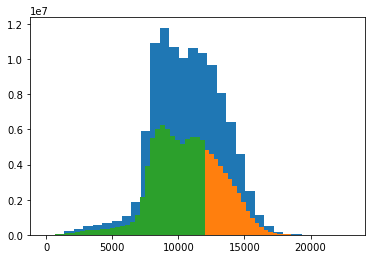

In [248]:
tl12000_cd=clthresh(cd,12000)
tu12000_cd=cuthresh(cd,12000)
plt.hist(cd[np.nonzero(cd)], 32);
plt.hist(tl12000_cd[np.nonzero(tl12000_cd)], 32);
plt.hist(tu12000_cd[np.nonzero(tu12000_cd)], 32);

In [223]:
print(cd.shape)
print(tl12000_cd.shape)

(1200, 91282)
(1200, 91282)


In [214]:
min(cd[np.nonzero(cd)])
max(cd[np.nonzero(cd)])

22970.512

In [184]:
fmri_cifti_data=np.asarray(img.get_data()).copy()
fmri_cifti_head=img.header.copy()
fmri_cifti_nhead=img.nifti_header.copy()
fmri_cifti_extra=img.extra.copy()
fmri_cifti_fmap=img.file_map.copy()
#out_img = nb.cifti2.Cifti2Image(dataobj=fmri_cifti_data, header=fmri_cifti_head,nifti_header=fmri_cifti_nhead, extra=fmri_cifti_extra, file_map=fmri_cifti_fmap)
#cifti_out=nhw+'/custom_rfMRI1_LR.dtseries.nii'
#img.to_filename(cifti_out)
#%whos

In [185]:
#thresh_data=fmri_cifti_data[fmri_cifti_data>10000]
thresh_data=fmri_cifti_data.copy()
thresh_data[thresh_data<10000]=0
#a[a > 10] = 0
#thresh_data = [0 if fmri_cifti_data_ > 10000 for fmri_cifti_data_ in fmri_cifti_data]
out_img = nb.cifti2.Cifti2Image(dataobj=thresh_data, header=fmri_cifti_head,nifti_header=fmri_cifti_nhead, extra=fmri_cifti_extra, file_map=fmri_cifti_fmap)


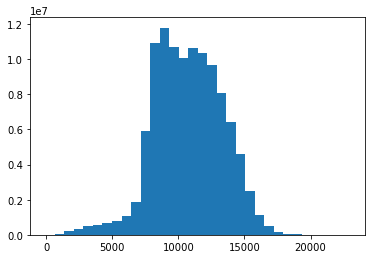

In [171]:
plt.hist(fmri_cifti_data[np.nonzero(fmri_cifti_data)], 32);

In [234]:
stufftosave=[tu12000_cd,ch,cn,cx,cf]
out_img = nb.cifti2.Cifti2Image(dataobj=cd,header=ch,nifti_header=cn, extra=cx, file_map=cf)
cout=nb.Cifti2Image(dataobj=cd,header=ch,nifti_header=cn, extra=cx, file_map=cf)
#nb.save()

#%whos

In [232]:
def csave(filename,cdata,chead=None,cnhdr=None,cxtra=None,cfmap=None):
    # saves a cifti data structure to file. Output likely unusable without some header info
    cout=nb.Cifti2Image(dataobj=cdata,header=chead,nifti_header=cnhdr, extra=cxtra, file_map=cfmap)
    cout.to_filename(filename)
#cifti_out=nhw+'/'+thresh_rfMRI1_LR.dtseries.nii'
#out_img.to_filename(cifti_out)

In [242]:
csave(nhw+'/test_csave_data_nhdr.dtseries.nii',cd,None,cn)
#post_thresh= nb.cifti2.Cifti2Image.from_filename(cifti_out)

In [295]:
def cmask(cdata1,cdata2):
    # masks cifti data 1 with non-zero values of cifti data 2
    # cdata2 can be a single timepoint or matched to cdata1 dimensions
    masked_cdata1=cdata1.copy()
    if cdata1.shape != cdata2.shape:
        mask=np.tile(cdata2,(cdata1.shape[0],1))
#        return mask.shape
    else:
        mask=cdata2.copy()
#        return mask.shape

    masked_cdata1[mask==0]=0
    return masked_cdata1

In [292]:
np.tile(cd[0],(cd.shape[0],1)).shape

(1200, 91282)

In [296]:
masked_cd=cmask(cd,tu12000_cd[0])

1200
91282


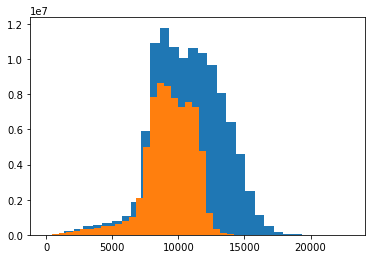

In [298]:
plt.hist(cd[np.nonzero(cd)], 32);
plt.hist(masked_cd[np.nonzero(masked_cd)], 32);

In [299]:
csave(nhw+'/test_cmask_cd_singlevol.dtseries.nii',masked_cd,ch,cn,cx,cf)

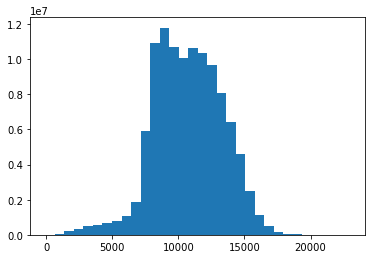

In [175]:
post_thresh_data=np.asarray(post_thresh.get_data())

plt.hist(post_thresh_data[np.nonzero(post_thresh_data)], 32);

In [162]:
thresh_data[thresh_data<20000]=0
thresh_data

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]], dtype=float32)

In [89]:
#%whos
#fMRI_data

fmri_cifti_in,aa = cifti.read('/Users/ely/Desktop/HCP/100610/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_Atlas_MSMAll_hp2000_clean.dtseries.nii')

pixdim[1,2,3] should be non-zero; setting 0 dims to 1


In [94]:
aa[0]
def write(filename, arr, axes):
    img = cifti2.Cifti2Image(np.asarray(arr), axis.to_header(axes))
    img.to_filename(filename)

In [21]:
fig = p3.figure(width=600, height=600)
fig.camera_fov = 1
fig.style = {'axes': {'color': 'black',
  'label': {'color': 'black'},
  'ticklabel': {'color': 'black'},
  'visible': False},
 'background-color': 'white',
 'box': {'visible': False}}
fig.xlim = (-100, 100)
fig.ylim = (-100, 100)
fig.zlim = (-100, 100)

# plot each hemisphere
#x, y, z = data_lh[0][:, 0], data_lh[0][:, 1], data_lh[0][:, 2]
#p3.plot_trisurf(x, y, z, triangles=data_lh[1], color='gray')

#activation=np.linspace(0,1,x.shape[0]) #np.ones(x.shape[0]) #
#activation2 = np.ones(x.shape[0])
#color_lh=plt.cm.autumn(olay_lh)
color_lh=plt.cm.viridis(np.log(olay_lh+sys.float_info.epsilon))
color_rh=plt.cm.viridis(np.log(olay_rh+sys.float_info.epsilon))

#colors
x, y, z = xyz_lh.data.T
surf_lh = p3.plot_trisurf(y, z, x, triangles=mesh_lh.data[cort_mask_lh], color=color_lh[:,:3])
#sub_lh = p3.plot_trisurf(x, y, z, triangles=mesh_lh.data[sub_mask_lh], color=color_lh[:,:3])
x, y, z = xyz_rh.data.T
#surf_rh = p3.plot_trisurf(y*1.1, z*1.1, x*1.1, triangles=mesh_rh.data[cort_mask_rh], color=color_rh[:,:3])
#surf_rh = p3.plot_trisurf(x, y, z, triangles=mesh_rh.data[cort_mask_rh], color=color_rh[:,:3])
#sub_rh = p3.plot_trisurf(x, y, z, triangles=mesh_rh.data[sub_mask_rh], color=color_rh[:,:3])

x, y, z = sub_mask1
#surf_sub = p3.plot_trisurf(x, y, z,triangles=np.ones_like(sub_mask1),color='grey')

#x, y, z = xyz_rh.data.T
#surf_rh = p3.plot_trisurf(x, y, z, triangles=mesh_rh.data, color=color_rh[:,:3])



#x, y, z = data_rh[0][:, 0], data_rh[0][:, 1], data_rh[0][:, 2]
#p3.plot_trisurf(x, y, z, triangles=data_rh[1], color='gray')

p3.show()

NameError: name 'olay_lh' is not defined

In [668]:
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure
#from skimage.draw import ellipsoid
#sub_mask2=np.asarray(sub_mask)
#sub_mask2.ndim
#verts, faces, normals, values = measure.marching_cubes_lewiner(sub_mask2.T, 0)
#%whos
#sorted(xyz_lh.data.T[1])
#print(max(xyz_lh.data.T[1]))
#print(min(xyz_lh.data.T[1]))
#xyz_lh.data.T.shape
#real_coords.data.shape
#p3.plot_wireframe(x,y,z, color='red', wrapx=False, wrapy=False)
#x.shape
p3.volshow(subcort_disp)
#p3.volshow(real_coords)
#p3.plot_isosurface(subcort_disp)
#p3.plot_isosurface(real_coords)
#p3.plot
#x, y, z = real_coords.T
#p3.plot_trisurf(x, y, z)


A Jupyter Widget

In [663]:
sub_mask2.T.ndim

3

In [ ]:
p3.plot_trisurf(x, y, z,triangles=np.ones_like(sub_mask1),color='grey')

In [513]:
fig

A Jupyter Widget

In [41]:
color2_lh = plt.cm.autumn(np.log(olay_lh+sys.float_info.epsilon))
color2_rh = plt.cm.autumn(np.log(olay_rh+sys.float_info.epsilon))

In [42]:
surf_lh.color = color2_lh[:, :3]
surf_rh.color = color2_rh[:, :3]

## Exercise 3: 

Plot the smoothwm surfaces of subject 1.

In [450]:
data_lhs = nb.freesurfer.read_geometry('/data/ds000114/derivatives/freesurfer/sub-01/surf/lh.smoothwm')
data_rhs = nb.freesurfer.read_geometry('/data/ds000114/derivatives/freesurfer/sub-01/surf/rh.smoothwm')

fig = p3.figure(width=600, height=600)
fig.camera_fov = 1
fig.style = {'axes': {'color': 'black',
  'label': {'color': 'black'},
  'ticklabel': {'color': 'black'},
  'visible': False},
 'background-color': 'white',
 'box': {'visible': False}}
fig.xlim = (-100, 100)
fig.ylim = (-100, 100)
fig.zlim = (-100, 100)

# plot each hemisphere
x, y, z = data_lhs[0][:, 0], data_lhs[0][:, 1], data_lhs[0][:, 2]
p3.plot_trisurf(x, y, z, triangles=data_lhs[1], color='gray')

x, y, z = data_rhs[0][:, 0], data_rhs[0][:, 1], data_rhs[0][:, 2]
p3.plot_trisurf(x, y, z, triangles=data_rhs[1], color='gray')

p3.show()

FileNotFoundError: [Errno 2] No such file or directory: '/data/ds000114/derivatives/freesurfer/sub-01/surf/lh.smoothwm'

In [15]:
# Create solution here

# load data

# extract and plot each hemisphere

The dataset we are using also has the surfaces stored in `gifti` format under `derivatives/fmriprep`. In addition, the freesurfer output for these subjects also has the parcellation files. Nibabel can read these files.

In [16]:
data_lh = [val.data for val in nb.load('/data/ds000114/derivatives/fmriprep/sub-01/anat/sub-01_t1w_smoothwm.l.surf.gii').darrays]
data_rh = [val.data for val in nb.load('/data/ds000114/derivatives/fmriprep/sub-01/anat/sub-01_t1w_smoothwm.r.surf.gii').darrays]

# Read the annot files and extract the colors.
annot_rh = nb.freesurfer.read_annot('/data/ds000114/derivatives/freesurfer/sub-01/label/rh.aparc.dktatlas.annot')
colors_rh = annot_rh[1][annot_rh[0], 0:3]/255.
annot_lh = nb.freesurfer.read_annot('/data/ds000114/derivatives/freesurfer/sub-01/label/lh.aparc.dktatlas.annot')
colors_lh = annot_lh[1][annot_lh[0], 0:3]/255.

In [17]:
fig = p3.figure(width=600, height=600)
# we draw the tetrahedron
x, y, z = data_lh[0][:, 0], data_lh[0][:, 1], data_lh[0][:, 2]
p3.plot_trisurf(x, y, z, triangles=data_lh[1], color=colors_lh)
x, y, z = data_rh[0][:, 0], data_rh[0][:, 1], data_rh[0][:, 2]
p3.plot_trisurf(x, y, z, triangles=data_rh[1], color=colors_rh)
fig.camera_fov = 1
fig.xlim = (-100, 100)
fig.ylim = (-100, 100)
fig.zlim = (-100, 100)
p3.show()

A Jupyter Widget

We can load the functional time series preprocessed by fmriprep

In [18]:
lh_func = nb.load('/data/ds000114/derivatives/fmriprep/sub-02/ses-test/func/sub-02_ses-test_task-fingerfootlips_bold_space-fsaverage5.l.func.gii')
data = np.vstack([val.data for val in lh_func.darrays]).T

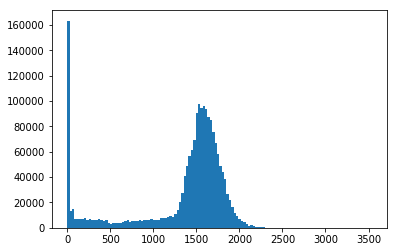

In [19]:
plt.hist(data.flatten(), 128);

In [20]:
data[data<500] = np.nan
mean_val = np.nanmean(data)
data_change = (data - mean_val)/mean_val
mean_epi = np.nanmedian(data, axis=1) - mean_val
mean_std = np.nanstd(mean_epi)
mean_epi[np.isnan(mean_epi)] = 0.
data[np.isnan(data)] = 0.
print(mean_epi.shape, mean_val, mean_std)

(10242,) 1542.41 288.133


/opt/conda/envs/neuro3/lib/python3.6/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


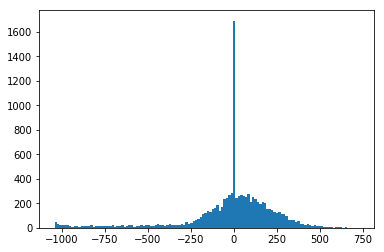

In [21]:
plt.hist(mean_epi, 128);

In [22]:
def vals2colors(vals):
    cmap = np.vstack((plt.cm.viridis(range(256)), plt.cm.cool(range(256))))
    indices = 256 + (255 * vals).astype(int)
    return cmap[indices, 0:3]

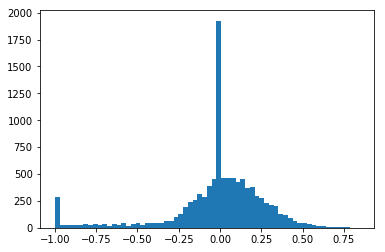

In [23]:
epi_vals = np.minimum(np.maximum(mean_epi/(3 * mean_std), -1), 1)
colors = vals2colors(epi_vals)
plt.hist(epi_vals, 64);

If you do not have lh.smoothwm you can retrieve it using the following command

```
!datalad get /data/ds000114/derivatives/freesurfer/fsaverage5/surf/lh.smoothwm
```

In [24]:
data_fs = nb.freesurfer.read_geometry('/data/ds000114/derivatives/freesurfer/fsaverage5/surf/lh.smoothwm')

fig = p3.figure(width=600, height=600)
# we draw the tetrahedron
x, y, z = data_fs[0][:, 0], data_fs[0][:, 1], data_fs[0][:, 2]
p3.plot_trisurf(x, y, z, triangles=data_fs[1], color=colors)
fig.camera_fov = 1
fig.anglex = np.pi/2
fig.angley = -np.pi/2
fig.xlim = (-100, 100)
fig.ylim = (-100, 100)
fig.zlim = (-100, 100)
p3.show()

A Jupyter Widget

## Exercise 4:

Plot the mean activity of the functional time series (stored as gifti) on the surface of the fsaverage5 mesh. The fmriprep routine generates these surface-based timeseries files.

- extract principal components of the data scikit-learn 
- plot the first two components on the surface of the mesh


In [25]:
from sklearn.decomposition import PCA
foo = PCA(n_components=2).fit_transform(data)

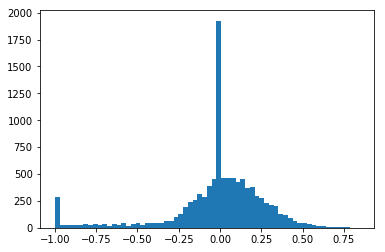

In [26]:
comp_vals = np.minimum(np.maximum(foo[:, 0]/(3 * np.std(foo[:, 0])), -1), 1)
colors = vals2colors(comp_vals)
plt.hist(epi_vals, 64);

In [27]:
data_fs = nb.freesurfer.read_geometry('/data/ds000114/derivatives/freesurfer/fsaverage5/surf/lh.smoothwm')

fig = p3.figure(width=600, height=600)
# we draw the tetrahedron
x, y, z = data_fs[0][:, 0], data_fs[0][:, 1], data_fs[0][:, 2]
p3.plot_trisurf(x, y, z, triangles=data_fs[1], color=colors)
fig.camera_fov = 1
fig.anglex = np.pi/2
fig.angley = -np.pi/2
fig.xlim = (-100, 100)
fig.ylim = (-100, 100)
fig.zlim = (-100, 100)
p3.show()

A Jupyter Widget

In [28]:
# Look up how to use PCA from scikit learn

# Follow the steps from above to plot the two components

<b> ~~~~~ BONEYARD ~~~~~ </b>

In [4]:
from urllib.request import urlretrieve
urlretrieve('https://osf.io/7jbpr/download?version=1', '/tmp/T1.nii.gz')

('/tmp/T1.nii.gz', <http.client.HTTPMessage at 0x1274fa710>)

In [ ]:
fig.trait_names

## Exercise 1:

Turn this image into a face

- adjust the transfer function using `level`, `opacity`, and `max_opacity`
- adjust lighting using `lighting` and `diffuse_coefficient`
- turn of controls after you are done adjusting
- fix the aspect ratio based on dimensions
  The image is always rendered into a cube, so extend the volume with zeros to create a uniform cube
- use `downscale` to do faster rendering

In [50]:
# Here is an example of mesh plotting from the IPYVolume documentation

s = 1/2**0.5

# Create 4 vertices for the tetrahedron
x = np.array([1.,  -1, 0,  0])
y = np.array([0,   0, 1., -1])
z = np.array([-s, -s, s,  s])

# and 4 surfaces (triangles or faces), where the number refer to the vertex index
triangles = [(0, 1, 2), (0, 1, 3), (0, 2, 3), (1,3,2)]

In [51]:
fig = p3.figure()
# we draw the tetrahedron
p3.plot_trisurf(x, y, z, triangles=triangles, color='orange')
# and also mark the vertices
p3.scatter(x, y, z, marker='sphere', color='blue')
p3.xyzlim(-2, 2)
p3.show()

A Jupyter Widget